In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import pickle
import numpy as np 
import pandas as pd

from hyperopt import tpe, hp, fmin, STATUS_OK,Trials
from hyperopt.pyll.base import scope

import matplotlib.pyplot as plt
import seaborn as sns

import olympus
from olympus.datasets import Dataset 
from olympus.emulators import Emulator
from olympus.models import BayesNeuralNet



In [3]:
new_datasets = ['agnp', 'autoam', 'crossed_barrel', 'p3ht', 'thin_film']

In [4]:
# find the bounds reported bounds of the parameters for each dataset
for dataset_name in new_datasets:
    
    print('dataset name : ', dataset_name)
    df = pd.read_csv(f'../src/olympus/datasets/dataset_{dataset_name}/data.csv', header=None)
    print(df.min(axis=0))
    print(df.max(axis=0))
    print(' ')
    print('-'*50)

dataset name :  agnp
0      4.530000
1      9.999518
2      0.500000
3      0.498852
4    200.000000
5      0.148361
dtype: float64
0     42.809816
1     40.001015
2     30.500000
3     19.500000
4    983.000000
5      0.907004
dtype: float64
 
--------------------------------------------------
dataset name :  autoam
0    0.0
1    0.1
2   -1.0
3   -1.0
4    0.0
dtype: float64
0     5.000000
1    10.000000
2     1.000000
3     1.000000
4     0.936549
dtype: float64
 
--------------------------------------------------
dataset name :  crossed_barrel
0    6.000000
1    0.000000
2    1.500000
3    0.700000
4    0.433235
dtype: float64
0     12.000000
1    200.000000
2      2.500000
3      1.400000
4     46.711405
dtype: float64
 
--------------------------------------------------
dataset name :  p3ht
0    15.000000
1     0.000000
2     0.000000
3     0.000000
4     0.000000
5     2.740952
dtype: float64
0     96.27
1     60.00
2     70.00
3     85.00
4     75.00
5    838.31
dtype: float64
 

In [5]:
df = pd.read_csv(f'../src/olympus/datasets/dataset_thin_film/data.csv', header=None)
print(df.shape)
df.head()

(94, 4)


,0,1,2,3
0,0.00,1.00,0.00,492921.0
1,0.50,0.50,0.00,328254.5
2,0.75,0.25,0.00,263555.0
3,1.00,0.00,0.00,247891.5
4,0.00,0.75,0.25,948003.0


```
space = {
    "n_estimators": hp.choice("n_estimators", [100, 200, 300, 400,500,600]),
    "max_depth": hp.quniform("max_depth", 1, 15,1),
    "criterion": hp.choice("criterion", ["gini", "entropy"]),
}
```
```
Hyperparameters for the original datasets within Olympus
	<Emulator (Dataset(kind=photo_wf3), model=
--> batch_size:    50
--> es_patience:   200
--> hidden_act:    leaky_relu
--> hidden_depth:  3
--> hidden_nodes:  60
--> kind:          BayesNeuralNet
--> learning_rate: 0.0015
--> max_epochs:    100000
--> out_act:       relu
--> pred_int:      100
--> reg:           0.005
--> scope:         model)>
```



## dataset_agnp

In [6]:
search_space = {
    'batch_size': hp.quniform('batch_size', 10, 50, 10),
    'hidden_act': hp.choice('hidden_act', ['leaky_relu'] ),
    'hidden_depth': hp.quniform('hidden_depth', 2, 5, 1),
    'hidden_nodes': hp.quniform('hidden_nodes', 28, 64, 4),
    'learning_rate': hp.uniform('learning_rate', 1e-5, 5e-3),
    'reg': hp.uniform('reg', 0.001, 0.1)
}

int_params = ['batch_size', 'hidden_depth', 'hidden_nodes']

In [7]:
all_emulators = []
all_losses = []
all_cv_scores = []
all_params = []

In [8]:
def objective(params):
    ''' average performance over cross-validation folds '''
    # build emualtor
    print(f'PARAMS : {params}')
    for param, val in params.items():
        if param in int_params:
            params[param] = int(val)
    model  = BayesNeuralNet(**params, out_act='sigmoid')
    emulator = Emulator(dataset='agnp', model=model)

    cv_scores = emulator.cross_validate()
    loss = np.mean(cv_scores['validate_rmsd'])
    
    all_losses.append(loss)
    all_cv_scores.append(cv_scores)
    all_params.append(params)
    all_emulators.append(emulator)
    
    return {'loss': loss, 'status': STATUS_OK}

In [9]:
trials = Trials()

best = fmin(
    fn=objective,
    space=search_space, 
    algo=tpe.suggest, 
    max_evals=10,
    trials=trials
)

print(f"BEST VALUE : {best}")

PARAMS : {'batch_size': 10.0, 'hidden_act': 'leaky_relu', 'hidden_depth': 3.0, 'hidden_nodes': 56.0, 'learning_rate': 0.0017966963567733571, 'reg': 0.016510093686681923}
  0%|          | 0/10 [00:00<?, ?trial/s, best loss=?][INFO] >>> Training model on fold #0...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.454          0.201         -1.778          0.303 *
[INFO]             100         -6.714          0.464         -4.039          0.408
[INFO]             200         -6.714          0.464         -4.039          0.408
[INFO]             300         -6.714          0.464         -4.039          0.408
[INFO]             400         -6.487          0.457         -4.039          0.408
[INFO]             500         -6.714          0.464         -4.039          0.408
[INFO]             600         -6.714          0.464         -4.039          0.408
[INFO]             700         -6.714          0.464         -4.039          0.408
[INFO]             800         -6.714          0.464         -4.039          0.408
[I

[INFO]            8600         -6.683          0.463         -3.728          0.395
[INFO]            8700         -6.714          0.464         -4.039          0.408
[INFO]            8800         -6.714          0.464         -4.039          0.408
[INFO]            8900         -6.714          0.464         -3.972          0.405
[INFO]            9000         -6.714          0.464         -4.039          0.408
[INFO]            9100         -6.714          0.464         -4.039          0.408
[INFO]            9200         -6.475          0.457         -3.782          0.397
[INFO]            9300         -6.714          0.464         -3.782          0.397
[INFO]            9400         -6.516          0.458         -4.039          0.408
[INFO]            9500         -6.714          0.464         -3.849          0.400
[INFO]            9600         -6.683          0.463         -4.039          0.408
[INFO]            9700         -6.714          0.464         -4.039          0.408
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -3.073          0.270         -2.737          0.294 *
[INFO]             100        -11.978          0.482        -14.379          0.596
[INFO]             200        -11.935          0.481        -14.379          0.596
[INFO]             300        -11.976          0.482        -14.379          0.596
[INFO]             400        -11.978          0.482        -14.379          0.596
[INFO]             500        -11.978          0.482        -14.379          0.596
[INFO]             600        -11.133          0.466        -13.596          0.580
[INFO]             700        -11.978          0.482        -14.379          0.596
[INFO]             800        -11.978          0.482        -14.379          0.596
[I

[INFO]            8700        -10.646          0.456         -4.149          0.345
[INFO]            8800        -11.698          0.476         -4.214          0.347
[INFO]            8900         -9.518          0.434         -3.266          0.314
[INFO]            9000         -8.816          0.419         -3.241          0.313
[INFO]            9100        -11.786          0.478         -3.359          0.317
[INFO]            9200        -10.918          0.462         -5.363          0.383
[INFO]            9300        -12.330          0.488         -5.627          0.391
[INFO]            9400        -13.032          0.501         -6.311          0.411
[INFO]            9500        -14.132          0.520         -6.969          0.429
[INFO]            9600        -13.680          0.512         -7.244          0.436
[INFO]            9700        -14.265          0.522         -5.683          0.393
[INFO]            9800        -14.265          0.522         -6.944          0.428
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0        -10.357          0.543         -8.377          0.373 *
[INFO]             100         -7.155          0.460        -24.949          0.620
[INFO]             200         -7.155          0.460        -24.949          0.620
[INFO]             300         -7.155          0.460        -24.949          0.620
[INFO]             400         -5.381          0.407        -17.872          0.529
[INFO]             500         -7.155          0.460        -24.949          0.620
[INFO]             600         -6.809          0.450        -23.096          0.597
[INFO]             700         -7.155          0.460        -24.949          0.620
[INFO]             800         -7.155          0.460        -24.949          0.620
[I

[INFO]            8600         -6.666          0.446        -24.228          0.611
[INFO]            8700         -6.989          0.455        -24.396          0.613
[INFO]            8800         -7.155          0.460        -24.396          0.613
[INFO]            8900         -7.048          0.457        -24.949          0.620
[INFO]            9000         -7.155          0.460        -24.119          0.610
[INFO]            9100         -7.155          0.460        -24.949          0.620
[INFO]            9200         -6.989          0.455        -24.396          0.613
[INFO]            9300         -6.809          0.450        -22.960          0.596
[INFO]            9400         -6.660          0.446        -24.949          0.620
[INFO]            9500         -6.053          0.428        -24.949          0.620
[INFO]            9600         -7.155          0.460        -23.512          0.602
[INFO]            9700         -6.666          0.446        -24.949          0.620
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.966          0.284         -0.782          0.259 *
[INFO]             100         -6.013          0.536         -8.735          0.606
[INFO]             200         -6.013          0.536         -8.735          0.606
[INFO]             300         -5.253          0.506         -7.077          0.552
[INFO]             400         -6.183          0.543         -4.815          0.468
[INFO]             500         -6.183          0.543         -4.815          0.468
[INFO]             600         -6.183          0.543         -4.815          0.468
[INFO]             700         -6.054          0.538         -4.377          0.450
[INFO]             800         -6.183          0.543         -4.815          0.468
[I

[INFO]            8700          0.300          0.169          0.023          0.192 *
[INFO]            8800         -0.748          0.268         -0.609          0.246
[INFO]            8900         -0.823          0.273         -1.002          0.275
[INFO]            9000         -0.971          0.284         -1.296          0.294
[INFO]            9100         -1.627          0.328         -1.146          0.284
[INFO]            9200         -1.646          0.329         -0.472          0.236
[INFO]            9300         -0.987          0.285         -1.498          0.307
[INFO]            9400         -3.031          0.407         -1.489          0.306
[INFO]            9500         -3.712          0.440         -2.530          0.365
[INFO]            9600         -1.982          0.350         -1.737          0.321
[INFO]            9700         -1.946          0.348         -1.986          0.336
[INFO]            9800         -3.622          0.435         -1.524          0.309
[I

[INFO]           17600         -1.179          0.299         -0.398          0.230
[INFO]           17700         -1.480          0.319         -2.220          0.348
[INFO]           17800         -0.318          0.232         -0.574          0.244
[INFO]           17900         -1.497          0.320         -0.294          0.221
[INFO]           18000         -1.185          0.299         -0.688          0.252
[INFO]           18100         -3.075          0.409         -0.613          0.247
[INFO]           18200         -0.821          0.273         -0.338          0.225
[INFO]           18300         -0.934          0.282         -0.698          0.253
[INFO]           18400         -1.163          0.298         -1.486          0.306
[INFO]           18500         -1.161          0.298         -0.940          0.270
[INFO]           18600         -1.121          0.295         -1.186          0.287
[INFO]           18700         -1.399          0.314          0.096          0.185
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -5.846          0.541         -7.829          0.593 *
[INFO]             100         -5.919          0.544         -7.831          0.593
[INFO]             200         -5.919          0.544         -7.831          0.593
[INFO]             300         -5.919          0.544         -7.831          0.593
[INFO]             400         -5.919          0.544         -7.831          0.593
[INFO]             500         -5.919          0.544         -7.831          0.593
[INFO]             600         -5.919          0.544         -7.831          0.593
[INFO]             700         -5.919          0.544         -7.831          0.593
[INFO]             800         -5.627          0.532         -6.603          0.550 *


[INFO]            8500         -5.464          0.525         -6.526          0.548
[INFO]            8600         -5.754          0.537         -6.798          0.557
[INFO]            8700         -5.846          0.541         -6.559          0.549
[INFO]            8800         -5.601          0.531         -7.831          0.593
[INFO]            8900         -4.928          0.503         -7.132          0.569
[INFO]            9000         -5.919          0.544         -7.831          0.593
[INFO]            9100         -5.919          0.544         -7.831          0.593
[INFO]            9200         -5.390          0.522         -7.592          0.585
[INFO]            9300         -5.919          0.544         -7.774          0.591
[INFO]            9400         -5.534          0.528         -7.471          0.581
[INFO]            9500         -5.681          0.534         -7.831          0.593
[INFO]            9600         -5.474          0.526         -7.831          0.593
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.754          0.225         -0.256          0.233 *
[INFO]             100         -0.091          0.177          0.059          0.201 *
[INFO]             200         -0.093          0.177         -0.004          0.208
[INFO]             300          0.001          0.170          0.012          0.206
[INFO]             400          0.050          0.165          0.024          0.205
[INFO]             500         -0.052          0.174          0.018          0.206
[INFO]             600         -0.010          0.171          0.018          0.206
[INFO]             700         -0.004          0.170         -0.021          0.210
[INFO]             800          0.033          0.167         -0.013          0.209


[INFO]            8400          0.192          0.153          0.365          0.165
[INFO]            8500          0.105          0.161          0.353          0.167
[INFO]            8600          0.150          0.156          0.351          0.167
[INFO]            8700          0.212          0.151          0.307          0.173
[INFO]            8800          0.151          0.156          0.292          0.175
[INFO]            8900          0.156          0.156          0.363          0.166
[INFO]            9000          0.142          0.157          0.314          0.172
[INFO]            9100          0.152          0.156          0.328          0.170
[INFO]            9200          0.099          0.161          0.397          0.161
[INFO]            9300          0.187          0.153          0.340          0.169
[INFO]            9400          0.148          0.157          0.367          0.165
[INFO]            9500          0.171          0.155          0.370          0.165
[INF

[INFO]           17200          0.134          0.158          0.428          0.157
[INFO]           17300          0.091          0.162          0.410          0.159
[INFO]           17400          0.198          0.152          0.455          0.153
[INFO]           17500          0.136          0.158          0.384          0.163
[INFO]           17600          0.183          0.153          0.467          0.152
[INFO]           17700          0.144          0.157          0.449          0.154
[INFO]           17800          0.140          0.157          0.438          0.156
[INFO]           17900          0.192          0.153          0.417          0.158
[INFO]           18000          0.196          0.152          0.437          0.156
[INFO]           18100          0.134          0.158          0.497          0.147 *
[INFO]           18200          0.153          0.156          0.463          0.152
[INFO]           18300          0.135          0.158          0.416          0.159
[I

[INFO]           26000          0.351          0.137          0.557          0.138
[INFO]           26100          0.386          0.133          0.542          0.141
[INFO]           26200          0.396          0.132          0.540          0.141
[INFO]           26300          0.423          0.129          0.572          0.136
[INFO]           26400          0.426          0.129          0.580          0.135
[INFO]           26500          0.427          0.128          0.533          0.142
[INFO]           26600          0.365          0.135          0.546          0.140
[INFO]           26700          0.431          0.128          0.582          0.134 *
[INFO]           26800          0.452          0.126          0.550          0.139
[INFO]           26900          0.431          0.128          0.590          0.133 *
[INFO]           27000          0.416          0.130          0.531          0.142
[INFO]           27100          0.422          0.129          0.564          0.137


[INFO]           34800          0.798          0.076          0.860          0.078
[INFO]           34900          0.821          0.072          0.850          0.080
[INFO]           35000          0.807          0.074          0.870          0.075
[INFO]           35100          0.780          0.080          0.867          0.076
[INFO]           35200          0.841          0.068          0.862          0.077
[INFO]           35300          0.859          0.064          0.870          0.075
[INFO]           35400          0.811          0.074          0.881          0.072 *
[INFO]           35500          0.841          0.068          0.874          0.074
[INFO]           35600          0.832          0.070          0.857          0.078
[INFO]           35700          0.870          0.061          0.870          0.075
[INFO]           35800          0.849          0.066          0.886          0.070 *
[INFO]           35900          0.822          0.072          0.890          0.069 

[INFO]           43500          0.914          0.050          0.920          0.059
[INFO]           43600          0.914          0.050          0.911          0.062
[INFO]           43700          0.918          0.049          0.922          0.058
[INFO]           43800          0.896          0.055          0.926          0.057
[INFO]           43900          0.893          0.056          0.926          0.056
[INFO]           44000          0.910          0.051          0.923          0.058
[INFO]           44100          0.913          0.050          0.932          0.054
[INFO]           44200          0.916          0.049          0.931          0.054
[INFO]           44300          0.914          0.050          0.923          0.058
[INFO]           44400          0.915          0.050          0.928          0.056
[INFO]           44500          0.922          0.047          0.919          0.059
[INFO]           44600          0.919          0.048          0.928          0.056
[INF

[INFO]           52300          0.941          0.041          0.941          0.050
[INFO]           52400          0.938          0.042          0.943          0.050
[INFO]           52500          0.933          0.044          0.939          0.051
[INFO]           52600          0.934          0.044          0.940          0.051
[INFO]           52700          0.938          0.042          0.934          0.053
[INFO]           52800          0.942          0.041          0.941          0.050
[INFO]           52900          0.941          0.041          0.947          0.048 *
[INFO]           53000          0.944          0.040          0.937          0.052
[INFO]           53100          0.939          0.042          0.938          0.052
[INFO]           53200          0.938          0.042          0.939          0.051
[INFO]           53300          0.937          0.043          0.934          0.053
[INFO]           53400          0.939          0.042          0.939          0.051
[I

[INFO]           61100          0.946          0.040          0.938          0.052
[INFO]           61200          0.948          0.039          0.936          0.053
[INFO]           61300          0.959          0.034          0.941          0.050
[INFO]           61400          0.935          0.043          0.938          0.052
[INFO]           61500          0.953          0.037          0.935          0.053
[INFO]           61600          0.952          0.037          0.940          0.051
[INFO]           61700          0.951          0.038          0.941          0.051
[INFO]           61800          0.952          0.037          0.940          0.051
[INFO]           61900          0.958          0.035          0.943          0.049
[INFO]           62000          0.956          0.035          0.946          0.048
[INFO]           62100          0.958          0.035          0.944          0.049
[INFO]           62200          0.946          0.039          0.935          0.053
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.916          0.312         -1.219          0.259 *
[INFO]             100         -0.027          0.228         -0.142          0.186 *
[INFO]             200          0.037          0.221         -0.015          0.175 *
[INFO]             300          0.001          0.225         -0.080          0.181
[INFO]             400          0.013          0.224          0.060          0.169 *
[INFO]             500         -0.014          0.227         -0.044          0.178
[INFO]             600          0.020          0.223          0.064          0.168 *
[INFO]             700          0.019          0.223          0.045          0.170
[INFO]             800          0.006          0.224         -0.043          

[INFO]            8400          0.365          0.179          0.582          0.112
[INFO]            8500          0.381          0.177          0.582          0.112
[INFO]            8600          0.377          0.178          0.610          0.109
[INFO]            8700          0.372          0.178          0.574          0.113
[INFO]            8800          0.366          0.179          0.628          0.106 *
[INFO]            8900          0.360          0.180          0.600          0.110
[INFO]            9000          0.379          0.177          0.620          0.107
[INFO]            9100          0.412          0.173          0.632          0.105 *
[INFO]            9200          0.423          0.171          0.678          0.099 *
[INFO]            9300          0.413          0.172          0.657          0.102
[INFO]            9400          0.418          0.172          0.604          0.109
[INFO]            9500          0.410          0.173          0.593          0.11

[INFO]           17200          0.491          0.161          0.714          0.093
[INFO]           17300          0.459          0.166          0.730          0.090
[INFO]           17400          0.450          0.167          0.722          0.092
[INFO]           17500          0.493          0.160          0.728          0.091
[INFO]           17600          0.491          0.161          0.742          0.088
[INFO]           17700          0.467          0.164          0.751          0.087
[INFO]           17800          0.513          0.157          0.757          0.086
[INFO]           17900          0.485          0.162          0.757          0.086
[INFO]           18000          0.473          0.163          0.748          0.087
[INFO]           18100          0.459          0.166          0.772          0.083 *
[INFO]           18200          0.499          0.159          0.765          0.084
[INFO]           18300          0.516          0.157          0.748          0.087
[I

[INFO]           25900          0.880          0.078          0.805          0.077
[INFO]           26000          0.890          0.075          0.868          0.063
[INFO]           26100          0.873          0.080          0.833          0.071
[INFO]           26200          0.909          0.068          0.846          0.068
[INFO]           26300          0.889          0.075          0.841          0.069
[INFO]           26400          0.925          0.061          0.800          0.078
[INFO]           26500          0.881          0.078          0.879          0.060
[INFO]           26600          0.906          0.069          0.890          0.058 *
[INFO]           26700          0.913          0.066          0.832          0.071
[INFO]           26800          0.897          0.072          0.877          0.061
[INFO]           26900          0.887          0.076          0.871          0.062
[INFO]           27000          0.906          0.069          0.846          0.068
[I

[INFO]           34700          0.955          0.048          0.881          0.060
[INFO]           34800          0.965          0.042          0.894          0.057
[INFO]           34900          0.958          0.046          0.909          0.053
[INFO]           35000          0.949          0.051          0.899          0.055
[INFO]           35100          0.970          0.039          0.872          0.062
[INFO]           35200          0.965          0.042          0.911          0.052
[INFO]           35300          0.965          0.042          0.888          0.058
[INFO]           35400          0.965          0.042          0.908          0.053
[INFO]           35500          0.963          0.043          0.900          0.055
[INFO]           35600          0.959          0.045          0.900          0.055
[INFO]           35700          0.955          0.048          0.900          0.055
[INFO]           35800          0.964          0.043          0.891          0.057
[INF

[INFO]           43500          0.970          0.039          0.890          0.058
[INFO]           43600          0.974          0.036          0.897          0.056
[INFO]           43700          0.969          0.039          0.886          0.059
[INFO]           43800          0.974          0.036          0.887          0.058
[INFO]           43900          0.975          0.036          0.882          0.060
[INFO]           44000          0.975          0.035          0.902          0.055
[INFO]           44100          0.972          0.038          0.888          0.058
[INFO]           44200          0.976          0.035          0.897          0.056
[INFO]           44300          0.974          0.036          0.899          0.055
[INFO]           44400          0.973          0.037          0.899          0.055
[INFO]           44500          0.971          0.039          0.900          0.055
[INFO]           44600          0.976          0.035          0.879          0.060
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -3.063          0.351         -6.355          0.430 *
[INFO]             100         -0.106          0.183         -0.525          0.196 *
[INFO]             200          0.006          0.173         -0.589          0.200
[INFO]             300          0.017          0.172         -0.467          0.192 *
[INFO]             400          0.065          0.168         -0.514          0.195
[INFO]             500          0.020          0.172         -0.509          0.195
[INFO]             600          0.064          0.168         -0.574          0.199
[INFO]             700          0.060          0.169         -0.484          0.193
[INFO]             800          0.076          0.167         -0.598          0.20

[INFO]            8500          0.325          0.143         -0.213          0.175
[INFO]            8600          0.383          0.137         -0.223          0.175
[INFO]            8700          0.313          0.144         -0.259          0.178
[INFO]            8800          0.400          0.135         -0.183          0.172
[INFO]            8900          0.444          0.130         -0.182          0.172
[INFO]            9000          0.319          0.143         -0.440          0.190
[INFO]            9100          0.406          0.134         -0.272          0.179
[INFO]            9200          0.306          0.145         -0.232          0.176
[INFO]            9300          0.346          0.141         -0.285          0.180
[INFO]            9400          0.413          0.133         -0.232          0.176
[INFO]            9500          0.361          0.139         -0.107          0.167
[INFO]            9600          0.421          0.132         -0.110          0.167
[INF

[INFO]           17400          0.416          0.133         -0.400          0.188
[INFO]           17500          0.523          0.120         -0.257          0.178
[INFO]           17600          0.529          0.119         -0.333          0.183
[INFO]           17700          0.460          0.128         -0.224          0.175
[INFO]           17800          0.396          0.135         -0.407          0.188
[INFO]           17900          0.519          0.121         -0.253          0.177
[INFO]           18000          0.504          0.122         -0.457          0.191
[INFO]           18100          0.454          0.128         -0.419          0.189
[INFO]           18200          0.530          0.119         -0.289          0.180
[INFO]           18300          0.594          0.111         -0.221          0.175
[INFO]           18400          0.540          0.118         -0.171          0.172
[INFO]           18500          0.549          0.117         -0.326          0.183
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.190          0.191         -0.404          0.248 *
[INFO]             100         -0.049          0.179         -0.133          0.223 *
[INFO]             200          0.009          0.174          0.048          0.205 *
[INFO]             300          0.031          0.172         -0.136          0.223
[INFO]             400          0.061          0.170         -0.013          0.211
[INFO]             500          0.027          0.173         -0.037          0.213
[INFO]             600          0.006          0.175          0.002          0.209
[INFO]             700          0.052          0.171         -0.072          0.217
[INFO]             800          0.055          0.170         -0.024          0.21

[INFO]            8400          0.374          0.139          0.286          0.177
[INFO]            8500          0.265          0.150          0.193          0.188
[INFO]            8600          0.337          0.143          0.262          0.180
[INFO]            8700          0.322          0.144          0.343          0.170 *
[INFO]            8800          0.317          0.145          0.349          0.169 *
[INFO]            8900          0.261          0.151          0.275          0.179
[INFO]            9000          0.320          0.144          0.301          0.175
[INFO]            9100          0.278          0.149          0.383          0.165 *
[INFO]            9200          0.383          0.138          0.270          0.179
[INFO]            9300          0.311          0.145          0.330          0.172
[INFO]            9400          0.352          0.141          0.380          0.165
[INFO]            9500          0.308          0.146          0.305          0.17

[INFO]           17100          0.345          0.142          0.515          0.146 *
[INFO]           17200          0.369          0.139          0.426          0.159
[INFO]           17300          0.324          0.144          0.478          0.151
[INFO]           17400          0.344          0.142          0.438          0.157
[INFO]           17500          0.397          0.136          0.473          0.152
[INFO]           17600          0.360          0.140          0.457          0.154
[INFO]           17700          0.313          0.145          0.462          0.154
[INFO]           17800          0.348          0.141          0.423          0.159
[INFO]           17900          0.375          0.138          0.452          0.155
[INFO]           18000          0.346          0.142          0.453          0.155
[INFO]           18100          0.331          0.143          0.444          0.156
[INFO]           18200          0.353          0.141          0.457          0.154
[I

[INFO]           25900          0.739          0.089          0.710          0.113
[INFO]           26000          0.740          0.089          0.718          0.111
[INFO]           26100          0.773          0.083          0.738          0.107
[INFO]           26200          0.784          0.081          0.685          0.118
[INFO]           26300          0.791          0.080          0.744          0.106
[INFO]           26400          0.804          0.078          0.751          0.105
[INFO]           26500          0.759          0.086          0.767          0.101 *
[INFO]           26600          0.809          0.077          0.775          0.099 *
[INFO]           26700          0.811          0.076          0.775          0.099 *
[INFO]           26800          0.821          0.074          0.773          0.100
[INFO]           26900          0.812          0.076          0.744          0.106
[INFO]           27000          0.825          0.073          0.813          0.09

[INFO]           34600          0.931          0.046          0.895          0.068
[INFO]           34700          0.933          0.045          0.926          0.057
[INFO]           34800          0.928          0.047          0.930          0.055
[INFO]           34900          0.937          0.044          0.915          0.061
[INFO]           35000          0.923          0.049          0.914          0.061
[INFO]           35100          0.928          0.047          0.899          0.067
[INFO]           35200          0.938          0.044          0.929          0.056
[INFO]           35300          0.930          0.046          0.930          0.055
[INFO]           35400          0.941          0.042          0.928          0.056
[INFO]           35500          0.945          0.041          0.915          0.061
[INFO]           35600          0.935          0.045          0.922          0.059
[INFO]           35700          0.944          0.041          0.920          0.059
[INF

[INFO]           43500          0.948          0.040          0.943          0.050
[INFO]           43600          0.949          0.039          0.957          0.043
[INFO]           43700          0.954          0.038          0.955          0.044
[INFO]           43800          0.949          0.040          0.949          0.047
[INFO]           43900          0.943          0.042          0.948          0.048
[INFO]           44000          0.945          0.041          0.945          0.049
[INFO]           44100          0.949          0.040          0.948          0.048
[INFO]           44200          0.955          0.037          0.953          0.045
[INFO]           44300          0.952          0.038          0.945          0.049
[INFO]           44400          0.943          0.042          0.955          0.044
[INFO]           44500          0.944          0.042          0.954          0.045
[INFO]           44600          0.951          0.039          0.951          0.046
[INF

[INFO]           52200          0.955          0.037          0.964          0.040
[INFO]           52300          0.957          0.036          0.959          0.042
[INFO]           52400          0.954          0.037          0.962          0.041
[INFO]           52500          0.954          0.038          0.962          0.041
[INFO]           52600          0.952          0.038          0.961          0.042
[INFO]           52700          0.957          0.036          0.958          0.043
[INFO]           52800          0.954          0.038          0.960          0.042
[INFO]           52900          0.950          0.039          0.957          0.043
[INFO]           53000          0.952          0.038          0.961          0.041
[INFO]           53100          0.957          0.036          0.950          0.047
[INFO]           53200          0.956          0.037          0.954          0.045
[INFO]           53300          0.947          0.040          0.956          0.044
[INF

[INFO]           61100          0.966          0.032          0.960          0.042
[INFO]           61200          0.960          0.035          0.959          0.042
[INFO]           61300          0.963          0.034          0.968          0.038 *
[INFO]           61400          0.965          0.033          0.964          0.040
[INFO]           61500          0.967          0.032          0.966          0.039
[INFO]           61600          0.965          0.033          0.961          0.041
[INFO]           61700          0.964          0.033          0.959          0.043
[INFO]           61800          0.965          0.033          0.966          0.039
[INFO]           61900          0.961          0.034          0.964          0.040
[INFO]           62000          0.966          0.032          0.959          0.042
[INFO]           62100          0.969          0.031          0.962          0.041
[INFO]           62200          0.965          0.033          0.964          0.040
[I

[INFO]           70000          0.970          0.030          0.961          0.042
[INFO]           70100          0.968          0.031          0.962          0.041
[INFO]           70200          0.972          0.029          0.962          0.041
[INFO]           70300          0.970          0.031          0.961          0.041
[INFO]           70400          0.973          0.029          0.962          0.041
[INFO]           70500          0.973          0.029          0.963          0.040
[INFO]           70600          0.972          0.029          0.964          0.040
[INFO]           70700          0.973          0.029          0.964          0.040
[INFO]           70800          0.970          0.030          0.959          0.042
[INFO]           70900          0.973          0.029          0.961          0.041
[INFO]           71000          0.973          0.029          0.959          0.043
[INFO]           71100          0.973          0.029          0.962          0.041
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -2.183          0.351         -2.024          0.308 *
[INFO]             100         -0.041          0.200          0.056          0.172 *
[INFO]             200         -0.057          0.202          0.105          0.168 *
[INFO]             300         -0.009          0.197         -0.176          0.192
[INFO]             400         -0.004          0.197         -0.027          0.180
[INFO]             500          0.016          0.195         -0.052          0.182
[INFO]             600          0.030          0.193         -0.050          0.182
[INFO]             700          0.038          0.193         -0.005          0.178
[INFO]             800         -0.017          0.198         -0.020          0.17

[INFO]            8400          0.432          0.148          0.360          0.142
[INFO]            8500          0.346          0.159          0.370          0.141
[INFO]            8600          0.477          0.142          0.370          0.141
[INFO]            8700          0.417          0.150          0.405          0.137
[INFO]            8800          0.450          0.146          0.405          0.137
[INFO]            8900          0.497          0.139          0.453          0.131 *
[INFO]            9000          0.388          0.154          0.382          0.139
[INFO]            9100          0.425          0.149          0.349          0.143
[INFO]            9200          0.380          0.155          0.376          0.140
[INFO]            9300          0.403          0.152          0.326          0.146
[INFO]            9400          0.428          0.149          0.466          0.130 *
[INFO]            9500          0.407          0.151          0.350          0.143


[INFO]           17200          0.533          0.134          0.426          0.134
[INFO]           17300          0.474          0.143          0.431          0.134
[INFO]           17400          0.498          0.139          0.427          0.134
[INFO]           17500          0.544          0.133          0.452          0.131
[INFO]           17600          0.530          0.135          0.429          0.134
[INFO]           17700          0.541          0.133          0.417          0.135
[INFO]           17800          0.543          0.133          0.414          0.136
[INFO]           17900          0.524          0.135          0.528          0.122 *
[INFO]           18000          0.524          0.136          0.487          0.127
[INFO]           18100          0.495          0.140          0.431          0.134
[INFO]           18200          0.531          0.135          0.460          0.130
[INFO]           18300          0.542          0.133          0.444          0.132
[I

[INFO]           26000          0.729          0.102          0.571          0.116
[INFO]           26100          0.709          0.106          0.609          0.111
[INFO]           26200          0.702          0.107          0.600          0.112
[INFO]           26300          0.750          0.098          0.573          0.116
[INFO]           26400          0.711          0.106          0.598          0.112
[INFO]           26500          0.756          0.097          0.694          0.098 *
[INFO]           26600          0.712          0.105          0.606          0.111
[INFO]           26700          0.722          0.104          0.626          0.109
[INFO]           26800          0.761          0.096          0.643          0.106
[INFO]           26900          0.756          0.097          0.609          0.111
[INFO]           27000          0.770          0.094          0.612          0.110
[INFO]           27100          0.753          0.098          0.633          0.108
[I

[INFO]           34800          0.917          0.057          0.844          0.070
[INFO]           34900          0.937          0.049          0.855          0.068
[INFO]           35000          0.923          0.054          0.854          0.068
[INFO]           35100          0.945          0.046          0.869          0.064
[INFO]           35200          0.927          0.053          0.833          0.073
[INFO]           35300          0.933          0.051          0.836          0.072
[INFO]           35400          0.929          0.053          0.855          0.067
[INFO]           35500          0.930          0.052          0.857          0.067
[INFO]           35600          0.922          0.055          0.870          0.064 *
[INFO]           35700          0.933          0.051          0.872          0.064 *
[INFO]           35800          0.943          0.047          0.867          0.065
[INFO]           35900          0.936          0.050          0.848          0.069


[INFO]           43600          0.952          0.043          0.893          0.058
[INFO]           43700          0.954          0.042          0.884          0.060
[INFO]           43800          0.946          0.046          0.897          0.057
[INFO]           43900          0.957          0.041          0.896          0.057
[INFO]           44000          0.953          0.043          0.886          0.060
[INFO]           44100          0.950          0.044          0.898          0.057
[INFO]           44200          0.953          0.043          0.899          0.056
[INFO]           44300          0.958          0.040          0.905          0.055
[INFO]           44400          0.957          0.041          0.903          0.055
[INFO]           44500          0.954          0.042          0.887          0.060
[INFO]           44600          0.945          0.046          0.901          0.056
[INFO]           44700          0.947          0.045          0.901          0.056
[INF

[INFO]           52400          0.966          0.036          0.887          0.060
[INFO]           52500          0.960          0.039          0.905          0.055
[INFO]           52600          0.965          0.037          0.903          0.055
[INFO]           52700          0.960          0.040          0.911          0.053
[INFO]           52800          0.966          0.036          0.897          0.057
[INFO]           52900          0.965          0.037          0.892          0.058
[INFO]           53000          0.968          0.035          0.902          0.056
[INFO]           53100          0.965          0.037          0.910          0.053
[INFO]           53200          0.963          0.038          0.899          0.056
[INFO]           53300          0.965          0.037          0.890          0.059
[INFO]           53400          0.956          0.041          0.905          0.055
[INFO]           53500          0.960          0.039          0.905          0.055
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.318          0.273         -0.900          0.249 *
[INFO]             100         -0.713          0.235         -0.174          0.196 *
[INFO]             200         -0.002          0.180         -0.172          0.196 *
[INFO]             300         -0.031          0.182         -0.101          0.190 *
[INFO]             400         -0.028          0.182          0.000          0.181 *
[INFO]             500         -0.008          0.180         -0.001          0.181
[INFO]             600          0.029          0.177         -0.036          0.184
[INFO]             700          0.022          0.178         -0.019          0.183
[INFO]             800          0.024          0.177         -0.042          

[INFO]            8400          0.938          0.045          0.846          0.071
[INFO]            8500          0.947          0.041          0.879          0.063 *
[INFO]            8600          0.942          0.043          0.847          0.071
[INFO]            8700          0.945          0.042          0.872          0.065
[INFO]            8800          0.953          0.039          0.883          0.062 *
[INFO]            8900          0.947          0.041          0.863          0.067
[INFO]            9000          0.947          0.041          0.859          0.068
[INFO]            9100          0.946          0.042          0.886          0.061 *
[INFO]            9200          0.949          0.041          0.869          0.065
[INFO]            9300          0.945          0.042          0.869          0.066
[INFO]            9400          0.949          0.041          0.883          0.062
[INFO]            9500          0.943          0.043          0.865          0.06

[INFO]           17200          0.976          0.028          0.856          0.069
[INFO]           17300          0.988          0.019          0.897          0.058
[INFO]           17400          0.991          0.017          0.859          0.068
[INFO]           17500          0.991          0.017          0.894          0.059
[INFO]           17600          0.991          0.017          0.870          0.065
[INFO]           17700          0.992          0.016          0.865          0.066
[INFO]           17800          0.989          0.019          0.859          0.068
[INFO]           17900          0.991          0.017          0.889          0.060
[INFO]           18000          0.992          0.016          0.873          0.065
[INFO]           18100          0.994          0.014          0.880          0.063
[INFO]           18200          0.989          0.019          0.862          0.067
[INFO]           18300          0.993          0.015          0.861          0.067
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -5.225          0.452         -4.074          0.409 *
[INFO]             100         -0.529          0.224         -0.258          0.204 *
[INFO]             200         -0.305          0.207         -0.381          0.213
[INFO]             300         -0.003          0.181         -0.139          0.194 *
[INFO]             400         -0.032          0.184         -0.332          0.210
[INFO]             500          0.036          0.178         -0.236          0.202
[INFO]             600          0.041          0.177          0.023          0.179 *
[INFO]             700         -0.007          0.182         -0.127          0.193
[INFO]             800          0.060          0.176         -0.217          0.

[INFO]            8400          0.946          0.042          0.886          0.061
[INFO]            8500          0.942          0.044          0.865          0.067
[INFO]            8600          0.943          0.043          0.840          0.073
[INFO]            8700          0.948          0.041          0.892          0.060
[INFO]            8800          0.952          0.040          0.876          0.064
[INFO]            8900          0.948          0.041          0.891          0.060
[INFO]            9000          0.946          0.042          0.872          0.065
[INFO]            9100          0.949          0.041          0.918          0.052 *
[INFO]            9200          0.952          0.040          0.888          0.061
[INFO]            9300          0.956          0.038          0.892          0.060
[INFO]            9400          0.947          0.042          0.898          0.058
[INFO]            9500          0.951          0.040          0.871          0.065
[I

[INFO]           17200          0.987          0.021          0.875          0.064
[INFO]           17300          0.988          0.020          0.853          0.070
[INFO]           17400          0.990          0.019          0.849          0.071
[INFO]           17500          0.991          0.018          0.869          0.066
[INFO]           17600          0.991          0.018          0.845          0.071
[INFO]           17700          0.991          0.017          0.868          0.066
[INFO]           17800          0.991          0.017          0.867          0.066
[INFO]           17900          0.991          0.017          0.858          0.069
[INFO]           18000          0.991          0.018          0.836          0.074
[INFO]           18100          0.988          0.020          0.854          0.069
[INFO]           18200          0.991          0.017          0.846          0.071
[INFO]           18300          0.986          0.022          0.867          0.066
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.609          0.258          0.027          0.198 *
[INFO]             100         -0.278          0.230         -0.139          0.215
[INFO]             200         -0.086          0.212         -0.108          0.212
[INFO]             300         -0.066          0.210         -0.076          0.209
[INFO]             400         -0.030          0.206         -0.039          0.205
[INFO]             500         -0.043          0.208         -0.094          0.210
[INFO]             600         -0.021          0.205         -0.052          0.206
[INFO]             700          0.007          0.203         -0.028          0.204
[INFO]             800          0.009          0.202          0.000          0.201
[I

[INFO]            8400          0.954          0.044          0.901          0.063
[INFO]            8500          0.958          0.041          0.915          0.059
[INFO]            8600          0.954          0.043          0.902          0.063
[INFO]            8700          0.955          0.043          0.916          0.058 *
[INFO]            8800          0.956          0.043          0.916          0.058 *
[INFO]            8900          0.954          0.044          0.910          0.060
[INFO]            9000          0.964          0.038          0.903          0.063
[INFO]            9100          0.963          0.039          0.900          0.064
[INFO]            9200          0.961          0.040          0.912          0.060
[INFO]            9300          0.964          0.039          0.908          0.061
[INFO]            9400          0.967          0.037          0.914          0.059
[INFO]            9500          0.964          0.038          0.911          0.060


[INFO]           17200          0.995          0.015          0.897          0.064
[INFO]           17300          0.995          0.015          0.906          0.062
[INFO]           17400          0.992          0.018          0.887          0.068
[INFO]           17500          0.995          0.014          0.903          0.063
[INFO]           17600          0.993          0.017          0.907          0.061
[INFO]           17700          0.996          0.013          0.901          0.063
[INFO]           17800          0.995          0.014          0.897          0.064
[INFO]           17900          0.993          0.017          0.894          0.065
[INFO]           18000          0.996          0.013          0.895          0.065
[INFO]           18100          0.991          0.019          0.884          0.069
[INFO]           18200          0.994          0.016          0.893          0.066
[INFO]           18300          0.993          0.017          0.889          0.067
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.864          0.304         -1.670          0.302 *
[INFO]             100         -0.112          0.189         -0.050          0.189 *
[INFO]             200          0.065          0.174         -0.064          0.190
[INFO]             300          0.036          0.176         -0.086          0.192
[INFO]             400         -0.045          0.184         -0.013          0.186 *
[INFO]             500         -0.041          0.183         -0.113          0.195
[INFO]             600          0.027          0.177         -0.058          0.190
[INFO]             700          0.012          0.179          0.103          0.175 *
[INFO]             800         -0.000          0.180          0.059          0.

[INFO]            8400          0.913          0.053          0.950          0.041
[INFO]            8500          0.928          0.048          0.967          0.034
[INFO]            8600          0.920          0.051          0.965          0.034
[INFO]            8700          0.928          0.048          0.940          0.045
[INFO]            8800          0.931          0.047          0.951          0.041
[INFO]            8900          0.937          0.045          0.953          0.040
[INFO]            9000          0.938          0.045          0.957          0.038
[INFO]            9100          0.945          0.042          0.960          0.037
[INFO]            9200          0.928          0.048          0.961          0.036
[INFO]            9300          0.941          0.044          0.934          0.047
[INFO]            9400          0.932          0.047          0.967          0.034
[INFO]            9500          0.916          0.052          0.968          0.033
[INF

[INFO]           17200          0.987          0.020          0.838          0.074
[INFO]           17300          0.986          0.022          0.820          0.078
[INFO] Training completed in 21.21 seconds.
[INFO] ===========================================================================

[INFO] >>> Training model on fold #4...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -3.884          0.437         -3.490          0.388 *
[INFO]             100         -0.377          0.232          0.034          0.180 *
[INFO]             200         -0.053          0.203         -0.076          0.190
[INFO]             300          0.044          0.193         -0.052          0.188
[INFO]             400          0.022          0.196         -0.047          0.187
[INFO]             500          0.040          0.194         -0.120          0.194
[INFO]             600         -0.003          0.198         -0.064          0.189
[INFO]             700          0.015          0.196          0.038          0.179 *
[INFO]             800          0.028          0.195         -0.015          0.18

[INFO]            8400          0.953          0.043          0.891          0.060 *
[INFO]            8500          0.952          0.043          0.895          0.059 *
[INFO]            8600          0.957          0.041          0.884          0.062
[INFO]            8700          0.954          0.043          0.898          0.058 *
[INFO]            8800          0.958          0.041          0.894          0.060
[INFO]            8900          0.958          0.041          0.900          0.058 *
[INFO]            9000          0.956          0.042          0.863          0.068
[INFO]            9100          0.954          0.042          0.892          0.060
[INFO]            9200          0.963          0.038          0.892          0.060
[INFO]            9300          0.960          0.040          0.888          0.061
[INFO]            9400          0.958          0.041          0.882          0.063
[INFO]            9500          0.963          0.038          0.892          0.

[INFO]           17200          0.987          0.022          0.914          0.054
[INFO]           17300          0.991          0.019          0.903          0.057
[INFO]           17400          0.991          0.019          0.910          0.055
[INFO]           17500          0.989          0.021          0.912          0.054
[INFO]           17600          0.986          0.024          0.899          0.058
[INFO]           17700          0.989          0.021          0.909          0.055
[INFO]           17800          0.986          0.023          0.910          0.055
[INFO]           17900          0.992          0.018          0.908          0.056
[INFO]           18000          0.995          0.015          0.907          0.056
[INFO]           18100          0.993          0.016          0.905          0.056
[INFO]           18200          0.994          0.015          0.908          0.055
[INFO]           18300          0.993          0.016          0.907          0.056
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.772          0.334         -0.991          0.293 *
[INFO]             100          0.010          0.200         -0.007          0.209 *
[INFO]             200         -0.003          0.201          0.001          0.208 *
[INFO]             300          0.025          0.198          0.060          0.202 *
[INFO]             400          0.302          0.168          0.483          0.149 *
[INFO]             500          0.401          0.155          0.428          0.157
[INFO]             600          0.626          0.123          0.573          0.136 *
[INFO]             700          0.570          0.132          0.557          0.138
[INFO]             800          0.669          0.115          0.609        

[INFO]            8500          0.994          0.015          0.942          0.050
[INFO]            8600          0.995          0.015          0.941          0.050
[INFO]            8700          0.995          0.015          0.949          0.047
[INFO]            8800          0.984          0.025          0.950          0.047
[INFO]            8900          0.995          0.014          0.950          0.046
[INFO]            9000          0.994          0.015          0.943          0.050
[INFO]            9100          0.997          0.012          0.949          0.047
[INFO]            9200          0.994          0.016          0.948          0.047
[INFO]            9300          0.994          0.016          0.941          0.050
[INFO]            9400          0.995          0.015          0.949          0.047
[INFO]            9500          0.994          0.016          0.947          0.048
[INFO]            9600          0.985          0.025          0.924          0.057
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.946          0.226         -0.604          0.208 *
[INFO]             100         -0.039          0.165         -0.084          0.171 *
[INFO]             200         -0.068          0.168          0.002          0.164 *
[INFO]             300          0.140          0.150          0.029          0.161 *
[INFO]             400          0.284          0.137         -0.080          0.170
[INFO]             500          0.422          0.123          0.108          0.155 *
[INFO]             600          0.323          0.133          0.181          0.148 *
[INFO]             700          0.497          0.115          0.190          0.148 *
[INFO]             800          0.579          0.105          0.159      

[INFO]            8400          0.977          0.024          0.830          0.068
[INFO]            8500          0.989          0.017          0.844          0.065
[INFO]            8600          0.990          0.016          0.817          0.070
[INFO]            8700          0.989          0.017          0.860          0.061
[INFO]            8800          0.991          0.016          0.823          0.069
[INFO]            8900          0.993          0.014          0.823          0.069
[INFO]            9000          0.992          0.014          0.832          0.067
[INFO]            9100          0.989          0.017          0.855          0.062
[INFO]            9200          0.980          0.023          0.844          0.065
[INFO]            9300          0.991          0.015          0.835          0.067
[INFO]            9400          0.993          0.014          0.822          0.069
[INFO]            9500          0.992          0.014          0.837          0.066
[INF

[INFO]           17200          0.995          0.011          0.867          0.060
[INFO]           17300          0.996          0.010          0.861          0.061
[INFO]           17400          0.987          0.018          0.842          0.065
[INFO]           17500          0.995          0.012          0.857          0.062
[INFO]           17600          0.993          0.013          0.851          0.063
[INFO]           17700          0.994          0.012          0.867          0.060
[INFO]           17800          0.986          0.019          0.856          0.062
[INFO]           17900          0.997          0.009          0.852          0.063
[INFO]           18000          0.994          0.012          0.827          0.068
[INFO]           18100          0.998          0.008          0.852          0.063
[INFO]           18200          0.940          0.040          0.844          0.065
[INFO]           18300          0.990          0.016          0.887          0.055
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.395          0.203         -0.002          0.200 *
[INFO]             100          0.026          0.169         -0.073          0.207
[INFO]             200          0.014          0.170          0.010          0.198 *
[INFO]             300          0.203          0.153          0.023          0.197 *
[INFO]             400          0.351          0.138          0.333          0.163 *
[INFO]             500          0.206          0.153          0.252          0.172
[INFO]             600          0.232          0.150          0.569          0.131 *
[INFO]             700          0.379          0.135          0.753          0.099 *
[INFO]             800          0.395          0.133          0.772        

[INFO]            8400          0.995          0.012          0.900          0.063
[INFO]            8500          0.997          0.010          0.911          0.059
[INFO]            8600          0.995          0.012          0.919          0.057
[INFO]            8700          0.997          0.010          0.904          0.062
[INFO]            8800          0.992          0.016          0.924          0.055
[INFO]            8900          0.994          0.013          0.920          0.056
[INFO]            9000          0.996          0.011          0.886          0.067
[INFO]            9100          0.985          0.021          0.900          0.063
[INFO]            9200          0.997          0.010          0.916          0.058
[INFO]            9300          0.994          0.013          0.915          0.058
[INFO]            9400          0.997          0.009          0.909          0.060
[INFO]            9500          0.998          0.009          0.915          0.058
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -2.539          0.353         -3.807          0.366 *
[INFO]             100         -0.044          0.192         -0.359          0.195 *
[INFO]             200         -0.014          0.189         -0.205          0.183 *
[INFO]             300          0.257          0.162          0.005          0.167 *
[INFO]             400          0.624          0.115          0.300          0.140 *
[INFO]             500          0.631          0.114          0.218          0.148
[INFO]             600          0.733          0.097          0.243          0.145
[INFO]             700          0.645          0.112          0.217          0.148
[INFO]             800          0.680          0.106          0.209          

[INFO]            8500          0.996          0.012          0.875          0.059
[INFO]            8600          0.996          0.011          0.884          0.057
[INFO]            8700          0.990          0.018          0.871          0.060
[INFO]            8800          0.995          0.014          0.882          0.057
[INFO]            8900          0.995          0.013          0.881          0.058
[INFO]            9000          0.991          0.018          0.892          0.055
[INFO]            9100          0.987          0.022          0.867          0.061
[INFO]            9200          0.991          0.018          0.890          0.055
[INFO]            9300          0.997          0.010          0.884          0.057
[INFO]            9400          0.996          0.012          0.880          0.058
[INFO]            9500          0.997          0.010          0.887          0.056
[INFO]            9600          0.991          0.018          0.888          0.056
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.289          0.219         -0.351          0.206 *
[INFO]             100         -0.012          0.194          0.009          0.177 *
[INFO]             200          0.064          0.187          0.007          0.177
[INFO]             300          0.300          0.161          0.115          0.167 *
[INFO]             400          0.498          0.137          0.281          0.150 *
[INFO]             500          0.600          0.122          0.445          0.132 *
[INFO]             600          0.607          0.121          0.476          0.128 *
[INFO]             700          0.578          0.125          0.474          0.129
[INFO]             800          0.636          0.116          0.506        

[INFO]            8500          0.989          0.020          0.912          0.053
[INFO]            8600          0.992          0.018          0.908          0.054
[INFO]            8700          0.991          0.019          0.914          0.052
[INFO]            8800          0.986          0.023          0.919          0.050
[INFO]            8900          0.983          0.025          0.902          0.055
[INFO]            9000          0.988          0.021          0.923          0.049
[INFO]            9100          0.989          0.020          0.906          0.054
[INFO]            9200          0.992          0.017          0.914          0.052
[INFO]            9300          0.990          0.019          0.910          0.053
[INFO]            9400          0.993          0.016          0.913          0.052
[INFO]            9500          0.990          0.019          0.901          0.056
[INFO]            9600          0.991          0.019          0.921          0.050
[INF

[INFO]           17300          0.994          0.015          0.893          0.058
[INFO]           17400          0.995          0.013          0.886          0.060
[INFO]           17500          0.995          0.014          0.893          0.058
[INFO]           17600          0.991          0.018          0.888          0.059
[INFO]           17700          0.994          0.015          0.895          0.057
[INFO]           17800          0.993          0.016          0.887          0.059
[INFO] Training completed in 20.67 seconds.
[INFO] ===========================================================================

[INFO] Performance statistics based on transformed data [identity, identity]:
[INFO] Validation   R2: 0.9323 +/- 0.0088
[INFO] Validation RSMD: 0.0467 +/- 0.0015
PARAMS : {'batch_size': 20.0, 'hidden_act': 'leaky_relu', 'hidden_depth': 3.0, 'hidden_nodes': 48.0, 'learning_rate': 0.0004647011903955103, 'reg': 0.05378755963751468}
 40%|████      | 4/10 [10:12<14:41, 146.99s

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.399          0.335         -1.401          0.266 *
[INFO]             100         -0.581          0.272         -0.395          0.203 *
[INFO]             200         -0.094          0.226         -0.195          0.188 *
[INFO]             300         -0.343          0.251         -0.195          0.188 *
[INFO]             400         -0.234          0.240         -0.832          0.232
[INFO]             500         -0.183          0.235         -0.156          0.184 *
[INFO]             600         -0.024          0.219         -0.103          0.180 *
[INFO]             700         -0.099          0.227         -0.134          0.183
[INFO]             800         -0.154          0.232         -0.191        

[INFO]            8400          0.705          0.117          0.463          0.126
[INFO]            8500          0.722          0.114          0.457          0.126
[INFO]            8600          0.745          0.109          0.398          0.133
[INFO]            8700          0.721          0.114          0.358          0.137
[INFO]            8800          0.738          0.111          0.413          0.131
[INFO]            8900          0.745          0.109          0.413          0.131
[INFO]            9000          0.687          0.121          0.449          0.127
[INFO]            9100          0.729          0.113          0.483          0.123
[INFO]            9200          0.691          0.120          0.410          0.132
[INFO]            9300          0.705          0.118          0.419          0.131
[INFO]            9400          0.730          0.112          0.395          0.133
[INFO]            9500          0.665          0.125          0.356          0.138
[INF

[INFO]           17100          0.825          0.090          0.751          0.086
[INFO]           17200          0.872          0.077          0.791          0.078
[INFO]           17300          0.890          0.072          0.791          0.078
[INFO]           17400          0.910          0.065          0.715          0.092
[INFO]           17500          0.897          0.069          0.817          0.073 *
[INFO]           17600          0.871          0.078          0.762          0.084
[INFO]           17700          0.878          0.076          0.697          0.094
[INFO]           17800          0.877          0.076          0.785          0.079
[INFO]           17900          0.913          0.064          0.710          0.092
[INFO]           18000          0.897          0.069          0.835          0.070 *
[INFO]           18100          0.877          0.076          0.622          0.105
[INFO]           18200          0.872          0.077          0.887          0.058 

[INFO]           26000          0.911          0.064          0.899          0.054
[INFO]           26100          0.921          0.061          0.847          0.067
[INFO]           26200          0.927          0.058          0.884          0.058
[INFO]           26300          0.905          0.067          0.924          0.047
[INFO]           26400          0.870          0.078          0.819          0.073
[INFO]           26500          0.894          0.070          0.806          0.076
[INFO]           26600          0.922          0.060          0.865          0.063
[INFO]           26700          0.925          0.059          0.857          0.065
[INFO]           26800          0.917          0.062          0.839          0.069
[INFO]           26900          0.915          0.063          0.914          0.050
[INFO]           27000          0.925          0.059          0.898          0.055
[INFO]           27100          0.920          0.061          0.908          0.052
[INF

[INFO]           34900          0.906          0.066          0.869          0.062
[INFO]           35000          0.947          0.050          0.877          0.060
[INFO]           35100          0.937          0.054          0.864          0.063
[INFO]           35200          0.918          0.062          0.944          0.040 *
[INFO]           35300          0.935          0.055          0.934          0.044
[INFO]           35400          0.907          0.066          0.937          0.043
[INFO]           35500          0.897          0.069          0.926          0.047
[INFO]           35600          0.917          0.062          0.917          0.049
[INFO]           35700          0.926          0.059          0.945          0.040 *
[INFO]           35800          0.951          0.048          0.921          0.048
[INFO]           35900          0.923          0.060          0.924          0.047
[INFO]           36000          0.914          0.063          0.936          0.043


[INFO]           43800          0.938          0.054          0.900          0.054
[INFO]           43900          0.948          0.049          0.928          0.046
[INFO]           44000          0.917          0.062          0.878          0.060
[INFO]           44100          0.925          0.059          0.954          0.037
[INFO]           44200          0.926          0.059          0.837          0.069
[INFO]           44300          0.934          0.055          0.933          0.044
[INFO]           44400          0.948          0.049          0.945          0.040
[INFO]           44500          0.940          0.053          0.915          0.050
[INFO]           44600          0.935          0.055          0.841          0.068
[INFO]           44700          0.944          0.051          0.929          0.046
[INFO]           44800          0.944          0.051          0.930          0.045
[INFO]           44900          0.945          0.051          0.871          0.062
[INF

[INFO]           52700          0.941          0.052          0.939          0.042
[INFO]           52800          0.934          0.056          0.968          0.031 *
[INFO]           52900          0.937          0.054          0.964          0.033
[INFO]           53000          0.954          0.046          0.948          0.039
[INFO]           53100          0.929          0.057          0.943          0.041
[INFO]           53200          0.943          0.052          0.945          0.040
[INFO]           53300          0.927          0.058          0.923          0.048
[INFO]           53400          0.945          0.051          0.912          0.051
[INFO]           53500          0.951          0.048          0.952          0.037
[INFO]           53600          0.934          0.055          0.906          0.053
[INFO]           53700          0.951          0.048          0.938          0.043
[INFO]           53800          0.957          0.045          0.943          0.041
[I

[INFO]           61600          0.954          0.046          0.960          0.034
[INFO]           61700          0.959          0.044          0.949          0.039
[INFO]           61800          0.950          0.048          0.947          0.039
[INFO]           61900          0.955          0.046          0.956          0.036
[INFO]           62000          0.953          0.047          0.936          0.043
[INFO]           62100          0.923          0.060          0.883          0.059
[INFO]           62200          0.957          0.045          0.955          0.036
[INFO]           62300          0.950          0.049          0.951          0.038
[INFO]           62400          0.946          0.050          0.948          0.039
[INFO]           62500          0.944          0.051          0.963          0.033
[INFO]           62600          0.955          0.046          0.894          0.056
[INFO]           62700          0.959          0.044          0.951          0.038
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -7.080          0.455         -4.470          0.535 *
[INFO]             100         -1.216          0.238         -0.474          0.278 *
[INFO]             200         -0.999          0.226         -0.355          0.266 *
[INFO]             300         -1.215          0.238         -0.377          0.269
[INFO]             400         -0.709          0.209         -0.053          0.235 *
[INFO]             500         -0.268          0.180         -0.155          0.246
[INFO]             600         -0.289          0.182          0.136          0.213 *
[INFO]             700         -0.258          0.179         -0.012          0.230
[INFO]             800         -0.308          0.183         -0.192          

[INFO]            8600          0.116          0.150          0.614          0.142
[INFO]            8700          0.176          0.145          0.556          0.153
[INFO]            8800          0.066          0.155          0.579          0.149
[INFO]            8900          0.206          0.143          0.585          0.148
[INFO]            9000          0.207          0.142          0.556          0.153
[INFO]            9100          0.047          0.156          0.476          0.166
[INFO]            9200          0.111          0.151          0.613          0.142
[INFO]            9300         -0.174          0.173          0.574          0.149
[INFO]            9400          0.071          0.154          0.583          0.148
[INFO]            9500          0.112          0.151          0.599          0.145
[INFO]            9600          0.144          0.148          0.681          0.129 *
[INFO]            9700          0.202          0.143          0.561          0.152
[I

[INFO]           17400          0.275          0.136          0.596          0.145
[INFO]           17500          0.209          0.142          0.672          0.131
[INFO]           17600          0.337          0.130          0.580          0.148
[INFO]           17700          0.128          0.149          0.664          0.133
[INFO]           17800          0.438          0.120          0.622          0.141
[INFO]           17900          0.376          0.126          0.677          0.130
[INFO]           18000          0.382          0.126          0.634          0.138
[INFO]           18100          0.058          0.155          0.683          0.129
[INFO]           18200          0.248          0.139          0.720          0.121 *
[INFO]           18300          0.464          0.117          0.688          0.128
[INFO]           18400          0.271          0.137          0.709          0.124
[INFO]           18500          0.465          0.117          0.692          0.127
[I

[INFO]           26300          0.573          0.105          0.833          0.093
[INFO]           26400          0.574          0.104          0.849          0.089
[INFO]           26500          0.558          0.106          0.828          0.095
[INFO]           26600          0.657          0.094          0.883          0.078
[INFO]           26700          0.615          0.099          0.852          0.088
[INFO]           26800          0.660          0.093          0.877          0.080
[INFO]           26900          0.613          0.100          0.879          0.080
[INFO]           27000          0.685          0.090          0.842          0.091
[INFO]           27100          0.680          0.090          0.815          0.099
[INFO]           27200          0.686          0.090          0.894          0.075
[INFO]           27300          0.652          0.094          0.893          0.075
[INFO]           27400          0.766          0.077          0.871          0.082
[INF

[INFO]           35100          0.805          0.071          0.879          0.080
[INFO]           35200          0.753          0.079          0.898          0.073
[INFO]           35300          0.725          0.084          0.894          0.075
[INFO]           35400          0.822          0.068          0.911          0.068
[INFO]           35500          0.610          0.100          0.871          0.082
[INFO]           35600          0.660          0.093          0.884          0.078
[INFO]           35700          0.648          0.095          0.828          0.095
[INFO]           35800          0.761          0.078          0.929          0.061
[INFO]           35900          0.721          0.085          0.919          0.065
[INFO]           36000          0.694          0.088          0.875          0.081
[INFO]           36100          0.755          0.079          0.893          0.075
[INFO]           36200          0.755          0.079          0.902          0.072
[INF

[INFO]           44000          0.796          0.072          0.923          0.064
[INFO]           44100          0.813          0.069          0.933          0.059
[INFO]           44200          0.704          0.087          0.933          0.059
[INFO]           44300          0.721          0.084          0.931          0.060
[INFO]           44400          0.791          0.073          0.930          0.060
[INFO]           44500          0.818          0.068          0.921          0.064
[INFO]           44600          0.780          0.075          0.911          0.068
[INFO]           44700          0.774          0.076          0.903          0.071
[INFO]           44800          0.796          0.072          0.937          0.057
[INFO]           44900          0.809          0.070          0.940          0.056
[INFO]           45000          0.815          0.069          0.884          0.078
[INFO]           45100          0.684          0.090          0.951          0.051
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.276          0.202         -0.851          0.231 *
[INFO]             100         -0.752          0.237         -0.679          0.220 *
[INFO]             200         -0.790          0.240         -0.790          0.227
[INFO]             300         -0.510          0.220         -0.596          0.214 *
[INFO]             400         -0.588          0.226         -0.249          0.190 *
[INFO]             500         -0.331          0.207         -0.463          0.205
[INFO]             600         -0.163          0.193         -0.190          0.185 *
[INFO]             700         -0.112          0.189          0.039          0.166 *
[INFO]             800         -0.320          0.206          0.082        

[INFO]            8600          0.543          0.121          0.200          0.152
[INFO]            8700          0.513          0.125          0.225          0.149
[INFO]            8800          0.572          0.117          0.309          0.141
[INFO]            8900          0.534          0.122          0.370          0.135
[INFO]            9000          0.527          0.123          0.362          0.136
[INFO]            9100          0.552          0.120          0.127          0.159
[INFO]            9200          0.581          0.116          0.069          0.164
[INFO]            9300          0.597          0.114          0.236          0.148
[INFO]            9400          0.468          0.131          0.247          0.147
[INFO]            9500          0.525          0.124          0.184          0.153
[INFO]            9600          0.504          0.126          0.144          0.157
[INFO]            9700          0.553          0.120          0.274          0.145
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.687          0.274         -1.066          0.271 *
[INFO]             100         -0.425          0.252         -0.704          0.246 *
[INFO]             200         -0.199          0.231         -0.074          0.195 *
[INFO]             300         -0.114          0.223         -0.479          0.229
[INFO]             400         -0.186          0.230         -0.028          0.191 *
[INFO]             500         -0.070          0.218         -0.074          0.195
[INFO]             600         -0.458          0.255         -0.397          0.222
[INFO]             700          0.084          0.202         -0.147          0.202
[INFO]             800          0.133          0.196         -0.002          0.

[INFO]            8500          0.533          0.144          0.730          0.098
[INFO]            8600          0.519          0.146          0.635          0.114
[INFO]            8700          0.481          0.152          0.741          0.096
[INFO]            8800          0.616          0.131          0.637          0.113
[INFO]            8900          0.652          0.125          0.708          0.102
[INFO]            9000          0.501          0.149          0.696          0.104
[INFO]            9100          0.560          0.140          0.724          0.099
[INFO]            9200          0.546          0.142          0.639          0.113
[INFO]            9300          0.670          0.121          0.759          0.092 *
[INFO]            9400          0.579          0.137          0.772          0.090 *
[INFO]            9500          0.582          0.136          0.706          0.102
[INFO]            9600          0.504          0.149          0.685          0.106


[INFO]           17400          0.668          0.122          0.761          0.092
[INFO]           17500          0.669          0.121          0.800          0.084
[INFO]           17600          0.636          0.127          0.781          0.088
[INFO]           17700          0.663          0.122          0.793          0.086
[INFO]           17800          0.595          0.134          0.812          0.082
[INFO]           17900          0.638          0.127          0.777          0.089
[INFO]           18000          0.759          0.104          0.705          0.102
[INFO]           18100          0.701          0.115          0.783          0.088
[INFO]           18200          0.658          0.123          0.743          0.095
[INFO]           18300          0.745          0.107          0.796          0.085
[INFO]           18400          0.693          0.117          0.823          0.079
[INFO]           18500          0.645          0.126          0.806          0.083
[INF

[INFO]           26300          0.834          0.086          0.782          0.088
[INFO]           26400          0.813          0.091          0.789          0.086
[INFO]           26500          0.834          0.086          0.821          0.080
[INFO]           26600          0.811          0.092          0.817          0.081
[INFO]           26700          0.795          0.096          0.786          0.087
[INFO]           26800          0.818          0.090          0.711          0.101
[INFO]           26900          0.820          0.089          0.759          0.092
[INFO]           27000          0.792          0.096          0.677          0.107
[INFO]           27100          0.817          0.090          0.710          0.101
[INFO]           27200          0.821          0.089          0.836          0.076
[INFO]           27300          0.823          0.089          0.742          0.096
[INFO]           27400          0.829          0.087          0.768          0.091
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -5.540          0.439        -13.968          0.591 *
[INFO]             100         -0.191          0.187         -2.242          0.275 *
[INFO]             200         -1.236          0.257         -1.175          0.225 *
[INFO]             300         -1.041          0.245         -0.162          0.165 *
[INFO]             400         -0.220          0.190         -1.414          0.237
[INFO]             500         -0.493          0.210         -0.661          0.197
[INFO]             600         -0.671          0.222         -0.377          0.179
[INFO]             700         -0.289          0.195         -0.612          0.194
[INFO]             800         -0.817          0.231         -0.955          0.

[INFO]            8500          0.004          0.171         -0.973          0.215
[INFO]            8600          0.014          0.170         -0.573          0.192
[INFO]            8700          0.100          0.163         -0.842          0.207
[INFO]            8800          0.088          0.164         -0.964          0.214
[INFO]            8900          0.196          0.154         -0.982          0.215
[INFO]            9000          0.094          0.163         -1.011          0.217
[INFO]            9100          0.018          0.170         -0.638          0.196
[INFO]            9200          0.052          0.167         -0.983          0.215
[INFO]            9300          0.004          0.171         -0.791          0.205
[INFO]            9400          0.099          0.163         -0.580          0.192
[INFO]            9500          0.152          0.158         -0.870          0.209
[INFO]            9600          0.004          0.171         -0.919          0.212
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.285          0.224         -0.642          0.216 *
[INFO]             100         -0.046          0.202         -0.273          0.190 *
[INFO]             200         -0.021          0.200          0.027          0.166 *
[INFO]             300          0.063          0.191         -0.167          0.182
[INFO]             400          0.026          0.195         -0.175          0.183
[INFO]             500         -0.003          0.198         -0.152          0.181
[INFO]             600         -0.029          0.201         -0.256          0.189
[INFO]             700         -0.041          0.202         -0.070          0.174
[INFO]             800         -0.029          0.201         -0.215          0.18

[INFO]           17200          0.544          0.133          0.632          0.102
[INFO]           17300          0.621          0.122          0.672          0.097
[INFO]           17400          0.623          0.121          0.673          0.096
[INFO]           17500          0.635          0.119          0.667          0.097
[INFO]           17600          0.681          0.112          0.685          0.095
[INFO]           17700          0.627          0.121          0.606          0.106
[INFO]           17800          0.574          0.129          0.617          0.104
[INFO]           17900          0.626          0.121          0.720          0.089
[INFO]           18000          0.603          0.125          0.648          0.100
[INFO]           18100          0.557          0.132          0.728          0.088
[INFO]           18200          0.562          0.131          0.710          0.091
[INFO]           18300          0.619          0.122          0.633          0.102
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.419          0.287         -0.791          0.274 *
[INFO]             100         -0.259          0.207         -0.072          0.212 *
[INFO]             200         -0.058          0.190         -0.116          0.216
[INFO]             300         -0.051          0.189         -0.066          0.212 *
[INFO]             400         -0.103          0.194         -0.059          0.211 *
[INFO]             500         -0.039          0.188         -0.140          0.219
[INFO]             600          0.023          0.182          0.075          0.197 *
[INFO]             700          0.018          0.183         -0.019          0.207
[INFO]             800          0.139          0.171         -0.037          

[INFO]            8400          0.543          0.125          0.610          0.128 *
[INFO]            8500          0.497          0.131          0.559          0.136
[INFO]            8600          0.526          0.127          0.569          0.134
[INFO]            8700          0.487          0.132          0.586          0.132
[INFO]            8800          0.540          0.125          0.449          0.152
[INFO]            8900          0.547          0.124          0.589          0.131
[INFO]            9000          0.500          0.130          0.448          0.152
[INFO]            9100          0.521          0.128          0.556          0.136
[INFO]            9200          0.461          0.135          0.544          0.138
[INFO]            9300          0.474          0.134          0.581          0.133
[INFO]            9400          0.551          0.124          0.537          0.139
[INFO]            9500          0.480          0.133          0.544          0.138
[I

[INFO]           17300          0.497          0.131          0.620          0.126
[INFO]           17400          0.433          0.139          0.628          0.125
[INFO]           17500          0.546          0.124          0.566          0.135
[INFO]           17600          0.539          0.125          0.551          0.137
[INFO]           17700          0.468          0.135          0.538          0.139
[INFO]           17800          0.401          0.143          0.626          0.125
[INFO]           17900          0.492          0.131          0.597          0.130
[INFO]           18000          0.593          0.118          0.543          0.139
[INFO]           18100          0.489          0.132          0.628          0.125
[INFO]           18200          0.513          0.129          0.584          0.132
[INFO]           18300          0.496          0.131          0.632          0.124
[INFO]           18400          0.550          0.124          0.559          0.136
[INF

[INFO]           26200          0.671          0.106          0.607          0.128
[INFO]           26300          0.604          0.116          0.590          0.131
[INFO]           26400          0.558          0.123          0.608          0.128
[INFO]           26500          0.683          0.104          0.618          0.127
[INFO]           26600          0.579          0.120          0.575          0.134
[INFO]           26700          0.666          0.107          0.637          0.123
[INFO]           26800          0.731          0.096          0.648          0.122
[INFO]           26900          0.640          0.111          0.643          0.122
[INFO]           27000          0.645          0.110          0.632          0.124
[INFO]           27100          0.633          0.112          0.590          0.131
[INFO]           27200          0.654          0.109          0.622          0.126
[INFO]           27300          0.700          0.101          0.608          0.128
[INF

[INFO]           34900          0.915          0.054          0.734          0.106
[INFO]           35000          0.900          0.058          0.747          0.103
[INFO]           35100          0.906          0.057          0.794          0.093
[INFO]           35200          0.915          0.054          0.797          0.092
[INFO]           35300          0.936          0.047          0.761          0.100
[INFO]           35400          0.846          0.072          0.647          0.122
[INFO]           35500          0.914          0.054          0.784          0.095
[INFO]           35600          0.904          0.057          0.672          0.117
[INFO]           35700          0.914          0.054          0.689          0.114
[INFO]           35800          0.913          0.055          0.701          0.112
[INFO]           35900          0.891          0.061          0.774          0.097
[INFO]           36000          0.922          0.052          0.705          0.111
[INF

[INFO]           43700          0.959          0.037          0.839          0.082
[INFO]           43800          0.956          0.039          0.852          0.079
[INFO]           43900          0.925          0.051          0.809          0.090
[INFO]           44000          0.947          0.043          0.867          0.075
[INFO]           44100          0.950          0.041          0.841          0.082
[INFO]           44200          0.907          0.056          0.753          0.102
[INFO]           44300          0.947          0.042          0.835          0.083
[INFO]           44400          0.952          0.040          0.850          0.079
[INFO]           44500          0.939          0.046          0.871          0.074
[INFO]           44600          0.939          0.045          0.884          0.070 *
[INFO]           44700          0.938          0.046          0.837          0.083
[INFO]           44800          0.944          0.044          0.864          0.075
[I

[INFO]           52500          0.948          0.042          0.911          0.061
[INFO]           52600          0.951          0.041          0.898          0.066
[INFO]           52700          0.942          0.045          0.895          0.066
[INFO]           52800          0.940          0.045          0.907          0.062
[INFO]           52900          0.958          0.038          0.917          0.059
[INFO]           53000          0.909          0.056          0.856          0.078
[INFO]           53100          0.943          0.044          0.899          0.065
[INFO]           53200          0.931          0.048          0.934          0.052 *
[INFO]           53300          0.942          0.045          0.895          0.066
[INFO]           53400          0.943          0.044          0.914          0.060
[INFO]           53500          0.952          0.040          0.923          0.057
[INFO]           53600          0.954          0.040          0.918          0.059
[I

[INFO]           61400          0.954          0.039          0.927          0.055
[INFO]           61500          0.955          0.039          0.915          0.060
[INFO]           61600          0.947          0.042          0.928          0.055
[INFO]           61700          0.925          0.051          0.884          0.070
[INFO]           61800          0.945          0.043          0.920          0.058
[INFO]           61900          0.960          0.037          0.934          0.053
[INFO]           62000          0.951          0.041          0.910          0.061
[INFO]           62100          0.946          0.043          0.912          0.061
[INFO]           62200          0.953          0.040          0.903          0.064
[INFO]           62300          0.956          0.039          0.928          0.055
[INFO]           62400          0.960          0.037          0.923          0.057
[INFO]           62500          0.956          0.039          0.912          0.061
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.478          0.266         -0.732          0.273 *
[INFO]             100         -0.113          0.231          0.008          0.207 *
[INFO]             200         -0.187          0.238          0.152          0.191 *
[INFO]             300         -0.000          0.219         -0.041          0.212
[INFO]             400         -0.060          0.225         -0.014          0.209
[INFO]             500         -0.169          0.236         -0.004          0.208
[INFO]             600         -0.065          0.226          0.025          0.205
[INFO]             700         -0.001          0.219          0.042          0.203
[INFO]             800         -0.086          0.228          0.049          0.20

[INFO]            8500          0.598          0.139          0.585          0.134
[INFO]            8600          0.597          0.139          0.479          0.150
[INFO]            8700          0.550          0.147          0.598          0.131
[INFO]            8800          0.622          0.134          0.628          0.127
[INFO]            8900          0.637          0.132          0.579          0.135
[INFO]            9000          0.513          0.153          0.592          0.133
[INFO]            9100          0.508          0.153          0.550          0.139
[INFO]            9200          0.526          0.151          0.515          0.144
[INFO]            9300          0.721          0.115          0.647          0.123
[INFO]            9400          0.690          0.122          0.622          0.127
[INFO]            9500          0.604          0.138          0.569          0.136
[INFO]            9600          0.643          0.131          0.586          0.133
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -5.435          0.490         -2.964          0.371 *
[INFO]             100         -0.009          0.194         -0.139          0.199 *
[INFO]             200          0.026          0.191         -0.256          0.209
[INFO]             300         -0.073          0.200         -0.252          0.209
[INFO]             400          0.021          0.191         -0.303          0.213
[INFO]             500          0.132          0.180         -0.346          0.216
[INFO]             600          0.072          0.186         -0.266          0.210
[INFO]             700          0.082          0.185         -0.187          0.203
[INFO]             800          0.043          0.189         -0.220          0.206


[INFO]            8500          0.253          0.167          0.389          0.146
[INFO]            8600          0.359          0.155          0.358          0.149
[INFO]            8700          0.336          0.157          0.189          0.168
[INFO]            8800          0.396          0.150          0.340          0.151
[INFO]            8900          0.335          0.158          0.259          0.160
[INFO]            9000          0.310          0.161          0.238          0.163
[INFO]            9100          0.240          0.169          0.413          0.143
[INFO]            9200          0.278          0.164          0.479          0.135 *
[INFO]            9300          0.419          0.147          0.310          0.155
[INFO]            9400          0.350          0.156          0.357          0.149
[INFO]            9500          0.200          0.173          0.515          0.130 *
[INFO]            9600          0.407          0.149          0.253          0.161


[INFO]           17300          0.335          0.158          0.464          0.136
[INFO]           17400          0.383          0.152          0.465          0.136
[INFO]           17500          0.301          0.162          0.313          0.155
[INFO]           17600          0.241          0.168          0.549          0.125
[INFO]           17700          0.177          0.175          0.541          0.126
[INFO]           17800          0.251          0.167          0.547          0.125
[INFO]           17900          0.343          0.157          0.449          0.138
[INFO]           18000          0.316          0.160          0.447          0.139
[INFO]           18100          0.356          0.155          0.324          0.153
[INFO]           18200          0.285          0.163          0.456          0.137
[INFO]           18300          0.286          0.163          0.404          0.144
[INFO]           18400          0.364          0.154          0.029          0.184
[INF

[INFO]           34700          0.810          0.084          0.871          0.067
[INFO]           34800          0.788          0.089          0.857          0.071
[INFO]           34900          0.781          0.090          0.930          0.049 *
[INFO]           35000          0.800          0.086          0.807          0.082
[INFO]           35100          0.812          0.084          0.832          0.076
[INFO]           35200          0.800          0.086          0.874          0.066
[INFO]           35300          0.751          0.096          0.906          0.057
[INFO]           35400          0.770          0.093          0.746          0.094
[INFO]           35500          0.799          0.087          0.823          0.078
[INFO]           35600          0.844          0.076          0.779          0.088
[INFO]           35700          0.805          0.085          0.828          0.077
[INFO]           35800          0.819          0.082          0.890          0.062
[I

[INFO]           43500          0.917          0.056          0.936          0.047
[INFO]           43600          0.858          0.073          0.909          0.056
[INFO]           43700          0.907          0.059          0.856          0.071
[INFO]           43800          0.901          0.061          0.866          0.068
[INFO]           43900          0.864          0.071          0.794          0.085
[INFO]           44000          0.923          0.053          0.872          0.067
[INFO]           44100          0.933          0.050          0.930          0.049
[INFO]           44200          0.904          0.060          0.914          0.055
[INFO]           44300          0.889          0.064          0.861          0.070
[INFO]           44400          0.925          0.053          0.928          0.050
[INFO]           44500          0.905          0.060          0.943          0.045
[INFO]           44600          0.892          0.063          0.914          0.054
[INF

[INFO]           52300          0.936          0.049          0.948          0.043
[INFO]           52400          0.905          0.060          0.765          0.090
[INFO]           52500          0.951          0.043          0.923          0.052
[INFO]           52600          0.949          0.044          0.903          0.058
[INFO]           52700          0.942          0.046          0.907          0.057
[INFO]           52800          0.932          0.050          0.871          0.067
[INFO]           52900          0.942          0.046          0.868          0.068
[INFO]           53000          0.954          0.042          0.928          0.050
[INFO]           53100          0.959          0.039          0.895          0.060
[INFO]           53200          0.950          0.043          0.897          0.060
[INFO]           53300          0.947          0.045          0.928          0.050
[INFO]           53400          0.952          0.042          0.916          0.054
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.671          0.265         -0.284          0.258 *
[INFO]             100         -0.183          0.223         -0.136          0.243 *
[INFO]             200         -0.143          0.220         -0.052          0.233 *
[INFO]             300         -0.237          0.228         -0.155          0.245
[INFO]             400         -0.066          0.212         -0.137          0.243
[INFO]             500         -0.092          0.215         -0.120          0.241
[INFO]             600         -0.100          0.215         -0.145          0.243
[INFO]             700         -0.123          0.218         -0.091          0.238
[INFO]             800         -0.085          0.214         -0.114          0.24

[INFO]            8400          0.379          0.162          0.497          0.161
[INFO]            8500          0.360          0.164          0.514          0.159
[INFO]            8600          0.312          0.170          0.509          0.159
[INFO]            8700          0.436          0.154          0.513          0.159
[INFO]            8800          0.433          0.155          0.608          0.143 *
[INFO]            8900          0.342          0.167          0.533          0.156
[INFO]            9000          0.459          0.151          0.512          0.159
[INFO]            9100          0.400          0.159          0.411          0.175
[INFO]            9200          0.458          0.151          0.458          0.168
[INFO]            9300          0.372          0.163          0.457          0.168
[INFO]            9400          0.342          0.167          0.495          0.162
[INFO]            9500          0.461          0.151          0.505          0.160
[I

[INFO]           17300          0.450          0.152          0.438          0.171
[INFO]           17400          0.407          0.158          0.480          0.164
[INFO]           17500          0.454          0.152          0.462          0.167
[INFO]           17600          0.463          0.150          0.443          0.170
[INFO]           17700          0.472          0.149          0.521          0.157
[INFO]           17800          0.426          0.156          0.461          0.167
[INFO]           17900          0.452          0.152          0.539          0.155
[INFO]           18000          0.467          0.150          0.465          0.167
[INFO]           18100          0.475          0.149          0.559          0.151
[INFO]           18200          0.440          0.154          0.441          0.170
[INFO]           18300          0.455          0.152          0.506          0.160
[INFO]           18400          0.496          0.146          0.529          0.156
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.274          0.183          0.021          0.227 *
[INFO]             100         -0.131          0.173         -0.018          0.232
[INFO]             200         -0.047          0.166          0.026          0.227 *
[INFO]             300         -0.056          0.167         -0.003          0.230
[INFO]             400         -0.188          0.177          0.064          0.222 *
[INFO]             500         -0.044          0.166          0.063          0.222
[INFO]             600          0.027          0.160         -0.030          0.233
[INFO]             700         -0.150          0.174          0.004          0.229
[INFO]             800         -0.088          0.169          0.099          0.21

[INFO]            8500          0.915          0.047          0.919          0.065 *
[INFO]            8600          0.926          0.044          0.923          0.064 *
[INFO]            8700          0.906          0.050          0.912          0.068
[INFO]            8800          0.927          0.044          0.914          0.067
[INFO]            8900          0.923          0.045          0.911          0.068
[INFO]            9000          0.925          0.045          0.931          0.060 *
[INFO]            9100          0.906          0.050          0.910          0.069
[INFO]            9200          0.934          0.042          0.917          0.066
[INFO]            9300          0.922          0.045          0.928          0.062
[INFO]            9400          0.930          0.043          0.921          0.065
[INFO]            9500          0.922          0.045          0.929          0.061
[INFO]            9600          0.930          0.043          0.927          0.06

[INFO]           17200          0.962          0.032          0.928          0.062
[INFO]           17300          0.965          0.031          0.928          0.062
[INFO]           17400          0.955          0.035          0.938          0.057
[INFO]           17500          0.956          0.034          0.933          0.060
[INFO]           17600          0.967          0.030          0.930          0.061
[INFO]           17700          0.952          0.036          0.926          0.062
[INFO]           17800          0.954          0.035          0.941          0.056
[INFO]           17900          0.963          0.031          0.905          0.071
[INFO]           18000          0.963          0.031          0.933          0.059
[INFO]           18100          0.959          0.033          0.914          0.067
[INFO]           18200          0.965          0.031          0.925          0.063
[INFO]           18300          0.972          0.027          0.930          0.061
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.577          0.251         -0.965          0.263 *
[INFO]             100         -0.150          0.214         -0.076          0.194 *
[INFO]             200         -0.163          0.215          0.014          0.186 *
[INFO]             300         -0.072          0.207          0.023          0.185 *
[INFO]             400          0.019          0.198          0.105          0.177 *
[INFO]             500         -0.109          0.210          0.064          0.181
[INFO]             600          0.078          0.192          0.128          0.175 *
[INFO]             700          0.212          0.177          0.271          0.160 *
[INFO]             800          0.246          0.173          0.318      

[INFO]            8600          0.971          0.034          0.950          0.042
[INFO]            8700          0.955          0.042          0.924          0.052
[INFO]            8800          0.974          0.032          0.926          0.051
[INFO]            8900          0.980          0.029          0.943          0.045
[INFO]            9000          0.974          0.032          0.954          0.040 *
[INFO]            9100          0.963          0.038          0.869          0.068
[INFO]            9200          0.975          0.032          0.940          0.046
[INFO]            9300          0.981          0.028          0.940          0.046
[INFO]            9400          0.980          0.028          0.945          0.044
[INFO]            9500          0.975          0.031          0.932          0.049
[INFO]            9600          0.979          0.029          0.938          0.047
[INFO]            9700          0.979          0.029          0.942          0.045
[I

[INFO]           17600          0.984          0.025          0.933          0.048
[INFO]           17700          0.991          0.019          0.920          0.053
[INFO]           17800          0.984          0.025          0.938          0.047
[INFO]           17900          0.992          0.018          0.933          0.048
[INFO]           18000          0.979          0.029          0.911          0.056
[INFO]           18100          0.975          0.032          0.932          0.049
[INFO]           18200          0.978          0.030          0.932          0.049
[INFO]           18300          0.989          0.021          0.947          0.043
[INFO]           18400          0.979          0.029          0.943          0.045
[INFO]           18500          0.990          0.020          0.937          0.047
[INFO]           18600          0.972          0.034          0.915          0.055
[INFO]           18700          0.986          0.024          0.945          0.044
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -3.017          0.342         -1.159          0.282 *
[INFO]             100         -0.028          0.173         -0.026          0.194 *
[INFO]             200         -0.007          0.171         -0.007          0.193 *
[INFO]             300          0.015          0.169          0.012          0.191 *
[INFO]             400          0.041          0.167          0.084          0.184 *
[INFO]             500         -0.245          0.190         -0.161          0.207
[INFO]             600         -0.143          0.182          0.072          0.185
[INFO]             700          0.157          0.157          0.316          0.159 *
[INFO]             800          0.184          0.154          0.295        

[INFO]            8500          0.900          0.054          0.892          0.063
[INFO]            8600          0.918          0.049          0.924          0.053 *
[INFO]            8700          0.866          0.062          0.873          0.068
[INFO]            8800          0.890          0.057          0.916          0.055
[INFO]            8900          0.912          0.051          0.903          0.060
[INFO]            9000          0.906          0.052          0.907          0.058
[INFO]            9100          0.923          0.047          0.904          0.059
[INFO]            9200          0.932          0.045          0.913          0.057
[INFO]            9300          0.926          0.046          0.903          0.060
[INFO]            9400          0.935          0.043          0.919          0.055
[INFO]            9500          0.935          0.043          0.911          0.057
[INFO]            9600          0.882          0.058          0.909          0.058
[I

[INFO]           17200          0.956          0.036          0.932          0.050
[INFO]           17300          0.964          0.032          0.903          0.060
[INFO]           17400          0.958          0.035          0.942          0.046
[INFO]           17500          0.966          0.031          0.941          0.047
[INFO]           17600          0.943          0.041          0.922          0.054
[INFO]           17700          0.927          0.046          0.903          0.060
[INFO]           17800          0.937          0.043          0.910          0.058
[INFO]           17900          0.952          0.037          0.951          0.042 *
[INFO]           18000          0.956          0.036          0.944          0.045
[INFO]           18100          0.953          0.037          0.939          0.047
[INFO]           18200          0.957          0.035          0.946          0.044
[INFO]           18300          0.950          0.038          0.921          0.054
[I

[INFO]           26200          0.911          0.051          0.887          0.064
[INFO]           26300          0.965          0.032          0.933          0.050
[INFO]           26400          0.973          0.028          0.947          0.044
[INFO]           26500          0.973          0.028          0.941          0.047
[INFO]           26600          0.972          0.028          0.944          0.046
[INFO]           26700          0.975          0.027          0.947          0.044
[INFO]           26800          0.943          0.041          0.916          0.055
[INFO]           26900          0.973          0.028          0.944          0.045
[INFO]           27000          0.960          0.034          0.932          0.050
[INFO]           27100          0.973          0.028          0.950          0.043
[INFO]           27200          0.964          0.032          0.945          0.045
[INFO]           27300          0.959          0.034          0.941          0.047
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.518          0.212         -0.096          0.194 *
[INFO]             100         -0.029          0.175         -0.066          0.191 *
[INFO]             200          0.101          0.163         -0.054          0.190 *
[INFO]             300          0.094          0.164         -0.103          0.195
[INFO]             400          0.013          0.171         -0.041          0.189 *
[INFO]             500          0.104          0.163         -0.045          0.189
[INFO]             600          0.221          0.152         -0.144          0.198
[INFO]             700          0.393          0.134         -0.472          0.225
[INFO]             800          0.350          0.139          0.103          0.

[INFO]            8400          0.898          0.055          0.823          0.078
[INFO]            8500          0.916          0.050          0.858          0.070 *
[INFO]            8600          0.930          0.045          0.855          0.070
[INFO]            8700          0.923          0.048          0.821          0.078
[INFO]            8800          0.922          0.048          0.867          0.067 *
[INFO]            8900          0.927          0.046          0.863          0.069
[INFO]            9000          0.912          0.051          0.851          0.072
[INFO]            9100          0.902          0.054          0.805          0.082
[INFO]            9200          0.920          0.049          0.858          0.070
[INFO]            9300          0.919          0.049          0.849          0.072
[INFO]            9400          0.896          0.056          0.801          0.083
[INFO]            9500          0.946          0.040          0.871          0.067 

[INFO]           17300          0.917          0.050          0.767          0.089
[INFO]           17400          0.983          0.023          0.871          0.066
[INFO]           17500          0.983          0.023          0.866          0.068
[INFO]           17600          0.946          0.040          0.812          0.080
[INFO]           17700          0.985          0.021          0.843          0.073
[INFO]           17800          0.984          0.022          0.845          0.073
[INFO]           17900          0.984          0.022          0.863          0.068
[INFO]           18000          0.984          0.022          0.877          0.065
[INFO]           18100          0.979          0.025          0.879          0.064
[INFO]           18200          0.973          0.028          0.850          0.072
[INFO]           18300          0.951          0.038          0.806          0.082
[INFO]           18400          0.932          0.045          0.797          0.083
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.340          0.207          0.009          0.205 *
[INFO]             100          0.005          0.178          0.007          0.205
[INFO]             200          0.002          0.179         -0.007          0.207
[INFO]             300          0.012          0.178          0.049          0.201 *
[INFO]             400         -0.033          0.182          0.126          0.193 *
[INFO]             500         -0.044          0.183          0.022          0.204
[INFO]             600         -0.028          0.181          0.033          0.203
[INFO]             700          0.133          0.166          0.319          0.170 *
[INFO]             800          0.008          0.178          0.128          0.

[INFO]            8600          0.925          0.049          0.926          0.056
[INFO]            8700          0.919          0.051          0.925          0.057
[INFO]            8800          0.931          0.047          0.927          0.056
[INFO]            8900          0.929          0.047          0.915          0.060
[INFO]            9000          0.871          0.064          0.884          0.070
[INFO]            9100          0.926          0.049          0.931          0.054
[INFO]            9200          0.935          0.046          0.941          0.050 *
[INFO]            9300          0.933          0.046          0.916          0.060
[INFO]            9400          0.916          0.052          0.930          0.054
[INFO]            9500          0.892          0.059          0.935          0.053
[INFO]            9600          0.931          0.047          0.920          0.058
[INFO]            9700          0.934          0.046          0.904          0.064
[I

[INFO]           17500          0.957          0.037          0.934          0.053
[INFO]           17600          0.951          0.039          0.946          0.048
[INFO]           17700          0.910          0.054          0.940          0.050
[INFO]           17800          0.914          0.052          0.953          0.045
[INFO]           17900          0.951          0.040          0.947          0.048
[INFO]           18000          0.960          0.036          0.918          0.059
[INFO]           18100          0.943          0.043          0.945          0.048
[INFO]           18200          0.950          0.040          0.944          0.049
[INFO]           18300          0.945          0.042          0.941          0.050
[INFO]           18400          0.947          0.041          0.940          0.050
[INFO]           18500          0.949          0.040          0.940          0.050
[INFO]           18600          0.957          0.037          0.916          0.060
[INF

[INFO]           26500          0.983          0.023          0.921          0.058
[INFO]           26600          0.981          0.024          0.938          0.051
[INFO]           26700          0.988          0.019          0.936          0.052
[INFO]           26800          0.987          0.021          0.918          0.059
[INFO]           26900          0.983          0.023          0.936          0.052
[INFO]           27000          0.984          0.022          0.914          0.061
[INFO]           27100          0.979          0.026          0.933          0.053
[INFO]           27200          0.990          0.018          0.931          0.054
[INFO]           27300          0.989          0.019          0.926          0.056
[INFO] Training completed in 29.56 seconds.
[INFO] ===========================================================================

[INFO] Performance statistics based on transformed data [identity, identity]:
[INFO] Validation   R2: 0.9435 +/- 0.0106
[INFO

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0        -10.593          0.555         -4.506          0.451 *
[INFO]             100        -12.180          0.592         -5.519          0.490
[INFO]             200        -12.180          0.592         -5.519          0.490
[INFO]             300        -12.180          0.592         -5.519          0.490
[INFO]             400        -12.180          0.592         -5.519          0.490
[INFO]             500        -12.180          0.592         -5.519          0.490
[INFO]             600        -10.711          0.558         -5.226          0.479
[INFO]             700         -6.491          0.446         -7.504          0.560
[INFO]             800         -5.227          0.407         -6.637          0.531
[I

[INFO]            8700         -5.059          0.401         -7.131          0.547
[INFO]            8800         -0.856          0.222         -0.885          0.264
[INFO]            8900         -2.252          0.294         -3.573          0.411
[INFO]            9000         -5.964          0.430         -7.636          0.564
[INFO]            9100         -6.712          0.453         -8.087          0.579
[INFO]            9200         -6.606          0.450         -7.844          0.571
[INFO]            9300         -4.057          0.367         -6.178          0.514
[INFO]            9400         -2.895          0.322         -3.056          0.387
[INFO]            9500         -1.802          0.273         -3.216          0.394
[INFO]            9600         -3.690          0.353         -5.127          0.475
[INFO]            9700         -6.710          0.453         -8.078          0.579
[INFO]            9800         -6.869          0.458         -8.174          0.582
[INF

[INFO]           17700         -2.404          0.301         -1.876          0.326
[INFO]           17800         -3.763          0.356         -1.753          0.319
[INFO]           17900         -1.566          0.261         -0.940          0.267
[INFO]           18000         -1.322          0.249         -2.050          0.335
[INFO]           18100         -4.191          0.372         -0.606          0.243
[INFO]           18200         -1.513          0.259         -1.102          0.278
[INFO]           18300         -1.531          0.259         -0.540          0.238
[INFO]           18400         -1.414          0.253         -0.100          0.201
[INFO]           18500         -1.309          0.248         -0.611          0.244
[INFO]           18600         -2.356          0.299         -0.632          0.245
[INFO]           18700         -6.075          0.434         -1.968          0.331
[INFO]           18800         -5.551          0.417         -2.702          0.369
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.218          0.284         -0.620          0.208 *
[INFO]             100         -6.756          0.531        -10.128          0.544
[INFO]             200         -6.756          0.531        -10.128          0.544
[INFO]             300         -7.012          0.539         -8.547          0.504
[INFO]             400         -7.012          0.539         -8.715          0.508
[INFO]             500         -6.756          0.531         -9.744          0.534
[INFO]             600         -6.617          0.526        -10.128          0.544
[INFO]             700         -6.756          0.531        -10.128          0.544
[INFO]             800         -6.200          0.511         -9.498          0.528
[I

[INFO]            8700         -0.213          0.210         -2.017          0.283
[INFO]            8800         -0.124          0.202         -2.583          0.309
[INFO]            8900         -1.530          0.303         -0.866          0.223
[INFO]            9000         -0.618          0.242         -0.378          0.191 *
[INFO]            9100         -2.259          0.344         -2.079          0.286
[INFO]            9200         -1.171          0.281         -0.638          0.209
[INFO]            9300         -1.393          0.295         -1.703          0.268
[INFO]            9400         -0.787          0.255         -1.765          0.271
[INFO]            9500         -0.746          0.252         -1.273          0.246
[INFO]            9600         -0.340          0.221         -0.636          0.209
[INFO]            9700         -0.932          0.265         -1.018          0.232
[INFO]            9800         -1.360          0.293         -1.826          0.274
[I

[INFO]           17700         -1.915          0.325         -2.007          0.283
[INFO]           17800         -5.505          0.486         -6.420          0.444
[INFO]           17900         -0.540          0.237         -1.982          0.281
[INFO]           18000         -1.890          0.324         -1.914          0.278
[INFO]           18100         -2.466          0.355         -2.701          0.314
[INFO]           18200         -4.082          0.430         -4.715          0.390
[INFO]           18300         -3.713          0.414         -5.181          0.405
[INFO]           18400         -5.449          0.484         -5.995          0.431
[INFO]           18500         -5.835          0.498         -7.904          0.486
[INFO]           18600         -6.254          0.513         -7.717          0.481
[INFO]           18700         -6.550          0.524         -8.379          0.499
[INFO]           18800         -6.896          0.536         -7.989          0.489
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.210          0.301         -0.786          0.199 *
[INFO]             100         -7.586          0.594         -9.270          0.476
[INFO]             200         -4.761          0.486        -13.593          0.567
[INFO]             300         -4.761          0.486        -13.593          0.567
[INFO]             400         -4.761          0.486        -13.593          0.567
[INFO]             500         -4.761          0.486        -13.590          0.567
[INFO]             600         -3.941          0.450        -11.185          0.519
[INFO]             700         -4.761          0.486        -13.593          0.567
[INFO]             800         -4.761          0.486        -13.593          0.567
[I

[INFO]            8700         -4.461          0.473        -13.061          0.557
[INFO]            8800         -4.156          0.460        -11.724          0.530
[INFO]            8900         -3.851          0.446        -10.795          0.510
[INFO]            9000         -1.509          0.321         -5.696          0.384
[INFO]            9100         -1.496          0.320         -4.946          0.362
[INFO]            9200         -1.325          0.309         -5.249          0.371
[INFO]            9300         -3.863          0.447        -11.406          0.523
[INFO]            9400         -4.566          0.478        -13.242          0.561
[INFO]            9500         -3.969          0.452        -12.975          0.555
[INFO]            9600         -4.100          0.457        -11.990          0.535
[INFO]            9700         -4.271          0.465        -13.032          0.556
[INFO]            9800         -4.014          0.454        -12.205          0.540
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -6.122          0.472         -4.700          0.475 *
[INFO]             100         -3.028          0.355         -2.915          0.394 *
[INFO]             200         -7.623          0.519         -5.699          0.515
[INFO]             300         -7.454          0.514         -5.699          0.515
[INFO]             400         -2.271          0.320         -3.247          0.410
[INFO]             500         -7.356          0.511         -5.465          0.506
[INFO]             600         -6.471          0.483         -5.365          0.502
[INFO]             700         -4.385          0.410         -4.340          0.460
[INFO]             800         -8.382          0.542         -6.695          0.552


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.157          0.307         -0.934          0.233 *
[INFO]             100         -6.865          0.587         -6.172          0.450
[INFO]             200         -6.865          0.587         -6.172          0.450
[INFO]             300         -4.667          0.498        -12.063          0.607
[INFO]             400         -4.334          0.483        -10.552          0.571
[INFO]             500         -4.667          0.498        -12.063          0.607
[INFO]             600         -4.667          0.498        -12.063          0.607
[INFO]             700         -4.667          0.498        -12.063          0.607
[INFO]             800         -4.667          0.498        -11.934          0.604
[I

[INFO]            8500         -4.053          0.470        -11.755          0.599
[INFO]            8600         -4.191          0.477        -10.166          0.561
[INFO]            8700         -3.661          0.452        -10.596          0.572
[INFO]            8800         -3.745          0.456        -10.242          0.563
[INFO]            8900         -3.715          0.454         -8.867          0.527
[INFO]            9000         -4.448          0.488        -10.939          0.580
[INFO]            9100         -3.952          0.466        -11.336          0.590
[INFO]            9200         -4.015          0.468        -11.488          0.593
[INFO]            9300         -4.179          0.476        -10.853          0.578
[INFO]            9400         -3.998          0.468        -10.867          0.578
[INFO]            9500         -4.541          0.492        -10.723          0.575
[INFO]            9600         -4.392          0.486        -11.212          0.587
[INF

 80%|████████  | 8/10 [19:32<04:19, 129.89s/trial, best loss: 0.04670313303059238][INFO] >>> Training model on fold #0...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.277          0.294         -0.597          0.278 *
[INFO]             100         -0.164          0.210         -0.114          0.232 *
[INFO]             200         -0.122          0.206         -0.039          0.224 *
[INFO]             300         -0.248          0.218         -0.054          0.226
[INFO]             400         -0.402          0.231         -0.051          0.226
[INFO]             500          0.026          0.192         -0.008          0.221 *
[INFO]             600         -0.066          0.201          0.033          0.216 *
[INFO]             700         -0.015          0.196          0.085          0.210 *
[INFO]             800          0.291          0.164          0.377        

[INFO]            8400          0.788          0.090          0.762          0.107
[INFO]            8500          0.866          0.071          0.687          0.123
[INFO]            8600          0.516          0.136          0.582          0.142
[INFO]            8700          0.896          0.063          0.694          0.122
[INFO]            8800          0.855          0.074          0.743          0.112
[INFO]            8900          0.902          0.061          0.718          0.117
[INFO]            9000          0.861          0.073          0.753          0.109
[INFO]            9100          0.764          0.095          0.764          0.107
[INFO]            9200          0.833          0.080          0.710          0.119
[INFO]            9300          0.901          0.061          0.807          0.097
[INFO]            9400          0.898          0.062          0.788          0.101
[INFO]            9500          0.904          0.060          0.793          0.100
[INF

[INFO]           17100          0.917          0.056          0.895          0.071
[INFO]           17200          0.862          0.072          0.864          0.081
[INFO]           17300          0.912          0.058          0.879          0.077
[INFO]           17400          0.894          0.064          0.887          0.074
[INFO]           17500          0.902          0.061          0.854          0.084
[INFO]           17600          0.908          0.059          0.866          0.080
[INFO]           17700          0.899          0.062          0.886          0.074
[INFO]           17800          0.915          0.057          0.894          0.072
[INFO]           17900          0.866          0.071          0.858          0.083
[INFO]           18000          0.910          0.058          0.910          0.066
[INFO]           18100          0.906          0.060          0.890          0.073
[INFO]           18200          0.895          0.063          0.897          0.071
[INF

[INFO]           26100          0.918          0.056          0.898          0.070
[INFO]           26200          0.914          0.057          0.894          0.072
[INFO]           26300          0.896          0.063          0.884          0.075
[INFO]           26400          0.906          0.060          0.890          0.073
[INFO]           26500          0.920          0.055          0.904          0.068
[INFO]           26600          0.923          0.054          0.911          0.066
[INFO]           26700          0.924          0.054          0.814          0.095
[INFO]           26800          0.904          0.060          0.884          0.075
[INFO]           26900          0.922          0.055          0.879          0.076
[INFO]           27000          0.901          0.061          0.870          0.079
[INFO]           27100          0.909          0.059          0.905          0.068
[INFO]           27200          0.918          0.056          0.867          0.080
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.888          0.268         -4.348          0.370 *
[INFO]             100          0.158          0.179         -0.626          0.204 *
[INFO]             200          0.081          0.187         -0.407          0.190 *
[INFO]             300          0.252          0.168         -0.571          0.201
[INFO]             400          0.284          0.165         -1.170          0.236
[INFO]             500         -0.014          0.196         -0.092          0.167 *
[INFO]             600          0.022          0.193         -0.221          0.177
[INFO]             700          0.299          0.163          0.126          0.150 *
[INFO]             800          0.104          0.184          0.130          

[INFO]            8400          0.908          0.059          0.764          0.078
[INFO]            8500          0.905          0.060          0.715          0.085
[INFO]            8600          0.831          0.080          0.657          0.094
[INFO]            8700          0.888          0.065          0.819          0.068 *
[INFO]            8800          0.893          0.064          0.585          0.103
[INFO]            8900          0.888          0.065          0.817          0.069
[INFO]            9000          0.859          0.073          0.581          0.104
[INFO]            9100          0.711          0.105          0.729          0.083
[INFO]            9200          0.910          0.058          0.774          0.076
[INFO]            9300          0.916          0.056          0.798          0.072
[INFO]            9400          0.893          0.064          0.781          0.075
[INFO]            9500          0.898          0.062          0.743          0.081
[I

[INFO]           17200          0.909          0.059          0.899          0.051 *
[INFO]           17300          0.915          0.057          0.898          0.051
[INFO]           17400          0.923          0.054          0.888          0.054
[INFO]           17500          0.871          0.070          0.861          0.060
[INFO]           17600          0.901          0.061          0.868          0.058
[INFO]           17700          0.917          0.056          0.813          0.069
[INFO]           17800          0.891          0.064          0.825          0.067
[INFO]           17900          0.921          0.055          0.831          0.066
[INFO]           18000          0.922          0.054          0.835          0.065
[INFO]           18100          0.916          0.056          0.764          0.078
[INFO]           18200          0.865          0.071          0.789          0.074
[INFO]           18300          0.926          0.053          0.825          0.067
[I

[INFO]           26200          0.939          0.048          0.863          0.059
[INFO]           26300          0.940          0.048          0.859          0.060
[INFO]           26400          0.937          0.049          0.776          0.076
[INFO]           26500          0.872          0.070          0.876          0.056
[INFO]           26600          0.917          0.056          0.875          0.057
[INFO]           26700          0.939          0.048          0.809          0.070
[INFO]           26800          0.940          0.048          0.870          0.058
[INFO]           26900          0.890          0.065          0.865          0.059
[INFO]           27000          0.939          0.048          0.875          0.057
[INFO]           27100          0.943          0.046          0.808          0.070
[INFO]           27200          0.936          0.049          0.895          0.052
[INFO]           27300          0.909          0.059          0.882          0.055
[INF

[INFO]           35100          0.933          0.050          0.878          0.056
[INFO]           35200          0.918          0.056          0.884          0.055
[INFO]           35300          0.949          0.044          0.870          0.058
[INFO]           35400          0.914          0.057          0.865          0.059
[INFO]           35500          0.949          0.044          0.865          0.059
[INFO]           35600          0.941          0.047          0.843          0.063
[INFO]           35700          0.903          0.061          0.869          0.058
[INFO]           35800          0.916          0.056          0.895          0.052
[INFO]           35900          0.949          0.044          0.861          0.060
[INFO]           36000          0.942          0.047          0.875          0.057
[INFO]           36100          0.941          0.047          0.860          0.060
[INFO]           36200          0.929          0.052          0.892          0.053
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.628          0.193         -0.234          0.224 *
[INFO]             100         -0.802          0.203          0.041          0.198 *
[INFO]             200         -0.880          0.208          0.069          0.195 *
[INFO]             300         -1.143          0.222          0.143          0.187 *
[INFO]             400         -1.039          0.216          0.041          0.198
[INFO]             500         -0.428          0.181         -0.095          0.211
[INFO]             600         -1.104          0.220          0.128          0.189
[INFO]             700         -0.968          0.213          0.115          0.190
[INFO]             800         -0.882          0.208          0.344          0.

[INFO]            8500          0.795          0.069          0.707          0.109
[INFO]            8600          0.395          0.118          0.691          0.112
[INFO]            8700          0.793          0.069          0.687          0.113
[INFO]            8800          0.685          0.085          0.564          0.133
[INFO]            8900          0.807          0.067          0.692          0.112
[INFO]            9000          0.700          0.083          0.682          0.114
[INFO]            9100          0.677          0.086          0.609          0.126
[INFO]            9200          0.819          0.065          0.681          0.114
[INFO]            9300          0.853          0.058          0.634          0.122
[INFO]            9400          0.855          0.058          0.717          0.107 *
[INFO]            9500          0.823          0.064          0.635          0.122
[INFO]            9600          0.872          0.054          0.666          0.117
[I

[INFO]           17200          0.925          0.041          0.865          0.074 *
[INFO]           17300          0.901          0.048          0.879          0.070 *
[INFO]           17400          0.879          0.053          0.788          0.093
[INFO]           17500          0.871          0.054          0.785          0.094
[INFO]           17600          0.946          0.035          0.805          0.089
[INFO]           17700          0.951          0.034          0.831          0.083
[INFO]           17800          0.933          0.039          0.825          0.084
[INFO]           17900          0.936          0.038          0.832          0.083
[INFO]           18000          0.951          0.034          0.824          0.085
[INFO]           18100          0.929          0.040          0.852          0.078
[INFO]           18200          0.901          0.048          0.798          0.091
[INFO]           18300          0.913          0.045          0.872          0.072


[INFO]           26000          0.917          0.044          0.840          0.081
[INFO]           26100          0.933          0.039          0.890          0.067
[INFO]           26200          0.935          0.039          0.851          0.078
[INFO]           26300          0.926          0.041          0.892          0.066
[INFO]           26400          0.904          0.047          0.837          0.082
[INFO]           26500          0.913          0.045          0.886          0.068
[INFO]           26600          0.948          0.035          0.882          0.069
[INFO]           26700          0.939          0.037          0.889          0.067
[INFO]           26800          0.849          0.059          0.883          0.069
[INFO]           26900          0.937          0.038          0.855          0.077
[INFO]           27000          0.953          0.033          0.876          0.071
[INFO]           27100          0.941          0.037          0.867          0.074
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.029          0.159         -0.192          0.234 *
[INFO]             100         -0.164          0.169         -0.140          0.229 *
[INFO]             200         -0.265          0.176         -0.044          0.219 *
[INFO]             300         -0.294          0.178          0.034          0.211 *
[INFO]             400         -0.382          0.184         -0.043          0.219
[INFO]             500         -0.498          0.192         -0.158          0.231
[INFO]             600         -0.267          0.176         -0.017          0.216
[INFO]             700         -0.115          0.165          0.070          0.207 *
[INFO]             800         -0.061          0.161          0.105          

[INFO]            8500          0.807          0.069          0.898          0.069
[INFO]            8600          0.871          0.056          0.913          0.063
[INFO]            8700          0.904          0.049          0.907          0.066
[INFO]            8800          0.834          0.064          0.924          0.059 *
[INFO]            8900          0.853          0.060          0.936          0.054 *
[INFO]            9000          0.846          0.061          0.887          0.072
[INFO]            9100          0.900          0.049          0.914          0.063
[INFO]            9200          0.822          0.066          0.916          0.062
[INFO]            9300          0.899          0.050          0.926          0.058
[INFO]            9400          0.815          0.067          0.900          0.068
[INFO]            9500          0.883          0.054          0.920          0.061
[INFO]            9600          0.815          0.067          0.867          0.078


[INFO]           17500          0.956          0.033          0.935          0.055
[INFO]           17600          0.918          0.045          0.876          0.076
[INFO]           17700          0.954          0.034          0.939          0.053
[INFO]           17800          0.906          0.048          0.889          0.071
[INFO]           17900          0.950          0.035          0.937          0.054
[INFO]           18000          0.895          0.051          0.926          0.058
[INFO]           18100          0.905          0.048          0.903          0.067
[INFO]           18200          0.931          0.041          0.916          0.062
[INFO]           18300          0.957          0.032          0.939          0.053
[INFO]           18400          0.936          0.040          0.929          0.057
[INFO]           18500          0.964          0.030          0.941          0.052
[INFO]           18600          0.950          0.035          0.941          0.052
[INF

[INFO]           26400          0.958          0.032          0.929          0.057
[INFO]           26500          0.969          0.028          0.934          0.055
[INFO]           26600          0.966          0.029          0.933          0.055
[INFO]           26700          0.903          0.049          0.910          0.064
[INFO]           26800          0.940          0.039          0.918          0.061
[INFO]           26900          0.950          0.035          0.924          0.059
[INFO]           27000          0.966          0.029          0.929          0.057
[INFO]           27100          0.939          0.039          0.927          0.058
[INFO]           27200          0.969          0.027          0.933          0.055
[INFO]           27300          0.973          0.026          0.929          0.057
[INFO]           27400          0.959          0.032          0.928          0.058
[INFO]           27500          0.965          0.029          0.940          0.053
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.528          0.306         -0.851          0.252 *
[INFO]             100          0.056          0.187         -0.105          0.195 *
[INFO]             200          0.064          0.186         -0.072          0.192 *
[INFO]             300          0.009          0.191         -0.116          0.196
[INFO]             400         -0.260          0.216         -0.149          0.199
[INFO]             500          0.036          0.189          0.065          0.179 *
[INFO]             600          0.169          0.175         -0.100          0.194
[INFO]             700          0.340          0.156         -0.030          0.188
[INFO]             800          0.319          0.159          0.121          0.

[INFO]            8600          0.738          0.098          0.715          0.099
[INFO]            8700          0.698          0.106          0.813          0.080
[INFO]            8800          0.743          0.097          0.658          0.108
[INFO]            8900          0.793          0.087          0.796          0.084
[INFO]            9000          0.744          0.097          0.847          0.072 *
[INFO]            9100          0.747          0.097          0.907          0.056 *
[INFO]            9200          0.748          0.096          0.785          0.086
[INFO]            9300          0.607          0.121          0.737          0.095
[INFO]            9400          0.775          0.091          0.896          0.060
[INFO]            9500          0.805          0.085          0.821          0.078
[INFO]            9600          0.772          0.092          0.844          0.073
[INFO]            9700          0.761          0.094          0.867          0.068


[INFO]           17400          0.935          0.049          0.897          0.059
[INFO]           17500          0.893          0.063          0.858          0.070
[INFO]           17600          0.904          0.060          0.804          0.082
[INFO]           17700          0.909          0.058          0.956          0.039
[INFO]           17800          0.925          0.053          0.947          0.043
[INFO]           17900          0.914          0.056          0.880          0.064
[INFO]           18000          0.923          0.053          0.912          0.055
[INFO]           18100          0.915          0.056          0.898          0.059
[INFO]           18200          0.891          0.063          0.891          0.061
[INFO]           18300          0.920          0.054          0.915          0.054
[INFO]           18400          0.901          0.060          0.956          0.039
[INFO]           18500          0.903          0.060          0.956          0.039
[INF

[INFO]           26400          0.906          0.059          0.934          0.047
[INFO]           26500          0.937          0.048          0.921          0.052
[INFO]           26600          0.853          0.074          0.929          0.050
[INFO]           26700          0.911          0.057          0.946          0.043
[INFO]           26800          0.894          0.062          0.943          0.044
[INFO]           26900          0.925          0.053          0.916          0.054
[INFO]           27000          0.935          0.049          0.940          0.045
[INFO]           27100          0.937          0.048          0.850          0.072
[INFO]           27200          0.934          0.049          0.915          0.054
[INFO]           27300          0.907          0.059          0.950          0.041
[INFO]           27400          0.849          0.075          0.932          0.048
[INFO]           27500          0.921          0.054          0.928          0.050
[INF

[INFO]           35300          0.927          0.052          0.944          0.044
[INFO]           35400          0.917          0.055          0.954          0.040
[INFO]           35500          0.896          0.062          0.942          0.045
[INFO]           35600          0.931          0.050          0.904          0.058
[INFO]           35700          0.905          0.059          0.950          0.041
[INFO]           35800          0.892          0.063          0.948          0.042
[INFO]           35900          0.889          0.064          0.954          0.040
[INFO]           36000          0.911          0.057          0.938          0.046
[INFO]           36100          0.904          0.060          0.939          0.046
[INFO]           36200          0.905          0.059          0.916          0.054
[INFO]           36300          0.901          0.060          0.894          0.060
[INFO]           36400          0.927          0.052          0.949          0.042
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.716          0.280         -1.206          0.279 *
[INFO]             100          0.058          0.208         -0.050          0.193 *
[INFO]             200          0.051          0.208          0.018          0.186 *
[INFO]             300          0.141          0.198          0.219          0.166 *
[INFO]             400          0.380          0.168          0.441          0.141 *
[INFO]             500          0.543          0.145          0.439          0.141
[INFO]             600          0.591          0.137          0.414          0.144
[INFO]             700          0.587          0.138          0.309          0.156
[INFO]             800          0.581          0.138          0.390          

[INFO]            8500          0.942          0.051          0.893          0.062
[INFO]            8600          0.939          0.053          0.889          0.063
[INFO]            8700          0.957          0.044          0.887          0.063
[INFO]            8800          0.950          0.048          0.901          0.059
[INFO]            8900          0.960          0.043          0.913          0.055 *
[INFO]            9000          0.957          0.044          0.879          0.065
[INFO]            9100          0.956          0.045          0.881          0.065
[INFO]            9200          0.963          0.041          0.892          0.062
[INFO]            9300          0.953          0.046          0.862          0.070
[INFO]            9400          0.961          0.042          0.883          0.064
[INFO]            9500          0.962          0.042          0.894          0.061
[INFO]            9600          0.960          0.043          0.893          0.061
[I

[INFO]           17300          0.976          0.033          0.900          0.059
[INFO]           17400          0.974          0.034          0.897          0.060
[INFO]           17500          0.977          0.032          0.922          0.052 *
[INFO]           17600          0.976          0.033          0.882          0.065
[INFO]           17700          0.978          0.032          0.882          0.065
[INFO]           17800          0.970          0.037          0.913          0.055
[INFO]           17900          0.981          0.029          0.907          0.057
[INFO]           18000          0.976          0.033          0.909          0.057
[INFO]           18100          0.970          0.037          0.913          0.056
[INFO]           18200          0.974          0.034          0.915          0.055
[INFO]           18300          0.978          0.031          0.869          0.068
[INFO]           18400          0.964          0.041          0.911          0.056
[I

[INFO]           26200          0.992          0.019          0.871          0.068
[INFO]           26300          0.976          0.033          0.857          0.071
[INFO]           26400          0.993          0.017          0.884          0.064
[INFO]           26500          0.980          0.030          0.885          0.064
[INFO]           26600          0.986          0.025          0.875          0.066
[INFO]           26700          0.989          0.022          0.870          0.068
[INFO]           26800          0.984          0.027          0.837          0.076
[INFO]           26900          0.989          0.023          0.891          0.062
[INFO]           27000          0.988          0.024          0.871          0.068
[INFO]           27100          0.990          0.022          0.878          0.066
[INFO]           27200          0.992          0.019          0.885          0.064
[INFO]           27300          0.990          0.021          0.880          0.065
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.332          0.240         -0.231          0.215 *
[INFO]             100          0.115          0.196          0.009          0.193 *
[INFO]             200          0.127          0.194          0.054          0.188 *
[INFO]             300          0.324          0.171          0.357          0.155 *
[INFO]             400          0.438          0.156          0.527          0.133 *
[INFO]             500          0.472          0.151          0.623          0.119 *
[INFO]             600          0.349          0.168          0.545          0.131
[INFO]             700          0.530          0.143          0.653          0.114 *
[INFO]             800          0.543          0.141          0.748      

[INFO]            8400          0.981          0.029          0.923          0.054
[INFO]            8500          0.976          0.033          0.934          0.050 *
[INFO]            8600          0.970          0.036          0.903          0.060
[INFO]            8700          0.982          0.028          0.923          0.054
[INFO]            8800          0.979          0.030          0.923          0.054
[INFO]            8900          0.983          0.027          0.928          0.052
[INFO]            9000          0.980          0.030          0.918          0.055
[INFO]            9100          0.978          0.031          0.922          0.054
[INFO]            9200          0.962          0.041          0.911          0.058
[INFO]            9300          0.985          0.026          0.931          0.051
[INFO]            9400          0.974          0.034          0.915          0.056
[INFO]            9500          0.984          0.026          0.926          0.053
[I

[INFO]           17300          0.986          0.024          0.913          0.057
[INFO]           17400          0.988          0.023          0.920          0.055
[INFO]           17500          0.991          0.020          0.926          0.053
[INFO]           17600          0.978          0.031          0.909          0.058
[INFO]           17700          0.987          0.023          0.916          0.056
[INFO]           17800          0.990          0.021          0.925          0.053
[INFO]           17900          0.983          0.027          0.918          0.055
[INFO]           18000          0.989          0.021          0.927          0.052
[INFO]           18100          0.988          0.023          0.931          0.051
[INFO]           18200          0.987          0.024          0.920          0.055
[INFO]           18300          0.983          0.027          0.919          0.055
[INFO]           18400          0.986          0.025          0.934          0.050
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.243          0.234         -1.080          0.234 *
[INFO]             100          0.023          0.207         -0.006          0.163 *
[INFO]             200          0.096          0.199          0.025          0.160 *
[INFO]             300          0.318          0.173          0.091          0.155 *
[INFO]             400          0.440          0.157          0.281          0.138 *
[INFO]             500          0.498          0.148          0.362          0.130 *
[INFO]             600          0.448          0.156          0.148          0.150
[INFO]             700          0.498          0.148          0.202          0.145
[INFO]             800          0.565          0.138          0.379        

[INFO]            8500          0.947          0.048          0.904          0.050
[INFO]            8600          0.968          0.037          0.899          0.052
[INFO]            8700          0.956          0.044          0.891          0.054
[INFO]            8800          0.954          0.045          0.890          0.054
[INFO]            8900          0.966          0.038          0.910          0.049
[INFO]            9000          0.967          0.038          0.921          0.046
[INFO]            9100          0.966          0.038          0.902          0.051
[INFO]            9200          0.962          0.041          0.910          0.049
[INFO]            9300          0.901          0.066          0.779          0.076
[INFO]            9400          0.966          0.039          0.916          0.047
[INFO]            9500          0.968          0.037          0.899          0.052
[INFO]            9600          0.969          0.037          0.901          0.051
[INF

[INFO]           17500          0.991          0.019          0.916          0.047
[INFO]           17600          0.855          0.080          0.692          0.090
[INFO]           17700          0.974          0.034          0.919          0.046
[INFO]           17800          0.981          0.029          0.928          0.044
[INFO]           17900          0.989          0.022          0.933          0.042
[INFO]           18000          0.984          0.027          0.911          0.048
[INFO]           18100          0.990          0.021          0.917          0.047
[INFO]           18200          0.977          0.032          0.906          0.050
[INFO]           18300          0.981          0.029          0.916          0.047
[INFO]           18400          0.992          0.019          0.923          0.045
[INFO]           18500          0.990          0.021          0.926          0.044
[INFO]           18600          0.981          0.029          0.908          0.049
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -2.025          0.371         -1.934          0.352 *
[INFO]             100         -0.004          0.214          0.025          0.203 *
[INFO]             200         -0.004          0.214         -0.112          0.217
[INFO]             300          0.463          0.156          0.325          0.169 *
[INFO]             400          0.580          0.138          0.314          0.170
[INFO]             500          0.523          0.147          0.378          0.162 *
[INFO]             600          0.565          0.141          0.478          0.149 *
[INFO]             700          0.686          0.120          0.461          0.151
[INFO]             800          0.580          0.138          0.444          

[INFO]            8400          0.973          0.035          0.792          0.094
[INFO]            8500          0.965          0.040          0.785          0.095
[INFO]            8600          0.972          0.036          0.811          0.089
[INFO]            8700          0.971          0.036          0.797          0.093
[INFO]            8800          0.958          0.043          0.768          0.099
[INFO]            8900          0.965          0.040          0.790          0.094
[INFO]            9000          0.974          0.035          0.797          0.093
[INFO]            9100          0.962          0.042          0.787          0.095
[INFO]            9200          0.974          0.034          0.724          0.108
[INFO]            9300          0.957          0.044          0.795          0.093
[INFO]            9400          0.969          0.038          0.787          0.095
[INFO]            9500          0.971          0.036          0.731          0.107
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -3.612          0.441         -3.681          0.446 *
[INFO]             100          0.010          0.205          0.019          0.204 *
[INFO]             200          0.012          0.204          0.055          0.200 *
[INFO]             300          0.031          0.202          0.169          0.188 *
[INFO]             400          0.408          0.158          0.384          0.162 *
[INFO]             500          0.589          0.132          0.399          0.160 *
[INFO]             600          0.612          0.128          0.449          0.153 *
[INFO]             700          0.718          0.109          0.468          0.150 *
[INFO]             800          0.556          0.137          0.426    

[INFO]            8600          0.974          0.033          0.929          0.055
[INFO]            8700          0.946          0.048          0.908          0.062
[INFO]            8800          0.967          0.038          0.937          0.052
[INFO]            8900          0.957          0.042          0.918          0.059
[INFO]            9000          0.963          0.040          0.917          0.059
[INFO]            9100          0.969          0.036          0.924          0.057
[INFO]            9200          0.970          0.036          0.925          0.056
[INFO]            9300          0.976          0.032          0.923          0.057
[INFO]            9400          0.971          0.035          0.928          0.055
[INFO]            9500          0.973          0.034          0.927          0.056
[INFO]            9600          0.965          0.039          0.928          0.055
[INFO]            9700          0.974          0.033          0.938          0.052
[INF

[INFO]           17400          0.987          0.023          0.946          0.048
[INFO]           17500          0.981          0.029          0.942          0.050
[INFO]           17600          0.988          0.022          0.939          0.051
[INFO]           17700          0.982          0.028          0.948          0.047
[INFO]           17800          0.983          0.027          0.942          0.050
[INFO]           17900          0.987          0.024          0.949          0.047 *
[INFO]           18000          0.981          0.028          0.942          0.049
[INFO]           18100          0.969          0.036          0.932          0.054
[INFO]           18200          0.984          0.026          0.944          0.049
[INFO]           18300          0.985          0.026          0.947          0.047
[INFO]           18400          0.982          0.028          0.944          0.049
[INFO]           18500          0.988          0.023          0.943          0.049
[I

[INFO]           26300          0.983          0.027          0.944          0.049
[INFO]           26400          0.988          0.023          0.949          0.047
[INFO]           26500          0.989          0.022          0.951          0.046 *
[INFO]           26600          0.987          0.023          0.948          0.047
[INFO]           26700          0.983          0.026          0.935          0.053
[INFO]           26800          0.988          0.022          0.950          0.046
[INFO]           26900          0.990          0.021          0.950          0.046
[INFO]           27000          0.992          0.019          0.948          0.047
[INFO]           27100          0.988          0.023          0.947          0.047
[INFO]           27200          0.985          0.026          0.948          0.047
[INFO]           27300          0.985          0.025          0.948          0.047
[INFO]           27400          0.989          0.022          0.950          0.046
[I

[INFO]           43800          0.984          0.026          0.927          0.056
[INFO]           43900          0.995          0.015          0.943          0.049
[INFO]           44000          0.992          0.019          0.952          0.045
[INFO]           44100          0.993          0.017          0.952          0.045
[INFO]           44200          0.994          0.015          0.954          0.044
[INFO]           44300          0.953          0.044          0.892          0.068
[INFO]           44400          0.986          0.024          0.937          0.052
[INFO]           44500          0.994          0.016          0.951          0.046
[INFO]           44600          0.993          0.018          0.948          0.047
[INFO]           44700          0.995          0.015          0.953          0.044
[INFO]           44800          0.988          0.023          0.951          0.046
[INFO]           44900          0.995          0.015          0.952          0.045
[INF

In [12]:
best_idx = np.argmin(all_losses)
best_idx

6

In [14]:
all_cv_scores[best_idx]

{'train_r2': array([0.94965364, 0.97136561, 0.96251949, 0.93930021, 0.92726156]),
 'validate_r2': array([0.9459627 , 0.9601434 , 0.95575748, 0.90211139, 0.95346356]),
 'train_rmsd': array([0.03643297, 0.03379445, 0.03302168, 0.04248023, 0.04819218]),
 'validate_rmsd': array([0.05337022, 0.03742306, 0.04034391, 0.05793829, 0.04444018])}

In [15]:
best

{'batch_size': 30.0,
 'hidden_act': 0,
 'hidden_depth': 5.0,
 'hidden_nodes': 32.0,
 'learning_rate': 0.0028122092771262507,
 'reg': 0.07337159023919827}

In [18]:
best_emulator = all_emulators[best_idx]
best_emulator.train()

[INFO] >>> Training model on 80% of the dataset, testing on 20%...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '


[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.363          0.218         -0.519          0.195 *
[INFO]             100          0.046          0.182         -0.012          0.159 *
[INFO]             200          0.112          0.176          0.037          0.156 *
[INFO]             300          0.107          0.177          0.021          0.157
[INFO]             400          0.285          0.158         -0.000          0.158
[INFO]             500          0.405          0.144          0.233          0.139 *
[INFO]             600          0.311          0.155          0.263          0.136 *
[INFO]             700          0.337          0.152          0.345          0.128 *
[INFO]             800          0.348          0.151          0.289        

[INFO]            8400          0.912          0.056          0.772          0.076
[INFO]            8500          0.906          0.057          0.778          0.075
[INFO]            8600          0.902          0.058          0.790          0.073
[INFO]            8700          0.908          0.057          0.788          0.073
[INFO]            8800          0.922          0.052          0.785          0.073
[INFO]            8900          0.909          0.056          0.805          0.070 *
[INFO]            9000          0.912          0.056          0.811          0.069 *
[INFO]            9100          0.416          0.143          0.645          0.094
[INFO]            9200          0.914          0.055          0.806          0.070
[INFO]            9300          0.917          0.054          0.810          0.069
[INFO]            9400          0.916          0.054          0.787          0.073
[INFO]            9500          0.911          0.056          0.785          0.074


[INFO]           17300          0.955          0.040          0.881          0.055
[INFO]           17400          0.962          0.036          0.898          0.051 *
[INFO]           17500          0.957          0.039          0.879          0.055
[INFO]           17600          0.930          0.050          0.878          0.055
[INFO]           17700          0.962          0.036          0.880          0.055
[INFO]           17800          0.893          0.061          0.710          0.085
[INFO]           17900          0.948          0.043          0.881          0.055
[INFO]           18000          0.941          0.045          0.888          0.053
[INFO]           18100          0.946          0.043          0.890          0.053
[INFO]           18200          0.962          0.037          0.894          0.052
[INFO]           18300          0.960          0.037          0.891          0.052
[INFO]           18400          0.900          0.059          0.884          0.054
[I

[INFO]           26200          0.949          0.042          0.903          0.049
[INFO]           26300          0.956          0.039          0.898          0.051
[INFO]           26400          0.960          0.037          0.914          0.047 *
[INFO]           26500          0.966          0.034          0.886          0.054
[INFO]           26600          0.972          0.031          0.911          0.047
[INFO]           26700          0.976          0.029          0.896          0.051
[INFO]           26800          0.968          0.033          0.885          0.054
[INFO]           26900          0.970          0.033          0.910          0.048
[INFO]           27000          0.971          0.032          0.900          0.050
[INFO]           27100          0.973          0.031          0.909          0.048
[INFO]           27200          0.971          0.032          0.913          0.047
[INFO]           27300          0.959          0.038          0.881          0.055
[I

[INFO]           35100          0.980          0.026          0.935          0.040
[INFO]           35200          0.986          0.022          0.932          0.041
[INFO]           35300          0.982          0.025          0.953          0.034
[INFO]           35400          0.981          0.026          0.958          0.032
[INFO]           35500          0.988          0.021          0.926          0.043
[INFO]           35600          0.987          0.021          0.939          0.039
[INFO]           35700          0.981          0.025          0.935          0.040
[INFO]           35800          0.967          0.034          0.916          0.046
[INFO]           35900          0.984          0.024          0.929          0.042
[INFO]           36000          0.968          0.033          0.910          0.048
[INFO]           36100          0.947          0.043          0.887          0.053
[INFO]           36200          0.956          0.039          0.937          0.040
[INF

[INFO]           44000          0.986          0.022          0.929          0.042
[INFO]           44100          0.991          0.017          0.928          0.042
[INFO]           44200          0.988          0.020          0.932          0.041
[INFO]           44300          0.989          0.020          0.907          0.048
[INFO]           44400          0.992          0.017          0.927          0.043
[INFO] Training completed in 48.48 seconds.
[INFO] ===========================================================================

[INFO] Performance statistics based on transformed data [identity, identity]:
[INFO] Train R2   Score: 0.9440
[INFO] Test  R2   Score: 0.9642
[INFO] Train RMSD Score: 0.0442
[INFO] Test  RMSD Score: 0.0300

[INFO] Performance statistics based on original data:
[INFO] Train R2   Score: 0.9882
[INFO] Test  R2   Score: 0.9310
[INFO] Train RMSD Score: 0.0220
[INFO] Test  RMSD Score: 0.0432



{'train_r2': 0.9439553544676493,
 'test_r2': 0.9642269735357606,
 'train_rmsd': 0.04423639595497026,
 'test_rmsd': 0.029974508507980446}

In [21]:
#best_emulator.save('emulator_agnp_BayesNeuralNet')

In [6]:
hyperparams = {'batch_size': 30,
 'hidden_act': 'leaky_relu',
 'hidden_depth': 5,
 'hidden_nodes': 32,
 'learning_rate': 0.0028122092771262507,
 'reg': 0.07337159023919827
}

model  = BayesNeuralNet(**hyperparams, out_act='sigmoid')
emulator = Emulator(dataset='agnp', model=model)

In [7]:
emulator.train()

[ERROR] Lower bound of 9.999518096000001 provided for parameter `q_pva` is higher than minimum found in the data!
[ERROR] Lower bound of 0.498851653 provided for parameter `q_seed` is higher than minimum found in the data!
/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)
/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)


[INFO] >>> Training model on 80% of the dataset, testing on 20%...
[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.563          0.262         -0.437          0.220 *
[INFO]             100          0.013          0.208         -0.144          0.197 *
[INFO]             200         -0.002          0.210         -0.170          0.199
[INFO]             300          0.013          0.208         -0.094          0.192 *
[INFO]             400          0.039          0.205         -0.195          0.201
[INFO]             500          0.107          0.198         -0.086          0.192 *
[INFO]             600          0.043          0.205          0.009          0.183 *
[INFO]             700          0.105          0.198         -0.054          0.189
[INFO]    

[INFO]            8300          0.947          0.048          0.909          0.055
[INFO]            8400          0.935          0.053          0.898          0.059
[INFO]            8500          0.945          0.049          0.939          0.045 *
[INFO]            8600          0.949          0.047          0.913          0.054
[INFO]            8700          0.956          0.044          0.925          0.050
[INFO]            8800          0.959          0.043          0.934          0.047
[INFO]            8900          0.955          0.044          0.933          0.048
[INFO]            9000          0.951          0.046          0.922          0.051
[INFO]            9100          0.946          0.049          0.914          0.054
[INFO]            9200          0.959          0.042          0.920          0.052
[INFO]            9300          0.959          0.043          0.925          0.050
[INFO]            9400          0.951          0.046          0.922          0.051
[I

[INFO]           17200          0.960          0.042          0.866          0.067
[INFO]           17300          0.965          0.039          0.884          0.063
[INFO]           17400          0.966          0.038          0.873          0.066
[INFO]           17500          0.971          0.035          0.915          0.054
[INFO]           17600          0.966          0.039          0.878          0.064
[INFO]           17700          0.972          0.035          0.899          0.058
[INFO]           17800          0.965          0.039          0.898          0.059
[INFO]           17900          0.968          0.037          0.905          0.057
[INFO]           18000          0.971          0.035          0.903          0.057
[INFO]           18100          0.963          0.040          0.883          0.063
[INFO]           18200          0.974          0.034          0.900          0.058
[INFO]           18300          0.973          0.034          0.895          0.060
[INF

[WARNING] Not all parameters are within bounds
[WARNING] Not all parameters are within bounds


{'train_r2': 0.9447216349579206,
 'test_r2': 0.9391179015982293,
 'train_rmsd': 0.04921834521078997,
 'test_rmsd': 0.04535123038079337}

In [8]:
emulator.save('emulator_agnp_BayesNeuralNet')

## dataset_autoam

In [28]:
search_space = {
    'batch_size': hp.quniform('batch_size', 10, 50, 10),
    'hidden_act': hp.choice('hidden_act', ['leaky_relu'] ),
    'hidden_depth': hp.quniform('hidden_depth', 2, 5, 1),
    'hidden_nodes': hp.quniform('hidden_nodes', 28, 64, 4),
    'learning_rate': hp.uniform('learning_rate', 1e-5, 5e-3),
    'reg': hp.uniform('reg', 0.001, 0.1)
}

int_params = ['batch_size', 'hidden_depth', 'hidden_nodes']

all_emulators = []
all_losses = []
all_cv_scores = []
all_params = []

def objective(params):
    ''' average performance over cross-validation folds '''
    # build emualtor
    print(f'PARAMS : {params}')
    for param, val in params.items():
        if param in int_params:
            params[param] = int(val)
    model  = BayesNeuralNet(**params, out_act='sigmoid')
    emulator = Emulator(dataset='autoam', model=model)

    cv_scores = emulator.cross_validate()
    loss = np.mean(cv_scores['validate_rmsd'])
    
    all_losses.append(loss)
    all_cv_scores.append(cv_scores)
    all_params.append(params)
    all_emulators.append(emulator)
    
    return {'loss': loss, 'status': STATUS_OK}

In [29]:
trials = Trials()

best = fmin(
    fn=objective,
    space=search_space, 
    algo=tpe.suggest, 
    max_evals=12,
    trials=trials
)

print(f"BEST VALUE : {best}")

PARAMS : {'batch_size': 20.0, 'hidden_act': 'leaky_relu', 'hidden_depth': 4.0, 'hidden_nodes': 36.0, 'learning_rate': 0.00438350758431791, 'reg': 0.08791218868688097}
  0%|          | 0/12 [00:00<?, ?trial/s, best loss=?][INFO] >>> Training model on fold #0...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.034          0.281         -0.051          0.330 *
[INFO]             100          0.236          0.241          0.128          0.300 *
[INFO]             200          0.676          0.157          0.342          0.261 *
[INFO]             300          0.708          0.149          0.450          0.238 *
[INFO]             400          0.804          0.122          0.611          0.200 *
[INFO]             500          0.848          0.108          0.478          0.232
[INFO]             600          0.866          0.101          0.609          0.201
[INFO]             700          0.755          0.137          0.593          0.205
[INFO]             800          0.778          0.130          0.619          

[INFO]            8600          0.999          0.006          0.933          0.083
[INFO]            8700          0.996          0.018          0.931          0.085
[INFO]            8800          0.999          0.009          0.932          0.084
[INFO]            8900          0.998          0.011          0.925          0.088
[INFO]            9000          0.998          0.011          0.926          0.088
[INFO]            9100          1.000          0.006          0.924          0.088
[INFO]            9200          0.997          0.015          0.923          0.089
[INFO]            9300          0.996          0.017          0.930          0.085
[INFO]            9400          0.998          0.013          0.929          0.086
[INFO]            9500          0.999          0.009          0.918          0.092
[INFO]            9600          0.998          0.012          0.925          0.088
[INFO]            9700          0.998          0.011          0.925          0.088
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.148          0.321         -0.074          0.282 *
[INFO]             100          0.628          0.183          0.037          0.267 *
[INFO]             200          0.687          0.167          0.474          0.197 *
[INFO]             300          0.749          0.150          0.607          0.171 *
[INFO]             400          0.887          0.101          0.331          0.223
[INFO]             500          0.961          0.059          0.210          0.242
[INFO]             600          0.890          0.099          0.471          0.198
[INFO]             700          0.944          0.071          0.297          0.228
[INFO]             800          0.953          0.065          0.434          0.

[INFO]            8600          0.995          0.022          0.793          0.124
[INFO]            8700          0.996          0.020          0.793          0.124
[INFO]            8800          0.993          0.024          0.787          0.125
[INFO]            8900          0.995          0.022          0.798          0.122
[INFO]            9000          0.995          0.020          0.790          0.125
[INFO]            9100          0.997          0.016          0.789          0.125
[INFO]            9200          0.996          0.018          0.777          0.128
[INFO]            9300          0.997          0.017          0.778          0.128
[INFO]            9400          0.996          0.019          0.797          0.123
[INFO]            9500          0.994          0.023          0.771          0.130
[INFO]            9600          0.998          0.014          0.794          0.123
[INFO]            9700          0.997          0.016          0.772          0.130
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.053          0.282         -0.007          0.266 *
[INFO]             100          0.785          0.127          0.311          0.220 *
[INFO]             200          0.832          0.113          0.350          0.213 *
[INFO]             300          0.935          0.070          0.456          0.195 *
[INFO]             400          0.860          0.103          0.624          0.162 *
[INFO]             500          0.870          0.099          0.744          0.134 *
[INFO]             600          0.944          0.065          0.761          0.129 *
[INFO]             700          0.961          0.054          0.796          0.119 *
[INFO]             800          0.947          0.063          0.809    

[INFO]            8600          0.998          0.012          0.905          0.081
[INFO]            8700          0.997          0.014          0.919          0.075
[INFO]            8800          0.997          0.014          0.910          0.079
[INFO]            8900          0.999          0.010          0.922          0.074
[INFO]            9000          0.998          0.013          0.918          0.076
[INFO]            9100          0.998          0.012          0.912          0.079
[INFO]            9200          0.997          0.014          0.934          0.068 *
[INFO]            9300          0.998          0.011          0.934          0.068
[INFO]            9400          0.999          0.011          0.925          0.072
[INFO]            9500          0.998          0.012          0.915          0.077
[INFO]            9600          0.998          0.011          0.919          0.075
[INFO]            9700          0.998          0.011          0.919          0.075
[I

[INFO]           17600          0.999          0.010          0.908          0.080
[INFO]           17700          0.999          0.009          0.908          0.080
[INFO]           17800          0.998          0.013          0.908          0.080
[INFO]           17900          0.999          0.009          0.908          0.080
[INFO]           18000          0.999          0.009          0.904          0.082
[INFO]           18100          0.997          0.016          0.906          0.081
[INFO]           18200          0.999          0.009          0.906          0.081
[INFO]           18300          0.998          0.012          0.895          0.086
[INFO]           18400          0.998          0.012          0.894          0.086
[INFO]           18500          0.999          0.009          0.904          0.082
[INFO]           18600          0.999          0.009          0.913          0.078
[INFO]           18700          0.999          0.009          0.910          0.080
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.034          0.335         -0.284          0.283 *
[INFO]             100          0.589          0.211          0.743          0.126 *
[INFO]             200          0.778          0.155          0.807          0.110 *
[INFO]             300          0.861          0.123          0.791          0.114
[INFO]             400          0.784          0.153          0.815          0.107 *
[INFO]             500          0.817          0.141          0.797          0.112
[INFO]             600          0.872          0.118          0.761          0.122
[INFO]             700          0.911          0.098          0.833          0.102 *
[INFO]             800          0.921          0.092          0.760          

[INFO]            8400          0.998          0.015          0.892          0.082
[INFO]            8500          0.999          0.011          0.894          0.081
[INFO]            8600          0.999          0.011          0.901          0.078
[INFO]            8700          0.999          0.013          0.896          0.080
[INFO]            8800          0.998          0.013          0.880          0.086
[INFO]            8900          0.999          0.012          0.891          0.082
[INFO]            9000          0.999          0.011          0.896          0.081
[INFO]            9100          0.998          0.013          0.892          0.082
[INFO]            9200          0.998          0.013          0.893          0.082
[INFO]            9300          0.999          0.012          0.886          0.084
[INFO]            9400          0.999          0.011          0.881          0.086
[INFO]            9500          0.999          0.010          0.889          0.083
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.046          0.284         -0.005          0.324 *
[INFO]             100          0.686          0.155          0.540          0.219 *
[INFO]             200          0.863          0.103          0.501          0.228
[INFO]             300          0.871          0.100          0.616          0.200 *
[INFO]             400          0.893          0.091          0.541          0.219
[INFO]             500          0.898          0.089          0.514          0.225
[INFO]             600          0.908          0.084          0.460          0.237
[INFO]             700          0.919          0.079          0.498          0.229
[INFO]             800          0.950          0.062          0.471          0.23

[INFO]            8500          0.993          0.024          0.932          0.084 *
[INFO]            8600          0.997          0.014          0.930          0.086
[INFO]            8700          0.998          0.011          0.910          0.097
[INFO]            8800          0.995          0.019          0.934          0.083 *
[INFO]            8900          0.998          0.012          0.962          0.063 *
[INFO]            9000          0.998          0.012          0.938          0.080
[INFO]            9100          0.998          0.011          0.945          0.075
[INFO]            9200          0.990          0.027          0.943          0.077
[INFO]            9300          0.999          0.009          0.936          0.082
[INFO]            9400          0.997          0.015          0.947          0.074
[INFO]            9500          0.999          0.009          0.946          0.075
[INFO]            9600          0.998          0.013          0.934          0.08

[INFO]           17500          0.998          0.013          0.942          0.078
[INFO]           17600          0.998          0.013          0.914          0.095
[INFO]           17700          0.999          0.007          0.936          0.081
[INFO]           17800          0.999          0.008          0.933          0.084
[INFO]           17900          0.999          0.008          0.934          0.083
[INFO]           18000          0.999          0.008          0.939          0.080
[INFO]           18100          0.997          0.015          0.943          0.077
[INFO]           18200          0.999          0.010          0.940          0.079
[INFO]           18300          0.999          0.009          0.921          0.091
[INFO]           18400          0.999          0.009          0.921          0.091
[INFO]           18500          0.999          0.009          0.928          0.087
[INFO]           18600          0.999          0.008          0.926          0.088
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.050          0.289         -0.123          0.311 *
[INFO]             100         -0.095          0.295         -0.027          0.298 *
[INFO]             200         -0.072          0.292          0.230          0.258 *
[INFO]             300          0.178          0.256          0.613          0.183 *
[INFO]             400          0.233          0.247          0.670          0.169 *
[INFO]             500          0.372          0.224          0.737          0.151 *
[INFO]             600          0.300          0.236          0.793          0.134 *
[INFO]             700          0.451          0.209          0.813          0.127 *
[INFO]             800          0.470          0.205          0.724    

[INFO]            8400          0.956          0.059          0.922          0.082
[INFO]            8500          0.942          0.068          0.947          0.068
[INFO]            8600          0.944          0.067          0.934          0.075
[INFO]            8700          0.962          0.055          0.934          0.075
[INFO]            8800          0.946          0.065          0.950          0.066
[INFO]            8900          0.956          0.059          0.963          0.057
[INFO]            9000          0.946          0.065          0.941          0.071
[INFO]            9100          0.964          0.053          0.963          0.056
[INFO]            9200          0.980          0.040          0.953          0.063
[INFO]            9300          0.960          0.056          0.964          0.056 *
[INFO]            9400          0.950          0.063          0.972          0.049 *
[INFO]            9500          0.943          0.067          0.953          0.064


[INFO]           17400          0.987          0.032          0.963          0.056
[INFO]           17500          0.985          0.035          0.965          0.055
[INFO]           17600          0.984          0.035          0.957          0.061
[INFO]           17700          0.985          0.035          0.968          0.052
[INFO]           17800          0.984          0.036          0.961          0.058
[INFO]           17900          0.986          0.033          0.965          0.055
[INFO]           18000          0.990          0.028          0.967          0.054
[INFO]           18100          0.985          0.034          0.964          0.056
[INFO]           18200          0.984          0.036          0.961          0.058
[INFO]           18300          0.989          0.030          0.962          0.057
[INFO]           18400          0.983          0.037          0.945          0.069
[INFO]           18500          0.985          0.035          0.959          0.059
[INF

[INFO]           26200          0.994          0.023          0.980          0.041
[INFO]           26300          0.991          0.027          0.982          0.039
[INFO]           26400          0.993          0.024          0.976          0.046
[INFO]           26500          0.993          0.024          0.978          0.044
[INFO]           26600          0.990          0.028          0.979          0.043
[INFO]           26700          0.993          0.023          0.979          0.043
[INFO]           26800          0.993          0.024          0.983          0.038
[INFO]           26900          0.992          0.025          0.983          0.038
[INFO]           27000          0.993          0.024          0.977          0.044
[INFO]           27100          0.994          0.023          0.983          0.039
[INFO]           27200          0.995          0.020          0.982          0.040
[INFO]           27300          0.993          0.024          0.985          0.036 *
[I

[INFO]           34900          0.997          0.015          0.983          0.038
[INFO]           35000          0.997          0.014          0.981          0.040
[INFO]           35100          0.997          0.016          0.987          0.033
[INFO]           35200          0.997          0.016          0.983          0.038
[INFO]           35300          0.997          0.015          0.980          0.042
[INFO]           35400          0.998          0.012          0.985          0.036
[INFO]           35500          0.997          0.015          0.978          0.043
[INFO]           35600          0.997          0.016          0.985          0.036
[INFO]           35700          0.997          0.016          0.975          0.047
[INFO]           35800          0.997          0.015          0.983          0.039
[INFO]           35900          0.998          0.013          0.979          0.042
[INFO]           36000          0.997          0.015          0.983          0.038
[INF

[INFO]           43900          0.999          0.009          0.970          0.051
[INFO]           44000          0.999          0.010          0.959          0.060
[INFO]           44100          0.999          0.009          0.971          0.050
[INFO]           44200          0.999          0.010          0.970          0.050
[INFO] Training completed in 45.16 seconds.
[INFO] ===========================================================================

[INFO] >>> Training model on fold #1...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.172          0.289         -0.102          0.368 *
[INFO]             100         -0.032          0.271         -0.137          0.374
[INFO]             200          0.182          0.242          0.004          0.350 *
[INFO]             300          0.346          0.216          0.202          0.313 *
[INFO]             400          0.411          0.205          0.305          0.292 *
[INFO]             500          0.469          0.195          0.412          0.269 *
[INFO]             600          0.532          0.183          0.257          0.302
[INFO]             700          0.629          0.163          0.381          0.276
[INFO]             800          0.643          0.160          0.451          

[INFO]            8600          0.976          0.042          0.901          0.110 *
[INFO]            8700          0.974          0.043          0.867          0.128
[INFO]            8800          0.975          0.042          0.866          0.128
[INFO]            8900          0.962          0.052          0.824          0.147
[INFO]            9000          0.971          0.045          0.849          0.136
[INFO]            9100          0.966          0.050          0.840          0.140
[INFO]            9200          0.963          0.052          0.886          0.118
[INFO]            9300          0.981          0.037          0.932          0.091 *
[INFO]            9400          0.968          0.048          0.848          0.137
[INFO]            9500          0.977          0.040          0.848          0.137
[INFO]            9600          0.970          0.046          0.869          0.127
[INFO]            9700          0.977          0.040          0.848          0.137


[INFO]           17400          0.990          0.027          0.904          0.109
[INFO]           17500          0.991          0.025          0.916          0.102
[INFO]           17600          0.988          0.029          0.942          0.084 *
[INFO]           17700          0.992          0.024          0.931          0.092
[INFO]           17800          0.989          0.029          0.925          0.096
[INFO]           17900          0.990          0.027          0.910          0.105
[INFO]           18000          0.991          0.026          0.927          0.094
[INFO]           18100          0.989          0.027          0.924          0.097
[INFO]           18200          0.990          0.026          0.939          0.086
[INFO]           18300          0.987          0.030          0.921          0.098
[INFO]           18400          0.989          0.028          0.904          0.108
[INFO]           18500          0.986          0.031          0.924          0.097
[I

[INFO]           26300          0.993          0.023          0.921          0.098
[INFO]           26400          0.993          0.022          0.904          0.108
[INFO]           26500          0.992          0.024          0.929          0.093
[INFO]           26600          0.993          0.023          0.909          0.106
[INFO]           26700          0.994          0.021          0.904          0.109
[INFO]           26800          0.990          0.027          0.904          0.108
[INFO]           26900          0.992          0.023          0.908          0.106
[INFO]           27000          0.992          0.024          0.915          0.102
[INFO]           27100          0.993          0.022          0.918          0.100
[INFO]           27200          0.994          0.021          0.897          0.112
[INFO]           27300          0.993          0.022          0.906          0.107
[INFO]           27400          0.993          0.022          0.930          0.093
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.011          0.298         -0.003          0.304 *
[INFO]             100          0.038          0.291          0.011          0.302 *
[INFO]             200          0.186          0.267          0.032          0.299 *
[INFO]             300          0.254          0.256          0.236          0.266 *
[INFO]             400          0.292          0.249          0.315          0.252 *
[INFO]             500          0.392          0.231          0.370          0.241 *
[INFO]             600          0.454          0.219          0.336          0.248
[INFO]             700          0.455          0.219          0.351          0.245
[INFO]             800          0.451          0.220          0.298        

[INFO]            8600          0.970          0.051          0.960          0.060
[INFO]            8700          0.973          0.048          0.958          0.063
[INFO]            8800          0.962          0.058          0.954          0.065
[INFO]            8900          0.973          0.048          0.971          0.052
[INFO]            9000          0.974          0.048          0.966          0.056
[INFO]            9100          0.965          0.056          0.962          0.060
[INFO]            9200          0.976          0.046          0.950          0.068
[INFO]            9300          0.969          0.052          0.968          0.054
[INFO]            9400          0.973          0.049          0.974          0.049
[INFO]            9500          0.976          0.046          0.962          0.059
[INFO]            9600          0.965          0.056          0.955          0.064
[INFO]            9700          0.972          0.050          0.955          0.065
[INF

[INFO]           17600          0.991          0.029          0.973          0.050
[INFO]           17700          0.991          0.028          0.975          0.048
[INFO]           17800          0.987          0.033          0.974          0.049
[INFO]           17900          0.992          0.026          0.976          0.047
[INFO]           18000          0.991          0.028          0.983          0.040 *
[INFO]           18100          0.992          0.026          0.972          0.051
[INFO]           18200          0.993          0.025          0.976          0.047
[INFO]           18300          0.993          0.024          0.973          0.050
[INFO]           18400          0.990          0.030          0.977          0.047
[INFO]           18500          0.992          0.026          0.977          0.046
[INFO]           18600          0.992          0.026          0.975          0.048
[INFO]           18700          0.991          0.028          0.975          0.048
[I

[INFO]           26500          0.994          0.024          0.975          0.048
[INFO]           26600          0.994          0.024          0.975          0.048
[INFO]           26700          0.996          0.019          0.969          0.053
[INFO]           26800          0.994          0.023          0.974          0.049
[INFO]           26900          0.995          0.020          0.972          0.051
[INFO]           27000          0.994          0.022          0.974          0.049
[INFO]           27100          0.995          0.020          0.975          0.048
[INFO]           27200          0.994          0.024          0.968          0.055
[INFO]           27300          0.995          0.021          0.976          0.047
[INFO]           27400          0.993          0.025          0.974          0.049
[INFO]           27500          0.995          0.020          0.976          0.047
[INFO]           27600          0.996          0.020          0.975          0.048
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.046          0.283         -0.006          0.306 *
[INFO]             100         -0.008          0.277          0.030          0.300 *
[INFO]             200          0.195          0.248          0.111          0.288 *
[INFO]             300          0.532          0.189          0.229          0.268 *
[INFO]             400          0.738          0.141          0.242          0.266 *
[INFO]             500          0.798          0.124          0.179          0.276
[INFO]             600          0.789          0.127          0.278          0.259 *
[INFO]             700          0.803          0.123          0.281          0.259 *
[INFO]             800          0.827          0.115          0.349      

[INFO]            8600          0.977          0.042          0.871          0.110
[INFO]            8700          0.980          0.039          0.913          0.090 *
[INFO]            8800          0.972          0.046          0.910          0.091
[INFO]            8900          0.973          0.045          0.855          0.116
[INFO]            9000          0.987          0.032          0.889          0.102
[INFO]            9100          0.984          0.035          0.856          0.116
[INFO]            9200          0.984          0.035          0.905          0.094
[INFO]            9300          0.971          0.047          0.865          0.112
[INFO]            9400          0.980          0.039          0.907          0.093
[INFO]            9500          0.980          0.039          0.910          0.092
[INFO]            9600          0.978          0.041          0.916          0.089 *
[INFO]            9700          0.975          0.044          0.909          0.092


[INFO]           17500          0.993          0.023          0.889          0.101
[INFO]           17600          0.994          0.022          0.848          0.119
[INFO]           17700          0.994          0.022          0.878          0.107
[INFO]           17800          0.994          0.021          0.891          0.101
[INFO]           17900          0.991          0.027          0.871          0.109
[INFO]           18000          0.994          0.022          0.907          0.093
[INFO]           18100          0.992          0.024          0.901          0.096
[INFO]           18200          0.993          0.022          0.870          0.110
[INFO]           18300          0.994          0.022          0.863          0.113
[INFO]           18400          0.994          0.021          0.876          0.107
[INFO]           18500          0.995          0.020          0.893          0.100
[INFO]           18600          0.995          0.019          0.914          0.090
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.047          0.304         -0.017          0.188 *
[INFO]             100         -0.133          0.316         -0.318          0.214
[INFO]             200          0.097          0.282         -0.127          0.198
[INFO]             300          0.277          0.253          0.230          0.163 *
[INFO]             400          0.435          0.223          0.340          0.151 *
[INFO]             500          0.422          0.226          0.315          0.154
[INFO]             600          0.558          0.198          0.315          0.154
[INFO]             700          0.640          0.178          0.455          0.137 *
[INFO]             800          0.645          0.177          0.342          0.

[INFO]            8600          0.976          0.046          0.868          0.068
[INFO]            8700          0.981          0.041          0.853          0.072
[INFO]            8800          0.973          0.049          0.843          0.074
[INFO]            8900          0.973          0.049          0.877          0.065
[INFO]            9000          0.984          0.038          0.890          0.062
[INFO]            9100          0.975          0.047          0.908          0.057 *
[INFO]            9200          0.977          0.045          0.878          0.065
[INFO]            9300          0.981          0.041          0.891          0.061
[INFO]            9400          0.979          0.043          0.910          0.056 *
[INFO]            9500          0.981          0.041          0.883          0.064
[INFO]            9600          0.985          0.037          0.862          0.069
[INFO]            9700          0.984          0.038          0.905          0.057


[INFO]           17500          0.996          0.019          0.841          0.074
[INFO]           17600          0.993          0.024          0.846          0.073
[INFO]           17700          0.996          0.019          0.820          0.079
[INFO]           17800          0.997          0.016          0.846          0.073
[INFO]           17900          0.996          0.019          0.850          0.072
[INFO]           18000          0.997          0.017          0.809          0.081
[INFO]           18100          0.996          0.019          0.858          0.070
[INFO]           18200          0.996          0.019          0.841          0.074
[INFO]           18300          0.997          0.017          0.819          0.079
[INFO]           18400          0.996          0.019          0.847          0.073
[INFO]           18500          0.996          0.018          0.814          0.080
[INFO]           18600          0.996          0.018          0.822          0.079
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.008          0.308         -0.001          0.280 *
[INFO]             100          0.728          0.160          0.441          0.209 *
[INFO]             200          0.832          0.126          0.489          0.200 *
[INFO]             300          0.908          0.093          0.511          0.196 *
[INFO]             400          0.932          0.080          0.475          0.203
[INFO]             500          0.933          0.079          0.482          0.201
[INFO]             600          0.952          0.067          0.564          0.185 *
[INFO]             700          0.948          0.070          0.526          0.193
[INFO]             800          0.948          0.070          0.524          

[INFO]            8500          0.999          0.009          0.765          0.136
[INFO]            8600          1.000          0.007          0.768          0.135
[INFO]            8700          0.999          0.007          0.790          0.128
[INFO]            8800          1.000          0.006          0.765          0.136
[INFO]            8900          0.999          0.011          0.789          0.128
[INFO]            9000          0.999          0.008          0.790          0.128
[INFO]            9100          0.999          0.010          0.785          0.130
[INFO]            9200          0.999          0.007          0.778          0.132
[INFO]            9300          1.000          0.007          0.796          0.126
[INFO]            9400          0.999          0.008          0.778          0.132
[INFO]            9500          0.999          0.007          0.785          0.130
[INFO]            9600          0.999          0.008          0.780          0.131
[INF

[INFO]           17300          1.000          0.004          0.733          0.145
[INFO]           17400          1.000          0.004          0.727          0.146
[INFO]           17500          1.000          0.004          0.735          0.144
[INFO]           17600          1.000          0.003          0.726          0.146
[INFO]           17700          1.000          0.004          0.728          0.146
[INFO]           17800          1.000          0.003          0.727          0.146
[INFO]           17900          1.000          0.005          0.724          0.147
[INFO]           18000          1.000          0.003          0.728          0.146
[INFO]           18100          1.000          0.004          0.730          0.145
[INFO]           18200          1.000          0.003          0.728          0.146
[INFO] Training completed in 19.64 seconds.
[INFO] ===========================================================================

[INFO] >>> Training model on fold #1...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0          0.003          0.340         -0.117          0.256 *
[INFO]             100          0.440          0.255          0.536          0.165 *
[INFO]             200          0.765          0.165          0.370          0.192
[INFO]             300          0.822          0.144          0.231          0.212
[INFO]             400          0.855          0.130          0.210          0.215
[INFO]             500          0.862          0.126          0.096          0.230
[INFO]             600          0.884          0.116          0.379          0.191
[INFO]             700          0.900          0.108          0.425          0.183
[INFO]             800          0.913          0.100          0.468          0.176


[INFO]            8400          0.999          0.009          0.916          0.070
[INFO]            8500          0.999          0.011          0.927          0.065
[INFO]            8600          0.999          0.010          0.925          0.066
[INFO]            8700          0.999          0.008          0.924          0.067
[INFO]            8800          0.999          0.008          0.929          0.064 *
[INFO]            8900          0.999          0.009          0.922          0.067
[INFO]            9000          0.999          0.008          0.927          0.065
[INFO]            9100          0.999          0.008          0.924          0.067
[INFO]            9200          0.999          0.010          0.927          0.066
[INFO]            9300          0.999          0.009          0.927          0.065
[INFO]            9400          0.999          0.008          0.931          0.064 *
[INFO]            9500          0.999          0.008          0.927          0.065


[INFO]           17200          1.000          0.006          0.935          0.061
[INFO]           17300          1.000          0.006          0.937          0.061 *
[INFO]           17400          1.000          0.006          0.937          0.060 *
[INFO]           17500          1.000          0.005          0.933          0.063
[INFO]           17600          1.000          0.005          0.934          0.062
[INFO]           17700          1.000          0.006          0.936          0.061
[INFO]           17800          1.000          0.005          0.937          0.061
[INFO]           17900          1.000          0.005          0.935          0.062
[INFO]           18000          1.000          0.005          0.938          0.060 *
[INFO]           18100          1.000          0.007          0.939          0.060 *
[INFO]           18200          1.000          0.006          0.932          0.063
[INFO]           18300          1.000          0.005          0.935          0.

[INFO]           26000          1.000          0.004          0.940          0.059
[INFO]           26100          1.000          0.004          0.937          0.061
[INFO]           26200          1.000          0.004          0.940          0.059
[INFO]           26300          1.000          0.004          0.942          0.058
[INFO]           26400          1.000          0.004          0.941          0.059
[INFO]           26500          1.000          0.004          0.940          0.059
[INFO]           26600          1.000          0.004          0.939          0.060
[INFO]           26700          1.000          0.003          0.940          0.059
[INFO]           26800          1.000          0.005          0.938          0.060
[INFO]           26900          1.000          0.004          0.940          0.059
[INFO]           27000          1.000          0.005          0.941          0.059
[INFO]           27100          1.000          0.003          0.940          0.059
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.110          0.250         -0.187          0.314 *
[INFO]             100          0.430          0.179          0.400          0.223 *
[INFO]             200          0.682          0.134          0.435          0.216 *
[INFO]             300          0.740          0.121          0.485          0.207 *
[INFO]             400          0.787          0.110          0.639          0.173 *
[INFO]             500          0.814          0.102          0.636          0.174
[INFO]             600          0.835          0.096          0.606          0.181
[INFO]             700          0.865          0.087          0.645          0.172 *
[INFO]             800          0.847          0.093          0.639        

[INFO]            8400          0.997          0.012          0.972          0.049
[INFO]            8500          0.998          0.012          0.976          0.044
[INFO]            8600          0.996          0.015          0.971          0.049
[INFO]            8700          0.998          0.011          0.971          0.049
[INFO]            8800          0.998          0.010          0.970          0.050
[INFO]            8900          0.998          0.011          0.972          0.048
[INFO]            9000          0.998          0.010          0.974          0.046
[INFO]            9100          0.997          0.013          0.969          0.050
[INFO]            9200          0.998          0.010          0.964          0.054
[INFO]            9300          0.998          0.010          0.975          0.046
[INFO]            9400          0.998          0.010          0.968          0.051
[INFO]            9500          0.999          0.008          0.970          0.050
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.012          0.301          0.020          0.315 *
[INFO]             100          0.559          0.199          0.587          0.204 *
[INFO]             200          0.767          0.145          0.710          0.171 *
[INFO]             300          0.829          0.124          0.752          0.158 *
[INFO]             400          0.882          0.103          0.831          0.131 *
[INFO]             500          0.886          0.101          0.880          0.110 *
[INFO]             600          0.930          0.079          0.917          0.091 *
[INFO]             700          0.926          0.082          0.935          0.081 *
[INFO]             800          0.937          0.075          0.911    

[INFO]            8500          0.999          0.007          0.946          0.074
[INFO]            8600          0.999          0.007          0.942          0.076
[INFO]            8700          0.999          0.008          0.942          0.076
[INFO]            8800          0.999          0.007          0.942          0.076
[INFO]            8900          1.000          0.006          0.940          0.078
[INFO]            9000          0.999          0.007          0.940          0.078
[INFO]            9100          0.999          0.010          0.942          0.077
[INFO]            9200          1.000          0.005          0.940          0.078
[INFO]            9300          1.000          0.006          0.940          0.078
[INFO]            9400          0.999          0.009          0.943          0.076
[INFO]            9500          1.000          0.005          0.944          0.075
[INFO]            9600          1.000          0.005          0.940          0.078
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.221          0.268         -0.132          0.313 *
[INFO]             100          0.323          0.199          0.038          0.288 *
[INFO]             200          0.547          0.163         -0.139          0.314
[INFO]             300          0.596          0.154         -0.368          0.344
[INFO]             400          0.693          0.134         -0.331          0.339
[INFO]             500          0.710          0.130         -0.218          0.325
[INFO]             600          0.775          0.115         -0.258          0.330
[INFO]             700          0.832          0.099         -0.182          0.320
[INFO]             800          0.770          0.116          0.169          0.268 

[INFO]            8600          0.998          0.010          0.942          0.071
[INFO]            8700          0.999          0.008          0.934          0.075
[INFO]            8800          0.999          0.007          0.934          0.075
[INFO]            8900          0.999          0.009          0.940          0.072
[INFO]            9000          0.999          0.008          0.934          0.075
[INFO]            9100          0.999          0.007          0.929          0.078
[INFO]            9200          0.999          0.008          0.936          0.075
[INFO]            9300          0.999          0.007          0.934          0.075
[INFO]            9400          0.999          0.007          0.933          0.076
[INFO]            9500          0.999          0.007          0.938          0.073
[INFO]            9600          0.999          0.006          0.939          0.073
[INFO]            9700          0.999          0.007          0.944          0.069
[INF

[INFO]           17500          1.000          0.004          0.933          0.076
[INFO]           17600          1.000          0.004          0.938          0.073
[INFO]           17700          1.000          0.005          0.939          0.073
[INFO]           17800          1.000          0.005          0.931          0.077
[INFO]           17900          1.000          0.004          0.941          0.072
[INFO]           18000          1.000          0.004          0.947          0.068
[INFO]           18100          1.000          0.004          0.937          0.074
[INFO]           18200          1.000          0.004          0.932          0.076
[INFO]           18300          1.000          0.004          0.928          0.079
[INFO]           18400          1.000          0.004          0.928          0.079
[INFO]           18500          1.000          0.004          0.944          0.070
[INFO]           18600          1.000          0.004          0.938          0.073
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.051          0.328         -0.091          0.326 *
[INFO]             100          0.522          0.221          0.187          0.282 *
[INFO]             200          0.704          0.174          0.353          0.251 *
[INFO]             300          0.704          0.174          0.186          0.282
[INFO]             400          0.738          0.164          0.378          0.246 *
[INFO]             500          0.793          0.146          0.359          0.250
[INFO]             600          0.856          0.121          0.496          0.222 *
[INFO]             700          0.801          0.143          0.234          0.274
[INFO]             800          0.845          0.126          0.434          

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.014          0.258         -0.042          0.349 *
[INFO]             100          0.012          0.254         -0.019          0.345 *
[INFO]             200          0.012          0.254          0.374          0.271 *
[INFO]             300          0.021          0.253          0.677          0.194 *
[INFO]             400          0.088          0.244          0.723          0.180 *
[INFO]             500         -0.017          0.258          0.890          0.113 *
[INFO]             600          0.132          0.238          0.532          0.234
[INFO]             700          0.505          0.180          0.759          0.168
[INFO]             800          0.443          0.191          0.686        

[INFO]            8700         -0.012          0.257          0.582          0.221
[INFO]            8800          0.073          0.246          0.608          0.214
[INFO]            8900          0.107          0.242          0.663          0.198
[INFO]            9000          0.573          0.167          0.668          0.197
[INFO]            9100          0.595          0.163          0.466          0.250
[INFO]            9200          0.228          0.225          0.723          0.180
[INFO]            9300          0.086          0.245          0.628          0.209
[INFO]            9400          0.404          0.198          0.565          0.225
[INFO]            9500          0.226          0.225          0.678          0.194
[INFO]            9600          0.251          0.222          0.623          0.210
[INFO]            9700          0.294          0.215          0.550          0.229
[INFO]            9800          0.337          0.208          0.409          0.263
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.044          0.196         -0.073          0.331 *
[INFO]             100          0.486          0.138         -0.051          0.328 *
[INFO]             200          0.698          0.105         -0.074          0.332
[INFO]             300          0.727          0.100         -0.026          0.324 *
[INFO]             400          0.671          0.110         -0.048          0.328
[INFO]             500          0.699          0.105          0.007          0.319 *
[INFO]             600          0.761          0.094          0.087          0.306 *
[INFO]             700          0.684          0.108          0.187          0.289 *
[INFO]             800          0.624          0.118          0.400        

[INFO]            8500         -2.125          0.339         -0.281          0.362
[INFO]            8600         -1.565          0.307         -0.102          0.336
[INFO]            8700         -1.677          0.314          0.022          0.316
[INFO]            8800         -1.496          0.303          0.578          0.208
[INFO]            8900         -0.478          0.233          0.368          0.254
[INFO]            9000         -0.898          0.264          0.371          0.254
[INFO]            9100         -1.141          0.281          0.167          0.292
[INFO]            9200         -0.634          0.245          0.661          0.186
[INFO]            9300         -1.678          0.314          0.190          0.288
[INFO]            9400         -0.491          0.234          0.577          0.208
[INFO]            9500         -1.319          0.292          0.078          0.307
[INFO]            9600         -0.710          0.251          0.565          0.211
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.199          0.266         -0.033          0.336 *
[INFO]             100         -0.318          0.279          0.019          0.328 *
[INFO]             200          0.191          0.218          0.060          0.321 *
[INFO]             300          0.553          0.162         -0.137          0.353
[INFO]             400          0.511          0.170         -0.180          0.359
[INFO]             500          0.567          0.160          0.081          0.317 *
[INFO]             600          0.400          0.188          0.062          0.320
[INFO]             700          0.525          0.167          0.212          0.294 *
[INFO]             800          0.645          0.145          0.347          

[INFO]            8400          0.022          0.240         -0.504          0.406
[INFO]            8500          0.135          0.226          0.578          0.215
[INFO]            8600          0.018          0.240          0.417          0.252
[INFO]            8700          0.154          0.223          0.669          0.190
[INFO]            8800         -0.080          0.252          0.361          0.265
[INFO]            8900         -0.038          0.247          0.299          0.277
[INFO]            9000          0.147          0.224          0.357          0.265
[INFO]            9100          0.087          0.232          0.578          0.215
[INFO]            9200         -0.016          0.245          0.558          0.220
[INFO]            9300         -0.174          0.263          0.513          0.231
[INFO]            9400          0.078          0.233         -0.282          0.375
[INFO]            9500         -0.216          0.268         -0.722          0.434
[INF

[INFO]           17400         -0.016          0.245         -0.719          0.434
[INFO]           17500         -0.072          0.251         -0.158          0.356
[INFO]           17600          0.088          0.232         -0.567          0.414
[INFO]           17700         -0.209          0.267         -0.774          0.441
[INFO]           17800         -1.075          0.350         -0.922          0.459
[INFO]           17900         -0.437          0.291         -0.367          0.387
[INFO]           18000         -0.195          0.265         -0.319          0.380
[INFO]           18100          0.048          0.237         -0.103          0.347
[INFO]           18200         -0.203          0.266          0.537          0.225
[INFO]           18300         -0.206          0.267          0.248          0.287
[INFO]           18400          0.087          0.232         -0.646          0.424
[INFO]           18500         -0.188          0.265          0.051          0.322
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.345          0.143          0.006          0.286 *
[INFO]             100         -0.724          0.162         -0.056          0.295
[INFO]             200          0.033          0.122          0.008          0.286 *
[INFO]             300          0.419          0.094          0.108          0.271 *
[INFO]             400          0.587          0.079          0.127          0.268 *
[INFO]             500          0.431          0.093          0.104          0.272
[INFO]             600          0.018          0.122          0.116          0.270
[INFO]             700         -0.236          0.137         -0.072          0.297
[INFO]             800         -0.070          0.128         -0.012          0.

[INFO]            8600         -5.376          0.312          0.180          0.260
[INFO]            8700         -4.497          0.290         -0.346          0.333
[INFO]            8800         -3.869          0.273          0.514          0.200
[INFO]            8900         -2.007          0.214         -0.353          0.334
[INFO]            9000         -3.890          0.273          0.246          0.249
[INFO]            9100         -4.272          0.284          0.428          0.217
[INFO]            9200         -3.279          0.256          0.555          0.192
[INFO]            9300         -3.147          0.252          0.277          0.244
[INFO]            9400         -4.245          0.283          0.330          0.235
[INFO]            9500         -4.261          0.284          0.624          0.176
[INFO]            9600         -3.256          0.255          0.384          0.225
[INFO]            9700         -2.999          0.247          0.746          0.145
[INF

 33%|███▎      | 4/12 [07:21<14:10, 106.36s/trial, best loss: 0.054271924399927965][INFO] >>> Training model on fold #0...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.208          0.309         -0.116          0.196 *
[INFO]             100          0.629          0.171          0.565          0.122 *
[INFO]             200          0.778          0.133          0.644          0.110 *
[INFO]             300          0.863          0.104          0.847          0.073 *
[INFO]             400          0.872          0.100          0.583          0.120
[INFO]             500          0.890          0.093          0.794          0.084
[INFO]             600          0.835          0.114          0.543          0.125
[INFO]             700          0.874          0.100          0.391          0.145
[INFO]             800          0.850          0.109          0.721          0.

[INFO]            8500          0.837          0.113          0.319          0.153
[INFO]            8600          0.829          0.116          0.353          0.149
[INFO]            8700          0.841          0.112          0.329          0.152
[INFO]            8800          0.838          0.113          0.241          0.161
[INFO]            8900          0.864          0.104          0.233          0.162
[INFO]            9000          0.843          0.111          0.303          0.155
[INFO]            9100          0.851          0.109          0.333          0.151
[INFO]            9200          0.806          0.124          0.358          0.148
[INFO]            9300          0.832          0.115          0.369          0.147
[INFO]            9400          0.835          0.114          0.315          0.153
[INFO]            9500          0.852          0.108          0.389          0.145
[INFO]            9600          0.855          0.107          0.341          0.150
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.042          0.314         -0.004          0.361 *
[INFO]             100          0.851          0.119          0.331          0.295 *
[INFO]             200          0.825          0.129          0.541          0.244 *
[INFO]             300          0.915          0.090          0.449          0.268
[INFO]             400          0.899          0.098          0.614          0.224 *
[INFO]             500          0.893          0.101          0.734          0.186 *
[INFO]             600          0.849          0.119          0.629          0.219
[INFO]             700          0.884          0.105          0.528          0.248
[INFO]             800          0.915          0.090          0.757          

[INFO]            8600          0.848          0.120          0.869          0.130
[INFO]            8700          0.872          0.110          0.877          0.126
[INFO]            8800          0.853          0.118          0.760          0.177
[INFO]            8900          0.878          0.108          0.879          0.125
[INFO]            9000          0.893          0.101          0.872          0.129
[INFO]            9100          0.859          0.116          0.889          0.120
[INFO]            9200          0.852          0.118          0.842          0.143
[INFO]            9300          0.891          0.102          0.873          0.128
[INFO]            9400          0.864          0.113          0.840          0.144
[INFO]            9500          0.881          0.106          0.878          0.126
[INFO]            9600          0.874          0.109          0.885          0.122
[INFO]            9700          0.888          0.103          0.878          0.126
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.010          0.242         -0.097          0.255 *
[INFO]             100          0.569          0.158          0.187          0.219 *
[INFO]             200          0.703          0.131          0.302          0.203 *
[INFO]             300          0.870          0.087          0.483          0.175 *
[INFO]             400          0.916          0.070          0.505          0.171 *
[INFO]             500          0.881          0.083          0.462          0.178
[INFO]             600          0.835          0.098          0.561          0.161 *
[INFO]             700          0.829          0.100          0.548          0.163
[INFO]             800          0.702          0.131          0.501        

[INFO]            8500          0.814          0.104          0.697          0.134
[INFO]            8600          0.808          0.106          0.694          0.135
[INFO]            8700          0.793          0.109          0.669          0.140
[INFO]            8800          0.724          0.126          0.629          0.148
[INFO]            8900          0.658          0.141          0.646          0.145
[INFO]            9000          0.778          0.113          0.713          0.130
[INFO]            9100          0.765          0.117          0.753          0.121
[INFO]            9200          0.680          0.136          0.644          0.145
[INFO]            9300          0.818          0.103          0.707          0.132
[INFO]            9400          0.778          0.113          0.677          0.138
[INFO]            9500          0.772          0.115          0.659          0.142
[INFO]            9600          0.772          0.115          0.660          0.142
[INF

[INFO]           17500          0.815          0.104          0.660          0.142
[INFO]           17600          0.854          0.092          0.652          0.143
[INFO]           17700          0.804          0.107          0.632          0.147
[INFO]           17800          0.839          0.097          0.586          0.156
[INFO]           17900          0.753          0.120          0.674          0.139
[INFO]           18000          0.830          0.099          0.701          0.133
[INFO]           18100          0.807          0.106          0.686          0.136
[INFO]           18200          0.832          0.099          0.670          0.140
[INFO]           18300          0.839          0.097          0.722          0.128
[INFO]           18400          0.817          0.103          0.567          0.160
[INFO]           18500          0.770          0.116          0.687          0.136
[INFO]           18600          0.815          0.104          0.668          0.140
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.757          0.324         -1.228          0.401 *
[INFO]             100          0.483          0.176          0.262          0.231 *
[INFO]             200          0.349          0.197          0.438          0.202 *
[INFO]             300          0.601          0.154          0.853          0.103 *
[INFO]             400          0.642          0.146          0.718          0.143
[INFO]             500          0.660          0.142          0.758          0.132
[INFO]             600          0.557          0.163          0.777          0.127
[INFO]             700          0.661          0.142          0.693          0.149
[INFO]             800          0.538          0.166          0.705          0.

[INFO]            8700          0.754          0.121          0.711          0.144
[INFO]            8800          0.754          0.121          0.754          0.133
[INFO]            8900          0.735          0.126          0.713          0.144
[INFO]            9000          0.766          0.118          0.754          0.133
[INFO]            9100          0.718          0.130          0.727          0.140
[INFO]            9200          0.725          0.128          0.717          0.143
[INFO]            9300          0.687          0.137          0.777          0.127
[INFO]            9400          0.688          0.136          0.720          0.142
[INFO]            9500          0.738          0.125          0.687          0.150
[INFO]            9600          0.725          0.128          0.733          0.139
[INFO]            9700          0.746          0.123          0.790          0.123
[INFO]            9800          0.740          0.124          0.720          0.142
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.097          0.301         -0.042          0.252 *
[INFO]             100          0.260          0.247          0.582          0.160 *
[INFO]             200          0.204          0.257          0.616          0.153 *
[INFO]             300          0.495          0.204          0.654          0.145 *
[INFO]             400          0.701          0.157          0.624          0.151
[INFO]             500          0.811          0.125          0.745          0.125 *
[INFO]             600          0.916          0.083          0.756          0.122 *
[INFO]             700          0.811          0.125          0.741          0.126
[INFO]             800          0.816          0.123          0.815        

[INFO]            8500          0.905          0.089          0.870          0.089
[INFO]            8600          0.902          0.090          0.897          0.079
[INFO]            8700          0.917          0.083          0.827          0.103
[INFO]            8800          0.900          0.091          0.799          0.111
[INFO]            8900          0.897          0.092          0.876          0.087
[INFO]            9000          0.928          0.077          0.820          0.105
[INFO]            9100          0.889          0.096          0.821          0.104
[INFO]            9200          0.890          0.095          0.747          0.124
[INFO]            9300          0.902          0.090          0.866          0.090
[INFO]            9400          0.911          0.086          0.886          0.083
[INFO]            9500          0.892          0.094          0.859          0.093
[INFO]            9600          0.906          0.088          0.878          0.086
[INF

[INFO]           17300          0.915          0.084          0.925          0.068
[INFO]           17400          0.905          0.089          0.887          0.083
[INFO]           17500          0.904          0.089          0.945          0.058
[INFO]           17600          0.905          0.089          0.936          0.062
[INFO]           17700          0.898          0.092          0.953          0.053
[INFO]           17800          0.912          0.085          0.926          0.067
[INFO]           17900          0.926          0.078          0.922          0.069
[INFO]           18000          0.924          0.079          0.943          0.059
[INFO]           18100          0.936          0.073          0.929          0.066
[INFO]           18200          0.920          0.081          0.937          0.062
[INFO]           18300          0.921          0.081          0.946          0.058
[INFO]           18400          0.945          0.067          0.893          0.081
[INF

[INFO]           26200          0.941          0.070          0.905          0.076
[INFO]           26300          0.938          0.072          0.932          0.064
[INFO]           26400          0.958          0.059          0.931          0.065
[INFO]           26500          0.951          0.063          0.955          0.053
[INFO]           26600          0.947          0.066          0.903          0.077
[INFO]           26700          0.961          0.057          0.851          0.095
[INFO]           26800          0.966          0.053          0.964          0.047
[INFO]           26900          0.962          0.056          0.892          0.081
[INFO]           27000          0.952          0.063          0.941          0.060
[INFO]           27100          0.964          0.055          0.928          0.066
[INFO]           27200          0.949          0.065          0.901          0.078
[INFO]           27300          0.957          0.059          0.929          0.066
[INF

[INFO]           35100          0.997          0.016          0.949          0.056
[INFO]           35200          0.990          0.028          0.949          0.056
[INFO]           35300          0.987          0.033          0.954          0.053
[INFO]           35400          0.990          0.028          0.962          0.048
[INFO]           35500          0.984          0.037          0.956          0.052
[INFO]           35600          0.989          0.030          0.965          0.046
[INFO]           35700          0.990          0.028          0.958          0.050
[INFO]           35800          0.988          0.031          0.953          0.053
[INFO]           35900          0.996          0.018          0.966          0.045
[INFO]           36000          0.961          0.057          0.850          0.096
[INFO]           36100          0.992          0.025          0.934          0.063
[INFO]           36200          0.987          0.033          0.953          0.054
[INF

[INFO]           44000          0.994          0.022          0.895          0.080
[INFO]           44100          0.996          0.019          0.938          0.061
[INFO]           44200          0.996          0.018          0.935          0.063
[INFO]           44300          0.994          0.023          0.916          0.071
[INFO]           44400          0.998          0.012          0.936          0.062
[INFO]           44500          0.995          0.021          0.899          0.078
[INFO]           44600          0.996          0.019          0.937          0.062
[INFO]           44700          0.995          0.020          0.939          0.061
[INFO]           44800          0.998          0.013          0.936          0.062
[INFO]           44900          0.985          0.035          0.901          0.078
[INFO]           45000          0.993          0.024          0.953          0.054
[INFO]           45100          0.988          0.032          0.924          0.068
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.030          0.302         -0.175          0.374 *
[INFO]             100          0.865          0.109          0.161          0.316 *
[INFO]             200          0.869          0.108          0.164          0.316 *
[INFO]             300          0.929          0.079          0.704          0.188 *
[INFO]             400          0.962          0.058          0.817          0.148 *
[INFO]             500          0.966          0.055          0.728          0.180
[INFO]             600          0.984          0.038          0.835          0.140 *
[INFO]             700          0.984          0.037          0.840          0.138 *
[INFO]             800          0.991          0.029          0.814      

[INFO]            8500          1.000          0.005          0.906          0.106 *
[INFO]            8600          0.998          0.013          0.899          0.110
[INFO]            8700          1.000          0.005          0.902          0.108
[INFO]            8800          0.999          0.008          0.901          0.108
[INFO]            8900          1.000          0.004          0.901          0.109
[INFO]            9000          1.000          0.005          0.901          0.109
[INFO]            9100          1.000          0.005          0.904          0.107
[INFO]            9200          1.000          0.005          0.906          0.106 *
[INFO]            9300          1.000          0.004          0.904          0.107
[INFO]            9400          1.000          0.005          0.908          0.105 *
[INFO]            9500          1.000          0.006          0.900          0.109
[INFO]            9600          1.000          0.006          0.905          0.10

[INFO]           17300          1.000          0.005          0.904          0.107
[INFO]           17400          1.000          0.006          0.901          0.108
[INFO]           17500          1.000          0.006          0.904          0.107
[INFO]           17600          1.000          0.005          0.901          0.109
[INFO]           17700          1.000          0.007          0.901          0.109
[INFO]           17800          1.000          0.004          0.904          0.107
[INFO]           17900          0.998          0.013          0.905          0.106
[INFO]           18000          0.999          0.008          0.895          0.112
[INFO]           18100          1.000          0.005          0.898          0.111
[INFO]           18200          1.000          0.006          0.902          0.108
[INFO]           18300          1.000          0.005          0.900          0.109
[INFO]           18400          1.000          0.005          0.901          0.109
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.152          0.275         -0.080          0.288 *
[INFO]             100          0.866          0.094          0.244          0.241 *
[INFO]             200          0.959          0.052          0.457          0.205 *
[INFO]             300          0.944          0.061          0.384          0.218
[INFO]             400          0.903          0.080          0.545          0.187 *
[INFO]             500          0.961          0.051          0.716          0.148 *
[INFO]             600          0.964          0.048          0.736          0.143 *
[INFO]             700          0.967          0.047          0.822          0.117 *
[INFO]             800          0.967          0.046          0.861      

[INFO]            8500          0.997          0.014          0.909          0.084
[INFO]            8600          0.997          0.015          0.910          0.083
[INFO]            8700          0.997          0.014          0.901          0.087
[INFO]            8800          0.997          0.014          0.906          0.085
[INFO]            8900          0.997          0.014          0.905          0.086
[INFO]            9000          0.997          0.015          0.919          0.079
[INFO]            9100          0.997          0.014          0.909          0.084
[INFO]            9200          0.997          0.014          0.904          0.086
[INFO]            9300          0.997          0.014          0.905          0.085
[INFO]            9400          0.997          0.015          0.910          0.083
[INFO]            9500          0.997          0.014          0.905          0.086
[INFO]            9600          0.997          0.014          0.910          0.083
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0          0.010          0.307         -0.473          0.283 *
[INFO]             100          0.792          0.141          0.803          0.104 *
[INFO]             200          0.910          0.093          0.817          0.100 *
[INFO]             300          0.958          0.063          0.898          0.074 *
[INFO]             400          0.957          0.064          0.891          0.077
[INFO]             500          0.958          0.063          0.933          0.060 *
[INFO]             600          0.965          0.058          0.929          0.062
[INFO]             700          0.962          0.060          0.935          0.059 *
[INFO]             800          0.975          0.049          0.890        

[INFO]            8500          0.998          0.015          0.882          0.080
[INFO]            8600          0.997          0.016          0.878          0.082
[INFO]            8700          0.998          0.015          0.879          0.081
[INFO]            8800          0.997          0.017          0.885          0.079
[INFO]            8900          0.998          0.015          0.883          0.080
[INFO]            9000          0.998          0.015          0.871          0.084
[INFO]            9100          0.997          0.015          0.887          0.078
[INFO]            9200          0.997          0.017          0.885          0.079
[INFO]            9300          0.998          0.015          0.884          0.079
[INFO]            9400          0.997          0.016          0.885          0.079
[INFO]            9500          0.997          0.017          0.877          0.082
[INFO]            9600          0.998          0.015          0.882          0.080
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.011          0.302         -0.014          0.277 *
[INFO]             100          0.853          0.115          0.487          0.197 *
[INFO]             200          0.912          0.089          0.505          0.194 *
[INFO]             300          0.922          0.084          0.808          0.121 *
[INFO]             400          0.954          0.064          0.825          0.115 *
[INFO]             500          0.967          0.054          0.859          0.103 *
[INFO]             600          0.974          0.048          0.821          0.116
[INFO]             700          0.977          0.045          0.859          0.103
[INFO]             800          0.980          0.043          0.851        

[INFO]            8600          0.996          0.020          0.730          0.143
[INFO]            8700          0.995          0.020          0.729          0.143
[INFO]            8800          0.996          0.020          0.720          0.145
[INFO]            8900          0.993          0.025          0.748          0.138
[INFO]            9000          0.996          0.020          0.724          0.144
[INFO]            9100          0.996          0.020          0.716          0.147
[INFO]            9200          0.996          0.020          0.721          0.145
[INFO]            9300          0.996          0.020          0.715          0.147
[INFO]            9400          0.995          0.020          0.727          0.144
[INFO]            9500          0.995          0.020          0.764          0.134
[INFO]            9600          0.995          0.021          0.727          0.144
[INFO]            9700          0.996          0.020          0.753          0.137
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0          0.021          0.312         -0.020          0.287 *
[INFO]             100          0.813          0.137          0.492          0.202 *
[INFO]             200          0.854          0.121          0.706          0.154 *
[INFO]             300          0.905          0.097          0.923          0.079 *
[INFO]             400          0.964          0.060          0.944          0.067 *
[INFO]             500          0.973          0.052          0.966          0.053 *
[INFO]             600          0.973          0.052          0.972          0.047 *
[INFO]             700          0.972          0.053          0.962          0.055
[INFO]             800          0.988          0.034          0.975      

[INFO]            8500          0.999          0.009          0.963          0.054
[INFO]            8600          0.999          0.008          0.963          0.055
[INFO]            8700          0.999          0.008          0.967          0.052
[INFO]            8800          0.999          0.010          0.962          0.056
[INFO]            8900          0.999          0.008          0.968          0.051
[INFO]            9000          0.999          0.008          0.972          0.048
[INFO]            9100          0.999          0.007          0.957          0.059
[INFO]            9200          0.999          0.007          0.968          0.051
[INFO]            9300          0.999          0.007          0.967          0.051
[INFO]            9400          1.000          0.007          0.958          0.058
[INFO]            9500          0.999          0.009          0.966          0.052
[INFO]            9600          1.000          0.006          0.954          0.061
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.049          0.327         -0.074          0.304 *
[INFO]             100          0.566          0.211          0.309          0.244 *
[INFO]             200          0.562          0.212          0.359          0.235 *
[INFO]             300          0.535          0.218          0.643          0.175 *
[INFO]             400          0.799          0.143          0.900          0.093 *
[INFO]             500          0.894          0.104          0.956          0.062 *
[INFO]             600          0.971          0.055          0.951          0.065
[INFO]             700          0.981          0.044          0.965          0.055 *
[INFO]             800          0.974          0.052          0.965      

[INFO]            8400          1.000          0.004          0.960          0.058
[INFO]            8500          1.000          0.006          0.959          0.059
[INFO]            8600          1.000          0.004          0.959          0.060
[INFO]            8700          0.999          0.008          0.958          0.060
[INFO]            8800          1.000          0.003          0.959          0.059
[INFO]            8900          1.000          0.005          0.957          0.061
[INFO]            9000          1.000          0.007          0.958          0.060
[INFO]            9100          0.999          0.008          0.960          0.059
[INFO]            9200          1.000          0.005          0.960          0.059
[INFO]            9300          1.000          0.005          0.961          0.058
[INFO]            9400          1.000          0.004          0.957          0.061
[INFO]            9500          1.000          0.004          0.958          0.060
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.019          0.309         -0.030          0.320 *
[INFO]             100          0.909          0.092          0.116          0.296 *
[INFO]             200          0.946          0.071          0.033          0.310
[INFO]             300          0.978          0.045          0.104          0.298
[INFO]             400          0.962          0.060         -0.049          0.323
[INFO]             500          0.976          0.047          0.083          0.302
[INFO]             600          0.970          0.053         -0.078          0.327
[INFO]             700          0.982          0.041          0.013          0.313
[INFO]             800          0.989          0.032          0.022          0.312


[INFO]            8500          0.995          0.021          0.578          0.205
[INFO]            8600          0.995          0.021          0.534          0.215
[INFO]            8700          0.996          0.020          0.555          0.210
[INFO]            8800          0.995          0.021          0.598          0.200
[INFO]            8900          0.995          0.021          0.618          0.195
[INFO]            9000          0.995          0.021          0.612          0.196
[INFO]            9100          0.996          0.020          0.625          0.193
[INFO]            9200          0.995          0.022          0.567          0.207
[INFO]            9300          0.996          0.020          0.591          0.201
[INFO]            9400          0.995          0.021          0.553          0.211
[INFO]            9500          0.996          0.020          0.581          0.204
[INFO]            9600          0.996          0.020          0.567          0.207
[INF

[INFO]           17400          0.995          0.022          0.637          0.190
[INFO]           17500          0.996          0.020          0.672          0.181
[INFO]           17600          0.996          0.020          0.654          0.185
[INFO]           17700          0.996          0.020          0.650          0.186
[INFO]           17800          0.996          0.020          0.646          0.188
[INFO]           17900          0.996          0.020          0.660          0.184
[INFO]           18000          0.996          0.020          0.630          0.192
[INFO]           18100          0.996          0.020          0.627          0.193
[INFO]           18200          0.996          0.020          0.613          0.196
[INFO]           18300          0.996          0.020          0.658          0.184
[INFO]           18400          0.996          0.020          0.637          0.190
[INFO]           18500          0.996          0.020          0.624          0.193
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.079          0.245         -0.024          0.292 *
[INFO]             100          0.786          0.109          0.504          0.203 *
[INFO]             200          0.749          0.118          0.733          0.149 *
[INFO]             300          0.840          0.095          0.789          0.133 *
[INFO]             400          0.936          0.060          0.897          0.093 *
[INFO]             500          0.950          0.053          0.881          0.100
[INFO]             600          0.968          0.042          0.926          0.079 *
[INFO]             700          0.942          0.057          0.924          0.079
[INFO]             800          0.963          0.045          0.926        

[INFO]            8500          0.993          0.020          0.884          0.098
[INFO]            8600          0.992          0.021          0.892          0.095
[INFO]            8700          0.985          0.029          0.864          0.107
[INFO]            8800          0.992          0.021          0.854          0.110
[INFO]            8900          0.993          0.020          0.846          0.113
[INFO]            9000          0.993          0.019          0.846          0.113
[INFO]            9100          0.991          0.022          0.836          0.117
[INFO]            9200          0.992          0.021          0.840          0.116
[INFO]            9300          0.993          0.020          0.841          0.115
[INFO]            9400          0.993          0.020          0.837          0.116
[INFO]            9500          0.991          0.022          0.837          0.117
[INFO]            9600          0.993          0.020          0.831          0.119
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.119          0.210          0.002          0.307 *
[INFO]             100          0.459          0.106          0.826          0.128 *
[INFO]             200          0.616          0.090          0.885          0.104 *
[INFO]             300          0.780          0.068          0.929          0.082 *
[INFO]             400          0.691          0.080          0.930          0.081 *
[INFO]             500          0.907          0.044          0.912          0.091
[INFO]             600          0.937          0.036          0.934          0.079 *
[INFO]             700          0.950          0.032          0.961          0.060 *
[INFO]             800          0.949          0.033          0.964      

[INFO]            8500          0.995          0.010          0.930          0.081
[INFO]            8600          0.997          0.007          0.942          0.074
[INFO]            8700          0.998          0.006          0.936          0.078
[INFO]            8800          0.998          0.007          0.930          0.081
[INFO]            8900          0.998          0.007          0.935          0.078
[INFO]            9000          0.998          0.007          0.933          0.079
[INFO]            9100          0.995          0.010          0.938          0.076
[INFO]            9200          0.995          0.010          0.947          0.071
[INFO]            9300          0.997          0.008          0.942          0.074
[INFO]            9400          0.996          0.009          0.940          0.075
[INFO]            9500          0.991          0.014          0.938          0.076
[INFO]            9600          0.996          0.009          0.944          0.073
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.015          0.214         -0.096          0.254 *
[INFO]             100          0.506          0.149          0.604          0.153 *
[INFO]             200          0.594          0.135          0.659          0.142 *
[INFO]             300          0.811          0.093          0.853          0.093 *
[INFO]             400          0.730          0.110          0.776          0.115
[INFO]             500          0.909          0.064          0.873          0.087 *
[INFO]             600          0.970          0.037          0.933          0.063 *
[INFO]             700          0.972          0.036          0.943          0.058 *
[INFO]             800          0.964          0.041          0.848      

[INFO]            8600          1.000          0.004          0.848          0.095
[INFO]            8700          0.998          0.009          0.842          0.096
[INFO]            8800          0.999          0.006          0.837          0.098
[INFO]            8900          0.999          0.008          0.854          0.093
[INFO]            9000          0.999          0.008          0.821          0.103
[INFO]            9100          0.999          0.006          0.849          0.094
[INFO]            9200          0.998          0.010          0.789          0.112
[INFO]            9300          0.999          0.006          0.840          0.097
[INFO]            9400          0.998          0.009          0.789          0.111
[INFO]            9500          0.999          0.008          0.840          0.097
[INFO]            9600          1.000          0.005          0.832          0.099
[INFO]            9700          0.999          0.006          0.823          0.102
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.032          0.294         -0.213          0.247 *
[INFO]             100          0.493          0.206         -0.026          0.227 *
[INFO]             200          0.640          0.173          0.389          0.175 *
[INFO]             300          0.695          0.160          0.582          0.145 *
[INFO]             400          0.817          0.124          0.668          0.129 *
[INFO]             500          0.777          0.137          0.429          0.169
[INFO]             600          0.800          0.129          0.648          0.133
[INFO]             700          0.877          0.101          0.649          0.133
[INFO]             800          0.920          0.082          0.662          

[INFO]            8500          0.994          0.022          0.746          0.113
[INFO]            8600          0.994          0.023          0.709          0.121
[INFO]            8700          0.994          0.022          0.732          0.116
[INFO]            8800          0.994          0.023          0.744          0.113
[INFO]            8900          0.994          0.023          0.715          0.120
[INFO]            9000          0.994          0.023          0.720          0.119
[INFO]            9100          0.993          0.023          0.731          0.116
[INFO]            9200          0.993          0.025          0.741          0.114
[INFO]            9300          0.994          0.022          0.731          0.116
[INFO]            9400          0.994          0.022          0.721          0.119
[INFO]            9500          0.994          0.022          0.721          0.119
[INFO]            9600          0.993          0.024          0.711          0.120
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.001          0.344          0.002          0.298 *
[INFO]             100          0.519          0.238          0.064          0.288 *
[INFO]             200          0.641          0.206          0.098          0.283 *
[INFO]             300          0.663          0.199          0.094          0.283
[INFO]             400          0.668          0.198          0.283          0.252 *
[INFO]             500          0.696          0.189          0.389          0.233 *
[INFO]             600          0.785          0.159          0.482          0.214 *
[INFO]             700          0.725          0.180          0.513          0.208 *
[INFO]             800          0.891          0.113          0.670      

[INFO]            8600          0.995          0.023          0.883          0.102
[INFO]            8700          0.995          0.025          0.870          0.107
[INFO]            8800          0.996          0.022          0.878          0.104
[INFO]            8900          0.996          0.022          0.882          0.102
[INFO]            9000          0.993          0.028          0.869          0.108
[INFO]            9100          0.996          0.022          0.888          0.100
[INFO]            9200          0.996          0.022          0.886          0.101
[INFO]            9300          0.995          0.024          0.869          0.108
[INFO]            9400          0.995          0.024          0.875          0.105
[INFO]            9500          0.996          0.022          0.885          0.101
[INFO]            9600          0.995          0.025          0.847          0.117
[INFO]            9700          0.996          0.022          0.855          0.113
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.028          0.275         -0.171          0.380 *
[INFO]             100          0.490          0.194          0.205          0.313 *
[INFO]             200          0.648          0.161          0.531          0.240 *
[INFO]             300          0.746          0.137          0.593          0.224 *
[INFO]             400          0.832          0.111          0.856          0.133 *
[INFO]             500          0.919          0.077          0.884          0.119 *
[INFO]             600          0.928          0.073          0.908          0.106 *
[INFO]             700          0.937          0.068          0.865          0.129
[INFO]             800          0.955          0.058          0.922      

[INFO]            8500          0.995          0.020          0.956          0.074
[INFO]            8600          0.993          0.022          0.958          0.072
[INFO]            8700          0.994          0.021          0.960          0.070
[INFO]            8800          0.995          0.019          0.954          0.075
[INFO]            8900          0.996          0.018          0.954          0.075
[INFO]            9000          0.995          0.019          0.960          0.071
[INFO]            9100          0.995          0.020          0.955          0.075
[INFO]            9200          0.995          0.019          0.954          0.075
[INFO]            9300          0.994          0.020          0.954          0.075
[INFO]            9400          0.989          0.028          0.954          0.075
[INFO]            9500          0.995          0.020          0.954          0.075
[INFO]            9600          0.995          0.020          0.959          0.071
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0          0.004          0.272         -0.001          0.220 *
[INFO]             100          0.451          0.202          0.091          0.210 *
[INFO]             200          0.659          0.159          0.397          0.171 *
[INFO]             300          0.792          0.124          0.523          0.152 *
[INFO]             400          0.843          0.108          0.425          0.167
[INFO]             500          0.850          0.106          0.374          0.174
[INFO]             600          0.846          0.107          0.102          0.208
[INFO]             700          0.901          0.086          0.153          0.202
[INFO]             800          0.896          0.088          0.365          0.

[INFO]            8500          0.998          0.011          0.878          0.077
[INFO]            8600          0.995          0.019          0.845          0.087
[INFO]            8700          0.999          0.010          0.894          0.071
[INFO]            8800          0.999          0.009          0.856          0.083
[INFO]            8900          0.997          0.015          0.822          0.093
[INFO]            9000          0.998          0.013          0.876          0.077
[INFO]            9100          0.997          0.014          0.881          0.076
[INFO]            9200          0.999          0.010          0.867          0.080
[INFO]            9300          0.998          0.012          0.871          0.079
[INFO]            9400          0.997          0.014          0.822          0.093
[INFO]            9500          0.997          0.014          0.843          0.087
[INFO]            9600          0.998          0.012          0.867          0.080
[INF

[INFO]           17400          1.000          0.006          0.833          0.090
[INFO]           17500          0.999          0.006          0.832          0.090
[INFO]           17600          1.000          0.005          0.808          0.096
[INFO]           17700          0.999          0.007          0.809          0.096
[INFO]           17800          1.000          0.005          0.842          0.087
[INFO]           17900          0.993          0.023          0.796          0.099
[INFO]           18000          0.999          0.008          0.823          0.092
[INFO]           18100          0.999          0.007          0.823          0.093
[INFO]           18200          1.000          0.006          0.825          0.092
[INFO]           18300          0.999          0.007          0.820          0.093
[INFO]           18400          1.000          0.005          0.819          0.094
[INFO]           18500          1.000          0.005          0.816          0.094
[INF

[INFO]           26200          0.999          0.007          0.929          0.059
[INFO]           26300          0.999          0.006          0.939          0.054
[INFO]           26400          0.998          0.011          0.934          0.056
[INFO]           26500          1.000          0.006          0.934          0.056
[INFO]           26600          0.999          0.006          0.901          0.069
[INFO]           26700          0.998          0.013          0.929          0.058
[INFO]           26800          0.998          0.013          0.875          0.078
[INFO]           26900          0.999          0.010          0.899          0.070
[INFO]           27000          0.999          0.006          0.905          0.068
[INFO]           27100          1.000          0.006          0.898          0.070
[INFO]           27200          0.999          0.008          0.904          0.068
[INFO]           27300          0.999          0.008          0.896          0.071
[INF

[INFO]           35000          0.999          0.006          0.954          0.047
[INFO]           35100          1.000          0.006          0.953          0.048
[INFO]           35200          0.999          0.007          0.954          0.047
[INFO]           35300          0.996          0.018          0.957          0.045 *
[INFO]           35400          0.999          0.007          0.953          0.048
[INFO]           35500          1.000          0.006          0.955          0.047
[INFO]           35600          0.999          0.008          0.950          0.049
[INFO]           35700          0.999          0.010          0.957          0.046
[INFO]           35800          1.000          0.006          0.944          0.052
[INFO]           35900          1.000          0.006          0.953          0.048
[INFO]           36000          0.999          0.010          0.948          0.050
[INFO]           36100          0.998          0.013          0.953          0.048
[I

[INFO]           43800          0.981          0.037          0.898          0.070
[INFO]           43900          0.989          0.028          0.931          0.058
[INFO]           44000          0.992          0.024          0.912          0.065
[INFO]           44100          0.999          0.009          0.911          0.066
[INFO]           44200          0.998          0.012          0.925          0.060
[INFO]           44300          0.999          0.007          0.939          0.054
[INFO]           44400          0.999          0.010          0.942          0.053
[INFO]           44500          0.998          0.011          0.935          0.056
[INFO]           44600          1.000          0.005          0.933          0.057
[INFO]           44700          0.999          0.006          0.935          0.056
[INFO]           44800          0.999          0.008          0.939          0.054
[INFO]           44900          0.999          0.007          0.926          0.060
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.001          0.280         -0.099          0.322 *
[INFO]             100          0.416          0.214          0.413          0.235 *
[INFO]             200          0.551          0.188          0.532          0.210 *
[INFO]             300          0.716          0.149          0.370          0.243
[INFO]             400          0.820          0.119          0.830          0.127 *
[INFO]             500          0.891          0.092          0.811          0.134
[INFO]             600          0.955          0.059          0.891          0.101 *
[INFO]             700          0.947          0.065          0.801          0.137
[INFO]             800          0.954          0.060          0.870          

[INFO]            8600          0.994          0.021          0.859          0.115
[INFO]            8700          0.999          0.010          0.872          0.110
[INFO]            8800          0.998          0.011          0.851          0.119
[INFO]            8900          0.998          0.012          0.860          0.115
[INFO]            9000          0.999          0.010          0.860          0.115
[INFO]            9100          0.998          0.011          0.861          0.114
[INFO]            9200          0.999          0.010          0.842          0.122
[INFO]            9300          0.997          0.014          0.874          0.109
[INFO]            9400          0.998          0.012          0.864          0.113
[INFO]            9500          0.999          0.008          0.864          0.113
[INFO]            9600          0.999          0.011          0.866          0.112
[INFO]            9700          0.998          0.012          0.852          0.118
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0          0.007          0.329         -0.024          0.204 *
[INFO]             100          0.789          0.151          0.317          0.166 *
[INFO]             200          0.935          0.084          0.477          0.146 *
[INFO]             300          0.945          0.077          0.696          0.111 *
[INFO]             400          0.970          0.057          0.591          0.129
[INFO]             500          0.977          0.050          0.710          0.108 *
[INFO]             600          0.974          0.053          0.567          0.132
[INFO]             700          0.985          0.040          0.668          0.116
[INFO]             800          0.991          0.031          0.706          

[INFO]            8600          0.999          0.008          0.651          0.119
[INFO]            8700          1.000          0.006          0.655          0.118
[INFO]            8800          1.000          0.007          0.654          0.118
[INFO]            8900          0.999          0.008          0.643          0.120
[INFO]            9000          1.000          0.007          0.633          0.122
[INFO]            9100          1.000          0.006          0.637          0.121
[INFO]            9200          0.999          0.007          0.631          0.122
[INFO]            9300          1.000          0.006          0.656          0.118
[INFO]            9400          1.000          0.007          0.643          0.120
[INFO]            9500          1.000          0.006          0.651          0.119
[INFO]            9600          1.000          0.005          0.644          0.120
[INFO]            9700          1.000          0.007          0.648          0.119
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.065          0.287         -0.007          0.336 *
[INFO]             100          0.868          0.101          0.640          0.201 *
[INFO]             200          0.947          0.064          0.708          0.181 *
[INFO]             300          0.933          0.072          0.901          0.105 *
[INFO]             400          0.948          0.063          0.921          0.094 *
[INFO]             500          0.962          0.054          0.949          0.076 *
[INFO]             600          0.961          0.055          0.960          0.067 *
[INFO]             700          0.959          0.057          0.919          0.095
[INFO]             800          0.973          0.045          0.958      

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.012          0.291         -0.006          0.329 *
[INFO]             100          0.702          0.158          0.441          0.245 *
[INFO]             200          0.860          0.108          0.490          0.234 *
[INFO]             300          0.908          0.088          0.780          0.154 *
[INFO]             400          0.925          0.079          0.838          0.132 *
[INFO]             500          0.957          0.060          0.945          0.077 *
[INFO]             600          0.973          0.047          0.937          0.082
[INFO]             700          0.981          0.040          0.935          0.084
[INFO]             800          0.973          0.047          0.953        

[INFO]            8400          1.000          0.004          0.980          0.046
[INFO]            8500          1.000          0.005          0.981          0.045
[INFO]            8600          1.000          0.005          0.978          0.049
[INFO]            8700          1.000          0.004          0.979          0.047
[INFO]            8800          1.000          0.004          0.979          0.047
[INFO]            8900          1.000          0.004          0.979          0.048
[INFO]            9000          1.000          0.006          0.978          0.049
[INFO]            9100          1.000          0.005          0.978          0.049
[INFO]            9200          1.000          0.005          0.979          0.048
[INFO]            9300          1.000          0.005          0.981          0.045
[INFO]            9400          1.000          0.005          0.978          0.049
[INFO]            9500          1.000          0.005          0.979          0.048
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0          0.055          0.324          0.018          0.271 *
[INFO]             100          0.869          0.120          0.504          0.193 *
[INFO]             200          0.886          0.112          0.781          0.128 *
[INFO]             300          0.940          0.081          0.917          0.079 *
[INFO]             400          0.981          0.045          0.934          0.071 *
[INFO]             500          0.978          0.050          0.927          0.074
[INFO]             600          0.984          0.042          0.954          0.059 *
[INFO]             700          0.986          0.039          0.901          0.086
[INFO]             800          0.968          0.059          0.905        

[INFO]            8600          1.000          0.006          0.896          0.088
[INFO]            8700          1.000          0.006          0.879          0.095
[INFO]            8800          1.000          0.005          0.864          0.101
[INFO]            8900          1.000          0.006          0.881          0.095
[INFO]            9000          1.000          0.005          0.864          0.101
[INFO]            9100          1.000          0.006          0.859          0.103
[INFO]            9200          1.000          0.005          0.852          0.105
[INFO]            9300          1.000          0.005          0.858          0.103
[INFO]            9400          1.000          0.005          0.852          0.105
[INFO]            9500          1.000          0.005          0.861          0.102
[INFO]            9600          1.000          0.006          0.853          0.105
[INFO]            9700          1.000          0.006          0.869          0.099
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.015          0.285          0.056          0.324 *
[INFO]             100          0.807          0.124          0.692          0.185 *
[INFO]             200          0.902          0.088          0.755          0.165 *
[INFO]             300          0.944          0.067          0.864          0.123 *
[INFO]             400          0.951          0.063          0.851          0.128
[INFO]             500          0.960          0.057          0.933          0.086 *
[INFO]             600          0.963          0.054          0.812          0.145
[INFO]             700          0.963          0.055          0.906          0.102
[INFO]             800          0.975          0.045          0.950          

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.002          0.276         -0.038          0.277 *
[INFO]             100          0.698          0.152          0.065          0.263 *
[INFO]             200          0.776          0.131         -0.010          0.273
[INFO]             300          0.832          0.113          0.170          0.248 *
[INFO]             400          0.876          0.097          0.214          0.241 *
[INFO]             500          0.910          0.083          0.109          0.257
[INFO]             600          0.914          0.081          0.293          0.229 *
[INFO]             700          0.946          0.064          0.254          0.235
[INFO]             800          0.946          0.064          0.050          

[INFO]            8500          0.997          0.014          0.842          0.108
[INFO]            8600          0.997          0.016          0.846          0.107
[INFO]            8700          0.997          0.014          0.846          0.107
[INFO]            8800          0.997          0.015          0.844          0.107
[INFO]            8900          0.997          0.014          0.847          0.106
[INFO]            9000          0.997          0.015          0.847          0.106
[INFO]            9100          0.997          0.015          0.853          0.104 *
[INFO]            9200          0.997          0.015          0.846          0.107
[INFO]            9300          0.997          0.014          0.853          0.104 *
[INFO]            9400          0.997          0.014          0.849          0.106
[INFO]            9500          0.997          0.014          0.855          0.103 *
[INFO]            9600          0.997          0.014          0.851          0.10

[INFO]           17200          0.997          0.014          0.868          0.099
[INFO]           17300          0.998          0.014          0.866          0.100
[INFO]           17400          0.997          0.014          0.866          0.100
[INFO]           17500          0.997          0.014          0.869          0.098
[INFO]           17600          0.997          0.014          0.868          0.099
[INFO]           17700          0.997          0.014          0.866          0.100
[INFO]           17800          0.997          0.014          0.865          0.100
[INFO]           17900          0.997          0.014          0.869          0.098
[INFO]           18000          0.997          0.014          0.864          0.100
[INFO]           18100          0.997          0.014          0.868          0.099
[INFO]           18200          0.997          0.014          0.865          0.100
[INFO]           18300          0.997          0.014          0.866          0.100
[INF

[INFO]           26100          0.998          0.014          0.866          0.099
[INFO]           26200          0.997          0.014          0.863          0.101
[INFO]           26300          0.997          0.014          0.862          0.101
[INFO]           26400          0.997          0.014          0.862          0.101
[INFO]           26500          0.998          0.014          0.867          0.099
[INFO]           26600          0.997          0.014          0.863          0.101
[INFO]           26700          0.997          0.015          0.869          0.099
[INFO]           26800          0.997          0.014          0.867          0.099
[INFO]           26900          0.997          0.014          0.868          0.099
[INFO]           27000          0.997          0.014          0.862          0.101
[INFO]           27100          0.998          0.014          0.866          0.100
[INFO]           27200          0.998          0.014          0.866          0.099
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.002          0.256          0.008          0.323 *
[INFO]             100          0.370          0.203          0.287          0.274 *
[INFO]             200          0.707          0.138          0.363          0.259 *
[INFO]             300          0.828          0.106          0.233          0.284
[INFO]             400          0.813          0.111          0.310          0.269
[INFO]             500          0.862          0.095          0.392          0.253 *
[INFO]             600          0.865          0.094          0.533          0.221 *
[INFO]             700          0.879          0.089          0.728          0.169 *
[INFO]             800          0.906          0.078          0.862        

[INFO]            8400          0.999          0.008          0.986          0.038
[INFO]            8500          0.999          0.008          0.987          0.038
[INFO]            8600          0.999          0.008          0.987          0.037
[INFO]            8700          0.999          0.008          0.987          0.037
[INFO]            8800          0.999          0.008          0.987          0.037
[INFO]            8900          0.999          0.007          0.986          0.039
[INFO]            9000          0.999          0.009          0.986          0.038
[INFO]            9100          0.999          0.008          0.987          0.037
[INFO]            9200          0.999          0.009          0.987          0.037
[INFO]            9300          0.999          0.008          0.987          0.037
[INFO]            9400          0.999          0.010          0.987          0.037
[INFO]            9500          0.999          0.008          0.986          0.038
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.341          0.282         -0.210          0.291 *
[INFO]             100          0.671          0.139          0.713          0.142 *
[INFO]             200          0.809          0.106          0.787          0.122 *
[INFO]             300          0.861          0.091          0.859          0.099 *
[INFO]             400          0.865          0.089          0.902          0.083 *
[INFO]             500          0.927          0.066          0.902          0.083 *
[INFO]             600          0.928          0.065          0.885          0.090
[INFO]             700          0.946          0.057          0.852          0.102
[INFO]             800          0.956          0.051          0.897        

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.145          0.280         -0.034          0.288 *
[INFO]             100          0.457          0.193          0.527          0.195 *
[INFO]             200          0.718          0.139          0.707          0.153 *
[INFO]             300          0.822          0.110          0.735          0.146 *
[INFO]             400          0.868          0.095          0.713          0.152
[INFO]             500          0.900          0.083          0.736          0.146 *
[INFO]             600          0.938          0.065          0.813          0.123 *
[INFO]             700          0.958          0.054          0.815          0.122 *
[INFO]             800          0.962          0.051          0.801      

[INFO]            8600          1.000          0.004          0.786          0.131
[INFO]            8700          1.000          0.004          0.789          0.130
[INFO]            8800          1.000          0.004          0.789          0.130
[INFO]            8900          1.000          0.004          0.783          0.132
[INFO]            9000          1.000          0.004          0.784          0.132
[INFO]            9100          1.000          0.005          0.777          0.134
[INFO]            9200          1.000          0.004          0.783          0.132
[INFO]            9300          1.000          0.003          0.780          0.133
[INFO]            9400          1.000          0.004          0.776          0.134
[INFO]            9500          1.000          0.004          0.780          0.133
[INFO]            9600          1.000          0.004          0.784          0.132
[INFO]            9700          1.000          0.004          0.778          0.134
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.053          0.310         -0.079          0.290 *
[INFO]             100          0.649          0.179          0.748          0.140 *
[INFO]             200          0.770          0.145          0.784          0.130 *
[INFO]             300          0.852          0.116          0.869          0.101 *
[INFO]             400          0.892          0.100          0.881          0.096 *
[INFO]             500          0.946          0.070          0.887          0.094 *
[INFO]             600          0.963          0.058          0.901          0.088 *
[INFO]             700          0.968          0.055          0.899          0.089
[INFO]             800          0.972          0.051          0.894      

[INFO]            8500          1.000          0.007          0.939          0.069
[INFO]            8600          0.999          0.007          0.942          0.067
[INFO]            8700          0.999          0.008          0.938          0.070
[INFO]            8800          0.999          0.008          0.938          0.069
[INFO]            8900          0.999          0.007          0.936          0.071
[INFO]            9000          0.999          0.007          0.938          0.070
[INFO]            9100          0.999          0.007          0.939          0.069
[INFO]            9200          1.000          0.006          0.943          0.067
[INFO]            9300          0.999          0.007          0.940          0.068
[INFO]            9400          0.999          0.007          0.941          0.068
[INFO]            9500          0.999          0.007          0.941          0.068
[INFO]            9600          0.999          0.007          0.944          0.066
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.032          0.313         -0.078          0.292 *
[INFO]             100          0.239          0.269         -0.068          0.290 *
[INFO]             200          0.574          0.201         -0.357          0.327
[INFO]             300          0.661          0.180         -0.429          0.336
[INFO]             400          0.700          0.169         -0.563          0.351
[INFO]             500          0.811          0.134         -0.515          0.346
[INFO]             600          0.816          0.132         -0.568          0.352
[INFO]             700          0.841          0.123         -0.474          0.341
[INFO]             800          0.875          0.109         -0.571          0.352


[INFO]            8500          0.997          0.016          0.891          0.093 *
[INFO]            8600          0.997          0.017          0.886          0.095
[INFO]            8700          0.997          0.017          0.877          0.098
[INFO]            8800          0.997          0.017          0.871          0.101
[INFO]            8900          0.996          0.020          0.899          0.089 *
[INFO]            9000          0.997          0.016          0.916          0.081 *
[INFO]            9100          0.998          0.013          0.922          0.078 *
[INFO]            9200          0.998          0.014          0.908          0.085
[INFO]            9300          0.996          0.019          0.900          0.089
[INFO]            9400          0.997          0.017          0.885          0.095
[INFO]            9500          0.998          0.015          0.918          0.080
[INFO]            9600          0.998          0.014          0.940          0.

[INFO]           17400          0.999          0.009          0.927          0.076
[INFO]           17500          0.999          0.008          0.927          0.076
[INFO]           17600          1.000          0.006          0.917          0.081
[INFO]           17700          1.000          0.006          0.916          0.081
[INFO]           17800          1.000          0.007          0.913          0.083
[INFO]           17900          1.000          0.006          0.910          0.084
[INFO]           18000          0.999          0.010          0.916          0.081
[INFO]           18100          1.000          0.007          0.910          0.084
[INFO]           18200          1.000          0.006          0.912          0.083
[INFO]           18300          1.000          0.005          0.906          0.086
[INFO]           18400          1.000          0.005          0.909          0.085
[INFO]           18500          1.000          0.006          0.902          0.088
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.462          0.240         -0.225          0.337 *
[INFO]             100         -0.157          0.213         -0.072          0.315 *
[INFO]             200          0.181          0.180          0.210          0.271 *
[INFO]             300          0.286          0.168          0.362          0.243 *
[INFO]             400          0.427          0.150          0.428          0.230 *
[INFO]             500          0.412          0.152          0.449          0.226 *
[INFO]             600          0.426          0.150          0.545          0.205 *
[INFO]             700          0.589          0.127          0.581          0.197 *
[INFO]             800          0.588          0.127          0.543    

[INFO]            8400          0.987          0.023          0.938          0.076 *
[INFO]            8500          0.984          0.025          0.936          0.077
[INFO]            8600          0.990          0.020          0.931          0.080
[INFO]            8700          0.989          0.021          0.935          0.078
[INFO]            8800          0.987          0.022          0.931          0.080
[INFO]            8900          0.989          0.020          0.930          0.080
[INFO]            9000          0.990          0.020          0.933          0.079
[INFO]            9100          0.990          0.020          0.931          0.080
[INFO]            9200          0.991          0.019          0.933          0.079
[INFO]            9300          0.991          0.019          0.921          0.085
[INFO]            9400          0.992          0.018          0.929          0.081
[INFO]            9500          0.991          0.019          0.927          0.082
[I

[INFO]           17400          0.997          0.010          0.912          0.090
[INFO]           17500          0.997          0.010          0.914          0.089
[INFO]           17600          0.997          0.010          0.914          0.089
[INFO]           17700          0.997          0.010          0.912          0.090
[INFO]           17800          0.997          0.011          0.912          0.091
[INFO]           17900          0.997          0.011          0.913          0.090
[INFO]           18000          0.997          0.011          0.912          0.090
[INFO]           18100          0.997          0.011          0.912          0.090
[INFO]           18200          0.997          0.011          0.908          0.092
[INFO]           18300          0.997          0.010          0.910          0.092
[INFO] Training completed in 15.06 seconds.
[INFO] ===========================================================================

[INFO] >>> Training model on fold #2...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.071          0.275         -0.047          0.290 *
[INFO]             100          0.104          0.252         -0.048          0.290
[INFO]             200          0.508          0.187          0.171          0.258 *
[INFO]             300          0.622          0.163          0.214          0.251 *
[INFO]             400          0.656          0.156         -0.068          0.293
[INFO]             500          0.680          0.150         -0.099          0.297
[INFO]             600          0.694          0.147          0.084          0.271
[INFO]             700          0.718          0.141          0.047          0.277
[INFO]             800          0.696          0.147          0.218          0.25

[INFO]            8600          0.996          0.017          0.937          0.071
[INFO]            8700          0.995          0.018          0.946          0.066
[INFO]            8800          0.995          0.018          0.936          0.072
[INFO]            8900          0.995          0.019          0.945          0.066
[INFO]            9000          0.995          0.020          0.943          0.067
[INFO]            9100          0.994          0.020          0.939          0.070
[INFO]            9200          0.996          0.017          0.945          0.067
[INFO]            9300          0.995          0.018          0.946          0.066
[INFO]            9400          0.997          0.016          0.944          0.067
[INFO]            9500          0.997          0.015          0.946          0.066
[INFO]            9600          0.996          0.016          0.947          0.065
[INFO]            9700          0.996          0.017          0.942          0.068
[INF

[INFO]           17300          0.999          0.009          0.961          0.056
[INFO]           17400          0.999          0.008          0.962          0.055
[INFO]           17500          0.999          0.008          0.962          0.055
[INFO]           17600          0.999          0.009          0.962          0.055
[INFO]           17700          0.999          0.008          0.961          0.056
[INFO]           17800          0.999          0.008          0.960          0.057
[INFO]           17900          0.999          0.008          0.962          0.055
[INFO]           18000          0.999          0.009          0.962          0.055
[INFO]           18100          0.999          0.007          0.962          0.055
[INFO]           18200          0.999          0.008          0.962          0.055
[INFO]           18300          0.999          0.009          0.962          0.055
[INFO]           18400          0.999          0.009          0.963          0.055 *
[I

[INFO]           34900          1.000          0.004          0.962          0.055
[INFO]           35000          1.000          0.004          0.963          0.054
[INFO]           35100          1.000          0.003          0.963          0.054
[INFO]           35200          1.000          0.004          0.962          0.055
[INFO]           35300          1.000          0.005          0.962          0.055
[INFO]           35400          1.000          0.004          0.964          0.054
[INFO]           35500          1.000          0.004          0.962          0.055
[INFO]           35600          1.000          0.004          0.963          0.054
[INFO]           35700          1.000          0.004          0.964          0.054
[INFO]           35800          1.000          0.004          0.963          0.054
[INFO]           35900          1.000          0.005          0.964          0.054
[INFO]           36000          1.000          0.004          0.964          0.054
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.014          0.310         -0.024          0.307 *
[INFO]             100          0.125          0.288          0.347          0.245 *
[INFO]             200          0.348          0.248          0.588          0.195 *
[INFO]             300          0.570          0.202          0.670          0.174 *
[INFO]             400          0.677          0.175          0.719          0.161 *
[INFO]             500          0.754          0.152          0.768          0.146 *
[INFO]             600          0.770          0.148          0.720          0.161
[INFO]             700          0.855          0.117          0.788          0.140 *
[INFO]             800          0.872          0.110          0.776      

[INFO]            8500          0.998          0.013          0.945          0.071
[INFO]            8600          0.998          0.012          0.947          0.070
[INFO]            8700          0.998          0.013          0.942          0.073
[INFO]            8800          0.998          0.015          0.949          0.068
[INFO]            8900          0.997          0.016          0.948          0.069
[INFO]            9000          0.999          0.012          0.944          0.072
[INFO]            9100          0.998          0.015          0.949          0.069
[INFO]            9200          0.998          0.013          0.943          0.072
[INFO]            9300          0.999          0.012          0.942          0.073
[INFO]            9400          0.999          0.010          0.943          0.072
[INFO]            9500          0.998          0.014          0.950          0.068
[INFO]            9600          0.999          0.011          0.942          0.073
[INF

[INFO]           17400          0.999          0.011          0.973          0.050
[INFO]           17500          0.998          0.012          0.975          0.048
[INFO]           17600          0.999          0.010          0.976          0.047
[INFO]           17700          0.999          0.010          0.973          0.049
[INFO]           17800          0.999          0.010          0.975          0.048
[INFO]           17900          0.999          0.010          0.976          0.047
[INFO]           18000          0.999          0.011          0.974          0.048
[INFO]           18100          0.999          0.010          0.974          0.049
[INFO]           18200          0.999          0.010          0.975          0.048
[INFO]           18300          0.999          0.010          0.975          0.048
[INFO]           18400          0.999          0.011          0.976          0.047
[INFO]           18500          0.999          0.009          0.973          0.050
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.004          0.289         -0.036          0.274 *
[INFO]             100          0.130          0.269          0.022          0.266 *
[INFO]             200          0.386          0.226          0.267          0.230 *
[INFO]             300          0.540          0.196          0.309          0.224 *
[INFO]             400          0.643          0.172          0.409          0.207 *
[INFO]             500          0.712          0.155          0.346          0.217
[INFO]             600          0.746          0.145          0.370          0.213
[INFO]             700          0.785          0.134          0.327          0.221
[INFO]             800          0.804          0.128          0.301          

[INFO]            8500          0.995          0.020          0.917          0.077
[INFO]            8600          0.996          0.018          0.914          0.079
[INFO]            8700          0.996          0.018          0.908          0.081
[INFO]            8800          0.996          0.018          0.917          0.077
[INFO]            8900          0.996          0.018          0.915          0.078
[INFO]            9000          0.996          0.018          0.912          0.080
[INFO]            9100          0.996          0.018          0.910          0.080
[INFO]            9200          0.996          0.017          0.905          0.083
[INFO]            9300          0.996          0.017          0.913          0.079
[INFO]            9400          0.997          0.016          0.913          0.079
[INFO]            9500          0.997          0.016          0.908          0.082
[INFO]            9600          0.997          0.016          0.909          0.081
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0          0.025          0.336          0.012          0.302 *
[INFO]             100          0.037          0.334          0.001          0.304
[INFO]             200          0.061          0.330          0.001          0.304
[INFO]             300          0.079          0.326          0.008          0.303
[INFO]             400          0.092          0.324          0.010          0.302
[INFO]             500          0.111          0.321          0.029          0.299 *
[INFO]             600          0.166          0.311          0.025          0.300
[INFO]             700          0.190          0.306          0.016          0.301
[INFO]             800          0.207          0.303          0.027          0.300


[INFO]            8500          0.866          0.125          0.654          0.179
[INFO]            8600          0.870          0.123          0.659          0.177
[INFO]            8700          0.887          0.114          0.652          0.179
[INFO]            8800          0.876          0.120          0.668          0.175
[INFO]            8900          0.874          0.121          0.683          0.171 *
[INFO]            9000          0.876          0.120          0.708          0.164 *
[INFO]            9100          0.871          0.122          0.698          0.167
[INFO]            9200          0.882          0.117          0.705          0.165
[INFO]            9300          0.873          0.121          0.695          0.168
[INFO]            9400          0.891          0.113          0.763          0.148 *
[INFO]            9500          0.872          0.122          0.721          0.161
[INFO]            9600          0.887          0.115          0.687          0.17

[INFO]           17300          0.915          0.099          0.803          0.135
[INFO]           17400          0.917          0.098          0.788          0.140
[INFO]           17500          0.911          0.102          0.829          0.126
[INFO]           17600          0.910          0.102          0.834          0.124 *
[INFO]           17700          0.889          0.113          0.807          0.134
[INFO]           17800          0.932          0.089          0.821          0.128
[INFO]           17900          0.893          0.111          0.814          0.131
[INFO]           18000          0.911          0.101          0.858          0.115 *
[INFO]           18100          0.915          0.099          0.837          0.123
[INFO]           18200          0.921          0.095          0.832          0.124
[INFO]           18300          0.906          0.104          0.797          0.137
[INFO]           18400          0.919          0.097          0.788          0.140


[INFO]           26200          0.926          0.093          0.882          0.104
[INFO]           26300          0.934          0.087          0.868          0.110
[INFO]           26400          0.941          0.082          0.873          0.108
[INFO]           26500          0.937          0.085          0.886          0.102
[INFO]           26600          0.933          0.088          0.909          0.091
[INFO]           26700          0.950          0.076          0.841          0.121
[INFO]           26800          0.957          0.070          0.907          0.093
[INFO]           26900          0.951          0.075          0.901          0.096
[INFO]           27000          0.940          0.084          0.915          0.089 *
[INFO]           27100          0.941          0.083          0.865          0.112
[INFO]           27200          0.931          0.089          0.904          0.094
[INFO]           27300          0.952          0.075          0.892          0.100
[I

[INFO]           35100          0.962          0.066          0.909          0.092
[INFO]           35200          0.976          0.052          0.926          0.083
[INFO]           35300          0.971          0.058          0.925          0.083
[INFO]           35400          0.960          0.068          0.896          0.098
[INFO]           35500          0.954          0.073          0.910          0.091
[INFO]           35600          0.960          0.068          0.925          0.083
[INFO]           35700          0.943          0.081          0.923          0.085
[INFO]           35800          0.966          0.063          0.923          0.084
[INFO]           35900          0.964          0.065          0.900          0.096
[INFO]           36000          0.962          0.067          0.942          0.073 *
[INFO]           36100          0.957          0.070          0.929          0.081
[INFO]           36200          0.967          0.061          0.901          0.095
[I

[INFO]           44000          0.976          0.053          0.917          0.088
[INFO]           44100          0.962          0.066          0.896          0.098
[INFO]           44200          0.985          0.042          0.904          0.094
[INFO]           44300          0.984          0.043          0.929          0.081
[INFO]           44400          0.969          0.060          0.927          0.082
[INFO]           44500          0.976          0.053          0.933          0.079
[INFO]           44600          0.983          0.045          0.920          0.086
[INFO]           44700          0.979          0.049          0.912          0.090
[INFO]           44800          0.978          0.051          0.903          0.095
[INFO]           44900          0.976          0.053          0.932          0.079
[INFO]           45000          0.959          0.069          0.923          0.085
[INFO]           45100          0.960          0.068          0.942          0.073
[INF

[INFO]           52900          0.973          0.056          0.932          0.079
[INFO]           53000          0.983          0.045          0.934          0.078
[INFO]           53100          0.977          0.052          0.944          0.072
[INFO]           53200          0.980          0.049          0.935          0.077
[INFO]           53300          0.973          0.056          0.927          0.082
[INFO]           53400          0.987          0.039          0.934          0.078
[INFO]           53500          0.980          0.048          0.923          0.084
[INFO]           53600          0.977          0.052          0.925          0.083
[INFO]           53700          0.980          0.048          0.932          0.079
[INFO]           53800          0.969          0.060          0.941          0.074
[INFO]           53900          0.984          0.043          0.919          0.087
[INFO]           54000          0.982          0.046          0.933          0.079
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.015          0.244         -0.006          0.281 *
[INFO]             100         -0.039          0.247          0.025          0.276 *
[INFO]             200         -0.046          0.248          0.023          0.277
[INFO]             300         -0.059          0.250          0.048          0.273 *
[INFO]             400         -0.074          0.251          0.050          0.273 *
[INFO]             500         -0.087          0.253          0.055          0.272 *
[INFO]             600         -0.119          0.257          0.073          0.270 *
[INFO]             700         -0.107          0.255          0.118          0.263 *
[INFO]             800         -0.065          0.250          0.124      

[INFO]            8400          0.738          0.124          0.875          0.099
[INFO]            8500          0.775          0.115          0.872          0.100
[INFO]            8600          0.732          0.126          0.868          0.102
[INFO]            8700          0.747          0.122          0.872          0.100
[INFO]            8800          0.723          0.128          0.848          0.109
[INFO]            8900          0.729          0.126          0.867          0.102
[INFO]            9000          0.766          0.117          0.903          0.087
[INFO]            9100          0.764          0.118          0.879          0.097
[INFO]            9200          0.760          0.119          0.862          0.104
[INFO]            9300          0.790          0.111          0.890          0.093
[INFO]            9400          0.760          0.119          0.890          0.093
[INFO]            9500          0.781          0.114          0.906          0.086 *
[I

[INFO]           17300          0.816          0.104          0.940          0.069
[INFO]           17400          0.826          0.101          0.955          0.060 *
[INFO]           17500          0.796          0.110          0.923          0.078
[INFO]           17600          0.818          0.104          0.917          0.080
[INFO]           17700          0.822          0.102          0.924          0.077
[INFO]           17800          0.807          0.107          0.927          0.075
[INFO]           17900          0.848          0.094          0.944          0.067
[INFO]           18000          0.821          0.103          0.927          0.075
[INFO]           18100          0.863          0.090          0.930          0.074
[INFO]           18200          0.833          0.099          0.934          0.072
[INFO]           18300          0.825          0.101          0.941          0.068
[INFO]           18400          0.835          0.099          0.938          0.070
[I

[INFO]           26200          0.852          0.093          0.947          0.064
[INFO]           26300          0.860          0.091          0.909          0.084
[INFO]           26400          0.829          0.100          0.918          0.080
[INFO]           26500          0.838          0.098          0.955          0.059
[INFO]           26600          0.851          0.094          0.943          0.067
[INFO]           26700          0.878          0.085          0.960          0.056
[INFO]           26800          0.850          0.094          0.960          0.056
[INFO]           26900          0.841          0.097          0.933          0.072
[INFO]           27000          0.860          0.091          0.950          0.063
[INFO]           27100          0.815          0.104          0.941          0.068
[INFO]           27200          0.867          0.089          0.917          0.081
[INFO]           27300          0.853          0.093          0.944          0.067
[INF

[INFO]           35100          0.851          0.094          0.914          0.082
[INFO]           35200          0.859          0.091          0.940          0.069
[INFO]           35300          0.836          0.098          0.929          0.075
[INFO]           35400          0.873          0.086          0.941          0.068
[INFO]           35500          0.846          0.095          0.920          0.079
[INFO]           35600          0.839          0.097          0.927          0.076
[INFO]           35700          0.850          0.094          0.954          0.060
[INFO]           35800          0.869          0.088          0.917          0.081
[INFO]           35900          0.867          0.088          0.913          0.083
[INFO]           36000          0.863          0.090          0.922          0.078
[INFO]           36100          0.866          0.089          0.944          0.066
[INFO]           36200          0.872          0.087          0.924          0.077
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.027          0.347         -0.016          0.325 *
[INFO]             100         -0.012          0.344         -0.013          0.324 *
[INFO]             200          0.009          0.340         -0.015          0.325
[INFO]             300          0.025          0.338         -0.012          0.324 *
[INFO]             400          0.047          0.334         -0.013          0.324
[INFO]             500          0.067          0.330          0.017          0.319 *
[INFO]             600          0.112          0.322          0.047          0.315 *
[INFO]             700          0.122          0.320          0.044          0.315
[INFO]             800          0.162          0.313          0.071          

[INFO]            8600          0.890          0.113          0.733          0.166
[INFO]            8700          0.908          0.104          0.743          0.163
[INFO]            8800          0.875          0.121          0.737          0.165
[INFO]            8900          0.881          0.118          0.744          0.163
[INFO]            9000          0.884          0.116          0.744          0.163
[INFO]            9100          0.892          0.113          0.735          0.166
[INFO]            9200          0.890          0.114          0.729          0.168
[INFO]            9300          0.903          0.107          0.740          0.164
[INFO]            9400          0.900          0.108          0.752          0.160
[INFO]            9500          0.907          0.104          0.736          0.166
[INFO]            9600          0.901          0.108          0.750          0.161
[INFO]            9700          0.901          0.108          0.720          0.171
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.031          0.311         -0.172          0.248 *
[INFO]             100         -0.023          0.310         -0.145          0.245 *
[INFO]             200          0.002          0.306         -0.141          0.245 *
[INFO]             300          0.007          0.305         -0.113          0.242 *
[INFO]             400          0.022          0.303         -0.094          0.240 *
[INFO]             500          0.040          0.300         -0.103          0.241
[INFO]             600          0.061          0.297         -0.064          0.236 *
[INFO]             700          0.076          0.294         -0.051          0.235 *
[INFO]             800          0.115          0.288         -0.064      

[INFO]            8400          0.855          0.117          0.427          0.173 *
[INFO]            8500          0.870          0.110          0.336          0.187
[INFO]            8600          0.885          0.104          0.347          0.185
[INFO]            8700          0.862          0.114          0.383          0.180
[INFO]            8800          0.884          0.104          0.323          0.189
[INFO]            8900          0.889          0.102          0.346          0.185
[INFO]            9000          0.873          0.109          0.466          0.168 *
[INFO]            9100          0.869          0.111          0.410          0.176
[INFO]            9200          0.884          0.104          0.327          0.188
[INFO]            9300          0.892          0.101          0.365          0.183
[INFO]            9400          0.870          0.111          0.354          0.184
[INFO]            9500          0.868          0.111          0.420          0.175


[INFO]           26100          0.947          0.070          0.471          0.167
[INFO]           26200          0.948          0.070          0.545          0.155
[INFO]           26300          0.940          0.075          0.474          0.166
[INFO]           26400          0.948          0.069          0.609          0.143 *
[INFO]           26500          0.948          0.070          0.453          0.169
[INFO]           26600          0.946          0.071          0.627          0.140 *
[INFO]           26700          0.953          0.066          0.510          0.160
[INFO]           26800          0.938          0.076          0.606          0.144
[INFO]           26900          0.952          0.067          0.517          0.159
[INFO]           27000          0.950          0.068          0.482          0.165
[INFO]           27100          0.946          0.071          0.511          0.160
[INFO]           27200          0.955          0.065          0.517          0.159


[INFO]           35000          0.964          0.058          0.511          0.160
[INFO]           35100          0.961          0.060          0.539          0.156
[INFO]           35200          0.953          0.066          0.443          0.171
[INFO]           35300          0.961          0.060          0.510          0.161
[INFO]           35400          0.955          0.065          0.607          0.144
[INFO]           35500          0.949          0.069          0.596          0.146
[INFO]           35600          0.964          0.058          0.561          0.152
[INFO]           35700          0.950          0.068          0.457          0.169
[INFO]           35800          0.964          0.058          0.688          0.128 *
[INFO]           35900          0.956          0.064          0.445          0.171
[INFO]           36000          0.956          0.064          0.613          0.143
[INFO]           36100          0.957          0.064          0.484          0.165
[I

[INFO]           43900          0.949          0.069          0.618          0.142
[INFO]           44000          0.960          0.062          0.575          0.149
[INFO]           44100          0.946          0.071          0.516          0.159
[INFO]           44200          0.964          0.058          0.612          0.143
[INFO]           44300          0.963          0.059          0.578          0.149
[INFO]           44400          0.965          0.058          0.569          0.151
[INFO]           44500          0.967          0.056          0.570          0.150
[INFO]           44600          0.960          0.061          0.504          0.161
[INFO]           44700          0.962          0.060          0.439          0.172
[INFO]           44800          0.968          0.055          0.604          0.144
[INFO]           44900          0.959          0.062          0.556          0.153
[INFO]           45000          0.942          0.074          0.616          0.142
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.044          0.248         -0.004          0.302 *
[INFO]             100         -0.006          0.244          0.004          0.301 *
[INFO]             200          0.022          0.240         -0.007          0.303
[INFO]             300          0.044          0.238         -0.016          0.304
[INFO]             400          0.069          0.234         -0.035          0.307
[INFO]             500          0.061          0.235         -0.048          0.309
[INFO]             600          0.120          0.228         -0.046          0.309
[INFO]             700          0.145          0.225         -0.037          0.307
[INFO]             800          0.178          0.220         -0.035          0.307


[INFO]            8500          0.788          0.112          0.417          0.230 *
[INFO]            8600          0.756          0.120          0.389          0.236
[INFO]            8700          0.740          0.124          0.321          0.249
[INFO]            8800          0.733          0.126          0.348          0.244
[INFO]            8900          0.773          0.116          0.326          0.248
[INFO]            9000          0.741          0.124          0.310          0.251
[INFO]            9100          0.759          0.119          0.320          0.249
[INFO]            9200          0.736          0.125          0.294          0.254
[INFO]            9300          0.810          0.106          0.348          0.244
[INFO]            9400          0.750          0.121          0.321          0.249
[INFO]            9500          0.767          0.117          0.411          0.232
[INFO]            9600          0.797          0.109          0.394          0.235
[I

[INFO]           17200          0.815          0.105          0.636          0.182 *
[INFO]           17300          0.822          0.102          0.456          0.223
[INFO]           17400          0.787          0.112          0.589          0.193
[INFO]           17500          0.812          0.105          0.485          0.217
[INFO]           17600          0.790          0.111          0.554          0.202
[INFO]           17700          0.815          0.105          0.464          0.221
[INFO]           17800          0.805          0.107          0.591          0.193
[INFO]           17900          0.805          0.107          0.612          0.188
[INFO]           18000          0.832          0.100          0.577          0.196
[INFO]           18100          0.816          0.104          0.564          0.199
[INFO]           18200          0.852          0.094          0.559          0.200
[INFO]           18300          0.812          0.105          0.586          0.194
[I

[INFO]           34700          0.896          0.078          0.788          0.139
[INFO]           34800          0.916          0.071          0.784          0.140
[INFO]           34900          0.878          0.085          0.803          0.134
[INFO]           35000          0.885          0.082          0.806          0.133
[INFO]           35100          0.885          0.083          0.826          0.126
[INFO]           35200          0.883          0.083          0.773          0.144
[INFO]           35300          0.896          0.078          0.792          0.138
[INFO]           35400          0.921          0.068          0.822          0.127
[INFO]           35500          0.871          0.087          0.830          0.124
[INFO]           35600          0.888          0.081          0.769          0.145
[INFO]           35700          0.920          0.069          0.797          0.136
[INFO]           35800          0.883          0.083          0.801          0.135
[INF

[INFO]           43600          0.913          0.072          0.875          0.107 *
[INFO]           43700          0.888          0.081          0.820          0.128
[INFO]           43800          0.911          0.073          0.809          0.132
[INFO]           43900          0.907          0.074          0.815          0.130
[INFO]           44000          0.915          0.071          0.817          0.129
[INFO]           44100          0.924          0.067          0.805          0.133
[INFO]           44200          0.927          0.065          0.822          0.127
[INFO]           44300          0.915          0.071          0.850          0.117
[INFO]           44400          0.902          0.076          0.861          0.113
[INFO]           44500          0.879          0.085          0.854          0.115
[INFO]           44600          0.900          0.077          0.867          0.110
[INFO]           44700          0.907          0.074          0.849          0.117
[I

[INFO]           52400          0.935          0.062          0.838          0.121
[INFO]           52500          0.924          0.067          0.834          0.123
[INFO]           52600          0.938          0.061          0.826          0.126
[INFO]           52700          0.932          0.063          0.825          0.126
[INFO]           52800          0.939          0.060          0.866          0.111
[INFO]           52900          0.916          0.071          0.833          0.123
[INFO]           53000          0.947          0.056          0.838          0.121
[INFO]           53100          0.913          0.071          0.820          0.128
[INFO]           53200          0.908          0.074          0.822          0.127
[INFO]           53300          0.922          0.068          0.856          0.115
[INFO]           53400          0.931          0.064          0.853          0.116
[INFO]           53500          0.919          0.069          0.861          0.112
[INF

In [30]:
best

{'batch_size': 20.0,
 'hidden_act': 0,
 'hidden_depth': 5.0,
 'hidden_nodes': 36.0,
 'learning_rate': 0.00039318633179463415,
 'reg': 0.02791332216392946}

In [32]:
best_idx = np.argmin(all_losses)
best_idx

1

In [36]:
all_cv_scores[best_idx]

{'train_r2': array([0.99721019, 0.99270461, 0.9908885 , 0.99067773, 0.98099316]),
 'validate_r2': array([0.98836137, 0.95045821, 0.98255007, 0.94121253, 0.93480579]),
 'train_rmsd': array([0.01490313, 0.02281981, 0.02829189, 0.02668258, 0.04097156]),
 'validate_rmsd': array([0.03168705, 0.07797912, 0.04016215, 0.07396446, 0.04756684])}

In [37]:
best_emulator = all_emulators[best_idx]
best_emulator

In [38]:
best_emulator.train()

[INFO] >>> Training model on 80% of the dataset, testing on 20%...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '


[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.006          0.308         -0.042          0.275 *
[INFO]             100          0.024          0.303         -0.045          0.275
[INFO]             200          0.057          0.298          0.108          0.254 *
[INFO]             300          0.299          0.257          0.496          0.191 *
[INFO]             400          0.507          0.215          0.595          0.171 *
[INFO]             500          0.552          0.205          0.603          0.169 *
[INFO]             600          0.553          0.205          0.615          0.167 *
[INFO]             700          0.678          0.174          0.637          0.162 *
[INFO]             800          0.689          0.171          0.642      

[INFO]            8400          0.977          0.046          0.852          0.103
[INFO]            8500          0.978          0.046          0.853          0.103
[INFO]            8600          0.975          0.048          0.866          0.099
[INFO]            8700          0.986          0.036          0.872          0.096
[INFO]            8800          0.980          0.044          0.848          0.105
[INFO]            8900          0.983          0.040          0.844          0.106
[INFO]            9000          0.990          0.030          0.842          0.107
[INFO]            9100          0.982          0.042          0.811          0.117
[INFO]            9200          0.964          0.058          0.852          0.103
[INFO]            9300          0.988          0.034          0.869          0.097
[INFO]            9400          0.983          0.040          0.840          0.107
[INFO]            9500          0.991          0.028          0.868          0.098
[INF

[INFO]           17200          0.993          0.025          0.845          0.106
[INFO]           17300          0.992          0.027          0.834          0.110
[INFO]           17400          0.995          0.021          0.855          0.102
[INFO]           17500          0.996          0.020          0.858          0.101
[INFO]           17600          0.995          0.021          0.855          0.102
[INFO]           17700          0.997          0.018          0.860          0.101
[INFO]           17800          0.996          0.020          0.859          0.101
[INFO]           17900          0.995          0.021          0.877          0.094
[INFO]           18000          0.995          0.022          0.853          0.103
[INFO]           18100          0.996          0.018          0.872          0.096
[INFO]           18200          0.994          0.024          0.853          0.103
[INFO]           18300          0.996          0.020          0.854          0.103
[INF

{'train_r2': 0.9890807608772283,
 'test_r2': 0.9035366196800436,
 'train_rmsd': 0.032057153006715106,
 'test_rmsd': 0.08352701472365129}

In [39]:
#best_emulator.save('emulator_autoam_BayesNeuralNet')

In [9]:
hyperparams = {'batch_size': 20,
 'hidden_act': 'leaky_relu',
 'hidden_depth': 5,
 'hidden_nodes': 36,
 'learning_rate': 0.00039318633179463415,
 'reg': 0.02791332216392946}


model  = BayesNeuralNet(**hyperparams, out_act='sigmoid')
emulator = Emulator(dataset='autoam', model=model)

In [10]:
emulator.train()

[INFO] >>> Training model on 80% of the dataset, testing on 20%...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)
/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)


[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.090          0.279         -0.149          0.275 *
[INFO]             100         -0.019          0.270         -0.039          0.261 *
[INFO]             200          0.331          0.219          0.223          0.226 *
[INFO]             300          0.731          0.139          0.534          0.175 *
[INFO]             400          0.838          0.108          0.632          0.155 *
[INFO]             500          0.806          0.118          0.614          0.159
[INFO]             600          0.886          0.090          0.649          0.152 *
[INFO]             700          0.865          0.098          0.706          0.139 *
[INFO]             800          0.887          0.090          0.689      

[INFO]            8500          0.973          0.044          0.895          0.083
[INFO]            8600          0.978          0.039          0.905          0.079
[INFO]            8700          0.978          0.040          0.914          0.075
[INFO]            8800          0.973          0.044          0.927          0.069
[INFO]            8900          0.972          0.045          0.904          0.080
[INFO]            9000          0.972          0.045          0.934          0.066
[INFO]            9100          0.968          0.048          0.935          0.065 *
[INFO]            9200          0.976          0.041          0.917          0.074
[INFO]            9300          0.975          0.042          0.900          0.081
[INFO]            9400          0.970          0.046          0.914          0.075
[INFO]            9500          0.974          0.043          0.929          0.068
[INFO]            9600          0.975          0.043          0.904          0.080
[I

[INFO]           17500          0.984          0.033          0.911          0.077
[INFO]           17600          0.983          0.035          0.916          0.074
[INFO]           17700          0.988          0.029          0.904          0.079
[INFO]           17800          0.985          0.033          0.905          0.079
[INFO]           17900          0.985          0.032          0.908          0.078
[INFO]           18000          0.982          0.035          0.920          0.072
[INFO]           18100          0.984          0.034          0.913          0.076
[INFO]           18200          0.986          0.032          0.930          0.068
[INFO]           18300          0.985          0.033          0.923          0.071
[INFO]           18400          0.987          0.031          0.917          0.074
[INFO]           18500          0.987          0.030          0.919          0.073
[INFO]           18600          0.989          0.028          0.929          0.068
[INF

{'train_r2': 0.9817219739275614,
 'test_r2': 0.9451415013884816,
 'train_rmsd': 0.03616890803068929,
 'test_rmsd': 0.060056023474139165}

In [11]:
emulator.save('emulator_autoam_BayesNeuralNet')

## dataset_crossed_barrel

In [44]:
search_space = {
    'batch_size': hp.quniform('batch_size', 10, 50, 10),
    'hidden_act': hp.choice('hidden_act', ['leaky_relu'] ),
    'hidden_depth': hp.quniform('hidden_depth', 2, 5, 1),
    'hidden_nodes': hp.quniform('hidden_nodes', 28, 64, 4),
    'learning_rate': hp.uniform('learning_rate', 1e-5, 5e-3),
    'reg': hp.uniform('reg', 0.001, 0.1)
}

int_params = ['batch_size', 'hidden_depth', 'hidden_nodes']

all_emulators = []
all_losses = []
all_cv_scores = []
all_params = []

def objective(params):
    ''' average performance over cross-validation folds '''
    # build emualtor
    print(f'PARAMS : {params}')
    for param, val in params.items():
        if param in int_params:
            params[param] = int(val)
    model  = BayesNeuralNet(**params, out_act='relu')
    emulator = Emulator(dataset='crossed_barrel', model=model)

    cv_scores = emulator.cross_validate()
    loss = np.mean(cv_scores['validate_rmsd'])
    
    all_losses.append(loss)
    all_cv_scores.append(cv_scores)
    all_params.append(params)
    all_emulators.append(emulator)
    
    return {'loss': loss, 'status': STATUS_OK}

In [45]:
trials = Trials()

best = fmin(
    fn=objective,
    space=search_space, 
    algo=tpe.suggest, 
    max_evals=12,
    trials=trials
)

print(f"BEST VALUE : {best}")

PARAMS : {'batch_size': 40.0, 'hidden_act': 'leaky_relu', 'hidden_depth': 4.0, 'hidden_nodes': 52.0, 'learning_rate': 0.002981945095545511, 'reg': 0.0017900195774942502}
  0%|          | 0/12 [00:00<?, ?trial/s, best loss=?][INFO] >>> Training model on fold #0...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.896         13.551         -0.664         13.342 *
[INFO]             100          0.021          9.738          0.309          8.598 *
[INFO]             200          0.174          8.946          0.340          8.403 *
[INFO]             300          0.260          8.465          0.394          8.050 *
[INFO]             400          0.226          8.660          0.379          8.149
[INFO]             500          0.253          8.504          0.372          8.196
[INFO]             600          0.273          8.390          0.428          7.819 *
[INFO]             700          0.268          8.419          0.406          7.970
[INFO]             800          0.258          8.474          0.448          

[INFO]            8400          0.449          7.305          0.551          6.933 *
[INFO]            8500          0.508          6.902          0.513          7.220
[INFO]            8600          0.538          6.686          0.527          7.112
[INFO]            8700          0.504          6.929          0.531          7.082
[INFO]            8800          0.491          7.018          0.548          6.953
[INFO]            8900          0.504          6.930          0.557          6.884 *
[INFO]            9000          0.512          6.871          0.558          6.878 *
[INFO]            9100          0.551          6.592          0.544          6.981
[INFO]            9200          0.538          6.691          0.521          7.156
[INFO]            9300          0.566          6.486          0.555          6.899
[INFO]            9400          0.541          6.670          0.511          7.230
[INFO]            9500          0.590          6.305          0.581          6.69

[INFO]           17300          0.902          3.074          0.803          4.590
[INFO]           17400          0.928          2.637          0.802          4.607
[INFO]           17500          0.951          2.189          0.811          4.494
[INFO]           17600          0.944          2.335          0.793          4.701
[INFO]           17700          0.954          2.104          0.811          4.500
[INFO]           17800          0.916          2.850          0.796          4.668
[INFO]           17900          0.950          2.210          0.804          4.573
[INFO]           18000          0.956          2.069          0.795          4.678
[INFO]           18100          0.914          2.889          0.738          5.293
[INFO]           18200          0.956          2.070          0.803          4.585
[INFO]           18300          0.916          2.845          0.795          4.681
[INFO]           18400          0.955          2.086          0.809          4.523
[INF

[INFO]           26200          0.802          4.378          0.637          6.231
[INFO]           26300          0.911          2.937          0.818          4.411
[INFO]           26400          0.961          1.932          0.840          4.134
[INFO]           26500          0.975          1.564          0.817          4.419
[INFO]           26600          0.964          1.874          0.826          4.312
[INFO]           26700          0.957          2.038          0.817          4.429
[INFO]           26800          0.974          1.598          0.823          4.356
[INFO]           26900          0.903          3.061          0.844          4.083
[INFO]           27000          0.983          1.299          0.835          4.205
[INFO]           27100          0.976          1.532          0.847          4.041
[INFO]           27200          0.980          1.388          0.825          4.323
[INFO]           27300          0.968          1.771          0.800          4.625
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.590         16.535         -1.020         17.841 *
[INFO]             100          0.172          9.350          0.217         11.107 *
[INFO]             200          0.210          9.133          0.282         10.639 *
[INFO]             300          0.220          9.077          0.246         10.898
[INFO]             400          0.188          9.261          0.274         10.695
[INFO]             500          0.202          9.176          0.248         10.885
[INFO]             600          0.204          9.165          0.284         10.619 *
[INFO]             700          0.228          9.030          0.314         10.400 *
[INFO]             800          0.242          8.946          0.290         1

[INFO]            8500          0.325          8.443          0.565          8.278 *
[INFO]            8600          0.493          7.317          0.587          8.070 *
[INFO]            8700          0.612          6.398          0.565          8.282
[INFO]            8800          0.479          7.417          0.520          8.694
[INFO]            8900          0.351          8.280          0.512          8.767
[INFO]            9000          0.523          7.095          0.539          8.521
[INFO]            9100          0.498          7.279          0.606          7.875 *
[INFO]            9200          0.691          5.714          0.577          8.166
[INFO]            9300          0.529          7.054          0.502          8.859
[INFO]            9400          0.640          6.165          0.656          7.357 *
[INFO]            9500          0.696          5.662          0.552          8.404
[INFO]            9600          0.705          5.576          0.710          6.

[INFO]           17200          0.890          3.408          0.613          7.810
[INFO]           17300          0.964          1.952          0.716          6.691
[INFO]           17400          0.962          2.005          0.795          5.679
[INFO]           17500          0.936          2.594          0.837          5.072
[INFO]           17600          0.954          2.206          0.858          4.735
[INFO]           17700          0.946          2.396          0.860          4.696
[INFO]           17800          0.955          2.174          0.828          5.202
[INFO]           17900          0.946          2.396          0.756          6.200
[INFO]           18000          0.851          3.962          0.815          5.404
[INFO]           18100          0.972          1.722          0.797          5.653
[INFO]           18200          0.941          2.487          0.805          5.539
[INFO]           18300          0.962          2.013          0.818          5.349
[INF

[INFO]           26100          0.939          2.543          0.778          5.909
[INFO]           26200          0.962          2.015          0.758          6.170
[INFO]           26300          0.900          3.244          0.838          5.055
[INFO]           26400          0.971          1.758          0.730          6.522
[INFO]           26500          0.983          1.325          0.860          4.693
[INFO]           26600          0.983          1.331          0.808          5.496
[INFO]           26700          0.950          2.287          0.845          4.935
[INFO]           26800          0.985          1.260          0.827          5.213
[INFO]           26900          0.976          1.576          0.758          6.171
[INFO]           27000          0.938          2.568          0.724          6.600
[INFO]           27100          0.971          1.760          0.847          4.903
[INFO]           27200          0.965          1.926          0.845          4.945
[INF

[INFO]           35000          0.986          1.202          0.817          5.363
[INFO]           35100          0.990          1.010          0.836          5.084
[INFO]           35200          0.986          1.210          0.824          5.272
[INFO]           35300          0.936          2.599          0.643          7.502
[INFO]           35400          0.973          1.700          0.823          5.279
[INFO]           35500          0.985          1.267          0.837          5.071
[INFO]           35600          0.985          1.265          0.816          5.379
[INFO]           35700          0.987          1.193          0.824          5.259
[INFO]           35800          0.987          1.171          0.831          5.159
[INFO]           35900          0.989          1.091          0.824          5.260
[INFO]           36000          0.941          2.502          0.832          5.143
[INFO]           36100          0.985          1.275          0.809          5.488
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.480         14.518         -1.084         16.420 *
[INFO]             100          0.343          7.472          0.375          8.990 *
[INFO]             200          0.251          7.977          0.378          8.974 *
[INFO]             300          0.332          7.538          0.336          9.271
[INFO]             400          0.338          7.501          0.370          9.029
[INFO]             500          0.330          7.548          0.366          9.058
[INFO]             600          0.337          7.509          0.347          9.191
[INFO]             700          0.293          7.753          0.392          8.871 *
[INFO]             800          0.352          7.420          0.378          8.

[INFO]            8500          0.536          6.283          0.387          8.902
[INFO]            8600          0.484          6.625          0.426          8.618
[INFO]            8700          0.468          6.723          0.377          8.980
[INFO]            8800          0.490          6.582          0.323          9.360
[INFO]            8900          0.524          6.360          0.426          8.621
[INFO]            9000          0.484          6.622          0.427          8.608
[INFO]            9100          0.490          6.586          0.396          8.840
[INFO]            9200          0.549          6.194          0.293          9.563
[INFO]            9300          0.396          7.164          0.374          9.002
[INFO]            9400          0.547          6.205          0.357          9.121
[INFO]            9500          0.465          6.743          0.369          9.033
[INFO]            9600          0.579          5.980          0.360          9.099
[INF

[INFO]           17200          0.914          2.705          0.843          4.511
[INFO]           17300          0.928          2.477          0.851          4.393
[INFO]           17400          0.916          2.665          0.838          4.576
[INFO]           17500          0.903          2.864          0.810          4.952
[INFO]           17600          0.836          3.736          0.822          4.796
[INFO]           17700          0.942          2.225          0.868          4.127 *
[INFO]           17800          0.846          3.617          0.867          4.143
[INFO]           17900          0.869          3.333          0.795          5.155
[INFO]           18000          0.923          2.562          0.856          4.310
[INFO]           18100          0.888          3.079          0.866          4.158
[INFO]           18200          0.894          3.002          0.870          4.096 *
[INFO]           18300          0.916          2.677          0.867          4.151


[INFO]           26100          0.809          4.033          0.853          4.366
[INFO]           26200          0.970          1.607          0.917          3.278
[INFO]           26300          0.958          1.885          0.866          4.169
[INFO]           26400          0.975          1.470          0.897          3.651
[INFO]           26500          0.919          2.625          0.915          3.308
[INFO]           26600          0.832          3.775          0.765          5.516
[INFO]           26700          0.951          2.041          0.917          3.276
[INFO]           26800          0.736          4.733          0.769          5.465
[INFO]           26900          0.903          2.868          0.905          3.508
[INFO]           27000          0.919          2.630          0.849          4.421
[INFO]           27100          0.954          1.983          0.917          3.285
[INFO]           27200          0.958          1.887          0.899          3.618
[INF

[INFO]           34900          0.986          1.099          0.897          3.647
[INFO]           35000          0.981          1.285          0.912          3.367
[INFO]           35100          0.967          1.665          0.885          3.859
[INFO]           35200          0.975          1.456          0.910          3.410
[INFO]           35300          0.969          1.617          0.882          3.904
[INFO]           35400          0.848          3.594          0.811          4.950
[INFO]           35500          0.974          1.477          0.901          3.582
[INFO]           35600          0.763          4.485          0.799          5.093
[INFO]           35700          0.978          1.369          0.908          3.452
[INFO]           35800          0.985          1.119          0.906          3.494
[INFO]           35900          0.979          1.324          0.916          3.303
[INFO]           36000          0.986          1.074          0.907          3.474
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -2.138         17.062         -2.003         17.504 *
[INFO]             100         -0.018          9.716          0.368          8.030 *
[INFO]             200          0.130          8.984          0.450          7.489 *
[INFO]             300          0.157          8.841          0.419          7.701
[INFO]             400          0.110          9.085          0.425          7.659
[INFO]             500          0.137          8.949          0.298          8.464
[INFO]             600          0.082          9.228          0.465          7.387 *
[INFO]             700          0.171          8.768          0.430          7.627
[INFO]             800          0.131          8.978          0.492          7.

[INFO]            8500          0.361          7.697          0.529          6.930
[INFO]            8600          0.365          7.676          0.604          6.357
[INFO]            8700          0.249          8.344          0.588          6.483
[INFO]            8800          0.377          7.604          0.533          6.904
[INFO]            8900          0.471          7.006          0.550          6.780
[INFO]            9000          0.371          7.639          0.498          7.158
[INFO]            9100          0.430          7.269          0.608          6.327
[INFO]            9200          0.339          7.830          0.673          5.774 *
[INFO]            9300          0.465          7.044          0.610          6.312
[INFO]            9400          0.410          7.399          0.698          5.550 *
[INFO]            9500          0.425          7.304          0.613          6.286
[INFO]            9600          0.502          6.799          0.464          7.397


[INFO]           17200          0.734          4.968          0.829          4.179
[INFO]           17300          0.820          4.081          0.847          3.949
[INFO]           17400          0.946          2.235          0.874          3.591
[INFO]           17500          0.793          4.378          0.786          4.676
[INFO]           17600          0.934          2.468          0.913          2.982 *
[INFO]           17700          0.933          2.490          0.858          3.805
[INFO]           17800          0.883          3.290          0.778          4.760
[INFO]           17900          0.930          2.544          0.855          3.846
[INFO]           18000          0.933          2.488          0.874          3.584
[INFO]           18100          0.924          2.653          0.858          3.812
[INFO]           18200          0.828          3.993          0.875          3.568
[INFO]           18300          0.915          2.815          0.828          4.191
[I

[INFO]           26000          0.882          3.309          0.905          3.107
[INFO]           26100          0.885          3.269          0.818          4.310
[INFO]           26200          0.974          1.560          0.879          3.519
[INFO]           26300          0.942          2.314          0.885          3.429
[INFO]           26400          0.963          1.849          0.860          3.779
[INFO]           26500          0.913          2.839          0.885          3.421
[INFO]           26600          0.949          2.169          0.865          3.718
[INFO]           26700          0.921          2.699          0.815          4.340
[INFO]           26800          0.947          2.209          0.878          3.525
[INFO]           26900          0.966          1.766          0.900          3.197
[INFO]           27000          0.952          2.106          0.887          3.388
[INFO]           27100          0.910          2.893          0.895          3.278
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.127         16.799         -1.477         14.306 *
[INFO]             100          0.309          9.575         -0.168          9.824 *
[INFO]             200          0.313          9.546         -0.125          9.641 *
[INFO]             300          0.345          9.326          0.179          8.238 *
[INFO]             400          0.348          9.303          0.082          8.710
[INFO]             500          0.332          9.414          0.141          8.423
[INFO]             600          0.360          9.217          0.128          8.487
[INFO]             700          0.341          9.353          0.102          8.612
[INFO]             800          0.361          9.212          0.179          8.

[INFO]            8500          0.408          8.860          0.365          7.245
[INFO]            8600          0.363          9.194          0.306          7.572
[INFO]            8700          0.398          8.936          0.336          7.408
[INFO]            8800          0.374          9.111          0.407          7.001
[INFO]            8900          0.441          8.611          0.371          7.209
[INFO]            9000          0.374          9.112          0.348          7.338
[INFO]            9100          0.430          8.696          0.385          7.125
[INFO]            9200          0.446          8.574          0.417          6.942
[INFO]            9300          0.348          9.301          0.444          6.777 *
[INFO]            9400          0.425          8.737          0.447          6.757 *
[INFO]            9500          0.467          8.411          0.516          6.323 *
[INFO]            9600          0.481          8.302          0.537          6.18

[INFO]           17200          0.919          3.283          0.765          4.404
[INFO]           17300          0.954          2.477          0.771          4.351
[INFO]           17400          0.941          2.810          0.800          4.062
[INFO]           17500          0.896          3.723          0.819          3.862
[INFO]           17600          0.948          2.620          0.790          4.170
[INFO]           17700          0.895          3.732          0.792          4.142
[INFO]           17800          0.955          2.449          0.759          4.462
[INFO]           17900          0.949          2.613          0.835          3.691
[INFO]           18000          0.950          2.572          0.768          4.376
[INFO]           18100          0.551          7.717          0.654          5.345
[INFO]           18200          0.862          4.281          0.684          5.110
[INFO]           18300          0.967          2.102          0.803          4.030
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.380         10.443         -1.112         12.122 *
[INFO]             100         -0.086          9.264          0.063          8.075 *
[INFO]             200         -0.314         10.189         -0.023          8.434
[INFO]             300         -0.078          9.229          0.268          7.137 *
[INFO]             400         -0.166          9.596          0.163          7.631
[INFO]             500         -0.157          9.559          0.227          7.332
[INFO]             600         -0.209          9.772          0.049          8.135
[INFO]             700         -0.209          9.774          0.198          7.467
[INFO]             800         -0.266         10.000          0.189          7.51

[INFO]            8700         -0.257          9.966          0.135          7.757
[INFO]            8800         -0.126          9.430          0.297          6.993
[INFO]            8900         -0.199          9.731          0.242          7.259
[INFO]            9000         -0.266         10.000          0.227          7.331
[INFO]            9100         -0.261          9.980          0.226          7.339
[INFO]            9200         -0.253          9.951          0.261          7.169
[INFO]            9300         -0.166          9.600          0.248          7.233
[INFO]            9400         -0.196          9.721          0.311          6.926
[INFO]            9500         -0.094          9.297          0.281          7.071
[INFO]            9600         -0.074          9.209          0.334          6.805 *
[INFO]            9700         -0.156          9.554          0.238          7.280
[INFO]            9800         -0.106          9.347          0.292          7.017
[I

[INFO]           17700         -0.017          8.965          0.286          7.047
[INFO]           17800         -0.204          9.751          0.275          7.101
[INFO]           17900         -0.163          9.587          0.265          7.148
[INFO]           18000         -0.081          9.241          0.348          6.737
[INFO]           18100         -0.147          9.519          0.205          7.439
[INFO]           18200         -0.227          9.847          0.211          7.410
[INFO]           18300         -0.022          8.986          0.325          6.853
[INFO]           18400         -0.151          9.535          0.315          6.902
[INFO]           18500         -0.218          9.808          0.221          7.362
[INFO]           18600         -0.171          9.618          0.282          7.069
[INFO]           18700         -0.060          9.151          0.286          7.046
[INFO]           18800         -0.169          9.609          0.224          7.349
[INF

[INFO]           26700         -0.087          9.268          0.318          6.888
[INFO]           26800         -0.255          9.958          0.205          7.435
[INFO]           26900         -0.277         10.045          0.218          7.375
[INFO]           27000         -0.155          9.554          0.252          7.213
[INFO]           27100         -0.074          9.212          0.328          6.839
[INFO]           27200         -0.036          9.045          0.385          6.543 *
[INFO]           27300         -0.281         10.060          0.133          7.765
[INFO]           27400         -0.428         10.620          0.128          7.787
[INFO]           27500          0.007          8.855          0.331          6.823
[INFO]           27600         -0.159          9.570          0.273          7.113
[INFO]           27700         -0.079          9.232          0.321          6.875
[INFO]           27800         -0.169          9.609          0.266          7.145
[I

[INFO]           35700         -0.064          9.169          0.337          6.792
[INFO]           35800         -0.135          9.469          0.349          6.728
[INFO]           35900          0.027          8.769          0.416          6.373 *
[INFO]           36000         -0.112          9.374          0.348          6.734
[INFO]           36100         -0.046          9.090          0.403          6.445
[INFO]           36200         -0.091          9.283          0.381          6.563
[INFO]           36300         -0.038          9.055          0.345          6.748
[INFO]           36400         -0.008          8.925          0.379          6.571
[INFO]           36500         -0.050          9.106          0.364          6.653
[INFO]           36600         -0.250          9.936          0.248          7.231
[INFO]           36700         -0.047          9.095          0.382          6.557
[INFO]           36800         -0.035          9.042          0.371          6.615
[I

[INFO]           44600         -0.205          9.758          0.211          7.407
[INFO]           44700         -0.179          9.653          0.301          6.974
[INFO]           44800         -0.157          9.560          0.311          6.925
[INFO]           44900         -0.200          9.739          0.280          7.080
[INFO]           45000         -0.095          9.303          0.382          6.554
[INFO]           45100         -0.044          9.083          0.416          6.374
[INFO]           45200         -0.055          9.130          0.391          6.508
[INFO]           45300         -0.029          9.017          0.359          6.676
[INFO]           45400         -0.058          9.140          0.363          6.658
[INFO]           45500         -0.065          9.171          0.412          6.393
[INFO]           45600         -0.029          9.018          0.344          6.757
[INFO]           45700         -0.158          9.563          0.305          6.951
[INF

[INFO]           53600         -0.055          9.130          0.424          6.328
[INFO]           53700         -0.096          9.306          0.352          6.716
[INFO]           53800         -0.177          9.641          0.313          6.913
[INFO]           53900         -0.144          9.509          0.262          7.163
[INFO]           54000         -0.084          9.254          0.323          6.861
[INFO]           54100         -0.026          9.002          0.398          6.469
[INFO]           54200         -0.112          9.372          0.354          6.702
[INFO]           54300         -0.106          9.346          0.408          6.415
[INFO]           54400          0.029          8.758          0.373          6.604
[INFO]           54500          0.030          8.755          0.415          6.381
[INFO]           54600         -0.026          9.004          0.381          6.562
[INFO]           54700         -0.107          9.352          0.316          6.898
[INF

[INFO] Training completed in 48.18 seconds.
[INFO] ===========================================================================

[INFO] >>> Training model on fold #1...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -3.746         21.603         -2.889         21.568 *
[INFO]             100         -0.125         10.517          0.116         10.280 *
[INFO]             200         -0.121         10.501          0.102         10.361
[INFO]             300          0.113          9.342          0.227          9.612 *
[INFO]             400          0.040          9.714          0.200          9.780
[INFO]             500          0.056          9.634          0.163         10.007
[INFO]             600          0.047          9.680          0.196          9.807
[INFO]             700          0.035          9.743          0.171          9.958
[INFO]             800          0.171          9.031          0.218          9.67

[INFO]           17400          0.552          6.641          0.252          9.456
[INFO]           17500          0.516          6.898          0.246          9.495
[INFO]           17600          0.550          6.655          0.216          9.684
[INFO]           17700          0.461          7.280          0.218          9.672
[INFO]           17800          0.483          7.133          0.102         10.365
[INFO]           17900          0.530          6.800          0.168          9.978
[INFO]           18000          0.478          7.165          0.200          9.779
[INFO]           18100          0.430          7.489          0.166          9.986
[INFO]           18200          0.564          6.547          0.174          9.941
[INFO]           18300          0.405          7.650          0.173          9.946
[INFO]           18400          0.530          6.800          0.229          9.605
[INFO]           18500          0.384          7.786          0.186          9.867
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.799         15.220         -2.058         20.724 *
[INFO]             100         -0.023          9.201          0.221         10.460 *
[INFO]             200          0.075          8.748          0.282         10.044 *
[INFO]             300          0.089          8.683          0.253         10.239
[INFO]             400          0.145          8.411          0.207         10.550
[INFO]             500          0.169          8.292          0.254         10.236
[INFO]             600          0.166          8.309          0.247         10.285
[INFO]             700          0.132          8.477          0.273         10.107
[INFO]             800          0.201          8.131          0.203         10.58

[INFO]            8600          0.279          7.725          0.241         10.325
[INFO]            8700          0.082          8.718          0.225         10.431
[INFO]            8800          0.117          8.548          0.232         10.386
[INFO]            8900          0.207          8.102          0.257         10.215
[INFO]            9000          0.256          7.844          0.265         10.161
[INFO]            9100          0.252          7.869          0.251         10.258
[INFO]            9200          0.267          7.789          0.270         10.124
[INFO]            9300          0.275          7.747          0.228         10.412
[INFO]            9400          0.233          7.966          0.256         10.224
[INFO]            9500          0.285          7.691          0.252         10.246
[INFO]            9600          0.285          7.694          0.243         10.314
[INFO]            9700          0.264          7.803          0.237         10.352
[INF

[INFO]           17600          0.177          8.253          0.302          9.900
[INFO]           17700          0.126          8.503          0.294          9.954
[INFO]           17800          0.354          7.314          0.233         10.377
[INFO]           17900          0.156          8.355          0.257         10.216
[INFO]           18000          0.242          7.918          0.288         10.002
[INFO]           18100          0.162          8.329          0.274         10.097
[INFO]           18200          0.194          8.168          0.256         10.222
[INFO]           18300          0.268          7.781          0.313          9.823
[INFO]           18400          0.246          7.901          0.237         10.354
[INFO]           18500          0.251          7.876          0.267         10.145
[INFO]           18600          0.250          7.876          0.327          9.725 *
[INFO]           18700          0.218          8.047          0.267         10.143
[I

[INFO]           26600          0.210          8.087          0.288          9.997
[INFO]           26700          0.258          7.839          0.261         10.185
[INFO]           26800          0.152          8.380          0.295          9.953
[INFO]           26900          0.276          7.740          0.343          9.606 *
[INFO]           27000          0.047          8.880          0.238         10.347
[INFO]           27100          0.206          8.104          0.306          9.872
[INFO]           27200          0.262          7.816          0.290          9.986
[INFO]           27300          0.120          8.534          0.267         10.145
[INFO]           27400          0.247          7.892          0.289          9.991
[INFO]           27500          0.167          8.303          0.266         10.150
[INFO]           27600          0.037          8.929          0.238         10.342
[INFO]           27700          0.209          8.093          0.258         10.206
[I

[INFO]           35600          0.137          8.449          0.249         10.266
[INFO]           35700          0.290          7.665          0.305          9.878
[INFO]           35800          0.156          8.359          0.266         10.153
[INFO]           35900          0.203          8.121          0.261         10.185
[INFO]           36000          0.180          8.236          0.262         10.182
[INFO]           36100          0.147          8.402          0.258         10.210
[INFO]           36200          0.230          7.982          0.355          9.518 *
[INFO]           36300          0.198          8.149          0.263         10.176
[INFO]           36400          0.044          8.896          0.251         10.257
[INFO]           36500          0.256          7.845          0.291          9.975
[INFO]           36600          0.037          8.928          0.270         10.125
[INFO]           36700          0.172          8.276          0.315          9.805
[I

[INFO]           44600          0.116          8.553          0.277         10.073
[INFO]           44700          0.180          8.236          0.288          9.997
[INFO]           44800          0.203          8.122          0.265         10.163
[INFO]           44900          0.212          8.074          0.268         10.138
[INFO]           45000          0.126          8.503          0.300          9.913
[INFO]           45100          0.187          8.202          0.245         10.298
[INFO]           45200          0.183          8.224          0.259         10.203
[INFO]           45300          0.138          8.445          0.326          9.731
[INFO]           45400          0.063          8.804          0.247         10.287
[INFO]           45500          0.197          8.153          0.322          9.756
[INFO]           45600          0.211          8.082          0.281         10.047
[INFO]           45700          0.166          8.308          0.268         10.141
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.253         13.956         -0.571         13.295 *
[INFO]             100          0.296         10.460          0.176          9.628 *
[INFO]             200          0.297         10.455          0.189          9.554 *
[INFO]             300          0.310         10.353          0.261          9.119 *
[INFO]             400          0.369          9.900          0.307          8.828 *
[INFO]             500          0.335         10.166          0.316          8.773 *
[INFO]             600          0.327         10.228          0.286          8.963
[INFO]             700          0.333         10.182          0.310          8.811
[INFO]             800          0.306         10.386          0.351        

[INFO]            8400          0.359          9.982          0.478          7.664
[INFO]            8500          0.365          9.937          0.459          7.800
[INFO]            8600          0.337         10.152          0.453          7.843
[INFO]            8700          0.330         10.207          0.499          7.507 *
[INFO]            8800          0.369          9.903          0.496          7.534
[INFO]            8900          0.395          9.694          0.452          7.854
[INFO]            9000          0.345         10.091          0.474          7.694
[INFO]            9100          0.348         10.069          0.471          7.712
[INFO]            9200          0.359          9.979          0.489          7.584
[INFO]            9300          0.336         10.157          0.482          7.631
[INFO]            9400          0.362          9.956          0.445          7.901
[INFO]            9500          0.371          9.889          0.469          7.731
[I

[INFO]           25900          0.399          9.669          0.556          7.068
[INFO]           26000          0.435          9.367          0.588          6.810
[INFO]           26100          0.422          9.476          0.645          6.317 *
[INFO]           26200          0.423          9.471          0.605          6.667
[INFO]           26300          0.410          9.572          0.571          6.951
[INFO]           26400          0.377          9.844          0.515          7.387
[INFO]           26500          0.389          9.748          0.577          6.901
[INFO]           26600          0.387          9.760          0.580          6.878
[INFO]           26700          0.413          9.552          0.529          7.283
[INFO]           26800          0.390          9.736          0.564          7.001
[INFO]           26900          0.391          9.725          0.523          7.327
[INFO]           27000          0.387          9.762          0.559          7.043
[I

[INFO]           34800          0.426          9.448          0.540          7.195
[INFO]           34900          0.428          9.428          0.589          6.801
[INFO]           35000          0.412          9.557          0.597          6.736
[INFO]           35100          0.420          9.497          0.544          7.163
[INFO]           35200          0.404          9.627          0.496          7.530
[INFO]           35300          0.411          9.571          0.550          7.116
[INFO]           35400          0.382          9.801          0.433          7.987
[INFO]           35500          0.404          9.626          0.523          7.324
[INFO]           35600          0.401          9.652          0.500          7.501
[INFO]           35700          0.400          9.656          0.491          7.569
[INFO]           35800          0.406          9.605          0.504          7.468
[INFO]           35900          0.414          9.542          0.573          6.934
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.623         18.299         -1.006         14.147 *
[INFO]             100          0.400          8.749          0.737          5.119 *
[INFO]             200          0.417          8.628          0.623          6.130
[INFO]             300          0.407          8.698          0.673          5.707
[INFO]             400          0.388          8.843          0.683          5.624
[INFO]             500          0.435          8.491          0.672          5.723
[INFO]             600          0.402          8.738          0.617          6.179
[INFO]             700          0.418          8.619          0.650          5.906
[INFO]             800          0.474          8.198          0.643          5.971


[INFO]            8700          0.540          7.662          0.661          5.819
[INFO]            8800          0.548          7.593          0.658          5.837
[INFO]            8900          0.574          7.377          0.655          5.865
[INFO]            9000          0.566          7.448          0.597          6.338
[INFO]            9100          0.575          7.368          0.661          5.814
[INFO]            9200          0.523          7.800          0.653          5.881
[INFO]            9300          0.508          7.923          0.634          6.044
[INFO]            9400          0.525          7.789          0.626          6.106
[INFO]            9500          0.547          7.609          0.663          5.802
[INFO]            9600          0.550          7.582          0.598          6.331
[INFO]            9700          0.531          7.737          0.670          5.740
[INFO]            9800          0.514          7.874          0.615          6.196
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.465         14.107         -0.386         14.566 *
[INFO]             100          0.139         10.819          0.164         11.312 *
[INFO]             200          0.207         10.380          0.192         11.121 *
[INFO]             300          0.197         10.445          0.172         11.257
[INFO]             400          0.202         10.413          0.199         11.078 *
[INFO]             500          0.253         10.072          0.207         11.019 *
[INFO]             600          0.258         10.043          0.236         10.816 *
[INFO]             700          0.265          9.995          0.224         10.898
[INFO]             800          0.284          9.863          0.247        

[INFO]            8500          0.490          8.326          0.458          9.114 *
[INFO]            8600          0.522          8.063          0.459          9.100 *
[INFO]            8700          0.478          8.420          0.465          9.053 *
[INFO]            8800          0.541          7.898          0.455          9.133
[INFO]            8900          0.520          8.080          0.469          9.016 *
[INFO]            9000          0.515          8.122          0.460          9.091
[INFO]            9100          0.444          8.692          0.431          9.331
[INFO]            9200          0.541          7.898          0.469          9.020
[INFO]            9300          0.534          7.958          0.463          9.066
[INFO]            9400          0.534          7.961          0.474          8.976 *
[INFO]            9500          0.540          7.904          0.414          9.469
[INFO]            9600          0.540          7.910          0.446          

[INFO]           17300          0.659          6.810          0.440          9.258
[INFO]           17400          0.875          4.124          0.789          5.679
[INFO]           17500          0.849          4.537          0.776          5.861
[INFO]           17600          0.896          3.757          0.859          4.650 *
[INFO]           17700          0.889          3.877          0.806          5.449
[INFO]           17800          0.891          3.844          0.815          5.324
[INFO]           17900          0.736          5.987          0.629          7.537
[INFO]           18000          0.917          3.348          0.804          5.482
[INFO]           18100          0.882          4.010          0.833          5.064
[INFO]           18200          0.884          3.977          0.757          6.099
[INFO]           18300          0.898          3.728          0.778          5.830
[INFO]           18400          0.876          4.097          0.793          5.624
[I

[INFO]           26300          0.934          2.988          0.838          4.982
[INFO]           26400          0.865          4.287          0.753          6.145
[INFO]           26500          0.929          3.106          0.799          5.543
[INFO]           26600          0.927          3.154          0.845          4.867
[INFO]           26700          0.898          3.730          0.783          5.760
[INFO]           26800          0.951          2.582          0.851          4.784
[INFO]           26900          0.949          2.633          0.866          4.526
[INFO]           27000          0.870          4.198          0.824          5.189
[INFO]           27100          0.948          2.660          0.850          4.798
[INFO]           27200          0.941          2.822          0.841          4.935
[INFO]           27300          0.944          2.748          0.858          4.662
[INFO]           27400          0.955          2.468          0.873          4.408
[INF

[INFO]           35100          0.959          2.364          0.875          4.372
[INFO]           35200          0.827          4.846          0.649          7.328
[INFO]           35300          0.952          2.542          0.839          4.964
[INFO]           35400          0.927          3.147          0.817          5.296
[INFO]           35500          0.926          3.180          0.798          5.561
[INFO]           35600          0.946          2.721          0.789          5.686
[INFO]           35700          0.958          2.396          0.809          5.413
[INFO]           35800          0.938          2.910          0.790          5.671
[INFO]           35900          0.935          2.983          0.806          5.449
[INFO]           36000          0.944          2.747          0.810          5.394
[INFO]           36100          0.942          2.815          0.833          5.049
[INFO]           36200          0.949          2.624          0.816          5.311
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.525         18.630         -1.714         17.117 *
[INFO]             100          0.279          9.956          0.413          7.958 *
[INFO]             200          0.368          9.317          0.534          7.095 *
[INFO]             300          0.329          9.604          0.534          7.092 *
[INFO]             400          0.308          9.754          0.533          7.101
[INFO]             500          0.322          9.656          0.523          7.175
[INFO]             600          0.332          9.582          0.498          7.359
[INFO]             700          0.263         10.067          0.398          8.062
[INFO]             800          0.318          9.678          0.492          7.

[INFO]           17100          0.844          4.626          0.809          4.544
[INFO]           17200          0.863          4.335          0.834          4.235 *
[INFO]           17300          0.622          7.208          0.716          5.539
[INFO]           17400          0.862          4.355          0.837          4.199 *
[INFO]           17500          0.731          6.079          0.687          5.815
[INFO]           17600          0.857          4.434          0.805          4.584
[INFO]           17700          0.760          5.742          0.794          4.713
[INFO]           17800          0.841          4.673          0.793          4.732
[INFO]           17900          0.840          4.694          0.827          4.321
[INFO]           18000          0.891          3.864          0.829          4.294
[INFO]           18100          0.780          5.498          0.745          5.252
[INFO]           18200          0.860          4.385          0.835          4.219


[INFO]           26000          0.639          7.041          0.631          6.308
[INFO]           26100          0.913          3.449          0.860          3.881
[INFO]           26200          0.906          3.595          0.833          4.243
[INFO]           26300          0.906          3.596          0.833          4.242
[INFO]           26400          0.890          3.880          0.854          3.965
[INFO]           26500          0.889          3.897          0.849          4.040
[INFO]           26600          0.837          4.726          0.853          3.980
[INFO]           26700          0.862          4.361          0.808          4.554
[INFO]           26800          0.886          3.967          0.824          4.363
[INFO]           26900          0.871          4.204          0.816          4.452
[INFO]           27000          0.844          4.629          0.836          4.211
[INFO]           27100          0.877          4.111          0.836          4.209
[INF

[INFO]           34800          0.892          3.848          0.835          4.222
[INFO]           34900          0.903          3.643          0.848          4.046
[INFO]           35000          0.793          5.338          0.758          5.107
[INFO]           35100          0.889          3.904          0.856          3.938
[INFO]           35200          0.884          4.001          0.860          3.888
[INFO]           35300          0.893          3.829          0.837          4.201
[INFO]           35400          0.914          3.440          0.854          3.965
[INFO]           35500          0.894          3.817          0.842          4.136
[INFO]           35600          0.874          4.154          0.852          4.003
[INFO]           35700          0.890          3.895          0.832          4.262
[INFO]           35800          0.911          3.503          0.860          3.888
[INFO]           35900          0.910          3.512          0.862          3.864
[INF

[INFO] Training completed in 42.59 seconds.
[INFO] ===========================================================================

[INFO] >>> Training model on fold #2...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.506         14.966         -2.671         18.325 *
[INFO]             100          0.169          8.616          0.322          7.873 *
[INFO]             200          0.213          8.388          0.339          7.774 *
[INFO]             300          0.202          8.446          0.349          7.717 *
[INFO]             400          0.232          8.286          0.361          7.647 *
[INFO]             500          0.168          8.622          0.304          7.982
[INFO]             600          0.205          8.429          0.353          7.695
[INFO]             700          0.235          8.268          0.309          7.953
[INFO]             800          0.221          8.341          0.331          

[INFO]            8500          0.674          5.394          0.398          7.419
[INFO]            8600          0.656          5.547          0.420          7.284
[INFO]            8700          0.581          6.122          0.392          7.457
[INFO]            8800          0.595          6.013          0.425          7.255
[INFO]            8900          0.673          5.407          0.399          7.413
[INFO]            9000          0.665          5.471          0.465          6.999
[INFO]            9100          0.675          5.392          0.454          7.065
[INFO]            9200          0.627          5.774          0.441          7.153
[INFO]            9300          0.671          5.426          0.440          7.157
[INFO]            9400          0.612          5.888          0.433          7.199
[INFO]            9500          0.664          5.479          0.410          7.347
[INFO]            9600          0.666          5.460          0.419          7.289
[INF

[INFO]           17300          0.781          4.420          0.587          6.144
[INFO]           17400          0.902          2.956          0.614          5.941
[INFO]           17500          0.914          2.769          0.715          5.106 *
[INFO]           17600          0.861          3.520          0.721          5.048 *
[INFO]           17700          0.894          3.076          0.714          5.117
[INFO]           17800          0.928          2.540          0.711          5.145
[INFO]           17900          0.851          3.645          0.560          6.343
[INFO]           18000          0.915          2.755          0.678          5.424
[INFO]           18100          0.914          2.780          0.706          5.189
[INFO]           18200          0.912          2.811          0.754          4.741 *
[INFO]           18300          0.852          3.638          0.663          5.553
[INFO]           18400          0.738          4.843          0.413          7.33

[INFO]           26100          0.892          3.103          0.698          5.260
[INFO]           26200          0.932          2.472          0.830          3.942 *
[INFO]           26300          0.888          3.166          0.784          4.443
[INFO]           26400          0.920          2.676          0.794          4.340
[INFO]           26500          0.934          2.438          0.829          3.953
[INFO]           26600          0.938          2.345          0.828          3.963
[INFO]           26700          0.941          2.303          0.761          4.676
[INFO]           26800          0.947          2.186          0.818          4.086
[INFO]           26900          0.947          2.178          0.820          4.055
[INFO]           27000          0.851          3.650          0.751          4.768
[INFO]           27100          0.950          2.112          0.814          4.127
[INFO]           27200          0.950          2.104          0.782          4.462
[I

[INFO]           34900          0.962          1.852          0.839          3.833
[INFO]           35000          0.944          2.232          0.821          4.047
[INFO]           35100          0.823          3.974          0.598          6.063
[INFO]           35200          0.957          1.961          0.797          4.314
[INFO]           35300          0.960          1.900          0.834          3.899
[INFO]           35400          0.974          1.524          0.850          3.702
[INFO]           35500          0.951          2.094          0.710          5.147
[INFO]           35600          0.956          1.973          0.862          3.553 *
[INFO]           35700          0.949          2.132          0.838          3.852
[INFO]           35800          0.957          1.968          0.834          3.892
[INFO]           35900          0.964          1.802          0.834          3.899
[INFO]           36000          0.972          1.586          0.839          3.836
[I

[INFO]           43700          0.968          1.694          0.837          3.857
[INFO]           43800          0.928          2.530          0.807          4.205
[INFO]           43900          0.972          1.571          0.832          3.917
[INFO]           44000          0.972          1.571          0.814          4.126
[INFO]           44100          0.969          1.653          0.834          3.900
[INFO]           44200          0.969          1.656          0.839          3.834
[INFO]           44300          0.969          1.675          0.830          3.940
[INFO]           44400          0.960          1.889          0.796          4.318
[INFO]           44500          0.951          2.092          0.793          4.352
[INFO]           44600          0.970          1.635          0.818          4.077
[INFO]           44700          0.972          1.573          0.803          4.249
[INFO]           44800          0.958          1.926          0.835          3.879
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.775         18.006         -2.306         17.673 *
[INFO]             100          0.466          7.902          0.337          7.912 *
[INFO]             200          0.397          8.395          0.335          7.926
[INFO]             300          0.383          8.492          0.323          8.000
[INFO]             400          0.432          8.148          0.361          7.771 *
[INFO]             500          0.399          8.377          0.321          8.007
[INFO]             600          0.174          9.827          0.017          9.636
[INFO]             700          0.471          7.861          0.393          7.571 *
[INFO]             800          0.414          8.276          0.325          7.

[INFO]            8500          0.653          6.371          0.486          6.969
[INFO]            8600          0.592          6.902          0.386          7.614
[INFO]            8700          0.603          6.812          0.424          7.378
[INFO]            8800          0.616          6.701          0.412          7.450
[INFO]            8900          0.655          6.348          0.446          7.234
[INFO]            9000          0.655          6.345          0.464          7.115
[INFO]            9100          0.668          6.225          0.452          7.194
[INFO]            9200          0.669          6.215          0.486          6.966
[INFO]            9300          0.659          6.316          0.466          7.102
[INFO]            9400          0.632          6.553          0.441          7.266
[INFO]            9500          0.579          7.014          0.384          7.630
[INFO]            9600          0.651          6.387          0.467          7.098
[INF

[INFO]           17200          0.909          3.264          0.726          5.092
[INFO]           17300          0.891          3.562          0.744          4.918
[INFO]           17400          0.858          4.074          0.819          4.140
[INFO]           17500          0.820          4.581          0.605          6.109
[INFO]           17600          0.877          3.791          0.835          3.953 *
[INFO]           17700          0.740          5.516          0.614          6.038
[INFO]           17800          0.898          3.460          0.742          4.933
[INFO]           17900          0.893          3.540          0.825          4.071
[INFO]           18000          0.832          4.434          0.703          5.295
[INFO]           18100          0.876          3.810          0.705          5.281
[INFO]           18200          0.918          3.097          0.796          4.395
[INFO]           18300          0.888          3.613          0.731          5.044
[I

[INFO]           26100          0.939          2.670          0.827          4.046
[INFO]           26200          0.943          2.587          0.830          4.012
[INFO]           26300          0.935          2.752          0.813          4.203
[INFO]           26400          0.943          2.575          0.845          3.829
[INFO]           26500          0.929          2.871          0.820          4.118
[INFO]           26600          0.936          2.730          0.818          4.151
[INFO]           26700          0.932          2.829          0.804          4.305
[INFO]           26800          0.842          4.296          0.794          4.415
[INFO]           26900          0.919          3.067          0.823          4.091
[INFO]           27000          0.946          2.522          0.820          4.121
[INFO]           27100          0.787          4.991          0.780          4.564
[INFO]           27200          0.928          2.910          0.798          4.364
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.797         15.890         -0.631         12.599 *
[INFO]             100          0.007         11.811          0.358          7.903 *
[INFO]             200         -0.029         12.026          0.384          7.745 *
[INFO]             300          0.038         11.630          0.391          7.697 *
[INFO]             400         -0.013         11.932          0.401          7.633 *
[INFO]             500          0.110         11.182          0.417          7.531 *
[INFO]             600          0.118         11.132          0.392          7.692
[INFO]             700          0.030         11.675          0.340          8.015
[INFO]             800          0.087         11.330          0.318        

[INFO]            8500          0.358          9.501          0.583          6.374 *
[INFO]            8600          0.314          9.817          0.487          7.066
[INFO]            8700          0.424          9.000          0.539          6.700
[INFO]            8800          0.345          9.592          0.551          6.611
[INFO]            8900          0.373          9.389          0.612          6.146 *
[INFO]            9000          0.290          9.986          0.405          7.612
[INFO]            9100          0.428          8.966          0.597          6.262
[INFO]            9200          0.267         10.153          0.330          8.073
[INFO]            9300          0.412          9.092          0.565          6.508
[INFO]            9400          0.426          8.980          0.574          6.436
[INFO]            9500          0.434          8.920          0.565          6.508
[INFO]            9600          0.426          8.983          0.581          6.388


[INFO]           17400          0.592          7.577          0.568          6.483
[INFO]           17500          0.644          7.075          0.565          6.507
[INFO]           17600          0.592          7.570          0.713          5.287
[INFO]           17700          0.685          6.653          0.706          5.349
[INFO]           17800          0.499          8.392          0.664          5.718
[INFO]           17900          0.759          5.823          0.617          6.104
[INFO]           18000          0.743          6.007          0.414          7.552
[INFO]           18100          0.741          6.030          0.692          5.478
[INFO]           18200          0.706          6.426          0.551          6.611
[INFO]           18300          0.801          5.294          0.539          6.695
[INFO]           18400          0.458          8.730          0.626          6.035
[INFO]           18500          0.778          5.583          0.664          5.723
[INF

[INFO] Training completed in 25.47 seconds.
[INFO] ===========================================================================

[INFO] Performance statistics based on transformed data [identity, identity]:
[INFO] Validation   R2: 0.8472 +/- 0.0258
[INFO] Validation RSMD: 3.9771 +/- 0.2643
PARAMS : {'batch_size': 40.0, 'hidden_act': 'leaky_relu', 'hidden_depth': 4.0, 'hidden_nodes': 56.0, 'learning_rate': 0.004599028797799875, 'reg': 0.07375142281594255}
 25%|██▌       | 3/12 [08:22<25:14, 168.30s/trial, best loss: 3.5903740488052214][INFO] >>> Training model on fold #0...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.975         14.862         -0.603         16.937 *
[INFO]             100          0.221          9.334          0.304         11.163 *
[INFO]             200          0.277          8.988          0.311         11.103 *
[INFO]             300          0.280          8.972          0.316         11.066 *
[INFO]             400          0.279          8.976          0.351         10.775 *
[INFO]             500          0.264          9.073          0.273         11.404
[INFO]             600          0.339          8.598          0.307         11.134
[INFO]             700          0.301          8.838          0.359         10.711 *
[INFO]             800          0.315          8.750          0.365        

[INFO]            8500          0.510          7.398          0.654          7.864
[INFO]            8600          0.508          7.419          0.611          8.349
[INFO]            8700          0.493          7.532          0.589          8.572
[INFO]            8800          0.515          7.365          0.641          8.017
[INFO]            8900          0.500          7.479          0.691          7.433 *
[INFO]            9000          0.498          7.493          0.664          7.754
[INFO]            9100          0.527          7.273          0.613          8.320
[INFO]            9200          0.524          7.297          0.681          7.558
[INFO]            9300          0.533          7.228          0.666          7.730
[INFO]            9400          0.507          7.425          0.592          8.545
[INFO]            9500          0.527          7.270          0.641          8.020
[INFO]            9600          0.525          7.284          0.674          7.638
[I

[INFO]           17300          0.764          5.140          0.846          5.248
[INFO]           17400          0.704          5.749          0.847          5.230
[INFO]           17500          0.746          5.334          0.800          5.977
[INFO]           17600          0.606          6.637          0.812          5.796
[INFO]           17700          0.584          6.818          0.804          5.922
[INFO]           17800          0.727          5.528          0.861          4.991 *
[INFO]           17900          0.293          8.888          0.759          6.564
[INFO]           18000          0.754          5.246          0.804          5.920
[INFO]           18100          0.803          4.691          0.862          4.962 *
[INFO]           18200          0.764          5.138          0.839          5.371
[INFO]           18300          0.795          4.784          0.861          4.990
[INFO]           18400          0.710          5.697          0.720          7.078


[INFO]           34800          0.832          4.333          0.849          5.204
[INFO]           34900          0.589          6.777          0.760          6.551
[INFO]           35000          0.811          4.599          0.859          5.018
[INFO]           35100          0.859          3.970          0.864          4.940
[INFO]           35200          0.682          5.964          0.834          5.445
[INFO]           35300          0.856          4.008          0.908          4.062 *
[INFO]           35400          0.836          4.281          0.849          5.191
[INFO]           35500          0.860          3.961          0.881          4.613
[INFO]           35600          0.829          4.370          0.898          4.269
[INFO]           35700          0.779          4.970          0.865          4.915
[INFO]           35800          0.825          4.430          0.898          4.271
[INFO]           35900          0.786          4.893          0.901          4.211
[I

[INFO]           52300          0.888          3.534          0.910          4.020
[INFO]           52400          0.870          3.814          0.898          4.279
[INFO]           52500          0.907          3.219          0.901          4.205
[INFO]           52600          0.800          4.735          0.910          4.024
[INFO]           52700          0.854          4.045          0.928          3.582
[INFO]           52800          0.869          3.825          0.831          5.506
[INFO]           52900          0.901          3.325          0.909          4.033
[INFO]           53000          0.843          4.187          0.895          4.327
[INFO]           53100          0.861          3.944          0.927          3.622
[INFO]           53200          0.899          3.355          0.891          4.411
[INFO]           53300          0.911          3.154          0.911          3.983
[INFO]           53400          0.895          3.419          0.894          4.350
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.012         16.188         -0.748         13.286 *
[INFO]             100          0.166         10.422          0.217          8.894 *
[INFO]             200          0.140         10.584          0.209          8.938
[INFO]             300          0.129         10.655          0.259          8.648 *
[INFO]             400          0.160         10.462          0.215          8.906
[INFO]             500          0.181         10.327          0.245          8.731
[INFO]             600          0.144         10.557          0.257          8.663
[INFO]             700          0.085         10.915          0.198          8.999
[INFO]             800          0.198         10.218          0.215          8.90

[INFO]            8400          0.439          8.546          0.442          7.510
[INFO]            8500          0.467          8.330          0.417          7.676
[INFO]            8600          0.456          8.415          0.458          7.399
[INFO]            8700          0.451          8.456          0.477          7.265
[INFO]            8800          0.434          8.585          0.369          7.984
[INFO]            8900          0.425          8.657          0.513          7.012 *
[INFO]            9000          0.481          8.219          0.461          7.380
[INFO]            9100          0.467          8.332          0.519          6.972 *
[INFO]            9200          0.446          8.498          0.440          7.518
[INFO]            9300          0.439          8.551          0.469          7.322
[INFO]            9400          0.471          8.298          0.473          7.296
[INFO]            9500          0.472          8.292          0.472          7.301


[INFO]           17100          0.620          7.039          0.669          5.782
[INFO]           17200          0.676          6.494          0.759          4.929
[INFO]           17300          0.684          6.419          0.769          4.831
[INFO]           17400          0.605          7.170          0.752          5.008
[INFO]           17500          0.560          7.568          0.620          6.191
[INFO]           17600          0.677          6.482          0.792          4.587
[INFO]           17700          0.683          6.423          0.765          4.871
[INFO]           17800          0.688          6.375          0.783          4.681
[INFO]           17900          0.577          7.427          0.712          5.390
[INFO]           18000          0.609          7.140          0.706          5.448
[INFO]           18100          0.653          6.720          0.624          6.162
[INFO]           18200          0.634          6.908          0.659          5.864
[INF

[INFO]           25900          0.765          5.529          0.885          3.414 *
[INFO]           26000          0.750          5.709          0.755          4.975
[INFO]           26100          0.741          5.808          0.754          4.989
[INFO]           26200          0.700          6.250          0.846          3.946
[INFO]           26300          0.756          5.642          0.801          4.481
[INFO]           26400          0.759          5.600          0.808          4.400
[INFO]           26500          0.749          5.716          0.721          5.311
[INFO]           26600          0.687          6.387          0.662          5.838
[INFO]           26700          0.461          8.379          0.792          4.583
[INFO]           26800          0.735          5.872          0.733          5.192
[INFO]           26900          0.753          5.676          0.840          4.025
[INFO]           27000          0.768          5.495          0.756          4.966
[I

[INFO]           34800          0.787          5.262          0.799          4.501
[INFO]           34900          0.800          5.110          0.818          4.288
[INFO]           35000          0.813          4.930          0.813          4.347
[INFO]           35100          0.809          4.989          0.780          4.718
[INFO]           35200          0.691          6.341          0.648          5.963
[INFO]           35300          0.685          6.404          0.800          4.494
[INFO]           35400          0.776          5.398          0.826          4.194
[INFO]           35500          0.749          5.721          0.830          4.139
[INFO]           35600          0.718          6.062          0.648          5.958
[INFO]           35700          0.736          5.859          0.841          4.009
[INFO]           35800          0.794          5.176          0.828          4.174
[INFO] Training completed in 39.55 seconds.
[INFO] ====================================

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.657         20.224         -1.726         16.307 *
[INFO]             100         -0.042         12.662          0.356          7.923 *
[INFO]             200         -0.014         12.494          0.388          7.724 *
[INFO]             300          0.094         11.811          0.366          7.865
[INFO]             400          0.150         11.438          0.388          7.724
[INFO]             500          0.079         11.904          0.381          7.770
[INFO]             600          0.163         11.354          0.376          7.801
[INFO]             700         -0.081         12.900          0.337          8.043
[INFO]             800          0.184         11.207          0.362          7.89

[INFO]            8500          0.599          7.858          0.420          7.521
[INFO]            8600          0.592          7.925          0.396          7.675
[INFO]            8700          0.568          8.153          0.387          7.731
[INFO]            8800          0.531          8.497          0.417          7.540
[INFO]            8900          0.645          7.396          0.395          7.683
[INFO]            9000          0.585          7.993          0.394          7.687
[INFO]            9100          0.553          8.293          0.431          7.449
[INFO]            9200          0.517          8.618          0.475          7.156
[INFO]            9300          0.647          7.369          0.427          7.473
[INFO]            9400          0.630          7.546          0.379          7.783
[INFO]            9500          0.643          7.416          0.454          7.297
[INFO]            9600          0.648          7.364          0.414          7.558
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.413         16.637         -1.196         16.519 *
[INFO]             100          0.217          9.476          0.181         10.087 *
[INFO]             200          0.387          8.388          0.284          9.433 *
[INFO]             300          0.333          8.746          0.250          9.654
[INFO]             400          0.413          8.205          0.279          9.462
[INFO]             500          0.378          8.446          0.290          9.395 *
[INFO]             600          0.450          7.946          0.313          9.236 *
[INFO]             700          0.439          8.022          0.325          9.159 *
[INFO]             800          0.443          7.997          0.310        

[INFO]            8400          0.448          7.958          0.485          8.000
[INFO]            8500          0.654          6.297          0.454          8.239
[INFO]            8600          0.649          6.346          0.529          7.653
[INFO]            8700          0.490          7.646          0.498          7.899
[INFO]            8800          0.639          6.438          0.484          8.006
[INFO]            8900          0.481          7.715          0.548          7.493
[INFO]            9000          0.648          6.355          0.543          7.539
[INFO]            9100          0.542          7.246          0.548          7.495
[INFO]            9200          0.627          6.544          0.536          7.596
[INFO]            9300          0.668          6.175          0.455          8.227
[INFO]            9400          0.601          6.763          0.533          7.614
[INFO]            9500          0.672          6.137          0.464          8.162
[INF

[INFO]           25900          0.829          4.426          0.593          7.108
[INFO]           26000          0.850          4.152          0.651          6.581
[INFO]           26100          0.814          4.616          0.660          6.502
[INFO]           26200          0.775          5.085          0.607          6.985
[INFO]           26300          0.757          5.279          0.657          6.530
[INFO]           26400          0.765          5.194          0.612          6.941
[INFO]           26500          0.856          4.070          0.605          7.005
[INFO]           26600          0.866          3.927          0.599          7.062
[INFO]           26700          0.852          4.120          0.625          6.827
[INFO]           26800          0.870          3.866          0.643          6.665
[INFO]           26900          0.756          5.287          0.504          7.854
[INFO]           27000          0.723          5.636          0.578          7.240
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.781         16.775         -1.753         14.843 *
[INFO]             100          0.297         10.536          0.440          6.695 *
[INFO]             200          0.310         10.438          0.490          6.388 *
[INFO]             300          0.327         10.312          0.528          6.148 *
[INFO]             400          0.334         10.258          0.466          6.539
[INFO]             500          0.350         10.137          0.542          6.051 *
[INFO]             600          0.383          9.877          0.528          6.144
[INFO]             700          0.374          9.945          0.492          6.373
[INFO]             800          0.397          9.760          0.548          

[INFO]            8500          0.776          5.947          0.474          6.487
[INFO]            8600          0.785          5.835          0.336          7.289
[INFO]            8700          0.797          5.667          0.471          6.505
[INFO]            8800          0.800          5.626          0.434          6.731
[INFO]            8900          0.797          5.665          0.456          6.595
[INFO]            9000          0.717          6.689          0.481          6.444
[INFO]            9100          0.728          6.550          0.491          6.382
[INFO]            9200          0.785          5.824          0.420          6.812
[INFO]            9300          0.714          6.722          0.500          6.322
[INFO]            9400          0.786          5.813          0.439          6.700
[INFO]            9500          0.775          5.958          0.465          6.546
[INFO]            9600          0.799          5.638          0.460          6.575
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.804         15.562         -1.431         14.962 *
[INFO]             100          0.283          9.809          0.246          8.333 *
[INFO]             200          0.306          9.648          0.253          8.294 *
[INFO]             300          0.308          9.635          0.247          8.328
[INFO]             400          0.335          9.449          0.220          8.473
[INFO]             500          0.333          9.465          0.269          8.207 *
[INFO]             600          0.317          9.573          0.291          8.082 *
[INFO]             700          0.362          9.256          0.288          8.095
[INFO]             800          0.350          9.338          0.286          

[INFO]            8600          0.594          7.386          0.534          6.548
[INFO]            8700          0.618          7.165          0.550          6.437
[INFO]            8800          0.645          6.906          0.575          6.258
[INFO]            8900          0.631          7.042          0.504          6.757
[INFO]            9000          0.643          6.920          0.532          6.563
[INFO]            9100          0.623          7.115          0.552          6.424
[INFO]            9200          0.639          6.965          0.578          6.234
[INFO]            9300          0.668          6.672          0.597          6.091
[INFO]            9400          0.661          6.747          0.610          5.997
[INFO]            9500          0.690          6.453          0.588          6.160
[INFO]            9600          0.658          6.774          0.600          6.072
[INFO]            9700          0.639          6.963          0.584          6.191
[INF

[INFO]           17400          0.817          4.962          0.623          5.892
[INFO]           17500          0.851          4.478          0.762          4.686 *
[INFO]           17600          0.884          3.938          0.739          4.903
[INFO]           17700          0.867          4.233          0.689          5.354
[INFO]           17800          0.863          4.286          0.746          4.838
[INFO]           17900          0.846          4.548          0.702          5.242
[INFO]           18000          0.836          4.693          0.725          5.029
[INFO]           18100          0.916          3.361          0.793          4.365 *
[INFO]           18200          0.866          4.247          0.761          4.689
[INFO]           18300          0.892          3.799          0.744          4.854
[INFO]           18400          0.821          4.906          0.613          5.972
[INFO]           18500          0.890          3.842          0.773          4.571


[INFO]           26200          0.884          3.944          0.753          4.774
[INFO]           26300          0.901          3.647          0.813          4.149
[INFO]           26400          0.886          3.911          0.831          3.947
[INFO]           26500          0.916          3.352          0.850          3.713
[INFO]           26600          0.725          6.071          0.256          8.280
[INFO]           26700          0.923          3.221          0.867          3.495
[INFO]           26800          0.875          4.090          0.531          6.575
[INFO]           26900          0.903          3.615          0.724          5.041
[INFO]           27000          0.899          3.680          0.795          4.346
[INFO]           27100          0.934          2.978          0.818          4.098
[INFO]           27200          0.935          2.943          0.826          4.007
[INFO]           27300          0.908          3.505          0.801          4.277
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.102         10.727         -1.234         12.349 *
[INFO]             100          0.516          7.113          0.121          7.745 *
[INFO]             200          0.528          7.023          0.227          7.264 *
[INFO]             300          0.499          7.234          0.170          7.526
[INFO]             400          0.520          7.083          0.180          7.479
[INFO]             500          0.456          7.540          0.136          7.681
[INFO]             600          0.534          6.975          0.179          7.486
[INFO]             700          0.515          7.114          0.136          7.677
[INFO]             800          0.522          7.064          0.175          7.50

[INFO]            8600          0.475          7.406          0.448          6.140
[INFO]            8700          0.449          7.585          0.474          5.991
[INFO]            8800          0.480          7.372          0.400          6.400
[INFO]            8900          0.463          7.487          0.494          5.876
[INFO]            9000          0.517          7.099          0.382          6.496
[INFO]            9100          0.476          7.394          0.477          5.973
[INFO]            9200          0.507          7.175          0.412          6.334
[INFO]            9300          0.460          7.508          0.426          6.259
[INFO]            9400          0.485          7.336          0.404          6.376
[INFO]            9500          0.400          7.914          0.442          6.171
[INFO]            9600          0.466          7.465          0.455          6.101
[INFO]            9700          0.423          7.761          0.403          6.386
[INF

[INFO]           17300          0.715          5.454          0.744          4.178
[INFO]           17400          0.733          5.278          0.811          3.589 *
[INFO]           17500          0.829          4.229          0.764          4.017
[INFO]           17600          0.617          6.323          0.691          4.594
[INFO]           17700          0.641          6.120          0.396          6.418
[INFO]           17800          0.723          5.381          0.710          4.446
[INFO]           17900          0.674          5.834          0.673          4.724
[INFO]           18000          0.637          6.154          0.247          7.171
[INFO]           18100          0.730          5.307          0.451          6.120
[INFO]           18200          0.790          4.683          0.806          3.635
[INFO]           18300          0.564          6.751          0.467          6.034
[INFO]           18400          0.783          4.761          0.653          4.869
[I

[INFO]           26200          0.834          4.165          0.767          3.988
[INFO]           26300          0.810          4.453          0.769          3.975
[INFO]           26400          0.776          4.833          0.722          4.359
[INFO]           26500          0.862          3.791          0.781          3.870
[INFO]           26600          0.862          3.797          0.798          3.717
[INFO]           26700          0.836          4.138          0.679          4.680
[INFO]           26800          0.846          4.010          0.793          3.757
[INFO]           26900          0.740          5.214          0.671          4.736
[INFO]           27000          0.850          3.956          0.755          4.087
[INFO]           27100          0.749          5.125          0.709          4.459
[INFO]           27200          0.778          4.818          0.711          4.440
[INFO]           27300          0.879          3.555          0.809          3.612
[INF

[INFO]           35100          0.843          4.054          0.717          4.395
[INFO]           35200          0.867          3.730          0.799          3.708
[INFO]           35300          0.851          3.939          0.728          4.307
[INFO]           35400          0.800          4.570          0.650          4.891
[INFO]           35500          0.757          5.042          0.690          4.602
[INFO]           35600          0.874          3.627          0.747          4.154
[INFO]           35700          0.874          3.626          0.791          3.773
[INFO]           35800          0.896          3.298          0.783          3.852
[INFO]           35900          0.882          3.508          0.800          3.696
[INFO]           36000          0.864          3.766          0.729          4.301
[INFO]           36100          0.869          3.695          0.739          4.220
[INFO]           36200          0.896          3.299          0.802          3.679
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.804         16.168         -3.376         20.728 *
[INFO]             100          0.002          9.644          0.326          8.137 *
[INFO]             200          0.041          9.457          0.219          8.756
[INFO]             300          0.057          9.377          0.184          8.948
[INFO]             400          0.042          9.450          0.288          8.360
[INFO]             500         -0.017          9.738          0.386          7.765 *
[INFO]             600          0.063          9.345          0.265          8.496
[INFO]             700         -0.017          9.737          0.412          7.598 *
[INFO]             800         -0.108         10.165          0.422          7.

[INFO]            8500          0.227          8.487          0.353          7.971
[INFO]            8600          0.154          8.881          0.295          8.321
[INFO]            8700          0.270          8.248          0.329          8.119
[INFO]            8800          0.180          8.742          0.318          8.183
[INFO]            8900          0.308          8.033          0.258          8.536
[INFO]            9000          0.150          8.902          0.370          7.866
[INFO]            9100          0.215          8.557          0.279          8.411
[INFO]            9200          0.251          8.358          0.330          8.111
[INFO]            9300          0.294          8.112          0.140          9.192
[INFO]            9400          0.140          8.955          0.324          8.144
[INFO]            9500          0.181          8.736          0.311          8.227
[INFO]            9600          0.317          7.978          0.309          8.236
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -2.025         18.698         -1.536         17.282 *
[INFO]             100          0.265          9.214          0.215          9.616 *
[INFO]             200          0.266          9.210          0.231          9.515 *
[INFO]             300          0.281          9.117          0.238          9.473 *
[INFO]             400          0.248          9.325          0.225          9.556
[INFO]             500          0.268          9.198          0.238          9.473
[INFO]             600          0.309          8.934          0.245          9.430 *
[INFO]             700          0.286          9.082          0.236          9.486
[INFO]             800          0.283          9.102          0.268          

[INFO]            8500          0.630          6.538          0.500          7.673
[INFO]            8600          0.589          6.889          0.557          7.226
[INFO]            8700          0.599          6.804          0.512          7.577
[INFO]            8800          0.628          6.556          0.561          7.192
[INFO]            8900          0.606          6.748          0.572          7.099 *
[INFO]            9000          0.579          6.979          0.553          7.251
[INFO]            9100          0.566          7.081          0.551          7.272
[INFO]            9200          0.615          6.674          0.562          7.181
[INFO]            9300          0.629          6.545          0.567          7.138
[INFO]            9400          0.643          6.426          0.562          7.179
[INFO]            9500          0.625          6.579          0.540          7.357
[INFO]            9600          0.618          6.647          0.575          7.077 *


[INFO]           17400          0.693          5.952          0.685          6.091
[INFO]           17500          0.708          5.813          0.670          6.230
[INFO]           17600          0.745          5.425          0.717          5.774 *
[INFO]           17700          0.757          5.300          0.683          6.112
[INFO]           17800          0.709          5.794          0.661          6.322
[INFO]           17900          0.739          5.495          0.708          5.863
[INFO]           18000          0.707          5.816          0.724          5.700 *
[INFO]           18100          0.702          5.873          0.678          6.155
[INFO]           18200          0.727          5.613          0.727          5.673 *
[INFO]           18300          0.698          5.909          0.689          6.055
[INFO]           18400          0.775          5.094          0.734          5.600 *
[INFO]           18500          0.775          5.098          0.724          5.

[INFO]           26100          0.698          5.905          0.709          5.859
[INFO]           26200          0.730          5.586          0.721          5.732
[INFO]           26300          0.609          6.718          0.613          6.753
[INFO]           26400          0.716          5.731          0.737          5.565
[INFO]           26500          0.775          5.100          0.768          5.228
[INFO]           26600          0.736          5.526          0.707          5.870
[INFO]           26700          0.785          4.990          0.750          5.421
[INFO]           26800          0.774          5.113          0.762          5.289
[INFO]           26900          0.752          5.353          0.729          5.646
[INFO]           27000          0.787          4.964          0.723          5.709
[INFO]           27100          0.765          5.208          0.723          5.712
[INFO]           27200          0.752          5.350          0.753          5.390
[INF

[INFO]           35100          0.851          4.147          0.760          5.316
[INFO]           35200          0.805          4.752          0.753          5.393
[INFO]           35300          0.835          4.369          0.751          5.418
[INFO]           35400          0.850          4.167          0.727          5.671
[INFO]           35500          0.856          4.076          0.815          4.665 *
[INFO]           35600          0.793          4.890          0.765          5.263
[INFO]           35700          0.789          4.943          0.752          5.401
[INFO]           35800          0.854          4.103          0.735          5.584
[INFO]           35900          0.843          4.259          0.725          5.687
[INFO]           36000          0.849          4.181          0.723          5.714
[INFO]           36100          0.846          4.215          0.706          5.886
[INFO]           36200          0.838          4.331          0.751          5.418
[I

[INFO]           43900          0.866          3.938          0.719          5.752
[INFO]           44000          0.876          3.778          0.799          4.871
[INFO]           44100          0.881          3.716          0.761          5.305
[INFO]           44200          0.879          3.743          0.744          5.485
[INFO]           44300          0.772          5.132          0.741          5.520
[INFO]           44400          0.869          3.884          0.804          4.799
[INFO]           44500          0.879          3.736          0.762          5.288
[INFO]           44600          0.749          5.382          0.664          6.293
[INFO]           44700          0.877          3.774          0.757          5.348
[INFO]           44800          0.871          3.860          0.741          5.528
[INFO]           44900          0.848          4.188          0.769          5.213
[INFO]           45000          0.892          3.528          0.792          4.943
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.067         14.351         -1.470         14.381 *
[INFO]             100          0.180          9.040          0.276          7.785 *
[INFO]             200          0.116          9.387          0.246          7.944
[INFO]             300          0.121          9.359          0.316          7.569 *
[INFO]             400          0.162          9.140          0.297          7.673
[INFO]             500          0.097          9.487          0.274          7.794
[INFO]             600          0.156          9.171          0.363          7.304 *
[INFO]             700          0.140          9.255          0.357          7.336
[INFO]             800          0.112          9.406          0.389          7.

[INFO]            8500          0.275          8.499          0.644          5.463
[INFO]            8600          0.228          8.772          0.623          5.621
[INFO]            8700          0.274          8.505          0.639          5.497
[INFO]            8800          0.256          8.609          0.648          5.429 *
[INFO]            8900          0.218          8.829          0.643          5.466
[INFO]            9000          0.267          8.547          0.634          5.536
[INFO]            9100          0.254          8.623          0.632          5.549
[INFO]            9200          0.222          8.805          0.600          5.788
[INFO]            9300          0.275          8.497          0.643          5.468
[INFO]            9400          0.249          8.653          0.640          5.489
[INFO]            9500          0.263          8.569          0.617          5.666
[INFO]            9600          0.253          8.625          0.600          5.788
[I

[INFO]           17300          0.480          7.195          0.798          4.108
[INFO]           17400          0.550          6.696          0.765          4.439
[INFO]           17500          0.523          6.895          0.811          3.977
[INFO]           17600          0.536          6.802          0.811          3.983
[INFO]           17700          0.569          6.550          0.813          3.956
[INFO]           17800          0.525          6.880          0.813          3.958
[INFO]           17900          0.567          6.569          0.782          4.268
[INFO]           18000          0.588          6.404          0.806          4.032
[INFO]           18100          0.521          6.911          0.804          4.048
[INFO]           18200          0.604          6.281          0.797          4.123
[INFO]           18300          0.625          6.114          0.826          3.817 *
[INFO]           18400          0.632          6.052          0.828          3.792 *


[INFO]           26100          0.792          4.551          0.777          4.324
[INFO]           26200          0.816          4.279          0.808          4.007
[INFO]           26300          0.888          3.338          0.839          3.666
[INFO]           26400          0.814          4.310          0.818          3.907
[INFO]           26500          0.820          4.241          0.810          3.989
[INFO]           26600          0.858          3.760          0.812          3.969
[INFO]           26700          0.881          3.447          0.850          3.545
[INFO]           26800          0.895          3.240          0.817          3.909
[INFO]           26900          0.896          3.220          0.840          3.657
[INFO]           27000          0.879          3.472          0.859          3.437
[INFO]           27100          0.762          4.875          0.818          3.900
[INFO]           27200          0.901          3.140          0.839          3.667
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -2.149         20.515         -1.657         17.861 *
[INFO]             100         -0.039         11.785          0.265          9.392 *
[INFO]             200          0.166         10.554          0.254          9.463
[INFO]             300          0.098         10.976          0.275          9.328 *
[INFO]             400          0.155         10.627          0.263          9.407
[INFO]             500          0.128         10.793          0.271          9.356
[INFO]             600          0.119         10.851          0.311          9.096 *
[INFO]             700          0.127         10.801          0.300          9.169
[INFO]             800          0.159         10.604          0.272          9.

[INFO]            8500          0.350          9.318          0.403          8.465
[INFO]            8600          0.261          9.935          0.351          8.825
[INFO]            8700          0.289          9.749          0.396          8.515
[INFO]            8800          0.353          9.297          0.392          8.544
[INFO]            8900          0.328          9.474          0.370          8.695
[INFO]            9000          0.365          9.215          0.404          8.462
[INFO]            9100          0.356          9.275          0.385          8.596
[INFO]            9200          0.356          9.280          0.396          8.515
[INFO]            9300          0.380          9.100          0.351          8.830
[INFO]            9400          0.358          9.264          0.403          8.465
[INFO]            9500          0.375          9.136          0.404          8.456
[INFO]            9600          0.352          9.303          0.370          8.700
[INF

[INFO]           17200          0.659          6.748          0.628          6.680
[INFO]           17300          0.718          6.141          0.698          6.026 *
[INFO]           17400          0.699          6.343          0.700          6.006 *
[INFO]           17500          0.681          6.524          0.532          7.496
[INFO]           17600          0.674          6.598          0.629          6.670
[INFO]           17700          0.779          5.438          0.737          5.623 *
[INFO]           17800          0.521          7.999          0.419          8.353
[INFO]           17900          0.628          7.050          0.531          7.501
[INFO]           18000          0.714          6.185          0.694          6.058
[INFO]           18100          0.710          6.228          0.608          6.862
[INFO]           18200          0.710          6.226          0.691          6.093
[INFO]           18300          0.767          5.580          0.712          5.88

[INFO]           26000          0.776          5.471          0.596          6.961
[INFO]           26100          0.791          5.288          0.673          6.261
[INFO]           26200          0.754          5.737          0.705          5.954
[INFO]           26300          0.830          4.759          0.742          5.561
[INFO]           26400          0.883          3.959          0.706          5.942
[INFO]           26500          0.899          3.682          0.710          5.899
[INFO]           26600          0.869          4.183          0.742          5.567
[INFO]           26700          0.792          5.270          0.639          6.587
[INFO]           26800          0.801          5.158          0.728          5.712
[INFO]           26900          0.853          4.436          0.749          5.494
[INFO]           27000          0.870          4.161          0.721          5.784
[INFO]           27100          0.856          4.392          0.750          5.483
[INF

[INFO]           35000          0.841          4.615          0.759          5.382
[INFO]           35100          0.955          2.465          0.780          5.141
[INFO]           35200          0.928          3.106          0.804          4.851 *
[INFO]           35300          0.887          3.878          0.721          5.789
[INFO]           35400          0.934          2.968          0.781          5.129
[INFO]           35500          0.585          7.446          0.513          7.649
[INFO]           35600          0.934          2.978          0.713          5.875
[INFO]           35700          0.944          2.741          0.744          5.541
[INFO]           35800          0.943          2.748          0.793          4.985
[INFO]           35900          0.824          4.845          0.777          5.171
[INFO]           36000          0.902          3.627          0.794          4.976
[INFO]           36100          0.962          2.249          0.777          5.170
[I

[INFO]           44000          0.752          5.762          0.708          5.922
[INFO]           44100          0.968          2.080          0.676          6.239
[INFO]           44200          0.976          1.800          0.799          4.916
[INFO]           44300          0.953          2.512          0.770          5.253
[INFO]           44400          0.977          1.749          0.755          5.420
[INFO]           44500          0.959          2.347          0.812          4.751
[INFO]           44600          0.881          3.996          0.737          5.614
[INFO]           44700          0.940          2.828          0.784          5.087
[INFO]           44800          0.966          2.145          0.800          4.905
[INFO]           44900          0.889          3.846          0.650          6.480
[INFO]           45000          0.969          2.044          0.762          5.345
[INFO]           45100          0.936          2.923          0.800          4.904
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.748         17.494         -3.072         18.233 *
[INFO]             100          0.444          7.872          0.071          8.707 *
[INFO]             200          0.477          7.628          0.216          8.001 *
[INFO]             300          0.479          7.617          0.193          8.115
[INFO]             400          0.461          7.745          0.223          7.967 *
[INFO]             500          0.489          7.546          0.189          8.138
[INFO]             600          0.492          7.523          0.204          8.064
[INFO]             700          0.422          8.023          0.131          8.425
[INFO]             800          0.467          7.706          0.193          8.

[INFO]            8600          0.679          5.977          0.212          8.019
[INFO]            8700          0.731          5.471          0.215          8.007
[INFO]            8800          0.712          5.663          0.186          8.151
[INFO]            8900          0.713          5.650          0.188          8.141
[INFO]            9000          0.716          5.624          0.116          8.497
[INFO]            9100          0.722          5.565          0.156          8.301
[INFO]            9200          0.735          5.436          0.199          8.086
[INFO]            9300          0.697          5.811          0.150          8.330
[INFO]            9400          0.670          6.065          0.067          8.728
[INFO]            9500          0.731          5.477          0.154          8.309
[INFO]            9600          0.720          5.584          0.122          8.466
[INFO]            9700          0.737          5.412          0.243          7.863
[INF

[INFO]           17400          0.872          3.775          0.260          7.775
[INFO]           17500          0.876          3.717          0.456          6.663
[INFO]           17600          0.897          3.381          0.427          6.842
[INFO]           17700          0.836          4.276          0.166          8.250
[INFO]           17800          0.895          3.415          0.352          7.275
[INFO]           17900          0.894          3.428          0.433          6.805
[INFO]           18000          0.907          3.212          0.496          6.417 *
[INFO]           18100          0.879          3.668          0.413          6.921
[INFO]           18200          0.920          2.982          0.525          6.224 *
[INFO]           18300          0.821          4.463          0.475          6.549
[INFO]           18400          0.900          3.338          0.435          6.793
[INFO]           18500          0.924          2.914          0.405          6.968


[INFO]           26300          0.928          2.837          0.696          4.980 *
[INFO]           26400          0.954          2.261          0.485          6.481
[INFO]           26500          0.943          2.521          0.442          6.746
[INFO]           26600          0.935          2.682          0.419          6.884
[INFO]           26700          0.970          1.838          0.446          6.727
[INFO]           26800          0.910          3.158          0.541          6.120
[INFO]           26900          0.942          2.547          0.488          6.463
[INFO]           27000          0.947          2.437          0.429          6.825
[INFO]           27100          0.893          3.448          0.280          7.669
[INFO]           27200          0.951          2.334          0.363          7.211
[INFO]           27300          0.952          2.319          0.494          6.426
[INFO]           27400          0.958          2.169          0.498          6.399
[I

[INFO]           35200          0.948          2.400          0.443          6.746
[INFO]           35300          0.943          2.516          0.481          6.508
[INFO]           35400          0.943          2.513          0.547          6.084
[INFO]           35500          0.963          2.019          0.460          6.638
[INFO]           35600          0.942          2.539          0.256          7.794
[INFO]           35700          0.954          2.260          0.348          7.297
[INFO]           35800          0.958          2.161          0.462          6.629
[INFO]           35900          0.960          2.110          0.502          6.378
[INFO]           36000          0.943          2.517          0.438          6.775
[INFO]           36100          0.966          1.946          0.439          6.769
[INFO]           36200          0.958          2.161          0.500          6.390
[INFO] Training completed in 36.3 seconds.
[INFO] =====================================

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.551         17.840         -2.084         16.691 *
[INFO]             100          0.211          9.922          0.366          7.566 *
[INFO]             200          0.245          9.702          0.406          7.322 *
[INFO]             300          0.256          9.631          0.410          7.303 *
[INFO]             400          0.225          9.834          0.353          7.645
[INFO]             500          0.263          9.588          0.390          7.420
[INFO]             600          0.234          9.772          0.373          7.524
[INFO]             700          0.238          9.749          0.338          7.734
[INFO]             800          0.270          9.543          0.412          7.

[INFO]            8400          0.517          7.758          0.386          7.444
[INFO]            8500          0.687          6.249          0.521          6.576
[INFO]            8600          0.582          7.220          0.475          6.884
[INFO]            8700          0.652          6.588          0.488          6.800
[INFO]            8800          0.682          6.294          0.503          6.703
[INFO]            8900          0.706          6.057          0.489          6.791
[INFO]            9000          0.697          6.153          0.431          7.168
[INFO]            9100          0.645          6.651          0.447          7.068
[INFO]            9200          0.684          6.278          0.496          6.745
[INFO]            9300          0.714          5.972          0.486          6.811
[INFO]            9400          0.593          7.122          0.462          6.969
[INFO]            9500          0.699          6.125          0.499          6.726
[INF

[INFO]           17200          0.849          4.341          0.684          5.346
[INFO]           17300          0.915          3.247          0.770          4.554
[INFO]           17400          0.887          3.748          0.804          4.205
[INFO]           17500          0.823          4.698          0.575          6.199
[INFO]           17600          0.925          3.054          0.816          4.075
[INFO]           17700          0.886          3.765          0.751          4.740
[INFO]           17800          0.871          4.005          0.804          4.211
[INFO]           17900          0.865          4.098          0.719          5.036
[INFO]           18000          0.844          4.418          0.660          5.538
[INFO]           18100          0.925          3.068          0.868          3.447 *
[INFO]           18200          0.727          5.833          0.760          4.656
[INFO]           18300          0.938          2.781          0.817          4.066
[I

[INFO]           26200          0.947          2.562          0.874          3.376
[INFO]           26300          0.929          2.976          0.872          3.401
[INFO]           26400          0.943          2.668          0.858          3.579
[INFO]           26500          0.884          3.807          0.856          3.605
[INFO]           26600          0.936          2.832          0.793          4.320
[INFO]           26700          0.926          3.035          0.858          3.577
[INFO]           26800          0.917          3.223          0.863          3.514
[INFO]           26900          0.888          3.736          0.746          4.794
[INFO]           27000          0.943          2.666          0.856          3.603
[INFO]           27100          0.813          4.829          0.861          3.545
[INFO]           27200          0.940          2.725          0.847          3.723
[INFO]           27300          0.950          2.496          0.805          4.201
[INF

[INFO]           35000          0.934          2.864          0.885          3.220
[INFO]           35100          0.939          2.766          0.752          4.729
[INFO]           35200          0.838          4.492          0.546          6.403
[INFO]           35300          0.947          2.563          0.878          3.317
[INFO]           35400          0.957          2.308          0.849          3.696
[INFO]           35500          0.956          2.333          0.828          3.945
[INFO]           35600          0.864          4.114          0.695          5.250
[INFO]           35700          0.948          2.543          0.816          4.071
[INFO]           35800          0.944          2.637          0.834          3.875
[INFO]           35900          0.955          2.360          0.837          3.841
[INFO]           36000          0.870          4.021          0.808          4.162
[INFO]           36100          0.948          2.546          0.813          4.106
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -3.355         21.782         -1.482         18.053 *
[INFO]             100         -0.023         10.557         -0.046         11.722 *
[INFO]             200          0.105          9.875         -0.004         11.484 *
[INFO]             300          0.130          9.735          0.048         11.181 *
[INFO]             400          0.227          9.175         -0.113         12.091
[INFO]             500          0.098          9.916          0.037         11.244
[INFO]             600          0.188          9.408          0.045         11.200
[INFO]             700          0.180          9.452          0.014         11.380
[INFO]             800          0.200          9.338          0.032         11.

[INFO]            8600          0.501          7.376          0.299          9.595
[INFO]            8700          0.621          6.426          0.285          9.693
[INFO]            8800          0.643          6.236          0.279          9.729
[INFO]            8900          0.521          7.224          0.305          9.556
[INFO]            9000          0.619          6.446          0.328          9.396 *
[INFO]            9100          0.593          6.660          0.314          9.491
[INFO]            9200          0.635          6.307          0.309          9.529
[INFO]            9300          0.661          6.079          0.255          9.890
[INFO]            9400          0.637          6.286          0.297          9.605
[INFO]            9500          0.628          6.370          0.320          9.449
[INFO]            9600          0.523          7.210          0.316          9.478
[INFO]            9700          0.560          6.926          0.334          9.354 *


[INFO]           17400          0.907          3.187          0.660          6.685
[INFO]           17500          0.869          3.778          0.684          6.439 *
[INFO]           17600          0.886          3.529          0.658          6.703
[INFO]           17700          0.908          3.171          0.585          7.379
[INFO]           17800          0.845          4.104          0.671          6.570
[INFO]           17900          0.604          6.568          0.623          7.035
[INFO]           18000          0.890          3.465          0.611          7.144
[INFO]           18100          0.805          4.607          0.566          7.552
[INFO]           18200          0.900          3.303          0.699          6.284 *
[INFO]           18300          0.793          4.745          0.500          8.107
[INFO]           18400          0.868          3.786          0.528          7.871
[INFO]           18500          0.898          3.338          0.648          6.799


[INFO]           26200          0.939          2.580          0.703          6.245
[INFO]           26300          0.934          2.684          0.721          6.048
[INFO]           26400          0.950          2.332          0.727          5.982
[INFO]           26500          0.913          3.072          0.762          5.591
[INFO]           26600          0.938          2.590          0.682          6.464
[INFO]           26700          0.932          2.714          0.740          5.838
[INFO]           26800          0.930          2.761          0.619          7.074
[INFO]           26900          0.942          2.518          0.644          6.841
[INFO]           27000          0.954          2.237          0.729          5.965
[INFO]           27100          0.918          2.993          0.733          5.926
[INFO]           27200          0.947          2.393          0.737          5.882
[INFO]           27300          0.847          4.077          0.686          6.417
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.542         20.513         -1.961         16.972 *
[INFO]             100          0.387         10.071         -0.213         10.864 *
[INFO]             200          0.412          9.866         -0.151         10.580 *
[INFO]             300          0.371         10.207         -0.111         10.398 *
[INFO]             400          0.431          9.709         -0.232         10.946
[INFO]             500          0.412          9.869         -0.152         10.587
[INFO]             600          0.444          9.593         -0.243         10.998
[INFO]             700          0.452          9.521         -0.148         10.569
[INFO]             800          0.408          9.899         -0.118         10.

[INFO]            8600          0.611          8.021          0.149          9.101 *
[INFO]            8700          0.682          7.259         -0.038         10.051
[INFO]            8800          0.587          8.265          0.204          8.802 *
[INFO]            8900          0.655          7.557          0.020          9.764
[INFO]            9000          0.650          7.616          0.082          9.452
[INFO]            9100          0.630          7.830          0.070          9.509
[INFO]            9200          0.666          7.433          0.069          9.518
[INFO]            9300          0.684          7.231          0.023          9.751
[INFO]            9400          0.657          7.538          0.040          9.662
[INFO]            9500          0.562          8.520          0.074          9.493
[INFO]            9600          0.697          7.080          0.018          9.775
[INFO]            9700          0.706          6.979          0.087          9.422


[INFO]           17400          0.792          5.866          0.581          6.387
[INFO]           17500          0.814          5.547          0.456          7.277
[INFO]           17600          0.842          5.107          0.719          5.226
[INFO]           17700          0.864          4.751          0.645          5.879
[INFO]           17800          0.848          5.011          0.702          5.387
[INFO]           17900          0.839          5.156          0.704          5.362
[INFO]           18000          0.857          4.864          0.693          5.468
[INFO]           18100          0.875          4.557          0.605          6.202
[INFO]           18200          0.834          5.247          0.767          4.759 *
[INFO]           18300          0.823          5.412          0.605          6.197
[INFO]           18400          0.855          4.903          0.563          6.517
[INFO]           18500          0.842          5.115          0.673          5.637
[I

[INFO]           26400          0.862          4.788          0.770          4.734
[INFO]           26500          0.940          3.156          0.696          5.435
[INFO]           26600          0.850          4.981          0.769          4.742
[INFO]           26700          0.946          2.990          0.722          5.196
[INFO]           26800          0.868          4.675          0.771          4.717
[INFO]           26900          0.947          2.955          0.606          6.194
[INFO]           27000          0.873          4.592          0.606          6.191
[INFO]           27100          0.928          3.453          0.758          4.856
[INFO]           27200          0.933          3.341          0.760          4.833
[INFO]           27300          0.939          3.177          0.808          4.327 *
[INFO]           27400          0.920          3.637          0.791          4.508
[INFO]           27500          0.935          3.288          0.716          5.253
[I

[INFO]           35300          0.959          2.605          0.778          4.647
[INFO]           35400          0.890          4.267          0.671          5.658
[INFO]           35500          0.956          2.703          0.778          4.649
[INFO]           35600          0.910          3.864          0.754          4.894
[INFO]           35700          0.963          2.485          0.788          4.538
[INFO]           35800          0.961          2.528          0.714          5.270
[INFO]           35900          0.944          3.043          0.781          4.612
[INFO]           36000          0.883          4.398          0.786          4.567
[INFO]           36100          0.944          3.054          0.803          4.374
[INFO]           36200          0.958          2.633          0.785          4.570
[INFO]           36300          0.956          2.707          0.769          4.737
[INFO]           36400          0.952          2.805          0.729          5.135
[INF

[INFO]           44200          0.951          2.857          0.764          4.789
[INFO]           44300          0.931          3.372          0.770          4.732
[INFO]           44400          0.961          2.541          0.787          4.548
[INFO]           44500          0.952          2.823          0.777          4.662
[INFO]           44600          0.970          2.221          0.790          4.515
[INFO]           44700          0.957          2.672          0.761          4.823
[INFO]           44800          0.938          3.210          0.765          4.779
[INFO]           44900          0.756          6.349          0.757          4.858
[INFO]           45000          0.911          3.829          0.786          4.567
[INFO]           45100          0.961          2.525          0.765          4.778
[INFO]           45200          0.967          2.349          0.805          4.361
[INFO]           45300          0.955          2.729          0.754          4.893
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.350         16.378         -2.429         18.732 *
[INFO]             100          0.414          8.178          0.355          8.123 *
[INFO]             200          0.479          7.708          0.371          8.022 *
[INFO]             300          0.423          8.111          0.435          7.607 *
[INFO]             400          0.477          7.729          0.446          7.528 *
[INFO]             500          0.469          7.788          0.405          7.801
[INFO]             600          0.490          7.631          0.437          7.590
[INFO]             700          0.424          8.106          0.456          7.458 *
[INFO]             800          0.471          7.771          0.467        

[INFO]            8500          0.592          6.823          0.471          7.356
[INFO]            8600          0.618          6.607          0.397          7.857
[INFO]            8700          0.592          6.824          0.524          6.980
[INFO]            8800          0.641          6.404          0.532          6.922
[INFO]            8900          0.623          6.558          0.493          7.201
[INFO]            9000          0.667          6.168          0.526          6.967
[INFO]            9100          0.597          6.780          0.456          7.465
[INFO]            9200          0.597          6.782          0.439          7.580
[INFO]            9300          0.488          7.641          0.339          8.222
[INFO]            9400          0.677          6.070          0.487          7.248
[INFO]            9500          0.638          6.426          0.518          7.021
[INFO]            9600          0.690          5.948          0.524          6.976
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.260         17.356         -4.681         19.932 *
[INFO]             100         -0.163         12.447         -0.130          8.888 *
[INFO]             200         -0.088         12.043          0.103          7.921 *
[INFO]             300         -0.052         11.843         -0.045          8.550
[INFO]             400         -0.027         11.697          0.258          7.205 *
[INFO]             500         -0.018         11.649         -0.147          8.955
[INFO]             600          0.003         11.525         -0.108          8.804
[INFO]             700         -0.033         11.735          0.233          7.322
[INFO]             800          0.026         11.390         -0.020          8.

[INFO]            8600          0.229         10.137          0.386          6.552
[INFO]            8700          0.254          9.973          0.143          7.744
[INFO]            8800          0.209         10.266          0.413          6.406
[INFO]            8900          0.162         10.567          0.435          6.286
[INFO]            9000          0.191         10.381          0.439          6.261
[INFO]            9100          0.251          9.990          0.099          7.939
[INFO]            9200          0.245         10.030          0.169          7.623
[INFO]            9300          0.272          9.848          0.287          7.063
[INFO]            9400          0.303          9.640          0.247          7.259
[INFO]            9500          0.228         10.141          0.433          6.298
[INFO]            9600          0.293          9.704          0.051          8.146
[INFO]            9700          0.214         10.232          0.509          5.860
[INF

[INFO]           17600          0.318          9.535          0.299          7.003
[INFO]           17700          0.369          9.169          0.342          6.786
[INFO]           17800          0.201         10.320          0.571          5.477
[INFO]           17900          0.255          9.965          0.529          5.741
[INFO]           18000          0.307          9.607          0.484          6.007
[INFO]           18100          0.331          9.445          0.225          7.360
[INFO]           18200          0.324          9.493          0.312          6.939
[INFO]           18300          0.328          9.464          0.325          6.870
[INFO]           18400          0.296          9.683          0.437          6.274
[INFO]           18500          0.349          9.315          0.296          7.015
[INFO]           18600          0.313          9.570          0.402          6.465
[INFO]           18700          0.316          9.544          0.476          6.054
[INF

[INFO]           26400          0.426          8.745          0.350          6.740
[INFO]           26500          0.350          9.310          0.648          4.962
[INFO]           26600          0.390          9.016          0.529          5.740
[INFO]           26700          0.428          8.733          0.551          5.605
[INFO]           26800          0.383          9.069          0.571          5.478
[INFO]           26900          0.369          9.170          0.603          5.269
[INFO]           27000          0.435          8.676          0.322          6.884
[INFO]           27100          0.407          8.886          0.476          6.054
[INFO]           27200          0.404          8.909          0.623          5.133
[INFO]           27300          0.448          8.578          0.370          6.639
[INFO]           27400          0.441          8.633          0.542          5.661
[INFO]           27500          0.394          8.987          0.409          6.426
[INF

[INFO]           35200          0.901          3.627          0.703          4.560
[INFO]           35300          0.812          5.005          0.659          4.882
[INFO]           35400          0.768          5.561          0.706          4.532
[INFO]           35500          0.836          4.681          0.725          4.387
[INFO]           35600          0.916          3.355          0.725          4.381
[INFO]           35700          0.737          5.918          0.647          4.971
[INFO]           35800          0.952          2.520          0.560          5.548
[INFO]           35900          0.903          3.594          0.691          4.651
[INFO]           36000          0.958          2.374          0.660          4.879
[INFO]           36100          0.827          4.799          0.787          3.855
[INFO]           36200          0.860          4.324          0.782          3.904
[INFO]           36300          0.899          3.668          0.688          4.672
[INF

[INFO]           44100          0.826          4.812          0.764          4.066
[INFO]           44200          0.943          2.754          0.681          4.726
[INFO]           44300          0.912          3.415          0.789          3.841
[INFO]           44400          0.916          3.342          0.738          4.280
[INFO]           44500          0.959          2.329          0.752          4.163
[INFO]           44600          0.932          3.018          0.852          3.219
[INFO]           44700          0.950          2.581          0.707          4.524
[INFO]           44800          0.962          2.264          0.712          4.484
[INFO]           44900          0.935          2.938          0.736          4.298
[INFO]           45000          0.975          1.810          0.693          4.634
[INFO]           45100          0.960          2.311          0.765          4.056
[INFO]           45200          0.963          2.216          0.719          4.433
[INF

[INFO]           53000          0.953          2.499          0.860          3.130
[INFO]           53100          0.911          3.447          0.734          4.309
[INFO]           53200          0.766          5.588          0.849          3.249
[INFO]           53300          0.777          5.453          0.762          4.084
[INFO]           53400          0.974          1.874          0.767          4.035
[INFO]           53500          0.949          2.616          0.737          4.286
[INFO]           53600          0.984          1.442          0.733          4.322
[INFO]           53700          0.894          3.750          0.785          3.879
[INFO]           53800          0.888          3.870          0.552          5.596
[INFO]           53900          0.975          1.829          0.761          4.089
[INFO]           54000          0.970          2.001          0.797          3.769
[INFO]           54100          0.971          1.981          0.796          3.774
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -2.775         17.033         -1.505         19.975 *
[INFO]             100          0.079          8.411          0.375          9.977 *
[INFO]             200         -0.078          9.103          0.368         10.031
[INFO]             300          0.120          8.223          0.379          9.943 *
[INFO]             400          0.024          8.661          0.373          9.991
[INFO]             500          0.009          8.729          0.429          9.532 *
[INFO]             600          0.020          8.680          0.386          9.891
[INFO]             700          0.093          8.349          0.405          9.732
[INFO]             800         -0.051          8.988          0.391          9.

[INFO]            8500         -0.086          9.136          0.421          9.601
[INFO]            8600          0.077          8.422          0.458          9.294
[INFO]            8700         -0.104          9.210          0.431          9.519
[INFO]            8800         -0.013          8.824          0.452          9.344
[INFO]            8900          0.093          8.348          0.474          9.156
[INFO]            9000         -0.084          9.126          0.454          9.321
[INFO]            9100          0.010          8.724          0.441          9.438
[INFO]            9200          0.201          7.836          0.483          9.072
[INFO]            9300          0.105          8.295          0.486          9.045
[INFO]            9400         -0.215          9.662          0.460          9.275
[INFO]            9500          0.165          8.012          0.524          8.705 *
[INFO]            9600          0.010          8.720          0.501          8.918
[I

[INFO]           17300         -0.002          8.775          0.579          8.189 *
[INFO]           17400         -0.393         10.347          0.455          9.313
[INFO]           17500         -0.102          9.201          0.596          8.019 *
[INFO]           17600         -0.286          9.939          0.518          8.766
[INFO]           17700          0.016          8.697          0.541          8.549
[INFO]           17800         -0.097          9.183          0.563          8.345
[INFO]           17900         -0.205          9.621          0.539          8.570
[INFO]           18000         -0.084          9.127          0.565          8.324
[INFO]           18100         -0.198          9.594          0.527          8.680
[INFO]           18200         -0.216          9.667          0.515          8.791
[INFO]           18300         -0.062          9.033          0.557          8.399
[INFO]           18400         -0.190          9.561          0.545          8.510


[INFO]           26000          0.293          7.369          0.573          8.245
[INFO]           26100          0.069          8.458          0.603          7.955
[INFO]           26200          0.322          7.218          0.604          7.940
[INFO]           26300          0.092          8.354          0.600          7.980
[INFO]           26400          0.229          7.700          0.646          7.508 *
[INFO]           26500          0.023          8.664          0.563          8.342
[INFO]           26600         -0.118          9.267          0.602          7.959
[INFO]           26700          0.211          7.787          0.622          7.758
[INFO]           26800          0.231          7.689          0.662          7.333 *
[INFO]           26900          0.377          6.918          0.639          7.587
[INFO]           27000          0.277          7.452          0.662          7.334
[INFO]           27100          0.124          8.203          0.608          7.898


[INFO]           34800          0.900          2.777          0.907          3.842
[INFO]           34900          0.799          3.933          0.858          4.748
[INFO]           35000          0.856          3.330          0.865          4.636
[INFO]           35100          0.888          2.934          0.885          4.287
[INFO]           35200          0.809          3.835          0.913          3.723 *
[INFO]           35300          0.826          3.652          0.899          4.006
[INFO]           35400          0.824          3.679          0.886          4.257
[INFO]           35500          0.766          4.244          0.892          4.138
[INFO]           35600          0.882          3.013          0.884          4.296
[INFO]           35700          0.832          3.598          0.835          5.123
[INFO]           35800          0.872          3.140          0.895          4.085
[INFO]           35900          0.596          5.573          0.767          6.092
[I

[INFO]           43600          0.905          2.695          0.909          3.817
[INFO]           43700          0.814          3.778          0.877          4.426
[INFO]           43800          0.816          3.760          0.783          5.872
[INFO]           43900          0.908          2.666          0.873          4.505
[INFO]           44000          0.901          2.762          0.905          3.900
[INFO]           44100          0.937          2.196          0.919          3.587
[INFO]           44200          0.950          1.967          0.894          4.108
[INFO]           44300          0.927          2.364          0.910          3.787
[INFO]           44400          0.918          2.511          0.829          5.211
[INFO]           44500          0.939          2.173          0.929          3.368 *
[INFO]           44600          0.873          3.123          0.699          6.928
[INFO]           44700          0.920          2.485          0.926          3.443
[I

[INFO]           52400          0.936          2.220          0.917          3.636
[INFO]           52500          0.912          2.596          0.895          4.084
[INFO]           52600          0.958          1.806          0.909          3.803
[INFO]           52700          0.949          1.987          0.914          3.693
[INFO]           52800          0.920          2.484          0.890          4.193
[INFO]           52900          0.940          2.150          0.896          4.079
[INFO]           53000          0.908          2.654          0.910          3.789
[INFO]           53100          0.928          2.346          0.893          4.127
[INFO]           53200          0.920          2.485          0.892          4.150
[INFO]           53300          0.931          2.299          0.890          4.180
[INFO]           53400          0.899          2.782          0.880          4.377
[INFO]           53500          0.871          3.154          0.862          4.682
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.215         14.324         -1.314         17.758 *
[INFO]             100          0.644          5.744          0.280          9.906 *
[INFO]             200          0.629          5.861          0.291          9.829 *
[INFO]             300          0.553          6.438          0.275          9.943
[INFO]             400          0.639          5.786          0.322          9.611 *
[INFO]             500          0.594          6.129          0.300          9.767
[INFO]             600          0.586          6.191          0.331          9.551 *
[INFO]             700          0.584          6.208          0.346          9.441 *
[INFO]             800          0.585          6.199          0.344        

[INFO]            8500          0.681          5.432          0.354          9.380
[INFO]            8600          0.662          5.592          0.349          9.416
[INFO]            8700          0.667          5.556          0.276          9.935
[INFO]            8800          0.694          5.328          0.361          9.328
[INFO]            8900          0.711          5.179          0.395          9.079
[INFO]            9000          0.701          5.265          0.416          8.919
[INFO]            9100          0.698          5.291          0.467          8.524 *
[INFO]            9200          0.690          5.360          0.371          9.258
[INFO]            9300          0.718          5.112          0.390          9.116
[INFO]            9400          0.688          5.378          0.309          9.702
[INFO]            9500          0.692          5.340          0.335          9.522
[INFO]            9600          0.716          5.129          0.406          8.996
[I

[INFO]           17300          0.671          5.518          0.249         10.119
[INFO]           17400          0.678          5.462          0.483          8.392
[INFO]           17500          0.751          4.801          0.494          8.305
[INFO]           17600          0.723          5.064          0.297          9.789
[INFO]           17700          0.761          4.706          0.447          8.680
[INFO]           17800          0.738          4.928          0.463          8.555
[INFO]           17900          0.714          5.145          0.447          8.680
[INFO]           18000          0.765          4.670          0.526          8.037
[INFO]           18100          0.730          4.998          0.458          8.596
[INFO]           18200          0.743          4.880          0.406          8.994
[INFO]           18300          0.740          4.904          0.419          8.899
[INFO]           18400          0.745          4.863          0.418          8.903
[INF

[INFO]           26300          0.746          4.846          0.513          8.147
[INFO]           26400          0.765          4.671          0.504          8.224
[INFO]           26500          0.743          4.882          0.396          9.073
[INFO]           26600          0.706          5.222          0.437          8.759
[INFO]           26700          0.715          5.137          0.554          7.794
[INFO]           26800          0.747          4.837          0.554          7.793
[INFO]           26900          0.743          4.876          0.541          7.909
[INFO]           27000          0.756          4.756          0.602          7.366 *
[INFO]           27100          0.778          4.534          0.561          7.734
[INFO]           27200          0.748          4.830          0.479          8.426
[INFO]           27300          0.760          4.718          0.455          8.616
[INFO]           27400          0.757          4.742          0.541          7.908
[I

[INFO]           35000          0.904          2.984          0.650          6.903
[INFO]           35100          0.883          3.292          0.681          6.597
[INFO]           35200          0.779          4.524          0.528          8.016
[INFO]           35300          0.900          3.044          0.688          6.517 *
[INFO]           35400          0.912          2.862          0.729          6.074 *
[INFO]           35500          0.914          2.831          0.704          6.351
[INFO]           35600          0.901          3.032          0.718          6.194
[INFO]           35700          0.884          3.281          0.704          6.347
[INFO]           35800          0.889          3.212          0.722          6.160
[INFO]           35900          0.904          2.975          0.724          6.136
[INFO]           36000          0.915          2.813          0.703          6.357
[INFO]           36100          0.888          3.227          0.672          6.684


[INFO]           43800          0.892          3.167          0.785          5.415
[INFO]           43900          0.907          2.928          0.701          6.384
[INFO]           44000          0.874          3.411          0.778          5.504
[INFO]           44100          0.877          3.378          0.759          5.735
[INFO]           44200          0.802          4.282          0.680          6.604
[INFO]           44300          0.836          3.894          0.637          7.029
[INFO]           44400          0.913          2.846          0.695          6.452
[INFO]           44500          0.898          3.073          0.673          6.679
[INFO]           44600          0.822          4.057          0.672          6.684
[INFO]           44700          0.906          2.950          0.761          5.711
[INFO]           44800          0.831          3.952          0.680          6.600
[INFO]           44900          0.849          3.741          0.684          6.567
[INF

[INFO]           52600          0.915          2.803          0.704          6.347
[INFO]           52700          0.913          2.832          0.836          4.732
[INFO]           52800          0.817          4.112          0.785          5.409
[INFO]           52900          0.901          3.032          0.823          4.905
[INFO]           53000          0.926          2.622          0.767          5.638
[INFO]           53100          0.928          2.584          0.799          5.232
[INFO]           53200          0.930          2.555          0.792          5.326
[INFO]           53300          0.874          3.413          0.761          5.713
[INFO]           53400          0.898          3.075          0.802          5.200
[INFO]           53500          0.927          2.598          0.818          4.978
[INFO]           53600          0.899          3.052          0.759          5.737
[INFO]           53700          0.895          3.123          0.812          5.056
[INF

[INFO]           61400          0.903          2.990          0.840          4.666
[INFO]           61500          0.815          4.138          0.707          6.324
[INFO]           61600          0.925          2.630          0.864          4.298 *
[INFO]           61700          0.929          2.556          0.757          5.758
[INFO]           61800          0.924          2.650          0.794          5.299
[INFO]           61900          0.929          2.564          0.731          6.055
[INFO]           62000          0.951          2.138          0.669          6.718
[INFO]           62100          0.944          2.287          0.811          5.081
[INFO]           62200          0.913          2.845          0.680          6.599
[INFO]           62300          0.884          3.279          0.740          5.958
[INFO]           62400          0.914          2.821          0.637          7.031
[INFO]           62500          0.835          3.906          0.675          6.660
[I

[INFO]           70200          0.902          3.019          0.630          7.100
[INFO]           70300          0.946          2.234          0.812          5.062
[INFO]           70400          0.942          2.322          0.888          3.915 *
[INFO]           70500          0.960          1.918          0.833          4.769
[INFO]           70600          0.956          2.009          0.784          5.425
[INFO]           70700          0.823          4.051          0.741          5.943
[INFO]           70800          0.937          2.418          0.754          5.786
[INFO]           70900          0.904          2.987          0.798          5.249
[INFO]           71000          0.947          2.210          0.835          4.745
[INFO]           71100          0.847          3.762          0.660          6.811
[INFO]           71200          0.944          2.270          0.676          6.647
[INFO]           71300          0.933          2.488          0.704          6.351
[I

[INFO]           79100          0.963          1.860          0.748          5.861
[INFO]           79200          0.958          1.976          0.834          4.759
[INFO]           79300          0.947          2.211          0.735          6.011
[INFO]           79400          0.968          1.735          0.759          5.736
[INFO]           79500          0.962          1.885          0.795          5.292
[INFO]           79600          0.961          1.903          0.755          5.782
[INFO]           79700          0.956          2.010          0.762          5.690
[INFO]           79800          0.961          1.909          0.806          5.139
[INFO]           79900          0.958          1.979          0.789          5.359
[INFO]           80000          0.934          2.474          0.788          5.378
[INFO]           80100          0.961          1.899          0.708          6.305
[INFO]           80200          0.959          1.951          0.805          5.160
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.529         17.154         -2.656         16.727 *
[INFO]             100          0.585          6.948          0.370          6.941 *
[INFO]             200          0.561          7.144          0.455          6.458 *
[INFO]             300          0.487          7.727          0.437          6.564
[INFO]             400          0.526          7.425          0.470          6.367 *
[INFO]             500          0.514          7.519          0.446          6.510
[INFO]             600          0.544          7.284          0.446          6.508
[INFO]             700          0.527          7.419          0.501          6.180 *
[INFO]             800          0.523          7.447          0.394          

[INFO]            8500          0.670          6.192          0.535          5.962
[INFO]            8600          0.747          5.426          0.576          5.698
[INFO]            8700          0.744          5.461          0.578          5.680
[INFO]            8800          0.761          5.278          0.551          5.863
[INFO]            8900          0.691          5.997          0.573          5.713
[INFO]            9000          0.685          6.057          0.546          5.895
[INFO]            9100          0.741          5.485          0.568          5.750
[INFO]            9200          0.699          5.921          0.534          5.973
[INFO]            9300          0.714          5.765          0.532          5.984
[INFO]            9400          0.720          5.708          0.548          5.882
[INFO]            9500          0.629          6.567          0.515          6.089
[INFO]            9600          0.749          5.406          0.541          5.927
[INF

[INFO]           17500          0.756          5.328          0.555          5.835
[INFO]           17600          0.682          6.085          0.521          6.057
[INFO]           17700          0.754          5.353          0.568          5.749
[INFO]           17800          0.749          5.407          0.560          5.801
[INFO]           17900          0.711          5.800          0.561          5.793
[INFO]           18000          0.689          6.015          0.525          6.027
[INFO]           18100          0.723          5.677          0.547          5.884
[INFO] Training completed in 17.35 seconds.
[INFO] ===========================================================================

[INFO] Performance statistics based on transformed data [identity, identity]:
[INFO] Validation   R2: 0.7801 +/- 0.0788
[INFO] Validation RSMD: 4.3715 +/- 0.7322
PARAMS : {'batch_size': 40.0, 'hidden_act': 'leaky_relu', 'hidden_depth': 5.0, 'hidden_nodes': 40.0, 'learning_rate': 0.000188348

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -2.689         18.168         -1.839         19.006 *
[INFO]             100          0.110          8.924          0.057         10.952 *
[INFO]             200          0.146          8.743          0.040         11.049
[INFO]             300          0.151          8.714          0.147         10.420 *
[INFO]             400          0.149          8.727          0.140         10.459
[INFO]             500          0.123          8.858          0.132         10.508
[INFO]             600          0.190          8.515          0.082         10.806
[INFO]             700          0.194          8.490          0.219          9.966 *
[INFO]             800          0.185          8.538          0.220          9.

[INFO]            8400          0.285          7.996          0.361          9.015
[INFO]            8500          0.257          8.153          0.305          9.400
[INFO]            8600          0.250          8.192          0.336          9.194
[INFO]            8700          0.252          8.182          0.337          9.186
[INFO]            8800          0.260          8.134          0.312          9.357
[INFO]            8900          0.238          8.257          0.333          9.212
[INFO]            9000          0.261          8.130          0.354          9.064
[INFO]            9100          0.261          8.133          0.356          9.050
[INFO]            9200          0.239          8.251          0.387          8.832 *
[INFO]            9300          0.251          8.187          0.330          9.231
[INFO]            9400          0.236          8.267          0.349          9.098
[INFO]            9500          0.225          8.325          0.323          9.277
[I

[INFO]           17200          0.246          8.215          0.405          8.700
[INFO]           17300          0.230          8.302          0.367          8.973
[INFO]           17400          0.269          8.085          0.382          8.870
[INFO]           17500          0.270          8.082          0.365          8.989
[INFO]           17600          0.243          8.231          0.344          9.134
[INFO]           17700          0.253          8.174          0.363          9.004
[INFO]           17800          0.267          8.097          0.390          8.807
[INFO]           17900          0.283          8.011          0.421          8.585 *
[INFO]           18000          0.286          7.994          0.386          8.838
[INFO]           18100          0.269          8.087          0.353          9.075
[INFO]           18200          0.284          8.006          0.415          8.630
[INFO]           18300          0.295          7.940          0.368          8.966
[I

[INFO]           26000          0.408          7.275          0.474          8.182
[INFO]           26100          0.389          7.394          0.481          8.125
[INFO]           26200          0.423          7.185          0.483          8.113
[INFO]           26300          0.386          7.415          0.493          8.034
[INFO]           26400          0.375          7.479          0.471          8.202
[INFO]           26500          0.385          7.421          0.485          8.098
[INFO]           26600          0.369          7.516          0.490          8.055
[INFO]           26700          0.397          7.347          0.481          8.130
[INFO]           26800          0.374          7.481          0.455          8.324
[INFO]           26900          0.380          7.451          0.520          7.811 *
[INFO]           27000          0.388          7.399          0.481          8.129
[INFO]           27100          0.377          7.467          0.490          8.055
[I

[INFO]           34800          0.436          7.105          0.510          7.897
[INFO]           34900          0.424          7.179          0.517          7.836
[INFO]           35000          0.456          6.979          0.515          7.856
[INFO]           35100          0.452          7.003          0.491          8.044
[INFO]           35200          0.440          7.078          0.493          8.031
[INFO]           35300          0.457          6.969          0.510          7.892
[INFO]           35400          0.452          7.005          0.508          7.909
[INFO]           35500          0.435          7.112          0.518          7.831
[INFO]           35600          0.449          7.023          0.497          7.999
[INFO]           35700          0.493          6.736          0.458          8.305
[INFO]           35800          0.457          6.971          0.514          7.862
[INFO]           35900          0.453          6.996          0.511          7.888
[INF

[INFO]           43600          0.453          6.998          0.581          7.302 *
[INFO]           43700          0.483          6.799          0.535          7.695
[INFO]           43800          0.477          6.842          0.511          7.885
[INFO]           43900          0.515          6.588          0.505          7.936
[INFO]           44000          0.506          6.651          0.538          7.667
[INFO]           44100          0.492          6.742          0.561          7.475
[INFO]           44200          0.514          6.597          0.520          7.815
[INFO]           44300          0.488          6.766          0.546          7.599
[INFO]           44400          0.500          6.692          0.529          7.739
[INFO]           44500          0.490          6.758          0.572          7.377
[INFO]           44600          0.496          6.718          0.548          7.581
[INFO]           44700          0.498          6.699          0.544          7.618
[I

[INFO]           52400          0.496          6.718          0.610          7.047 *
[INFO]           52500          0.494          6.725          0.582          7.289
[INFO]           52600          0.477          6.841          0.559          7.494
[INFO]           52700          0.478          6.832          0.579          7.317
[INFO]           52800          0.489          6.760          0.586          7.254
[INFO]           52900          0.497          6.706          0.569          7.409
[INFO]           53000          0.512          6.609          0.512          7.881
[INFO]           53100          0.514          6.592          0.519          7.820
[INFO]           53200          0.514          6.596          0.581          7.301
[INFO]           53300          0.481          6.817          0.573          7.374
[INFO]           53400          0.481          6.817          0.561          7.477
[INFO]           53500          0.508          6.632          0.575          7.355
[I

[INFO]           61200          0.507          6.642          0.585          7.267
[INFO]           61300          0.497          6.705          0.606          7.080
[INFO]           61400          0.518          6.569          0.553          7.542
[INFO]           61500          0.473          6.864          0.558          7.498
[INFO]           61600          0.513          6.603          0.586          7.256
[INFO]           61700          0.479          6.825          0.592          7.205
[INFO]           61800          0.497          6.709          0.602          7.118
[INFO]           61900          0.525          6.521          0.590          7.222
[INFO]           62000          0.495          6.724          0.591          7.210
[INFO]           62100          0.489          6.762          0.615          7.000
[INFO]           62200          0.545          6.377          0.569          7.408
[INFO]           62300          0.518          6.568          0.584          7.272
[INF

[INFO]           70000          0.504          6.662          0.585          7.266
[INFO]           70100          0.516          6.579          0.615          6.995
[INFO]           70200          0.504          6.660          0.630          6.862
[INFO]           70300          0.552          6.332          0.600          7.136
[INFO]           70400          0.502          6.672          0.613          7.017
[INFO]           70500          0.533          6.464          0.638          6.790
[INFO]           70600          0.567          6.222          0.576          7.344
[INFO]           70700          0.531          6.480          0.628          6.877
[INFO]           70800          0.482          6.806          0.640          6.768
[INFO]           70900          0.528          6.497          0.649          6.678 *
[INFO]           71000          0.524          6.527          0.621          6.948
[INFO]           71100          0.504          6.663          0.649          6.686
[I

[INFO]           78800          0.505          6.654          0.613          7.016
[INFO]           78900          0.539          6.424          0.621          6.941
[INFO]           79000          0.512          6.607          0.647          6.704
[INFO]           79100          0.540          6.417          0.599          7.146
[INFO]           79200          0.545          6.378          0.599          7.145
[INFO]           79300          0.537          6.436          0.626          6.901
[INFO]           79400          0.531          6.479          0.611          7.031
[INFO]           79500          0.547          6.365          0.636          6.804
[INFO]           79600          0.547          6.363          0.601          7.128
[INFO]           79700          0.537          6.437          0.626          6.902
[INFO]           79800          0.545          6.382          0.661          6.571
[INFO]           79900          0.554          6.317          0.628          6.879
[INF

[INFO]           87600          0.575          6.170          0.622          6.931
[INFO]           87700          0.545          6.382          0.628          6.883
[INFO]           87800          0.588          6.075          0.640          6.763
[INFO]           87900          0.590          6.057          0.623          6.930
[INFO]           88000          0.539          6.424          0.625          6.910
[INFO]           88100          0.546          6.370          0.650          6.674
[INFO]           88200          0.570          6.203          0.632          6.845
[INFO]           88300          0.581          6.124          0.593          7.192
[INFO]           88400          0.591          6.048          0.617          6.976
[INFO]           88500          0.557          6.298          0.636          6.801
[INFO]           88600          0.568          6.216          0.637          6.791
[INFO]           88700          0.570          6.206          0.629          6.866
[INF

[INFO]           96400          0.583          6.111          0.627          6.885
[INFO]           96500          0.573          6.180          0.623          6.925
[INFO]           96600          0.565          6.238          0.648          6.688
[INFO]           96700          0.569          6.213          0.638          6.782
[INFO]           96800          0.575          6.163          0.620          6.955
[INFO]           96900          0.589          6.067          0.617          6.984
[INFO]           97000          0.548          6.359          0.648          6.689
[INFO]           97100          0.558          6.289          0.649          6.686
[INFO]           97200          0.582          6.118          0.658          6.599
[INFO]           97300          0.575          6.170          0.640          6.763
[INFO]           97400          0.579          6.139          0.643          6.737
[INFO]           97500          0.562          6.259          0.644          6.729
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.475         17.270         -3.308         19.470 *
[INFO]             100         -0.080         11.409          0.157          8.612 *
[INFO]             200         -0.037         11.179          0.075          9.022
[INFO]             300          0.017         10.883          0.124          8.780
[INFO]             400         -0.049         11.243          0.181          8.490 *
[INFO]             500          0.012         10.913          0.149          8.653
[INFO]             600         -0.044         11.217          0.123          8.786
[INFO]             700          0.032         10.799          0.145          8.672
[INFO]             800         -0.014         11.053          0.188          8.45

[INFO]            8500          0.088         10.485          0.278          7.971
[INFO]            8600          0.131         10.236          0.321          7.730
[INFO]            8700          0.088         10.483          0.334          7.655
[INFO]            8800          0.078         10.542          0.319          7.743
[INFO]            8900          0.017         10.883          0.324          7.711
[INFO]            9000          0.110         10.360          0.318          7.744
[INFO]            9100          0.061         10.636          0.335          7.652
[INFO]            9200          0.107         10.377          0.291          7.897
[INFO]            9300          0.108         10.366          0.297          7.863
[INFO]            9400          0.096         10.437          0.332          7.666
[INFO]            9500          0.107         10.376          0.283          7.943
[INFO]            9600          0.130         10.242          0.312          7.781
[INF

[INFO]           17400          0.083         10.515          0.364          7.480
[INFO]           17500          0.082         10.521          0.356          7.528
[INFO]           17600          0.099         10.421          0.346          7.587
[INFO]           17700          0.071         10.580          0.375          7.414
[INFO]           17800          0.105         10.388          0.322          7.722
[INFO]           17900          0.086         10.495          0.367          7.465
[INFO]           18000          0.068         10.596          0.367          7.463
[INFO]           18100          0.048         10.712          0.354          7.538
[INFO]           18200          0.078         10.540          0.349          7.568
[INFO]           18300          0.133         10.223          0.351          7.556
[INFO]           18400          0.014         10.902          0.382          7.375
[INFO]           18500          0.094         10.450          0.378          7.396
[INF

[INFO]           26200          0.146         10.147          0.332          7.666
[INFO]           26300          0.069         10.593          0.366          7.472
[INFO]           26400          0.089         10.476          0.378          7.396
[INFO]           26500          0.108         10.366          0.353          7.548
[INFO]           26600          0.078         10.540          0.367          7.464
[INFO]           26700          0.068         10.600          0.359          7.512
[INFO]           26800          0.077         10.546          0.381          7.382
[INFO]           26900          0.099         10.421          0.400          7.268
[INFO]           27000          0.121         10.292          0.406          7.228
[INFO]           27100          0.120         10.299          0.395          7.296
[INFO]           27200          0.078         10.544          0.383          7.370
[INFO]           27300          0.132         10.230          0.398          7.280
[INF

[INFO]           35000          0.153         10.104          0.420          7.145
[INFO]           35100          0.149         10.129          0.379          7.390
[INFO]           35200          0.153         10.103          0.425          7.114
[INFO]           35300          0.125         10.267          0.414          7.184
[INFO]           35400          0.194          9.854          0.412          7.193
[INFO]           35500          0.112         10.344          0.403          7.249
[INFO]           35600          0.121         10.292          0.424          7.122
[INFO]           35700          0.152         10.110          0.438          7.030
[INFO]           35800          0.150         10.124          0.434          7.055
[INFO]           35900          0.120         10.297          0.418          7.157
[INFO]           36000          0.170          9.999          0.410          7.208
[INFO]           36100          0.134         10.219          0.450          6.958
[INF

[INFO]           43800          0.196          9.844          0.474          6.801
[INFO]           43900          0.155         10.093          0.451          6.953
[INFO]           44000          0.190          9.880          0.447          6.977
[INFO]           44100          0.160         10.062          0.479          6.773
[INFO]           44200          0.230          9.636          0.468          6.844
[INFO]           44300          0.197          9.837          0.444          6.996
[INFO]           44400          0.158         10.076          0.441          7.016
[INFO]           44500          0.204          9.796          0.438          7.032
[INFO]           44600          0.138         10.192          0.468          6.841
[INFO]           44700          0.181          9.933          0.476          6.793
[INFO]           44800          0.164         10.035          0.488          6.714
[INFO]           44900          0.171          9.996          0.450          6.958
[INF

[INFO]           52600          0.206          9.780          0.492          6.685
[INFO]           52700          0.237          9.592          0.462          6.879
[INFO]           52800          0.232          9.624          0.477          6.786
[INFO]           52900          0.224          9.672          0.503          6.610
[INFO]           53000          0.234          9.610          0.481          6.756
[INFO]           53100          0.225          9.663          0.435          7.051
[INFO]           53200          0.219          9.703          0.448          6.969
[INFO]           53300          0.213          9.738          0.466          6.852
[INFO]           53400          0.237          9.588          0.475          6.794
[INFO]           53500          0.218          9.708          0.449          6.963
[INFO]           53600          0.227          9.652          0.513          6.547 *
[INFO]           53700          0.215          9.725          0.477          6.784
[I

[INFO]           61400          0.254          9.482          0.530          6.429 *
[INFO]           61500          0.231          9.629          0.504          6.605
[INFO]           61600          0.244          9.547          0.490          6.696
[INFO]           61700          0.253          9.486          0.524          6.474
[INFO]           61800          0.249          9.515          0.535          6.400 *
[INFO]           61900          0.237          9.592          0.513          6.544
[INFO]           62000          0.256          9.469          0.494          6.674
[INFO]           62100          0.229          9.638          0.487          6.720
[INFO]           62200          0.242          9.559          0.493          6.678
[INFO]           62300          0.254          9.484          0.524          6.474
[INFO]           62400          0.261          9.435          0.495          6.666
[INFO]           62500          0.264          9.418          0.518          6.513


[INFO]           70200          0.232          9.619          0.526          6.459
[INFO]           70300          0.229          9.642          0.536          6.392
[INFO]           70400          0.294          9.226          0.507          6.587
[INFO]           70500          0.261          9.438          0.498          6.645
[INFO]           70600          0.259          9.449          0.492          6.688
[INFO]           70700          0.251          9.500          0.479          6.768
[INFO]           70800          0.310          9.119          0.510          6.564
[INFO]           70900          0.304          9.160          0.552          6.281 *
[INFO]           71000          0.257          9.463          0.497          6.651
[INFO]           71100          0.267          9.398          0.512          6.552
[INFO]           71200          0.278          9.329          0.490          6.697
[INFO]           71300          0.283          9.295          0.511          6.558
[I

[INFO]           79000          0.318          9.066          0.512          6.551
[INFO]           79100          0.326          9.011          0.513          6.544
[INFO]           79200          0.258          9.459          0.510          6.568
[INFO]           79300          0.281          9.306          0.536          6.388
[INFO]           79400          0.288          9.262          0.518          6.513
[INFO]           79500          0.295          9.219          0.511          6.563
[INFO]           79600          0.259          9.448          0.507          6.588
[INFO]           79700          0.265          9.409          0.520          6.499
[INFO]           79800          0.276          9.341          0.526          6.455
[INFO]           79900          0.303          9.163          0.515          6.534
[INFO]           80000          0.318          9.069          0.494          6.672
[INFO]           80100          0.277          9.334          0.507          6.584
[INF

[INFO]           87800          0.273          9.359          0.538          6.376
[INFO]           87900          0.283          9.297          0.500          6.631
[INFO]           88000          0.341          8.914          0.543          6.340
[INFO]           88100          0.340          8.920          0.535          6.398
[INFO]           88200          0.320          9.053          0.537          6.384
[INFO]           88300          0.304          9.159          0.549          6.299
[INFO]           88400          0.319          9.060          0.555          6.261
[INFO]           88500          0.299          9.192          0.521          6.491
[INFO]           88600          0.329          8.990          0.519          6.506
[INFO]           88700          0.343          8.900          0.548          6.308
[INFO]           88800          0.310          9.117          0.542          6.349
[INFO]           88900          0.324          9.026          0.538          6.375
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -2.407         16.214         -1.488         20.141 *
[INFO]             100          0.097          8.350         -0.007         12.815 *
[INFO]             200          0.011          8.737          0.104         12.086 *
[INFO]             300          0.016          8.715          0.054         12.418
[INFO]             400          0.012          8.732          0.122         11.966 *
[INFO]             500          0.044          8.589          0.146         11.800 *
[INFO]             600          0.071          8.467          0.148         11.784 *
[INFO]             700          0.090          8.379          0.178         11.578 *
[INFO]             800          0.075          8.448          0.160      

[INFO]            8600          0.063          8.505          0.285         10.800
[INFO]            8700          0.035          8.631          0.282         10.816
[INFO]            8800          0.155          8.074          0.259         10.992
[INFO]            8900          0.090          8.378          0.276         10.866
[INFO]            9000          0.110          8.287          0.255         11.025
[INFO]            9100          0.091          8.375          0.287         10.784
[INFO]            9200          0.066          8.488          0.292         10.741 *
[INFO]            9300          0.102          8.326          0.298         10.700 *
[INFO]            9400          0.100          8.332          0.264         10.951
[INFO]            9500          0.195          7.882          0.257         11.008
[INFO]            9600          0.143          8.131          0.280         10.832
[INFO]            9700          0.087          8.391          0.271         10.904


[INFO]           17400          0.095          8.357          0.290         10.759
[INFO]           17500          0.124          8.223          0.284         10.807
[INFO]           17600          0.199          7.861          0.306         10.640
[INFO]           17700          0.124          8.219          0.311         10.598
[INFO]           17800          0.050          8.562          0.333         10.428
[INFO]           17900          0.161          8.048          0.315         10.570
[INFO]           18000          0.114          8.268          0.337         10.396 *
[INFO]           18100          0.100          8.332          0.304         10.655
[INFO]           18200          0.087          8.393          0.345         10.333 *
[INFO]           18300          0.116          8.259          0.304         10.652
[INFO]           18400          0.011          8.737          0.324         10.500
[INFO]           18500          0.111          8.284          0.315         10.570


[INFO]           26200          0.122          8.229          0.395          9.933
[INFO]           26300          0.292          7.394          0.391          9.961
[INFO]           26400          0.282          7.446          0.383         10.026
[INFO]           26500          0.230          7.709          0.392          9.956
[INFO]           26600          0.236          7.677          0.398          9.905
[INFO]           26700          0.222          7.747          0.434          9.610 *
[INFO]           26800          0.235          7.682          0.435          9.595 *
[INFO]           26900          0.226          7.727          0.398          9.909
[INFO]           27000          0.136          8.166          0.427          9.668
[INFO]           27100          0.199          7.864          0.377         10.076
[INFO]           27200          0.099          8.338          0.456          9.421 *
[INFO]           27300          0.145          8.123          0.412          9.79

[INFO]           35000          0.192          7.895          0.470          9.295
[INFO]           35100          0.131          8.189          0.494          9.079
[INFO]           35200          0.213          7.793          0.474          9.260
[INFO]           35300          0.302          7.340          0.436          9.589
[INFO]           35400          0.176          7.973          0.479          9.215
[INFO]           35500          0.209          7.810          0.474          9.259
[INFO]           35600          0.174          7.981          0.478          9.225
[INFO]           35700          0.261          7.553          0.446          9.507
[INFO]           35800          0.265          7.531          0.455          9.425
[INFO]           35900          0.289          7.405          0.463          9.354
[INFO]           36000          0.186          7.924          0.468          9.314
[INFO]           36100          0.213          7.791          0.469          9.302
[INF

[INFO]           44000          0.190          7.905          0.486          9.151
[INFO]           44100          0.283          7.436          0.490          9.114
[INFO]           44200          0.195          7.883          0.510          8.940
[INFO]           44300          0.217          7.774          0.500          9.031
[INFO]           44400          0.237          7.672          0.522          8.832
[INFO]           44500          0.269          7.511          0.478          9.225
[INFO]           44600          0.199          7.860          0.504          8.994
[INFO]           44700          0.200          7.859          0.511          8.931
[INFO]           44800          0.257          7.572          0.491          9.113
[INFO]           44900          0.226          7.727          0.515          8.893
[INFO]           45000          0.230          7.709          0.482          9.191
[INFO]           45100          0.281          7.448          0.461          9.377
[INF

[INFO]           52900          0.261          7.553          0.527          8.785
[INFO]           53000          0.284          7.434          0.517          8.877
[INFO]           53100          0.331          7.186          0.484          9.170
[INFO]           53200          0.242          7.646          0.487          9.146
[INFO]           53300          0.257          7.571          0.498          9.044
[INFO]           53400          0.233          7.695          0.511          8.928
[INFO]           53500          0.191          7.902          0.512          8.923
[INFO]           53600          0.295          7.373          0.494          9.083
[INFO]           53700          0.267          7.522          0.481          9.200
[INFO]           53800          0.252          7.595          0.484          9.170
[INFO]           53900          0.234          7.689          0.514          8.905
[INFO]           54000          0.252          7.596          0.502          9.007
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -2.271         19.984         -1.818         17.111 *
[INFO]             100          0.045         10.796          0.196          9.138 *
[INFO]             200          0.047         10.787          0.228          8.957 *
[INFO]             300          0.094         10.516          0.243          8.869 *
[INFO]             400          0.076         10.622          0.274          8.683 *
[INFO]             500          0.052         10.758          0.254          8.806
[INFO]             600          0.092         10.528          0.274          8.686
[INFO]             700          0.164         10.104          0.227          8.958
[INFO]             800          0.184          9.984          0.235          

[INFO]            8500          0.240          9.634          0.342          8.265
[INFO]            8600          0.235          9.663          0.301          8.521
[INFO]            8700          0.240          9.634          0.278          8.661
[INFO]            8800          0.263          9.487          0.276          8.672
[INFO]            8900          0.241          9.629          0.286          8.610
[INFO]            9000          0.260          9.504          0.245          8.854
[INFO]            9100          0.216          9.787          0.328          8.353
[INFO]            9200          0.244          9.610          0.311          8.460
[INFO]            9300          0.239          9.640          0.339          8.285
[INFO]            9400          0.263          9.487          0.307          8.482
[INFO]            9500          0.242          9.623          0.309          8.471
[INFO]            9600          0.281          9.371          0.326          8.368
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.737         18.864         -3.120         15.187 *
[INFO]             100         -0.105         11.989         -0.860         10.203 *
[INFO]             200         -0.065         11.767         -0.738          9.863 *
[INFO]             300         -0.049         11.682         -0.517          9.216 *
[INFO]             400         -0.044         11.649         -0.599          9.460
[INFO]             500          0.007         11.361         -0.555          9.330
[INFO]             600          0.012         11.335         -0.403          8.861 *
[INFO]             700          0.086         10.904         -0.542          9.292
[INFO]             800         -0.010         11.460         -0.548          

[INFO]            8500          0.104         10.794         -0.273          8.441
[INFO]            8600          0.143         10.559         -0.337          8.650
[INFO]            8700          0.140         10.576         -0.357          8.714
[INFO]            8800          0.112         10.749         -0.427          8.939
[INFO]            8900          0.142         10.565         -0.513          9.204
[INFO]            9000          0.110         10.756         -0.238          8.325
[INFO]            9100          0.122         10.686         -0.345          8.678
[INFO]            9200          0.121         10.694         -0.409          8.882
[INFO]            9300          0.129         10.642         -0.313          8.574
[INFO]            9400          0.107         10.776         -0.181          8.130
[INFO]            9500          0.129         10.642         -0.366          8.745
[INFO]            9600          0.134         10.609         -0.359          8.724
[INF

[INFO]           17400          0.150         10.515         -0.289          8.495
[INFO]           17500          0.135         10.608         -0.327          8.617
[INFO]           17600          0.123         10.682         -0.327          8.618
[INFO]           17700          0.160         10.451         -0.282          8.473
[INFO]           17800          0.129         10.643         -0.300          8.530
[INFO]           17900          0.129         10.645         -0.315          8.580
[INFO]           18000          0.128         10.647         -0.249          8.362
[INFO]           18100          0.137         10.592         -0.265          8.416
[INFO]           18200          0.132         10.622         -0.227          8.289
[INFO]           18300          0.173         10.373         -0.393          8.832
[INFO]           18400          0.138         10.585         -0.252          8.372
[INFO]           18500          0.134         10.613         -0.326          8.616
[INF

[INFO]           26200          0.155         10.486         -0.091          7.814 *
[INFO]           26300          0.168         10.403         -0.243          8.340
[INFO]           26400          0.179         10.334         -0.152          8.029
[INFO]           26500          0.158         10.466         -0.234          8.312
[INFO]           26600          0.186         10.289         -0.219          8.260
[INFO]           26700          0.158         10.465         -0.294          8.510
[INFO]           26800          0.162         10.439         -0.181          8.131
[INFO]           26900          0.193         10.243         -0.184          8.143
[INFO]           27000          0.206         10.158         -0.101          7.849
[INFO]           27100          0.183         10.306         -0.269          8.429
[INFO]           27200          0.189         10.267         -0.106          7.868
[INFO]           27300          0.178         10.338         -0.141          7.994
[I

[INFO]           35000          0.201         10.190         -0.145          8.007
[INFO]           35100          0.208         10.145         -0.189          8.157
[INFO]           35200          0.192         10.249         -0.145          8.005
[INFO]           35300          0.217         10.089         -0.221          8.269
[INFO]           35400          0.202         10.188         -0.252          8.372
[INFO]           35500          0.191         10.258         -0.176          8.113
[INFO]           35600          0.211         10.127         -0.142          7.995
[INFO]           35700          0.213         10.118         -0.082          7.783
[INFO]           35800          0.193         10.246         -0.287          8.487
[INFO]           35900          0.238          9.954         -0.093          7.824
[INFO]           36000          0.213         10.119         -0.078          7.769
[INFO]           36100          0.221         10.062         -0.082          7.784
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.160         13.772         -0.556         10.972 *
[INFO]             100          0.137          8.707          0.228          7.727 *
[INFO]             200          0.119          8.795          0.253          7.603 *
[INFO]             300          0.100          8.892          0.169          8.021
[INFO]             400          0.135          8.714          0.241          7.665
[INFO]             500          0.171          8.531          0.213          7.806
[INFO]             600          0.186          8.454          0.262          7.556 *
[INFO]             700          0.146          8.661          0.209          7.822
[INFO]             800          0.108          8.849          0.213          7.

[INFO]            8600          0.411          7.192          0.195          7.894
[INFO]            8700          0.352          7.544          0.037          8.631
[INFO]            8800          0.354          7.529          0.057          8.543
[INFO]            8900          0.427          7.091          0.212          7.808
[INFO]            9000          0.406          7.220          0.131          8.201
[INFO]            9100          0.354          7.532          0.073          8.468
[INFO]            9200          0.198          8.389         -0.061          9.061
[INFO]            9300          0.379          7.385          0.154          8.091
[INFO]            9400          0.436          7.035          0.155          8.086
[INFO]            9500          0.377          7.397          0.106          8.319
[INFO]            9600          0.381          7.370          0.121          8.248
[INFO]            9700          0.445          6.980          0.239          7.673
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.972         17.844         -1.173         15.930 *
[INFO]             100          0.335         10.359          0.046         10.557 *
[INFO]             200          0.357         10.188         -0.000         10.807
[INFO]             300          0.285         10.747          0.048         10.544 *
[INFO]             400          0.333         10.379          0.034         10.621
[INFO]             500          0.260         10.932          0.044         10.564
[INFO]             600          0.348         10.257          0.061         10.473 *
[INFO]             700          0.350         10.243          0.070         10.419 *
[INFO]             800          0.315         10.515          0.057         1

[INFO]            8600          0.616          7.869          0.188          9.739
[INFO]            8700          0.596          8.072          0.168          9.855
[INFO]            8800          0.539          8.627          0.140         10.019
[INFO]            8900          0.570          8.337          0.197          9.683
[INFO]            9000          0.496          9.023          0.133         10.063
[INFO]            9100          0.551          8.515          0.098         10.263
[INFO]            9200          0.603          8.008          0.148          9.973
[INFO]            9300          0.556          8.462          0.161          9.896
[INFO]            9400          0.602          8.017          0.203          9.648
[INFO]            9500          0.610          7.939          0.165          9.873
[INFO]            9600          0.561          8.423          0.187          9.741
[INFO]            9700          0.622          7.815          0.101         10.246
[INF

[INFO]           17500          0.644          7.584          0.211          9.598
[INFO]           17600          0.674          7.251          0.224          9.520
[INFO]           17700          0.570          8.332          0.160          9.902
[INFO]           17800          0.606          7.975          0.184          9.762
[INFO]           17900          0.633          7.696          0.223          9.526
[INFO]           18000          0.599          8.044          0.227          9.500
[INFO]           18100          0.676          7.238          0.258          9.307
[INFO]           18200          0.621          7.822          0.277          9.188 *
[INFO]           18300          0.675          7.246          0.321          8.904 *
[INFO]           18400          0.641          7.611          0.315          8.941
[INFO]           18500          0.682          7.170          0.302          9.031
[INFO]           18600          0.682          7.165          0.341          8.772 

[INFO]           26300          0.711          6.834          0.476          7.821
[INFO]           26400          0.813          5.494          0.612          6.727
[INFO]           26500          0.827          5.280          0.668          6.224
[INFO]           26600          0.850          4.917          0.579          7.012
[INFO]           26700          0.819          5.400          0.562          7.151
[INFO]           26800          0.856          4.823          0.661          6.288
[INFO]           26900          0.846          4.992          0.621          6.653
[INFO]           27000          0.855          4.836          0.634          6.542
[INFO]           27100          0.817          5.436          0.664          6.268
[INFO]           27200          0.844          5.026          0.627          6.602
[INFO]           27300          0.773          6.054          0.551          7.238
[INFO]           27400          0.877          4.451          0.644          6.452
[INF

[INFO]           35200          0.821          5.376          0.379          8.517
[INFO]           35300          0.875          4.485          0.542          7.310
[INFO]           35400          0.895          4.123          0.602          6.816
[INFO]           35500          0.853          4.877          0.494          7.683
[INFO]           35600          0.729          6.613          0.304          9.013
[INFO]           35700          0.883          4.347          0.617          6.684
[INFO]           35800          0.871          4.572          0.569          7.099
[INFO]           35900          0.874          4.505          0.566          7.116
[INFO]           36000          0.884          4.334          0.592          6.899
[INFO]           36100          0.898          4.048          0.608          6.762
[INFO]           36200          0.868          4.621          0.591          6.911
[INFO]           36300          0.893          4.164          0.562          7.156
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.908         17.935         -1.053         19.947 *
[INFO]             100          0.121          9.861          0.352         11.203 *
[INFO]             200          0.090         10.034          0.276         11.842
[INFO]             300          0.147          9.714          0.336         11.342
[INFO]             400          0.164          9.616          0.329         11.401
[INFO]             500          0.119          9.872          0.296         11.683
[INFO]             600          0.157          9.657          0.330         11.396
[INFO]             700          0.147          9.713          0.368         11.066 *
[INFO]             800          0.137          9.773          0.296         11.67

[INFO]            8500          0.440          7.869          0.471         10.121
[INFO]            8600          0.436          7.901          0.386         10.907
[INFO]            8700          0.450          7.802          0.439         10.425
[INFO]            8800          0.409          8.087          0.488          9.958 *
[INFO]            8900          0.444          7.839          0.439         10.425
[INFO]            9000          0.438          7.883          0.385         10.918
[INFO]            9100          0.429          7.945          0.436         10.457
[INFO]            9200          0.412          8.067          0.425         10.557
[INFO]            9300          0.436          7.896          0.453         10.297
[INFO]            9400          0.379          8.286          0.338         11.323
[INFO]            9500          0.410          8.081          0.447         10.352
[INFO]            9600          0.389          8.219          0.285         11.773
[I

[INFO]           17300          0.721          5.553          0.611          8.685
[INFO]           17400          0.776          4.973          0.758          6.852
[INFO]           17500          0.658          6.152          0.586          8.955
[INFO]           17600          0.765          5.102          0.772          6.641
[INFO]           17700          0.792          4.802          0.731          7.218
[INFO]           17800          0.730          5.470          0.709          7.516
[INFO]           17900          0.806          4.630          0.784          6.473
[INFO]           18000          0.725          5.516          0.758          6.853
[INFO]           18100          0.655          6.175          0.690          7.756
[INFO]           18200          0.741          5.347          0.824          5.847 *
[INFO]           18300          0.760          5.147          0.719          7.373
[INFO]           18400          0.788          4.843          0.766          6.739
[I

[INFO]           26100          0.808          4.605          0.819          5.918
[INFO]           26200          0.834          4.283          0.868          5.061
[INFO]           26300          0.675          6.000          0.787          6.427
[INFO]           26400          0.823          4.421          0.852          5.355
[INFO]           26500          0.810          4.580          0.837          5.613
[INFO]           26600          0.808          4.614          0.837          5.612
[INFO]           26700          0.835          4.278          0.831          5.727
[INFO]           26800          0.821          4.454          0.845          5.482
[INFO]           26900          0.815          4.525          0.858          5.242
[INFO]           27000          0.846          4.127          0.846          5.460
[INFO]           27100          0.813          4.546          0.860          5.204
[INFO]           27200          0.788          4.839          0.820          5.902
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.388         13.657         -0.815         13.386 *
[INFO]             100          0.417          8.854          0.010          9.884 *
[INFO]             200          0.351          9.342          0.060          9.632 *
[INFO]             300          0.381          9.124          0.123          9.302 *
[INFO]             400          0.407          8.926          0.095          9.451
[INFO]             500          0.397          9.001          0.104          9.407
[INFO]             600          0.404          8.952          0.127          9.286 *
[INFO]             700          0.427          8.772          0.129          9.270 *
[INFO]             800          0.430          8.752          0.151        

[INFO]            8500          0.490          8.275          0.130          9.266
[INFO]            8600          0.493          8.258          0.458          7.311
[INFO]            8700          0.556          7.722          0.272          8.474
[INFO]            8800          0.512          8.099          0.431          7.492
[INFO]            8900          0.554          7.742          0.428          7.514
[INFO]            9000          0.570          7.598          0.303          8.297
[INFO]            9100          0.543          7.837          0.377          7.844
[INFO]            9200          0.556          7.726          0.446          7.394
[INFO]            9300          0.520          8.030          0.218          8.785
[INFO]            9400          0.514          8.080          0.460          7.302
[INFO]            9500          0.530          7.945          0.271          8.484
[INFO]            9600          0.481          8.350          0.251          8.599
[INF

[INFO]           17300          0.586          7.456          0.766          4.805
[INFO]           17400          0.468          8.454          0.695          5.489
[INFO]           17500          0.664          6.720          0.666          5.741
[INFO]           17600          0.778          5.464          0.799          4.459
[INFO]           17700          0.706          6.287          0.721          5.246
[INFO]           17800          0.765          5.614          0.817          4.250 *
[INFO]           17900          0.776          5.490          0.799          4.450
[INFO]           18000          0.711          6.228          0.833          4.066 *
[INFO]           18100          0.792          5.288          0.773          4.736
[INFO]           18200          0.692          6.437          0.822          4.191
[INFO]           18300          0.779          5.453          0.805          4.392
[INFO]           18400          0.807          5.091          0.820          4.216


[INFO]           26300          0.853          4.445          0.833          4.055
[INFO]           26400          0.840          4.638          0.833          4.059
[INFO]           26500          0.815          4.986          0.815          4.269
[INFO]           26600          0.852          4.452          0.816          4.265
[INFO]           26700          0.830          4.783          0.814          4.287
[INFO]           26800          0.773          5.525          0.727          5.191
[INFO]           26900          0.793          5.269          0.818          4.233
[INFO]           27000          0.869          4.201          0.852          3.819
[INFO]           27100          0.852          4.465          0.829          4.106
[INFO]           27200          0.794          5.262          0.818          4.233
[INFO]           27300          0.861          4.323          0.834          4.050
[INFO]           27400          0.863          4.296          0.829          4.105
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.035         10.475         -0.746         11.329 *
[INFO]             100          0.339          8.372         -0.282          9.708 *
[INFO]             200          0.396          8.006          0.009          8.534 *
[INFO]             300          0.411          7.901          0.064          8.296 *
[INFO]             400          0.416          7.868         -0.018          8.650
[INFO]             500          0.421          7.833          0.084          8.206 *
[INFO]             600          0.432          7.762          0.040          8.402
[INFO]             700          0.426          7.804         -0.038          8.734
[INFO]             800          0.422          7.828         -0.002          

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.726         17.079         -1.022         16.287 *
[INFO]             100          0.352          8.329          0.175         10.402 *
[INFO]             200          0.348          8.353          0.157         10.514
[INFO]             300          0.332          8.455          0.184         10.348 *
[INFO]             400          0.376          8.169          0.166         10.457
[INFO]             500          0.383          8.125          0.199         10.250 *
[INFO]             600          0.386          8.107          0.198         10.259
[INFO]             700          0.383          8.127          0.188         10.321
[INFO]             800          0.408          7.958          0.189         10.

[INFO]            8600          0.605          6.498          0.306          9.540
[INFO]            8700          0.645          6.164          0.336          9.336
[INFO]            8800          0.649          6.128          0.297          9.601
[INFO]            8900          0.630          6.290          0.329          9.381
[INFO]            9000          0.647          6.148          0.296          9.611
[INFO]            9100          0.650          6.117          0.305          9.549
[INFO]            9200          0.571          6.772          0.313          9.490
[INFO]            9300          0.640          6.204          0.363          9.139 *
[INFO]            9400          0.656          6.066          0.261          9.844
[INFO]            9500          0.638          6.221          0.325          9.409
[INFO]            9600          0.665          5.986          0.320          9.448
[INFO]            9700          0.627          6.317          0.323          9.426
[I

[INFO]           17500          0.569          6.788          0.601          7.233
[INFO]           17600          0.798          4.645          0.657          6.705 *
[INFO]           17700          0.806          4.561          0.511          8.007
[INFO]           17800          0.709          5.577          0.444          8.537
[INFO]           17900          0.821          4.382          0.618          7.083
[INFO]           18000          0.789          4.753          0.616          7.095
[INFO]           18100          0.766          5.008          0.674          6.540 *
[INFO]           18200          0.817          4.429          0.689          6.387 *
[INFO]           18300          0.813          4.479          0.702          6.257 *
[INFO]           18400          0.765          5.018          0.554          7.653
[INFO]           18500          0.799          4.636          0.608          7.175
[INFO]           18600          0.795          4.679          0.688          6.

[INFO]           26400          0.892          3.394          0.691          6.371
[INFO]           26500          0.877          3.626          0.739          5.850
[INFO]           26600          0.800          4.623          0.495          8.143
[INFO]           26700          0.819          4.399          0.768          5.517
[INFO]           26800          0.842          4.114          0.740          5.845
[INFO]           26900          0.862          3.849          0.762          5.584
[INFO]           27000          0.853          3.966          0.616          7.094
[INFO]           27100          0.883          3.534          0.744          5.794
[INFO]           27200          0.888          3.466          0.705          6.217
[INFO]           27300          0.804          4.576          0.762          5.591
[INFO]           27400          0.878          3.607          0.761          5.596
[INFO]           27500          0.869          3.745          0.778          5.391
[INF

[INFO]           35200          0.859          3.885          0.785          5.309
[INFO]           35300          0.910          3.097          0.773          5.456
[INFO]           35400          0.894          3.375          0.832          4.694 *
[INFO]           35500          0.821          4.377          0.805          5.061
[INFO]           35600          0.906          3.177          0.818          4.893
[INFO]           35700          0.908          3.131          0.753          5.689
[INFO]           35800          0.856          3.921          0.572          7.491
[INFO]           35900          0.796          4.676          0.809          5.011
[INFO]           36000          0.899          3.283          0.816          4.915
[INFO]           36100          0.901          3.250          0.745          5.785
[INFO]           36200          0.844          4.088          0.813          4.956
[INFO]           36300          0.897          3.319          0.739          5.849
[I

[INFO]           44100          0.888          3.463          0.616          7.095
[INFO]           44200          0.894          3.373          0.701          6.267
[INFO]           44300          0.911          3.080          0.705          6.217
[INFO]           44400          0.924          2.860          0.702          6.256
[INFO]           44500          0.896          3.337          0.714          6.130
[INFO]           44600          0.918          2.960          0.651          6.771
[INFO]           44700          0.897          3.325          0.802          5.096
[INFO]           44800          0.883          3.536          0.769          5.510
[INFO]           44900          0.926          2.809          0.751          5.717
[INFO]           45000          0.920          2.931          0.734          5.905
[INFO]           45100          0.902          3.242          0.745          5.781
[INFO]           45200          0.920          2.935          0.694          6.338
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.480         12.565         -0.634         12.997 *
[INFO]             100          0.161          9.459          0.209          9.040 *
[INFO]             200          0.325          8.483          0.288          8.577 *
[INFO]             300          0.305          8.613          0.251          8.796
[INFO]             400          0.307          8.596          0.274          8.664
[INFO]             500          0.367          8.218          0.318          8.394 *
[INFO]             600          0.385          8.097          0.345          8.228 *
[INFO]             700          0.407          7.954          0.366          8.093 *
[INFO]             800          0.385          8.097          0.358        

[INFO]            8400          0.479          7.453          0.450          7.542
[INFO]            8500          0.434          7.770          0.518          7.060
[INFO]            8600          0.433          7.776          0.436          7.638
[INFO]            8700          0.418          7.881          0.509          7.123
[INFO]            8800          0.423          7.843          0.507          7.142
[INFO]            8900          0.454          7.629          0.507          7.140
[INFO]            9000          0.432          7.787          0.509          7.124
[INFO]            9100          0.469          7.525          0.512          7.101
[INFO]            9200          0.436          7.758          0.495          7.227
[INFO]            9300          0.476          7.478          0.494          7.233
[INFO]            9400          0.427          7.818          0.500          7.188
[INFO]            9500          0.427          7.817          0.473          7.381
[INF

[INFO]           17400          0.458          7.604          0.551          6.809
[INFO]           17500          0.476          7.480          0.585          6.550 *
[INFO]           17600          0.502          7.286          0.520          7.045
[INFO]           17700          0.504          7.273          0.553          6.798
[INFO]           17800          0.502          7.287          0.529          6.979
[INFO]           17900          0.524          7.126          0.532          6.952
[INFO]           18000          0.507          7.254          0.559          6.752
[INFO]           18100          0.496          7.329          0.524          7.016
[INFO]           18200          0.533          7.060          0.618          6.285 *
[INFO]           18300          0.512          7.217          0.550          6.822
[INFO]           18400          0.441          7.724          0.662          5.913 *
[INFO]           18500          0.563          6.825          0.650          6.01

[INFO]           26100          0.884          3.516          0.706          5.511
[INFO]           26200          0.870          3.725          0.779          4.777
[INFO]           26300          0.912          3.065          0.808          4.451
[INFO]           26400          0.894          3.362          0.777          4.803
[INFO]           26500          0.882          3.549          0.776          4.808
[INFO]           26600          0.900          3.273          0.784          4.724
[INFO]           26700          0.893          3.386          0.795          4.605
[INFO]           26800          0.874          3.672          0.718          5.398
[INFO]           26900          0.903          3.218          0.804          4.506
[INFO]           27000          0.854          3.940          0.764          4.940
[INFO]           27100          0.846          4.054          0.730          5.279
[INFO]           27200          0.868          3.755          0.746          5.119
[INF

[INFO]           34900          0.902          3.238          0.792          4.634
[INFO]           35000          0.931          2.717          0.806          4.479
[INFO]           35100          0.911          3.085          0.810          4.434
[INFO]           35200          0.840          4.129          0.672          5.824
[INFO]           35300          0.922          2.886          0.788          4.676
[INFO]           35400          0.913          3.051          0.753          5.058
[INFO]           35500          0.838          4.154          0.688          5.675
[INFO]           35600          0.877          3.615          0.808          4.450
[INFO]           35700          0.894          3.369          0.795          4.606
[INFO]           35800          0.867          3.768          0.785          4.719
[INFO]           35900          0.893          3.381          0.773          4.847
[INFO]           36000          0.924          2.851          0.792          4.635
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.389         12.607         -1.423         15.170 *
[INFO]             100          0.304          8.926         -0.090         10.174 *
[INFO]             200          0.286          9.039          0.005          9.723 *
[INFO]             300          0.289          9.020         -0.043          9.955
[INFO]             400          0.269          9.146         -0.019          9.837
[INFO]             500          0.283          9.058          0.086          9.315 *
[INFO]             600          0.268          9.151          0.035          9.572
[INFO]             700          0.286          9.041         -0.022          9.853
[INFO]             800          0.280          9.078          0.039          9.

[INFO]            8600          0.339          8.701          0.506          6.847
[INFO]            8700          0.336          8.718          0.516          6.782
[INFO]            8800          0.356          8.586          0.462          7.149
[INFO]            8900          0.330          8.758          0.511          6.818
[INFO]            9000          0.304          8.925          0.517          6.775
[INFO]            9100          0.367          8.512          0.498          6.905
[INFO]            9200          0.382          8.408          0.476          7.056
[INFO]            9300          0.340          8.690          0.522          6.740
[INFO]            9400          0.330          8.759          0.515          6.790
[INFO]            9500          0.337          8.714          0.486          6.986
[INFO]            9600          0.357          8.580          0.488          6.974
[INFO]            9700          0.396          8.313          0.500          6.889
[INF

[INFO]           17400          0.625          6.553          0.732          5.048
[INFO]           17500          0.637          6.447          0.736          5.010
[INFO]           17600          0.628          6.527          0.744          4.928
[INFO]           17700          0.683          6.022          0.783          4.538 *
[INFO]           17800          0.692          5.938          0.833          3.984 *
[INFO]           17900          0.673          6.115          0.774          4.634
[INFO]           18000          0.678          6.069          0.831          4.005
[INFO]           18100          0.696          5.903          0.830          4.014
[INFO]           18200          0.687          5.984          0.773          4.643
[INFO]           18300          0.712          5.738          0.815          4.187
[INFO]           18400          0.663          6.212          0.788          4.492
[INFO]           18500          0.702          5.845          0.817          4.170


[INFO]           26200          0.808          4.689          0.855          3.708
[INFO]           26300          0.853          4.103          0.901          3.070 *
[INFO]           26400          0.780          5.015          0.797          4.395
[INFO]           26500          0.828          4.437          0.851          3.759
[INFO]           26600          0.852          4.120          0.883          3.338
[INFO]           26700          0.830          4.406          0.844          3.843
[INFO]           26800          0.694          5.923          0.774          4.636
[INFO]           26900          0.782          5.000          0.859          3.665
[INFO]           27000          0.781          5.012          0.824          4.091
[INFO]           27100          0.777          5.058          0.851          3.763
[INFO]           27200          0.734          5.517          0.824          4.087
[INFO]           27300          0.873          3.807          0.888          3.255
[I

[INFO]           35100          0.598          6.785          0.729          5.077
[INFO]           35200          0.907          3.265          0.919          2.781 *
[INFO]           35300          0.814          4.611          0.900          3.079
[INFO]           35400          0.810          4.660          0.852          3.749
[INFO]           35500          0.821          4.525          0.812          4.221
[INFO]           35600          0.871          3.839          0.875          3.443
[INFO]           35700          0.873          3.810          0.883          3.336
[INFO]           35800          0.863          3.958          0.889          3.245
[INFO]           35900          0.861          3.983          0.826          4.063
[INFO]           36000          0.893          3.500          0.881          3.356
[INFO]           36100          0.885          3.626          0.920          2.753 *
[INFO]           36200          0.780          5.021          0.832          3.999


[INFO]           44100          0.912          3.168          0.901          3.068
[INFO]           44200          0.895          3.472          0.867          3.548
[INFO]           44300          0.790          4.901          0.850          3.776
[INFO]           44400          0.914          3.135          0.905          3.004
[INFO]           44500          0.906          3.272          0.805          4.306
[INFO]           44600          0.925          2.922          0.883          3.333
[INFO]           44700          0.913          3.147          0.911          2.902
[INFO]           44800          0.696          5.897          0.792          4.440
[INFO]           44900          0.931          2.813          0.911          2.906
[INFO]           45000          0.919          3.036          0.901          3.073
[INFO]           45100          0.869          3.874          0.811          4.237
[INFO]           45200          0.624          6.556          0.798          4.381
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.254         12.211         -0.125         12.477 *
[INFO]             100         -0.171          8.801          0.082         11.269 *
[INFO]             200         -0.263          9.140          0.025         11.612
[INFO]             300         -0.186          8.855          0.007         11.723
[INFO]             400         -0.227          9.008          0.023         11.626
[INFO]             500         -0.160          8.757          0.083         11.264 *
[INFO]             600         -0.163          8.771          0.042         11.514
[INFO]             700         -0.147          8.711          0.048         11.475
[INFO]             800         -0.137          8.671          0.113         11.07

[INFO]            8400          0.267          6.961          0.166         10.741
[INFO]            8500          0.272          6.940          0.155         10.813
[INFO]            8600          0.210          7.229          0.047         11.484
[INFO]            8700          0.070          7.845         -0.072         12.177
[INFO]            8800          0.276          6.919          0.211         10.448
[INFO]            8900          0.273          6.935          0.136         10.930
[INFO]            9000          0.139          7.547          0.091         11.212
[INFO]            9100          0.121          7.626         -0.048         12.042
[INFO]            9200          0.246          7.062          0.067         11.363
[INFO]            9300          0.198          7.285          0.055         11.431
[INFO]            9400          0.152          7.489         -0.020         11.877
[INFO]            9500          0.232          7.129          0.089         11.224
[INF

[INFO]           17300          0.421          6.189          0.269         10.056
[INFO]           17400          0.613          5.058          0.470          8.559
[INFO]           17500          0.553          5.436          0.354          9.453
[INFO]           17600          0.650          4.808          0.397          9.131
[INFO]           17700          0.673          4.651          0.493          8.374
[INFO]           17800          0.564          5.371          0.521          8.137
[INFO]           17900          0.696          4.486          0.559          7.806 *
[INFO]           18000          0.629          4.952          0.450          8.722
[INFO]           18100          0.724          4.271          0.490          8.401
[INFO]           18200          0.536          5.538          0.440          8.801
[INFO]           18300          0.608          5.093          0.313          9.746
[INFO]           18400          0.780          3.814          0.682          6.637 *


[INFO]           26200          0.824          3.416          0.578          7.639
[INFO]           26300          0.414          6.227          0.268         10.063
[INFO]           26400          0.797          3.665          0.788          5.413 *
[INFO]           26500          0.754          4.037          0.616          7.290
[INFO]           26600          0.677          4.619          0.574          7.676
[INFO]           26700          0.752          4.048          0.643          7.026
[INFO]           26800          0.779          3.820          0.512          8.217
[INFO]           26900          0.746          4.102          0.550          7.892
[INFO]           27000          0.844          3.214          0.644          7.015
[INFO]           27100          0.726          4.259          0.619          7.255
[INFO]           27200          0.698          4.467          0.492          8.385
[INFO]           27300          0.781          3.807          0.729          6.124
[I

[INFO]           35100          0.867          2.963          0.667          6.789
[INFO]           35200          0.828          3.372          0.551          7.881
[INFO]           35300          0.847          3.183          0.578          7.643
[INFO]           35400          0.850          3.147          0.596          7.474
[INFO]           35500          0.844          3.216          0.586          7.571
[INFO]           35600          0.812          3.528          0.615          7.299
[INFO]           35700          0.845          3.200          0.601          7.433
[INFO]           35800          0.864          3.004          0.635          7.104
[INFO]           35900          0.699          4.463          0.458          8.656
[INFO]           36000          0.704          4.428          0.530          8.061
[INFO]           36100          0.799          3.647          0.756          5.807
[INFO]           36200          0.855          3.101          0.670          6.752
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.822         13.686         -0.812         15.330 *
[INFO]             100          0.260          8.725          0.472          8.276 *
[INFO]             200          0.249          8.787          0.451          8.436
[INFO]             300          0.276          8.627          0.531          7.796 *
[INFO]             400          0.283          8.588          0.562          7.534 *
[INFO]             500          0.292          8.530          0.534          7.774
[INFO]             600          0.298          8.494          0.570          7.468 *
[INFO]             700          0.288          8.553          0.570          7.466 *
[INFO]             800          0.319          8.369          0.517        

[INFO]            8400          0.477          7.333          0.606          7.145
[INFO]            8500          0.471          7.377          0.599          7.208
[INFO]            8600          0.480          7.314          0.576          7.416
[INFO]            8700          0.484          7.282          0.611          7.104
[INFO]            8800          0.488          7.258          0.605          7.157
[INFO]            8900          0.498          7.181          0.586          7.330
[INFO]            9000          0.473          7.358          0.637          6.858
[INFO]            9100          0.481          7.304          0.637          6.862
[INFO]            9200          0.494          7.211          0.656          6.679
[INFO]            9300          0.480          7.309          0.638          6.848
[INFO]            9400          0.482          7.298          0.618          7.038
[INFO]            9500          0.485          7.277          0.626          6.968
[INF

[INFO]           17200          0.634          6.135          0.648          6.759
[INFO]           17300          0.667          5.851          0.674          6.503
[INFO]           17400          0.771          4.852          0.793          5.181 *
[INFO]           17500          0.769          4.875          0.762          5.561
[INFO]           17600          0.783          4.723          0.735          5.861
[INFO]           17700          0.799          4.544          0.832          4.672 *
[INFO]           17800          0.806          4.467          0.836          4.606 *
[INFO]           17900          0.746          5.113          0.601          7.191
[INFO]           18000          0.780          4.750          0.712          6.114
[INFO]           18100          0.802          4.509          0.693          6.304
[INFO]           18200          0.695          5.601          0.518          7.909
[INFO]           18300          0.773          4.831          0.674          6.49

[INFO]           26000          0.925          2.785          0.859          4.277
[INFO]           26100          0.895          3.279          0.876          4.015
[INFO]           26200          0.926          2.753          0.863          4.217
[INFO]           26300          0.906          3.107          0.722          6.000
[INFO]           26400          0.938          2.523          0.792          5.191
[INFO]           26500          0.917          2.924          0.845          4.489
[INFO]           26600          0.920          2.860          0.848          4.437
[INFO]           26700          0.934          2.597          0.855          4.331
[INFO]           26800          0.923          2.810          0.855          4.340
[INFO]           26900          0.881          3.492          0.687          6.371
[INFO]           27000          0.935          2.590          0.841          4.540
[INFO]           27100          0.937          2.537          0.797          5.129
[INF

[INFO]           34900          0.925          2.774          0.866          4.174
[INFO]           35000          0.942          2.438          0.814          4.914
[INFO]           35100          0.911          3.021          0.756          5.623
[INFO]           35200          0.936          2.572          0.807          5.004
[INFO]           35300          0.939          2.504          0.845          4.478
[INFO]           35400          0.937          2.535          0.848          4.444
[INFO]           35500          0.929          2.700          0.709          6.142
[INFO]           35600          0.944          2.409          0.802          5.062
[INFO]           35700          0.928          2.730          0.887          3.831
[INFO]           35800          0.944          2.394          0.787          5.260
[INFO]           35900          0.942          2.439          0.832          4.669
[INFO]           36000          0.857          3.829          0.665          6.589
[INF

PARAMS : {'batch_size': 40.0, 'hidden_act': 'leaky_relu', 'hidden_depth': 2.0, 'hidden_nodes': 40.0, 'learning_rate': 0.0029740212087914514, 'reg': 0.0478498756749182}
 83%|████████▎ | 10/12 [31:41<06:34, 197.47s/trial, best loss: 3.5903740488052214][INFO] >>> Training model on fold #0...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.598         14.702         -0.483         14.812 *
[INFO]             100          0.269          9.940          0.206         10.839 *
[INFO]             200          0.220         10.271          0.183         10.989
[INFO]             300          0.284          9.837          0.219         10.748 *
[INFO]             400          0.313          9.640          0.222         10.730 *
[INFO]             500          0.320          9.589          0.231         10.666 *
[INFO]             600          0.322          9.575          0.240         10.601 *
[INFO]             700          0.322          9.577          0.229         10.676
[INFO]             800          0.311          9.649          0.247        

[INFO]            8400          0.550          7.802          0.346          9.837
[INFO]            8500          0.572          7.605          0.326          9.981
[INFO]            8600          0.603          7.324          0.324          9.999
[INFO]            8700          0.601          7.342          0.328          9.970
[INFO]            8800          0.557          7.737          0.335          9.919
[INFO]            8900          0.583          7.509          0.346          9.837
[INFO]            9000          0.587          7.477          0.298         10.190
[INFO]            9100          0.568          7.645          0.325          9.992
[INFO]            9200          0.610          7.258          0.305         10.142
[INFO]            9300          0.618          7.190          0.330          9.957
[INFO]            9400          0.532          7.953          0.348          9.817
[INFO]            9500          0.600          7.353          0.340          9.881
[INF

[INFO]           17200          0.659          6.787          0.473          8.832
[INFO]           17300          0.654          6.841          0.480          8.772 *
[INFO]           17400          0.632          7.055          0.485          8.728 *
[INFO]           17500          0.643          6.946          0.514          8.477 *
[INFO]           17600          0.648          6.900          0.512          8.499
[INFO]           17700          0.645          6.925          0.506          8.551
[INFO]           17800          0.690          6.476          0.536          8.284 *
[INFO]           17900          0.649          6.885          0.506          8.551
[INFO]           18000          0.660          6.785          0.525          8.383
[INFO]           18100          0.681          6.569          0.554          8.119 *
[INFO]           18200          0.698          6.394          0.551          8.151
[INFO]           18300          0.680          6.583          0.581          

[INFO]           25900          0.841          4.636          0.889          4.058
[INFO]           26000          0.836          4.711          0.915          3.540
[INFO]           26100          0.869          4.208          0.922          3.391 *
[INFO]           26200          0.781          5.440          0.830          5.020
[INFO]           26300          0.864          4.281          0.894          3.959
[INFO]           26400          0.853          4.460          0.917          3.495
[INFO]           26500          0.802          5.176          0.851          4.698
[INFO]           26600          0.723          6.115          0.727          6.352
[INFO]           26700          0.826          4.850          0.850          4.709
[INFO]           26800          0.867          4.244          0.890          4.032
[INFO]           26900          0.873          4.149          0.918          3.491
[INFO]           27000          0.844          4.588          0.915          3.549
[I

[INFO]           34900          0.878          4.057          0.904          3.765
[INFO]           35000          0.867          4.246          0.903          3.790
[INFO]           35100          0.909          3.499          0.916          3.516
[INFO]           35200          0.851          4.485          0.899          3.874
[INFO]           35300          0.889          3.877          0.898          3.881
[INFO]           35400          0.900          3.686          0.916          3.535
[INFO]           35500          0.899          3.693          0.901          3.829
[INFO]           35600          0.882          3.994          0.878          4.246
[INFO]           35700          0.669          6.690          0.661          7.078
[INFO]           35800          0.899          3.696          0.898          3.890
[INFO]           35900          0.857          4.396          0.896          3.919
[INFO]           36000          0.884          3.955          0.887          4.089
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.864         14.383         -0.348         13.605 *
[INFO]             100          0.172          9.585          0.481          8.443 *
[INFO]             200          0.230          9.243          0.522          8.101 *
[INFO]             300          0.178          9.548          0.469          8.539
[INFO]             400          0.181          9.534          0.498          8.302
[INFO]             500          0.236          9.208          0.551          7.853 *
[INFO]             600          0.281          8.935          0.501          8.275
[INFO]             700          0.269          9.005          0.555          7.816 *
[INFO]             800          0.256          9.083          0.513          

[INFO]            8500          0.668          6.066          0.570          7.681
[INFO]            8600          0.689          5.874          0.588          7.517
[INFO]            8700          0.667          6.075          0.565          7.726
[INFO]            8800          0.708          5.692          0.584          7.554
[INFO]            8900          0.687          5.892          0.635          7.075
[INFO]            9000          0.686          5.906          0.587          7.528
[INFO]            9100          0.705          5.724          0.620          7.227
[INFO]            9200          0.719          5.586          0.635          7.083
[INFO]            9300          0.708          5.697          0.595          7.461
[INFO]            9400          0.708          5.690          0.598          7.426
[INFO]            9500          0.646          6.264          0.520          8.120
[INFO]            9600          0.684          5.925          0.557          7.796
[INF

[INFO]           17500          0.702          5.747          0.556          7.804
[INFO]           17600          0.696          5.809          0.634          7.087
[INFO]           17700          0.724          5.539          0.621          7.218
[INFO]           17800          0.699          5.776          0.657          6.866
[INFO]           17900          0.746          5.313          0.678          6.647 *
[INFO]           18000          0.736          5.411          0.605          7.364
[INFO]           18100          0.645          6.276          0.518          8.138
[INFO]           18200          0.731          5.460          0.630          7.124
[INFO]           18300          0.696          5.806          0.593          7.472
[INFO]           18400          0.727          5.501          0.644          6.988
[INFO]           18500          0.705          5.721          0.594          7.468
[INFO]           18600          0.713          5.639          0.637          7.061
[I

[INFO]           26400          0.866          3.851          0.722          6.179
[INFO]           26500          0.872          3.762          0.746          5.906
[INFO]           26600          0.799          4.721          0.699          6.432
[INFO]           26700          0.804          4.669          0.755          5.804
[INFO]           26800          0.852          4.053          0.744          5.926
[INFO]           26900          0.869          3.818          0.751          5.847
[INFO]           27000          0.765          5.103          0.681          6.617
[INFO]           27100          0.832          4.324          0.698          6.442
[INFO]           27200          0.855          4.010          0.726          6.134
[INFO]           27300          0.863          3.898          0.727          6.122
[INFO]           27400          0.819          4.486          0.742          5.953
[INFO]           27500          0.691          5.852          0.627          7.160
[INF

[INFO]           35300          0.851          4.072          0.742          5.952
[INFO]           35400          0.819          4.479          0.729          6.096
[INFO]           35500          0.773          5.024          0.706          6.349
[INFO]           35600          0.769          5.062          0.730          6.092
[INFO]           35700          0.897          3.375          0.734          6.049
[INFO]           35800          0.842          4.190          0.735          6.031
[INFO]           35900          0.868          3.827          0.780          5.501 *
[INFO]           36000          0.832          4.320          0.720          6.205
[INFO]           36100          0.783          4.912          0.688          6.545
[INFO]           36200          0.817          4.511          0.681          6.620
[INFO]           36300          0.849          4.093          0.734          6.048
[INFO]           36400          0.884          3.594          0.752          5.832
[I

[INFO]           44300          0.794          4.783          0.683          6.596
[INFO]           44400          0.861          3.925          0.713          6.277
[INFO]           44500          0.841          4.206          0.735          6.030
[INFO]           44600          0.860          3.948          0.706          6.354
[INFO]           44700          0.853          4.044          0.700          6.414
[INFO]           44800          0.849          4.089          0.710          6.308
[INFO]           44900          0.794          4.784          0.671          6.724
[INFO]           45000          0.894          3.422          0.756          5.787
[INFO]           45100          0.831          4.326          0.733          6.053
[INFO]           45200          0.852          4.050          0.748          5.886
[INFO]           45300          0.916          3.047          0.757          5.779
[INFO]           45400          0.914          3.098          0.774          5.571
[INF

[INFO]           53300          0.905          3.247          0.768          5.646
[INFO]           53400          0.871          3.788          0.767          5.653
[INFO]           53500          0.913          3.109          0.775          5.560
[INFO]           53600          0.903          3.286          0.758          5.768
[INFO]           53700          0.838          4.238          0.762          5.713
[INFO]           53800          0.895          3.416          0.750          5.860
[INFO]           53900          0.907          3.210          0.778          5.515
[INFO] Training completed in 42.63 seconds.
[INFO] ===========================================================================

[INFO] >>> Training model on fold #2...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.322         13.190         -1.327         18.600 *
[INFO]             100          0.205          7.719          0.200         10.904 *
[INFO]             200          0.235          7.568          0.208         10.848 *
[INFO]             300          0.157          7.949          0.235         10.664 *
[INFO]             400          0.194          7.771          0.236         10.657 *
[INFO]             500          0.207          7.705          0.234         10.668
[INFO]             600          0.161          7.927          0.257         10.512 *
[INFO]             700          0.151          7.973          0.258         10.501 *
[INFO]             800          0.203          7.725          0.223      

[INFO]            8600          0.215          7.667          0.505          8.577
[INFO]            8700          0.229          7.597          0.492          8.691
[INFO]            8800          0.240          7.544          0.496          8.659
[INFO]            8900          0.260          7.444          0.500          8.617
[INFO]            9000          0.234          7.577          0.513          8.506
[INFO]            9100          0.208          7.702          0.504          8.591
[INFO]            9200          0.219          7.651          0.498          8.640
[INFO]            9300          0.074          8.331          0.487          8.732
[INFO]            9400          0.106          8.184          0.472          8.861
[INFO]            9500          0.165          7.911          0.516          8.480 *
[INFO]            9600          0.124          8.103          0.520          8.445 *
[INFO]            9700          0.146          8.001          0.520          8.445 

[INFO]           17300          0.233          7.578          0.534          8.324
[INFO]           17400          0.277          7.358          0.547          8.202
[INFO]           17500          0.257          7.461          0.565          8.042
[INFO]           17600          0.282          7.332          0.578          7.921 *
[INFO]           17700          0.064          8.373          0.567          8.027
[INFO]           17800          0.190          7.788          0.558          8.103
[INFO]           17900          0.243          7.532          0.552          8.160
[INFO]           18000          0.107          8.181          0.563          8.056
[INFO]           18100          0.303          7.226          0.554          8.141
[INFO]           18200          0.143          8.015          0.572          7.980
[INFO]           18300          0.227          7.607          0.546          8.214
[INFO]           18400          0.165          7.909          0.596          7.750 *


[INFO]           26100          0.865          3.179          0.786          5.635
[INFO]           26200          0.658          5.064          0.761          5.965
[INFO]           26300          0.829          3.576          0.782          5.689
[INFO]           26400          0.704          4.706          0.761          5.955
[INFO]           26500          0.833          3.542          0.776          5.766
[INFO]           26600          0.590          5.543          0.737          6.258
[INFO]           26700          0.809          3.783          0.737          6.248
[INFO]           26800          0.378          6.825          0.711          6.552
[INFO]           26900          0.777          4.083          0.771          5.833
[INFO]           27000          0.844          3.416          0.791          5.578
[INFO]           27100          0.869          3.132          0.795          5.518 *
[INFO]           27200          0.772          4.133          0.769          5.855
[I

[INFO]           35000          0.871          3.114          0.798          5.477
[INFO]           35100          0.848          3.375          0.800          5.459
[INFO]           35200          0.807          3.801          0.777          5.762
[INFO]           35300          0.635          5.226          0.741          6.205
[INFO]           35400          0.877          3.035          0.816          5.234
[INFO]           35500          0.840          3.462          0.792          5.564
[INFO]           35600          0.875          3.058          0.803          5.417
[INFO]           35700          0.844          3.413          0.797          5.493
[INFO]           35800          0.843          3.428          0.804          5.401
[INFO]           35900          0.876          3.047          0.804          5.391
[INFO]           36000          0.881          2.986          0.803          5.417
[INFO]           36100          0.807          3.803          0.802          5.427
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.350         16.011         -1.368         17.552 *
[INFO]             100          0.450          7.743         -0.063         11.760 *
[INFO]             200          0.512          7.298          0.065         11.027 *
[INFO]             300          0.496          7.416          0.046         11.141
[INFO]             400          0.490          7.458          0.080         10.940 *
[INFO]             500          0.497          7.410          0.055         11.089
[INFO]             600          0.508          7.325         -0.013         11.479
[INFO]             700          0.497          7.406          0.042         11.164
[INFO]             800          0.510          7.309          0.036         11.

[INFO]            8400          0.721          5.513          0.180         10.331
[INFO]            8500          0.710          5.630          0.193         10.249 *
[INFO]            8600          0.738          5.343          0.189         10.271
[INFO]            8700          0.731          5.417          0.176         10.353
[INFO]            8800          0.694          5.779          0.142         10.566
[INFO]            8900          0.737          5.360          0.164         10.431
[INFO]            9000          0.721          5.517          0.178         10.341
[INFO]            9100          0.725          5.480          0.183         10.312
[INFO]            9200          0.717          5.553          0.201         10.193 *
[INFO]            9300          0.737          5.355          0.179         10.332
[INFO]            9400          0.724          5.490          0.213         10.117 *
[INFO]            9500          0.733          5.401          0.215         10.10

[INFO]           17300          0.832          4.279          0.253          9.861
[INFO]           17400          0.786          4.828          0.231         10.001
[INFO]           17500          0.875          3.689          0.311          9.469 *
[INFO]           17600          0.876          3.676          0.329          9.342 *
[INFO]           17700          0.831          4.299          0.334          9.311 *
[INFO]           17800          0.806          4.605          0.311          9.466
[INFO]           17900          0.828          4.332          0.302          9.529
[INFO]           18000          0.811          4.547          0.374          9.021 *
[INFO]           18100          0.776          4.939          0.363          9.105
[INFO]           18200          0.852          4.019          0.505          8.026 *
[INFO]           18300          0.705          5.678         -0.029         11.569
[INFO]           18400          0.814          4.501          0.504          

[INFO]           26100          0.884          3.562          0.774          5.424
[INFO]           26200          0.870          3.760          0.744          5.767
[INFO]           26300          0.908          3.171          0.789          5.243
[INFO]           26400          0.859          3.918          0.792          5.208
[INFO]           26500          0.836          4.225          0.750          5.706
[INFO]           26600          0.872          3.744          0.787          5.265
[INFO]           26700          0.888          3.499          0.761          5.582
[INFO]           26800          0.883          3.569          0.773          5.432
[INFO]           26900          0.805          4.617          0.697          6.275
[INFO]           27000          0.880          3.615          0.809          4.987 *
[INFO]           27100          0.898          3.341          0.795          5.169
[INFO]           27200          0.801          4.663          0.707          6.172
[I

[INFO]           35000          0.876          3.677          0.823          4.794
[INFO]           35100          0.902          3.268          0.828          4.734
[INFO]           35200          0.903          3.254          0.800          5.102
[INFO]           35300          0.901          3.292          0.811          4.961
[INFO]           35400          0.797          4.705          0.763          5.557
[INFO]           35500          0.832          4.278          0.762          5.564
[INFO]           35600          0.871          3.753          0.817          4.880
[INFO]           35700          0.784          4.857          0.717          6.068
[INFO]           35800          0.846          4.099          0.819          4.852
[INFO]           35900          0.830          4.307          0.791          5.213
[INFO]           36000          0.869          3.778          0.812          4.950
[INFO]           36100          0.867          3.805          0.792          5.204
[INF

[INFO]           44000          0.876          3.678          0.829          4.713
[INFO]           44100          0.902          3.263          0.817          4.882
[INFO]           44200          0.905          3.211          0.787          5.266
[INFO]           44300          0.902          3.265          0.829          4.714
[INFO]           44400          0.926          2.832          0.822          4.810
[INFO]           44500          0.854          3.987          0.812          4.943
[INFO]           44600          0.921          2.929          0.821          4.826
[INFO]           44700          0.813          4.522          0.730          5.930
[INFO]           44800          0.931          2.734          0.825          4.777
[INFO]           44900          0.906          3.204          0.797          5.138
[INFO]           45000          0.803          4.635          0.784          5.299
[INFO]           45100          0.862          3.879          0.794          5.174
[INF

[INFO]           52900          0.799          4.680          0.762          5.564
[INFO]           53000          0.902          3.262          0.784          5.305
[INFO]           53100          0.877          3.657          0.830          4.703
[INFO]           53200          0.863          3.865          0.786          5.277
[INFO]           53300          0.895          3.377          0.820          4.835
[INFO]           53400          0.842          4.146          0.793          5.184
[INFO]           53500          0.924          2.879          0.823          4.800
[INFO]           53600          0.872          3.743          0.834          4.651
[INFO]           53700          0.798          4.695          0.676          6.493
[INFO]           53800          0.918          2.998          0.820          4.834
[INFO]           53900          0.929          2.784          0.822          4.815
[INFO]           54000          0.918          2.984          0.833          4.666
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.844         13.864         -0.683         14.534 *
[INFO]             100          0.369          8.109          0.079         10.752 *
[INFO]             200          0.388          7.989          0.088         10.697 *
[INFO]             300          0.398          7.920          0.145         10.360 *
[INFO]             400          0.408          7.860          0.126         10.475
[INFO]             500          0.403          7.892          0.134         10.423
[INFO]             600          0.388          7.988          0.164         10.242 *
[INFO]             700          0.364          8.145          0.117         10.527
[INFO]             800          0.413          7.822          0.173         1

[INFO]            8500          0.337          8.313          0.346          9.062
[INFO]            8600          0.418          7.790          0.357          8.984
[INFO]            8700          0.437          7.660          0.365          8.929
[INFO]            8800          0.456          7.532          0.375          8.854
[INFO]            8900          0.347          8.251          0.347          9.054
[INFO]            9000          0.394          7.948          0.373          8.871
[INFO]            9100          0.262          8.773          0.292          9.425
[INFO]            9200          0.381          8.031          0.345          9.064
[INFO]            9300          0.372          8.095          0.331          9.164
[INFO]            9400          0.323          8.403          0.327          9.189
[INFO]            9500          0.433          7.685          0.381          8.818
[INFO]            9600          0.377          8.063          0.353          9.012
[INF

[INFO]           17300          0.436          7.669          0.406          8.631
[INFO]           17400          0.452          7.556          0.386          8.775
[INFO]           17500          0.431          7.703          0.366          8.918
[INFO]           17600          0.438          7.652          0.399          8.684
[INFO]           17700          0.395          7.943          0.393          8.725
[INFO]           17800          0.461          7.493          0.381          8.814
[INFO]           17900          0.412          7.828          0.378          8.837
[INFO]           18000          0.420          7.774          0.390          8.750
[INFO]           18100          0.292          8.591          0.287          9.462
[INFO]           18200          0.438          7.658          0.375          8.855
[INFO]           18300          0.441          7.632          0.375          8.853
[INFO]           18400          0.444          7.611          0.361          8.955
[INF

[INFO]           26100          0.504          7.191          0.371          8.883
[INFO]           26200          0.549          6.859          0.405          8.641
[INFO]           26300          0.492          7.280          0.434          8.430
[INFO]           26400          0.470          7.435          0.416          8.563
[INFO]           26500          0.447          7.594          0.418          8.546
[INFO]           26600          0.427          7.729          0.373          8.871
[INFO]           26700          0.403          7.889          0.366          8.923
[INFO]           26800          0.504          7.189          0.427          8.482
[INFO]           26900          0.491          7.287          0.429          8.465
[INFO]           27000          0.538          6.940          0.502          7.904 *
[INFO]           27100          0.468          7.448          0.488          8.014
[INFO]           27200          0.557          6.793          0.433          8.439
[I

[INFO]           34800          0.766          4.941          0.726          5.864
[INFO]           34900          0.794          4.634          0.565          7.388
[INFO]           35000          0.807          4.485          0.484          8.045
[INFO]           35100          0.794          4.632          0.527          7.707
[INFO]           35200          0.814          4.399          0.615          6.955
[INFO]           35300          0.813          4.413          0.722          5.909
[INFO]           35400          0.844          4.035          0.677          6.363
[INFO]           35500          0.816          4.376          0.687          6.272
[INFO]           35600          0.801          4.555          0.647          6.652
[INFO]           35700          0.848          3.987          0.695          6.182
[INFO]           35800          0.774          4.857          0.581          7.253
[INFO]           35900          0.853          3.913          0.634          6.780
[INF

[INFO]           43600          0.851          3.948          0.785          5.190
[INFO]           43700          0.859          3.841          0.729          5.832
[INFO]           43800          0.856          3.877          0.723          5.897
[INFO]           43900          0.814          4.410          0.816          4.810
[INFO]           44000          0.846          4.002          0.694          6.198
[INFO]           44100          0.858          3.850          0.692          6.213
[INFO]           44200          0.879          3.553          0.687          6.268
[INFO]           44300          0.849          3.974          0.660          6.531
[INFO]           44400          0.865          3.753          0.742          5.694
[INFO]           44500          0.843          4.043          0.732          5.797
[INFO]           44600          0.847          3.997          0.742          5.695
[INFO]           44700          0.845          4.023          0.505          7.882
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.704         20.727         -2.052         14.668 *
[INFO]             100          0.279         10.704          0.525          5.787 *
[INFO]             200          0.279         10.701          0.518          5.831
[INFO]             300          0.299         10.557          0.393          6.540
[INFO]             400          0.386          9.873          0.369          6.671
[INFO]             500          0.315         10.430          0.422          6.382
[INFO]             600          0.393          9.824          0.134          7.814
[INFO]             700          0.324         10.365          0.444          6.260
[INFO]             800          0.332         10.305          0.366          6.685


[INFO]            8500          0.543          8.518          0.602          5.298
[INFO]            8600          0.574          8.231          0.575          5.475
[INFO]            8700          0.584          8.131          0.528          5.766
[INFO]            8800          0.533          8.613          0.596          5.337
[INFO]            8900          0.544          8.511          0.611          5.240
[INFO]            9000          0.565          8.313          0.610          5.242
[INFO]            9100          0.599          7.986          0.594          5.347
[INFO]            9200          0.566          8.304          0.575          5.475
[INFO]            9300          0.574          8.224          0.608          5.257
[INFO]            9400          0.592          8.051          0.505          5.907
[INFO]            9500          0.581          8.156          0.579          5.449
[INFO]            9600          0.594          8.032          0.616          5.202
[INF

[INFO]           26100          0.703          6.873          0.731          4.358
[INFO]           26200          0.665          7.299          0.739          4.292
[INFO]           26300          0.727          6.591          0.726          4.398
[INFO]           26400          0.734          6.497          0.659          4.906
[INFO]           26500          0.659          7.359          0.775          3.982 *
[INFO]           26600          0.711          6.777          0.761          4.103
[INFO]           26700          0.687          7.047          0.766          4.061
[INFO]           26800          0.715          6.732          0.771          4.019
[INFO]           26900          0.677          7.164          0.740          4.284
[INFO]           27000          0.610          7.872          0.793          3.822 *
[INFO]           27100          0.712          6.770          0.753          4.171
[INFO]           27200          0.668          7.263          0.767          4.049


[INFO]           34800          0.719          6.681          0.747          4.225
[INFO]           34900          0.817          5.397          0.901          2.645 *
[INFO]           35000          0.813          5.457          0.904          2.605 *
[INFO]           35100          0.809          5.513          0.889          2.802
[INFO]           35200          0.812          5.469          0.919          2.396 *
[INFO]           35300          0.782          5.891          0.839          3.367
[INFO]           35400          0.748          6.330          0.841          3.352
[INFO]           35500          0.831          5.178          0.918          2.403
[INFO]           35600          0.826          5.260          0.901          2.647
[INFO]           35700          0.848          4.919          0.859          3.158
[INFO]           35800          0.855          4.806          0.889          2.795
[INFO]           35900          0.737          6.469          0.842          3.33

[INFO]           43800          0.931          3.314          0.919          2.395 *
[INFO]           43900          0.910          3.778          0.829          3.473
[INFO]           44000          0.924          3.485          0.807          3.685
[INFO]           44100          0.946          2.924          0.888          2.810
[INFO]           44200          0.934          3.238          0.848          3.277
[INFO]           44300          0.938          3.133          0.901          2.637
[INFO]           44400          0.938          3.150          0.864          3.101
[INFO]           44500          0.876          4.438          0.788          3.865
[INFO]           44600          0.955          2.661          0.808          3.682
[INFO]           44700          0.928          3.387          0.755          4.159
[INFO]           44800          0.936          3.184          0.914          2.458
[INFO]           44900          0.911          3.754          0.821          3.555
[I

[INFO]           52600          0.934          3.231          0.772          4.005
[INFO]           52700          0.938          3.140          0.831          3.455
[INFO]           52800          0.957          2.618          0.844          3.320
[INFO]           52900          0.945          2.949          0.888          2.813
[INFO]           53000          0.961          2.486          0.889          2.803
[INFO]           53100          0.951          2.797          0.958          1.721 *
[INFO]           53200          0.950          2.817          0.890          2.790
[INFO]           53300          0.936          3.192          0.910          2.516
[INFO]           53400          0.949          2.841          0.879          2.916
[INFO]           53500          0.957          2.601          0.893          2.748
[INFO]           53600          0.957          2.605          0.911          2.510
[INFO]           53700          0.941          3.053          0.892          2.761
[I

[INFO]           61500          0.929          3.350          0.880          2.908
[INFO]           61600          0.958          2.571          0.832          3.436
[INFO]           61700          0.963          2.438          0.898          2.679
[INFO]           61800          0.960          2.536          0.873          2.991
[INFO]           61900          0.942          3.044          0.844          3.312
[INFO]           62000          0.964          2.397          0.888          2.810
[INFO]           62100          0.968          2.249          0.863          3.105
[INFO]           62200          0.955          2.675          0.874          2.982
[INFO]           62300          0.971          2.149          0.859          3.147
[INFO]           62400          0.967          2.307          0.830          3.460
[INFO]           62500          0.969          2.227          0.855          3.197
[INFO]           62600          0.967          2.275          0.900          2.649
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.044         13.728         -3.397         22.139 *
[INFO]             100          0.312          7.966         -0.896         14.537 *
[INFO]             200          0.450          7.121         -0.820         14.245 *
[INFO]             300          0.236          8.392         -0.594         13.330 *
[INFO]             400          0.483          6.906         -0.637         13.510
[INFO]             500          0.289          8.098         -0.519         13.012 *
[INFO]             600          0.413          7.360         -0.571         13.233
[INFO]             700          0.461          7.046         -0.678         13.676
[INFO]             800          0.383          7.544         -0.575         1

[INFO]            8500          0.388          7.514          0.157          9.695
[INFO]            8600          0.314          7.951          0.137          9.806
[INFO]            8700          0.234          8.403          0.165          9.649
[INFO]            8800          0.250          8.317          0.176          9.584
[INFO]            8900          0.426          7.273          0.161          9.673
[INFO]            9000          0.288          8.100          0.217          9.345 *
[INFO]            9100          0.283          8.129          0.183          9.546
[INFO]            9200          0.356          7.707          0.177          9.577
[INFO]            9300          0.369          7.628          0.142          9.780
[INFO]            9400          0.318          7.929          0.190          9.500
[INFO]            9500          0.348          7.751          0.218          9.338 *
[INFO]            9600          0.381          7.557          0.223          9.307 

[INFO]           17300          0.315          7.950          0.341          8.574
[INFO]           17400          0.422          7.298          0.203          9.427
[INFO]           17500          0.377          7.580          0.232          9.255
[INFO]           17600          0.386          7.525          0.244          9.178
[INFO]           17700          0.381          7.553          0.260          9.083
[INFO]           17800          0.402          7.429          0.276          8.985
[INFO]           17900          0.285          8.118          0.304          8.808
[INFO]           18000          0.256          8.281          0.342          8.563
[INFO]           18100          0.380          7.562          0.223          9.309
[INFO]           18200          0.395          7.471          0.327          8.659
[INFO]           18300          0.323          7.901          0.327          8.663
[INFO]           18400          0.284          8.128          0.336          8.602
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.592         19.723         -1.532         18.330 *
[INFO]             100         -0.309         14.015          0.211         10.234 *
[INFO]             200         -0.196         13.399          0.283          9.753 *
[INFO]             300         -0.125         12.992          0.270          9.839
[INFO]             400         -0.077         12.713          0.296          9.664 *
[INFO]             500         -0.118         12.954          0.297          9.656 *
[INFO]             600         -0.062         12.625          0.287          9.729
[INFO]             700         -0.045         12.521          0.285          9.743
[INFO]             800         -0.042         12.502          0.328          

[INFO]            8500          0.335          9.989          0.439          8.628
[INFO]            8600          0.341          9.944          0.467          8.410
[INFO]            8700          0.320         10.101          0.428          8.710
[INFO]            8800          0.322         10.088          0.483          8.282
[INFO]            8900          0.312         10.159          0.478          8.326
[INFO]            9000          0.330         10.028          0.476          8.342
[INFO]            9100          0.370          9.725          0.482          8.291
[INFO]            9200          0.351          9.872          0.466          8.422
[INFO]            9300          0.319         10.106          0.483          8.286
[INFO]            9400          0.339          9.960          0.442          8.602
[INFO]            9500          0.362          9.787          0.481          8.299
[INFO]            9600          0.367          9.748          0.495          8.190
[INF

[INFO]           17400          0.432          9.230          0.525          7.937
[INFO]           17500          0.433          9.227          0.530          7.899
[INFO]           17600          0.420          9.328          0.501          8.139
[INFO]           17700          0.441          9.156          0.537          7.836
[INFO]           17800          0.432          9.236          0.535          7.856
[INFO]           17900          0.411          9.399          0.524          7.947
[INFO]           18000          0.384          9.612          0.483          8.285
[INFO]           18100          0.421          9.320          0.520          7.982
[INFO]           18200          0.385          9.610          0.510          8.062
[INFO]           18300          0.421          9.325          0.496          8.181
[INFO]           18400          0.433          9.221          0.536          7.850
[INFO]           18500          0.436          9.203          0.530          7.894
[INF

[INFO]           26200          0.439          9.173          0.563          7.616
[INFO]           26300          0.428          9.262          0.550          7.727
[INFO]           26400          0.400          9.492          0.533          7.869
[INFO]           26500          0.417          9.352          0.514          8.029
[INFO]           26600          0.421          9.324          0.550          7.726
[INFO]           26700          0.417          9.357          0.549          7.732
[INFO]           26800          0.460          8.999          0.547          7.754
[INFO]           26900          0.416          9.358          0.554          7.691
[INFO]           27000          0.410          9.413          0.574          7.515
[INFO]           27100          0.476          8.866          0.552          7.710
[INFO]           27200          0.421          9.324          0.563          7.614
[INFO]           27300          0.434          9.214          0.537          7.838
[INF

[INFO]           35200          0.447          9.109          0.576          7.500
[INFO]           35300          0.430          9.246          0.539          7.818
[INFO]           35400          0.458          9.016          0.554          7.690
[INFO]           35500          0.464          8.965          0.609          7.205 *
[INFO]           35600          0.486          8.783          0.575          7.509
[INFO]           35700          0.469          8.927          0.585          7.424
[INFO]           35800          0.435          9.206          0.604          7.245
[INFO]           35900          0.458          9.016          0.538          7.826
[INFO]           36000          0.467          8.946          0.576          7.500
[INFO]           36100          0.439          9.172          0.578          7.483
[INFO]           36200          0.437          9.194          0.549          7.740
[INFO]           36300          0.417          9.353          0.538          7.826
[I

[INFO]           43900          0.808          5.372          0.817          4.927 *
[INFO]           44000          0.777          5.785          0.843          4.563 *
[INFO]           44100          0.749          6.133          0.833          4.707
[INFO]           44200          0.763          5.962          0.753          5.727
[INFO]           44300          0.761          5.992          0.755          5.705
[INFO]           44400          0.693          6.787          0.807          5.062
[INFO]           44500          0.783          5.705          0.757          5.677
[INFO]           44600          0.812          5.305          0.772          5.500
[INFO]           44700          0.798          5.505          0.750          5.764
[INFO]           44800          0.804          5.430          0.786          5.333
[INFO]           44900          0.723          6.443          0.821          4.878
[INFO]           45000          0.770          5.878          0.809          5.035


[INFO]           52800          0.847          4.797          0.826          4.802
[INFO]           52900          0.794          5.556          0.835          4.676
[INFO]           53000          0.866          4.485          0.842          4.578
[INFO]           53100          0.847          4.799          0.775          5.459
[INFO]           53200          0.853          4.702          0.849          4.478
[INFO]           53300          0.861          4.574          0.868          4.183
[INFO]           53400          0.846          4.805          0.826          4.803
[INFO]           53500          0.817          5.240          0.821          4.873
[INFO]           53600          0.864          4.512          0.842          4.574
[INFO]           53700          0.864          4.519          0.801          5.135
[INFO]           53800          0.862          4.550          0.787          5.311
[INFO]           53900          0.845          4.827          0.773          5.486
[INF

[INFO]           61700          0.886          4.136          0.835          4.674
[INFO]           61800          0.903          3.820          0.845          4.530
[INFO]           61900          0.881          4.224          0.835          4.683
[INFO]           62000          0.890          4.055          0.881          3.971
[INFO]           62100          0.832          5.021          0.838          4.634
[INFO]           62200          0.896          3.956          0.829          4.761
[INFO]           62300          0.880          4.245          0.860          4.313
[INFO]           62400          0.892          4.033          0.868          4.192
[INFO]           62500          0.893          4.013          0.860          4.305
[INFO]           62600          0.886          4.139          0.878          4.019
[INFO]           62700          0.898          3.920          0.808          5.053
[INFO]           62800          0.894          3.980          0.878          4.017
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.828         16.848         -1.437         19.266 *
[INFO]             100          0.485          7.186          0.284         10.442 *
[INFO]             200          0.511          7.008          0.310         10.255 *
[INFO]             300          0.503          7.066          0.300         10.328
[INFO]             400          0.456          7.391          0.329         10.107 *
[INFO]             500          0.452          7.418          0.281         10.464
[INFO]             600          0.479          7.229          0.335         10.062 *
[INFO]             700          0.502          7.073          0.389          9.648 *
[INFO]             800          0.458          7.378          0.259        

[INFO]            8500          0.596          6.365          0.494          8.782
[INFO]            8600          0.581          6.483          0.478          8.915
[INFO]            8700          0.590          6.413          0.461          9.062
[INFO]            8800          0.586          6.447          0.452          9.140
[INFO]            8900          0.575          6.534          0.503          8.697
[INFO]            9000          0.559          6.655          0.422          9.386
[INFO]            9100          0.594          6.382          0.451          9.142
[INFO]            9200          0.605          6.298          0.479          8.912
[INFO]            9300          0.593          6.392          0.487          8.843
[INFO]            9400          0.570          6.566          0.512          8.624
[INFO]            9500          0.582          6.475          0.483          8.872
[INFO]            9600          0.579          6.500          0.482          8.883
[INF

[INFO]           17400          0.659          5.849          0.557          8.216
[INFO]           17500          0.658          5.862          0.575          8.050
[INFO]           17600          0.680          5.671          0.555          8.231
[INFO]           17700          0.659          5.854          0.563          8.161
[INFO]           17800          0.633          6.065          0.512          8.626
[INFO]           17900          0.666          5.788          0.575          8.043
[INFO]           18000          0.655          5.881          0.544          8.334
[INFO]           18100          0.633          6.068          0.551          8.266
[INFO]           18200          0.656          5.877          0.550          8.279
[INFO]           18300          0.653          5.901          0.583          7.967
[INFO]           18400          0.653          5.904          0.574          8.055
[INFO]           18500          0.630          6.091          0.581          7.993
[INF

[INFO]           26200          0.702          5.466          0.621          7.599
[INFO]           26300          0.717          5.334          0.626          7.552
[INFO]           26400          0.716          5.343          0.581          7.989
[INFO]           26500          0.712          5.375          0.616          7.651
[INFO]           26600          0.705          5.443          0.607          7.734
[INFO]           26700          0.641          6.000          0.578          8.020
[INFO]           26800          0.696          5.520          0.625          7.562
[INFO]           26900          0.663          5.812          0.543          8.346
[INFO]           27000          0.727          5.233          0.604          7.764
[INFO]           27100          0.705          5.444          0.579          8.006
[INFO]           27200          0.674          5.722          0.630          7.511
[INFO]           27300          0.721          5.290          0.599          7.812
[INF

[INFO]           35100          0.745          5.059          0.632          7.489
[INFO]           35200          0.739          5.114          0.607          7.739
[INFO]           35300          0.703          5.461          0.628          7.524
[INFO]           35400          0.708          5.415          0.569          8.105
[INFO]           35500          0.747          5.035          0.624          7.567
[INFO]           35600          0.727          5.235          0.617          7.635
[INFO]           35700          0.731          5.193          0.621          7.597
[INFO]           35800          0.736          5.147          0.613          7.677
[INFO]           35900          0.750          5.009          0.640          7.406
[INFO]           36000          0.746          5.044          0.627          7.538
[INFO]           36100          0.752          4.987          0.631          7.500
[INFO]           36200          0.756          4.945          0.636          7.447
[INF

[INFO]           44000          0.755          4.958          0.666          7.135 *
[INFO]           44100          0.761          4.894          0.607          7.734
[INFO]           44200          0.803          4.443          0.653          7.267
[INFO]           44300          0.736          5.146          0.626          7.546
[INFO]           44400          0.769          4.816          0.631          7.493
[INFO]           44500          0.721          5.292          0.590          7.901
[INFO]           44600          0.700          5.488          0.630          7.509
[INFO]           44700          0.779          4.714          0.643          7.371
[INFO]           44800          0.781          4.692          0.642          7.386
[INFO]           44900          0.808          4.392          0.645          7.353
[INFO]           45000          0.749          5.022          0.645          7.358
[INFO]           45100          0.796          4.527          0.639          7.417
[I

[INFO]           52800          0.887          3.361          0.863          4.575
[INFO]           52900          0.829          4.148          0.764          5.992
[INFO]           53000          0.859          3.761          0.884          4.204
[INFO]           53100          0.853          3.843          0.891          4.072 *
[INFO]           53200          0.858          3.772          0.882          4.248
[INFO]           53300          0.859          3.760          0.877          4.323
[INFO]           53400          0.855          3.809          0.878          4.318
[INFO]           53500          0.859          3.758          0.892          4.049 *
[INFO]           53600          0.871          3.601          0.868          4.477
[INFO]           53700          0.840          4.004          0.782          5.764
[INFO]           53800          0.865          3.683          0.902          3.854 *
[INFO]           53900          0.858          3.774          0.864          4.55

[INFO]           61500          0.850          3.874          0.816          5.294
[INFO]           61600          0.928          2.695          0.895          4.000
[INFO]           61700          0.946          2.336          0.897          3.954
[INFO]           61800          0.956          2.103          0.925          3.381
[INFO]           61900          0.953          2.182          0.902          3.862
[INFO]           62000          0.943          2.400          0.933          3.191
[INFO]           62100          0.936          2.541          0.915          3.601
[INFO]           62200          0.947          2.309          0.912          3.654
[INFO]           62300          0.856          3.808          0.809          5.391
[INFO]           62400          0.947          2.308          0.921          3.460
[INFO]           62500          0.950          2.245          0.886          4.160
[INFO]           62600          0.918          2.875          0.902          3.871
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.608         19.224         -1.178         14.910 *
[INFO]             100          0.161         10.904          0.297          8.468 *
[INFO]             200          0.258         10.254          0.334          8.243 *
[INFO]             300          0.227         10.463          0.311          8.387
[INFO]             400          0.229         10.454          0.349          8.150 *
[INFO]             500          0.251         10.303          0.288          8.526
[INFO]             600          0.248         10.320          0.304          8.427
[INFO]             700          0.284         10.069          0.228          8.876
[INFO]             800          0.286         10.056          0.305          8.

[INFO]            8500          0.432          8.971          0.247          8.767
[INFO]            8600          0.387          9.319          0.319          8.336
[INFO]            8700          0.391          9.286          0.309          8.400
[INFO]            8800          0.426          9.018          0.237          8.822
[INFO]            8900          0.417          9.085          0.316          8.357
[INFO]            9000          0.376          9.404          0.360          8.085
[INFO]            9100          0.384          9.345          0.326          8.292
[INFO]            9200          0.381          9.362          0.359          8.086
[INFO]            9300          0.454          8.794          0.338          8.217
[INFO]            9400          0.418          9.078          0.368          8.032
[INFO]            9500          0.439          8.917          0.285          8.544
[INFO]            9600          0.408          9.156          0.377          7.976
[INF

[INFO]           17500          0.491          8.491          0.377          7.975
[INFO]           17600          0.446          8.859          0.368          8.033
[INFO]           17700          0.473          8.641          0.280          8.575
[INFO]           17800          0.486          8.537          0.302          8.441
[INFO]           17900          0.458          8.762          0.246          8.772
[INFO]           18000          0.482          8.565          0.261          8.686
[INFO]           18100          0.423          9.038          0.380          7.956
[INFO]           18200          0.457          8.769          0.376          7.982
[INFO]           18300          0.459          8.753          0.402          7.810
[INFO]           18400          0.485          8.543          0.238          8.821
[INFO]           18500          0.472          8.645          0.312          8.378
[INFO]           18600          0.485          8.543          0.313          8.374
[INF

[INFO]           26500          0.448          8.843          0.371          8.016
[INFO]           26600          0.394          9.263          0.464          7.399 *
[INFO]           26700          0.524          8.212          0.360          8.080
[INFO]           26800          0.496          8.453          0.343          8.188
[INFO]           26900          0.472          8.646          0.392          7.880
[INFO]           27000          0.475          8.626          0.325          8.302
[INFO]           27100          0.514          8.302          0.369          8.026
[INFO]           27200          0.522          8.233          0.362          8.069
[INFO]           27300          0.491          8.491          0.280          8.574
[INFO]           27400          0.544          8.042          0.305          8.425
[INFO]           27500          0.463          8.721          0.489          7.220 *
[INFO]           27600          0.524          8.210          0.285          8.545


[INFO]           35200          0.771          5.700          0.469          7.363
[INFO]           35300          0.747          5.982          0.659          5.898 *
[INFO]           35400          0.798          5.348          0.565          6.665
[INFO]           35500          0.742          6.041          0.543          6.830
[INFO]           35600          0.804          5.274          0.528          6.939
[INFO]           35700          0.716          6.341          0.560          6.704
[INFO]           35800          0.785          5.522          0.578          6.563
[INFO]           35900          0.818          5.079          0.494          7.190
[INFO]           36000          0.819          5.067          0.589          6.478
[INFO]           36100          0.828          4.935          0.501          7.133
[INFO]           36200          0.817          5.098          0.675          5.757 *
[INFO]           36300          0.791          5.439          0.638          6.078


[INFO]           52600          0.936          3.014          0.823          4.250 *
[INFO]           52700          0.946          2.762          0.715          5.398
[INFO]           52800          0.930          3.159          0.739          5.159
[INFO]           52900          0.960          2.368          0.543          6.832
[INFO]           53000          0.937          2.998          0.777          4.772
[INFO]           53100          0.946          2.768          0.711          5.433
[INFO]           53200          0.938          2.968          0.797          4.553
[INFO]           53300          0.941          2.884          0.760          4.951
[INFO]           53400          0.950          2.658          0.776          4.785
[INFO]           53500          0.948          2.719          0.752          5.029
[INFO]           53600          0.958          2.452          0.674          5.772
[INFO]           53700          0.925          3.255          0.697          5.565
[I

[INFO]           61500          0.964          2.262          0.679          5.726
[INFO]           61600          0.952          2.604          0.701          5.525
[INFO]           61700          0.962          2.306          0.776          4.780
[INFO]           61800          0.961          2.339          0.709          5.448
[INFO]           61900          0.947          2.734          0.736          5.189
[INFO]           62000          0.972          1.994          0.723          5.319
[INFO]           62100          0.950          2.658          0.651          5.965
[INFO]           62200          0.963          2.276          0.424          7.667
[INFO]           62300          0.973          1.956          0.700          5.531
[INFO]           62400          0.960          2.367          0.697          5.559
[INFO]           62500          0.962          2.324          0.773          4.814
[INFO]           62600          0.968          2.132          0.788          4.654
[INF

[INFO]           70400          0.970          2.045          0.701          5.525
[INFO]           70500          0.971          2.018          0.691          5.614
[INFO]           70600          0.975          1.899          0.801          4.509
[INFO]           70700          0.966          2.180          0.856          3.838
[INFO]           70800          0.963          2.294          0.525          6.964
[INFO]           70900          0.968          2.119          0.824          4.238
[INFO]           71000          0.967          2.166          0.767          4.879
[INFO]           71100          0.978          1.775          0.765          4.902
[INFO]           71200          0.974          1.920          0.816          4.339
[INFO]           71300          0.975          1.867          0.832          4.139
[INFO]           71400          0.979          1.728          0.661          5.878
[INFO]           71500          0.976          1.840          0.852          3.885
[INF

In [46]:
best

{'batch_size': 40.0,
 'hidden_act': 0,
 'hidden_depth': 4.0,
 'hidden_nodes': 52.0,
 'learning_rate': 0.002981945095545511,
 'reg': 0.0017900195774942502}

In [47]:
best_idx = np.argmin(all_losses)
best_idx

0

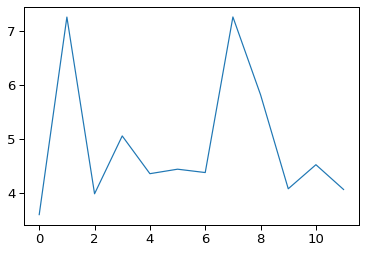

In [48]:
plt.plot(all_losses)

In [49]:
all_cv_scores[best_idx]

{'train_r2': array([0.96517417, 0.97362547, 0.93422045, 0.92698893, 0.95591029]),
 'validate_r2': array([0.85560371, 0.87369258, 0.93044954, 0.91456606, 0.84236369]),
 'train_rmsd': array([1.83646704, 1.66861667, 2.3645426 , 2.60243587, 2.41882243]),
 'validate_rmsd': array([3.92973003, 4.46103284, 2.99963886, 2.95258104, 3.60888747])}

In [50]:
best_emulator = all_emulators[best_idx]
best_emulator

In [51]:
best_emulator.train()

[INFO] >>> Training model on 80% of the dataset, testing on 20%...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '


[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.921         19.255         -1.959         15.397 *
[INFO]             100         -0.006         11.301          0.140          8.301 *
[INFO]             200          0.077         10.825          0.140          8.301 *
[INFO]             300          0.122         10.556         -0.012          9.005
[INFO]             400          0.110         10.627          0.095          8.518
[INFO]             500          0.154         10.362          0.039          8.773
[INFO]             600          0.172         10.254          0.048          8.736
[INFO]             700          0.169         10.271          0.042          8.759
[INFO]             800          0.152         10.377          0.205          7.98

[INFO]            8500          0.607          7.060          0.315          7.411
[INFO]            8600          0.679          6.387          0.268          7.660
[INFO]            8700          0.643          6.732          0.138          8.311
[INFO]            8800          0.677          6.402          0.427          6.777
[INFO]            8900          0.665          6.521          0.355          7.191
[INFO]            9000          0.667          6.505          0.429          6.767
[INFO]            9100          0.678          6.391          0.309          7.441
[INFO]            9200          0.602          7.112          0.320          7.381
[INFO]            9300          0.675          6.423          0.445          6.671
[INFO]            9400          0.713          6.032          0.351          7.212
[INFO]            9500          0.708          6.093          0.269          7.655
[INFO]            9600          0.720          5.960          0.336          7.296
[INF

[INFO]           17300          0.892          3.698          0.742          4.548
[INFO]           17400          0.953          2.435          0.831          3.684
[INFO]           17500          0.945          2.640          0.841          3.572
[INFO]           17600          0.956          2.370          0.830          3.693
[INFO]           17700          0.932          2.933          0.857          3.381
[INFO]           17800          0.964          2.126          0.859          3.363
[INFO]           17900          0.954          2.405          0.825          3.746
[INFO]           18000          0.928          3.033          0.829          3.701
[INFO]           18100          0.969          1.970          0.850          3.463
[INFO]           18200          0.845          4.432          0.557          5.955
[INFO]           18300          0.963          2.181          0.886          3.021
[INFO]           18400          0.931          2.962          0.776          4.235
[INF

[INFO]           26100          0.979          1.647          0.853          3.433
[INFO]           26200          0.985          1.376          0.883          3.059
[INFO]           26300          0.981          1.540          0.866          3.282
[INFO]           26400          0.979          1.613          0.874          3.175
[INFO]           26500          0.965          2.108          0.887          3.005
[INFO]           26600          0.822          4.756          0.459          6.586
[INFO]           26700          0.967          2.045          0.837          3.617
[INFO]           26800          0.962          2.191          0.905          2.762
[INFO]           26900          0.979          1.635          0.925          2.451 *
[INFO]           27000          0.800          5.033          0.631          5.436
[INFO]           27100          0.986          1.334          0.871          3.221
[INFO]           27200          0.983          1.475          0.884          3.047
[I

[INFO]           35000          0.955          2.393          0.835          3.640
[INFO]           35100          0.983          1.469          0.802          3.983
[INFO]           35200          0.989          1.175          0.847          3.499
[INFO]           35300          0.991          1.070          0.833          3.653
[INFO]           35400          0.980          1.593          0.776          4.240
[INFO]           35500          0.952          2.456          0.852          3.438
[INFO]           35600          0.989          1.168          0.864          3.296
[INFO]           35700          0.957          2.344          0.888          2.996
[INFO]           35800          0.990          1.128          0.805          3.956
[INFO]           35900          0.987          1.261          0.834          3.648
[INFO]           36000          0.987          1.283          0.811          3.896
[INFO]           36100          0.824          4.721          0.755          4.434
[INF

{'train_r2': 0.9789421598745222,
 'test_r2': 0.9250593280436168,
 'train_rmsd': 1.6349218246873265,
 'test_rmsd': 2.4505275039304126}

In [52]:
#best_emulator.save('emulator_crossed_barrel_BayesNeuralNet')

In [12]:
hyperparams = {'batch_size': 40,
 'hidden_act': 'leaky_relu',
 'hidden_depth': 4,
 'hidden_nodes': 52,
 'learning_rate': 0.002981945095545511,
 'reg': 0.0017900195774942502}



model  = BayesNeuralNet(**hyperparams, out_act='relu')
emulator = Emulator(dataset='crossed_barrel', model=model)

In [13]:
emulator.train()

[INFO] >>> Training model on 80% of the dataset, testing on 20%...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)
/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)


[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.637         16.926         -0.809         14.672 *
[INFO]             100          0.230          9.150          0.129         10.181 *
[INFO]             200          0.257          8.984         -0.041         11.131
[INFO]             300          0.248          9.037          0.134         10.151 *
[INFO]             400          0.296          8.746          0.035         10.714
[INFO]             500          0.310          8.661          0.178          9.888 *
[INFO]             600          0.302          8.711          0.121         10.226
[INFO]             700          0.270          8.905          0.272          9.304 *
[INFO]             800          0.337          8.490          0.114         1

[INFO]            8400          0.548          7.012          0.523          7.531 *
[INFO]            8500          0.595          6.637          0.429          8.241
[INFO]            8600          0.557          6.935          0.436          8.191
[INFO]            8700          0.619          6.435          0.434          8.206
[INFO]            8800          0.604          6.556          0.451          8.086
[INFO]            8900          0.551          6.983          0.556          7.270 *
[INFO]            9000          0.632          6.323          0.479          7.870
[INFO]            9100          0.636          6.289          0.465          7.976
[INFO]            9200          0.585          6.715          0.498          7.728
[INFO]            9300          0.609          6.517          0.378          8.602
[INFO]            9400          0.545          7.031          0.312          9.044
[INFO]            9500          0.588          6.690          0.491          7.780


[INFO]           17200          0.934          2.686          0.864          4.015
[INFO]           17300          0.946          2.433          0.839          4.379
[INFO]           17400          0.654          6.133          0.377          8.609
[INFO]           17500          0.944          2.474          0.896          3.514
[INFO]           17600          0.812          4.514          0.839          4.382
[INFO]           17700          0.806          4.593          0.527          7.500
[INFO]           17800          0.936          2.635          0.925          2.986
[INFO]           17900          0.937          2.618          0.923          3.021
[INFO]           18000          0.941          2.532          0.946          2.530 *
[INFO]           18100          0.933          2.702          0.938          2.725
[INFO]           18200          0.897          3.338          0.808          4.777
[INFO]           18300          0.902          3.268          0.763          5.308
[I

[INFO]           26000          0.925          2.846          0.922          3.051
[INFO]           26100          0.911          3.111          0.890          3.622
[INFO]           26200          0.910          3.131          0.905          3.362
[INFO]           26300          0.961          2.067          0.930          2.895
[INFO]           26400          0.950          2.333          0.931          2.856
[INFO]           26500          0.967          1.906          0.926          2.959
[INFO]           26600          0.977          1.585          0.939          2.690
[INFO]           26700          0.934          2.682          0.914          3.192
[INFO]           26800          0.938          2.605          0.874          3.874
[INFO]           26900          0.957          2.162          0.923          3.030
[INFO]           27000          0.894          3.391          0.742          5.544
[INFO]           27100          0.931          2.746          0.884          3.718
[INF

{'train_r2': 0.953683377338441,
 'test_r2': 0.9480925445317923,
 'train_rmsd': 2.243383718982972,
 'test_rmsd': 2.485111226874537}

In [14]:
emulator.save('emulator_crossed_barrel_BayesNeuralNet')

## dataset_p3ht

In [69]:
search_space = {
    'batch_size': hp.quniform('batch_size', 10, 50, 10),
    'hidden_act': hp.choice('hidden_act', ['leaky_relu'] ),
    'hidden_depth': hp.quniform('hidden_depth', 2, 5, 1),
    'hidden_nodes': hp.quniform('hidden_nodes', 28, 64, 4),
    'learning_rate': hp.uniform('learning_rate', 1e-5, 5e-3),
    'reg': hp.uniform('reg', 0.001, 0.1)
}

int_params = ['batch_size', 'hidden_depth', 'hidden_nodes']

all_emulators = []
all_losses = []
all_cv_scores = []
all_params = []

def objective(params):
    ''' average performance over cross-validation folds '''
    # build emualtor
    print(f'PARAMS : {params}')
    for param, val in params.items():
        if param in int_params:
            params[param] = int(val)
    model  = BayesNeuralNet(
        **params, out_act='relu',
    )
    emulator = Emulator(
        dataset='p3ht', model=model, feature_transform='standardize', target_transform='normalize',
    )

    cv_scores = emulator.cross_validate()
    loss = np.mean(cv_scores['validate_rmsd'])
    
    all_losses.append(loss)
    all_cv_scores.append(cv_scores)
    all_params.append(params)
    all_emulators.append(emulator)
    
    return {'loss': loss, 'status': STATUS_OK}

In [70]:
trials = Trials()

best = fmin(
    fn=objective,
    space=search_space, 
    algo=tpe.suggest, 
    max_evals=15,
    trials=trials
)

print(f"BEST VALUE : {best}")

PARAMS : {'batch_size': 40.0, 'hidden_act': 'leaky_relu', 'hidden_depth': 5.0, 'hidden_nodes': 60.0, 'learning_rate': 0.0019178490025407058, 'reg': 0.03205255252534184}
  0%|          | 0/15 [00:00<?, ?trial/s, best loss=?][INFO] >>> Training model on fold #0...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.216          0.263         -0.570          0.324 *
[INFO]             100          0.775          0.113          0.491          0.184 *
[INFO]             200          0.729          0.124          0.460          0.190
[INFO]             300          0.729          0.124          0.465          0.189
[INFO]             400          0.703          0.130          0.487          0.185
[INFO]             500          0.734          0.123          0.500          0.183 *
[INFO]             600          0.740          0.122          0.457          0.191
[INFO]             700          0.754          0.118          0.516          0.180 *
[INFO]             800          0.730          0.124          0.548          0.

[INFO]            8600          0.661          0.139          0.519          0.179
[INFO]            8700          0.705          0.130          0.542          0.175
[INFO]            8800          0.734          0.123          0.475          0.187
[INFO]            8900          0.744          0.121          0.522          0.179
[INFO]            9000          0.717          0.127          0.492          0.184
[INFO]            9100          0.725          0.125          0.483          0.186
[INFO]            9200          0.731          0.124          0.445          0.193
[INFO]            9300          0.644          0.142          0.501          0.183
[INFO]            9400          0.724          0.125          0.494          0.184
[INFO]            9500          0.694          0.132          0.489          0.185
[INFO]            9600          0.701          0.130          0.486          0.185
[INFO]            9700          0.720          0.126          0.473          0.188
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.844          0.415         -0.839          0.348 *
[INFO]             100          0.732          0.158          0.601          0.162 *
[INFO]             200          0.796          0.138          0.634          0.155 *
[INFO]             300          0.767          0.148          0.667          0.148 *
[INFO]             400          0.768          0.147          0.606          0.161
[INFO]             500          0.760          0.150          0.604          0.162
[INFO]             600          0.776          0.145          0.692          0.142 *
[INFO]             700          0.737          0.157          0.557          0.171
[INFO]             800          0.741          0.156          0.688          

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.502          0.336         -0.098          0.224 *
[INFO]             100          0.660          0.160          0.750          0.107 *
[INFO]             200          0.681          0.155          0.723          0.113
[INFO]             300          0.743          0.139          0.771          0.102 *
[INFO]             400          0.765          0.133          0.755          0.106
[INFO]             500          0.715          0.146          0.662          0.124
[INFO]             600          0.724          0.144          0.746          0.108
[INFO]             700          0.710          0.148          0.644          0.128
[INFO]             800          0.734          0.142          0.641          0.12

[INFO]            8500          0.851          0.106          0.612          0.133
[INFO]            8600          0.860          0.103          0.617          0.132
[INFO]            8700          0.835          0.112          0.596          0.136
[INFO]            8800          0.823          0.115          0.578          0.139
[INFO]            8900          0.857          0.104          0.625          0.131
[INFO]            9000          0.859          0.103          0.581          0.139
[INFO]            9100          0.718          0.146          0.566          0.141
[INFO]            9200          0.849          0.107          0.605          0.134
[INFO]            9300          0.846          0.108          0.595          0.136
[INFO]            9400          0.811          0.119          0.574          0.140
[INFO]            9500          0.848          0.107          0.597          0.136
[INFO]            9600          0.852          0.106          0.580          0.139
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.852          0.305         -1.104          0.429 *
[INFO]             100          0.696          0.124          0.628          0.180 *
[INFO]             200          0.732          0.116          0.690          0.164 *
[INFO]             300          0.720          0.119          0.659          0.173
[INFO]             400          0.767          0.108          0.661          0.172
[INFO]             500          0.732          0.116          0.620          0.182
[INFO]             600          0.792          0.102          0.622          0.182
[INFO]             700          0.806          0.099          0.606          0.185
[INFO]             800          0.741          0.114          0.587          0.19

[INFO]            8600          0.844          0.089          0.214          0.262
[INFO]            8700          0.858          0.085          0.245          0.257
[INFO]            8800          0.855          0.085          0.165          0.270
[INFO]            8900          0.851          0.087          0.204          0.264
[INFO]            9000          0.854          0.086          0.216          0.262
[INFO]            9100          0.865          0.082          0.236          0.258
[INFO]            9200          0.843          0.089          0.232          0.259
[INFO]            9300          0.863          0.083          0.241          0.258
[INFO]            9400          0.863          0.083          0.220          0.261
[INFO]            9500          0.841          0.090          0.193          0.266
[INFO]            9600          0.854          0.086          0.209          0.263
[INFO]            9700          0.849          0.087          0.192          0.266
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.256          0.321         -0.404          0.410 *
[INFO]             100          0.578          0.186          0.698          0.190 *
[INFO]             200          0.617          0.177          0.668          0.199
[INFO]             300          0.653          0.169          0.728          0.180 *
[INFO]             400          0.647          0.170          0.704          0.188
[INFO]             500          0.682          0.162          0.731          0.180 *
[INFO]             600          0.646          0.170          0.638          0.208
[INFO]             700          0.656          0.168          0.697          0.191
[INFO]             800          0.662          0.166          0.699          0.

[INFO]            8500          0.898          0.092          0.673          0.198
[INFO]            8600          0.898          0.091          0.675          0.197
[INFO]            8700          0.897          0.092          0.674          0.198
[INFO]            8800          0.897          0.092          0.670          0.199
[INFO]            8900          0.884          0.098          0.660          0.202
[INFO]            9000          0.890          0.095          0.679          0.196
[INFO]            9100          0.877          0.100          0.671          0.198
[INFO]            9200          0.895          0.093          0.669          0.199
[INFO]            9300          0.898          0.091          0.668          0.200
[INFO]            9400          0.917          0.082          0.686          0.194
[INFO]            9500          0.916          0.083          0.668          0.200
[INFO]            9600          0.915          0.083          0.642          0.207
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0          0.076          0.203         -0.067          0.283 *
[INFO]             100          0.683          0.119          0.618          0.169 *
[INFO]             200          0.685          0.119          0.601          0.173
[INFO]             300          0.711          0.114          0.601          0.173
[INFO]             400          0.766          0.102          0.655          0.161 *
[INFO]             500          0.703          0.115          0.638          0.165
[INFO]             600          0.682          0.119          0.662          0.160 *
[INFO]             700          0.718          0.112          0.624          0.168
[INFO]             800          0.767          0.102          0.630          0.

[INFO]            8700          0.969          0.037          0.483          0.197
[INFO]            8800          0.962          0.041          0.501          0.194
[INFO]            8900          0.967          0.038          0.480          0.198
[INFO]            9000          0.961          0.042          0.480          0.198
[INFO]            9100          0.975          0.033          0.457          0.202
[INFO]            9200          0.971          0.036          0.484          0.197
[INFO]            9300          0.957          0.044          0.501          0.194
[INFO]            9400          0.955          0.045          0.497          0.194
[INFO]            9500          0.947          0.049          0.507          0.192
[INFO]            9600          0.967          0.038          0.491          0.196
[INFO]            9700          0.970          0.036          0.484          0.197
[INFO]            9800          0.957          0.044          0.473          0.199
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.487          0.276         -0.579          0.239 *
[INFO]             100          0.580          0.146          0.570          0.125 *
[INFO]             200          0.654          0.133          0.661          0.111 *
[INFO]             300          0.676          0.129          0.666          0.110 *
[INFO]             400          0.714          0.121          0.655          0.112
[INFO]             500          0.687          0.126          0.623          0.117
[INFO]             600          0.712          0.121          0.596          0.121
[INFO]             700          0.776          0.107          0.664          0.110
[INFO]             800          0.757          0.111          0.667          0.

[INFO]            8600          0.971          0.039          0.484          0.137
[INFO]            8700          0.971          0.038          0.544          0.129
[INFO]            8800          0.962          0.044          0.514          0.133
[INFO]            8900          0.981          0.031          0.465          0.139
[INFO]            9000          0.968          0.041          0.477          0.138
[INFO]            9100          0.976          0.035          0.465          0.139
[INFO]            9200          0.976          0.035          0.505          0.134
[INFO]            9300          0.981          0.031          0.474          0.138
[INFO]            9400          0.968          0.040          0.483          0.137
[INFO]            9500          0.972          0.038          0.476          0.138
[INFO]            9600          0.960          0.045          0.519          0.132
[INFO]            9700          0.969          0.040          0.509          0.134
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.250          0.286         -0.336          0.281 *
[INFO]             100          0.587          0.164          0.719          0.129 *
[INFO]             200          0.671          0.147          0.703          0.132
[INFO]             300          0.673          0.146          0.689          0.135
[INFO]             400          0.709          0.138          0.703          0.132
[INFO]             500          0.693          0.142          0.711          0.131
[INFO]             600          0.732          0.132          0.648          0.144
[INFO]             700          0.706          0.139          0.654          0.143
[INFO]             800          0.739          0.131          0.679          0.138


[INFO]            8500          0.973          0.042          0.486          0.174
[INFO]            8600          0.981          0.035          0.487          0.174
[INFO]            8700          0.980          0.036          0.522          0.168
[INFO]            8800          0.983          0.033          0.507          0.171
[INFO]            8900          0.981          0.035          0.509          0.170
[INFO]            9000          0.981          0.036          0.546          0.164
[INFO]            9100          0.985          0.032          0.532          0.166
[INFO]            9200          0.980          0.037          0.453          0.180
[INFO]            9300          0.988          0.028          0.544          0.164
[INFO]            9400          0.988          0.028          0.537          0.165
[INFO]            9500          0.986          0.030          0.443          0.181
[INFO]            9600          0.984          0.032          0.491          0.173
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.659          0.327         -0.377          0.285 *
[INFO]             100          0.795          0.115          0.498          0.172 *
[INFO]             200          0.800          0.113          0.500          0.172 *
[INFO]             300          0.799          0.114          0.532          0.166 *
[INFO]             400          0.821          0.107          0.525          0.168
[INFO]             500          0.791          0.116          0.559          0.161 *
[INFO]             600          0.826          0.106          0.503          0.171
[INFO]             700          0.831          0.104          0.555          0.162
[INFO]             800          0.785          0.118          0.635          

[INFO]            8600          0.980          0.036          0.266          0.208
[INFO]            8700          0.973          0.041          0.350          0.196
[INFO]            8800          0.981          0.035          0.336          0.198
[INFO]            8900          0.979          0.037          0.227          0.214
[INFO]            9000          0.979          0.037          0.282          0.206
[INFO]            9100          0.980          0.036          0.297          0.204
[INFO]            9200          0.982          0.034          0.339          0.198
[INFO]            9300          0.976          0.040          0.374          0.192
[INFO]            9400          0.987          0.029          0.335          0.198
[INFO]            9500          0.982          0.034          0.267          0.208
[INFO]            9600          0.983          0.033          0.282          0.206
[INFO]            9700          0.985          0.031          0.275          0.207
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.405          0.327         -0.540          0.448 *
[INFO]             100          0.705          0.150          0.619          0.223 *
[INFO]             200          0.717          0.147          0.667          0.208 *
[INFO]             300          0.783          0.129          0.713          0.194 *
[INFO]             400          0.749          0.139          0.738          0.185 *
[INFO]             500          0.770          0.132          0.750          0.180 *
[INFO]             600          0.795          0.125          0.763          0.176 *
[INFO]             700          0.787          0.127          0.735          0.186
[INFO]             800          0.776          0.131          0.784      

[INFO]            8600          0.984          0.035          0.704          0.197
[INFO]            8700          0.983          0.036          0.668          0.208
[INFO]            8800          0.982          0.037          0.679          0.205
[INFO]            8900          0.989          0.029          0.698          0.198
[INFO]            9000          0.986          0.033          0.693          0.200
[INFO]            9100          0.989          0.029          0.694          0.200
[INFO]            9200          0.987          0.032          0.687          0.202
[INFO]            9300          0.984          0.035          0.687          0.202
[INFO]            9400          0.987          0.031          0.703          0.197
[INFO]            9500          0.986          0.032          0.683          0.203
[INFO]            9600          0.987          0.031          0.709          0.195
[INFO]            9700          0.988          0.031          0.689          0.201
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.130          0.253         -0.172          0.233 *
[INFO]             100          0.626          0.146          0.675          0.123 *
[INFO]             200          0.537          0.162          0.607          0.135
[INFO]             300          0.450          0.177          0.576          0.140
[INFO]             400          0.528          0.164          0.702          0.118 *
[INFO]             500          0.481          0.172          0.416          0.165
[INFO]             600          0.579          0.155          0.711          0.116 *
[INFO]             700          0.489          0.171          0.711          0.116 *
[INFO]             800          0.370          0.189          0.465          

[INFO]            8500         -1.018          0.339         -1.235          0.322
[INFO]            8600         -1.018          0.339         -1.235          0.322
[INFO]            8700         -1.018          0.339         -1.235          0.322
[INFO]            8800         -1.018          0.339         -1.235          0.322
[INFO]            8900         -1.018          0.339         -1.235          0.322
[INFO]            9000         -1.018          0.339         -1.235          0.322
[INFO]            9100         -1.018          0.339         -1.235          0.322
[INFO]            9200         -1.018          0.339         -1.235          0.322
[INFO]            9300         -1.018          0.339         -1.235          0.322
[INFO]            9400         -1.018          0.339         -1.235          0.322
[INFO]            9500         -1.018          0.339         -1.235          0.322
[INFO]            9600         -1.018          0.339         -1.235          0.322
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.206          0.106         -1.511          0.531 *
[INFO]             100         -1.206          0.106         -1.511          0.531
[INFO]             200         -0.103          0.075         -0.740          0.442 *
[INFO]             300         -2.947          0.142          0.595          0.213 *
[INFO]             400         -2.985          0.143          0.643          0.200 *
[INFO]             500         -1.916          0.122          0.427          0.254
[INFO]             600         -3.056          0.144          0.628          0.205
[INFO]             700         -2.943          0.142          0.444          0.250
[INFO]             800         -1.157          0.105          0.554          0.

[INFO]            8700         -1.206          0.106         -1.511          0.531
[INFO]            8800         -1.206          0.106         -1.511          0.531
[INFO]            8900         -1.206          0.106         -1.511          0.531
[INFO]            9000         -1.206          0.106         -1.511          0.531
[INFO]            9100         -1.206          0.106         -1.511          0.531
[INFO]            9200         -1.206          0.106       -160.147          4.256
[INFO]            9300         -1.206          0.106         -1.511          0.531
[INFO]            9400         -1.206          0.106         -1.511          0.531
[INFO]            9500         -1.206          0.106         -1.511          0.531
[INFO]            9600         -1.206          0.106         -1.511          0.531
[INFO]            9700         -1.206          0.106         -1.511          0.531
[INFO]            9800         -1.206          0.106         -1.511          0.531
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.297          0.284          0.060          0.227 *
[INFO]             100          0.597          0.158          0.794          0.106 *
[INFO]             200          0.671          0.143          0.790          0.107
[INFO]             300          0.636          0.150          0.844          0.093 *
[INFO]             400          0.512          0.174          0.786          0.108
[INFO]             500          0.618          0.154          0.730          0.122
[INFO]             600          0.314          0.206          0.650          0.139
[INFO]             700          0.019          0.247          0.763          0.114
[INFO]             800          0.002          0.249          0.617          0.14

[INFO]            8500         -1.375          0.384         -0.591          0.295
[INFO]            8600         -1.375          0.384         -0.591          0.295
[INFO]            8700         -1.375          0.384         -0.591          0.295
[INFO]            8800         -1.375          0.384         -0.591          0.295
[INFO]            8900         -1.375          0.384         -0.591          0.295
[INFO]            9000         -1.375          0.384         -0.591          0.295
[INFO]            9100         -1.375          0.384         -0.591          0.295
[INFO]            9200         -1.375          0.384         -0.591          0.295
[INFO]            9300         -1.375          0.384         -0.591          0.295
[INFO]            9400         -1.375          0.384         -0.591          0.295
[INFO]            9500         -1.375          0.384         -0.591          0.295
[INFO]            9600         -1.375          0.384         -0.591          0.295
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.181          0.252         -0.481          0.350 *
[INFO]             100          0.488          0.166          0.696          0.158 *
[INFO]             200          0.592          0.148          0.639          0.173
[INFO]             300          0.626          0.142          0.738          0.147 *
[INFO]             400          0.524          0.160          0.691          0.160
[INFO]             500          0.531          0.159          0.659          0.168
[INFO]             600          0.280          0.197          0.663          0.167
[INFO]             700          0.577          0.151          0.591          0.184
[INFO]             800          0.494          0.165          0.464          0.21

[INFO]            8500         -0.817          0.313         -1.134          0.420
[INFO]            8600         -0.817          0.313         -1.134          0.420
[INFO]            8700         -0.817          0.313         -1.134          0.420
[INFO]            8800         -0.817          0.313         -1.134          0.420
[INFO]            8900         -0.817          0.313         -1.134          0.420
[INFO]            9000         -0.817          0.313         -1.134          0.420
[INFO]            9100         -0.817          0.313         -1.134          0.420
[INFO]            9200         -0.817          0.313         -1.134          0.420
[INFO]            9300         -0.817          0.313         -1.134          0.420
[INFO]            9400         -0.817          0.313         -1.134          0.420
[INFO]            9500         -0.817          0.313         -1.134          0.420
[INFO]            9600         -0.817          0.313         -1.134          0.420
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0          0.185          0.167         -4.738          0.129 *
[INFO]             100          0.612          0.115         -0.083          0.056 *
[INFO]             200          0.242          0.161         -3.171          0.110
[INFO]             300          0.652          0.109          0.544          0.036 *
[INFO]             400          0.614          0.115         -1.578          0.087
[INFO]             500          0.658          0.108         -1.011          0.077
[INFO]             600          0.483          0.133         -0.602          0.068
[INFO]             700          0.187          0.167         -1.399          0.084
[INFO]             800         -0.581          0.233         -3.935          0.12

[INFO]            8600         -1.102          0.269         -0.478          0.066
[INFO]            8700         -1.102          0.269         -0.478          0.066
[INFO]            8800         -1.102          0.269         -0.478          0.066
[INFO]            8900         -1.102          0.269         -0.478          0.066
[INFO]            9000         -1.102          0.269         -0.478          0.066
[INFO]            9100         -1.102          0.269         -0.478          0.066
[INFO]            9200         -1.102          0.269         -0.478          0.066
[INFO]            9300         -1.102          0.269         -0.478          0.066
[INFO]            9400         -1.102          0.269         -0.478          0.066
[INFO]            9500         -1.102          0.269         -0.478          0.066
[INFO]            9600         -1.102          0.269         -0.478          0.066
[INFO]            9700         -1.102          0.269         -0.478          0.066
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0          0.035          0.300         -0.034          0.342 *
[INFO]             100          0.780          0.143          0.762          0.164 *
[INFO]             200          0.818          0.130          0.750          0.168
[INFO]             300          0.782          0.142          0.735          0.173
[INFO]             400          0.785          0.141          0.782          0.157 *
[INFO]             500          0.816          0.131          0.769          0.161
[INFO]             600          0.803          0.135          0.797          0.151 *
[INFO]             700          0.832          0.125          0.757          0.166
[INFO]             800          0.858          0.115          0.720          0.

[INFO]            8700          0.873          0.109          0.706          0.182
[INFO]            8800          0.880          0.106          0.713          0.180
[INFO]            8900          0.871          0.109          0.759          0.165
[INFO]            9000          0.870          0.110          0.747          0.169
[INFO]            9100          0.877          0.107          0.718          0.178
[INFO]            9200          0.874          0.108          0.719          0.178
[INFO]            9300          0.878          0.107          0.732          0.174
[INFO]            9400          0.880          0.105          0.712          0.180
[INFO]            9500          0.877          0.107          0.702          0.183
[INFO]            9600          0.872          0.109          0.723          0.177
[INFO]            9700          0.882          0.105          0.725          0.176
[INFO]            9800          0.871          0.110          0.679          0.190
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.950          0.458         -1.270          0.335 *
[INFO]             100          0.773          0.156          0.408          0.171 *
[INFO]             200          0.753          0.163          0.283          0.188
[INFO]             300          0.761          0.160          0.400          0.172
[INFO]             400          0.788          0.151          0.324          0.183
[INFO]             500          0.764          0.159          0.396          0.173
[INFO]             600          0.804          0.145          0.455          0.164 *
[INFO]             700          0.701          0.179          0.565          0.147 *
[INFO]             800          0.814          0.142          0.415          0.

[INFO]            8500          0.934          0.084          0.173          0.202
[INFO]            8600          0.933          0.085          0.215          0.197
[INFO]            8700          0.937          0.082          0.222          0.196
[INFO]            8800          0.937          0.082          0.147          0.206
[INFO]            8900          0.939          0.081          0.122          0.208
[INFO]            9000          0.927          0.089         -0.025          0.225
[INFO]            9100          0.941          0.080          0.049          0.217
[INFO]            9200          0.937          0.083          0.099          0.211
[INFO]            9300          0.938          0.082         -0.051          0.228
[INFO]            9400          0.946          0.076          0.087          0.213
[INFO]            9500          0.943          0.079          0.059          0.216
[INFO]            9600          0.934          0.084         -0.007          0.223
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0          0.061          0.285          0.076          0.249 *
[INFO]             100          0.786          0.136          0.621          0.160 *
[INFO]             200          0.795          0.133          0.641          0.155 *
[INFO]             300          0.814          0.127          0.662          0.151 *
[INFO]             400          0.825          0.123          0.576          0.169
[INFO]             500          0.821          0.124          0.666          0.150 *
[INFO]             600          0.774          0.140          0.691          0.144 *
[INFO]             700          0.813          0.127          0.688          0.145
[INFO]             800          0.787          0.135          0.672        

[INFO]            8600          0.846          0.115          0.603          0.163
[INFO]            8700          0.820          0.125          0.676          0.148
[INFO]            8800          0.812          0.128          0.630          0.158
[INFO]            8900          0.851          0.113          0.617          0.161
[INFO]            9000          0.840          0.117          0.638          0.156
[INFO]            9100          0.838          0.118          0.619          0.160
[INFO]            9200          0.840          0.117          0.605          0.163
[INFO]            9300          0.830          0.121          0.640          0.156
[INFO]            9400          0.842          0.117          0.627          0.159
[INFO]            9500          0.809          0.129          0.638          0.156
[INFO]            9600          0.818          0.125          0.647          0.154
[INFO]            9700          0.848          0.115          0.676          0.148
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.124          0.448         -0.894          0.395 *
[INFO]             100          0.668          0.177          0.689          0.160 *
[INFO]             200          0.607          0.193          0.656          0.168
[INFO]             300          0.746          0.155          0.759          0.141 *
[INFO]             400          0.742          0.156          0.703          0.156
[INFO]             500          0.776          0.146          0.775          0.136 *
[INFO]             600          0.611          0.192          0.670          0.165
[INFO]             700          0.746          0.155          0.763          0.140
[INFO]             800          0.757          0.152          0.756          0.

[INFO]            8500          0.875          0.109          0.785          0.133
[INFO]            8600          0.867          0.112          0.771          0.137
[INFO]            8700          0.849          0.120          0.781          0.134
[INFO]            8800          0.872          0.110          0.773          0.137
[INFO]            8900          0.865          0.113          0.778          0.135
[INFO]            9000          0.866          0.113          0.781          0.134
[INFO]            9100          0.865          0.113          0.754          0.142
[INFO]            9200          0.876          0.108          0.754          0.142
[INFO]            9300          0.857          0.116          0.776          0.136
[INFO]            9400          0.881          0.106          0.787          0.132
[INFO]            9500          0.866          0.113          0.785          0.133
[INFO]            9600          0.879          0.107          0.783          0.133
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.047          0.359         -0.481          0.398 *
[INFO]             100          0.757          0.124          0.757          0.161 *
[INFO]             200          0.771          0.120          0.776          0.155 *
[INFO]             300          0.778          0.118          0.666          0.189
[INFO]             400          0.787          0.116          0.728          0.171
[INFO]             500          0.744          0.127          0.613          0.203
[INFO]             600          0.738          0.128          0.637          0.197
[INFO]             700          0.737          0.129          0.689          0.182
[INFO]             800          0.813          0.109          0.751          0.16

[INFO]            8600          0.905          0.077          0.830          0.135
[INFO]            8700          0.888          0.084          0.830          0.135
[INFO]            8800          0.898          0.080          0.832          0.134
[INFO]            8900          0.902          0.079          0.830          0.135
[INFO]            9000          0.912          0.074          0.830          0.135
[INFO]            9100          0.897          0.080          0.809          0.143
[INFO]            9200          0.891          0.083          0.821          0.138
[INFO]            9300          0.881          0.086          0.834          0.133
[INFO]            9400          0.911          0.075          0.825          0.137
[INFO]            9500          0.911          0.075          0.822          0.138
[INFO]            9600          0.905          0.077          0.834          0.133
[INFO]            9700          0.884          0.085          0.826          0.136
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.012          0.417         -1.092          0.351 *
[INFO]             100         -1.012          0.417         -1.092          0.351
[INFO]             200         -1.012          0.417         -1.092          0.351
[INFO]             300          0.675          0.168          0.677          0.138 *
[INFO]             400          0.751          0.147          0.723          0.128 *
[INFO]             500          0.715          0.157          0.656          0.142
[INFO]             600          0.684          0.165          0.756          0.120 *
[INFO]             700          0.709          0.159          0.682          0.137
[INFO]             800          0.748          0.148          0.744          0.

[INFO]            8600          0.834          0.120          0.676          0.138
[INFO]            8700          0.818          0.125          0.737          0.125
[INFO]            8800          0.834          0.120          0.705          0.132
[INFO]            8900          0.837          0.119          0.696          0.134
[INFO]            9000          0.842          0.117          0.724          0.128
[INFO]            9100          0.835          0.120          0.708          0.131
[INFO]            9200          0.834          0.120          0.734          0.125
[INFO]            9300          0.829          0.122          0.671          0.139
[INFO]            9400          0.832          0.120          0.718          0.129
[INFO]            9500          0.849          0.114          0.696          0.134
[INFO]            9600          0.818          0.125          0.611          0.151
[INFO]            9700          0.859          0.110          0.681          0.137
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.968          0.402         -0.702          0.370 *
[INFO]             100         -0.968          0.402         -0.702          0.370
[INFO]             200         -0.968          0.402         -0.702          0.370
[INFO]             300         -0.968          0.402         -0.702          0.370
[INFO]             400         -0.968          0.402         -0.701          0.370 *
[INFO]             500          0.624          0.176          0.577          0.184 *
[INFO]             600          0.718          0.152          0.588          0.182 *
[INFO]             700          0.722          0.151          0.570          0.186
[INFO]             800          0.729          0.149          0.636          0.

[INFO]            8600          0.747          0.144          0.483          0.204
[INFO]            8700          0.824          0.120          0.527          0.195
[INFO]            8800          0.805          0.127          0.501          0.200
[INFO]            8900          0.805          0.127          0.559          0.188
[INFO]            9000          0.761          0.140          0.579          0.184
[INFO]            9100          0.809          0.125          0.554          0.189
[INFO]            9200          0.801          0.128          0.572          0.186
[INFO]            9300          0.826          0.119          0.520          0.196
[INFO]            9400          0.822          0.121          0.547          0.191
[INFO]            9500          0.813          0.124          0.538          0.193
[INFO]            9600          0.810          0.125          0.549          0.190
[INFO]            9700          0.828          0.119          0.533          0.194
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.039          0.298         -0.036          0.282 *
[INFO]             100          0.675          0.167          0.734          0.143 *
[INFO]             200          0.727          0.152          0.747          0.139 *
[INFO]             300          0.698          0.161          0.751          0.138 *
[INFO]             400          0.727          0.153          0.703          0.151
[INFO]             500          0.644          0.174          0.766          0.134 *
[INFO]             600          0.691          0.162          0.760          0.136
[INFO]             700          0.711          0.157          0.779          0.130 *
[INFO]             800          0.713          0.157          0.743        

[INFO]            8600          0.794          0.133          0.609          0.173
[INFO]            8700          0.800          0.131          0.575          0.181
[INFO]            8800          0.814          0.126          0.606          0.174
[INFO]            8900          0.784          0.136          0.583          0.179
[INFO]            9000          0.798          0.131          0.547          0.186
[INFO]            9100          0.803          0.130          0.561          0.184
[INFO]            9200          0.801          0.130          0.563          0.183
[INFO]            9300          0.819          0.124          0.515          0.193
[INFO]            9400          0.795          0.132          0.439          0.208
[INFO]            9500          0.812          0.127          0.509          0.194
[INFO]            9600          0.831          0.120          0.536          0.189
[INFO]            9700          0.812          0.127          0.576          0.180
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.783          0.343         -0.771          0.404 *
[INFO]             100         -0.783          0.343         -0.771          0.404
[INFO]             200         -0.783          0.343         -0.771          0.404
[INFO]             300          0.682          0.145          0.619          0.188 *
[INFO]             400          0.740          0.131          0.702          0.166 *
[INFO]             500          0.769          0.123          0.728          0.159 *
[INFO]             600          0.785          0.119          0.739          0.155 *
[INFO]             700          0.721          0.136          0.725          0.159
[INFO]             800          0.793          0.117          0.722          

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.173          0.373         -1.347          0.414 *
[INFO]             100          0.476          0.183          0.671          0.155 *
[INFO]             200          0.495          0.180          0.712          0.145 *
[INFO]             300          0.341          0.205          0.748          0.136 *
[INFO]             400          0.471          0.184          0.686          0.151
[INFO]             500          0.520          0.175          0.644          0.161
[INFO]             600          0.511          0.177          0.616          0.167
[INFO]             700          0.490          0.181          0.731          0.140
[INFO]             800          0.464          0.185          0.723          0.

[INFO]            8500          0.744          0.128          0.542          0.183
[INFO]            8600          0.711          0.136          0.520          0.187
[INFO]            8700          0.759          0.124          0.545          0.182
[INFO]            8800          0.718          0.134          0.521          0.187
[INFO]            8900          0.744          0.128          0.602          0.170
[INFO]            9000          0.753          0.126          0.597          0.172
[INFO]            9100          0.756          0.125          0.585          0.174
[INFO]            9200          0.761          0.124          0.519          0.187
[INFO]            9300          0.758          0.124          0.591          0.173
[INFO]            9400          0.760          0.124          0.521          0.187
[INFO]            9500          0.743          0.128          0.533          0.185
[INFO]            9600          0.741          0.129          0.555          0.180
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.640          0.349         -1.185          0.371 *
[INFO]             100          0.766          0.132          0.330          0.205 *
[INFO]             200          0.723          0.144          0.481          0.181 *
[INFO]             300          0.787          0.126          0.380          0.198
[INFO]             400          0.731          0.142          0.264          0.215
[INFO]             500          0.668          0.157          0.439          0.188
[INFO]             600          0.719          0.145          0.450          0.186
[INFO]             700          0.731          0.142          0.609          0.157 *
[INFO]             800          0.720          0.144          0.462          0.

[INFO]            8500          0.810          0.119          0.605          0.158
[INFO]            8600          0.748          0.137          0.476          0.182
[INFO]            8700          0.703          0.149          0.374          0.199
[INFO]            8800          0.764          0.133          0.469          0.183
[INFO]            8900          0.773          0.130          0.516          0.175
[INFO]            9000          0.843          0.108          0.517          0.174
[INFO]            9100          0.836          0.111          0.514          0.175
[INFO]            9200          0.831          0.112          0.526          0.173
[INFO]            9300          0.801          0.122          0.467          0.183
[INFO]            9400          0.771          0.130          0.493          0.179
[INFO]            9500          0.829          0.113          0.488          0.180
[INFO]            9600          0.790          0.125          0.560          0.166
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.376          0.256         -0.661          0.408 *
[INFO]             100          0.467          0.160          0.697          0.174 *
[INFO]             200          0.485          0.157          0.658          0.185
[INFO]             300          0.553          0.146          0.606          0.199
[INFO]             400          0.607          0.137          0.651          0.187
[INFO]             500          0.434          0.164          0.748          0.159 *
[INFO]             600          0.531          0.150          0.697          0.174
[INFO]             700          0.617          0.135          0.474          0.230
[INFO]             800          0.556          0.146          0.723          0.16

[INFO]            8400          0.615          0.136          0.762          0.155
[INFO]            8500          0.627          0.133          0.807          0.139
[INFO]            8600          0.720          0.116          0.760          0.155
[INFO]            8700          0.463          0.160          0.871          0.114
[INFO]            8800          0.544          0.148          0.913          0.094 *
[INFO]            8900          0.580          0.142          0.801          0.141
[INFO]            9000          0.655          0.128          0.800          0.142
[INFO]            9100          0.592          0.140          0.865          0.116
[INFO]            9200          0.339          0.178          0.880          0.110
[INFO]            9300          0.529          0.150          0.876          0.112
[INFO]            9400          0.684          0.123          0.828          0.131
[INFO]            9500          0.651          0.129          0.867          0.115
[I

[INFO]           17300          0.548          0.147          0.849          0.123
[INFO]           17400          0.555          0.146          0.856          0.120
[INFO]           17500          0.605          0.137          0.798          0.142
[INFO]           17600          0.574          0.143          0.894          0.103
[INFO]           17700          0.427          0.165          0.941          0.077
[INFO]           17800          0.598          0.139          0.807          0.139
[INFO]           17900          0.593          0.139          0.910          0.095
[INFO]           18000          0.576          0.142          0.900          0.100
[INFO]           18100          0.587          0.140          0.867          0.115
[INFO]           18200          0.514          0.152          0.891          0.105
[INFO]           18300          0.636          0.132          0.762          0.155
[INFO]           18400          0.657          0.128          0.784          0.147
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.124          0.282         -0.060          0.240 *
[INFO]             100          0.794          0.121          0.535          0.159 *
[INFO]             200          0.832          0.109          0.540          0.158 *
[INFO]             300          0.815          0.114          0.539          0.158
[INFO]             400          0.746          0.134          0.581          0.151 *
[INFO]             500          0.704          0.145          0.504          0.164
[INFO]             600          0.706          0.144          0.396          0.181
[INFO]             700          0.660          0.155          0.401          0.180
[INFO]             800          0.741          0.135          0.260          0.

[INFO]            8600          0.892          0.087          0.520          0.161
[INFO]            8700          0.913          0.078          0.535          0.159
[INFO]            8800          0.916          0.077          0.637          0.140
[INFO]            8900          0.907          0.081          0.653          0.137
[INFO]            9000          0.896          0.086          0.728          0.121 *
[INFO]            9100          0.899          0.085          0.700          0.128
[INFO]            9200          0.910          0.080          0.660          0.136
[INFO]            9300          0.912          0.079          0.542          0.158
[INFO]            9400          0.899          0.084          0.518          0.162
[INFO]            9500          0.896          0.086          0.498          0.165
[INFO]            9600          0.901          0.084          0.448          0.173
[INFO]            9700          0.901          0.084          0.524          0.161
[I

[INFO]           17500          0.902          0.083          0.579          0.151
[INFO]           17600          0.921          0.075          0.601          0.147
[INFO]           17700          0.890          0.088          0.715          0.124
[INFO]           17800          0.912          0.079          0.518          0.162
[INFO]           17900          0.903          0.083          0.597          0.148
[INFO]           18000          0.905          0.082          0.637          0.140
[INFO]           18100          0.914          0.078          0.633          0.141
[INFO]           18200          0.908          0.081          0.617          0.144
[INFO]           18300          0.913          0.078          0.622          0.143
[INFO]           18400          0.885          0.090          0.467          0.170
[INFO]           18500          0.916          0.077          0.674          0.133
[INFO]           18600          0.926          0.072          0.611          0.145
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.116          0.294          0.048          0.208 *
[INFO]             100          0.496          0.197          0.703          0.116 *
[INFO]             200          0.583          0.179          0.806          0.094 *
[INFO]             300          0.623          0.171          0.780          0.100
[INFO]             400          0.634          0.168          0.775          0.101
[INFO]             500          0.676          0.158          0.780          0.100
[INFO]             600          0.608          0.174          0.799          0.096
[INFO]             700          0.636          0.168          0.775          0.101
[INFO]             800          0.557          0.185          0.802          0.09

[INFO]            8500          0.711          0.149          0.750          0.107
[INFO]            8600          0.728          0.145          0.700          0.117
[INFO]            8700          0.749          0.139          0.774          0.101
[INFO]            8800          0.759          0.136          0.813          0.092
[INFO]            8900          0.745          0.140          0.764          0.104
[INFO]            9000          0.715          0.148          0.733          0.110
[INFO]            9100          0.771          0.133          0.778          0.100
[INFO]            9200          0.672          0.159          0.731          0.111
[INFO]            9300          0.706          0.151          0.754          0.106
[INFO]            9400          0.684          0.156          0.729          0.111
[INFO]            9500          0.766          0.134          0.764          0.104
[INFO]            9600          0.726          0.145          0.748          0.107
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0          0.006          0.305          0.014          0.181 *
[INFO]             100          0.506          0.215          0.593          0.116 *
[INFO]             200          0.507          0.214          0.619          0.112 *
[INFO]             300          0.565          0.201          0.415          0.139
[INFO]             400          0.479          0.220          0.344          0.147
[INFO]             500          0.495          0.217          0.237          0.159
[INFO]             600          0.540          0.207         -0.220          0.201
[INFO]             700          0.583          0.197         -0.086          0.190
[INFO]             800          0.514          0.213          0.125          0.17

[INFO]            8600          0.749          0.153          0.099          0.173
[INFO]            8700          0.724          0.160          0.240          0.159
[INFO]            8800          0.677          0.174          0.148          0.168
[INFO]            8900          0.748          0.153         -0.092          0.190
[INFO]            9000          0.731          0.158         -0.671          0.235
[INFO]            9100          0.744          0.154         -0.346          0.211
[INFO]            9200          0.704          0.166          0.038          0.179
[INFO]            9300          0.724          0.161          0.009          0.181
[INFO]            9400          0.670          0.175          0.384          0.143
[INFO]            9500          0.675          0.174          0.185          0.164
[INFO]            9600          0.730          0.159         -0.416          0.217
[INFO]            9700          0.700          0.167          0.121          0.171
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.086          0.298         -0.111          0.299 *
[INFO]             100          0.700          0.157          0.627          0.173 *
[INFO]             200          0.738          0.146          0.713          0.152 *
[INFO]             300          0.722          0.151          0.674          0.162
[INFO]             400          0.754          0.142          0.709          0.153
[INFO]             500          0.757          0.141          0.718          0.151 *
[INFO]             600          0.754          0.142          0.694          0.157
[INFO]             700          0.763          0.139          0.692          0.157
[INFO]             800          0.767          0.138          0.686          0.

[INFO]            8400          0.931          0.075          0.763          0.138
[INFO]            8500          0.917          0.082          0.765          0.137
[INFO]            8600          0.912          0.085          0.766          0.137
[INFO]            8700          0.882          0.098          0.746          0.143
[INFO]            8800          0.940          0.070          0.753          0.141
[INFO]            8900          0.929          0.076          0.730          0.147
[INFO]            9000          0.915          0.084          0.740          0.145
[INFO]            9100          0.928          0.077          0.743          0.144
[INFO]            9200          0.945          0.067          0.751          0.142
[INFO]            9300          0.918          0.082          0.743          0.144
[INFO]            9400          0.917          0.083          0.703          0.155
[INFO]            9500          0.927          0.077          0.678          0.161
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.631          0.346         -0.682          0.398 *
[INFO]             100          0.651          0.160          0.710          0.165 *
[INFO]             200          0.681          0.153          0.679          0.174
[INFO]             300          0.679          0.153          0.681          0.173
[INFO]             400          0.689          0.151          0.700          0.168
[INFO]             500          0.649          0.160          0.540          0.208
[INFO]             600          0.661          0.158          0.603          0.193
[INFO]             700          0.685          0.152          0.672          0.176
[INFO]             800          0.686          0.152          0.697          0.169


[INFO]            8600          0.956          0.057          0.457          0.226
[INFO]            8700          0.939          0.067          0.431          0.232
[INFO]            8800          0.948          0.062          0.500          0.217
[INFO]            8900          0.954          0.058          0.410          0.236
[INFO]            9000          0.940          0.066          0.422          0.233
[INFO]            9100          0.892          0.089          0.454          0.227
[INFO]            9200          0.955          0.058          0.373          0.243
[INFO]            9300          0.965          0.051          0.439          0.230
[INFO]            9400          0.960          0.054          0.385          0.241
[INFO]            9500          0.962          0.053          0.422          0.233
[INFO]            9600          0.961          0.053          0.397          0.238
[INFO]            9700          0.934          0.070          0.365          0.245
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0          0.059          0.236          0.017          0.238 *
[INFO]             100          0.648          0.144          0.674          0.137 *
[INFO]             200          0.663          0.141          0.648          0.142
[INFO]             300          0.736          0.125          0.663          0.139
[INFO]             400          0.725          0.127          0.651          0.142
[INFO]             500          0.761          0.119          0.595          0.153
[INFO]             600          0.759          0.119          0.547          0.161
[INFO]             700          0.781          0.114          0.557          0.160
[INFO]             800          0.824          0.102          0.565          0.158


[INFO]            8600          0.929          0.065          0.121          0.225
[INFO]            8700          0.945          0.057          0.112          0.226
[INFO]            8800          0.945          0.057          0.161          0.220
[INFO]            8900          0.936          0.061          0.101          0.227
[INFO]            9000          0.933          0.063          0.134          0.223
[INFO]            9100          0.934          0.062          0.129          0.224
[INFO]            9200          0.943          0.058          0.099          0.228
[INFO]            9300          0.940          0.059          0.134          0.223
[INFO]            9400          0.942          0.059          0.121          0.225
[INFO]            9500          0.935          0.062          0.088          0.229
[INFO]            9600          0.942          0.058          0.135          0.223
[INFO]            9700          0.945          0.057          0.131          0.223
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.550          0.395         -0.556          0.295 *
[INFO]             100          0.751          0.158          0.585          0.152 *
[INFO]             200          0.719          0.168          0.653          0.139 *
[INFO]             300          0.748          0.159          0.597          0.150
[INFO]             400          0.772          0.151          0.546          0.159
[INFO]             500          0.790          0.145          0.416          0.181
[INFO]             600          0.805          0.140          0.540          0.160
[INFO]             700          0.781          0.149          0.610          0.148
[INFO]             800          0.689          0.177          0.595          0.15

[INFO]            8600          0.970          0.055          0.591          0.151
[INFO]            8700          0.968          0.057          0.604          0.149
[INFO]            8800          0.963          0.061          0.697          0.130
[INFO]            8900          0.966          0.058          0.599          0.150
[INFO]            9000          0.978          0.047          0.617          0.146
[INFO]            9100          0.975          0.050          0.572          0.155
[INFO]            9200          0.965          0.059          0.604          0.149
[INFO]            9300          0.965          0.059          0.588          0.152
[INFO]            9400          0.954          0.068          0.578          0.154
[INFO]            9500          0.977          0.048          0.623          0.145
[INFO]            9600          0.979          0.046          0.589          0.152
[INFO]            9700          0.966          0.059          0.627          0.144
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0          0.045          0.328          0.080          0.310 *
[INFO]             100          0.576          0.218          0.649          0.191 *
[INFO]             200          0.621          0.206          0.602          0.203
[INFO]             300          0.631          0.204          0.612          0.201
[INFO]             400          0.629          0.204          0.605          0.203
[INFO]             500          0.649          0.199          0.600          0.204
[INFO]             600          0.673          0.192          0.602          0.203
[INFO]             700          0.704          0.182          0.561          0.214
[INFO]             800          0.737          0.172          0.606          0.202


[INFO]            8700          0.980          0.048          0.265          0.277
[INFO]            8800          0.979          0.048          0.227          0.284
[INFO]            8900          0.969          0.059          0.083          0.309
[INFO]            9000          0.981          0.047          0.184          0.292
[INFO]            9100          0.975          0.053          0.263          0.277
[INFO]            9200          0.983          0.044          0.268          0.276
[INFO]            9300          0.976          0.052          0.336          0.263
[INFO]            9400          0.980          0.047          0.249          0.280
[INFO]            9500          0.981          0.046          0.218          0.285
[INFO]            9600          0.978          0.049          0.030          0.318
[INFO]            9700          0.980          0.047          0.298          0.270
[INFO]            9800          0.983          0.044          0.169          0.294
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.031          0.208         -0.128          0.261 *
[INFO]             100          0.547          0.138          0.340          0.200 *
[INFO]             200          0.258          0.177          0.233          0.215
[INFO]             300          0.604          0.129          0.428          0.186 *
[INFO]             400          0.454          0.151          0.279          0.209
[INFO]             500          0.661          0.119          0.440          0.184 *
[INFO]             600          0.561          0.136          0.376          0.194
[INFO]             700          0.673          0.117          0.394          0.191
[INFO]             800          0.596          0.130          0.276          0.

[INFO]            8500          0.676          0.117          0.332          0.201
[INFO]            8600          0.660          0.120          0.462          0.180
[INFO]            8700          0.713          0.110          0.389          0.192
[INFO]            8800          0.686          0.115          0.417          0.188
[INFO]            8900          0.691          0.114          0.367          0.196
[INFO]            9000          0.688          0.115          0.411          0.189
[INFO]            9100          0.670          0.118          0.371          0.195
[INFO]            9200          0.696          0.113          0.409          0.189
[INFO]            9300          0.693          0.114          0.323          0.202
[INFO]            9400          0.682          0.116          0.366          0.196
[INFO]            9500          0.687          0.115          0.414          0.188
[INFO]            9600          0.697          0.113          0.401          0.190
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.910          0.250         -1.291          0.468 *
[INFO]             100         -0.054          0.186          0.780          0.145 *
[INFO]             200          0.122          0.170          0.739          0.158
[INFO]             300          0.487          0.130          0.664          0.179
[INFO]             400          0.212          0.161          0.682          0.174
[INFO]             500          0.174          0.165          0.710          0.166
[INFO]             600          0.319          0.150          0.618          0.191
[INFO]             700          0.313          0.150          0.604          0.194
[INFO]             800          0.080          0.174          0.724          0.162


[INFO]            8500          0.667          0.105          0.796          0.140
[INFO]            8600          0.667          0.105          0.776          0.146
[INFO]            8700          0.687          0.101          0.795          0.140
[INFO]            8800          0.671          0.104          0.839          0.124
[INFO]            8900          0.654          0.107          0.830          0.127
[INFO]            9000          0.520          0.126          0.787          0.143
[INFO]            9100          0.567          0.119          0.771          0.148
[INFO]            9200          0.564          0.120          0.769          0.149
[INFO]            9300          0.538          0.123          0.822          0.130
[INFO]            9400          0.665          0.105          0.785          0.143
[INFO]            9500          0.738          0.093          0.809          0.135
[INFO]            9600          0.611          0.113          0.822          0.130
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.033          0.494         -0.673          0.307 *
[INFO]             100          0.574          0.226          0.563          0.157 *
[INFO]             200          0.505          0.244          0.638          0.143 *
[INFO]             300          0.487          0.248          0.704          0.129 *
[INFO]             400          0.661          0.202          0.527          0.163
[INFO]             500          0.401          0.268          0.586          0.153
[INFO]             600          0.657          0.203          0.390          0.185
[INFO]             700          0.583          0.224          0.579          0.154
[INFO]             800          0.662          0.202          0.462          0.

[INFO]            8500          0.684          0.195          0.520          0.164
[INFO]            8600          0.696          0.191          0.466          0.174
[INFO]            8700          0.682          0.196          0.531          0.163
[INFO]            8800          0.640          0.208          0.637          0.143
[INFO]            8900          0.680          0.196          0.521          0.164
[INFO]            9000          0.610          0.217          0.636          0.143
[INFO]            9100          0.679          0.197          0.536          0.162
[INFO]            9200          0.691          0.193          0.524          0.164
[INFO]            9300          0.677          0.197          0.518          0.165
[INFO]            9400          0.673          0.198          0.563          0.157
[INFO]            9500          0.702          0.189          0.475          0.172
[INFO]            9600          0.717          0.185          0.483          0.171
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.161          0.408         -0.500          0.247 *
[INFO]             100          0.352          0.223         -0.484          0.246 *
[INFO]             200          0.781          0.130          0.896          0.065 *
[INFO]             300          0.675          0.158          0.825          0.084
[INFO]             400          0.712          0.149          0.812          0.088
[INFO]             500          0.747          0.140          0.734          0.104
[INFO]             600          0.607          0.174          0.837          0.081
[INFO]             700          0.605          0.174          0.797          0.091
[INFO]             800          0.772          0.133          0.883          0.06

[INFO]            8600          0.831          0.114          0.743          0.102
[INFO]            8700          0.806          0.122          0.736          0.104
[INFO]            8800          0.782          0.129          0.637          0.121
[INFO]            8900          0.813          0.120          0.715          0.108
[INFO]            9000          0.817          0.118          0.740          0.103
[INFO]            9100          0.845          0.109          0.746          0.102
[INFO]            9200          0.805          0.122          0.749          0.101
[INFO]            9300          0.827          0.115          0.764          0.098
[INFO]            9400          0.837          0.112          0.744          0.102
[INFO]            9500          0.820          0.118          0.737          0.103
[INFO]            9600          0.827          0.115          0.736          0.104
[INFO]            9700          0.819          0.118          0.746          0.102
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.435          0.360         -0.762          0.424 *
[INFO]             100          0.727          0.157          0.425          0.242 *
[INFO]             200          0.765          0.146          0.506          0.224 *
[INFO]             300          0.741          0.153          0.508          0.224 *
[INFO]             400          0.665          0.174          0.392          0.249
[INFO]             500          0.641          0.180          0.301          0.267
[INFO]             600          0.713          0.161          0.365          0.255
[INFO]             700          0.715          0.160          0.469          0.233
[INFO]             800          0.781          0.141          0.496          0.

[INFO]            8500          0.869          0.109          0.401          0.247
[INFO]            8600          0.906          0.092          0.464          0.234
[INFO]            8700          0.898          0.096          0.413          0.245
[INFO]            8800          0.899          0.095          0.376          0.252
[INFO]            8900          0.754          0.149          0.142          0.296
[INFO]            9000          0.897          0.096          0.423          0.243
[INFO]            9100          0.925          0.082          0.440          0.239
[INFO]            9200          0.930          0.080          0.401          0.247
[INFO]            9300          0.890          0.100          0.444          0.238
[INFO]            9400          0.905          0.093          0.431          0.241
[INFO]            9500          0.873          0.107          0.423          0.243
[INFO]            9600          0.890          0.100          0.407          0.246
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.741          0.370         -1.086          0.454 *
[INFO]             100          0.482          0.202          0.451          0.233 *
[INFO]             200          0.484          0.201          0.337          0.256
[INFO]             300          0.555          0.187          0.629          0.192 *
[INFO]             400          0.449          0.208          0.747          0.158 *
[INFO]             500          0.603          0.177          0.714          0.168
[INFO]             600          0.593          0.179          0.593          0.201
[INFO]             700          0.562          0.186          0.588          0.202
[INFO]             800          0.667          0.162          0.698          0.

[INFO]            8500          0.667          0.162          0.626          0.192
[INFO]            8600          0.686          0.157          0.680          0.178
[INFO]            8700          0.744          0.142          0.618          0.194
[INFO]            8800          0.687          0.157          0.699          0.173
[INFO]            8900          0.697          0.155          0.609          0.197
[INFO]            9000          0.718          0.149          0.699          0.173
[INFO]            9100          0.736          0.144          0.633          0.191
[INFO]            9200          0.754          0.139          0.620          0.194
[INFO]            9300          0.710          0.151          0.598          0.199
[INFO]            9400          0.742          0.143          0.674          0.180
[INFO]            9500          0.678          0.159          0.631          0.191
[INFO]            9600          0.716          0.149          0.740          0.161
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.253          0.501         -1.085          0.469 *
[INFO]             100          0.613          0.208         -0.370          0.380 *
[INFO]             200          0.599          0.211          0.381          0.256 *
[INFO]             300          0.591          0.213          0.290          0.274
[INFO]             400          0.601          0.211          0.279          0.276
[INFO]             500          0.622          0.205          0.464          0.238 *
[INFO]             600          0.545          0.225          0.282          0.275
[INFO]             700          0.620          0.206          0.316          0.269
[INFO]             800          0.605          0.210          0.202          0.

[INFO]            8600          0.675          0.190          0.127          0.303
[INFO]            8700          0.753          0.166          0.038          0.319
[INFO]            8800          0.739          0.171          0.293          0.273
[INFO]            8900          0.712          0.179          0.218          0.287
[INFO]            9000          0.718          0.177          0.231          0.285
[INFO]            9100          0.714          0.179          0.247          0.282
[INFO]            9200          0.702          0.182          0.165          0.297
[INFO]            9300          0.722          0.176          0.244          0.282
[INFO]            9400          0.737          0.171          0.208          0.289
[INFO]            9500          0.685          0.187          0.137          0.302
[INFO]            9600          0.656          0.196          0.111          0.306
[INFO]            9700          0.624          0.205          0.206          0.289
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.032          0.243         -0.057          0.323 *
[INFO]             100          0.612          0.149          0.735          0.162 *
[INFO]             200          0.595          0.152          0.707          0.170
[INFO]             300          0.660          0.140          0.792          0.144 *
[INFO]             400          0.690          0.133          0.865          0.115 *
[INFO]             500          0.639          0.144          0.791          0.144
[INFO]             600          0.642          0.143          0.807          0.138
[INFO]             700          0.601          0.151          0.776          0.149
[INFO]             800          0.607          0.150          0.743          0.

[INFO]            8500          0.722          0.126          0.851          0.121
[INFO]            8600          0.662          0.139          0.853          0.121
[INFO]            8700          0.692          0.133          0.851          0.121
[INFO]            8800          0.671          0.137          0.870          0.114
[INFO]            8900          0.727          0.125          0.874          0.112
[INFO]            9000          0.688          0.134          0.842          0.125
[INFO]            9100          0.710          0.129          0.871          0.113
[INFO]            9200          0.754          0.119          0.834          0.128
[INFO]            9300          0.758          0.118          0.847          0.123
[INFO]            9400          0.687          0.134          0.855          0.120
[INFO]            9500          0.747          0.120          0.884          0.107
[INFO]            9600          0.706          0.130          0.885          0.106
[INF

[INFO]           17500          0.735          0.123          0.866          0.115
[INFO]           17600          0.717          0.127          0.847          0.123
[INFO]           17700          0.705          0.130          0.863          0.116
[INFO]           17800          0.713          0.128          0.863          0.117
[INFO]           17900          0.763          0.117          0.877          0.111
[INFO]           18000          0.681          0.135          0.861          0.117
[INFO] Training completed in 15.84 seconds.
[INFO] ===========================================================================

[INFO] >>> Training model on fold #3...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.833          0.319         -2.827          0.338 *
[INFO]             100          0.670          0.135          0.249          0.150 *
[INFO]             200          0.550          0.158         -0.129          0.184
[INFO]             300          0.757          0.116          0.451          0.128 *
[INFO]             400          0.653          0.139          0.251          0.150
[INFO]             500          0.658          0.138          0.451          0.128
[INFO]             600          0.554          0.157          0.257          0.149
[INFO]             700          0.586          0.152         -0.465          0.209
[INFO]             800          0.643          0.141         -0.006          0.17

[INFO]            8500          0.628          0.144         -0.311          0.198
[INFO]            8600          0.747          0.119          0.190          0.156
[INFO]            8700          0.640          0.141         -0.222          0.191
[INFO]            8800          0.708          0.127          0.174          0.157
[INFO]            8900          0.660          0.137         -0.103          0.182
[INFO]            9000          0.747          0.119          0.149          0.159
[INFO]            9100          0.707          0.128          0.092          0.165
[INFO]            9200          0.618          0.146         -0.319          0.198
[INFO]            9300          0.625          0.144         -0.100          0.181
[INFO]            9400          0.633          0.143         -0.172          0.187
[INFO]            9500          0.662          0.137         -0.028          0.175
[INFO]            9600          0.622          0.145         -0.122          0.183
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.021          0.341         -1.665          0.404 *
[INFO]             100         -1.021          0.341         -1.665          0.404
[INFO]             200         -1.021          0.341         -1.665          0.404
[INFO]             300          0.488          0.171          0.677          0.141 *
[INFO]             400          0.692          0.133          0.688          0.138 *
[INFO]             500          0.694          0.133          0.775          0.118 *
[INFO]             600          0.669          0.138          0.766          0.120
[INFO]             700          0.703          0.130          0.711          0.133
[INFO]             800          0.632          0.145          0.685          0.

[INFO]            8600          0.671          0.137          0.783          0.115
[INFO]            8700          0.687          0.134          0.810          0.108
[INFO]            8800          0.685          0.134          0.825          0.104
[INFO]            8900          0.686          0.134          0.808          0.108
[INFO]            9000          0.664          0.139          0.790          0.113
[INFO]            9100          0.711          0.129          0.813          0.107
[INFO]            9200          0.707          0.130          0.815          0.107
[INFO]            9300          0.684          0.135          0.813          0.107
[INFO]            9400          0.679          0.136          0.812          0.107
[INFO]            9500          0.707          0.130          0.798          0.111
[INFO]            9600          0.679          0.136          0.831          0.102
[INFO]            9700          0.664          0.139          0.785          0.115
[INF

[INFO]           17500          0.675          0.137          0.750          0.124
[INFO]           17600          0.704          0.130          0.768          0.119
[INFO]           17700          0.678          0.136          0.809          0.108
[INFO]           17800          0.702          0.131          0.798          0.111
[INFO]           17900          0.678          0.136          0.809          0.108
[INFO]           18000          0.682          0.135          0.819          0.106
[INFO]           18100          0.635          0.145          0.803          0.110
[INFO]           18200          0.706          0.130          0.778          0.117
[INFO]           18300          0.676          0.136          0.832          0.102
[INFO]           18400          0.693          0.133          0.838          0.100
[INFO]           18500          0.635          0.145          0.824          0.104
[INFO]           18600          0.694          0.133          0.822          0.105
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.787          0.345         -1.172          0.396 *
[INFO]             100         -0.787          0.345         -1.172          0.396
[INFO]             200          0.698          0.142          0.689          0.150 *
[INFO]             300          0.801          0.115          0.637          0.162
[INFO]             400          0.735          0.133          0.658          0.157
[INFO]             500          0.735          0.133          0.574          0.175
[INFO]             600          0.801          0.115          0.652          0.158
[INFO]             700          0.839          0.103          0.671          0.154
[INFO]             800          0.831          0.106          0.628          0.164


[INFO]            8500          0.886          0.087          0.721          0.142
[INFO]            8600          0.885          0.087          0.712          0.144
[INFO]            8700          0.892          0.085          0.727          0.140
[INFO]            8800          0.857          0.097          0.661          0.156
[INFO]            8900          0.920          0.073          0.685          0.151
[INFO]            9000          0.891          0.085          0.668          0.155
[INFO]            9100          0.888          0.086          0.694          0.149
[INFO]            9200          0.838          0.104          0.672          0.154
[INFO]            9300          0.805          0.114          0.684          0.151
[INFO]            9400          0.763          0.126          0.622          0.165
[INFO]            9500          0.840          0.103          0.694          0.149
[INFO]            9600          0.886          0.087          0.728          0.140
[INF

[INFO]           17500          0.904          0.080          0.723          0.141
[INFO]           17600          0.802          0.115          0.626          0.164
[INFO]           17700          0.845          0.102          0.685          0.151
[INFO]           17800          0.876          0.091          0.706          0.145
[INFO] Training completed in 13.07 seconds.
[INFO] ===========================================================================

[INFO] >>> Training model on fold #1...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.698          0.370         -0.310          0.400 *
[INFO]             100          0.755          0.140          0.709          0.189 *
[INFO]             200          0.765          0.138          0.691          0.194
[INFO]             300          0.763          0.138          0.688          0.195
[INFO]             400          0.771          0.136          0.745          0.177 *
[INFO]             500          0.724          0.149          0.712          0.188
[INFO]             600          0.750          0.142          0.778          0.165 *
[INFO]             700          0.802          0.126          0.780          0.164 *
[INFO]             800          0.786          0.131          0.737          

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.387          0.496         -0.868          0.333 *
[INFO]             100         -1.387          0.496         -0.868          0.333
[INFO]             200          0.607          0.201          0.620          0.150 *
[INFO]             300          0.599          0.203          0.565          0.161
[INFO]             400          0.552          0.215          0.400          0.189
[INFO]             500          0.557          0.214          0.731          0.126 *
[INFO]             600          0.609          0.201          0.666          0.141
[INFO]             700          0.573          0.210          0.709          0.131
[INFO]             800          0.501          0.227          0.725          0.12

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.908          0.382         -1.994          0.304 *
[INFO]             100          0.729          0.144          0.118          0.165 *
[INFO]             200          0.744          0.140          0.521          0.121 *
[INFO]             300          0.725          0.145          0.335          0.143
[INFO]             400          0.754          0.137          0.399          0.136
[INFO]             500          0.713          0.148          0.332          0.143
[INFO]             600          0.782          0.129          0.227          0.154
[INFO]             700          0.750          0.138         -0.034          0.178
[INFO]             800          0.771          0.132          0.141          0.16

[INFO]            8600          0.890          0.092          0.363          0.140
[INFO]            8700          0.895          0.090         -0.090          0.183
[INFO]            8800          0.903          0.086          0.222          0.155
[INFO]            8900          0.897          0.089          0.025          0.173
[INFO]            9000          0.929          0.074         -0.032          0.178
[INFO]            9100          0.916          0.080         -0.083          0.183
[INFO]            9200          0.907          0.085          0.096          0.167
[INFO]            9300          0.850          0.107          0.097          0.167
[INFO]            9400          0.908          0.084         -0.137          0.187
[INFO]            9500          0.901          0.087         -0.020          0.177
[INFO]            9600          0.916          0.080          0.088          0.168
[INFO]            9700          0.919          0.079         -0.269          0.198
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.730          0.233         -1.355          0.469 *
[INFO]             100          0.419          0.135          0.696          0.168 *
[INFO]             200          0.020          0.175          0.810          0.133 *
[INFO]             300          0.355          0.142          0.779          0.143
[INFO]             400          0.578          0.115          0.606          0.192
[INFO]             500          0.192          0.159          0.768          0.147
[INFO]             600          0.492          0.126          0.581          0.198
[INFO]             700          0.243          0.154          0.767          0.148
[INFO]             800          0.291          0.149          0.697          0.16

[INFO]            8600          0.577          0.115          0.585          0.197
[INFO]            8700          0.473          0.129          0.661          0.178
[INFO]            8800          0.520          0.123          0.626          0.187
[INFO]            8900          0.365          0.141          0.722          0.161
[INFO]            9000          0.403          0.137          0.746          0.154
[INFO]            9100          0.316          0.146          0.706          0.166
[INFO]            9200          0.487          0.127          0.654          0.180
[INFO]            9300          0.340          0.144          0.700          0.167
[INFO]            9400          0.582          0.115          0.606          0.192
[INFO]            9500          0.532          0.121          0.598          0.194
[INFO]            9600          0.449          0.132          0.682          0.172
[INFO]            9700          0.467          0.129          0.601          0.193
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.926          0.335         -0.688          0.344 *
[INFO]             100          0.599          0.153          0.752          0.132 *
[INFO]             200          0.573          0.158          0.748          0.133
[INFO]             300          0.268          0.207          0.660          0.154
[INFO]             400          0.739          0.123          0.778          0.125 *
[INFO]             500          0.771          0.116          0.823          0.111 *
[INFO]             600          0.755          0.120          0.805          0.117
[INFO]             700          0.744          0.122          0.801          0.118
[INFO]             800          0.786          0.112          0.797          0.

[INFO]            8700          0.918          0.069          0.584          0.171
[INFO]            8800          0.942          0.058          0.624          0.162
[INFO]            8900          0.868          0.088          0.580          0.171
[INFO]            9000          0.830          0.100          0.601          0.167
[INFO]            9100          0.907          0.074          0.582          0.171
[INFO]            9200          0.944          0.057          0.615          0.164
[INFO]            9300          0.944          0.057          0.628          0.161
[INFO]            9400          0.939          0.060          0.607          0.166
[INFO]            9500          0.905          0.075          0.579          0.172
[INFO]            9600          0.935          0.061          0.607          0.166
[INFO]            9700          0.919          0.069          0.603          0.167
[INFO]            9800          0.921          0.068          0.597          0.168
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0          0.011          0.245          0.011          0.256 *
[INFO]             100          0.763          0.120          0.667          0.149 *
[INFO]             200          0.756          0.122          0.634          0.156
[INFO]             300          0.722          0.130          0.660          0.150
[INFO]             400          0.636          0.149          0.644          0.154
[INFO]             500          0.785          0.114          0.726          0.135 *
[INFO]             600          0.780          0.116          0.684          0.145
[INFO]             700          0.752          0.123          0.706          0.140
[INFO]             800          0.781          0.115          0.712          0.13

[INFO]            8500          0.869          0.089          0.636          0.155
[INFO]            8600          0.821          0.104          0.624          0.158
[INFO]            8700          0.846          0.097          0.633          0.156
[INFO]            8800          0.876          0.087          0.649          0.153
[INFO]            8900          0.865          0.091          0.668          0.148
[INFO]            9000          0.870          0.089          0.685          0.145
[INFO]            9100          0.882          0.085          0.662          0.150
[INFO]            9200          0.875          0.087          0.671          0.148
[INFO]            9300          0.863          0.091          0.667          0.149
[INFO]            9400          0.874          0.087          0.684          0.145
[INFO]            9500          0.866          0.090          0.678          0.146
[INFO]            9600          0.872          0.088          0.653          0.152
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.537          0.373         -1.039          0.392 *
[INFO]             100          0.722          0.159          0.719          0.145 *
[INFO]             200          0.689          0.168          0.572          0.179
[INFO]             300          0.770          0.144          0.634          0.166
[INFO]             400          0.774          0.143          0.644          0.164
[INFO]             500          0.787          0.139          0.708          0.148
[INFO]             600          0.736          0.155          0.611          0.171
[INFO]             700          0.780          0.141          0.621          0.169
[INFO]             800          0.782          0.140          0.642          0.164


[INFO]            8600          0.992          0.028          0.550          0.184
[INFO]            8700          0.989          0.032          0.612          0.171
[INFO]            8800          0.990          0.030          0.589          0.176
[INFO]            8900          0.993          0.025          0.601          0.173
[INFO]            9000          0.990          0.030          0.573          0.179
[INFO]            9100          0.991          0.029          0.609          0.171
[INFO]            9200          0.989          0.031          0.572          0.179
[INFO]            9300          0.990          0.031          0.596          0.174
[INFO]            9400          0.987          0.034          0.579          0.178
[INFO]            9500          0.992          0.026          0.579          0.178
[INFO]            9600          0.990          0.030          0.601          0.173
[INFO]            9700          0.992          0.028          0.582          0.177
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.188          0.434         -0.960          0.423 *
[INFO]             100          0.618          0.181          0.461          0.222 *
[INFO]             200          0.715          0.157          0.529          0.207 *
[INFO]             300          0.753          0.146          0.513          0.211
[INFO]             400          0.765          0.142          0.560          0.200 *
[INFO]             500          0.764          0.142          0.510          0.211
[INFO]             600          0.788          0.135          0.543          0.204
[INFO]             700          0.825          0.123          0.541          0.204
[INFO]             800          0.817          0.125          0.518          0.

[INFO]            8500          0.951          0.065         -0.010          0.303
[INFO]            8600          0.972          0.049         -0.032          0.307
[INFO]            8700          0.971          0.050         -0.070          0.312
[INFO]            8800          0.978          0.043         -0.046          0.309
[INFO]            8900          0.970          0.051         -0.052          0.310
[INFO]            9000          0.972          0.049         -0.041          0.308
[INFO]            9100          0.953          0.063         -0.079          0.314
[INFO]            9200          0.955          0.062         -0.081          0.314
[INFO]            9300          0.973          0.048         -0.072          0.313
[INFO]            9400          0.979          0.042         -0.038          0.308
[INFO]            9500          0.957          0.061         -0.026          0.306
[INFO]            9600          0.982          0.039         -0.056          0.310
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.108          0.389         -1.005          0.401 *
[INFO]             100          0.648          0.159          0.745          0.143 *
[INFO]             200          0.677          0.152          0.745          0.143 *
[INFO]             300          0.676          0.152          0.753          0.141 *
[INFO]             400          0.662          0.156          0.731          0.147
[INFO]             500          0.692          0.149          0.740          0.145
[INFO]             600          0.716          0.143          0.756          0.140 *
[INFO]             700          0.693          0.148          0.789          0.130 *
[INFO]             800          0.726          0.140          0.765        

[INFO]            8600          0.944          0.063          0.554          0.189
[INFO]            8700          0.921          0.075          0.476          0.205
[INFO]            8800          0.948          0.061          0.567          0.187
[INFO]            8900          0.959          0.054          0.479          0.205
[INFO]            9000          0.950          0.060          0.525          0.195
[INFO]            9100          0.959          0.054          0.527          0.195
[INFO]            9200          0.924          0.074          0.503          0.200
[INFO]            9300          0.938          0.067          0.429          0.214
[INFO]            9400          0.953          0.058          0.515          0.197
[INFO]            9500          0.948          0.061          0.488          0.203
[INFO]            9600          0.959          0.054          0.499          0.201
[INFO]            9700          0.959          0.054          0.503          0.200
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.798          0.258         -0.897          0.375 *
[INFO]             100          0.594          0.123          0.413          0.208 *
[INFO]             200          0.684          0.108          0.471          0.198 *
[INFO]             300          0.527          0.132          0.436          0.204
[INFO]             400          0.504          0.135          0.412          0.209
[INFO]             500          0.464          0.141          0.488          0.195 *
[INFO]             600          0.744          0.097          0.530          0.186 *
[INFO]             700          0.694          0.106          0.472          0.198
[INFO]             800          0.743          0.097          0.433          

[INFO]            8400          0.584          0.124          0.719          0.144
[INFO]            8500          0.769          0.092          0.659          0.159
[INFO]            8600          0.748          0.096          0.769          0.131 *
[INFO]            8700          0.703          0.105          0.660          0.159
[INFO]            8800          0.735          0.099          0.660          0.158
[INFO]            8900          0.724          0.101          0.729          0.142
[INFO]            9000          0.698          0.106          0.733          0.141
[INFO]            9100          0.725          0.101          0.735          0.140
[INFO]            9200          0.738          0.098          0.650          0.161
[INFO]            9300          0.745          0.097          0.721          0.144
[INFO]            9400          0.709          0.104          0.733          0.140
[INFO]            9500          0.687          0.108          0.683          0.153
[I

[INFO]           17200          0.629          0.117          0.605          0.171
[INFO]           17300          0.674          0.110          0.631          0.165
[INFO]           17400          0.725          0.101          0.638          0.164
[INFO]           17500          0.711          0.103          0.722          0.143
[INFO]           17600          0.770          0.092          0.678          0.154
[INFO]           17700          0.700          0.105          0.642          0.163
[INFO]           17800          0.412          0.148          0.513          0.190
[INFO]           17900          0.680          0.109          0.618          0.168
[INFO]           18000          0.685          0.108          0.616          0.168
[INFO]           18100          0.654          0.113          0.654          0.160
[INFO]           18200          0.724          0.101          0.680          0.154
[INFO]           18300          0.724          0.101          0.652          0.160
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.824          0.290         -1.039          0.377 *
[INFO]             100          0.579          0.139          0.814          0.114 *
[INFO]             200          0.574          0.140          0.795          0.119
[INFO]             300          0.572          0.140          0.789          0.121
[INFO]             400          0.624          0.132          0.760          0.129
[INFO]             500          0.405          0.165          0.768          0.127
[INFO]             600          0.574          0.140          0.792          0.120
[INFO]             700          0.540          0.146          0.777          0.125
[INFO]             800          0.469          0.156          0.555          0.176


[INFO]           17200          0.690          0.120          0.851          0.102
[INFO]           17300          0.624          0.132          0.804          0.117
[INFO]           17400          0.720          0.114          0.845          0.104
[INFO]           17500          0.633          0.130          0.816          0.113
[INFO]           17600          0.650          0.127          0.749          0.132
[INFO]           17700          0.627          0.131          0.868          0.096
[INFO]           17800          0.724          0.113          0.742          0.134
[INFO]           17900          0.723          0.113          0.807          0.116
[INFO]           18000          0.692          0.119          0.844          0.104
[INFO]           18100          0.712          0.115          0.857          0.100
[INFO]           18200          0.656          0.126          0.834          0.108
[INFO]           18300          0.660          0.125          0.858          0.100
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.573          0.331         -0.361          0.245 *
[INFO]             100          0.582          0.170          0.472          0.152 *
[INFO]             200          0.439          0.198          0.301          0.175
[INFO]             300          0.537          0.179          0.500          0.148 *
[INFO]             400          0.486          0.189          0.517          0.146 *
[INFO]             500          0.523          0.182          0.267          0.180
[INFO]             600          0.538          0.179          0.041          0.205
[INFO]             700          0.635          0.159          0.211          0.186
[INFO]             800          0.449          0.196          0.313          0.

[INFO]            8600          0.637          0.159          0.119          0.197
[INFO]            8700          0.600          0.167          0.234          0.184
[INFO]            8800          0.572          0.173          0.107          0.198
[INFO]            8900          0.563          0.174          0.335          0.171
[INFO]            9000          0.617          0.163          0.061          0.203
[INFO]            9100          0.560          0.175          0.244          0.182
[INFO]            9200          0.597          0.167          0.073          0.202
[INFO]            9300          0.589          0.169          0.300          0.175
[INFO]            9400          0.499          0.187          0.426          0.159
[INFO]            9500          0.429          0.199          0.416          0.160
[INFO]            9600          0.552          0.177          0.084          0.201
[INFO]            9700          0.543          0.178         -0.098          0.220
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.020          0.278          0.033          0.262 *
[INFO]             100          0.614          0.171          0.668          0.153 *
[INFO]             200          0.582          0.178          0.620          0.164
[INFO]             300          0.663          0.160          0.726          0.139 *
[INFO]             400          0.679          0.156          0.689          0.149
[INFO]             500          0.637          0.166          0.695          0.147
[INFO]             600          0.605          0.173          0.706          0.144
[INFO]             700          0.611          0.172          0.670          0.153
[INFO]             800          0.568          0.181          0.709          0.14

[INFO]            8500          0.664          0.160          0.740          0.136
[INFO]            8600          0.671          0.158          0.767          0.129
[INFO]            8700          0.694          0.152          0.696          0.147
[INFO]            8800          0.685          0.155          0.758          0.131
[INFO]            8900          0.719          0.146          0.724          0.140
[INFO]            9000          0.748          0.138          0.742          0.135
[INFO]            9100          0.668          0.159          0.802          0.119 *
[INFO]            9200          0.689          0.154          0.741          0.135
[INFO]            9300          0.615          0.171          0.756          0.132
[INFO]            9400          0.718          0.146          0.690          0.148
[INFO]            9500          0.651          0.163          0.751          0.133
[INFO]            9600          0.703          0.150          0.749          0.134
[I

[INFO]           17400          0.679          0.156          0.761          0.130
[INFO]           17500          0.682          0.155          0.725          0.140
[INFO]           17600          0.677          0.157          0.722          0.141
[INFO]           17700          0.668          0.159          0.766          0.129
[INFO]           17800          0.682          0.155          0.754          0.132
[INFO]           17900          0.728          0.144          0.742          0.135
[INFO]           18000          0.714          0.147          0.738          0.136
[INFO]           18100          0.665          0.159          0.751          0.133
[INFO]           18200          0.663          0.160          0.718          0.142
[INFO]           18300          0.668          0.159          0.761          0.130
[INFO]           18400          0.656          0.162          0.771          0.127
[INFO]           18500          0.702          0.150          0.746          0.134
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.326          0.218         -0.480          0.399 *
[INFO]             100          0.656          0.111          0.739          0.167 *
[INFO]             200          0.608          0.119          0.779          0.154 *
[INFO]             300          0.639          0.114          0.609          0.205
[INFO]             400          0.392          0.148          0.801          0.146 *
[INFO]             500          0.571          0.124          0.644          0.196
[INFO]             600          0.540          0.128          0.746          0.165
[INFO]             700          0.685          0.106          0.624          0.201
[INFO]             800          0.696          0.104          0.579          0.

[INFO]            8700          0.507          0.133          0.588          0.211
[INFO]            8800          0.542          0.128          0.505          0.231
[INFO]            8900          0.650          0.112          0.515          0.228
[INFO]            9000          0.483          0.136          0.491          0.234
[INFO]            9100          0.470          0.138          0.586          0.211
[INFO]            9200          0.517          0.132          0.537          0.223
[INFO]            9300          0.559          0.126          0.653          0.193
[INFO]            9400          0.564          0.125          0.508          0.230
[INFO]            9500          0.609          0.118          0.585          0.211
[INFO]            9600          0.532          0.129          0.616          0.203
[INFO]            9700          0.593          0.121          0.527          0.226
[INFO]            9800          0.580          0.123          0.552          0.220
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.782          0.286         -0.657          0.371 *
[INFO]             100         -0.652          0.275         -0.589          0.363 *
[INFO]             200          0.888          0.072          0.469          0.210 *
[INFO]             300          0.745          0.108          0.453          0.213
[INFO]             400          0.810          0.093          0.490          0.206 *
[INFO]             500          0.796          0.097          0.457          0.212
[INFO]             600          0.855          0.081          0.449          0.214
[INFO]             700          0.857          0.081          0.530          0.198 *
[INFO]             800          0.853          0.082          0.531          

[INFO]            8500         -0.283          0.242         -0.623          0.367
[INFO]            8600          0.175          0.194         -0.574          0.362
[INFO]            8700         -0.454          0.258         -0.650          0.370
[INFO]            8800         -0.438          0.257         -0.657          0.371
[INFO]            8900         -0.492          0.261         -0.375          0.338
[INFO]            9000         -0.510          0.263         -0.637          0.369
[INFO]            9100         -0.668          0.276         -0.596          0.364
[INFO]            9200         -0.557          0.267         -0.626          0.367
[INFO]            9300         -0.432          0.256         -0.612          0.366
[INFO]            9400         -0.582          0.269         -0.358          0.336
[INFO]            9500         -0.623          0.273         -0.399          0.341
[INFO]            9600         -0.782          0.286         -0.657          0.371
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.486          0.468         -1.442          0.458 *
[INFO]             100         -1.492          0.469         -1.445          0.459
[INFO]             200         -1.490          0.468         -1.444          0.459
[INFO]             300         -0.241          0.331         -0.249          0.328 *
[INFO]             400         -0.035          0.302         -0.071          0.303 *
[INFO]             500         -0.122          0.314         -0.088          0.306
[INFO]             600          0.517          0.206          0.417          0.224 *
[INFO]             700          0.586          0.191          0.489          0.210 *
[INFO]             800          0.574          0.194          0.465          

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.624          0.356         -0.797          0.542 *
[INFO]             100          0.763          0.136          0.580          0.262 *
[INFO]             200          0.792          0.127          0.462          0.296
[INFO]             300          0.681          0.158          0.647          0.240 *
[INFO]             400          0.818          0.119          0.524          0.279
[INFO]             500          0.790          0.128          0.550          0.271
[INFO]             600          0.823          0.118          0.482          0.291
[INFO]             700          0.895          0.091          0.623          0.248
[INFO]             800          0.745          0.141          0.444          0.30

[INFO]            8500         -0.893          0.385         -0.964          0.566
[INFO]            8600         -0.893          0.385         -1.033          0.576
[INFO]            8700         -0.893          0.385         -1.037          0.577
[INFO]            8800         -0.893          0.385         -1.037          0.577
[INFO]            8900         -0.893          0.385         -0.977          0.568
[INFO]            9000         -0.893          0.385         -1.037          0.577
[INFO]            9100         -0.893          0.385         -0.943          0.563
[INFO]            9200         -0.893          0.385         -1.037          0.577
[INFO]            9300         -0.893          0.385         -1.037          0.577
[INFO]            9400         -0.893          0.385         -1.037          0.577
[INFO]            9500         -0.758          0.371         -1.037          0.577
[INFO]            9600         -0.893          0.385         -1.037          0.577
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.438          0.259         -3.327          0.572 *
[INFO]             100         -0.438          0.259         -3.327          0.572
[INFO]             200         -0.438          0.259         -3.327          0.572
[INFO]             300         -0.388          0.254         -0.636          0.352 *
[INFO]             400         -0.192          0.236         -0.852          0.374
[INFO]             500         -0.406          0.256         -0.739          0.363
[INFO]             600          0.475          0.156          0.089          0.263 *
[INFO]             700          0.467          0.158         -0.157          0.296
[INFO]             800          0.505          0.152          0.010          0.27

[INFO]            8500         -0.438          0.259         -3.327          0.572
[INFO]            8600         -0.438          0.259         -3.177          0.562
[INFO]            8700         -0.438          0.259         -3.327          0.572
[INFO]            8800         -0.438          0.259         -3.327          0.572
[INFO]            8900         -0.438          0.259         -3.327          0.572
[INFO]            9000         -0.438          0.259         -3.327          0.572
[INFO]            9100         -0.438          0.259         -3.327          0.572
[INFO]            9200         -0.438          0.259         -3.327          0.572
[INFO]            9300         -0.438          0.259         -3.327          0.572
[INFO]            9400         -0.438          0.259         -3.327          0.572
[INFO]            9500         -0.438          0.259         -3.327          0.572
[INFO]            9600         -0.438          0.259         -3.327          0.572
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.841          0.317         -1.378          0.238 *
[INFO]             100         -0.841          0.317         -1.378          0.238
[INFO]             200         -0.841          0.317         -1.378          0.238
[INFO]             300         -0.841          0.317         -1.378          0.238
[INFO]             400         -0.841          0.317         -1.378          0.238
[INFO]             500         -0.841          0.317         -1.378          0.238
[INFO]             600         -0.841          0.317         -1.378          0.238
[INFO]             700         -0.058          0.240         -0.182          0.168 *
[INFO]             800          0.550          0.157          0.722          0.081 

[INFO]            8500         -0.841          0.317         -1.378          0.238
[INFO]            8600         -0.841          0.317         -1.378          0.238
[INFO]            8700         -0.841          0.317         -1.215          0.230
[INFO]            8800         -0.841          0.317         -1.378          0.238
[INFO]            8900         -0.841          0.317         -1.296          0.234
[INFO]            9000         -0.841          0.317         -1.378          0.238
[INFO]            9100         -0.841          0.317         -1.378          0.238
[INFO]            9200         -0.841          0.317         -1.378          0.238
[INFO]            9300         -0.841          0.317         -1.378          0.238
[INFO]            9400         -0.841          0.317         -1.378          0.238
[INFO]            9500         -0.841          0.317         -1.378          0.238
[INFO]            9600         -0.841          0.317         -1.378          0.238
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.037          0.456         -1.451          0.372 *
[INFO]             100         -1.037          0.456         -1.451          0.372
[INFO]             200         -1.037          0.456         -1.451          0.372
[INFO]             300         -1.037          0.456         -1.451          0.372
[INFO]             400         -1.037          0.456         -1.451          0.372
[INFO]             500         -1.037          0.456         -1.451          0.372
[INFO]             600         -0.814          0.431         -1.116          0.346 *
[INFO]             700          0.635          0.193          0.611          0.148 *
[INFO]             800          0.642          0.191          0.598          0.15

[INFO]            8500          0.804          0.142          0.554          0.159
[INFO]            8600          0.788          0.147          0.551          0.159
[INFO]            8700          0.818          0.136          0.584          0.153
[INFO]            8800          0.813          0.138          0.580          0.154
[INFO]            8900          0.790          0.146          0.562          0.157
[INFO]            9000          0.824          0.134          0.600          0.150
[INFO]            9100          0.814          0.138          0.581          0.154
[INFO]            9200          0.821          0.135          0.597          0.151
[INFO]            9300          0.808          0.140          0.580          0.154
[INFO]            9400          0.835          0.130          0.555          0.159
[INFO]            9500          0.818          0.136          0.572          0.155
[INFO]            9600          0.839          0.128          0.568          0.156
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.599          0.387         -0.740          0.356 *
[INFO]             100          0.745          0.154          0.657          0.158 *
[INFO]             200          0.821          0.130          0.657          0.158
[INFO]             300          0.794          0.139          0.613          0.168
[INFO]             400          0.786          0.142          0.615          0.167
[INFO]             500          0.838          0.123          0.700          0.148 *
[INFO]             600          0.864          0.113          0.675          0.154
[INFO]             700          0.829          0.127          0.683          0.152
[INFO]             800          0.792          0.140          0.678          0.15

[INFO]            8600          0.911          0.091          0.569          0.177
[INFO]            8700          0.904          0.095          0.648          0.160
[INFO]            8800          0.934          0.079          0.606          0.170
[INFO]            8900          0.918          0.088          0.562          0.179
[INFO]            9000          0.939          0.076          0.644          0.161
[INFO]            9100          0.931          0.081          0.667          0.156
[INFO]            9200          0.921          0.086          0.668          0.155
[INFO]            9300          0.943          0.073          0.651          0.160
[INFO]            9400          0.937          0.077          0.673          0.154
[INFO]            9500          0.943          0.073          0.648          0.160
[INFO]            9600          0.931          0.080          0.645          0.161
[INFO]            9700          0.912          0.091          0.627          0.165
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.143          0.349         -1.101          0.460 *
[INFO]             100         -1.143          0.349         -1.101          0.460
[INFO]             200         -1.143          0.349         -1.101          0.460
[INFO]             300         -1.143          0.349         -1.101          0.460
[INFO]             400          0.648          0.141          0.586          0.204 *
[INFO]             500          0.704          0.129          0.609          0.198 *
[INFO]             600          0.514          0.166          0.576          0.207
[INFO]             700          0.706          0.129          0.622          0.195 *
[INFO]             800          0.734          0.123          0.571          0.

[INFO]            8400          0.837          0.096          0.727          0.166 *
[INFO]            8500          0.822          0.100          0.710          0.171
[INFO]            8600          0.824          0.100          0.699          0.174
[INFO]            8700          0.835          0.097          0.727          0.166
[INFO]            8800          0.849          0.093          0.716          0.169
[INFO]            8900          0.828          0.099          0.720          0.168
[INFO]            9000          0.841          0.095          0.718          0.169
[INFO]            9100          0.849          0.093          0.707          0.172
[INFO]            9200          0.841          0.095          0.712          0.170
[INFO]            9300          0.834          0.097          0.715          0.169
[INFO]            9400          0.830          0.098          0.706          0.172
[INFO]            9500          0.840          0.095          0.707          0.171
[I

[INFO]           17400          0.919          0.068          0.665          0.183
[INFO]           17500          0.910          0.071          0.665          0.184
[INFO]           17600          0.903          0.074          0.655          0.186
[INFO]           17700          0.880          0.083          0.660          0.185
[INFO]           17800          0.913          0.070          0.642          0.190
[INFO]           17900          0.896          0.077          0.641          0.190
[INFO]           18000          0.911          0.071          0.654          0.186
[INFO]           18100          0.914          0.070          0.643          0.189
[INFO]           18200          0.916          0.069          0.647          0.188
[INFO]           18300          0.914          0.070          0.655          0.186
[INFO]           18400          0.885          0.081          0.631          0.193
[INFO]           18500          0.907          0.073          0.644          0.189
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.221          0.305         -0.150          0.252 *
[INFO]             100          0.630          0.168          0.721          0.124 *
[INFO]             200          0.667          0.159          0.752          0.117 *
[INFO]             300          0.607          0.173          0.727          0.123
[INFO]             400          0.654          0.162          0.697          0.129
[INFO]             500          0.663          0.160          0.766          0.114 *
[INFO]             600          0.609          0.172          0.763          0.114
[INFO]             700          0.603          0.174          0.779          0.110 *
[INFO]             800          0.641          0.165          0.786          

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.065          0.279         -0.288          0.343 *
[INFO]             100          0.712          0.145          0.539          0.205 *
[INFO]             200          0.708          0.146          0.524          0.208
[INFO]             300          0.678          0.154          0.623          0.185 *
[INFO]             400          0.732          0.140          0.549          0.203
[INFO]             500          0.780          0.127          0.513          0.211
[INFO]             600          0.746          0.136          0.652          0.178 *
[INFO]             700          0.701          0.148          0.547          0.203
[INFO]             800          0.722          0.143          0.674          0.

[INFO]            8600          0.734          0.140          0.633          0.183
[INFO]            8700          0.681          0.153          0.573          0.198
[INFO]            8800          0.721          0.143          0.637          0.182
[INFO]            8900          0.757          0.133          0.668          0.174
[INFO]            9000          0.738          0.139          0.618          0.187
[INFO]            9100          0.733          0.140          0.608          0.189
[INFO]            9200          0.744          0.137          0.624          0.185
[INFO]            9300          0.725          0.142          0.609          0.189
[INFO]            9400          0.706          0.147          0.601          0.191
[INFO]            9500          0.726          0.142          0.610          0.189
[INFO]            9600          0.727          0.141          0.624          0.185
[INFO]            9700          0.737          0.139          0.664          0.175
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.342          0.247         -0.203          0.297 *
[INFO]             100          0.601          0.135          0.673          0.155 *
[INFO]             200          0.413          0.163          0.681          0.153 *
[INFO]             300          0.646          0.127          0.634          0.164
[INFO]             400          0.550          0.143          0.639          0.162
[INFO]             500          0.438          0.160          0.680          0.153
[INFO]             600          0.528          0.147          0.696          0.149 *
[INFO]             700          0.592          0.136          0.643          0.162
[INFO]             800          0.489          0.152          0.655          0.

[INFO]            8500          0.668          0.123          0.628          0.165
[INFO]            8600          0.740          0.109          0.649          0.160
[INFO]            8700          0.730          0.111          0.651          0.160
[INFO]            8800          0.758          0.105          0.662          0.157
[INFO]            8900          0.781          0.100          0.653          0.159
[INFO]            9000          0.754          0.106          0.624          0.166
[INFO]            9100          0.729          0.111          0.623          0.166
[INFO]            9200          0.779          0.100          0.663          0.157
[INFO]            9300          0.754          0.106          0.619          0.167
[INFO]            9400          0.774          0.101          0.680          0.153
[INFO]            9500          0.718          0.113          0.663          0.157
[INFO]            9600          0.810          0.093          0.652          0.160
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.920          0.456         -1.045          0.316 *
[INFO]             100          0.760          0.161          0.631          0.134 *
[INFO]             200          0.812          0.143          0.591          0.141
[INFO]             300          0.718          0.175          0.645          0.132 *
[INFO]             400          0.831          0.135          0.614          0.137
[INFO]             500          0.790          0.151          0.622          0.136
[INFO]             600          0.804          0.146          0.562          0.146
[INFO]             700          0.749          0.165          0.623          0.136
[INFO]             800          0.784          0.153          0.653          0.13

[INFO]            8600          0.806          0.145          0.025          0.218
[INFO]            8700          0.797          0.148          0.156          0.203
[INFO]            8800          0.801          0.147          0.121          0.207
[INFO]            8900          0.809          0.144          0.199          0.198
[INFO]            9000          0.818          0.140          0.310          0.183
[INFO]            9100          0.787          0.152          0.019          0.219
[INFO]            9200          0.812          0.142          0.171          0.201
[INFO]            9300          0.814          0.142          0.021          0.219
[INFO]            9400          0.791          0.150          0.040          0.216
[INFO]            9500          0.773          0.156          0.011          0.220
[INFO]            9600          0.782          0.154          0.143          0.204
[INFO]            9700          0.807          0.144         -0.014          0.222
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.845          0.399         -0.947          0.400 *
[INFO]             100         -0.845          0.399         -0.947          0.400
[INFO]             200         -0.845          0.399         -0.947          0.400
[INFO]             300         -0.845          0.399         -0.947          0.400
[INFO]             400          0.594          0.187          0.350          0.231 *
[INFO]             500          0.647          0.174          0.351          0.231 *
[INFO]             600          0.667          0.169          0.385          0.225 *
[INFO]             700          0.691          0.163          0.433          0.216 *
[INFO]             800          0.672          0.168          0.454          

[INFO]            8600          0.842          0.117          0.194          0.257
[INFO]            8700          0.842          0.117          0.148          0.264
[INFO]            8800          0.852          0.113          0.180          0.259
[INFO]            8900          0.848          0.114          0.177          0.260
[INFO]            9000          0.858          0.110          0.170          0.261
[INFO]            9100          0.868          0.107          0.206          0.255
[INFO]            9200          0.834          0.119          0.198          0.257
[INFO]            9300          0.840          0.117          0.232          0.251
[INFO]            9400          0.864          0.108          0.164          0.262
[INFO]            9500          0.870          0.106          0.147          0.265
[INFO]            9600          0.845          0.115          0.115          0.270
[INFO]            9700          0.873          0.104          0.205          0.255
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.943          0.313         -0.636          0.300 *
[INFO]             100         -0.943          0.313         -0.636          0.300
[INFO]             200         -0.943          0.313         -0.636          0.300
[INFO]             300          0.367          0.179          0.511          0.164 *
[INFO]             400          0.563          0.148          0.588          0.150 *
[INFO]             500          0.539          0.153          0.586          0.151
[INFO]             600          0.536          0.153          0.564          0.155
[INFO]             700          0.525          0.155          0.564          0.155
[INFO]             800          0.575          0.146          0.601          0.14

[INFO]            8400          0.698          0.123          0.675          0.134
[INFO]            8500          0.656          0.132          0.698          0.129
[INFO]            8600          0.666          0.130          0.682          0.132
[INFO]            8700          0.696          0.124          0.694          0.130
[INFO]            8800          0.668          0.130          0.654          0.138
[INFO]            8900          0.714          0.120          0.663          0.136
[INFO]            9000          0.692          0.125          0.699          0.128
[INFO]            9100          0.676          0.128          0.717          0.125 *
[INFO]            9200          0.694          0.124          0.684          0.132
[INFO]            9300          0.673          0.128          0.685          0.131
[INFO]            9400          0.694          0.124          0.686          0.131
[INFO]            9500          0.720          0.119          0.667          0.135
[I

[INFO]           17200          0.747          0.113          0.708          0.126
[INFO]           17300          0.723          0.118          0.676          0.133
[INFO]           17400          0.615          0.139          0.680          0.133
[INFO]           17500          0.730          0.117          0.682          0.132
[INFO]           17600          0.724          0.118          0.655          0.137
[INFO]           17700          0.708          0.121          0.686          0.131
[INFO]           17800          0.673          0.129          0.658          0.137
[INFO]           17900          0.699          0.123          0.679          0.133
[INFO]           18000          0.730          0.117          0.672          0.134
[INFO]           18100          0.641          0.135          0.724          0.123
[INFO]           18200          0.709          0.121          0.648          0.139
[INFO]           18300          0.692          0.125          0.661          0.136
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.843          0.390         -1.353          0.485 *
[INFO]             100         -0.684          0.373         -1.179          0.467 *
[INFO]             200          0.570          0.188          0.629          0.193 *
[INFO]             300          0.637          0.173          0.702          0.173 *
[INFO]             400          0.558          0.191          0.625          0.194
[INFO]             500          0.587          0.185          0.594          0.201
[INFO]             600          0.608          0.180          0.772          0.151 *
[INFO]             700          0.613          0.179          0.654          0.186
[INFO]             800          0.624          0.176          0.689          

[INFO]            8600          0.745          0.145          0.758          0.155
[INFO]            8700          0.648          0.170          0.651          0.187
[INFO]            8800          0.774          0.136          0.752          0.157
[INFO]            8900          0.774          0.136          0.769          0.152
[INFO]            9000          0.749          0.144          0.753          0.157
[INFO]            9100          0.771          0.138          0.749          0.158
[INFO]            9200          0.772          0.137          0.725          0.166
[INFO]            9300          0.776          0.136          0.769          0.152
[INFO]            9400          0.770          0.138          0.726          0.166
[INFO]            9500          0.792          0.131          0.750          0.158
[INFO]            9600          0.787          0.133          0.764          0.154
[INFO]            9700          0.780          0.135          0.792          0.144 *
[I

[INFO]           17400          0.800          0.129          0.732          0.164
[INFO]           17500          0.839          0.115          0.744          0.160
[INFO]           17600          0.844          0.113          0.726          0.166
[INFO]           17700          0.831          0.118          0.758          0.155
[INFO]           17800          0.832          0.118          0.738          0.162
[INFO]           17900          0.844          0.113          0.732          0.164
[INFO]           18000          0.839          0.115          0.720          0.167
[INFO]           18100          0.833          0.117          0.738          0.162
[INFO]           18200          0.841          0.115          0.735          0.163
[INFO]           18300          0.816          0.123          0.762          0.154
[INFO]           18400          0.847          0.113          0.743          0.160
[INFO]           18500          0.830          0.118          0.752          0.157
[INF

In [71]:
best

{'batch_size': 20.0,
 'hidden_act': 0,
 'hidden_depth': 4.0,
 'hidden_nodes': 48.0,
 'learning_rate': 0.002692344532839484,
 'reg': 0.08677643528151723}

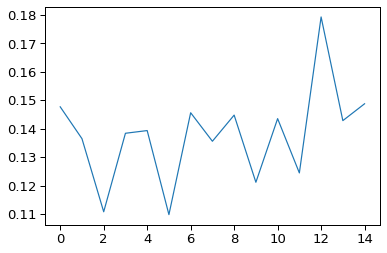

In [72]:
plt.plot(all_losses)

In [73]:
best_idx = np.argmin(all_losses)
best_idx

5

In [74]:
all_cv_scores[best_idx]

{'train_r2': array([0.7305031 , 0.37106423, 0.8956995 , 0.56535453, 0.50709706]),
 'validate_r2': array([0.60927903, 0.9476948 , 0.72818355, 0.83800551, 0.6193214 ]),
 'train_rmsd': array([0.14159356, 0.1733609 , 0.08581196, 0.18318529, 0.21447774]),
 'validate_rmsd': array([0.15686794, 0.07246383, 0.12144447, 0.08580861, 0.11231413])}

In [75]:
best_emulator = all_emulators[best_idx]
best_emulator

In [76]:
best_emulator.train()

[INFO] >>> Training model on 80% of the dataset, testing on 20%...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '


[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.550          0.346         -1.001          0.422 *
[INFO]             100         -0.550          0.346         -1.001          0.422
[INFO]             200          0.132          0.259          0.186          0.269 *
[INFO]             300          0.844          0.110          0.731          0.155 *
[INFO]             400          0.718          0.147          0.608          0.187
[INFO]             500          0.748          0.139          0.666          0.173
[INFO]             600          0.666          0.160          0.536          0.203
[INFO]             700          0.877          0.097          0.729          0.155
[INFO]             800          0.843          0.110          0.706          0.16

[INFO]            8600          0.924          0.077          0.829          0.123
[INFO]            8700          0.742          0.141          0.698          0.164
[INFO]            8800          0.843          0.110          0.774          0.142
[INFO]            8900          0.892          0.091          0.819          0.127
[INFO]            9000          0.923          0.077          0.825          0.125
[INFO]            9100          0.911          0.083          0.803          0.133
[INFO]            9200          0.899          0.088          0.820          0.127
[INFO]            9300          0.912          0.082          0.814          0.129
[INFO]            9400          0.889          0.092          0.842          0.119
[INFO]            9500          0.880          0.096          0.794          0.136
[INFO]            9600          0.870          0.100          0.826          0.125
[INFO]            9700          0.903          0.087          0.812          0.130
[INF

[INFO]           17600          0.895          0.090          0.848          0.116
[INFO]           17700          0.916          0.081          0.827          0.124
[INFO]           17800          0.893          0.091          0.785          0.139
[INFO]           17900          0.912          0.082          0.853          0.115
[INFO]           18000          0.915          0.081          0.864          0.110
[INFO]           18100          0.887          0.093          0.842          0.119
[INFO]           18200          0.903          0.086          0.846          0.117
[INFO]           18300          0.888          0.093          0.824          0.125
[INFO]           18400          0.921          0.078          0.807          0.131
[INFO]           18500          0.922          0.078          0.815          0.128
[INFO]           18600          0.839          0.112          0.819          0.127
[INFO]           18700          0.877          0.097          0.823          0.126
[INF

{'train_r2': 0.9166190239885191,
 'test_r2': 0.8652943508707951,
 'train_rmsd': 0.08016554928981688,
 'test_rmsd': 0.10955841450794691}

In [79]:
#best_emulator.save('emulator_p3ht_BayesNeuralNet')

[WARNING] Overwriting existing emulator in emulator_p3ht_BayesNeuralNet!


In [37]:
hyperparams = {'batch_size': 20,
 'hidden_act': 'leaky_relu',
 'hidden_depth': 4,
 'hidden_nodes': 48,
 'learning_rate': 0.0002692344532839484,
 'reg': 0.08677643528151723}



model  = BayesNeuralNet(**hyperparams, out_act='relu')
emulator = Emulator(
        dataset='p3ht', model=model, feature_transform='standardize', target_transform='normalize',
    )

In [38]:
emulator.train()

[INFO] >>> Training model on 80% of the dataset, testing on 20%...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)
/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)


[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.434          0.312         -0.399          0.287 *
[INFO]             100          0.598          0.165          0.685          0.136 *
[INFO]             200          0.640          0.156          0.754          0.120 *
[INFO]             300          0.576          0.170          0.758          0.119 *
[INFO]             400          0.631          0.158          0.708          0.131
[INFO]             500          0.565          0.172          0.754          0.120
[INFO]             600          0.618          0.161          0.771          0.116 *
[INFO]             700          0.607          0.163          0.715          0.129
[INFO]             800          0.604          0.164          0.728          

[INFO]            8600          0.581          0.169          0.748          0.122
[INFO]            8700          0.596          0.165          0.768          0.117
[INFO]            8800          0.623          0.160          0.738          0.124
[INFO]            8900          0.559          0.173          0.751          0.121
[INFO]            9000          0.583          0.168          0.703          0.132
[INFO]            9100          0.614          0.162          0.780          0.114
[INFO]            9200          0.609          0.163          0.747          0.122
[INFO]            9300          0.661          0.152          0.771          0.116
[INFO]            9400          0.614          0.162          0.769          0.117
[INFO]            9500          0.608          0.163          0.708          0.131
[INFO]            9600          0.647          0.155          0.775          0.115
[INFO]            9700          0.623          0.160          0.747          0.122
[INF

[INFO]           17400          0.594          0.166          0.736          0.125
[INFO]           17500          0.585          0.168          0.690          0.135
[INFO]           17600          0.614          0.162          0.759          0.119
[INFO]           17700          0.524          0.180          0.685          0.136
[INFO]           17800          0.634          0.157          0.664          0.141
[INFO]           17900          0.703          0.142          0.783          0.113
[INFO]           18000          0.571          0.171          0.717          0.129
[INFO]           18100          0.614          0.162          0.753          0.120
[INFO]           18200          0.632          0.158          0.693          0.134
[INFO]           18300          0.602          0.164          0.674          0.138
[INFO]           18400          0.595          0.166          0.756          0.120
[INFO]           18500          0.548          0.175          0.796          0.109
[INF

{'train_r2': 0.655823218347876,
 'test_r2': 0.8313191003459752,
 'train_rmsd': 0.1527277081471368,
 'test_rmsd': 0.09957007411010889}

In [39]:
emulator.save('emulator_p3ht_BayesNeuralNet')

[WARNING] Overwriting existing emulator in emulator_p3ht_BayesNeuralNet!


## dataset_thin_film

In [91]:
search_space = {
    'batch_size': hp.quniform('batch_size', 10, 50, 10),
    'hidden_act': hp.choice('hidden_act', ['leaky_relu'] ),
    'hidden_depth': hp.quniform('hidden_depth', 2, 5, 1),
    'hidden_nodes': hp.quniform('hidden_nodes', 28, 64, 4),
    'learning_rate': hp.uniform('learning_rate', 1e-5, 5e-3),
    'reg': hp.uniform('reg', 0.001, 0.1)
}

int_params = ['batch_size', 'hidden_depth', 'hidden_nodes']

all_emulators = []
all_losses = []
all_cv_scores = []
all_params = []

def objective(params):
    ''' average performance over cross-validation folds '''
    # build emualtor
    print(f'PARAMS : {params}')
    for param, val in params.items():
        if param in int_params:
            params[param] = int(val)
    model  = BayesNeuralNet(
        **params, out_act='relu', 
    )
    emulator = Emulator(
        dataset='thin_film', model=model, 
        feature_transform='identity', target_transform='normalize',
    )

    cv_scores = emulator.cross_validate()
    loss = np.mean(cv_scores['validate_rmsd'])
    
    all_losses.append(loss)
    all_cv_scores.append(cv_scores)
    all_params.append(params)
    all_emulators.append(emulator)
    
    return {'loss': loss, 'status': STATUS_OK}

In [92]:
trials = Trials()

best = fmin(
    fn=objective,
    space=search_space, 
    algo=tpe.suggest, 
    max_evals=20,
    trials=trials
)

print(f"BEST VALUE : {best}")

PARAMS : {'batch_size': 30.0, 'hidden_act': 'leaky_relu', 'hidden_depth': 4.0, 'hidden_nodes': 44.0, 'learning_rate': 0.003458293812769379, 'reg': 0.08600037985440101}
  0%|          | 0/20 [00:00<?, ?trial/s, best loss=?][INFO] >>> Training model on fold #0...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.473          0.204         -0.823          0.119 *
[INFO]             100          0.487          0.120         -0.019          0.089 *
[INFO]             200          0.456          0.124         -0.506          0.108
[INFO]             300          0.486          0.120         -0.180          0.095
[INFO]             400          0.340          0.136          0.139          0.082 *
[INFO]             500          0.460          0.123         -0.237          0.098
[INFO]             600          0.484          0.121          0.124          0.082
[INFO]             700          0.414          0.129         -0.288          0.100
[INFO]             800          0.319          0.139         -1.520          0.13

[INFO]            8700          0.770          0.081         -0.261          0.099
[INFO]            8800          0.774          0.080         -0.380          0.103
[INFO]            8900          0.793          0.076         -0.022          0.089
[INFO]            9000          0.760          0.082         -0.210          0.097
[INFO]            9100          0.793          0.076         -0.002          0.088
[INFO]            9200          0.776          0.079         -0.275          0.099
[INFO]            9300          0.747          0.085         -0.371          0.103
[INFO]            9400          0.787          0.077          0.209          0.078
[INFO]            9500          0.796          0.076          0.149          0.081
[INFO]            9600          0.769          0.081         -0.288          0.100
[INFO]            9700          0.799          0.075         -0.021          0.089
[INFO]            9800          0.791          0.077         -0.056          0.090
[INF

[INFO]           17700          0.806          0.074          0.039          0.086
[INFO]           17800          0.805          0.074          0.057          0.085
[INFO]           17900          0.793          0.077         -0.188          0.096
[INFO]           18000          0.791          0.077         -0.006          0.088
[INFO]           18100          0.787          0.078         -0.272          0.099
[INFO]           18200          0.773          0.080         -0.323          0.101
[INFO]           18300          0.776          0.080         -0.036          0.089
[INFO]           18400          0.784          0.078         -0.092          0.092
[INFO]           18500          0.810          0.073          0.186          0.079
[INFO]           18600          0.743          0.085         -0.626          0.112
[INFO]           18700          0.775          0.080         -0.177          0.095
[INFO]           18800          0.806          0.074         -0.120          0.093
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.672          0.403         -0.830          0.344 *
[INFO]             100         -0.075          0.256          0.011          0.253 *
[INFO]             200          0.581          0.160          0.505          0.179 *
[INFO]             300          0.530          0.169          0.647          0.151 *
[INFO]             400          0.661          0.143          0.618          0.157
[INFO]             500          0.705          0.134          0.715          0.136 *
[INFO]             600          0.575          0.161          0.655          0.149
[INFO]             700          0.742          0.125          0.577          0.166
[INFO]             800          0.739          0.126          0.755          

[INFO]            8600          0.814          0.106          0.698          0.140
[INFO]            8700          0.780          0.116          0.714          0.136
[INFO]            8800          0.794          0.112          0.692          0.141
[INFO]            8900          0.804          0.109          0.678          0.144
[INFO]            9000          0.808          0.108          0.710          0.137
[INFO]            9100          0.809          0.108          0.682          0.143
[INFO]            9200          0.817          0.105          0.689          0.142
[INFO]            9300          0.790          0.113          0.731          0.132
[INFO]            9400          0.812          0.107          0.726          0.133
[INFO]            9500          0.798          0.111          0.704          0.138
[INFO]            9600          0.795          0.112          0.758          0.125
[INFO]            9700          0.817          0.105          0.653          0.150
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.056          0.185         -0.206          0.197 *
[INFO]             100          0.654          0.106          0.388          0.140 *
[INFO]             200          0.657          0.105          0.108          0.169
[INFO]             300          0.629          0.109          0.144          0.166
[INFO]             400          0.569          0.118          0.458          0.132 *
[INFO]             500          0.691          0.100         -0.015          0.180
[INFO]             600          0.594          0.115          0.561          0.119 *
[INFO]             700          0.716          0.096          0.332          0.146
[INFO]             800          0.617          0.111          0.087          0.

[INFO]            8500          0.726          0.094          0.132          0.167
[INFO]            8600          0.728          0.094          0.198          0.160
[INFO]            8700          0.688          0.100          0.064          0.173
[INFO]            8800          0.708          0.097          0.079          0.172
[INFO]            8900          0.699          0.099          0.107          0.169
[INFO]            9000          0.720          0.095          0.181          0.162
[INFO]            9100          0.692          0.100          0.154          0.165
[INFO]            9200          0.729          0.094          0.078          0.172
[INFO]            9300          0.727          0.094          0.147          0.165
[INFO]            9400          0.739          0.092          0.112          0.169
[INFO]            9500          0.716          0.096          0.083          0.171
[INFO]            9600          0.711          0.097          0.176          0.163
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.584          0.274         -3.558          0.232 *
[INFO]             100          0.492          0.122          0.256          0.094 *
[INFO]             200          0.613          0.106          0.253          0.094
[INFO]             300          0.654          0.100          0.452          0.080 *
[INFO]             400          0.464          0.125          0.455          0.080 *
[INFO]             500          0.536          0.116          0.249          0.094
[INFO]             600          0.358          0.137          0.237          0.095
[INFO]             700          0.562          0.113          0.403          0.084
[INFO]             800          0.481          0.123          0.197          0.

[INFO]            8700          0.823          0.072          0.426          0.082
[INFO]            8800          0.858          0.064          0.333          0.089
[INFO]            8900          0.845          0.067          0.337          0.089
[INFO]            9000          0.858          0.064          0.365          0.087
[INFO]            9100          0.837          0.069          0.394          0.085
[INFO]            9200          0.878          0.060          0.290          0.092
[INFO]            9300          0.871          0.061          0.361          0.087
[INFO]            9400          0.872          0.061          0.386          0.085
[INFO]            9500          0.852          0.066          0.346          0.088
[INFO]            9600          0.848          0.066          0.359          0.087
[INFO]            9700          0.837          0.069          0.407          0.084
[INFO]            9800          0.881          0.059          0.334          0.089
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.076          0.253         -0.683          0.339 *
[INFO]             100          0.731          0.091          0.567          0.172 *
[INFO]             200          0.764          0.085          0.631          0.158 *
[INFO]             300          0.772          0.084          0.481          0.188
[INFO]             400          0.797          0.079          0.537          0.178
[INFO]             500          0.787          0.081          0.619          0.161
[INFO]             600          0.604          0.111          0.445          0.194
[INFO]             700          0.654          0.103          0.333          0.213
[INFO]             800          0.705          0.096          0.760          0.12

[INFO]            8500          0.824          0.074          0.612          0.163
[INFO]            8600          0.825          0.074          0.645          0.155
[INFO]            8700          0.806          0.077          0.606          0.164
[INFO]            8800          0.807          0.077          0.664          0.151
[INFO]            8900          0.820          0.075          0.614          0.162
[INFO]            9000          0.818          0.075          0.614          0.162
[INFO]            9100          0.819          0.075          0.655          0.153
[INFO]            9200          0.813          0.076          0.649          0.155
[INFO]            9300          0.815          0.076          0.672          0.149
[INFO]            9400          0.811          0.076          0.659          0.152
[INFO]            9500          0.813          0.076          0.625          0.160
[INFO]            9600          0.814          0.076          0.661          0.152
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.029          0.306         -2.159          0.228 *
[INFO]             100          0.708          0.116          0.436          0.096 *
[INFO]             200          0.693          0.119          0.445          0.095 *
[INFO]             300          0.773          0.102          0.290          0.108
[INFO]             400          0.805          0.095          0.267          0.110
[INFO]             500          0.787          0.099          0.488          0.092 *
[INFO]             600          0.835          0.087         -0.001          0.128
[INFO]             700          0.803          0.095          0.380          0.101
[INFO]             800          0.836          0.087          0.397          0.

[INFO]            8700          0.919          0.061          0.236          0.112
[INFO]            8800          0.936          0.054          0.308          0.107
[INFO]            8900          0.917          0.062          0.180          0.116
[INFO]            9000          0.921          0.060          0.180          0.116
[INFO]            9100          0.920          0.061          0.243          0.112
[INFO]            9200          0.918          0.061          0.120          0.120
[INFO]            9300          0.915          0.063          0.173          0.117
[INFO]            9400          0.907          0.065          0.079          0.123
[INFO]            9500          0.915          0.063          0.312          0.106
[INFO]            9600          0.917          0.062          0.240          0.112
[INFO]            9700          0.922          0.060          0.317          0.106
[INFO]            9800          0.875          0.076          0.328          0.105
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.260          0.359         -1.263          0.428 *
[INFO]             100         -1.260          0.359         -1.263          0.428
[INFO]             200         -1.260          0.359         -1.263          0.428
[INFO]             300         -0.029          0.242         -0.179          0.309 *
[INFO]             400          0.591          0.153          0.677          0.162 *
[INFO]             500          0.621          0.147          0.738          0.146 *
[INFO]             600          0.687          0.134          0.676          0.162
[INFO]             700          0.675          0.136          0.779          0.134 *
[INFO]             800          0.610          0.149          0.753          

[INFO]            8500          0.922          0.067          0.710          0.153
[INFO]            8600          0.938          0.059          0.712          0.153
[INFO]            8700          0.922          0.067          0.673          0.163
[INFO]            8800          0.914          0.070          0.733          0.147
[INFO]            8900          0.933          0.062          0.671          0.163
[INFO]            9000          0.937          0.060          0.727          0.149
[INFO]            9100          0.925          0.065          0.714          0.152
[INFO]            9200          0.913          0.071          0.695          0.157
[INFO]            9300          0.923          0.066          0.743          0.144
[INFO]            9400          0.932          0.062          0.739          0.145
[INFO]            9500          0.915          0.070          0.760          0.139
[INFO]            9600          0.937          0.060          0.752          0.142
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.161          0.249         -0.170          0.163 *
[INFO]             100          0.868          0.084          0.452          0.112 *
[INFO]             200          0.848          0.090          0.211          0.134
[INFO]             300          0.864          0.085          0.497          0.107 *
[INFO]             400          0.684          0.130          0.023          0.149
[INFO]             500          0.862          0.086          0.579          0.098 *
[INFO]             600          0.896          0.074          0.607          0.095 *
[INFO]             700          0.836          0.093          0.503          0.106
[INFO]             800          0.814          0.100          0.482          

[INFO]            8500          0.963          0.045          0.381          0.119
[INFO]            8600          0.938          0.057          0.099          0.143
[INFO]            8700          0.965          0.043          0.469          0.110
[INFO]            8800          0.946          0.053          0.249          0.131
[INFO]            8900          0.954          0.049          0.233          0.132
[INFO]            9000          0.967          0.042          0.478          0.109
[INFO]            9100          0.960          0.046          0.456          0.111
[INFO]            9200          0.933          0.060          0.146          0.139
[INFO]            9300          0.953          0.050          0.301          0.126
[INFO]            9400          0.953          0.050          0.263          0.129
[INFO]            9500          0.963          0.044          0.372          0.119
[INFO]            9600          0.956          0.049          0.337          0.123
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.025          0.185         -0.964          0.370 *
[INFO]             100          0.518          0.090          0.331          0.216 *
[INFO]             200          0.414          0.099          0.164          0.241
[INFO]             300          0.496          0.092          0.285          0.223
[INFO]             400          0.549          0.087          0.219          0.233
[INFO]             500          0.556          0.087          0.165          0.241
[INFO]             600          0.511          0.091          0.224          0.232
[INFO]             700          0.488          0.093          0.327          0.216
[INFO]             800          0.520          0.090          0.245          0.229


[INFO]            8400          0.623          0.080          0.547          0.178
[INFO]            8500          0.612          0.081          0.554          0.176
[INFO]            8600          0.619          0.080          0.474          0.191
[INFO]            8700          0.615          0.081          0.423          0.200
[INFO]            8800          0.611          0.081          0.484          0.190
[INFO]            8900          0.612          0.081          0.571          0.173
[INFO]            9000          0.616          0.080          0.533          0.180
[INFO]            9100          0.637          0.078          0.477          0.191
[INFO]            9200          0.618          0.080          0.555          0.176
[INFO]            9300          0.591          0.083          0.548          0.177
[INFO]            9400          0.615          0.081          0.583          0.170
[INFO]            9500          0.617          0.080          0.533          0.180
[INF

[INFO]           17200          0.608          0.081          0.655          0.155
[INFO]           17300          0.624          0.080          0.627          0.161
[INFO]           17400          0.633          0.079          0.617          0.163
[INFO]           17500          0.630          0.079          0.595          0.168
[INFO]           17600          0.623          0.080          0.569          0.173
[INFO]           17700          0.588          0.083          0.639          0.159
[INFO]           17800          0.613          0.081          0.619          0.163
[INFO]           17900          0.622          0.080          0.614          0.164
[INFO]           18000          0.647          0.077          0.534          0.180
[INFO]           18100          0.620          0.080          0.607          0.165
[INFO]           18200          0.635          0.078          0.558          0.175
[INFO]           18300          0.629          0.079          0.586          0.170
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.302          0.202         -0.463          0.102 *
[INFO]             100          0.561          0.117         -0.122          0.089 *
[INFO]             200          0.554          0.118         -0.318          0.097
[INFO]             300          0.498          0.125         -0.159          0.090
[INFO]             400          0.454          0.131         -0.138          0.090
[INFO]             500          0.546          0.119         -0.254          0.094
[INFO]             600          0.541          0.120         -0.077          0.087 *
[INFO]             700          0.614          0.110         -0.318          0.097
[INFO]             800          0.519          0.123         -0.098          0.08

[INFO]            8500          0.777          0.083         -0.267          0.095
[INFO]            8600          0.782          0.083         -0.234          0.093
[INFO]            8700          0.796          0.080         -0.264          0.095
[INFO]            8800          0.788          0.081         -0.180          0.091
[INFO]            8900          0.810          0.077         -0.442          0.101
[INFO]            9000          0.798          0.079         -0.298          0.096
[INFO]            9100          0.810          0.077         -0.217          0.093
[INFO]            9200          0.818          0.075         -0.230          0.093
[INFO]            9300          0.831          0.073         -0.322          0.097
[INFO]            9400          0.826          0.074         -0.293          0.096
[INFO]            9500          0.835          0.072         -0.203          0.092
[INFO]            9600          0.818          0.075         -0.367          0.098
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.482          0.256         -0.944          0.378 *
[INFO]             100          0.578          0.136          0.496          0.192 *
[INFO]             200          0.583          0.136          0.509          0.190 *
[INFO]             300          0.626          0.128          0.665          0.157 *
[INFO]             400          0.638          0.126          0.605          0.170
[INFO]             500          0.631          0.128          0.700          0.148 *
[INFO]             600          0.654          0.123          0.654          0.159
[INFO]             700          0.707          0.114          0.675          0.155
[INFO]             800          0.678          0.119          0.660          

[INFO]            8500          0.935          0.054          0.733          0.140
[INFO]            8600          0.942          0.050          0.695          0.150
[INFO]            8700          0.942          0.051          0.715          0.145
[INFO]            8800          0.943          0.050          0.728          0.141
[INFO]            8900          0.949          0.048          0.730          0.141
[INFO]            9000          0.943          0.050          0.748          0.136 *
[INFO]            9100          0.943          0.050          0.731          0.141
[INFO]            9200          0.942          0.051          0.714          0.145
[INFO]            9300          0.946          0.049          0.741          0.138
[INFO]            9400          0.946          0.049          0.733          0.140
[INFO]            9500          0.947          0.049          0.742          0.138
[INFO]            9600          0.947          0.048          0.734          0.140
[I

[INFO]           17300          0.970          0.036          0.744          0.137
[INFO]           17400          0.970          0.036          0.746          0.136
[INFO]           17500          0.969          0.037          0.745          0.137
[INFO]           17600          0.972          0.035          0.769          0.130
[INFO]           17700          0.970          0.037          0.771          0.130
[INFO]           17800          0.971          0.036          0.761          0.133
[INFO]           17900          0.971          0.036          0.768          0.131
[INFO]           18000          0.972          0.035          0.773          0.129
[INFO]           18100          0.971          0.036          0.780          0.127 *
[INFO]           18200          0.971          0.036          0.772          0.129
[INFO]           18300          0.971          0.036          0.774          0.129
[INFO]           18400          0.972          0.035          0.768          0.130
[I

[INFO]           26300          0.983          0.027          0.755          0.134
[INFO]           26400          0.982          0.029          0.760          0.133
[INFO]           26500          0.982          0.028          0.757          0.134
[INFO]           26600          0.983          0.028          0.770          0.130
[INFO]           26700          0.983          0.027          0.765          0.131
[INFO]           26800          0.982          0.028          0.762          0.132
[INFO]           26900          0.983          0.027          0.765          0.131
[INFO]           27000          0.984          0.026          0.756          0.134
[INFO]           27100          0.984          0.027          0.769          0.130
[INFO]           27200          0.984          0.027          0.757          0.134
[INFO]           27300          0.984          0.027          0.762          0.132
[INFO]           27400          0.983          0.027          0.762          0.132
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.797          0.253         -0.695          0.187 *
[INFO]             100          0.577          0.123          0.305          0.120 *
[INFO]             200          0.636          0.114          0.588          0.092 *
[INFO]             300          0.654          0.111          0.546          0.097
[INFO]             400          0.664          0.110          0.494          0.102
[INFO]             500          0.705          0.103          0.607          0.090 *
[INFO]             600          0.663          0.110          0.381          0.113
[INFO]             700          0.766          0.091          0.523          0.099
[INFO]             800          0.778          0.089          0.587          0.

[INFO]            8700          0.904          0.059          0.675          0.082
[INFO]            8800          0.902          0.059          0.574          0.094
[INFO]            8900          0.907          0.058          0.665          0.083
[INFO]            9000          0.903          0.059          0.656          0.084
[INFO]            9100          0.903          0.059          0.653          0.084
[INFO]            9200          0.912          0.056          0.623          0.088
[INFO]            9300          0.915          0.055          0.695          0.079
[INFO]            9400          0.905          0.058          0.586          0.092
[INFO]            9500          0.912          0.056          0.623          0.088
[INFO]            9600          0.907          0.058          0.704          0.078
[INFO]            9700          0.909          0.057          0.701          0.078
[INFO]            9800          0.906          0.058          0.690          0.080
[INF

[INFO]           17600          0.919          0.054          0.818          0.061
[INFO]           17700          0.924          0.052          0.769          0.069
[INFO]           17800          0.927          0.051          0.802          0.064
[INFO]           17900          0.926          0.051          0.794          0.065
[INFO]           18000          0.926          0.051          0.778          0.068
[INFO]           18100          0.921          0.053          0.770          0.069
[INFO]           18200          0.917          0.054          0.757          0.071
[INFO]           18300          0.926          0.051          0.809          0.063
[INFO]           18400          0.925          0.052          0.792          0.065
[INFO]           18500          0.923          0.052          0.744          0.073
[INFO]           18600          0.925          0.052          0.803          0.064
[INFO]           18700          0.929          0.050          0.794          0.065
[INF

[INFO]           26600          0.941          0.046          0.787          0.066
[INFO]           26700          0.936          0.048          0.805          0.063
[INFO]           26800          0.931          0.050          0.802          0.064
[INFO]           26900          0.936          0.048          0.799          0.064
[INFO]           27000          0.939          0.047          0.796          0.065
[INFO]           27100          0.937          0.047          0.812          0.062
[INFO]           27200          0.938          0.047          0.786          0.066
[INFO]           27300          0.935          0.048          0.807          0.063
[INFO]           27400          0.937          0.047          0.811          0.062
[INFO]           27500          0.938          0.047          0.822          0.060
[INFO]           27600          0.938          0.047          0.791          0.066
[INFO]           27700          0.929          0.050          0.779          0.067
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.554          0.294         -4.839          0.210 *
[INFO]             100         -1.554          0.294         -4.839          0.210
[INFO]             200         -1.554          0.294         -4.839          0.210
[INFO]             300         -1.554          0.294         -4.839          0.210
[INFO]             400         -1.554          0.294         -4.839          0.210
[INFO]             500         -1.554          0.294         -4.839          0.210
[INFO]             600         -1.554          0.294         -4.839          0.210
[INFO]             700         -1.554          0.294         -4.839          0.210
[INFO]             800         -1.554          0.294         -4.839          0.210
[I

[INFO]            8500          0.877          0.065          0.191          0.078
[INFO]            8600          0.874          0.065          0.314          0.072
[INFO]            8700          0.882          0.063          0.134          0.081
[INFO]            8800          0.893          0.060          0.302          0.072
[INFO]            8900          0.875          0.065          0.293          0.073
[INFO]            9000          0.874          0.065          0.009          0.086
[INFO]            9100          0.888          0.062          0.229          0.076
[INFO]            9200          0.884          0.063          0.248          0.075
[INFO]            9300          0.893          0.060          0.169          0.079
[INFO]            9400          0.900          0.058          0.268          0.074
[INFO]            9500          0.898          0.059          0.301          0.073
[INFO]            9600          0.881          0.064          0.250          0.075
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.710          0.271         -0.713          0.331 *
[INFO]             100          0.434          0.156          0.577          0.164 *
[INFO]             200          0.597          0.132          0.678          0.143 *
[INFO]             300          0.598          0.131          0.705          0.137 *
[INFO]             400          0.690          0.115          0.710          0.136 *
[INFO]             500          0.734          0.107          0.737          0.130 *
[INFO]             600          0.766          0.100          0.714          0.135
[INFO]             700          0.799          0.093          0.706          0.137
[INFO]             800          0.808          0.091          0.636        

[INFO]            8400          0.890          0.069          0.834          0.103
[INFO]            8500          0.895          0.067          0.835          0.103
[INFO]            8600          0.891          0.068          0.823          0.106
[INFO]            8700          0.894          0.068          0.817          0.108
[INFO]            8800          0.891          0.068          0.808          0.111
[INFO]            8900          0.894          0.068          0.824          0.106
[INFO]            9000          0.895          0.067          0.858          0.095
[INFO]            9100          0.898          0.066          0.838          0.102
[INFO]            9200          0.898          0.066          0.809          0.110
[INFO]            9300          0.899          0.066          0.829          0.104
[INFO]            9400          0.902          0.065          0.857          0.095
[INFO]            9500          0.902          0.065          0.832          0.104
[INF

[INFO]           17300          0.926          0.056          0.884          0.086
[INFO]           17400          0.926          0.056          0.887          0.085
[INFO]           17500          0.927          0.056          0.879          0.088
[INFO]           17600          0.927          0.056          0.882          0.087
[INFO]           17700          0.929          0.055          0.886          0.085
[INFO]           17800          0.926          0.056          0.878          0.088
[INFO]           17900          0.927          0.056          0.883          0.087
[INFO]           18000          0.927          0.056          0.885          0.086
[INFO]           18100          0.927          0.056          0.874          0.090
[INFO]           18200          0.929          0.055          0.882          0.087
[INFO]           18300          0.930          0.055          0.889          0.084
[INFO]           18400          0.932          0.054          0.890          0.084
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.243          0.261         -0.397          0.247 *
[INFO]             100          0.446          0.130          0.480          0.151 *
[INFO]             200          0.411          0.134          0.339          0.170
[INFO]             300          0.422          0.133          0.366          0.166
[INFO]             400          0.419          0.133          0.337          0.170
[INFO]             500          0.406          0.134          0.401          0.162
[INFO]             600          0.346          0.141          0.430          0.158
[INFO]             700          0.402          0.135          0.188          0.188
[INFO]             800          0.405          0.134          0.352          0.168


[INFO]            8500          0.842          0.069          0.735          0.107
[INFO]            8600          0.850          0.068          0.721          0.110
[INFO]            8700          0.865          0.064          0.731          0.108
[INFO]            8800          0.857          0.066          0.732          0.108
[INFO]            8900          0.857          0.066          0.730          0.108
[INFO]            9000          0.853          0.067          0.736          0.107
[INFO]            9100          0.863          0.065          0.719          0.111
[INFO]            9200          0.866          0.064          0.724          0.110
[INFO]            9300          0.861          0.065          0.767          0.101
[INFO]            9400          0.862          0.065          0.722          0.110
[INFO]            9500          0.874          0.062          0.747          0.105
[INFO]            9600          0.841          0.070          0.736          0.107
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.489          0.217         -0.991          0.172 *
[INFO]             100          0.049          0.173          0.088          0.116 *
[INFO]             200          0.353          0.143          0.481          0.088 *
[INFO]             300          0.786          0.082          0.419          0.093
[INFO]             400          0.826          0.074          0.453          0.090
[INFO]             500          0.807          0.078          0.402          0.094
[INFO]             600          0.807          0.078          0.293          0.103
[INFO]             700          0.792          0.081          0.407          0.094
[INFO]             800          0.846          0.070          0.435          0.09

[INFO]            8500          0.843          0.070          0.585          0.079
[INFO]            8600          0.838          0.071          0.580          0.079
[INFO]            8700          0.844          0.070          0.646          0.073
[INFO]            8800          0.840          0.071          0.613          0.076
[INFO]            8900          0.835          0.072          0.573          0.080
[INFO]            9000          0.844          0.070          0.601          0.077
[INFO]            9100          0.838          0.071          0.596          0.077
[INFO]            9200          0.841          0.071          0.560          0.081
[INFO]            9300          0.854          0.068          0.566          0.080
[INFO]            9400          0.844          0.070          0.613          0.076
[INFO]            9500          0.856          0.067          0.618          0.075
[INFO]            9600          0.840          0.071          0.610          0.076
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.403          0.283         -1.150          0.155 *
[INFO]             100          0.026          0.236         -0.001          0.106 *
[INFO]             200          0.430          0.181         -0.143          0.113
[INFO]             300          0.760          0.117         -0.147          0.113
[INFO]             400          0.756          0.118         -0.086          0.110
[INFO]             500          0.782          0.112          0.017          0.105 *
[INFO]             600          0.776          0.113         -0.055          0.109
[INFO]             700          0.798          0.107         -0.059          0.109
[INFO]             800          0.833          0.098         -0.157          0.11

[INFO]            8500          0.924          0.066          0.042          0.103
[INFO]            8600          0.921          0.067          0.006          0.105
[INFO]            8700          0.911          0.072          0.104          0.100
[INFO]            8800          0.920          0.068          0.039          0.104
[INFO]            8900          0.924          0.066          0.086          0.101
[INFO]            9000          0.927          0.065          0.087          0.101
[INFO]            9100          0.934          0.062          0.069          0.102
[INFO]            9200          0.926          0.065          0.088          0.101
[INFO]            9300          0.925          0.066          0.088          0.101
[INFO]            9400          0.931          0.063          0.067          0.102
[INFO]            9500          0.921          0.067          0.136          0.098
[INFO]            9600          0.924          0.066          0.098          0.100
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.085          0.207         -0.171          0.506 *
[INFO]             100         -0.032          0.202         -0.037          0.476 *
[INFO]             200          0.189          0.179          0.119          0.439 *
[INFO]             300          0.407          0.153          0.446          0.348 *
[INFO]             400          0.416          0.152          0.610          0.292 *
[INFO]             500          0.405          0.153          0.629          0.285 *
[INFO]             600          0.366          0.158          0.608          0.293
[INFO]             700          0.416          0.152          0.667          0.270 *
[INFO]             800          0.396          0.154          0.678      

[INFO]            8500          0.510          0.139          0.466          0.342
[INFO]            8600          0.518          0.138          0.526          0.322
[INFO]            8700          0.512          0.139          0.557          0.311
[INFO]            8800          0.503          0.140          0.432          0.352
[INFO]            8900          0.496          0.141          0.495          0.332
[INFO]            9000          0.541          0.135          0.558          0.311
[INFO]            9100          0.549          0.133          0.613          0.291
[INFO]            9200          0.533          0.136          0.527          0.322
[INFO]            9300          0.530          0.136          0.488          0.335
[INFO]            9400          0.522          0.137          0.675          0.267
[INFO]            9500          0.514          0.139          0.570          0.307
[INFO]            9600          0.511          0.139          0.495          0.332
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.557          0.262         -1.236          0.198 *
[INFO]             100          0.051          0.205          0.047          0.129 *
[INFO]             200          0.393          0.164          0.381          0.104 *
[INFO]             300          0.723          0.111          0.338          0.108
[INFO]             400          0.786          0.097          0.262          0.114
[INFO]             500          0.803          0.093          0.200          0.119
[INFO]             600          0.820          0.089          0.215          0.117
[INFO]             700          0.833          0.086          0.196          0.119
[INFO]             800          0.848          0.082          0.112          0.12

[INFO]            8600          0.883          0.072          0.283          0.112
[INFO]            8700          0.879          0.073          0.291          0.112
[INFO]            8800          0.885          0.071          0.362          0.106
[INFO]            8900          0.873          0.075          0.311          0.110
[INFO]            9000          0.880          0.073          0.290          0.112
[INFO]            9100          0.868          0.076          0.293          0.112
[INFO]            9200          0.889          0.070          0.252          0.115
[INFO]            9300          0.891          0.069          0.325          0.109
[INFO]            9400          0.889          0.070          0.248          0.115
[INFO]            9500          0.878          0.073          0.354          0.107
[INFO]            9600          0.885          0.071          0.297          0.111
[INFO]            9700          0.886          0.071          0.298          0.111
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.966          0.263         -1.315          0.227 *
[INFO]             100          0.103          0.145         -0.051          0.153 *
[INFO]             200          0.336          0.125          0.078          0.143 *
[INFO]             300          0.612          0.095          0.252          0.129 *
[INFO]             400          0.651          0.090          0.315          0.124 *
[INFO]             500          0.609          0.096          0.264          0.128
[INFO]             600          0.639          0.092          0.318          0.123 *
[INFO]             700          0.566          0.101          0.315          0.124
[INFO]             800          0.636          0.092          0.399        

[INFO]            8600          0.673          0.087          0.454          0.110
[INFO]            8700          0.668          0.088          0.580          0.097
[INFO]            8800          0.694          0.085          0.449          0.111
[INFO]            8900          0.703          0.083          0.468          0.109
[INFO]            9000          0.658          0.089          0.560          0.099
[INFO]            9100          0.665          0.088          0.459          0.110
[INFO]            9200          0.682          0.086          0.536          0.102
[INFO]            9300          0.678          0.087          0.407          0.115
[INFO]            9400          0.685          0.086          0.436          0.112
[INFO]            9500          0.696          0.084          0.416          0.114
[INFO]            9600          0.676          0.087          0.540          0.101
[INFO]            9700          0.685          0.086          0.479          0.108
[INF

[INFO]           17400          0.745          0.077          0.664          0.087
[INFO]           17500          0.753          0.076          0.760          0.073
[INFO]           17600          0.767          0.074          0.628          0.091
[INFO]           17700          0.775          0.072          0.708          0.081
[INFO]           17800          0.769          0.073          0.641          0.089
[INFO]           17900          0.739          0.078          0.680          0.084
[INFO]           18000          0.767          0.074          0.637          0.090
[INFO]           18100          0.777          0.072          0.723          0.079
[INFO]           18200          0.775          0.072          0.710          0.080
[INFO]           18300          0.763          0.074          0.637          0.090
[INFO]           18400          0.767          0.074          0.699          0.082
[INFO]           18500          0.748          0.077          0.770          0.072
[INF

[INFO]           26300          0.801          0.068          0.672          0.085
[INFO]           26400          0.818          0.065          0.710          0.080
[INFO]           26500          0.803          0.068          0.738          0.076
[INFO]           26600          0.806          0.067          0.744          0.076
[INFO]           26700          0.808          0.067          0.724          0.078
[INFO]           26800          0.818          0.065          0.754          0.074
[INFO]           26900          0.822          0.064          0.701          0.082
[INFO]           27000          0.809          0.067          0.710          0.080
[INFO]           27100          0.814          0.066          0.773          0.071 *
[INFO]           27200          0.809          0.067          0.768          0.072
[INFO]           27300          0.826          0.064          0.783          0.070 *
[INFO]           27400          0.808          0.067          0.735          0.077


[INFO]           35100          0.857          0.058          0.753          0.074
[INFO]           35200          0.850          0.059          0.740          0.076
[INFO]           35300          0.850          0.059          0.734          0.077
[INFO]           35400          0.851          0.059          0.729          0.078
[INFO]           35500          0.847          0.060          0.743          0.076
[INFO]           35600          0.859          0.057          0.725          0.078
[INFO]           35700          0.857          0.058          0.740          0.076
[INFO]           35800          0.856          0.058          0.774          0.071
[INFO]           35900          0.850          0.059          0.765          0.072
[INFO]           36000          0.852          0.059          0.766          0.072
[INFO]           36100          0.852          0.059          0.762          0.073
[INFO]           36200          0.854          0.058          0.747          0.075
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -2.386          0.391         -1.121          0.638 *
[INFO]             100         -0.044          0.217         -0.117          0.463 *
[INFO]             200          0.533          0.145          0.401          0.339 *
[INFO]             300          0.259          0.183          0.138          0.407
[INFO]             400          0.520          0.147          0.406          0.338 *
[INFO]             500          0.414          0.163          0.506          0.308 *
[INFO]             600          0.368          0.169          0.389          0.342
[INFO]             700          0.359          0.170          0.355          0.352
[INFO]             800          0.482          0.153          0.354          

[INFO]            8400          0.520          0.147          0.540          0.297
[INFO]            8500          0.500          0.150          0.561          0.290
[INFO]            8600          0.561          0.141          0.521          0.303
[INFO]            8700          0.541          0.144          0.555          0.292
[INFO]            8800          0.497          0.151          0.612          0.273
[INFO]            8900          0.547          0.143          0.533          0.299
[INFO]            9000          0.548          0.143          0.472          0.318
[INFO]            9100          0.524          0.147          0.492          0.312
[INFO]            9200          0.556          0.142          0.529          0.301
[INFO]            9300          0.536          0.145          0.507          0.308
[INFO]            9400          0.540          0.144          0.521          0.303
[INFO]            9500          0.515          0.148          0.494          0.312
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.065          0.251         -0.105          0.172 *
[INFO]             100          0.559          0.161          0.216          0.145 *
[INFO]             200          0.489          0.174          0.290          0.138 *
[INFO]             300          0.612          0.151          0.318          0.135 *
[INFO]             400          0.372          0.193         -0.017          0.165
[INFO]             500          0.316          0.201          0.378          0.129 *
[INFO]             600          0.640          0.146          0.362          0.130
[INFO]             700          0.637          0.147          0.275          0.139
[INFO]             800          0.338          0.198          0.020          

[INFO]            8600          0.793          0.111          0.336          0.133
[INFO]            8700          0.744          0.123          0.102          0.155
[INFO]            8800          0.771          0.116          0.292          0.137
[INFO]            8900          0.768          0.117          0.269          0.140
[INFO]            9000          0.698          0.134          0.138          0.152
[INFO]            9100          0.701          0.133         -0.012          0.164
[INFO]            9200          0.718          0.129          0.037          0.160
[INFO]            9300          0.763          0.118          0.247          0.142
[INFO]            9400          0.713          0.130          0.039          0.160
[INFO]            9500          0.816          0.104          0.301          0.136
[INFO]            9600          0.780          0.114          0.199          0.146
[INFO]            9700          0.828          0.101          0.290          0.137
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.386          0.211         -0.161          0.137 *
[INFO]             100          0.477          0.129         -0.365          0.149
[INFO]             200          0.263          0.154         -0.062          0.131 *
[INFO]             300          0.229          0.157         -0.650          0.163
[INFO]             400          0.354          0.144         -0.100          0.133
[INFO]             500          0.476          0.129         -0.183          0.138
[INFO]             600          0.228          0.157          0.218          0.112 *
[INFO]             700          0.455          0.132         -0.038          0.130
[INFO]             800          0.423          0.136         -0.531          0.15

[INFO]            8600          0.741          0.091         -1.087          0.184
[INFO]            8700          0.701          0.098         -0.261          0.143
[INFO]            8800          0.728          0.093         -0.539          0.158
[INFO]            8900          0.672          0.102         -0.316          0.146
[INFO]            9000          0.731          0.093         -0.896          0.175
[INFO]            9100          0.751          0.089         -0.177          0.138
[INFO]            9200          0.781          0.084         -0.882          0.174
[INFO]            9300          0.579          0.116          0.060          0.123
[INFO]            9400          0.726          0.094         -0.266          0.143
[INFO]            9500          0.754          0.089         -0.703          0.166
[INFO]            9600          0.773          0.085         -0.486          0.155
[INFO]            9700          0.746          0.090         -0.641          0.163
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.218          0.145         -0.738          0.172 *
[INFO]             100          0.115          0.092          0.292          0.110 *
[INFO]             200          0.258          0.084          0.256          0.112
[INFO]             300         -1.121          0.142         -0.964          0.183
[INFO]             400          0.347          0.079          0.414          0.100 *
[INFO]             500         -0.334          0.112          0.255          0.113
[INFO]             600         -0.694          0.127          0.100          0.124
[INFO]             700         -0.076          0.101          0.154          0.120
[INFO]             800         -0.045          0.100          0.358          0.10

[INFO]            8500          0.098          0.092          0.245          0.113
[INFO]            8600          0.261          0.084          0.335          0.106
[INFO]            8700         -0.034          0.099          0.099          0.124
[INFO]            8800          0.255          0.084          0.256          0.112
[INFO]            8900          0.177          0.088          0.301          0.109
[INFO]            9000          0.309          0.081          0.420          0.099 *
[INFO]            9100          0.243          0.085          0.234          0.114
[INFO]            9200          0.170          0.089          0.290          0.110
[INFO]            9300          0.110          0.092          0.309          0.108
[INFO]            9400          0.159          0.089          0.346          0.105
[INFO]            9500          0.081          0.093          0.346          0.105
[INFO]            9600          0.142          0.090          0.231          0.114
[I

[INFO]           17200          0.349          0.079          0.540          0.088
[INFO]           17300          0.269          0.083          0.569          0.086
[INFO]           17400          0.168          0.089          0.573          0.085
[INFO]           17500          0.286          0.082          0.558          0.087
[INFO]           17600          0.187          0.088          0.505          0.092
[INFO]           17700          0.364          0.078          0.570          0.086
[INFO]           17800          0.413          0.075          0.549          0.088
[INFO]           17900          0.344          0.079          0.595          0.083
[INFO]           18000          0.287          0.082          0.576          0.085
[INFO]           18100          0.345          0.079          0.601          0.082 *
[INFO]           18200          0.369          0.077          0.566          0.086
[INFO]           18300          0.264          0.084          0.540          0.088
[I

[INFO]           34800          0.394          0.076          0.606          0.082
[INFO]           34900          0.337          0.079          0.601          0.082
[INFO]           35000          0.366          0.078          0.619          0.080
[INFO]           35100          0.389          0.076          0.634          0.079
[INFO]           35200          0.431          0.073          0.628          0.080
[INFO]           35300          0.401          0.075          0.649          0.077
[INFO]           35400          0.391          0.076          0.574          0.085
[INFO]           35500          0.331          0.080          0.542          0.088
[INFO]           35600          0.219          0.086          0.566          0.086
[INFO]           35700          0.379          0.077          0.647          0.077
[INFO]           35800          0.463          0.071          0.636          0.079
[INFO]           35900          0.419          0.074          0.643          0.078
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0          0.039          0.155         -0.208          0.182 *
[INFO]             100          0.146          0.146          0.644          0.099 *
[INFO]             200          0.227          0.139          0.691          0.092 *
[INFO]             300          0.112          0.149          0.123          0.155
[INFO]             400          0.290          0.133          0.131          0.154
[INFO]             500          0.199          0.141          0.638          0.100
[INFO]             600          0.370          0.125         -0.689          0.215
[INFO]             700          0.299          0.132          0.511          0.116
[INFO]             800          0.193          0.142          0.324          0.13

[INFO]            8500          0.480          0.114         -1.127          0.242
[INFO]            8600          0.470          0.115         -1.977          0.286
[INFO]            8700          0.479          0.114         -1.743          0.274
[INFO]            8800          0.527          0.108         -1.788          0.277
[INFO]            8900          0.447          0.117         -1.502          0.262
[INFO]            9000          0.433          0.119         -0.704          0.216
[INFO]            9100          0.449          0.117         -1.247          0.248
[INFO]            9200          0.474          0.114         -1.246          0.248
[INFO]            9300          0.452          0.117         -0.278          0.187
[INFO]            9400          0.502          0.111         -2.025          0.288
[INFO]            9500          0.459          0.116         -1.279          0.250
[INFO]            9600          0.481          0.114         -1.154          0.243
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -2.099          0.192         -0.816          0.280 *
[INFO]             100         -2.099          0.192         -0.816          0.280
[INFO]             200         -2.099          0.192         -0.816          0.280
[INFO]             300         -2.099          0.192         -0.816          0.280
[INFO]             400         -2.099          0.192         -0.816          0.280
[INFO]             500         -2.099          0.192         -0.816          0.280
[INFO]             600         -0.082          0.113          0.089          0.199 *
[INFO]             700          0.550          0.073          0.765          0.101 *
[INFO]             800          0.558          0.072          0.821          0.08

[INFO]            8600          0.639          0.066          0.571          0.136
[INFO]            8700          0.634          0.066          0.609          0.130
[INFO]            8800          0.612          0.068          0.603          0.131
[INFO]            8900          0.639          0.066          0.602          0.131
[INFO]            9000          0.651          0.064          0.584          0.134
[INFO]            9100          0.612          0.068          0.621          0.128
[INFO]            9200          0.620          0.067          0.625          0.127
[INFO]            9300          0.619          0.067          0.598          0.132
[INFO]            9400          0.617          0.067          0.599          0.132
[INFO]            9500          0.625          0.067          0.599          0.132
[INFO]            9600          0.615          0.068          0.593          0.133
[INFO]            9700          0.632          0.066          0.587          0.134
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.222          0.356         -2.243          0.215 *
[INFO]             100          0.521          0.165          0.533          0.082 *
[INFO]             200          0.748          0.120          0.258          0.103
[INFO]             300          0.773          0.114          0.383          0.094
[INFO]             400          0.772          0.114          0.334          0.097
[INFO]             500          0.787          0.110          0.334          0.097
[INFO]             600          0.802          0.106          0.331          0.098
[INFO]             700          0.803          0.106          0.217          0.106
[INFO]             800          0.850          0.092          0.229          0.105


[INFO]            8500          0.958          0.049          0.264          0.102
[INFO]            8600          0.952          0.052          0.321          0.098
[INFO]            8700          0.955          0.051          0.358          0.096
[INFO]            8800          0.945          0.056          0.280          0.101
[INFO]            8900          0.951          0.053          0.310          0.099
[INFO]            9000          0.947          0.055          0.399          0.092
[INFO]            9100          0.958          0.049          0.321          0.098
[INFO]            9200          0.952          0.052          0.352          0.096
[INFO]            9300          0.952          0.052          0.368          0.095
[INFO]            9400          0.953          0.052          0.367          0.095
[INFO]            9500          0.954          0.051          0.395          0.093
[INFO]            9600          0.952          0.053          0.334          0.097
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.088          0.268         -1.589          0.297 *
[INFO]             100          0.638          0.112          0.660          0.108 *
[INFO]             200          0.669          0.107          0.634          0.112
[INFO]             300          0.690          0.103          0.605          0.116
[INFO]             400          0.701          0.101          0.737          0.095 *
[INFO]             500          0.720          0.098          0.752          0.092 *
[INFO]             600          0.709          0.100          0.726          0.097
[INFO]             700          0.695          0.103          0.707          0.100
[INFO]             800          0.702          0.101          0.745          0.

[INFO]            8400          0.763          0.090          0.824          0.077
[INFO]            8500          0.761          0.091          0.840          0.074
[INFO]            8600          0.753          0.092          0.828          0.077
[INFO]            8700          0.745          0.094          0.847          0.072
[INFO]            8800          0.739          0.095          0.850          0.071
[INFO]            8900          0.767          0.090          0.846          0.073
[INFO]            9000          0.763          0.090          0.856          0.070
[INFO]            9100          0.756          0.092          0.840          0.074
[INFO]            9200          0.741          0.094          0.844          0.073
[INFO]            9300          0.761          0.091          0.842          0.073
[INFO]            9400          0.771          0.089          0.842          0.073
[INFO]            9500          0.745          0.094          0.840          0.074
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.708          0.290         -1.516          0.445 *
[INFO]             100          0.452          0.164          0.226          0.247 *
[INFO]             200          0.755          0.110          0.657          0.164 *
[INFO]             300          0.746          0.112          0.618          0.174
[INFO]             400          0.775          0.105          0.642          0.168
[INFO]             500          0.772          0.106          0.614          0.174
[INFO]             600          0.771          0.106          0.571          0.184
[INFO]             700          0.777          0.105          0.585          0.181
[INFO]             800          0.770          0.106          0.608          0.17

[INFO]            8600          0.889          0.074          0.678          0.159
[INFO]            8700          0.888          0.074          0.654          0.165
[INFO]            8800          0.882          0.076          0.666          0.162
[INFO]            8900          0.888          0.074          0.657          0.164
[INFO]            9000          0.883          0.076          0.689          0.157
[INFO]            9100          0.881          0.076          0.708          0.152
[INFO]            9200          0.887          0.075          0.715          0.150 *
[INFO]            9300          0.886          0.075          0.660          0.164
[INFO]            9400          0.881          0.077          0.670          0.161
[INFO]            9500          0.896          0.072          0.668          0.162
[INFO]            9600          0.896          0.071          0.660          0.164
[INFO]            9700          0.894          0.072          0.665          0.163
[I

[INFO]           17400          0.912          0.066          0.797          0.126
[INFO]           17500          0.919          0.063          0.799          0.126
[INFO]           17600          0.919          0.063          0.804          0.124
[INFO]           17700          0.916          0.064          0.782          0.131
[INFO]           17800          0.908          0.067          0.810          0.122
[INFO]           17900          0.906          0.068          0.803          0.125
[INFO]           18000          0.906          0.068          0.804          0.124
[INFO]           18100          0.916          0.064          0.797          0.126
[INFO]           18200          0.911          0.066          0.793          0.128
[INFO]           18300          0.915          0.065          0.782          0.131
[INFO]           18400          0.920          0.063          0.815          0.121
[INFO]           18500          0.925          0.061          0.794          0.127
[INF

[INFO]           26400          0.923          0.062          0.803          0.125
[INFO]           26500          0.935          0.057          0.804          0.124
[INFO]           26600          0.914          0.065          0.810          0.122
[INFO]           26700          0.922          0.062          0.800          0.125
[INFO]           26800          0.927          0.060          0.805          0.124
[INFO]           26900          0.930          0.058          0.791          0.128
[INFO]           27000          0.932          0.058          0.807          0.123
[INFO]           27100          0.925          0.061          0.816          0.120
[INFO]           27200          0.935          0.057          0.814          0.121
[INFO]           27300          0.930          0.059          0.803          0.125
[INFO]           27400          0.927          0.060          0.830          0.116
[INFO]           27500          0.932          0.058          0.804          0.124
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.403          0.300         -0.795          0.271 *
[INFO]             100          0.360          0.155          0.372          0.161 *
[INFO]             200          0.651          0.114          0.695          0.112 *
[INFO]             300          0.679          0.110          0.710          0.109 *
[INFO]             400          0.704          0.105          0.748          0.102 *
[INFO]             500          0.689          0.108          0.726          0.106
[INFO]             600          0.740          0.099          0.786          0.094 *
[INFO]             700          0.759          0.095          0.739          0.103
[INFO]             800          0.759          0.095          0.735        

[INFO]            8500          0.864          0.071          0.826          0.085
[INFO]            8600          0.885          0.066          0.821          0.086
[INFO]            8700          0.879          0.068          0.819          0.086
[INFO]            8800          0.869          0.070          0.825          0.085
[INFO]            8900          0.876          0.068          0.813          0.088
[INFO]            9000          0.870          0.070          0.814          0.087
[INFO]            9100          0.876          0.068          0.800          0.091
[INFO]            9200          0.874          0.069          0.803          0.090
[INFO]            9300          0.874          0.069          0.819          0.086
[INFO]            9400          0.881          0.067          0.817          0.087
[INFO]            9500          0.876          0.068          0.836          0.082
[INFO]            9600          0.883          0.066          0.822          0.086
[INF

[INFO]           26200          0.898          0.062          0.875          0.072 *
[INFO]           26300          0.903          0.060          0.870          0.073
[INFO]           26400          0.901          0.061          0.869          0.073
[INFO]           26500          0.902          0.061          0.867          0.074
[INFO]           26600          0.904          0.060          0.865          0.075
[INFO]           26700          0.900          0.061          0.872          0.072
[INFO]           26800          0.900          0.061          0.869          0.073
[INFO]           26900          0.901          0.061          0.868          0.074
[INFO]           27000          0.900          0.061          0.861          0.075
[INFO]           27100          0.901          0.061          0.870          0.073
[INFO]           27200          0.903          0.060          0.865          0.075
[INFO]           27300          0.902          0.061          0.861          0.076
[I

[INFO]           35000          0.901          0.061          0.876          0.071
[INFO]           35100          0.904          0.060          0.877          0.071
[INFO]           35200          0.906          0.059          0.876          0.071
[INFO]           35300          0.908          0.059          0.881          0.070
[INFO]           35400          0.909          0.059          0.875          0.072
[INFO]           35500          0.907          0.059          0.879          0.070
[INFO]           35600          0.908          0.059          0.876          0.071
[INFO]           35700          0.908          0.059          0.876          0.071
[INFO]           35800          0.908          0.059          0.876          0.071
[INFO]           35900          0.910          0.058          0.875          0.072
[INFO]           36000          0.904          0.060          0.874          0.072
[INFO]           36100          0.907          0.059          0.873          0.072
[INF

[INFO]           43900          0.926          0.053          0.882          0.070
[INFO]           44000          0.923          0.054          0.876          0.071
[INFO]           44100          0.923          0.054          0.870          0.073
[INFO]           44200          0.924          0.053          0.879          0.070
[INFO]           44300          0.921          0.054          0.881          0.070
[INFO]           44400          0.921          0.054          0.874          0.072
[INFO]           44500          0.925          0.053          0.874          0.072
[INFO]           44600          0.925          0.053          0.876          0.071
[INFO]           44700          0.923          0.054          0.873          0.072
[INFO]           44800          0.925          0.053          0.878          0.071
[INFO]           44900          0.926          0.053          0.878          0.071
[INFO]           45000          0.929          0.052          0.876          0.071
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.676          0.321         -0.418          0.347 *
[INFO]             100          0.748          0.098          0.424          0.221 *
[INFO]             200          0.684          0.110          0.541          0.197 *
[INFO]             300          0.710          0.105          0.445          0.217
[INFO]             400          0.706          0.106          0.465          0.213
[INFO]             500          0.714          0.105          0.520          0.202
[INFO]             600          0.713          0.105          0.509          0.204
[INFO]             700          0.699          0.107          0.440          0.218
[INFO]             800          0.697          0.108          0.486          0.20

[INFO]            8600          0.889          0.065          0.630          0.177
[INFO]            8700          0.899          0.062          0.637          0.175
[INFO]            8800          0.899          0.062          0.621          0.179
[INFO]            8900          0.899          0.062          0.607          0.182
[INFO]            9000          0.888          0.066          0.622          0.179
[INFO]            9100          0.885          0.067          0.684          0.164 *
[INFO]            9200          0.893          0.064          0.661          0.169
[INFO]            9300          0.895          0.064          0.657          0.170
[INFO]            9400          0.894          0.064          0.643          0.174
[INFO]            9500          0.902          0.061          0.597          0.185
[INFO]            9600          0.896          0.063          0.658          0.170
[INFO]            9700          0.881          0.068          0.612          0.181
[I

[INFO]           17400          0.909          0.059          0.728          0.152
[INFO]           17500          0.918          0.056          0.697          0.160
[INFO]           17600          0.929          0.052          0.712          0.156
[INFO]           17700          0.931          0.051          0.698          0.160
[INFO]           17800          0.926          0.053          0.689          0.162
[INFO]           17900          0.920          0.055          0.714          0.156
[INFO]           18000          0.919          0.056          0.698          0.160
[INFO]           18100          0.933          0.051          0.712          0.156
[INFO]           18200          0.916          0.057          0.731          0.151
[INFO]           18300          0.931          0.051          0.718          0.154
[INFO]           18400          0.934          0.050          0.707          0.158
[INFO]           18500          0.928          0.053          0.757          0.143 *
[I

[INFO]           26300          0.932          0.051          0.670          0.167
[INFO]           26400          0.939          0.048          0.684          0.164
[INFO]           26500          0.938          0.049          0.681          0.164
[INFO]           26600          0.938          0.049          0.675          0.166
[INFO]           26700          0.941          0.048          0.679          0.165
[INFO]           26800          0.942          0.047          0.677          0.165
[INFO]           26900          0.930          0.052          0.671          0.167
[INFO]           27000          0.927          0.053          0.653          0.171
[INFO]           27100          0.937          0.049          0.692          0.161
[INFO]           27200          0.917          0.056          0.695          0.161
[INFO]           27300          0.934          0.050          0.689          0.162
[INFO]           27400          0.893          0.064          0.656          0.171
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.023          0.367         -2.123          0.427 *
[INFO]             100         -1.023          0.367         -2.123          0.427
[INFO]             200         -1.023          0.367         -2.123          0.427
[INFO]             300         -1.021          0.367         -2.119          0.427 *
[INFO]             400          0.520          0.179          0.566          0.159 *
[INFO]             500          0.583          0.167          0.621          0.149 *
[INFO]             600          0.495          0.184          0.458          0.178
[INFO]             700          0.539          0.176          0.488          0.173
[INFO]             800          0.478          0.187          0.511          0.

[INFO]            8600          0.859          0.097          0.612          0.151
[INFO]            8700          0.868          0.094          0.562          0.160
[INFO]            8800          0.867          0.094          0.531          0.165
[INFO]            8900          0.870          0.093          0.579          0.157
[INFO]            9000          0.872          0.092          0.565          0.159
[INFO]            9100          0.871          0.093          0.597          0.153
[INFO]            9200          0.868          0.094          0.564          0.160
[INFO]            9300          0.870          0.093          0.577          0.157
[INFO]            9400          0.874          0.092          0.595          0.154
[INFO]            9500          0.878          0.090          0.578          0.157
[INFO]            9600          0.869          0.094          0.567          0.159
[INFO]            9700          0.869          0.094          0.569          0.159
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.648          0.315         -2.315          0.196 *
[INFO]             100          0.521          0.170         -0.215          0.119 *
[INFO]             200          0.465          0.179         -0.721          0.141
[INFO]             300          0.583          0.158          0.061          0.104 *
[INFO]             400          0.484          0.176         -0.552          0.134
[INFO]             500          0.655          0.144         -0.182          0.117
[INFO]             600          0.603          0.154         -0.157          0.116
[INFO]             700          0.673          0.140         -0.152          0.115
[INFO]             800          0.665          0.142          0.044          0.10

[INFO]            8500          0.890          0.081          0.518          0.075
[INFO]            8600          0.882          0.084          0.543          0.073
[INFO]            8700          0.893          0.080          0.565          0.071 *
[INFO]            8800          0.880          0.085          0.467          0.079
[INFO]            8900          0.904          0.076          0.550          0.072
[INFO]            9000          0.901          0.077          0.540          0.073
[INFO]            9100          0.903          0.076          0.576          0.070 *
[INFO]            9200          0.908          0.074          0.615          0.067 *
[INFO]            9300          0.912          0.073          0.598          0.068
[INFO]            9400          0.884          0.083          0.544          0.073
[INFO]            9500          0.896          0.079          0.576          0.070
[INFO]            9600          0.895          0.080          0.581          0.07

[INFO]           17400          0.938          0.061          0.469          0.078
[INFO]           17500          0.937          0.062          0.469          0.078
[INFO]           17600          0.940          0.060          0.483          0.077
[INFO]           17700          0.929          0.065          0.455          0.079
[INFO]           17800          0.938          0.061          0.403          0.083
[INFO]           17900          0.946          0.057          0.384          0.084
[INFO]           18000          0.939          0.060          0.429          0.081
[INFO]           18100          0.936          0.062          0.455          0.079
[INFO]           18200          0.948          0.056          0.472          0.078
[INFO]           18300          0.939          0.060          0.448          0.080
[INFO]           18400          0.948          0.056          0.464          0.079
[INFO]           18500          0.940          0.060          0.421          0.082
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.542          0.367         -2.033          0.285 *
[INFO]             100         -1.542          0.367         -2.033          0.285
[INFO]             200         -1.542          0.367         -2.033          0.285
[INFO]             300         -1.542          0.367         -2.033          0.285
[INFO]             400         -1.542          0.367         -2.033          0.285
[INFO]             500         -1.542          0.367         -2.033          0.285
[INFO]             600         -1.542          0.367         -2.033          0.285
[INFO]             700         -0.003          0.230         -0.132          0.174 *
[INFO]             800          0.765          0.112         -0.270          0.184


[INFO]            8500          0.791          0.105         -0.708          0.214
[INFO]            8600          0.787          0.106         -0.894          0.225
[INFO]            8700          0.800          0.103         -0.907          0.226
[INFO]            8800          0.783          0.107         -0.219          0.181
[INFO]            8900          0.831          0.095         -0.962          0.229
[INFO]            9000          0.782          0.107         -0.286          0.186
[INFO]            9100          0.833          0.094         -0.101          0.172
[INFO]            9200          0.816          0.099         -0.730          0.215
[INFO]            9300          0.819          0.098         -0.218          0.181
[INFO]            9400          0.822          0.097         -0.082          0.170
[INFO]            9500          0.749          0.115          0.358          0.131
[INFO]            9600          0.795          0.104         -0.093          0.171
[INF

[INFO]           17200          0.870          0.083          0.582          0.106
[INFO]           17300          0.875          0.081          0.568          0.108
[INFO]           17400          0.883          0.079          0.531          0.112
[INFO]           17500          0.870          0.083          0.498          0.116
[INFO]           17600          0.883          0.079          0.456          0.121
[INFO]           17700          0.884          0.078          0.594          0.104
[INFO]           17800          0.862          0.085          0.603          0.103
[INFO]           17900          0.869          0.083          0.534          0.112
[INFO]           18000          0.882          0.079          0.506          0.115
[INFO]           18100          0.879          0.080          0.583          0.106
[INFO]           18200          0.861          0.086          0.616          0.101
[INFO]           18300          0.867          0.084          0.538          0.111
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -2.933          0.224         -1.884          0.298 *
[INFO]             100          0.384          0.089          0.439          0.132 *
[INFO]             200          0.434          0.085          0.424          0.133
[INFO]             300          0.402          0.087          0.479          0.127 *
[INFO]             400          0.458          0.083          0.535          0.120 *
[INFO]             500          0.435          0.085          0.429          0.133
[INFO]             600          0.454          0.084          0.371          0.139
[INFO]             700          0.489          0.081          0.459          0.129
[INFO]             800          0.495          0.080          0.444          0.

[INFO]            8600          0.811          0.049          0.547          0.118
[INFO]            8700          0.783          0.053          0.573          0.115
[INFO]            8800          0.766          0.055          0.590          0.113 *
[INFO]            8900          0.789          0.052          0.581          0.114
[INFO]            9000          0.794          0.051          0.569          0.115
[INFO]            9100          0.746          0.057          0.550          0.118
[INFO]            9200          0.805          0.050          0.576          0.114
[INFO]            9300          0.770          0.054          0.584          0.113
[INFO]            9400          0.754          0.056          0.592          0.112 *
[INFO]            9500          0.779          0.053          0.592          0.112 *
[INFO]            9600          0.798          0.051          0.579          0.114
[INFO]            9700          0.787          0.052          0.587          0.11

[INFO]           17300          0.775          0.054          0.593          0.112
[INFO]           17400          0.788          0.052          0.597          0.112
[INFO]           17500          0.810          0.049          0.591          0.112
[INFO]           17600          0.800          0.051          0.605          0.110
[INFO]           17700          0.790          0.052          0.615          0.109 *
[INFO]           17800          0.806          0.050          0.602          0.111
[INFO]           17900          0.790          0.052          0.610          0.110
[INFO]           18000          0.795          0.051          0.586          0.113
[INFO]           18100          0.779          0.053          0.592          0.112
[INFO]           18200          0.766          0.055          0.555          0.117
[INFO]           18300          0.785          0.052          0.605          0.110
[INFO]           18400          0.800          0.051          0.612          0.109
[I

[INFO]           26200          0.801          0.050          0.565          0.116
[INFO]           26300          0.819          0.048          0.570          0.115
[INFO]           26400          0.805          0.050          0.549          0.118
[INFO]           26500          0.817          0.048          0.574          0.115
[INFO]           26600          0.815          0.049          0.544          0.119
[INFO]           26700          0.818          0.048          0.572          0.115
[INFO]           26800          0.819          0.048          0.566          0.116
[INFO]           26900          0.810          0.049          0.568          0.116
[INFO]           27000          0.821          0.048          0.557          0.117
[INFO]           27100          0.812          0.049          0.519          0.122
[INFO]           27200          0.813          0.049          0.570          0.115
[INFO]           27300          0.824          0.048          0.569          0.115
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.078          0.267         -3.180          0.222 *
[INFO]             100          0.630          0.113         -0.164          0.117 *
[INFO]             200          0.558          0.123         -0.854          0.148
[INFO]             300          0.683          0.104         -0.319          0.125
[INFO]             400          0.727          0.097         -0.155          0.117 *
[INFO]             500          0.727          0.097          0.050          0.106 *
[INFO]             600          0.797          0.083         -0.166          0.117
[INFO]             700          0.802          0.082         -0.085          0.113
[INFO]             800          0.806          0.082         -0.080          0.

[INFO]            8700          0.987          0.021          0.065          0.105
[INFO]            8800          0.990          0.019          0.127          0.101
[INFO]            8900          0.987          0.021          0.175          0.099 *
[INFO]            9000          0.989          0.020          0.115          0.102
[INFO]            9100          0.992          0.016          0.177          0.098 *
[INFO]            9200          0.953          0.040         -0.387          0.128
[INFO]            9300          0.993          0.015          0.130          0.101
[INFO]            9400          0.991          0.018          0.127          0.101
[INFO]            9500          0.982          0.025          0.197          0.097 *
[INFO]            9600          0.985          0.022          0.209          0.097 *
[INFO]            9700          0.993          0.015          0.085          0.104
[INFO]            9800          0.993          0.015          0.175          0.

[INFO]           17500          0.997          0.010         -0.085          0.113
[INFO]           17600          0.998          0.009         -0.031          0.110
[INFO]           17700          0.997          0.010         -0.067          0.112
[INFO]           17800          0.993          0.016         -0.092          0.113
[INFO]           17900          0.996          0.012         -0.050          0.111
[INFO]           18000          0.998          0.009         -0.049          0.111
[INFO]           18100          0.997          0.010         -0.068          0.112
[INFO]           18200          0.997          0.010         -0.059          0.112
[INFO]           18300          0.995          0.013         -0.020          0.110
[INFO]           18400          0.993          0.016          0.025          0.107
[INFO]           18500          0.997          0.009         -0.073          0.112
[INFO]           18600          0.998          0.009         -0.031          0.110
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.927          0.230         -1.758          0.246 *
[INFO]             100         -1.927          0.230         -1.758          0.246
[INFO]             200         -1.926          0.230         -1.758          0.246
[INFO]             300         -1.927          0.230         -1.758          0.246
[INFO]             400         -1.927          0.230         -1.758          0.246
[INFO]             500          0.294          0.113          0.228          0.130 *
[INFO]             600          0.470          0.098          0.139          0.137
[INFO]             700          0.548          0.090          0.270          0.127 *
[INFO]             800          0.585          0.086          0.261          0.12

[INFO]            8400          0.783          0.062          0.431          0.112
[INFO]            8500          0.768          0.065          0.490          0.106
[INFO]            8600          0.754          0.067          0.473          0.108
[INFO]            8700          0.756          0.066          0.466          0.108
[INFO]            8800          0.789          0.062          0.511          0.104
[INFO]            8900          0.800          0.060          0.487          0.106
[INFO]            9000          0.784          0.062          0.394          0.115
[INFO]            9100          0.752          0.067          0.392          0.115
[INFO]            9200          0.815          0.058          0.473          0.108
[INFO]            9300          0.807          0.059          0.434          0.111
[INFO]            9400          0.801          0.060          0.460          0.109
[INFO]            9500          0.811          0.058          0.460          0.109
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.912          0.319         -3.167          0.193 *
[INFO]             100          0.832          0.094          0.702          0.052 *
[INFO]             200          0.844          0.091          0.659          0.055
[INFO]             300          0.776          0.109          0.466          0.069
[INFO]             400          0.901          0.072          0.461          0.070
[INFO]             500          0.887          0.077          0.558          0.063
[INFO]             600          0.891          0.076          0.421          0.072
[INFO]             700          0.855          0.088          0.396          0.074
[INFO]             800          0.903          0.072          0.393          0.074


[INFO]            8600          0.992          0.021         -1.745          0.157
[INFO]            8700          0.992          0.021         -1.498          0.150
[INFO]            8800          0.993          0.020         -1.427          0.148
[INFO]            8900          0.990          0.024         -1.803          0.159
[INFO]            9000          0.992          0.020         -1.518          0.150
[INFO]            9100          0.990          0.022         -1.464          0.149
[INFO]            9200          0.989          0.024         -1.534          0.151
[INFO]            9300          0.992          0.021         -1.611          0.153
[INFO]            9400          0.993          0.020         -1.415          0.147
[INFO]            9500          0.992          0.021         -1.384          0.146
[INFO]            9600          0.990          0.023         -1.224          0.141
[INFO]            9700          0.992          0.021         -0.946          0.132
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.565          0.137         -0.599          0.244 *
[INFO]             100          0.387          0.086          0.681          0.109 *
[INFO]             200          0.402          0.085          0.509          0.135
[INFO]             300          0.444          0.082          0.449          0.143
[INFO]             400          0.469          0.080          0.581          0.125
[INFO]             500          0.505          0.077          0.459          0.142
[INFO]             600          0.474          0.080          0.469          0.141
[INFO]             700          0.423          0.083          0.455          0.143
[INFO]             800          0.490          0.078          0.487          0.138


[INFO]            8500          0.777          0.052          0.450          0.143
[INFO]            8600          0.778          0.052          0.415          0.148
[INFO]            8700          0.777          0.052          0.436          0.145
[INFO]            8800          0.767          0.053          0.438          0.145
[INFO]            8900          0.789          0.050          0.430          0.146
[INFO]            9000          0.781          0.051          0.401          0.149
[INFO]            9100          0.795          0.050          0.443          0.144
[INFO]            9200          0.788          0.051          0.428          0.146
[INFO]            9300          0.791          0.050          0.400          0.150
[INFO]            9400          0.780          0.052          0.426          0.146
[INFO]            9500          0.797          0.049          0.433          0.145
[INFO]            9600          0.776          0.052          0.436          0.145
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.432          0.331         -0.598          0.387 *
[INFO]             100          0.653          0.125          0.796          0.138 *
[INFO]             200          0.617          0.131          0.858          0.115 *
[INFO]             300          0.466          0.155          0.805          0.135
[INFO]             400          0.761          0.104          0.793          0.139
[INFO]             500          0.767          0.102          0.828          0.127
[INFO]             600          0.793          0.096          0.884          0.104 *
[INFO]             700          0.757          0.105          0.727          0.160
[INFO]             800          0.819          0.090          0.712          0.

[INFO]            8600          0.907          0.065          0.550          0.205
[INFO]            8700          0.894          0.069          0.554          0.204
[INFO]            8800          0.900          0.067          0.561          0.203
[INFO]            8900          0.904          0.066          0.560          0.203
[INFO]            9000          0.907          0.065          0.621          0.189
[INFO]            9100          0.856          0.080          0.601          0.193
[INFO]            9200          0.884          0.072          0.570          0.201
[INFO]            9300          0.905          0.065          0.607          0.192
[INFO]            9400          0.895          0.069          0.613          0.191
[INFO]            9500          0.881          0.073          0.581          0.198
[INFO]            9600          0.902          0.066          0.582          0.198
[INFO]            9700          0.912          0.063          0.616          0.190
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.825          0.348         -3.493          0.215 *
[INFO]             100         -0.825          0.348         -3.492          0.215 *
[INFO]             200          0.323          0.212          0.162          0.093 *
[INFO]             300          0.718          0.137         -0.180          0.110
[INFO]             400          0.615          0.160         -0.090          0.106
[INFO]             500          0.710          0.139          0.279          0.086 *
[INFO]             600          0.745          0.130         -0.073          0.105
[INFO]             700          0.757          0.127         -0.402          0.120
[INFO]             800          0.753          0.128         -0.193          0.

[INFO]            8600          0.939          0.064          0.351          0.082
[INFO]            8700          0.948          0.059          0.393          0.079 *
[INFO]            8800          0.939          0.063          0.386          0.079
[INFO]            8900          0.943          0.061          0.397          0.079 *
[INFO]            9000          0.941          0.063          0.391          0.079
[INFO]            9100          0.948          0.059          0.297          0.085
[INFO]            9200          0.946          0.060          0.321          0.084
[INFO]            9300          0.950          0.058          0.334          0.083
[INFO]            9400          0.945          0.060          0.420          0.077 *
[INFO]            9500          0.946          0.060          0.417          0.077
[INFO]            9600          0.939          0.064          0.385          0.080
[INFO]            9700          0.950          0.058          0.405          0.07

[INFO]           17300          0.958          0.053          0.408          0.078
[INFO]           17400          0.957          0.053          0.415          0.078
[INFO]           17500          0.962          0.050          0.491          0.072 *
[INFO]           17600          0.964          0.049          0.465          0.074
[INFO]           17700          0.963          0.050          0.451          0.075
[INFO]           17800          0.958          0.053          0.427          0.077
[INFO]           17900          0.960          0.051          0.421          0.077
[INFO]           18000          0.961          0.051          0.401          0.078
[INFO]           18100          0.963          0.050          0.402          0.078
[INFO]           18200          0.957          0.054          0.419          0.077
[INFO]           18300          0.963          0.049          0.443          0.076
[INFO]           18400          0.956          0.054          0.449          0.075
[I

[INFO]           26200          0.966          0.048          0.443          0.076
[INFO]           26300          0.961          0.051          0.457          0.075
[INFO]           26400          0.966          0.048          0.524          0.070 *
[INFO]           26500          0.963          0.050          0.450          0.075
[INFO]           26600          0.966          0.048          0.426          0.077
[INFO]           26700          0.967          0.047          0.465          0.074
[INFO]           26800          0.964          0.049          0.451          0.075
[INFO]           26900          0.966          0.047          0.479          0.073
[INFO]           27000          0.966          0.047          0.423          0.077
[INFO]           27100          0.966          0.048          0.421          0.077
[INFO]           27200          0.962          0.050          0.455          0.075
[INFO]           27300          0.966          0.048          0.453          0.075
[I

[INFO]           35000          0.969          0.045          0.415          0.078
[INFO]           35100          0.968          0.046          0.373          0.080
[INFO]           35200          0.966          0.047          0.427          0.077
[INFO]           35300          0.956          0.054          0.462          0.074
[INFO]           35400          0.967          0.046          0.448          0.075
[INFO]           35500          0.969          0.045          0.492          0.072
[INFO]           35600          0.967          0.046          0.437          0.076
[INFO]           35700          0.968          0.046          0.472          0.074
[INFO]           35800          0.967          0.046          0.470          0.074
[INFO]           35900          0.965          0.048          0.399          0.079
[INFO]           36000          0.963          0.049          0.389          0.079
[INFO]           36100          0.966          0.047          0.476          0.073
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.762          0.335         -1.524          0.193 *
[INFO]             100          0.468          0.147          0.311          0.101 *
[INFO]             200          0.439          0.151          0.379          0.096 *
[INFO]             300          0.499          0.143          0.464          0.089 *
[INFO]             400          0.540          0.137          0.465          0.089 *
[INFO]             500          0.480          0.145          0.403          0.094
[INFO]             600          0.563          0.133          0.333          0.099
[INFO]             700          0.541          0.136          0.496          0.086 *
[INFO]             800          0.630          0.122          0.401        

[INFO]            8400          0.835          0.082          0.502          0.086
[INFO]            8500          0.869          0.073          0.425          0.092
[INFO]            8600          0.887          0.068          0.420          0.093
[INFO]            8700          0.879          0.070          0.448          0.090
[INFO]            8800          0.878          0.070          0.485          0.087
[INFO]            8900          0.871          0.072          0.543          0.082 *
[INFO]            9000          0.905          0.062          0.505          0.086
[INFO]            9100          0.849          0.078          0.524          0.084
[INFO]            9200          0.920          0.057          0.506          0.085
[INFO]            9300          0.899          0.064          0.512          0.085
[INFO]            9400          0.900          0.064          0.548          0.082 *
[INFO]            9500          0.919          0.057          0.488          0.087


[INFO]           17300          0.931          0.053          0.558          0.081
[INFO]           17400          0.946          0.047          0.561          0.081
[INFO]           17500          0.935          0.051          0.564          0.080
[INFO]           17600          0.947          0.046          0.559          0.081
[INFO]           17700          0.930          0.053          0.556          0.081
[INFO]           17800          0.943          0.048          0.570          0.080
[INFO]           17900          0.956          0.042          0.553          0.081
[INFO]           18000          0.940          0.049          0.558          0.081
[INFO]           18100          0.938          0.050          0.573          0.079
[INFO]           18200          0.945          0.047          0.583          0.079 *
[INFO]           18300          0.938          0.050          0.585          0.078 *
[INFO]           18400          0.939          0.050          0.544          0.082


[INFO]           26100          0.951          0.044          0.569          0.080
[INFO]           26200          0.937          0.051          0.571          0.080
[INFO]           26300          0.933          0.052          0.574          0.079
[INFO]           26400          0.943          0.048          0.572          0.080
[INFO]           26500          0.944          0.048          0.565          0.080
[INFO]           26600          0.946          0.047          0.570          0.080
[INFO]           26700          0.928          0.054          0.561          0.081
[INFO]           26800          0.948          0.046          0.574          0.079
[INFO]           26900          0.929          0.054          0.568          0.080
[INFO]           27000          0.943          0.048          0.544          0.082
[INFO]           27100          0.937          0.051          0.565          0.080
[INFO]           27200          0.943          0.048          0.565          0.080
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.286          0.346         -0.181          0.270 *
[INFO]             100          0.834          0.124          0.642          0.149 *
[INFO]             200          0.842          0.121          0.733          0.128 *
[INFO]             300          0.772          0.146          0.860          0.093 *
[INFO]             400          0.790          0.140          0.824          0.104
[INFO]             500          0.806          0.134          0.795          0.112
[INFO]             600          0.833          0.125          0.785          0.115
[INFO]             700          0.776          0.144          0.869          0.090 *
[INFO]             800          0.842          0.121          0.793          

[INFO]            8600          0.974          0.049          0.841          0.099
[INFO]            8700          0.972          0.051          0.875          0.088
[INFO]            8800          0.968          0.055          0.857          0.094
[INFO]            8900          0.970          0.053          0.890          0.082
[INFO]            9000          0.973          0.050          0.892          0.081
[INFO]            9100          0.973          0.050          0.884          0.085
[INFO]            9200          0.972          0.051          0.893          0.081
[INFO]            9300          0.971          0.052          0.861          0.093
[INFO]            9400          0.971          0.052          0.869          0.090
[INFO]            9500          0.975          0.048          0.892          0.082
[INFO]            9600          0.978          0.046          0.867          0.091
[INFO]            9700          0.974          0.049          0.894          0.081
[INF

[INFO]           17400          0.984          0.038          0.844          0.098
[INFO]           17500          0.978          0.045          0.841          0.099
[INFO]           17600          0.986          0.036          0.851          0.096
[INFO]           17700          0.988          0.034          0.853          0.095
[INFO]           17800          0.986          0.037          0.868          0.090
[INFO]           17900          0.988          0.034          0.864          0.092
[INFO]           18000          0.987          0.035          0.829          0.103
[INFO]           18100          0.987          0.034          0.841          0.099
[INFO]           18200          0.989          0.032          0.833          0.101
[INFO]           18300          0.985          0.038          0.849          0.096
[INFO]           18400          0.988          0.033          0.833          0.102
[INFO]           18500          0.987          0.035          0.850          0.096
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.878          0.144         -0.274          0.299 *
[INFO]             100          0.158          0.097          0.612          0.165 *
[INFO]             200          0.372          0.083          0.739          0.135 *
[INFO]             300          0.382          0.083          0.634          0.160
[INFO]             400          0.386          0.083          0.440          0.198
[INFO]             500          0.407          0.081          0.727          0.138
[INFO]             600          0.491          0.075          0.610          0.165
[INFO]             700          0.271          0.090          0.630          0.161
[INFO]             800          0.361          0.084          0.645          0.15

[INFO]            8600          0.558          0.070          0.632          0.160
[INFO]            8700          0.543          0.071          0.626          0.162
[INFO]            8800          0.523          0.073          0.616          0.164
[INFO]            8900          0.548          0.071          0.636          0.160
[INFO]            9000          0.523          0.073          0.631          0.161
[INFO]            9100          0.566          0.069          0.646          0.157
[INFO]            9200          0.574          0.069          0.639          0.159
[INFO]            9300          0.543          0.071          0.638          0.159
[INFO]            9400          0.564          0.070          0.628          0.161
[INFO]            9500          0.588          0.068          0.647          0.157
[INFO]            9600          0.560          0.070          0.633          0.160
[INFO]            9700          0.568          0.069          0.647          0.157
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.719          0.285         -0.798          0.246 *
[INFO]             100          0.828          0.090          0.193          0.165 *
[INFO]             200          0.759          0.107          0.017          0.182
[INFO]             300          0.763          0.106          0.216          0.162 *
[INFO]             400          0.804          0.096          0.177          0.166
[INFO]             500          0.815          0.094          0.222          0.162 *
[INFO]             600          0.728          0.113          0.121          0.172
[INFO]             700          0.825          0.091          0.210          0.163
[INFO]             800          0.821          0.092          0.189          0.

[INFO]            8500          0.908          0.066          0.236          0.160
[INFO]            8600          0.890          0.072          0.208          0.163
[INFO]            8700          0.892          0.071          0.153          0.169
[INFO]            8800          0.896          0.070          0.230          0.161
[INFO]            8900          0.899          0.069          0.265          0.157 *
[INFO]            9000          0.909          0.065          0.204          0.163
[INFO]            9100          0.887          0.073          0.169          0.167
[INFO]            9200          0.914          0.064          0.171          0.167
[INFO]            9300          0.879          0.076          0.171          0.167
[INFO]            9400          0.913          0.064          0.204          0.163
[INFO]            9500          0.893          0.071          0.220          0.162
[INFO]            9600          0.882          0.075          0.135          0.170
[I

[INFO]           17500          0.928          0.058          0.258          0.158
[INFO]           17600          0.941          0.053          0.273          0.156
[INFO]           17700          0.932          0.057          0.331          0.150 *
[INFO]           17800          0.929          0.058          0.226          0.161
[INFO]           17900          0.921          0.061          0.243          0.159
[INFO]           18000          0.933          0.056          0.202          0.164
[INFO]           18100          0.935          0.056          0.299          0.153
[INFO]           18200          0.929          0.058          0.322          0.151
[INFO]           18300          0.929          0.058          0.282          0.155
[INFO]           18400          0.927          0.059          0.218          0.162
[INFO]           18500          0.930          0.057          0.251          0.159
[INFO]           18600          0.915          0.063          0.157          0.168
[I

[INFO]           26300          0.944          0.052          0.535          0.125
[INFO]           26400          0.949          0.049          0.628          0.112
[INFO]           26500          0.942          0.053          0.550          0.123
[INFO]           26600          0.949          0.049          0.577          0.119
[INFO]           26700          0.949          0.049          0.609          0.115
[INFO]           26800          0.948          0.049          0.593          0.117
[INFO]           26900          0.944          0.051          0.644          0.109
[INFO]           27000          0.947          0.050          0.604          0.115
[INFO]           27100          0.943          0.052          0.559          0.122
[INFO]           27200          0.945          0.051          0.524          0.126
[INFO]           27300          0.954          0.047          0.628          0.112
[INFO]           27400          0.954          0.047          0.543          0.124
[INF

[INFO]           35100          0.975          0.034          0.600          0.116
[INFO]           35200          0.975          0.035          0.642          0.110
[INFO]           35300          0.970          0.037          0.651          0.108
[INFO]           35400          0.958          0.044          0.694          0.101
[INFO]           35500          0.960          0.044          0.585          0.118
[INFO]           35600          0.972          0.037          0.602          0.116
[INFO]           35700          0.971          0.037          0.588          0.118
[INFO]           35800          0.962          0.042          0.654          0.108
[INFO]           35900          0.961          0.043          0.636          0.111
[INFO]           36000          0.968          0.039          0.653          0.108
[INFO]           36100          0.972          0.037          0.635          0.111
[INFO]           36200          0.957          0.045          0.575          0.119
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.054          0.162         -0.228          0.197 *
[INFO]             100          0.605          0.099          0.078          0.171 *
[INFO]             200          0.550          0.106          0.172          0.162 *
[INFO]             300          0.538          0.108          0.161          0.163
[INFO]             400          0.509          0.111          0.104          0.168
[INFO]             500          0.349          0.128          0.283          0.151 *
[INFO]             600          0.540          0.107          0.060          0.173
[INFO]             700          0.453          0.117         -0.110          0.188
[INFO]             800          0.156          0.145         -0.026          0.

[INFO]            8500          0.744          0.080          0.578          0.116
[INFO]            8600          0.635          0.096          0.457          0.131
[INFO]            8700          0.782          0.074          0.599          0.113
[INFO]            8800          0.742          0.080          0.435          0.134
[INFO]            8900          0.787          0.073          0.471          0.129
[INFO]            9000          0.757          0.078          0.556          0.119
[INFO]            9100          0.798          0.071          0.597          0.113
[INFO]            9200          0.756          0.078          0.528          0.122
[INFO]            9300          0.795          0.072          0.502          0.126
[INFO]            9400          0.780          0.074          0.513          0.124
[INFO]            9500          0.634          0.096          0.647          0.106 *
[INFO]            9600          0.702          0.086          0.614          0.111
[I

[INFO]           17400          0.854          0.060          0.597          0.113
[INFO]           17500          0.768          0.076          0.510          0.125
[INFO]           17600          0.856          0.060          0.592          0.114
[INFO]           17700          0.841          0.063          0.527          0.122
[INFO]           17800          0.848          0.062          0.525          0.123
[INFO]           17900          0.844          0.062          0.534          0.121
[INFO]           18000          0.847          0.062          0.481          0.128
[INFO]           18100          0.820          0.067          0.494          0.127
[INFO]           18200          0.812          0.069          0.475          0.129
[INFO]           18300          0.853          0.061          0.570          0.117
[INFO]           18400          0.755          0.078          0.583          0.115
[INFO]           18500          0.845          0.062          0.574          0.116
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.582          0.449         -0.795          0.119 *
[INFO]             100          0.669          0.206         -1.438          0.139
[INFO]             200          0.718          0.190         -0.303          0.102 *
[INFO]             300          0.628          0.218          0.018          0.088 *
[INFO]             400          0.596          0.227         -1.212          0.132
[INFO]             500          0.711          0.192         -1.139          0.130
[INFO]             600          0.652          0.211         -0.138          0.095
[INFO]             700          0.767          0.172         -0.251          0.100
[INFO]             800          0.794          0.162         -0.103          0.09

[INFO]            8400          0.970          0.061          0.148          0.082
[INFO]            8500          0.972          0.060          0.152          0.082
[INFO]            8600          0.967          0.065          0.162          0.082
[INFO]            8700          0.973          0.059          0.150          0.082
[INFO]            8800          0.965          0.066          0.106          0.084
[INFO]            8900          0.958          0.073          0.152          0.082
[INFO]            9000          0.964          0.068          0.205          0.079
[INFO]            9100          0.970          0.062          0.147          0.082
[INFO]            9200          0.935          0.091          0.011          0.089
[INFO]            9300          0.939          0.088          0.133          0.083
[INFO]            9400          0.970          0.062         -0.030          0.090
[INFO]            9500          0.967          0.065          0.105          0.084
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -2.707          0.217         -1.729          0.469 *
[INFO]             100         -0.020          0.114         -0.370          0.333 *
[INFO]             200          0.045          0.110         -0.399          0.336
[INFO]             300          0.171          0.103         -0.209          0.312 *
[INFO]             400         -0.026          0.114         -0.173          0.308 *
[INFO]             500          0.081          0.108         -0.950          0.397
[INFO]             600          0.124          0.106         -0.114          0.300 *
[INFO]             700          0.089          0.108         -0.094          0.297 *
[INFO]             800          0.273          0.096          0.357        

[INFO]            8600          0.445          0.084         -0.327          0.327
[INFO]            8700          0.415          0.086         -0.697          0.370
[INFO]            8800          0.444          0.084         -0.291          0.323
[INFO]            8900          0.435          0.085         -0.567          0.356
[INFO]            9000          0.409          0.087         -0.554          0.354
[INFO]            9100          0.398          0.088         -0.377          0.334
[INFO]            9200          0.402          0.087         -0.523          0.351
[INFO]            9300          0.389          0.088         -0.434          0.340
[INFO]            9400          0.407          0.087         -0.050          0.291
[INFO]            9500          0.420          0.086         -0.999          0.402
[INFO]            9600          0.440          0.085         -0.468          0.344
[INFO]            9700          0.447          0.084         -0.645          0.364
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.228          0.375         -0.817          0.332 *
[INFO]             100          0.751          0.125          0.522          0.170 *
[INFO]             200          0.691          0.140          0.486          0.177
[INFO]             300          0.769          0.121          0.525          0.170 *
[INFO]             400          0.829          0.104          0.450          0.183
[INFO]             500          0.837          0.101          0.478          0.178
[INFO]             600          0.789          0.115          0.565          0.163 *
[INFO]             700          0.787          0.116          0.457          0.182
[INFO]             800          0.796          0.113          0.489          0.

[INFO]            8500          0.885          0.085          0.538          0.168
[INFO]            8600          0.883          0.086          0.513          0.172
[INFO]            8700          0.878          0.088          0.540          0.167
[INFO]            8800          0.869          0.091          0.503          0.174
[INFO]            8900          0.888          0.084          0.546          0.166
[INFO]            9000          0.865          0.092          0.523          0.170
[INFO]            9100          0.887          0.084          0.549          0.165
[INFO]            9200          0.878          0.088          0.528          0.169
[INFO]            9300          0.880          0.087          0.535          0.168
[INFO]            9400          0.888          0.084          0.556          0.164
[INFO]            9500          0.886          0.085          0.535          0.168
[INFO]            9600          0.877          0.088          0.509          0.173
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.906          0.274         -2.251          0.181 *
[INFO]             100          0.456          0.147          0.133          0.094 *
[INFO]             200          0.447          0.148          0.300          0.084 *
[INFO]             300          0.695          0.110          0.066          0.097
[INFO]             400          0.552          0.133          0.290          0.085
[INFO]             500          0.750          0.099         -0.117          0.106
[INFO]             600          0.544          0.134          0.259          0.087
[INFO]             700          0.790          0.091          0.020          0.100
[INFO]             800          0.812          0.086         -0.173          0.10

[INFO]            8600          0.928          0.053         -0.654          0.129
[INFO]            8700          0.924          0.055         -0.864          0.137
[INFO]            8800          0.932          0.052         -0.898          0.139
[INFO]            8900          0.922          0.056         -0.283          0.114
[INFO]            9000          0.927          0.054         -0.618          0.128
[INFO]            9100          0.939          0.049         -1.069          0.145
[INFO]            9200          0.932          0.052         -0.907          0.139
[INFO]            9300          0.934          0.051         -0.733          0.132
[INFO]            9400          0.925          0.054         -0.088          0.105
[INFO]            9500          0.931          0.052         -0.651          0.129
[INFO]            9600          0.926          0.054         -0.688          0.131
[INFO]            9700          0.940          0.049         -0.682          0.130
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -2.022          0.217         -1.791          0.246 *
[INFO]             100         -2.022          0.217         -1.791          0.246
[INFO]             200         -2.022          0.217         -1.791          0.246
[INFO]             300          0.064          0.121         -0.050          0.151 *
[INFO]             400          0.328          0.102          0.358          0.118 *
[INFO]             500          0.478          0.090          0.476          0.107 *
[INFO]             600          0.277          0.106          0.621          0.091 *
[INFO]             700          0.572          0.082          0.539          0.100
[INFO]             800          0.654          0.074          0.538          

[INFO]            8500          0.881          0.043          0.515          0.103
[INFO]            8600          0.883          0.043          0.542          0.100
[INFO]            8700          0.896          0.040          0.578          0.096
[INFO]            8800          0.887          0.042          0.621          0.091
[INFO]            8900          0.892          0.041          0.574          0.096
[INFO]            9000          0.860          0.047          0.585          0.095
[INFO]            9100          0.882          0.043          0.580          0.095
[INFO]            9200          0.888          0.042          0.627          0.090
[INFO]            9300          0.890          0.041          0.596          0.094
[INFO]            9400          0.870          0.045          0.575          0.096
[INFO]            9500          0.869          0.045          0.590          0.094
[INFO]            9600          0.867          0.046          0.511          0.103
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.467          0.309         -1.340          0.250 *
[INFO]             100         -1.467          0.309         -1.340          0.250
[INFO]             200          0.677          0.112          0.454          0.121 *
[INFO]             300          0.701          0.107          0.466          0.119 *
[INFO]             400          0.821          0.083          0.550          0.110 *
[INFO]             500          0.820          0.083          0.628          0.100 *
[INFO]             600          0.797          0.088          0.627          0.100
[INFO]             700          0.824          0.083          0.622          0.100
[INFO]             800          0.836          0.080          0.600          

[INFO]            8500          0.943          0.047          0.666          0.094
[INFO]            8600          0.943          0.047          0.662          0.095
[INFO]            8700          0.932          0.051          0.657          0.096
[INFO]            8800          0.947          0.045          0.668          0.094
[INFO]            8900          0.940          0.048          0.664          0.095
[INFO]            9000          0.919          0.056          0.645          0.097
[INFO]            9100          0.937          0.049          0.670          0.094
[INFO]            9200          0.943          0.047          0.681          0.092
[INFO]            9300          0.943          0.047          0.672          0.093
[INFO]            9400          0.936          0.050          0.658          0.096
[INFO]            9500          0.937          0.049          0.674          0.093
[INFO]            9600          0.921          0.055          0.633          0.099
[INF

[INFO]           17400          0.948          0.045          0.703          0.089
[INFO]           17500          0.956          0.041          0.694          0.090
[INFO]           17600          0.939          0.049          0.664          0.095
[INFO]           17700          0.956          0.041          0.673          0.093
[INFO]           17800          0.951          0.043          0.675          0.093
[INFO]           17900          0.955          0.042          0.671          0.094
[INFO]           18000          0.956          0.041          0.670          0.094
[INFO]           18100          0.956          0.041          0.677          0.093
[INFO]           18200          0.955          0.042          0.602          0.103
[INFO]           18300          0.952          0.043          0.665          0.094
[INFO]           18400          0.946          0.046          0.713          0.087
[INFO]           18500          0.946          0.046          0.623          0.100
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.063          0.388         -2.331          0.247 *
[INFO]             100         -1.063          0.388         -2.331          0.247
[INFO]             200         -0.001          0.271          0.180          0.123 *
[INFO]             300          0.826          0.113          0.047          0.132
[INFO]             400          0.830          0.111          0.597          0.086 *
[INFO]             500          0.906          0.083          0.692          0.075 *
[INFO]             600          0.919          0.077          0.493          0.096
[INFO]             700          0.773          0.129          0.563          0.090
[INFO]             800          0.911          0.081          0.581          0.

[INFO]            8600          0.967          0.049          0.224          0.119
[INFO]            8700          0.963          0.052          0.158          0.124
[INFO]            8800          0.967          0.049          0.166          0.124
[INFO]            8900          0.965          0.050          0.181          0.123
[INFO]            9000          0.964          0.051          0.194          0.122
[INFO]            9100          0.952          0.059          0.200          0.121
[INFO]            9200          0.967          0.049          0.184          0.122
[INFO]            9300          0.966          0.050          0.248          0.117
[INFO]            9400          0.962          0.053          0.150          0.125
[INFO]            9500          0.966          0.050          0.164          0.124
[INFO]            9600          0.963          0.052          0.151          0.125
[INFO]            9700          0.965          0.050          0.169          0.124
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.827          0.312         -1.185          0.419 *
[INFO]             100          0.701          0.102          0.787          0.131 *
[INFO]             200          0.725          0.097          0.852          0.109 *
[INFO]             300          0.720          0.098          0.827          0.118
[INFO]             400          0.798          0.084          0.867          0.104 *
[INFO]             500          0.771          0.089          0.865          0.104
[INFO]             600          0.806          0.082          0.909          0.086 *
[INFO]             700          0.679          0.105          0.713          0.152
[INFO]             800          0.794          0.084          0.865          

[INFO]            8500          0.789          0.085          0.883          0.097
[INFO]            8600          0.825          0.078          0.899          0.090
[INFO]            8700          0.808          0.082          0.918          0.081
[INFO]            8800          0.840          0.074          0.880          0.098
[INFO]            8900          0.846          0.073          0.887          0.095
[INFO]            9000          0.801          0.083          0.879          0.099
[INFO]            9100          0.851          0.072          0.899          0.090
[INFO]            9200          0.818          0.079          0.915          0.083
[INFO]            9300          0.821          0.079          0.907          0.086
[INFO]            9400          0.866          0.068          0.883          0.097
[INFO]            9500          0.854          0.071          0.913          0.084
[INFO]            9600          0.875          0.066          0.904          0.088
[INF

[INFO]           17300          0.910          0.056          0.875          0.100
[INFO]           17400          0.890          0.062          0.934          0.073
[INFO]           17500          0.869          0.067          0.913          0.084
[INFO]           17600          0.923          0.052          0.917          0.082
[INFO]           17700          0.913          0.055          0.819          0.121
[INFO]           17800          0.923          0.052          0.905          0.087
[INFO]           17900          0.909          0.056          0.795          0.128
[INFO]           18000          0.902          0.058          0.850          0.110
[INFO]           18100          0.912          0.055          0.886          0.096
[INFO]           18200          0.889          0.062          0.900          0.090
[INFO]           18300          0.916          0.054          0.854          0.108
[INFO]           18400          0.906          0.057          0.908          0.086
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.210          0.370         -1.465          0.346 *
[INFO]             100         -1.210          0.370         -1.465          0.346
[INFO]             200         -1.210          0.370         -1.465          0.346
[INFO]             300         -1.210          0.370         -1.465          0.346
[INFO]             400          0.814          0.107          0.514          0.153 *
[INFO]             500          0.849          0.097          0.586          0.142 *
[INFO]             600          0.814          0.107          0.703          0.120 *
[INFO]             700          0.824          0.105          0.618          0.136
[INFO]             800          0.870          0.090          0.729          0.

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.796          0.341         -2.853          0.203 *
[INFO]             100          0.724          0.107         -0.011          0.104 *
[INFO]             200          0.741          0.104          0.253          0.089 *
[INFO]             300          0.761          0.100          0.208          0.092
[INFO]             400          0.765          0.099          0.103          0.098
[INFO]             500          0.756          0.101          0.212          0.092
[INFO]             600          0.748          0.102          0.237          0.090
[INFO]             700          0.711          0.110          0.292          0.087 *
[INFO]             800          0.734          0.105          0.191          0.

[INFO]            8500          0.876          0.072          0.229          0.091
[INFO]            8600          0.883          0.070          0.268          0.089
[INFO]            8700          0.880          0.071          0.241          0.090
[INFO]            8800          0.868          0.074          0.255          0.089
[INFO]            8900          0.877          0.072          0.268          0.089
[INFO]            9000          0.883          0.070          0.272          0.088
[INFO]            9100          0.873          0.073          0.231          0.091
[INFO]            9200          0.887          0.069          0.246          0.090
[INFO]            9300          0.881          0.070          0.329          0.085
[INFO]            9400          0.885          0.069          0.218          0.092
[INFO]            9500          0.882          0.070          0.295          0.087
[INFO]            9600          0.882          0.070          0.189          0.093
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.286          0.290         -0.898          0.348 *
[INFO]             100          0.104          0.182          0.041          0.248 *
[INFO]             200          0.845          0.076          0.823          0.106 *
[INFO]             300          0.825          0.080          0.782          0.118
[INFO]             400          0.797          0.087          0.802          0.112
[INFO]             500          0.818          0.082          0.761          0.124
[INFO]             600          0.847          0.075          0.740          0.129
[INFO]             700          0.831          0.079          0.798          0.114
[INFO]             800          0.835          0.078          0.691          0.14

[INFO]            8600          0.930          0.051          0.832          0.104
[INFO]            8700          0.931          0.050          0.857          0.096
[INFO]            8800          0.930          0.051          0.852          0.097
[INFO]            8900          0.915          0.056          0.849          0.098
[INFO]            9000          0.925          0.053          0.852          0.097
[INFO]            9100          0.928          0.052          0.879          0.088 *
[INFO]            9200          0.934          0.049          0.856          0.096
[INFO]            9300          0.912          0.057          0.821          0.107
[INFO]            9400          0.942          0.046          0.863          0.093
[INFO]            9500          0.914          0.056          0.810          0.110
[INFO]            9600          0.923          0.053          0.847          0.099
[INFO]            9700          0.934          0.049          0.850          0.098
[I

[INFO]           17500          0.950          0.043          0.774          0.120
[INFO]           17600          0.951          0.042          0.767          0.122
[INFO]           17700          0.951          0.042          0.743          0.128
[INFO]           17800          0.952          0.042          0.735          0.130
[INFO]           17900          0.954          0.041          0.763          0.123
[INFO]           18000          0.945          0.045          0.746          0.127
[INFO]           18100          0.946          0.045          0.729          0.132
[INFO]           18200          0.947          0.044          0.754          0.125
[INFO]           18300          0.935          0.049          0.683          0.142
[INFO]           18400          0.917          0.056          0.674          0.145
[INFO]           18500          0.946          0.045          0.764          0.123
[INFO]           18600          0.947          0.044          0.729          0.132
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.416          0.305         -0.900          0.376 *
[INFO]             100          0.543          0.133          0.809          0.119 *
[INFO]             200          0.627          0.120          0.818          0.116 *
[INFO]             300          0.565          0.129          0.618          0.169
[INFO]             400          0.595          0.125          0.673          0.156
[INFO]             500          0.678          0.111          0.464          0.200
[INFO]             600          0.600          0.124          0.688          0.152
[INFO]             700          0.707          0.106          0.477          0.197
[INFO]             800          0.664          0.114          0.518          0.18

[INFO]            8500          0.877          0.069          0.071          0.263
[INFO]            8600          0.882          0.067         -0.052          0.280
[INFO]            8700          0.850          0.076         -0.260          0.306
[INFO]            8800          0.869          0.071         -0.137          0.291
[INFO]            8900          0.874          0.070         -0.123          0.289
[INFO]            9000          0.885          0.067         -0.029          0.277
[INFO]            9100          0.884          0.067          0.022          0.270
[INFO]            9200          0.870          0.071         -0.089          0.285
[INFO]            9300          0.876          0.069         -0.323          0.314
[INFO]            9400          0.879          0.068          0.047          0.266
[INFO]            9500          0.877          0.069         -0.014          0.275
[INFO]            9600          0.874          0.070          0.116          0.256
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.880          0.286         -2.226          0.303 *
[INFO]             100          0.797          0.094          0.314          0.140 *
[INFO]             200          0.789          0.096          0.430          0.128 *
[INFO]             300          0.762          0.102          0.633          0.102 *
[INFO]             400          0.779          0.098          0.207          0.150
[INFO]             500          0.782          0.097          0.412          0.129
[INFO]             600          0.762          0.102          0.032          0.166
[INFO]             700          0.804          0.092          0.068          0.163
[INFO]             800          0.800          0.093          0.289          0.

[INFO]            8500          0.896          0.067          0.432          0.127
[INFO]            8600          0.899          0.066          0.457          0.124
[INFO]            8700          0.901          0.066          0.413          0.129
[INFO]            8800          0.890          0.069          0.489          0.121
[INFO]            8900          0.898          0.067          0.366          0.134
[INFO]            9000          0.891          0.069          0.480          0.122
[INFO]            9100          0.903          0.065          0.461          0.124
[INFO]            9200          0.905          0.064          0.392          0.132
[INFO]            9300          0.902          0.065          0.434          0.127
[INFO]            9400          0.901          0.066          0.444          0.126
[INFO]            9500          0.895          0.068          0.492          0.120
[INFO]            9600          0.888          0.070          0.519          0.117
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.354          0.231         -0.596          0.129 *
[INFO]             100          0.785          0.092         -0.381          0.120 *
[INFO]             200          0.838          0.080         -1.396          0.159
[INFO]             300          0.793          0.090         -0.364          0.120 *
[INFO]             400          0.825          0.083         -0.501          0.125
[INFO]             500          0.852          0.076         -1.084          0.148
[INFO]             600          0.803          0.088         -0.469          0.124
[INFO]             700          0.826          0.083         -0.651          0.132
[INFO]             800          0.845          0.078         -0.972          0.14

[INFO]            8500          0.951          0.044          0.077          0.098
[INFO]            8600          0.958          0.041          0.148          0.095
[INFO]            8700          0.958          0.040          0.054          0.100
[INFO]            8800          0.961          0.039          0.056          0.099
[INFO]            8900          0.962          0.039          0.099          0.097
[INFO]            9000          0.957          0.041          0.128          0.096
[INFO]            9100          0.959          0.040         -0.043          0.105
[INFO]            9200          0.958          0.040          0.100          0.097
[INFO]            9300          0.963          0.038          0.044          0.100
[INFO]            9400          0.958          0.040          0.099          0.097
[INFO]            9500          0.957          0.041         -0.075          0.106
[INFO]            9600          0.959          0.040          0.067          0.099
[INF

[INFO] Performance statistics based on transformed data [identity, normalize]:
[INFO] Validation   R2: 0.5923 +/- 0.1241
[INFO] Validation RSMD: 0.0953 +/- 0.0064
PARAMS : {'batch_size': 30.0, 'hidden_act': 'leaky_relu', 'hidden_depth': 4.0, 'hidden_nodes': 36.0, 'learning_rate': 0.003946789901863755, 'reg': 0.02649884543388884}
 60%|██████    | 12/20 [18:58<11:41, 87.72s/trial, best loss: 0.07831047600142056][INFO] >>> Training model on fold #0...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.286          0.368         -2.724          0.201 *
[INFO]             100          0.144          0.225          0.358          0.083 *
[INFO]             200          0.800          0.109          0.313          0.086
[INFO]             300          0.794          0.110          0.352          0.084
[INFO]             400          0.734          0.126          0.248          0.090
[INFO]             500          0.825          0.102          0.289          0.088
[INFO]             600          0.844          0.096          0.388          0.081 *
[INFO]             700          0.839          0.098          0.424          0.079 *
[INFO]             800          0.859          0.091          0.369          0.

[INFO]            8700          0.962          0.048          0.046          0.102
[INFO]            8800          0.959          0.049          0.093          0.099
[INFO]            8900          0.954          0.052          0.133          0.097
[INFO]            9000          0.957          0.051          0.026          0.103
[INFO]            9100          0.967          0.044          0.115          0.098
[INFO]            9200          0.962          0.048          0.027          0.103
[INFO]            9300          0.960          0.049          0.124          0.097
[INFO]            9400          0.951          0.054          0.185          0.094
[INFO]            9500          0.961          0.048          0.092          0.099
[INFO]            9600          0.961          0.048          0.133          0.097
[INFO]            9700          0.959          0.049          0.120          0.097
[INFO]            9800          0.959          0.049          0.158          0.095
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.681          0.255         -0.941          0.143 *
[INFO]             100          0.752          0.098         -0.271          0.116 *
[INFO]             200          0.812          0.085          0.189          0.092 *
[INFO]             300          0.816          0.084          0.197          0.092 *
[INFO]             400          0.808          0.086          0.347          0.083 *
[INFO]             500          0.814          0.085          0.023          0.101
[INFO]             600          0.757          0.097         -0.157          0.110
[INFO]             700          0.811          0.085          0.267          0.088
[INFO]             800          0.835          0.080          0.393          

[INFO]            8500          0.948          0.045          0.442          0.077
[INFO]            8600          0.906          0.060         -0.028          0.104
[INFO]            8700          0.945          0.046          0.347          0.083
[INFO]            8800          0.944          0.046          0.266          0.088
[INFO]            8900          0.938          0.049          0.218          0.091
[INFO]            9000          0.925          0.054          0.128          0.096
[INFO]            9100          0.946          0.046          0.398          0.080
[INFO]            9200          0.939          0.049          0.194          0.092
[INFO]            9300          0.944          0.047          0.216          0.091
[INFO]            9400          0.944          0.047          0.139          0.095
[INFO]            9500          0.937          0.049          0.132          0.096
[INFO]            9600          0.944          0.046          0.148          0.095
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.439          0.259         -0.407          0.412 *
[INFO]             100          0.568          0.142          0.902          0.109 *
[INFO]             200          0.567          0.142          0.891          0.115
[INFO]             300          0.708          0.117          0.949          0.079 *
[INFO]             400          0.713          0.116          0.936          0.088
[INFO]             500          0.735          0.111          0.921          0.097
[INFO]             600          0.778          0.102          0.923          0.097
[INFO]             700          0.762          0.105          0.918          0.100
[INFO]             800          0.733          0.111          0.871          0.12

[INFO]            8700          0.885          0.073          0.856          0.132
[INFO]            8800          0.900          0.068          0.892          0.114
[INFO]            8900          0.907          0.066          0.909          0.104
[INFO]            9000          0.886          0.073          0.898          0.111
[INFO]            9100          0.913          0.064          0.883          0.119
[INFO]            9200          0.881          0.074          0.906          0.106
[INFO]            9300          0.926          0.059          0.915          0.101
[INFO]            9400          0.903          0.067          0.886          0.117
[INFO]            9500          0.908          0.065          0.885          0.118
[INFO]            9600          0.922          0.060          0.886          0.117
[INFO]            9700          0.886          0.073          0.861          0.129
[INFO]            9800          0.907          0.066          0.918          0.100
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -2.114          0.193         -0.790          0.267 *
[INFO]             100          0.323          0.090          0.563          0.132 *
[INFO]             200          0.095          0.104          0.459          0.147
[INFO]             300          0.254          0.095          0.417          0.152
[INFO]             400          0.306          0.091          0.355          0.160
[INFO]             500          0.261          0.094          0.468          0.145
[INFO]             600          0.118          0.103          0.489          0.143
[INFO]             700          0.096          0.104          0.443          0.149
[INFO]             800          0.232          0.096          0.459          0.147


[INFO]            8600          0.465          0.080          0.397          0.155
[INFO]            8700          0.489          0.078          0.373          0.158
[INFO]            8800          0.499          0.078          0.375          0.158
[INFO]            8900          0.486          0.079          0.393          0.155
[INFO]            9000          0.477          0.079          0.389          0.156
[INFO]            9100          0.519          0.076          0.370          0.158
[INFO]            9200          0.485          0.079          0.395          0.155
[INFO]            9300          0.464          0.080          0.398          0.155
[INFO]            9400          0.462          0.080          0.396          0.155
[INFO]            9500          0.476          0.079          0.406          0.154
[INFO]            9600          0.447          0.081          0.424          0.151
[INFO]            9700          0.496          0.078          0.396          0.155
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.029          0.179         -0.057          0.205 *
[INFO]             100          0.784          0.082          0.657          0.117 *
[INFO]             200          0.651          0.104          0.485          0.143
[INFO]             300          0.808          0.077          0.601          0.126
[INFO]             400          0.795          0.080          0.545          0.135
[INFO]             500          0.807          0.077          0.527          0.137
[INFO]             600          0.801          0.078          0.621          0.123
[INFO]             700          0.717          0.094          0.444          0.149
[INFO]             800          0.810          0.077          0.565          0.132


[INFO]            8600          0.868          0.064          0.028          0.197
[INFO]            8700          0.870          0.063          0.031          0.196
[INFO]            8800          0.871          0.063          0.089          0.190
[INFO]            8900          0.872          0.063          0.027          0.197
[INFO]            9000          0.883          0.060         -0.033          0.203
[INFO]            9100          0.868          0.064          0.061          0.193
[INFO]            9200          0.869          0.064         -0.021          0.202
[INFO]            9300          0.886          0.060         -0.009          0.200
[INFO]            9400          0.887          0.059         -0.024          0.202
[INFO]            9500          0.871          0.063         -0.001          0.200
[INFO]            9600          0.894          0.057          0.043          0.195
[INFO]            9700          0.891          0.058          0.049          0.195
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.068          0.222         -0.351          0.172 *
[INFO]             100          0.083          0.206          0.084          0.142 *
[INFO]             200          0.296          0.181          0.281          0.126 *
[INFO]             300          0.547          0.145          0.391          0.116 *
[INFO]             400          0.702          0.117          0.366          0.118
[INFO]             500          0.735          0.111          0.287          0.125
[INFO]             600          0.725          0.113          0.265          0.127
[INFO]             700          0.749          0.108          0.314          0.123
[INFO]             800          0.773          0.103          0.316          0.

[INFO]            8500          0.877          0.075          0.292          0.125
[INFO]            8600          0.878          0.075          0.339          0.121
[INFO]            8700          0.891          0.071          0.293          0.125
[INFO]            8800          0.886          0.073          0.319          0.122
[INFO]            8900          0.884          0.073          0.311          0.123
[INFO]            9000          0.890          0.071          0.267          0.127
[INFO]            9100          0.886          0.073          0.265          0.127
[INFO]            9200          0.887          0.072          0.279          0.126
[INFO]            9300          0.888          0.072          0.271          0.127
[INFO]            9400          0.891          0.071          0.322          0.122
[INFO]            9500          0.888          0.072          0.310          0.123
[INFO]            9600          0.893          0.070          0.296          0.124
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.022          0.356         -4.986          0.209 *
[INFO]             100         -1.022          0.356         -4.986          0.209
[INFO]             200         -1.022          0.356         -4.986          0.209
[INFO]             300         -1.022          0.356         -4.986          0.209
[INFO]             400         -1.022          0.356         -4.986          0.209
[INFO]             500         -1.022          0.356         -4.986          0.209
[INFO]             600         -1.022          0.356         -4.986          0.209
[INFO]             700         -1.022          0.356         -4.986          0.209
[INFO]             800         -1.022          0.356         -4.986          0.209
[I

[INFO]            8700          0.932          0.066         -0.335          0.098
[INFO]            8800          0.932          0.066         -0.331          0.098
[INFO]            8900          0.934          0.065         -0.510          0.105
[INFO]            9000          0.935          0.064         -0.335          0.098
[INFO]            9100          0.924          0.069         -0.320          0.098
[INFO]            9200          0.928          0.067         -0.227          0.094
[INFO]            9300          0.927          0.068         -0.170          0.092
[INFO]            9400          0.927          0.068         -0.102          0.089
[INFO]            9500          0.935          0.064         -0.389          0.100
[INFO]            9600          0.933          0.065         -0.391          0.101
[INFO]            9700          0.931          0.066         -0.280          0.096
[INFO]            9800          0.939          0.062         -0.245          0.095
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.101          0.263         -0.603          0.111 *
[INFO]             100         -0.015          0.252         -0.505          0.108 *
[INFO]             200          0.204          0.223         -0.543          0.109
[INFO]             300          0.616          0.155          0.123          0.082 *
[INFO]             400          0.820          0.106         -0.101          0.092
[INFO]             500          0.832          0.103          0.043          0.086
[INFO]             600          0.814          0.108          0.131          0.082 *
[INFO]             700          0.833          0.102          0.066          0.085
[INFO]             800          0.822          0.106          0.008          0.

[INFO]            8600          0.902          0.078          0.401          0.068
[INFO]            8700          0.906          0.077          0.313          0.073
[INFO]            8800          0.904          0.078          0.384          0.069
[INFO]            8900          0.908          0.076          0.286          0.074
[INFO]            9000          0.900          0.079          0.331          0.072
[INFO]            9100          0.905          0.077          0.357          0.071
[INFO]            9200          0.907          0.076          0.344          0.071
[INFO]            9300          0.916          0.073          0.214          0.078
[INFO]            9400          0.907          0.076          0.352          0.071
[INFO]            9500          0.899          0.080          0.239          0.077
[INFO]            9600          0.902          0.078          0.322          0.072
[INFO]            9700          0.900          0.079          0.382          0.069
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.337          0.251         -0.908          0.346 *
[INFO]             100         -0.059          0.169         -0.151          0.269 *
[INFO]             200          0.114          0.154          0.090          0.239 *
[INFO]             300          0.345          0.133          0.239          0.219 *
[INFO]             400          0.530          0.112          0.460          0.184 *
[INFO]             500          0.611          0.102          0.661          0.146 *
[INFO]             600          0.627          0.100          0.637          0.151
[INFO]             700          0.645          0.098          0.713          0.134 *
[INFO]             800          0.603          0.103          0.711      

[INFO]            8600          0.725          0.086          0.916          0.073
[INFO]            8700          0.716          0.087          0.912          0.075
[INFO]            8800          0.707          0.089          0.926          0.068
[INFO]            8900          0.702          0.089          0.923          0.070
[INFO]            9000          0.697          0.090          0.916          0.073
[INFO]            9100          0.680          0.093          0.918          0.072
[INFO]            9200          0.702          0.089          0.912          0.074
[INFO]            9300          0.706          0.089          0.932          0.065
[INFO]            9400          0.707          0.089          0.913          0.074
[INFO]            9500          0.705          0.089          0.916          0.073
[INFO]            9600          0.701          0.090          0.914          0.074
[INFO]            9700          0.717          0.087          0.911          0.075
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.158          0.280         -0.749          0.407 *
[INFO]             100          0.068          0.184         -0.064          0.318 *
[INFO]             200          0.191          0.171          0.147          0.285 *
[INFO]             300          0.271          0.163          0.296          0.258 *
[INFO]             400          0.419          0.145          0.411          0.236 *
[INFO]             500          0.552          0.127          0.575          0.201 *
[INFO]             600          0.610          0.119          0.724          0.162 *
[INFO]             700          0.636          0.115          0.756          0.152 *
[INFO]             800          0.675          0.109          0.786    

[INFO]            8500          0.814          0.082          0.874          0.109
[INFO]            8600          0.815          0.082          0.865          0.113
[INFO]            8700          0.823          0.080          0.871          0.111
[INFO]            8800          0.822          0.080          0.832          0.126
[INFO]            8900          0.802          0.085          0.864          0.113
[INFO]            9000          0.811          0.083          0.871          0.111
[INFO]            9100          0.815          0.082          0.862          0.114
[INFO]            9200          0.803          0.085          0.895          0.100 *
[INFO]            9300          0.817          0.082          0.878          0.107
[INFO]            9400          0.805          0.084          0.863          0.114
[INFO]            9500          0.799          0.085          0.881          0.106
[INFO]            9600          0.821          0.081          0.883          0.105
[I

[INFO]           17400          0.814          0.082          0.880          0.107
[INFO]           17500          0.819          0.081          0.885          0.104
[INFO]           17600          0.810          0.083          0.859          0.116
[INFO]           17700          0.818          0.081          0.870          0.111
[INFO]           17800          0.811          0.083          0.883          0.105
[INFO]           17900          0.815          0.082          0.887          0.104
[INFO]           18000          0.809          0.083          0.901          0.097
[INFO]           18100          0.809          0.083          0.873          0.110
[INFO]           18200          0.820          0.081          0.869          0.111
[INFO]           18300          0.812          0.083          0.872          0.110
[INFO]           18400          0.815          0.082          0.865          0.113
[INFO]           18500          0.821          0.080          0.880          0.107
[INF

[INFO]           26400          0.817          0.082          0.880          0.107
[INFO] Training completed in 25.31 seconds.
[INFO] ===========================================================================

[INFO] Performance statistics based on transformed data [identity, normalize]:
[INFO] Validation   R2: 0.5393 +/- 0.1841
[INFO] Validation RSMD: 0.0837 +/- 0.0098
PARAMS : {'batch_size': 10.0, 'hidden_act': 'leaky_relu', 'hidden_depth': 5.0, 'hidden_nodes': 56.0, 'learning_rate': 0.0016698413114785262, 'reg': 0.03442504260560789}
 70%|███████   | 14/20 [21:25<08:06, 81.01s/trial, best loss: 0.07831047600142056][INFO] >>> Training model on fold #0...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -3.303          0.251         -2.159          0.377 *
[INFO]             100          0.112          0.114         -0.393          0.250 *
[INFO]             200          0.234          0.106         -0.235          0.236 *
[INFO]             300          0.042          0.118         -0.560          0.265
[INFO]             400          0.120          0.113         -0.351          0.246
[INFO]             500          0.138          0.112         -0.616          0.269
[INFO]             600          0.352          0.097         -0.281          0.240
[INFO]             700          0.147          0.112         -0.264          0.238
[INFO]             800         -0.037          0.123         -0.406          0.25

[INFO]            8600         -3.340          0.252         -2.175          0.378
[INFO]            8700         -3.340          0.252         -2.175          0.378
[INFO]            8800         -3.340          0.252         -2.136          0.375
[INFO]            8900         -3.340          0.252         -2.175          0.378
[INFO]            9000         -3.340          0.252         -2.175          0.378
[INFO]            9100         -2.940          0.240         -2.175          0.378
[INFO]            9200         -3.340          0.252         -2.175          0.378
[INFO]            9300         -3.340          0.252         -1.957          0.365
[INFO]            9400         -3.340          0.252         -2.175          0.378
[INFO]            9500         -3.340          0.252         -1.954          0.364
[INFO]            9600         -3.340          0.252         -2.175          0.378
[INFO]            9700         -3.340          0.252         -2.175          0.378
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.960          0.243        -11.393          0.204 *
[INFO]             100          0.079          0.166          0.419          0.044 *
[INFO]             200          0.502          0.122         -2.796          0.113
[INFO]             300          0.167          0.158         -0.284          0.066
[INFO]             400          0.278          0.147         -0.537          0.072
[INFO]             500          0.583          0.112         -0.463          0.070
[INFO]             600          0.330          0.142          0.144          0.054
[INFO]             700          0.143          0.160         -0.015          0.058
[INFO]             800          0.179          0.157          0.408          0.045


[INFO]            8600         -0.978          0.244        -11.399          0.204
[INFO]            8700         -0.978          0.244        -11.399          0.204
[INFO]            8800         -0.978          0.244        -10.092          0.193
[INFO]            8900         -0.978          0.244        -11.399          0.204
[INFO]            9000         -0.978          0.244        -10.251          0.194
[INFO]            9100         -0.978          0.244        -10.641          0.198
[INFO]            9200         -0.978          0.244        -11.399          0.204
[INFO]            9300         -0.978          0.244        -11.399          0.204
[INFO]            9400         -0.978          0.244        -11.399          0.204
[INFO]            9500         -0.978          0.244        -11.399          0.204
[INFO]            9600         -0.978          0.244        -11.399          0.204
[INFO]            9700         -0.978          0.244        -11.399          0.204
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.701          0.380         -4.266          0.176 *
[INFO]             100          0.887          0.098         -0.158          0.082 *
[INFO]             200          0.911          0.087         -0.418          0.091
[INFO]             300          0.811          0.127         -0.543          0.095
[INFO]             400          0.903          0.091         -0.057          0.079 *
[INFO]             500          0.853          0.112         -0.344          0.089
[INFO]             600          0.635          0.176         -0.496          0.094
[INFO]             700          0.855          0.111         -0.063          0.079
[INFO]             800          0.908          0.088          0.081          0.07

[INFO]            8600         -0.844          0.396         -5.485          0.195
[INFO]            8700         -0.844          0.396         -5.485          0.195
[INFO]            8800         -0.844          0.396         -5.485          0.195
[INFO]            8900         -0.844          0.396         -5.485          0.195
[INFO]            9000         -0.844          0.396         -5.485          0.195
[INFO]            9100         -0.844          0.396         -5.485          0.195
[INFO]            9200         -0.844          0.396         -5.485          0.195
[INFO]            9300         -0.844          0.396         -5.485          0.195
[INFO]            9400         -0.844          0.396         -5.485          0.195
[INFO]            9500         -0.844          0.396         -5.485          0.195
[INFO]            9600         -0.844          0.396         -5.485          0.195
[INFO]            9700         -0.844          0.396         -5.485          0.195
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.928          0.308         -6.338          0.174 *
[INFO]             100          0.365          0.177         -2.320          0.117 *
[INFO]             200          0.362          0.177         -0.353          0.075 *
[INFO]             300          0.295          0.186         -0.318          0.074 *
[INFO]             400          0.329          0.182         -0.478          0.078
[INFO]             500          0.406          0.171         -0.474          0.078
[INFO]             600          0.371          0.176         -0.504          0.079
[INFO]             700          0.294          0.186         -0.722          0.085
[INFO]             800          0.082          0.212         -0.260          0.

[INFO]            8500         -0.991          0.313         -9.121          0.205
[INFO]            8600         -1.144          0.325         -9.121          0.205
[INFO]            8700         -1.017          0.315         -9.121          0.205
[INFO]            8800         -1.144          0.325         -9.121          0.205
[INFO]            8900         -0.974          0.311         -9.121          0.205
[INFO]            9000         -1.192          0.328         -9.121          0.205
[INFO]            9100         -1.139          0.324         -9.121          0.205
[INFO]            9200         -1.082          0.320         -9.121          0.205
[INFO]            9300         -1.198          0.329         -9.121          0.205
[INFO]            9400         -1.188          0.328         -9.121          0.205
[INFO]            9500         -1.243          0.332         -9.121          0.205
[INFO]            9600         -1.058          0.318         -9.121          0.205
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.200          0.521         -0.671          0.385 *
[INFO]             100          0.742          0.178          0.630          0.181 *
[INFO]             200          0.727          0.183          0.507          0.209
[INFO]             300          0.769          0.169          0.541          0.201
[INFO]             400          0.694          0.194          0.432          0.224
[INFO]             500          0.732          0.182          0.529          0.204
[INFO]             600          0.794          0.159          0.317          0.246
[INFO]             700          0.552          0.235          0.244          0.259
[INFO]             800          0.740          0.179          0.529          0.204


[INFO]            8500          0.077          0.337         -0.056          0.306
[INFO]            8600          0.517          0.244          0.164          0.272
[INFO]            8700          0.561          0.233          0.446          0.221
[INFO]            8800          0.800          0.157          0.238          0.260
[INFO]            8900          0.435          0.264          0.174          0.270
[INFO]            9000          0.346          0.284          0.013          0.296
[INFO]            9100          0.759          0.172          0.404          0.230
[INFO]            9200          0.573          0.230          0.439          0.223
[INFO]            9300          0.514          0.245          0.184          0.269
[INFO]            9400          0.449          0.261          0.203          0.266
[INFO]            9500          0.281          0.298          0.307          0.248
[INFO]            9600          0.361          0.281          0.274          0.254
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.781          0.319         -1.946          0.244 *
[INFO]             100          0.852          0.092          0.083          0.136 *
[INFO]             200          0.878          0.083          0.035          0.139
[INFO]             300          0.864          0.088         -0.020          0.143
[INFO]             400          0.861          0.089         -0.111          0.150
[INFO]             500          0.863          0.088         -0.053          0.146
[INFO]             600          0.813          0.103          0.020          0.141
[INFO]             700          0.860          0.089         -0.027          0.144
[INFO]             800          0.822          0.101         -0.019          0.143


[INFO]            8500          0.929          0.064          0.471          0.103 *
[INFO]            8600          0.921          0.067          0.265          0.122
[INFO]            8700          0.929          0.064          0.446          0.106
[INFO]            8800          0.928          0.064          0.450          0.105
[INFO]            8900          0.924          0.066          0.407          0.109
[INFO]            9000          0.926          0.065          0.411          0.109
[INFO]            9100          0.935          0.061          0.559          0.094 *
[INFO]            9200          0.932          0.062          0.429          0.107
[INFO]            9300          0.921          0.067          0.478          0.103
[INFO]            9400          0.929          0.064          0.433          0.107
[INFO]            9500          0.936          0.060          0.455          0.105
[INFO]            9600          0.934          0.061          0.392          0.111


[INFO]           17500          0.938          0.060          0.436          0.107
[INFO]           17600          0.938          0.059          0.400          0.110
[INFO]           17700          0.930          0.063          0.475          0.103
[INFO]           17800          0.935          0.061          0.398          0.110
[INFO]           17900          0.928          0.064          0.421          0.108
[INFO]           18000          0.938          0.059          0.506          0.100
[INFO]           18100          0.938          0.059          0.448          0.105
[INFO]           18200          0.939          0.059          0.457          0.105
[INFO]           18300          0.927          0.064          0.396          0.110
[INFO]           18400          0.932          0.062          0.381          0.112
[INFO]           18500          0.935          0.061          0.404          0.110
[INFO]           18600          0.932          0.062          0.412          0.109
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.117          0.306         -0.172          0.394 *
[INFO]             100          0.685          0.163          0.758          0.179 *
[INFO]             200          0.762          0.141          0.713          0.195
[INFO]             300          0.762          0.141          0.657          0.213
[INFO]             400          0.827          0.121          0.713          0.195
[INFO]             500          0.845          0.114          0.644          0.217
[INFO]             600          0.861          0.108          0.686          0.204
[INFO]             700          0.804          0.128          0.696          0.201
[INFO]             800          0.849          0.113          0.616          0.226


[INFO]            8600          0.899          0.092          0.736          0.187
[INFO]            8700          0.905          0.089          0.722          0.192
[INFO]            8800          0.900          0.092          0.725          0.191
[INFO]            8900          0.900          0.092          0.721          0.192
[INFO]            9000          0.894          0.095          0.714          0.195
[INFO]            9100          0.899          0.092          0.716          0.194
[INFO]            9200          0.906          0.089          0.730          0.189
[INFO]            9300          0.898          0.092          0.739          0.186
[INFO]            9400          0.898          0.093          0.745          0.184
[INFO]            9500          0.900          0.091          0.720          0.193
[INFO]            9600          0.892          0.095          0.723          0.192
[INFO]            9700          0.901          0.091          0.710          0.196
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.530          0.292         -3.165          0.240 *
[INFO]             100         -1.530          0.292         -3.165          0.240
[INFO]             200          0.251          0.159          0.364          0.094 *
[INFO]             300          0.575          0.119          0.497          0.083 *
[INFO]             400          0.604          0.115          0.557          0.078 *
[INFO]             500          0.537          0.125          0.609          0.073 *
[INFO]             600          0.456          0.135          0.496          0.083
[INFO]             700          0.547          0.123          0.490          0.084
[INFO]             800          0.575          0.120          0.615          

[INFO]            8500          0.739          0.094          0.650          0.070
[INFO]            8600          0.751          0.091          0.629          0.072
[INFO]            8700          0.758          0.090          0.576          0.077
[INFO]            8800          0.729          0.095          0.519          0.082
[INFO]            8900          0.758          0.090          0.591          0.075
[INFO]            9000          0.736          0.094          0.597          0.075
[INFO]            9100          0.751          0.091          0.618          0.073
[INFO]            9200          0.753          0.091          0.590          0.075
[INFO]            9300          0.728          0.096          0.604          0.074
[INFO]            9400          0.760          0.090          0.524          0.081
[INFO]            9500          0.758          0.090          0.571          0.077
[INFO]            9600          0.753          0.091          0.574          0.077
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.535          0.268         -1.619          0.169 *
[INFO]             100          0.770          0.104         -0.038          0.107 *
[INFO]             200          0.666          0.125         -0.389          0.123
[INFO]             300          0.738          0.111         -0.080          0.109
[INFO]             400          0.746          0.109         -0.215          0.115
[INFO]             500          0.734          0.112          0.040          0.103 *
[INFO]             600          0.725          0.113          0.055          0.102 *
[INFO]             700          0.732          0.112          0.032          0.103
[INFO]             800          0.777          0.102         -0.127          0.

[INFO]            8700          0.844          0.085          0.131          0.098
[INFO]            8800          0.841          0.086          0.165          0.096 *
[INFO]            8900          0.836          0.087         -0.012          0.105
[INFO]            9000          0.833          0.088          0.091          0.100
[INFO]            9100          0.797          0.097         -0.038          0.107
[INFO]            9200          0.845          0.085          0.095          0.100
[INFO]            9300          0.828          0.090          0.152          0.096
[INFO]            9400          0.847          0.085          0.098          0.099
[INFO]            9500          0.849          0.084          0.037          0.103
[INFO]            9600          0.837          0.087          0.206          0.093 *
[INFO]            9700          0.830          0.089          0.106          0.099
[INFO]            9800          0.832          0.089         -0.055          0.107


[INFO]           17500          0.896          0.070          0.273          0.089
[INFO]           17600          0.881          0.075          0.300          0.088
[INFO]           17700          0.905          0.067          0.224          0.092
[INFO]           17800          0.910          0.065          0.303          0.087
[INFO]           17900          0.918          0.062          0.264          0.090
[INFO]           18000          0.919          0.061          0.336          0.085
[INFO]           18100          0.914          0.064          0.367          0.083 *
[INFO]           18200          0.917          0.062          0.224          0.092
[INFO]           18300          0.898          0.069          0.257          0.090
[INFO]           18400          0.910          0.065          0.312          0.087
[INFO]           18500          0.914          0.064          0.266          0.090
[INFO]           18600          0.895          0.070          0.234          0.092
[I

[INFO]           26400          0.929          0.057          0.299          0.088
[INFO]           26500          0.932          0.056          0.341          0.085
[INFO]           26600          0.918          0.062          0.198          0.094
[INFO]           26700          0.920          0.061          0.354          0.084
[INFO]           26800          0.926          0.059          0.338          0.085
[INFO]           26900          0.913          0.064          0.340          0.085
[INFO]           27000          0.924          0.060          0.323          0.086
[INFO]           27100          0.933          0.056          0.302          0.087
[INFO]           27200          0.929          0.058          0.298          0.088
[INFO]           27300          0.922          0.060          0.274          0.089
[INFO]           27400          0.918          0.062          0.326          0.086
[INFO]           27500          0.931          0.057          0.313          0.087
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.879          0.282         -0.988          0.314 *
[INFO]             100          0.802          0.091          0.720          0.118 *
[INFO]             200          0.780          0.097          0.762          0.109 *
[INFO]             300          0.774          0.098          0.797          0.100 *
[INFO]             400          0.806          0.091          0.735          0.115
[INFO]             500          0.813          0.089          0.793          0.101
[INFO]             600          0.715          0.110          0.691          0.124
[INFO]             700          0.778          0.097          0.806          0.098 *
[INFO]             800          0.688          0.115          0.688          

[INFO]            8500          0.823          0.087          0.778          0.105
[INFO]            8600          0.817          0.088          0.740          0.113
[INFO]            8700          0.828          0.085          0.746          0.112
[INFO]            8800          0.845          0.081          0.750          0.111
[INFO]            8900          0.826          0.086          0.760          0.109
[INFO]            9000          0.844          0.081          0.821          0.094
[INFO]            9100          0.850          0.080          0.762          0.109
[INFO]            9200          0.839          0.083          0.742          0.113
[INFO]            9300          0.826          0.086          0.729          0.116
[INFO]            9400          0.854          0.079          0.740          0.113
[INFO]            9500          0.831          0.085          0.725          0.117
[INFO]            9600          0.851          0.079          0.789          0.102
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.421          0.238         -0.353          0.234 *
[INFO]             100          0.742          0.102          0.863          0.074 *
[INFO]             200          0.815          0.086          0.814          0.087
[INFO]             300          0.754          0.099          0.823          0.085
[INFO]             400          0.853          0.077          0.781          0.094
[INFO]             500          0.770          0.096          0.783          0.094
[INFO]             600          0.713          0.107          0.794          0.091
[INFO]             700          0.817          0.086          0.829          0.083
[INFO]             800          0.719          0.106          0.793          0.091


[INFO]            8600          0.952          0.044          0.681          0.114
[INFO]            8700          0.959          0.041          0.731          0.104
[INFO]            8800          0.955          0.042          0.727          0.105
[INFO]            8900          0.956          0.042          0.710          0.108
[INFO]            9000          0.953          0.043          0.691          0.112
[INFO]            9100          0.955          0.043          0.674          0.115
[INFO]            9200          0.957          0.041          0.689          0.112
[INFO]            9300          0.909          0.060          0.605          0.126
[INFO]            9400          0.955          0.042          0.722          0.106
[INFO]            9500          0.952          0.044          0.722          0.106
[INFO]            9600          0.959          0.040          0.677          0.114
[INFO]            9700          0.953          0.043          0.629          0.122
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -2.651          0.283         -1.973          0.199 *
[INFO]             100          0.494          0.105          0.364          0.092 *
[INFO]             200          0.534          0.101          0.400          0.090 *
[INFO]             300          0.544          0.100          0.569          0.076 *
[INFO]             400          0.584          0.095          0.615          0.072 *
[INFO]             500          0.623          0.091          0.565          0.076
[INFO]             600          0.643          0.088          0.389          0.090
[INFO]             700          0.690          0.082          0.642          0.069 *
[INFO]             800          0.725          0.078          0.488        

[INFO]            8500          0.941          0.036          0.271          0.099
[INFO]            8600          0.955          0.031          0.345          0.094
[INFO]            8700          0.954          0.032          0.248          0.100
[INFO]            8800          0.946          0.034          0.353          0.093
[INFO]            8900          0.945          0.035          0.392          0.090
[INFO]            9000          0.944          0.035          0.265          0.099
[INFO]            9100          0.951          0.033          0.273          0.099
[INFO]            9200          0.953          0.032          0.280          0.098
[INFO]            9300          0.951          0.033          0.341          0.094
[INFO]            9400          0.938          0.037          0.286          0.098
[INFO]            9500          0.946          0.034          0.381          0.091
[INFO]            9600          0.934          0.038          0.370          0.092
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.759          0.140         -0.521          0.187 *
[INFO]             100          0.229          0.092          0.382          0.120 *
[INFO]             200          0.415          0.081          0.344          0.123
[INFO]             300          0.344          0.085          0.566          0.100 *
[INFO]             400          0.445          0.078          0.454          0.112
[INFO]             500          0.415          0.081          0.493          0.108
[INFO]             600          0.467          0.077          0.372          0.120
[INFO]             700          0.451          0.078          0.392          0.119
[INFO]             800          0.503          0.074          0.429          0.11

[INFO]            8400          0.629          0.064          0.796          0.069
[INFO]            8500          0.563          0.070          0.813          0.066
[INFO]            8600          0.537          0.072          0.802          0.068
[INFO]            8700          0.620          0.065          0.849          0.059 *
[INFO]            8800          0.465          0.077          0.822          0.064
[INFO]            8900          0.596          0.067          0.849          0.059
[INFO]            9000          0.598          0.067          0.824          0.064
[INFO]            9100          0.560          0.070          0.835          0.062
[INFO]            9200          0.636          0.064          0.804          0.067
[INFO]            9300          0.651          0.062          0.848          0.059
[INFO]            9400          0.670          0.060          0.849          0.059
[INFO]            9500          0.709          0.057          0.812          0.066
[I

[INFO]           17400          0.791          0.048          0.620          0.094
[INFO]           17500          0.792          0.048          0.630          0.092
[INFO]           17600          0.801          0.047          0.610          0.095
[INFO]           17700          0.793          0.048          0.667          0.088
[INFO]           17800          0.826          0.044          0.654          0.089
[INFO]           17900          0.813          0.045          0.726          0.080
[INFO]           18000          0.825          0.044          0.686          0.085
[INFO]           18100          0.821          0.044          0.619          0.094
[INFO]           18200          0.638          0.063          0.699          0.083
[INFO]           18300          0.791          0.048          0.563          0.101
[INFO]           18400          0.735          0.054          0.713          0.082
[INFO]           18500          0.787          0.049          0.718          0.081
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.094          0.195         -0.294          0.221 *
[INFO]             100          0.726          0.098          0.427          0.147 *
[INFO]             200          0.670          0.107          0.175          0.177
[INFO]             300          0.773          0.089          0.477          0.141 *
[INFO]             400          0.768          0.090          0.548          0.131 *
[INFO]             500          0.755          0.092          0.228          0.171
[INFO]             600          0.816          0.080          0.242          0.169
[INFO]             700          0.830          0.077          0.323          0.160
[INFO]             800          0.852          0.072          0.393          0.

[INFO]            8500          0.919          0.053          0.810          0.085
[INFO]            8600          0.911          0.056          0.821          0.082
[INFO]            8700          0.917          0.054          0.822          0.082
[INFO]            8800          0.926          0.051          0.803          0.086
[INFO]            8900          0.922          0.052          0.810          0.085
[INFO]            9000          0.906          0.057          0.818          0.083
[INFO]            9100          0.907          0.057          0.822          0.082
[INFO]            9200          0.929          0.050          0.807          0.086
[INFO]            9300          0.913          0.055          0.807          0.086
[INFO]            9400          0.922          0.052          0.834          0.079
[INFO]            9500          0.923          0.052          0.795          0.088
[INFO]            9600          0.926          0.051          0.806          0.086
[INF

[INFO]           17500          0.933          0.049          0.730          0.101
[INFO]           17600          0.924          0.051          0.797          0.088
[INFO]           17700          0.945          0.044          0.786          0.090
[INFO]           17800          0.936          0.047          0.752          0.097
[INFO] Training completed in 16.99 seconds.
[INFO] ===========================================================================

[INFO] >>> Training model on fold #4...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.152          0.205         -0.171          0.298 *
[INFO]             100          0.607          0.120          0.812          0.119 *
[INFO]             200          0.626          0.117          0.766          0.133
[INFO]             300          0.686          0.107          0.816          0.118 *
[INFO]             400          0.703          0.104          0.855          0.105 *
[INFO]             500          0.711          0.102          0.831          0.113
[INFO]             600          0.743          0.097          0.803          0.122
[INFO]             700          0.748          0.096          0.807          0.121
[INFO]             800          0.754          0.095          0.837          0.

[INFO]           17200          0.899          0.061          0.811          0.120
[INFO]           17300          0.915          0.055          0.773          0.131
[INFO]           17400          0.917          0.055          0.769          0.132
[INFO]           17500          0.929          0.051          0.740          0.140
[INFO]           17600          0.916          0.055          0.744          0.139
[INFO]           17700          0.934          0.049          0.707          0.149
[INFO]           17800          0.916          0.055          0.786          0.127
[INFO]           17900          0.917          0.055          0.741          0.140
[INFO]           18000          0.934          0.049          0.743          0.140
[INFO]           18100          0.934          0.049          0.718          0.146
[INFO]           18200          0.927          0.051          0.699          0.151
[INFO]           18300          0.928          0.051          0.664          0.160
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.162          0.138         -0.507          0.265 *
[INFO]             100          0.283          0.109          0.483          0.155 *
[INFO]             200          0.359          0.103          0.475          0.156
[INFO]             300          0.497          0.091          0.559          0.143 *
[INFO]             400          0.476          0.093          0.495          0.153
[INFO]             500          0.497          0.091          0.364          0.172
[INFO]             600          0.479          0.093          0.574          0.141 *
[INFO]             700          0.445          0.096          0.609          0.135 *
[INFO]             800          0.583          0.083          0.479          

[INFO]            8500          0.950          0.029          0.860          0.081
[INFO]            8600          0.955          0.027          0.876          0.076
[INFO]            8700          0.959          0.026          0.863          0.080
[INFO]            8800          0.951          0.028          0.854          0.083
[INFO]            8900          0.957          0.027          0.856          0.082
[INFO]            9000          0.962          0.025          0.872          0.077
[INFO]            9100          0.960          0.026          0.882          0.074
[INFO]            9200          0.955          0.027          0.867          0.079
[INFO]            9300          0.962          0.025          0.874          0.076
[INFO]            9400          0.960          0.026          0.867          0.079
[INFO]            9500          0.950          0.029          0.871          0.078
[INFO]            9600          0.956          0.027          0.874          0.076
[INF

[INFO]           17500          0.964          0.024          0.832          0.088
[INFO]           17600          0.975          0.020          0.870          0.078
[INFO]           17700          0.969          0.022          0.898          0.069
[INFO]           17800          0.969          0.023          0.865          0.079
[INFO]           17900          0.960          0.026          0.848          0.084
[INFO]           18000          0.942          0.031          0.828          0.090
[INFO]           18100          0.975          0.021          0.856          0.082
[INFO]           18200          0.965          0.024          0.878          0.076
[INFO]           18300          0.976          0.020          0.864          0.079
[INFO]           18400          0.969          0.022          0.845          0.085
[INFO]           18500          0.971          0.022          0.836          0.087
[INFO]           18600          0.974          0.021          0.889          0.072
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.925          0.272         -0.873          0.272 *
[INFO]             100          0.817          0.084          0.864          0.073 *
[INFO]             200          0.857          0.074          0.859          0.075
[INFO]             300          0.869          0.071          0.848          0.078
[INFO]             400          0.866          0.072          0.834          0.081
[INFO]             500          0.875          0.069          0.875          0.070 *
[INFO]             600          0.874          0.070          0.853          0.076
[INFO]             700          0.883          0.067          0.797          0.089
[INFO]             800          0.876          0.069          0.841          0.07

[INFO]            8400          0.970          0.034          0.871          0.071
[INFO]            8500          0.973          0.032          0.896          0.064
[INFO]            8600          0.973          0.032          0.874          0.070
[INFO]            8700          0.963          0.038          0.872          0.071
[INFO]            8800          0.968          0.035          0.891          0.066
[INFO]            8900          0.971          0.034          0.889          0.066
[INFO]            9000          0.970          0.034          0.911          0.059
[INFO]            9100          0.974          0.031          0.884          0.068
[INFO]            9200          0.974          0.031          0.903          0.062
[INFO]            9300          0.972          0.033          0.894          0.065
[INFO]            9400          0.971          0.033          0.899          0.063
[INFO]            9500          0.968          0.035          0.912          0.059 *
[I

[INFO]           17200          0.979          0.029          0.845          0.078
[INFO]           17300          0.980          0.028          0.861          0.074
[INFO]           17400          0.982          0.026          0.855          0.076
[INFO]           17500          0.984          0.025          0.846          0.078
[INFO]           17600          0.981          0.027          0.845          0.078
[INFO]           17700          0.983          0.026          0.846          0.078
[INFO]           17800          0.982          0.027          0.848          0.077
[INFO]           17900          0.982          0.027          0.862          0.074
[INFO]           18000          0.980          0.028          0.839          0.080
[INFO]           18100          0.983          0.026          0.812          0.086
[INFO]           18200          0.982          0.027          0.846          0.078
[INFO]           18300          0.981          0.027          0.841          0.079
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.152          0.310         -1.239          0.293 *
[INFO]             100          0.690          0.118          0.677          0.111 *
[INFO]             200          0.696          0.117          0.612          0.122
[INFO]             300          0.702          0.115          0.731          0.102 *
[INFO]             400          0.692          0.117          0.684          0.110
[INFO]             500          0.754          0.105          0.730          0.102
[INFO]             600          0.734          0.109          0.666          0.113
[INFO]             700          0.692          0.118          0.636          0.118
[INFO]             800          0.796          0.095          0.686          0.11

[INFO]            8400          0.940          0.052          0.879          0.068 *
[INFO]            8500          0.933          0.055          0.881          0.067 *
[INFO]            8600          0.944          0.050          0.863          0.073
[INFO]            8700          0.936          0.053          0.831          0.080
[INFO]            8800          0.944          0.050          0.868          0.071
[INFO]            8900          0.947          0.049          0.899          0.062 *
[INFO]            9000          0.918          0.061          0.777          0.093
[INFO]            9100          0.949          0.048          0.841          0.078
[INFO]            9200          0.944          0.050          0.805          0.087
[INFO]            9300          0.949          0.048          0.825          0.082
[INFO]            9400          0.936          0.053          0.729          0.102
[INFO]            9500          0.959          0.043          0.797          0.08

[INFO]           17300          0.994          0.017          0.664          0.114
[INFO]           17400          0.991          0.020          0.633          0.119
[INFO]           17500          0.993          0.018          0.705          0.106
[INFO]           17600          0.993          0.017          0.681          0.111
[INFO]           17700          0.984          0.027          0.695          0.108
[INFO]           17800          0.993          0.018          0.690          0.109
[INFO]           17900          0.993          0.017          0.651          0.116
[INFO]           18000          0.993          0.018          0.691          0.109
[INFO]           18100          0.994          0.016          0.704          0.107
[INFO]           18200          0.992          0.019          0.692          0.109
[INFO]           18300          0.975          0.034          0.660          0.114
[INFO]           18400          0.995          0.016          0.711          0.105
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0          0.048          0.108          0.077          0.172 *
[INFO]             100          0.413          0.084          0.702          0.098 *
[INFO]             200          0.383          0.087          0.553          0.120
[INFO]             300          0.419          0.084          0.742          0.091 *
[INFO]             400          0.530          0.076          0.811          0.078 *
[INFO]             500          0.537          0.075          0.797          0.081
[INFO]             600          0.685          0.062          0.692          0.099
[INFO]             700          0.593          0.070          0.787          0.083
[INFO]             800          0.651          0.065          0.855          0.

[INFO]            8600          0.908          0.033          0.815          0.077
[INFO]            8700          0.923          0.031          0.801          0.080
[INFO]            8800          0.920          0.031          0.787          0.083
[INFO]            8900          0.903          0.034          0.806          0.079
[INFO]            9000          0.898          0.035          0.813          0.077
[INFO]            9100          0.909          0.033          0.805          0.079
[INFO]            9200          0.939          0.027          0.792          0.082
[INFO]            9300          0.947          0.025          0.796          0.081
[INFO]            9400          0.944          0.026          0.816          0.077
[INFO]            9500          0.935          0.028          0.814          0.077
[INFO]            9600          0.929          0.029          0.785          0.083
[INFO]            9700          0.935          0.028          0.810          0.078
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.005          0.297         -0.612          0.320 *
[INFO]             100          0.714          0.112          0.664          0.146 *
[INFO]             200          0.720          0.111          0.593          0.161
[INFO]             300          0.709          0.113          0.723          0.132 *
[INFO]             400          0.720          0.111          0.725          0.132 *
[INFO]             500          0.756          0.104          0.688          0.141
[INFO]             600          0.771          0.100          0.625          0.154
[INFO]             700          0.800          0.094          0.716          0.134
[INFO]             800          0.841          0.084          0.714          0.

[INFO]            8500          0.942          0.051          0.892          0.083
[INFO]            8600          0.934          0.054          0.884          0.086
[INFO]            8700          0.941          0.051          0.880          0.087
[INFO]            8800          0.943          0.050          0.887          0.085
[INFO]            8900          0.941          0.051          0.878          0.088
[INFO]            9000          0.943          0.050          0.898          0.080
[INFO]            9100          0.938          0.052          0.891          0.083
[INFO]            9200          0.941          0.051          0.904          0.078
[INFO]            9300          0.944          0.049          0.901          0.079
[INFO]            9400          0.943          0.050          0.894          0.082
[INFO]            9500          0.939          0.052          0.901          0.079
[INFO]            9600          0.943          0.050          0.897          0.081
[INF

[INFO]           17400          0.973          0.034          0.885          0.085
[INFO]           17500          0.971          0.036          0.881          0.087
[INFO]           17600          0.975          0.033          0.882          0.086
[INFO]           17700          0.973          0.034          0.880          0.087
[INFO]           17800          0.976          0.032          0.881          0.087
[INFO]           17900          0.974          0.034          0.888          0.084
[INFO]           18000          0.976          0.033          0.882          0.086
[INFO]           18100          0.972          0.035          0.879          0.088
[INFO]           18200          0.977          0.032          0.892          0.083
[INFO]           18300          0.976          0.032          0.890          0.084
[INFO]           18400          0.973          0.034          0.884          0.086
[INFO]           18500          0.970          0.037          0.876          0.089
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.620          0.297         -0.302          0.208 *
[INFO]             100          0.636          0.141          0.655          0.107 *
[INFO]             200          0.627          0.142          0.686          0.102 *
[INFO]             300          0.631          0.142          0.694          0.101 *
[INFO]             400          0.611          0.145          0.723          0.096 *
[INFO]             500          0.683          0.131          0.854          0.069 *
[INFO]             600          0.659          0.136          0.743          0.092
[INFO]             700          0.653          0.137          0.827          0.076
[INFO]             800          0.713          0.125          0.821        

[INFO]            8500          0.917          0.067          0.784          0.085
[INFO]            8600          0.928          0.063          0.816          0.078
[INFO]            8700          0.904          0.072          0.774          0.087
[INFO]            8800          0.928          0.062          0.826          0.076
[INFO]            8900          0.923          0.065          0.816          0.078
[INFO]            9000          0.914          0.069          0.788          0.084
[INFO]            9100          0.923          0.065          0.846          0.071
[INFO]            9200          0.925          0.064          0.853          0.070
[INFO]            9300          0.928          0.063          0.819          0.078
[INFO]            9400          0.927          0.063          0.827          0.076
[INFO]            9500          0.921          0.065          0.841          0.073
[INFO]            9600          0.928          0.063          0.845          0.072
[INF

[INFO]           17400          0.951          0.052          0.811          0.079
[INFO]           17500          0.958          0.048          0.781          0.085
[INFO]           17600          0.952          0.051          0.807          0.080
[INFO]           17700          0.962          0.046          0.805          0.080
[INFO]           17800          0.962          0.046          0.801          0.081
[INFO]           17900          0.953          0.051          0.798          0.082
[INFO]           18000          0.952          0.051          0.791          0.083
[INFO]           18100          0.963          0.045          0.805          0.080
[INFO]           18200          0.953          0.051          0.810          0.079
[INFO]           18300          0.961          0.046          0.808          0.080
[INFO]           18400          0.961          0.046          0.786          0.084
[INFO]           18500          0.964          0.044          0.807          0.080
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.237          0.174         -0.142          0.217 *
[INFO]             100          0.659          0.091          0.527          0.140 *
[INFO]             200          0.773          0.074          0.513          0.142
[INFO]             300          0.813          0.068          0.506          0.143
[INFO]             400          0.797          0.070          0.449          0.151
[INFO]             500          0.817          0.067          0.446          0.151
[INFO]             600          0.811          0.068          0.500          0.144
[INFO]             700          0.748          0.078          0.554          0.136 *
[INFO]             800          0.828          0.065          0.500          0.14

[INFO]            8600          0.910          0.047          0.711          0.109 *
[INFO]            8700          0.895          0.051          0.679          0.115
[INFO]            8800          0.909          0.047          0.680          0.115
[INFO]            8900          0.911          0.047          0.693          0.113
[INFO]            9000          0.912          0.046          0.688          0.114
[INFO]            9100          0.903          0.049          0.711          0.109 *
[INFO]            9200          0.914          0.046          0.708          0.110
[INFO]            9300          0.911          0.047          0.703          0.111
[INFO]            9400          0.907          0.048          0.698          0.112
[INFO]            9500          0.912          0.046          0.705          0.111
[INFO]            9600          0.916          0.045          0.719          0.108 *
[INFO]            9700          0.915          0.045          0.683          0.11

[INFO]           17600          0.938          0.039          0.684          0.114
[INFO]           17700          0.939          0.039          0.671          0.117
[INFO]           17800          0.935          0.040          0.670          0.117
[INFO]           17900          0.939          0.039          0.675          0.116
[INFO]           18000          0.943          0.037          0.695          0.112
[INFO]           18100          0.928          0.042          0.669          0.117
[INFO]           18200          0.942          0.037          0.658          0.119
[INFO]           18300          0.942          0.038          0.667          0.117
[INFO]           18400          0.946          0.036          0.678          0.115
[INFO]           18500          0.947          0.036          0.673          0.116
[INFO]           18600          0.942          0.038          0.668          0.117
[INFO]           18700          0.946          0.036          0.668          0.117
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.324          0.345         -2.044          0.225 *
[INFO]             100          0.645          0.135          0.421          0.098 *
[INFO]             200          0.661          0.132          0.328          0.106
[INFO]             300          0.633          0.137          0.291          0.108
[INFO]             400          0.643          0.135          0.290          0.108
[INFO]             500          0.666          0.131          0.329          0.105
[INFO]             600          0.606          0.142          0.153          0.118
[INFO]             700          0.711          0.122          0.309          0.107
[INFO]             800          0.750          0.113          0.373          0.102


[INFO]            8700          0.957          0.047          0.442          0.096
[INFO]            8800          0.958          0.047          0.449          0.096
[INFO]            8900          0.960          0.045          0.424          0.098
[INFO]            9000          0.941          0.055          0.409          0.099
[INFO]            9100          0.967          0.041          0.480          0.093
[INFO]            9200          0.959          0.046          0.497          0.091 *
[INFO]            9300          0.949          0.051          0.371          0.102
[INFO]            9400          0.959          0.046          0.525          0.089 *
[INFO]            9500          0.933          0.059          0.353          0.104
[INFO]            9600          0.968          0.041          0.431          0.097
[INFO]            9700          0.949          0.051          0.418          0.098
[INFO]            9800          0.960          0.045          0.418          0.098


[INFO]           17700          0.973          0.037          0.472          0.094
[INFO]           17800          0.975          0.036          0.461          0.095
[INFO]           17900          0.971          0.038          0.484          0.092
[INFO]           18000          0.973          0.037          0.494          0.092
[INFO]           18100          0.969          0.040          0.499          0.091
[INFO]           18200          0.978          0.034          0.485          0.092
[INFO]           18300          0.961          0.045          0.497          0.091
[INFO]           18400          0.963          0.044          0.432          0.097
[INFO]           18500          0.967          0.041          0.508          0.090
[INFO]           18600          0.967          0.041          0.461          0.094
[INFO]           18700          0.969          0.040          0.495          0.091
[INFO]           18800          0.956          0.048          0.432          0.097
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.126          0.109         -0.229          0.336 *
[INFO]             100         -0.394          0.121          0.698          0.166 *
[INFO]             200         -0.483          0.125          0.658          0.177
[INFO]             300         -0.414          0.122          0.623          0.186
[INFO]             400         -0.141          0.110          0.652          0.179
[INFO]             500         -0.516          0.126          0.642          0.181
[INFO]             600         -0.417          0.122          0.619          0.187
[INFO]             700         -0.316          0.118          0.615          0.188
[INFO]             800         -0.525          0.127          0.639          0.182


[INFO]            8500          0.012          0.102          0.659          0.177
[INFO]            8600          0.119          0.096          0.731          0.157
[INFO]            8700          0.006          0.102          0.660          0.177
[INFO]            8800          0.121          0.096          0.636          0.183
[INFO]            8900          0.084          0.098          0.631          0.184
[INFO]            9000          0.157          0.094          0.651          0.179
[INFO]            9100          0.084          0.098          0.546          0.204
[INFO]            9200          0.138          0.095          0.570          0.199
[INFO]            9300          0.145          0.095          0.575          0.198
[INFO]            9400          0.134          0.095          0.655          0.178
[INFO]            9500          0.126          0.096          0.565          0.200
[INFO]            9600          0.166          0.094          0.578          0.197
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0          0.046          0.148          0.000          0.137 *
[INFO]             100          0.515          0.106          0.704          0.075 *
[INFO]             200          0.572          0.099          0.708          0.074 *
[INFO]             300          0.547          0.102          0.851          0.053 *
[INFO]             400          0.545          0.103          0.921          0.038 *
[INFO]             500          0.557          0.101          0.874          0.049
[INFO]             600          0.482          0.109          0.853          0.052
[INFO]             700          0.495          0.108          0.886          0.046
[INFO]             800          0.484          0.109          0.856          

[INFO]            8500          0.852          0.058          0.850          0.053
[INFO]            8600          0.857          0.058          0.844          0.054
[INFO]            8700          0.849          0.059          0.837          0.055
[INFO]            8800          0.850          0.059          0.838          0.055
[INFO]            8900          0.855          0.058          0.817          0.059
[INFO]            9000          0.857          0.058          0.779          0.064
[INFO]            9100          0.858          0.057          0.812          0.059
[INFO]            9200          0.840          0.061          0.772          0.065
[INFO]            9300          0.839          0.061          0.760          0.067
[INFO]            9400          0.858          0.057          0.768          0.066
[INFO]            9500          0.857          0.058          0.792          0.062
[INFO]            9600          0.865          0.056          0.772          0.065
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.916          0.292         -1.559          0.201 *
[INFO]             100         -0.916          0.292         -1.559          0.201
[INFO]             200         -0.916          0.292         -1.559          0.201
[INFO]             300         -0.916          0.292         -1.559          0.201
[INFO]             400         -0.916          0.292         -1.559          0.201
[INFO]             500         -0.916          0.292         -1.559          0.201
[INFO]             600         -0.916          0.292         -1.559          0.201
[INFO]             700         -0.116          0.223         -0.299          0.143 *
[INFO]             800          0.703          0.115          0.574          0.082 

[INFO]            8600          0.911          0.063          0.562          0.083
[INFO]            8700          0.919          0.060          0.569          0.082
[INFO]            8800          0.920          0.060          0.603          0.079
[INFO]            8900          0.924          0.058          0.587          0.081
[INFO]            9000          0.918          0.060          0.605          0.079
[INFO]            9100          0.919          0.060          0.624          0.077
[INFO]            9200          0.917          0.061          0.596          0.080
[INFO]            9300          0.919          0.060          0.598          0.080
[INFO]            9400          0.918          0.060          0.614          0.078
[INFO]            9500          0.923          0.058          0.603          0.079
[INFO]            9600          0.922          0.059          0.596          0.080
[INFO]            9700          0.918          0.060          0.617          0.078
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.491          0.132         -0.291          0.357 *
[INFO]             100          0.540          0.073          0.735          0.162 *
[INFO]             200          0.458          0.080          0.588          0.202
[INFO]             300          0.511          0.076          0.533          0.215
[INFO]             400          0.515          0.075          0.515          0.219
[INFO]             500          0.508          0.076          0.654          0.185
[INFO]             600          0.439          0.081          0.633          0.190
[INFO]             700          0.461          0.079          0.608          0.197
[INFO]             800          0.537          0.073          0.494          0.224


[INFO]            8600          0.734          0.056          0.668          0.181
[INFO]            8700          0.733          0.056          0.646          0.187
[INFO]            8800          0.737          0.055          0.621          0.194
[INFO]            8900          0.754          0.054          0.615          0.195
[INFO]            9000          0.733          0.056          0.574          0.205
[INFO]            9100          0.719          0.057          0.587          0.202
[INFO]            9200          0.753          0.054          0.538          0.214
[INFO]            9300          0.702          0.059          0.633          0.190
[INFO]            9400          0.729          0.056          0.639          0.189
[INFO]            9500          0.753          0.054          0.608          0.197
[INFO]            9600          0.732          0.056          0.624          0.193
[INFO]            9700          0.715          0.058          0.679          0.178
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.180          0.391         -2.530          0.156 *
[INFO]             100         -1.180          0.391         -2.530          0.156
[INFO]             200         -0.037          0.270         -0.982          0.117 *
[INFO]             300          0.351          0.213          0.192          0.075 *
[INFO]             400          0.832          0.108          0.107          0.078
[INFO]             500          0.846          0.104         -0.122          0.088
[INFO]             600          0.830          0.109          0.043          0.081
[INFO]             700          0.797          0.119          0.078          0.080
[INFO]             800          0.821          0.112          0.072          0.08

[INFO]            8500          0.917          0.076          0.351          0.067
[INFO]            8600          0.920          0.075          0.297          0.070
[INFO]            8700          0.905          0.082          0.371          0.066
[INFO]            8800          0.913          0.078          0.200          0.074
[INFO]            8900          0.912          0.078          0.355          0.067
[INFO]            9000          0.923          0.073          0.310          0.069
[INFO]            9100          0.920          0.075          0.333          0.068
[INFO]            9200          0.925          0.073          0.314          0.069
[INFO]            9300          0.911          0.079          0.361          0.066
[INFO]            9400          0.911          0.079          0.260          0.071
[INFO]            9500          0.914          0.078          0.357          0.066
[INFO]            9600          0.929          0.071          0.276          0.071
[INF

[INFO]           17400          0.946          0.062          0.398          0.064
[INFO]           17500          0.942          0.064          0.415          0.063
[INFO]           17600          0.943          0.063          0.398          0.064
[INFO]           17700          0.938          0.066          0.369          0.066
[INFO]           17800          0.943          0.063          0.325          0.068
[INFO]           17900          0.949          0.060          0.354          0.067
[INFO]           18000          0.944          0.062          0.356          0.067
[INFO]           18100          0.944          0.063          0.368          0.066
[INFO]           18200          0.944          0.063          0.376          0.065
[INFO]           18300          0.946          0.062          0.369          0.066
[INFO]           18400          0.939          0.065          0.355          0.067
[INFO]           18500          0.938          0.066          0.389          0.065
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.155          0.291         -2.614          0.158 *
[INFO]             100          0.595          0.126         -0.703          0.108 *
[INFO]             200          0.779          0.093         -0.322          0.096 *
[INFO]             300          0.728          0.104         -0.417          0.099
[INFO]             400          0.798          0.089         -0.283          0.094 *
[INFO]             500          0.784          0.092         -0.379          0.098
[INFO]             600          0.764          0.096         -0.448          0.100
[INFO]             700          0.722          0.105         -0.509          0.102
[INFO]             800          0.804          0.088         -0.359          0.

[INFO]            8500          0.863          0.074         -0.245          0.093
[INFO]            8600          0.847          0.078         -0.345          0.096
[INFO]            8700          0.826          0.083         -0.409          0.099
[INFO]            8800          0.855          0.075         -0.259          0.093
[INFO]            8900          0.871          0.071         -0.274          0.094
[INFO]            9000          0.850          0.077         -0.266          0.094
[INFO]            9100          0.876          0.070         -0.198          0.091
[INFO]            9200          0.869          0.072         -0.236          0.092
[INFO]            9300          0.841          0.079         -0.399          0.098
[INFO]            9400          0.810          0.086         -0.363          0.097
[INFO]            9500          0.873          0.071         -0.234          0.092
[INFO]            9600          0.873          0.071         -0.242          0.093
[INF

[INFO]           17300          0.885          0.067         -0.204          0.091
[INFO]           17400          0.863          0.073         -0.197          0.091
[INFO]           17500          0.887          0.067         -0.153          0.089
[INFO]           17600          0.876          0.070         -0.047          0.085 *
[INFO]           17700          0.863          0.074         -0.262          0.093
[INFO]           17800          0.892          0.065         -0.250          0.093
[INFO]           17900          0.902          0.062         -0.155          0.089
[INFO]           18000          0.902          0.062         -0.081          0.086
[INFO]           18100          0.840          0.080         -0.400          0.098
[INFO]           18200          0.863          0.074         -0.312          0.095
[INFO]           18300          0.858          0.075         -0.240          0.093
[INFO]           18400          0.876          0.070         -0.143          0.089
[I

[INFO]           26100          0.912          0.059          0.341          0.067 *
[INFO]           26200          0.946          0.046          0.402          0.064 *
[INFO]           26300          0.925          0.055          0.376          0.066
[INFO]           26400          0.897          0.064          0.329          0.068
[INFO]           26500          0.943          0.048          0.455          0.061 *
[INFO]           26600          0.949          0.045          0.549          0.056 *
[INFO]           26700          0.956          0.041          0.482          0.060
[INFO]           26800          0.936          0.050          0.391          0.065
[INFO]           26900          0.942          0.048          0.364          0.066
[INFO]           27000          0.946          0.046          0.459          0.061
[INFO]           27100          0.959          0.040          0.638          0.050 *
[INFO]           27200          0.931          0.052          0.348          

[INFO]           34900          0.964          0.038          0.615          0.052
[INFO]           35000          0.967          0.036          0.550          0.056
[INFO]           35100          0.961          0.039          0.531          0.057
[INFO]           35200          0.964          0.038          0.536          0.057
[INFO]           35300          0.954          0.043          0.599          0.053
[INFO]           35400          0.962          0.039          0.660          0.048
[INFO]           35500          0.966          0.036          0.626          0.051
[INFO]           35600          0.961          0.039          0.618          0.051
[INFO]           35700          0.964          0.037          0.634          0.050
[INFO]           35800          0.970          0.035          0.617          0.051
[INFO]           35900          0.973          0.033          0.646          0.049
[INFO]           36000          0.969          0.035          0.611          0.052
[INF

[INFO]           43700          0.974          0.032          0.618          0.051
[INFO]           43800          0.973          0.033          0.669          0.048
[INFO]           43900          0.972          0.034          0.612          0.052
[INFO]           44000          0.954          0.042          0.552          0.056
[INFO]           44100          0.971          0.034          0.662          0.048
[INFO]           44200          0.969          0.035          0.690          0.046
[INFO] Training completed in 50.47 seconds.
[INFO] ===========================================================================

[INFO] >>> Training model on fold #4...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow/python/keras/engine/base_layer_v1.py:1727: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use `layer.add_weight` method instead.
  warnings.warn('`layer.add_variable` is deprecated and '



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.786          0.251         -1.044          0.286 *
[INFO]             100          0.766          0.091          0.844          0.079 *
[INFO]             200          0.567          0.124          0.846          0.079 *
[INFO]             300          0.654          0.110          0.876          0.071 *
[INFO]             400          0.731          0.097          0.857          0.076
[INFO]             500          0.782          0.088          0.860          0.075
[INFO]             600          0.812          0.081          0.871          0.072
[INFO]             700          0.794          0.085          0.844          0.079
[INFO]             800          0.817          0.080          0.796          0.

In [93]:
best

{'batch_size': 50.0,
 'hidden_act': 0,
 'hidden_depth': 3.0,
 'hidden_nodes': 48.0,
 'learning_rate': 0.0040837014384384725,
 'reg': 0.04823041221374773}

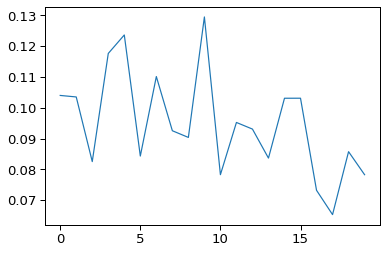

In [94]:
plt.plot(all_losses)

In [102]:
best_idx = np.argmin(all_losses)
best_idx

17

In [103]:
all_cv_scores[best_idx]

{'train_r2': array([0.95133263, 0.95773014, 0.9470466 , 0.77802178, 0.94557515]),
 'validate_r2': array([0.90213952, 0.91391225, 0.89947987, 0.88371077, 0.90454252]),
 'train_rmsd': array([0.0283301 , 0.04034396, 0.04868879, 0.05197057, 0.04890701]),
 'validate_rmsd': array([0.06751325, 0.05830661, 0.06211046, 0.06107021, 0.07774973])}

In [104]:
best_emulator = all_emulators[best_idx]
best_emulator

In [105]:
best_emulator.train(retrain=True)

[INFO] >>> Training model on 80% of the dataset, testing on 20%...
[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0          0.990          0.017          0.110          0.110 *
[INFO]             100          0.989          0.017          0.124          0.109 *
[INFO]             200          0.990          0.017          0.147          0.108 *
[INFO]             300          0.990          0.017          0.025          0.115
[INFO]             400          0.983          0.022          0.064          0.113
[INFO]             500          0.990          0.017          0.057          0.113
[INFO]             600          0.990          0.017          0.104          0.110
[INFO]             700          0.991          0.016          0.077          0.112
[INFO]        

[INFO]            8600          0.991          0.016          0.007          0.116
[INFO]            8700          0.994          0.013          0.082          0.112
[INFO]            8800          0.984          0.021         -0.054          0.120
[INFO]            8900          0.981          0.023         -0.079          0.121
[INFO]            9000          0.993          0.014         -0.035          0.119
[INFO]            9100          0.986          0.020          0.048          0.114
[INFO]            9200          0.984          0.021          0.050          0.114
[INFO]            9300          0.992          0.015          0.067          0.113
[INFO]            9400          0.989          0.017         -0.043          0.119
[INFO]            9500          0.990          0.017         -0.021          0.118
[INFO]            9600          0.990          0.016         -0.016          0.118
[INFO]            9700          0.993          0.014          0.070          0.113
[INF

[INFO]           17500          0.995          0.012         -0.051          0.120
[INFO]           17600          0.983          0.022         -0.106          0.123
[INFO]           17700          0.993          0.014         -0.034          0.119
[INFO]           17800          0.986          0.020          0.130          0.109
[INFO]           17900          0.986          0.020         -0.076          0.121
[INFO]           18000          0.989          0.018         -0.040          0.119
[INFO]           18100          0.995          0.012          0.008          0.116
[INFO]           18200          0.995          0.012         -0.002          0.117
[INFO]           18300          0.994          0.013         -0.054          0.120
[INFO]           18400          0.992          0.015          0.107          0.110
[INFO]           18500          0.992          0.015          0.029          0.115
[INFO]           18600          0.991          0.016         -0.042          0.119
[INF

{'train_r2': 0.9887542756173265,
 'test_r2': 0.22861418590270888,
 'train_rmsd': 0.017675098998330235,
 'test_rmsd': 0.10249456284868932}

In [106]:
# best_emulator.save('emulator_thin_film_BayesNeuralNet')

PicklingError: Can't pickle <class 'olympus.datasets.dataset.Dataset'>: it's not the same object as olympus.datasets.dataset.Dataset

In [5]:
hyperparams = {'batch_size': 50,
 'hidden_act': 'leaky_relu',
 'hidden_depth': 3,
 'hidden_nodes': 48,
 'learning_rate': 0.00040837014384384725,
 'reg': 0.04823041221374773}


model  = BayesNeuralNet(**hyperparams, out_act='relu')
emulator = Emulator(
        dataset='thin_film', model=model, feature_transform='identity', target_transform='normalize',
    )

In [6]:
emulator.train()

[INFO] >>> Training model on 80% of the dataset, testing on 20%...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)
/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)


[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.199          0.266         -1.302          0.297 *
[INFO]             100          0.285          0.152          0.228          0.172 *
[INFO]             200          0.690          0.100          0.624          0.120 *
[INFO]             300          0.690          0.100          0.524          0.135
[INFO]             400          0.730          0.093          0.501          0.138
[INFO]             500          0.736          0.092          0.501          0.138
[INFO]             600          0.749          0.090          0.524          0.135
[INFO]             700          0.733          0.093          0.425          0.148
[INFO]             800          0.761          0.088          0.476          0.14

[INFO]            8500          0.840          0.072          0.622          0.120
[INFO]            8600          0.828          0.074          0.641          0.117 *
[INFO]            8700          0.836          0.073          0.661          0.114 *
[INFO]            8800          0.838          0.072          0.627          0.119
[INFO]            8900          0.837          0.072          0.591          0.125
[INFO]            9000          0.838          0.072          0.580          0.127
[INFO]            9100          0.846          0.070          0.609          0.122
[INFO]            9200          0.832          0.073          0.625          0.120
[INFO]            9300          0.836          0.073          0.634          0.118
[INFO]            9400          0.838          0.072          0.647          0.116
[INFO]            9500          0.851          0.069          0.615          0.121
[INFO]            9600          0.844          0.071          0.628          0.119


[INFO]           17400          0.886          0.060          0.753          0.097
[INFO]           17500          0.887          0.060          0.760          0.096
[INFO]           17600          0.885          0.061          0.738          0.100
[INFO]           17700          0.878          0.063          0.758          0.096
[INFO]           17800          0.883          0.061          0.762          0.095
[INFO]           17900          0.882          0.062          0.751          0.098
[INFO]           18000          0.887          0.060          0.747          0.098
[INFO]           18100          0.884          0.061          0.760          0.096
[INFO]           18200          0.889          0.060          0.741          0.099
[INFO]           18300          0.882          0.062          0.750          0.098
[INFO]           18400          0.882          0.061          0.759          0.096
[INFO]           18500          0.886          0.061          0.723          0.103
[INF

[INFO]           26300          0.901          0.057          0.763          0.095
[INFO]           26400          0.907          0.055          0.749          0.098
[INFO]           26500          0.901          0.056          0.769          0.094
[INFO]           26600          0.902          0.056          0.758          0.096
[INFO]           26700          0.903          0.056          0.763          0.095
[INFO]           26800          0.907          0.055          0.748          0.098
[INFO]           26900          0.899          0.057          0.760          0.096
[INFO]           27000          0.899          0.057          0.759          0.096
[INFO]           27100          0.906          0.055          0.748          0.098
[INFO]           27200          0.904          0.056          0.763          0.095
[INFO]           27300          0.906          0.055          0.761          0.096
[INFO]           27400          0.907          0.055          0.760          0.096
[INF

{'train_r2': 0.8938466315021341,
 'test_r2': 0.790592946226283,
 'train_rmsd': 0.058430068816628,
 'test_rmsd': 0.08946281906872493}

In [9]:
 emulator.save('emulator_thin_film_BayesNeuralNet')

## `dataset_suzuki_i`

In [12]:
search_space = {
    'batch_size': hp.quniform('batch_size', 10, 50, 10),
    'hidden_act': hp.choice('hidden_act', ['leaky_relu'] ),
    'hidden_depth': hp.quniform('hidden_depth', 2, 5, 1),
    'hidden_nodes': hp.quniform('hidden_nodes', 28, 64, 4),
    'learning_rate': hp.uniform('learning_rate', 1e-5, 5e-3),
    'reg': hp.uniform('reg', 0.001, 0.1)
}

int_params = ['batch_size', 'hidden_depth', 'hidden_nodes']

all_emulators = []
all_losses = []
all_cv_scores = []
all_params = []

def objective(params):
    ''' average performance over cross-validation folds '''
    # build emualtor
    print(f'PARAMS : {params}')
    for param, val in params.items():
        if param in int_params:
            params[param] = int(val)
    model  = BayesNeuralNet(
        **params, out_act='sigmoid', 
    )
    emulator = Emulator(
        dataset='suzuki_i', model=model, 
        feature_transform='standardize', target_transform='normalize',
    )

    cv_scores = emulator.cross_validate()
    loss = np.mean(cv_scores['validate_rmsd'])
    
    all_losses.append(loss)
    all_cv_scores.append(cv_scores)
    all_params.append(params)
    all_emulators.append(emulator)
    
    return {'loss': loss, 'status': STATUS_OK}

In [13]:
trials = Trials()

best = fmin(
    fn=objective,
    space=search_space, 
    algo=tpe.suggest, 
    max_evals=20,
    trials=trials
)

print(f"BEST VALUE : {best}")

PARAMS : {'batch_size': 40.0, 'hidden_act': 'leaky_relu', 'hidden_depth': 3.0, 'hidden_nodes': 40.0, 'learning_rate': 1.5543146969685737e-05, 'reg': 0.06661783822168903}                                
  0%|                                                                                                                                                             | 0/20 [00:00<?, ?trial/s, best loss=?][INFO] >>> Training model on fold #0...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.134          0.353         -0.616          0.321 *
[INFO]             100         -0.122          0.351         -0.595          0.320 *
[INFO]             200         -0.106          0.349         -0.588          0.319 *
[INFO]             300         -0.090          0.346         -0.556          0.316 *
[INFO]             400         -0.067          0.343         -0.520          0.312 *
[INFO]             500         -0.049          0.340         -0.488          0.309 *
[INFO]             600         -0.028          0.337         -0.440          0.305 *
[INFO]             700         -0.006          0.333         -0.393          0.300 *
[INFO]             800          0.021          0.329         -0.388    

[INFO]            8500          0.930          0.087          0.421          0.193
[INFO]            8600          0.932          0.086          0.347          0.205
[INFO]            8700          0.933          0.086          0.367          0.201
[INFO]            8800          0.934          0.086          0.437          0.190
[INFO]            8900          0.934          0.085          0.366          0.201
[INFO]            9000          0.936          0.084          0.384          0.199
[INFO]            9100          0.941          0.080          0.333          0.206
[INFO]            9200          0.939          0.082          0.383          0.199
[INFO]            9300          0.945          0.078          0.329          0.207
[INFO]            9400          0.941          0.081          0.384          0.198
[INFO]            9500          0.939          0.082          0.314          0.209
[INFO]            9600          0.938          0.083          0.386          0.197
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.035          0.329         -0.118          0.406 *
[INFO]             100         -0.031          0.329         -0.114          0.405 *
[INFO]             200         -0.020          0.327         -0.105          0.404 *
[INFO]             300         -0.016          0.326         -0.094          0.402 *
[INFO]             400         -0.006          0.325         -0.086          0.401 *
[INFO]             500          0.006          0.323         -0.074          0.398 *
[INFO]             600          0.018          0.321         -0.066          0.397 *
[INFO]             700          0.030          0.320         -0.056          0.396 *
[INFO]             800          0.040          0.318         -0.034    

[INFO]            8400          0.934          0.082          0.887          0.128 *
[INFO]            8500          0.934          0.082          0.870          0.138
[INFO]            8600          0.943          0.077          0.873          0.136
[INFO]            8700          0.940          0.079          0.881          0.132
[INFO]            8800          0.939          0.080          0.871          0.137
[INFO]            8900          0.939          0.080          0.868          0.140
[INFO]            9000          0.942          0.077          0.882          0.132
[INFO]            9100          0.939          0.080          0.873          0.137
[INFO]            9200          0.937          0.082          0.885          0.131
[INFO]            9300          0.940          0.079          0.887          0.128
[INFO]            9400          0.941          0.079          0.871          0.138
[INFO]            9500          0.935          0.082          0.887          0.128
[I

[INFO]           17200          0.955          0.068          0.906          0.118 *
[INFO]           17300          0.954          0.069          0.891          0.127
[INFO]           17400          0.954          0.069          0.899          0.122
[INFO]           17500          0.958          0.066          0.896          0.124
[INFO]           17600          0.957          0.066          0.897          0.123
[INFO]           17700          0.961          0.064          0.898          0.123
[INFO]           17800          0.962          0.063          0.898          0.123
[INFO]           17900          0.964          0.062          0.889          0.128
[INFO]           18000          0.954          0.069          0.901          0.120
[INFO]           18100          0.960          0.064          0.898          0.123
[INFO]           18200          0.962          0.063          0.886          0.130
[INFO]           18300          0.954          0.069          0.897          0.124
[I

[INFO]           26200          0.964          0.061          0.921          0.108 *
[INFO]           26300          0.964          0.061          0.909          0.116
[INFO]           26400          0.964          0.062          0.909          0.116
[INFO]           26500          0.965          0.061          0.900          0.122
[INFO]           26600          0.965          0.060          0.904          0.119
[INFO]           26700          0.964          0.060          0.897          0.124
[INFO]           26800          0.965          0.060          0.904          0.120
[INFO]           26900          0.967          0.059          0.901          0.121
[INFO]           27000          0.966          0.059          0.904          0.119
[INFO]           27100          0.964          0.060          0.896          0.123
[INFO]           27200          0.963          0.062          0.910          0.115
[INFO]           27300          0.967          0.058          0.892          0.126
[I

[INFO]           35200          0.968          0.058          0.902          0.121
[INFO]           35300          0.968          0.057          0.898          0.123
[INFO]           35400          0.968          0.057          0.895          0.126
[INFO]           35500          0.970          0.057          0.883          0.132
[INFO]           35600          0.969          0.057          0.894          0.125
[INFO]           35700          0.967          0.058          0.904          0.120
[INFO]           35800          0.972          0.054          0.884          0.132
[INFO]           35900          0.970          0.055          0.903          0.119
[INFO]           36000          0.972          0.055          0.905          0.120
[INFO]           36100          0.967          0.058          0.905          0.120
[INFO] Training completed in 38.97 seconds.
[INFO] ===========================================================================

[INFO] >>> Training model on fold #2...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.076          0.349         -0.121          0.366 *
[INFO]             100         -0.066          0.347         -0.101          0.363 *
[INFO]             200         -0.057          0.346         -0.081          0.360 *
[INFO]             300         -0.044          0.344         -0.080          0.360 *
[INFO]             400         -0.035          0.342         -0.072          0.358 *
[INFO]             500         -0.028          0.341         -0.050          0.355 *
[INFO]             600         -0.013          0.339         -0.033          0.352 *
[INFO]             700          0.003          0.336         -0.007          0.348 *
[INFO]             800          0.018          0.333         -0.003    

[INFO]            8400          0.867          0.121          0.922          0.096
[INFO]            8500          0.874          0.118          0.934          0.088 *
[INFO]            8600          0.869          0.120          0.924          0.095
[INFO]            8700          0.876          0.117          0.931          0.090
[INFO]            8800          0.871          0.119          0.932          0.090
[INFO]            8900          0.869          0.120          0.941          0.085 *
[INFO]            9000          0.879          0.116          0.933          0.090
[INFO]            9100          0.877          0.117          0.930          0.092
[INFO]            9200          0.883          0.114          0.923          0.096
[INFO]            9300          0.884          0.113          0.930          0.092
[INFO]            9400          0.888          0.112          0.937          0.087
[INFO]            9500          0.898          0.106          0.933          0.089


[INFO]           17200          0.950          0.075          0.945          0.077
[INFO]           17300          0.949          0.076          0.953          0.072
[INFO]           17400          0.950          0.075          0.951          0.074
[INFO]           17500          0.951          0.074          0.944          0.079
[INFO]           17600          0.954          0.072          0.963          0.066 *
[INFO]           17700          0.952          0.073          0.948          0.077
[INFO]           17800          0.955          0.071          0.945          0.078
[INFO]           17900          0.952          0.074          0.960          0.067
[INFO]           18000          0.955          0.072          0.954          0.073
[INFO]           18100          0.955          0.071          0.957          0.071
[INFO]           18200          0.953          0.073          0.950          0.075
[INFO]           18300          0.951          0.074          0.952          0.073
[I

[INFO]           34800          0.965          0.063          0.977          0.052
[INFO]           34900          0.966          0.062          0.974          0.054
[INFO]           35000          0.967          0.061          0.973          0.055
[INFO]           35100          0.964          0.063          0.970          0.058
[INFO]           35200          0.969          0.059          0.969          0.058
[INFO]           35300          0.964          0.064          0.969          0.059
[INFO]           35400          0.968          0.061          0.963          0.063
[INFO]           35500          0.966          0.062          0.972          0.056
[INFO]           35600          0.965          0.063          0.968          0.060
[INFO]           35700          0.962          0.065          0.966          0.062
[INFO]           35800          0.964          0.063          0.950          0.075
[INFO]           35900          0.963          0.064          0.960          0.067
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.275          0.359         -0.031          0.338 *
[INFO]             100         -0.261          0.357         -0.026          0.337 *
[INFO]             200         -0.244          0.355         -0.019          0.336 *
[INFO]             300         -0.226          0.353         -0.014          0.335 *
[INFO]             400         -0.210          0.350         -0.008          0.334 *
[INFO]             500         -0.191          0.348         -0.005          0.334 *
[INFO]             600         -0.174          0.346         -0.001          0.333 *
[INFO]             700         -0.155          0.343          0.005          0.332 *
[INFO]             800         -0.138          0.341          0.016    

[INFO]            8300          0.883          0.106          0.915          0.097 *
[INFO]            8400          0.897          0.099          0.907          0.102
[INFO]            8500          0.899          0.098          0.907          0.101
[INFO]            8600          0.894          0.100          0.910          0.100
[INFO]            8700          0.891          0.102          0.918          0.096 *
[INFO]            8800          0.902          0.096          0.914          0.098
[INFO]            8900          0.902          0.096          0.917          0.096 *
[INFO]            9000          0.904          0.096          0.908          0.101
[INFO]            9100          0.906          0.095          0.912          0.099
[INFO]            9200          0.909          0.093          0.920          0.094 *
[INFO]            9300          0.905          0.095          0.912          0.099
[INFO]            9400          0.904          0.096          0.919          0.

[INFO]           17000          0.965          0.059          0.920          0.094
[INFO]           17100          0.963          0.060          0.931          0.088
[INFO]           17200          0.965          0.059          0.931          0.087
[INFO]           17300          0.970          0.054          0.923          0.092
[INFO]           17400          0.964          0.059          0.923          0.092
[INFO]           17500          0.963          0.060          0.933          0.086
[INFO]           17600          0.964          0.059          0.935          0.085
[INFO]           17700          0.966          0.057          0.926          0.091
[INFO]           17800          0.967          0.057          0.916          0.096
[INFO]           17900          0.967          0.057          0.922          0.092
[INFO]           18000          0.967          0.057          0.919          0.095
[INFO]           18100          0.963          0.060          0.934          0.085
[INF

[INFO]           26000          0.971          0.053          0.926          0.091
[INFO] Training completed in 29.38 seconds.
[INFO] ===========================================================================

[INFO] >>> Training model on fold #4...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.221          0.372         -0.102          0.302 *
[INFO]             100         -0.196          0.368         -0.093          0.301 *
[INFO]             200         -0.187          0.367         -0.075          0.299 *
[INFO]             300         -0.162          0.363         -0.064          0.298 *
[INFO]             400         -0.151          0.361         -0.064          0.298
[INFO]             500         -0.129          0.358         -0.042          0.295 *
[INFO]             600         -0.096          0.352         -0.016          0.291 *
[INFO]             700         -0.072          0.349          0.006          0.288 *
[INFO]             800         -0.044          0.344          0.027      

[INFO]            8400          0.941          0.082          0.568          0.188
[INFO]            8500          0.945          0.079          0.584          0.183 *
[INFO]            8600          0.941          0.082          0.578          0.184
[INFO]            8700          0.950          0.076          0.602          0.179 *
[INFO]            8800          0.944          0.079          0.585          0.183
[INFO]            8900          0.944          0.080          0.598          0.180
[INFO]            9000          0.947          0.077          0.564          0.188
[INFO]            9100          0.944          0.079          0.618          0.176 *
[INFO]            9200          0.947          0.078          0.594          0.181
[INFO]            9300          0.949          0.076          0.600          0.179
[INFO]            9400          0.951          0.075          0.613          0.177
[INFO]            9500          0.948          0.077          0.599          0.18

[INFO]           17200          0.961          0.066          0.702          0.155
[INFO]           17300          0.962          0.066          0.716          0.151
[INFO]           17400          0.965          0.063          0.711          0.152
[INFO]           17500          0.964          0.064          0.702          0.155
[INFO]           17600          0.961          0.066          0.737          0.146 *
[INFO]           17700          0.965          0.063          0.690          0.158
[INFO]           17800          0.965          0.063          0.703          0.155
[INFO]           17900          0.961          0.066          0.710          0.153
[INFO]           18000          0.961          0.066          0.741          0.144 *
[INFO]           18100          0.964          0.064          0.720          0.150
[INFO]           18200          0.966          0.062          0.720          0.151
[INFO]           18300          0.964          0.064          0.725          0.149


[INFO]           25900          0.972          0.056          0.729          0.149
[INFO]           26000          0.969          0.059          0.754          0.141
[INFO]           26100          0.972          0.056          0.765          0.138
[INFO]           26200          0.971          0.057          0.757          0.141
[INFO]           26300          0.966          0.062          0.750          0.143
[INFO]           26400          0.974          0.055          0.768          0.137
[INFO]           26500          0.973          0.056          0.723          0.149
[INFO]           26600          0.971          0.058          0.758          0.140
[INFO]           26700          0.973          0.056          0.757          0.140
[INFO]           26800          0.967          0.061          0.768          0.137
[INFO]           26900          0.972          0.056          0.753          0.141
[INFO]           27000          0.971          0.058          0.771          0.136
[INF

[INFO]           34900          0.977          0.051          0.761          0.139
[INFO]           35000          0.975          0.053          0.774          0.135
[INFO]           35100          0.974          0.054          0.774          0.135
[INFO]           35200          0.977          0.052          0.727          0.149
[INFO]           35300          0.977          0.051          0.759          0.139
[INFO]           35400          0.977          0.051          0.778          0.134
[INFO]           35500          0.973          0.056          0.762          0.139
[INFO]           35600          0.977          0.052          0.760          0.140
[INFO]           35700          0.973          0.055          0.777          0.134
[INFO]           35800          0.973          0.056          0.761          0.140
[INFO]           35900          0.974          0.054          0.754          0.142
[INFO]           36000          0.974          0.054          0.767          0.138
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.197          0.357         -0.008          0.281 *
[INFO]             100          0.966          0.059          0.656          0.162 *
[INFO]             200          0.964          0.061          0.735          0.143 *
[INFO]             300          0.948          0.074          0.734          0.142 *
[INFO]             400          0.959          0.065          0.703          0.151
[INFO]             500          0.929          0.086          0.652          0.164
[INFO]             600          0.894          0.106          0.588          0.178
[INFO]             700          0.925          0.092          0.712          0.150
[INFO]             800          0.935          0.082          0.570          0.

[INFO]            8600          0.992          0.028          0.700          0.153
[INFO]            8700          0.992          0.028          0.692          0.154
[INFO]            8800          0.989          0.033          0.734          0.143
[INFO]            8900          0.992          0.029          0.716          0.148
[INFO]            9000          0.991          0.030          0.720          0.146
[INFO]            9100          0.991          0.030          0.747          0.140 *
[INFO]            9200          0.991          0.030          0.735          0.143
[INFO]            9300          0.991          0.030          0.726          0.144
[INFO]            9400          0.992          0.029          0.718          0.147
[INFO]            9500          0.993          0.027          0.714          0.149
[INFO]            9600          0.991          0.030          0.705          0.151
[INFO]            9700          0.993          0.028          0.708          0.150
[I

[INFO]           17500          0.993          0.028          0.742          0.141
[INFO]           17600          0.992          0.028          0.780          0.130 *
[INFO]           17700          0.993          0.027          0.757          0.137
[INFO]           17800          0.992          0.028          0.753          0.138
[INFO]           17900          0.992          0.029          0.763          0.135
[INFO]           18000          0.992          0.028          0.767          0.134
[INFO]           18100          0.993          0.026          0.751          0.139
[INFO]           18200          0.993          0.027          0.736          0.143
[INFO]           18300          0.992          0.028          0.780          0.130
[INFO]           18400          0.993          0.027          0.741          0.141
[INFO]           18500          0.992          0.029          0.766          0.134
[INFO]           18600          0.993          0.027          0.757          0.137
[I

[INFO]           26400          0.993          0.027          0.738          0.141
[INFO]           26500          0.992          0.028          0.715          0.147
[INFO]           26600          0.993          0.027          0.758          0.136
[INFO]           26700          0.993          0.027          0.766          0.134
[INFO]           26800          0.994          0.026          0.725          0.144
[INFO]           26900          0.993          0.027          0.704          0.150
[INFO]           27000          0.993          0.027          0.751          0.138
[INFO]           27100          0.993          0.028          0.767          0.133
[INFO]           27200          0.992          0.028          0.720          0.146
[INFO]           27300          0.993          0.027          0.730          0.143
[INFO]           27400          0.993          0.027          0.711          0.149
[INFO]           27500          0.992          0.028          0.715          0.147
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.192          0.254         -0.523          0.347 *
[INFO]             100          0.764          0.113          0.878          0.097 *
[INFO]             200          0.868          0.084          0.767          0.143
[INFO]             300          0.872          0.083          0.784          0.134
[INFO]             400          0.878          0.081          0.842          0.113
[INFO]             500          0.728          0.121          0.775          0.141
[INFO]             600          0.802          0.103          0.704          0.163
[INFO]             700          0.794          0.106          0.724          0.152
[INFO]             800          0.849          0.090          0.703          0.161


[INFO]            8500          0.970          0.040          0.781          0.142
[INFO]            8600          0.968          0.042          0.783          0.142
[INFO]            8700          0.972          0.039          0.779          0.144
[INFO]            8800          0.939          0.057          0.743          0.153
[INFO]            8900          0.969          0.041          0.768          0.147
[INFO]            9000          0.972          0.039          0.774          0.145
[INFO]            9100          0.975          0.036          0.774          0.146
[INFO]            9200          0.960          0.047          0.775          0.145
[INFO]            9300          0.976          0.036          0.768          0.148
[INFO]            9400          0.980          0.033          0.772          0.147
[INFO]            9500          0.976          0.036          0.775          0.145
[INFO]            9600          0.978          0.034          0.778          0.144
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0          0.009          0.327          0.018          0.352 *
[INFO]             100          0.935          0.082          0.899          0.113 *
[INFO]             200          0.926          0.087          0.843          0.140
[INFO]             300          0.947          0.074          0.883          0.121
[INFO]             400          0.891          0.105          0.826          0.147
[INFO]             500          0.912          0.095          0.867          0.129
[INFO]             600          0.931          0.087          0.821          0.151
[INFO]             700          0.894          0.106          0.808          0.156
[INFO]             800          0.931          0.086          0.851          0.137


[INFO]            8500          0.990          0.033          0.857          0.135
[INFO]            8600          0.990          0.034          0.862          0.133
[INFO]            8700          0.992          0.030          0.839          0.144
[INFO]            8800          0.989          0.035          0.851          0.138
[INFO]            8900          0.990          0.033          0.870          0.129
[INFO]            9000          0.991          0.032          0.843          0.142
[INFO]            9100          0.991          0.032          0.858          0.135
[INFO]            9200          0.990          0.033          0.852          0.138
[INFO]            9300          0.990          0.032          0.852          0.138
[INFO]            9400          0.990          0.033          0.863          0.132
[INFO]            9500          0.992          0.029          0.848          0.140
[INFO]            9600          0.990          0.032          0.859          0.135
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0          0.005          0.325         -0.042          0.344 *
[INFO]             100          0.957          0.069          0.900          0.108 *
[INFO]             200          0.959          0.066          0.920          0.097 *
[INFO]             300          0.965          0.061          0.918          0.099
[INFO]             400          0.941          0.078          0.867          0.127
[INFO]             500          0.946          0.074          0.879          0.122
[INFO]             600          0.967          0.059          0.845          0.137
[INFO]             700          0.947          0.077          0.813          0.151
[INFO]             800          0.940          0.079          0.864          0.12

[INFO]            8600          0.989          0.035          0.782          0.160
[INFO]            8700          0.987          0.038          0.758          0.169
[INFO]            8800          0.989          0.034          0.762          0.168
[INFO]            8900          0.987          0.037          0.780          0.162
[INFO]            9000          0.990          0.033          0.778          0.163
[INFO]            9100          0.988          0.035          0.760          0.168
[INFO]            9200          0.990          0.034          0.771          0.165
[INFO]            9300          0.989          0.035          0.761          0.168
[INFO]            9400          0.987          0.038          0.748          0.172
[INFO]            9500          0.989          0.035          0.758          0.169
[INFO]            9600          0.988          0.035          0.785          0.160
[INFO]            9700          0.989          0.034          0.782          0.161
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0          0.010          0.321         -0.156          0.321 *
[INFO]             100          0.929          0.086          0.941          0.072 *
[INFO]             200          0.927          0.087          0.784          0.137
[INFO]             300          0.915          0.093          0.853          0.108
[INFO]             400          0.948          0.074          0.906          0.087
[INFO]             500          0.922          0.090          0.916          0.085
[INFO]             600          0.882          0.110          0.923          0.085
[INFO]             700          0.925          0.088          0.896          0.098
[INFO]             800          0.937          0.081          0.858          0.106


[INFO]            8600          0.990          0.033          0.954          0.061
[INFO]            8700          0.991          0.031          0.953          0.065
[INFO]            8800          0.988          0.035          0.941          0.070
[INFO]            8900          0.987          0.037          0.950          0.065
[INFO]            9000          0.991          0.031          0.945          0.070
[INFO]            9100          0.990          0.033          0.956          0.061
[INFO]            9200          0.987          0.037          0.941          0.070
[INFO]            9300          0.990          0.033          0.936          0.073
[INFO]            9400          0.989          0.034          0.944          0.068
[INFO]            9500          0.991          0.030          0.936          0.073
[INFO]            9600          0.986          0.038          0.938          0.070
[INFO]            9700          0.989          0.033          0.940          0.071
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.453          0.355         -0.094          0.307 *
[INFO]             100          0.043          0.297          0.132          0.275 *
[INFO]             200          0.520          0.217          0.429          0.223 *
[INFO]             300          0.785          0.145          0.706          0.159 *
[INFO]             400          0.911          0.090          0.736          0.149 *
[INFO]             500          0.942          0.072          0.782          0.136 *
[INFO]             600          0.954          0.063          0.777          0.138
[INFO]             700          0.957          0.061          0.784          0.136
[INFO]             800          0.961          0.059          0.744        

[INFO]            8600          0.968          0.056          0.758          0.144
[INFO]            8700          0.977          0.048          0.725          0.153
[INFO]            8800          0.971          0.053          0.786          0.136
[INFO]            8900          0.968          0.056          0.799          0.132
[INFO]            9000          0.973          0.050          0.746          0.148
[INFO]            9100          0.964          0.058          0.723          0.153
[INFO]            9200          0.974          0.051          0.763          0.143
[INFO]            9300          0.968          0.055          0.749          0.147
[INFO]            9400          0.974          0.050          0.736          0.150
[INFO]            9500          0.972          0.052          0.785          0.136
[INFO]            9600          0.967          0.056          0.726          0.153
[INFO]            9700          0.965          0.059          0.756          0.144
[INF

[INFO]           17500          0.982          0.041          0.808          0.129
[INFO]           17600          0.981          0.042          0.784          0.137
[INFO]           17700          0.980          0.045          0.799          0.132
[INFO]           17800          0.979          0.046          0.820          0.125 *
[INFO]           17900          0.975          0.049          0.794          0.133
[INFO]           18000          0.979          0.043          0.804          0.130
[INFO]           18100          0.981          0.043          0.790          0.135
[INFO]           18200          0.975          0.049          0.792          0.133
[INFO]           18300          0.980          0.044          0.810          0.128
[INFO]           18400          0.977          0.048          0.816          0.126
[INFO]           18500          0.982          0.041          0.771          0.141
[INFO]           18600          0.979          0.045          0.803          0.131
[I

[INFO]           26300          0.988          0.034          0.802          0.131
[INFO]           26400          0.985          0.038          0.801          0.132
[INFO]           26500          0.985          0.037          0.804          0.130
[INFO]           26600          0.989          0.034          0.790          0.135
[INFO]           26700          0.986          0.037          0.785          0.137
[INFO]           26800          0.985          0.037          0.798          0.133
[INFO]           26900          0.986          0.036          0.782          0.138
[INFO]           27000          0.988          0.034          0.787          0.136
[INFO]           27100          0.987          0.036          0.791          0.135
[INFO]           27200          0.987          0.036          0.798          0.133
[INFO]           27300          0.985          0.038          0.791          0.135
[INFO]           27400          0.989          0.033          0.796          0.133
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.043          0.303         -0.104          0.309 *
[INFO]             100          0.105          0.281          0.168          0.270 *
[INFO]             200          0.467          0.216          0.575          0.195 *
[INFO]             300          0.743          0.151          0.849          0.118 *
[INFO]             400          0.826          0.124          0.918          0.086 *
[INFO]             500          0.828          0.123          0.923          0.083 *
[INFO]             600          0.887          0.100          0.927          0.082 *
[INFO]             700          0.887          0.100          0.952          0.065 *
[INFO]             800          0.905          0.092          0.953    

[INFO]            8400          0.942          0.071          0.964          0.057
[INFO]            8500          0.937          0.074          0.948          0.069
[INFO]            8600          0.945          0.069          0.955          0.064
[INFO]            8700          0.957          0.062          0.946          0.070
[INFO]            8800          0.930          0.078          0.951          0.067
[INFO]            8900          0.940          0.073          0.958          0.063
[INFO]            9000          0.950          0.066          0.953          0.065
[INFO]            9100          0.941          0.072          0.962          0.059
[INFO]            9200          0.950          0.067          0.934          0.078
[INFO]            9300          0.932          0.077          0.960          0.060
[INFO]            9400          0.933          0.077          0.961          0.060
[INFO]            9500          0.942          0.071          0.945          0.070
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.102          0.305         -0.142          0.309 *
[INFO]             100          0.117          0.273          0.182          0.266 *
[INFO]             200          0.462          0.213          0.546          0.199 *
[INFO]             300          0.668          0.168          0.689          0.163 *
[INFO]             400          0.769          0.140          0.745          0.148 *
[INFO]             500          0.842          0.116          0.828          0.122 *
[INFO]             600          0.843          0.116          0.840          0.117 *
[INFO]             700          0.864          0.107          0.868          0.107 *
[INFO]             800          0.869          0.106          0.898    

[INFO]            8600          0.928          0.078          0.872          0.107
[INFO]            8700          0.936          0.073          0.855          0.113
[INFO]            8800          0.932          0.076          0.876          0.104
[INFO]            8900          0.931          0.076          0.869          0.106
[INFO]            9000          0.929          0.077          0.873          0.106
[INFO]            9100          0.928          0.078          0.851          0.115
[INFO]            9200          0.935          0.074          0.818          0.126
[INFO]            9300          0.939          0.072          0.829          0.124
[INFO]            9400          0.929          0.078          0.839          0.121
[INFO]            9500          0.924          0.080          0.801          0.134
[INFO]            9600          0.945          0.068          0.804          0.134
[INFO]            9700          0.926          0.080          0.817          0.128
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.438          0.356         -0.300          0.416 *
[INFO]             100         -0.336          0.282          0.058          0.352 *
[INFO]             200          0.605          0.167          0.635          0.220 *
[INFO]             300          0.835          0.107          0.793          0.166 *
[INFO]             400          0.855          0.096          0.823          0.153 *
[INFO]             500          0.887          0.085          0.864          0.134 *
[INFO]             600          0.902          0.078          0.869          0.131 *
[INFO]             700          0.913          0.072          0.890          0.120 *
[INFO]             800          0.917          0.071          0.888    

[INFO]            8500          0.951          0.056          0.919          0.102
[INFO]            8600          0.952          0.060          0.924          0.100
[INFO]            8700          0.940          0.061          0.922          0.101
[INFO]            8800          0.957          0.054          0.928          0.096
[INFO]            8900          0.940          0.057          0.933          0.094
[INFO]            9000          0.933          0.064          0.922          0.100
[INFO]            9100          0.945          0.058          0.925          0.100
[INFO]            9200          0.952          0.058          0.922          0.101
[INFO]            9300          0.933          0.064          0.932          0.094
[INFO]            9400          0.935          0.061          0.920          0.102
[INFO]            9500          0.963          0.049          0.944          0.086 *
[INFO]            9600          0.945          0.058          0.900          0.113
[I

[INFO]           17500          0.962          0.048          0.930          0.097
[INFO]           17600          0.973          0.043          0.943          0.086
[INFO]           17700          0.966          0.047          0.935          0.092
[INFO]           17800          0.965          0.047          0.952          0.079
[INFO]           17900          0.967          0.046          0.928          0.097
[INFO]           18000          0.966          0.047          0.930          0.095
[INFO]           18100          0.965          0.046          0.946          0.084
[INFO]           18200          0.966          0.049          0.949          0.082
[INFO]           18300          0.969          0.044          0.941          0.088
[INFO]           18400          0.965          0.045          0.929          0.096
[INFO]           18500          0.962          0.049          0.931          0.095
[INFO]           18600          0.964          0.047          0.933          0.094
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.108          0.334         -0.344          0.309 *
[INFO]             100          0.149          0.294          0.059          0.272 *
[INFO]             200          0.471          0.231          0.387          0.220 *
[INFO]             300          0.776          0.149          0.592          0.167 *
[INFO]             400          0.889          0.105          0.638          0.158 *
[INFO]             500          0.924          0.087          0.699          0.144 *
[INFO]             600          0.932          0.083          0.653          0.153
[INFO]             700          0.947          0.073          0.658          0.148
[INFO]             800          0.952          0.070          0.733        

[INFO]            8600          0.966          0.059          0.798          0.121
[INFO]            8700          0.958          0.065          0.774          0.120
[INFO]            8800          0.972          0.053          0.741          0.133
[INFO]            8900          0.974          0.052          0.841          0.107
[INFO]            9000          0.966          0.059          0.756          0.130
[INFO]            9100          0.975          0.050          0.804          0.118
[INFO]            9200          0.972          0.053          0.779          0.128
[INFO]            9300          0.961          0.063          0.810          0.115
[INFO]            9400          0.972          0.054          0.806          0.116
[INFO]            9500          0.969          0.056          0.821          0.111
[INFO]            9600          0.963          0.062          0.828          0.110
[INFO]            9700          0.953          0.070          0.824          0.113
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0          0.008          0.329         -0.392          0.366 *
[INFO]             100          0.959          0.067          0.897          0.101 *
[INFO]             200          0.950          0.074          0.902          0.098 *
[INFO]             300          0.959          0.067          0.884          0.107
[INFO]             400          0.959          0.067          0.909          0.095 *
[INFO]             500          0.966          0.061          0.913          0.092 *
[INFO]             600          0.954          0.071          0.894          0.101
[INFO]             700          0.967          0.060          0.916          0.091 *
[INFO]             800          0.957          0.068          0.938        

[INFO]            8400          0.983          0.042          0.808          0.136
[INFO]            8500          0.981          0.046          0.844          0.123
[INFO]            8600          0.983          0.043          0.816          0.133
[INFO]            8700          0.977          0.050          0.776          0.146
[INFO]            8800          0.979          0.048          0.806          0.137
[INFO]            8900          0.983          0.043          0.799          0.139
[INFO]            9000          0.982          0.044          0.799          0.139
[INFO]            9100          0.981          0.045          0.789          0.142
[INFO]            9200          0.980          0.046          0.788          0.143
[INFO]            9300          0.980          0.046          0.804          0.138
[INFO]            9400          0.984          0.042          0.769          0.149
[INFO]            9500          0.982          0.044          0.776          0.147
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.115          0.346         -1.046          0.368 *
[INFO]             100          0.962          0.066          0.840          0.119 *
[INFO]             200          0.974          0.054          0.868          0.108 *
[INFO]             300          0.973          0.054          0.884          0.101 *
[INFO]             400          0.968          0.059          0.861          0.110
[INFO]             500          0.969          0.057          0.852          0.116
[INFO]             600          0.969          0.058          0.835          0.121
[INFO]             700          0.977          0.051          0.812          0.127
[INFO]             800          0.981          0.045          0.876          0.

[INFO]            8600          0.992          0.029          0.745          0.145
[INFO]            8700          0.989          0.034          0.770          0.139
[INFO]            8800          0.992          0.031          0.760          0.142
[INFO]            8900          0.992          0.029          0.753          0.143
[INFO]            9000          0.993          0.028          0.751          0.143
[INFO]            9100          0.989          0.034          0.761          0.141
[INFO]            9200          0.992          0.029          0.756          0.141
[INFO]            9300          0.993          0.028          0.765          0.139
[INFO]            9400          0.993          0.029          0.749          0.143
[INFO]            9500          0.993          0.029          0.741          0.145
[INFO]            9600          0.988          0.036          0.747          0.144
[INFO]            9700          0.992          0.029          0.753          0.142
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.009          0.329         -0.269          0.273 *
[INFO]             100          0.960          0.068          0.752          0.113 *
[INFO]             200          0.965          0.062          0.771          0.105 *
[INFO]             300          0.968          0.061          0.772          0.108
[INFO]             400          0.966          0.062          0.784          0.107
[INFO]             500          0.968          0.060          0.751          0.112
[INFO]             600          0.968          0.061          0.777          0.107
[INFO]             700          0.974          0.054          0.766          0.106
[INFO]             800          0.966          0.063          0.719          0.11

[INFO]            8500          0.989          0.036          0.650          0.136
[INFO]            8600          0.990          0.033          0.670          0.131
[INFO]            8700          0.988          0.037          0.665          0.132
[INFO]            8800          0.991          0.032          0.649          0.135
[INFO]            8900          0.989          0.035          0.659          0.133
[INFO]            9000          0.991          0.032          0.621          0.140
[INFO]            9100          0.991          0.032          0.636          0.138
[INFO]            9200          0.992          0.031          0.639          0.138
[INFO]            9300          0.991          0.032          0.657          0.133
[INFO]            9400          0.989          0.035          0.677          0.130
[INFO]            9500          0.989          0.036          0.606          0.143
[INFO]            9600          0.991          0.032          0.639          0.137
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.023          0.302         -0.070          0.308 *
[INFO]             100          0.966          0.056          0.854          0.114 *
[INFO]             200          0.972          0.050          0.896          0.096 *
[INFO]             300          0.976          0.047          0.877          0.104
[INFO]             400          0.975          0.047          0.870          0.107
[INFO]             500          0.980          0.043          0.861          0.111
[INFO]             600          0.982          0.041          0.858          0.112
[INFO]             700          0.979          0.043          0.861          0.111
[INFO]             800          0.982          0.040          0.876          0.10

[INFO]            8600          0.994          0.023          0.754          0.147
[INFO]            8700          0.992          0.026          0.760          0.146
[INFO]            8800          0.995          0.022          0.772          0.142
[INFO]            8900          0.995          0.022          0.760          0.146
[INFO]            9000          0.995          0.021          0.765          0.144
[INFO]            9100          0.995          0.022          0.750          0.149
[INFO]            9200          0.993          0.024          0.756          0.147
[INFO]            9300          0.995          0.021          0.767          0.144
[INFO]            9400          0.994          0.023          0.742          0.151
[INFO]            9500          0.994          0.023          0.731          0.154
[INFO]            9600          0.994          0.022          0.742          0.151
[INFO]            9700          0.995          0.021          0.738          0.152
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.180          0.330          0.061          0.355 *
[INFO]             100          0.968          0.054          0.953          0.080 *
[INFO]             200          0.981          0.043          0.963          0.070 *
[INFO]             300          0.977          0.046          0.942          0.088
[INFO]             400          0.981          0.043          0.957          0.076
[INFO]             500          0.979          0.044          0.967          0.066 *
[INFO]             600          0.978          0.044          0.939          0.090
[INFO]             700          0.979          0.045          0.951          0.081
[INFO]             800          0.982          0.041          0.961          0.

[INFO]            8500          0.988          0.033          0.905          0.113
[INFO]            8600          0.989          0.031          0.903          0.114
[INFO]            8700          0.989          0.032          0.902          0.115
[INFO]            8800          0.989          0.031          0.904          0.113
[INFO]            8900          0.989          0.032          0.902          0.115
[INFO]            9000          0.988          0.032          0.902          0.115
[INFO]            9100          0.988          0.033          0.900          0.116
[INFO]            9200          0.989          0.032          0.906          0.113
[INFO]            9300          0.988          0.033          0.903          0.114
[INFO]            9400          0.989          0.032          0.899          0.116
[INFO]            9500          0.989          0.032          0.899          0.117
[INFO]            9600          0.988          0.033          0.897          0.118
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.020          0.350         -0.087          0.316 *
[INFO]             100          0.957          0.072          0.791          0.133 *
[INFO]             200          0.969          0.061          0.814          0.125 *
[INFO]             300          0.965          0.065          0.860          0.111 *
[INFO]             400          0.964          0.066          0.846          0.116
[INFO]             500          0.959          0.069          0.813          0.127
[INFO]             600          0.970          0.059          0.851          0.112
[INFO]             700          0.960          0.069          0.836          0.119
[INFO]             800          0.975          0.054          0.892          0.

[INFO]            8600          0.983          0.045          0.715          0.146
[INFO]            8700          0.982          0.046          0.706          0.148
[INFO]            8800          0.982          0.046          0.707          0.148
[INFO]            8900          0.980          0.049          0.704          0.148
[INFO]            9000          0.982          0.046          0.715          0.146
[INFO]            9100          0.983          0.045          0.692          0.151
[INFO]            9200          0.981          0.048          0.716          0.145
[INFO]            9300          0.981          0.048          0.696          0.151
[INFO]            9400          0.983          0.046          0.725          0.143
[INFO]            9500          0.980          0.048          0.698          0.150
[INFO]            9600          0.979          0.050          0.709          0.147
[INFO]            9700          0.979          0.050          0.699          0.150
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.089          0.341         -0.038          0.305 *
[INFO]             100          0.976          0.053          0.877          0.105 *
[INFO]             200          0.977          0.050          0.880          0.104 *
[INFO]             300          0.976          0.052          0.904          0.093 *
[INFO]             400          0.961          0.067          0.914          0.088 *
[INFO]             500          0.962          0.063          0.842          0.118
[INFO]             600          0.962          0.064          0.850          0.116
[INFO]             700          0.964          0.063          0.877          0.104
[INFO]             800          0.971          0.056          0.852          

[INFO]            8500          0.994          0.024          0.776          0.141
[INFO]            8600          0.993          0.026          0.775          0.141
[INFO]            8700          0.995          0.024          0.778          0.140
[INFO]            8800          0.995          0.024          0.780          0.140
[INFO]            8900          0.995          0.022          0.774          0.141
[INFO]            9000          0.995          0.024          0.768          0.143
[INFO]            9100          0.994          0.025          0.787          0.137
[INFO]            9200          0.994          0.025          0.788          0.137
[INFO]            9300          0.995          0.022          0.760          0.146
[INFO]            9400          0.992          0.028          0.763          0.145
[INFO]            9500          0.992          0.030          0.792          0.136
[INFO]            9600          0.994          0.024          0.767          0.144
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.107          0.316         -0.171          0.320 *
[INFO]             100          0.957          0.063          0.819          0.126 *
[INFO]             200          0.964          0.059          0.865          0.111 *
[INFO]             300          0.962          0.060          0.875          0.108 *
[INFO]             400          0.955          0.064          0.867          0.109
[INFO]             500          0.942          0.071          0.861          0.111
[INFO]             600          0.955          0.064          0.853          0.118
[INFO]             700          0.962          0.060          0.881          0.105 *
[INFO]             800          0.945          0.070          0.854          

[INFO]            8500          0.981          0.042          0.776          0.140
[INFO]            8600          0.980          0.044          0.779          0.138
[INFO]            8700          0.977          0.046          0.760          0.143
[INFO]            8800          0.980          0.043          0.771          0.141
[INFO]            8900          0.980          0.043          0.774          0.140
[INFO]            9000          0.977          0.046          0.744          0.148
[INFO]            9100          0.975          0.048          0.752          0.146
[INFO]            9200          0.981          0.043          0.778          0.139
[INFO]            9300          0.972          0.051          0.766          0.142
[INFO]            9400          0.975          0.049          0.780          0.138
[INFO]            9500          0.979          0.044          0.770          0.140
[INFO]            9600          0.979          0.045          0.781          0.139
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.391          0.331         -0.020          0.355 *
[INFO]             100          0.928          0.076          0.851          0.137 *
[INFO]             200          0.945          0.067          0.859          0.133 *
[INFO]             300          0.946          0.068          0.865          0.128 *
[INFO]             400          0.934          0.074          0.877          0.123 *
[INFO]             500          0.944          0.067          0.882          0.122 *
[INFO]             600          0.930          0.077          0.864          0.131
[INFO]             700          0.932          0.074          0.884          0.121 *
[INFO]             800          0.957          0.059          0.892      

[INFO]            8400          0.994          0.022          0.924          0.097
[INFO]            8500          0.991          0.027          0.943          0.085 *
[INFO]            8600          0.994          0.021          0.916          0.102
[INFO]            8700          0.994          0.021          0.914          0.103
[INFO]            8800          0.995          0.020          0.920          0.099
[INFO]            8900          0.994          0.020          0.913          0.103
[INFO]            9000          0.995          0.019          0.904          0.108
[INFO]            9100          0.994          0.021          0.906          0.107
[INFO]            9200          0.989          0.028          0.915          0.102
[INFO]            9300          0.993          0.023          0.890          0.115
[INFO]            9400          0.996          0.018          0.893          0.114
[INFO]            9500          0.994          0.021          0.889          0.116
[I

[INFO]           17300          0.996          0.018          0.759          0.170
[INFO]           17400          0.994          0.021          0.735          0.178
[INFO]           17500          0.994          0.022          0.753          0.172
[INFO]           17600          0.994          0.022          0.735          0.178
[INFO]           17700          0.995          0.019          0.741          0.176
[INFO]           17800          0.994          0.022          0.727          0.180
[INFO]           17900          0.995          0.020          0.718          0.183
[INFO]           18000          0.993          0.023          0.729          0.180
[INFO]           18100          0.995          0.020          0.706          0.187
[INFO]           18200          0.993          0.023          0.726          0.181
[INFO]           18300          0.995          0.019          0.741          0.176
[INFO]           18400          0.993          0.023          0.683          0.194
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.106          0.286         -0.422          0.372 *
[INFO]             100          0.932          0.071          0.922          0.090 *
[INFO]             200          0.930          0.073          0.878          0.113
[INFO]             300          0.944          0.066          0.903          0.102
[INFO]             400          0.929          0.072          0.827          0.129
[INFO]             500          0.924          0.076          0.923          0.091
[INFO]             600          0.921          0.076          0.942          0.078 *
[INFO]             700          0.932          0.070          0.921          0.095
[INFO]             800          0.938          0.067          0.924          0.09

[INFO]            8600          0.992          0.025          0.940          0.080
[INFO]            8700          0.990          0.028          0.941          0.079
[INFO]            8800          0.988          0.030          0.934          0.082
[INFO]            8900          0.991          0.026          0.939          0.080
[INFO]            9000          0.990          0.028          0.932          0.085
[INFO]            9100          0.990          0.027          0.943          0.077
[INFO]            9200          0.989          0.028          0.933          0.084
[INFO]            9300          0.990          0.028          0.932          0.086
[INFO]            9400          0.990          0.028          0.933          0.084
[INFO]            9500          0.991          0.026          0.931          0.086
[INFO]            9600          0.985          0.034          0.946          0.076
[INFO]            9700          0.991          0.025          0.942          0.078
[INF

[INFO]           17400          0.988          0.030          0.946          0.074
[INFO]           17500          0.989          0.029          0.947          0.073
[INFO]           17600          0.992          0.024          0.954          0.069
[INFO]           17700          0.991          0.027          0.949          0.072
[INFO]           17800          0.985          0.034          0.947          0.075
[INFO]           17900          0.987          0.031          0.954          0.067
[INFO]           18000          0.990          0.028          0.949          0.072
[INFO]           18100          0.989          0.028          0.950          0.072
[INFO]           18200          0.990          0.028          0.950          0.072
[INFO]           18300          0.988          0.031          0.945          0.077
[INFO]           18400          0.988          0.030          0.949          0.071
[INFO]           18500          0.992          0.025          0.950          0.072
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.108          0.390         -0.353          0.294 *
[INFO]             100          0.977          0.057          0.788          0.118 *
[INFO]             200          0.980          0.052          0.831          0.105 *
[INFO]             300          0.972          0.062          0.801          0.118
[INFO]             400          0.978          0.055          0.800          0.113
[INFO]             500          0.976          0.057          0.830          0.108
[INFO]             600          0.973          0.061          0.720          0.140
[INFO]             700          0.962          0.073          0.638          0.161
[INFO]             800          0.973          0.059          0.632          0.15

[INFO]            8600          0.987          0.042          0.600          0.166
[INFO]            8700          0.986          0.045          0.608          0.164
[INFO]            8800          0.986          0.044          0.614          0.163
[INFO]            8900          0.987          0.043          0.593          0.167
[INFO]            9000          0.988          0.041          0.615          0.163
[INFO]            9100          0.988          0.041          0.585          0.169
[INFO]            9200          0.987          0.041          0.604          0.165
[INFO]            9300          0.987          0.042          0.598          0.166
[INFO]            9400          0.987          0.041          0.595          0.167
[INFO]            9500          0.987          0.043          0.613          0.164
[INFO]            9600          0.987          0.042          0.567          0.172
[INFO]            9700          0.989          0.039          0.594          0.167
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.139          0.298         -0.076          0.327 *
[INFO]             100          0.936          0.070          0.925          0.086 *
[INFO]             200          0.932          0.073          0.914          0.092
[INFO]             300          0.950          0.064          0.884          0.107
[INFO]             400          0.944          0.065          0.867          0.115
[INFO]             500          0.909          0.085          0.932          0.082 *
[INFO]             600          0.909          0.084          0.870          0.113
[INFO]             700          0.894          0.090          0.876          0.111
[INFO]             800          0.885          0.094          0.924          0.08

[INFO]            8600          0.976          0.043          0.942          0.075
[INFO]            8700          0.981          0.038          0.936          0.079
[INFO]            8800          0.982          0.038          0.931          0.082
[INFO]            8900          0.981          0.039          0.939          0.078
[INFO]            9000          0.983          0.036          0.938          0.078
[INFO]            9100          0.980          0.039          0.921          0.088
[INFO]            9200          0.978          0.041          0.950          0.071 *
[INFO]            9300          0.983          0.036          0.939          0.078
[INFO]            9400          0.979          0.040          0.934          0.080
[INFO]            9500          0.981          0.038          0.949          0.071
[INFO]            9600          0.981          0.038          0.941          0.076
[INFO]            9700          0.983          0.036          0.938          0.078
[I

[INFO]           17400          0.982          0.038          0.948          0.071
[INFO]           17500          0.980          0.040          0.951          0.070
[INFO]           17600          0.980          0.040          0.939          0.077
[INFO]           17700          0.980          0.039          0.935          0.080
[INFO]           17800          0.982          0.037          0.954          0.067
[INFO]           17900          0.981          0.039          0.944          0.074
[INFO]           18000          0.982          0.038          0.948          0.072
[INFO]           18100          0.981          0.038          0.938          0.078
[INFO]           18200          0.982          0.037          0.952          0.069
[INFO]           18300          0.983          0.036          0.946          0.073
[INFO]           18400          0.982          0.037          0.958          0.065 *
[INFO]           18500          0.981          0.039          0.941          0.077
[I

[INFO]           26200          0.984          0.035          0.942          0.076
[INFO]           26300          0.979          0.041          0.936          0.079
[INFO]           26400          0.983          0.036          0.939          0.077
[INFO]           26500          0.984          0.036          0.939          0.077
[INFO]           26600          0.982          0.037          0.928          0.084
[INFO]           26700          0.981          0.038          0.937          0.079
[INFO]           26800          0.981          0.039          0.931          0.082
[INFO]           26900          0.984          0.036          0.942          0.075
[INFO]           27000          0.983          0.037          0.932          0.082
[INFO]           27100          0.982          0.038          0.928          0.084
[INFO]           27200          0.984          0.035          0.942          0.075
[INFO]           27300          0.983          0.037          0.944          0.074
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.039          0.292         -0.138          0.339 *
[INFO]             100          0.960          0.059          0.892          0.107 *
[INFO]             200          0.970          0.051          0.864          0.121
[INFO]             300          0.957          0.061          0.862          0.121
[INFO]             400          0.961          0.057          0.805          0.141
[INFO]             500          0.951          0.063          0.886          0.109
[INFO]             600          0.952          0.064          0.839          0.133
[INFO]             700          0.946          0.065          0.865          0.122
[INFO]             800          0.923          0.076          0.883          0.113


[INFO]            8600          0.987          0.033          0.830          0.135
[INFO]            8700          0.983          0.037          0.847          0.129
[INFO]            8800          0.984          0.037          0.812          0.142
[INFO]            8900          0.988          0.032          0.821          0.139
[INFO]            9000          0.987          0.033          0.826          0.137
[INFO]            9100          0.988          0.033          0.827          0.137
[INFO]            9200          0.984          0.036          0.836          0.133
[INFO]            9300          0.981          0.039          0.836          0.133
[INFO]            9400          0.986          0.034          0.819          0.139
[INFO]            9500          0.983          0.037          0.819          0.140
[INFO]            9600          0.985          0.035          0.833          0.135
[INFO]            9700          0.985          0.035          0.799          0.147
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.047          0.346         -0.245          0.370 *
[INFO]             100          0.946          0.079          0.790          0.151 *
[INFO]             200          0.941          0.082          0.819          0.139 *
[INFO]             300          0.954          0.073          0.836          0.134 *
[INFO]             400          0.949          0.076          0.790          0.152
[INFO]             500          0.929          0.090          0.822          0.140
[INFO]             600          0.938          0.085          0.797          0.151
[INFO]             700          0.940          0.083          0.803          0.148
[INFO]             800          0.946          0.079          0.838          0.

[INFO]            8400          0.973          0.056          0.916          0.096
[INFO]            8500          0.974          0.054          0.918          0.095
[INFO]            8600          0.973          0.056          0.925          0.091
[INFO]            8700          0.973          0.056          0.919          0.094
[INFO]            8800          0.972          0.057          0.917          0.096
[INFO]            8900          0.971          0.057          0.930          0.089
[INFO]            9000          0.971          0.058          0.924          0.092
[INFO]            9100          0.973          0.055          0.924          0.092
[INFO]            9200          0.974          0.054          0.929          0.090
[INFO]            9300          0.971          0.057          0.919          0.094
[INFO]            9400          0.968          0.061          0.913          0.097
[INFO]            9500          0.974          0.055          0.936          0.085 *
[I

[INFO]           17200          0.976          0.053          0.937          0.082
[INFO]           17300          0.975          0.054          0.936          0.083
[INFO]           17400          0.975          0.054          0.942          0.079 *
[INFO]           17500          0.974          0.055          0.937          0.083
[INFO]           17600          0.973          0.056          0.934          0.085
[INFO]           17700          0.972          0.057          0.929          0.087
[INFO]           17800          0.976          0.053          0.937          0.082
[INFO]           17900          0.971          0.057          0.932          0.085
[INFO]           18000          0.973          0.055          0.927          0.089
[INFO]           18100          0.974          0.054          0.929          0.088
[INFO]           18200          0.975          0.054          0.936          0.083
[INFO]           18300          0.974          0.054          0.935          0.085
[I

[INFO]           26000          0.972          0.057          0.936          0.084
[INFO]           26100          0.976          0.052          0.940          0.081
[INFO]           26200          0.976          0.052          0.941          0.081
[INFO]           26300          0.974          0.055          0.936          0.084
[INFO]           26400          0.977          0.052          0.941          0.080
[INFO]           26500          0.974          0.055          0.936          0.084
[INFO]           26600          0.975          0.054          0.936          0.084
[INFO]           26700          0.975          0.053          0.938          0.083
[INFO]           26800          0.973          0.056          0.938          0.083
[INFO]           26900          0.976          0.053          0.943          0.079
[INFO]           27000          0.973          0.055          0.930          0.088
[INFO]           27100          0.976          0.053          0.943          0.079
[INF

[INFO]           34800          0.973          0.056          0.931          0.087
[INFO]           34900          0.975          0.054          0.942          0.080
[INFO]           35000          0.975          0.054          0.943          0.079
[INFO]           35100          0.974          0.055          0.938          0.083
[INFO]           35200          0.977          0.052          0.933          0.086
[INFO]           35300          0.977          0.051          0.939          0.082
[INFO]           35400          0.976          0.053          0.939          0.082
[INFO]           35500          0.977          0.051          0.942          0.079
[INFO]           35600          0.976          0.053          0.933          0.086
[INFO]           35700          0.972          0.057          0.936          0.085
[INFO]           35800          0.977          0.052          0.948          0.076
[INFO]           35900          0.975          0.053          0.940          0.081
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.160          0.332         -0.251          0.321 *
[INFO]             100          0.935          0.078          0.790          0.126 *
[INFO]             200          0.948          0.069          0.835          0.112 *
[INFO]             300          0.957          0.063          0.811          0.122
[INFO]             400          0.964          0.062          0.851          0.105 *
[INFO]             500          0.950          0.068          0.762          0.135
[INFO]             600          0.961          0.062          0.814          0.119
[INFO]             700          0.959          0.060          0.722          0.145
[INFO]             800          0.931          0.080          0.713          0.

[INFO]            8600          0.990          0.030          0.716          0.144
[INFO]            8700          0.987          0.034          0.709          0.146
[INFO]            8800          0.989          0.031          0.712          0.145
[INFO]            8900          0.991          0.029          0.717          0.144
[INFO]            9000          0.991          0.029          0.716          0.144
[INFO]            9100          0.991          0.029          0.724          0.142
[INFO]            9200          0.991          0.028          0.715          0.144
[INFO]            9300          0.988          0.033          0.708          0.146
[INFO]            9400          0.991          0.029          0.715          0.144
[INFO]            9500          0.991          0.028          0.719          0.143
[INFO]            9600          0.992          0.027          0.710          0.145
[INFO]            9700          0.991          0.029          0.712          0.145
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.063          0.343         -0.068          0.292 *
[INFO]             100          0.949          0.075          0.718          0.142 *
[INFO]             200          0.968          0.060          0.751          0.137 *
[INFO]             300          0.970          0.058          0.784          0.126 *
[INFO]             400          0.965          0.062          0.839          0.109 *
[INFO]             500          0.972          0.055          0.793          0.123
[INFO]             600          0.970          0.057          0.819          0.116
[INFO]             700          0.977          0.051          0.792          0.125
[INFO]             800          0.972          0.055          0.822          

[INFO]            8600          0.986          0.039          0.764          0.135
[INFO]            8700          0.986          0.040          0.787          0.130
[INFO]            8800          0.986          0.039          0.805          0.126
[INFO]            8900          0.984          0.042          0.791          0.128
[INFO]            9000          0.985          0.041          0.772          0.133
[INFO]            9100          0.986          0.039          0.797          0.127
[INFO]            9200          0.986          0.040          0.808          0.124
[INFO]            9300          0.986          0.039          0.773          0.133
[INFO]            9400          0.986          0.039          0.790          0.129
[INFO]            9500          0.986          0.039          0.790          0.129
[INFO]            9600          0.986          0.040          0.804          0.125
[INFO]            9700          0.985          0.040          0.784          0.130
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0          0.026          0.341         -0.081          0.266 *
[INFO]             100          0.941          0.084          0.640          0.140 *
[INFO]             200          0.961          0.068          0.618          0.146
[INFO]             300          0.951          0.076          0.646          0.140 *
[INFO]             400          0.965          0.065          0.699          0.132 *
[INFO]             500          0.958          0.071          0.581          0.150
[INFO]             600          0.960          0.069          0.651          0.139
[INFO]             700          0.966          0.064          0.609          0.150
[INFO]             800          0.975          0.054          0.672          0.

[INFO]            8500          0.986          0.040          0.506          0.173
[INFO]            8600          0.986          0.041          0.496          0.172
[INFO]            8700          0.987          0.040          0.490          0.175
[INFO]            8800          0.986          0.041          0.504          0.172
[INFO]            8900          0.986          0.041          0.483          0.174
[INFO]            9000          0.987          0.040          0.511          0.171
[INFO]            9100          0.988          0.038          0.478          0.177
[INFO]            9200          0.987          0.039          0.475          0.177
[INFO]            9300          0.987          0.039          0.512          0.171
[INFO]            9400          0.987          0.040          0.491          0.174
[INFO]            9500          0.987          0.039          0.484          0.176
[INFO]            9600          0.987          0.040          0.493          0.174
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0          0.005          0.332         -0.078          0.434 *
[INFO]             100          0.952          0.072          0.939          0.103 *
[INFO]             200          0.977          0.050          0.929          0.110
[INFO]             300          0.964          0.064          0.913          0.120
[INFO]             400          0.973          0.055          0.911          0.123
[INFO]             500          0.966          0.062          0.923          0.115
[INFO]             600          0.974          0.054          0.913          0.120
[INFO]             700          0.971          0.057          0.918          0.121
[INFO]             800          0.977          0.051          0.906          0.128


[INFO]            8500          0.990          0.033          0.942          0.100
[INFO]            8600          0.988          0.036          0.936          0.104
[INFO]            8700          0.990          0.034          0.936          0.105
[INFO]            8800          0.989          0.035          0.942          0.100
[INFO]            8900          0.990          0.033          0.939          0.102
[INFO]            9000          0.990          0.034          0.938          0.103
[INFO]            9100          0.990          0.033          0.940          0.101
[INFO]            9200          0.990          0.033          0.937          0.103
[INFO]            9300          0.990          0.033          0.937          0.103
[INFO]            9400          0.990          0.033          0.942          0.100 *
[INFO]            9500          0.990          0.034          0.942          0.100
[INFO]            9600          0.990          0.033          0.940          0.101
[I

[INFO]           17500          0.991          0.031          0.865          0.146
[INFO]           17600          0.991          0.032          0.852          0.152
[INFO]           17700          0.992          0.031          0.882          0.137
[INFO]           17800          0.991          0.031          0.878          0.139
[INFO]           17900          0.991          0.031          0.882          0.136
[INFO]           18000          0.992          0.029          0.874          0.141
[INFO]           18100          0.991          0.031          0.883          0.136
[INFO]           18200          0.991          0.031          0.798          0.176
[INFO]           18300          0.992          0.031          0.780          0.183
[INFO]           18400          0.992          0.030          0.832          0.161
[INFO]           18500          0.991          0.031          0.769          0.188
[INFO]           18600          0.991          0.032          0.802          0.175
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.064          0.328         -0.373          0.291 *
[INFO]             100          0.942          0.078          0.657          0.148 *
[INFO]             200          0.969          0.056          0.576          0.165
[INFO]             300          0.967          0.058          0.724          0.134 *
[INFO]             400          0.967          0.058          0.676          0.146
[INFO]             500          0.955          0.068          0.756          0.125 *
[INFO]             600          0.970          0.056          0.626          0.154
[INFO]             700          0.969          0.057          0.741          0.130
[INFO]             800          0.967          0.059          0.793          0.

[INFO]            8500          0.986          0.038          0.759          0.122
[INFO]            8600          0.988          0.035          0.769          0.119
[INFO]            8700          0.988          0.035          0.787          0.114
[INFO]            8800          0.988          0.035          0.800          0.111
[INFO]            8900          0.988          0.035          0.781          0.115
[INFO]            9000          0.986          0.037          0.790          0.113
[INFO]            9100          0.987          0.037          0.784          0.115
[INFO]            9200          0.987          0.036          0.802          0.110
[INFO]            9300          0.987          0.036          0.788          0.114
[INFO]            9400          0.985          0.039          0.788          0.114
[INFO]            9500          0.989          0.034          0.783          0.115
[INFO]            9600          0.989          0.034          0.797          0.111
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.030          0.339         -0.062          0.351 *
[INFO]             100          0.960          0.067          0.944          0.082 *
[INFO]             200          0.972          0.056          0.961          0.068 *
[INFO]             300          0.975          0.053          0.961          0.069
[INFO]             400          0.976          0.053          0.968          0.061 *
[INFO]             500          0.970          0.058          0.956          0.071
[INFO]             600          0.975          0.053          0.969          0.060 *
[INFO]             700          0.974          0.054          0.956          0.071
[INFO]             800          0.977          0.051          0.961          

[INFO]            8700          0.991          0.032          0.957          0.071
[INFO]            8800          0.990          0.033          0.949          0.078
[INFO]            8900          0.990          0.034          0.948          0.079
[INFO]            9000          0.991          0.032          0.955          0.073
[INFO]            9100          0.991          0.031          0.960          0.069
[INFO]            9200          0.990          0.034          0.957          0.071
[INFO]            9300          0.991          0.032          0.955          0.073
[INFO]            9400          0.991          0.032          0.954          0.075
[INFO]            9500          0.991          0.031          0.952          0.075
[INFO]            9600          0.991          0.032          0.956          0.073
[INFO]            9700          0.991          0.032          0.956          0.072
[INFO]            9800          0.991          0.032          0.953          0.074
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.401          0.356         -0.144          0.326 *
[INFO]             100          0.933          0.076          0.868          0.114 *
[INFO]             200          0.964          0.055          0.912          0.092 *
[INFO]             300          0.978          0.044          0.928          0.084 *
[INFO]             400          0.977          0.045          0.928          0.083 *
[INFO]             500          0.975          0.046          0.910          0.093
[INFO]             600          0.976          0.046          0.927          0.087
[INFO]             700          0.980          0.041          0.915          0.091
[INFO]             800          0.975          0.047          0.920          

[INFO]            8500          0.988          0.033          0.891          0.107
[INFO]            8600          0.987          0.033          0.893          0.106
[INFO]            8700          0.988          0.032          0.894          0.106
[INFO]            8800          0.988          0.032          0.898          0.104
[INFO]            8900          0.988          0.033          0.893          0.106
[INFO]            9000          0.988          0.032          0.888          0.109
[INFO]            9100          0.988          0.032          0.893          0.107
[INFO]            9200          0.989          0.031          0.894          0.106
[INFO]            9300          0.988          0.033          0.891          0.107
[INFO]            9400          0.987          0.033          0.892          0.107
[INFO]            9500          0.988          0.032          0.891          0.108
[INFO]            9600          0.988          0.033          0.890          0.108
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.002          0.303         -0.135          0.287 *
[INFO]             100          0.907          0.091          0.555          0.163 *
[INFO]             200          0.937          0.076          0.687          0.139 *
[INFO]             300          0.946          0.070          0.708          0.134 *
[INFO]             400          0.951          0.067          0.768          0.120 *
[INFO]             500          0.955          0.064          0.734          0.127
[INFO]             600          0.954          0.065          0.698          0.135
[INFO]             700          0.955          0.064          0.705          0.134
[INFO]             800          0.958          0.062          0.731          

[INFO]            8500          0.969          0.053          0.813          0.109 *
[INFO]            8600          0.972          0.051          0.799          0.113
[INFO]            8700          0.971          0.052          0.805          0.112
[INFO]            8800          0.972          0.051          0.802          0.113
[INFO]            8900          0.971          0.052          0.805          0.111
[INFO]            9000          0.970          0.052          0.806          0.112
[INFO]            9100          0.970          0.052          0.808          0.111
[INFO]            9200          0.972          0.051          0.796          0.114
[INFO]            9300          0.971          0.052          0.806          0.111
[INFO]            9400          0.971          0.051          0.803          0.113
[INFO]            9500          0.971          0.051          0.810          0.110
[INFO]            9600          0.972          0.051          0.803          0.112
[I

[INFO]           17300          0.971          0.051          0.798          0.113
[INFO]           17400          0.970          0.053          0.807          0.111
[INFO]           17500          0.972          0.051          0.800          0.113
[INFO]           17600          0.972          0.051          0.801          0.112
[INFO]           17700          0.972          0.051          0.802          0.112
[INFO]           17800          0.971          0.052          0.807          0.111
[INFO]           17900          0.970          0.052          0.802          0.113
[INFO]           18000          0.973          0.050          0.792          0.115
[INFO]           18100          0.971          0.051          0.801          0.113
[INFO]           18200          0.973          0.050          0.802          0.112
[INFO]           18300          0.972          0.051          0.804          0.112
[INFO]           18400          0.972          0.051          0.791          0.116
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.314          0.336         -0.586          0.315 *
[INFO]             100          0.905          0.090          0.956          0.052 *
[INFO]             200          0.949          0.066          0.964          0.052
[INFO]             300          0.966          0.055          0.970          0.047 *
[INFO]             400          0.972          0.050          0.968          0.047 *
[INFO]             500          0.973          0.050          0.967          0.049
[INFO]             600          0.971          0.051          0.970          0.050
[INFO]             700          0.965          0.056          0.962          0.050
[INFO]             800          0.975          0.047          0.976          0.

[INFO]            8700          0.983          0.040          0.938          0.070
[INFO]            8800          0.982          0.041          0.936          0.071
[INFO]            8900          0.982          0.040          0.941          0.068
[INFO]            9000          0.982          0.040          0.940          0.069
[INFO]            9100          0.983          0.040          0.937          0.070
[INFO]            9200          0.983          0.040          0.939          0.070
[INFO]            9300          0.983          0.040          0.938          0.070
[INFO]            9400          0.983          0.040          0.936          0.071
[INFO]            9500          0.982          0.040          0.937          0.071
[INFO]            9600          0.982          0.041          0.937          0.070
[INFO]            9700          0.983          0.040          0.934          0.072
[INFO]            9800          0.983          0.040          0.936          0.072
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.374          0.312          0.016          0.346 *
[INFO]             100          0.934          0.069          0.925          0.096 *
[INFO]             200          0.970          0.047          0.958          0.072 *
[INFO]             300          0.977          0.040          0.962          0.068 *
[INFO]             400          0.984          0.035          0.966          0.064 *
[INFO]             500          0.976          0.044          0.960          0.070
[INFO]             600          0.978          0.040          0.965          0.065
[INFO]             700          0.978          0.040          0.955          0.074
[INFO]             800          0.982          0.038          0.971          

[INFO]            8700          0.987          0.030          0.956          0.073
[INFO]            8800          0.992          0.025          0.960          0.070
[INFO]            8900          0.988          0.030          0.955          0.074
[INFO]            9000          0.989          0.028          0.957          0.072
[INFO]            9100          0.990          0.027          0.955          0.074
[INFO]            9200          0.992          0.026          0.957          0.072
[INFO]            9300          0.990          0.028          0.958          0.071
[INFO]            9400          0.989          0.028          0.957          0.072
[INFO]            9500          0.990          0.028          0.959          0.071
[INFO]            9600          0.990          0.027          0.957          0.073
[INFO]            9700          0.990          0.028          0.958          0.071
[INFO]            9800          0.990          0.028          0.955          0.074
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.128          0.339         -0.158          0.363 *
[INFO]             100          0.925          0.085          0.842          0.135 *
[INFO]             200          0.961          0.063          0.859          0.127 *
[INFO]             300          0.965          0.060          0.842          0.134
[INFO]             400          0.972          0.054          0.849          0.131
[INFO]             500          0.969          0.057          0.860          0.126 *
[INFO]             600          0.971          0.055          0.860          0.126 *
[INFO]             700          0.970          0.056          0.870          0.122 *
[INFO]             800          0.973          0.053          0.861        

[INFO]            8600          0.984          0.040          0.872          0.121
[INFO]            8700          0.982          0.043          0.871          0.121
[INFO]            8800          0.982          0.043          0.878          0.118
[INFO]            8900          0.983          0.042          0.876          0.119
[INFO]            9000          0.982          0.042          0.871          0.121
[INFO]            9100          0.984          0.041          0.876          0.119
[INFO]            9200          0.984          0.041          0.879          0.117
[INFO]            9300          0.983          0.042          0.874          0.120
[INFO]            9400          0.983          0.042          0.873          0.120
[INFO]            9500          0.984          0.041          0.878          0.118
[INFO]            9600          0.984          0.041          0.872          0.121
[INFO]            9700          0.983          0.041          0.879          0.118
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.200          0.339         -0.138          0.287 *
[INFO]             100          0.935          0.080          0.832          0.112 *
[INFO]             200          0.969          0.055          0.838          0.109 *
[INFO]             300          0.970          0.054          0.836          0.110
[INFO]             400          0.968          0.056          0.815          0.117
[INFO]             500          0.980          0.044          0.828          0.113
[INFO]             600          0.975          0.050          0.870          0.097 *
[INFO]             700          0.972          0.053          0.837          0.110
[INFO]             800          0.971          0.053          0.900          0.

[INFO]            8700          0.987          0.035          0.853          0.103
[INFO]            8800          0.986          0.036          0.857          0.102
[INFO]            8900          0.988          0.034          0.878          0.094
[INFO]            9000          0.987          0.035          0.873          0.096
[INFO]            9100          0.988          0.034          0.865          0.099
[INFO]            9200          0.987          0.035          0.863          0.100
[INFO]            9300          0.986          0.037          0.864          0.099
[INFO]            9400          0.986          0.037          0.855          0.102
[INFO]            9500          0.988          0.034          0.870          0.097
[INFO]            9600          0.989          0.032          0.869          0.098
[INFO]            9700          0.986          0.037          0.858          0.101
[INFO]            9800          0.984          0.039          0.856          0.102
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.016          0.291         -1.568          0.312 *
[INFO]             100          0.941          0.070          0.055          0.191 *
[INFO]             200          0.963          0.056          0.270          0.165 *
[INFO]             300          0.965          0.054          0.163          0.186
[INFO]             400          0.971          0.049          0.079          0.193
[INFO]             500          0.972          0.048          0.242          0.174
[INFO]             600          0.972          0.049          0.289          0.167
[INFO]             700          0.965          0.054          0.256          0.182
[INFO]             800          0.975          0.046          0.491          0.15

[INFO]            8500          0.983          0.038          0.570          0.139
[INFO]            8600          0.986          0.035          0.575          0.140
[INFO]            8700          0.984          0.037          0.599          0.137
[INFO]            8800          0.984          0.036          0.584          0.138
[INFO]            8900          0.982          0.038          0.576          0.140
[INFO]            9000          0.982          0.039          0.604          0.136
[INFO]            9100          0.982          0.039          0.586          0.138
[INFO]            9200          0.987          0.032          0.608          0.136
[INFO]            9300          0.987          0.033          0.597          0.136
[INFO]            9400          0.974          0.046          0.563          0.140
[INFO]            9500          0.985          0.036          0.595          0.137
[INFO]            9600          0.985          0.035          0.598          0.137
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.145          0.306         -0.151          0.392 *
[INFO]             100          0.905          0.082          0.876          0.129 *
[INFO]             200          0.962          0.052          0.920          0.103 *
[INFO]             300          0.954          0.057          0.938          0.091 *
[INFO]             400          0.979          0.039          0.942          0.088 *
[INFO]             500          0.961          0.054          0.945          0.086 *
[INFO]             600          0.983          0.037          0.932          0.095
[INFO]             700          0.981          0.038          0.942          0.088
[INFO]             800          0.963          0.054          0.953        

[INFO]            8600          0.993          0.023          0.955          0.078
[INFO]            8700          0.994          0.022          0.955          0.078
[INFO]            8800          0.985          0.035          0.959          0.074
[INFO]            8900          0.989          0.030          0.959          0.074
[INFO]            9000          0.992          0.025          0.959          0.074
[INFO]            9100          0.991          0.027          0.960          0.073
[INFO]            9200          0.989          0.029          0.957          0.075
[INFO]            9300          0.993          0.024          0.956          0.077
[INFO]            9400          0.990          0.029          0.958          0.075
[INFO]            9500          0.987          0.032          0.959          0.074
[INFO]            9600          0.988          0.031          0.960          0.074
[INFO]            9700          0.994          0.022          0.958          0.075
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.113          0.326         -0.193          0.285 *
[INFO]             100          0.958          0.064          0.685          0.136 *
[INFO]             200          0.972          0.052          0.694          0.136 *
[INFO]             300          0.974          0.051          0.680          0.141
[INFO]             400          0.972          0.053          0.666          0.144
[INFO]             500          0.964          0.060          0.688          0.140
[INFO]             600          0.986          0.037          0.640          0.149
[INFO]             700          0.973          0.051          0.635          0.151
[INFO]             800          0.982          0.042          0.643          0.14

[INFO]            8600          0.991          0.029          0.635          0.152
[INFO]            8700          0.991          0.029          0.612          0.157
[INFO]            8800          0.989          0.032          0.634          0.152
[INFO]            8900          0.987          0.035          0.641          0.151
[INFO]            9000          0.986          0.037          0.647          0.150
[INFO]            9100          0.990          0.032          0.639          0.151
[INFO]            9200          0.992          0.029          0.622          0.155
[INFO]            9300          0.987          0.035          0.656          0.148
[INFO]            9400          0.988          0.035          0.637          0.152
[INFO]            9500          0.993          0.027          0.636          0.152
[INFO]            9600          0.986          0.037          0.678          0.144
[INFO]            9700          0.989          0.033          0.635          0.152
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.047          0.303         -0.177          0.361 *
[INFO]             100          0.851          0.115          0.906          0.101 *
[INFO]             200          0.911          0.089          0.933          0.087 *
[INFO]             300          0.941          0.072          0.946          0.079 *
[INFO]             400          0.929          0.079          0.941          0.083
[INFO]             500          0.936          0.075          0.958          0.070 *
[INFO]             600          0.926          0.080          0.944          0.080
[INFO]             700          0.935          0.075          0.932          0.088
[INFO]             800          0.927          0.080          0.905          

[INFO]            8600          0.975          0.047          0.942          0.083
[INFO]            8700          0.975          0.047          0.939          0.085
[INFO]            8800          0.978          0.044          0.945          0.081
[INFO]            8900          0.980          0.042          0.942          0.082
[INFO]            9000          0.980          0.042          0.939          0.084
[INFO]            9100          0.974          0.048          0.940          0.084
[INFO]            9200          0.980          0.042          0.940          0.084
[INFO]            9300          0.974          0.048          0.941          0.083
[INFO]            9400          0.981          0.041          0.938          0.085
[INFO]            9500          0.980          0.041          0.943          0.082
[INFO]            9600          0.978          0.044          0.936          0.086
[INFO]            9700          0.982          0.039          0.947          0.079
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.043          0.346         -0.666          0.321 *
[INFO]             100          0.962          0.065          0.588          0.148 *
[INFO]             200          0.976          0.053          0.757          0.111 *
[INFO]             300          0.973          0.056          0.785          0.107 *
[INFO]             400          0.977          0.052          0.775          0.108
[INFO]             500          0.974          0.055          0.785          0.106 *
[INFO]             600          0.969          0.060          0.791          0.105 *
[INFO]             700          0.983          0.045          0.739          0.120
[INFO]             800          0.986          0.040          0.766        

[INFO]            8500          0.995          0.025         -0.014          0.221
[INFO]            8600          0.993          0.029         -0.028          0.222
[INFO]            8700          0.995          0.024         -0.093          0.229
[INFO]            8800          0.994          0.026          0.089          0.209
[INFO]            8900          0.994          0.026         -0.167          0.237
[INFO]            9000          0.994          0.026         -0.007          0.220
[INFO]            9100          0.993          0.029         -0.246          0.244
[INFO]            9200          0.991          0.032         -0.266          0.246
[INFO]            9300          0.994          0.026          0.001          0.219
[INFO]            9400          0.990          0.034         -0.133          0.233
[INFO]            9500          0.994          0.025          0.047          0.215
[INFO]            9600          0.994          0.026         -0.168          0.236
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.009          0.292         -0.181          0.369 *
[INFO]             100          0.934          0.075          0.841          0.138 *
[INFO]             200          0.961          0.058          0.764          0.166
[INFO]             300          0.964          0.055          0.872          0.122 *
[INFO]             400          0.968          0.052          0.842          0.135
[INFO]             500          0.963          0.056          0.909          0.104 *
[INFO]             600          0.968          0.052          0.875          0.122
[INFO]             700          0.971          0.049          0.869          0.123
[INFO]             800          0.970          0.050          0.891          0.

[INFO]            8500          0.983          0.038          0.924          0.093
[INFO]            8600          0.983          0.038          0.916          0.097
[INFO]            8700          0.982          0.040          0.918          0.096
[INFO]            8800          0.983          0.038          0.917          0.097
[INFO]            8900          0.980          0.041          0.909          0.101
[INFO]            9000          0.982          0.039          0.909          0.101
[INFO]            9100          0.982          0.039          0.903          0.104
[INFO]            9200          0.984          0.037          0.917          0.096
[INFO]            9300          0.982          0.039          0.908          0.101
[INFO]            9400          0.983          0.038          0.906          0.103
[INFO]            9500          0.984          0.037          0.914          0.098
[INFO]            9600          0.982          0.039          0.914          0.098
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.190          0.332         -0.284          0.307 *
[INFO]             100          0.962          0.060          0.876          0.095 *
[INFO]             200          0.971          0.052          0.866          0.099
[INFO]             300          0.980          0.045          0.858          0.103
[INFO]             400          0.972          0.051          0.892          0.093 *
[INFO]             500          0.979          0.045          0.905          0.086 *
[INFO]             600          0.962          0.060          0.883          0.094
[INFO]             700          0.972          0.052          0.886          0.095
[INFO]             800          0.972          0.053          0.876          0.

[INFO]            8700          0.992          0.027          0.838          0.116
[INFO]            8800          0.988          0.034          0.834          0.117
[INFO]            8900          0.988          0.033          0.847          0.113
[INFO]            9000          0.988          0.033          0.850          0.112
[INFO]            9100          0.989          0.032          0.850          0.112
[INFO]            9200          0.991          0.029          0.849          0.112
[INFO]            9300          0.991          0.028          0.853          0.111
[INFO]            9400          0.989          0.032          0.859          0.110
[INFO]            9500          0.992          0.027          0.849          0.112
[INFO]            9600          0.992          0.027          0.854          0.111
[INFO]            9700          0.990          0.030          0.858          0.110
[INFO]            9800          0.989          0.032          0.859          0.110
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.025          0.292         -0.588          0.388 *
[INFO]             100          0.945          0.067          0.823          0.130 *
[INFO]             200          0.964          0.055          0.776          0.145
[INFO]             300          0.975          0.046          0.816          0.132
[INFO]             400          0.980          0.041          0.838          0.124 *
[INFO]             500          0.974          0.047          0.853          0.118 *
[INFO]             600          0.981          0.040          0.825          0.129
[INFO]             700          0.987          0.034          0.816          0.132
[INFO]             800          0.983          0.039          0.813          0.

[INFO]            8700          0.993          0.025          0.784          0.143
[INFO]            8800          0.990          0.029          0.788          0.141
[INFO]            8900          0.991          0.027          0.778          0.145
[INFO]            9000          0.993          0.024          0.781          0.144
[INFO]            9100          0.991          0.027          0.776          0.145
[INFO]            9200          0.989          0.029          0.747          0.154
[INFO]            9300          0.991          0.027          0.805          0.135
[INFO]            9400          0.992          0.027          0.770          0.147
[INFO]            9500          0.989          0.029          0.777          0.145
[INFO]            9600          0.995          0.021          0.788          0.141
[INFO]            9700          0.992          0.026          0.780          0.144
[INFO]            9800          0.990          0.029          0.831          0.126
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.022          0.309         -0.188          0.299 *
[INFO]             100          0.940          0.073          0.920          0.082 *
[INFO]             200          0.965          0.056          0.917          0.081 *
[INFO]             300          0.973          0.050          0.905          0.086
[INFO]             400          0.977          0.046          0.920          0.079 *
[INFO]             500          0.982          0.041          0.952          0.063 *
[INFO]             600          0.981          0.041          0.904          0.086
[INFO]             700          0.983          0.039          0.920          0.079
[INFO]             800          0.987          0.034          0.938          

[INFO]            8700          0.992          0.027          0.911          0.086
[INFO]            8800          0.994          0.024          0.911          0.086
[INFO]            8900          0.992          0.027          0.892          0.094
[INFO]            9000          0.992          0.027          0.911          0.086
[INFO]            9100          0.993          0.025          0.896          0.093
[INFO]            9200          0.991          0.029          0.901          0.090
[INFO]            9300          0.996          0.020          0.900          0.091
[INFO]            9400          0.994          0.024          0.899          0.091
[INFO]            9500          0.989          0.032          0.898          0.091
[INFO]            9600          0.997          0.016          0.904          0.089
[INFO]            9700          0.994          0.024          0.890          0.095
[INFO]            9800          0.997          0.017          0.914          0.085
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.062          0.314         -0.749          0.334 *
[INFO]             100         -0.043          0.311         -0.687          0.330 *
[INFO]             200         -0.013          0.307         -0.585          0.323 *
[INFO]             300          0.224          0.270          0.066          0.252 *
[INFO]             400          0.573          0.200          0.503          0.178 *
[INFO]             500          0.783          0.140          0.565          0.157 *
[INFO]             600          0.827          0.124          0.488          0.170
[INFO]             700          0.849          0.117          0.580          0.152 *
[INFO]             800          0.834          0.122          0.500      

[INFO]            8400          0.959          0.062          0.730          0.138
[INFO]            8500          0.950          0.068          0.705          0.145
[INFO]            8600          0.956          0.064          0.722          0.136
[INFO]            8700          0.951          0.068          0.730          0.135
[INFO]            8800          0.960          0.062          0.755          0.129
[INFO]            8900          0.952          0.067          0.745          0.134
[INFO]            9000          0.955          0.066          0.800          0.121 *
[INFO]            9100          0.964          0.059          0.717          0.141
[INFO]            9200          0.953          0.067          0.761          0.131
[INFO]            9300          0.937          0.077          0.787          0.124
[INFO]            9400          0.953          0.066          0.736          0.137
[INFO]            9500          0.953          0.066          0.709          0.140
[I

[INFO]           17400          0.948          0.069          0.734          0.136
[INFO]           17500          0.934          0.079          0.760          0.129
[INFO]           17600          0.943          0.073          0.808          0.115
[INFO]           17700          0.950          0.068          0.720          0.142
[INFO]           17800          0.956          0.064          0.778          0.126
[INFO]           17900          0.947          0.071          0.730          0.135
[INFO]           18000          0.961          0.061          0.686          0.151
[INFO]           18100          0.942          0.074          0.644          0.157
[INFO]           18200          0.957          0.064          0.724          0.141
[INFO]           18300          0.942          0.073          0.721          0.141
[INFO]           18400          0.951          0.068          0.764          0.126
[INFO]           18500          0.946          0.071          0.753          0.136
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.097          0.320         -0.026          0.344 *
[INFO]             100         -0.050          0.314         -0.013          0.341 *
[INFO]             200          0.040          0.302          0.042          0.332 *
[INFO]             300          0.218          0.276          0.247          0.295 *
[INFO]             400          0.412          0.238          0.456          0.250 *
[INFO]             500          0.590          0.195          0.605          0.211 *
[INFO]             600          0.695          0.168          0.736          0.172 *
[INFO]             700          0.756          0.149          0.744          0.169 *
[INFO]             800          0.766          0.146          0.755    

[INFO]            8500          0.937          0.076          0.901          0.106
[INFO]            8600          0.887          0.101          0.892          0.110
[INFO]            8700          0.925          0.083          0.896          0.108
[INFO]            8800          0.915          0.089          0.883          0.115
[INFO]            8900          0.917          0.088          0.905          0.104
[INFO]            9000          0.926          0.082          0.909          0.100
[INFO]            9100          0.935          0.077          0.895          0.108
[INFO]            9200          0.924          0.084          0.932          0.087 *
[INFO]            9300          0.903          0.094          0.910          0.101
[INFO]            9400          0.936          0.077          0.909          0.100
[INFO]            9500          0.908          0.092          0.906          0.103
[INFO]            9600          0.898          0.097          0.919          0.096
[I

[INFO]           17400          0.932          0.079          0.911          0.101
[INFO]           17500          0.923          0.083          0.929          0.090
[INFO]           17600          0.922          0.085          0.933          0.087
[INFO]           17700          0.916          0.086          0.935          0.088
[INFO]           17800          0.926          0.082          0.904          0.105
[INFO]           17900          0.924          0.084          0.917          0.097
[INFO]           18000          0.925          0.082          0.918          0.095
[INFO]           18100          0.914          0.088          0.929          0.090
[INFO]           18200          0.911          0.090          0.911          0.101
[INFO]           18300          0.915          0.087          0.909          0.101
[INFO]           18400          0.923          0.084          0.876          0.119
[INFO]           18500          0.930          0.080          0.924          0.094
[INF

[INFO]           26300          0.947          0.069          0.905          0.104
[INFO]           26400          0.948          0.069          0.913          0.101
[INFO]           26500          0.945          0.071          0.899          0.108
[INFO]           26600          0.946          0.071          0.917          0.096
[INFO]           26700          0.949          0.068          0.929          0.091
[INFO]           26800          0.957          0.062          0.930          0.089
[INFO]           26900          0.954          0.064          0.915          0.098
[INFO]           27000          0.949          0.067          0.915          0.099
[INFO]           27100          0.944          0.070          0.923          0.095
[INFO]           27200          0.938          0.073          0.918          0.097
[INFO]           27300          0.952          0.065          0.937          0.085
[INFO]           27400          0.942          0.072          0.922          0.095
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.176          0.310         -0.038          0.310 *
[INFO]             100         -0.127          0.303         -0.012          0.307 *
[INFO]             200         -0.016          0.288          0.074          0.293 *
[INFO]             300          0.486          0.204          0.470          0.222 *
[INFO]             400          0.669          0.159          0.643          0.182 *
[INFO]             500          0.745          0.139          0.602          0.192
[INFO]             600          0.756          0.136          0.601          0.193
[INFO]             700          0.759          0.135          0.643          0.182
[INFO]             800          0.770          0.131          0.600          

[INFO]            8500          0.953          0.063          0.776          0.144
[INFO]            8600          0.949          0.066          0.798          0.137
[INFO]            8700          0.958          0.058          0.770          0.146
[INFO]            8800          0.960          0.058          0.772          0.146
[INFO]            8900          0.958          0.058          0.796          0.138
[INFO]            9000          0.949          0.065          0.772          0.145
[INFO]            9100          0.959          0.057          0.778          0.144
[INFO]            9200          0.944          0.068          0.797          0.137
[INFO]            9300          0.947          0.065          0.772          0.146
[INFO]            9400          0.953          0.062          0.770          0.146
[INFO]            9500          0.960          0.058          0.773          0.145
[INFO]            9600          0.947          0.067          0.756          0.151
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.137          0.370         -0.092          0.332 *
[INFO]             100         -0.072          0.360         -0.036          0.325 *
[INFO]             200          0.123          0.326          0.114          0.305 *
[INFO]             300          0.399          0.271          0.380          0.260 *
[INFO]             400          0.601          0.221          0.513          0.230 *
[INFO]             500          0.721          0.184          0.570          0.213 *
[INFO]             600          0.739          0.177          0.677          0.182 *
[INFO]             700          0.771          0.166          0.697          0.174 *
[INFO]             800          0.785          0.161          0.723    

[INFO]            8600          0.947          0.081          0.853          0.126
[INFO]            8700          0.954          0.075          0.882          0.113
[INFO]            8800          0.942          0.084          0.866          0.120
[INFO]            8900          0.929          0.094          0.886          0.112
[INFO]            9000          0.932          0.091          0.851          0.127
[INFO]            9100          0.961          0.068          0.827          0.137
[INFO]            9200          0.941          0.084          0.896          0.107
[INFO]            9300          0.938          0.087          0.847          0.131
[INFO]            9400          0.947          0.080          0.857          0.125
[INFO]            9500          0.938          0.087          0.869          0.120
[INFO]            9600          0.940          0.086          0.864          0.121
[INFO]            9700          0.944          0.082          0.859          0.123
[INF

[INFO]           17500          0.952          0.077          0.815          0.140
[INFO]           17600          0.918          0.101          0.840          0.134
[INFO]           17700          0.948          0.080          0.816          0.142
[INFO]           17800          0.950          0.078          0.849          0.127
[INFO]           17900          0.944          0.083          0.830          0.138
[INFO]           18000          0.935          0.090          0.827          0.137
[INFO]           18100          0.954          0.075          0.824          0.138
[INFO]           18200          0.948          0.080          0.822          0.140
[INFO] Training completed in 21.36 seconds.
[INFO] ===========================================================================

[INFO] >>> Training model on fold #4...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.106          0.357         -0.020          0.318 *
[INFO]             100         -0.099          0.356         -0.011          0.317 *
[INFO]             200         -0.061          0.349          0.033          0.310 *
[INFO]             300          0.208          0.302          0.220          0.280 *
[INFO]             400          0.497          0.241          0.482          0.229 *
[INFO]             500          0.625          0.207          0.683          0.180 *
[INFO]             600          0.726          0.177          0.748          0.160 *
[INFO]             700          0.788          0.155          0.788          0.147 *
[INFO]             800          0.779          0.158          0.814    

[INFO]            8500          0.948          0.077          0.870          0.115
[INFO]            8600          0.934          0.088          0.861          0.118
[INFO]            8700          0.949          0.077          0.860          0.118
[INFO]            8800          0.945          0.080          0.859          0.118
[INFO]            8900          0.943          0.082          0.861          0.118
[INFO]            9000          0.942          0.082          0.855          0.122
[INFO]            9100          0.935          0.087          0.844          0.125
[INFO]            9200          0.933          0.088          0.842          0.126
[INFO]            9300          0.936          0.086          0.863          0.118
[INFO]            9400          0.930          0.090          0.860          0.119
[INFO]            9500          0.939          0.085          0.859          0.119
[INFO]            9600          0.946          0.079          0.810          0.138
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.130          0.321         -0.028          0.306 *
[INFO]             100          0.943          0.074          0.860          0.108 *
[INFO]             200          0.958          0.063          0.850          0.113
[INFO]             300          0.956          0.066          0.815          0.123
[INFO]             400          0.966          0.057          0.839          0.116
[INFO]             500          0.942          0.072          0.904          0.091 *
[INFO]             600          0.978          0.046          0.889          0.097
[INFO]             700          0.974          0.050          0.882          0.103
[INFO]             800          0.973          0.050          0.831          0.11

[INFO]            8500          0.989          0.032          0.784          0.132
[INFO]            8600          0.989          0.032          0.805          0.127
[INFO]            8700          0.992          0.029          0.807          0.126
[INFO]            8800          0.986          0.036          0.834          0.118
[INFO]            8900          0.990          0.031          0.811          0.124
[INFO]            9000          0.992          0.029          0.807          0.126
[INFO]            9100          0.989          0.033          0.772          0.136
[INFO]            9200          0.989          0.032          0.795          0.129
[INFO]            9300          0.991          0.029          0.776          0.135
[INFO]            9400          0.989          0.033          0.786          0.131
[INFO]            9500          0.991          0.029          0.790          0.130
[INFO]            9600          0.990          0.031          0.786          0.131
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.279          0.312         -0.115          0.338 *
[INFO]             100          0.913          0.084          0.813          0.136 *
[INFO]             200          0.925          0.078          0.782          0.144
[INFO]             300          0.926          0.075          0.873          0.111 *
[INFO]             400          0.943          0.067          0.788          0.141
[INFO]             500          0.949          0.063          0.841          0.124
[INFO]             600          0.949          0.064          0.820          0.132
[INFO]             700          0.966          0.053          0.861          0.116
[INFO]             800          0.967          0.052          0.858          0.11

[INFO]            8500          0.989          0.030          0.841          0.124
[INFO]            8600          0.988          0.031          0.858          0.117
[INFO]            8700          0.985          0.035          0.875          0.109 *
[INFO]            8800          0.988          0.030          0.869          0.113
[INFO]            8900          0.980          0.040          0.879          0.108 *
[INFO]            9000          0.987          0.031          0.876          0.110
[INFO]            9100          0.988          0.030          0.865          0.115
[INFO]            9200          0.990          0.028          0.872          0.112
[INFO]            9300          0.990          0.028          0.868          0.114
[INFO]            9400          0.989          0.030          0.869          0.114
[INFO]            9500          0.987          0.032          0.879          0.109
[INFO]            9600          0.989          0.029          0.875          0.111


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.406          0.365         -0.064          0.353 *
[INFO]             100          0.946          0.072          0.873          0.118 *
[INFO]             200          0.964          0.059          0.877          0.119
[INFO]             300          0.963          0.062          0.896          0.109 *
[INFO]             400          0.975          0.049          0.897          0.108 *
[INFO]             500          0.958          0.064          0.899          0.107 *
[INFO]             600          0.970          0.051          0.887          0.114
[INFO]             700          0.979          0.045          0.894          0.110
[INFO]             800          0.980          0.044          0.898          

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.040          0.322         -0.065          0.324 *
[INFO]             100          0.938          0.078          0.759          0.153 *
[INFO]             200          0.965          0.059          0.774          0.147 *
[INFO]             300          0.963          0.061          0.822          0.129 *
[INFO]             400          0.952          0.069          0.813          0.132
[INFO]             500          0.962          0.062          0.814          0.135
[INFO]             600          0.961          0.063          0.794          0.142
[INFO]             700          0.959          0.064          0.842          0.124 *
[INFO]             800          0.964          0.060          0.762          

[INFO]            8500          0.969          0.056          0.626          0.182
[INFO]            8600          0.975          0.050          0.564          0.197
[INFO]            8700          0.974          0.051          0.565          0.196
[INFO]            8800          0.977          0.048          0.584          0.192
[INFO]            8900          0.976          0.049          0.580          0.192
[INFO]            9000          0.972          0.053          0.577          0.193
[INFO]            9100          0.974          0.051          0.578          0.193
[INFO]            9200          0.977          0.048          0.569          0.195
[INFO]            9300          0.972          0.053          0.571          0.195
[INFO]            9400          0.976          0.049          0.568          0.195
[INFO]            9500          0.972          0.054          0.589          0.190
[INFO]            9600          0.974          0.051          0.586          0.191
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.051          0.297         -0.532          0.342 *
[INFO]             100          0.916          0.083          0.778          0.142 *
[INFO]             200          0.947          0.065          0.801          0.135 *
[INFO]             300          0.960          0.058          0.837          0.119 *
[INFO]             400          0.967          0.052          0.803          0.131
[INFO]             500          0.967          0.052          0.812          0.130
[INFO]             600          0.961          0.057          0.748          0.152
[INFO]             700          0.970          0.050          0.793          0.136
[INFO]             800          0.980          0.041          0.789          0.

[INFO]            8500          0.987          0.033          0.727          0.157
[INFO]            8600          0.986          0.035          0.716          0.161
[INFO]            8700          0.988          0.032          0.707          0.163
[INFO]            8800          0.983          0.038          0.716          0.161
[INFO]            8900          0.989          0.031          0.729          0.157
[INFO]            9000          0.987          0.033          0.729          0.156
[INFO]            9100          0.988          0.031          0.735          0.155
[INFO]            9200          0.980          0.041          0.710          0.163
[INFO]            9300          0.990          0.028          0.726          0.157
[INFO]            9400          0.989          0.030          0.712          0.161
[INFO]            9500          0.987          0.033          0.725          0.158
[INFO]            9600          0.989          0.030          0.718          0.160
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.136          0.350         -0.155          0.316 *
[INFO]             100          0.149          0.311          0.191          0.274 *
[INFO]             200          0.684          0.193          0.342          0.226 *
[INFO]             300          0.794          0.149          0.369          0.217 *
[INFO]             400          0.872          0.116          0.381          0.214 *
[INFO]             500          0.928          0.089          0.510          0.196 *
[INFO]             600          0.939          0.082          0.575          0.185 *
[INFO]             700          0.944          0.079          0.596          0.182 *
[INFO]             800          0.949          0.076          0.571    

[INFO]            8500          0.978          0.050          0.611          0.180
[INFO]            8600          0.977          0.050          0.620          0.176
[INFO]            8700          0.976          0.052          0.618          0.177
[INFO]            8800          0.978          0.049          0.613          0.179
[INFO]            8900          0.976          0.051          0.636          0.173
[INFO]            9000          0.977          0.051          0.597          0.181
[INFO]            9100          0.980          0.048          0.622          0.176
[INFO]            9200          0.981          0.047          0.595          0.183
[INFO]            9300          0.978          0.049          0.644          0.171
[INFO]            9400          0.976          0.051          0.618          0.178
[INFO]            9500          0.978          0.049          0.647          0.169
[INFO]            9600          0.978          0.049          0.601          0.181
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.392          0.362         -0.058          0.349 *
[INFO]             100          0.206          0.277          0.116          0.319 *
[INFO]             200          0.744          0.149          0.667          0.195 *
[INFO]             300          0.801          0.132          0.685          0.190 *
[INFO]             400          0.870          0.110          0.725          0.178 *
[INFO]             500          0.901          0.099          0.761          0.166 *
[INFO]             600          0.926          0.086          0.782          0.158 *
[INFO]             700          0.927          0.085          0.766          0.164
[INFO]             800          0.933          0.082          0.823      

[INFO]            8500          0.990          0.032          0.958          0.069
[INFO]            8600          0.991          0.030          0.968          0.060
[INFO]            8700          0.990          0.031          0.964          0.064
[INFO]            8800          0.991          0.029          0.961          0.067
[INFO]            8900          0.991          0.030          0.959          0.069
[INFO]            9000          0.992          0.029          0.965          0.063
[INFO]            9100          0.990          0.032          0.962          0.066
[INFO]            9200          0.992          0.027          0.964          0.064
[INFO]            9300          0.992          0.028          0.965          0.064
[INFO]            9400          0.991          0.030          0.960          0.068
[INFO]            9500          0.993          0.026          0.961          0.067
[INFO]            9600          0.991          0.029          0.970          0.058
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.283          0.384         -0.175          0.335 *
[INFO]             100          0.048          0.332          0.070          0.303 *
[INFO]             200          0.714          0.181          0.635          0.206 *
[INFO]             300          0.788          0.153          0.799          0.151 *
[INFO]             400          0.849          0.130          0.831          0.137 *
[INFO]             500          0.888          0.114          0.883          0.114 *
[INFO]             600          0.934          0.087          0.900          0.107 *
[INFO]             700          0.950          0.077          0.906          0.102 *
[INFO]             800          0.957          0.070          0.919    

[INFO]            8400          0.985          0.042          0.933          0.085
[INFO]            8500          0.985          0.042          0.923          0.091
[INFO]            8600          0.986          0.041          0.922          0.092
[INFO]            8700          0.986          0.040          0.919          0.093
[INFO]            8800          0.988          0.037          0.914          0.097
[INFO]            8900          0.986          0.040          0.927          0.090
[INFO]            9000          0.988          0.038          0.933          0.085
[INFO]            9100          0.988          0.038          0.926          0.090
[INFO]            9200          0.987          0.039          0.932          0.086
[INFO]            9300          0.988          0.037          0.920          0.093
[INFO]            9400          0.986          0.040          0.924          0.091
[INFO]            9500          0.986          0.039          0.919          0.094
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.042          0.335         -0.119          0.377 *
[INFO]             100          0.097          0.312          0.125          0.336 *
[INFO]             200          0.619          0.197          0.695          0.195 *
[INFO]             300          0.780          0.148          0.761          0.171 *
[INFO]             400          0.830          0.129          0.793          0.163 *
[INFO]             500          0.889          0.106          0.832          0.148 *
[INFO]             600          0.915          0.093          0.831          0.146 *
[INFO]             700          0.929          0.086          0.790          0.160
[INFO]             800          0.941          0.078          0.829      

[INFO]            8400          0.982          0.044          0.902          0.110
[INFO]            8500          0.981          0.044          0.895          0.114
[INFO]            8600          0.979          0.047          0.890          0.116
[INFO]            8700          0.981          0.044          0.902          0.110
[INFO]            8800          0.980          0.046          0.890          0.116
[INFO]            8900          0.983          0.042          0.906          0.107 *
[INFO]            9000          0.982          0.043          0.912          0.105 *
[INFO]            9100          0.983          0.043          0.897          0.112
[INFO]            9200          0.981          0.044          0.898          0.112
[INFO]            9300          0.982          0.044          0.908          0.108
[INFO]            9400          0.981          0.045          0.903          0.110
[INFO]            9500          0.980          0.045          0.903          0.110


[INFO]           17300          0.986          0.038          0.920          0.099
[INFO]           17400          0.987          0.037          0.919          0.099
[INFO]           17500          0.987          0.037          0.916          0.100
[INFO]           17600          0.986          0.039          0.915          0.101
[INFO]           17700          0.987          0.038          0.916          0.101
[INFO]           17800          0.987          0.037          0.907          0.106
[INFO]           17900          0.987          0.036          0.916          0.101
[INFO]           18000          0.988          0.036          0.915          0.101
[INFO]           18100          0.987          0.037          0.918          0.100
[INFO]           18200          0.988          0.036          0.916          0.100
[INFO]           18300          0.986          0.038          0.917          0.100
[INFO]           18400          0.987          0.036          0.908          0.105
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.092          0.352         -0.264          0.373 *
[INFO]             100          0.165          0.309          0.077          0.319 *
[INFO]             200          0.791          0.153          0.765          0.161 *
[INFO]             300          0.831          0.138          0.805          0.146 *
[INFO]             400          0.865          0.124          0.826          0.138 *
[INFO]             500          0.891          0.112          0.838          0.133 *
[INFO]             600          0.915          0.099          0.857          0.125 *
[INFO]             700          0.922          0.095          0.867          0.121 *
[INFO]             800          0.933          0.087          0.872    

[INFO]            8600          0.984          0.042          0.895          0.108
[INFO]            8700          0.985          0.041          0.908          0.100
[INFO]            8800          0.984          0.043          0.910          0.100
[INFO]            8900          0.983          0.044          0.919          0.095
[INFO]            9000          0.985          0.041          0.913          0.098
[INFO]            9100          0.983          0.044          0.897          0.106
[INFO]            9200          0.986          0.040          0.909          0.100
[INFO]            9300          0.985          0.040          0.896          0.107
[INFO]            9400          0.984          0.043          0.911          0.099
[INFO]            9500          0.984          0.043          0.912          0.098
[INFO]            9600          0.982          0.044          0.900          0.105
[INFO]            9700          0.984          0.042          0.908          0.100
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.066          0.348         -0.163          0.336 *
[INFO]             100          0.338          0.275          0.544          0.214 *
[INFO]             200          0.725          0.179          0.921          0.088 *
[INFO]             300          0.838          0.137          0.950          0.069 *
[INFO]             400          0.907          0.103          0.927          0.082
[INFO]             500          0.919          0.095          0.951          0.069 *
[INFO]             600          0.934          0.086          0.960          0.064 *
[INFO]             700          0.925          0.091          0.949          0.071
[INFO]             800          0.939          0.083          0.962        

[INFO]            8500          0.966          0.062          0.971          0.054
[INFO]            8600          0.964          0.064          0.974          0.050
[INFO]            8700          0.967          0.060          0.972          0.053
[INFO]            8800          0.963          0.064          0.967          0.054
[INFO]            8900          0.973          0.055          0.961          0.062
[INFO]            9000          0.972          0.056          0.967          0.057
[INFO]            9100          0.971          0.057          0.975          0.050
[INFO]            9200          0.960          0.067          0.979          0.045
[INFO]            9300          0.969          0.059          0.968          0.055
[INFO]            9400          0.967          0.061          0.967          0.057
[INFO]            9500          0.967          0.061          0.962          0.061
[INFO]            9600          0.963          0.065          0.975          0.051
[INF

[INFO]           17300          0.981          0.046          0.975          0.050
[INFO]           17400          0.981          0.046          0.974          0.051
[INFO]           17500          0.978          0.049          0.970          0.054
[INFO]           17600          0.982          0.045          0.973          0.051
[INFO]           17700          0.978          0.050          0.972          0.053
[INFO]           17800          0.979          0.049          0.973          0.051
[INFO]           17900          0.981          0.047          0.979          0.045
[INFO]           18000          0.980          0.047          0.972          0.053
[INFO]           18100          0.983          0.044          0.969          0.055
[INFO]           18200          0.980          0.048          0.976          0.049
[INFO]           18300          0.979          0.049          0.973          0.052
[INFO]           18400          0.982          0.045          0.972          0.052
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.462          0.341         -0.046          0.330 *
[INFO]             100          0.399          0.228          0.240          0.283 *
[INFO]             200          0.886          0.098          0.595          0.201 *
[INFO]             300          0.903          0.090          0.648          0.188 *
[INFO]             400          0.930          0.076          0.749          0.160 *
[INFO]             500          0.940          0.071          0.748          0.161
[INFO]             600          0.937          0.072          0.743          0.163
[INFO]             700          0.947          0.067          0.732          0.167
[INFO]             800          0.935          0.073          0.757          

[INFO]            8400          0.973          0.049          0.694          0.178
[INFO]            8500          0.964          0.055          0.721          0.169
[INFO]            8600          0.966          0.054          0.767          0.154
[INFO]            8700          0.966          0.054          0.665          0.185
[INFO]            8800          0.968          0.053          0.741          0.163
[INFO]            8900          0.971          0.050          0.710          0.172
[INFO]            9000          0.974          0.048          0.710          0.172
[INFO]            9100          0.972          0.049          0.775          0.151
[INFO]            9200          0.972          0.049          0.744          0.163
[INFO]            9300          0.971          0.050          0.690          0.179
[INFO]            9400          0.971          0.051          0.703          0.174
[INFO]            9500          0.960          0.059          0.712          0.172
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.067          0.308         -0.048          0.399 *
[INFO]             100          0.336          0.245          0.404          0.305 *
[INFO]             200          0.847          0.114          0.877          0.131 *
[INFO]             300          0.851          0.114          0.880          0.130 *
[INFO]             400          0.919          0.084          0.928          0.101 *
[INFO]             500          0.949          0.067          0.948          0.087 *
[INFO]             600          0.948          0.068          0.957          0.080 *
[INFO]             700          0.956          0.063          0.957          0.081
[INFO]             800          0.959          0.061          0.949      

[INFO]            8500          0.976          0.047          0.965          0.073
[INFO]            8600          0.978          0.045          0.971          0.067
[INFO]            8700          0.977          0.046          0.964          0.073
[INFO]            8800          0.976          0.047          0.965          0.073
[INFO]            8900          0.972          0.051          0.970          0.068
[INFO]            9000          0.978          0.045          0.965          0.073
[INFO]            9100          0.977          0.046          0.966          0.071
[INFO]            9200          0.972          0.050          0.968          0.070
[INFO]            9300          0.978          0.045          0.967          0.071
[INFO]            9400          0.973          0.050          0.971          0.068
[INFO]            9500          0.980          0.043          0.962          0.076
[INFO]            9600          0.974          0.049          0.967          0.071
[INF

[INFO]           17400          0.986          0.036          0.973          0.064
[INFO]           17500          0.982          0.041          0.970          0.068
[INFO]           17600          0.985          0.037          0.973          0.064
[INFO]           17700          0.983          0.040          0.972          0.066
[INFO]           17800          0.984          0.038          0.972          0.066
[INFO]           17900          0.986          0.037          0.969          0.068
[INFO]           18000          0.983          0.040          0.970          0.068
[INFO]           18100          0.984          0.038          0.970          0.067
[INFO]           18200          0.985          0.037          0.974          0.064
[INFO]           18300          0.986          0.036          0.971          0.067
[INFO]           18400          0.983          0.039          0.970          0.068
[INFO]           18500          0.985          0.037          0.971          0.067
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.074          0.339         -0.908          0.299 *
[INFO]             100          0.449          0.245         -0.093          0.262 *
[INFO]             200          0.854          0.125          0.069          0.188 *
[INFO]             300          0.895          0.106          0.261          0.166 *
[INFO]             400          0.930          0.087          0.495          0.144 *
[INFO]             500          0.948          0.075          0.559          0.132 *
[INFO]             600          0.968          0.058          0.597          0.125 *
[INFO]             700          0.960          0.066          0.630          0.124 *
[INFO]             800          0.966          0.060          0.648    

[INFO]            8600          0.985          0.041          0.687          0.119
[INFO]            8700          0.987          0.038          0.703          0.110
[INFO]            8800          0.988          0.036          0.680          0.123
[INFO]            8900          0.986          0.039          0.646          0.123
[INFO]            9000          0.989          0.034          0.685          0.115
[INFO]            9100          0.989          0.035          0.595          0.126
[INFO]            9200          0.989          0.034          0.685          0.117
[INFO]            9300          0.990          0.033          0.632          0.122
[INFO]            9400          0.987          0.038          0.620          0.126
[INFO]            9500          0.988          0.035          0.678          0.119
[INFO]            9600          0.988          0.036          0.637          0.120
[INFO]            9700          0.986          0.038          0.693          0.114
[INF

[INFO]           17500          0.996          0.022          0.718          0.110
[INFO]           17600          0.995          0.024          0.718          0.109
[INFO]           17700          0.994          0.026          0.738          0.109
[INFO]           17800          0.996          0.021          0.769          0.102
[INFO]           17900          0.995          0.023          0.746          0.106
[INFO]           18000          0.995          0.022          0.737          0.108
[INFO]           18100          0.996          0.021          0.766          0.103
[INFO]           18200          0.995          0.024          0.670          0.115
[INFO]           18300          0.995          0.023          0.717          0.108
[INFO]           18400          0.995          0.022          0.747          0.107
[INFO]           18500          0.995          0.023          0.753          0.104
[INFO]           18600          0.995          0.023          0.738          0.109
[INF

[INFO]           26300          0.998          0.017          0.739          0.106
[INFO]           26400          0.997          0.018          0.741          0.106
[INFO]           26500          0.997          0.017          0.736          0.106
[INFO]           26600          0.998          0.017          0.723          0.108
[INFO]           26700          0.998          0.016          0.754          0.102
[INFO]           26800          0.997          0.018          0.736          0.107
[INFO]           26900          0.997          0.019          0.732          0.108
[INFO]           27000          0.997          0.017          0.711          0.111
[INFO]           27100          0.997          0.018          0.706          0.111
[INFO]           27200          0.997          0.019          0.708          0.113
[INFO]           27300          0.998          0.016          0.725          0.108
[INFO]           27400          0.997          0.017          0.750          0.106
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.177          0.331         -0.033          0.333 *
[INFO]             100          0.419          0.237          0.469          0.239 *
[INFO]             200          0.785          0.137          0.778          0.154 *
[INFO]             300          0.905          0.094          0.814          0.142 *
[INFO]             400          0.917          0.089          0.831          0.135 *
[INFO]             500          0.936          0.079          0.833          0.134 *
[INFO]             600          0.937          0.078          0.839          0.132 *
[INFO]             700          0.945          0.073          0.858          0.123 *
[INFO]             800          0.939          0.078          0.844    

[INFO]            8400          0.972          0.053          0.848          0.128
[INFO]            8500          0.966          0.056          0.863          0.122
[INFO]            8600          0.971          0.051          0.876          0.116
[INFO]            8700          0.965          0.057          0.855          0.125
[INFO]            8800          0.970          0.054          0.857          0.124
[INFO]            8900          0.973          0.050          0.874          0.117
[INFO]            9000          0.973          0.051          0.871          0.118
[INFO]            9100          0.964          0.057          0.846          0.129
[INFO]            9200          0.973          0.050          0.849          0.127
[INFO]            9300          0.975          0.049          0.861          0.122
[INFO]            9400          0.973          0.051          0.863          0.121
[INFO]            9500          0.976          0.047          0.832          0.134
[INF

[INFO]           17300          0.977          0.046          0.824          0.138
[INFO]           17400          0.978          0.045          0.823          0.138
[INFO]           17500          0.980          0.043          0.829          0.136
[INFO]           17600          0.977          0.047          0.831          0.135
[INFO]           17700          0.977          0.046          0.832          0.135
[INFO]           17800          0.978          0.045          0.828          0.136
[INFO]           17900          0.981          0.042          0.834          0.134
[INFO]           18000          0.981          0.042          0.838          0.132
[INFO]           18100          0.976          0.048          0.830          0.135
[INFO]           18200          0.980          0.043          0.837          0.132
[INFO]           18300          0.976          0.048          0.840          0.131
[INFO]           18400          0.978          0.045          0.823          0.138
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.044          0.325         -0.668          0.330 *
[INFO]             100          0.931          0.084          0.921          0.082 *
[INFO]             200          0.961          0.063          0.937          0.071 *
[INFO]             300          0.960          0.064          0.930          0.071 *
[INFO]             400          0.937          0.080          0.897          0.083
[INFO]             500          0.955          0.067          0.884          0.093
[INFO]             600          0.972          0.053          0.913          0.082
[INFO]             700          0.972          0.054          0.872          0.096
[INFO]             800          0.981          0.044          0.848          0.

[INFO]            8500          0.997          0.019          0.745          0.131
[INFO]            8600          0.996          0.019          0.714          0.140
[INFO]            8700          0.996          0.021          0.717          0.138
[INFO]            8800          0.996          0.019          0.716          0.138
[INFO]            8900          0.997          0.017          0.738          0.133
[INFO]            9000          0.996          0.019          0.734          0.133
[INFO]            9100          0.997          0.018          0.725          0.136
[INFO]            9200          0.990          0.031          0.718          0.139
[INFO]            9300          0.991          0.029          0.803          0.116
[INFO]            9400          0.992          0.028          0.807          0.114
[INFO]            9500          0.992          0.029          0.771          0.123
[INFO]            9600          0.992          0.029          0.769          0.124
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.676          0.338         -0.286          0.385 *
[INFO]             100          0.911          0.076          0.912          0.102 *
[INFO]             200          0.970          0.047          0.929          0.092 *
[INFO]             300          0.970          0.045          0.882          0.118
[INFO]             400          0.968          0.048          0.938          0.086 *
[INFO]             500          0.964          0.050          0.878          0.120
[INFO]             600          0.971          0.046          0.914          0.100
[INFO]             700          0.980          0.039          0.928          0.093
[INFO]             800          0.978          0.039          0.922          0.

[INFO]            8400          0.989          0.028          0.937          0.084
[INFO]            8500          0.989          0.028          0.942          0.081
[INFO]            8600          0.989          0.029          0.940          0.083
[INFO]            8700          0.991          0.025          0.934          0.086
[INFO]            8800          0.992          0.024          0.927          0.091
[INFO]            8900          0.991          0.025          0.929          0.090
[INFO]            9000          0.993          0.023          0.922          0.094
[INFO]            9100          0.992          0.024          0.922          0.094
[INFO]            9200          0.991          0.025          0.928          0.090
[INFO]            9300          0.992          0.023          0.930          0.089
[INFO]            9400          0.992          0.023          0.924          0.093
[INFO]            9500          0.993          0.023          0.932          0.088
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.238          0.325         -0.023          0.238 *
[INFO]             100          0.921          0.083          0.572          0.153 *
[INFO]             200          0.961          0.058          0.648          0.138 *
[INFO]             300          0.956          0.062          0.667          0.136 *
[INFO]             400          0.955          0.062          0.546          0.157
[INFO]             500          0.963          0.056          0.646          0.139
[INFO]             600          0.967          0.053          0.586          0.150
[INFO]             700          0.976          0.046          0.679          0.133 *
[INFO]             800          0.973          0.049          0.594          

[INFO]            8500          0.992          0.026          0.361          0.188
[INFO]            8600          0.990          0.030          0.327          0.193
[INFO]            8700          0.991          0.028          0.321          0.194
[INFO]            8800          0.992          0.026          0.366          0.188
[INFO]            8900          0.986          0.035          0.328          0.193
[INFO]            9000          0.988          0.033          0.298          0.197
[INFO]            9100          0.987          0.034          0.276          0.200
[INFO]            9200          0.993          0.025          0.283          0.199
[INFO]            9300          0.989          0.030          0.276          0.200
[INFO]            9400          0.992          0.026          0.288          0.198
[INFO]            9500          0.991          0.028          0.258          0.203
[INFO]            9600          0.989          0.030          0.288          0.198
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.044          0.320         -0.095          0.324 *
[INFO]             100          0.934          0.080          0.847          0.121 *
[INFO]             200          0.956          0.065          0.858          0.118 *
[INFO]             300          0.971          0.053          0.865          0.113 *
[INFO]             400          0.976          0.048          0.846          0.123
[INFO]             500          0.967          0.057          0.795          0.142
[INFO]             600          0.978          0.046          0.855          0.119
[INFO]             700          0.978          0.046          0.853          0.119
[INFO]             800          0.979          0.044          0.851          0.

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.101          0.288         -0.115          0.367 *
[INFO]             100          0.888          0.072          0.947          0.081 *
[INFO]             200          0.829          0.080          0.958          0.072 *
[INFO]             300          0.948          0.049          0.964          0.067 *
[INFO]             400          0.908          0.060          0.955          0.074
[INFO]             500          0.937          0.050          0.963          0.068
[INFO]             600          0.928          0.055          0.972          0.058 *
[INFO]             700          0.958          0.044          0.966          0.064
[INFO]             800          0.962          0.040          0.971          

[INFO]            8600          0.989          0.023          0.951          0.078
[INFO]            8700          0.985          0.027          0.952          0.077
[INFO]            8800          0.988          0.024          0.954          0.075
[INFO]            8900          0.988          0.024          0.950          0.078
[INFO]            9000          0.990          0.022          0.953          0.076
[INFO]            9100          0.986          0.026          0.961          0.070
[INFO]            9200          0.988          0.024          0.952          0.077
[INFO]            9300          0.989          0.024          0.951          0.077
[INFO]            9400          0.989          0.023          0.950          0.079
[INFO]            9500          0.986          0.026          0.947          0.080
[INFO]            9600          0.987          0.026          0.951          0.078
[INFO]            9700          0.989          0.024          0.956          0.074
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.071          0.366         -0.164          0.330 *
[INFO]             100          0.954          0.073          0.772          0.147 *
[INFO]             200          0.976          0.056          0.823          0.131 *
[INFO]             300          0.967          0.065          0.839          0.124 *
[INFO]             400          0.977          0.056          0.816          0.136
[INFO]             500          0.983          0.048          0.821          0.133
[INFO]             600          0.976          0.054          0.807          0.138
[INFO]             700          0.977          0.054          0.837          0.129
[INFO]             800          0.983          0.047          0.837          0.

[INFO]            8500          0.988          0.039          0.831          0.134
[INFO]            8600          0.986          0.042          0.836          0.132
[INFO]            8700          0.989          0.038          0.831          0.135
[INFO]            8800          0.987          0.041          0.827          0.136
[INFO]            8900          0.987          0.041          0.837          0.133
[INFO]            9000          0.988          0.039          0.832          0.134
[INFO]            9100          0.988          0.040          0.834          0.134
[INFO]            9200          0.989          0.038          0.831          0.135
[INFO]            9300          0.985          0.043          0.838          0.132
[INFO]            9400          0.989          0.037          0.828          0.136
[INFO]            9500          0.986          0.042          0.836          0.133
[INFO]            9600          0.987          0.040          0.828          0.136
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.072          0.308         -0.027          0.331 *
[INFO]             100          0.907          0.089          0.928          0.089 *
[INFO]             200          0.953          0.065          0.927          0.089
[INFO]             300          0.965          0.055          0.915          0.094
[INFO]             400          0.958          0.062          0.931          0.087 *
[INFO]             500          0.965          0.057          0.935          0.083 *
[INFO]             600          0.972          0.051          0.939          0.081 *
[INFO]             700          0.969          0.053          0.964          0.061 *
[INFO]             800          0.968          0.053          0.950        

[INFO]            8600          0.991          0.029          0.893          0.103
[INFO]            8700          0.992          0.028          0.905          0.098
[INFO]            8800          0.991          0.029          0.898          0.101
[INFO]            8900          0.991          0.028          0.906          0.097
[INFO]            9000          0.991          0.029          0.913          0.094
[INFO]            9100          0.992          0.027          0.898          0.101
[INFO]            9200          0.991          0.029          0.890          0.105
[INFO]            9300          0.991          0.028          0.895          0.102
[INFO]            9400          0.991          0.028          0.896          0.102
[INFO]            9500          0.991          0.029          0.900          0.100
[INFO]            9600          0.992          0.027          0.909          0.096
[INFO]            9700          0.992          0.028          0.904          0.098
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.149          0.307         -0.270          0.291 *
[INFO]             100          0.926          0.078          0.851          0.097 *
[INFO]             200          0.962          0.056          0.875          0.093 *
[INFO]             300          0.966          0.053          0.929          0.069 *
[INFO]             400          0.971          0.048          0.893          0.083
[INFO]             500          0.976          0.045          0.904          0.080
[INFO]             600          0.975          0.046          0.903          0.079
[INFO]             700          0.975          0.045          0.895          0.088
[INFO]             800          0.964          0.055          0.901          0.

[INFO]            8500          0.982          0.038          0.894          0.084
[INFO]            8600          0.980          0.041          0.897          0.083
[INFO]            8700          0.973          0.047          0.893          0.084
[INFO]            8800          0.980          0.041          0.899          0.082
[INFO]            8900          0.982          0.039          0.892          0.085
[INFO]            9000          0.978          0.043          0.900          0.082
[INFO]            9100          0.975          0.045          0.891          0.085
[INFO]            9200          0.983          0.038          0.889          0.086
[INFO]            9300          0.976          0.045          0.898          0.082
[INFO]            9400          0.985          0.035          0.894          0.084
[INFO]            9500          0.973          0.047          0.885          0.087
[INFO]            9600          0.982          0.039          0.893          0.084
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.200          0.301         -0.008          0.320 *
[INFO]             100          0.956          0.061          0.738          0.161 *
[INFO]             200          0.968          0.051          0.855          0.120 *
[INFO]             300          0.959          0.059          0.893          0.103 *
[INFO]             400          0.966          0.055          0.842          0.125
[INFO]             500          0.953          0.064          0.929          0.084 *
[INFO]             600          0.974          0.046          0.895          0.102
[INFO]             700          0.972          0.049          0.875          0.111
[INFO]             800          0.971          0.049          0.873          

[INFO]            8500          0.991          0.028          0.929          0.084
[INFO]            8600          0.990          0.028          0.925          0.087
[INFO]            8700          0.990          0.028          0.925          0.086
[INFO]            8800          0.991          0.027          0.924          0.087
[INFO]            8900          0.990          0.029          0.933          0.082
[INFO]            9000          0.991          0.028          0.928          0.084
[INFO]            9100          0.992          0.026          0.919          0.090
[INFO]            9200          0.990          0.029          0.930          0.083
[INFO]            9300          0.991          0.027          0.917          0.091
[INFO]            9400          0.991          0.028          0.929          0.084
[INFO]            9500          0.990          0.028          0.930          0.083
[INFO]            9600          0.990          0.028          0.926          0.086
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.033          0.334         -0.165          0.335 *
[INFO]             100          0.946          0.076          0.742          0.160 *
[INFO]             200          0.949          0.074          0.719          0.167
[INFO]             300          0.958          0.068          0.789          0.144 *
[INFO]             400          0.963          0.064          0.763          0.152
[INFO]             500          0.961          0.065          0.788          0.143 *
[INFO]             600          0.962          0.064          0.829          0.127 *
[INFO]             700          0.963          0.063          0.795          0.140
[INFO]             800          0.963          0.064          0.794          

[INFO]            8400          0.984          0.041          0.924          0.089
[INFO]            8500          0.985          0.040          0.925          0.088
[INFO]            8600          0.985          0.041          0.920          0.091
[INFO]            8700          0.985          0.040          0.918          0.092
[INFO]            8800          0.984          0.042          0.915          0.094
[INFO]            8900          0.985          0.041          0.924          0.088
[INFO]            9000          0.985          0.040          0.915          0.094
[INFO]            9100          0.984          0.041          0.915          0.093
[INFO]            9200          0.982          0.044          0.897          0.102
[INFO]            9300          0.983          0.042          0.910          0.097
[INFO]            9400          0.983          0.042          0.916          0.093
[INFO]            9500          0.984          0.041          0.919          0.091
[INF

[INFO]           17200          0.986          0.039          0.908          0.097
[INFO]           17300          0.985          0.041          0.892          0.105
[INFO]           17400          0.984          0.041          0.902          0.100
[INFO]           17500          0.986          0.039          0.895          0.104
[INFO]           17600          0.986          0.039          0.899          0.102
[INFO]           17700          0.985          0.040          0.900          0.101
[INFO]           17800          0.985          0.040          0.900          0.101
[INFO]           17900          0.985          0.040          0.895          0.104
[INFO]           18000          0.983          0.043          0.896          0.103
[INFO]           18100          0.984          0.042          0.906          0.098
[INFO]           18200          0.984          0.042          0.899          0.102
[INFO]           18300          0.984          0.042          0.890          0.106
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.035          0.351         -0.043          0.326 *
[INFO]             100          0.924          0.097          0.752          0.148 *
[INFO]             200          0.937          0.089          0.742          0.156
[INFO]             300          0.942          0.083          0.722          0.157
[INFO]             400          0.960          0.069          0.704          0.162
[INFO]             500          0.952          0.077          0.744          0.152
[INFO]             600          0.964          0.065          0.682          0.170
[INFO]             700          0.976          0.055          0.703          0.165
[INFO]             800          0.976          0.054          0.672          0.171


[INFO]            8600          0.987          0.040          0.644          0.178
[INFO]            8700          0.987          0.040          0.635          0.180
[INFO]            8800          0.986          0.041          0.630          0.181
[INFO]            8900          0.988          0.038          0.627          0.182
[INFO]            9000          0.987          0.040          0.634          0.180
[INFO]            9100          0.985          0.043          0.634          0.180
[INFO]            9200          0.988          0.038          0.632          0.181
[INFO]            9300          0.987          0.040          0.647          0.178
[INFO]            9400          0.984          0.043          0.633          0.180
[INFO]            9500          0.987          0.041          0.619          0.184
[INFO]            9600          0.988          0.038          0.631          0.181
[INFO]            9700          0.988          0.039          0.626          0.182
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.298          0.289         -0.072          0.346 *
[INFO]             100          0.912          0.075          0.833          0.136 *
[INFO]             200          0.951          0.056          0.770          0.160
[INFO]             300          0.946          0.059          0.813          0.145
[INFO]             400          0.948          0.058          0.818          0.142
[INFO]             500          0.957          0.053          0.757          0.164
[INFO]             600          0.959          0.051          0.830          0.137
[INFO]             700          0.981          0.034          0.807          0.147
[INFO]             800          0.974          0.041          0.808          0.146


[INFO]            8700          0.988          0.028          0.806          0.147
[INFO]            8800          0.987          0.029          0.808          0.146
[INFO]            8900          0.977          0.038          0.805          0.147
[INFO]            9000          0.989          0.026          0.800          0.149
[INFO]            9100          0.993          0.022          0.798          0.150
[INFO]            9200          0.990          0.026          0.803          0.148
[INFO]            9300          0.991          0.024          0.796          0.151
[INFO]            9400          0.989          0.027          0.786          0.154
[INFO]            9500          0.987          0.029          0.791          0.152
[INFO]            9600          0.991          0.024          0.801          0.148
[INFO]            9700          0.984          0.032          0.802          0.148
[INFO]            9800          0.988          0.027          0.793          0.151
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.436          0.363         -0.525          0.362 *
[INFO]             100          0.958          0.062          0.729          0.153 *
[INFO]             200          0.928          0.078          0.733          0.151 *
[INFO]             300          0.959          0.061          0.875          0.103 *
[INFO]             400          0.957          0.061          0.838          0.118
[INFO]             500          0.958          0.062          0.834          0.119
[INFO]             600          0.957          0.062          0.797          0.132
[INFO]             700          0.974          0.049          0.847          0.114
[INFO]             800          0.981          0.043          0.866          0.

[INFO]            8400          0.990          0.032          0.901          0.092
[INFO]            8500          0.986          0.035          0.896          0.095
[INFO]            8600          0.992          0.028          0.900          0.093
[INFO]            8700          0.990          0.031          0.896          0.094
[INFO]            8800          0.988          0.034          0.885          0.099
[INFO]            8900          0.993          0.026          0.900          0.093
[INFO]            9000          0.992          0.029          0.897          0.094
[INFO]            9100          0.990          0.031          0.897          0.094
[INFO]            9200          0.989          0.032          0.902          0.092
[INFO]            9300          0.991          0.030          0.899          0.093
[INFO]            9400          0.989          0.033          0.893          0.096
[INFO]            9500          0.991          0.031          0.892          0.096
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.045          0.330         -0.041          0.323 *
[INFO]             100          0.909          0.097          0.916          0.093 *
[INFO]             200          0.943          0.077          0.943          0.076 *
[INFO]             300          0.927          0.087          0.940          0.078
[INFO]             400          0.939          0.080          0.940          0.079
[INFO]             500          0.964          0.061          0.957          0.067 *
[INFO]             600          0.954          0.069          0.934          0.082
[INFO]             700          0.965          0.060          0.943          0.076
[INFO]             800          0.968          0.058          0.913          0.

[INFO]            8700          0.986          0.038          0.955          0.068
[INFO]            8800          0.989          0.034          0.953          0.069
[INFO]            8900          0.985          0.040          0.950          0.071
[INFO]            9000          0.988          0.035          0.955          0.068
[INFO]            9100          0.986          0.038          0.952          0.070
[INFO]            9200          0.985          0.039          0.947          0.073
[INFO]            9300          0.988          0.035          0.954          0.069
[INFO]            9400          0.987          0.037          0.951          0.071
[INFO]            9500          0.986          0.038          0.952          0.070
[INFO]            9600          0.987          0.037          0.956          0.067
[INFO]            9700          0.986          0.038          0.947          0.074
[INFO]            9800          0.986          0.038          0.956          0.067
[INF

[INFO]           17700          0.987          0.037          0.964          0.060 *
[INFO]           17800          0.988          0.035          0.957          0.066
[INFO]           17900          0.989          0.033          0.963          0.061
[INFO]           18000          0.988          0.036          0.957          0.067
[INFO]           18100          0.987          0.037          0.959          0.064
[INFO]           18200          0.984          0.041          0.956          0.067
[INFO]           18300          0.989          0.034          0.959          0.064
[INFO]           18400          0.988          0.035          0.954          0.068
[INFO]           18500          0.986          0.038          0.954          0.068
[INFO]           18600          0.986          0.039          0.949          0.072
[INFO]           18700          0.990          0.032          0.959          0.065
[INFO]           18800          0.988          0.036          0.956          0.067
[I

[INFO]           26500          0.988          0.036          0.954          0.068
[INFO]           26600          0.988          0.035          0.955          0.068
[INFO]           26700          0.987          0.036          0.958          0.065
[INFO]           26800          0.984          0.041          0.945          0.074
[INFO]           26900          0.989          0.034          0.960          0.064
[INFO]           27000          0.983          0.042          0.949          0.071
[INFO]           27100          0.987          0.036          0.955          0.067
[INFO]           27200          0.989          0.033          0.953          0.069
[INFO]           27300          0.987          0.036          0.958          0.065
[INFO]           27400          0.989          0.034          0.954          0.068
[INFO]           27500          0.986          0.038          0.950          0.071
[INFO]           27600          0.989          0.034          0.955          0.067
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.013          0.333         -0.138          0.288 *
[INFO]             100          0.937          0.084          0.818          0.114 *
[INFO]             200          0.939          0.082          0.920          0.076 *
[INFO]             300          0.944          0.078          0.694          0.148
[INFO]             400          0.944          0.079          0.861          0.100
[INFO]             500          0.942          0.080          0.955          0.057 *
[INFO]             600          0.962          0.065          0.900          0.085
[INFO]             700          0.973          0.054          0.895          0.087
[INFO]             800          0.970          0.057          0.865          0.

[INFO]            8600          0.994          0.026          0.588          0.172
[INFO]            8700          0.991          0.031          0.607          0.168
[INFO]            8800          0.990          0.033          0.583          0.173
[INFO]            8900          0.992          0.029          0.638          0.162
[INFO]            9000          0.993          0.027          0.609          0.168
[INFO]            9100          0.993          0.027          0.565          0.177
[INFO]            9200          0.993          0.028          0.582          0.174
[INFO]            9300          0.992          0.029          0.602          0.170
[INFO]            9400          0.994          0.026          0.589          0.172
[INFO]            9500          0.992          0.030          0.582          0.174
[INFO]            9600          0.991          0.031          0.607          0.168
[INFO]            9700          0.994          0.026          0.601          0.170
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.172          0.326         -0.118          0.351 *
[INFO]             100          0.970          0.052          0.954          0.073 *
[INFO]             200          0.976          0.048          0.953          0.073
[INFO]             300          0.972          0.050          0.952          0.074
[INFO]             400          0.976          0.046          0.952          0.074
[INFO]             500          0.982          0.040          0.945          0.080
[INFO]             600          0.983          0.040          0.957          0.070 *
[INFO]             700          0.979          0.044          0.937          0.085
[INFO]             800          0.987          0.035          0.934          0.08

[INFO]            8500          0.993          0.026          0.920          0.095
[INFO]            8600          0.993          0.025          0.928          0.090
[INFO]            8700          0.993          0.026          0.931          0.089
[INFO]            8800          0.993          0.026          0.919          0.096
[INFO]            8900          0.993          0.025          0.925          0.092
[INFO]            9000          0.993          0.026          0.924          0.093
[INFO]            9100          0.992          0.028          0.915          0.098
[INFO]            9200          0.992          0.028          0.923          0.094
[INFO]            9300          0.993          0.027          0.915          0.098
[INFO]            9400          0.992          0.028          0.913          0.100
[INFO]            9500          0.993          0.025          0.916          0.098
[INFO]            9600          0.993          0.025          0.915          0.098
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.018          0.318         -0.045          0.318 *
[INFO]             100          0.952          0.069          0.886          0.105 *
[INFO]             200          0.958          0.064          0.908          0.095 *
[INFO]             300          0.965          0.059          0.849          0.120
[INFO]             400          0.969          0.056          0.902          0.098
[INFO]             500          0.975          0.050          0.736          0.156
[INFO]             600          0.975          0.050          0.658          0.178
[INFO]             700          0.976          0.048          0.572          0.198
[INFO]             800          0.978          0.047          0.528          0.20

[INFO]            8600          0.983          0.041          0.507          0.213
[INFO]            8700          0.983          0.041          0.536          0.206
[INFO]            8800          0.984          0.040          0.523          0.209
[INFO]            8900          0.983          0.041          0.525          0.208
[INFO]            9000          0.983          0.041          0.498          0.214
[INFO]            9100          0.983          0.041          0.498          0.214
[INFO]            9200          0.982          0.042          0.514          0.211
[INFO]            9300          0.983          0.041          0.517          0.210
[INFO]            9400          0.983          0.041          0.533          0.207
[INFO]            9500          0.983          0.041          0.534          0.207
[INFO]            9600          0.983          0.041          0.561          0.201
[INFO]            9700          0.982          0.043          0.523          0.209
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.024          0.359         -0.023          0.375 *
[INFO]             100          0.958          0.073          0.919          0.108 *
[INFO]             200          0.973          0.058          0.925          0.103 *
[INFO]             300          0.972          0.060          0.907          0.116
[INFO]             400          0.980          0.051          0.939          0.094 *
[INFO]             500          0.980          0.051          0.939          0.093 *
[INFO]             600          0.985          0.044          0.942          0.091 *
[INFO]             700          0.985          0.044          0.944          0.090 *
[INFO]             800          0.986          0.042          0.945      

[INFO]            8400          0.989          0.037          0.945          0.089
[INFO]            8500          0.990          0.036          0.945          0.089
[INFO]            8600          0.990          0.036          0.945          0.090
[INFO]            8700          0.988          0.039          0.946          0.088
[INFO]            8800          0.988          0.040          0.942          0.092
[INFO]            8900          0.989          0.038          0.942          0.091
[INFO]            9000          0.988          0.039          0.945          0.089
[INFO]            9100          0.990          0.036          0.947          0.088
[INFO]            9200          0.988          0.038          0.944          0.090
[INFO]            9300          0.990          0.036          0.946          0.089
[INFO]            9400          0.991          0.035          0.946          0.088
[INFO]            9500          0.990          0.036          0.943          0.091
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.089          0.310         -0.403          0.349 *
[INFO]             100          0.943          0.071          0.908          0.092 *
[INFO]             200          0.947          0.068          0.923          0.084 *
[INFO]             300          0.953          0.064          0.909          0.090
[INFO]             400          0.961          0.058          0.892          0.104
[INFO]             500          0.964          0.056          0.882          0.107
[INFO]             600          0.965          0.055          0.892          0.102
[INFO]             700          0.967          0.054          0.897          0.104
[INFO]             800          0.969          0.052          0.916          0.09

[INFO]            8600          0.979          0.043          0.905          0.096
[INFO]            8700          0.978          0.044          0.897          0.100
[INFO]            8800          0.976          0.046          0.891          0.101
[INFO]            8900          0.976          0.046          0.866          0.111
[INFO]            9000          0.978          0.044          0.888          0.103
[INFO]            9100          0.977          0.045          0.917          0.090
[INFO]            9200          0.977          0.045          0.909          0.094
[INFO]            9300          0.978          0.044          0.887          0.103
[INFO]            9400          0.978          0.044          0.905          0.097
[INFO]            9500          0.977          0.045          0.884          0.105
[INFO]            9600          0.978          0.044          0.899          0.099
[INFO]            9700          0.977          0.045          0.886          0.105
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.170          0.387         -0.266          0.315 *
[INFO]             100          0.972          0.060          0.902          0.089 *
[INFO]             200          0.979          0.053          0.901          0.093
[INFO]             300          0.984          0.046          0.926          0.081 *
[INFO]             400          0.986          0.043          0.935          0.074 *
[INFO]             500          0.985          0.045          0.943          0.068 *
[INFO]             600          0.988          0.040          0.945          0.069
[INFO]             700          0.990          0.036          0.946          0.068
[INFO]             800          0.990          0.036          0.944          

[INFO]            8600          0.995          0.025          0.946          0.067
[INFO]            8700          0.995          0.026          0.951          0.064
[INFO]            8800          0.995          0.025          0.946          0.067
[INFO]            8900          0.993          0.029          0.950          0.065
[INFO]            9000          0.994          0.027          0.957          0.061
[INFO]            9100          0.994          0.027          0.947          0.067
[INFO]            9200          0.995          0.025          0.948          0.066
[INFO]            9300          0.993          0.030          0.959          0.058
[INFO]            9400          0.995          0.027          0.952          0.064
[INFO]            9500          0.995          0.026          0.946          0.067
[INFO]            9600          0.995          0.026          0.941          0.071
[INFO]            9700          0.993          0.030          0.952          0.064
[INF

[INFO]           17600          0.995          0.025          0.947          0.065
[INFO]           17700          0.995          0.026          0.953          0.062
[INFO]           17800          0.994          0.027          0.957          0.059
[INFO]           17900          0.992          0.032          0.966          0.052 *
[INFO]           18000          0.994          0.028          0.958          0.058
[INFO]           18100          0.994          0.029          0.958          0.058
[INFO]           18200          0.995          0.025          0.954          0.061
[INFO]           18300          0.993          0.029          0.959          0.056
[INFO]           18400          0.994          0.029          0.953          0.061
[INFO]           18500          0.994          0.028          0.959          0.057
[INFO]           18600          0.994          0.028          0.951          0.062
[INFO]           18700          0.995          0.026          0.953          0.060
[I

[INFO]           26600          0.993          0.031          0.959          0.057
[INFO]           26700          0.995          0.027          0.943          0.068
[INFO]           26800          0.994          0.028          0.956          0.060
[INFO]           26900          0.995          0.026          0.951          0.063
[INFO]           27000          0.993          0.030          0.952          0.062
[INFO]           27100          0.993          0.030          0.951          0.062
[INFO]           27200          0.994          0.028          0.948          0.064
[INFO]           27300          0.994          0.028          0.950          0.064
[INFO]           27400          0.994          0.029          0.958          0.059
[INFO]           27500          0.994          0.027          0.950          0.063
[INFO]           27600          0.995          0.026          0.944          0.066
[INFO]           27700          0.994          0.029          0.954          0.061
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.313          0.306         -0.189          0.339 *
[INFO]             100          0.933          0.064          0.882          0.109 *
[INFO]             200          0.900          0.093          0.877          0.114
[INFO]             300          0.877          0.102          0.875          0.115
[INFO]             400          0.856          0.101          0.890          0.104 *
[INFO]             500          0.917          0.076          0.879          0.110
[INFO]             600          0.931          0.070          0.859          0.118
[INFO]             700          0.966          0.054          0.911          0.095 *
[INFO]             800          0.964          0.055          0.906          0.

[INFO]            8500          0.966          0.053          0.921          0.093
[INFO]            8600          0.974          0.046          0.924          0.092
[INFO]            8700          0.973          0.044          0.929          0.088
[INFO]            8800          0.983          0.037          0.931          0.087
[INFO]            8900          0.972          0.047          0.925          0.091
[INFO]            9000          0.963          0.055          0.924          0.091
[INFO]            9100          0.978          0.041          0.928          0.089
[INFO]            9200          0.975          0.045          0.921          0.093
[INFO]            9300          0.968          0.049          0.924          0.090
[INFO]            9400          0.978          0.042          0.923          0.092
[INFO]            9500          0.976          0.044          0.920          0.094
[INFO]            9600          0.969          0.051          0.923          0.090
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.124          0.357         -0.053          0.293 *
[INFO]             100          0.960          0.067          0.680          0.159 *
[INFO]             200          0.982          0.044          0.887          0.097 *
[INFO]             300          0.982          0.045          0.820          0.117
[INFO]             400          0.982          0.045          0.872          0.104
[INFO]             500          0.964          0.064          0.830          0.114
[INFO]             600          0.992          0.030          0.862          0.101
[INFO]             700          0.967          0.061          0.820          0.115
[INFO]             800          0.974          0.054          0.841          0.10

[INFO]            8500          0.997          0.018          0.817          0.121
[INFO]            8600          0.995          0.024          0.844          0.112
[INFO]            8700          0.997          0.018          0.823          0.119
[INFO]            8800          0.996          0.022          0.880          0.098
[INFO]            8900          0.995          0.024          0.810          0.124
[INFO]            9000          0.997          0.018          0.817          0.122
[INFO]            9100          0.998          0.017          0.795          0.129
[INFO]            9200          0.994          0.025          0.830          0.118
[INFO]            9300          0.995          0.024          0.839          0.113
[INFO]            9400          0.997          0.019          0.862          0.105
[INFO]            9500          0.996          0.021          0.804          0.127
[INFO]            9600          0.996          0.021          0.833          0.115
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.050          0.319          0.017          0.291 *
[INFO]             100          0.962          0.061          0.837          0.110 *
[INFO]             200          0.976          0.048          0.857          0.101 *
[INFO]             300          0.957          0.063          0.859          0.101 *
[INFO]             400          0.967          0.056          0.828          0.115
[INFO]             500          0.985          0.039          0.868          0.098 *
[INFO]             600          0.978          0.047          0.833          0.113
[INFO]             700          0.975          0.050          0.849          0.105
[INFO]             800          0.979          0.045          0.872          

[INFO]            8600          0.996          0.020          0.911          0.086
[INFO]            8700          0.995          0.023          0.904          0.092
[INFO]            8800          0.996          0.019          0.919          0.083
[INFO]            8900          0.995          0.021          0.897          0.089
[INFO]            9000          0.995          0.022          0.928          0.077
[INFO]            9100          0.996          0.019          0.908          0.087
[INFO]            9200          0.995          0.023          0.910          0.086
[INFO]            9300          0.994          0.024          0.900          0.092
[INFO]            9400          0.995          0.023          0.911          0.085
[INFO]            9500          0.995          0.022          0.908          0.087
[INFO]            9600          0.996          0.020          0.902          0.089
[INFO]            9700          0.996          0.019          0.911          0.085
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.170          0.318         -0.018          0.340 *
[INFO]             100          0.948          0.069          0.815          0.145 *
[INFO]             200          0.969          0.054          0.880          0.116 *
[INFO]             300          0.980          0.044          0.923          0.093 *
[INFO]             400          0.968          0.055          0.892          0.110
[INFO]             500          0.978          0.044          0.897          0.108
[INFO]             600          0.971          0.050          0.917          0.097
[INFO]             700          0.982          0.039          0.904          0.104
[INFO]             800          0.972          0.050          0.943          0.

[INFO]            8600          0.991          0.028          0.924          0.093
[INFO]            8700          0.990          0.031          0.931          0.089
[INFO]            8800          0.990          0.030          0.920          0.095
[INFO]            8900          0.990          0.030          0.923          0.093
[INFO]            9000          0.990          0.029          0.918          0.096
[INFO]            9100          0.989          0.031          0.928          0.090
[INFO]            9200          0.989          0.031          0.918          0.097
[INFO]            9300          0.990          0.030          0.932          0.088
[INFO]            9400          0.991          0.029          0.922          0.094
[INFO]            9500          0.989          0.031          0.922          0.094
[INFO]            9600          0.990          0.030          0.929          0.090
[INFO]            9700          0.991          0.029          0.931          0.088
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.003          0.320         -0.587          0.378 *
[INFO]             100          0.939          0.079          0.943          0.071 *
[INFO]             200          0.934          0.083          0.923          0.089
[INFO]             300          0.962          0.063          0.944          0.073
[INFO]             400          0.941          0.078          0.971          0.053 *
[INFO]             500          0.959          0.065          0.939          0.077
[INFO]             600          0.957          0.067          0.942          0.076
[INFO]             700          0.974          0.052          0.965          0.058
[INFO]             800          0.967          0.057          0.958          0.06

[INFO]            8500          0.985          0.039          0.945          0.070
[INFO]            8600          0.980          0.045          0.930          0.078
[INFO]            8700          0.983          0.041          0.942          0.072
[INFO]            8800          0.981          0.045          0.938          0.073
[INFO]            8900          0.984          0.040          0.950          0.068
[INFO]            9000          0.985          0.040          0.941          0.074
[INFO]            9100          0.984          0.041          0.940          0.073
[INFO]            9200          0.984          0.040          0.945          0.071
[INFO]            9300          0.982          0.043          0.944          0.073
[INFO]            9400          0.980          0.045          0.932          0.078
[INFO]            9500          0.984          0.040          0.943          0.072
[INFO]            9600          0.983          0.041          0.943          0.072
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.216          0.324         -0.068          0.346 *
[INFO]             100          0.834          0.114          0.792          0.150 *
[INFO]             200          0.964          0.056          0.957          0.070 *
[INFO]             300          0.970          0.051          0.949          0.076
[INFO]             400          0.977          0.045          0.959          0.068 *
[INFO]             500          0.981          0.040          0.967          0.061 *
[INFO]             600          0.981          0.042          0.972          0.056 *
[INFO]             700          0.979          0.042          0.966          0.062
[INFO]             800          0.979          0.043          0.958        

[INFO]            8400          0.994          0.023          0.963          0.064
[INFO]            8500          0.993          0.025          0.973          0.055
[INFO]            8600          0.993          0.025          0.972          0.056
[INFO]            8700          0.993          0.024          0.968          0.060
[INFO]            8800          0.992          0.026          0.974          0.055
[INFO]            8900          0.994          0.024          0.973          0.056
[INFO]            9000          0.993          0.026          0.972          0.056
[INFO]            9100          0.993          0.025          0.974          0.054
[INFO]            9200          0.994          0.023          0.968          0.060
[INFO]            9300          0.993          0.025          0.973          0.055
[INFO]            9400          0.993          0.026          0.971          0.058
[INFO]            9500          0.994          0.024          0.972          0.057
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.044          0.303         -0.181          0.306 *
[INFO]             100          0.863          0.108          0.601          0.167 *
[INFO]             200          0.939          0.074          0.700          0.150 *
[INFO]             300          0.956          0.063          0.753          0.135 *
[INFO]             400          0.956          0.062          0.733          0.140
[INFO]             500          0.963          0.057          0.721          0.142
[INFO]             600          0.966          0.054          0.807          0.119 *
[INFO]             700          0.964          0.056          0.799          0.121
[INFO]             800          0.959          0.060          0.791          

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.142          0.311         -0.114          0.343 *
[INFO]             100          0.857          0.105          0.903          0.101 *
[INFO]             200          0.939          0.069          0.953          0.072 *
[INFO]             300          0.949          0.063          0.958          0.067 *
[INFO]             400          0.975          0.045          0.975          0.052 *
[INFO]             500          0.964          0.054          0.959          0.066
[INFO]             600          0.976          0.044          0.968          0.059
[INFO]             700          0.981          0.040          0.977          0.050 *
[INFO]             800          0.978          0.043          0.971        

[INFO]            8600          0.993          0.025          0.945          0.079
[INFO]            8700          0.994          0.022          0.944          0.079
[INFO]            8800          0.994          0.023          0.943          0.080
[INFO]            8900          0.994          0.023          0.943          0.080
[INFO]            9000          0.994          0.023          0.942          0.081
[INFO]            9100          0.994          0.022          0.941          0.082
[INFO]            9200          0.994          0.022          0.944          0.079
[INFO]            9300          0.994          0.023          0.943          0.080
[INFO]            9400          0.995          0.021          0.943          0.080
[INFO]            9500          0.994          0.022          0.940          0.082
[INFO]            9600          0.994          0.023          0.943          0.080
[INFO]            9700          0.994          0.023          0.942          0.081
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.031          0.322         -0.354          0.276 *
[INFO]             100          0.853          0.118          0.582          0.145 *
[INFO]             200          0.965          0.059          0.634          0.136 *
[INFO]             300          0.970          0.055          0.690          0.123 *
[INFO]             400          0.979          0.046          0.675          0.129
[INFO]             500          0.981          0.043          0.634          0.139
[INFO]             600          0.979          0.045          0.641          0.139
[INFO]             700          0.980          0.045          0.621          0.143
[INFO]             800          0.981          0.043          0.704          0.

[INFO]            8600          0.991          0.030          0.685          0.130
[INFO]            8700          0.992          0.029          0.689          0.130
[INFO]            8800          0.991          0.030          0.667          0.133
[INFO]            8900          0.991          0.030          0.683          0.131
[INFO]            9000          0.992          0.029          0.674          0.132
[INFO]            9100          0.992          0.028          0.684          0.130
[INFO]            9200          0.991          0.031          0.676          0.132
[INFO]            9300          0.991          0.031          0.681          0.132
[INFO]            9400          0.992          0.028          0.691          0.129
[INFO]            9500          0.992          0.028          0.690          0.129
[INFO]            9600          0.994          0.026          0.696          0.128
[INFO]            9700          0.993          0.027          0.684          0.130
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.082          0.317         -0.080          0.350 *
[INFO]             100          0.899          0.096          0.845          0.135 *
[INFO]             200          0.952          0.066          0.877          0.118 *
[INFO]             300          0.958          0.062          0.875          0.118
[INFO]             400          0.960          0.061          0.928          0.090 *
[INFO]             500          0.964          0.058          0.911          0.098
[INFO]             600          0.961          0.060          0.910          0.100
[INFO]             700          0.966          0.056          0.899          0.108
[INFO]             800          0.964          0.058          0.918          0.

[INFO]            8600          0.976          0.048          0.908          0.102
[INFO]            8700          0.975          0.048          0.900          0.107
[INFO]            8800          0.976          0.047          0.896          0.109
[INFO]            8900          0.975          0.048          0.895          0.110
[INFO]            9000          0.976          0.047          0.899          0.108
[INFO]            9100          0.977          0.047          0.895          0.109
[INFO]            9200          0.975          0.049          0.911          0.101
[INFO]            9300          0.977          0.047          0.900          0.107
[INFO]            9400          0.975          0.048          0.893          0.111
[INFO]            9500          0.977          0.047          0.899          0.108
[INFO]            9600          0.974          0.050          0.901          0.106
[INFO]            9700          0.977          0.047          0.896          0.109
[INF

In [14]:
best

{'batch_size': 20.0,
 'hidden_act': 0,
 'hidden_depth': 3.0,
 'hidden_nodes': 52.0,
 'learning_rate': 0.0039311196427525286,
 'reg': 0.009957465344113334}

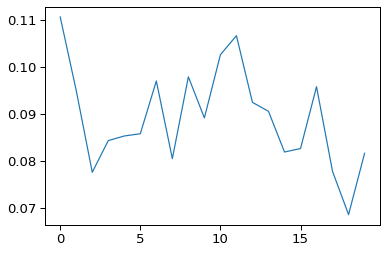

In [15]:
plt.plot(all_losses)

In [17]:
best_idx = np.argmin(all_losses)
best_idx

18

In [18]:
all_cv_scores[best_idx]

{'train_r2': array([0.95776746, 0.99541018, 0.99121298, 0.98866038, 0.94075444]),
 'validate_r2': array([0.95072213, 0.94488797, 0.91596551, 0.9495049 , 0.97096578]),
 'train_rmsd': array([0.05870463, 0.02277828, 0.02884076, 0.03189176, 0.07771028]),
 'validate_rmsd': array([0.07242684, 0.06424678, 0.07696688, 0.07595883, 0.05306217])}

In [19]:
best_emulator = all_emulators[best_idx]
best_emulator

In [20]:
best_emulator.train(retrain=True)

[INFO] >>> Training model on 80% of the dataset, testing on 20%...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)
/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)


[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.033          0.295         -0.139          0.324 *
[INFO]             100          0.914          0.086          0.866          0.111 *
[INFO]             200          0.951          0.064          0.894          0.099 *
[INFO]             300          0.967          0.053          0.889          0.100
[INFO]             400          0.930          0.076          0.875          0.107
[INFO]             500          0.955          0.061          0.896          0.098 *
[INFO]             600          0.962          0.057          0.855          0.114
[INFO]             700          0.965          0.054          0.891          0.100
[INFO]             800          0.975          0.046          0.898          0.

[INFO]            8500          0.989          0.030          0.894          0.099
[INFO]            8600          0.990          0.030          0.895          0.099
[INFO]            8700          0.992          0.026          0.906          0.093 *
[INFO]            8800          0.990          0.029          0.889          0.101
[INFO]            8900          0.991          0.028          0.899          0.097
[INFO]            9000          0.990          0.030          0.892          0.100
[INFO]            9100          0.987          0.033          0.898          0.097
[INFO]            9200          0.992          0.027          0.899          0.097
[INFO]            9300          0.991          0.028          0.886          0.103
[INFO]            9400          0.989          0.031          0.898          0.097
[INFO]            9500          0.990          0.030          0.899          0.096
[INFO]            9600          0.989          0.031          0.902          0.095
[I

[INFO]           17500          0.989          0.030          0.883          0.105
[INFO]           17600          0.989          0.030          0.882          0.105
[INFO]           17700          0.990          0.029          0.883          0.104
[INFO]           17800          0.988          0.032          0.874          0.108
[INFO]           17900          0.990          0.030          0.874          0.109
[INFO]           18000          0.991          0.027          0.875          0.108
[INFO]           18100          0.992          0.026          0.869          0.110
[INFO]           18200          0.992          0.027          0.873          0.109
[INFO]           18300          0.988          0.033          0.864          0.113
[INFO]           18400          0.989          0.030          0.873          0.109
[INFO]           18500          0.990          0.030          0.873          0.109
[INFO]           18600          0.991          0.028          0.872          0.110
[INF

{'train_r2': 0.9920052907987851,
 'test_r2': 0.9055036720353147,
 'train_rmsd': 0.026266669061091884,
 'test_rmsd': 0.09346343650641431}

In [26]:
#best_emulator.save('emulator_suzuki_i_BayesNeuralNet')

[WARNING] Overwriting existing emulator in emulator_suzuki_i_BayesNeuralNet!


PicklingError: Can't pickle <class 'olympus.utils.data_transformer.DataTransformer'>: it's not the same object as olympus.utils.data_transformer.DataTransformer

In [6]:
hyperparams_i = {'batch_size': 20,
 'hidden_act': 'leaky_relu',
 'hidden_depth': 3,
 'hidden_nodes': 52,
 'learning_rate': 0.0039311196427525286,
 'reg': 0.009957465344113334}


In [7]:
model  = BayesNeuralNet(
        **hyperparams_i, out_act='sigmoid', 
    )
emulator = Emulator(
    dataset='suzuki_i', model=model, 
    feature_transform='standardize', target_transform='normalize',
)

In [8]:
emulator.train()

[INFO] >>> Training model on 80% of the dataset, testing on 20%...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)
/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)


[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.033          0.356         -0.118          0.321 *
[INFO]             100          0.967          0.064          0.863          0.112 *
[INFO]             200          0.967          0.065          0.911          0.091 *
[INFO]             300          0.963          0.068          0.889          0.101
[INFO]             400          0.960          0.069          0.870          0.109
[INFO]             500          0.972          0.058          0.861          0.113
[INFO]             600          0.940          0.086          0.846          0.120
[INFO]             700          0.970          0.060          0.871          0.110
[INFO]             800          0.975          0.056          0.855          0.11

[INFO]            8600          0.984          0.044          0.912          0.092
[INFO]            8700          0.989          0.037          0.909          0.094
[INFO]            8800          0.989          0.036          0.908          0.094
[INFO]            8900          0.987          0.040          0.907          0.094
[INFO]            9000          0.990          0.035          0.906          0.095
[INFO]            9100          0.985          0.042          0.911          0.093
[INFO]            9200          0.990          0.035          0.902          0.097
[INFO]            9300          0.986          0.040          0.903          0.097
[INFO]            9400          0.987          0.039          0.907          0.095
[INFO]            9500          0.987          0.039          0.905          0.095
[INFO]            9600          0.988          0.038          0.909          0.093
[INFO]            9700          0.984          0.043          0.910          0.093
[INF

{'train_r2': 0.9666703180747556,
 'test_r2': 0.9111864741841722,
 'train_rmsd': 0.06460460111806544,
 'test_rmsd': 0.09065135344676108}

In [10]:
emulator.save('emulator_suzuki_i_BayesNeuralNet')

## `dataset_suzuki_ii`

In [27]:
search_space = {
    'batch_size': hp.quniform('batch_size', 10, 50, 10),
    'hidden_act': hp.choice('hidden_act', ['leaky_relu'] ),
    'hidden_depth': hp.quniform('hidden_depth', 2, 5, 1),
    'hidden_nodes': hp.quniform('hidden_nodes', 28, 64, 4),
    'learning_rate': hp.uniform('learning_rate', 1e-5, 5e-3),
    'reg': hp.uniform('reg', 0.001, 0.1)
}

int_params = ['batch_size', 'hidden_depth', 'hidden_nodes']

all_emulators = []
all_losses = []
all_cv_scores = []
all_params = []

def objective(params):
    ''' average performance over cross-validation folds '''
    # build emualtor
    print(f'PARAMS : {params}')
    for param, val in params.items():
        if param in int_params:
            params[param] = int(val)
    model  = BayesNeuralNet(
        **params, out_act='sigmoid', 
    )
    emulator = Emulator(
        dataset='suzuki_ii', model=model, 
        feature_transform='standardize', target_transform='normalize',
    )

    cv_scores = emulator.cross_validate()
    loss = np.mean(cv_scores['validate_rmsd'])
    
    all_losses.append(loss)
    all_cv_scores.append(cv_scores)
    all_params.append(params)
    all_emulators.append(emulator)
    
    return {'loss': loss, 'status': STATUS_OK}

In [28]:
trials = Trials()

best = fmin(
    fn=objective,
    space=search_space, 
    algo=tpe.suggest, 
    max_evals=20,
    trials=trials
)

print(f"BEST VALUE : {best}")

PARAMS : {'batch_size': 30.0, 'hidden_act': 'leaky_relu', 'hidden_depth': 3.0, 'hidden_nodes': 60.0, 'learning_rate': 0.004166194134677577, 'reg': 0.0641134324551756}                                   
  0%|                                                                                                                                                             | 0/20 [00:00<?, ?trial/s, best loss=?][INFO] >>> Training model on fold #0...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.387          0.334         -0.119          0.338 *
[INFO]             100          0.910          0.086          0.527          0.219 *
[INFO]             200          0.931          0.076          0.540          0.217 *
[INFO]             300          0.905          0.088          0.494          0.227
[INFO]             400          0.959          0.058          0.584          0.206 *
[INFO]             500          0.959          0.058          0.507          0.224
[INFO]             600          0.975          0.045          0.713          0.171 *
[INFO]             700          0.961          0.056          0.546          0.215
[INFO]             800          0.976          0.044          0.637          

[INFO]            8700          0.993          0.025          0.602          0.202
[INFO]            8800          0.988          0.031          0.555          0.213
[INFO]            8900          0.993          0.024          0.573          0.209
[INFO]            9000          0.993          0.024          0.587          0.205
[INFO]            9100          0.994          0.023          0.605          0.201
[INFO]            9200          0.993          0.024          0.597          0.203
[INFO]            9300          0.988          0.031          0.564          0.211
[INFO]            9400          0.988          0.032          0.566          0.210
[INFO]            9500          0.993          0.025          0.591          0.204
[INFO]            9600          0.993          0.023          0.592          0.204
[INFO]            9700          0.993          0.024          0.544          0.215
[INFO]            9800          0.993          0.023          0.597          0.203
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.154          0.331         -0.567          0.312 *
[INFO]             100          0.762          0.150          0.656          0.146 *
[INFO]             200          0.811          0.134          0.449          0.184
[INFO]             300          0.834          0.126          0.543          0.167
[INFO]             400          0.830          0.127          0.609          0.157
[INFO]             500          0.823          0.130          0.522          0.171
[INFO]             600          0.840          0.123          0.575          0.163
[INFO]             700          0.835          0.125          0.630          0.151
[INFO]             800          0.880          0.107          0.280          0.210


[INFO]            8700          0.972          0.052         -0.840          0.336
[INFO]            8800          0.970          0.053         -0.819          0.334
[INFO]            8900          0.968          0.055         -0.829          0.335
[INFO]            9000          0.972          0.051         -0.783          0.330
[INFO]            9100          0.971          0.052         -0.677          0.320
[INFO]            9200          0.969          0.054         -0.596          0.311
[INFO]            9300          0.971          0.053         -0.719          0.324
[INFO]            9400          0.972          0.051         -0.756          0.328
[INFO]            9500          0.968          0.055         -0.812          0.334
[INFO]            9600          0.973          0.051         -0.705          0.322
[INFO]            9700          0.971          0.052         -0.743          0.326
[INFO]            9800          0.971          0.053         -0.790          0.331
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.748          0.270         -0.498          0.344 *
[INFO]             100          0.852          0.079          0.623          0.172 *
[INFO]             200          0.814          0.088          0.293          0.236
[INFO]             300          0.814          0.088          0.581          0.182
[INFO]             400          0.918          0.059          0.538          0.191
[INFO]             500          0.652          0.120          0.525          0.193
[INFO]             600          0.813          0.089          0.411          0.215
[INFO]             700          0.882          0.070          0.565          0.185
[INFO]             800          0.918          0.059          0.536          0.191


[INFO]            8600          0.981          0.028          0.685          0.157
[INFO]            8700          0.983          0.027          0.700          0.154
[INFO]            8800          0.990          0.020          0.656          0.164
[INFO]            8900          0.984          0.026          0.680          0.159
[INFO]            9000          0.991          0.019          0.657          0.164
[INFO]            9100          0.987          0.024          0.665          0.162
[INFO]            9200          0.994          0.016          0.662          0.163
[INFO]            9300          0.978          0.031          0.664          0.163
[INFO]            9400          0.989          0.021          0.655          0.165
[INFO]            9500          0.983          0.027          0.634          0.170
[INFO]            9600          0.985          0.025          0.685          0.157
[INFO]            9700          0.988          0.022          0.646          0.167
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.437          0.305         -0.220          0.305 *
[INFO]             100          0.732          0.132          0.892          0.091 *
[INFO]             200          0.739          0.130          0.861          0.102
[INFO]             300          0.766          0.123          0.867          0.100
[INFO]             400          0.800          0.113          0.924          0.075 *
[INFO]             500          0.809          0.111          0.859          0.103
[INFO]             600          0.824          0.107          0.909          0.082
[INFO]             700          0.836          0.103          0.916          0.079
[INFO]             800          0.864          0.094          0.920          0.07

[INFO]            8500          0.954          0.055          0.855          0.104
[INFO]            8600          0.948          0.058          0.872          0.098
[INFO]            8700          0.960          0.051          0.877          0.096
[INFO]            8800          0.961          0.051          0.849          0.107
[INFO]            8900          0.944          0.060          0.868          0.100
[INFO]            9000          0.962          0.050          0.860          0.103
[INFO]            9100          0.959          0.052          0.845          0.108
[INFO]            9200          0.954          0.055          0.854          0.105
[INFO]            9300          0.955          0.054          0.845          0.108
[INFO]            9400          0.952          0.056          0.860          0.103
[INFO]            9500          0.951          0.056          0.841          0.109
[INFO]            9600          0.954          0.055          0.867          0.100
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.505          0.342         -0.360          0.330 *
[INFO]             100          0.927          0.075          0.627          0.176 *
[INFO]             200          0.937          0.070          0.573          0.188
[INFO]             300          0.941          0.068          0.622          0.175 *
[INFO]             400          0.948          0.064          0.600          0.183
[INFO]             500          0.951          0.062          0.608          0.180
[INFO]             600          0.935          0.071          0.571          0.188
[INFO]             700          0.957          0.058          0.467          0.209
[INFO]             800          0.945          0.065          0.524          0.19

[INFO]            8500          0.994          0.022          0.262          0.244
[INFO]            8600          0.993          0.024          0.266          0.242
[INFO]            8700          0.992          0.025          0.372          0.225
[INFO]            8800          0.995          0.020          0.245          0.247
[INFO]            8900          0.993          0.024          0.467          0.208
[INFO]            9000          0.994          0.021          0.334          0.232
[INFO]            9100          0.993          0.024          0.473          0.206
[INFO]            9200          0.995          0.020          0.458          0.209
[INFO]            9300          0.993          0.023          0.392          0.222
[INFO]            9400          0.994          0.022          0.383          0.223
[INFO]            9500          0.993          0.023          0.452          0.210
[INFO]            9600          0.993          0.024          0.439          0.214
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.313          0.299         -0.899          0.374 *
[INFO]             100          0.597          0.167          0.527          0.187 *
[INFO]             200          0.690          0.146          0.868          0.099 *
[INFO]             300          0.783          0.122          0.923          0.076 *
[INFO]             400          0.831          0.108          0.940          0.067 *
[INFO]             500          0.850          0.102          0.945          0.064 *
[INFO]             600          0.870          0.095          0.952          0.060 *
[INFO]             700          0.878          0.092          0.948          0.062
[INFO]             800          0.879          0.091          0.962      

[INFO]            8400          0.946          0.061          0.911          0.081
[INFO]            8500          0.945          0.061          0.917          0.078
[INFO]            8600          0.929          0.070          0.916          0.079
[INFO]            8700          0.944          0.062          0.907          0.083
[INFO]            8800          0.951          0.058          0.907          0.083
[INFO]            8900          0.946          0.061          0.910          0.082
[INFO]            9000          0.948          0.060          0.907          0.083
[INFO]            9100          0.951          0.058          0.915          0.080
[INFO]            9200          0.954          0.056          0.904          0.084
[INFO]            9300          0.946          0.061          0.917          0.078
[INFO]            9400          0.948          0.059          0.905          0.084
[INFO]            9500          0.939          0.065          0.903          0.085
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -2.864          0.389         -0.018          0.302 *
[INFO]             100          0.178          0.183          0.761          0.146 *
[INFO]             200          0.653          0.119          0.856          0.114 *
[INFO]             300          0.758          0.100          0.855          0.114
[INFO]             400          0.814          0.088          0.853          0.115
[INFO]             500          0.850          0.078          0.810          0.130
[INFO]             600          0.854          0.077          0.814          0.129
[INFO]             700          0.908          0.061          0.802          0.133
[INFO]             800          0.902          0.063          0.770          0.14

[INFO]            8600          0.990          0.020          0.804          0.133
[INFO]            8700          0.984          0.026          0.818          0.128
[INFO]            8800          0.990          0.020          0.801          0.134
[INFO]            8900          0.989          0.021          0.805          0.132
[INFO]            9000          0.985          0.024          0.811          0.130
[INFO]            9100          0.991          0.019          0.816          0.129
[INFO]            9200          0.984          0.025          0.799          0.134
[INFO]            9300          0.990          0.020          0.803          0.133
[INFO]            9400          0.990          0.020          0.813          0.130
[INFO]            9500          0.988          0.022          0.807          0.132
[INFO]            9600          0.992          0.018          0.814          0.129
[INFO]            9700          0.989          0.021          0.793          0.136
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.465          0.332         -0.464          0.369 *
[INFO]             100          0.636          0.165          0.615          0.189 *
[INFO]             200          0.713          0.147          0.716          0.162 *
[INFO]             300          0.754          0.136          0.756          0.150 *
[INFO]             400          0.794          0.124          0.795          0.138 *
[INFO]             500          0.815          0.118          0.812          0.132 *
[INFO]             600          0.850          0.106          0.829          0.126 *
[INFO]             700          0.844          0.108          0.841          0.122 *
[INFO]             800          0.852          0.105          0.853    

[INFO]            8500          0.970          0.047          0.832          0.125
[INFO]            8600          0.971          0.047          0.828          0.126
[INFO]            8700          0.971          0.046          0.826          0.127
[INFO]            8800          0.970          0.047          0.826          0.127
[INFO]            8900          0.970          0.047          0.818          0.130
[INFO]            9000          0.970          0.048          0.826          0.127
[INFO]            9100          0.969          0.048          0.815          0.131
[INFO]            9200          0.969          0.048          0.819          0.130
[INFO]            9300          0.969          0.048          0.810          0.133
[INFO]            9400          0.969          0.049          0.816          0.131
[INFO]            9500          0.968          0.049          0.815          0.131
[INFO]            9600          0.970          0.048          0.815          0.131
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.340          0.319         -0.172          0.323 *
[INFO]             100          0.628          0.168          0.248          0.259 *
[INFO]             200          0.812          0.119          0.214          0.264
[INFO]             300          0.870          0.099          0.160          0.274
[INFO]             400          0.876          0.097          0.214          0.265
[INFO]             500          0.883          0.094          0.189          0.269
[INFO]             600          0.897          0.088          0.174          0.271
[INFO]             700          0.906          0.084          0.104          0.283
[INFO]             800          0.903          0.086          0.112          0.282


[INFO]            8500          0.936          0.070          0.210          0.265
[INFO]            8600          0.932          0.072          0.193          0.268
[INFO]            8700          0.936          0.069          0.209          0.266
[INFO]            8800          0.934          0.071          0.185          0.270
[INFO]            8900          0.936          0.069          0.215          0.265
[INFO]            9000          0.941          0.067          0.208          0.266
[INFO]            9100          0.940          0.067          0.188          0.269
[INFO]            9200          0.939          0.068          0.200          0.267
[INFO]            9300          0.931          0.072          0.197          0.268
[INFO]            9400          0.939          0.068          0.196          0.268
[INFO]            9500          0.936          0.070          0.206          0.266
[INFO]            9600          0.932          0.072          0.203          0.267
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.680          0.323         -1.018          0.330 *
[INFO]             100          0.660          0.145          0.288          0.196 *
[INFO]             200          0.796          0.112          0.074          0.223
[INFO]             300          0.804          0.110          0.084          0.222
[INFO]             400          0.810          0.108          0.185          0.209
[INFO]             500          0.812          0.108          0.290          0.195 *
[INFO]             600          0.841          0.099          0.275          0.197
[INFO]             700          0.839          0.100          0.270          0.198
[INFO]             800          0.831          0.102          0.334          0.18

[INFO]            8400          0.954          0.053          0.447          0.173
[INFO]            8500          0.963          0.048          0.442          0.173
[INFO]            8600          0.959          0.051          0.475          0.168
[INFO]            8700          0.961          0.049          0.453          0.172
[INFO]            8800          0.960          0.050          0.457          0.171
[INFO]            8900          0.959          0.051          0.478          0.168
[INFO]            9000          0.958          0.051          0.452          0.172
[INFO]            9100          0.964          0.047          0.477          0.168
[INFO]            9200          0.955          0.053          0.463          0.170
[INFO]            9300          0.962          0.048          0.423          0.176
[INFO]            9400          0.965          0.047          0.451          0.172
[INFO]            9500          0.965          0.046          0.467          0.169
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.366          0.291         -0.247          0.296 *
[INFO]             100          0.901          0.079          0.546          0.178 *
[INFO]             200          0.910          0.075          0.441          0.197
[INFO]             300          0.937          0.063          0.491          0.189
[INFO]             400          0.945          0.059          0.588          0.170 *
[INFO]             500          0.917          0.072          0.462          0.194
[INFO]             600          0.923          0.069          0.410          0.203
[INFO]             700          0.942          0.060          0.476          0.191
[INFO]             800          0.961          0.050          0.438          0.19

[INFO]            8600          0.974          0.040          0.442          0.198
[INFO]            8700          0.985          0.030          0.400          0.205
[INFO]            8800          0.952          0.055          0.391          0.207
[INFO]            8900          0.974          0.040          0.442          0.198
[INFO]            9000          0.974          0.040          0.451          0.196
[INFO]            9100          0.978          0.037          0.453          0.196
[INFO]            9200          0.963          0.048          0.455          0.195
[INFO]            9300          0.963          0.048          0.452          0.196
[INFO]            9400          0.969          0.044          0.427          0.200
[INFO]            9500          0.968          0.045          0.425          0.201
[INFO]            9600          0.968          0.044          0.385          0.208
[INFO]            9700          0.976          0.038          0.407          0.204
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.059          0.333         -0.237          0.318 *
[INFO]             100          0.913          0.096          0.890          0.099 *
[INFO]             200          0.891          0.107          0.795          0.134
[INFO]             300          0.903          0.100          0.758          0.148
[INFO]             400          0.912          0.096          0.839          0.120
[INFO]             500          0.917          0.093          0.812          0.131
[INFO]             600          0.890          0.107          0.850          0.116
[INFO]             700          0.903          0.101          0.788          0.136
[INFO]             800          0.901          0.102          0.827          0.124


[INFO]            8600          0.963          0.062          0.868          0.108
[INFO]            8700          0.952          0.071          0.841          0.117
[INFO]            8800          0.958          0.066          0.865          0.107
[INFO]            8900          0.958          0.066          0.842          0.117
[INFO]            9000          0.949          0.073          0.811          0.129
[INFO]            9100          0.962          0.063          0.856          0.111
[INFO]            9200          0.957          0.067          0.845          0.116
[INFO]            9300          0.963          0.063          0.825          0.123
[INFO]            9400          0.961          0.064          0.858          0.111
[INFO]            9500          0.967          0.059          0.856          0.112
[INFO]            9600          0.960          0.065          0.802          0.132
[INFO]            9700          0.979          0.047          0.852          0.113
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.651          0.350         -0.367          0.332 *
[INFO]             100          0.896          0.088          0.845          0.112 *
[INFO]             200          0.905          0.084          0.717          0.151
[INFO]             300          0.912          0.081          0.883          0.097 *
[INFO]             400          0.910          0.082          0.857          0.107
[INFO]             500          0.929          0.072          0.916          0.082 *
[INFO]             600          0.891          0.089          0.852          0.110
[INFO]             700          0.911          0.081          0.900          0.090
[INFO]             800          0.927          0.074          0.910          0.

[INFO]            8400          0.942          0.065          0.941          0.069
[INFO]            8500          0.937          0.068          0.930          0.075
[INFO]            8600          0.934          0.070          0.922          0.080
[INFO]            8700          0.944          0.064          0.931          0.075
[INFO]            8800          0.948          0.062          0.937          0.071
[INFO]            8900          0.941          0.066          0.928          0.077
[INFO]            9000          0.939          0.067          0.920          0.081
[INFO]            9100          0.945          0.064          0.940          0.070
[INFO]            9200          0.947          0.063          0.940          0.070
[INFO]            9300          0.933          0.070          0.934          0.073
[INFO]            9400          0.945          0.064          0.936          0.072
[INFO]            9500          0.940          0.066          0.937          0.071
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.080          0.373         -0.367          0.322 *
[INFO]             100          0.879          0.090          0.660          0.161 *
[INFO]             200          0.899          0.083          0.699          0.152 *
[INFO]             300          0.892          0.085          0.681          0.157
[INFO]             400          0.893          0.085          0.798          0.126 *
[INFO]             500          0.897          0.083          0.708          0.150
[INFO]             600          0.893          0.085          0.584          0.180
[INFO]             700          0.908          0.079          0.660          0.163
[INFO]             800          0.912          0.077          0.595          0.

[INFO]            8600          0.922          0.072          0.099          0.266
[INFO]            8700          0.921          0.073          0.188          0.253
[INFO]            8800          0.932          0.068          0.126          0.262
[INFO]            8900          0.921          0.073          0.014          0.277
[INFO]            9000          0.919          0.074          0.037          0.274
[INFO]            9100          0.921          0.073          0.130          0.262
[INFO]            9200          0.919          0.074          0.079          0.268
[INFO]            9300          0.918          0.074          0.110          0.264
[INFO]            9400          0.922          0.072          0.186          0.253
[INFO]            9500          0.922          0.073          0.237          0.246
[INFO]            9600          0.919          0.074          0.134          0.261
[INFO]            9700          0.916          0.075          0.049          0.273
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.097          0.339         -0.302          0.376 *
[INFO]             100          0.908          0.098          0.746          0.168 *
[INFO]             200          0.953          0.070          0.778          0.156 *
[INFO]             300          0.932          0.084          0.829          0.138 *
[INFO]             400          0.948          0.074          0.684          0.186
[INFO]             500          0.950          0.072          0.784          0.154
[INFO]             600          0.944          0.076          0.766          0.160
[INFO]             700          0.944          0.076          0.803          0.147
[INFO]             800          0.970          0.056          0.795          0.

[INFO]            8600          0.980          0.045          0.785          0.154
[INFO]            8700          0.979          0.047          0.781          0.155
[INFO]            8800          0.979          0.047          0.782          0.154
[INFO]            8900          0.973          0.053          0.799          0.148
[INFO]            9000          0.980          0.046          0.791          0.151
[INFO]            9100          0.977          0.049          0.790          0.151
[INFO]            9200          0.979          0.047          0.790          0.152
[INFO]            9300          0.979          0.046          0.770          0.159
[INFO]            9400          0.977          0.049          0.792          0.151
[INFO]            9500          0.978          0.048          0.805          0.146
[INFO]            9600          0.980          0.046          0.795          0.150
[INFO]            9700          0.981          0.045          0.800          0.148
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.554          0.353         -0.313          0.340 *
[INFO]             100          0.863          0.105          0.770          0.142 *
[INFO]             200          0.906          0.087          0.836          0.120 *
[INFO]             300          0.939          0.070          0.831          0.122
[INFO]             400          0.923          0.078          0.767          0.143
[INFO]             500          0.944          0.067          0.724          0.155
[INFO]             600          0.926          0.078          0.792          0.135
[INFO]             700          0.947          0.065          0.674          0.170
[INFO]             800          0.937          0.071          0.716          0.15

[INFO]            8600          0.980          0.040          0.819          0.126
[INFO]            8700          0.985          0.034          0.846          0.116
[INFO]            8800          0.979          0.041          0.800          0.133
[INFO]            8900          0.980          0.040          0.808          0.130
[INFO]            9000          0.978          0.042          0.822          0.125
[INFO]            9100          0.982          0.038          0.859          0.111
[INFO]            9200          0.986          0.034          0.842          0.118
[INFO]            9300          0.986          0.034          0.832          0.122
[INFO]            9400          0.978          0.042          0.818          0.126
[INFO]            9500          0.976          0.043          0.816          0.127
[INFO]            9600          0.985          0.035          0.844          0.117
[INFO]            9700          0.982          0.037          0.838          0.119
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0          0.002          0.322         -0.277          0.366 *
[INFO]             100          0.768          0.155          0.858          0.122 *
[INFO]             200          0.873          0.115          0.781          0.151
[INFO]             300          0.852          0.124          0.761          0.158
[INFO]             400          0.896          0.104          0.686          0.181
[INFO]             500          0.870          0.116          0.693          0.179
[INFO]             600          0.905          0.100          0.820          0.137
[INFO]             700          0.901          0.102          0.921          0.092 *
[INFO]             800          0.928          0.087          0.778          0.15

[INFO]            8600          0.991          0.031          0.792          0.147
[INFO]            8700          0.981          0.044          0.779          0.151
[INFO]            8800          0.985          0.040          0.713          0.173
[INFO]            8900          0.990          0.032          0.808          0.142
[INFO]            9000          0.952          0.071          0.852          0.124
[INFO]            9100          0.968          0.058          0.851          0.125
[INFO]            9200          0.969          0.056          0.800          0.144
[INFO]            9300          0.945          0.076          0.879          0.112
[INFO]            9400          0.992          0.029          0.760          0.158
[INFO]            9500          0.995          0.024          0.656          0.188
[INFO]            9600          0.987          0.037          0.697          0.177
[INFO]            9700          0.993          0.026          0.766          0.156
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -2.555          0.423         -0.633          0.344 *
[INFO]             100          0.849          0.087          0.617          0.167 *
[INFO]             200          0.903          0.070          0.593          0.172
[INFO]             300          0.909          0.068          0.519          0.187
[INFO]             400          0.906          0.069          0.526          0.186
[INFO]             500          0.921          0.063          0.549          0.181
[INFO]             600          0.938          0.056          0.679          0.153 *
[INFO]             700          0.938          0.056          0.579          0.175
[INFO]             800          0.929          0.060          0.522          0.18

[INFO]            8600          0.988          0.024          0.565          0.178
[INFO]            8700          0.994          0.017          0.551          0.181
[INFO]            8800          0.987          0.025          0.563          0.179
[INFO]            8900          0.989          0.024          0.590          0.173
[INFO]            9000          0.987          0.025          0.539          0.183
[INFO]            9100          0.989          0.023          0.564          0.178
[INFO]            9200          0.977          0.034          0.516          0.188
[INFO]            9300          0.990          0.022          0.578          0.175
[INFO]            9400          0.984          0.028          0.474          0.196
[INFO]            9500          0.995          0.016          0.579          0.175
[INFO]            9600          0.990          0.023          0.574          0.176
[INFO]            9700          0.988          0.024          0.578          0.176
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.999          0.338         -0.331          0.335 *
[INFO]             100          0.898          0.080          0.263          0.248 *
[INFO]             200          0.935          0.063          0.260          0.249
[INFO]             300          0.961          0.048          0.203          0.258
[INFO]             400          0.947          0.055          0.313          0.239 *
[INFO]             500          0.941          0.058          0.360          0.231 *
[INFO]             600          0.952          0.053          0.367          0.230 *
[INFO]             700          0.933          0.061          0.153          0.266
[INFO]             800          0.952          0.053          0.237          

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.395          0.294         -0.316          0.352 *
[INFO]             100          0.544          0.168          0.796          0.139 *
[INFO]             200          0.719          0.132          0.818          0.132 *
[INFO]             300          0.755          0.123          0.819          0.131 *
[INFO]             400          0.759          0.122          0.824          0.130 *
[INFO]             500          0.776          0.118          0.828          0.128 *
[INFO]             600          0.713          0.134          0.814          0.133
[INFO]             700          0.787          0.115          0.804          0.136
[INFO]             800          0.755          0.123          0.813        

[INFO]            8400          0.964          0.047          0.875          0.110
[INFO]            8500          0.962          0.048          0.853          0.119
[INFO]            8600          0.968          0.045          0.876          0.110
[INFO]            8700          0.981          0.034          0.848          0.121
[INFO]            8800          0.976          0.038          0.867          0.113
[INFO]            8900          0.970          0.043          0.859          0.116
[INFO]            9000          0.980          0.036          0.868          0.113
[INFO]            9100          0.973          0.041          0.882          0.107
[INFO]            9200          0.967          0.045          0.867          0.113
[INFO]            9300          0.983          0.033          0.875          0.110
[INFO]            9400          0.963          0.048          0.872          0.111
[INFO]            9500          0.965          0.047          0.871          0.112
[INF

[INFO]           17200          0.960          0.050          0.883          0.106
[INFO]           17300          0.964          0.047          0.858          0.117
[INFO]           17400          0.982          0.034          0.872          0.111
[INFO]           17500          0.976          0.039          0.884          0.106
[INFO]           17600          0.972          0.042          0.882          0.107
[INFO]           17700          0.979          0.036          0.874          0.110
[INFO]           17800          0.982          0.034          0.866          0.114
[INFO]           17900          0.981          0.034          0.868          0.113
[INFO]           18000          0.970          0.043          0.865          0.114
[INFO]           18100          0.970          0.043          0.874          0.110
[INFO]           18200          0.981          0.035          0.868          0.113
[INFO]           18300          0.968          0.044          0.869          0.112
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.240          0.361         -0.014          0.314 *
[INFO]             100          0.851          0.125          0.493          0.221 *
[INFO]             200          0.902          0.101          0.517          0.216 *
[INFO]             300          0.893          0.105          0.502          0.220
[INFO]             400          0.932          0.083          0.531          0.213 *
[INFO]             500          0.926          0.087          0.580          0.202 *
[INFO]             600          0.933          0.083          0.583          0.201 *
[INFO]             700          0.938          0.080          0.453          0.230
[INFO]             800          0.946          0.075          0.509        

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.184          0.336         -0.476          0.366 *
[INFO]             100          0.576          0.201          0.723          0.159 *
[INFO]             200          0.609          0.193          0.664          0.175
[INFO]             300          0.684          0.174          0.703          0.165
[INFO]             400          0.767          0.149          0.718          0.161
[INFO]             500          0.835          0.126          0.647          0.180
[INFO]             600          0.727          0.162          0.704          0.164
[INFO]             700          0.672          0.177          0.733          0.156 *
[INFO]             800          0.791          0.142          0.739          0.15

[INFO]            8600          0.992          0.027          0.697          0.169
[INFO]            8700          0.990          0.032          0.644          0.183
[INFO]            8800          0.989          0.032          0.662          0.178
[INFO]            8900          0.991          0.029          0.695          0.170
[INFO]            9000          0.991          0.029          0.651          0.181
[INFO]            9100          0.989          0.033          0.634          0.186
[INFO]            9200          0.990          0.031          0.702          0.168
[INFO]            9300          0.991          0.030          0.671          0.176
[INFO]            9400          0.990          0.031          0.662          0.178
[INFO]            9500          0.990          0.032          0.633          0.186
[INFO]            9600          0.990          0.031          0.650          0.182
[INFO]            9700          0.990          0.031          0.636          0.185
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -2.856          0.380         -0.725          0.400 *
[INFO]             100          0.701          0.106          0.885          0.104 *
[INFO]             200          0.702          0.106          0.888          0.102 *
[INFO]             300          0.790          0.090          0.875          0.109
[INFO]             400          0.789          0.089          0.851          0.118
[INFO]             500          0.793          0.089          0.879          0.107
[INFO]             600          0.855          0.075          0.877          0.108
[INFO]             700          0.885          0.067          0.832          0.125
[INFO]             800          0.842          0.077          0.818          0.13

[INFO]            8500          0.996          0.012          0.900          0.097
[INFO]            8600          0.997          0.011          0.890          0.101
[INFO]            8700          0.995          0.013          0.892          0.100
[INFO]            8800          0.996          0.012          0.898          0.097
[INFO]            8900          0.997          0.011          0.898          0.098
[INFO]            9000          0.993          0.016          0.897          0.098
[INFO]            9100          0.994          0.015          0.897          0.098
[INFO]            9200          0.997          0.010          0.898          0.097
[INFO]            9300          0.996          0.012          0.903          0.095
[INFO]            9400          0.994          0.015          0.897          0.098
[INFO]            9500          0.990          0.019          0.901          0.096
[INFO]            9600          0.993          0.017          0.895          0.099
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.682          0.360         -0.527          0.302 *
[INFO]             100          0.875          0.100          0.535          0.171 *
[INFO]             200          0.901          0.089          0.660          0.145 *
[INFO]             300          0.886          0.095          0.776          0.120 *
[INFO]             400          0.911          0.084          0.658          0.145
[INFO]             500          0.900          0.089          0.627          0.151
[INFO]             600          0.879          0.098          0.700          0.138
[INFO]             700          0.913          0.083          0.635          0.150
[INFO]             800          0.916          0.082          0.735          0.

[INFO]            8600          0.993          0.023          0.848          0.097
[INFO]            8700          0.993          0.023          0.856          0.095
[INFO]            8800          0.994          0.021          0.852          0.097
[INFO]            8900          0.993          0.024          0.854          0.097
[INFO]            9000          0.992          0.025          0.863          0.092
[INFO]            9100          0.994          0.021          0.870          0.089 *
[INFO]            9200          0.993          0.023          0.864          0.092
[INFO]            9300          0.991          0.026          0.862          0.093
[INFO]            9400          0.994          0.021          0.861          0.093
[INFO]            9500          0.995          0.021          0.853          0.096
[INFO]            9600          0.994          0.022          0.860          0.093
[INFO]            9700          0.995          0.020          0.856          0.094
[I

[INFO]           17400          0.997          0.016          0.849          0.098
[INFO]           17500          0.997          0.014          0.846          0.099
[INFO]           17600          0.999          0.010          0.863          0.092
[INFO]           17700          0.999          0.008          0.866          0.092
[INFO]           17800          0.999          0.010          0.873          0.089
[INFO]           17900          0.999          0.011          0.871          0.089
[INFO]           18000          0.999          0.008          0.864          0.092
[INFO]           18100          1.000          0.005          0.867          0.091
[INFO]           18200          0.998          0.011          0.878          0.086
[INFO]           18300          0.998          0.014          0.874          0.088
[INFO]           18400          0.998          0.013          0.880          0.086
[INFO]           18500          0.999          0.010          0.853          0.096
[INF

[INFO]           26200          0.999          0.008          0.884          0.084
[INFO]           26300          0.998          0.011          0.876          0.088
[INFO]           26400          0.999          0.010          0.869          0.090
[INFO]           26500          0.998          0.011          0.872          0.089
[INFO]           26600          0.999          0.009          0.880          0.086
[INFO]           26700          0.998          0.012          0.885          0.084
[INFO]           26800          0.999          0.009          0.872          0.088
[INFO]           26900          0.998          0.012          0.890          0.082
[INFO]           27000          0.999          0.007          0.882          0.085
[INFO]           27100          0.999          0.007          0.872          0.089
[INFO]           27200          0.998          0.012          0.882          0.085
[INFO]           27300          0.999          0.010          0.884          0.085
[INF

[INFO]           35000          0.996          0.017          0.849          0.097
[INFO] Training completed in 38.97 seconds.
[INFO] ===========================================================================

[INFO] >>> Training model on fold #4...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.268          0.368         -0.298          0.356 *
[INFO]             100          0.889          0.109          0.774          0.148 *
[INFO]             200          0.904          0.101          0.753          0.155
[INFO]             300          0.907          0.100          0.793          0.142 *
[INFO]             400          0.844          0.129          0.773          0.148
[INFO]             500          0.934          0.084          0.821          0.132 *
[INFO]             600          0.943          0.078          0.769          0.150
[INFO]             700          0.929          0.087          0.760          0.152
[INFO]             800          0.951          0.072          0.724          0.

[INFO]            8600          0.997          0.019          0.685          0.175
[INFO]            8700          0.989          0.034          0.704          0.170
[INFO]            8800          0.999          0.012          0.717          0.166
[INFO]            8900          0.986          0.039          0.722          0.164
[INFO]            9000          0.998          0.014          0.725          0.163
[INFO]            9100          0.998          0.014          0.738          0.160
[INFO]            9200          0.989          0.034          0.752          0.155
[INFO]            9300          0.994          0.025          0.770          0.150
[INFO]            9400          0.997          0.017          0.791          0.143
[INFO]            9500          0.996          0.019          0.804          0.138
[INFO]            9600          0.998          0.013          0.835          0.126 *
[INFO]            9700          0.998          0.016          0.839          0.125 *


[INFO]           17400          0.999          0.010          0.828          0.129
[INFO]           17500          0.999          0.013          0.840          0.124
[INFO]           17600          0.999          0.008          0.826          0.130
[INFO]           17700          0.995          0.023          0.825          0.130
[INFO]           17800          0.998          0.016          0.844          0.123
[INFO]           17900          0.999          0.012          0.831          0.128
[INFO]           18000          0.997          0.018          0.833          0.127
[INFO]           18100          0.998          0.013          0.830          0.128
[INFO]           18200          0.997          0.018          0.827          0.129
[INFO]           18300          0.998          0.016          0.839          0.125
[INFO]           18400          0.999          0.011          0.835          0.126
[INFO]           18500          0.996          0.020          0.830          0.128
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.611          0.322         -0.669          0.339 *
[INFO]             100          0.595          0.161          0.319          0.218 *
[INFO]             200          0.866          0.093          0.585          0.170 *
[INFO]             300          0.913          0.075          0.640          0.159 *
[INFO]             400          0.927          0.069          0.663          0.154 *
[INFO]             500          0.950          0.057          0.647          0.157
[INFO]             600          0.947          0.059          0.638          0.159
[INFO]             700          0.962          0.050          0.664          0.153 *
[INFO]             800          0.961          0.050          0.686        

[INFO]            8400          0.987          0.029          0.728          0.139
[INFO]            8500          0.988          0.028          0.734          0.137
[INFO]            8600          0.985          0.031          0.749          0.133 *
[INFO]            8700          0.987          0.029          0.714          0.142
[INFO]            8800          0.987          0.028          0.765          0.129 *
[INFO]            8900          0.986          0.030          0.737          0.136
[INFO]            9000          0.989          0.027          0.740          0.135
[INFO]            9100          0.988          0.028          0.725          0.139
[INFO]            9200          0.987          0.029          0.733          0.137
[INFO]            9300          0.988          0.028          0.716          0.142
[INFO]            9400          0.987          0.029          0.755          0.131
[INFO]            9500          0.990          0.026          0.734          0.137


[INFO]           17200          0.993          0.021          0.731          0.138
[INFO]           17300          0.994          0.020          0.729          0.138
[INFO]           17400          0.993          0.021          0.735          0.137
[INFO]           17500          0.993          0.021          0.723          0.140
[INFO]           17600          0.993          0.021          0.729          0.138
[INFO]           17700          0.993          0.021          0.719          0.141
[INFO]           17800          0.994          0.019          0.722          0.140
[INFO]           17900          0.995          0.019          0.720          0.141
[INFO]           18000          0.994          0.020          0.712          0.143
[INFO]           18100          0.994          0.020          0.725          0.139
[INFO]           18200          0.994          0.020          0.731          0.138
[INFO]           18300          0.994          0.019          0.721          0.140
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.659          0.398         -0.436          0.380 *
[INFO]             100          0.480          0.176          0.705          0.173 *
[INFO]             200          0.755          0.121          0.893          0.104 *
[INFO]             300          0.852          0.094          0.902          0.099 *
[INFO]             400          0.909          0.074          0.881          0.109
[INFO]             500          0.928          0.065          0.887          0.107
[INFO]             600          0.917          0.071          0.870          0.115
[INFO]             700          0.937          0.061          0.861          0.118
[INFO]             800          0.958          0.050          0.845          0.

[INFO]            8500          0.988          0.027          0.823          0.133
[INFO]            8600          0.986          0.028          0.841          0.126
[INFO]            8700          0.988          0.027          0.836          0.128
[INFO]            8800          0.989          0.026          0.839          0.127
[INFO]            8900          0.990          0.024          0.838          0.128
[INFO]            9000          0.991          0.024          0.837          0.128
[INFO]            9100          0.991          0.024          0.833          0.130
[INFO]            9200          0.991          0.023          0.841          0.126
[INFO]            9300          0.990          0.024          0.826          0.132
[INFO]            9400          0.991          0.024          0.850          0.123
[INFO]            9500          0.990          0.024          0.844          0.125
[INFO]            9600          0.990          0.024          0.830          0.131
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.152          0.326         -0.220          0.340 *
[INFO]             100          0.630          0.185          0.719          0.166 *
[INFO]             200          0.862          0.113          0.870          0.112 *
[INFO]             300          0.890          0.101          0.894          0.101 *
[INFO]             400          0.906          0.093          0.909          0.094 *
[INFO]             500          0.912          0.090          0.917          0.090 *
[INFO]             600          0.923          0.084          0.919          0.088 *
[INFO]             700          0.920          0.086          0.914          0.090
[INFO]             800          0.929          0.081          0.915      

[INFO]            8500          0.969          0.053          0.746          0.154
[INFO]            8600          0.972          0.051          0.764          0.149
[INFO]            8700          0.971          0.052          0.777          0.145
[INFO]            8800          0.972          0.051          0.763          0.149
[INFO]            8900          0.975          0.048          0.770          0.147
[INFO]            9000          0.974          0.049          0.768          0.147
[INFO]            9100          0.972          0.051          0.758          0.151
[INFO]            9200          0.975          0.048          0.776          0.145
[INFO]            9300          0.977          0.046          0.757          0.151
[INFO]            9400          0.976          0.047          0.777          0.145
[INFO]            9500          0.973          0.050          0.767          0.148
[INFO]            9600          0.971          0.052          0.758          0.151
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.473          0.351         -0.095          0.342 *
[INFO]             100          0.657          0.169          0.378          0.257 *
[INFO]             200          0.913          0.085          0.535          0.222 *
[INFO]             300          0.939          0.072          0.568          0.214 *
[INFO]             400          0.949          0.065          0.536          0.222
[INFO]             500          0.949          0.065          0.608          0.204 *
[INFO]             600          0.955          0.061          0.489          0.233
[INFO]             700          0.949          0.065          0.544          0.220
[INFO]             800          0.960          0.057          0.555          

[INFO]            8500          0.981          0.039          0.612          0.202
[INFO]            8600          0.984          0.037          0.548          0.219
[INFO]            8700          0.982          0.039          0.570          0.213
[INFO]            8800          0.985          0.035          0.631          0.197
[INFO]            8900          0.985          0.035          0.617          0.201
[INFO]            9000          0.981          0.040          0.606          0.204
[INFO]            9100          0.980          0.041          0.497          0.230
[INFO]            9200          0.985          0.035          0.676          0.185
[INFO]            9300          0.982          0.039          0.576          0.212
[INFO]            9400          0.984          0.036          0.610          0.203
[INFO]            9500          0.982          0.038          0.584          0.210
[INFO]            9600          0.983          0.038          0.639          0.195
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.436          0.343         -2.251          0.306 *
[INFO]             100          0.661          0.167          0.344          0.138 *
[INFO]             200          0.863          0.106          0.375          0.135 *
[INFO]             300          0.879          0.099          0.601          0.107 *
[INFO]             400          0.911          0.086          0.687          0.095 *
[INFO]             500          0.919          0.082          0.657          0.099
[INFO]             600          0.929          0.076          0.713          0.091 *
[INFO]             700          0.936          0.072          0.661          0.099
[INFO]             800          0.941          0.069          0.689        

[INFO]           17200          0.985          0.035          0.880          0.059 *
[INFO]           17300          0.986          0.034          0.872          0.061
[INFO]           17400          0.987          0.032          0.873          0.061
[INFO]           17500          0.986          0.034          0.867          0.062
[INFO]           17600          0.986          0.034          0.883          0.058 *
[INFO]           17700          0.985          0.035          0.882          0.059
[INFO]           17800          0.986          0.033          0.882          0.059
[INFO]           17900          0.983          0.037          0.882          0.059
[INFO]           18000          0.986          0.033          0.875          0.060
[INFO]           18100          0.989          0.030          0.885          0.058 *
[INFO]           18200          0.986          0.034          0.886          0.057 *
[INFO]           18300          0.986          0.033          0.882          0.

[INFO]           26000          0.988          0.031          0.902          0.053
[INFO]           26100          0.990          0.029          0.897          0.055
[INFO]           26200          0.988          0.031          0.899          0.054
[INFO]           26300          0.988          0.031          0.898          0.054
[INFO]           26400          0.990          0.029          0.896          0.055
[INFO]           26500          0.990          0.029          0.900          0.054
[INFO]           26600          0.990          0.028          0.894          0.056
[INFO]           26700          0.987          0.032          0.906          0.052 *
[INFO]           26800          0.989          0.030          0.904          0.053
[INFO]           26900          0.989          0.030          0.902          0.053
[INFO]           27000          0.991          0.026          0.896          0.055
[INFO]           27100          0.992          0.026          0.897          0.055
[I

[INFO]           35000          0.990          0.029          0.896          0.055
[INFO]           35100          0.990          0.029          0.892          0.056
[INFO]           35200          0.987          0.033          0.901          0.054
[INFO]           35300          0.989          0.031          0.899          0.054
[INFO]           35400          0.989          0.030          0.894          0.055
[INFO]           35500          0.990          0.029          0.888          0.057
[INFO]           35600          0.990          0.028          0.885          0.058
[INFO]           35700          0.989          0.030          0.895          0.055
[INFO]           35800          0.989          0.030          0.895          0.055
[INFO]           35900          0.989          0.030          0.896          0.055
[INFO]           36000          0.991          0.028          0.894          0.055
[INFO]           36100          0.989          0.030          0.892          0.056
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.188          0.302         -0.360          0.263 *
[INFO]             100          0.960          0.055          0.282          0.191 *
[INFO]             200          0.941          0.067          0.001          0.225
[INFO]             300          0.954          0.059          0.198          0.202
[INFO]             400          0.963          0.053          0.123          0.211
[INFO]             500          0.941          0.067         -0.015          0.227
[INFO]             600          0.956          0.058          0.078          0.217
[INFO]             700          0.959          0.056         -0.043          0.230
[INFO]             800          0.949          0.062         -0.058          0.232


[INFO]            8600          0.991          0.026         -0.266          0.254
[INFO]            8700          0.988          0.030         -0.051          0.231
[INFO]            8800          0.983          0.036         -0.122          0.239
[INFO]            8900          0.989          0.029         -0.113          0.238
[INFO]            9000          0.991          0.026         -0.158          0.243
[INFO]            9100          0.991          0.027         -0.018          0.227
[INFO]            9200          0.990          0.027         -0.057          0.232
[INFO]            9300          0.990          0.028         -0.251          0.252
[INFO]            9400          0.992          0.024         -0.134          0.240
[INFO]            9500          0.989          0.029         -0.201          0.247
[INFO]            9600          0.989          0.029         -0.367          0.264
[INFO]            9700          0.989          0.029         -0.094          0.236
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.355          0.297         -0.018          0.329 *
[INFO]             100          0.840          0.105          0.756          0.161 *
[INFO]             200          0.833          0.104          0.773          0.156 *
[INFO]             300          0.786          0.117          0.792          0.149 *
[INFO]             400          0.889          0.087          0.762          0.159
[INFO]             500          0.859          0.097          0.744          0.165
[INFO]             600          0.851          0.100          0.798          0.147 *
[INFO]             700          0.850          0.101          0.779          0.154
[INFO]             800          0.864          0.096          0.740          

[INFO]            8400          0.949          0.058          0.822          0.138
[INFO]            8500          0.952          0.056          0.829          0.135
[INFO]            8600          0.958          0.052          0.841          0.130
[INFO]            8700          0.939          0.063          0.826          0.136
[INFO]            8800          0.964          0.048          0.833          0.133
[INFO]            8900          0.944          0.060          0.818          0.139
[INFO]            9000          0.931          0.067          0.809          0.143
[INFO]            9100          0.941          0.061          0.818          0.139
[INFO]            9200          0.947          0.058          0.836          0.132
[INFO]            9300          0.940          0.062          0.817          0.139
[INFO]            9400          0.941          0.062          0.831          0.134
[INFO]            9500          0.949          0.057          0.818          0.139
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.678          0.318         -0.054          0.376 *
[INFO]             100          0.787          0.113          0.800          0.162 *
[INFO]             200          0.826          0.102          0.822          0.153 *
[INFO]             300          0.839          0.098          0.782          0.168
[INFO]             400          0.794          0.111          0.744          0.183
[INFO]             500          0.810          0.107          0.826          0.151 *
[INFO]             600          0.863          0.091          0.813          0.156
[INFO]             700          0.872          0.088          0.833          0.148 *
[INFO]             800          0.860          0.092          0.805          

[INFO]            8600          0.901          0.077          0.804          0.158
[INFO]            8700          0.909          0.074          0.790          0.163
[INFO]            8800          0.905          0.076          0.809          0.156
[INFO]            8900          0.912          0.073          0.814          0.154
[INFO]            9000          0.935          0.062          0.807          0.157
[INFO]            9100          0.934          0.063          0.822          0.150
[INFO]            9200          0.924          0.067          0.815          0.154
[INFO]            9300          0.929          0.065          0.804          0.158
[INFO]            9400          0.918          0.070          0.791          0.163
[INFO]            9500          0.925          0.067          0.813          0.154
[INFO]            9600          0.944          0.058          0.805          0.158
[INFO]            9700          0.930          0.065          0.787          0.165
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.012          0.322         -1.447          0.318 *
[INFO]             100          0.937          0.080          0.256          0.175 *
[INFO]             200          0.932          0.084          0.632          0.124 *
[INFO]             300          0.911          0.097          0.317          0.168
[INFO]             400          0.925          0.087          0.409          0.156
[INFO]             500          0.909          0.097          0.382          0.160
[INFO]             600          0.917          0.093          0.795          0.093 *
[INFO]             700          0.930          0.084          0.502          0.144
[INFO]             800          0.884          0.107          0.307          0.

[INFO]            8400          0.985          0.039          0.832          0.084
[INFO]            8500          0.978          0.048          0.822          0.087
[INFO]            8600          0.977          0.048          0.839          0.082
[INFO]            8700          0.981          0.045          0.812          0.089
[INFO]            8800          0.972          0.053          0.765          0.100
[INFO]            8900          0.976          0.049          0.816          0.088
[INFO]            9000          0.985          0.039          0.806          0.090
[INFO]            9100          0.979          0.047          0.799          0.091
[INFO]            9200          0.973          0.052          0.743          0.103
[INFO]            9300          0.983          0.042          0.838          0.082
[INFO]            9400          0.980          0.046          0.872          0.073
[INFO]            9500          0.980          0.046          0.821          0.087
[INF

[INFO]           17200          0.985          0.039          0.809          0.089
[INFO]           17300          0.983          0.042          0.708          0.110
[INFO]           17400          0.984          0.041          0.844          0.081
[INFO]           17500          0.989          0.033          0.721          0.108
[INFO]           17600          0.991          0.032          0.870          0.074
[INFO]           17700          0.978          0.047          0.846          0.080
[INFO]           17800          0.989          0.034          0.869          0.074
[INFO]           17900          0.983          0.042          0.799          0.092
[INFO]           18000          0.986          0.038          0.796          0.092
[INFO]           18100          0.988          0.036          0.626          0.124
[INFO]           18200          0.985          0.040          0.708          0.110
[INFO]           18300          0.977          0.048          0.805          0.090
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.020          0.294         -0.546          0.313 *
[INFO]             100          0.713          0.156          0.730          0.135 *
[INFO]             200          0.687          0.163          0.707          0.143
[INFO]             300          0.726          0.152          0.686          0.147
[INFO]             400          0.673          0.167          0.781          0.124 *
[INFO]             500          0.704          0.159          0.651          0.154
[INFO]             600          0.710          0.157          0.585          0.165
[INFO]             700          0.743          0.148          0.570          0.171
[INFO]             800          0.730          0.151          0.628          0.16

[INFO]            8600          0.912          0.086          0.717          0.139
[INFO]            8700          0.922          0.081          0.742          0.134
[INFO]            8800          0.927          0.079          0.743          0.133
[INFO]            8900          0.886          0.098          0.744          0.133
[INFO]            9000          0.890          0.096          0.773          0.126
[INFO]            9100          0.908          0.088          0.775          0.125
[INFO]            9200          0.896          0.094          0.747          0.133
[INFO]            9300          0.928          0.078          0.762          0.129
[INFO]            9400          0.895          0.094          0.746          0.133
[INFO]            9500          0.900          0.092          0.751          0.132
[INFO]            9600          0.931          0.076          0.723          0.138
[INFO]            9700          0.923          0.080          0.723          0.139
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.152          0.330          0.027          0.311 *
[INFO]             100          0.883          0.105          0.811          0.137 *
[INFO]             200          0.958          0.063          0.813          0.136 *
[INFO]             300          0.979          0.045          0.827          0.131 *
[INFO]             400          0.987          0.035          0.815          0.136
[INFO]             500          0.984          0.039          0.772          0.150
[INFO]             600          0.934          0.079          0.787          0.145
[INFO]             700          0.980          0.044          0.731          0.163
[INFO]             800          0.993          0.025          0.782          0.

[INFO]            8500          0.997          0.017          0.762          0.153
[INFO]            8600          0.995          0.021          0.749          0.157
[INFO]            8700          0.997          0.017          0.749          0.157
[INFO]            8800          0.997          0.017          0.756          0.155
[INFO]            8900          0.997          0.017          0.752          0.156
[INFO]            9000          0.997          0.017          0.758          0.154
[INFO]            9100          0.997          0.017          0.763          0.152
[INFO]            9200          0.997          0.016          0.758          0.154
[INFO]            9300          0.997          0.017          0.749          0.157
[INFO]            9400          0.997          0.018          0.752          0.156
[INFO]            9500          0.996          0.019          0.750          0.157
[INFO]            9600          0.997          0.016          0.760          0.153
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.151          0.298         -0.078          0.331 *
[INFO]             100          0.898          0.087          0.479          0.230 *
[INFO]             200          0.971          0.047          0.551          0.214 *
[INFO]             300          0.977          0.041          0.461          0.235
[INFO]             400          0.981          0.038          0.423          0.243
[INFO]             500          0.979          0.040          0.511          0.223
[INFO]             600          0.974          0.044          0.631          0.194 *
[INFO]             700          0.984          0.035          0.463          0.234
[INFO]             800          0.989          0.029          0.409          0.

[INFO]            8500          0.992          0.025          0.445          0.238
[INFO]            8600          0.993          0.024          0.453          0.236
[INFO]            8700          0.992          0.025          0.482          0.230
[INFO]            8800          0.994          0.022          0.452          0.237
[INFO]            8900          0.993          0.024          0.464          0.234
[INFO]            9000          0.993          0.024          0.453          0.236
[INFO]            9100          0.993          0.023          0.462          0.235
[INFO]            9200          0.992          0.025          0.463          0.234
[INFO]            9300          0.994          0.022          0.441          0.239
[INFO]            9400          0.991          0.026          0.446          0.238
[INFO]            9500          0.994          0.021          0.458          0.235
[INFO]            9600          0.994          0.022          0.480          0.230
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.098          0.315         -0.350          0.332 *
[INFO]             100          0.865          0.109          0.848          0.110 *
[INFO]             200          0.903          0.092          0.891          0.093 *
[INFO]             300          0.933          0.077          0.921          0.079 *
[INFO]             400          0.951          0.065          0.961          0.056 *
[INFO]             500          0.950          0.066          0.938          0.070
[INFO]             600          0.967          0.054          0.934          0.072
[INFO]             700          0.962          0.058          0.903          0.087
[INFO]             800          0.968          0.053          0.933          

[INFO]            8600          0.945          0.070          0.914          0.083
[INFO]            8700          0.988          0.032          0.901          0.088
[INFO]            8800          0.966          0.055          0.903          0.088
[INFO]            8900          0.980          0.043          0.893          0.091
[INFO]            9000          0.989          0.031          0.906          0.086
[INFO]            9100          0.940          0.073          0.896          0.090
[INFO]            9200          0.982          0.040          0.893          0.092
[INFO]            9300          0.980          0.042          0.890          0.093
[INFO]            9400          0.968          0.053          0.880          0.097
[INFO]            9500          0.929          0.079          0.874          0.099
[INFO]            9600          0.992          0.027          0.881          0.097
[INFO]            9700          0.986          0.036          0.877          0.098
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.341          0.346         -1.667          0.367 *
[INFO]             100          0.904          0.093          0.553          0.151 *
[INFO]             200          0.922          0.084          0.478          0.163
[INFO]             300          0.963          0.058          0.430          0.171
[INFO]             400          0.963          0.058          0.459          0.167
[INFO]             500          0.975          0.047          0.480          0.163
[INFO]             600          0.978          0.044          0.413          0.174
[INFO]             700          0.980          0.043          0.396          0.176
[INFO]             800          0.966          0.055          0.425          0.171


[INFO]            8600          0.984          0.038          0.421          0.172
[INFO]            8700          0.986          0.035          0.392          0.176
[INFO]            8800          0.982          0.040          0.399          0.175
[INFO]            8900          0.985          0.037          0.378          0.178
[INFO]            9000          0.981          0.041          0.397          0.175
[INFO]            9100          0.982          0.041          0.412          0.173
[INFO]            9200          0.984          0.038          0.382          0.178
[INFO]            9300          0.985          0.037          0.334          0.184
[INFO]            9400          0.975          0.048          0.371          0.179
[INFO]            9500          0.974          0.048          0.388          0.177
[INFO]            9600          0.984          0.038          0.342          0.183
[INFO]            9700          0.981          0.042          0.339          0.184
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.109          0.344         -0.096          0.317 *
[INFO]             100          0.953          0.071          0.521          0.210 *
[INFO]             200          0.962          0.064          0.303          0.252
[INFO]             300          0.968          0.058          0.361          0.241
[INFO]             400          0.964          0.062          0.164          0.275
[INFO]             500          0.970          0.057          0.149          0.276
[INFO]             600          0.969          0.058          0.194          0.270
[INFO]             700          0.969          0.058          0.413          0.229
[INFO]             800          0.971          0.055          0.227          0.265


[INFO]            8500          0.977          0.049          0.482          0.218
[INFO]            8600          0.973          0.054          0.510          0.212
[INFO]            8700          0.982          0.044          0.564          0.200
[INFO]            8800          0.983          0.042          0.561          0.201
[INFO]            8900          0.985          0.040          0.636          0.183 *
[INFO]            9000          0.985          0.040          0.443          0.225
[INFO]            9100          0.987          0.038          0.532          0.207
[INFO]            9200          0.990          0.033          0.564          0.200
[INFO]            9300          0.985          0.040          0.550          0.203
[INFO]            9400          0.975          0.052          0.609          0.190
[INFO]            9500          0.977          0.049          0.540          0.205
[INFO]            9600          0.980          0.046          0.539          0.206
[I

[INFO]           17300          0.996          0.021          0.311          0.251
[INFO]           17400          0.996          0.020          0.368          0.240
[INFO]           17500          0.992          0.029          0.440          0.226
[INFO]           17600          0.996          0.022          0.423          0.230
[INFO]           17700          0.997          0.019          0.438          0.227
[INFO]           17800          0.955          0.069          0.289          0.254
[INFO]           17900          0.976          0.051          0.267          0.259
[INFO]           18000          0.977          0.050          0.244          0.263
[INFO]           18100          0.983          0.042          0.149          0.278
[INFO]           18200          0.983          0.043          0.126          0.282
[INFO]           18300          0.995          0.023          0.184          0.272
[INFO]           18400          0.996          0.021          0.240          0.263
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.244          0.315         -0.023          0.374 *
[INFO]             100          0.766          0.137          0.662          0.215 *
[INFO]             200          0.853          0.108          0.743          0.186 *
[INFO]             300          0.910          0.085          0.715          0.195
[INFO]             400          0.839          0.113          0.788          0.170 *
[INFO]             500          0.883          0.096          0.815          0.158 *
[INFO]             600          0.801          0.126          0.672          0.212
[INFO]             700          0.841          0.112          0.861          0.138 *
[INFO]             800          0.895          0.091          0.771        

[INFO]            8600          0.935          0.072          0.757          0.183
[INFO]            8700          0.923          0.078          0.750          0.184
[INFO]            8800          0.946          0.065          0.751          0.184
[INFO]            8900          0.941          0.068          0.804          0.163
[INFO]            9000          0.935          0.072          0.660          0.219
[INFO]            9100          0.939          0.070          0.706          0.202
[INFO]            9200          0.942          0.068          0.765          0.180
[INFO]            9300          0.923          0.078          0.771          0.177
[INFO]            9400          0.939          0.070          0.775          0.176
[INFO]            9500          0.934          0.073          0.818          0.157
[INFO]            9600          0.926          0.077          0.814          0.159
[INFO]            9700          0.934          0.073          0.803          0.163
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.333          0.333         -0.311          0.252 *
[INFO]             100          0.955          0.063          0.646          0.145 *
[INFO]             200          0.915          0.084          0.763          0.118 *
[INFO]             300          0.943          0.070          0.712          0.132
[INFO]             400          0.903          0.091          0.516          0.170
[INFO]             500          0.915          0.083          0.503          0.170
[INFO]             600          0.914          0.083          0.551          0.164
[INFO]             700          0.902          0.092          0.359          0.191
[INFO]             800          0.935          0.073          0.448          0.17

[INFO]            8500          0.968          0.052          0.068          0.224
[INFO]            8600          0.975          0.046          0.108          0.219
[INFO]            8700          0.978          0.043          0.034          0.228
[INFO]            8800          0.967          0.052         -0.017          0.233
[INFO]            8900          0.959          0.059          0.152          0.213
[INFO]            9000          0.980          0.042          0.176          0.210
[INFO]            9100          0.981          0.040          0.310          0.192
[INFO]            9200          0.973          0.048          0.158          0.212
[INFO]            9300          0.969          0.051          0.156          0.211
[INFO]            9400          0.981          0.041          0.239          0.202
[INFO]            9500          0.974          0.046          0.278          0.195
[INFO]            9600          0.985          0.037          0.098          0.219
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.153          0.306          0.001          0.283 *
[INFO]             100          0.730          0.148          0.891          0.094 *
[INFO]             200          0.791          0.131          0.790          0.130
[INFO]             300          0.776          0.135          0.763          0.138
[INFO]             400          0.774          0.135          0.784          0.132
[INFO]             500          0.743          0.145          0.822          0.119
[INFO]             600          0.774          0.136          0.772          0.135
[INFO]             700          0.790          0.130          0.794          0.128
[INFO]             800          0.742          0.145          0.824          0.119


[INFO]            8500          0.952          0.063          0.719          0.150
[INFO]            8600          0.954          0.061          0.712          0.152
[INFO]            8700          0.952          0.062          0.700          0.155
[INFO]            8800          0.953          0.062          0.714          0.151
[INFO]            8900          0.971          0.049          0.755          0.140
[INFO]            9000          0.982          0.038          0.721          0.150
[INFO]            9100          0.979          0.041          0.735          0.146
[INFO]            9200          0.965          0.053          0.711          0.152
[INFO]            9300          0.535          0.195          0.738          0.145
[INFO]            9400          0.983          0.038          0.713          0.152
[INFO]            9500          0.972          0.048          0.740          0.144
[INFO]            9600          0.959          0.058          0.751          0.141
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.351          0.313         -0.553          0.410 *
[INFO]             100          0.900          0.085          0.454          0.243 *
[INFO]             200          0.948          0.061          0.330          0.269
[INFO]             300          0.917          0.078          0.285          0.278
[INFO]             400          0.920          0.076          0.476          0.238 *
[INFO]             500          0.877          0.095          0.519          0.228 *
[INFO]             600          0.897          0.087          0.490          0.235
[INFO]             700          0.873          0.096          0.404          0.254
[INFO]             800          0.927          0.073          0.258          0.

[INFO]            8500          0.980          0.038          0.552          0.220
[INFO]            8600          0.978          0.040          0.530          0.226
[INFO]            8700          0.972          0.045          0.538          0.224
[INFO]            8800          0.973          0.044          0.558          0.219
[INFO]            8900          0.976          0.042          0.567          0.216
[INFO]            9000          0.949          0.061          0.573          0.215
[INFO]            9100          0.981          0.037          0.526          0.226
[INFO]            9200          0.977          0.041          0.589          0.211 *
[INFO]            9300          0.975          0.043          0.556          0.219
[INFO]            9400          0.977          0.041          0.545          0.222
[INFO]            9500          0.980          0.038          0.550          0.221
[INFO]            9600          0.970          0.047          0.556          0.219
[I

[INFO]           17300          0.977          0.041          0.513          0.230
[INFO]           17400          0.974          0.043          0.523          0.227
[INFO]           17500          0.975          0.042          0.501          0.232
[INFO]           17600          0.973          0.044          0.520          0.228
[INFO]           17700          0.969          0.048          0.516          0.229
[INFO]           17800          0.975          0.043          0.551          0.221
[INFO]           17900          0.975          0.043          0.556          0.219
[INFO]           18000          0.977          0.041          0.505          0.232
[INFO]           18100          0.977          0.041          0.539          0.223
[INFO]           18200          0.973          0.044          0.493          0.234
[INFO]           18300          0.977          0.041          0.541          0.223
[INFO]           18400          0.973          0.044          0.530          0.226
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.159          0.330         -0.414          0.203 *
[INFO]             100          0.911          0.091          0.464          0.125 *
[INFO]             200          0.907          0.093          0.254          0.147
[INFO]             300          0.932          0.080          0.347          0.138
[INFO]             400          0.917          0.088          0.266          0.146
[INFO]             500          0.886          0.104          0.189          0.153
[INFO]             600          0.909          0.093          0.089          0.163
[INFO]             700          0.927          0.083          0.363          0.136
[INFO]             800          0.909          0.093         -0.272          0.192


[INFO]            8600          0.962          0.060          0.077          0.164
[INFO]            8700          0.920          0.087         -0.035          0.173
[INFO]            8800          0.957          0.064          0.388          0.134
[INFO]            8900          0.964          0.058          0.043          0.167
[INFO]            9000          0.965          0.057          0.043          0.167
[INFO]            9100          0.963          0.059          0.064          0.165
[INFO]            9200          0.967          0.056          0.067          0.165
[INFO]            9300          0.970          0.053          0.068          0.165
[INFO]            9400          0.962          0.060          0.030          0.168
[INFO]            9500          0.962          0.060         -0.038          0.174
[INFO]            9600          0.969          0.054          0.047          0.167
[INFO]            9700          0.968          0.055          0.207          0.152
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.227          0.409         -0.447          0.274 *
[INFO]             100          0.957          0.077          0.646          0.137 *
[INFO]             200          0.924          0.102          0.363          0.183
[INFO]             300          0.940          0.091          0.368          0.183
[INFO]             400          0.920          0.105          0.370          0.183
[INFO]             500          0.969          0.065          0.432          0.175
[INFO]             600          0.924          0.102          0.384          0.180
[INFO]             700          0.949          0.084          0.284          0.194
[INFO]             800          0.930          0.098          0.434          0.174


[INFO]            8600          0.971          0.062          0.467          0.169
[INFO]            8700          0.938          0.091          0.501          0.163
[INFO]            8800          0.952          0.082          0.486          0.165
[INFO]            8900          0.935          0.093          0.210          0.205
[INFO]            9000          0.952          0.081          0.352          0.186
[INFO]            9100          0.962          0.071          0.447          0.172
[INFO]            9200          0.943          0.088          0.471          0.168
[INFO]            9300          0.937          0.092          0.419          0.175
[INFO]            9400          0.933          0.095          0.557          0.154
[INFO]            9500          0.939          0.091          0.455          0.171
[INFO]            9600          0.952          0.081          0.527          0.160
[INFO]            9700          0.967          0.067          0.442          0.172
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.345          0.257         -0.049          0.278 *
[INFO]             100          0.787          0.106          0.268          0.222 *
[INFO]             200          0.803          0.101          0.353          0.204 *
[INFO]             300          0.841          0.093          0.440          0.196 *
[INFO]             400          0.843          0.093          0.205          0.232
[INFO]             500          0.819          0.099          0.382          0.215
[INFO]             600          0.831          0.096          0.173          0.233
[INFO]             700          0.792          0.107          0.303          0.212
[INFO]             800          0.847          0.092          0.024          0.

[INFO]            8600          0.803          0.105          0.397          0.201
[INFO]            8700          0.816          0.101          0.583          0.168
[INFO]            8800          0.836          0.096          0.551          0.180
[INFO]            8900          0.792          0.107          0.278          0.217
[INFO]            9000          0.815          0.102          0.236          0.224
[INFO]            9100          0.836          0.095          0.282          0.220
[INFO]            9200          0.870          0.085          0.373          0.206
[INFO]            9300          0.834          0.095          0.377          0.206
[INFO]            9400          0.703          0.121          0.096          0.247
[INFO]            9500          0.835          0.095         -0.115          0.262
[INFO]            9600          0.856          0.089          0.251          0.224
[INFO]            9700          0.813          0.101          0.227          0.222
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.169          0.321         -0.036          0.316 *
[INFO]             100          0.607          0.191          0.695          0.171 *
[INFO]             200          0.877          0.108          0.879          0.107 *
[INFO]             300          0.882          0.104          0.863          0.114
[INFO]             400          0.875          0.109          0.902          0.096 *
[INFO]             500          0.880          0.106          0.863          0.114
[INFO]             600          0.882          0.102          0.855          0.118
[INFO]             700          0.886          0.100          0.880          0.107
[INFO]             800          0.852          0.119          0.861          0.

[INFO]            8500          0.903          0.093          0.526          0.213
[INFO]            8600          0.880          0.112          0.545          0.209
[INFO]            8700          0.858          0.116          0.556          0.206
[INFO]            8800          0.906          0.094          0.558          0.206
[INFO]            8900          0.845          0.118          0.560          0.205
[INFO]            9000          0.920          0.088          0.585          0.200
[INFO]            9100          0.829          0.126          0.547          0.208
[INFO]            9200          0.841          0.123          0.512          0.215
[INFO]            9300          0.848          0.121          0.561          0.205
[INFO]            9400          0.887          0.102          0.559          0.206
[INFO]            9500          0.866          0.111          0.553          0.207
[INFO]            9600          0.917          0.087          0.565          0.204
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.369          0.331         -3.020          0.410 *
[INFO]             100          0.645          0.168          0.235          0.178 *
[INFO]             200          0.705          0.153          0.017          0.202
[INFO]             300          0.675          0.160          0.297          0.171 *
[INFO]             400          0.749          0.141          0.226          0.179
[INFO]             500          0.668          0.162          0.448          0.152 *
[INFO]             600          0.693          0.156          0.510          0.143 *
[INFO]             700          0.721          0.149          0.354          0.164
[INFO]             800          0.634          0.171          0.423          

[INFO]            8600          0.658          0.165          0.281          0.173
[INFO]            8700          0.729          0.147         -0.299          0.232
[INFO]            8800          0.667          0.163          0.171          0.188
[INFO]            8900          0.781          0.132          0.349          0.165
[INFO]            9000          0.650          0.167         -0.004          0.205
[INFO]            9100          0.734          0.145         -0.148          0.218
[INFO]            9200          0.688          0.158          0.188          0.184
[INFO]            9300          0.671          0.161         -0.058          0.210
[INFO]            9400          0.738          0.144         -0.174          0.222
[INFO]            9500          0.685          0.158         -0.020          0.205
[INFO]            9600          0.675          0.160          0.167          0.186
[INFO]            9700          0.695          0.155          0.369          0.163
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.690          0.334         -0.049          0.351 *
[INFO]             100          0.852          0.079          0.894          0.111 *
[INFO]             200          0.951          0.046          0.912          0.101 *
[INFO]             300          0.939          0.051          0.934          0.088 *
[INFO]             400          0.865          0.075          0.913          0.101
[INFO]             500          0.949          0.046          0.931          0.089
[INFO]             600          0.921          0.057          0.925          0.094
[INFO]             700          0.920          0.058          0.922          0.095
[INFO]             800          0.944          0.048          0.918          0.

[INFO]            8600          0.823          0.086          0.910          0.102
[INFO]            8700          0.897          0.065          0.880          0.117
[INFO]            8800          0.941          0.050          0.894          0.111
[INFO]            8900          0.952          0.045          0.886          0.115
[INFO]            9000          0.866          0.075          0.845          0.134
[INFO]            9100          0.861          0.077          0.858          0.128
[INFO]            9200          0.881          0.070          0.885          0.115
[INFO]            9300          0.872          0.073          0.909          0.102
[INFO]            9400          0.824          0.086          0.906          0.104
[INFO]            9500          0.885          0.069          0.877          0.119
[INFO]            9600          0.847          0.081          0.880          0.118
[INFO]            9700          0.834          0.083          0.879          0.119
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.418          0.371         -0.305          0.377 *
[INFO]             100          0.948          0.071          0.609          0.206 *
[INFO]             200          0.941          0.076          0.687          0.182 *
[INFO]             300          0.956          0.066          0.707          0.176 *
[INFO]             400          0.941          0.076          0.707          0.176 *
[INFO]             500          0.975          0.049          0.682          0.183
[INFO]             600          0.978          0.046          0.690          0.181
[INFO]             700          0.973          0.051          0.704          0.176
[INFO]             800          0.977          0.047          0.667          

[INFO]            8500          0.996          0.020          0.636          0.197
[INFO]            8600          0.996          0.020          0.622          0.201
[INFO]            8700          0.993          0.025          0.612          0.204
[INFO]            8800          0.996          0.021          0.629          0.199
[INFO]            8900          0.995          0.022          0.598          0.207
[INFO]            9000          0.995          0.022          0.654          0.192
[INFO]            9100          0.996          0.019          0.648          0.194
[INFO]            9200          0.996          0.020          0.627          0.200
[INFO]            9300          0.994          0.024          0.622          0.201
[INFO]            9400          0.994          0.024          0.618          0.202
[INFO]            9500          0.995          0.022          0.641          0.196
[INFO]            9600          0.995          0.021          0.621          0.201
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.683          0.391         -1.368          0.295 *
[INFO]             100          0.720          0.160          0.337          0.156 *
[INFO]             200          0.825          0.126          0.308          0.159
[INFO]             300          0.910          0.091          0.318          0.159
[INFO]             400          0.943          0.072          0.070          0.185
[INFO]             500          0.946          0.070          0.089          0.183
[INFO]             600          0.945          0.071         -0.038          0.196
[INFO]             700          0.950          0.067         -0.183          0.209
[INFO]             800          0.947          0.069         -0.316          0.220


[INFO]            8600          0.966          0.055          0.150          0.177
[INFO]            8700          0.966          0.056          0.102          0.182
[INFO]            8800          0.970          0.053          0.121          0.180
[INFO]            8900          0.965          0.056          0.162          0.176
[INFO]            9000          0.970          0.053          0.115          0.181
[INFO]            9100          0.973          0.050          0.198          0.172
[INFO]            9200          0.961          0.060          0.061          0.186
[INFO]            9300          0.965          0.057          0.140          0.178
[INFO]            9400          0.975          0.047          0.150          0.177
[INFO]            9500          0.977          0.046          0.080          0.184
[INFO]            9600          0.975          0.047          0.052          0.187
[INFO]            9700          0.960          0.060          0.065          0.186
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.405          0.303         -0.137          0.341 *
[INFO]             100          0.723          0.134          0.697          0.177 *
[INFO]             200          0.828          0.105          0.556          0.214
[INFO]             300          0.848          0.099          0.575          0.209
[INFO]             400          0.881          0.088          0.596          0.204
[INFO]             500          0.875          0.090          0.843          0.127 *
[INFO]             600          0.890          0.085          0.802          0.143
[INFO]             700          0.897          0.082          0.848          0.125 *
[INFO]             800          0.903          0.080          0.852          0.

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.162          0.339         -0.392          0.389 *
[INFO]             100          0.887          0.106          0.617          0.204 *
[INFO]             200          0.931          0.083          0.692          0.183 *
[INFO]             300          0.954          0.068          0.653          0.194
[INFO]             400          0.949          0.071          0.649          0.195
[INFO]             500          0.950          0.070          0.679          0.187
[INFO]             600          0.961          0.062          0.712          0.177 *
[INFO]             700          0.956          0.066          0.709          0.178
[INFO]             800          0.961          0.062          0.645          0.

[INFO]            8700          0.966          0.058          0.550          0.221
[INFO]            8800          0.967          0.057          0.535          0.225
[INFO]            8900          0.984          0.039          0.530          0.226
[INFO]            9000          0.964          0.060          0.539          0.224
[INFO]            9100          0.974          0.051          0.535          0.225
[INFO]            9200          0.976          0.048          0.540          0.224
[INFO]            9300          0.978          0.047          0.540          0.223
[INFO]            9400          0.981          0.044          0.541          0.223
[INFO]            9500          0.982          0.042          0.533          0.225
[INFO]            9600          0.974          0.050          0.539          0.224
[INFO]            9700          0.982          0.043          0.531          0.226
[INFO]            9800          0.957          0.065          0.534          0.225
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.449          0.342         -0.404          0.367 *
[INFO]             100          0.667          0.163          0.923          0.089 *
[INFO]             200          0.757          0.140          0.869          0.113
[INFO]             300          0.851          0.110          0.865          0.114
[INFO]             400          0.897          0.091          0.885          0.107
[INFO]             500          0.919          0.081          0.764          0.153
[INFO]             600          0.877          0.099          0.901          0.098
[INFO]             700          0.933          0.073          0.840          0.126
[INFO]             800          0.930          0.075          0.813          0.135


[INFO]            8600          0.945          0.067          0.688          0.176
[INFO]            8700          0.943          0.067          0.626          0.192
[INFO]            8800          0.939          0.070          0.630          0.191
[INFO]            8900          0.946          0.066          0.624          0.193
[INFO]            9000          0.948          0.064          0.637          0.190
[INFO]            9100          0.941          0.069          0.655          0.185
[INFO]            9200          0.942          0.068          0.643          0.188
[INFO]            9300          0.944          0.067          0.716          0.168
[INFO]            9400          0.945          0.066          0.635          0.190
[INFO]            9500          0.944          0.067          0.648          0.187
[INFO]            9600          0.945          0.067          0.662          0.183
[INFO]            9700          0.946          0.066          0.653          0.186
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.038          0.346         -2.635          0.363 *
[INFO]             100          0.869          0.123          0.272          0.162 *
[INFO]             200          0.918          0.097          0.665          0.110 *
[INFO]             300          0.934          0.087          0.674          0.108 *
[INFO]             400          0.936          0.086          0.720          0.100 *
[INFO]             500          0.934          0.087          0.758          0.094 *
[INFO]             600          0.937          0.085          0.798          0.085 *
[INFO]             700          0.932          0.089          0.753          0.094
[INFO]             800          0.929          0.090          0.779      

[INFO]            8500          0.960          0.068          0.753          0.094
[INFO]            8600          0.962          0.067          0.770          0.091
[INFO]            8700          0.960          0.068          0.784          0.088
[INFO]            8800          0.963          0.066          0.743          0.096
[INFO]            8900          0.961          0.067          0.757          0.094
[INFO]            9000          0.960          0.068          0.750          0.095
[INFO]            9100          0.960          0.068          0.756          0.094
[INFO]            9200          0.963          0.066          0.745          0.096
[INFO]            9300          0.962          0.067          0.738          0.097
[INFO]            9400          0.963          0.065          0.742          0.097
[INFO]            9500          0.962          0.066          0.750          0.095
[INFO]            9600          0.962          0.066          0.741          0.097
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.596          0.356         -0.806          0.389 *
[INFO]             100          0.844          0.112          0.852          0.115 *
[INFO]             200          0.883          0.097          0.872          0.106 *
[INFO]             300          0.916          0.082          0.869          0.107
[INFO]             400          0.923          0.078          0.863          0.110
[INFO]             500          0.930          0.075          0.789          0.135
[INFO]             600          0.929          0.075          0.794          0.134
[INFO]             700          0.946          0.065          0.789          0.135
[INFO]             800          0.942          0.068          0.764          0.14

[INFO]            8600          0.984          0.036          0.705          0.158
[INFO]            8700          0.984          0.036          0.699          0.160
[INFO]            8800          0.977          0.043          0.667          0.168
[INFO]            8900          0.982          0.038          0.698          0.160
[INFO]            9000          0.981          0.039          0.697          0.160
[INFO]            9100          0.983          0.037          0.675          0.166
[INFO]            9200          0.981          0.039          0.681          0.164
[INFO]            9300          0.985          0.035          0.688          0.163
[INFO]            9400          0.983          0.037          0.712          0.156
[INFO]            9500          0.979          0.041          0.689          0.162
[INFO]            9600          0.983          0.037          0.675          0.166
[INFO]            9700          0.983          0.037          0.706          0.158
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.505          0.342         -0.025          0.356 *
[INFO]             100          0.748          0.141          0.512          0.246 *
[INFO]             200          0.852          0.108          0.544          0.238 *
[INFO]             300          0.887          0.095          0.576          0.229 *
[INFO]             400          0.894          0.092          0.555          0.235
[INFO]             500          0.913          0.083          0.566          0.232
[INFO]             600          0.928          0.076          0.592          0.225 *
[INFO]             700          0.928          0.076          0.585          0.227
[INFO]             800          0.938          0.070          0.598          

[INFO]            8500          0.959          0.056          0.619          0.217
[INFO]            8600          0.967          0.051          0.608          0.220
[INFO]            8700          0.963          0.054          0.612          0.219
[INFO]            8800          0.954          0.060          0.629          0.215
[INFO]            8900          0.961          0.055          0.615          0.218
[INFO]            9000          0.956          0.058          0.633          0.213
[INFO]            9100          0.954          0.059          0.613          0.219
[INFO]            9200          0.960          0.056          0.616          0.218
[INFO]            9300          0.961          0.055          0.618          0.217
[INFO]            9400          0.960          0.055          0.626          0.215
[INFO]            9500          0.954          0.059          0.623          0.216
[INFO]            9600          0.955          0.059          0.620          0.217
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.106          0.329         -0.299          0.260 *
[INFO]             100          0.539          0.213          0.507          0.161 *
[INFO]             200          0.582          0.203          0.645          0.136 *
[INFO]             300          0.666          0.181          0.659          0.133 *
[INFO]             400          0.689          0.175          0.615          0.142
[INFO]             500          0.705          0.170          0.632          0.138
[INFO]             600          0.749          0.157          0.688          0.127 *
[INFO]             700          0.809          0.137          0.612          0.142
[INFO]             800          0.815          0.135          0.614          

[INFO]            8600          0.982          0.042          0.726          0.119
[INFO]            8700          0.985          0.038          0.689          0.126
[INFO]            8800          0.976          0.048          0.799          0.102 *
[INFO]            8900          0.984          0.040          0.699          0.124
[INFO]            9000          0.987          0.036          0.643          0.135
[INFO]            9100          0.983          0.041          0.757          0.112
[INFO]            9200          0.985          0.039          0.771          0.108
[INFO]            9300          0.986          0.037          0.736          0.116
[INFO]            9400          0.986          0.037          0.632          0.138
[INFO]            9500          0.985          0.039          0.760          0.111
[INFO]            9600          0.985          0.038          0.657          0.133
[INFO]            9700          0.987          0.035          0.653          0.133
[I

[INFO]           17500          0.978          0.047          0.731          0.117
[INFO]           17600          0.988          0.035          0.658          0.133
[INFO]           17700          0.984          0.039          0.707          0.123
[INFO]           17800          0.987          0.036          0.637          0.136
[INFO]           17900          0.986          0.037          0.696          0.125
[INFO]           18000          0.982          0.042          0.708          0.122
[INFO]           18100          0.985          0.038          0.576          0.148
[INFO]           18200          0.988          0.034          0.531          0.155
[INFO]           18300          0.982          0.042          0.640          0.136
[INFO]           18400          0.987          0.036          0.624          0.139
[INFO]           18500          0.987          0.036          0.653          0.134
[INFO]           18600          0.986          0.037          0.628          0.138
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.817          0.371         -0.031          0.322 *
[INFO]             100          0.819          0.117          0.491          0.227 *
[INFO]             200          0.867          0.100          0.471          0.231
[INFO]             300          0.877          0.096          0.476          0.230
[INFO]             400          0.878          0.096          0.456          0.235
[INFO]             500          0.898          0.088          0.467          0.232
[INFO]             600          0.916          0.079          0.470          0.232
[INFO]             700          0.920          0.078          0.423          0.242
[INFO]             800          0.908          0.083          0.455          0.235


[INFO]            8700          0.975          0.043          0.491          0.228
[INFO]            8800          0.984          0.035          0.472          0.232
[INFO]            8900          0.980          0.039          0.505          0.224
[INFO]            9000          0.971          0.047          0.505          0.224
[INFO]            9100          0.980          0.039          0.491          0.227
[INFO]            9200          0.981          0.038          0.480          0.230
[INFO]            9300          0.983          0.036          0.485          0.229
[INFO]            9400          0.982          0.037          0.487          0.228
[INFO]            9500          0.983          0.036          0.483          0.229
[INFO]            9600          0.977          0.042          0.491          0.228
[INFO]            9700          0.968          0.049          0.475          0.231
[INFO]            9800          0.978          0.041          0.482          0.229
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -2.870          0.386         -6.652          0.395 *
[INFO]             100          0.727          0.102          0.650          0.084 *
[INFO]             200          0.839          0.078          0.718          0.076 *
[INFO]             300          0.888          0.066          0.922          0.043 *
[INFO]             400          0.945          0.046          0.957          0.033 *
[INFO]             500          0.925          0.054          0.974          0.027 *
[INFO]             600          0.924          0.054          0.985          0.018 *
[INFO]             700          0.875          0.069          0.962          0.026
[INFO]             800          0.933          0.051          0.965      

[INFO]            8600          0.996          0.013          0.991          0.013
[INFO]            8700          0.994          0.015          0.980          0.021
[INFO]            8800          0.998          0.008          0.984          0.018
[INFO]            8900          0.995          0.014          0.993          0.012
[INFO]            9000          0.995          0.013          0.977          0.021
[INFO]            9100          0.986          0.023          0.990          0.014
[INFO]            9200          0.992          0.017          0.982          0.019
[INFO]            9300          0.988          0.022          0.989          0.014
[INFO]            9400          0.990          0.019          0.993          0.012 *
[INFO]            9500          0.996          0.013          0.991          0.014
[INFO]            9600          0.995          0.013          0.986          0.018
[INFO]            9700          0.998          0.009          0.984          0.017
[I

[INFO]           17600          0.998          0.009          0.967          0.027
[INFO]           17700          0.995          0.014          0.989          0.015
[INFO]           17800          0.998          0.009          0.991          0.014
[INFO]           17900          0.998          0.008          0.989          0.014
[INFO]           18000          0.999          0.006          0.970          0.025
[INFO]           18100          0.996          0.013          0.979          0.022
[INFO]           18200          0.997          0.011          0.976          0.025
[INFO]           18300          0.998          0.009          0.976          0.023
[INFO]           18400          0.997          0.011          0.991          0.014
[INFO]           18500          0.998          0.010          0.977          0.021
[INFO]           18600          0.994          0.015          0.975          0.020
[INFO]           18700          0.998          0.009          0.982          0.022
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.172          0.357         -0.024          0.347 *
[INFO]             100          0.907          0.101          0.800          0.154 *
[INFO]             200          0.931          0.087          0.848          0.134 *
[INFO]             300          0.924          0.091          0.819          0.146
[INFO]             400          0.927          0.089          0.877          0.120 *
[INFO]             500          0.935          0.084          0.825          0.144
[INFO]             600          0.962          0.064          0.725          0.179
[INFO]             700          0.966          0.061          0.747          0.172
[INFO]             800          0.967          0.060          0.762          0.

[INFO]            8600          0.993          0.027          0.748          0.172
[INFO]            8700          0.996          0.021          0.724          0.180
[INFO]            8800          0.996          0.020          0.725          0.180
[INFO]            8900          0.993          0.028          0.713          0.183
[INFO]            9000          0.994          0.026          0.751          0.171
[INFO]            9100          0.991          0.031          0.739          0.175
[INFO]            9200          0.996          0.020          0.713          0.183
[INFO]            9300          0.996          0.022          0.723          0.181
[INFO]            9400          0.993          0.028          0.736          0.176
[INFO]            9500          0.995          0.024          0.705          0.186
[INFO]            9600          0.992          0.030          0.743          0.174
[INFO]            9700          0.994          0.025          0.724          0.180
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.046          0.312         -0.337          0.413 *
[INFO]             100          0.724          0.160          0.861          0.138 *
[INFO]             200          0.907          0.093          0.897          0.118 *
[INFO]             300          0.922          0.085          0.836          0.148
[INFO]             400          0.902          0.096          0.926          0.103 *
[INFO]             500          0.895          0.099          0.772          0.173
[INFO]             600          0.925          0.083          0.800          0.160
[INFO]             700          0.935          0.078          0.844          0.142
[INFO]             800          0.923          0.085          0.869          0.

[INFO]            8600          0.959          0.062          0.848          0.144
[INFO]            8700          0.970          0.052          0.834          0.150
[INFO]            8800          0.964          0.058          0.848          0.145
[INFO]            8900          0.976          0.048          0.827          0.153
[INFO]            9000          0.960          0.061          0.840          0.149
[INFO]            9100          0.970          0.053          0.866          0.138
[INFO]            9200          0.954          0.065          0.844          0.146
[INFO]            9300          0.941          0.074          0.833          0.151
[INFO]            9400          0.978          0.045          0.877          0.130
[INFO]            9500          0.954          0.066          0.858          0.141
[INFO]            9600          0.944          0.072          0.856          0.141
[INFO]            9700          0.967          0.055          0.851          0.143
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.207          0.254         -1.149          0.384 *
[INFO]             100          0.608          0.141          0.538          0.177 *
[INFO]             200          0.760          0.111          0.634          0.158 *
[INFO]             300          0.754          0.110          0.671          0.150 *
[INFO]             400          0.789          0.102          0.619          0.161
[INFO]             500          0.792          0.103          0.602          0.164
[INFO]             600          0.754          0.112          0.625          0.160
[INFO]             700          0.783          0.104          0.581          0.169
[INFO]             800          0.818          0.095          0.600          0.

[INFO]            8700          0.909          0.068          0.653          0.154
[INFO]            8800          0.850          0.087          0.613          0.162
[INFO]            8900          0.894          0.074          0.631          0.159
[INFO]            9000          0.922          0.064          0.628          0.159
[INFO]            9100          0.912          0.067          0.653          0.154
[INFO]            9200          0.916          0.066          0.667          0.151
[INFO]            9300          0.928          0.061          0.629          0.159
[INFO]            9400          0.903          0.071          0.592          0.167
[INFO]            9500          0.916          0.066          0.648          0.155
[INFO]            9600          0.904          0.071          0.619          0.161
[INFO]            9700          0.914          0.067          0.627          0.159
[INFO]            9800          0.867          0.082          0.639          0.157
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.381          0.260         -0.111          0.393 *
[INFO]             100          0.485          0.154          0.969          0.066 *
[INFO]             200          0.703          0.119          0.967          0.069
[INFO]             300          0.868          0.077          0.976          0.058 *
[INFO]             400          0.746          0.106          0.980          0.054 *
[INFO]             500          0.662          0.128          0.977          0.057
[INFO]             600          0.757          0.107          0.988          0.042 *
[INFO]             700          0.797          0.097          0.988          0.041 *
[INFO]             800          0.829          0.088          0.975        

[INFO]            8500          0.874          0.077          0.986          0.044
[INFO]            8600          0.848          0.085          0.982          0.051
[INFO]            8700          0.856          0.082          0.989          0.039
[INFO]            8800          0.863          0.081          0.987          0.043
[INFO]            8900          0.877          0.076          0.988          0.041
[INFO]            9000          0.859          0.081          0.984          0.047
[INFO]            9100          0.905          0.067          0.985          0.045
[INFO]            9200          0.868          0.079          0.986          0.043
[INFO]            9300          0.865          0.080          0.983          0.048
[INFO]            9400          0.911          0.065          0.984          0.047
[INFO]            9500          0.889          0.072          0.989          0.039
[INFO]            9600          0.864          0.080          0.985          0.046
[INF

[INFO]           17400          0.800          0.097          0.992          0.033 *
[INFO]           17500          0.930          0.058          0.985          0.045
[INFO]           17600          0.900          0.069          0.990          0.038
[INFO]           17700          0.906          0.067          0.989          0.039
[INFO]           17800          0.875          0.077          0.991          0.036
[INFO]           17900          0.892          0.071          0.987          0.042
[INFO]           18000          0.869          0.079          0.986          0.044
[INFO]           18100          0.918          0.063          0.984          0.048
[INFO]           18200          0.902          0.068          0.990          0.038
[INFO]           18300          0.919          0.062          0.987          0.043
[INFO]           18400          0.872          0.077          0.989          0.039
[INFO]           18500          0.813          0.094          0.990          0.037
[I

[INFO]           26400          0.821          0.093          0.986          0.045
[INFO]           26500          0.849          0.085          0.987          0.042
[INFO]           26600          0.839          0.088          0.992          0.034
[INFO]           26700          0.868          0.079          0.985          0.046
[INFO]           26800          0.893          0.071          0.984          0.047
[INFO]           26900          0.827          0.091          0.988          0.040
[INFO]           27000          0.823          0.092          0.990          0.038
[INFO]           27100          0.845          0.085          0.983          0.049
[INFO]           27200          0.752          0.109          0.985          0.045
[INFO]           27300          0.835          0.089          0.983          0.048
[INFO] Training completed in 21.72 seconds.
[INFO] ===========================================================================

[INFO] Performance statistics based on tra

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.105          0.350         -3.084          0.439 *
[INFO]             100          0.186          0.301         -0.306          0.248 *
[INFO]             200          0.379          0.262          0.490          0.155 *
[INFO]             300          0.423          0.253          0.823          0.091 *
[INFO]             400          0.541          0.226          0.778          0.102
[INFO]             500          0.489          0.239          0.848          0.084 *
[INFO]             600          0.583          0.215          0.801          0.096
[INFO]             700          0.535          0.228          0.865          0.079 *
[INFO]             800          0.579          0.217          0.835        

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.469          0.352          0.009          0.428 *
[INFO]             100          0.760          0.143          0.640          0.258 *
[INFO]             200          0.906          0.089          0.828          0.179 *
[INFO]             300          0.926          0.079          0.869          0.156 *
[INFO]             400          0.928          0.078          0.887          0.146 *
[INFO]             500          0.955          0.062          0.897          0.139 *
[INFO]             600          0.939          0.072          0.899          0.138 *
[INFO]             700          0.941          0.071          0.916          0.125 *
[INFO]             800          0.946          0.068          0.933    

[INFO]            8600          0.935          0.074          0.952          0.094
[INFO]            8700          0.936          0.074          0.963          0.083
[INFO]            8800          0.953          0.063          0.966          0.080
[INFO]            8900          0.958          0.059          0.960          0.087
[INFO]            9000          0.965          0.054          0.964          0.082
[INFO]            9100          0.956          0.061          0.960          0.085
[INFO]            9200          0.952          0.064          0.967          0.078
[INFO]            9300          0.950          0.065          0.972          0.072
[INFO]            9400          0.957          0.061          0.938          0.107
[INFO]            9500          0.947          0.068          0.947          0.099
[INFO]            9600          0.961          0.057          0.947          0.099
[INFO]            9700          0.958          0.059          0.947          0.100
[INF

[INFO]           17600          0.975          0.046          0.962          0.084
[INFO]           17700          0.960          0.059          0.946          0.100
[INFO]           17800          0.959          0.059          0.957          0.089
[INFO]           17900          0.954          0.062          0.951          0.095
[INFO]           18000          0.963          0.056          0.955          0.092
[INFO]           18100          0.963          0.056          0.960          0.085
[INFO]           18200          0.964          0.056          0.959          0.087
[INFO]           18300          0.964          0.056          0.959          0.088
[INFO]           18400          0.969          0.051          0.952          0.093
[INFO]           18500          0.955          0.062          0.958          0.087
[INFO]           18600          0.948          0.066          0.953          0.093
[INFO]           18700          0.958          0.059          0.964          0.082
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.336          0.311         -0.043          0.232 *
[INFO]             100          0.527          0.185         -0.183          0.247
[INFO]             200          0.723          0.142         -0.040          0.231 *
[INFO]             300          0.791          0.123          0.137          0.211 *
[INFO]             400          0.813          0.116          0.185          0.205 *
[INFO]             500          0.803          0.119          0.165          0.207
[INFO]             600          0.817          0.115          0.131          0.211
[INFO]             700          0.817          0.115          0.174          0.206
[INFO]             800          0.823          0.113          0.091          0.

[INFO]            8500          0.826          0.112         -0.067          0.234
[INFO]            8600          0.791          0.123         -0.024          0.229
[INFO]            8700          0.808          0.117         -0.096          0.237
[INFO]            8800          0.795          0.121         -0.056          0.233
[INFO]            8900          0.823          0.113         -0.101          0.238
[INFO]            9000          0.778          0.127         -0.062          0.234
[INFO]            9100          0.776          0.127         -0.072          0.235
[INFO]            9200          0.812          0.117         -0.100          0.238
[INFO]            9300          0.825          0.112         -0.088          0.237
[INFO]            9400          0.809          0.117         -0.056          0.233
[INFO]            9500          0.772          0.128         -0.073          0.235
[INFO]            9600          0.813          0.116         -0.059          0.233
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -4.445          0.406         -0.812          0.369 *
[INFO]             100         -0.605          0.219          0.769          0.133 *
[INFO]             200         -0.253          0.193          0.892          0.091 *
[INFO]             300          0.094          0.164          0.935          0.071 *
[INFO]             400          0.362          0.138          0.953          0.060 *
[INFO]             500          0.403          0.133          0.935          0.070
[INFO]             600          0.517          0.120          0.948          0.063
[INFO]             700          0.467          0.126          0.918          0.080
[INFO]             800          0.619          0.108          0.936          

[INFO]            8500          0.963          0.033          0.513          0.191
[INFO]            8600          0.924          0.049          0.465          0.201
[INFO]            8700          0.860          0.066          0.406          0.211
[INFO]            8800          0.901          0.054          0.428          0.208
[INFO]            8900          0.914          0.051          0.549          0.184
[INFO]            9000          0.886          0.057          0.564          0.181
[INFO]            9100          0.942          0.043          0.394          0.214
[INFO]            9200          0.887          0.059          0.338          0.223
[INFO]            9300          0.906          0.053          0.320          0.227
[INFO]            9400          0.945          0.040          0.449          0.204
[INFO]            9500          0.936          0.042          0.379          0.216
[INFO]            9600          0.906          0.052          0.436          0.206
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.499          0.324         -2.525          0.366 *
[INFO]             100          0.310          0.220         -0.174          0.211 *
[INFO]             200          0.343          0.215          0.545          0.130 *
[INFO]             300          0.312          0.220          0.579          0.124 *
[INFO]             400          0.400          0.205          0.578          0.124
[INFO]             500          0.328          0.217          0.630          0.116 *
[INFO]             600          0.422          0.201          0.581          0.123
[INFO]             700          0.440          0.198          0.667          0.109 *
[INFO]             800          0.410          0.204          0.644        

[INFO]            8500          0.654          0.156          0.529          0.129
[INFO]            8600          0.668          0.153          0.686          0.106
[INFO]            8700          0.648          0.157          0.539          0.127
[INFO]            8800          0.653          0.156          0.601          0.118
[INFO]            8900          0.573          0.173          0.534          0.128
[INFO]            9000          0.635          0.160          0.291          0.156
[INFO]            9100          0.614          0.165          0.607          0.117
[INFO]            9200          0.616          0.164          0.660          0.110
[INFO]            9300          0.654          0.156          0.620          0.115
[INFO]            9400          0.706          0.144          0.447          0.138
[INFO]            9500          0.703          0.145          0.539          0.127
[INFO]            9600          0.654          0.156          0.497          0.133
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.017          0.367         -0.250          0.265 *
[INFO]             100          0.293          0.306          0.382          0.186 *
[INFO]             200          0.506          0.256          0.634          0.143 *
[INFO]             300          0.693          0.201          0.714          0.126 *
[INFO]             400          0.786          0.167          0.615          0.147
[INFO]             500          0.824          0.152          0.668          0.136
[INFO]             600          0.873          0.128          0.544          0.160
[INFO]             700          0.876          0.126          0.568          0.155
[INFO]             800          0.894          0.117          0.622          0.

[INFO]            8700          0.968          0.065          0.468          0.172
[INFO]            8800          0.977          0.056          0.429          0.179
[INFO]            8900          0.960          0.072          0.409          0.182
[INFO]            9000          0.967          0.066          0.400          0.183
[INFO]            9100          0.968          0.063          0.393          0.185
[INFO]            9200          0.970          0.063          0.372          0.187
[INFO]            9300          0.972          0.059          0.481          0.170
[INFO]            9400          0.959          0.073          0.467          0.173
[INFO]            9500          0.972          0.061          0.387          0.185
[INFO]            9600          0.974          0.060          0.397          0.184
[INFO]            9700          0.973          0.059          0.392          0.184
[INFO]            9800          0.962          0.071          0.356          0.190
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.487          0.376         -0.019          0.381 *
[INFO]             100          0.381          0.243          0.125          0.354 *
[INFO]             200          0.880          0.107          0.574          0.248 *
[INFO]             300          0.930          0.082          0.666          0.217 *
[INFO]             400          0.965          0.058          0.647          0.224
[INFO]             500          0.966          0.057          0.675          0.214 *
[INFO]             600          0.953          0.068          0.613          0.233
[INFO]             700          0.954          0.067          0.665          0.218
[INFO]             800          0.964          0.058          0.721          

[INFO]            8600          0.970          0.054          0.746          0.191
[INFO]            8700          0.967          0.057          0.723          0.201
[INFO]            8800          0.969          0.054          0.712          0.206
[INFO]            8900          0.968          0.055          0.765          0.184
[INFO]            9000          0.986          0.037          0.783          0.178
[INFO]            9100          0.974          0.050          0.785          0.176
[INFO]            9200          0.950          0.069          0.782          0.179
[INFO]            9300          0.962          0.060          0.717          0.203
[INFO]            9400          0.973          0.051          0.794          0.173
[INFO]            9500          0.986          0.037          0.724          0.200
[INFO]            9600          0.978          0.046          0.725          0.201
[INFO]            9700          0.980          0.043          0.797          0.172
[INF

[INFO]           17600          0.987          0.035          0.781          0.180
[INFO]           17700          0.974          0.049          0.740          0.195
[INFO]           17800          0.970          0.053          0.772          0.184
[INFO]           17900          0.982          0.041          0.735          0.197
[INFO]           18000          0.972          0.052          0.793          0.175
[INFO]           18100          0.975          0.049          0.757          0.190
[INFO]           18200          0.970          0.053          0.796          0.174
[INFO]           18300          0.968          0.055          0.758          0.190
[INFO]           18400          0.982          0.041          0.789          0.176
[INFO]           18500          0.970          0.053          0.786          0.178
[INFO]           18600          0.978          0.046          0.757          0.190
[INFO]           18700          0.980          0.044          0.765          0.185
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.155          0.298         -0.034          0.321 *
[INFO]             100          0.106          0.261          0.210          0.282 *
[INFO]             200          0.196          0.247          0.537          0.217 *
[INFO]             300          0.338          0.224          0.764          0.156 *
[INFO]             400          0.395          0.214          0.877          0.113 *
[INFO]             500          0.376          0.217          0.930          0.085 *
[INFO]             600          0.476          0.199          0.944          0.076 *
[INFO]             700          0.463          0.201          0.941          0.079
[INFO]             800          0.530          0.188          0.945      

[INFO]            8400          0.884          0.092          0.596          0.198
[INFO]            8500          0.863          0.102          0.515          0.218
[INFO]            8600          0.863          0.101          0.488          0.224
[INFO]            8700          0.843          0.108          0.590          0.201
[INFO]            8800          0.832          0.112          0.637          0.189
[INFO]            8900          0.909          0.082          0.500          0.222
[INFO]            9000          0.916          0.079          0.553          0.209
[INFO]            9100          0.823          0.114          0.645          0.186
[INFO]            9200          0.886          0.093          0.595          0.199
[INFO]            9300          0.873          0.097          0.615          0.194
[INFO]            9400          0.857          0.104          0.560          0.208
[INFO]            9500          0.872          0.098          0.599          0.199
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.759          0.336         -0.388          0.353 *
[INFO]             100          0.156          0.233          0.306          0.251 *
[INFO]             200          0.767          0.122          0.679          0.173 *
[INFO]             300          0.855          0.096          0.757          0.151 *
[INFO]             400          0.826          0.105          0.741          0.156
[INFO]             500          0.864          0.093          0.762          0.150 *
[INFO]             600          0.844          0.100          0.761          0.150
[INFO]             700          0.854          0.097          0.779          0.144 *
[INFO]             800          0.863          0.094          0.761        

[INFO]            8400          0.788          0.116          0.774          0.147
[INFO]            8500          0.840          0.101          0.786          0.143
[INFO]            8600          0.809          0.110          0.797          0.139
[INFO]            8700          0.767          0.121          0.816          0.133
[INFO]            8800          0.815          0.108          0.791          0.141
[INFO]            8900          0.839          0.101          0.822          0.130
[INFO]            9000          0.833          0.103          0.805          0.136
[INFO]            9100          0.858          0.095          0.800          0.138
[INFO]            9200          0.786          0.116          0.805          0.136
[INFO]            9300          0.777          0.119          0.784          0.143
[INFO]            9400          0.817          0.108          0.817          0.132
[INFO]            9500          0.799          0.113          0.797          0.139
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.450          0.310         -0.067          0.317 *
[INFO]             100         -0.056          0.265          0.384          0.240 *
[INFO]             200         -0.020          0.260          0.747          0.155 *
[INFO]             300          0.147          0.238          0.808          0.136 *
[INFO]             400          0.091          0.246          0.814          0.133 *
[INFO]             500          0.185          0.233          0.783          0.143
[INFO]             600          0.241          0.225          0.849          0.119 *
[INFO]             700          0.112          0.243          0.853          0.118 *
[INFO]             800          0.300          0.216          0.850      

[INFO]            8500          0.653          0.152          0.837          0.121
[INFO]            8600          0.731          0.134          0.874          0.107
[INFO]            8700          0.687          0.144          0.866          0.110
[INFO]            8800          0.711          0.138          0.833          0.123
[INFO]            8900          0.744          0.130          0.874          0.108
[INFO]            9000          0.713          0.138          0.886          0.104
[INFO]            9100          0.680          0.146          0.884          0.105
[INFO]            9200          0.719          0.136          0.866          0.110
[INFO]            9300          0.732          0.133          0.885          0.102
[INFO]            9400          0.725          0.135          0.851          0.117
[INFO]            9500          0.714          0.138          0.854          0.116
[INFO]            9600          0.730          0.134          0.878          0.106
[INF

[INFO]           17500          0.902          0.080          0.875          0.108
[INFO]           17600          0.900          0.081          0.877          0.106
[INFO]           17700          0.918          0.074          0.878          0.106
[INFO]           17800          0.906          0.079          0.876          0.107
[INFO]           17900          0.922          0.072          0.861          0.113
[INFO]           18000          0.883          0.088          0.875          0.107
[INFO] Training completed in 17.09 seconds.
[INFO] ===========================================================================

[INFO] Performance statistics based on transformed data [standardize, normalize]:
[INFO] Validation   R2: 0.8671 +/- 0.0374
[INFO] Validation RSMD: 0.1058 +/- 0.0133
PARAMS : {'batch_size': 30.0, 'hidden_act': 'leaky_relu', 'hidden_depth': 5.0, 'hidden_nodes': 48.0, 'learning_rate': 0.0029439213154225513, 'reg': 0.03174893712613971}                                 
 75%|█

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.248          0.320         -0.220          0.370 *
[INFO]             100          0.831          0.118          0.802          0.150 *
[INFO]             200          0.942          0.069          0.823          0.141 *
[INFO]             300          0.949          0.065          0.799          0.150
[INFO]             400          0.950          0.064          0.805          0.148
[INFO]             500          0.945          0.067          0.850          0.130 *
[INFO]             600          0.955          0.061          0.824          0.140
[INFO]             700          0.945          0.067          0.655          0.197
[INFO]             800          0.929          0.076          0.299          0.

[INFO]            8600          0.982          0.039          0.824          0.141
[INFO]            8700          0.987          0.032          0.786          0.155
[INFO]            8800          0.983          0.037          0.848          0.131
[INFO]            8900          0.984          0.036          0.852          0.129
[INFO]            9000          0.995          0.021          0.784          0.155
[INFO]            9100          0.990          0.028          0.768          0.161
[INFO]            9200          0.987          0.033          0.813          0.145
[INFO]            9300          0.987          0.032          0.850          0.130
[INFO]            9400          0.988          0.031          0.694          0.185
[INFO]            9500          0.990          0.029          0.818          0.143
[INFO]            9600          0.987          0.033          0.836          0.136
[INFO]            9700          0.989          0.030          0.844          0.133
[INF

[INFO]           17400          0.991          0.027          0.839          0.135
[INFO]           17500          0.985          0.035          0.826          0.140
[INFO]           17600          0.988          0.031          0.830          0.138
[INFO]           17700          0.988          0.032          0.843          0.133
[INFO]           17800          0.989          0.030          0.826          0.140
[INFO]           17900          0.988          0.031          0.830          0.138
[INFO]           18000          0.988          0.031          0.825          0.140
[INFO]           18100          0.989          0.030          0.760          0.164
[INFO] Training completed in 21.0 seconds.
[INFO] ===========================================================================

[INFO] >>> Training model on fold #1...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.343          0.312         -0.073          0.340 *
[INFO]             100          0.938          0.065          0.683          0.185 *
[INFO]             200          0.943          0.063          0.459          0.242
[INFO]             300          0.932          0.069          0.702          0.179 *
[INFO]             400          0.937          0.067          0.691          0.183
[INFO]             500          0.939          0.065          0.513          0.229
[INFO]             600          0.944          0.063          0.670          0.190
[INFO]             700          0.934          0.068          0.655          0.193
[INFO]             800          0.938          0.066          0.747          0.16

[INFO]            8500          0.988          0.029          0.695          0.182
[INFO]            8600          0.987          0.030          0.753          0.164
[INFO]            8700          0.990          0.027          0.800          0.147
[INFO]            8800          0.989          0.028          0.761          0.161
[INFO]            8900          0.991          0.026          0.775          0.156
[INFO]            9000          0.992          0.024          0.722          0.173
[INFO]            9100          0.989          0.028          0.646          0.195
[INFO]            9200          0.990          0.027          0.691          0.183
[INFO]            9300          0.992          0.025          0.760          0.161
[INFO]            9400          0.993          0.022          0.741          0.168
[INFO]            9500          0.987          0.031          0.669          0.189
[INFO]            9600          0.992          0.025          0.739          0.167
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.235          0.335         -0.085          0.373 *
[INFO]             100          0.910          0.090          0.638          0.214 *
[INFO]             200          0.923          0.083          0.653          0.210 *
[INFO]             300          0.911          0.090          0.604          0.225
[INFO]             400          0.897          0.097          0.641          0.214
[INFO]             500          0.912          0.089          0.590          0.228
[INFO]             600          0.930          0.079          0.674          0.203 *
[INFO]             700          0.911          0.089          0.624          0.218
[INFO]             800          0.933          0.077          0.570          0.

[INFO]            8500          0.929          0.080          0.725          0.187
[INFO]            8600          0.930          0.080          0.733          0.184
[INFO]            8700          0.936          0.076          0.752          0.177
[INFO]            8800          0.933          0.078          0.728          0.185
[INFO]            8900          0.929          0.080          0.725          0.186
[INFO]            9000          0.931          0.079          0.733          0.184
[INFO]            9100          0.942          0.073          0.713          0.190
[INFO]            9200          0.936          0.076          0.736          0.183
[INFO]            9300          0.933          0.078          0.725          0.187
[INFO]            9400          0.928          0.081          0.732          0.184
[INFO]            9500          0.923          0.083          0.728          0.186
[INFO]            9600          0.927          0.081          0.737          0.182
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.112          0.330         -0.709          0.316 *
[INFO]             100          0.660          0.182          0.568          0.159 *
[INFO]             200          0.747          0.157          0.578          0.157 *
[INFO]             300          0.692          0.174          0.478          0.175
[INFO]             400          0.721          0.165          0.498          0.172
[INFO]             500          0.799          0.140          0.565          0.160
[INFO]             600          0.830          0.129          0.519          0.168
[INFO]             700          0.699          0.172          0.495          0.173
[INFO]             800          0.811          0.136          0.573          0.15

[INFO]            8400          0.935          0.080          0.615          0.151
[INFO]            8500          0.936          0.079          0.638          0.147
[INFO]            8600          0.939          0.077          0.621          0.150
[INFO]            8700          0.939          0.077          0.631          0.148
[INFO]            8800          0.941          0.076          0.654          0.143
[INFO]            8900          0.940          0.077          0.611          0.152
[INFO]            9000          0.942          0.075          0.594          0.155
[INFO]            9100          0.941          0.076          0.657          0.143
[INFO]            9200          0.939          0.077          0.605          0.153
[INFO]            9300          0.938          0.078          0.641          0.146
[INFO]            9400          0.938          0.078          0.579          0.158
[INFO]            9500          0.941          0.076          0.611          0.152
[INF

[INFO]           17200          0.942          0.076          0.542          0.165
[INFO]           17300          0.943          0.075          0.577          0.158
[INFO]           17400          0.940          0.077          0.530          0.167
[INFO]           17500          0.942          0.075          0.556          0.162
[INFO]           17600          0.937          0.079          0.540          0.165
[INFO]           17700          0.942          0.075          0.563          0.161
[INFO]           17800          0.944          0.074          0.562          0.161
[INFO]           17900          0.945          0.073          0.570          0.160
[INFO]           18000          0.938          0.078          0.523          0.168
[INFO]           18100          0.943          0.075          0.566          0.160
[INFO]           18200          0.944          0.074          0.547          0.164
[INFO] Training completed in 21.44 seconds.
[INFO] ====================================

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.215          0.367         -1.907          0.296 *
[INFO]             100          0.897          0.080          0.546          0.116 *
[INFO]             200          0.918          0.071          0.373          0.136
[INFO]             300          0.886          0.083          0.537          0.117
[INFO]             400          0.915          0.072          0.534          0.117
[INFO]             500          0.923          0.069          0.458          0.127
[INFO]             600          0.874          0.088          0.511          0.120
[INFO]             700          0.890          0.082          0.696          0.095 *
[INFO]             800          0.914          0.073          0.630          0.10

[INFO]            8500          0.959          0.050          0.696          0.096
[INFO]            8600          0.959          0.050          0.763          0.085
[INFO]            8700          0.956          0.052          0.709          0.094
[INFO]            8800          0.962          0.048          0.667          0.100
[INFO]            8900          0.956          0.052          0.761          0.085
[INFO]            9000          0.963          0.048          0.624          0.106
[INFO]            9100          0.961          0.049          0.647          0.103
[INFO]            9200          0.963          0.048          0.569          0.114
[INFO]            9300          0.958          0.051          0.694          0.096
[INFO]            9400          0.957          0.051          0.725          0.091
[INFO]            9500          0.956          0.052          0.722          0.092
[INFO]            9600          0.962          0.048          0.642          0.104
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0          0.001          0.310         -0.864          0.391 *
[INFO]             100          0.737          0.159          0.881          0.099 *
[INFO]             200          0.760          0.152          0.847          0.112
[INFO]             300          0.784          0.144          0.884          0.098 *
[INFO]             400          0.784          0.144          0.904          0.089 *
[INFO]             500          0.835          0.126          0.917          0.083 *
[INFO]             600          0.828          0.129          0.869          0.104
[INFO]             700          0.883          0.106          0.910          0.086
[INFO]             800          0.887          0.104          0.899          

[INFO]            8600          0.905          0.095          0.914          0.084
[INFO]            8700          0.918          0.089          0.910          0.086
[INFO]            8800          0.919          0.088          0.920          0.081
[INFO]            8900          0.915          0.090          0.914          0.084
[INFO]            9000          0.910          0.093          0.922          0.080
[INFO]            9100          0.915          0.090          0.920          0.081
[INFO]            9200          0.915          0.090          0.928          0.077
[INFO]            9300          0.920          0.088          0.912          0.085
[INFO]            9400          0.916          0.090          0.923          0.079
[INFO]            9500          0.921          0.087          0.913          0.085
[INFO]            9600          0.917          0.090          0.911          0.086
[INFO]            9700          0.918          0.089          0.923          0.080
[INF

[INFO]           17600          0.923          0.086          0.909          0.087
[INFO]           17700          0.922          0.087          0.901          0.090
[INFO]           17800          0.925          0.085          0.906          0.088
[INFO]           17900          0.924          0.085          0.897          0.092
[INFO]           18000          0.917          0.089          0.905          0.088
[INFO]           18100          0.919          0.088          0.912          0.085
[INFO]           18200          0.917          0.090          0.909          0.087
[INFO]           18300          0.922          0.087          0.931          0.076
[INFO]           18400          0.922          0.087          0.907          0.087
[INFO]           18500          0.921          0.087          0.924          0.079
[INFO]           18600          0.923          0.086          0.909          0.087
[INFO]           18700          0.921          0.087          0.908          0.087
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.867          0.338         -0.063          0.337 *
[INFO]             100          0.759          0.122          0.865          0.120 *
[INFO]             200          0.832          0.102          0.906          0.099 *
[INFO]             300          0.882          0.086          0.862          0.121
[INFO]             400          0.881          0.086          0.894          0.106
[INFO]             500          0.900          0.078          0.869          0.118
[INFO]             600          0.895          0.081          0.883          0.111
[INFO]             700          0.918          0.071          0.900          0.103
[INFO]             800          0.924          0.068          0.876          0.11

[INFO]            8600          0.936          0.063          0.838          0.130
[INFO]            8700          0.931          0.065          0.857          0.123
[INFO]            8800          0.943          0.059          0.846          0.127
[INFO]            8900          0.939          0.062          0.860          0.121
[INFO]            9000          0.940          0.061          0.846          0.127
[INFO]            9100          0.935          0.063          0.836          0.131
[INFO]            9200          0.936          0.063          0.839          0.130
[INFO]            9300          0.932          0.065          0.834          0.132
[INFO]            9400          0.939          0.061          0.845          0.128
[INFO]            9500          0.945          0.058          0.853          0.124
[INFO]            9600          0.939          0.061          0.849          0.126
[INFO]            9700          0.931          0.065          0.838          0.131
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.170          0.352         -0.047          0.259 *
[INFO]             100          0.953          0.071          0.006          0.252 *
[INFO]             200          0.948          0.074          0.090          0.241 *
[INFO]             300          0.965          0.061          0.062          0.245
[INFO]             400          0.960          0.065         -0.079          0.262
[INFO]             500          0.970          0.056          0.003          0.252
[INFO]             600          0.962          0.063         -0.071          0.261
[INFO]             700          0.966          0.060         -0.029          0.256
[INFO]             800          0.970          0.057         -0.059          0.26

[INFO]            8600          0.988          0.036         -0.208          0.277
[INFO]            8700          0.986          0.039         -0.147          0.270
[INFO]            8800          0.987          0.037         -0.148          0.270
[INFO]            8900          0.990          0.033         -0.198          0.276
[INFO]            9000          0.989          0.035         -0.167          0.273
[INFO]            9100          0.987          0.037         -0.153          0.271
[INFO]            9200          0.990          0.033         -0.192          0.275
[INFO]            9300          0.988          0.036         -0.189          0.275
[INFO]            9400          0.985          0.039         -0.189          0.275
[INFO]            9500          0.987          0.037         -0.182          0.274
[INFO]            9600          0.989          0.034         -0.203          0.277
[INFO]            9700          0.989          0.034         -0.200          0.277
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.134          0.352         -0.427          0.306 *
[INFO]             100          0.906          0.101          0.818          0.107 *
[INFO]             200          0.936          0.084          0.723          0.132
[INFO]             300          0.921          0.093          0.554          0.169
[INFO]             400          0.916          0.096          0.588          0.162
[INFO]             500          0.945          0.078          0.534          0.173
[INFO]             600          0.945          0.077          0.478          0.183
[INFO]             700          0.960          0.066          0.422          0.192
[INFO]             800          0.960          0.066          0.457          0.187


[INFO]            8600          0.970          0.058          0.476          0.183
[INFO]            8700          0.969          0.058          0.488          0.181
[INFO]            8800          0.969          0.058          0.502          0.178
[INFO]            8900          0.970          0.058          0.450          0.188
[INFO]            9000          0.970          0.057          0.499          0.179
[INFO]            9100          0.967          0.060          0.493          0.180
[INFO]            9200          0.972          0.056          0.473          0.184
[INFO]            9300          0.971          0.056          0.473          0.183
[INFO]            9400          0.962          0.065          0.512          0.177
[INFO]            9500          0.968          0.059          0.517          0.176
[INFO]            9600          0.967          0.060          0.523          0.175
[INFO]            9700          0.970          0.058          0.481          0.182
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.501          0.318         -0.305          0.342 *
[INFO]             100          0.883          0.089          0.430          0.227 *
[INFO]             200          0.892          0.085          0.452          0.223 *
[INFO]             300          0.894          0.085          0.579          0.198 *
[INFO]             400          0.883          0.089          0.617          0.189 *
[INFO]             500          0.869          0.094          0.608          0.191
[INFO]             600          0.868          0.094          0.369          0.241
[INFO]             700          0.878          0.091          0.595          0.196
[INFO]             800          0.890          0.086          0.615          

[INFO]            8500          0.952          0.057          0.516          0.214
[INFO]            8600          0.945          0.061          0.526          0.212
[INFO]            8700          0.943          0.062          0.522          0.214
[INFO]            8800          0.953          0.056          0.532          0.211
[INFO]            8900          0.934          0.067          0.553          0.206
[INFO]            9000          0.950          0.058          0.548          0.208
[INFO]            9100          0.949          0.059          0.523          0.213
[INFO]            9200          0.952          0.057          0.546          0.208
[INFO]            9300          0.928          0.070          0.502          0.218
[INFO]            9400          0.961          0.051          0.520          0.214
[INFO]            9500          0.963          0.050          0.558          0.205
[INFO]            9600          0.939          0.064          0.539          0.210
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.145          0.313         -0.554          0.349 *
[INFO]             100          0.893          0.096          0.342          0.227 *
[INFO]             200          0.936          0.074          0.550          0.188 *
[INFO]             300          0.919          0.083          0.644          0.167 *
[INFO]             400          0.920          0.082          0.732          0.145 *
[INFO]             500          0.924          0.081          0.758          0.138 *
[INFO]             600          0.934          0.075          0.705          0.153
[INFO]             700          0.950          0.066          0.750          0.140
[INFO]             800          0.937          0.074          0.740        

[INFO]            8700          0.949          0.066         -0.493          0.343
[INFO]            8800          0.952          0.064         -0.746          0.371
[INFO]            8900          0.956          0.062         -0.639          0.360
[INFO]            9000          0.956          0.061         -0.720          0.368
[INFO]            9100          0.950          0.066         -0.814          0.378
[INFO]            9200          0.958          0.060         -0.708          0.367
[INFO]            9300          0.949          0.066         -0.713          0.368
[INFO]            9400          0.952          0.064         -0.768          0.374
[INFO]            9500          0.955          0.062         -0.598          0.355
[INFO]            9600          0.949          0.066         -0.741          0.370
[INFO]            9700          0.950          0.065         -0.758          0.373
[INFO]            9800          0.954          0.063         -0.703          0.367
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.440          0.371         -0.274          0.365 *
[INFO]             100          0.721          0.163          0.710          0.179 *
[INFO]             200          0.835          0.126          0.637          0.201
[INFO]             300          0.872          0.110          0.609          0.210
[INFO]             400          0.905          0.095          0.662          0.195
[INFO]             500          0.926          0.084          0.723          0.177 *
[INFO]             600          0.921          0.087          0.780          0.158 *
[INFO]             700          0.945          0.072          0.682          0.189
[INFO]             800          0.956          0.065          0.730          0.

[INFO]            8500          0.981          0.042          0.704          0.184
[INFO]            8600          0.982          0.041          0.734          0.175
[INFO]            8700          0.977          0.047          0.728          0.176
[INFO]            8800          0.982          0.042          0.703          0.185
[INFO]            8900          0.977          0.047          0.701          0.184
[INFO]            9000          0.982          0.041          0.690          0.188
[INFO]            9100          0.968          0.056          0.709          0.184
[INFO]            9200          0.979          0.045          0.728          0.177
[INFO]            9300          0.981          0.042          0.690          0.188
[INFO]            9400          0.971          0.053          0.693          0.188
[INFO]            9500          0.977          0.047          0.741          0.172
[INFO]            9600          0.974          0.050          0.725          0.178
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.304          0.331         -0.064          0.339 *
[INFO]             100          0.921          0.081          0.642          0.197 *
[INFO]             200          0.907          0.088          0.612          0.205
[INFO]             300          0.917          0.083          0.545          0.222
[INFO]             400          0.904          0.089          0.467          0.240
[INFO]             500          0.886          0.098          0.500          0.233
[INFO]             600          0.930          0.076          0.692          0.182 *
[INFO]             700          0.927          0.078          0.588          0.211
[INFO]             800          0.903          0.090          0.670          0.18

[INFO]            8500          0.939          0.072          0.626          0.201
[INFO]            8600          0.944          0.069          0.632          0.199
[INFO]            8700          0.943          0.069          0.650          0.195
[INFO]            8800          0.947          0.067          0.626          0.201
[INFO]            8900          0.935          0.074          0.601          0.208
[INFO]            9000          0.936          0.074          0.663          0.191
[INFO]            9100          0.942          0.070          0.617          0.204
[INFO]            9200          0.940          0.071          0.624          0.202
[INFO]            9300          0.950          0.065          0.621          0.203
[INFO]            9400          0.947          0.067          0.650          0.194
[INFO]            9500          0.941          0.070          0.641          0.197
[INFO]            9600          0.936          0.074          0.648          0.195
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.251          0.315         -0.693          0.344 *
[INFO]             100          0.886          0.095          0.779          0.124 *
[INFO]             200          0.698          0.155          0.488          0.190
[INFO]             300          0.947          0.065          0.574          0.172
[INFO]             400          0.892          0.093          0.541          0.179
[INFO]             500          0.928          0.075          0.515          0.184
[INFO]             600          0.938          0.070          0.681          0.149
[INFO]             700          0.957          0.058          0.468          0.194
[INFO]             800          0.945          0.066          0.355          0.214


[INFO]            8700          0.972          0.047          0.327          0.219
[INFO]            8800          0.967          0.051          0.280          0.226
[INFO]            8900          0.961          0.056          0.293          0.224
[INFO]            9000          0.964          0.054          0.297          0.223
[INFO]            9100          0.957          0.059          0.291          0.224
[INFO]            9200          0.964          0.053          0.288          0.225
[INFO]            9300          0.974          0.045          0.318          0.220
[INFO]            9400          0.975          0.045          0.406          0.206
[INFO]            9500          0.967          0.052          0.329          0.218
[INFO]            9600          0.964          0.054          0.307          0.222
[INFO]            9700          0.966          0.052          0.316          0.220
[INFO]            9800          0.974          0.045          0.349          0.215
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.662          0.319         -0.465          0.312 *
[INFO]             100          0.856          0.094          0.755          0.125 *
[INFO]             200          0.878          0.087          0.752          0.125
[INFO]             300          0.900          0.079          0.784          0.116 *
[INFO]             400          0.907          0.076          0.749          0.126
[INFO]             500          0.883          0.085          0.716          0.134
[INFO]             600          0.878          0.086          0.723          0.133
[INFO]             700          0.898          0.079          0.739          0.129
[INFO]             800          0.888          0.083          0.763          0.12

[INFO]            8500          0.933          0.064          0.767          0.121
[INFO]            8600          0.924          0.068          0.773          0.120
[INFO]            8700          0.944          0.059          0.783          0.117
[INFO]            8800          0.912          0.073          0.749          0.126
[INFO]            8900          0.914          0.073          0.739          0.129
[INFO]            9000          0.873          0.088          0.701          0.138
[INFO]            9100          0.927          0.067          0.766          0.121
[INFO]            9200          0.934          0.064          0.766          0.121
[INFO]            9300          0.930          0.066          0.773          0.120
[INFO]            9400          0.929          0.066          0.755          0.124
[INFO]            9500          0.949          0.056          0.772          0.120
[INFO]            9600          0.954          0.053          0.781          0.117
[INF

[INFO]           17400          0.937          0.062          0.760          0.123
[INFO]           17500          0.938          0.062          0.758          0.124
[INFO]           17600          0.961          0.049          0.786          0.116
[INFO]           17700          0.955          0.052          0.779          0.118
[INFO]           17800          0.934          0.064          0.775          0.119
[INFO]           17900          0.949          0.056          0.763          0.122
[INFO]           18000          0.936          0.063          0.790          0.115
[INFO]           18100          0.950          0.055          0.758          0.124
[INFO]           18200          0.946          0.058          0.782          0.117
[INFO]           18300          0.949          0.056          0.760          0.123
[INFO]           18400          0.949          0.056          0.783          0.117
[INFO]           18500          0.957          0.051          0.769          0.121
[INF

[INFO]           26300          0.936          0.063          0.758          0.124
[INFO]           26400          0.972          0.042          0.778          0.118
[INFO]           26500          0.962          0.048          0.776          0.119
[INFO]           26600          0.960          0.050          0.779          0.118
[INFO]           26700          0.964          0.046          0.780          0.118
[INFO]           26800          0.955          0.053          0.775          0.119
[INFO]           26900          0.959          0.050          0.788          0.115
[INFO]           27000          0.961          0.049          0.761          0.123
[INFO]           27100          0.925          0.068          0.731          0.130
[INFO]           27200          0.952          0.054          0.761          0.123
[INFO]           27300          0.963          0.048          0.765          0.122
[INFO]           27400          0.972          0.041          0.761          0.123
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.334          0.384          0.006          0.319 *
[INFO]             100          0.393          0.259          0.167          0.292 *
[INFO]             200          0.710          0.179          0.363          0.255 *
[INFO]             300          0.844          0.132          0.453          0.236 *
[INFO]             400          0.890          0.110          0.469          0.233 *
[INFO]             500          0.911          0.099          0.542          0.217 *
[INFO]             600          0.928          0.089          0.536          0.218
[INFO]             700          0.928          0.089          0.522          0.221
[INFO]             800          0.936          0.084          0.546        

[INFO]            8400          0.952          0.073          0.512          0.223
[INFO]            8500          0.953          0.073          0.475          0.232
[INFO]            8600          0.962          0.065          0.534          0.218
[INFO]            8700          0.939          0.082          0.457          0.236
[INFO]            8800          0.949          0.075          0.498          0.227
[INFO]            8900          0.956          0.070          0.453          0.236
[INFO]            9000          0.959          0.068          0.526          0.220
[INFO]            9100          0.967          0.061          0.568          0.210
[INFO]            9200          0.949          0.075          0.494          0.227
[INFO]            9300          0.951          0.074          0.527          0.220
[INFO]            9400          0.946          0.078          0.400          0.248
[INFO]            9500          0.950          0.075          0.535          0.218
[INF

[INFO]           17200          0.956          0.070          0.479          0.231
[INFO]           17300          0.962          0.065          0.516          0.222
[INFO] Training completed in 19.92 seconds.
[INFO] ===========================================================================

[INFO] >>> Training model on fold #1...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.323          0.363         -1.154          0.296 *
[INFO]             100          0.304          0.263          0.187          0.184 *
[INFO]             200          0.758          0.155          0.446          0.151 *
[INFO]             300          0.910          0.095          0.392          0.157
[INFO]             400          0.922          0.088          0.472          0.147 *
[INFO]             500          0.937          0.079          0.469          0.147 *
[INFO]             600          0.931          0.083          0.536          0.137 *
[INFO]             700          0.941          0.077          0.514          0.140
[INFO]             800          0.935          0.081          0.458        

[INFO]            8400          0.922          0.088          0.701          0.110
[INFO]            8500          0.924          0.087          0.768          0.097
[INFO]            8600          0.917          0.091          0.709          0.108
[INFO]            8700          0.931          0.083          0.629          0.121
[INFO]            8800          0.939          0.078          0.623          0.123
[INFO]            8900          0.912          0.094          0.648          0.119
[INFO]            9000          0.943          0.075          0.632          0.121
[INFO]            9100          0.901          0.099          0.689          0.111
[INFO]            9200          0.923          0.087          0.717          0.107
[INFO]            9300          0.925          0.086          0.722          0.105
[INFO]            9400          0.930          0.084          0.693          0.111
[INFO]            9500          0.922          0.088          0.625          0.122
[INF

[INFO]           17200          0.922          0.088          0.711          0.107
[INFO]           17300          0.917          0.091          0.803          0.089 *
[INFO]           17400          0.893          0.103          0.722          0.106
[INFO]           17500          0.919          0.090          0.688          0.111
[INFO]           17600          0.900          0.100          0.716          0.107
[INFO]           17700          0.900          0.100          0.683          0.113
[INFO]           17800          0.923          0.088          0.675          0.113
[INFO]           17900          0.887          0.106          0.659          0.116
[INFO]           18000          0.907          0.096          0.667          0.115
[INFO]           18100          0.906          0.097          0.703          0.110
[INFO]           18200          0.916          0.092          0.702          0.109
[INFO]           18300          0.924          0.087          0.668          0.115
[I

[INFO]           26000          0.922          0.088          0.713          0.108
[INFO]           26100          0.905          0.097          0.670          0.115
[INFO]           26200          0.912          0.094          0.650          0.119
[INFO]           26300          0.926          0.086          0.750          0.100
[INFO]           26400          0.902          0.099          0.710          0.109
[INFO]           26500          0.916          0.091          0.746          0.099
[INFO]           26600          0.918          0.090          0.649          0.119
[INFO]           26700          0.921          0.089          0.746          0.102
[INFO]           26800          0.914          0.092          0.671          0.116
[INFO]           26900          0.902          0.099          0.779          0.095
[INFO]           27000          0.918          0.090          0.743          0.103
[INFO]           27100          0.902          0.099          0.741          0.103
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.410          0.397         -0.271          0.348 *
[INFO]             100          0.201          0.299          0.243          0.267 *
[INFO]             200          0.531          0.229          0.495          0.218 *
[INFO]             300          0.704          0.182          0.634          0.186 *
[INFO]             400          0.748          0.168          0.690          0.171 *
[INFO]             500          0.789          0.154          0.679          0.174
[INFO]             600          0.788          0.154          0.697          0.169 *
[INFO]             700          0.815          0.144          0.712          0.164 *
[INFO]             800          0.801          0.149          0.717      

[INFO]            8400          0.859          0.126          0.693          0.170
[INFO]            8500          0.882          0.114          0.684          0.172
[INFO]            8600          0.863          0.124          0.715          0.164
[INFO]            8700          0.879          0.117          0.688          0.171
[INFO]            8800          0.857          0.127          0.669          0.177
[INFO]            8900          0.866          0.123          0.675          0.175
[INFO]            9000          0.890          0.111          0.676          0.174
[INFO]            9100          0.862          0.124          0.673          0.175
[INFO]            9200          0.881          0.116          0.658          0.179
[INFO]            9300          0.883          0.115          0.691          0.171
[INFO]            9400          0.877          0.118          0.640          0.183
[INFO]            9500          0.884          0.114          0.688          0.171
[INF

[INFO]           17200          0.865          0.123          0.692          0.170
[INFO]           17300          0.866          0.122          0.691          0.170
[INFO]           17400          0.858          0.126          0.653          0.180
[INFO]           17500          0.894          0.109          0.656          0.180
[INFO]           17600          0.888          0.112          0.673          0.175
[INFO] Training completed in 19.84 seconds.
[INFO] ===========================================================================

[INFO] >>> Training model on fold #3...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.143          0.353         -0.092          0.332 *
[INFO]             100          0.231          0.289          0.315          0.263 *
[INFO]             200          0.592          0.211          0.689          0.178 *
[INFO]             300          0.794          0.150          0.801          0.143 *
[INFO]             400          0.857          0.125          0.812          0.138 *
[INFO]             500          0.862          0.122          0.836          0.129 *
[INFO]             600          0.860          0.124          0.838          0.128 *
[INFO]             700          0.872          0.118          0.840          0.127 *
[INFO]             800          0.884          0.112          0.838    

[INFO]            8400          0.882          0.113          0.768          0.153
[INFO]            8500          0.887          0.111          0.785          0.148
[INFO]            8600          0.896          0.106          0.775          0.152
[INFO]            8700          0.874          0.117          0.698          0.175
[INFO]            8800          0.862          0.122          0.786          0.146
[INFO]            8900          0.878          0.115          0.847          0.125
[INFO]            9000          0.848          0.128          0.723          0.168
[INFO]            9100          0.854          0.126          0.769          0.152
[INFO]            9200          0.888          0.110          0.770          0.152
[INFO]            9300          0.900          0.104          0.811          0.138
[INFO]            9400          0.885          0.112          0.779          0.150
[INFO]            9500          0.864          0.122          0.808          0.140
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.236          0.296         -1.321          0.435 *
[INFO]             100          0.248          0.232         -0.108          0.300 *
[INFO]             200          0.656          0.157          0.550          0.191 *
[INFO]             300          0.814          0.115          0.744          0.144 *
[INFO]             400          0.864          0.098          0.800          0.127 *
[INFO]             500          0.889          0.089          0.815          0.122 *
[INFO]             600          0.873          0.095          0.800          0.127
[INFO]             700          0.869          0.096          0.823          0.120 *
[INFO]             800          0.879          0.092          0.816      

[INFO]            8400          0.844          0.105          0.864          0.105
[INFO]            8500          0.861          0.099          0.844          0.112
[INFO]            8600          0.872          0.095          0.834          0.116
[INFO]            8700          0.879          0.093          0.877          0.099
[INFO]            8800          0.879          0.093          0.851          0.109
[INFO]            8900          0.829          0.110          0.864          0.105
[INFO]            9000          0.856          0.101          0.844          0.112
[INFO]            9100          0.876          0.093          0.830          0.118
[INFO]            9200          0.848          0.104          0.875          0.101
[INFO]            9300          0.842          0.106          0.792          0.129
[INFO]            9400          0.858          0.100          0.871          0.102
[INFO]            9500          0.845          0.105          0.856          0.108
[INF

[INFO]           26000          0.857          0.101          0.926          0.078
[INFO]           26100          0.851          0.103          0.930          0.075
[INFO]           26200          0.817          0.114          0.848          0.111
[INFO]           26300          0.836          0.108          0.907          0.087
[INFO]           26400          0.874          0.094          0.886          0.096
[INFO]           26500          0.882          0.091          0.903          0.088
[INFO]           26600          0.882          0.092          0.867          0.104
[INFO]           26700          0.884          0.091          0.881          0.098
[INFO]           26800          0.845          0.105          0.903          0.089
[INFO]           26900          0.843          0.105          0.879          0.099
[INFO]           27000          0.821          0.113          0.888          0.095
[INFO]           27100          0.869          0.096          0.882          0.097
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.745          0.355         -0.033          0.327 *
[INFO]             100          0.838          0.109          0.478          0.233 *
[INFO]             200          0.883          0.093          0.450          0.239
[INFO]             300          0.900          0.086          0.509          0.225 *
[INFO]             400          0.902          0.085          0.515          0.224 *
[INFO]             500          0.916          0.078          0.485          0.231
[INFO]             600          0.915          0.079          0.487          0.230
[INFO]             700          0.919          0.077          0.522          0.222 *
[INFO]             800          0.920          0.076          0.461          

[INFO]            8600          0.964          0.051          0.468          0.234
[INFO]            8700          0.962          0.053          0.413          0.246
[INFO]            8800          0.968          0.048          0.474          0.233
[INFO]            8900          0.967          0.049          0.481          0.231
[INFO]            9000          0.966          0.049          0.484          0.231
[INFO]            9100          0.966          0.050          0.435          0.241
[INFO]            9200          0.962          0.052          0.407          0.247
[INFO]            9300          0.964          0.051          0.478          0.232
[INFO]            9400          0.967          0.049          0.399          0.249
[INFO]            9500          0.964          0.051          0.455          0.237
[INFO]            9600          0.967          0.049          0.411          0.247
[INFO]            9700          0.964          0.051          0.430          0.242
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.089          0.305         -4.803          0.379 *
[INFO]             100          0.762          0.142         -0.871          0.218 *
[INFO]             200          0.815          0.126         -0.924          0.222
[INFO]             300          0.863          0.108         -1.304          0.243
[INFO]             400          0.890          0.097         -1.185          0.233
[INFO]             500          0.871          0.105         -0.468          0.192 *
[INFO]             600          0.893          0.096         -1.001          0.222
[INFO]             700          0.901          0.092         -1.158          0.231
[INFO]             800          0.900          0.092         -0.697          0.20

[INFO]            8500          0.958          0.059          0.400          0.124
[INFO]            8600          0.963          0.056          0.480          0.116
[INFO]            8700          0.957          0.060          0.459          0.118
[INFO]            8800          0.964          0.056          0.477          0.116
[INFO]            8900          0.959          0.059          0.432          0.120
[INFO]            9000          0.962          0.057          0.425          0.121
[INFO]            9100          0.964          0.055          0.391          0.125
[INFO]            9200          0.960          0.058          0.445          0.119
[INFO]            9300          0.960          0.058          0.440          0.120
[INFO]            9400          0.964          0.056          0.478          0.116
[INFO]            9500          0.960          0.059          0.496          0.114 *
[INFO]            9600          0.961          0.057          0.460          0.118
[I

[INFO]           26000          0.985          0.036          0.514          0.112
[INFO]           26100          0.985          0.036          0.541          0.109
[INFO]           26200          0.986          0.034          0.621          0.100
[INFO]           26300          0.986          0.034          0.597          0.102
[INFO]           26400          0.984          0.037          0.580          0.104
[INFO]           26500          0.985          0.036          0.608          0.101
[INFO]           26600          0.988          0.032          0.580          0.104
[INFO]           26700          0.987          0.034          0.557          0.107
[INFO]           26800          0.987          0.033          0.569          0.105
[INFO]           26900          0.984          0.037          0.562          0.107
[INFO]           27000          0.985          0.035          0.538          0.109
[INFO]           27100          0.986          0.034          0.591          0.103
[INF

[INFO]           34800          0.991          0.028          0.596          0.102
[INFO]           34900          0.990          0.029          0.502          0.113
[INFO]           35000          0.990          0.030          0.461          0.117
[INFO]           35100          0.988          0.032          0.516          0.110
[INFO]           35200          0.989          0.031          0.611          0.101
[INFO]           35300          0.989          0.030          0.585          0.104
[INFO]           35400          0.991          0.028          0.605          0.101
[INFO]           35500          0.989          0.030          0.582          0.104
[INFO]           35600          0.989          0.031          0.587          0.104
[INFO]           35700          0.990          0.029          0.578          0.105
[INFO]           35800          0.989          0.030          0.554          0.107
[INFO]           35900          0.991          0.028          0.586          0.104
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.392          0.324         -0.677          0.357 *
[INFO]             100          0.795          0.124          0.850          0.109 *
[INFO]             200          0.828          0.114          0.900          0.089 *
[INFO]             300          0.844          0.108          0.934          0.072 *
[INFO]             400          0.862          0.102          0.901          0.088
[INFO]             500          0.858          0.103          0.922          0.078
[INFO]             600          0.858          0.103          0.912          0.084
[INFO]             700          0.881          0.095          0.900          0.089
[INFO]             800          0.862          0.102          0.896          0.

[INFO]            8500          0.945          0.064          0.892          0.092
[INFO]            8600          0.943          0.065          0.889          0.093
[INFO]            8700          0.939          0.068          0.915          0.082
[INFO]            8800          0.950          0.062          0.902          0.087
[INFO]            8900          0.947          0.063          0.896          0.090
[INFO]            9000          0.947          0.063          0.904          0.086
[INFO]            9100          0.947          0.064          0.904          0.087
[INFO]            9200          0.950          0.062          0.891          0.092
[INFO]            9300          0.944          0.065          0.900          0.089
[INFO]            9400          0.950          0.061          0.909          0.084
[INFO]            9500          0.946          0.064          0.889          0.093
[INFO]            9600          0.947          0.063          0.899          0.089
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.371          0.370         -0.308          0.352 *
[INFO]             100          0.919          0.090          0.601          0.195 *
[INFO]             200          0.943          0.075          0.486          0.221
[INFO]             300          0.943          0.075          0.366          0.246
[INFO]             400          0.956          0.067          0.431          0.233
[INFO]             500          0.962          0.061          0.524          0.213
[INFO]             600          0.957          0.066          0.529          0.212
[INFO]             700          0.961          0.063          0.515          0.215
[INFO]             800          0.953          0.069          0.425          0.233


[INFO]            8500          0.971          0.054          0.662          0.179 *
[INFO]            8600          0.970          0.055          0.640          0.185
[INFO]            8700          0.974          0.051          0.576          0.201
[INFO]            8800          0.972          0.052          0.612          0.192
[INFO]            8900          0.972          0.053          0.631          0.188
[INFO]            9000          0.972          0.053          0.630          0.188
[INFO]            9100          0.971          0.054          0.630          0.188
[INFO]            9200          0.971          0.054          0.643          0.185
[INFO]            9300          0.971          0.053          0.636          0.186
[INFO]            9400          0.973          0.052          0.637          0.186
[INFO]            9500          0.973          0.052          0.598          0.196
[INFO]            9600          0.968          0.056          0.618          0.191
[I

[INFO]           17300          0.973          0.052          0.662          0.180
[INFO]           17400          0.969          0.056          0.654          0.182
[INFO]           17500          0.969          0.055          0.646          0.184
[INFO]           17600          0.971          0.054          0.624          0.189
[INFO]           17700          0.973          0.051          0.656          0.181
[INFO]           17800          0.973          0.052          0.655          0.181
[INFO]           17900          0.974          0.051          0.650          0.183
[INFO]           18000          0.972          0.053          0.650          0.183
[INFO]           18100          0.973          0.052          0.651          0.183
[INFO]           18200          0.972          0.053          0.659          0.180
[INFO]           18300          0.970          0.054          0.658          0.181
[INFO]           18400          0.973          0.052          0.642          0.185
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.784          0.375         -0.077          0.267 *
[INFO]             100          0.855          0.106          0.710          0.139 *
[INFO]             200          0.903          0.086          0.646          0.154
[INFO]             300          0.900          0.087          0.628          0.157
[INFO]             400          0.879          0.097          0.536          0.175
[INFO]             500          0.893          0.091          0.522          0.178
[INFO]             600          0.885          0.094          0.673          0.147
[INFO]             700          0.921          0.078          0.299          0.215
[INFO]             800          0.912          0.082          0.585          0.166


[INFO]            8600          0.982          0.037          0.627          0.157
[INFO]            8700          0.979          0.041          0.550          0.173
[INFO]            8800          0.980          0.040          0.640          0.155
[INFO]            8900          0.979          0.041          0.662          0.150
[INFO]            9000          0.983          0.037          0.586          0.166
[INFO]            9100          0.964          0.053          0.605          0.162
[INFO]            9200          0.979          0.041          0.699          0.141
[INFO]            9300          0.975          0.045          0.622          0.158
[INFO]            9400          0.977          0.043          0.588          0.165
[INFO]            9500          0.983          0.037          0.632          0.156
[INFO]            9600          0.982          0.038          0.597          0.164
[INFO]            9700          0.981          0.039          0.532          0.176
[INF

In [29]:
best

{'batch_size': 10.0,
 'hidden_act': 0,
 'hidden_depth': 2.0,
 'hidden_nodes': 32.0,
 'learning_rate': 0.004232264206818328,
 'reg': 0.0019391955973643918}

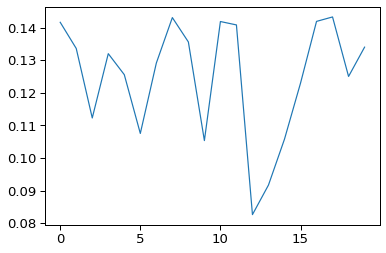

In [30]:
plt.plot(all_losses)

In [31]:
best_idx = np.argmin(all_losses)
best_idx

12

In [35]:
all_cv_scores[best_idx]

{'train_r2': array([0.98980159, 0.92671362, 0.90196712, 0.81372944, 0.80029761]),
 'validate_r2': array([0.99417527, 0.87659318, 0.92560411, 0.69132245, 0.99187543]),
 'train_rmsd': array([0.01982667, 0.08925851, 0.0955258 , 0.09650787, 0.09686248]),
 'validate_rmsd': array([0.01089676, 0.12046526, 0.10293094, 0.14526352, 0.03339912])}

In [32]:
best_emulator = all_emulators[best_idx]
best_emulator

In [33]:
best_emulator.train(retrain=True)

[INFO] >>> Training model on 80% of the dataset, testing on 20%...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)
/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)


[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.142          0.321         -3.149          0.415 *
[INFO]             100          0.525          0.154          0.131          0.198 *
[INFO]             200          0.810          0.095          0.680          0.123 *
[INFO]             300          0.906          0.069          0.435          0.162
[INFO]             400          0.893          0.073          0.520          0.151
[INFO]             500          0.854          0.084          0.504          0.152
[INFO]             600          0.907          0.067          0.513          0.147
[INFO]             700          0.964          0.041          0.473          0.153
[INFO]             800          0.956          0.046          0.425          0.16

[INFO]            8700          0.992          0.019          0.731          0.113
[INFO]            8800          0.991          0.021          0.624          0.129
[INFO]            8900          0.985          0.027          0.629          0.129
[INFO]            9000          0.996          0.014          0.600          0.132
[INFO]            9100          0.978          0.032          0.530          0.142
[INFO]            9200          0.993          0.018          0.586          0.135
[INFO]            9300          0.984          0.028          0.601          0.132
[INFO]            9400          0.993          0.019          0.681          0.121
[INFO]            9500          0.992          0.020          0.475          0.150
[INFO]            9600          0.984          0.027          0.644          0.126
[INFO]            9700          0.986          0.026          0.598          0.134
[INFO]            9800          0.985          0.027          0.648          0.126
[INF

{'train_r2': 0.9789589827123557,
 'test_r2': 0.8107964701203709,
 'train_rmsd': 0.03152981682370468,
 'test_rmsd': 0.09575275039431101}

In [34]:
best_emulator.save('emulator_suzuki_ii_BayesNeuralNet')

PicklingError: Can't pickle <class 'olympus.utils.data_transformer.DataTransformer'>: it's not the same object as olympus.utils.data_transformer.DataTransformer

In [12]:
# new emulator with optimized hparams

hyperparams_ii = {'batch_size': 10,
 'hidden_act': 'leaky_relu',
 'hidden_depth': 2,
 'hidden_nodes': 32,
 'learning_rate': 0.004232264206818328,
 'reg': 0.0019391955973643918}



In [13]:
model  = BayesNeuralNet(
        **hyperparams_ii, out_act='sigmoid', 
    )
emulator = Emulator(
    dataset='suzuki_ii', model=model, 
    feature_transform='standardize', target_transform='normalize',
)

In [14]:
emulator.train()

[INFO] >>> Training model on 80% of the dataset, testing on 20%...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)
/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)


[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0        -10.950          0.405         -0.041          0.321 *
[INFO]             100          0.252          0.103          0.790          0.141 *
[INFO]             200          0.747          0.060          0.835          0.124 *
[INFO]             300          0.804          0.053          0.914          0.089 *
[INFO]             400          0.782          0.055          0.920          0.087 *
[INFO]             500          0.865          0.043          0.798          0.136
[INFO]             600          0.725          0.061          0.856          0.115
[INFO]             700          0.924          0.032          0.899          0.096
[INFO]             800          0.958          0.024          0.862          

[INFO]            8500          0.977          0.018          0.814          0.133
[INFO]            8600          0.978          0.017          0.809          0.134
[INFO]            8700          0.941          0.029          0.771          0.148
[INFO]            8800          0.910          0.035          0.891          0.102
[INFO]            8900          0.976          0.018          0.888          0.103
[INFO]            9000          0.986          0.014          0.808          0.135
[INFO]            9100          0.932          0.031          0.814          0.132
[INFO]            9200          0.967          0.022          0.811          0.133
[INFO]            9300          0.996          0.008          0.830          0.127
[INFO]            9400          0.990          0.012          0.820          0.130
[INFO]            9500          0.960          0.023          0.821          0.131
[INFO]            9600          0.969          0.021          0.773          0.147
[INF

{'train_r2': 0.8902770049056096,
 'test_r2': 0.9335628848705726,
 'train_rmsd': 0.03905941046585664,
 'test_rmsd': 0.0787715902097521}

In [15]:
emulator.save('emulator_suzuki_ii_BayesNeuralNet')

## `dataset_suzuki_iii`

In [36]:
search_space = {
    'batch_size': hp.quniform('batch_size', 10, 50, 10),
    'hidden_act': hp.choice('hidden_act', ['leaky_relu'] ),
    'hidden_depth': hp.quniform('hidden_depth', 2, 5, 1),
    'hidden_nodes': hp.quniform('hidden_nodes', 28, 64, 4),
    'learning_rate': hp.uniform('learning_rate', 1e-5, 5e-3),
    'reg': hp.uniform('reg', 0.001, 0.1)
}

int_params = ['batch_size', 'hidden_depth', 'hidden_nodes']

all_emulators = []
all_losses = []
all_cv_scores = []
all_params = []

def objective(params):
    ''' average performance over cross-validation folds '''
    # build emualtor
    print(f'PARAMS : {params}')
    for param, val in params.items():
        if param in int_params:
            params[param] = int(val)
    model  = BayesNeuralNet(
        **params, out_act='sigmoid', 
    )
    emulator = Emulator(
        dataset='suzuki_iii', model=model, 
        feature_transform='standardize', target_transform='normalize',
    )

    cv_scores = emulator.cross_validate()
    loss = np.mean(cv_scores['validate_rmsd'])
    
    all_losses.append(loss)
    all_cv_scores.append(cv_scores)
    all_params.append(params)
    all_emulators.append(emulator)
    
    return {'loss': loss, 'status': STATUS_OK}

In [37]:
trials = Trials()

best = fmin(
    fn=objective,
    space=search_space, 
    algo=tpe.suggest, 
    max_evals=25,
    trials=trials
)

print(f"BEST VALUE : {best}")

PARAMS : {'batch_size': 40.0, 'hidden_act': 'leaky_relu', 'hidden_depth': 4.0, 'hidden_nodes': 60.0, 'learning_rate': 0.002632990372966508, 'reg': 0.08041948113041246}                                  
  0%|                                                                                                                                                             | 0/25 [00:00<?, ?trial/s, best loss=?][INFO] >>> Training model on fold #0...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.049          0.363         -0.085          0.339 *
[INFO]             100          0.976          0.055          0.950          0.075 *
[INFO]             200          0.977          0.053          0.961          0.070 *
[INFO]             300          0.977          0.052          0.956          0.068 *
[INFO]             400          0.980          0.050          0.920          0.095
[INFO]             500          0.974          0.055          0.938          0.081
[INFO]             600          0.980          0.050          0.907          0.105
[INFO]             700          0.978          0.053          0.912          0.099
[INFO]             800          0.977          0.053          0.956          0.

[INFO]            8500          0.999          0.011          0.962          0.064
[INFO]            8600          0.999          0.013          0.961          0.066
[INFO]            8700          0.999          0.011          0.965          0.062
[INFO]            8800          0.999          0.013          0.965          0.062
[INFO]            8900          0.999          0.012          0.960          0.066
[INFO]            9000          0.999          0.012          0.964          0.063
[INFO]            9100          0.998          0.016          0.965          0.062
[INFO]            9200          0.999          0.011          0.962          0.064
[INFO]            9300          0.999          0.013          0.959          0.066
[INFO]            9400          0.998          0.014          0.962          0.064
[INFO]            9500          0.999          0.013          0.946          0.078
[INFO]            9600          0.999          0.011          0.882          0.121
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.093          0.350         -0.238          0.383 *
[INFO]             100          0.980          0.047          0.961          0.067 *
[INFO]             200          0.976          0.051          0.943          0.079
[INFO]             300          0.981          0.045          0.950          0.075
[INFO]             400          0.980          0.047          0.938          0.081
[INFO]             500          0.967          0.060          0.937          0.082
[INFO]             600          0.962          0.063          0.951          0.073
[INFO]             700          0.974          0.055          0.947          0.075
[INFO]             800          0.972          0.055          0.924          0.090


[INFO]            8400          0.999          0.011          0.964          0.064
[INFO]            8500          0.999          0.011          0.962          0.065
[INFO]            8600          0.999          0.010          0.965          0.064
[INFO]            8700          0.999          0.009          0.960          0.067
[INFO]            8800          0.999          0.010          0.962          0.065
[INFO]            8900          0.999          0.009          0.963          0.065
[INFO]            9000          0.999          0.011          0.964          0.064
[INFO]            9100          0.999          0.012          0.960          0.067
[INFO]            9200          0.999          0.009          0.957          0.070
[INFO]            9300          0.999          0.010          0.956          0.071
[INFO]            9400          0.999          0.009          0.959          0.068
[INFO]            9500          0.999          0.010          0.955          0.071
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.114          0.358         -0.842          0.436 *
[INFO]             100          0.970          0.058          0.825          0.149 *
[INFO]             200          0.974          0.055          0.789          0.161
[INFO]             300          0.972          0.057          0.856          0.139 *
[INFO]             400          0.965          0.063          0.862          0.130 *
[INFO]             500          0.975          0.053          0.885          0.117 *
[INFO]             600          0.972          0.056          0.802          0.160
[INFO]             700          0.966          0.061          0.818          0.151
[INFO]             800          0.975          0.054          0.741          

[INFO]            8600          0.999          0.009          0.733          0.177
[INFO]            8700          0.999          0.011          0.730          0.178
[INFO]            8800          0.999          0.011          0.730          0.179
[INFO]            8900          0.999          0.009          0.725          0.179
[INFO]            9000          0.999          0.010          0.719          0.182
[INFO]            9100          0.999          0.009          0.738          0.176
[INFO]            9200          0.999          0.009          0.725          0.179
[INFO]            9300          0.999          0.010          0.734          0.177
[INFO]            9400          0.999          0.009          0.720          0.181
[INFO]            9500          0.999          0.009          0.740          0.175
[INFO]            9600          0.999          0.011          0.771          0.160
[INFO]            9700          0.999          0.009          0.776          0.161
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.007          0.374         -0.105          0.336 *
[INFO]             100          0.982          0.050          0.960          0.061 *
[INFO]             200          0.974          0.060          0.950          0.067
[INFO]             300          0.984          0.047          0.953          0.066
[INFO]             400          0.979          0.054          0.953          0.066
[INFO]             500          0.979          0.053          0.961          0.061 *
[INFO]             600          0.982          0.050          0.960          0.063
[INFO]             700          0.981          0.050          0.959          0.062
[INFO]             800          0.978          0.056          0.920          0.08

[INFO]            8500          0.998          0.018          0.945          0.074
[INFO]            8600          0.998          0.019          0.947          0.073
[INFO]            8700          0.998          0.018          0.941          0.076
[INFO]            8800          0.998          0.018          0.936          0.079
[INFO]            8900          0.996          0.022          0.940          0.077
[INFO]            9000          0.997          0.019          0.949          0.071
[INFO]            9100          0.998          0.018          0.943          0.076
[INFO]            9200          0.998          0.018          0.939          0.077
[INFO]            9300          0.998          0.018          0.944          0.074
[INFO]            9400          0.998          0.017          0.947          0.073
[INFO]            9500          0.998          0.018          0.944          0.074
[INFO]            9600          0.998          0.018          0.942          0.075
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.072          0.385         -0.049          0.402 *
[INFO]             100          0.972          0.061          0.950          0.088 *
[INFO]             200          0.974          0.059          0.949          0.088
[INFO]             300          0.974          0.059          0.956          0.082 *
[INFO]             400          0.978          0.054          0.940          0.096
[INFO]             500          0.976          0.056          0.939          0.096
[INFO]             600          0.958          0.075          0.936          0.100
[INFO]             700          0.975          0.059          0.948          0.089
[INFO]             800          0.978          0.055          0.932          0.10

[INFO]            8600          0.997          0.020          0.681          0.226
[INFO]            8700          0.997          0.020          0.689          0.223
[INFO]            8800          0.997          0.020          0.690          0.223
[INFO]            8900          0.997          0.019          0.688          0.223
[INFO]            9000          0.997          0.020          0.692          0.222
[INFO]            9100          0.997          0.020          0.692          0.222
[INFO]            9200          0.997          0.020          0.688          0.223
[INFO]            9300          0.997          0.020          0.686          0.224
[INFO]            9400          0.997          0.019          0.692          0.222
[INFO]            9500          0.997          0.019          0.688          0.223
[INFO]            9600          0.997          0.018          0.686          0.224
[INFO]            9700          0.997          0.021          0.696          0.221
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.468          0.418         -0.326          0.362 *
[INFO]             100          0.978          0.052          0.869          0.108 *
[INFO]             200          0.985          0.042          0.922          0.086 *
[INFO]             300          0.986          0.042          0.917          0.086
[INFO]             400          0.983          0.047          0.893          0.098
[INFO]             500          0.986          0.044          0.914          0.088
[INFO]             600          0.987          0.040          0.914          0.088
[INFO]             700          0.979          0.049          0.896          0.098
[INFO]             800          0.987          0.039          0.886          0.10

[INFO]            8400          0.999          0.011          0.938          0.076
[INFO]            8500          0.999          0.011          0.935          0.079
[INFO]            8600          0.999          0.012          0.936          0.078
[INFO]            8700          0.999          0.011          0.936          0.078
[INFO]            8800          0.999          0.012          0.937          0.077
[INFO]            8900          0.999          0.014          0.938          0.077
[INFO]            9000          0.999          0.010          0.941          0.075
[INFO]            9100          0.999          0.013          0.937          0.078
[INFO]            9200          0.999          0.010          0.938          0.077
[INFO]            9300          0.999          0.009          0.934          0.080
[INFO]            9400          0.999          0.010          0.939          0.076
[INFO]            9500          0.999          0.010          0.936          0.078
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.040          0.355         -0.025          0.360 *
[INFO]             100          0.978          0.052          0.948          0.078 *
[INFO]             200          0.982          0.047          0.954          0.076 *
[INFO]             300          0.967          0.063          0.963          0.066 *
[INFO]             400          0.982          0.047          0.964          0.065 *
[INFO]             500          0.982          0.046          0.931          0.092
[INFO]             600          0.982          0.048          0.953          0.074
[INFO]             700          0.979          0.050          0.940          0.085
[INFO]             800          0.981          0.047          0.938          

[INFO]            8500          0.997          0.020          0.949          0.081
[INFO]            8600          0.997          0.021          0.950          0.081
[INFO]            8700          0.998          0.017          0.952          0.079
[INFO]            8800          0.996          0.021          0.945          0.084
[INFO]            8900          0.997          0.020          0.949          0.082
[INFO]            9000          0.997          0.019          0.955          0.076
[INFO]            9100          0.998          0.017          0.949          0.082
[INFO]            9200          0.997          0.019          0.948          0.082
[INFO]            9300          0.997          0.018          0.945          0.084
[INFO]            9400          0.997          0.019          0.946          0.084
[INFO]            9500          0.997          0.020          0.946          0.083
[INFO]            9600          0.997          0.018          0.945          0.085
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.171          0.347         -0.141          0.400 *
[INFO]             100          0.954          0.065          0.973          0.059 *
[INFO]             200          0.976          0.052          0.985          0.046 *
[INFO]             300          0.980          0.047          0.985          0.046
[INFO]             400          0.979          0.046          0.983          0.046
[INFO]             500          0.978          0.047          0.961          0.069
[INFO]             600          0.974          0.051          0.981          0.051
[INFO]             700          0.980          0.046          0.974          0.059
[INFO]             800          0.978          0.047          0.981          0.05

[INFO]            8600          0.994          0.026          0.985          0.047
[INFO]            8700          0.995          0.022          0.982          0.051
[INFO]            8800          0.994          0.027          0.984          0.047
[INFO]            8900          0.995          0.024          0.983          0.049
[INFO]            9000          0.995          0.023          0.983          0.050
[INFO]            9100          0.995          0.023          0.984          0.048
[INFO]            9200          0.995          0.023          0.985          0.047
[INFO]            9300          0.996          0.021          0.983          0.050
[INFO]            9400          0.996          0.022          0.983          0.050
[INFO]            9500          0.995          0.023          0.982          0.051
[INFO]            9600          0.995          0.023          0.983          0.050
[INFO]            9700          0.996          0.021          0.985          0.047
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.049          0.366         -0.061          0.351 *
[INFO]             100          0.978          0.053          0.906          0.103 *
[INFO]             200          0.981          0.049          0.921          0.097 *
[INFO]             300          0.973          0.059          0.923          0.096 *
[INFO]             400          0.976          0.055          0.928          0.092 *
[INFO]             500          0.972          0.060          0.922          0.096
[INFO]             600          0.979          0.052          0.916          0.099
[INFO]             700          0.975          0.057          0.936          0.086 *
[INFO]             800          0.971          0.061          0.950        

[INFO]            8600          0.996          0.021          0.829          0.140
[INFO]            8700          0.997          0.019          0.831          0.139
[INFO]            8800          0.998          0.015          0.823          0.143
[INFO]            8900          0.998          0.014          0.823          0.142
[INFO]            9000          0.998          0.016          0.833          0.139
[INFO]            9100          0.997          0.019          0.835          0.138
[INFO]            9200          0.998          0.014          0.825          0.142
[INFO]            9300          0.998          0.016          0.828          0.141
[INFO]            9400          0.998          0.015          0.815          0.145
[INFO]            9500          0.994          0.027          0.818          0.144
[INFO]            9600          0.998          0.015          0.823          0.142
[INFO]            9700          0.998          0.014          0.829          0.140
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.087          0.374         -0.162          0.351 *
[INFO]             100          0.978          0.053          0.929          0.093 *
[INFO]             200          0.984          0.044          0.921          0.098
[INFO]             300          0.982          0.048          0.938          0.087 *
[INFO]             400          0.984          0.044          0.952          0.076 *
[INFO]             500          0.985          0.045          0.915          0.100
[INFO]             600          0.981          0.048          0.968          0.058 *
[INFO]             700          0.982          0.048          0.970          0.055 *
[INFO]             800          0.984          0.044          0.967        

[INFO]            8500          0.998          0.018          0.813          0.136
[INFO]            8600          0.998          0.017          0.815          0.137
[INFO]            8700          0.997          0.019          0.827          0.131
[INFO]            8800          0.997          0.020          0.826          0.130
[INFO]            8900          0.998          0.018          0.799          0.146
[INFO]            9000          0.998          0.018          0.812          0.138
[INFO]            9100          0.998          0.018          0.813          0.137
[INFO]            9200          0.997          0.020          0.814          0.137
[INFO]            9300          0.998          0.017          0.800          0.143
[INFO]            9400          0.998          0.016          0.805          0.141
[INFO]            9500          0.998          0.016          0.821          0.134
[INFO]            9600          0.998          0.018          0.827          0.131
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.056          0.312         -0.053          0.317 *
[INFO]             100          0.937          0.074          0.793          0.141 *
[INFO]             200          0.955          0.064          0.847          0.122 *
[INFO]             300          0.963          0.059          0.830          0.129
[INFO]             400          0.975          0.050          0.833          0.127
[INFO]             500          0.973          0.050          0.836          0.126
[INFO]             600          0.960          0.062          0.844          0.122
[INFO]             700          0.961          0.061          0.775          0.147
[INFO]             800          0.957          0.064          0.777          0.14

[INFO]            8600          0.995          0.021          0.735          0.159
[INFO]            8700          0.996          0.018          0.717          0.164
[INFO]            8800          0.994          0.022          0.746          0.155
[INFO]            8900          0.997          0.017          0.732          0.160
[INFO]            9000          0.995          0.022          0.739          0.157
[INFO]            9100          0.995          0.021          0.719          0.163
[INFO]            9200          0.994          0.023          0.722          0.163
[INFO]            9300          0.996          0.020          0.708          0.166
[INFO]            9400          0.996          0.020          0.731          0.160
[INFO]            9500          0.997          0.017          0.732          0.159
[INFO]            9600          0.997          0.015          0.713          0.165
[INFO]            9700          0.996          0.019          0.705          0.167
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.554          0.398         -0.164          0.348 *
[INFO]             100          0.883          0.113          0.794          0.158 *
[INFO]             200          0.962          0.063          0.839          0.136 *
[INFO]             300          0.966          0.060          0.839          0.137
[INFO]             400          0.972          0.055          0.825          0.142
[INFO]             500          0.981          0.044          0.861          0.129 *
[INFO]             600          0.983          0.044          0.837          0.141
[INFO]             700          0.970          0.058          0.825          0.143
[INFO]             800          0.984          0.042          0.824          0.

[INFO]            8500          0.997          0.018          0.782          0.148
[INFO]            8600          0.998          0.016          0.774          0.154
[INFO]            8700          0.998          0.015          0.779          0.153
[INFO]            8800          0.998          0.014          0.788          0.151
[INFO]            8900          0.997          0.018          0.778          0.152
[INFO]            9000          0.998          0.014          0.776          0.155
[INFO]            9100          0.998          0.015          0.791          0.150
[INFO]            9200          0.997          0.018          0.789          0.151
[INFO]            9300          0.998          0.016          0.785          0.151
[INFO]            9400          0.998          0.015          0.737          0.162
[INFO]            9500          0.998          0.014          0.788          0.151
[INFO]            9600          0.998          0.016          0.783          0.151
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.050          0.376         -0.071          0.337 *
[INFO]             100          0.962          0.070          0.933          0.078 *
[INFO]             200          0.978          0.051          0.943          0.074 *
[INFO]             300          0.985          0.041          0.943          0.074 *
[INFO]             400          0.992          0.031          0.939          0.076
[INFO]             500          0.987          0.039          0.906          0.098
[INFO]             600          0.986          0.039          0.914          0.091
[INFO]             700          0.991          0.033          0.906          0.097
[INFO]             800          0.990          0.035          0.928          0.

[INFO]            8500          0.997          0.019          0.926          0.089
[INFO]            8600          0.997          0.019          0.929          0.087
[INFO]            8700          0.998          0.016          0.926          0.089
[INFO]            8800          0.998          0.017          0.928          0.087
[INFO]            8900          0.997          0.019          0.928          0.088
[INFO]            9000          0.997          0.019          0.925          0.089
[INFO]            9100          0.997          0.021          0.927          0.088
[INFO]            9200          0.996          0.022          0.928          0.088
[INFO]            9300          0.998          0.018          0.931          0.085
[INFO]            9400          0.997          0.019          0.926          0.089
[INFO]            9500          0.997          0.020          0.925          0.089
[INFO]            9600          0.997          0.019          0.925          0.089
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.130          0.346         -0.095          0.366 *
[INFO]             100          0.885          0.103          0.851          0.124 *
[INFO]             200          0.954          0.068          0.896          0.114 *
[INFO]             300          0.964          0.060          0.922          0.100 *
[INFO]             400          0.956          0.066          0.917          0.099 *
[INFO]             500          0.961          0.063          0.918          0.101
[INFO]             600          0.968          0.056          0.925          0.096 *
[INFO]             700          0.953          0.069          0.937          0.086 *
[INFO]             800          0.970          0.055          0.920      

[INFO]            8500          0.996          0.020          0.929          0.092
[INFO]            8600          0.996          0.021          0.932          0.091
[INFO]            8700          0.996          0.021          0.933          0.090
[INFO]            8800          0.996          0.021          0.936          0.088
[INFO]            8900          0.996          0.020          0.933          0.090
[INFO]            9000          0.996          0.020          0.930          0.092
[INFO]            9100          0.996          0.020          0.930          0.092
[INFO]            9200          0.996          0.020          0.927          0.094
[INFO]            9300          0.996          0.020          0.930          0.092
[INFO]            9400          0.997          0.019          0.931          0.091
[INFO]            9500          0.996          0.020          0.923          0.096
[INFO]            9600          0.997          0.019          0.929          0.093
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.123          0.296         -0.053          0.383 *
[INFO]             100          0.951          0.057          0.874          0.127 *
[INFO]             200          0.960          0.054          0.939          0.091 *
[INFO]             300          0.974          0.042          0.938          0.091 *
[INFO]             400          0.974          0.043          0.937          0.092
[INFO]             500          0.973          0.043          0.950          0.081 *
[INFO]             600          0.973          0.044          0.944          0.086
[INFO]             700          0.970          0.045          0.948          0.083
[INFO]             800          0.946          0.065          0.938          

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.033          0.367         -0.064          0.375 *
[INFO]             100          0.822          0.101          0.728          0.193 *
[INFO]             200          0.946          0.057          0.946          0.086 *
[INFO]             300          0.945          0.057          0.983          0.048 *
[INFO]             400          0.956          0.052          0.984          0.046 *
[INFO]             500          0.948          0.056          0.988          0.040 *
[INFO]             600          0.960          0.050          0.966          0.068
[INFO]             700          0.956          0.052          0.982          0.049
[INFO]             800          0.962          0.049          0.980        

[INFO]           17400          0.990          0.025          0.979          0.054
[INFO]           17500          0.991          0.025          0.982          0.050
[INFO]           17600          0.992          0.023          0.978          0.055
[INFO]           17700          0.991          0.024          0.982          0.050
[INFO]           17800          0.993          0.022          0.977          0.055
[INFO]           17900          0.993          0.021          0.983          0.049
[INFO]           18000          0.993          0.021          0.978          0.055
[INFO]           18100          0.993          0.022          0.978          0.055
[INFO]           18200          0.992          0.023          0.975          0.058
[INFO]           18300          0.992          0.023          0.978          0.055
[INFO]           18400          0.993          0.022          0.980          0.052
[INFO]           18500          0.995          0.019          0.977          0.056
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.268          0.324         -0.841          0.360 *
[INFO]             100          0.840          0.098          0.621          0.184 *
[INFO]             200          0.954          0.058          0.695          0.163 *
[INFO]             300          0.969          0.048          0.858          0.105 *
[INFO]             400          0.958          0.054          0.805          0.125
[INFO]             500          0.977          0.042          0.837          0.114
[INFO]             600          0.987          0.032          0.863          0.103 *
[INFO]             700          0.962          0.050          0.857          0.107
[INFO]             800          0.968          0.048          0.884          

[INFO]            8400          0.993          0.022          0.944          0.063
[INFO]            8500          0.997          0.015          0.954          0.056
[INFO]            8600          0.992          0.025          0.973          0.043 *
[INFO]            8700          0.996          0.017          0.958          0.054
[INFO]            8800          0.995          0.020          0.959          0.054
[INFO]            8900          0.997          0.017          0.957          0.055
[INFO]            9000          0.996          0.017          0.966          0.048
[INFO]            9100          0.996          0.020          0.957          0.054
[INFO]            9200          0.995          0.018          0.959          0.052
[INFO]            9300          0.996          0.019          0.964          0.050
[INFO]            9400          0.997          0.015          0.960          0.052
[INFO]            9500          0.996          0.019          0.970          0.047
[I

[INFO]           17300          0.998          0.012          0.977          0.040
[INFO]           17400          0.998          0.014          0.979          0.038
[INFO]           17500          0.997          0.015          0.978          0.040
[INFO]           17600          0.998          0.012          0.979          0.038
[INFO]           17700          0.998          0.012          0.972          0.044
[INFO]           17800          0.998          0.012          0.978          0.039
[INFO]           17900          0.998          0.011          0.976          0.040
[INFO]           18000          0.999          0.011          0.979          0.038
[INFO]           18100          0.997          0.015          0.981          0.037
[INFO]           18200          0.999          0.010          0.974          0.042
[INFO]           18300          0.998          0.012          0.975          0.041
[INFO]           18400          0.999          0.011          0.977          0.040
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.530          0.400         -0.796          0.375 *
[INFO]             100          0.873          0.096          0.887          0.096 *
[INFO]             200          0.980          0.046          0.962          0.054 *
[INFO]             300          0.983          0.045          0.971          0.049 *
[INFO]             400          0.984          0.042          0.982          0.046 *
[INFO]             500          0.992          0.032          0.972          0.043 *
[INFO]             600          0.990          0.037          0.973          0.049
[INFO]             700          0.988          0.037          0.982          0.042 *
[INFO]             800          0.986          0.040          0.979      

[INFO]            8600          0.995          0.025          0.978          0.051
[INFO]            8700          0.994          0.027          0.946          0.059
[INFO]            8800          0.995          0.027          0.981          0.045
[INFO]            8900          0.997          0.021          0.977          0.049
[INFO]            9000          0.996          0.025          0.980          0.044
[INFO]            9100          0.995          0.028          0.982          0.041
[INFO]            9200          0.995          0.027          0.975          0.050
[INFO]            9300          0.995          0.024          0.967          0.048
[INFO]            9400          0.995          0.025          0.978          0.044
[INFO]            9500          0.997          0.021          0.972          0.046
[INFO]            9600          0.996          0.024          0.917          0.066
[INFO]            9700          0.995          0.027          0.969          0.050
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.024          0.362         -0.057          0.345 *
[INFO]             100          0.918          0.105          0.923          0.091 *
[INFO]             200          0.971          0.061          0.963          0.059 *
[INFO]             300          0.968          0.067          0.977          0.048 *
[INFO]             400          0.986          0.042          0.980          0.044 *
[INFO]             500          0.984          0.045          0.977          0.047
[INFO]             600          0.979          0.050          0.975          0.049
[INFO]             700          0.989          0.037          0.987          0.037 *
[INFO]             800          0.951          0.074          0.982        

[INFO]            8500          0.994          0.029          0.973          0.055
[INFO]            8600          0.996          0.023          0.978          0.051
[INFO]            8700          0.995          0.026          0.974          0.055
[INFO]            8800          0.996          0.023          0.972          0.056
[INFO]            8900          0.996          0.022          0.978          0.050
[INFO]            9000          0.994          0.029          0.973          0.055
[INFO]            9100          0.994          0.028          0.973          0.055
[INFO]            9200          0.995          0.027          0.974          0.054
[INFO]            9300          0.995          0.026          0.969          0.058
[INFO]            9400          0.992          0.033          0.971          0.058
[INFO]            9500          0.993          0.031          0.964          0.064
[INFO]            9600          0.996          0.022          0.970          0.058
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.036          0.368         -0.075          0.371 *
[INFO]             100          0.877          0.117          0.904          0.104 *
[INFO]             200          0.965          0.066          0.945          0.077 *
[INFO]             300          0.988          0.039          0.951          0.075 *
[INFO]             400          0.987          0.041          0.966          0.064 *
[INFO]             500          0.992          0.032          0.969          0.060 *
[INFO]             600          0.987          0.043          0.972          0.054 *
[INFO]             700          0.992          0.034          0.958          0.067
[INFO]             800          0.992          0.033          0.967      

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.124          0.382         -0.115          0.385 *
[INFO]             100          0.927          0.095          0.982          0.049 *
[INFO]             200          0.950          0.079          0.979          0.050
[INFO]             300          0.962          0.069          0.976          0.058
[INFO]             400          0.965          0.068          0.964          0.068
[INFO]             500          0.954          0.076          0.986          0.041 *
[INFO]             600          0.976          0.056          0.978          0.050
[INFO]             700          0.958          0.073          0.972          0.058
[INFO]             800          0.979          0.052          0.989          0.03

[INFO]            8500          0.995          0.026          0.977          0.057
[INFO]            8600          0.994          0.027          0.976          0.057
[INFO]            8700          0.996          0.022          0.982          0.051
[INFO]            8800          0.996          0.023          0.981          0.050
[INFO]            8900          0.997          0.021          0.980          0.053
[INFO]            9000          0.996          0.024          0.978          0.056
[INFO]            9100          0.992          0.031          0.980          0.052
[INFO]            9200          0.995          0.025          0.977          0.056
[INFO]            9300          0.996          0.024          0.978          0.054
[INFO]            9400          0.996          0.024          0.980          0.052
[INFO]            9500          0.996          0.021          0.983          0.048
[INFO]            9600          0.995          0.025          0.979          0.053
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.037          0.378         -0.212          0.368 *
[INFO]             100          0.971          0.062          0.812          0.146 *
[INFO]             200          0.954          0.080          0.787          0.157
[INFO]             300          0.978          0.053          0.807          0.149
[INFO]             400          0.973          0.064          0.724          0.178
[INFO]             500          0.945          0.084          0.818          0.145 *
[INFO]             600          0.965          0.069          0.776          0.160
[INFO]             700          0.980          0.052          0.755          0.167
[INFO]             800          0.915          0.109          0.736          0.17

[INFO]            8500          0.997          0.020          0.752          0.168
[INFO]            8600          0.997          0.019          0.762          0.165
[INFO]            8700          0.997          0.020          0.761          0.165
[INFO]            8800          0.996          0.023          0.763          0.165
[INFO]            8900          0.998          0.017          0.761          0.165
[INFO]            9000          0.997          0.022          0.762          0.165
[INFO]            9100          0.997          0.021          0.758          0.166
[INFO]            9200          0.995          0.026          0.765          0.164
[INFO]            9300          0.997          0.020          0.777          0.160
[INFO]            9400          0.996          0.024          0.757          0.167
[INFO]            9500          0.997          0.019          0.757          0.167
[INFO]            9600          0.996          0.023          0.755          0.167
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.040          0.376         -0.039          0.392 *
[INFO]             100          0.977          0.056          0.914          0.107 *
[INFO]             200          0.950          0.071          0.861          0.133
[INFO]             300          0.952          0.070          0.872          0.132
[INFO]             400          0.969          0.056          0.908          0.108
[INFO]             500          0.975          0.055          0.886          0.122
[INFO]             600          0.954          0.075          0.889          0.122
[INFO]             700          0.965          0.061          0.919          0.106 *
[INFO]             800          0.972          0.059          0.898          0.12

[INFO]            8500          0.997          0.020          0.958          0.079
[INFO]            8600          0.997          0.019          0.955          0.081
[INFO]            8700          0.998          0.016          0.963          0.073
[INFO]            8800          0.998          0.016          0.965          0.072
[INFO]            8900          0.999          0.013          0.963          0.073
[INFO]            9000          0.998          0.018          0.967          0.070
[INFO]            9100          0.999          0.013          0.961          0.076
[INFO]            9200          0.999          0.014          0.962          0.073
[INFO]            9300          0.998          0.016          0.964          0.073
[INFO]            9400          0.999          0.013          0.965          0.072
[INFO]            9500          0.999          0.015          0.961          0.075
[INFO]            9600          0.998          0.018          0.962          0.074
[INF

[INFO]           17300          0.999          0.013          0.935          0.092
[INFO]           17400          0.999          0.013          0.949          0.083
[INFO]           17500          0.999          0.013          0.932          0.093
[INFO]           17600          0.997          0.022          0.954          0.079
[INFO]           17700          0.998          0.016          0.923          0.099
[INFO]           17800          0.999          0.012          0.945          0.086
[INFO]           17900          0.999          0.013          0.937          0.090
[INFO]           18000          0.999          0.012          0.937          0.091
[INFO]           18100          0.999          0.013          0.948          0.084
[INFO]           18200          0.999          0.015          0.943          0.087
[INFO]           18300          0.999          0.013          0.925          0.098
[INFO]           18400          0.999          0.012          0.943          0.087
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.092          0.331         -0.044          0.372 *
[INFO]             100          0.933          0.080          0.907          0.112 *
[INFO]             200          0.972          0.054          0.852          0.140
[INFO]             300          0.969          0.054          0.842          0.142
[INFO]             400          0.949          0.069          0.856          0.135
[INFO]             500          0.967          0.057          0.908          0.107 *
[INFO]             600          0.953          0.068          0.825          0.150
[INFO]             700          0.971          0.053          0.788          0.164
[INFO]             800          0.974          0.052          0.810          0.15

[INFO]            8500          0.998          0.015          0.898          0.114
[INFO]            8600          0.998          0.015          0.882          0.123
[INFO]            8700          0.998          0.013          0.883          0.123
[INFO]            8800          0.998          0.014          0.881          0.124
[INFO]            8900          0.998          0.013          0.877          0.126
[INFO]            9000          0.998          0.014          0.882          0.123
[INFO]            9100          0.998          0.013          0.871          0.128
[INFO]            9200          0.998          0.013          0.888          0.120
[INFO]            9300          0.998          0.015          0.884          0.121
[INFO]            9400          0.998          0.015          0.887          0.120
[INFO]            9500          0.998          0.013          0.881          0.123
[INFO]            9600          0.999          0.013          0.879          0.125
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.108          0.395         -0.149          0.323 *
[INFO]             100          0.980          0.050          0.855          0.114 *
[INFO]             200          0.980          0.051          0.823          0.128
[INFO]             300          0.989          0.039          0.829          0.122
[INFO]             400          0.983          0.048          0.953          0.065 *
[INFO]             500          0.968          0.066          0.908          0.093
[INFO]             600          0.986          0.043          0.956          0.063 *
[INFO]             700          0.987          0.042          0.976          0.047 *
[INFO]             800          0.984          0.046          0.851          

[INFO]            8700          0.996          0.023          0.906          0.092
[INFO]            8800          0.997          0.022          0.911          0.089
[INFO]            8900          0.997          0.022          0.911          0.090
[INFO]            9000          0.997          0.022          0.905          0.093
[INFO]            9100          0.997          0.022          0.919          0.086
[INFO]            9200          0.997          0.022          0.913          0.089
[INFO]            9300          0.996          0.022          0.899          0.095
[INFO]            9400          0.997          0.020          0.919          0.086
[INFO]            9500          0.997          0.020          0.897          0.096
[INFO]            9600          0.996          0.025          0.913          0.089
[INFO]            9700          0.997          0.019          0.908          0.091
[INFO]            9800          0.997          0.021          0.931          0.080
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.021          0.368         -0.057          0.353 *
[INFO]             100          0.987          0.041          0.822          0.149 *
[INFO]             200          0.991          0.033          0.860          0.131 *
[INFO]             300          0.990          0.036          0.852          0.133
[INFO]             400          0.993          0.030          0.826          0.146
[INFO]             500          0.993          0.030          0.851          0.132
[INFO]             600          0.995          0.024          0.800          0.156
[INFO]             700          0.994          0.029          0.774          0.166
[INFO]             800          0.996          0.023          0.794          0.15

[INFO]            8500          0.999          0.011          0.813          0.150
[INFO]            8600          0.999          0.014          0.807          0.153
[INFO]            8700          0.999          0.009          0.824          0.144
[INFO]            8800          0.999          0.011          0.807          0.152
[INFO]            8900          0.999          0.010          0.846          0.133
[INFO]            9000          1.000          0.007          0.838          0.138
[INFO]            9100          0.998          0.014          0.790          0.160
[INFO]            9200          0.999          0.012          0.799          0.157
[INFO]            9300          0.999          0.011          0.818          0.147
[INFO]            9400          0.999          0.008          0.819          0.147
[INFO]            9500          0.999          0.010          0.827          0.143
[INFO]            9600          0.999          0.009          0.809          0.152
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.019          0.344         -0.035          0.398 *
[INFO]             100          0.966          0.062          0.963          0.078 *
[INFO]             200          0.980          0.046          0.951          0.089
[INFO]             300          0.986          0.039          0.961          0.082
[INFO]             400          0.983          0.042          0.975          0.064 *
[INFO]             500          0.992          0.031          0.970          0.070
[INFO]             600          0.986          0.039          0.974          0.062 *
[INFO]             700          0.991          0.032          0.968          0.066
[INFO]             800          0.993          0.030          0.955          0.

[INFO]            8600          1.000          0.004          0.960          0.077
[INFO]            8700          1.000          0.004          0.969          0.069
[INFO]            8800          1.000          0.004          0.964          0.073
[INFO]            8900          1.000          0.005          0.970          0.068
[INFO]            9000          1.000          0.005          0.963          0.074
[INFO]            9100          1.000          0.006          0.974          0.063
[INFO]            9200          1.000          0.003          0.968          0.070
[INFO]            9300          1.000          0.004          0.955          0.081
[INFO]            9400          1.000          0.003          0.973          0.063
[INFO]            9500          1.000          0.003          0.970          0.067
[INFO]            9600          1.000          0.005          0.965          0.072
[INFO]            9700          1.000          0.004          0.942          0.091
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.289          0.363         -0.034          0.395 *
[INFO]             100          0.984          0.040          0.926          0.104 *
[INFO]             200          0.987          0.036          0.923          0.106
[INFO]             300          0.989          0.032          0.942          0.093 *
[INFO]             400          0.991          0.030          0.948          0.086 *
[INFO]             500          0.992          0.029          0.944          0.090
[INFO]             600          0.991          0.029          0.949          0.085 *
[INFO]             700          0.990          0.031          0.954          0.081 *
[INFO]             800          0.993          0.026          0.935        

[INFO]            8600          0.999          0.009          0.957          0.078
[INFO]            8700          0.999          0.011          0.957          0.077
[INFO]            8800          1.000          0.007          0.958          0.077
[INFO]            8900          1.000          0.007          0.959          0.076
[INFO]            9000          0.999          0.008          0.953          0.082
[INFO]            9100          0.999          0.007          0.958          0.076
[INFO]            9200          0.999          0.008          0.957          0.078
[INFO]            9300          0.999          0.008          0.956          0.079
[INFO]            9400          1.000          0.007          0.956          0.079
[INFO]            9500          0.999          0.011          0.960          0.075
[INFO]            9600          0.999          0.011          0.957          0.078
[INFO]            9700          1.000          0.007          0.954          0.080
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.007          0.379         -0.013          0.359 *
[INFO]             100          0.981          0.052          0.976          0.055 *
[INFO]             200          0.985          0.046          0.979          0.052 *
[INFO]             300          0.990          0.037          0.968          0.063
[INFO]             400          0.993          0.031          0.961          0.068
[INFO]             500          0.990          0.038          0.945          0.081
[INFO]             600          0.996          0.023          0.971          0.060
[INFO]             700          0.995          0.026          0.963          0.067
[INFO]             800          0.996          0.022          0.957          0.07

[INFO]            8600          0.999          0.012          0.938          0.088
[INFO]            8700          0.999          0.011          0.940          0.086
[INFO]            8800          0.999          0.010          0.941          0.086
[INFO]            8900          0.999          0.011          0.940          0.086
[INFO]            9000          0.999          0.012          0.943          0.084
[INFO]            9100          0.999          0.011          0.940          0.086
[INFO]            9200          0.999          0.011          0.949          0.079
[INFO]            9300          0.999          0.013          0.943          0.085
[INFO]            9400          0.998          0.018          0.949          0.080
[INFO]            9500          0.999          0.012          0.940          0.086
[INFO]            9600          0.999          0.013          0.937          0.088
[INFO]            9700          0.999          0.010          0.936          0.089
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.114          0.372         -0.106          0.349 *
[INFO]             100          0.982          0.045          0.870          0.120 *
[INFO]             200          0.991          0.034          0.849          0.126
[INFO]             300          0.989          0.034          0.834          0.136
[INFO]             400          0.990          0.034          0.885          0.115 *
[INFO]             500          0.965          0.059          0.895          0.108 *
[INFO]             600          0.992          0.030          0.837          0.137
[INFO]             700          0.995          0.024          0.813          0.150
[INFO]             800          0.989          0.034          0.751          0.

[INFO]            8600          0.999          0.011          0.873          0.123
[INFO]            8700          0.999          0.010          0.896          0.111
[INFO]            8800          0.999          0.009          0.891          0.113
[INFO]            8900          0.999          0.010          0.892          0.114
[INFO]            9000          1.000          0.007          0.894          0.112
[INFO]            9100          0.999          0.009          0.899          0.110
[INFO]            9200          1.000          0.007          0.893          0.113
[INFO]            9300          1.000          0.007          0.894          0.113
[INFO]            9400          1.000          0.007          0.903          0.108
[INFO]            9500          1.000          0.004          0.903          0.108
[INFO]            9600          1.000          0.005          0.892          0.114
[INFO]            9700          0.999          0.009          0.920          0.097 *
[I

[INFO]           17400          1.000          0.003          0.917          0.099
[INFO]           17500          1.000          0.002          0.921          0.097
[INFO]           17600          0.999          0.009          0.921          0.097
[INFO]           17700          1.000          0.003          0.916          0.100
[INFO]           17800          1.000          0.002          0.915          0.101
[INFO]           17900          0.999          0.008          0.905          0.107
[INFO]           18000          1.000          0.002          0.923          0.095
[INFO]           18100          1.000          0.001          0.922          0.096
[INFO]           18200          1.000          0.006          0.918          0.099
[INFO]           18300          1.000          0.005          0.923          0.095
[INFO]           18400          1.000          0.003          0.915          0.101
[INFO]           18500          1.000          0.006          0.920          0.097
[INF

[INFO]           26200          1.000          0.001          0.944          0.081
[INFO]           26300          1.000          0.001          0.944          0.081
[INFO]           26400          1.000          0.001          0.945          0.081
[INFO]           26500          1.000          0.001          0.946          0.080
[INFO]           26600          1.000          0.001          0.945          0.081
[INFO]           26700          1.000          0.003          0.944          0.081
[INFO]           26800          1.000          0.003          0.944          0.081
[INFO]           26900          1.000          0.002          0.940          0.084
[INFO]           27000          1.000          0.001          0.942          0.082
[INFO]           27100          1.000          0.001          0.941          0.083
[INFO]           27200          1.000          0.001          0.940          0.084
[INFO]           27300          1.000          0.005          0.942          0.082
[INF

[INFO]           35200          1.000          0.002          0.937          0.087
[INFO]           35300          1.000          0.001          0.935          0.087
[INFO]           35400          1.000          0.001          0.936          0.087
[INFO]           35500          1.000          0.003          0.935          0.087
[INFO]           35600          1.000          0.001          0.933          0.089
[INFO]           35700          1.000          0.003          0.933          0.089
[INFO]           35800          1.000          0.007          0.934          0.089
[INFO]           35900          0.999          0.009          0.930          0.092
[INFO]           36000          1.000          0.004          0.936          0.088
[INFO]           36100          1.000          0.003          0.935          0.088
[INFO]           36200          1.000          0.002          0.937          0.087
[INFO]           36300          1.000          0.006          0.934          0.089
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.072          0.357         -0.356          0.370 *
[INFO]             100          0.921          0.095          0.828          0.131 *
[INFO]             200          0.978          0.051          0.879          0.110 *
[INFO]             300          0.987          0.039          0.895          0.103 *
[INFO]             400          0.987          0.039          0.879          0.110
[INFO]             500          0.991          0.033          0.890          0.105
[INFO]             600          0.991          0.032          0.881          0.109
[INFO]             700          0.992          0.029          0.886          0.107
[INFO]             800          0.993          0.028          0.897          0.

[INFO]            8400          0.999          0.010          0.906          0.097
[INFO]            8500          0.999          0.011          0.903          0.099
[INFO]            8600          0.999          0.011          0.902          0.099
[INFO]            8700          0.999          0.010          0.902          0.099
[INFO]            8800          0.999          0.010          0.906          0.097
[INFO]            8900          0.999          0.010          0.910          0.095
[INFO]            9000          0.999          0.010          0.905          0.098
[INFO]            9100          0.999          0.010          0.899          0.101
[INFO]            9200          0.999          0.010          0.897          0.102
[INFO]            9300          0.999          0.010          0.904          0.098
[INFO]            9400          0.999          0.011          0.905          0.098
[INFO]            9500          0.999          0.009          0.904          0.098
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.100          0.312         -0.030          0.325 *
[INFO]             100          0.936          0.071          0.838          0.135 *
[INFO]             200          0.979          0.042          0.859          0.123 *
[INFO]             300          0.984          0.036          0.838          0.133
[INFO]             400          0.985          0.036          0.849          0.126
[INFO]             500          0.982          0.039          0.824          0.136
[INFO]             600          0.985          0.036          0.871          0.118 *
[INFO]             700          0.986          0.036          0.813          0.140
[INFO]             800          0.983          0.039          0.876          0.

[INFO]            8400          0.998          0.015          0.884          0.105
[INFO]            8500          0.998          0.014          0.883          0.106
[INFO]            8600          0.998          0.014          0.884          0.105
[INFO]            8700          0.998          0.015          0.884          0.106
[INFO]            8800          0.998          0.013          0.878          0.108
[INFO]            8900          0.998          0.014          0.878          0.108
[INFO]            9000          0.998          0.015          0.886          0.104
[INFO]            9100          0.998          0.014          0.882          0.106
[INFO]            9200          0.999          0.012          0.879          0.107
[INFO]            9300          0.998          0.013          0.874          0.110
[INFO]            9400          0.998          0.015          0.873          0.111
[INFO]            9500          0.999          0.012          0.877          0.109
[INF

[INFO]           17200          1.000          0.005          0.894          0.099
[INFO]           17300          1.000          0.005          0.899          0.097
[INFO]           17400          1.000          0.005          0.895          0.099
[INFO]           17500          1.000          0.005          0.893          0.100
[INFO]           17600          1.000          0.005          0.895          0.099
[INFO]           17700          1.000          0.005          0.897          0.098
[INFO]           17800          1.000          0.006          0.896          0.098
[INFO]           17900          1.000          0.005          0.900          0.096
[INFO]           18000          1.000          0.007          0.891          0.101
[INFO]           18100          1.000          0.006          0.895          0.099
[INFO]           18200          1.000          0.005          0.894          0.099
[INFO]           18300          1.000          0.006          0.894          0.099
[INF

[INFO]           26000          1.000          0.005          0.928          0.079
[INFO]           26100          1.000          0.004          0.932          0.077
[INFO]           26200          1.000          0.004          0.932          0.077
[INFO]           26300          1.000          0.005          0.935          0.076
[INFO]           26400          1.000          0.005          0.931          0.077
[INFO]           26500          1.000          0.004          0.932          0.077
[INFO]           26600          0.999          0.007          0.930          0.078
[INFO]           26700          1.000          0.005          0.931          0.078
[INFO]           26800          1.000          0.005          0.929          0.078
[INFO]           26900          1.000          0.005          0.932          0.077
[INFO]           27000          1.000          0.004          0.931          0.077
[INFO]           27100          1.000          0.006          0.929          0.079
[INF

[INFO]           34900          1.000          0.005          0.917          0.085
[INFO]           35000          1.000          0.005          0.921          0.083
[INFO]           35100          1.000          0.004          0.919          0.084
[INFO]           35200          1.000          0.005          0.921          0.082
[INFO]           35300          1.000          0.004          0.921          0.083
[INFO]           35400          1.000          0.004          0.921          0.083
[INFO] Training completed in 40.2 seconds.
[INFO] ===========================================================================

[INFO] >>> Training model on fold #2...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.243          0.346         -0.131          0.403 *
[INFO]             100          0.881          0.103          0.948          0.079 *
[INFO]             200          0.954          0.065          0.979          0.051 *
[INFO]             300          0.962          0.059          0.989          0.039 *
[INFO]             400          0.968          0.054          0.985          0.046
[INFO]             500          0.972          0.051          0.988          0.040
[INFO]             600          0.972          0.051          0.988          0.041
[INFO]             700          0.972          0.051          0.987          0.045
[INFO]             800          0.972          0.051          0.983          0.

[INFO]            8600          0.997          0.017          0.980          0.054
[INFO]            8700          0.997          0.017          0.980          0.054
[INFO]            8800          0.997          0.017          0.979          0.056
[INFO]            8900          0.997          0.016          0.980          0.055
[INFO]            9000          0.997          0.016          0.981          0.054
[INFO]            9100          0.997          0.016          0.979          0.057
[INFO]            9200          0.998          0.016          0.979          0.056
[INFO]            9300          0.998          0.015          0.980          0.055
[INFO]            9400          0.997          0.016          0.980          0.055
[INFO]            9500          0.997          0.016          0.980          0.055
[INFO]            9600          0.998          0.016          0.979          0.056
[INFO]            9700          0.998          0.015          0.980          0.054
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.007          0.346         -0.137          0.336 *
[INFO]             100          0.925          0.095          0.817          0.138 *
[INFO]             200          0.970          0.060          0.852          0.120 *
[INFO]             300          0.977          0.053          0.878          0.109 *
[INFO]             400          0.978          0.050          0.881          0.108 *
[INFO]             500          0.983          0.046          0.879          0.107 *
[INFO]             600          0.980          0.048          0.868          0.112
[INFO]             700          0.983          0.045          0.862          0.114
[INFO]             800          0.982          0.047          0.872        

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.042          0.342         -0.145          0.311 *
[INFO]             100          0.845          0.131          0.905          0.088 *
[INFO]             200          0.965          0.062          0.953          0.062 *
[INFO]             300          0.966          0.061          0.948          0.066
[INFO]             400          0.975          0.053          0.951          0.064
[INFO]             500          0.973          0.054          0.957          0.060 *
[INFO]             600          0.977          0.049          0.929          0.078
[INFO]             700          0.977          0.050          0.904          0.090
[INFO]             800          0.974          0.053          0.910          0.

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.109          0.332         -0.200          0.358 *
[INFO]             100          0.823          0.127          0.718          0.171 *
[INFO]             200          0.900          0.096          0.879          0.112 *
[INFO]             300          0.932          0.080          0.914          0.096 *
[INFO]             400          0.952          0.062          0.911          0.098
[INFO]             500          0.944          0.070          0.907          0.101
[INFO]             600          0.949          0.069          0.924          0.090 *
[INFO]             700          0.955          0.066          0.924          0.091
[INFO]             800          0.959          0.060          0.907          

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.030          0.363         -0.070          0.382 *
[INFO]             100          0.834          0.136          0.761          0.179 *
[INFO]             200          0.956          0.071          0.893          0.118 *
[INFO]             300          0.973          0.059          0.912          0.107 *
[INFO]             400          0.974          0.059          0.919          0.103 *
[INFO]             500          0.979          0.053          0.927          0.097 *
[INFO]             600          0.977          0.055          0.907          0.112
[INFO]             700          0.980          0.050          0.917          0.104
[INFO]             800          0.978          0.052          0.904        

[INFO]            8600          0.986          0.042          0.961          0.072
[INFO]            8700          0.988          0.040          0.956          0.077
[INFO]            8800          0.987          0.041          0.964          0.070 *
[INFO]            8900          0.984          0.045          0.962          0.071
[INFO]            9000          0.987          0.042          0.959          0.074
[INFO]            9100          0.986          0.043          0.960          0.073
[INFO]            9200          0.987          0.042          0.959          0.073
[INFO]            9300          0.986          0.043          0.958          0.074
[INFO]            9400          0.988          0.041          0.960          0.072
[INFO]            9500          0.988          0.040          0.959          0.073
[INFO]            9600          0.988          0.041          0.960          0.073
[INFO]            9700          0.986          0.042          0.963          0.070 *


[INFO]           17400          0.992          0.031          0.891          0.128
[INFO]           17500          0.992          0.033          0.874          0.139
[INFO]           17600          0.992          0.032          0.857          0.149
[INFO]           17700          0.992          0.033          0.888          0.130
[INFO]           17800          0.990          0.034          0.852          0.151
[INFO]           17900          0.992          0.031          0.889          0.130
[INFO]           18000          0.992          0.032          0.867          0.143
[INFO]           18100          0.992          0.031          0.845          0.154
[INFO]           18200          0.991          0.034          0.868          0.142
[INFO]           18300          0.992          0.032          0.859          0.148
[INFO]           18400          0.992          0.031          0.860          0.147
[INFO]           18500          0.993          0.030          0.853          0.151
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.031          0.365         -0.187          0.309 *
[INFO]             100          0.776          0.168          0.717          0.152 *
[INFO]             200          0.940          0.085          0.793          0.134 *
[INFO]             300          0.967          0.064          0.824          0.128 *
[INFO]             400          0.972          0.058          0.797          0.133
[INFO]             500          0.977          0.053          0.809          0.131
[INFO]             600          0.977          0.052          0.794          0.132
[INFO]             700          0.983          0.045          0.828          0.126 *
[INFO]             800          0.985          0.043          0.799          

[INFO]            8600          0.994          0.029          0.651          0.153
[INFO]            8700          0.995          0.026          0.630          0.155
[INFO]            8800          0.994          0.028          0.630          0.158
[INFO]            8900          0.994          0.028          0.607          0.162
[INFO]            9000          0.994          0.028          0.646          0.156
[INFO]            9100          0.995          0.026          0.638          0.154
[INFO]            9200          0.992          0.032          0.615          0.159
[INFO]            9300          0.994          0.027          0.618          0.158
[INFO]            9400          0.995          0.026          0.666          0.150
[INFO]            9500          0.994          0.027          0.635          0.156
[INFO]            9600          0.995          0.025          0.647          0.153
[INFO]            9700          0.994          0.027          0.607          0.160
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.144          0.373         -0.594          0.409 *
[INFO]             100          0.811          0.147          0.673          0.180 *
[INFO]             200          0.941          0.083          0.922          0.089 *
[INFO]             300          0.958          0.071          0.924          0.094
[INFO]             400          0.961          0.069          0.946          0.080 *
[INFO]             500          0.963          0.069          0.916          0.099
[INFO]             600          0.970          0.063          0.917          0.098
[INFO]             700          0.970          0.060          0.928          0.092
[INFO]             800          0.977          0.053          0.931          0.

[INFO]            8400          0.989          0.039          0.965          0.062
[INFO]            8500          0.989          0.039          0.965          0.062
[INFO]            8600          0.991          0.036          0.961          0.068
[INFO]            8700          0.989          0.039          0.961          0.068
[INFO]            8800          0.988          0.040          0.965          0.066
[INFO]            8900          0.989          0.039          0.963          0.068
[INFO]            9000          0.987          0.041          0.960          0.070
[INFO]            9100          0.989          0.038          0.964          0.067
[INFO]            9200          0.989          0.039          0.961          0.069
[INFO]            9300          0.988          0.040          0.966          0.066
[INFO]            9400          0.989          0.038          0.956          0.076
[INFO]            9500          0.990          0.037          0.961          0.069
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.222          0.391         -0.086          0.372 *
[INFO]             100          0.885          0.128          0.867          0.128 *
[INFO]             200          0.974          0.059          0.925          0.094 *
[INFO]             300          0.985          0.043          0.939          0.083 *
[INFO]             400          0.984          0.044          0.947          0.080 *
[INFO]             500          0.991          0.033          0.950          0.080 *
[INFO]             600          0.989          0.036          0.942          0.083
[INFO]             700          0.987          0.039          0.940          0.085
[INFO]             800          0.983          0.050          0.949        

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.030          0.372         -0.050          0.312 *
[INFO]             100          0.888          0.113          0.833          0.116 *
[INFO]             200          0.962          0.071          0.926          0.082 *
[INFO]             300          0.967          0.066          0.936          0.079 *
[INFO]             400          0.972          0.062          0.930          0.080
[INFO]             500          0.964          0.070          0.920          0.089
[INFO]             600          0.978          0.056          0.903          0.097
[INFO]             700          0.979          0.054          0.922          0.087
[INFO]             800          0.970          0.062          0.896          0.

[INFO]            8600          0.994          0.029          0.826          0.124
[INFO]            8700          0.993          0.030          0.817          0.128
[INFO]            8800          0.996          0.023          0.795          0.135
[INFO]            8900          0.996          0.024          0.828          0.124
[INFO]            9000          0.996          0.022          0.822          0.126
[INFO]            9100          0.997          0.022          0.811          0.128
[INFO]            9200          0.996          0.023          0.803          0.132
[INFO]            9300          0.996          0.022          0.840          0.119
[INFO]            9400          0.997          0.021          0.806          0.132
[INFO]            9500          0.996          0.023          0.822          0.125
[INFO]            9600          0.996          0.024          0.831          0.122
[INFO]            9700          0.996          0.023          0.830          0.122
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.145          0.364         -0.278          0.382 *
[INFO]             100          0.906          0.098          0.790          0.161 *
[INFO]             200          0.979          0.048          0.808          0.158 *
[INFO]             300          0.987          0.037          0.888          0.120 *
[INFO]             400          0.990          0.035          0.810          0.150
[INFO]             500          0.990          0.034          0.802          0.154
[INFO]             600          0.989          0.035          0.895          0.115 *
[INFO]             700          0.986          0.040          0.905          0.109 *
[INFO]             800          0.991          0.032          0.897        

[INFO]            8400          0.996          0.023          0.883          0.113
[INFO]            8500          0.996          0.023          0.882          0.112
[INFO]            8600          0.996          0.023          0.882          0.113
[INFO]            8700          0.996          0.023          0.867          0.119
[INFO]            8800          0.996          0.022          0.896          0.104
[INFO]            8900          0.996          0.022          0.893          0.107
[INFO]            9000          0.996          0.022          0.875          0.115
[INFO]            9100          0.996          0.021          0.905          0.099
[INFO]            9200          0.996          0.021          0.903          0.100
[INFO]            9300          0.996          0.022          0.906          0.099
[INFO]            9400          0.996          0.022          0.904          0.101
[INFO]            9500          0.996          0.023          0.890          0.107
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.082          0.342         -0.199          0.439 *
[INFO]             100          0.872          0.111          0.931          0.096 *
[INFO]             200          0.956          0.066          0.956          0.084 *
[INFO]             300          0.973          0.052          0.949          0.092
[INFO]             400          0.970          0.056          0.950          0.093
[INFO]             500          0.974          0.051          0.932          0.109
[INFO]             600          0.972          0.053          0.941          0.100
[INFO]             700          0.982          0.044          0.928          0.113
[INFO]             800          0.976          0.050          0.880          0.15

[INFO]            8500          0.997          0.018          0.967          0.075
[INFO]            8600          0.996          0.020          0.972          0.069
[INFO]            8700          0.997          0.019          0.970          0.070
[INFO]            8800          0.997          0.018          0.971          0.070
[INFO]            8900          0.996          0.019          0.970          0.072
[INFO]            9000          0.996          0.021          0.970          0.072
[INFO]            9100          0.997          0.019          0.971          0.070
[INFO]            9200          0.997          0.017          0.972          0.068
[INFO]            9300          0.997          0.016          0.970          0.071
[INFO]            9400          0.997          0.019          0.972          0.069
[INFO]            9500          0.997          0.018          0.971          0.070
[INFO]            9600          0.997          0.017          0.970          0.072
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.127          0.356         -0.188          0.317 *
[INFO]             100          0.851          0.123          0.875          0.095 *
[INFO]             200          0.933          0.088          0.937          0.068 *
[INFO]             300          0.962          0.064          0.971          0.048 *
[INFO]             400          0.976          0.052          0.968          0.052
[INFO]             500          0.971          0.056          0.971          0.049
[INFO]             600          0.966          0.060          0.972          0.048 *
[INFO]             700          0.974          0.053          0.963          0.055
[INFO]             800          0.974          0.055          0.974          

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.072          0.329         -0.186          0.327 *
[INFO]             100          0.816          0.119          0.830          0.118 *
[INFO]             200          0.866          0.110          0.890          0.096 *
[INFO]             300          0.969          0.054          0.978          0.044 *
[INFO]             400          0.962          0.060          0.967          0.054
[INFO]             500          0.968          0.055          0.977          0.046
[INFO]             600          0.972          0.054          0.974          0.048
[INFO]             700          0.960          0.060          0.970          0.051
[INFO]             800          0.964          0.057          0.975          0.

[INFO]            8600          0.992          0.028          0.972          0.051
[INFO]            8700          0.992          0.029          0.970          0.052
[INFO]            8800          0.992          0.027          0.972          0.051
[INFO]            8900          0.993          0.026          0.969          0.053
[INFO]            9000          0.992          0.029          0.972          0.051
[INFO]            9100          0.992          0.028          0.971          0.051
[INFO]            9200          0.993          0.026          0.973          0.050
[INFO]            9300          0.993          0.027          0.972          0.051
[INFO]            9400          0.991          0.029          0.967          0.055
[INFO]            9500          0.994          0.026          0.970          0.052
[INFO]            9600          0.993          0.026          0.969          0.053
[INFO]            9700          0.992          0.028          0.972          0.051
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.246          0.333         -0.213          0.357 *
[INFO]             100          0.963          0.055          0.863          0.114 *
[INFO]             200          0.944          0.070          0.901          0.096 *
[INFO]             300          0.956          0.060          0.805          0.135
[INFO]             400          0.959          0.060          0.938          0.083 *
[INFO]             500          0.959          0.060          0.894          0.101
[INFO]             600          0.931          0.078          0.937          0.080 *
[INFO]             700          0.941          0.072          0.961          0.060 *
[INFO]             800          0.960          0.058          0.911        

[INFO]            8500          0.996          0.019          0.969          0.058
[INFO]            8600          0.996          0.019          0.964          0.062
[INFO]            8700          0.996          0.018          0.965          0.061
[INFO]            8800          0.996          0.018          0.966          0.060
[INFO]            8900          0.995          0.021          0.968          0.058
[INFO]            9000          0.996          0.018          0.963          0.062
[INFO]            9100          0.996          0.019          0.969          0.057
[INFO]            9200          0.996          0.018          0.962          0.063
[INFO]            9300          0.996          0.018          0.958          0.066
[INFO]            9400          0.996          0.020          0.960          0.064
[INFO]            9500          0.996          0.019          0.966          0.060
[INFO]            9600          0.996          0.019          0.966          0.060
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.050          0.355         -0.063          0.351 *
[INFO]             100          0.957          0.070          0.885          0.118 *
[INFO]             200          0.923          0.095          0.892          0.110 *
[INFO]             300          0.955          0.078          0.845          0.131
[INFO]             400          0.923          0.101          0.893          0.116
[INFO]             500          0.934          0.083          0.870          0.118
[INFO]             600          0.979          0.048          0.954          0.071 *
[INFO]             700          0.987          0.036          0.967          0.058 *
[INFO]             800          0.985          0.040          0.943          

[INFO]            8500          0.999          0.009          0.904          0.109
[INFO]            8600          0.999          0.011          0.901          0.107
[INFO]            8700          0.999          0.010          0.896          0.111
[INFO]            8800          0.999          0.009          0.905          0.106
[INFO]            8900          0.999          0.013          0.889          0.117
[INFO]            9000          0.999          0.010          0.909          0.105
[INFO]            9100          0.999          0.011          0.881          0.121
[INFO]            9200          0.999          0.011          0.898          0.113
[INFO]            9300          1.000          0.008          0.900          0.109
[INFO]            9400          0.999          0.010          0.907          0.106
[INFO]            9500          0.999          0.008          0.901          0.108
[INFO]            9600          0.999          0.012          0.900          0.110
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.096          0.336         -0.104          0.361 *
[INFO]             100          0.984          0.042          0.869          0.132 *
[INFO]             200          0.971          0.058          0.793          0.167
[INFO]             300          0.969          0.057          0.659          0.212
[INFO]             400          0.960          0.068          0.755          0.179
[INFO]             500          0.958          0.073          0.844          0.142
[INFO]             600          0.970          0.058          0.859          0.136
[INFO]             700          0.933          0.071          0.871          0.131 *
[INFO]             800          0.976          0.050          0.819          0.15

[INFO]            8500          0.996          0.021          0.718          0.167
[INFO]            8600          0.997          0.019          0.823          0.133
[INFO]            8700          0.997          0.019          0.849          0.123
[INFO]            8800          0.997          0.019          0.824          0.133
[INFO]            8900          0.997          0.018          0.744          0.162
[INFO]            9000          0.997          0.018          0.824          0.134
[INFO]            9100          0.997          0.018          0.738          0.160
[INFO]            9200          0.997          0.017          0.866          0.116
[INFO]            9300          0.997          0.019          0.854          0.123
[INFO]            9400          0.998          0.016          0.894          0.106
[INFO]            9500          0.998          0.016          0.881          0.113
[INFO]            9600          0.997          0.019          0.826          0.137
[INF

[INFO]           17500          0.999          0.009          0.832          0.133
[INFO]           17600          0.999          0.011          0.800          0.144
[INFO]           17700          0.999          0.011          0.851          0.124
[INFO]           17800          0.999          0.010          0.863          0.120
[INFO]           17900          0.999          0.009          0.816          0.137
[INFO]           18000          0.999          0.010          0.839          0.128
[INFO]           18100          0.999          0.012          0.812          0.137
[INFO]           18200          0.999          0.012          0.861          0.121
[INFO]           18300          0.997          0.015          0.816          0.136
[INFO]           18400          0.999          0.011          0.846          0.125
[INFO]           18500          0.999          0.011          0.826          0.131
[INFO]           18600          0.998          0.013          0.797          0.141
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.094          0.355         -0.249          0.341 *
[INFO]             100          0.923          0.087          0.898          0.096 *
[INFO]             200          0.969          0.055          0.949          0.068 *
[INFO]             300          0.958          0.063          0.938          0.075
[INFO]             400          0.963          0.060          0.956          0.062 *
[INFO]             500          0.959          0.063          0.952          0.066
[INFO]             600          0.967          0.056          0.927          0.082
[INFO]             700          0.969          0.056          0.920          0.086
[INFO]             800          0.970          0.056          0.937          0.

[INFO]            8500          0.991          0.033          0.950          0.068
[INFO]            8600          0.989          0.036          0.926          0.082
[INFO]            8700          0.989          0.036          0.944          0.072
[INFO]            8800          0.989          0.035          0.945          0.071
[INFO]            8900          0.989          0.035          0.948          0.069
[INFO]            9000          0.990          0.034          0.941          0.074
[INFO]            9100          0.990          0.034          0.946          0.070
[INFO]            9200          0.991          0.033          0.941          0.073
[INFO]            9300          0.989          0.036          0.939          0.075
[INFO]            9400          0.990          0.034          0.942          0.073
[INFO]            9500          0.990          0.035          0.947          0.070
[INFO]            9600          0.990          0.034          0.947          0.070
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.035          0.366         -0.045          0.378 *
[INFO]             100          0.959          0.073          0.913          0.108 *
[INFO]             200          0.959          0.071          0.861          0.137
[INFO]             300          0.963          0.070          0.899          0.116
[INFO]             400          0.952          0.081          0.894          0.120
[INFO]             500          0.947          0.083          0.902          0.114
[INFO]             600          0.953          0.078          0.867          0.133
[INFO]             700          0.948          0.080          0.859          0.137
[INFO]             800          0.954          0.079          0.869          0.133


[INFO]            8600          0.993          0.031          0.824          0.153
[INFO]            8700          0.993          0.031          0.826          0.153
[INFO]            8800          0.992          0.032          0.835          0.149
[INFO]            8900          0.992          0.033          0.836          0.148
[INFO]            9000          0.993          0.031          0.832          0.150
[INFO]            9100          0.995          0.027          0.828          0.152
[INFO]            9200          0.990          0.037          0.826          0.152
[INFO]            9300          0.994          0.028          0.825          0.153
[INFO]            9400          0.994          0.029          0.838          0.148
[INFO]            9500          0.995          0.026          0.831          0.150
[INFO]            9600          0.995          0.026          0.824          0.153
[INFO]            9700          0.993          0.031          0.828          0.152
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0          0.006          0.377         -0.438          0.352 *
[INFO]             100          0.983          0.049          0.682          0.191 *
[INFO]             200          0.975          0.057          0.735          0.165 *
[INFO]             300          0.987          0.043          0.751          0.164 *
[INFO]             400          0.982          0.051          0.605          0.204
[INFO]             500          0.983          0.048          0.663          0.189
[INFO]             600          0.990          0.039          0.576          0.208
[INFO]             700          0.989          0.041          0.561          0.216
[INFO]             800          0.990          0.039          0.546          0.

[INFO]            8600          0.996          0.023         -0.290          0.288
[INFO]            8700          0.996          0.024         -0.256          0.282
[INFO]            8800          0.996          0.023         -0.001          0.257
[INFO]            8900          0.996          0.023         -0.111          0.277
[INFO]            9000          0.996          0.023         -0.286          0.290
[INFO]            9100          0.997          0.022         -0.264          0.280
[INFO]            9200          0.996          0.023         -0.148          0.270
[INFO]            9300          0.996          0.023         -0.273          0.283
[INFO]            9400          0.997          0.022         -0.313          0.286
[INFO]            9500          0.996          0.023         -0.093          0.261
[INFO]            9600          0.996          0.023         -0.267          0.280
[INFO]            9700          0.996          0.023         -0.143          0.269
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0          0.009          0.361         -0.009          0.365 *
[INFO]             100          0.976          0.055          0.976          0.055 *
[INFO]             200          0.979          0.052          0.955          0.072
[INFO]             300          0.976          0.056          0.974          0.058
[INFO]             400          0.960          0.071          0.980          0.053 *
[INFO]             500          0.982          0.049          0.977          0.055
[INFO]             600          0.988          0.040          0.974          0.059
[INFO]             700          0.986          0.043          0.981          0.049 *
[INFO]             800          0.989          0.038          0.978          0.

[INFO]            8600          0.999          0.009          0.947          0.083
[INFO]            8700          1.000          0.006          0.949          0.082
[INFO]            8800          0.999          0.010          0.944          0.086
[INFO]            8900          1.000          0.007          0.948          0.083
[INFO]            9000          1.000          0.008          0.945          0.084
[INFO]            9100          0.999          0.010          0.946          0.083
[INFO]            9200          0.999          0.009          0.950          0.080
[INFO]            9300          1.000          0.007          0.950          0.080
[INFO]            9400          0.999          0.009          0.940          0.087
[INFO]            9500          0.999          0.009          0.944          0.085
[INFO]            9600          1.000          0.007          0.939          0.088
[INFO]            9700          0.998          0.015          0.951          0.080
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.090          0.395         -0.045          0.405 *
[INFO]             100          0.973          0.062          0.872          0.142 *
[INFO]             200          0.965          0.067          0.884          0.136 *
[INFO]             300          0.970          0.062          0.899          0.126 *
[INFO]             400          0.962          0.072          0.888          0.133
[INFO]             500          0.977          0.057          0.895          0.129
[INFO]             600          0.983          0.049          0.833          0.162
[INFO]             700          0.979          0.054          0.826          0.166
[INFO]             800          0.985          0.046          0.848          0.

[INFO]            8400          0.999          0.009          0.929          0.106
[INFO]            8500          0.999          0.013          0.927          0.107
[INFO]            8600          0.999          0.014          0.925          0.109
[INFO]            8700          0.999          0.010          0.929          0.105
[INFO]            8800          0.999          0.010          0.932          0.104
[INFO]            8900          0.999          0.009          0.928          0.106
[INFO]            9000          0.999          0.010          0.927          0.107
[INFO]            9100          0.999          0.011          0.931          0.105
[INFO]            9200          0.999          0.010          0.927          0.107
[INFO]            9300          0.999          0.011          0.926          0.107
[INFO]            9400          0.999          0.012          0.932          0.103
[INFO]            9500          0.999          0.009          0.929          0.106
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.110          0.361         -0.108          0.379 *
[INFO]             100          0.967          0.065          0.834          0.145 *
[INFO]             200          0.974          0.056          0.862          0.133 *
[INFO]             300          0.976          0.054          0.946          0.081 *
[INFO]             400          0.971          0.056          0.960          0.071 *
[INFO]             500          0.972          0.058          0.959          0.071 *
[INFO]             600          0.976          0.053          0.956          0.072
[INFO]             700          0.981          0.047          0.981          0.048 *
[INFO]             800          0.986          0.042          0.949      

[INFO]            8600          0.998          0.014          0.924          0.097
[INFO]            8700          0.999          0.012          0.926          0.095
[INFO]            8800          0.999          0.008          0.925          0.095
[INFO]            8900          0.999          0.009          0.919          0.099
[INFO]            9000          0.999          0.009          0.918          0.100
[INFO]            9100          0.999          0.009          0.912          0.103
[INFO]            9200          0.999          0.009          0.912          0.104
[INFO]            9300          0.999          0.009          0.914          0.102
[INFO]            9400          1.000          0.007          0.918          0.100
[INFO]            9500          0.999          0.010          0.914          0.103
[INFO]            9600          0.999          0.009          0.919          0.100
[INFO]            9700          0.999          0.011          0.916          0.101
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.006          0.380         -0.053          0.349 *
[INFO]             100          0.974          0.060          0.897          0.104 *
[INFO]             200          0.982          0.052          0.922          0.088 *
[INFO]             300          0.981          0.053          0.920          0.086 *
[INFO]             400          0.974          0.061          0.910          0.096
[INFO]             500          0.974          0.062          0.875          0.105
[INFO]             600          0.983          0.050          0.940          0.081 *
[INFO]             700          0.988          0.042          0.936          0.079 *
[INFO]             800          0.985          0.048          0.944        

[INFO]            8400          0.998          0.017          0.944          0.074
[INFO]            8500          0.998          0.018          0.948          0.071
[INFO]            8600          0.998          0.017          0.947          0.072
[INFO]            8700          0.998          0.017          0.943          0.075
[INFO]            8800          0.998          0.018          0.944          0.074
[INFO]            8900          0.997          0.020          0.942          0.076
[INFO]            9000          0.997          0.019          0.942          0.076
[INFO]            9100          0.998          0.019          0.941          0.077
[INFO]            9200          0.998          0.018          0.946          0.072
[INFO]            9300          0.998          0.016          0.946          0.073
[INFO]            9400          0.998          0.017          0.946          0.072
[INFO]            9500          0.998          0.019          0.942          0.076
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.104          0.353         -0.118          0.354 *
[INFO]             100          0.982          0.043          0.868          0.127 *
[INFO]             200          0.987          0.037          0.812          0.153
[INFO]             300          0.988          0.037          0.784          0.163
[INFO]             400          0.988          0.037          0.807          0.154
[INFO]             500          0.991          0.032          0.804          0.154
[INFO]             600          0.992          0.031          0.791          0.160
[INFO]             700          0.991          0.032          0.807          0.153
[INFO]             800          0.991          0.031          0.855          0.131


[INFO]            8700          0.999          0.012          0.454          0.235
[INFO]            8800          0.999          0.012          0.459          0.234
[INFO]            8900          0.999          0.012          0.455          0.235
[INFO]            9000          0.999          0.012          0.449          0.237
[INFO]            9100          0.999          0.012          0.453          0.236
[INFO]            9200          0.999          0.012          0.458          0.234
[INFO]            9300          0.999          0.012          0.455          0.235
[INFO]            9400          0.998          0.013          0.449          0.237
[INFO]            9500          0.999          0.012          0.444          0.238
[INFO]            9600          0.999          0.012          0.446          0.237
[INFO]            9700          0.999          0.013          0.457          0.235
[INFO]            9800          0.999          0.012          0.458          0.234
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.076          0.346         -0.153          0.360 *
[INFO]             100          0.961          0.063          0.932          0.085 *
[INFO]             200          0.979          0.047          0.940          0.080 *
[INFO]             300          0.987          0.037          0.933          0.084
[INFO]             400          0.990          0.032          0.939          0.081
[INFO]             500          0.987          0.037          0.950          0.073 *
[INFO]             600          0.990          0.032          0.953          0.071 *
[INFO]             700          0.993          0.027          0.942          0.079
[INFO]             800          0.994          0.027          0.942          

[INFO]            8500          1.000          0.006          0.924          0.091
[INFO]            8600          1.000          0.005          0.927          0.090
[INFO]            8700          1.000          0.006          0.927          0.090
[INFO]            8800          0.999          0.009          0.924          0.092
[INFO]            8900          1.000          0.005          0.926          0.090
[INFO]            9000          1.000          0.006          0.927          0.089
[INFO]            9100          1.000          0.005          0.926          0.090
[INFO]            9200          1.000          0.005          0.928          0.089
[INFO]            9300          1.000          0.005          0.924          0.092
[INFO]            9400          1.000          0.005          0.923          0.092
[INFO]            9500          1.000          0.006          0.925          0.091
[INFO]            9600          1.000          0.006          0.924          0.091
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.023          0.370         -0.085          0.392 *
[INFO]             100          0.966          0.067          0.951          0.083 *
[INFO]             200          0.983          0.048          0.963          0.070 *
[INFO]             300          0.987          0.042          0.964          0.070
[INFO]             400          0.988          0.040          0.960          0.074
[INFO]             500          0.989          0.039          0.961          0.073
[INFO]             600          0.991          0.035          0.972          0.062 *
[INFO]             700          0.990          0.036          0.966          0.068
[INFO]             800          0.992          0.033          0.971          0.

[INFO]            8700          0.998          0.015          0.919          0.103
[INFO]            8800          0.999          0.012          0.921          0.102
[INFO]            8900          0.999          0.013          0.919          0.103
[INFO]            9000          0.999          0.013          0.921          0.102
[INFO]            9100          0.999          0.012          0.917          0.104
[INFO]            9200          0.999          0.013          0.915          0.106
[INFO]            9300          0.998          0.014          0.919          0.102
[INFO]            9400          0.998          0.015          0.923          0.101
[INFO]            9500          0.999          0.012          0.920          0.103
[INFO]            9600          0.999          0.011          0.918          0.104
[INFO]            9700          0.999          0.012          0.914          0.106
[INFO]            9800          0.999          0.011          0.918          0.103
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.102          0.384         -0.068          0.394 *
[INFO]             100          0.970          0.059          0.898          0.121 *
[INFO]             200          0.982          0.046          0.905          0.118 *
[INFO]             300          0.984          0.044          0.909          0.117 *
[INFO]             400          0.985          0.043          0.900          0.122
[INFO]             500          0.989          0.037          0.910          0.115 *
[INFO]             600          0.989          0.036          0.917          0.111 *
[INFO]             700          0.992          0.031          0.918          0.110 *
[INFO]             800          0.991          0.035          0.915      

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.013          0.363         -0.367          0.281 *
[INFO]             100          0.957          0.074          0.876          0.085 *
[INFO]             200          0.973          0.059          0.928          0.060 *
[INFO]             300          0.982          0.047          0.937          0.060 *
[INFO]             400          0.982          0.048          0.920          0.065
[INFO]             500          0.984          0.046          0.867          0.082
[INFO]             600          0.986          0.043          0.924          0.063
[INFO]             700          0.988          0.040          0.935          0.058 *
[INFO]             800          0.988          0.039          0.936          

[INFO]            8600          0.999          0.010          0.843          0.091
[INFO]            8700          0.999          0.010          0.845          0.091
[INFO]            8800          0.999          0.012          0.843          0.091
[INFO]            8900          0.999          0.010          0.843          0.091
[INFO]            9000          0.999          0.011          0.841          0.091
[INFO]            9100          0.999          0.009          0.846          0.091
[INFO]            9200          0.999          0.011          0.850          0.090
[INFO]            9300          0.999          0.011          0.844          0.090
[INFO]            9400          0.999          0.011          0.841          0.091
[INFO]            9500          0.999          0.009          0.837          0.092
[INFO]            9600          0.999          0.011          0.844          0.090
[INFO]            9700          0.999          0.009          0.844          0.090
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.280          0.352         -0.240          0.356 *
[INFO]             100          0.959          0.061          0.916          0.093 *
[INFO]             200          0.980          0.042          0.965          0.060 *
[INFO]             300          0.981          0.042          0.975          0.050 *
[INFO]             400          0.983          0.040          0.965          0.061
[INFO]             500          0.979          0.045          0.979          0.043 *
[INFO]             600          0.977          0.047          0.970          0.059
[INFO]             700          0.983          0.041          0.975          0.051
[INFO]             800          0.982          0.042          0.959          

[INFO]            8600          0.997          0.016          0.890          0.117
[INFO]            8700          0.996          0.019          0.877          0.123
[INFO]            8800          0.997          0.017          0.888          0.118
[INFO]            8900          0.997          0.016          0.892          0.116
[INFO]            9000          0.997          0.017          0.889          0.117
[INFO]            9100          0.998          0.015          0.886          0.119
[INFO]            9200          0.998          0.015          0.881          0.121
[INFO]            9300          0.997          0.016          0.883          0.120
[INFO]            9400          0.998          0.015          0.887          0.118
[INFO]            9500          0.997          0.016          0.889          0.117
[INFO]            9600          0.997          0.016          0.886          0.119
[INFO]            9700          0.997          0.018          0.875          0.124
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.059          0.359         -0.092          0.405 *
[INFO]             100          0.948          0.076          0.889          0.124 *
[INFO]             200          0.981          0.048          0.955          0.080 *
[INFO]             300          0.983          0.045          0.947          0.087
[INFO]             400          0.983          0.044          0.951          0.085
[INFO]             500          0.981          0.045          0.951          0.083
[INFO]             600          0.982          0.045          0.953          0.082
[INFO]             700          0.989          0.037          0.952          0.084
[INFO]             800          0.983          0.044          0.956          0.08

[INFO]            8600          0.999          0.008          0.929          0.103
[INFO]            8700          1.000          0.008          0.924          0.107
[INFO]            8800          0.999          0.010          0.926          0.105
[INFO]            8900          1.000          0.007          0.922          0.108
[INFO]            9000          1.000          0.007          0.925          0.106
[INFO]            9100          1.000          0.007          0.926          0.105
[INFO]            9200          0.998          0.013          0.931          0.102
[INFO]            9300          1.000          0.006          0.922          0.108
[INFO]            9400          1.000          0.005          0.921          0.108
[INFO]            9500          0.999          0.009          0.922          0.108
[INFO]            9600          1.000          0.004          0.922          0.108
[INFO]            9700          1.000          0.005          0.919          0.110
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.140          0.369         -0.032          0.349 *
[INFO]             100          0.978          0.052          0.831          0.145 *
[INFO]             200          0.983          0.046          0.854          0.134 *
[INFO]             300          0.976          0.052          0.908          0.101 *
[INFO]             400          0.981          0.047          0.834          0.141
[INFO]             500          0.981          0.047          0.886          0.119
[INFO]             600          0.972          0.054          0.830          0.135
[INFO]             700          0.975          0.054          0.830          0.137
[INFO]             800          0.979          0.050          0.808          0.

[INFO]            8600          1.000          0.004          0.755          0.160
[INFO]            8700          1.000          0.004          0.751          0.161
[INFO]            8800          1.000          0.003          0.753          0.161
[INFO]            8900          1.000          0.004          0.765          0.157
[INFO]            9000          1.000          0.005          0.759          0.159
[INFO]            9100          1.000          0.003          0.756          0.160
[INFO]            9200          1.000          0.003          0.760          0.159
[INFO]            9300          1.000          0.004          0.761          0.158
[INFO]            9400          1.000          0.003          0.759          0.159
[INFO]            9500          1.000          0.004          0.759          0.159
[INFO]            9600          1.000          0.003          0.756          0.160
[INFO]            9700          1.000          0.005          0.765          0.157
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.033          0.386         -0.081          0.345 *
[INFO]             100          0.984          0.048          0.945          0.075 *
[INFO]             200          0.988          0.042          0.939          0.079
[INFO]             300          0.986          0.044          0.945          0.075 *
[INFO]             400          0.988          0.042          0.958          0.066 *
[INFO]             500          0.987          0.045          0.939          0.081
[INFO]             600          0.985          0.046          0.940          0.078
[INFO]             700          0.986          0.045          0.946          0.074
[INFO]             800          0.988          0.041          0.948          0.

[INFO]            8600          0.998          0.016          0.917          0.096
[INFO]            8700          0.998          0.018          0.918          0.095
[INFO]            8800          0.998          0.016          0.915          0.097
[INFO]            8900          0.998          0.015          0.912          0.098
[INFO]            9000          0.998          0.015          0.916          0.096
[INFO]            9100          0.998          0.015          0.912          0.099
[INFO]            9200          0.999          0.014          0.917          0.096
[INFO]            9300          0.999          0.014          0.915          0.097
[INFO]            9400          0.999          0.013          0.914          0.098
[INFO]            9500          0.999          0.013          0.912          0.099
[INFO]            9600          0.999          0.014          0.914          0.098
[INFO]            9700          0.999          0.014          0.912          0.099
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.057          0.376         -0.144          0.405 *
[INFO]             100          0.973          0.058          0.973          0.061 *
[INFO]             200          0.979          0.052          0.967          0.068
[INFO]             300          0.986          0.042          0.970          0.065
[INFO]             400          0.985          0.044          0.960          0.075
[INFO]             500          0.984          0.046          0.971          0.064
[INFO]             600          0.976          0.058          0.977          0.057 *
[INFO]             700          0.978          0.053          0.974          0.061
[INFO]             800          0.988          0.040          0.974          0.06

[INFO]            8600          0.999          0.009          0.909          0.126
[INFO]            8700          1.000          0.008          0.944          0.098
[INFO]            8800          0.999          0.010          0.989          0.040
[INFO]            8900          0.999          0.009          0.984          0.050
[INFO]            9000          1.000          0.008          0.988          0.043
[INFO]            9100          1.000          0.008          0.951          0.092
[INFO]            9200          0.999          0.009          0.982          0.054
[INFO]            9300          1.000          0.008          0.987          0.043
[INFO]            9400          0.999          0.009          0.901          0.132
[INFO]            9500          0.999          0.009          0.928          0.112
[INFO]            9600          0.999          0.008          0.931          0.110
[INFO]            9700          0.999          0.009          0.895          0.136
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.058          0.391         -0.114          0.395 *
[INFO]             100          0.981          0.052          0.959          0.068 *
[INFO]             200          0.976          0.057          0.940          0.080
[INFO]             300          0.973          0.059          0.956          0.073
[INFO]             400          0.978          0.054          0.976          0.054 *
[INFO]             500          0.977          0.056          0.984          0.049 *
[INFO]             600          0.985          0.045          0.976          0.055
[INFO]             700          0.985          0.046          0.988          0.041 *
[INFO]             800          0.987          0.043          0.978          

[INFO]            8700          0.999          0.009          0.971          0.068
[INFO]            8800          1.000          0.007          0.966          0.074
[INFO]            8900          0.999          0.012          0.960          0.081
[INFO]            9000          0.999          0.011          0.969          0.070
[INFO]            9100          0.999          0.009          0.964          0.075
[INFO]            9200          0.999          0.012          0.958          0.082
[INFO]            9300          0.999          0.010          0.969          0.070
[INFO]            9400          0.999          0.012          0.960          0.080
[INFO]            9500          0.999          0.011          0.967          0.073
[INFO]            9600          0.999          0.010          0.967          0.073
[INFO]            9700          0.999          0.012          0.969          0.070
[INFO]            9800          0.999          0.013          0.966          0.075
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.046          0.354         -0.099          0.348 *
[INFO]             100          0.973          0.057          0.911          0.106 *
[INFO]             200          0.984          0.043          0.900          0.111
[INFO]             300          0.983          0.046          0.941          0.087 *
[INFO]             400          0.977          0.054          0.882          0.121
[INFO]             500          0.969          0.061          0.955          0.075 *
[INFO]             600          0.986          0.043          0.849          0.137
[INFO]             700          0.980          0.047          0.848          0.133
[INFO]             800          0.988          0.039          0.822          0.

[INFO]            8500          1.000          0.005          0.015          0.273
[INFO]            8600          1.000          0.007         -0.008          0.276
[INFO]            8700          0.999          0.009          0.086          0.262
[INFO]            8800          1.000          0.005         -0.009          0.276
[INFO]            8900          1.000          0.007         -0.007          0.276
[INFO]            9000          1.000          0.006         -0.024          0.278
[INFO]            9100          1.000          0.007         -0.046          0.281
[INFO]            9200          1.000          0.005         -0.033          0.279
[INFO]            9300          1.000          0.005         -0.044          0.281
[INFO]            9400          0.999          0.008         -0.034          0.279
[INFO]            9500          1.000          0.007         -0.016          0.277
[INFO]            9600          1.000          0.008         -0.047          0.281
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.029          0.390         -0.010          0.368 *
[INFO]             100          0.989          0.039          0.914          0.101 *
[INFO]             200          0.991          0.037          0.923          0.097 *
[INFO]             300          0.984          0.047          0.922          0.100
[INFO]             400          0.985          0.046          0.856          0.134
[INFO]             500          0.986          0.048          0.811          0.155
[INFO]             600          0.991          0.036          0.826          0.145
[INFO]             700          0.991          0.038          0.821          0.148
[INFO]             800          0.993          0.033          0.822          0.14

[INFO]            8700          1.000          0.008          0.807          0.155
[INFO]            8800          0.999          0.011          0.809          0.155
[INFO]            8900          1.000          0.008          0.808          0.155
[INFO]            9000          1.000          0.008          0.805          0.156
[INFO]            9100          1.000          0.008          0.809          0.155
[INFO]            9200          1.000          0.008          0.806          0.156
[INFO]            9300          0.999          0.009          0.805          0.156
[INFO]            9400          1.000          0.008          0.805          0.156
[INFO]            9500          1.000          0.008          0.810          0.154
[INFO]            9600          1.000          0.008          0.804          0.157
[INFO]            9700          1.000          0.008          0.808          0.155
[INFO]            9800          1.000          0.008          0.805          0.156
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.100          0.393         -0.151          0.384 *
[INFO]             100          0.983          0.047          0.959          0.075 *
[INFO]             200          0.981          0.049          0.944          0.088
[INFO]             300          0.989          0.038          0.943          0.080
[INFO]             400          0.987          0.041          0.960          0.071 *
[INFO]             500          0.983          0.048          0.957          0.070 *
[INFO]             600          0.993          0.034          0.964          0.064 *
[INFO]             700          0.990          0.037          0.951          0.068
[INFO]             800          0.995          0.028          0.952          

[INFO]            8500          0.999          0.009          0.936          0.082
[INFO]            8600          1.000          0.008          0.938          0.080
[INFO]            8700          0.999          0.011          0.940          0.081
[INFO]            8800          0.999          0.009          0.941          0.080
[INFO]            8900          0.999          0.009          0.944          0.079
[INFO]            9000          1.000          0.007          0.942          0.078
[INFO]            9100          0.999          0.013          0.947          0.078
[INFO]            9200          0.998          0.019          0.938          0.082
[INFO]            9300          0.999          0.009          0.932          0.084
[INFO]            9400          1.000          0.007          0.939          0.081
[INFO]            9500          0.999          0.010          0.931          0.085
[INFO]            9600          0.999          0.010          0.942          0.080
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.016          0.365         -0.056          0.377 *
[INFO]             100          0.930          0.085          0.968          0.065 *
[INFO]             200          0.975          0.055          0.964          0.069
[INFO]             300          0.979          0.051          0.961          0.071
[INFO]             400          0.954          0.071          0.960          0.074
[INFO]             500          0.986          0.043          0.971          0.062 *
[INFO]             600          0.981          0.047          0.966          0.067
[INFO]             700          0.984          0.043          0.975          0.058 *
[INFO]             800          0.987          0.041          0.970          0.

[INFO]            8500          0.999          0.011          0.978          0.054
[INFO]            8600          0.999          0.012          0.982          0.050
[INFO]            8700          0.999          0.013          0.978          0.054
[INFO]            8800          0.999          0.011          0.982          0.049
[INFO]            8900          0.999          0.010          0.981          0.050
[INFO]            9000          0.999          0.010          0.981          0.051
[INFO]            9100          0.998          0.014          0.980          0.051
[INFO]            9200          0.999          0.011          0.979          0.053
[INFO]            9300          0.999          0.011          0.980          0.051
[INFO]            9400          0.999          0.010          0.980          0.052
[INFO]            9500          0.999          0.009          0.981          0.051
[INFO]            9600          0.999          0.014          0.982          0.049
[INF

[INFO]           17400          0.999          0.009          0.984          0.046
[INFO]           17500          0.999          0.010          0.983          0.048
[INFO]           17600          0.999          0.011          0.979          0.052
[INFO]           17700          0.999          0.011          0.981          0.050
[INFO]           17800          0.999          0.010          0.983          0.048
[INFO]           17900          0.999          0.009          0.984          0.047
[INFO]           18000          0.999          0.010          0.984          0.046
[INFO]           18100          0.999          0.010          0.979          0.053
[INFO]           18200          0.999          0.010          0.982          0.048
[INFO]           18300          0.999          0.008          0.981          0.051
[INFO]           18400          0.999          0.011          0.977          0.056
[INFO]           18500          0.999          0.010          0.982          0.050
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.027          0.361          0.007          0.347 *
[INFO]             100          0.985          0.040          0.965          0.064 *
[INFO]             200          0.990          0.035          0.976          0.054 *
[INFO]             300          0.989          0.037          0.958          0.070
[INFO]             400          0.988          0.038          0.960          0.068
[INFO]             500          0.985          0.040          0.961          0.066
[INFO]             600          0.985          0.046          0.960          0.069
[INFO]             700          0.986          0.040          0.965          0.063
[INFO]             800          0.979          0.048          0.977          0.05

[INFO]            8600          0.999          0.012          0.940          0.085
[INFO]            8700          0.999          0.013          0.944          0.082
[INFO]            8800          0.999          0.010          0.945          0.082
[INFO]            8900          0.999          0.012          0.945          0.082
[INFO]            9000          0.999          0.011          0.945          0.081
[INFO]            9100          0.999          0.010          0.944          0.082
[INFO]            9200          0.999          0.012          0.941          0.084
[INFO]            9300          0.999          0.011          0.943          0.083
[INFO]            9400          0.999          0.013          0.942          0.083
[INFO]            9500          0.999          0.011          0.944          0.082
[INFO]            9600          0.999          0.010          0.945          0.081
[INFO]            9700          0.999          0.010          0.941          0.084
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.083          0.361         -0.135          0.341 *
[INFO]             100          0.984          0.043          0.902          0.109 *
[INFO]             200          0.987          0.039          0.903          0.106 *
[INFO]             300          0.988          0.039          0.909          0.103 *
[INFO]             400          0.986          0.040          0.927          0.093 *
[INFO]             500          0.988          0.040          0.931          0.086 *
[INFO]             600          0.985          0.043          0.901          0.099
[INFO]             700          0.988          0.039          0.952          0.074 *
[INFO]             800          0.981          0.050          0.937      

[INFO]            8400          0.998          0.015          0.911          0.105
[INFO]            8500          0.998          0.016          0.890          0.118
[INFO]            8600          0.998          0.015          0.895          0.115
[INFO]            8700          0.999          0.014          0.894          0.115
[INFO]            8800          0.998          0.015          0.884          0.121
[INFO]            8900          0.998          0.015          0.881          0.125
[INFO]            9000          0.999          0.014          0.875          0.126
[INFO]            9100          0.999          0.014          0.858          0.137
[INFO]            9200          0.999          0.012          0.871          0.132
[INFO]            9300          0.999          0.013          0.862          0.136
[INFO]            9400          0.998          0.015          0.863          0.134
[INFO]            9500          0.999          0.012          0.868          0.133
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0          0.005          0.364          0.050          0.413 *
[INFO]             100          0.981          0.049          0.963          0.078 *
[INFO]             200          0.985          0.044          0.961          0.083
[INFO]             300          0.984          0.044          0.971          0.071 *
[INFO]             400          0.984          0.044          0.965          0.078
[INFO]             500          0.980          0.049          0.901          0.134
[INFO]             600          0.986          0.041          0.930          0.113
[INFO]             700          0.985          0.044          0.958          0.085
[INFO]             800          0.986          0.043          0.947          0.09

[INFO]            8600          0.998          0.018          0.940          0.103
[INFO]            8700          0.998          0.018          0.939          0.104
[INFO]            8800          0.997          0.019          0.949          0.096
[INFO]            8900          0.998          0.016          0.932          0.110
[INFO]            9000          0.998          0.017          0.946          0.098
[INFO]            9100          0.998          0.016          0.937          0.106
[INFO]            9200          0.998          0.018          0.914          0.122
[INFO]            9300          0.998          0.017          0.933          0.108
[INFO]            9400          0.998          0.016          0.917          0.121
[INFO]            9500          0.998          0.016          0.942          0.102
[INFO]            9600          0.998          0.015          0.938          0.105
[INFO]            9700          0.998          0.016          0.942          0.102
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.070          0.378         -0.203          0.326 *
[INFO]             100          0.979          0.052          0.845          0.116 *
[INFO]             200          0.984          0.045          0.824          0.123
[INFO]             300          0.982          0.048          0.819          0.129
[INFO]             400          0.983          0.047          0.835          0.122
[INFO]             500          0.977          0.053          0.736          0.153
[INFO]             600          0.976          0.055          0.758          0.145
[INFO]             700          0.970          0.061          0.864          0.111 *
[INFO]             800          0.983          0.048          0.819          0.12

[INFO]            8600          0.998          0.015          0.828          0.126
[INFO]            8700          0.999          0.014          0.834          0.122
[INFO]            8800          0.998          0.017          0.861          0.111
[INFO]            8900          0.999          0.015          0.841          0.121
[INFO]            9000          0.998          0.015          0.848          0.116
[INFO]            9100          0.999          0.014          0.863          0.111
[INFO]            9200          0.998          0.015          0.864          0.110
[INFO]            9300          0.999          0.014          0.860          0.112
[INFO]            9400          0.999          0.013          0.878          0.105
[INFO]            9500          0.999          0.013          0.889          0.101
[INFO]            9600          0.999          0.013          0.876          0.106
[INFO]            9700          0.999          0.013          0.884          0.102
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.014          0.360         -0.050          0.396 *
[INFO]             100          0.970          0.059          0.972          0.060 *
[INFO]             200          0.974          0.056          0.980          0.055 *
[INFO]             300          0.972          0.058          0.985          0.049 *
[INFO]             400          0.978          0.052          0.975          0.059
[INFO]             500          0.980          0.050          0.979          0.053
[INFO]             600          0.974          0.057          0.981          0.051
[INFO]             700          0.974          0.057          0.974          0.058
[INFO]             800          0.976          0.055          0.984          0.

[INFO]            8500          0.999          0.011          0.978          0.059
[INFO]            8600          0.999          0.010          0.978          0.060
[INFO]            8700          0.999          0.011          0.979          0.059
[INFO]            8800          0.999          0.010          0.978          0.060
[INFO]            8900          0.999          0.011          0.978          0.060
[INFO]            9000          0.999          0.010          0.978          0.060
[INFO]            9100          0.999          0.010          0.978          0.060
[INFO]            9200          0.999          0.011          0.978          0.059
[INFO]            9300          0.999          0.010          0.978          0.060
[INFO]            9400          0.999          0.010          0.977          0.061
[INFO]            9500          0.999          0.010          0.978          0.060
[INFO]            9600          0.999          0.010          0.979          0.059
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.103          0.365         -0.070          0.316 *
[INFO]             100          0.979          0.048          0.964          0.054 *
[INFO]             200          0.978          0.050          0.942          0.070
[INFO]             300          0.982          0.047          0.954          0.064
[INFO]             400          0.983          0.045          0.941          0.073
[INFO]             500          0.983          0.044          0.927          0.083
[INFO]             600          0.976          0.051          0.919          0.084
[INFO]             700          0.981          0.047          0.914          0.085
[INFO]             800          0.981          0.051          0.901          0.091


[INFO]            8600          1.000          0.005          0.832          0.124
[INFO]            8700          1.000          0.005          0.838          0.122
[INFO]            8800          1.000          0.005          0.830          0.125
[INFO]            8900          1.000          0.007          0.826          0.126
[INFO]            9000          0.999          0.010          0.837          0.123
[INFO]            9100          1.000          0.006          0.842          0.121
[INFO]            9200          1.000          0.006          0.836          0.123
[INFO]            9300          1.000          0.006          0.837          0.123
[INFO]            9400          1.000          0.006          0.841          0.122
[INFO]            9500          1.000          0.005          0.838          0.123
[INFO]            9600          1.000          0.007          0.835          0.123
[INFO]            9700          1.000          0.005          0.835          0.124
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.094          0.333         -0.060          0.374 *
[INFO]             100          0.948          0.072          0.984          0.045 *
[INFO]             200          0.972          0.053          0.982          0.046
[INFO]             300          0.970          0.056          0.980          0.049
[INFO]             400          0.960          0.062          0.980          0.051
[INFO]             500          0.929          0.087          0.979          0.052
[INFO]             600          0.959          0.066          0.974          0.056
[INFO]             700          0.976          0.049          0.980          0.049
[INFO]             800          0.976          0.048          0.983          0.046


[INFO]            8600          0.999          0.008          0.974          0.061
[INFO]            8700          0.999          0.008          0.976          0.059
[INFO]            8800          0.999          0.011          0.974          0.062
[INFO]            8900          1.000          0.007          0.977          0.058
[INFO]            9000          1.000          0.007          0.977          0.059
[INFO]            9100          1.000          0.007          0.978          0.057
[INFO]            9200          1.000          0.007          0.975          0.060
[INFO]            9300          0.999          0.010          0.972          0.064
[INFO]            9400          0.999          0.011          0.974          0.062
[INFO]            9500          0.999          0.009          0.973          0.063
[INFO]            9600          1.000          0.007          0.975          0.060
[INFO]            9700          0.999          0.008          0.975          0.061
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.038          0.366         -0.687          0.339 *
[INFO]             100          0.923          0.096          0.788          0.125 *
[INFO]             200          0.977          0.054          0.934          0.069 *
[INFO]             300          0.974          0.058          0.932          0.070
[INFO]             400          0.978          0.054          0.938          0.067 *
[INFO]             500          0.968          0.065          0.896          0.086
[INFO]             600          0.977          0.055          0.941          0.065 *
[INFO]             700          0.974          0.058          0.929          0.071
[INFO]             800          0.977          0.055          0.912          

[INFO]            8600          0.999          0.009          0.905          0.082
[INFO]            8700          0.999          0.011          0.919          0.075
[INFO]            8800          0.999          0.009          0.908          0.080
[INFO]            8900          0.999          0.009          0.918          0.076
[INFO]            9000          0.999          0.008          0.929          0.071
[INFO]            9100          0.999          0.012          0.901          0.083
[INFO]            9200          0.999          0.011          0.908          0.080
[INFO]            9300          0.999          0.010          0.927          0.072
[INFO]            9400          0.999          0.008          0.923          0.074
[INFO]            9500          0.999          0.014          0.927          0.072
[INFO]            9600          0.999          0.009          0.936          0.067
[INFO]            9700          0.999          0.010          0.937          0.067
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.060          0.350         -0.251          0.321 *
[INFO]             100          0.894          0.103          0.821          0.106 *
[INFO]             200          0.977          0.050          0.887          0.091 *
[INFO]             300          0.984          0.041          0.892          0.089 *
[INFO]             400          0.973          0.055          0.867          0.098
[INFO]             500          0.967          0.058          0.852          0.105
[INFO]             600          0.969          0.061          0.879          0.096
[INFO]             700          0.973          0.054          0.879          0.090
[INFO]             800          0.979          0.050          0.896          0.

[INFO]            8600          0.998          0.018          0.574          0.176
[INFO]            8700          0.998          0.017          0.606          0.171
[INFO]            8800          0.997          0.021          0.548          0.171
[INFO]            8900          0.997          0.019          0.625          0.151
[INFO]            9000          0.997          0.020          0.632          0.148
[INFO]            9100          0.998          0.018          0.611          0.153
[INFO]            9200          0.998          0.018          0.656          0.149
[INFO]            9300          0.998          0.017          0.638          0.157
[INFO]            9400          0.998          0.017          0.588          0.170
[INFO]            9500          0.998          0.017          0.574          0.166
[INFO]            9600          0.998          0.017          0.575          0.163
[INFO]            9700          0.998          0.016          0.659          0.144
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.149          0.345         -0.016          0.378 *
[INFO]             100          0.982          0.046          0.865          0.144 *
[INFO]             200          0.980          0.046          0.852          0.149
[INFO]             300          0.982          0.043          0.866          0.142 *
[INFO]             400          0.973          0.051          0.861          0.145
[INFO]             500          0.981          0.045          0.918          0.113 *
[INFO]             600          0.965          0.064          0.848          0.152
[INFO]             700          0.984          0.041          0.952          0.085 *
[INFO]             800          0.981          0.045          0.937          

[INFO]            8600          0.999          0.009          0.919          0.101
[INFO]            8700          0.999          0.009          0.917          0.102
[INFO]            8800          0.999          0.009          0.918          0.101
[INFO]            8900          0.998          0.015          0.916          0.103
[INFO]            9000          0.999          0.009          0.917          0.102
[INFO]            9100          0.999          0.010          0.921          0.100
[INFO]            9200          1.000          0.007          0.919          0.101
[INFO]            9300          1.000          0.007          0.914          0.104
[INFO]            9400          0.999          0.009          0.914          0.104
[INFO]            9500          1.000          0.008          0.913          0.104
[INFO]            9600          0.999          0.008          0.916          0.102
[INFO]            9700          0.999          0.008          0.914          0.104
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.025          0.356         -0.294          0.356 *
[INFO]             100          0.976          0.053          0.867          0.114 *
[INFO]             200          0.982          0.045          0.849          0.121
[INFO]             300          0.985          0.041          0.847          0.122
[INFO]             400          0.985          0.042          0.832          0.128
[INFO]             500          0.985          0.041          0.849          0.122
[INFO]             600          0.981          0.047          0.875          0.111 *
[INFO]             700          0.981          0.047          0.824          0.131
[INFO]             800          0.985          0.042          0.898          0.10

[INFO]            8400          0.999          0.013          0.922          0.087
[INFO]            8500          0.997          0.017          0.923          0.087
[INFO]            8600          0.998          0.014          0.927          0.085
[INFO]            8700          0.999          0.011          0.920          0.089
[INFO]            8800          0.998          0.014          0.928          0.084
[INFO]            8900          0.999          0.012          0.922          0.087
[INFO]            9000          0.999          0.011          0.921          0.088
[INFO]            9100          0.999          0.012          0.917          0.090
[INFO]            9200          0.998          0.015          0.920          0.088
[INFO]            9300          0.998          0.015          0.926          0.085
[INFO]            9400          0.998          0.014          0.922          0.087
[INFO]            9500          0.999          0.011          0.919          0.089
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0          0.031          0.364          0.011          0.382 *
[INFO]             100          0.965          0.067          0.929          0.105 *
[INFO]             200          0.979          0.052          0.949          0.088 *
[INFO]             300          0.983          0.046          0.936          0.097
[INFO]             400          0.974          0.059          0.954          0.079 *
[INFO]             500          0.981          0.050          0.949          0.083
[INFO]             600          0.980          0.052          0.949          0.083
[INFO]             700          0.977          0.054          0.947          0.086
[INFO]             800          0.984          0.046          0.946          0.

[INFO]            8600          1.000          0.008          0.917          0.114
[INFO]            8700          0.999          0.009          0.920          0.112
[INFO]            8800          1.000          0.008          0.917          0.114
[INFO]            8900          1.000          0.008          0.914          0.116
[INFO]            9000          0.999          0.011          0.919          0.112
[INFO]            9100          0.999          0.009          0.912          0.118
[INFO]            9200          1.000          0.008          0.912          0.117
[INFO]            9300          0.999          0.010          0.912          0.117
[INFO]            9400          0.999          0.009          0.911          0.118
[INFO]            9500          0.999          0.011          0.912          0.117
[INFO]            9600          0.999          0.011          0.905          0.122
[INFO]            9700          0.999          0.010          0.908          0.120
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.029          0.340         -0.156          0.399 *
[INFO]             100          0.970          0.058          0.962          0.067 *
[INFO]             200          0.982          0.044          0.956          0.073
[INFO]             300          0.980          0.045          0.942          0.086
[INFO]             400          0.986          0.039          0.925          0.100
[INFO]             500          0.987          0.038          0.930          0.096
[INFO]             600          0.983          0.043          0.915          0.104
[INFO]             700          0.980          0.046          0.938          0.089
[INFO]             800          0.978          0.049          0.942          0.087


[INFO]            8600          0.999          0.013          0.957          0.074
[INFO]            8700          0.999          0.013          0.956          0.076
[INFO]            8800          0.998          0.014          0.955          0.076
[INFO]            8900          0.999          0.011          0.958          0.073
[INFO]            9000          0.999          0.012          0.958          0.074
[INFO]            9100          0.999          0.012          0.958          0.073
[INFO]            9200          0.999          0.012          0.957          0.074
[INFO]            9300          0.999          0.011          0.958          0.073
[INFO]            9400          0.998          0.014          0.957          0.074
[INFO]            9500          0.999          0.012          0.958          0.074
[INFO]            9600          0.999          0.012          0.958          0.074
[INFO]            9700          0.999          0.012          0.959          0.073
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.216          0.397         -0.038          0.328 *
[INFO]             100          0.985          0.045          0.820          0.142 *
[INFO]             200          0.989          0.038          0.811          0.144
[INFO]             300          0.991          0.035          0.808          0.144
[INFO]             400          0.988          0.041          0.822          0.138 *
[INFO]             500          0.986          0.042          0.801          0.147
[INFO]             600          0.988          0.040          0.807          0.143
[INFO]             700          0.990          0.036          0.819          0.135 *
[INFO]             800          0.991          0.035          0.840          0.

[INFO]            8600          1.000          0.004          0.794          0.144
[INFO]            8700          1.000          0.004          0.790          0.147
[INFO]            8800          1.000          0.004          0.790          0.146
[INFO]            8900          1.000          0.004          0.790          0.146
[INFO]            9000          1.000          0.003          0.788          0.147
[INFO]            9100          1.000          0.003          0.788          0.147
[INFO]            9200          1.000          0.003          0.798          0.142
[INFO]            9300          1.000          0.003          0.788          0.147
[INFO]            9400          1.000          0.004          0.794          0.144
[INFO]            9500          1.000          0.003          0.787          0.147
[INFO]            9600          1.000          0.003          0.788          0.147
[INFO]            9700          1.000          0.004          0.786          0.147
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.099          0.412         -0.486          0.375 *
[INFO]             100          0.972          0.065          0.957          0.069 *
[INFO]             200          0.981          0.053          0.980          0.049 *
[INFO]             300          0.988          0.042          0.973          0.053
[INFO]             400          0.986          0.046          0.971          0.056
[INFO]             500          0.988          0.043          0.975          0.051
[INFO]             600          0.988          0.042          0.967          0.056
[INFO]             700          0.986          0.046          0.980          0.045 *
[INFO]             800          0.987          0.044          0.968          0.

[INFO]            8600          0.998          0.016          0.846          0.113
[INFO]            8700          0.999          0.014          0.851          0.111
[INFO]            8800          0.999          0.013          0.847          0.112
[INFO]            8900          0.998          0.016          0.847          0.112
[INFO]            9000          0.998          0.018          0.848          0.112
[INFO]            9100          0.999          0.014          0.847          0.112
[INFO]            9200          0.999          0.012          0.846          0.112
[INFO]            9300          0.999          0.013          0.849          0.112
[INFO]            9400          0.999          0.015          0.849          0.112
[INFO]            9500          0.999          0.015          0.852          0.111
[INFO]            9600          0.999          0.014          0.849          0.111
[INFO]            9700          0.999          0.015          0.849          0.112
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.141          0.325         -0.007          0.376 *
[INFO]             100          0.958          0.057          0.887          0.131 *
[INFO]             200          0.984          0.038          0.943          0.092 *
[INFO]             300          0.980          0.042          0.973          0.061 *
[INFO]             400          0.984          0.037          0.967          0.069
[INFO]             500          0.987          0.035          0.963          0.073
[INFO]             600          0.988          0.033          0.955          0.081
[INFO]             700          0.984          0.037          0.962          0.075
[INFO]             800          0.989          0.032          0.963          0.

[INFO]            8600          0.999          0.008          0.877          0.130
[INFO]            8700          0.999          0.008          0.884          0.126
[INFO]            8800          0.999          0.009          0.866          0.137
[INFO]            8900          0.999          0.008          0.862          0.139
[INFO]            9000          0.999          0.008          0.871          0.134
[INFO]            9100          0.999          0.009          0.878          0.129
[INFO]            9200          0.999          0.009          0.881          0.127
[INFO]            9300          0.999          0.008          0.874          0.131
[INFO]            9400          0.999          0.009          0.870          0.134
[INFO]            9500          0.999          0.008          0.876          0.131
[INFO]            9600          0.998          0.014          0.838          0.148
[INFO]            9700          0.999          0.009          0.803          0.162
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.097          0.338         -0.028          0.360 *
[INFO]             100          0.964          0.059          0.957          0.073 *
[INFO]             200          0.980          0.045          0.961          0.069 *
[INFO]             300          0.985          0.040          0.970          0.061 *
[INFO]             400          0.987          0.036          0.963          0.068
[INFO]             500          0.982          0.043          0.969          0.062
[INFO]             600          0.988          0.034          0.957          0.074
[INFO]             700          0.989          0.034          0.969          0.063
[INFO]             800          0.991          0.031          0.964          0.

[INFO]            8600          1.000          0.006          0.964          0.069
[INFO]            8700          1.000          0.005          0.966          0.067
[INFO]            8800          1.000          0.005          0.964          0.069
[INFO]            8900          1.000          0.005          0.963          0.070
[INFO]            9000          1.000          0.005          0.964          0.069
[INFO]            9100          0.999          0.011          0.965          0.068
[INFO]            9200          0.999          0.008          0.962          0.071
[INFO]            9300          1.000          0.004          0.961          0.072
[INFO]            9400          1.000          0.006          0.961          0.072
[INFO]            9500          1.000          0.002          0.962          0.071
[INFO]            9600          1.000          0.002          0.961          0.072
[INFO]            9700          1.000          0.002          0.960          0.073
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.091          0.391         -0.490          0.389 *
[INFO]             100          0.970          0.062          0.873          0.106 *
[INFO]             200          0.989          0.039          0.902          0.097 *
[INFO]             300          0.992          0.033          0.915          0.089 *
[INFO]             400          0.991          0.034          0.925          0.085 *
[INFO]             500          0.991          0.035          0.918          0.089
[INFO]             600          0.991          0.035          0.913          0.092
[INFO]             700          0.993          0.031          0.923          0.087
[INFO]             800          0.986          0.044          0.918          

[INFO]            8400          0.999          0.009          0.941          0.076
[INFO]            8500          0.999          0.010          0.948          0.072
[INFO]            8600          0.999          0.012          0.938          0.078
[INFO]            8700          0.999          0.010          0.940          0.077
[INFO]            8800          0.999          0.010          0.942          0.075
[INFO]            8900          0.998          0.015          0.936          0.079
[INFO]            9000          0.999          0.011          0.937          0.079
[INFO]            9100          0.999          0.010          0.942          0.076
[INFO]            9200          0.999          0.011          0.938          0.078
[INFO]            9300          0.999          0.012          0.940          0.076
[INFO]            9400          0.999          0.010          0.940          0.076
[INFO]            9500          0.999          0.011          0.939          0.077
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.028          0.374         -0.118          0.322 *
[INFO]             100          0.975          0.059          0.869          0.108 *
[INFO]             200          0.986          0.043          0.934          0.073 *
[INFO]             300          0.984          0.045          0.934          0.073
[INFO]             400          0.981          0.052          0.916          0.084
[INFO]             500          0.988          0.041          0.955          0.061 *
[INFO]             600          0.988          0.041          0.945          0.069
[INFO]             700          0.990          0.038          0.952          0.066
[INFO]             800          0.988          0.041          0.945          0.

[INFO]            8600          0.999          0.009          0.867          0.108
[INFO]            8700          0.999          0.011          0.857          0.111
[INFO]            8800          0.999          0.011          0.870          0.106
[INFO]            8900          1.000          0.008          0.870          0.106
[INFO]            9000          0.999          0.010          0.862          0.109
[INFO]            9100          0.999          0.010          0.874          0.105
[INFO]            9200          0.999          0.010          0.872          0.105
[INFO]            9300          0.999          0.009          0.869          0.106
[INFO]            9400          0.999          0.009          0.870          0.106
[INFO]            9500          0.999          0.010          0.881          0.102
[INFO]            9600          0.999          0.012          0.861          0.109
[INFO]            9700          0.999          0.009          0.871          0.106
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.142          0.363         -0.209          0.375 *
[INFO]             100          0.975          0.054          0.553          0.249 *
[INFO]             200          0.977          0.052          0.541          0.251
[INFO]             300          0.980          0.048          0.590          0.238 *
[INFO]             400          0.982          0.045          0.574          0.243
[INFO]             500          0.981          0.046          0.574          0.241
[INFO]             600          0.985          0.042          0.555          0.249
[INFO]             700          0.985          0.043          0.559          0.246
[INFO]             800          0.990          0.035          0.556          0.24

[INFO]           17200          0.998          0.013          0.591          0.239
[INFO]           17300          0.999          0.012          0.611          0.232
[INFO]           17400          0.999          0.011          0.647          0.229
[INFO]           17500          0.999          0.013          0.672          0.217
[INFO]           17600          0.998          0.014          0.593          0.243
[INFO]           17700          0.999          0.012          0.691          0.215
[INFO]           17800          0.999          0.013          0.647          0.227
[INFO]           17900          0.998          0.014          0.560          0.245
[INFO]           18000          0.999          0.012          0.552          0.253
[INFO]           18100          0.999          0.012          0.628          0.228
[INFO]           18200          0.998          0.014          0.614          0.237
[INFO]           18300          0.999          0.011          0.639          0.229
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.064          0.375         -0.006          0.328 *
[INFO]             100          0.980          0.049          0.838          0.132 *
[INFO]             200          0.981          0.048          0.852          0.126 *
[INFO]             300          0.976          0.052          0.901          0.102 *
[INFO]             400          0.979          0.053          0.843          0.130
[INFO]             500          0.973          0.058          0.808          0.143
[INFO]             600          0.978          0.050          0.807          0.142
[INFO]             700          0.981          0.047          0.858          0.123
[INFO]             800          0.991          0.035          0.861          0.

[INFO]            8600          1.000          0.005          0.895          0.105
[INFO]            8700          0.999          0.009          0.900          0.103
[INFO]            8800          1.000          0.005          0.901          0.102
[INFO]            8900          1.000          0.006          0.898          0.104
[INFO]            9000          1.000          0.005          0.901          0.102
[INFO]            9100          1.000          0.008          0.894          0.106
[INFO]            9200          1.000          0.006          0.900          0.103
[INFO]            9300          1.000          0.006          0.904          0.101
[INFO]            9400          1.000          0.006          0.903          0.102
[INFO]            9500          1.000          0.006          0.905          0.100
[INFO]            9600          0.999          0.008          0.907          0.099
[INFO]            9700          1.000          0.005          0.904          0.101
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.052          0.345          0.003          0.359 *
[INFO]             100          0.967          0.060          0.904          0.114 *
[INFO]             200          0.966          0.059          0.856          0.135
[INFO]             300          0.977          0.050          0.832          0.148
[INFO]             400          0.976          0.052          0.823          0.153
[INFO]             500          0.962          0.062          0.830          0.148
[INFO]             600          0.981          0.045          0.823          0.155
[INFO]             700          0.983          0.045          0.843          0.145
[INFO]             800          0.985          0.042          0.845          0.141


[INFO]            8500          1.000          0.005          0.885          0.116
[INFO]            8600          0.999          0.008          0.889          0.112
[INFO]            8700          1.000          0.004          0.873          0.124
[INFO]            8800          1.000          0.004          0.876          0.122
[INFO]            8900          1.000          0.004          0.888          0.115
[INFO]            9000          0.999          0.011          0.851          0.135
[INFO]            9100          1.000          0.006          0.892          0.112
[INFO]            9200          1.000          0.004          0.882          0.117
[INFO]            9300          1.000          0.004          0.883          0.118
[INFO]            9400          1.000          0.006          0.883          0.117
[INFO]            9500          1.000          0.004          0.880          0.120
[INFO]            9600          1.000          0.003          0.879          0.120
[INF

[INFO]           17300          1.000          0.004          0.806          0.160
[INFO]           17400          1.000          0.004          0.806          0.159
[INFO]           17500          1.000          0.005          0.802          0.162
[INFO]           17600          1.000          0.006          0.788          0.167
[INFO]           17700          1.000          0.004          0.805          0.160
[INFO]           17800          1.000          0.005          0.816          0.155
[INFO]           17900          0.999          0.009          0.851          0.137
[INFO] Training completed in 19.44 seconds.
[INFO] ===========================================================================

[INFO] >>> Training model on fold #2...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.031          0.355         -0.007          0.399 *
[INFO]             100          0.965          0.068          0.965          0.073 *
[INFO]             200          0.982          0.047          0.970          0.068 *
[INFO]             300          0.973          0.057          0.954          0.084
[INFO]             400          0.976          0.057          0.975          0.061 *
[INFO]             500          0.972          0.060          0.952          0.084
[INFO]             600          0.985          0.043          0.973          0.063
[INFO]             700          0.992          0.031          0.965          0.071
[INFO]             800          0.987          0.041          0.973          0.

[INFO]            8500          0.998          0.013          0.965          0.073
[INFO]            8600          0.999          0.009          0.961          0.077
[INFO]            8700          0.998          0.014          0.962          0.076
[INFO]            8800          0.999          0.011          0.960          0.078
[INFO]            8900          0.999          0.012          0.958          0.079
[INFO]            9000          0.998          0.014          0.963          0.075
[INFO]            9100          0.999          0.010          0.963          0.075
[INFO]            9200          0.998          0.014          0.964          0.074
[INFO]            9300          0.999          0.012          0.964          0.074
[INFO]            9400          0.998          0.014          0.965          0.073
[INFO]            9500          0.999          0.013          0.963          0.075
[INFO]            9600          0.998          0.014          0.962          0.076
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.030          0.381         -0.087          0.330 *
[INFO]             100          0.961          0.072          0.924          0.088 *
[INFO]             200          0.979          0.052          0.938          0.077 *
[INFO]             300          0.974          0.060          0.856          0.118
[INFO]             400          0.976          0.057          0.945          0.069 *
[INFO]             500          0.981          0.051          0.933          0.081
[INFO]             600          0.979          0.054          0.929          0.077
[INFO]             700          0.986          0.044          0.950          0.065 *
[INFO]             800          0.989          0.039          0.954          

[INFO]            8600          0.999          0.013          0.905          0.094
[INFO]            8700          0.999          0.010          0.854          0.111
[INFO]            8800          1.000          0.006          0.853          0.113
[INFO]            8900          1.000          0.007          0.845          0.118
[INFO]            9000          1.000          0.007          0.856          0.112
[INFO]            9100          1.000          0.004          0.874          0.105
[INFO]            9200          1.000          0.005          0.870          0.107
[INFO]            9300          1.000          0.005          0.867          0.109
[INFO]            9400          1.000          0.005          0.862          0.110
[INFO]            9500          1.000          0.005          0.878          0.104
[INFO]            9600          1.000          0.005          0.865          0.111
[INFO]            9700          1.000          0.005          0.848          0.115
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.044          0.361         -0.094          0.375 *
[INFO]             100          0.978          0.052          0.882          0.120 *
[INFO]             200          0.984          0.044          0.922          0.101 *
[INFO]             300          0.976          0.057          0.943          0.084 *
[INFO]             400          0.984          0.043          0.905          0.110
[INFO]             500          0.984          0.046          0.894          0.123
[INFO]             600          0.978          0.053          0.946          0.084 *
[INFO]             700          0.985          0.043          0.946          0.080 *
[INFO]             800          0.989          0.040          0.945        

[INFO]            8400          0.999          0.009          0.961          0.071
[INFO]            8500          1.000          0.007          0.960          0.072
[INFO]            8600          0.999          0.010          0.963          0.069
[INFO]            8700          1.000          0.007          0.961          0.070
[INFO]            8800          1.000          0.005          0.958          0.073
[INFO]            8900          1.000          0.007          0.955          0.075
[INFO]            9000          0.999          0.009          0.961          0.071
[INFO]            9100          0.999          0.008          0.959          0.073
[INFO]            9200          0.999          0.010          0.959          0.072
[INFO]            9300          0.999          0.012          0.959          0.072
[INFO]            9400          0.999          0.008          0.959          0.073
[INFO]            9500          1.000          0.006          0.961          0.071
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0          0.062          0.350          0.025          0.381 *
[INFO]             100          0.979          0.050          0.981          0.053 *
[INFO]             200          0.975          0.057          0.978          0.058
[INFO]             300          0.967          0.065          0.979          0.057
[INFO]             400          0.973          0.057          0.984          0.050 *
[INFO]             500          0.978          0.052          0.986          0.045 *
[INFO]             600          0.987          0.043          0.980          0.054
[INFO]             700          0.988          0.040          0.982          0.050
[INFO]             800          0.989          0.037          0.986          0.

[INFO]            8700          0.995          0.025          0.978          0.056
[INFO]            8800          0.996          0.022          0.979          0.055
[INFO]            8900          0.994          0.028          0.980          0.053
[INFO]            9000          0.996          0.024          0.983          0.050
[INFO]            9100          0.997          0.019          0.982          0.051
[INFO]            9200          0.996          0.023          0.981          0.053
[INFO]            9300          0.997          0.020          0.980          0.054
[INFO]            9400          0.996          0.022          0.982          0.050
[INFO]            9500          0.996          0.024          0.981          0.053
[INFO]            9600          0.997          0.019          0.979          0.055
[INFO]            9700          0.998          0.018          0.982          0.052
[INFO]            9800          0.996          0.023          0.981          0.052
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.153          0.354         -0.054          0.358 *
[INFO]             100          0.972          0.054          0.949          0.077 *
[INFO]             200          0.978          0.048          0.964          0.066 *
[INFO]             300          0.977          0.050          0.947          0.080
[INFO]             400          0.970          0.057          0.936          0.088
[INFO]             500          0.969          0.058          0.936          0.087
[INFO]             600          0.979          0.047          0.939          0.087
[INFO]             700          0.985          0.041          0.942          0.084
[INFO]             800          0.981          0.045          0.961          0.06

[INFO]            8500          0.993          0.028          0.947          0.081
[INFO]            8600          0.994          0.026          0.949          0.080
[INFO]            8700          0.993          0.027          0.951          0.078
[INFO]            8800          0.994          0.026          0.951          0.077
[INFO]            8900          0.992          0.029          0.944          0.083
[INFO]            9000          0.994          0.024          0.949          0.079
[INFO]            9100          0.994          0.025          0.945          0.083
[INFO]            9200          0.994          0.026          0.952          0.077
[INFO]            9300          0.994          0.025          0.945          0.083
[INFO]            9400          0.995          0.024          0.949          0.079
[INFO]            9500          0.994          0.026          0.952          0.077
[INFO]            9600          0.995          0.024          0.945          0.083
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0          0.046          0.380          0.007          0.369 *
[INFO]             100          0.976          0.059          0.873          0.134 *
[INFO]             200          0.983          0.051          0.903          0.118 *
[INFO]             300          0.974          0.062          0.866          0.139
[INFO]             400          0.966          0.070          0.841          0.150
[INFO]             500          0.983          0.053          0.851          0.145
[INFO]             600          0.976          0.059          0.860          0.141
[INFO]             700          0.989          0.042          0.866          0.137
[INFO]             800          0.990          0.038          0.877          0.13

[INFO]            8400          1.000          0.009          0.813          0.161
[INFO]            8500          0.999          0.009          0.821          0.157
[INFO]            8600          1.000          0.009          0.831          0.153
[INFO]            8700          0.999          0.014          0.830          0.153
[INFO]            8800          0.999          0.012          0.786          0.173
[INFO]            8900          1.000          0.009          0.830          0.153
[INFO]            9000          1.000          0.008          0.847          0.144
[INFO]            9100          1.000          0.007          0.819          0.158
[INFO]            9200          0.999          0.013          0.840          0.147
[INFO]            9300          0.999          0.010          0.840          0.148
[INFO]            9400          0.999          0.010          0.810          0.163
[INFO]            9500          1.000          0.008          0.813          0.161
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.131          0.360         -0.077          0.388 *
[INFO]             100          0.964          0.066          0.956          0.079 *
[INFO]             200          0.972          0.056          0.944          0.085
[INFO]             300          0.978          0.048          0.957          0.075 *
[INFO]             400          0.965          0.057          0.969          0.067 *
[INFO]             500          0.980          0.051          0.950          0.084
[INFO]             600          0.990          0.032          0.959          0.076
[INFO]             700          0.988          0.036          0.946          0.086
[INFO]             800          0.991          0.033          0.952          0.

[INFO]            8500          0.999          0.009          0.863          0.148
[INFO]            8600          0.999          0.011          0.871          0.144
[INFO]            8700          0.999          0.010          0.858          0.151
[INFO]            8800          0.999          0.009          0.857          0.152
[INFO]            8900          0.999          0.009          0.857          0.152
[INFO]            9000          0.999          0.010          0.824          0.168
[INFO]            9100          0.999          0.011          0.850          0.155
[INFO]            9200          0.999          0.011          0.829          0.167
[INFO]            9300          0.999          0.009          0.817          0.172
[INFO]            9400          0.999          0.009          0.825          0.168
[INFO]            9500          0.999          0.009          0.833          0.164
[INFO]            9600          1.000          0.007          0.841          0.160
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.046          0.370         -0.283          0.317 *
[INFO]             100          0.977          0.052          0.956          0.057 *
[INFO]             200          0.979          0.050          0.923          0.073
[INFO]             300          0.982          0.047          0.936          0.070
[INFO]             400          0.968          0.060          0.944          0.062
[INFO]             500          0.977          0.052          0.930          0.070
[INFO]             600          0.975          0.055          0.920          0.076
[INFO]             700          0.984          0.042          0.963          0.053 *
[INFO]             800          0.989          0.037          0.963          0.05

[INFO]            8500          0.997          0.019          0.965          0.050
[INFO]            8600          0.997          0.019          0.969          0.048
[INFO]            8700          0.995          0.024          0.963          0.052
[INFO]            8800          0.997          0.020          0.964          0.051
[INFO]            8900          0.997          0.020          0.966          0.051
[INFO]            9000          0.997          0.021          0.961          0.052
[INFO]            9100          0.996          0.023          0.963          0.052
[INFO]            9200          0.997          0.020          0.957          0.055
[INFO]            9300          0.997          0.020          0.965          0.051
[INFO]            9400          0.997          0.020          0.964          0.051
[INFO]            9500          0.996          0.021          0.964          0.051
[INFO]            9600          0.997          0.020          0.967          0.049
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.395          0.393         -0.327          0.355 *
[INFO]             100          0.036          0.332         -0.099          0.326 *
[INFO]             200          0.464          0.248          0.116          0.288 *
[INFO]             300          0.814          0.149          0.353          0.243 *
[INFO]             400          0.946          0.086          0.375          0.230 *
[INFO]             500          0.966          0.068          0.314          0.236
[INFO]             600          0.961          0.072          0.390          0.221 *
[INFO]             700          0.976          0.050          0.405          0.218 *
[INFO]             800          0.970          0.058          0.419      

[INFO]            8600          0.972          0.052          0.799          0.134
[INFO]            8700          0.978          0.050          0.728          0.151
[INFO]            8800          0.984          0.043          0.709          0.151
[INFO]            8900          0.982          0.044          0.752          0.143
[INFO]            9000          0.985          0.041          0.848          0.108
[INFO]            9100          0.977          0.047          0.789          0.132
[INFO]            9200          0.974          0.053          0.796          0.126
[INFO]            9300          0.986          0.037          0.843          0.112
[INFO]            9400          0.971          0.054          0.746          0.143
[INFO]            9500          0.985          0.038          0.721          0.152
[INFO]            9600          0.970          0.053          0.822          0.118
[INFO]            9700          0.983          0.042          0.757          0.144
[INF

[INFO]           17500          0.952          0.067          0.824          0.119
[INFO]           17600          0.978          0.049          0.786          0.119
[INFO]           17700          0.971          0.052          0.846          0.120
[INFO]           17800          0.951          0.066          0.837          0.108
[INFO]           17900          0.929          0.087          0.761          0.138
[INFO]           18000          0.968          0.055          0.887          0.090
[INFO]           18100          0.960          0.063          0.882          0.091
[INFO]           18200          0.971          0.052          0.860          0.096
[INFO]           18300          0.967          0.056          0.704          0.142
[INFO]           18400          0.948          0.072          0.929          0.080
[INFO]           18500          0.953          0.070          0.873          0.098
[INFO]           18600          0.968          0.055          0.934          0.070 *
[I

[INFO]           26300          0.972          0.057          0.934          0.070
[INFO]           26400          0.970          0.054          0.887          0.093
[INFO]           26500          0.985          0.042          0.913          0.074
[INFO]           26600          0.975          0.050          0.968          0.049
[INFO]           26700          0.979          0.045          0.954          0.057
[INFO]           26800          0.942          0.087          0.963          0.052
[INFO]           26900          0.955          0.074          0.888          0.083
[INFO]           27000          0.963          0.072          0.918          0.078
[INFO]           27100          0.980          0.044          0.750          0.147
[INFO]           27200          0.971          0.054          0.882          0.105
[INFO]           27300          0.974          0.056          0.946          0.059
[INFO]           27400          0.975          0.050          0.927          0.081
[INF

[INFO]           35200          0.974          0.057          0.960          0.050
[INFO]           35300          0.972          0.061          0.939          0.065
[INFO]           35400          0.992          0.028          0.953          0.067
[INFO]           35500          0.941          0.087          0.947          0.065
[INFO]           35600          0.965          0.066          0.925          0.089
[INFO]           35700          0.976          0.049          0.945          0.070
[INFO]           35800          0.961          0.063          0.955          0.054
[INFO]           35900          0.946          0.084          0.911          0.086
[INFO]           36000          0.986          0.041          0.962          0.051
[INFO]           36100          0.986          0.041          0.871          0.089
[INFO]           36200          0.967          0.067          0.923          0.073
[INFO]           36300          0.961          0.060          0.913          0.082
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.047          0.346         -0.054          0.325 *
[INFO]             100          0.058          0.330          0.068          0.306 *
[INFO]             200          0.230          0.298          0.188          0.286 *
[INFO]             300          0.519          0.237          0.339          0.259 *
[INFO]             400          0.793          0.156          0.362          0.256 *
[INFO]             500          0.879          0.119          0.329          0.263
[INFO]             600          0.936          0.087          0.311          0.267
[INFO]             700          0.954          0.073          0.384          0.253 *
[INFO]             800          0.956          0.071          0.356        

[INFO]            8600          0.985          0.041          0.186          0.284
[INFO]            8700          0.983          0.045          0.247          0.274
[INFO]            8800          0.984          0.043          0.122          0.295
[INFO]            8900          0.991          0.032          0.137          0.291
[INFO]            9000          0.991          0.034          0.115          0.295
[INFO]            9100          0.993          0.029          0.198          0.280
[INFO]            9200          0.985          0.043          0.139          0.292
[INFO]            9300          0.989          0.036          0.158          0.288
[INFO]            9400          0.988          0.037          0.145          0.290
[INFO]            9500          0.993          0.029          0.150          0.291
[INFO]            9600          0.986          0.039          0.247          0.273
[INFO]            9700          0.980          0.047          0.084          0.301
[INF

[INFO]           17600          0.955          0.075          0.085          0.300
[INFO]           17700          0.955          0.074          0.405          0.245 *
[INFO]           17800          0.954          0.074          0.290          0.266
[INFO]           17900          0.941          0.085          0.143          0.290
[INFO]           18000          0.960          0.070          0.097          0.300
[INFO]           18100          0.948          0.080         -0.014          0.319
[INFO]           18200          0.942          0.084          0.256          0.279
[INFO]           18300          0.964          0.066          0.102          0.300
[INFO]           18400          0.968          0.062          0.234          0.277
[INFO]           18500          0.945          0.078          0.020          0.316
[INFO]           18600          0.974          0.056          0.167          0.289
[INFO]           18700          0.973          0.057          0.051          0.311
[I

[INFO]           26500          0.951          0.078          0.598          0.205
[INFO]           26600          0.951          0.078          0.355          0.256
[INFO]           26700          0.943          0.083          0.554          0.212
[INFO]           26800          0.949          0.079          0.537          0.218
[INFO]           26900          0.956          0.074          0.477          0.234
[INFO]           27000          0.966          0.064          0.376          0.255
[INFO]           27100          0.939          0.088          0.473          0.230
[INFO]           27200          0.936          0.089          0.474          0.232
[INFO]           27300          0.957          0.072          0.485          0.228
[INFO]           27400          0.927          0.095          0.406          0.245
[INFO]           27500          0.955          0.075          0.580          0.212
[INFO]           27600          0.957          0.073          0.517          0.220
[INF

[INFO]           35400          0.949          0.078          0.490          0.231
[INFO]           35500          0.964          0.066          0.528          0.223
[INFO]           35600          0.958          0.072          0.363          0.252
[INFO]           35700          0.954          0.074          0.576          0.211
[INFO]           35800          0.943          0.084          0.593          0.208
[INFO]           35900          0.963          0.067          0.653          0.193
[INFO]           36000          0.945          0.083          0.641          0.195
[INFO]           36100          0.952          0.077          0.584          0.210
[INFO]           36200          0.956          0.073          0.521          0.222
[INFO]           36300          0.949          0.079          0.399          0.244
[INFO]           36400          0.960          0.071          0.671          0.185
[INFO]           36500          0.952          0.077          0.426          0.241
[INF

[INFO]           44400          0.943          0.083          0.628          0.193
[INFO]           44500          0.970          0.061          0.624          0.195
[INFO]           44600          0.968          0.062          0.603          0.203
[INFO]           44700          0.958          0.072          0.473          0.226
[INFO]           44800          0.957          0.073          0.380          0.256
[INFO]           44900          0.952          0.076          0.423          0.240
[INFO]           45000          0.961          0.070          0.612          0.202
[INFO]           45100          0.960          0.069          0.608          0.202
[INFO]           45200          0.957          0.073          0.666          0.187
[INFO]           45300          0.959          0.070          0.644          0.196
[INFO]           45400          0.962          0.068          0.547          0.217
[INFO]           45500          0.944          0.083          0.647          0.194
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.185          0.440         -0.296          0.289 *
[INFO]             100         -0.003          0.407         -0.005          0.258 *
[INFO]             200          0.293          0.341          0.381          0.205 *
[INFO]             300          0.607          0.252          0.709          0.142 *
[INFO]             400          0.806          0.173          0.852          0.097 *
[INFO]             500          0.853          0.146          0.886          0.081 *
[INFO]             600          0.890          0.125          0.874          0.084
[INFO]             700          0.885          0.126          0.884          0.080 *
[INFO]             800          0.887          0.124          0.904      

[INFO]            8400          0.990          0.038          0.946          0.061 *
[INFO]            8500          0.995          0.027          0.834          0.109
[INFO]            8600          0.987          0.043          0.853          0.102
[INFO]            8700          0.993          0.031          0.892          0.088
[INFO]            8800          0.990          0.040          0.827          0.108
[INFO]            8900          0.991          0.036          0.848          0.101
[INFO]            9000          0.991          0.036          0.822          0.111
[INFO]            9100          0.980          0.053          0.919          0.076
[INFO]            9200          0.986          0.044          0.880          0.091
[INFO]            9300          0.989          0.040          0.833          0.108
[INFO]            9400          0.991          0.036          0.862          0.100
[INFO]            9500          0.994          0.029          0.876          0.092
[I

[INFO]           17400          0.977          0.056          0.739          0.137
[INFO]           17500          0.988          0.041          0.664          0.154
[INFO]           17600          0.983          0.050          0.615          0.163
[INFO]           17700          0.981          0.051          0.648          0.156
[INFO]           17800          0.981          0.051          0.650          0.158
[INFO]           17900          0.977          0.056          0.718          0.145
[INFO]           18000          0.949          0.083          0.679          0.152
[INFO]           18100          0.967          0.067          0.629          0.161
[INFO]           18200          0.978          0.056          0.656          0.155
[INFO]           18300          0.976          0.058          0.773          0.125
[INFO] Training completed in 17.66 seconds.
[INFO] ===========================================================================

[INFO] >>> Training model on fold #3...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.034          0.398         -0.611          0.476 *
[INFO]             100          0.075          0.377         -0.342          0.439 *
[INFO]             200          0.273          0.334         -0.130          0.406 *
[INFO]             300          0.595          0.250          0.283          0.324 *
[INFO]             400          0.807          0.173          0.540          0.260 *
[INFO]             500          0.905          0.122          0.654          0.226 *
[INFO]             600          0.918          0.113          0.720          0.202 *
[INFO]             700          0.953          0.086          0.773          0.181 *
[INFO]             800          0.958          0.081          0.782    

[INFO]            8500          0.985          0.048          0.793          0.176
[INFO]            8600          0.980          0.057          0.717          0.206
[INFO]            8700          0.988          0.043          0.686          0.217
[INFO]            8800          0.985          0.049          0.719          0.204
[INFO]            8900          0.980          0.056          0.665          0.225
[INFO]            9000          0.974          0.062          0.721          0.205
[INFO]            9100          0.992          0.036          0.777          0.183
[INFO]            9200          0.983          0.051          0.851          0.147
[INFO]            9300          0.987          0.045          0.796          0.174
[INFO]            9400          0.985          0.047          0.716          0.205
[INFO]            9500          0.973          0.064          0.811          0.168
[INFO]            9600          0.975          0.062          0.797          0.174
[INF

[INFO]           17400          0.977          0.059          0.924          0.104
[INFO]           17500          0.977          0.060          0.919          0.104
[INFO]           17600          0.979          0.057          0.946          0.083 *
[INFO]           17700          0.978          0.058          0.900          0.120
[INFO]           17800          0.971          0.066          0.936          0.094
[INFO]           17900          0.967          0.070          0.910          0.112
[INFO]           18000          0.974          0.062          0.871          0.137
[INFO]           18100          0.988          0.043          0.899          0.121
[INFO]           18200          0.976          0.061          0.899          0.117
[INFO]           18300          0.975          0.061          0.920          0.107
[INFO]           18400          0.961          0.077          0.936          0.093
[INFO]           18500          0.979          0.056          0.912          0.110
[I

[INFO]           26400          0.978          0.058          0.946          0.085
[INFO]           26500          0.986          0.046          0.900          0.113
[INFO]           26600          0.954          0.083          0.957          0.077
[INFO]           26700          0.984          0.049          0.957          0.077
[INFO]           26800          0.984          0.050          0.925          0.101
[INFO]           26900          0.967          0.071          0.953          0.078
[INFO]           27000          0.961          0.077          0.940          0.089
[INFO]           27100          0.983          0.051          0.886          0.127
[INFO]           27200          0.974          0.063          0.938          0.094
[INFO]           27300          0.968          0.070          0.916          0.109
[INFO]           27400          0.975          0.062          0.892          0.122
[INFO]           27500          0.977          0.058          0.916          0.109
[INF

[INFO]           35300          0.993          0.033          0.943          0.089
[INFO]           35400          0.985          0.048          0.916          0.109
[INFO]           35500          0.974          0.062          0.943          0.087
[INFO]           35600          0.983          0.050          0.889          0.124
[INFO]           35700          0.960          0.077          0.943          0.089
[INFO]           35800          0.966          0.071          0.928          0.102
[INFO]           35900          0.973          0.063          0.927          0.098
[INFO]           36000          0.984          0.049          0.857          0.145
[INFO]           36100          0.981          0.054          0.933          0.094
[INFO]           36200          0.982          0.052          0.923          0.102
[INFO]           36300          0.951          0.086          0.904          0.114
[INFO]           36400          0.981          0.054          0.920          0.104
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.078          0.316         -0.014          0.336 *
[INFO]             100         -0.012          0.307          0.150          0.308 *
[INFO]             200          0.166          0.279          0.363          0.265 *
[INFO]             300          0.437          0.229          0.603          0.209 *
[INFO]             400          0.660          0.176          0.739          0.170 *
[INFO]             500          0.778          0.140          0.800          0.151 *
[INFO]             600          0.807          0.129          0.844          0.135 *
[INFO]             700          0.859          0.111          0.848          0.134 *
[INFO]             800          0.886          0.100          0.871    

[INFO]            8500          0.917          0.082          0.934          0.086
[INFO]            8600          0.931          0.078          0.927          0.091
[INFO]            8700          0.927          0.077          0.958          0.070
[INFO]            8800          0.909          0.087          0.951          0.075
[INFO]            8900          0.921          0.082          0.952          0.074
[INFO]            9000          0.935          0.074          0.959          0.067
[INFO]            9100          0.949          0.065          0.946          0.078
[INFO]            9200          0.936          0.073          0.949          0.071
[INFO]            9300          0.945          0.068          0.932          0.088
[INFO]            9400          0.935          0.073          0.942          0.081
[INFO]            9500          0.945          0.069          0.940          0.083
[INFO]            9600          0.937          0.075          0.953          0.072
[INF

[INFO]           17500          0.944          0.072          0.917          0.099
[INFO]           17600          0.916          0.086          0.946          0.073
[INFO]           17700          0.905          0.090          0.940          0.078
[INFO]           17800          0.911          0.085          0.944          0.079
[INFO]           17900          0.912          0.086          0.958          0.069
[INFO]           18000          0.922          0.080          0.920          0.092
[INFO]           18100          0.916          0.084          0.936          0.085
[INFO]           18200          0.940          0.073          0.923          0.096
[INFO]           18300          0.934          0.076          0.949          0.075
[INFO] Training completed in 17.85 seconds.
[INFO] ===========================================================================

[INFO] Performance statistics based on transformed data [standardize, normalize]:
[INFO] Validation   R2: 0.9203 +/- 0.0475
[

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.052          0.386         -0.433          0.277 *
[INFO]             100          0.431          0.286          0.035          0.223 *
[INFO]             200          0.893          0.123          0.439          0.161 *
[INFO]             300          0.924          0.102          0.599          0.137 *
[INFO]             400          0.941          0.088          0.743          0.107 *
[INFO]             500          0.953          0.082          0.800          0.095 *
[INFO]             600          0.950          0.082          0.816          0.089 *
[INFO]             700          0.964          0.070          0.848          0.081 *
[INFO]             800          0.970          0.063          0.862    

[INFO]            8400          0.976          0.059          0.952          0.048
[INFO]            8500          0.984          0.047          0.926          0.060
[INFO]            8600          0.983          0.050          0.935          0.057
[INFO]            8700          0.975          0.060          0.914          0.063
[INFO]            8800          0.983          0.050          0.930          0.057
[INFO]            8900          0.980          0.054          0.899          0.068
[INFO]            9000          0.984          0.049          0.931          0.056
[INFO]            9100          0.986          0.046          0.937          0.055
[INFO]            9200          0.980          0.054          0.937          0.054
[INFO]            9300          0.984          0.048          0.907          0.064
[INFO]            9400          0.985          0.047          0.930          0.058
[INFO]            9500          0.988          0.042          0.902          0.068
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.100          0.372         -0.058          0.404 *
[INFO]             100          0.392          0.275          0.423          0.298 *
[INFO]             200          0.783          0.161          0.834          0.159 *
[INFO]             300          0.863          0.126          0.905          0.120 *
[INFO]             400          0.889          0.115          0.933          0.100 *
[INFO]             500          0.923          0.097          0.951          0.086 *
[INFO]             600          0.922          0.097          0.968          0.070 *
[INFO]             700          0.919          0.100          0.969          0.068 *
[INFO]             800          0.933          0.090          0.970    

[INFO]            8500          0.961          0.069          0.981          0.054
[INFO]            8600          0.960          0.069          0.978          0.058
[INFO]            8700          0.967          0.063          0.981          0.053
[INFO]            8800          0.965          0.065          0.976          0.061
[INFO]            8900          0.968          0.062          0.980          0.055
[INFO]            9000          0.966          0.065          0.979          0.056
[INFO]            9100          0.963          0.067          0.981          0.054
[INFO]            9200          0.962          0.069          0.981          0.054
[INFO]            9300          0.964          0.066          0.979          0.057
[INFO]            9400          0.969          0.061          0.981          0.053
[INFO]            9500          0.966          0.065          0.977          0.060
[INFO]            9600          0.964          0.066          0.977          0.059
[INF

[INFO]           17300          0.988          0.039          0.987          0.044
[INFO]           17400          0.989          0.037          0.986          0.046
[INFO]           17500          0.990          0.036          0.987          0.045
[INFO]           17600          0.987          0.041          0.985          0.048
[INFO]           17700          0.987          0.040          0.987          0.045
[INFO]           17800          0.988          0.038          0.978          0.058
[INFO]           17900          0.989          0.037          0.987          0.044
[INFO]           18000          0.987          0.041          0.981          0.053
[INFO]           18100          0.988          0.038          0.987          0.045
[INFO]           18200          0.989          0.037          0.986          0.046
[INFO]           18300          0.989          0.038          0.986          0.046
[INFO]           18400          0.991          0.034          0.985          0.047
[INF

[INFO]           26100          0.993          0.031          0.986          0.046
[INFO]           26200          0.992          0.033          0.988          0.044
[INFO]           26300          0.993          0.031          0.976          0.061
[INFO]           26400          0.992          0.033          0.987          0.044
[INFO]           26500          0.993          0.030          0.983          0.051
[INFO]           26600          0.993          0.031          0.984          0.050
[INFO]           26700          0.991          0.033          0.986          0.046
[INFO]           26800          0.992          0.032          0.986          0.046
[INFO]           26900          0.992          0.032          0.987          0.044
[INFO]           27000          0.992          0.031          0.983          0.051
[INFO]           27100          0.992          0.033          0.986          0.046
[INFO]           27200          0.992          0.033          0.986          0.046
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.197          0.369         -0.301          0.366 *
[INFO]             100          0.316          0.273          0.165          0.293 *
[INFO]             200          0.801          0.143          0.526          0.220 *
[INFO]             300          0.923          0.088          0.703          0.184 *
[INFO]             400          0.948          0.073          0.775          0.163 *
[INFO]             500          0.977          0.051          0.776          0.161 *
[INFO]             600          0.979          0.048          0.804          0.156 *
[INFO]             700          0.985          0.040          0.819          0.148 *
[INFO]             800          0.985          0.041          0.864    

[INFO]            8600          0.986          0.038          0.921          0.087
[INFO]            8700          0.992          0.030          0.896          0.100
[INFO]            8800          0.988          0.036          0.909          0.096
[INFO]            8900          0.985          0.041          0.877          0.113
[INFO]            9000          0.986          0.038          0.915          0.089
[INFO]            9100          0.986          0.039          0.883          0.108
[INFO]            9200          0.987          0.038          0.895          0.101
[INFO]            9300          0.987          0.037          0.900          0.099
[INFO]            9400          0.991          0.033          0.857          0.115
[INFO]            9500          0.986          0.039          0.888          0.100
[INFO]            9600          0.989          0.034          0.879          0.107
[INFO]            9700          0.992          0.031          0.868          0.115
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.062          0.374         -1.186          0.360 *
[INFO]             100          0.395          0.282         -0.471          0.296 *
[INFO]             200          0.826          0.150          0.565          0.162 *
[INFO]             300          0.893          0.118          0.792          0.112 *
[INFO]             400          0.931          0.094          0.828          0.102 *
[INFO]             500          0.951          0.077          0.885          0.083 *
[INFO]             600          0.963          0.066          0.880          0.085
[INFO]             700          0.972          0.056          0.895          0.080 *
[INFO]             800          0.978          0.050          0.899      

[INFO]            8500          0.991          0.032          0.857          0.093
[INFO]            8600          0.990          0.034          0.853          0.094
[INFO]            8700          0.989          0.034          0.844          0.097
[INFO]            8800          0.988          0.036          0.867          0.089
[INFO]            8900          0.991          0.032          0.862          0.091
[INFO]            9000          0.991          0.032          0.873          0.087
[INFO]            9100          0.989          0.036          0.862          0.091
[INFO]            9200          0.991          0.032          0.878          0.085
[INFO]            9300          0.989          0.034          0.853          0.094
[INFO]            9400          0.990          0.034          0.876          0.086
[INFO]            9500          0.993          0.029          0.825          0.102
[INFO]            9600          0.993          0.028          0.857          0.093
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.397          0.378         -0.256          0.369 *
[INFO]             100          0.134          0.303          0.309          0.273 *
[INFO]             200          0.765          0.151          0.773          0.151 *
[INFO]             300          0.911          0.088          0.898          0.099 *
[INFO]             400          0.952          0.066          0.926          0.084 *
[INFO]             500          0.973          0.052          0.936          0.080 *
[INFO]             600          0.974          0.051          0.946          0.071 *
[INFO]             700          0.975          0.050          0.924          0.087
[INFO]             800          0.978          0.048          0.943      

[INFO]            8400          0.978          0.048          0.943          0.073
[INFO]            8500          0.979          0.048          0.964          0.058 *
[INFO]            8600          0.974          0.052          0.942          0.074
[INFO]            8700          0.975          0.052          0.958          0.062
[INFO]            8800          0.979          0.048          0.928          0.087
[INFO]            8900          0.976          0.050          0.954          0.066
[INFO]            9000          0.977          0.049          0.942          0.076
[INFO]            9100          0.979          0.050          0.943          0.074
[INFO]            9200          0.983          0.044          0.952          0.070
[INFO]            9300          0.978          0.049          0.938          0.080
[INFO]            9400          0.980          0.048          0.955          0.065
[INFO]            9500          0.981          0.046          0.942          0.073
[I

[INFO]           17300          0.984          0.042          0.958          0.065
[INFO]           17400          0.983          0.045          0.957          0.065
[INFO]           17500          0.982          0.045          0.965          0.059
[INFO]           17600          0.981          0.046          0.959          0.062
[INFO]           17700          0.983          0.045          0.961          0.062
[INFO]           17800          0.982          0.045          0.954          0.068
[INFO]           17900          0.981          0.046          0.958          0.065
[INFO]           18000          0.983          0.045          0.953          0.070
[INFO]           18100          0.984          0.043          0.958          0.065
[INFO]           18200          0.983          0.044          0.956          0.066
[INFO]           18300          0.981          0.046          0.959          0.065
[INFO]           18400          0.982          0.046          0.960          0.063
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.025          0.347         -0.057          0.369 *
[INFO]             100          0.980          0.048          0.944          0.083 *
[INFO]             200          0.984          0.043          0.941          0.088
[INFO]             300          0.985          0.041          0.930          0.097
[INFO]             400          0.986          0.040          0.883          0.127
[INFO]             500          0.986          0.039          0.900          0.118
[INFO]             600          0.988          0.037          0.884          0.125
[INFO]             700          0.987          0.039          0.897          0.118
[INFO]             800          0.986          0.041          0.918          0.105


[INFO]            8600          0.998          0.017          0.941          0.089
[INFO]            8700          0.997          0.017          0.939          0.091
[INFO]            8800          0.997          0.017          0.935          0.094
[INFO]            8900          0.997          0.018          0.932          0.096
[INFO]            9000          0.997          0.017          0.939          0.091
[INFO]            9100          0.997          0.017          0.929          0.098
[INFO]            9200          0.997          0.018          0.921          0.103
[INFO]            9300          0.997          0.017          0.924          0.101
[INFO]            9400          0.997          0.017          0.933          0.095
[INFO]            9500          0.997          0.018          0.934          0.095
[INFO]            9600          0.997          0.017          0.913          0.109
[INFO]            9700          0.997          0.019          0.931          0.097
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.044          0.344         -0.060          0.305 *
[INFO]             100          0.981          0.045          0.833          0.125 *
[INFO]             200          0.982          0.044          0.820          0.128
[INFO]             300          0.984          0.042          0.827          0.125 *
[INFO]             400          0.984          0.042          0.832          0.123 *
[INFO]             500          0.986          0.039          0.860          0.111 *
[INFO]             600          0.986          0.040          0.829          0.124
[INFO]             700          0.986          0.040          0.796          0.136
[INFO]             800          0.986          0.040          0.806          

[INFO]            8400          0.999          0.012          0.878          0.099
[INFO]            8500          0.999          0.013          0.883          0.097
[INFO]            8600          0.998          0.015          0.875          0.100
[INFO]            8700          0.999          0.012          0.884          0.096 *
[INFO]            8800          0.999          0.012          0.884          0.096
[INFO]            8900          0.999          0.013          0.878          0.099
[INFO]            9000          0.999          0.012          0.881          0.098
[INFO]            9100          0.999          0.012          0.885          0.096 *
[INFO]            9200          0.998          0.013          0.882          0.097
[INFO]            9300          0.999          0.013          0.886          0.095 *
[INFO]            9400          0.999          0.013          0.885          0.096
[INFO]            9500          0.999          0.012          0.889          0.09

[INFO]           17100          0.999          0.011          0.923          0.080
[INFO]           17200          0.999          0.012          0.921          0.081
[INFO]           17300          0.999          0.010          0.931          0.076 *
[INFO]           17400          0.999          0.012          0.921          0.081
[INFO]           17500          0.999          0.012          0.924          0.079
[INFO]           17600          0.999          0.012          0.929          0.076
[INFO]           17700          0.999          0.012          0.920          0.081
[INFO]           17800          0.999          0.011          0.926          0.078
[INFO]           17900          0.999          0.010          0.927          0.077
[INFO]           18000          0.999          0.012          0.928          0.077
[INFO]           18100          0.999          0.011          0.924          0.079
[INFO]           18200          0.999          0.011          0.923          0.079
[I

[INFO]           25900          0.999          0.009          0.919          0.081
[INFO]           26000          0.998          0.013          0.908          0.086
[INFO]           26100          0.999          0.011          0.910          0.085
[INFO]           26200          0.999          0.011          0.916          0.083
[INFO]           26300          0.999          0.012          0.910          0.085
[INFO]           26400          0.999          0.011          0.915          0.083
[INFO]           26500          0.999          0.012          0.912          0.084
[INFO]           26600          0.999          0.010          0.913          0.084
[INFO]           26700          0.999          0.010          0.914          0.084
[INFO]           26800          0.999          0.011          0.915          0.083
[INFO]           26900          0.999          0.012          0.912          0.085
[INFO]           27000          0.999          0.012          0.906          0.087
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.068          0.334         -0.042          0.374 *
[INFO]             100          0.969          0.057          0.971          0.060 *
[INFO]             200          0.979          0.046          0.968          0.064
[INFO]             300          0.985          0.040          0.971          0.062
[INFO]             400          0.983          0.042          0.964          0.069
[INFO]             500          0.985          0.040          0.973          0.059 *
[INFO]             600          0.981          0.044          0.967          0.065
[INFO]             700          0.986          0.038          0.967          0.065
[INFO]             800          0.985          0.040          0.975          0.05

[INFO]            8600          0.998          0.015          0.925          0.100
[INFO]            8700          0.998          0.015          0.928          0.098
[INFO]            8800          0.998          0.016          0.928          0.098
[INFO]            8900          0.998          0.015          0.925          0.101
[INFO]            9000          0.998          0.013          0.927          0.099
[INFO]            9100          0.998          0.015          0.925          0.100
[INFO]            9200          0.998          0.014          0.927          0.099
[INFO]            9300          0.998          0.014          0.925          0.100
[INFO]            9400          0.998          0.014          0.921          0.103
[INFO]            9500          0.998          0.015          0.926          0.099
[INFO]            9600          0.998          0.013          0.924          0.101
[INFO]            9700          0.998          0.013          0.923          0.102
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.093          0.345         -0.146          0.378 *
[INFO]             100          0.967          0.054          0.943          0.084 *
[INFO]             200          0.984          0.039          0.953          0.075 *
[INFO]             300          0.984          0.040          0.955          0.074 *
[INFO]             400          0.986          0.037          0.950          0.080
[INFO]             500          0.985          0.038          0.964          0.068 *
[INFO]             600          0.987          0.036          0.955          0.075
[INFO]             700          0.985          0.038          0.956          0.071
[INFO]             800          0.982          0.041          0.950          

[INFO]            8600          0.998          0.013          0.947          0.080
[INFO]            8700          0.999          0.012          0.950          0.078
[INFO]            8800          0.999          0.012          0.950          0.078
[INFO]            8900          0.999          0.013          0.952          0.077
[INFO]            9000          0.998          0.014          0.949          0.078
[INFO]            9100          0.999          0.012          0.948          0.079
[INFO]            9200          0.999          0.012          0.949          0.080
[INFO]            9300          0.999          0.012          0.947          0.081
[INFO]            9400          0.999          0.013          0.950          0.079
[INFO]            9500          0.999          0.013          0.948          0.080
[INFO]            9600          0.999          0.012          0.948          0.080
[INFO]            9700          0.999          0.012          0.951          0.078
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.125          0.338         -0.079          0.348 *
[INFO]             100          0.955          0.066          0.912          0.100 *
[INFO]             200          0.974          0.051          0.945          0.078 *
[INFO]             300          0.977          0.047          0.944          0.079
[INFO]             400          0.980          0.045          0.954          0.071 *
[INFO]             500          0.983          0.041          0.956          0.070 *
[INFO]             600          0.982          0.042          0.950          0.075
[INFO]             700          0.983          0.042          0.939          0.084
[INFO]             800          0.984          0.039          0.957          

[INFO]            8400          0.999          0.011          0.979          0.050
[INFO]            8500          0.999          0.010          0.979          0.050
[INFO]            8600          0.998          0.013          0.977          0.052
[INFO]            8700          0.999          0.011          0.976          0.053
[INFO]            8800          0.999          0.010          0.979          0.050
[INFO]            8900          0.999          0.011          0.978          0.051
[INFO]            9000          0.999          0.012          0.979          0.050
[INFO]            9100          0.999          0.012          0.978          0.051
[INFO]            9200          0.999          0.012          0.978          0.051
[INFO]            9300          0.999          0.010          0.976          0.053
[INFO]            9400          0.999          0.010          0.978          0.051
[INFO]            9500          0.999          0.008          0.978          0.051
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.163          0.352         -0.055          0.359 *
[INFO]             100          0.669          0.183          0.650          0.205 *
[INFO]             200          0.946          0.072          0.876          0.120 *
[INFO]             300          0.959          0.065          0.910          0.108 *
[INFO]             400          0.970          0.056          0.937          0.089 *
[INFO]             500          0.973          0.052          0.934          0.092
[INFO]             600          0.975          0.051          0.920          0.100
[INFO]             700          0.977          0.049          0.932          0.093
[INFO]             800          0.981          0.044          0.910          

[INFO]            8500          0.988          0.036          0.964          0.064
[INFO]            8600          0.988          0.036          0.951          0.074
[INFO]            8700          0.987          0.036          0.958          0.068
[INFO]            8800          0.989          0.034          0.966          0.061 *
[INFO]            8900          0.988          0.036          0.963          0.065
[INFO]            9000          0.988          0.035          0.963          0.066
[INFO]            9100          0.990          0.033          0.957          0.069
[INFO]            9200          0.990          0.033          0.960          0.068
[INFO]            9300          0.989          0.034          0.957          0.069
[INFO]            9400          0.990          0.032          0.948          0.074
[INFO]            9500          0.990          0.032          0.966          0.062
[INFO]            9600          0.988          0.035          0.964          0.064
[I

[INFO]           17400          0.995          0.023          0.933          0.090
[INFO]           17500          0.995          0.023          0.934          0.088
[INFO]           17600          0.995          0.023          0.919          0.099
[INFO]           17700          0.995          0.023          0.929          0.092
[INFO]           17800          0.995          0.023          0.913          0.102
[INFO]           17900          0.995          0.023          0.931          0.089
[INFO]           18000          0.995          0.024          0.917          0.100
[INFO]           18100          0.995          0.023          0.917          0.103
[INFO]           18200          0.996          0.022          0.876          0.127
[INFO]           18300          0.995          0.022          0.928          0.090
[INFO]           18400          0.996          0.022          0.923          0.095
[INFO]           18500          0.996          0.022          0.925          0.093
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.121          0.337         -0.825          0.402 *
[INFO]             100          0.703          0.166          0.376          0.237 *
[INFO]             200          0.898          0.099          0.875          0.101 *
[INFO]             300          0.951          0.070          0.900          0.083 *
[INFO]             400          0.957          0.065          0.914          0.078 *
[INFO]             500          0.971          0.053          0.916          0.076 *
[INFO]             600          0.976          0.048          0.933          0.071 *
[INFO]             700          0.975          0.049          0.901          0.084
[INFO]             800          0.975          0.049          0.920      

[INFO]            8500          0.988          0.035          0.969          0.053
[INFO]            8600          0.990          0.033          0.967          0.053
[INFO]            8700          0.991          0.031          0.966          0.056
[INFO]            8800          0.989          0.033          0.970          0.055
[INFO]            8900          0.989          0.034          0.966          0.058
[INFO]            9000          0.989          0.033          0.970          0.053
[INFO]            9100          0.990          0.032          0.974          0.050
[INFO]            9200          0.988          0.035          0.973          0.051
[INFO]            9300          0.989          0.033          0.971          0.050
[INFO]            9400          0.990          0.032          0.967          0.054
[INFO]            9500          0.990          0.032          0.964          0.057
[INFO]            9600          0.990          0.032          0.968          0.054
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.102          0.383         -0.438          0.337 *
[INFO]             100          0.742          0.182          0.637          0.168 *
[INFO]             200          0.919          0.101          0.828          0.107 *
[INFO]             300          0.963          0.069          0.901          0.081 *
[INFO]             400          0.969          0.063          0.921          0.074 *
[INFO]             500          0.974          0.058          0.910          0.078
[INFO]             600          0.976          0.056          0.903          0.081
[INFO]             700          0.981          0.048          0.910          0.082
[INFO]             800          0.980          0.050          0.928          

[INFO]            8400          0.992          0.033          0.940          0.067
[INFO]            8500          0.993          0.030          0.930          0.073
[INFO]            8600          0.992          0.033          0.934          0.071
[INFO]            8700          0.993          0.031          0.926          0.075
[INFO]            8800          0.993          0.031          0.927          0.075
[INFO]            8900          0.994          0.029          0.931          0.071
[INFO]            9000          0.994          0.030          0.913          0.080
[INFO]            9100          0.994          0.029          0.926          0.075
[INFO]            9200          0.993          0.030          0.939          0.067
[INFO]            9300          0.994          0.030          0.932          0.072
[INFO]            9400          0.994          0.028          0.930          0.073
[INFO]            9500          0.993          0.030          0.925          0.075
[INF

[INFO]           17300          0.998          0.019          0.938          0.068
[INFO]           17400          0.997          0.019          0.943          0.064
[INFO]           17500          0.998          0.018          0.943          0.065
[INFO]           17600          0.998          0.018          0.940          0.066
[INFO]           17700          0.997          0.019          0.938          0.067
[INFO]           17800          0.997          0.019          0.938          0.068
[INFO]           17900          0.998          0.018          0.946          0.062 *
[INFO]           18000          0.998          0.018          0.945          0.063
[INFO]           18100          0.998          0.018          0.940          0.067
[INFO]           18200          0.998          0.018          0.944          0.064
[INFO]           18300          0.998          0.018          0.937          0.068
[INFO]           18400          0.998          0.018          0.942          0.065
[I

[INFO]           26100          0.998          0.014          0.946          0.064
[INFO]           26200          0.999          0.014          0.947          0.064
[INFO]           26300          0.999          0.014          0.947          0.063
[INFO]           26400          0.999          0.013          0.943          0.066
[INFO]           26500          0.999          0.014          0.946          0.064
[INFO]           26600          0.999          0.014          0.946          0.064
[INFO]           26700          0.998          0.014          0.948          0.063
[INFO]           26800          0.999          0.013          0.947          0.064
[INFO]           26900          0.999          0.013          0.945          0.065
[INFO]           27000          0.999          0.013          0.943          0.066
[INFO]           27100          0.999          0.013          0.942          0.066
[INFO]           27200          0.999          0.013          0.946          0.064
[INF

[INFO]           35000          0.999          0.009          0.953          0.061
[INFO]           35100          0.999          0.008          0.953          0.061
[INFO]           35200          0.999          0.008          0.952          0.061
[INFO]           35300          0.999          0.008          0.952          0.061
[INFO]           35400          0.999          0.009          0.954          0.060 *
[INFO]           35500          0.999          0.008          0.954          0.060
[INFO]           35600          0.999          0.008          0.953          0.061
[INFO]           35700          1.000          0.007          0.953          0.061
[INFO]           35800          0.999          0.008          0.954          0.060
[INFO]           35900          1.000          0.008          0.953          0.061
[INFO]           36000          0.999          0.008          0.955          0.059 *
[INFO]           36100          1.000          0.008          0.954          0.060


[INFO]           43800          1.000          0.004          0.953          0.060
[INFO]           43900          1.000          0.004          0.952          0.061
[INFO]           44000          1.000          0.004          0.952          0.061
[INFO]           44100          1.000          0.004          0.953          0.060
[INFO]           44200          1.000          0.004          0.952          0.061
[INFO]           44300          1.000          0.004          0.953          0.060
[INFO]           44400          1.000          0.004          0.952          0.061
[INFO]           44500          1.000          0.004          0.953          0.060
[INFO]           44600          1.000          0.004          0.953          0.060
[INFO]           44700          1.000          0.004          0.952          0.061
[INFO]           44800          1.000          0.004          0.951          0.061
[INFO]           44900          1.000          0.004          0.952          0.061
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.276          0.404         -0.116          0.317 *
[INFO]             100          0.665          0.208          0.364          0.237 *
[INFO]             200          0.918          0.097          0.760          0.144 *
[INFO]             300          0.970          0.059          0.757          0.150
[INFO]             400          0.982          0.047          0.791          0.139 *
[INFO]             500          0.983          0.047          0.804          0.134 *
[INFO]             600          0.986          0.043          0.810          0.132 *
[INFO]             700          0.986          0.042          0.812          0.132 *
[INFO]             800          0.987          0.041          0.818      

[INFO]            8600          0.989          0.039          0.829          0.124
[INFO]            8700          0.989          0.039          0.807          0.131
[INFO]            8800          0.990          0.037          0.821          0.125
[INFO]            8900          0.991          0.036          0.804          0.132
[INFO]            9000          0.992          0.034          0.823          0.126
[INFO]            9100          0.991          0.036          0.812          0.129
[INFO]            9200          0.991          0.036          0.859          0.112
[INFO]            9300          0.991          0.037          0.835          0.121
[INFO]            9400          0.991          0.036          0.796          0.135
[INFO]            9500          0.991          0.035          0.838          0.120
[INFO]            9600          0.992          0.033          0.846          0.118
[INFO]            9700          0.992          0.035          0.820          0.127
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.098          0.324         -0.008          0.396 *
[INFO]             100          0.804          0.134          0.667          0.226 *
[INFO]             200          0.926          0.081          0.875          0.141 *
[INFO]             300          0.964          0.056          0.905          0.126 *
[INFO]             400          0.969          0.051          0.906          0.126
[INFO]             500          0.979          0.043          0.912          0.121 *
[INFO]             600          0.975          0.046          0.897          0.131
[INFO]             700          0.979          0.043          0.901          0.130
[INFO]             800          0.977          0.045          0.893          

[INFO]            8600          0.988          0.034          0.884          0.137
[INFO]            8700          0.988          0.034          0.878          0.141
[INFO]            8800          0.989          0.032          0.886          0.136
[INFO]            8900          0.988          0.034          0.884          0.137
[INFO]            9000          0.987          0.036          0.888          0.134
[INFO]            9100          0.989          0.033          0.865          0.149
[INFO]            9200          0.989          0.034          0.885          0.136
[INFO]            9300          0.989          0.033          0.878          0.141
[INFO]            9400          0.988          0.033          0.876          0.142
[INFO]            9500          0.988          0.034          0.884          0.137
[INFO]            9600          0.988          0.033          0.881          0.139
[INFO]            9700          0.989          0.033          0.878          0.141
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0        -11.102          0.281         -1.422          0.275 *
[INFO]             100          0.114          0.095          0.200          0.152 *
[INFO]             200          0.434          0.070          0.082          0.151 *
[INFO]             300          0.501          0.061          0.405          0.130 *
[INFO]             400          0.557          0.056          0.016          0.146
[INFO]             500          0.612          0.057          0.174          0.140
[INFO]             600          0.592          0.059          0.227          0.139
[INFO]             700          0.623          0.054          0.096          0.146
[INFO]             800          0.593          0.057         -0.027          0.

[INFO]            8500          0.899          0.027          0.421          0.079
[INFO]            8600          0.907          0.025          0.415          0.078
[INFO]            8700          0.928          0.023          0.444          0.078
[INFO]            8800          0.894          0.027          0.339          0.083
[INFO]            8900          0.898          0.026          0.451          0.076
[INFO]            9000          0.899          0.028          0.338          0.083
[INFO]            9100          0.886          0.028          0.399          0.078
[INFO]            9200          0.906          0.026          0.305          0.085
[INFO]            9300          0.914          0.024          0.373          0.080
[INFO]            9400          0.907          0.026          0.440          0.076
[INFO]            9500          0.942          0.020          0.571          0.068 *
[INFO]            9600          0.916          0.024          0.414          0.078
[I

[INFO]           17400          0.964          0.016          0.274          0.086
[INFO]           17500          0.975          0.015          0.200          0.090
[INFO]           17600          0.961          0.017          0.243          0.089
[INFO]           17700          0.961          0.018          0.255          0.088
[INFO]           17800          0.969          0.015          0.260          0.087
[INFO]           17900          0.973          0.014          0.239          0.089
[INFO]           18000          0.977          0.014          0.203          0.091
[INFO]           18100          0.970          0.015          0.204          0.091
[INFO]           18200          0.951          0.021          0.194          0.092
[INFO]           18300          0.973          0.014          0.207          0.091
[INFO]           18400          0.971          0.015          0.200          0.091
[INFO]           18500          0.970          0.015          0.189          0.091
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.750          0.347         -0.301          0.389 *
[INFO]             100          0.838          0.105          0.940          0.078 *
[INFO]             200          0.933          0.067          0.976          0.048 *
[INFO]             300          0.968          0.047          0.979          0.044 *
[INFO]             400          0.964          0.050          0.975          0.049
[INFO]             500          0.978          0.039          0.972          0.052
[INFO]             600          0.977          0.040          0.988          0.034 *
[INFO]             700          0.974          0.042          0.991          0.030 *
[INFO]             800          0.964          0.049          0.987        

[INFO]            8500          0.983          0.034          0.993          0.027
[INFO]            8600          0.982          0.036          0.991          0.031
[INFO]            8700          0.982          0.036          0.988          0.035
[INFO]            8800          0.981          0.036          0.990          0.031
[INFO]            8900          0.978          0.039          0.989          0.034
[INFO]            9000          0.980          0.037          0.990          0.032
[INFO]            9100          0.982          0.036          0.990          0.032
[INFO]            9200          0.976          0.040          0.987          0.036
[INFO]            9300          0.983          0.034          0.993          0.028
[INFO]            9400          0.984          0.033          0.991          0.030
[INFO]            9500          0.983          0.034          0.992          0.028
[INFO]            9600          0.981          0.036          0.988          0.035
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.222          0.370         -0.149          0.431 *
[INFO]             100          0.909          0.094          0.875          0.136 *
[INFO]             200          0.963          0.062          0.971          0.068 *
[INFO]             300          0.976          0.050          0.981          0.056 *
[INFO]             400          0.978          0.048          0.984          0.054 *
[INFO]             500          0.983          0.042          0.979          0.058
[INFO]             600          0.978          0.048          0.980          0.056
[INFO]             700          0.970          0.055          0.980          0.057
[INFO]             800          0.976          0.050          0.979          

[INFO]            8700          0.989          0.036          0.986          0.050
[INFO]            8800          0.985          0.042          0.984          0.053
[INFO]            8900          0.986          0.040          0.981          0.058
[INFO]            9000          0.987          0.039          0.985          0.050
[INFO]            9100          0.985          0.041          0.986          0.049
[INFO]            9200          0.986          0.041          0.981          0.057
[INFO]            9300          0.986          0.040          0.984          0.053
[INFO]            9400          0.984          0.042          0.986          0.049
[INFO]            9500          0.988          0.037          0.984          0.052
[INFO]            9600          0.984          0.043          0.982          0.057
[INFO]            9700          0.987          0.038          0.984          0.053
[INFO]            9800          0.986          0.041          0.983          0.054
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.015          0.387         -0.142          0.372 *
[INFO]             100          0.904          0.112          0.963          0.061 *
[INFO]             200          0.970          0.064          0.983          0.043 *
[INFO]             300          0.975          0.060          0.994          0.027 *
[INFO]             400          0.976          0.057          0.994          0.027 *
[INFO]             500          0.984          0.048          0.993          0.027
[INFO]             600          0.987          0.043          0.992          0.031
[INFO]             700          0.981          0.052          0.995          0.027 *
[INFO]             800          0.987          0.043          0.992        

[INFO]            8500          0.990          0.038          0.985          0.045
[INFO]            8600          0.993          0.031          0.982          0.048
[INFO]            8700          0.992          0.034          0.982          0.047
[INFO]            8800          0.994          0.031          0.984          0.045
[INFO]            8900          0.993          0.033          0.983          0.048
[INFO]            9000          0.993          0.033          0.984          0.046
[INFO]            9100          0.995          0.027          0.982          0.049
[INFO]            9200          0.993          0.032          0.982          0.048
[INFO]            9300          0.994          0.030          0.985          0.043
[INFO]            9400          0.992          0.034          0.980          0.052
[INFO]            9500          0.995          0.027          0.983          0.048
[INFO]            9600          0.994          0.031          0.981          0.048
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.048          0.346         -0.479          0.346 *
[INFO]             100          0.900          0.110          0.669          0.136 *
[INFO]             200          0.963          0.061          0.811          0.096 *
[INFO]             300          0.976          0.050          0.925          0.068 *
[INFO]             400          0.977          0.047          0.924          0.060 *
[INFO]             500          0.978          0.047          0.967          0.046 *
[INFO]             600          0.971          0.051          0.961          0.050
[INFO]             700          0.970          0.053          0.976          0.043 *
[INFO]             800          0.968          0.057          0.956      

[INFO]            8600          0.991          0.032          0.941          0.070
[INFO]            8700          0.992          0.030          0.952          0.065
[INFO]            8800          0.991          0.031          0.962          0.055
[INFO]            8900          0.987          0.037          0.936          0.077
[INFO]            9000          0.992          0.031          0.949          0.069
[INFO]            9100          0.993          0.029          0.950          0.069
[INFO]            9200          0.994          0.025          0.966          0.053
[INFO]            9300          0.992          0.029          0.952          0.064
[INFO]            9400          0.991          0.030          0.956          0.060
[INFO]            9500          0.992          0.030          0.949          0.068
[INFO]            9600          0.992          0.029          0.951          0.068
[INFO]            9700          0.993          0.028          0.956          0.062
[INF

In [38]:
best

{'batch_size': 10.0,
 'hidden_act': 0,
 'hidden_depth': 3.0,
 'hidden_nodes': 60.0,
 'learning_rate': 0.0008575535298327838,
 'reg': 0.00889886373065209}

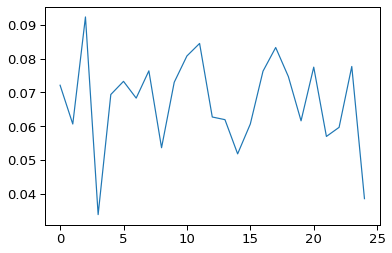

In [39]:
plt.plot(all_losses)

In [40]:
best_idx = np.argmin(all_losses)
best_idx

3

In [41]:
all_cv_scores[best_idx]

{'train_r2': array([0.98184468, 0.99700529, 0.9735365 , 0.98109672, 0.99100124]),
 'validate_r2': array([0.99427733, 0.983183  , 0.99491534, 0.98906562, 0.97660806]),
 'train_rmsd': array([0.03394451, 0.01671231, 0.04722108, 0.04754602, 0.03578275]),
 'validate_rmsd': array([0.02800816, 0.03475871, 0.02288706, 0.03473579, 0.04963085])}

In [42]:
best_emulator = all_emulators[best_idx]
best_emulator

In [43]:
best_emulator.train(retrain=True)

[INFO] >>> Training model on 80% of the dataset, testing on 20%...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)
/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)


[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.172          0.409         -0.470          0.358 *
[INFO]             100          0.934          0.098          0.946          0.068 *
[INFO]             200          0.946          0.086          0.957          0.058 *
[INFO]             300          0.966          0.069          0.970          0.052 *
[INFO]             400          0.971          0.068          0.959          0.058
[INFO]             500          0.963          0.075          0.976          0.045 *
[INFO]             600          0.982          0.054          0.967          0.055
[INFO]             700          0.980          0.056          0.961          0.057
[INFO]             800          0.964          0.071          0.973          

[INFO]            8500          0.993          0.036          0.970          0.052
[INFO]            8600          0.993          0.037          0.976          0.048
[INFO]            8700          0.990          0.041          0.982          0.044
[INFO]            8800          0.992          0.037          0.976          0.047
[INFO]            8900          0.992          0.038          0.974          0.050
[INFO]            9000          0.994          0.034          0.970          0.053
[INFO]            9100          0.993          0.036          0.969          0.054
[INFO]            9200          0.994          0.033          0.975          0.048
[INFO]            9300          0.993          0.036          0.975          0.049
[INFO]            9400          0.992          0.037          0.976          0.045
[INFO]            9500          0.994          0.031          0.976          0.048
[INFO]            9600          0.994          0.034          0.972          0.050
[INF

{'train_r2': 0.9725271665687146,
 'test_r2': 0.9834531562655487,
 'train_rmsd': 0.0627285332332741,
 'test_rmsd': 0.03996658258129116}

In [16]:
hyperparams_iii = {'batch_size': 10,
 'hidden_act': 'leaky_relu',
 'hidden_depth': 3,
 'hidden_nodes': 60,
 'learning_rate': 0.0008575535298327838,
 'reg': 0.00889886373065209}


In [17]:
model  = BayesNeuralNet(
        **hyperparams_ii, out_act='sigmoid', 
    )
emulator = Emulator(
    dataset='suzuki_iii', model=model, 
    feature_transform='standardize', target_transform='normalize',
)

In [18]:
emulator.train()

[INFO] >>> Training model on 80% of the dataset, testing on 20%...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)
/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)


[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.124          0.375         -0.387          0.322 *
[INFO]             100          0.970          0.059          0.918          0.075 *
[INFO]             200          0.945          0.077          0.912          0.075 *
[INFO]             300          0.954          0.073          0.944          0.072 *
[INFO]             400          0.986          0.044          0.927          0.077
[INFO]             500          0.963          0.066          0.935          0.073
[INFO]             600          0.992          0.034          0.874          0.086
[INFO]             700          0.978          0.050          0.910          0.074
[INFO]             800          0.982          0.048          0.942          0.

[INFO]            8500          0.999          0.011          0.941          0.070
[INFO]            8600          0.999          0.013          0.952          0.063
[INFO]            8700          0.999          0.012          0.964          0.057
[INFO]            8800          0.999          0.012          0.961          0.059
[INFO]            8900          0.998          0.015          0.961          0.059
[INFO]            9000          0.998          0.016          0.962          0.055 *
[INFO]            9100          0.999          0.011          0.961          0.060
[INFO]            9200          0.999          0.010          0.951          0.066
[INFO]            9300          0.999          0.011          0.961          0.060
[INFO]            9400          0.999          0.010          0.953          0.064
[INFO]            9500          0.999          0.010          0.961          0.059
[INFO]            9600          0.999          0.009          0.957          0.063
[I

[INFO]           17500          0.999          0.013          0.952          0.066
[INFO]           17600          0.999          0.009          0.948          0.069
[INFO]           17700          0.999          0.009          0.945          0.067
[INFO]           17800          0.999          0.010          0.956          0.064
[INFO]           17900          1.000          0.006          0.944          0.070
[INFO]           18000          0.999          0.009          0.950          0.065
[INFO]           18100          0.999          0.009          0.946          0.069
[INFO]           18200          0.999          0.010          0.952          0.064
[INFO]           18300          0.999          0.010          0.950          0.066
[INFO]           18400          0.999          0.012          0.949          0.067
[INFO]           18500          0.999          0.010          0.951          0.066
[INFO]           18600          0.999          0.012          0.950          0.068
[INF

{'train_r2': 0.997971530288777,
 'test_r2': 0.9672559929511726,
 'train_rmsd': 0.015628167918631225,
 'test_rmsd': 0.05415091831600904}

In [19]:
emulator.save('emulator_suzuki_iii_BayesNeuralNet')

## `dataset_suzuki_iv`

In [45]:
search_space = {
    'batch_size': hp.quniform('batch_size', 10, 50, 10),
    'hidden_act': hp.choice('hidden_act', ['leaky_relu'] ),
    'hidden_depth': hp.quniform('hidden_depth', 2, 5, 1),
    'hidden_nodes': hp.quniform('hidden_nodes', 28, 64, 4),
    'learning_rate': hp.uniform('learning_rate', 1e-5, 5e-3),
    'reg': hp.uniform('reg', 0.001, 0.1)
}

int_params = ['batch_size', 'hidden_depth', 'hidden_nodes']

all_emulators = []
all_losses = []
all_cv_scores = []
all_params = []

def objective(params):
    ''' average performance over cross-validation folds '''
    # build emualtor
    print(f'PARAMS : {params}')
    for param, val in params.items():
        if param in int_params:
            params[param] = int(val)
    model  = BayesNeuralNet(
        **params, out_act='sigmoid', 
    )
    emulator = Emulator(
        dataset='suzuki_iv', model=model, 
        feature_transform='standardize', target_transform='normalize',
    )

    cv_scores = emulator.cross_validate()
    loss = np.mean(cv_scores['validate_rmsd'])
    
    all_losses.append(loss)
    all_cv_scores.append(cv_scores)
    all_params.append(params)
    all_emulators.append(emulator)
    
    return {'loss': loss, 'status': STATUS_OK}

In [46]:
trials = Trials()

best = fmin(
    fn=objective,
    space=search_space, 
    algo=tpe.suggest, 
    max_evals=25,
    trials=trials
)

print(f"BEST VALUE : {best}")

PARAMS : {'batch_size': 40.0, 'hidden_act': 'leaky_relu', 'hidden_depth': 3.0, 'hidden_nodes': 48.0, 'learning_rate': 0.0038234801039600196, 'reg': 0.025304700710345917}                                
  0%|                                                                                                                                                             | 0/25 [00:00<?, ?trial/s, best loss=?][INFO] >>> Training model on fold #0...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.235          0.312         -0.529          0.322 *
[INFO]             100          0.956          0.061          0.572          0.176 *
[INFO]             200          0.959          0.057          0.697          0.149 *
[INFO]             300          0.968          0.051          0.623          0.167
[INFO]             400          0.963          0.056          0.773          0.128 *
[INFO]             500          0.966          0.054          0.713          0.144
[INFO]             600          0.975          0.046          0.644          0.162
[INFO]             700          0.978          0.043          0.671          0.155
[INFO]             800          0.982          0.039          0.598          0.

[INFO]            8500          0.994          0.022          0.462          0.181
[INFO]            8600          0.994          0.022          0.467          0.180
[INFO]            8700          0.992          0.025          0.678          0.143
[INFO]            8800          0.994          0.021          0.503          0.174
[INFO]            8900          0.994          0.021          0.511          0.172
[INFO]            9000          0.994          0.022          0.856          0.101 *
[INFO]            9100          0.995          0.020          0.852          0.103
[INFO]            9200          0.994          0.022          0.644          0.150
[INFO]            9300          0.994          0.022          0.606          0.155
[INFO]            9400          0.993          0.024          0.524          0.169
[INFO]            9500          0.993          0.023          0.480          0.176
[INFO]            9600          0.994          0.022          0.480          0.176
[I

[INFO]           17400          0.995          0.020          0.825          0.108
[INFO]           17500          0.994          0.022          0.823          0.109
[INFO]           17600          0.995          0.020          0.822          0.110
[INFO]           17700          0.995          0.019          0.846          0.103
[INFO]           17800          0.995          0.019          0.843          0.104
[INFO]           17900          0.995          0.020          0.735          0.130
[INFO]           18000          0.995          0.019          0.818          0.111
[INFO]           18100          0.995          0.020          0.820          0.110
[INFO]           18200          0.995          0.020          0.835          0.106
[INFO]           18300          0.994          0.021          0.843          0.104
[INFO]           18400          0.992          0.025          0.512          0.171
[INFO]           18500          0.994          0.022          0.518          0.170
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.567          0.319         -0.207          0.353 *
[INFO]             100          0.945          0.063          0.861          0.129 *
[INFO]             200          0.959          0.055          0.921          0.096 *
[INFO]             300          0.965          0.050          0.968          0.060 *
[INFO]             400          0.971          0.048          0.974          0.054 *
[INFO]             500          0.969          0.048          0.953          0.074
[INFO]             600          0.985          0.034          0.983          0.043 *
[INFO]             700          0.986          0.033          0.982          0.045
[INFO]             800          0.989          0.029          0.983        

[INFO]            8500          0.998          0.012          0.973          0.056
[INFO]            8600          0.998          0.012          0.975          0.054
[INFO]            8700          0.997          0.013          0.977          0.052
[INFO]            8800          0.998          0.011          0.977          0.052
[INFO]            8900          0.998          0.011          0.975          0.054
[INFO]            9000          0.997          0.013          0.979          0.049
[INFO]            9100          0.998          0.010          0.977          0.051
[INFO]            9200          0.998          0.013          0.975          0.054
[INFO]            9300          0.998          0.012          0.975          0.053
[INFO]            9400          0.998          0.010          0.977          0.052
[INFO]            9500          0.998          0.013          0.979          0.050
[INFO]            9600          0.997          0.013          0.973          0.057
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.080          0.330         -0.476          0.270 *
[INFO]             100          0.979          0.045          0.766          0.102 *
[INFO]             200          0.985          0.038          0.807          0.091 *
[INFO]             300          0.986          0.039          0.752          0.104
[INFO]             400          0.984          0.040          0.810          0.091
[INFO]             500          0.983          0.041          0.834          0.087 *
[INFO]             600          0.985          0.039          0.785          0.095
[INFO]             700          0.988          0.035          0.813          0.090
[INFO]             800          0.991          0.030          0.811          0.

[INFO]            8600          0.999          0.010          0.457          0.166
[INFO]            8700          1.000          0.003          0.439          0.168
[INFO]            8800          1.000          0.005          0.443          0.168
[INFO]            8900          1.000          0.007          0.450          0.167
[INFO]            9000          1.000          0.005          0.442          0.168
[INFO]            9100          1.000          0.004          0.439          0.168
[INFO]            9200          1.000          0.003          0.432          0.169
[INFO]            9300          0.999          0.008          0.438          0.168
[INFO]            9400          1.000          0.003          0.432          0.170
[INFO]            9500          0.999          0.010          0.450          0.167
[INFO]            9600          1.000          0.006          0.450          0.167
[INFO]            9700          1.000          0.006          0.439          0.169
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.336          0.291         -0.393          0.315 *
[INFO]             100          0.963          0.049          0.474          0.180 *
[INFO]             200          0.970          0.044          0.821          0.105 *
[INFO]             300          0.974          0.041          0.832          0.100 *
[INFO]             400          0.971          0.043          0.769          0.141
[INFO]             500          0.974          0.041          0.826          0.112
[INFO]             600          0.980          0.036          0.891          0.093 *
[INFO]             700          0.984          0.032          0.811          0.126
[INFO]             800          0.981          0.034          0.739          

[INFO]            8600          0.998          0.011          0.934          0.073
[INFO]            8700          0.997          0.013          0.934          0.073
[INFO]            8800          0.998          0.012          0.937          0.071
[INFO]            8900          0.996          0.016          0.939          0.070
[INFO]            9000          0.998          0.012          0.936          0.070
[INFO]            9100          0.996          0.017          0.937          0.069
[INFO]            9200          0.998          0.010          0.932          0.071
[INFO]            9300          0.997          0.013          0.931          0.073
[INFO]            9400          0.997          0.013          0.929          0.073
[INFO]            9500          0.998          0.011          0.939          0.069
[INFO]            9600          0.997          0.014          0.940          0.068 *
[INFO]            9700          0.998          0.011          0.940          0.068
[I

[INFO]           17500          0.998          0.011         -1.130          0.331
[INFO]           17600          0.998          0.012         -1.124          0.330
[INFO]           17700          0.998          0.012         -1.122          0.330
[INFO]           17800          0.997          0.013         -1.148          0.335
[INFO]           17900          0.998          0.012         -1.143          0.333
[INFO]           18000          0.997          0.014         -1.153          0.336
[INFO]           18100          0.997          0.013         -1.198          0.344
[INFO]           18200          0.998          0.012         -1.154          0.335
[INFO]           18300          0.995          0.018         -1.142          0.334
[INFO]           18400          0.998          0.012         -1.178          0.340
[INFO]           18500          0.998          0.012         -1.208          0.346
[INFO]           18600          0.998          0.011         -1.227          0.349
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.433          0.311         -0.183          0.311 *
[INFO]             100          0.966          0.048          0.905          0.085 *
[INFO]             200          0.976          0.041          0.770          0.133
[INFO]             300          0.976          0.041          0.906          0.086
[INFO]             400          0.980          0.036          0.880          0.097
[INFO]             500          0.985          0.032          0.916          0.078 *
[INFO]             600          0.986          0.031          0.875          0.095
[INFO]             700          0.983          0.034          0.867          0.098
[INFO]             800          0.987          0.028          0.800          0.11

[INFO]            8600          0.998          0.010         -0.058          0.259
[INFO]            8700          0.999          0.008         -0.037          0.256
[INFO]            8800          0.999          0.008         -0.039          0.257
[INFO]            8900          0.999          0.009         -0.061          0.259
[INFO]            9000          0.999          0.008         -0.039          0.257
[INFO]            9100          0.999          0.007         -0.056          0.259
[INFO]            9200          0.999          0.007         -0.079          0.262
[INFO]            9300          0.999          0.009         -0.083          0.262
[INFO]            9400          0.999          0.008         -0.065          0.259
[INFO]            9500          0.999          0.009         -0.033          0.256
[INFO]            9600          0.999          0.008         -0.055          0.258
[INFO]            9700          0.999          0.009         -0.096          0.263
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.192          0.292         -0.307          0.311 *
[INFO]             100          0.930          0.071          0.653          0.177 *
[INFO]             200          0.958          0.056          0.749          0.150 *
[INFO]             300          0.939          0.066          0.724          0.158
[INFO]             400          0.932          0.068          0.832          0.121 *
[INFO]             500          0.953          0.058          0.868          0.109 *
[INFO]             600          0.966          0.051          0.764          0.150
[INFO]             700          0.965          0.050          0.920          0.084 *
[INFO]             800          0.970          0.047          0.850        

[INFO]            8600          0.999          0.007          0.750          0.150
[INFO]            8700          1.000          0.004          0.761          0.147
[INFO]            8800          1.000          0.004          0.760          0.147
[INFO]            8900          0.999          0.008          0.769          0.145
[INFO]            9000          0.999          0.008          0.762          0.147
[INFO]            9100          1.000          0.002          0.766          0.145
[INFO]            9200          1.000          0.005          0.759          0.148
[INFO]            9300          0.999          0.006          0.760          0.148
[INFO]            9400          1.000          0.005          0.758          0.148
[INFO]            9500          1.000          0.005          0.768          0.145
[INFO]            9600          0.999          0.006          0.765          0.146
[INFO]            9700          1.000          0.005          0.765          0.146
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.083          0.290         -0.133          0.315 *
[INFO]             100          0.938          0.069          0.831          0.133 *
[INFO]             200          0.912          0.079          0.788          0.150
[INFO]             300          0.952          0.062          0.848          0.123 *
[INFO]             400          0.943          0.066          0.815          0.133
[INFO]             500          0.934          0.069          0.889          0.105 *
[INFO]             600          0.960          0.058          0.904          0.092 *
[INFO]             700          0.966          0.053          0.873          0.111
[INFO]             800          0.971          0.049          0.895          

[INFO]            8600          0.999          0.008          0.856          0.109
[INFO]            8700          1.000          0.006          0.855          0.109
[INFO]            8800          0.999          0.009          0.857          0.109
[INFO]            8900          0.999          0.007          0.859          0.109
[INFO]            9000          0.999          0.009          0.853          0.109
[INFO]            9100          1.000          0.006          0.853          0.110
[INFO]            9200          0.999          0.007          0.854          0.110
[INFO]            9300          0.999          0.008          0.860          0.108
[INFO]            9400          1.000          0.007          0.861          0.108
[INFO]            9500          0.999          0.009          0.859          0.108
[INFO]            9600          1.000          0.007          0.860          0.108
[INFO]            9700          0.999          0.008          0.861          0.108
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.319          0.308         -0.172          0.293 *
[INFO]             100          0.938          0.067          0.776          0.131 *
[INFO]             200          0.957          0.056          0.793          0.126 *
[INFO]             300          0.958          0.055          0.774          0.132
[INFO]             400          0.967          0.050          0.786          0.127
[INFO]             500          0.969          0.049          0.756          0.136
[INFO]             600          0.983          0.035          0.756          0.134
[INFO]             700          0.983          0.036          0.696          0.145
[INFO]             800          0.991          0.026          0.673          0.14

[INFO]            8700          1.000          0.005          0.135          0.237
[INFO]            8800          0.999          0.007          0.112          0.241
[INFO]            8900          0.999          0.007          0.111          0.241
[INFO]            9000          0.999          0.007          0.150          0.236
[INFO]            9100          0.999          0.008          0.109          0.240
[INFO]            9200          0.999          0.006          0.087          0.243
[INFO]            9300          0.999          0.007          0.060          0.248
[INFO]            9400          0.999          0.007          0.078          0.245
[INFO]            9500          1.000          0.006          0.035          0.252
[INFO]            9600          0.999          0.007          0.058          0.251
[INFO]            9700          1.000          0.006         -0.033          0.262
[INFO]            9800          0.999          0.008         -0.004          0.259
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.117          0.348         -0.433          0.311 *
[INFO]             100          0.975          0.052          0.918          0.080 *
[INFO]             200          0.980          0.048          0.866          0.097
[INFO]             300          0.977          0.051          0.897          0.084
[INFO]             400          0.981          0.046          0.765          0.126
[INFO]             500          0.988          0.037          0.815          0.113
[INFO]             600          0.990          0.033          0.846          0.105
[INFO]             700          0.993          0.029          0.829          0.110
[INFO]             800          0.993          0.028          0.778          0.124


[INFO]            8600          0.999          0.010          0.681          0.149
[INFO]            8700          0.999          0.012          0.493          0.184
[INFO]            8800          0.999          0.011          0.404          0.200
[INFO]            8900          0.999          0.012          0.589          0.167
[INFO]            9000          0.999          0.011          0.526          0.179
[INFO]            9100          0.999          0.010          0.538          0.177
[INFO]            9200          0.999          0.010          0.618          0.162
[INFO]            9300          0.999          0.010          0.587          0.169
[INFO]            9400          0.999          0.010          0.573          0.174
[INFO]            9500          0.999          0.011          0.645          0.158
[INFO]            9600          0.999          0.012          0.526          0.180
[INFO]            9700          0.999          0.010          0.641          0.159
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.124          0.338          0.005          0.334 *
[INFO]             100          0.964          0.062          0.879          0.116 *
[INFO]             200          0.970          0.056          0.853          0.128
[INFO]             300          0.981          0.047          0.863          0.123
[INFO]             400          0.980          0.047          0.796          0.150
[INFO]             500          0.984          0.042          0.809          0.146
[INFO]             600          0.984          0.041          0.724          0.174
[INFO]             700          0.990          0.033          0.755          0.164
[INFO]             800          0.993          0.028          0.776          0.157


[INFO]            8600          1.000          0.001          0.692          0.185
[INFO]            8700          1.000          0.001          0.690          0.186
[INFO]            8800          1.000          0.001          0.688          0.187
[INFO]            8900          1.000          0.001          0.691          0.186
[INFO]            9000          1.000          0.005          0.694          0.185
[INFO]            9100          1.000          0.001          0.690          0.186
[INFO]            9200          1.000          0.001          0.688          0.186
[INFO]            9300          1.000          0.001          0.689          0.186
[INFO]            9400          1.000          0.003          0.690          0.186
[INFO]            9500          1.000          0.001          0.687          0.187
[INFO]            9600          1.000          0.001          0.685          0.187
[INFO]            9700          1.000          0.001          0.685          0.187
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.128          0.299         -0.169          0.298 *
[INFO]             100          0.965          0.053          0.810          0.120 *
[INFO]             200          0.974          0.045          0.802          0.125
[INFO]             300          0.970          0.049          0.722          0.145
[INFO]             400          0.964          0.054          0.810          0.124
[INFO]             500          0.962          0.055          0.608          0.174
[INFO]             600          0.959          0.057          0.662          0.162
[INFO]             700          0.971          0.048          0.717          0.145
[INFO]             800          0.962          0.055          0.762          0.134


[INFO]            8600          0.997          0.014          0.626          0.168
[INFO]            8700          0.997          0.016          0.632          0.167
[INFO]            8800          0.998          0.013          0.626          0.169
[INFO]            8900          0.998          0.014          0.623          0.168
[INFO]            9000          0.997          0.015          0.631          0.167
[INFO]            9100          0.998          0.013          0.620          0.169
[INFO]            9200          0.998          0.014          0.623          0.168
[INFO]            9300          0.997          0.015          0.621          0.169
[INFO]            9400          0.997          0.015          0.617          0.170
[INFO]            9500          0.997          0.015          0.637          0.166
[INFO]            9600          0.997          0.015          0.629          0.167
[INFO]            9700          0.998          0.014          0.628          0.167
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.077          0.300         -0.482          0.273 *
[INFO]             100          0.946          0.068          0.820          0.090 *
[INFO]             200          0.945          0.069          0.845          0.088 *
[INFO]             300          0.945          0.069          0.878          0.075 *
[INFO]             400          0.947          0.068          0.912          0.064 *
[INFO]             500          0.921          0.081          0.839          0.088
[INFO]             600          0.926          0.080          0.882          0.079
[INFO]             700          0.935          0.075          0.903          0.067
[INFO]             800          0.935          0.074          0.931          

[INFO]            8600          0.998          0.014          0.901          0.071
[INFO]            8700          0.999          0.011          0.890          0.074
[INFO]            8800          0.998          0.013          0.901          0.070
[INFO]            8900          0.998          0.013          0.895          0.072
[INFO]            9000          0.998          0.012          0.888          0.074
[INFO]            9100          0.998          0.013          0.892          0.073
[INFO]            9200          0.998          0.013          0.895          0.072
[INFO]            9300          0.998          0.012          0.888          0.075
[INFO]            9400          0.998          0.012          0.890          0.074
[INFO]            9500          0.998          0.013          0.884          0.076
[INFO]            9600          0.999          0.011          0.901          0.070
[INFO]            9700          0.997          0.016          0.886          0.075
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.683          0.291         -0.179          0.310 *
[INFO]             100          0.915          0.066          0.902          0.092 *
[INFO]             200          0.895          0.073          0.885          0.097
[INFO]             300          0.915          0.065          0.849          0.112
[INFO]             400          0.913          0.066          0.934          0.075 *
[INFO]             500          0.891          0.075          0.877          0.099
[INFO]             600          0.890          0.074          0.839          0.114
[INFO]             700          0.899          0.072          0.893          0.092
[INFO]             800          0.903          0.070          0.899          0.09

[INFO]            8600          0.999          0.008          0.483          0.201
[INFO]            8700          0.999          0.009          0.446          0.208
[INFO]            8800          0.998          0.009          0.471          0.203
[INFO]            8900          0.999          0.009          0.425          0.212
[INFO]            9000          0.999          0.009          0.488          0.201
[INFO]            9100          0.999          0.008          0.420          0.212
[INFO]            9200          0.999          0.008          0.430          0.211
[INFO]            9300          0.998          0.009          0.388          0.218
[INFO]            9400          0.998          0.010          0.439          0.210
[INFO]            9500          0.999          0.007          0.415          0.214
[INFO]            9600          0.999          0.007          0.396          0.217
[INFO]            9700          0.999          0.007          0.420          0.213
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.380          0.304         -0.313          0.280 *
[INFO]             100          0.931          0.067          0.773          0.117 *
[INFO]             200          0.946          0.063          0.874          0.087 *
[INFO]             300          0.922          0.075          0.876          0.087 *
[INFO]             400          0.949          0.062          0.921          0.069 *
[INFO]             500          0.952          0.059          0.885          0.083
[INFO]             600          0.925          0.071          0.877          0.086
[INFO]             700          0.945          0.061          0.853          0.095
[INFO]             800          0.954          0.057          0.920          

[INFO]            8600          0.999          0.009          0.749          0.124
[INFO]            8700          0.998          0.011          0.722          0.130
[INFO]            8800          0.999          0.010          0.729          0.128
[INFO]            8900          0.998          0.012          0.695          0.136
[INFO]            9000          0.999          0.008          0.717          0.131
[INFO]            9100          0.999          0.009          0.711          0.132
[INFO]            9200          0.999          0.010          0.698          0.135
[INFO]            9300          0.999          0.011          0.711          0.132
[INFO]            9400          0.999          0.010          0.717          0.131
[INFO]            9500          0.999          0.007          0.712          0.132
[INFO]            9600          0.999          0.011          0.720          0.130
[INFO]            9700          0.999          0.010          0.729          0.128
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.879          0.303         -0.075          0.333 *
[INFO]             100          0.928          0.060          0.701          0.181 *
[INFO]             200          0.877          0.076          0.711          0.176 *
[INFO]             300          0.909          0.066          0.772          0.155 *
[INFO]             400          0.920          0.063          0.723          0.173
[INFO]             500          0.912          0.066          0.738          0.168
[INFO]             600          0.914          0.066          0.808          0.143 *
[INFO]             700          0.909          0.067          0.709          0.177
[INFO]             800          0.917          0.065          0.764          

[INFO]            8600          0.992          0.020          0.646          0.196
[INFO]            8700          0.995          0.017          0.665          0.190
[INFO]            8800          0.994          0.018          0.650          0.194
[INFO]            8900          0.994          0.018          0.648          0.195
[INFO]            9000          0.994          0.018          0.636          0.198
[INFO]            9100          0.994          0.018          0.645          0.196
[INFO]            9200          0.995          0.017          0.656          0.193
[INFO]            9300          0.994          0.018          0.647          0.195
[INFO]            9400          0.993          0.020          0.646          0.196
[INFO]            9500          0.993          0.019          0.655          0.193
[INFO]            9600          0.993          0.020          0.656          0.193
[INFO]            9700          0.993          0.020          0.663          0.191
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.652          0.310         -0.398          0.270 *
[INFO]             100          0.754          0.120          0.803          0.102 *
[INFO]             200          0.880          0.085          0.815          0.098 *
[INFO]             300          0.935          0.064          0.829          0.094 *
[INFO]             400          0.941          0.060          0.851          0.088 *
[INFO]             500          0.956          0.052          0.822          0.096
[INFO]             600          0.964          0.045          0.852          0.088 *
[INFO]             700          0.970          0.042          0.851          0.088
[INFO]             800          0.968          0.043          0.873        

[INFO]            8600          0.995          0.018          0.525          0.157
[INFO]            8700          0.996          0.016          0.521          0.158
[INFO]            8800          0.990          0.024          0.503          0.161
[INFO]            8900          0.997          0.013          0.540          0.155
[INFO]            9000          0.994          0.020          0.512          0.159
[INFO]            9100          0.997          0.015          0.524          0.158
[INFO]            9200          0.994          0.019          0.532          0.156
[INFO]            9300          0.996          0.016          0.532          0.156
[INFO]            9400          0.993          0.021          0.531          0.156
[INFO]            9500          0.994          0.019          0.539          0.155
[INFO]            9600          0.995          0.017          0.532          0.156
[INFO]            9700          0.996          0.015          0.540          0.155
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.598          0.290         -0.429          0.313 *
[INFO]             100          0.596          0.146          0.859          0.097 *
[INFO]             200          0.840          0.092          0.839          0.102
[INFO]             300          0.842          0.091          0.811          0.109
[INFO]             400          0.893          0.075          0.816          0.108
[INFO]             500          0.893          0.075          0.759          0.127
[INFO]             600          0.887          0.077          0.890          0.085 *
[INFO]             700          0.891          0.076          0.744          0.132
[INFO]             800          0.901          0.072          0.725          0.13

[INFO]            8700          0.998          0.011          0.260          0.204
[INFO]            8800          0.996          0.015          0.258          0.205
[INFO]            8900          0.997          0.013          0.235          0.209
[INFO]            9000          0.998          0.011          0.218          0.212
[INFO]            9100          0.998          0.011          0.216          0.212
[INFO]            9200          0.998          0.010          0.218          0.211
[INFO]            9300          0.999          0.009          0.219          0.211
[INFO]            9400          0.999          0.009          0.220          0.211
[INFO]            9500          0.996          0.014          0.232          0.209
[INFO]            9600          0.997          0.012          0.200          0.215
[INFO]            9700          0.998          0.011          0.222          0.211
[INFO]            9800          0.996          0.014          0.221          0.211
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.344          0.289         -1.420          0.310 *
[INFO]             100          0.770          0.117          0.708          0.110 *
[INFO]             200          0.823          0.104          0.880          0.081 *
[INFO]             300          0.832          0.100          0.893          0.078 *
[INFO]             400          0.888          0.086          0.908          0.072 *
[INFO]             500          0.861          0.092          0.911          0.065 *
[INFO]             600          0.893          0.082          0.894          0.079
[INFO]             700          0.875          0.088          0.895          0.072
[INFO]             800          0.897          0.081          0.899        

[INFO]            8600          0.996          0.015          0.791          0.112
[INFO]            8700          0.998          0.010          0.759          0.119
[INFO]            8800          0.998          0.011          0.760          0.120
[INFO]            8900          0.998          0.010          0.750          0.119
[INFO]            9000          0.996          0.015          0.795          0.115
[INFO]            9100          0.998          0.009          0.769          0.116
[INFO]            9200          0.999          0.009          0.771          0.118
[INFO]            9300          0.995          0.018          0.786          0.115
[INFO]            9400          0.998          0.011          0.750          0.120
[INFO]            9500          0.998          0.011          0.767          0.118
[INFO]            9600          0.998          0.011          0.691          0.126
[INFO]            9700          0.997          0.012          0.763          0.119
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.740          0.300         -0.105          0.346 *
[INFO]             100          0.838          0.079          0.536          0.225 *
[INFO]             200          0.864          0.069          0.648          0.196 *
[INFO]             300          0.919          0.052          0.650          0.195 *
[INFO]             400          0.924          0.051          0.675          0.188 *
[INFO]             500          0.935          0.047          0.634          0.200
[INFO]             600          0.937          0.046          0.679          0.187 *
[INFO]             700          0.931          0.048          0.680          0.187 *
[INFO]             800          0.948          0.042          0.597      

[INFO]            8600          0.994          0.015          0.897          0.106
[INFO]            8700          0.992          0.017          0.890          0.109
[INFO]            8800          0.991          0.018          0.887          0.111
[INFO]            8900          0.994          0.015          0.895          0.107
[INFO]            9000          0.992          0.017          0.889          0.110
[INFO]            9100          0.993          0.016          0.885          0.112
[INFO]            9200          0.990          0.019          0.882          0.113
[INFO]            9300          0.991          0.019          0.887          0.110
[INFO]            9400          0.993          0.016          0.892          0.108
[INFO]            9500          0.991          0.018          0.880          0.114
[INFO]            9600          0.993          0.016          0.884          0.112
[INFO]            9700          0.993          0.017          0.883          0.113
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.053          0.334         -0.454          0.349 *
[INFO]             100          0.931          0.064          0.594          0.188 *
[INFO]             200          0.951          0.053          0.690          0.168 *
[INFO]             300          0.962          0.049          0.704          0.164 *
[INFO]             400          0.955          0.058          0.746          0.154 *
[INFO]             500          0.956          0.052          0.779          0.142 *
[INFO]             600          0.965          0.047          0.795          0.136 *
[INFO]             700          0.963          0.050          0.829          0.125 *
[INFO]             800          0.965          0.046          0.852    

[INFO]            8500          0.995          0.020          0.671          0.173
[INFO]            8600          0.995          0.020          0.678          0.171
[INFO]            8700          0.994          0.020          0.680          0.170
[INFO]            8800          0.995          0.020          0.672          0.172
[INFO]            8900          0.995          0.019          0.669          0.173
[INFO]            9000          0.994          0.021          0.670          0.173
[INFO]            9100          0.995          0.019          0.669          0.173
[INFO]            9200          0.995          0.020          0.663          0.174
[INFO]            9300          0.995          0.020          0.669          0.173
[INFO]            9400          0.995          0.019          0.678          0.171
[INFO]            9500          0.995          0.020          0.676          0.171
[INFO]            9600          0.994          0.021          0.679          0.170
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.236          0.307         -0.242          0.318 *
[INFO]             100          0.974          0.047          0.538          0.221 *
[INFO]             200          0.972          0.044          0.495          0.228
[INFO]             300          0.981          0.038          0.541          0.216 *
[INFO]             400          0.976          0.042          0.591          0.197 *
[INFO]             500          0.989          0.029          0.610          0.197 *
[INFO]             600          0.993          0.023          0.567          0.205
[INFO]             700          0.985          0.029          0.635          0.192 *
[INFO]             800          0.995          0.019          0.624        

[INFO]            8600          0.998          0.010          0.572          0.207
[INFO]            8700          0.998          0.010          0.578          0.207
[INFO]            8800          0.999          0.009          0.563          0.210
[INFO]            8900          0.998          0.010          0.557          0.212
[INFO]            9000          0.998          0.010          0.565          0.209
[INFO]            9100          0.998          0.011          0.556          0.211
[INFO]            9200          0.998          0.010          0.568          0.208
[INFO]            9300          0.997          0.013          0.568          0.210
[INFO]            9400          0.999          0.009          0.568          0.209
[INFO]            9500          0.998          0.011          0.583          0.203
[INFO]            9600          0.998          0.010          0.572          0.207
[INFO]            9700          0.998          0.010          0.576          0.206
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.088          0.309         -0.021          0.318 *
[INFO]             100          0.956          0.062          0.865          0.116 *
[INFO]             200          0.973          0.049          0.860          0.119
[INFO]             300          0.966          0.055          0.862          0.118
[INFO]             400          0.976          0.046          0.846          0.125
[INFO]             500          0.985          0.037          0.826          0.130
[INFO]             600          0.986          0.036          0.733          0.161
[INFO]             700          0.987          0.034          0.790          0.143
[INFO]             800          0.994          0.022          0.710          0.167


[INFO]            8600          1.000          0.004          0.591          0.200
[INFO]            8700          1.000          0.003          0.584          0.202
[INFO]            8800          1.000          0.002          0.567          0.206
[INFO]            8900          1.000          0.003          0.574          0.204
[INFO]            9000          1.000          0.006          0.570          0.205
[INFO]            9100          1.000          0.004          0.612          0.194
[INFO]            9200          1.000          0.003          0.598          0.198
[INFO]            9300          1.000          0.004          0.589          0.200
[INFO]            9400          1.000          0.005          0.582          0.202
[INFO]            9500          1.000          0.003          0.584          0.202
[INFO]            9600          1.000          0.004          0.579          0.203
[INFO]            9700          1.000          0.003          0.584          0.202
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.286          0.335         -0.307          0.313 *
[INFO]             100          0.970          0.051          0.919          0.083 *
[INFO]             200          0.974          0.050          0.900          0.088
[INFO]             300          0.973          0.050          0.856          0.107
[INFO]             400          0.980          0.043          0.881          0.099
[INFO]             500          0.988          0.032          0.830          0.116
[INFO]             600          0.988          0.032          0.829          0.115
[INFO]             700          0.984          0.037          0.875          0.101
[INFO]             800          0.997          0.016          0.837          0.115


[INFO]            8600          0.999          0.011          0.894          0.092
[INFO]            8700          0.998          0.014          0.880          0.098
[INFO]            8800          0.998          0.013          0.908          0.085
[INFO]            8900          0.998          0.012          0.849          0.109
[INFO]            9000          0.999          0.011          0.867          0.103
[INFO]            9100          0.999          0.011          0.871          0.100
[INFO]            9200          0.999          0.010          0.885          0.095
[INFO]            9300          0.999          0.009          0.889          0.093
[INFO]            9400          0.999          0.010          0.896          0.091
[INFO]            9500          0.998          0.011          0.873          0.101
[INFO]            9600          0.998          0.013          0.880          0.099
[INFO]            9700          0.999          0.009          0.887          0.094
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.292          0.258         -0.121          0.302 *
[INFO]             100          0.919          0.064          0.942          0.070 *
[INFO]             200          0.891          0.076          0.971          0.049 *
[INFO]             300          0.916          0.067          0.925          0.079
[INFO]             400          0.927          0.060          0.941          0.069
[INFO]             500          0.945          0.053          0.962          0.057
[INFO]             600          0.943          0.054          0.952          0.063
[INFO]             700          0.953          0.049          0.946          0.066
[INFO]             800          0.988          0.025          0.936          0.07

[INFO]            8600          0.999          0.008          0.937          0.072
[INFO]            8700          0.999          0.007          0.929          0.076
[INFO]            8800          0.999          0.008          0.932          0.074
[INFO]            8900          0.999          0.005          0.931          0.075
[INFO]            9000          0.999          0.009          0.926          0.077
[INFO]            9100          0.999          0.007          0.932          0.074
[INFO]            9200          0.999          0.008          0.932          0.074
[INFO]            9300          0.999          0.007          0.933          0.073
[INFO]            9400          0.998          0.010          0.936          0.072
[INFO]            9500          1.000          0.005          0.932          0.074
[INFO]            9600          0.998          0.010          0.935          0.073
[INFO]            9700          0.998          0.011          0.944          0.067
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.103          0.303         -0.571          0.291 *
[INFO]             100          0.960          0.057          0.704          0.122 *
[INFO]             200          0.985          0.034          0.633          0.137
[INFO]             300          0.967          0.053          0.778          0.110 *
[INFO]             400          0.984          0.036          0.451          0.172
[INFO]             500          0.984          0.036          0.519          0.160
[INFO]             600          0.991          0.027          0.511          0.164
[INFO]             700          0.992          0.026          0.493          0.167
[INFO]             800          0.996          0.018          0.498          0.16

[INFO]            8600          0.998          0.013          0.541          0.158
[INFO]            8700          0.998          0.014          0.549          0.156
[INFO]            8800          0.997          0.017          0.499          0.165
[INFO]            8900          0.998          0.014          0.527          0.160
[INFO]            9000          0.998          0.012          0.551          0.157
[INFO]            9100          0.998          0.014          0.485          0.167
[INFO]            9200          0.998          0.012          0.553          0.156
[INFO]            9300          0.998          0.014          0.483          0.167
[INFO]            9400          0.999          0.011          0.507          0.163
[INFO]            9500          0.998          0.013          0.491          0.166
[INFO]            9600          0.998          0.013          0.520          0.161
[INFO]            9700          0.998          0.011          0.492          0.165
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.276          0.288         -0.247          0.276 *
[INFO]             100          0.941          0.063          0.804          0.105 *
[INFO]             200          0.946          0.058          0.788          0.107
[INFO]             300          0.926          0.070          0.816          0.106
[INFO]             400          0.944          0.062          0.826          0.098 *
[INFO]             500          0.934          0.063          0.815          0.101
[INFO]             600          0.964          0.048          0.814          0.101
[INFO]             700          0.945          0.061          0.885          0.086 *
[INFO]             800          0.960          0.052          0.838          0.

[INFO]            8600          0.996          0.017          0.779          0.114
[INFO]            8700          0.996          0.018          0.769          0.116
[INFO]            8800          0.994          0.020          0.744          0.121
[INFO]            8900          0.995          0.020          0.762          0.118
[INFO]            9000          0.997          0.016          0.773          0.116
[INFO]            9100          0.996          0.017          0.748          0.120
[INFO]            9200          0.996          0.018          0.760          0.118
[INFO]            9300          0.996          0.016          0.734          0.123
[INFO]            9400          0.997          0.016          0.784          0.114
[INFO]            9500          0.997          0.017          0.753          0.120
[INFO]            9600          0.996          0.017          0.751          0.120
[INFO]            9700          0.996          0.018          0.755          0.119
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.100          0.309         -0.247          0.300 *
[INFO]             100          0.873          0.102          0.843          0.109 *
[INFO]             200          0.859          0.108          0.908          0.084 *
[INFO]             300          0.852          0.111          0.945          0.063 *
[INFO]             400          0.826          0.114          0.894          0.086
[INFO]             500          0.882          0.099          0.925          0.074
[INFO]             600          0.866          0.106          0.954          0.059 *
[INFO]             700          0.907          0.088          0.908          0.081
[INFO]             800          0.894          0.094          0.921          

[INFO]            8600          0.996          0.020          0.674          0.155
[INFO]            8700          0.996          0.020          0.669          0.156
[INFO]            8800          0.997          0.018          0.662          0.157
[INFO]            8900          0.996          0.020          0.663          0.158
[INFO]            9000          0.996          0.019          0.674          0.155
[INFO]            9100          0.996          0.021          0.676          0.155
[INFO]            9200          0.994          0.022          0.704          0.149
[INFO]            9300          0.994          0.023          0.663          0.158
[INFO]            9400          0.995          0.022          0.665          0.158
[INFO]            9500          0.995          0.021          0.670          0.156
[INFO]            9600          0.997          0.017          0.688          0.152
[INFO]            9700          0.923          0.083          0.675          0.155
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.233          0.334         -0.339          0.333 *
[INFO]             100          0.964          0.060          0.581          0.186 *
[INFO]             200          0.921          0.090          0.490          0.206
[INFO]             300          0.932          0.082          0.625          0.176 *
[INFO]             400          0.940          0.078          0.694          0.159 *
[INFO]             500          0.963          0.064          0.815          0.124 *
[INFO]             600          0.953          0.068          0.871          0.104 *
[INFO]             700          0.955          0.068          0.879          0.100 *
[INFO]             800          0.978          0.047          0.848      

[INFO]            8500          0.996          0.020          0.834          0.118
[INFO]            8600          0.996          0.020          0.790          0.133
[INFO]            8700          0.997          0.017          0.816          0.125
[INFO]            8800          0.997          0.019          0.840          0.116
[INFO]            8900          0.996          0.020          0.819          0.123
[INFO]            9000          0.997          0.017          0.822          0.122
[INFO]            9100          0.998          0.015          0.815          0.125
[INFO]            9200          0.998          0.014          0.772          0.139
[INFO]            9300          0.997          0.018          0.832          0.119
[INFO]            9400          0.997          0.017          0.787          0.134
[INFO]            9500          0.996          0.021          0.772          0.138
[INFO]            9600          0.998          0.014          0.811          0.126
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.341          0.288         -0.173          0.335 *
[INFO]             100          0.928          0.052          0.273          0.264 *
[INFO]             200          0.807          0.079          0.379          0.244 *
[INFO]             300          0.909          0.054          0.315          0.256
[INFO]             400          0.836          0.078          0.407          0.239 *
[INFO]             500          0.846          0.072          0.307          0.258
[INFO]             600          0.755          0.093          0.384          0.243
[INFO]             700          0.894          0.062          0.384          0.243
[INFO]             800          0.905          0.058          0.435          0.

[INFO]            8500          0.984          0.023          0.364          0.247
[INFO]            8600          0.984          0.024          0.312          0.257
[INFO]            8700          0.981          0.025          0.407          0.239
[INFO]            8800          0.984          0.023          0.393          0.242
[INFO]            8900          0.980          0.025          0.309          0.258
[INFO]            9000          0.985          0.023          0.248          0.269
[INFO]            9100          0.982          0.024          0.282          0.263
[INFO]            9200          0.985          0.023          0.460          0.228
[INFO]            9300          0.986          0.022          0.435          0.233
[INFO]            9400          0.984          0.023          0.420          0.236
[INFO]            9500          0.977          0.028          0.550          0.208
[INFO]            9600          0.983          0.024          0.403          0.240
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.525          0.278         -0.218          0.316 *
[INFO]             100          0.679          0.127          0.597          0.185 *
[INFO]             200          0.761          0.110          0.680          0.169 *
[INFO]             300          0.805          0.101          0.690          0.161 *
[INFO]             400          0.791          0.103          0.712          0.154 *
[INFO]             500          0.653          0.131          0.565          0.188
[INFO]             600          0.784          0.106          0.561          0.194
[INFO]             700          0.738          0.116          0.510          0.199
[INFO]             800          0.783          0.106          0.503          

[INFO]            8500          0.997          0.013          0.474          0.194
[INFO]            8600          0.996          0.015          0.438          0.203
[INFO]            8700          0.997          0.013          0.459          0.197
[INFO]            8800          0.997          0.013          0.471          0.195
[INFO]            8900          0.995          0.016          0.483          0.191
[INFO]            9000          0.997          0.012          0.452          0.199
[INFO]            9100          0.995          0.017          0.440          0.202
[INFO]            9200          0.997          0.012          0.479          0.192
[INFO]            9300          0.997          0.014          0.448          0.200
[INFO]            9400          0.996          0.014          0.485          0.191
[INFO]            9500          0.997          0.013          0.465          0.196
[INFO]            9600          0.996          0.014          0.465          0.196
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.326          0.351         -0.391          0.317 *
[INFO]             100         -0.062          0.317         -0.113          0.290 *
[INFO]             200          0.291          0.264          0.199          0.253 *
[INFO]             300          0.650          0.188          0.508          0.205 *
[INFO]             400          0.815          0.140          0.612          0.183 *
[INFO]             500          0.879          0.113          0.709          0.158 *
[INFO]             600          0.899          0.102          0.641          0.173
[INFO]             700          0.915          0.093          0.693          0.163
[INFO]             800          0.912          0.097          0.702        

[INFO]            8500          0.983          0.040          0.648          0.147
[INFO]            8600          0.981          0.044          0.653          0.140
[INFO]            8700          0.978          0.045          0.734          0.126
[INFO]            8800          0.990          0.033          0.698          0.131
[INFO]            8900          0.983          0.042          0.630          0.141
[INFO]            9000          0.990          0.033          0.637          0.141
[INFO]            9100          0.987          0.036          0.729          0.125
[INFO]            9200          0.988          0.036          0.627          0.145
[INFO]            9300          0.981          0.043          0.760          0.120
[INFO]            9400          0.976          0.047          0.678          0.130
[INFO]            9500          0.982          0.042          0.713          0.124
[INFO]            9600          0.985          0.039          0.698          0.129
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.884          0.340         -0.948          0.319 *
[INFO]             100         -1.261          0.305         -0.603          0.290 *
[INFO]             200         -0.151          0.229          0.033          0.226 *
[INFO]             300          0.506          0.166          0.455          0.170 *
[INFO]             400          0.702          0.135          0.586          0.148 *
[INFO]             500          0.746          0.123          0.660          0.134 *
[INFO]             600          0.791          0.110          0.704          0.125 *
[INFO]             700          0.822          0.100          0.779          0.108 *
[INFO]             800          0.829          0.094          0.759    

[INFO]            8400          0.913          0.058          0.881          0.079
[INFO]            8500          0.889          0.068          0.898          0.073
[INFO]            8600          0.899          0.062          0.900          0.072
[INFO]            8700          0.909          0.060          0.858          0.086
[INFO]            8800          0.905          0.063          0.879          0.080
[INFO]            8900          0.905          0.063          0.900          0.072
[INFO]            9000          0.898          0.064          0.870          0.083
[INFO]            9100          0.908          0.061          0.898          0.073
[INFO]            9200          0.924          0.055          0.891          0.076
[INFO]            9300          0.901          0.062          0.886          0.077
[INFO]            9400          0.911          0.061          0.892          0.075
[INFO]            9500          0.901          0.065          0.882          0.079
[INF

[INFO]           17400          0.937          0.050          0.898          0.073
[INFO]           17500          0.944          0.047          0.895          0.074
[INFO]           17600          0.933          0.051          0.886          0.077
[INFO]           17700          0.931          0.052          0.891          0.075
[INFO]           17800          0.932          0.052          0.893          0.075
[INFO]           17900          0.932          0.052          0.890          0.076
[INFO]           18000          0.938          0.048          0.894          0.075
[INFO]           18100          0.944          0.047          0.869          0.083
[INFO]           18200          0.934          0.052          0.886          0.077
[INFO]           18300          0.941          0.049          0.890          0.076
[INFO]           18400          0.943          0.047          0.900          0.072
[INFO]           18500          0.934          0.051          0.898          0.073
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.224          0.296         -0.162          0.306 *
[INFO]             100          0.084          0.256          0.066          0.274 *
[INFO]             200          0.431          0.202          0.316          0.235 *
[INFO]             300          0.651          0.158          0.488          0.203 *
[INFO]             400          0.774          0.127          0.550          0.191 *
[INFO]             500          0.834          0.109          0.522          0.197
[INFO]             600          0.864          0.099          0.543          0.193
[INFO]             700          0.878          0.094          0.558          0.189 *
[INFO]             800          0.898          0.086          0.543        

[INFO]            8400          0.958          0.055          0.675          0.162
[INFO]            8500          0.958          0.055          0.592          0.182
[INFO]            8600          0.959          0.054          0.685          0.160 *
[INFO]            8700          0.962          0.052          0.652          0.168
[INFO]            8800          0.959          0.054          0.583          0.185
[INFO]            8900          0.958          0.055          0.635          0.173
[INFO]            9000          0.958          0.055          0.668          0.164
[INFO]            9100          0.966          0.049          0.683          0.161
[INFO]            9200          0.962          0.052          0.641          0.171
[INFO]            9300          0.963          0.052          0.602          0.180
[INFO]            9400          0.956          0.056          0.603          0.180
[INFO]            9500          0.967          0.049          0.618          0.177
[I

[INFO]           17300          0.987          0.030          0.673          0.163
[INFO]           17400          0.987          0.031          0.649          0.169
[INFO]           17500          0.988          0.030          0.650          0.169
[INFO]           17600          0.989          0.029          0.641          0.171
[INFO]           17700          0.988          0.029          0.641          0.171
[INFO]           17800          0.989          0.028          0.656          0.168
[INFO]           17900          0.988          0.029          0.654          0.168
[INFO]           18000          0.989          0.028          0.613          0.178
[INFO]           18100          0.990          0.027          0.640          0.172
[INFO]           18200          0.989          0.029          0.610          0.178
[INFO]           18300          0.988          0.029          0.633          0.173
[INFO]           18400          0.988          0.029          0.672          0.164
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.196          0.382         -0.953          0.346 *
[INFO]             100          0.076          0.336         -0.309          0.283 *
[INFO]             200          0.362          0.280          0.313          0.205 *
[INFO]             300          0.627          0.213          0.642          0.148 *
[INFO]             400          0.767          0.170          0.725          0.130 *
[INFO]             500          0.838          0.139          0.722          0.130
[INFO]             600          0.885          0.118          0.779          0.116 *
[INFO]             700          0.902          0.109          0.757          0.122
[INFO]             800          0.930          0.092          0.781        

[INFO]            8600          0.986          0.041          0.785          0.115
[INFO]            8700          0.988          0.040          0.743          0.125
[INFO]            8800          0.985          0.043          0.735          0.127
[INFO]            8900          0.989          0.038          0.739          0.126
[INFO]            9000          0.988          0.039          0.756          0.122
[INFO]            9100          0.989          0.038          0.760          0.121
[INFO]            9200          0.987          0.041          0.786          0.114
[INFO]            9300          0.991          0.035          0.768          0.119
[INFO]            9400          0.986          0.042          0.734          0.127
[INFO]            9500          0.988          0.039          0.699          0.136
[INFO]            9600          0.987          0.041          0.749          0.124
[INFO]            9700          0.987          0.040          0.775          0.117
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.391          0.291         -0.247          0.334 *
[INFO]             100         -0.076          0.256         -0.042          0.308 *
[INFO]             200          0.367          0.196          0.273          0.259 *
[INFO]             300          0.704          0.134          0.497          0.218 *
[INFO]             400          0.803          0.110          0.563          0.203 *
[INFO]             500          0.834          0.101          0.606          0.190 *
[INFO]             600          0.874          0.087          0.638          0.181 *
[INFO]             700          0.880          0.086          0.599          0.188
[INFO]             800          0.880          0.085          0.649      

[INFO]            8500          0.964          0.047          0.691          0.168
[INFO]            8600          0.972          0.041          0.721          0.163
[INFO]            8700          0.964          0.047          0.681          0.173
[INFO]            8800          0.973          0.041          0.759          0.153
[INFO]            8900          0.977          0.037          0.793          0.144
[INFO]            9000          0.974          0.040          0.739          0.159
[INFO]            9100          0.973          0.041          0.651          0.175
[INFO]            9200          0.962          0.048          0.747          0.153
[INFO]            9300          0.970          0.043          0.733          0.155
[INFO]            9400          0.972          0.041          0.685          0.171
[INFO]            9500          0.970          0.042          0.708          0.166
[INFO]            9600          0.973          0.040          0.737          0.157
[INF

[INFO]           17500          0.980          0.035          0.743          0.156
[INFO] Training completed in 14.45 seconds.
[INFO] ===========================================================================

[INFO] Performance statistics based on transformed data [standardize, normalize]:
[INFO] Validation   R2: 0.8307 +/- 0.0375
[INFO] Validation RSMD: 0.1087 +/- 0.0165
PARAMS : {'batch_size': 20.0, 'hidden_act': 'leaky_relu', 'hidden_depth': 3.0, 'hidden_nodes': 56.0, 'learning_rate': 0.003030196789724082, 'reg': 0.09491060073730365}                                  
 28%|████████████████████████████████████▍                                                                                             | 7/25 [07:46<20:25, 68.07s/trial, best loss: 0.07403266709645549][INFO] >>> Training model on fold #0...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.202          0.300         -0.395          0.350 *
[INFO]             100          0.915          0.083          0.416          0.237 *
[INFO]             200          0.946          0.066          0.295          0.252
[INFO]             300          0.949          0.062          0.601          0.189 *
[INFO]             400          0.945          0.066          0.637          0.185 *
[INFO]             500          0.929          0.075          0.647          0.189
[INFO]             600          0.952          0.062          0.717          0.168 *
[INFO]             700          0.903          0.087          0.405          0.224
[INFO]             800          0.930          0.073          0.613          

[INFO]            8600          0.995          0.020          0.377          0.241
[INFO]            8700          0.994          0.022          0.238          0.257
[INFO]            8800          0.992          0.025          0.283          0.254
[INFO]            8900          0.994          0.022          0.188          0.266
[INFO]            9000          0.993          0.023          0.300          0.251
[INFO]            9100          0.995          0.020          0.299          0.250
[INFO]            9200          0.993          0.023          0.324          0.248
[INFO]            9300          0.995          0.020          0.221          0.260
[INFO]            9400          0.994          0.022          0.144          0.270
[INFO]            9500          0.994          0.023          0.265          0.254
[INFO]            9600          0.992          0.025          0.218          0.261
[INFO]            9700          0.994          0.023          0.176          0.266
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.421          0.328         -0.424          0.248 *
[INFO]             100          0.903          0.089          0.842          0.082 *
[INFO]             200          0.930          0.073          0.879          0.073 *
[INFO]             300          0.917          0.079          0.892          0.068 *
[INFO]             400          0.909          0.082          0.889          0.069
[INFO]             500          0.854          0.102          0.770          0.099
[INFO]             600          0.908          0.085          0.768          0.100
[INFO]             700          0.879          0.098          0.793          0.094
[INFO]             800          0.889          0.089          0.774          0.

[INFO]            8500          0.997          0.016          0.624          0.127
[INFO]            8600          0.998          0.016          0.617          0.128
[INFO]            8700          0.997          0.016          0.606          0.130
[INFO]            8800          0.998          0.016          0.614          0.128
[INFO]            8900          0.997          0.017          0.617          0.128
[INFO]            9000          0.996          0.019          0.600          0.131
[INFO]            9100          0.998          0.015          0.614          0.128
[INFO]            9200          0.997          0.015          0.614          0.128
[INFO]            9300          0.998          0.015          0.617          0.128
[INFO]            9400          0.997          0.018          0.600          0.130
[INFO]            9500          0.998          0.016          0.609          0.129
[INFO]            9600          0.997          0.017          0.635          0.125
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.139          0.333         -0.167          0.341 *
[INFO]             100          0.910          0.094          0.836          0.129 *
[INFO]             200          0.942          0.076          0.892          0.106 *
[INFO]             300          0.941          0.074          0.933          0.083 *
[INFO]             400          0.915          0.092          0.843          0.126
[INFO]             500          0.945          0.073          0.895          0.103
[INFO]             600          0.876          0.114          0.900          0.103
[INFO]             700          0.952          0.068          0.751          0.161
[INFO]             800          0.940          0.079          0.904          0.

[INFO]            8700          0.998          0.013          0.912          0.095
[INFO]            8800          0.998          0.015          0.925          0.087
[INFO]            8900          0.996          0.020          0.916          0.093
[INFO]            9000          0.998          0.016          0.923          0.089
[INFO]            9100          0.996          0.020          0.932          0.084
[INFO]            9200          0.995          0.024          0.928          0.085
[INFO]            9300          0.996          0.020          0.920          0.090
[INFO]            9400          0.998          0.014          0.926          0.087
[INFO]            9500          0.994          0.025          0.926          0.087
[INFO]            9600          0.998          0.015          0.929          0.085
[INFO]            9700          0.995          0.024          0.932          0.083
[INFO]            9800          0.997          0.017          0.926          0.086
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.515          0.335         -0.318          0.309 *
[INFO]             100          0.948          0.061          0.385          0.215 *
[INFO]             200          0.967          0.050          0.528          0.189 *
[INFO]             300          0.952          0.061          0.543          0.188 *
[INFO]             400          0.973          0.045          0.506          0.194
[INFO]             500          0.925          0.075          0.361          0.220
[INFO]             600          0.956          0.058          0.524          0.190
[INFO]             700          0.959          0.056          0.309          0.227
[INFO]             800          0.944          0.066          0.356          0.

[INFO]            8500          0.990          0.028          0.445          0.202
[INFO]            8600          0.987          0.032          0.435          0.205
[INFO]            8700          0.990          0.028          0.440          0.203
[INFO]            8800          0.991          0.027          0.408          0.207
[INFO]            8900          0.988          0.030          0.419          0.206
[INFO]            9000          0.990          0.027          0.407          0.208
[INFO]            9100          0.992          0.024          0.426          0.205
[INFO]            9200          0.991          0.026          0.398          0.211
[INFO]            9300          0.988          0.030          0.417          0.206
[INFO]            9400          0.988          0.030          0.425          0.205
[INFO]            9500          0.990          0.028          0.431          0.204
[INFO]            9600          0.990          0.028          0.365          0.215
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.114          0.331         -0.260          0.313 *
[INFO]             100          0.963          0.059          0.819          0.127 *
[INFO]             200          0.974          0.053          0.924          0.083 *
[INFO]             300          0.951          0.067          0.949          0.065 *
[INFO]             400          0.966          0.056          0.909          0.085
[INFO]             500          0.941          0.080          0.854          0.113
[INFO]             600          0.953          0.071          0.898          0.082
[INFO]             700          0.966          0.059          0.887          0.098
[INFO]             800          0.937          0.084          0.890          0.

[INFO]            8700          0.993          0.028          0.838          0.119
[INFO]            8800          0.994          0.025          0.811          0.127
[INFO]            8900          0.995          0.023          0.827          0.124
[INFO]            9000          0.990          0.031          0.816          0.125
[INFO]            9100          0.996          0.021          0.822          0.126
[INFO]            9200          0.996          0.021          0.818          0.127
[INFO]            9300          0.994          0.026          0.825          0.124
[INFO]            9400          0.989          0.034          0.828          0.124
[INFO]            9500          0.995          0.023          0.809          0.130
[INFO]            9600          0.995          0.023          0.809          0.129
[INFO]            9700          0.996          0.020          0.818          0.127
[INFO]            9800          0.989          0.033          0.819          0.125
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.450          0.344         -0.756          0.268 *
[INFO]             100          0.944          0.069          0.818          0.087 *
[INFO]             200          0.929          0.077          0.657          0.115
[INFO]             300          0.938          0.070          0.800          0.088
[INFO]             400          0.939          0.070          0.753          0.098
[INFO]             500          0.949          0.066          0.642          0.106
[INFO]             600          0.946          0.069          0.759          0.091
[INFO]             700          0.948          0.066          0.740          0.096
[INFO]             800          0.967          0.055          0.491          0.124


[INFO]            8700          0.999          0.009         -0.311          0.195
[INFO]            8800          0.999          0.010         -0.342          0.199
[INFO]            8900          0.998          0.013         -0.297          0.191
[INFO]            9000          0.999          0.009         -0.293          0.193
[INFO]            9100          0.999          0.009         -0.255          0.190
[INFO]            9200          0.999          0.009         -0.321          0.198
[INFO]            9300          0.999          0.012         -0.257          0.190
[INFO]            9400          0.999          0.011         -0.304          0.194
[INFO]            9500          0.999          0.009         -0.310          0.195
[INFO]            9600          0.998          0.012         -0.372          0.199
[INFO]            9700          0.999          0.009         -0.356          0.195
[INFO]            9800          0.999          0.009         -0.275          0.191
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.196          0.275         -0.147          0.294 *
[INFO]             100          0.953          0.055          0.879          0.095 *
[INFO]             200          0.931          0.066          0.855          0.104
[INFO]             300          0.961          0.050          0.882          0.093 *
[INFO]             400          0.955          0.053          0.839          0.111
[INFO]             500          0.946          0.058          0.880          0.095
[INFO]             600          0.969          0.045          0.872          0.099
[INFO]             700          0.968          0.045          0.884          0.095
[INFO]             800          0.971          0.043          0.894          0.09

[INFO]            8500          0.993          0.021          0.872          0.099
[INFO]            8600          0.990          0.025          0.870          0.100
[INFO]            8700          0.993          0.021          0.884          0.094
[INFO]            8800          0.989          0.026          0.881          0.096
[INFO]            8900          0.992          0.022          0.888          0.093
[INFO]            9000          0.992          0.022          0.880          0.096
[INFO]            9100          0.993          0.021          0.862          0.103
[INFO]            9200          0.994          0.020          0.877          0.097
[INFO]            9300          0.992          0.023          0.879          0.097
[INFO]            9400          0.992          0.023          0.880          0.096
[INFO]            9500          0.990          0.025          0.883          0.095
[INFO]            9600          0.995          0.019          0.876          0.098
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.186          0.286         -0.115          0.327 *
[INFO]             100          0.950          0.059          0.747          0.166 *
[INFO]             200          0.969          0.047          0.564          0.227
[INFO]             300          0.974          0.042          0.747          0.168
[INFO]             400          0.962          0.051          0.679          0.184
[INFO]             500          0.958          0.054          0.758          0.152 *
[INFO]             600          0.961          0.051          0.809          0.145 *
[INFO]             700          0.969          0.046          0.806          0.142 *
[INFO]             800          0.982          0.035          0.771          

[INFO]            8600          0.989          0.028          0.581          0.228
[INFO]            8700          0.989          0.028          0.632          0.214
[INFO]            8800          0.983          0.034          0.594          0.223
[INFO]            8900          0.982          0.035          0.584          0.227
[INFO]            9000          0.991          0.024          0.600          0.223
[INFO]            9100          0.991          0.024          0.594          0.224
[INFO]            9200          0.977          0.039          0.578          0.227
[INFO]            9300          0.988          0.028          0.600          0.223
[INFO]            9400          0.985          0.032          0.592          0.225
[INFO]            9500          0.991          0.026          0.575          0.229
[INFO]            9600          0.983          0.034          0.586          0.226
[INFO]            9700          0.988          0.028          0.585          0.227
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.077          0.318         -0.553          0.319 *
[INFO]             100          0.950          0.070          0.870          0.093 *
[INFO]             200          0.934          0.076          0.877          0.093 *
[INFO]             300          0.929          0.081          0.780          0.118
[INFO]             400          0.930          0.079          0.874          0.093 *
[INFO]             500          0.947          0.069          0.908          0.076 *
[INFO]             600          0.955          0.065          0.876          0.091
[INFO]             700          0.961          0.062          0.881          0.087
[INFO]             800          0.970          0.054          0.902          

[INFO]            8600          1.000          0.007          0.859          0.095
[INFO]            8700          0.999          0.008          0.855          0.096
[INFO]            8800          1.000          0.006          0.862          0.094
[INFO]            8900          0.999          0.012          0.859          0.095
[INFO]            9000          0.999          0.009          0.863          0.093
[INFO]            9100          1.000          0.005          0.866          0.093
[INFO]            9200          1.000          0.007          0.862          0.094
[INFO]            9300          0.999          0.007          0.873          0.090
[INFO]            9400          1.000          0.003          0.867          0.093
[INFO]            9500          1.000          0.003          0.868          0.092
[INFO]            9600          1.000          0.006          0.868          0.092
[INFO]            9700          0.999          0.009          0.869          0.091
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.169          0.287         -0.271          0.289 *
[INFO]             100          0.937          0.069          0.928          0.073 *
[INFO]             200          0.935          0.069          0.887          0.085
[INFO]             300          0.933          0.070          0.894          0.090
[INFO]             400          0.916          0.080          0.864          0.096
[INFO]             500          0.966          0.050          0.878          0.095
[INFO]             600          0.969          0.048          0.896          0.087
[INFO]             700          0.977          0.041          0.907          0.081
[INFO]             800          0.977          0.041          0.882          0.092


[INFO]            8500          0.999          0.009          0.875          0.093
[INFO]            8600          1.000          0.006          0.875          0.093
[INFO]            8700          1.000          0.006          0.869          0.095
[INFO]            8800          1.000          0.006          0.871          0.095
[INFO]            8900          1.000          0.006          0.873          0.093
[INFO]            9000          0.999          0.006          0.864          0.097
[INFO]            9100          0.999          0.007          0.864          0.097
[INFO]            9200          1.000          0.006          0.868          0.095
[INFO]            9300          1.000          0.006          0.866          0.096
[INFO]            9400          0.998          0.010          0.871          0.094
[INFO]            9500          0.997          0.015          0.865          0.096
[INFO]            9600          0.998          0.011          0.866          0.096
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.044          0.324         -0.845          0.295 *
[INFO]             100          0.926          0.087          0.798          0.098 *
[INFO]             200          0.966          0.059          0.823          0.093 *
[INFO]             300          0.953          0.069          0.851          0.084 *
[INFO]             400          0.963          0.061          0.780          0.103
[INFO]             500          0.918          0.091          0.733          0.113
[INFO]             600          0.937          0.080          0.771          0.104
[INFO]             700          0.946          0.074          0.709          0.118
[INFO]             800          0.967          0.058          0.731          0.

[INFO]            8500          0.999          0.012          0.688          0.119
[INFO]            8600          1.000          0.006          0.674          0.121
[INFO]            8700          1.000          0.004          0.678          0.121
[INFO]            8800          0.999          0.010          0.675          0.121
[INFO]            8900          1.000          0.007          0.690          0.119
[INFO]            9000          1.000          0.005          0.702          0.116
[INFO]            9100          1.000          0.005          0.662          0.123
[INFO]            9200          1.000          0.003          0.671          0.122
[INFO]            9300          1.000          0.005          0.668          0.122
[INFO]            9400          1.000          0.006          0.668          0.123
[INFO]            9500          1.000          0.004          0.689          0.119
[INFO]            9600          1.000          0.004          0.682          0.120
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -2.615          0.302         -0.173          0.354 *
[INFO]             100          0.918          0.048          0.744          0.168 *
[INFO]             200          0.854          0.063          0.698          0.184
[INFO]             300          0.955          0.037          0.701          0.184
[INFO]             400          0.917          0.050          0.724          0.177
[INFO]             500          0.917          0.045          0.808          0.146 *
[INFO]             600          0.926          0.045          0.764          0.163
[INFO]             700          0.945          0.037          0.785          0.154
[INFO]             800          0.946          0.036          0.859          0.12

[INFO]            8500          0.999          0.007          0.813          0.141
[INFO]            8600          1.000          0.003          0.825          0.136
[INFO]            8700          1.000          0.002          0.807          0.143
[INFO]            8800          0.999          0.006          0.815          0.139
[INFO]            8900          0.999          0.005          0.820          0.138
[INFO]            9000          1.000          0.003          0.818          0.138
[INFO]            9100          0.999          0.004          0.814          0.140
[INFO]            9200          0.999          0.006          0.826          0.135
[INFO]            9300          0.998          0.007          0.827          0.136
[INFO]            9400          0.999          0.005          0.806          0.144
[INFO]            9500          0.999          0.006          0.814          0.140
[INFO]            9600          1.000          0.002          0.813          0.141
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.305          0.289         -0.176          0.296 *
[INFO]             100          0.861          0.094          0.566          0.179 *
[INFO]             200          0.891          0.086          0.528          0.188
[INFO]             300          0.886          0.087          0.518          0.190
[INFO]             400          0.747          0.122          0.513          0.190
[INFO]             500          0.880          0.089          0.548          0.183
[INFO]             600          0.893          0.083          0.556          0.183
[INFO]             700          0.905          0.078          0.656          0.160 *
[INFO]             800          0.900          0.081          0.515          0.19

[INFO]            8700          0.995          0.019          0.270          0.225
[INFO]            8800          0.997          0.013          0.325          0.216
[INFO]            8900          0.996          0.017          0.330          0.215
[INFO]            9000          0.995          0.019          0.331          0.215
[INFO]            9100          0.995          0.017          0.314          0.217
[INFO]            9200          0.997          0.015          0.276          0.224
[INFO]            9300          0.998          0.013          0.332          0.214
[INFO]            9400          0.998          0.012          0.335          0.214
[INFO]            9500          0.996          0.016          0.247          0.229
[INFO]            9600          0.934          0.067          0.393          0.206
[INFO]            9700          0.968          0.048          0.479          0.192
[INFO]            9800          0.982          0.036          0.451          0.196
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.475          0.254         -0.054          0.285 *
[INFO]             100          0.909          0.048          0.736          0.143 *
[INFO]             200          0.879          0.057          0.745          0.141 *
[INFO]             300          0.887          0.054          0.784          0.129 *
[INFO]             400          0.869          0.058          0.708          0.151
[INFO]             500          0.898          0.054          0.708          0.151
[INFO]             600          0.881          0.054          0.782          0.131
[INFO]             700          0.912          0.047          0.720          0.149
[INFO]             800          0.917          0.048          0.830          0.

[INFO]            8600          0.997          0.008          0.534          0.189
[INFO]            8700          0.995          0.011          0.596          0.176
[INFO]            8800          0.997          0.009          0.612          0.174
[INFO]            8900          0.998          0.007          0.545          0.187
[INFO]            9000          0.997          0.008          0.709          0.151
[INFO]            9100          0.997          0.008          0.646          0.165
[INFO]            9200          0.992          0.014          0.636          0.167
[INFO]            9300          0.995          0.011          0.588          0.180
[INFO]            9400          0.998          0.007          0.560          0.184
[INFO]            9500          0.998          0.007          0.622          0.172
[INFO]            9600          0.996          0.010          0.574          0.184
[INFO]            9700          0.998          0.008          0.642          0.167
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.121          0.335         -0.388          0.320 *
[INFO]             100          0.972          0.050          0.642          0.168 *
[INFO]             200          0.973          0.051          0.557          0.190
[INFO]             300          0.980          0.044          0.545          0.196
[INFO]             400          0.975          0.052          0.642          0.174
[INFO]             500          0.951          0.067          0.711          0.160 *
[INFO]             600          0.981          0.045          0.720          0.155 *
[INFO]             700          0.987          0.035          0.723          0.156
[INFO]             800          0.989          0.033          0.327          0.

[INFO]            8500          1.000          0.006          0.232          0.248
[INFO]            8600          1.000          0.004          0.263          0.242
[INFO]            8700          0.998          0.014          0.297          0.239
[INFO]            8800          1.000          0.005          0.208          0.250
[INFO]            8900          1.000          0.007          0.166          0.257
[INFO]            9000          1.000          0.006          0.287          0.241
[INFO]            9100          0.998          0.012          0.389          0.224
[INFO]            9200          1.000          0.005          0.220          0.250
[INFO]            9300          0.999          0.010          0.285          0.239
[INFO]            9400          1.000          0.005          0.315          0.234
[INFO]            9500          1.000          0.007          0.253          0.244
[INFO]            9600          1.000          0.007          0.251          0.245
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.517          0.280         -0.873          0.329 *
[INFO]             100          0.910          0.069          0.661          0.146 *
[INFO]             200          0.946          0.055          0.757          0.141 *
[INFO]             300          0.940          0.057          0.826          0.118 *
[INFO]             400          0.955          0.049          0.755          0.121
[INFO]             500          0.917          0.065          0.799          0.121
[INFO]             600          0.940          0.057          0.799          0.122
[INFO]             700          0.917          0.068          0.777          0.134
[INFO]             800          0.889          0.076          0.759          0.

[INFO]            8500          0.996          0.015          0.735          0.134
[INFO]            8600          0.996          0.015          0.758          0.130
[INFO]            8700          0.996          0.016          0.752          0.132
[INFO]            8800          0.996          0.015          0.740          0.133
[INFO]            8900          0.998          0.012          0.735          0.134
[INFO]            9000          0.997          0.012          0.742          0.133
[INFO]            9100          0.996          0.015          0.762          0.128
[INFO]            9200          0.994          0.019          0.763          0.130
[INFO]            9300          0.996          0.015          0.750          0.129
[INFO]            9400          0.997          0.013          0.736          0.139
[INFO]            9500          0.996          0.015          0.776          0.125
[INFO]            9600          0.996          0.015          0.753          0.131
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.329          0.305         -0.239          0.307 *
[INFO]             100          0.951          0.060          0.917          0.080 *
[INFO]             200          0.956          0.055          0.936          0.070 *
[INFO]             300          0.961          0.058          0.904          0.089
[INFO]             400          0.944          0.062          0.947          0.067 *
[INFO]             500          0.930          0.067          0.887          0.088
[INFO]             600          0.958          0.056          0.924          0.080
[INFO]             700          0.952          0.065          0.907          0.089
[INFO]             800          0.929          0.077          0.889          0.

[INFO]            8600          0.992          0.023          0.884          0.100
[INFO]            8700          0.995          0.017          0.894          0.095
[INFO]            8800          0.991          0.023          0.874          0.104
[INFO]            8900          0.993          0.020          0.883          0.100
[INFO]            9000          0.994          0.018          0.887          0.098
[INFO]            9100          0.993          0.020          0.887          0.099
[INFO]            9200          0.996          0.016          0.887          0.099
[INFO]            9300          0.996          0.015          0.890          0.097
[INFO]            9400          0.991          0.023          0.881          0.101
[INFO]            9500          0.996          0.017          0.892          0.096
[INFO]            9600          0.994          0.017          0.885          0.099
[INFO]            9700          0.990          0.024          0.879          0.101
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.526          0.327         -1.149          0.278 *
[INFO]             100          0.955          0.059          0.638          0.125 *
[INFO]             200          0.970          0.045          0.624          0.119 *
[INFO]             300          0.967          0.047          0.777          0.102 *
[INFO]             400          0.967          0.047          0.821          0.091 *
[INFO]             500          0.967          0.049          0.724          0.117
[INFO]             600          0.972          0.046          0.789          0.109
[INFO]             700          0.974          0.042          0.722          0.120
[INFO]             800          0.957          0.050          0.833          

[INFO]            8600          0.999          0.009          0.635          0.136
[INFO]            8700          0.999          0.010          0.649          0.133
[INFO]            8800          0.999          0.011          0.653          0.132
[INFO]            8900          0.998          0.011          0.610          0.138
[INFO]            9000          0.996          0.014          0.668          0.131
[INFO]            9100          0.999          0.011          0.659          0.129
[INFO]            9200          0.998          0.010          0.639          0.135
[INFO]            9300          0.999          0.008          0.627          0.136
[INFO]            9400          0.999          0.009          0.651          0.134
[INFO]            9500          0.999          0.009          0.624          0.136
[INFO]            9600          0.999          0.009          0.616          0.140
[INFO]            9700          0.998          0.013          0.666          0.129
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.774          0.325         -0.308          0.318 *
[INFO]             100          0.953          0.060          0.609          0.171 *
[INFO]             200          0.976          0.044          0.787          0.125 *
[INFO]             300          0.954          0.062          0.848          0.113 *
[INFO]             400          0.934          0.060          0.810          0.120
[INFO]             500          0.905          0.072          0.860          0.103 *
[INFO]             600          0.914          0.073          0.944          0.067 *
[INFO]             700          0.951          0.051          0.965          0.054 *
[INFO]             800          0.919          0.068          0.963      

[INFO]            8600          0.996          0.020          0.927          0.077
[INFO]            8700          0.996          0.019          0.925          0.078
[INFO]            8800          0.993          0.027          0.929          0.076
[INFO]            8900          0.997          0.014          0.925          0.079
[INFO]            9000          0.997          0.015          0.926          0.078
[INFO]            9100          0.997          0.016          0.922          0.080
[INFO]            9200          0.996          0.019          0.927          0.077
[INFO]            9300          0.997          0.016          0.912          0.086
[INFO]            9400          0.996          0.016          0.916          0.084
[INFO]            9500          0.998          0.015          0.916          0.084
[INFO]            9600          0.997          0.017          0.916          0.083
[INFO]            9700          0.995          0.021          0.919          0.081
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.498          0.307         -0.251          0.369 *
[INFO]             100          0.899          0.080          0.815          0.147 *
[INFO]             200          0.897          0.081          0.755          0.164
[INFO]             300          0.935          0.064          0.792          0.154
[INFO]             400          0.915          0.073          0.843          0.132 *
[INFO]             500          0.907          0.077          0.763          0.165
[INFO]             600          0.933          0.065          0.850          0.130 *
[INFO]             700          0.925          0.069          0.821          0.141
[INFO]             800          0.918          0.072          0.810          0.

[INFO]            8500          0.996          0.016          0.622          0.204
[INFO]            8600          0.996          0.015          0.630          0.201
[INFO]            8700          0.998          0.012          0.636          0.200
[INFO]            8800          0.998          0.012          0.643          0.198
[INFO]            8900          0.997          0.014          0.611          0.206
[INFO]            9000          0.996          0.015          0.607          0.208
[INFO]            9100          0.997          0.014          0.630          0.202
[INFO]            9200          0.997          0.014          0.672          0.189
[INFO]            9300          0.996          0.016          0.612          0.207
[INFO]            9400          0.996          0.015          0.674          0.188
[INFO]            9500          0.995          0.017          0.658          0.194
[INFO]            9600          0.983          0.033          0.515          0.230
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.332          0.300         -0.447          0.261 *
[INFO]             100          0.952          0.059          0.692          0.124 *
[INFO]             200          0.943          0.064          0.751          0.113 *
[INFO]             300          0.945          0.062          0.696          0.123
[INFO]             400          0.955          0.056          0.694          0.123
[INFO]             500          0.961          0.053          0.657          0.130
[INFO]             600          0.967          0.048          0.654          0.131
[INFO]             700          0.967          0.048          0.714          0.120
[INFO]             800          0.979          0.038          0.686          0.12

[INFO]            8600          0.994          0.020          0.566          0.148
[INFO]            8700          0.993          0.020          0.583          0.146
[INFO]            8800          0.993          0.021          0.580          0.146
[INFO]            8900          0.993          0.021          0.589          0.145
[INFO]            9000          0.993          0.021          0.578          0.146
[INFO]            9100          0.993          0.021          0.576          0.147
[INFO]            9200          0.991          0.024          0.447          0.164
[INFO]            9300          0.993          0.021          0.534          0.153
[INFO]            9400          0.990          0.026          0.460          0.164
[INFO]            9500          0.992          0.023          0.480          0.159
[INFO]            9600          0.991          0.024          0.589          0.145
[INFO]            9700          0.993          0.021          0.541          0.152
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.324          0.351         -0.327          0.345 *
[INFO]             100          0.939          0.077          0.782          0.145 *
[INFO]             200          0.952          0.069          0.720          0.167
[INFO]             300          0.952          0.067          0.683          0.175
[INFO]             400          0.940          0.073          0.640          0.187
[INFO]             500          0.951          0.068          0.524          0.211
[INFO]             600          0.960          0.064          0.658          0.183
[INFO]             700          0.960          0.061          0.641          0.186
[INFO]             800          0.970          0.054          0.713          0.169


[INFO]            8600          0.996          0.020          0.635          0.182
[INFO]            8700          0.997          0.017          0.638          0.180
[INFO]            8800          0.996          0.019          0.608          0.188
[INFO]            8900          0.996          0.018          0.628          0.183
[INFO]            9000          0.997          0.017          0.642          0.179
[INFO]            9100          0.997          0.017          0.643          0.180
[INFO]            9200          0.996          0.017          0.600          0.190
[INFO]            9300          0.995          0.020          0.608          0.188
[INFO]            9400          0.996          0.018          0.675          0.173
[INFO]            9500          0.996          0.018          0.604          0.190
[INFO]            9600          0.996          0.018          0.655          0.177
[INFO]            9700          0.992          0.028          0.645          0.180
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.265          0.309         -0.593          0.296 *
[INFO]             100          0.925          0.076          0.786          0.115 *
[INFO]             200          0.939          0.071          0.842          0.096 *
[INFO]             300          0.915          0.077          0.878          0.086 *
[INFO]             400          0.954          0.061          0.876          0.086 *
[INFO]             500          0.952          0.061          0.882          0.083 *
[INFO]             600          0.956          0.059          0.898          0.075 *
[INFO]             700          0.963          0.054          0.914          0.070 *
[INFO]             800          0.967          0.053          0.888    

[INFO]            8600          0.999          0.007          0.674          0.137
[INFO]            8700          0.999          0.007          0.661          0.140
[INFO]            8800          1.000          0.004          0.651          0.142
[INFO]            8900          0.999          0.007          0.658          0.141
[INFO]            9000          0.999          0.008          0.650          0.142
[INFO]            9100          0.999          0.007          0.663          0.139
[INFO]            9200          0.999          0.006          0.667          0.138
[INFO]            9300          0.999          0.007          0.642          0.144
[INFO]            9400          0.999          0.008          0.659          0.140
[INFO]            9500          0.999          0.008          0.646          0.143
[INFO]            9600          0.999          0.007          0.666          0.138
[INFO]            9700          0.999          0.010          0.547          0.163
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.633          0.289         -0.099          0.378 *
[INFO]             100          0.881          0.078          0.745          0.184 *
[INFO]             200          0.955          0.048          0.801          0.162 *
[INFO]             300          0.933          0.060          0.843          0.145 *
[INFO]             400          0.929          0.061          0.923          0.102 *
[INFO]             500          0.940          0.054          0.932          0.095 *
[INFO]             600          0.965          0.042          0.880          0.127
[INFO]             700          0.965          0.042          0.875          0.131
[INFO]             800          0.970          0.039          0.932        

[INFO]            8700          0.997          0.012          0.901          0.114
[INFO]            8800          0.998          0.010          0.900          0.114
[INFO]            8900          0.994          0.017          0.894          0.117
[INFO]            9000          0.996          0.014          0.891          0.118
[INFO]            9100          0.991          0.020          0.898          0.114
[INFO]            9200          0.994          0.017          0.900          0.113
[INFO]            9300          0.998          0.009          0.898          0.114
[INFO]            9400          0.999          0.008          0.902          0.112
[INFO]            9500          0.998          0.009          0.898          0.114
[INFO]            9600          0.997          0.013          0.904          0.111
[INFO]            9700          0.999          0.008          0.902          0.113
[INFO]            9800          0.997          0.012          0.900          0.114
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.009          0.331         -0.339          0.255 *
[INFO]             100          0.976          0.052          0.693          0.126 *
[INFO]             200          0.973          0.054          0.781          0.106 *
[INFO]             300          0.971          0.055          0.816          0.093 *
[INFO]             400          0.981          0.046          0.785          0.105
[INFO]             500          0.974          0.054          0.599          0.144
[INFO]             600          0.983          0.042          0.678          0.129
[INFO]             700          0.985          0.041          0.509          0.159
[INFO]             800          0.988          0.036          0.623          0.

[INFO]            8500          0.993          0.027          0.360          0.180
[INFO]            8600          0.995          0.023          0.502          0.157
[INFO]            8700          0.994          0.025          0.344          0.182
[INFO]            8800          0.996          0.020          0.391          0.175
[INFO]            8900          0.994          0.025          0.379          0.176
[INFO]            9000          0.995          0.023          0.356          0.180
[INFO]            9100          0.995          0.023          0.413          0.170
[INFO]            9200          0.995          0.022          0.386          0.175
[INFO]            9300          0.995          0.022          0.293          0.189
[INFO]            9400          0.993          0.026          0.464          0.162
[INFO]            9500          0.995          0.023          0.397          0.173
[INFO]            9600          0.993          0.027          0.443          0.166
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.189          0.326         -0.437          0.303 *
[INFO]             100          0.808          0.126          0.320          0.208 *
[INFO]             200          0.940          0.071          0.547          0.165 *
[INFO]             300          0.954          0.063          0.544          0.165 *
[INFO]             400          0.968          0.053          0.534          0.166
[INFO]             500          0.967          0.053          0.590          0.156 *
[INFO]             600          0.968          0.052          0.641          0.145 *
[INFO]             700          0.967          0.054          0.592          0.154
[INFO]             800          0.975          0.047          0.505        

[INFO]            8500          0.996          0.019          0.509          0.169
[INFO]            8600          0.996          0.019          0.516          0.168
[INFO]            8700          0.997          0.018          0.525          0.167
[INFO]            8800          0.996          0.018          0.478          0.174
[INFO]            8900          0.996          0.018          0.487          0.173
[INFO]            9000          0.997          0.017          0.474          0.175
[INFO]            9100          0.997          0.018          0.482          0.174
[INFO]            9200          0.997          0.017          0.432          0.182
[INFO]            9300          0.997          0.018          0.471          0.176
[INFO]            9400          0.997          0.017          0.496          0.172
[INFO]            9500          0.997          0.016          0.471          0.176
[INFO]            9600          0.998          0.015          0.438          0.181
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.488          0.346         -0.254          0.362 *
[INFO]             100          0.726          0.159          0.589          0.209 *
[INFO]             200          0.908          0.091          0.759          0.159 *
[INFO]             300          0.941          0.072          0.839          0.129 *
[INFO]             400          0.958          0.061          0.878          0.114 *
[INFO]             500          0.968          0.054          0.880          0.114
[INFO]             600          0.974          0.048          0.888          0.109 *
[INFO]             700          0.977          0.044          0.917          0.094 *
[INFO]             800          0.978          0.043          0.902      

[INFO]            8500          1.000          0.005          0.928          0.090
[INFO]            8600          1.000          0.005          0.927          0.091
[INFO]            8700          1.000          0.007          0.928          0.091
[INFO]            8800          1.000          0.006          0.927          0.091
[INFO]            8900          1.000          0.005          0.928          0.090
[INFO]            9000          1.000          0.006          0.926          0.091
[INFO]            9100          1.000          0.006          0.928          0.090
[INFO]            9200          1.000          0.005          0.928          0.090
[INFO]            9300          1.000          0.005          0.924          0.093
[INFO]            9400          1.000          0.005          0.926          0.091
[INFO]            9500          1.000          0.005          0.926          0.091
[INFO]            9600          1.000          0.006          0.930          0.089
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.157          0.342         -0.377          0.300 *
[INFO]             100          0.792          0.144          0.765          0.125 *
[INFO]             200          0.938          0.078          0.866          0.092 *
[INFO]             300          0.956          0.066          0.899          0.082 *
[INFO]             400          0.963          0.061          0.897          0.085
[INFO]             500          0.962          0.062          0.932          0.066 *
[INFO]             600          0.972          0.053          0.931          0.070
[INFO]             700          0.969          0.056          0.898          0.088
[INFO]             800          0.973          0.052          0.919          

[INFO]            8600          0.996          0.020          0.664          0.155
[INFO]            8700          0.997          0.019          0.662          0.155
[INFO]            8800          0.997          0.019          0.672          0.153
[INFO]            8900          0.996          0.020          0.668          0.154
[INFO]            9000          0.996          0.020          0.664          0.155
[INFO]            9100          0.997          0.019          0.665          0.154
[INFO]            9200          0.997          0.019          0.659          0.156
[INFO]            9300          0.997          0.018          0.660          0.156
[INFO]            9400          0.996          0.020          0.659          0.157
[INFO]            9500          0.997          0.018          0.651          0.158
[INFO]            9600          0.997          0.019          0.654          0.157
[INFO]            9700          0.997          0.018          0.654          0.157
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.093          0.328         -0.217          0.303 *
[INFO]             100          0.853          0.120          0.640          0.176 *
[INFO]             200          0.926          0.085          0.722          0.149 *
[INFO]             300          0.946          0.073          0.757          0.136 *
[INFO]             400          0.961          0.062          0.746          0.139
[INFO]             500          0.963          0.060          0.723          0.148
[INFO]             600          0.970          0.054          0.774          0.131 *
[INFO]             700          0.973          0.052          0.782          0.135
[INFO]             800          0.973          0.052          0.748          

[INFO]            8400          0.997          0.017          0.724          0.135
[INFO]            8500          0.998          0.016          0.719          0.135
[INFO]            8600          0.997          0.018          0.716          0.136
[INFO]            8700          0.998          0.015          0.711          0.137
[INFO]            8800          0.997          0.016          0.719          0.136
[INFO]            8900          0.998          0.015          0.707          0.137
[INFO]            9000          0.998          0.015          0.725          0.134
[INFO]            9100          0.998          0.015          0.726          0.135
[INFO]            9200          0.998          0.014          0.710          0.136
[INFO]            9300          0.998          0.014          0.719          0.135
[INFO]            9400          0.998          0.015          0.705          0.138
[INFO]            9500          0.998          0.014          0.708          0.137
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.032          0.322         -0.315          0.292 *
[INFO]             100          0.822          0.133          0.829          0.107 *
[INFO]             200          0.934          0.080          0.849          0.104 *
[INFO]             300          0.951          0.070          0.851          0.105
[INFO]             400          0.963          0.061          0.843          0.108
[INFO]             500          0.971          0.055          0.864          0.101 *
[INFO]             600          0.970          0.057          0.888          0.092 *
[INFO]             700          0.972          0.054          0.862          0.103
[INFO]             800          0.971          0.054          0.856          

[INFO]            8600          0.998          0.015          0.675          0.142
[INFO]            8700          0.999          0.013          0.644          0.147
[INFO]            8800          0.999          0.013          0.633          0.149
[INFO]            8900          0.998          0.014          0.641          0.148
[INFO]            9000          0.999          0.012          0.631          0.150
[INFO]            9100          0.999          0.012          0.608          0.153
[INFO]            9200          0.999          0.012          0.634          0.149
[INFO]            9300          0.999          0.012          0.603          0.154
[INFO]            9400          0.998          0.013          0.606          0.154
[INFO]            9500          0.999          0.012          0.612          0.153
[INFO]            9600          0.999          0.013          0.584          0.158
[INFO]            9700          0.999          0.011          0.593          0.156
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.376          0.319         -0.675          0.291 *
[INFO]             100          0.957          0.062          0.862          0.083 *
[INFO]             200          0.958          0.060          0.765          0.103
[INFO]             300          0.968          0.054          0.772          0.099
[INFO]             400          0.960          0.060          0.847          0.083
[INFO]             500          0.944          0.070          0.532          0.144
[INFO]             600          0.957          0.061          0.780          0.101
[INFO]             700          0.949          0.066          0.882          0.074 *
[INFO]             800          0.942          0.067          0.841          0.08

[INFO]            8500          0.998          0.013          0.899          0.066
[INFO]            8600          0.999          0.012          0.903          0.065
[INFO]            8700          0.998          0.013          0.902          0.065
[INFO]            8800          0.998          0.016          0.893          0.068
[INFO]            8900          0.996          0.021          0.888          0.070
[INFO]            9000          0.999          0.012          0.895          0.067
[INFO]            9100          0.998          0.015          0.892          0.069
[INFO]            9200          0.997          0.019          0.889          0.069
[INFO]            9300          0.998          0.013          0.893          0.068
[INFO]            9400          0.998          0.015          0.888          0.069
[INFO]            9500          0.999          0.012          0.887          0.070
[INFO]            9600          0.998          0.012          0.889          0.069
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.208          0.298         -0.323          0.312 *
[INFO]             100          0.890          0.092          0.765          0.151 *
[INFO]             200          0.925          0.077          0.822          0.130 *
[INFO]             300          0.924          0.078          0.857          0.117 *
[INFO]             400          0.939          0.069          0.821          0.133
[INFO]             500          0.964          0.053          0.882          0.106 *
[INFO]             600          0.951          0.062          0.791          0.138
[INFO]             700          0.930          0.074          0.808          0.132
[INFO]             800          0.949          0.062          0.846          

[INFO]            8500          0.991          0.025          0.732          0.153
[INFO]            8600          0.993          0.024          0.750          0.147
[INFO]            8700          0.991          0.025          0.739          0.149
[INFO]            8800          0.991          0.027          0.682          0.166
[INFO]            8900          0.993          0.023          0.712          0.158
[INFO]            9000          0.993          0.023          0.695          0.162
[INFO]            9100          0.992          0.024          0.690          0.164
[INFO]            9200          0.990          0.027          0.714          0.156
[INFO]            9300          0.992          0.025          0.709          0.157
[INFO]            9400          0.993          0.023          0.721          0.154
[INFO]            9500          0.992          0.024          0.685          0.164
[INFO]            9600          0.992          0.024          0.700          0.161
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.221          0.348         -0.707          0.277 *
[INFO]             100          0.956          0.065          0.862          0.076 *
[INFO]             200          0.965          0.061          0.920          0.057 *
[INFO]             300          0.972          0.054          0.881          0.071
[INFO]             400          0.978          0.050          0.850          0.077
[INFO]             500          0.967          0.053          0.911          0.065
[INFO]             600          0.966          0.059          0.841          0.081
[INFO]             700          0.963          0.061          0.902          0.067
[INFO]             800          0.963          0.059          0.875          0.07

[INFO]            8600          0.991          0.031          0.913          0.059
[INFO]            8700          0.992          0.028          0.912          0.059
[INFO]            8800          0.993          0.027          0.905          0.061
[INFO]            8900          0.993          0.027          0.918          0.057
[INFO]            9000          0.991          0.030          0.926          0.055
[INFO]            9100          0.991          0.029          0.918          0.057
[INFO]            9200          0.993          0.026          0.926          0.054
[INFO]            9300          0.991          0.029          0.916          0.058
[INFO]            9400          0.992          0.028          0.915          0.058
[INFO]            9500          0.991          0.032          0.928          0.053
[INFO]            9600          0.993          0.026          0.937          0.050
[INFO]            9700          0.992          0.028          0.938          0.050 *
[I

[INFO]           17500          0.992          0.028          0.935          0.052
[INFO]           17600          0.993          0.026          0.924          0.055
[INFO]           17700          0.994          0.023          0.940          0.049
[INFO]           17800          0.993          0.025          0.946          0.047
[INFO]           17900          0.994          0.024          0.923          0.055
[INFO]           18000          0.992          0.027          0.934          0.052
[INFO]           18100          0.993          0.025          0.921          0.056
[INFO]           18200          0.994          0.024          0.916          0.058
[INFO]           18300          0.993          0.026          0.927          0.054
[INFO]           18400          0.994          0.023          0.921          0.056
[INFO]           18500          0.993          0.024          0.919          0.057
[INFO]           18600          0.994          0.023          0.926          0.055
[INF

[INFO]           26300          0.996          0.019          0.901          0.063
[INFO] Training completed in 31.04 seconds.
[INFO] ===========================================================================

[INFO] >>> Training model on fold #3...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.060          0.339         -0.166          0.323 *
[INFO]             100          0.954          0.070          0.885          0.105 *
[INFO]             200          0.962          0.065          0.935          0.085 *
[INFO]             300          0.946          0.076          0.932          0.086
[INFO]             400          0.979          0.047          0.910          0.096
[INFO]             500          0.950          0.073          0.930          0.087
[INFO]             600          0.967          0.060          0.920          0.090
[INFO]             700          0.942          0.078          0.935          0.080 *
[INFO]             800          0.959          0.066          0.919          0.

[INFO]            8500          0.990          0.032          0.909          0.097
[INFO]            8600          0.989          0.034          0.913          0.094
[INFO]            8700          0.990          0.033          0.904          0.099
[INFO]            8800          0.990          0.032          0.909          0.096
[INFO]            8900          0.989          0.034          0.916          0.093
[INFO]            9000          0.990          0.033          0.909          0.096
[INFO]            9100          0.989          0.035          0.903          0.098
[INFO]            9200          0.990          0.033          0.910          0.096
[INFO]            9300          0.990          0.033          0.911          0.095
[INFO]            9400          0.990          0.032          0.907          0.097
[INFO]            9500          0.990          0.033          0.908          0.097
[INFO]            9600          0.990          0.033          0.907          0.097
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.124          0.319         -0.148          0.324 *
[INFO]             100          0.932          0.078          0.812          0.137 *
[INFO]             200          0.960          0.061          0.831          0.131 *
[INFO]             300          0.963          0.058          0.773          0.148
[INFO]             400          0.968          0.054          0.881          0.107 *
[INFO]             500          0.951          0.067          0.766          0.150
[INFO]             600          0.925          0.083          0.877          0.107 *
[INFO]             700          0.947          0.070          0.856          0.114
[INFO]             800          0.947          0.070          0.650          

[INFO]            8600          0.987          0.035          0.809          0.136
[INFO]            8700          0.986          0.036          0.790          0.141
[INFO]            8800          0.981          0.041          0.832          0.128
[INFO]            8900          0.985          0.036          0.807          0.136
[INFO]            9000          0.982          0.040          0.786          0.143
[INFO]            9100          0.986          0.035          0.811          0.135
[INFO]            9200          0.983          0.039          0.818          0.134
[INFO]            9300          0.985          0.037          0.852          0.123
[INFO]            9400          0.987          0.035          0.804          0.138
[INFO]            9500          0.985          0.036          0.804          0.138
[INFO]            9600          0.986          0.036          0.800          0.139
[INFO]            9700          0.986          0.036          0.849          0.123
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.281          0.298         -0.162          0.330 *
[INFO]             100          0.905          0.082          0.827          0.131 *
[INFO]             200          0.947          0.064          0.838          0.129 *
[INFO]             300          0.947          0.064          0.828          0.138
[INFO]             400          0.927          0.072          0.841          0.128 *
[INFO]             500          0.942          0.065          0.805          0.142
[INFO]             600          0.951          0.061          0.816          0.139
[INFO]             700          0.944          0.065          0.850          0.127 *
[INFO]             800          0.935          0.069          0.813          

[INFO]            8500          0.995          0.020          0.885          0.112
[INFO]            8600          0.996          0.019          0.844          0.131
[INFO]            8700          0.996          0.019          0.873          0.118
[INFO]            8800          0.996          0.019          0.842          0.132
[INFO]            8900          0.996          0.019          0.871          0.118
[INFO]            9000          0.996          0.018          0.860          0.124
[INFO]            9100          0.995          0.019          0.864          0.122
[INFO]            9200          0.995          0.019          0.875          0.117
[INFO]            9300          0.995          0.019          0.870          0.119
[INFO]            9400          0.996          0.019          0.866          0.121
[INFO]            9500          0.995          0.019          0.869          0.119
[INFO]            9600          0.996          0.019          0.866          0.121
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.304          0.306         -0.075          0.346 *
[INFO]             100          0.743          0.137          0.816          0.146 *
[INFO]             200          0.788          0.120          0.906          0.106 *
[INFO]             300          0.834          0.107          0.904          0.105 *
[INFO]             400          0.867          0.094          0.917          0.099 *
[INFO]             500          0.877          0.096          0.873          0.122
[INFO]             600          0.840          0.101          0.914          0.100
[INFO]             700          0.821          0.111          0.901          0.107
[INFO]             800          0.870          0.097          0.891          

[INFO]            8600          0.996          0.017          0.867          0.121
[INFO]            8700          0.997          0.017          0.871          0.120
[INFO]            8800          0.997          0.016          0.859          0.126
[INFO]            8900          0.997          0.016          0.858          0.126
[INFO]            9000          0.996          0.020          0.878          0.117
[INFO]            9100          0.997          0.016          0.860          0.125
[INFO]            9200          0.999          0.010          0.862          0.124
[INFO]            9300          0.998          0.013          0.880          0.115
[INFO]            9400          0.998          0.014          0.869          0.121
[INFO]            9500          0.995          0.020          0.866          0.122
[INFO]            9600          0.998          0.012          0.867          0.121
[INFO]            9700          0.998          0.013          0.870          0.120
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.251          0.282         -1.133          0.280 *
[INFO]             100          0.907          0.077          0.284          0.169 *
[INFO]             200          0.957          0.053          0.382          0.155 *
[INFO]             300          0.930          0.069          0.613          0.123 *
[INFO]             400          0.948          0.057          0.539          0.132
[INFO]             500          0.967          0.045          0.450          0.144
[INFO]             600          0.956          0.056          0.395          0.151
[INFO]             700          0.935          0.064          0.643          0.116 *
[INFO]             800          0.920          0.072          0.154          

[INFO]            8700          0.996          0.017          0.429          0.145
[INFO]            8800          0.996          0.017          0.454          0.142
[INFO]            8900          0.996          0.018          0.454          0.142
[INFO]            9000          0.996          0.018          0.457          0.141
[INFO]            9100          0.996          0.017          0.418          0.146
[INFO]            9200          0.996          0.018          0.433          0.144
[INFO]            9300          0.996          0.018          0.442          0.143
[INFO]            9400          0.995          0.019          0.412          0.147
[INFO]            9500          0.996          0.017          0.417          0.146
[INFO]            9600          0.996          0.017          0.431          0.144
[INFO]            9700          0.997          0.016          0.399          0.149
[INFO]            9800          0.996          0.017          0.452          0.142
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.422          0.311         -0.352          0.335 *
[INFO]             100          0.867          0.098          0.785          0.136 *
[INFO]             200          0.951          0.058          0.893          0.096 *
[INFO]             300          0.944          0.061          0.841          0.116
[INFO]             400          0.950          0.058          0.882          0.101
[INFO]             500          0.962          0.051          0.833          0.116
[INFO]             600          0.957          0.054          0.745          0.140
[INFO]             700          0.961          0.051          0.894          0.097
[INFO]             800          0.962          0.051          0.912          0.08

[INFO]            8700          0.995          0.017          0.854          0.116
[INFO]            8800          0.995          0.018          0.873          0.110
[INFO]            8900          0.996          0.016          0.868          0.110
[INFO]            9000          0.995          0.018          0.864          0.114
[INFO]            9100          0.995          0.018          0.871          0.111
[INFO]            9200          0.992          0.023          0.869          0.110
[INFO]            9300          0.996          0.016          0.883          0.104
[INFO]            9400          0.996          0.017          0.864          0.114
[INFO]            9500          0.996          0.017          0.860          0.114
[INFO]            9600          0.994          0.019          0.864          0.114
[INFO]            9700          0.996          0.016          0.859          0.116
[INFO]            9800          0.996          0.016          0.863          0.115
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.303          0.330         -1.158          0.309 *
[INFO]             100          0.921          0.082          0.676          0.133 *
[INFO]             200          0.957          0.062          0.491          0.139
[INFO]             300          0.970          0.054          0.547          0.138
[INFO]             400          0.950          0.067          0.497          0.144
[INFO]             500          0.967          0.054          0.617          0.130 *
[INFO]             600          0.971          0.052          0.579          0.134
[INFO]             700          0.977          0.047          0.576          0.144
[INFO]             800          0.967          0.056          0.519          0.14

[INFO]            8500          0.997          0.015          0.549          0.129
[INFO]            8600          0.997          0.017          0.569          0.124
[INFO]            8700          0.997          0.017          0.594          0.123
[INFO]            8800          0.997          0.016          0.588          0.123
[INFO]            8900          0.998          0.014          0.555          0.126
[INFO]            9000          0.998          0.013          0.572          0.125
[INFO]            9100          0.998          0.013          0.596          0.122
[INFO]            9200          0.999          0.011          0.570          0.124
[INFO]            9300          0.998          0.012          0.589          0.122
[INFO]            9400          0.998          0.012          0.609          0.120
[INFO]            9500          0.999          0.010          0.607          0.121
[INFO]            9600          0.998          0.012          0.640          0.117
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0        -36.162          0.250         -0.177          0.352 *
[INFO]             100         -1.249          0.093          0.741          0.175 *
[INFO]             200         -0.341          0.066          0.903          0.112 *
[INFO]             300         -1.105          0.076          0.799          0.163
[INFO]             400          0.257          0.050          0.900          0.115
[INFO]             500         -0.092          0.058          0.876          0.120
[INFO]             600          0.466          0.045          0.870          0.129
[INFO]             700         -0.413          0.054          0.865          0.121
[INFO]             800          0.545          0.039          0.910          0.10

[INFO]            8600          0.418          0.037          0.673          0.189
[INFO]            8700          0.378          0.038          0.663          0.191
[INFO]            8800          0.223          0.038          0.694          0.182
[INFO]            8900          0.273          0.037          0.652          0.194
[INFO]            9000          0.475          0.036          0.655          0.193
[INFO]            9100          0.320          0.035          0.731          0.173
[INFO]            9200          0.263          0.037          0.710          0.178
[INFO]            9300          0.352          0.036          0.659          0.190
[INFO]            9400          0.344          0.038          0.743          0.164
[INFO]            9500          0.296          0.038          0.799          0.147
[INFO]            9600          0.231          0.036          0.694          0.179
[INFO]            9700          0.380          0.037          0.755          0.157
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.409          0.299         -0.283          0.320 *
[INFO]             100          0.704          0.137          0.641          0.179 *
[INFO]             200          0.837          0.101          0.622          0.179 *
[INFO]             300          0.887          0.084          0.662          0.174 *
[INFO]             400          0.892          0.082          0.678          0.168 *
[INFO]             500          0.879          0.087          0.792          0.135 *
[INFO]             600          0.897          0.081          0.607          0.189
[INFO]             700          0.881          0.086          0.828          0.124 *
[INFO]             800          0.887          0.084          0.728      

[INFO]            8500          0.958          0.052          0.825          0.125
[INFO]            8600          0.975          0.040          0.846          0.118
[INFO]            8700          0.957          0.052          0.807          0.132
[INFO]            8800          0.977          0.039          0.845          0.118
[INFO]            8900          0.962          0.049          0.800          0.135
[INFO]            9000          0.964          0.048          0.824          0.126
[INFO]            9100          0.963          0.049          0.811          0.130
[INFO]            9200          0.971          0.043          0.798          0.135
[INFO]            9300          0.975          0.040          0.827          0.125
[INFO]            9400          0.975          0.040          0.855          0.114
[INFO]            9500          0.977          0.039          0.852          0.115
[INFO]            9600          0.972          0.043          0.850          0.117
[INF

[INFO]           17400          0.972          0.042          0.828          0.125
[INFO]           17500          0.975          0.040          0.821          0.127
[INFO]           17600          0.971          0.043          0.816          0.128
[INFO]           17700          0.981          0.035          0.875          0.104
[INFO]           17800          0.976          0.039          0.851          0.115
[INFO]           17900          0.977          0.038          0.834          0.123
[INFO]           18000          0.981          0.035          0.826          0.126
[INFO]           18100          0.984          0.032          0.831          0.123
[INFO]           18200          0.976          0.039          0.841          0.120
[INFO]           18300          0.972          0.042          0.836          0.120
[INFO]           18400          0.980          0.036          0.855          0.113
[INFO]           18500          0.964          0.048          0.806          0.133
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.097          0.364         -0.573          0.302 *
[INFO]             100          0.763          0.171          0.591          0.155 *
[INFO]             200          0.818          0.148          0.610          0.151 *
[INFO]             300          0.886          0.117          0.769          0.116 *
[INFO]             400          0.892          0.113          0.704          0.131
[INFO]             500          0.917          0.100          0.818          0.103 *
[INFO]             600          0.925          0.094          0.779          0.113
[INFO]             700          0.901          0.109          0.808          0.106
[INFO]             800          0.890          0.114          0.769          

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.356          0.312         -1.127          0.294 *
[INFO]             100          0.549          0.177          0.333          0.177 *
[INFO]             200          0.857          0.099          0.383          0.159 *
[INFO]             300          0.874          0.093          0.598          0.132 *
[INFO]             400          0.906          0.080          0.685          0.106 *
[INFO]             500          0.830          0.108          0.672          0.122
[INFO]             600          0.870          0.094          0.708          0.108
[INFO]             700          0.908          0.080          0.693          0.114
[INFO]             800          0.874          0.093          0.493          

[INFO]            8600          0.955          0.056          0.688          0.118
[INFO]            8700          0.966          0.049          0.596          0.143
[INFO]            8800          0.947          0.061          0.594          0.132
[INFO]            8900          0.939          0.065          0.590          0.135
[INFO]            9000          0.958          0.054          0.709          0.115
[INFO]            9100          0.930          0.069          0.655          0.131
[INFO]            9200          0.932          0.069          0.503          0.158
[INFO]            9300          0.938          0.065          0.704          0.117
[INFO]            9400          0.936          0.066          0.649          0.130
[INFO]            9500          0.947          0.060          0.662          0.122
[INFO]            9600          0.954          0.056          0.613          0.136
[INFO]            9700          0.962          0.051          0.678          0.118
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.268          0.281         -0.125          0.372 *
[INFO]             100          0.643          0.149          0.548          0.240 *
[INFO]             200          0.775          0.121          0.672          0.203 *
[INFO]             300          0.918          0.071          0.800          0.159 *
[INFO]             400          0.810          0.111          0.803          0.157 *
[INFO]             500          0.849          0.100          0.785          0.164
[INFO]             600          0.869          0.093          0.836          0.144 *
[INFO]             700          0.833          0.104          0.812          0.154
[INFO]             800          0.833          0.105          0.825        

[INFO]            8600          0.954          0.055          0.957          0.073
[INFO]            8700          0.949          0.057          0.947          0.081
[INFO]            8800          0.953          0.055          0.955          0.075
[INFO]            8900          0.960          0.051          0.959          0.071
[INFO]            9000          0.940          0.061          0.935          0.090
[INFO]            9100          0.962          0.050          0.959          0.071
[INFO]            9200          0.958          0.052          0.956          0.073
[INFO]            9300          0.946          0.057          0.945          0.084
[INFO]            9400          0.956          0.054          0.929          0.093
[INFO]            9500          0.954          0.055          0.946          0.081
[INFO]            9600          0.950          0.056          0.952          0.077
[INFO]            9700          0.958          0.051          0.951          0.078
[INF

[INFO]           17400          0.972          0.043          0.956          0.074
[INFO]           17500          0.961          0.050          0.937          0.088
[INFO]           17600          0.962          0.049          0.941          0.086
[INFO]           17700          0.965          0.048          0.939          0.087
[INFO]           17800          0.957          0.053          0.927          0.095
[INFO]           17900          0.949          0.057          0.928          0.094
[INFO]           18000          0.958          0.052          0.935          0.090
[INFO]           18100          0.965          0.047          0.950          0.078
[INFO]           18200          0.965          0.048          0.941          0.085
[INFO]           18300          0.965          0.048          0.954          0.076
[INFO]           18400          0.966          0.047          0.954          0.076
[INFO]           18500          0.963          0.050          0.940          0.086
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.264          0.286         -0.190          0.307 *
[INFO]             100          0.903          0.079          0.886          0.095 *
[INFO]             200          0.957          0.053          0.956          0.060 *
[INFO]             300          0.960          0.051          0.951          0.063
[INFO]             400          0.969          0.045          0.960          0.057 *
[INFO]             500          0.971          0.044          0.962          0.057 *
[INFO]             600          0.965          0.048          0.941          0.069
[INFO]             700          0.959          0.051          0.954          0.061
[INFO]             800          0.965          0.048          0.945          

[INFO]            8500          0.999          0.010          0.589          0.183
[INFO]            8600          0.999          0.011          0.593          0.182
[INFO]            8700          0.999          0.010          0.619          0.176
[INFO]            8800          0.999          0.010          0.591          0.183
[INFO]            8900          0.999          0.009          0.603          0.180
[INFO]            9000          0.999          0.009          0.610          0.178
[INFO]            9100          0.999          0.009          0.618          0.176
[INFO]            9200          0.999          0.008          0.614          0.177
[INFO]            9300          0.999          0.009          0.612          0.178
[INFO]            9400          0.998          0.011          0.616          0.177
[INFO]            9500          0.999          0.009          0.611          0.178
[INFO]            9600          0.998          0.011          0.621          0.176
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.221          0.341         -0.069          0.379 *
[INFO]             100          0.922          0.086          0.774          0.173 *
[INFO]             200          0.961          0.062          0.836          0.147 *
[INFO]             300          0.965          0.059          0.797          0.163
[INFO]             400          0.968          0.056          0.814          0.156
[INFO]             500          0.963          0.060          0.817          0.154
[INFO]             600          0.963          0.060          0.816          0.155
[INFO]             700          0.969          0.055          0.817          0.155
[INFO]             800          0.968          0.056          0.753          0.17

[INFO]            8600          0.998          0.014          0.865          0.132
[INFO]            8700          0.998          0.013          0.862          0.134
[INFO]            8800          0.999          0.012          0.878          0.126
[INFO]            8900          0.998          0.013          0.858          0.135
[INFO]            9000          0.998          0.014          0.858          0.135
[INFO]            9100          0.998          0.012          0.883          0.123
[INFO]            9200          0.998          0.013          0.865          0.132
[INFO]            9300          0.998          0.013          0.853          0.137
[INFO]            9400          0.998          0.013          0.855          0.137
[INFO]            9500          0.998          0.013          0.862          0.134
[INFO]            9600          0.998          0.013          0.861          0.134
[INFO]            9700          0.998          0.012          0.873          0.128
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.781          0.316         -0.178          0.297 *
[INFO]             100          0.842          0.093          0.833          0.115 *
[INFO]             200          0.910          0.074          0.764          0.135
[INFO]             300          0.902          0.072          0.731          0.145
[INFO]             400          0.916          0.070          0.777          0.132
[INFO]             500          0.908          0.072          0.807          0.121
[INFO]             600          0.905          0.072          0.701          0.151
[INFO]             700          0.925          0.068          0.725          0.144
[INFO]             800          0.917          0.069          0.628          0.170


[INFO]            8500          0.993          0.021          0.681          0.158
[INFO]            8600          0.997          0.015          0.697          0.154
[INFO]            8700          0.998          0.012          0.695          0.155
[INFO]            8800          0.999          0.010          0.689          0.156
[INFO]            8900          0.998          0.012          0.682          0.158
[INFO]            9000          0.997          0.014          0.662          0.163
[INFO]            9100          0.998          0.013          0.681          0.158
[INFO]            9200          0.998          0.013          0.711          0.150
[INFO]            9300          0.998          0.011          0.689          0.156
[INFO]            9400          0.999          0.010          0.706          0.152
[INFO]            9500          0.999          0.011          0.696          0.154
[INFO]            9600          0.998          0.011          0.677          0.159
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.424          0.328         -2.439          0.360 *
[INFO]             100          0.902          0.086          0.603          0.155 *
[INFO]             200          0.940          0.067          0.779          0.120 *
[INFO]             300          0.944          0.065          0.813          0.112 *
[INFO]             400          0.948          0.063          0.789          0.121
[INFO]             500          0.947          0.064          0.870          0.087 *
[INFO]             600          0.948          0.063          0.861          0.095
[INFO]             700          0.953          0.060          0.824          0.105
[INFO]             800          0.948          0.063          0.885          

[INFO]            8500          0.997          0.014          0.850          0.102
[INFO]            8600          0.997          0.016          0.851          0.102
[INFO]            8700          0.997          0.015          0.839          0.106
[INFO]            8800          0.997          0.015          0.825          0.111
[INFO]            8900          0.997          0.014          0.829          0.109
[INFO]            9000          0.997          0.014          0.848          0.103
[INFO]            9100          0.997          0.015          0.840          0.106
[INFO]            9200          0.997          0.015          0.846          0.104
[INFO]            9300          0.997          0.014          0.846          0.104
[INFO]            9400          0.997          0.015          0.848          0.103
[INFO]            9500          0.998          0.013          0.843          0.104
[INFO]            9600          0.997          0.014          0.850          0.103
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.308          0.342         -0.427          0.299 *
[INFO]             100          0.934          0.076          0.727          0.125 *
[INFO]             200          0.967          0.054          0.798          0.110 *
[INFO]             300          0.976          0.046          0.833          0.101 *
[INFO]             400          0.978          0.045          0.794          0.112
[INFO]             500          0.977          0.045          0.810          0.109
[INFO]             600          0.978          0.044          0.845          0.100 *
[INFO]             700          0.979          0.044          0.840          0.102
[INFO]             800          0.981          0.042          0.846          

[INFO]            8500          0.998          0.013          0.786          0.118
[INFO]            8600          0.998          0.014          0.779          0.120
[INFO]            8700          0.998          0.013          0.787          0.118
[INFO]            8800          0.998          0.012          0.784          0.119
[INFO]            8900          0.998          0.012          0.787          0.117
[INFO]            9000          0.998          0.013          0.770          0.122
[INFO]            9100          0.998          0.013          0.769          0.122
[INFO]            9200          0.998          0.014          0.780          0.120
[INFO]            9300          0.998          0.012          0.774          0.121
[INFO]            9400          0.998          0.013          0.771          0.121
[INFO]            9500          0.998          0.012          0.783          0.118
[INFO]            9600          0.998          0.012          0.779          0.120
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.385          0.315         -1.096          0.253 *
[INFO]             100          0.962          0.057          0.534          0.106 *
[INFO]             200          0.975          0.045          0.802          0.077 *
[INFO]             300          0.972          0.046          0.787          0.076 *
[INFO]             400          0.967          0.052          0.327          0.120
[INFO]             500          0.969          0.048          0.325          0.133
[INFO]             600          0.960          0.056          0.450          0.131
[INFO]             700          0.965          0.052          0.610          0.095
[INFO]             800          0.967          0.052          0.101          0.

[INFO]            8500          0.999          0.012         -2.729          0.244
[INFO]            8600          0.998          0.013         -2.486          0.239
[INFO]            8700          0.999          0.011         -2.677          0.243
[INFO]            8800          0.998          0.014         -2.703          0.243
[INFO]            8900          0.998          0.012         -2.616          0.240
[INFO]            9000          0.999          0.012         -2.614          0.241
[INFO]            9100          0.998          0.013         -2.455          0.237
[INFO]            9200          0.999          0.012         -2.415          0.236
[INFO]            9300          0.998          0.013         -2.416          0.236
[INFO]            9400          0.999          0.012         -2.672          0.242
[INFO]            9500          0.998          0.012         -2.717          0.244
[INFO]            9600          0.999          0.011         -2.829          0.247
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.264          0.308         -0.108          0.312 *
[INFO]             100          0.931          0.072          0.878          0.105 *
[INFO]             200          0.949          0.061          0.914          0.087 *
[INFO]             300          0.960          0.053          0.922          0.083 *
[INFO]             400          0.967          0.050          0.916          0.086
[INFO]             500          0.957          0.056          0.907          0.090
[INFO]             600          0.951          0.059          0.905          0.092
[INFO]             700          0.961          0.052          0.902          0.094
[INFO]             800          0.968          0.049          0.867          0.

[INFO]            8700          0.999          0.008          0.604          0.185
[INFO]            8800          0.999          0.009          0.622          0.180
[INFO]            8900          0.999          0.009          0.600          0.185
[INFO]            9000          0.998          0.011          0.596          0.186
[INFO]            9100          0.998          0.010          0.618          0.181
[INFO]            9200          0.999          0.007          0.618          0.181
[INFO]            9300          0.999          0.007          0.626          0.179
[INFO]            9400          0.999          0.007          0.627          0.179
[INFO]            9500          0.999          0.007          0.620          0.181
[INFO]            9600          0.999          0.008          0.627          0.179
[INFO]            9700          0.999          0.008          0.633          0.178
[INFO]            9800          0.999          0.009          0.638          0.176
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.421          0.299         -0.402          0.305 *
[INFO]             100          0.963          0.048          0.465          0.207 *
[INFO]             200          0.978          0.039          0.437          0.213
[INFO]             300          0.982          0.034          0.490          0.202 *
[INFO]             400          0.985          0.032          0.396          0.222
[INFO]             500          0.980          0.035          0.488          0.201 *
[INFO]             600          0.983          0.033          0.429          0.214
[INFO]             700          0.985          0.031          0.520          0.196 *
[INFO]             800          0.989          0.027          0.577          

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.379          0.289         -0.390          0.305 *
[INFO]             100          0.949          0.059          0.911          0.076 *
[INFO]             200          0.966          0.049          0.934          0.067 *
[INFO]             300          0.964          0.049          0.925          0.071
[INFO]             400          0.956          0.053          0.930          0.068
[INFO]             500          0.960          0.050          0.894          0.085
[INFO]             600          0.968          0.045          0.935          0.066 *
[INFO]             700          0.966          0.049          0.904          0.081
[INFO]             800          0.979          0.038          0.925          0.

[INFO]            8500          0.999          0.010          0.447          0.187
[INFO]            8600          0.999          0.007          0.447          0.187
[INFO]            8700          0.997          0.014          0.449          0.186
[INFO]            8800          0.998          0.012          0.453          0.186
[INFO]            8900          0.998          0.014          0.458          0.185
[INFO]            9000          0.999          0.009          0.447          0.187
[INFO]            9100          0.998          0.011          0.449          0.187
[INFO]            9200          0.999          0.010          0.453          0.186
[INFO]            9300          0.999          0.009          0.446          0.187
[INFO]            9400          0.998          0.012          0.448          0.187
[INFO]            9500          0.999          0.011          0.446          0.187
[INFO]            9600          0.998          0.012          0.450          0.186
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.281          0.333         -0.440          0.332 *
[INFO]             100          0.956          0.064          0.863          0.106 *
[INFO]             200          0.979          0.045          0.810          0.125
[INFO]             300          0.977          0.045          0.775          0.133
[INFO]             400          0.983          0.040          0.787          0.132
[INFO]             500          0.974          0.047          0.727          0.143
[INFO]             600          0.981          0.041          0.755          0.137
[INFO]             700          0.981          0.043          0.773          0.133
[INFO]             800          0.980          0.042          0.764          0.134


[INFO]            8700          0.999          0.012          0.745          0.138
[INFO]            8800          0.999          0.011          0.746          0.137
[INFO]            8900          0.999          0.011          0.758          0.134
[INFO]            9000          0.999          0.011          0.759          0.133
[INFO]            9100          0.999          0.012          0.745          0.138
[INFO]            9200          0.999          0.012          0.762          0.133
[INFO]            9300          0.998          0.013          0.744          0.138
[INFO]            9400          0.999          0.012          0.743          0.138
[INFO]            9500          0.998          0.013          0.760          0.133
[INFO]            9600          0.999          0.011          0.765          0.133
[INFO]            9700          0.999          0.011          0.744          0.138
[INFO]            9800          0.998          0.013          0.718          0.145
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.113          0.314         -0.358          0.299 *
[INFO]             100          0.899          0.093          0.602          0.156 *
[INFO]             200          0.935          0.075          0.710          0.132 *
[INFO]             300          0.961          0.060          0.646          0.148
[INFO]             400          0.968          0.054          0.612          0.157
[INFO]             500          0.970          0.053          0.499          0.172
[INFO]             600          0.972          0.050          0.491          0.180
[INFO]             700          0.968          0.053          0.656          0.143
[INFO]             800          0.961          0.058          0.662          0.14

[INFO]            8400          0.995          0.021          0.771          0.127
[INFO]            8500          0.994          0.023          0.737          0.136
[INFO]            8600          0.995          0.021          0.760          0.130
[INFO]            8700          0.996          0.020          0.759          0.130
[INFO]            8800          0.996          0.019          0.756          0.131
[INFO]            8900          0.995          0.021          0.759          0.130
[INFO]            9000          0.996          0.019          0.743          0.134
[INFO]            9100          0.997          0.018          0.743          0.134
[INFO]            9200          0.997          0.017          0.745          0.134
[INFO]            9300          0.994          0.022          0.744          0.134
[INFO]            9400          0.995          0.020          0.755          0.131
[INFO]            9500          0.996          0.018          0.744          0.134
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.176          0.340         -0.340          0.311 *
[INFO]             100          0.888          0.101          0.634          0.186 *
[INFO]             200          0.940          0.075          0.676          0.178 *
[INFO]             300          0.954          0.066          0.691          0.173 *
[INFO]             400          0.969          0.056          0.701          0.173
[INFO]             500          0.977          0.049          0.693          0.173
[INFO]             600          0.971          0.054          0.659          0.182
[INFO]             700          0.977          0.049          0.641          0.192
[INFO]             800          0.973          0.052          0.630          0.

[INFO]            8700          0.995          0.024          0.369          0.226
[INFO]            8800          0.994          0.025          0.375          0.224
[INFO]            8900          0.995          0.025          0.398          0.220
[INFO]            9000          0.994          0.025          0.346          0.229
[INFO]            9100          0.994          0.025          0.357          0.226
[INFO]            9200          0.995          0.023          0.342          0.229
[INFO]            9300          0.995          0.025          0.347          0.227
[INFO]            9400          0.994          0.025          0.308          0.237
[INFO]            9500          0.995          0.023          0.312          0.233
[INFO]            9600          0.996          0.022          0.339          0.229
[INFO]            9700          0.995          0.023          0.313          0.234
[INFO]            9800          0.995          0.022          0.318          0.235
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.149          0.321         -1.088          0.317 *
[INFO]             100          0.862          0.108          0.699          0.128 *
[INFO]             200          0.902          0.092          0.496          0.159
[INFO]             300          0.930          0.078          0.608          0.139
[INFO]             400          0.942          0.072          0.568          0.145
[INFO]             500          0.955          0.064          0.670          0.126 *
[INFO]             600          0.955          0.063          0.695          0.122 *
[INFO]             700          0.959          0.060          0.775          0.106 *
[INFO]             800          0.955          0.063          0.724          

[INFO]            8500          0.992          0.026          0.664          0.126
[INFO]            8600          0.991          0.027          0.662          0.126
[INFO]            8700          0.993          0.024          0.667          0.125
[INFO]            8800          0.993          0.024          0.664          0.126
[INFO]            8900          0.992          0.026          0.658          0.126
[INFO]            9000          0.992          0.026          0.655          0.127
[INFO]            9100          0.990          0.028          0.655          0.127
[INFO]            9200          0.993          0.025          0.651          0.128
[INFO]            9300          0.993          0.025          0.663          0.126
[INFO]            9400          0.991          0.027          0.645          0.128
[INFO]            9500          0.992          0.025          0.650          0.128
[INFO]            9600          0.991          0.028          0.657          0.126
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.224          0.333         -0.137          0.313 *
[INFO]             100          0.840          0.123          0.773          0.140 *
[INFO]             200          0.912          0.089          0.851          0.113 *
[INFO]             300          0.942          0.072          0.879          0.102 *
[INFO]             400          0.952          0.067          0.892          0.096 *
[INFO]             500          0.960          0.061          0.925          0.080 *
[INFO]             600          0.961          0.060          0.905          0.091
[INFO]             700          0.961          0.058          0.915          0.086
[INFO]             800          0.957          0.062          0.911        

[INFO]            8600          0.995          0.023          0.598          0.189
[INFO]            8700          0.996          0.022          0.588          0.191
[INFO]            8800          0.995          0.023          0.511          0.208
[INFO]            8900          0.996          0.022          0.558          0.198
[INFO]            9000          0.995          0.023          0.539          0.202
[INFO]            9100          0.995          0.022          0.541          0.202
[INFO]            9200          0.995          0.023          0.535          0.203
[INFO]            9300          0.995          0.023          0.558          0.199
[INFO]            9400          0.996          0.022          0.535          0.204
[INFO]            9500          0.996          0.021          0.548          0.201
[INFO]            9600          0.996          0.021          0.525          0.206
[INFO]            9700          0.996          0.021          0.508          0.209
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.345          0.286         -0.406          0.343 *
[INFO]             100          0.842          0.098          0.853          0.107 *
[INFO]             200          0.913          0.073          0.840          0.117
[INFO]             300          0.954          0.053          0.874          0.104 *
[INFO]             400          0.961          0.049          0.869          0.109
[INFO]             500          0.962          0.048          0.844          0.118
[INFO]             600          0.969          0.044          0.882          0.103 *
[INFO]             700          0.962          0.049          0.799          0.135
[INFO]             800          0.957          0.052          0.844          0.

[INFO]            8700          0.993          0.021          0.701          0.167
[INFO]            8800          0.995          0.017          0.707          0.166
[INFO]            8900          0.995          0.018          0.709          0.166
[INFO]            9000          0.995          0.018          0.706          0.167
[INFO]            9100          0.995          0.018          0.711          0.166
[INFO]            9200          0.995          0.018          0.702          0.168
[INFO]            9300          0.995          0.017          0.706          0.167
[INFO]            9400          0.994          0.019          0.704          0.168
[INFO]            9500          0.994          0.019          0.705          0.167
[INFO]            9600          0.995          0.018          0.710          0.166
[INFO]            9700          0.995          0.018          0.705          0.167
[INFO]            9800          0.996          0.015          0.705          0.167
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.756          0.300         -0.095          0.358 *
[INFO]             100         -0.580          0.285         -0.034          0.348 *
[INFO]             200         -0.356          0.266          0.047          0.334 *
[INFO]             300         -0.117          0.243          0.129          0.320 *
[INFO]             400          0.166          0.211          0.253          0.296 *
[INFO]             500          0.375          0.180          0.445          0.254 *
[INFO]             600          0.641          0.133          0.621          0.209 *
[INFO]             700          0.717          0.113          0.716          0.180 *
[INFO]             800          0.746          0.105          0.801    

[INFO]            8400          0.952          0.050          0.962          0.067
[INFO]            8500          0.948          0.054          0.951          0.075
[INFO]            8600          0.952          0.050          0.960          0.068
[INFO]            8700          0.942          0.053          0.963          0.065 *
[INFO]            8800          0.948          0.053          0.961          0.068
[INFO]            8900          0.932          0.057          0.957          0.071
[INFO]            9000          0.956          0.050          0.959          0.069
[INFO]            9100          0.952          0.053          0.960          0.068
[INFO]            9200          0.939          0.057          0.963          0.065
[INFO]            9300          0.944          0.054          0.961          0.068
[INFO]            9400          0.951          0.050          0.959          0.069
[INFO]            9500          0.949          0.054          0.962          0.066
[I

[INFO]           17200          0.932          0.059          0.957          0.071
[INFO]           17300          0.938          0.055          0.947          0.078
[INFO]           17400          0.950          0.052          0.954          0.073
[INFO]           17500          0.948          0.053          0.962          0.066
[INFO]           17600          0.947          0.053          0.958          0.070
[INFO]           17700          0.944          0.054          0.950          0.076
[INFO]           17800          0.941          0.055          0.962          0.066
[INFO]           17900          0.954          0.050          0.957          0.071
[INFO]           18000          0.941          0.055          0.967          0.062
[INFO]           18100          0.938          0.056          0.953          0.074
[INFO]           18200          0.939          0.055          0.962          0.067
[INFO]           18300          0.940          0.055          0.961          0.067
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.214          0.315         -0.495          0.306 *
[INFO]             100         -0.081          0.296         -0.325          0.291 *
[INFO]             200          0.028          0.280         -0.184          0.279 *
[INFO]             300          0.124          0.264         -0.043          0.263 *
[INFO]             400          0.257          0.242          0.081          0.247 *
[INFO]             500          0.433          0.209          0.239          0.227 *
[INFO]             600          0.610          0.174          0.507          0.189 *
[INFO]             700          0.730          0.145          0.594          0.185 *
[INFO]             800          0.793          0.128          0.622    

[INFO]            8400          0.964          0.054          0.745          0.151
[INFO]            8500          0.961          0.056          0.690          0.164
[INFO]            8600          0.955          0.060          0.737          0.152
[INFO]            8700          0.963          0.054          0.730          0.156
[INFO]            8800          0.953          0.061          0.753          0.148
[INFO]            8900          0.967          0.052          0.705          0.163
[INFO]            9000          0.966          0.053          0.710          0.161
[INFO]            9100          0.966          0.052          0.728          0.153
[INFO]            9200          0.968          0.052          0.730          0.157
[INFO]            9300          0.966          0.052          0.657          0.176
[INFO]            9400          0.959          0.057          0.716          0.158
[INFO]            9500          0.970          0.049          0.768          0.142
[INF

[INFO]           17200          0.953          0.062          0.785          0.140
[INFO]           17300          0.958          0.058          0.861          0.110 *
[INFO]           17400          0.954          0.061          0.808          0.133
[INFO]           17500          0.970          0.050          0.846          0.116
[INFO]           17600          0.959          0.058          0.846          0.117
[INFO]           17700          0.965          0.053          0.780          0.140
[INFO]           17800          0.963          0.055          0.800          0.132
[INFO]           17900          0.961          0.055          0.773          0.143
[INFO]           18000          0.958          0.058          0.735          0.154
[INFO]           18100          0.963          0.054          0.799          0.133
[INFO]           18200          0.964          0.053          0.763          0.143
[INFO]           18300          0.963          0.054          0.771          0.143
[I

[INFO]           26000          0.952          0.063          0.850          0.112
[INFO]           26100          0.967          0.051          0.826          0.118
[INFO]           26200          0.940          0.069          0.863          0.111
[INFO]           26300          0.960          0.057          0.816          0.125
[INFO]           26400          0.955          0.060          0.839          0.113
[INFO]           26500          0.961          0.056          0.814          0.121
[INFO]           26600          0.957          0.058          0.837          0.117
[INFO]           26700          0.949          0.065          0.882          0.101
[INFO]           26800          0.946          0.065          0.820          0.124
[INFO]           26900          0.955          0.060          0.823          0.120
[INFO]           27000          0.952          0.061          0.902          0.082 *
[INFO]           27100          0.954          0.061          0.790          0.135
[I

[INFO]           34900          0.960          0.057          0.840          0.113
[INFO]           35000          0.960          0.055          0.738          0.149
[INFO]           35100          0.953          0.060          0.840          0.116
[INFO]           35200          0.950          0.062          0.831          0.113
[INFO]           35300          0.948          0.063          0.833          0.114
[INFO]           35400          0.966          0.052          0.773          0.139
[INFO]           35500          0.959          0.057          0.813          0.124
[INFO]           35600          0.965          0.053          0.798          0.129
[INFO]           35700          0.959          0.055          0.803          0.126
[INFO]           35800          0.959          0.057          0.699          0.158
[INFO]           35900          0.941          0.068          0.791          0.133
[INFO]           36000          0.954          0.060          0.753          0.140
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.156          0.374         -0.761          0.334 *
[INFO]             100         -0.094          0.364         -0.560          0.319 *
[INFO]             200         -0.019          0.353         -0.308          0.298 *
[INFO]             300          0.069          0.339         -0.057          0.273 *
[INFO]             400          0.209          0.311          0.192          0.241 *
[INFO]             500          0.424          0.265          0.451          0.203 *
[INFO]             600          0.608          0.219          0.679          0.154 *
[INFO]             700          0.751          0.175          0.755          0.137 *
[INFO]             800          0.793          0.159          0.799    

[INFO]            8400          0.954          0.075          0.849          0.100
[INFO]            8500          0.949          0.078          0.828          0.108
[INFO]            8600          0.954          0.076          0.814          0.114
[INFO]            8700          0.948          0.079          0.855          0.104
[INFO]            8800          0.947          0.080          0.864          0.103
[INFO]            8900          0.952          0.077          0.838          0.108
[INFO]            9000          0.946          0.082          0.816          0.116
[INFO]            9100          0.955          0.074          0.851          0.098
[INFO]            9200          0.949          0.078          0.872          0.096
[INFO]            9300          0.950          0.079          0.824          0.111
[INFO]            9400          0.951          0.078          0.773          0.125
[INFO]            9500          0.956          0.074          0.857          0.102
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.230          0.338         -0.695          0.295 *
[INFO]             100         -0.140          0.325         -0.528          0.281 *
[INFO]             200         -0.025          0.309         -0.384          0.267 *
[INFO]             300          0.131          0.284         -0.213          0.250 *
[INFO]             400          0.391          0.238         -0.080          0.236 *
[INFO]             500          0.577          0.198         -0.292          0.258
[INFO]             600          0.678          0.173         -0.299          0.259
[INFO]             700          0.751          0.152         -0.421          0.271
[INFO]             800          0.780          0.143         -0.447          

[INFO]            8400          0.977          0.046          0.060          0.221
[INFO]            8500          0.973          0.051          0.111          0.216
[INFO]            8600          0.978          0.046          0.007          0.229
[INFO]            8700          0.977          0.047         -0.013          0.231
[INFO]            8800          0.977          0.047         -0.000          0.229
[INFO]            8900          0.977          0.047          0.103          0.218
[INFO]            9000          0.974          0.049          0.091          0.219
[INFO]            9100          0.974          0.049          0.122          0.215
[INFO]            9200          0.977          0.047         -0.028          0.232
[INFO]            9300          0.976          0.047          0.029          0.226
[INFO]            9400          0.977          0.046          0.138          0.214
[INFO]            9500          0.978          0.045          0.171          0.209 *
[I

[INFO]           17300          0.981          0.042          0.150          0.211
[INFO]           17400          0.979          0.044          0.266          0.197
[INFO]           17500          0.982          0.041          0.055          0.223
[INFO]           17600          0.981          0.042          0.272          0.196
[INFO]           17700          0.974          0.050          0.230          0.201
[INFO]           17800          0.980          0.043          0.230          0.201
[INFO]           17900          0.979          0.044          0.290          0.194
[INFO]           18000          0.971          0.052          0.257          0.198
[INFO]           18100          0.977          0.046          0.194          0.206
[INFO]           18200          0.977          0.046          0.159          0.211
[INFO]           18300          0.978          0.046          0.332          0.187
[INFO]           18400          0.976          0.048          0.230          0.202
[INF

[INFO]           26100          0.974          0.049          0.284          0.194
[INFO]           26200          0.977          0.046          0.252          0.199
[INFO]           26300          0.978          0.046          0.127          0.214
[INFO]           26400          0.963          0.059          0.121          0.215
[INFO]           26500          0.976          0.047          0.290          0.194
[INFO]           26600          0.978          0.046          0.232          0.201
[INFO]           26700          0.975          0.048          0.213          0.204
[INFO]           26800          0.979          0.045          0.183          0.208
[INFO]           26900          0.966          0.056          0.432          0.174 *
[INFO]           27000          0.974          0.050          0.214          0.204
[INFO]           27100          0.977          0.046          0.331          0.188
[INFO]           27200          0.979          0.045          0.119          0.216
[I

[INFO]           34900          0.975          0.048          0.183          0.209
[INFO]           35000          0.979          0.044          0.071          0.221
[INFO]           35100          0.980          0.043          0.155          0.212
[INFO]           35200          0.980          0.043          0.225          0.203
[INFO]           35300          0.978          0.045          0.169          0.211
[INFO]           35400          0.977          0.046          0.147          0.213
[INFO]           35500          0.981          0.042          0.195          0.207
[INFO]           35600          0.980          0.044          0.155          0.211
[INFO]           35700          0.978          0.045          0.267          0.197
[INFO]           35800          0.981          0.042          0.245          0.201
[INFO]           35900          0.979          0.045          0.132          0.214
[INFO]           36000          0.978          0.045          0.199          0.207
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.632          0.319         -0.708          0.320 *
[INFO]             100         -0.435          0.304         -0.606          0.311 *
[INFO]             200         -0.173          0.281         -0.437          0.296 *
[INFO]             300          0.106          0.252         -0.238          0.277 *
[INFO]             400          0.361          0.215         -0.034          0.258 *
[INFO]             500          0.611          0.163          0.185          0.231 *
[INFO]             600          0.746          0.124          0.380          0.202 *
[INFO]             700          0.774          0.112          0.441          0.190 *
[INFO]             800          0.799          0.104          0.456    

[INFO]            8500          0.969          0.044          0.538          0.162
[INFO]            8600          0.959          0.049          0.566          0.156
[INFO]            8700          0.972          0.044          0.487          0.170
[INFO]            8800          0.965          0.049          0.581          0.153
[INFO]            8900          0.970          0.046          0.594          0.151
[INFO]            9000          0.958          0.052          0.589          0.153
[INFO]            9100          0.966          0.046          0.520          0.165
[INFO]            9200          0.974          0.043          0.514          0.165
[INFO]            9300          0.965          0.047          0.528          0.162
[INFO]            9400          0.966          0.046          0.530          0.163
[INFO]            9500          0.963          0.050          0.537          0.162
[INFO]            9600          0.974          0.041          0.534          0.161
[INF

[INFO]           17400          0.966          0.047          0.582          0.155
[INFO]           17500          0.973          0.044          0.605          0.148
[INFO]           17600          0.968          0.047          0.578          0.153
[INFO]           17700          0.963          0.051          0.479          0.171
[INFO]           17800          0.964          0.049          0.510          0.166
[INFO]           17900          0.969          0.048          0.665          0.138
[INFO]           18000          0.967          0.048          0.539          0.160
[INFO]           18100          0.968          0.045          0.589          0.153
[INFO]           18200          0.966          0.048          0.547          0.159
[INFO]           18300          0.966          0.047          0.466          0.172
[INFO]           18400          0.969          0.048          0.534          0.164
[INFO]           18500          0.971          0.047          0.479          0.170
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.085          0.324         -0.643          0.362 *
[INFO]             100          0.773          0.148          0.872          0.098 *
[INFO]             200          0.919          0.090          0.952          0.068 *
[INFO]             300          0.867          0.114          0.932          0.081
[INFO]             400          0.836          0.128          0.968          0.061 *
[INFO]             500          0.850          0.122          0.952          0.065
[INFO]             600          0.890          0.105          0.929          0.080
[INFO]             700          0.910          0.094          0.945          0.069
[INFO]             800          0.856          0.118          0.894          0.

[INFO]            8600          0.828          0.130          0.728          0.151
[INFO]            8700          0.817          0.135          0.728          0.160
[INFO]            8800          0.839          0.126          0.555          0.197
[INFO]            8900          0.883          0.107          0.848          0.109
[INFO]            9000          0.847          0.123          0.648          0.178
[INFO]            9100          0.807          0.138          0.644          0.183
[INFO]            9200          0.871          0.113          0.518          0.214
[INFO]            9300          0.875          0.111          0.897          0.097
[INFO]            9400          0.878          0.110          0.920          0.087
[INFO]            9500          0.874          0.111          0.929          0.085
[INFO]            9600          0.855          0.119          0.729          0.163
[INFO]            9700          0.853          0.120          0.547          0.196
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.095          0.367         -2.236          0.253 *
[INFO]             100          0.919          0.099          0.563          0.077 *
[INFO]             200          0.947          0.080          0.489          0.081
[INFO]             300          0.954          0.076          0.641          0.075 *
[INFO]             400          0.967          0.066          0.706          0.062 *
[INFO]             500          0.950          0.079          0.371          0.082
[INFO]             600          0.939          0.084          0.755          0.052 *
[INFO]             700          0.924          0.095          0.555          0.078
[INFO]             800          0.951          0.076          0.809          

[INFO]            8500          0.952          0.078          0.397          0.097
[INFO]            8600          0.941          0.088          0.315          0.105
[INFO]            8700          0.956          0.078          0.404          0.104
[INFO]            8800          0.930          0.098          0.102          0.127
[INFO]            8900          0.958          0.072          0.317          0.111
[INFO]            9000          0.953          0.075          0.113          0.113
[INFO]            9100          0.961          0.072          0.391          0.102
[INFO]            9200          0.977          0.055          0.256          0.109
[INFO]            9300          0.934          0.096          0.302          0.113
[INFO]            9400          0.929          0.100          0.416          0.099
[INFO]            9500          0.910          0.113          0.345          0.100
[INFO]            9600          0.956          0.077          0.435          0.098
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.604          0.262         -0.194          0.382 *
[INFO]             100          0.614          0.128          0.401          0.281 *
[INFO]             200          0.692          0.114          0.428          0.265 *
[INFO]             300          0.767          0.100          0.457          0.266
[INFO]             400          0.810          0.090          0.406          0.278
[INFO]             500          0.861          0.077          0.467          0.271
[INFO]             600          0.774          0.098          0.216          0.321
[INFO]             700          0.670          0.118          0.428          0.269
[INFO]             800          0.742          0.106          0.562          0.25

[INFO]           17200          0.681          0.116          0.755          0.192
[INFO]           17300          0.651          0.121          0.798          0.171
[INFO]           17400          0.644          0.123          0.769          0.186
[INFO]           17500          0.622          0.127          0.802          0.164
[INFO]           17600          0.596          0.131          0.719          0.202
[INFO]           17700          0.652          0.122          0.803          0.178
[INFO]           17800          0.671          0.118          0.721          0.203
[INFO]           17900          0.653          0.121          0.719          0.204
[INFO]           18000          0.696          0.114          0.753          0.188
[INFO]           18100          0.693          0.114          0.730          0.201
[INFO]           18200          0.680          0.116          0.733          0.204
[INFO]           18300          0.671          0.118          0.732          0.201
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.695          0.285         -0.640          0.385 *
[INFO]             100          0.927          0.055          0.666          0.190 *
[INFO]             200          0.930          0.058          0.751          0.162 *
[INFO]             300          0.917          0.060          0.778          0.151 *
[INFO]             400          0.930          0.052          0.797          0.146 *
[INFO]             500          0.943          0.050          0.678          0.186
[INFO]             600          0.959          0.041          0.715          0.173
[INFO]             700          0.914          0.062          0.797          0.146
[INFO]             800          0.869          0.070          0.655          

[INFO]            8400          0.984          0.025          0.879          0.107
[INFO]            8500          0.960          0.040          0.645          0.175
[INFO]            8600          0.968          0.035          0.636          0.174
[INFO]            8700          0.954          0.041          0.847          0.126
[INFO]            8800          0.976          0.030          0.726          0.158
[INFO]            8900          0.972          0.031          0.719          0.162
[INFO]            9000          0.971          0.031          0.560          0.194
[INFO]            9100          0.966          0.034          0.669          0.174
[INFO]            9200          0.979          0.027          0.881          0.104
[INFO]            9300          0.968          0.034          0.727          0.159
[INFO]            9400          0.979          0.029          0.855          0.120
[INFO]            9500          0.951          0.052          0.739          0.155
[INF

[INFO]           17200          0.985          0.026          0.866          0.107
[INFO]           17300          0.985          0.024          0.667          0.173
[INFO]           17400          0.986          0.024          0.588          0.201
[INFO]           17500          0.970          0.033          0.738          0.156
[INFO]           17600          0.981          0.025          0.796          0.136
[INFO]           17700          0.979          0.028          0.835          0.125
[INFO]           17800          0.979          0.029          0.578          0.189
[INFO]           17900          0.974          0.032          0.767          0.140
[INFO]           18000          0.979          0.033          0.801          0.131
[INFO]           18100          0.984          0.025          0.908          0.095
[INFO]           18200          0.985          0.025          0.882          0.103
[INFO]           18300          0.985          0.024          0.836          0.118
[INF

[INFO]           26000          0.971          0.032          0.690          0.159
[INFO]           26100          0.982          0.028          0.854          0.110
[INFO]           26200          0.984          0.025          0.702          0.164
[INFO]           26300          0.891          0.062          0.731          0.156
[INFO]           26400          0.965          0.037          0.684          0.170
[INFO]           26500          0.980          0.027          0.480          0.224
[INFO]           26600          0.980          0.028          0.637          0.186
[INFO]           26700          0.981          0.031          0.717          0.166
[INFO]           26800          0.976          0.033          0.643          0.178
[INFO]           26900          0.970          0.034          0.585          0.193
[INFO]           27000          0.990          0.021          0.827          0.124
[INFO]           27100          0.973          0.033          0.843          0.114
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.176          0.278         -0.823          0.260 *
[INFO]             100          0.894          0.085          0.832          0.073 *
[INFO]             200          0.892          0.085          0.808          0.080
[INFO]             300          0.925          0.071          0.809          0.081
[INFO]             400          0.904          0.081          0.680          0.101
[INFO]             500          0.875          0.090          0.812          0.080
[INFO]             600          0.910          0.078          0.806          0.079
[INFO]             700          0.915          0.075          0.444          0.134
[INFO]             800          0.853          0.100          0.743          0.091


[INFO]            8600          0.923          0.070          0.598          0.110
[INFO]            8700          0.914          0.073          0.647          0.106
[INFO]            8800          0.867          0.091          0.552          0.114
[INFO]            8900          0.883          0.086          0.507          0.124
[INFO]            9000          0.950          0.057          0.628          0.109
[INFO]            9100          0.927          0.068          0.551          0.115
[INFO]            9200          0.942          0.061          0.633          0.107
[INFO]            9300          0.877          0.088          0.671          0.101
[INFO]            9400          0.888          0.085          0.647          0.109
[INFO]            9500          0.911          0.075          0.631          0.106
[INFO]            9600          0.933          0.065          0.628          0.107
[INFO]            9700          0.925          0.069          0.486          0.122
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.149          0.317         -0.205          0.271 *
[INFO]             100          0.822          0.115          0.381          0.193 *
[INFO]             200          0.901          0.087          0.542          0.166 *
[INFO]             300          0.878          0.101          0.472          0.178
[INFO]             400          0.885          0.099          0.522          0.169
[INFO]             500          0.881          0.100          0.415          0.187
[INFO]             600          0.926          0.082          0.604          0.154 *
[INFO]             700          0.951          0.063          0.511          0.171
[INFO]             800          0.933          0.079          0.452          0.

[INFO]            8600          0.988          0.035          0.502          0.173
[INFO]            8700          0.988          0.035          0.474          0.178
[INFO]            8800          0.991          0.030          0.547          0.165
[INFO]            8900          0.990          0.032          0.477          0.177
[INFO]            9000          0.988          0.035          0.517          0.170
[INFO]            9100          0.989          0.033          0.499          0.174
[INFO]            9200          0.989          0.034          0.485          0.176
[INFO]            9300          0.989          0.035          0.511          0.172
[INFO]            9400          0.991          0.030          0.524          0.169
[INFO]            9500          0.991          0.031          0.456          0.181
[INFO]            9600          0.989          0.034          0.510          0.172
[INFO]            9700          0.992          0.028          0.476          0.178
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.259          0.298         -0.351          0.334 *
[INFO]             100          0.418          0.202          0.832          0.116 *
[INFO]             200          0.583          0.140          0.891          0.091 *
[INFO]             300          0.612          0.131          0.914          0.085 *
[INFO]             400          0.549          0.135          0.921          0.081 *
[INFO]             500          0.743          0.112          0.908          0.091
[INFO]             600          0.736          0.119          0.902          0.095
[INFO]             700          0.786          0.101          0.931          0.079 *
[INFO]             800          0.578          0.126          0.916        

[INFO]            8600          0.988          0.029          0.822          0.123
[INFO]            8700          0.987          0.030          0.830          0.121
[INFO]            8800          0.991          0.027          0.827          0.122
[INFO]            8900          0.988          0.030          0.837          0.118
[INFO]            9000          0.992          0.025          0.824          0.123
[INFO]            9100          0.990          0.028          0.835          0.118
[INFO]            9200          0.990          0.028          0.822          0.123
[INFO]            9300          0.989          0.027          0.816          0.126
[INFO]            9400          0.990          0.028          0.819          0.124
[INFO]            9500          0.988          0.029          0.827          0.122
[INFO]            9600          0.989          0.028          0.833          0.120
[INFO]            9700          0.991          0.025          0.827          0.122
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.304          0.311         -0.207          0.289 *
[INFO]             100          0.655          0.125          0.436          0.192 *
[INFO]             200          0.876          0.073          0.623          0.159 *
[INFO]             300          0.923          0.063          0.627          0.160
[INFO]             400          0.916          0.065          0.692          0.146 *
[INFO]             500          0.962          0.054          0.680          0.149
[INFO]             600          0.920          0.067          0.638          0.156
[INFO]             700          0.904          0.065          0.641          0.155
[INFO]             800          0.938          0.054          0.636          0.

[INFO]            8600          0.995          0.018          0.583          0.171
[INFO]            8700          0.995          0.019          0.594          0.169
[INFO]            8800          0.995          0.020          0.613          0.165
[INFO]            8900          0.996          0.016          0.611          0.166
[INFO]            9000          0.992          0.022          0.681          0.150
[INFO]            9100          0.994          0.020          0.643          0.158
[INFO]            9200          0.995          0.019          0.634          0.161
[INFO]            9300          0.991          0.025          0.628          0.162
[INFO]            9400          0.995          0.019          0.612          0.166
[INFO]            9500          0.991          0.023          0.653          0.157
[INFO]            9600          0.994          0.019          0.589          0.170
[INFO]            9700          0.995          0.020          0.618          0.164
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.221          0.381         -4.000          0.261 *
[INFO]             100          0.867          0.135          0.751          0.058 *
[INFO]             200          0.893          0.121          0.820          0.048 *
[INFO]             300          0.937          0.090          0.722          0.071
[INFO]             400          0.956          0.076          0.774          0.071
[INFO]             500          0.927          0.101          0.814          0.059
[INFO]             600          0.958          0.076          0.754          0.070
[INFO]             700          0.967          0.063          0.596          0.069
[INFO]             800          0.963          0.070          0.760          0.07

[INFO]            8600          0.996          0.025          0.915          0.049
[INFO]            8700          0.994          0.028          0.936          0.043
[INFO]            8800          0.996          0.026          0.909          0.051
[INFO]            8900          0.996          0.024          0.917          0.048
[INFO]            9000          0.995          0.025          0.923          0.041
[INFO]            9100          0.996          0.023          0.937          0.041
[INFO]            9200          0.995          0.026          0.922          0.046
[INFO]            9300          0.996          0.025          0.940          0.041
[INFO]            9400          0.994          0.028          0.917          0.049
[INFO]            9500          0.995          0.025          0.923          0.044
[INFO]            9600          0.993          0.030          0.913          0.045
[INFO]            9700          0.996          0.023          0.889          0.055
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -2.882          0.298         -0.618          0.318 *
[INFO]             100          0.853          0.054          0.402          0.198 *
[INFO]             200          0.907          0.048          0.580          0.165 *
[INFO]             300          0.902          0.056          0.686          0.153 *
[INFO]             400          0.942          0.042          0.717          0.144 *
[INFO]             500          0.918          0.059          0.631          0.155
[INFO]             600          0.953          0.051          0.607          0.158
[INFO]             700          0.955          0.038          0.663          0.156
[INFO]             800          0.935          0.051          0.740          

[INFO]            8400          0.981          0.025          0.587          0.170
[INFO]            8500          0.986          0.024          0.634          0.162
[INFO]            8600          0.981          0.024          0.635          0.162
[INFO]            8700          0.986          0.022          0.598          0.168
[INFO]            8800          0.981          0.026          0.550          0.178
[INFO]            8900          0.985          0.023          0.614          0.166
[INFO]            9000          0.987          0.020          0.461          0.197
[INFO]            9100          0.984          0.025          0.610          0.168
[INFO]            9200          0.987          0.022          0.551          0.180
[INFO]            9300          0.988          0.022          0.571          0.175
[INFO]            9400          0.983          0.024          0.535          0.185
[INFO]            9500          0.986          0.021          0.489          0.194
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.532          0.326         -0.183          0.318 *
[INFO]             100          0.420          0.211          0.359          0.231 *
[INFO]             200          0.848          0.110          0.720          0.153 *
[INFO]             300          0.898          0.089          0.749          0.145 *
[INFO]             400          0.900          0.088          0.798          0.131 *
[INFO]             500          0.909          0.081          0.814          0.126 *
[INFO]             600          0.918          0.078          0.793          0.133
[INFO]             700          0.911          0.079          0.813          0.126 *
[INFO]             800          0.902          0.085          0.826      

[INFO]            8500          0.682          0.144          0.827          0.123
[INFO]            8600          0.751          0.127          0.806          0.129
[INFO]            8700          0.757          0.127          0.761          0.145
[INFO]            8800          0.785          0.119          0.657          0.174
[INFO]            8900          0.795          0.117          0.821          0.125
[INFO]            9000          0.742          0.131          0.700          0.161
[INFO]            9100          0.715          0.136          0.810          0.128
[INFO]            9200          0.767          0.125          0.648          0.174
[INFO]            9300          0.828          0.107          0.594          0.189
[INFO]            9400          0.754          0.127          0.648          0.175
[INFO]            9500          0.728          0.133          0.812          0.130
[INFO]            9600          0.722          0.134          0.638          0.178
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -2.386          0.303         -1.166          0.308 *
[INFO]             100         -0.081          0.158          0.358          0.149 *
[INFO]             200          0.760          0.092          0.881          0.061 *
[INFO]             300          0.893          0.075          0.971          0.033 *
[INFO]             400          0.916          0.055          0.958          0.040
[INFO]             500          0.912          0.058          0.961          0.038
[INFO]             600          0.927          0.048          0.968          0.035
[INFO]             700          0.894          0.080          0.974          0.034
[INFO]             800          0.932          0.040          0.967          0.

[INFO]            8500          0.539          0.114          0.931          0.050
[INFO]            8600          0.555          0.114          0.938          0.048
[INFO]            8700          0.555          0.114          0.948          0.042
[INFO]            8800          0.518          0.118          0.935          0.049
[INFO]            8900          0.550          0.113          0.957          0.041
[INFO]            9000          0.488          0.118          0.955          0.042
[INFO]            9100          0.540          0.119          0.951          0.043
[INFO]            9200          0.644          0.110          0.945          0.044
[INFO]            9300          0.523          0.112          0.955          0.042
[INFO]            9400          0.495          0.117          0.936          0.049
[INFO]            9500          0.474          0.119          0.949          0.045
[INFO]            9600          0.529          0.116          0.926          0.053
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -2.801          0.312         -0.589          0.355 *
[INFO]             100          0.413          0.134          0.373          0.240 *
[INFO]             200          0.717          0.094          0.727          0.160 *
[INFO]             300          0.878          0.059          0.816          0.130 *
[INFO]             400          0.890          0.055          0.876          0.107 *
[INFO]             500          0.893          0.057          0.875          0.108
[INFO]             600          0.890          0.055          0.917          0.090 *
[INFO]             700          0.902          0.051          0.898          0.094
[INFO]             800          0.884          0.058          0.922        

[INFO]            8500          0.606          0.097          0.961          0.063
[INFO]            8600          0.655          0.092          0.959          0.062
[INFO]            8700          0.519          0.107          0.913          0.086
[INFO]            8800          0.612          0.097          0.962          0.061 *
[INFO]            8900          0.557          0.103          0.909          0.082
[INFO]            9000          0.700          0.086          0.929          0.082
[INFO]            9100          0.719          0.083          0.953          0.067
[INFO]            9200          0.735          0.080          0.967          0.057 *
[INFO]            9300          0.608          0.096          0.976          0.049 *
[INFO]            9400          0.570          0.103          0.943          0.071
[INFO]            9500          0.559          0.103          0.929          0.077
[INFO]            9600          0.747          0.081          0.945          0.07

[INFO]           26000          0.794          0.071          0.974          0.049
[INFO]           26100          0.752          0.077          0.960          0.058
[INFO]           26200          0.716          0.081          0.965          0.056
[INFO]           26300          0.858          0.059          0.970          0.053
[INFO]           26400          0.664          0.090          0.963          0.057
[INFO]           26500          0.824          0.065          0.966          0.055
[INFO]           26600          0.859          0.058          0.969          0.054
[INFO]           26700          0.826          0.065          0.957          0.059
[INFO]           26800          0.818          0.066          0.925          0.076
[INFO]           26900          0.903          0.049          0.952          0.065
[INFO]           27000          0.887          0.053          0.964          0.055
[INFO]           27100          0.750          0.078          0.941          0.067
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.242          0.359         -0.530          0.303 *
[INFO]             100          0.621          0.200          0.808          0.104 *
[INFO]             200          0.944          0.071          0.762          0.124
[INFO]             300          0.979          0.046          0.769          0.121
[INFO]             400          0.967          0.060          0.873          0.093 *
[INFO]             500          0.976          0.045          0.802          0.109
[INFO]             600          0.987          0.035          0.856          0.097
[INFO]             700          0.983          0.040          0.831          0.106
[INFO]             800          0.979          0.045          0.838          0.10

[INFO]            8600          0.983          0.042          0.571          0.153
[INFO]            8700          0.979          0.048          0.625          0.143
[INFO]            8800          0.980          0.042          0.588          0.151
[INFO]            8900          0.979          0.044          0.628          0.143
[INFO]            9000          0.988          0.035          0.611          0.147
[INFO]            9100          0.977          0.047          0.566          0.152
[INFO]            9200          0.988          0.035          0.517          0.160
[INFO]            9300          0.966          0.055          0.619          0.146
[INFO]            9400          0.989          0.034          0.606          0.147
[INFO]            9500          0.985          0.040          0.612          0.149
[INFO]            9600          0.977          0.048          0.659          0.140
[INFO]            9700          0.979          0.046          0.606          0.147
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.679          0.349         -0.373          0.378 *
[INFO]             100          0.524          0.184          0.417          0.246 *
[INFO]             200          0.876          0.087          0.870          0.102 *
[INFO]             300          0.900          0.076          0.925          0.077 *
[INFO]             400          0.912          0.075          0.921          0.081
[INFO]             500          0.954          0.055          0.951          0.063 *
[INFO]             600          0.968          0.044          0.958          0.059 *
[INFO]             700          0.961          0.050          0.966          0.057 *
[INFO]             800          0.952          0.057          0.909      

[INFO]            8500          0.868          0.094          0.952          0.064
[INFO]            8600          0.871          0.093          0.951          0.063
[INFO]            8700          0.877          0.093          0.940          0.070
[INFO]            8800          0.868          0.094          0.925          0.077
[INFO]            8900          0.883          0.090          0.943          0.070
[INFO]            9000          0.916          0.080          0.961          0.057
[INFO]            9100          0.920          0.073          0.946          0.070
[INFO]            9200          0.860          0.097          0.937          0.072
[INFO]            9300          0.878          0.091          0.953          0.064
[INFO]            9400          0.902          0.077          0.941          0.068
[INFO]            9500          0.875          0.093          0.962          0.058
[INFO]            9600          0.886          0.086          0.962          0.062
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.099          0.359         -4.886          0.269 *
[INFO]             100          0.715          0.181         -0.745          0.162 *
[INFO]             200          0.942          0.082         -0.772          0.147 *
[INFO]             300          0.949          0.077         -0.608          0.133 *
[INFO]             400          0.960          0.068         -0.848          0.144
[INFO]             500          0.953          0.073         -0.658          0.137
[INFO]             600          0.948          0.077         -0.458          0.129 *
[INFO]             700          0.962          0.067         -0.517          0.132
[INFO]             800          0.958          0.070         -0.475          

[INFO]           17200          0.966          0.064         -0.602          0.137
[INFO]           17300          0.977          0.052         -1.179          0.154
[INFO]           17400          0.985          0.042         -0.020          0.111
[INFO]           17500          0.956          0.072          0.246          0.099
[INFO]           17600          0.972          0.058          0.048          0.108
[INFO]           17700          0.984          0.043         -0.180          0.117
[INFO]           17800          0.979          0.050         -0.261          0.122
[INFO]           17900          0.979          0.049         -0.315          0.120
[INFO]           18000          0.988          0.038          0.205          0.095
[INFO]           18100          0.963          0.067         -0.415          0.128
[INFO]           18200          0.974          0.055         -0.312          0.124
[INFO]           18300          0.977          0.052         -0.157          0.118
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.886          0.261         -1.589          0.264 *
[INFO]             100          0.505          0.104          0.430          0.104 *
[INFO]             200          0.824          0.070          0.835          0.072 *
[INFO]             300          0.852          0.068          0.866          0.063 *
[INFO]             400          0.870          0.068          0.835          0.072
[INFO]             500          0.905          0.055          0.886          0.050 *
[INFO]             600          0.916          0.052          0.932          0.043 *
[INFO]             700          0.864          0.062          0.859          0.057
[INFO]             800          0.899          0.058          0.894        

[INFO]            8600          0.702          0.092          0.231          0.148
[INFO]            8700          0.752          0.091          0.485          0.121
[INFO]            8800          0.691          0.099          0.356          0.136
[INFO]            8900          0.703          0.091          0.332          0.138
[INFO]            9000          0.710          0.093          0.524          0.123
[INFO]            9100          0.698          0.090          0.374          0.132
[INFO]            9200          0.586          0.121          0.562          0.112
[INFO]            9300          0.700          0.096          0.481          0.125
[INFO]            9400          0.611          0.115          0.651          0.106
[INFO]            9500          0.728          0.094          0.436          0.127
[INFO]            9600          0.685          0.093          0.720          0.089
[INFO]            9700          0.737          0.090          0.379          0.132
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.133          0.331         -4.484          0.245 *
[INFO]             100          0.528          0.213          0.066          0.123 *
[INFO]             200          0.734          0.152          0.748          0.071 *
[INFO]             300          0.913          0.091          0.391          0.077
[INFO]             400          0.909          0.093          0.431          0.076
[INFO]             500          0.909          0.092          0.606          0.068 *
[INFO]             600          0.929          0.082          0.764          0.052 *
[INFO]             700          0.894          0.098          0.499          0.071
[INFO]             800          0.924          0.084          0.362          

[INFO]            8600          0.918          0.085          0.771          0.055
[INFO]            8700          0.931          0.077          0.748          0.059
[INFO]            8800          0.930          0.078          0.784          0.056
[INFO]            8900          0.930          0.077          0.710          0.066
[INFO]            9000          0.936          0.075          0.721          0.060
[INFO]            9100          0.913          0.087          0.752          0.062
[INFO]            9200          0.928          0.078          0.679          0.061
[INFO]            9300          0.895          0.096          0.513          0.072
[INFO]            9400          0.932          0.078          0.718          0.067
[INFO]            9500          0.888          0.100          0.828          0.050
[INFO]            9600          0.939          0.075          0.610          0.063
[INFO]            9700          0.939          0.074          0.661          0.066
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.089          0.328         -0.270          0.339 *
[INFO]             100          0.755          0.151          0.797          0.135 *
[INFO]             200          0.923          0.086          0.972          0.049 *
[INFO]             300          0.961          0.062          0.975          0.050
[INFO]             400          0.964          0.060          0.970          0.047 *
[INFO]             500          0.966          0.058          0.973          0.049
[INFO]             600          0.967          0.058          0.969          0.047 *
[INFO]             700          0.966          0.058          0.987          0.033 *
[INFO]             800          0.960          0.064          0.974        

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.701          0.329         -0.174          0.336 *
[INFO]             100          0.163          0.229          0.099          0.296 *
[INFO]             200          0.880          0.084          0.822          0.132 *
[INFO]             300          0.922          0.069          0.888          0.106 *
[INFO]             400          0.946          0.057          0.883          0.106
[INFO]             500          0.942          0.060          0.886          0.104 *
[INFO]             600          0.928          0.069          0.879          0.109
[INFO]             700          0.951          0.055          0.863          0.116
[INFO]             800          0.955          0.053          0.895          

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.187          0.370         -0.777          0.312 *
[INFO]             100          0.568          0.220          0.390          0.192 *
[INFO]             200          0.855          0.122          0.745          0.129 *
[INFO]             300          0.939          0.084          0.827          0.100 *
[INFO]             400          0.964          0.064          0.863          0.089 *
[INFO]             500          0.955          0.075          0.838          0.096
[INFO]             600          0.959          0.070          0.849          0.092
[INFO]             700          0.958          0.072          0.849          0.090
[INFO]             800          0.969          0.061          0.813          

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.091          0.408         -0.130          0.313 *
[INFO]             100          0.370          0.312         -0.010          0.299 *
[INFO]             200          0.866          0.140          0.386          0.234 *
[INFO]             300          0.895          0.123          0.552          0.197 *
[INFO]             400          0.929          0.102          0.735          0.151 *
[INFO]             500          0.938          0.093          0.601          0.188
[INFO]             600          0.954          0.083          0.638          0.179
[INFO]             700          0.947          0.089          0.756          0.146 *
[INFO]             800          0.957          0.078          0.677        

[INFO]            8500          0.960          0.081          0.509          0.209
[INFO]            8600          0.958          0.083          0.479          0.211
[INFO]            8700          0.976          0.064          0.715          0.159
[INFO]            8800          0.958          0.082          0.385          0.231
[INFO]            8900          0.966          0.074          0.612          0.185
[INFO]            9000          0.969          0.069          0.621          0.185
[INFO]            9100          0.963          0.076          0.537          0.200
[INFO]            9200          0.965          0.077          0.688          0.164
[INFO]            9300          0.958          0.082          0.459          0.219
[INFO]            9400          0.960          0.079          0.624          0.181
[INFO]            9500          0.971          0.065          0.658          0.171
[INFO]            9600          0.963          0.078          0.429          0.223
[INF

[INFO]           17300          0.976          0.064          0.401          0.229
[INFO]           17400          0.959          0.083          0.317          0.245
[INFO]           17500          0.976          0.063          0.333          0.243
[INFO]           17600          0.960          0.081          0.385          0.232
[INFO]           17700          0.968          0.073          0.572          0.195
[INFO]           17800          0.976          0.062          0.458          0.218
[INFO]           17900          0.969          0.072          0.619          0.184
[INFO]           18000          0.953          0.090          0.408          0.230
[INFO]           18100          0.961          0.082          0.530          0.203
[INFO]           18200          0.958          0.083          0.466          0.219
[INFO]           18300          0.981          0.056          0.578          0.196
[INFO]           18400          0.967          0.075          0.381          0.233
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -2.394          0.323         -0.027          0.350 *
[INFO]             100          0.112          0.162          0.293          0.291 *
[INFO]             200          0.779          0.078          0.725          0.189 *
[INFO]             300          0.875          0.074          0.764          0.176 *
[INFO]             400          0.938          0.049          0.626          0.225
[INFO]             500          0.955          0.049          0.732          0.192
[INFO]             600          0.940          0.050          0.764          0.180
[INFO]             700          0.943          0.046          0.705          0.199
[INFO]             800          0.952          0.047          0.722          0.

[INFO]            8500          0.833          0.077          0.691          0.202
[INFO]            8600          0.780          0.084          0.789          0.167
[INFO]            8700          0.805          0.074          0.432          0.277
[INFO]            8800          0.833          0.078          0.705          0.196
[INFO]            8900          0.903          0.068          0.869          0.131
[INFO]            9000          0.880          0.077          0.695          0.202
[INFO]            9100          0.819          0.079          0.651          0.214
[INFO]            9200          0.838          0.082          0.581          0.236
[INFO]            9300          0.860          0.077          0.657          0.216
[INFO]            9400          0.872          0.060          0.556          0.244
[INFO]            9500          0.844          0.081          0.722          0.191
[INFO]            9600          0.804          0.079          0.730          0.188
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.138          0.369        -36.328          0.251 *
[INFO]             100          0.527          0.241         -2.122          0.097 *
[INFO]             200          0.791          0.161         -0.529          0.069 *
[INFO]             300          0.869          0.127         -0.762          0.066 *
[INFO]             400          0.932          0.091         -1.104          0.078
[INFO]             500          0.928          0.095         -0.456          0.057 *
[INFO]             600          0.926          0.095         -0.371          0.055 *
[INFO]             700          0.945          0.082         -0.331          0.053 *
[INFO]             800          0.924          0.095         -1.000      

[INFO]            8500          0.952          0.074          0.383          0.042
[INFO]            8600          0.946          0.079         -0.469          0.062
[INFO]            8700          0.940          0.083         -0.020          0.051
[INFO]            8800          0.941          0.083         -0.372          0.066
[INFO]            8900          0.953          0.074         -0.426          0.076
[INFO]            9000          0.937          0.085         -0.344          0.052
[INFO]            9100          0.932          0.088         -1.073          0.077
[INFO]            9200          0.942          0.083         -1.308          0.073
[INFO]            9300          0.952          0.073          0.388          0.046
[INFO]            9400          0.941          0.081         -0.541          0.061
[INFO]            9500          0.959          0.069          0.013          0.060
[INFO]            9600          0.953          0.074         -0.024          0.060
[INF

[INFO]           17300          0.955          0.073         -0.723          0.071
[INFO]           17400          0.953          0.074         -0.465          0.067
[INFO]           17500          0.947          0.077          0.001          0.059
[INFO]           17600          0.951          0.074         -0.721          0.068
[INFO]           17700          0.937          0.085          0.327          0.046
[INFO]           17800          0.948          0.078          0.122          0.049
[INFO]           17900          0.947          0.079          0.124          0.048
[INFO]           18000          0.941          0.082         -0.018          0.056
[INFO]           18100          0.955          0.071         -0.134          0.056
[INFO]           18200          0.958          0.069         -0.436          0.068
[INFO]           18300          0.963          0.064          0.337          0.048
[INFO]           18400          0.964          0.064          0.263          0.050
[INF

[INFO]           26100          0.953          0.073         -0.226          0.062
[INFO]           26200          0.964          0.064          0.260          0.042
[INFO]           26300          0.961          0.066         -0.086          0.059
[INFO]           26400          0.975          0.054         -0.910          0.064
[INFO]           26500          0.971          0.057          0.117          0.052
[INFO]           26600          0.965          0.063         -0.285          0.057
[INFO]           26700          0.952          0.074         -1.089          0.070
[INFO]           26800          0.956          0.071          0.181          0.046
[INFO]           26900          0.950          0.076         -0.233          0.058
[INFO]           27000          0.974          0.056         -0.139          0.054
[INFO]           27100          0.973          0.057         -0.131          0.053
[INFO]           27200          0.959          0.068          0.041          0.059
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.450          0.310         -0.179          0.339 *
[INFO]             100          0.100          0.243          0.014          0.314 *
[INFO]             200          0.716          0.136          0.827          0.132 *
[INFO]             300          0.828          0.106          0.884          0.109 *
[INFO]             400          0.896          0.083          0.913          0.097 *
[INFO]             500          0.884          0.087          0.915          0.095 *
[INFO]             600          0.923          0.071          0.963          0.060 *
[INFO]             700          0.898          0.082          0.901          0.104
[INFO]             800          0.918          0.074          0.945      

In [47]:
best

{'batch_size': 10.0,
 'hidden_act': 0,
 'hidden_depth': 5.0,
 'hidden_nodes': 52.0,
 'learning_rate': 0.0006265186132890483,
 'reg': 0.034862702568065805}

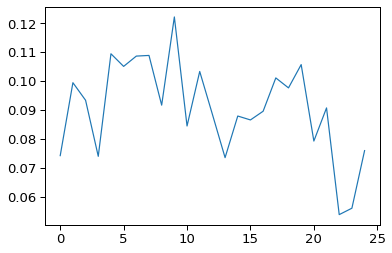

In [48]:
plt.plot(all_losses)

In [49]:
best_idx = np.argmin(all_losses)
best_idx

22

In [50]:
all_cv_scores[best_idx]

{'train_r2': array([0.89778998, 0.88447154, 0.9168271 , 0.98612661, 0.91632606]),
 'validate_r2': array([0.90709143, 0.97393432, 0.98664039, 0.93359197, 0.97636864]),
 'train_rmsd': array([0.08574905, 0.05888612, 0.04638546, 0.03725636, 0.06916857]),
 'validate_rmsd': array([0.08925526, 0.03247917, 0.03622246, 0.06516329, 0.04627839])}

In [55]:
best_emulator = all_emulators[best_idx]
best_emulator

In [56]:
best_emulator.train(retrain=True)

[INFO] >>> Training model on 80% of the dataset, testing on 20%...
[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0          0.802          0.139          0.709          0.127 *
[INFO]             100          0.856          0.119          0.693          0.131
[INFO]             200          0.886          0.105          0.758          0.117 *
[INFO]             300          0.834          0.127          0.801          0.105 *
[INFO]             400          0.792          0.143          0.708          0.127
[INFO]             500          0.820          0.133          0.851          0.092 *
[INFO]             600          0.847          0.122          0.663          0.137
[INFO]             700          0.860          0.118          0.718          0.125
[INFO]      

[INFO]            8400          0.919          0.089          0.770          0.113
[INFO]            8500          0.946          0.073          0.824          0.099
[INFO]            8600          0.914          0.091          0.790          0.108
[INFO]            8700          0.917          0.090          0.834          0.097
[INFO]            8800          0.932          0.081          0.819          0.101
[INFO]            8900          0.974          0.050          0.872          0.086
[INFO]            9000          0.962          0.061          0.737          0.120
[INFO]            9100          0.963          0.060          0.772          0.113
[INFO]            9200          0.960          0.062          0.772          0.113
[INFO]            9300          0.943          0.074          0.630          0.143
[INFO]            9400          0.938          0.078          0.691          0.130
[INFO]            9500          0.953          0.067          0.751          0.118
[INF

{'train_r2': 0.9452801996454638,
 'test_r2': 0.924814514950252,
 'train_rmsd': 0.07272788726943002,
 'test_rmsd': 0.06507854196080791}

In [20]:
hyperparams_iv = {'batch_size': 10,
 'hidden_act': 'leaky_relu',
 'hidden_depth': 5,
 'hidden_nodes': 52,
 'learning_rate': 0.0006265186132890483,
 'reg': 0.034862702568065805}


In [21]:
model  = BayesNeuralNet(
        **hyperparams_iv, out_act='sigmoid', 
    )
emulator = Emulator(
    dataset='suzuki_iv', model=model, 
    feature_transform='standardize', target_transform='normalize',
)

In [22]:
emulator.train()

[INFO] >>> Training model on 80% of the dataset, testing on 20%...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)
/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)


[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.724          0.298         -0.153          0.325 *
[INFO]             100          0.751          0.133          0.140          0.282 *
[INFO]             200          0.877          0.095          0.405          0.231 *
[INFO]             300          0.903          0.084          0.172          0.265
[INFO]             400          0.932          0.069          0.486          0.208 *
[INFO]             500          0.919          0.076          0.591          0.193 *
[INFO]             600          0.914          0.077          0.799          0.145 *
[INFO]             700          0.952          0.061          0.533          0.202
[INFO]             800          0.907          0.075          0.894        

[INFO]            8500          0.840          0.091          0.896          0.107
[INFO]            8600          0.842          0.090          0.852          0.135
[INFO]            8700          0.785          0.102          0.914          0.104
[INFO]            8800          0.816          0.100          0.924          0.088
[INFO]            8900          0.725          0.112          0.801          0.150
[INFO]            9000          0.740          0.117          0.841          0.121
[INFO]            9100          0.823          0.096          0.943          0.084
[INFO]            9200          0.794          0.102          0.925          0.094
[INFO]            9300          0.751          0.107          0.914          0.099
[INFO]            9400          0.795          0.102          0.943          0.084
[INFO]            9500          0.732          0.117          0.848          0.125
[INFO]            9600          0.832          0.091          0.855          0.124
[INF

{'train_r2': 0.8288832070415773,
 'test_r2': 0.9583926509214546,
 'train_rmsd': 0.09843242206762261,
 'test_rmsd': 0.06397437036839616}

In [23]:
emulator.save('emulator_suzuki_iv_BayesNeuralNet')

## `oer_plate_3496`

In [16]:
search_space = {
    'batch_size': hp.quniform('batch_size', 10, 50, 10),
    'hidden_act': hp.choice('hidden_act', ['leaky_relu'] ),
    'hidden_depth': hp.quniform('hidden_depth', 2, 5, 1),
    'hidden_nodes': hp.quniform('hidden_nodes', 28, 64, 4),
    'learning_rate': hp.uniform('learning_rate', 1e-5, 5e-3),
    'reg': hp.uniform('reg', 0.001, 0.1)
}

int_params = ['batch_size', 'hidden_depth', 'hidden_nodes']

all_emulators = []
all_losses = []
all_cv_scores = []
all_params = []

def objective(params):
    ''' average performance over cross-validation folds '''
    # build emualtor
    print(f'PARAMS : {params}')
    for param, val in params.items():
        if param in int_params:
            params[param] = int(val)
    model  = BayesNeuralNet(
        **params, out_act='sigmoid', 
    )
    emulator = Emulator(
        dataset='oer_plate_3496', model=model, 
        feature_transform='identity', target_transform='normalize',
    )

    cv_scores = emulator.cross_validate()
    loss = np.mean(cv_scores['validate_rmsd'])
    
    all_losses.append(loss)
    all_cv_scores.append(cv_scores)
    all_params.append(params)
    all_emulators.append(emulator)
    
    return {'loss': loss, 'status': STATUS_OK}

In [17]:
trials = Trials()

best = fmin(
    fn=objective,
    space=search_space, 
    algo=tpe.suggest, 
    max_evals=25,
    trials=trials
)

print(f"BEST VALUE : {best}")

PARAMS : {'batch_size': 20.0, 'hidden_act': 'leaky_relu', 'hidden_depth': 4.0, 'hidden_nodes': 36.0, 'learning_rate': 0.003792380602823533, 'reg': 0.03435217664423339}         
  0%|                                                                                                                                    | 0/25 [00:00<?, ?trial/s, best loss=?][INFO] >>> Training model on fold #0...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -5.955          0.350         -3.100          0.355 *
[INFO]             100          0.758          0.065          0.720          0.093 *
[INFO]             200          0.758          0.065          0.787          0.081 *
[INFO]             300          0.699          0.073          0.698          0.096
[INFO]             400          0.665          0.077          0.658          0.102
[INFO]             500          0.762          0.065          0.820          0.074 *
[INFO]             600          0.621          0.082          0.664          0.102
[INFO]             700          0.734          0.069          0.755          0.087
[INFO]             800          0.770          0.064          0.716          0.

[INFO]            8400          0.823          0.056          0.855          0.067
[INFO]            8500          0.828          0.055          0.844          0.069
[INFO]            8600          0.784          0.062          0.857          0.066
[INFO]            8700          0.837          0.054          0.850          0.068
[INFO]            8800          0.848          0.052          0.841          0.070
[INFO]            8900          0.775          0.063          0.843          0.070
[INFO]            9000          0.787          0.061          0.855          0.067
[INFO]            9100          0.784          0.062          0.844          0.069
[INFO]            9200          0.841          0.053          0.806          0.077
[INFO]            9300          0.806          0.058          0.834          0.071
[INFO]            9400          0.825          0.056          0.859          0.066
[INFO]            9500          0.830          0.055          0.846          0.069
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.795          0.272         -1.826          0.269 *
[INFO]             100          0.718          0.086          0.524          0.110 *
[INFO]             200          0.779          0.076          0.560          0.106 *
[INFO]             300          0.736          0.084          0.609          0.100 *
[INFO]             400          0.701          0.089          0.450          0.119
[INFO]             500          0.738          0.083          0.599          0.101
[INFO]             600          0.760          0.080          0.675          0.091 *
[INFO]             700          0.759          0.080          0.624          0.098
[INFO]             800          0.795          0.074          0.712          

[INFO]            8600          0.877          0.057          0.738          0.082
[INFO]            8700          0.892          0.053          0.753          0.079
[INFO]            8800          0.915          0.047          0.724          0.084
[INFO]            8900          0.889          0.054          0.833          0.065
[INFO]            9000          0.903          0.051          0.743          0.081
[INFO]            9100          0.906          0.050          0.788          0.074
[INFO]            9200          0.896          0.052          0.801          0.071
[INFO]            9300          0.902          0.051          0.785          0.074
[INFO]            9400          0.871          0.058          0.779          0.075
[INFO]            9500          0.896          0.052          0.760          0.078
[INFO]            9600          0.841          0.065          0.782          0.075
[INFO]            9700          0.835          0.066          0.879          0.056
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0        -21.297          0.358         -5.511          0.339 *
[INFO]             100         -0.209          0.083          0.745          0.067 *
[INFO]             200         -0.822          0.102          0.714          0.071
[INFO]             300          0.136          0.071          0.580          0.086
[INFO]             400         -0.019          0.077          0.621          0.082
[INFO]             500         -0.268          0.085          0.738          0.068
[INFO]             600          0.002          0.076          0.670          0.076
[INFO]             700         -0.061          0.078          0.676          0.076
[INFO]             800         -0.164          0.082          0.815          0.057 

[INFO]            8500          0.493          0.054          0.791          0.061
[INFO]            8600          0.401          0.059          0.820          0.056
[INFO]            8700          0.460          0.056          0.834          0.054
[INFO]            8800          0.495          0.054          0.823          0.056
[INFO]            8900          0.500          0.054          0.820          0.056
[INFO]            9000          0.478          0.055          0.814          0.057
[INFO]            9100          0.449          0.056          0.830          0.055
[INFO]            9200          0.385          0.060          0.832          0.055
[INFO]            9300          0.438          0.057          0.776          0.063
[INFO]            9400          0.489          0.054          0.826          0.055
[INFO]            9500          0.467          0.055          0.809          0.058
[INFO]            9600          0.519          0.053          0.821          0.056
[INF

[INFO]           17300          0.468          0.055          0.861          0.050
[INFO]           17400          0.376          0.060          0.772          0.063
[INFO]           17500          0.592          0.049          0.860          0.050
[INFO]           17600          0.517          0.053          0.877          0.047 *
[INFO]           17700          0.467          0.055          0.862          0.049
[INFO]           17800          0.266          0.065          0.839          0.053
[INFO]           17900          0.450          0.056          0.824          0.056
[INFO]           18000          0.505          0.053          0.841          0.053
[INFO]           18100          0.523          0.052          0.828          0.055
[INFO]           18200          0.461          0.056          0.842          0.053
[INFO]           18300          0.550          0.051          0.823          0.056
[INFO]           18400          0.636          0.046          0.852          0.051
[I

[INFO]           26300          0.650          0.045          0.851          0.051
[INFO]           26400          0.533          0.052          0.838          0.053
[INFO]           26500          0.568          0.050          0.855          0.051
[INFO]           26600          0.733          0.039          0.804          0.059
[INFO]           26700          0.634          0.046          0.864          0.049
[INFO]           26800          0.641          0.046          0.839          0.053
[INFO]           26900          0.623          0.047          0.818          0.057
[INFO]           27000          0.579          0.049          0.868          0.048
[INFO]           27100          0.488          0.054          0.872          0.048
[INFO]           27200          0.561          0.050          0.852          0.051
[INFO]           27300          0.551          0.051          0.813          0.057
[INFO]           27400          0.656          0.045          0.823          0.056
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -6.875          0.287         -5.810          0.331 *
[INFO]             100          0.457          0.075          0.781          0.059 *
[INFO]             200          0.251          0.088          0.735          0.065
[INFO]             300          0.147          0.094          0.806          0.056 *
[INFO]             400          0.435          0.077          0.607          0.079
[INFO]             500          0.369          0.081          0.615          0.079
[INFO]             600          0.566          0.067          0.707          0.069
[INFO]             700          0.519          0.071          0.689          0.071
[INFO]             800          0.433          0.077          0.667          0.07

[INFO]            8500          0.737          0.052          0.751          0.063
[INFO]            8600          0.742          0.052          0.770          0.061
[INFO]            8700          0.730          0.053          0.786          0.059
[INFO]            8800          0.720          0.054          0.791          0.058
[INFO]            8900          0.760          0.050          0.783          0.059
[INFO]            9000          0.714          0.055          0.792          0.058
[INFO]            9100          0.722          0.054          0.784          0.059
[INFO]            9200          0.709          0.055          0.779          0.060
[INFO]            9300          0.633          0.062          0.772          0.060
[INFO]            9400          0.707          0.055          0.788          0.058
[INFO]            9500          0.652          0.060          0.779          0.060
[INFO]            9600          0.720          0.054          0.775          0.060
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -5.332          0.321        -13.897          0.355 *
[INFO]             100          0.787          0.059          0.531          0.063 *
[INFO]             200          0.786          0.059          0.602          0.058 *
[INFO]             300          0.757          0.063          0.520          0.064
[INFO]             400          0.802          0.057          0.599          0.058
[INFO]             500          0.673          0.073          0.428          0.070
[INFO]             600          0.643          0.076          0.630          0.056 *
[INFO]             700          0.766          0.062          0.515          0.064
[INFO]             800          0.672          0.073          0.479          0.

[INFO]            8400          0.793          0.058          0.701          0.050
[INFO]            8500          0.780          0.060          0.646          0.055
[INFO]            8600          0.802          0.057          0.692          0.051
[INFO]            8700          0.821          0.054          0.666          0.053
[INFO]            8800          0.751          0.064          0.652          0.054
[INFO]            8900          0.809          0.056          0.622          0.057
[INFO]            9000          0.785          0.059          0.643          0.055
[INFO]            9100          0.813          0.055          0.646          0.055
[INFO]            9200          0.750          0.064          0.698          0.051
[INFO]            9300          0.745          0.064          0.695          0.051
[INFO]            9400          0.743          0.065          0.677          0.052
[INFO]            9500          0.812          0.055          0.698          0.051
[INF

[INFO]           17400          0.673          0.073          0.665          0.053
[INFO]           17500          0.796          0.058          0.700          0.050
[INFO]           17600          0.833          0.052          0.717          0.049
[INFO]           17700          0.686          0.072          0.723          0.048
[INFO]           17800          0.641          0.077          0.722          0.048
[INFO]           17900          0.836          0.052          0.719          0.049
[INFO]           18000          0.817          0.055          0.723          0.048
[INFO]           18100          0.754          0.063          0.716          0.049
[INFO]           18200          0.751          0.064          0.612          0.057
[INFO]           18300          0.708          0.069          0.716          0.049
[INFO]           18400          0.802          0.057          0.743          0.047
[INFO]           18500          0.846          0.050          0.675          0.052
[INF

[INFO]           26300          0.692          0.071          0.791          0.042
[INFO]           26400          0.712          0.069          0.763          0.045
[INFO]           26500          0.860          0.048          0.739          0.047
[INFO]           26600          0.755          0.063          0.757          0.045
[INFO]           26700          0.839          0.051          0.769          0.044
[INFO]           26800          0.790          0.058          0.722          0.049
[INFO]           26900          0.775          0.060          0.769          0.044
[INFO]           27000          0.529          0.088          0.766          0.045
[INFO]           27100          0.742          0.065          0.767          0.044
[INFO]           27200          0.687          0.071          0.762          0.045
[INFO]           27300          0.753          0.063          0.730          0.048
[INFO]           27400          0.819          0.054          0.795          0.042
[INF

[INFO]           35100          0.795          0.058          0.760          0.045
[INFO]           35200          0.848          0.050          0.744          0.047
[INFO]           35300          0.829          0.053          0.779          0.043
[INFO]           35400          0.789          0.059          0.747          0.046
[INFO]           35500          0.840          0.051          0.755          0.046
[INFO]           35600          0.794          0.058          0.751          0.046
[INFO]           35700          0.799          0.057          0.764          0.045
[INFO]           35800          0.748          0.064          0.803          0.041
[INFO]           35900          0.813          0.055          0.721          0.049
[INFO]           36000          0.859          0.048          0.745          0.046
[INFO]           36100          0.555          0.085          0.717          0.049
[INFO]           36200          0.869          0.046          0.803          0.041
[INF

[INFO]           44000          0.861          0.048          0.755          0.046
[INFO]           44100          0.852          0.049          0.807          0.040
[INFO]           44200          0.861          0.048          0.794          0.042
[INFO]           44300          0.844          0.050          0.754          0.046
[INFO]           44400          0.777          0.060          0.790          0.042
[INFO]           44500          0.900          0.040          0.816          0.039
[INFO]           44600          0.812          0.055          0.752          0.046
[INFO]           44700          0.848          0.050          0.827          0.038
[INFO]           44800          0.788          0.059          0.781          0.043
[INFO]           44900          0.745          0.065          0.679          0.052
[INFO]           45000          0.788          0.059          0.748          0.046
[INFO]           45100          0.821          0.054          0.735          0.047
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -7.900          0.366         -8.125          0.344 *
[INFO]             100          0.212          0.109          0.303          0.095 *
[INFO]             200          0.608          0.077          0.606          0.071 *
[INFO]             300          0.643          0.073          0.608          0.071 *
[INFO]             400          0.626          0.075          0.463          0.083
[INFO]             500          0.640          0.073          0.526          0.078
[INFO]             600          0.645          0.073          0.512          0.079
[INFO]             700          0.669          0.070          0.529          0.078
[INFO]             800          0.668          0.071          0.506          0.

[INFO]            8600          0.694          0.068          0.406          0.088
[INFO]            8700          0.724          0.064          0.476          0.082
[INFO]            8800          0.709          0.066          0.442          0.085
[INFO]            8900          0.730          0.064          0.463          0.083
[INFO]            9000          0.732          0.063          0.460          0.084
[INFO]            9100          0.697          0.067          0.522          0.079
[INFO]            9200          0.679          0.069          0.537          0.077
[INFO]            9300          0.700          0.067          0.484          0.082
[INFO]            9400          0.696          0.068          0.503          0.080
[INFO]            9500          0.718          0.065          0.461          0.083
[INFO]            9600          0.704          0.067          0.529          0.078
[INFO]            9700          0.712          0.066          0.483          0.082
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -9.382          0.344         -4.613          0.353 *
[INFO]             100          0.212          0.095          0.185          0.134 *
[INFO]             200          0.545          0.072          0.530          0.102 *
[INFO]             300          0.596          0.068          0.582          0.096 *
[INFO]             400          0.598          0.068          0.624          0.091 *
[INFO]             500          0.615          0.066          0.648          0.088 *
[INFO]             600          0.585          0.069          0.665          0.086 *
[INFO]             700          0.605          0.067          0.683          0.084 *
[INFO]             800          0.588          0.068          0.665    

[INFO]            8400          0.703          0.058          0.811          0.065
[INFO]            8500          0.720          0.056          0.803          0.066
[INFO]            8600          0.773          0.051          0.802          0.066
[INFO]            8700          0.765          0.052          0.810          0.065
[INFO]            8800          0.764          0.052          0.806          0.066
[INFO]            8900          0.734          0.055          0.799          0.067
[INFO]            9000          0.736          0.055          0.812          0.065
[INFO]            9100          0.722          0.056          0.818          0.063
[INFO]            9200          0.752          0.053          0.799          0.067
[INFO]            9300          0.762          0.052          0.801          0.066
[INFO]            9400          0.736          0.055          0.783          0.069
[INFO]            9500          0.773          0.051          0.804          0.066
[INF

[INFO]           17300          0.743          0.054          0.832          0.061
[INFO]           17400          0.763          0.052          0.822          0.063
[INFO]           17500          0.738          0.055          0.824          0.062
[INFO]           17600          0.774          0.051          0.809          0.065
[INFO]           17700          0.785          0.049          0.834          0.061
[INFO]           17800          0.763          0.052          0.825          0.062
[INFO]           17900          0.726          0.056          0.826          0.062
[INFO]           18000          0.725          0.056          0.829          0.062
[INFO]           18100          0.744          0.054          0.839          0.060
[INFO]           18200          0.786          0.049          0.830          0.061
[INFO]           18300          0.761          0.052          0.823          0.063
[INFO]           18400          0.715          0.057          0.831          0.061
[INF

[INFO]           26200          0.783          0.050          0.836          0.060
[INFO]           26300          0.729          0.055          0.852          0.057
[INFO]           26400          0.775          0.051          0.825          0.062
[INFO]           26500          0.736          0.055          0.836          0.060
[INFO]           26600          0.783          0.050          0.847          0.058
[INFO]           26700          0.780          0.050          0.846          0.058
[INFO]           26800          0.738          0.055          0.842          0.059
[INFO]           26900          0.758          0.052          0.842          0.059
[INFO]           27000          0.780          0.050          0.828          0.062
[INFO]           27100          0.764          0.052          0.831          0.061
[INFO]           27200          0.762          0.052          0.831          0.061
[INFO]           27300          0.751          0.053          0.835          0.060
[INF

[INFO]           35100          0.788          0.049          0.864          0.055
[INFO]           35200          0.815          0.046          0.851          0.057
[INFO]           35300          0.826          0.044          0.848          0.058
[INFO]           35400          0.798          0.048          0.856          0.056
[INFO]           35500          0.786          0.049          0.864          0.055
[INFO]           35600          0.813          0.046          0.865          0.055
[INFO]           35700          0.827          0.044          0.855          0.057
[INFO]           35800          0.828          0.044          0.848          0.058
[INFO]           35900          0.830          0.044          0.843          0.059
[INFO]           36000          0.806          0.047          0.858          0.056
[INFO]           36100          0.818          0.045          0.856          0.057
[INFO]           36200          0.826          0.045          0.856          0.057
[INF

[INFO]           43900          0.850          0.041          0.856          0.057
[INFO]           44000          0.849          0.041          0.862          0.055
[INFO]           44100          0.845          0.042          0.857          0.056
[INFO]           44200          0.849          0.042          0.866          0.055
[INFO]           44300          0.845          0.042          0.853          0.057
[INFO]           44400          0.834          0.043          0.863          0.055
[INFO]           44500          0.852          0.041          0.862          0.055
[INFO]           44600          0.845          0.042          0.868          0.054
[INFO]           44700          0.848          0.042          0.858          0.056
[INFO]           44800          0.837          0.043          0.860          0.056
[INFO]           44900          0.851          0.041          0.860          0.056
[INFO]           45000          0.849          0.041          0.858          0.056
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -5.105          0.300         -7.788          0.327 *
[INFO]             100          0.189          0.109          0.287          0.093 *
[INFO]             200          0.426          0.092          0.575          0.072 *
[INFO]             300          0.426          0.092          0.577          0.072 *
[INFO]             400          0.459          0.089          0.448          0.082
[INFO]             500          0.427          0.092          0.619          0.068 *
[INFO]             600          0.431          0.092          0.596          0.070
[INFO]             700          0.462          0.089          0.603          0.070
[INFO]             800          0.406          0.094          0.698          

[INFO]            8500          0.695          0.067          0.818          0.047
[INFO]            8600          0.677          0.069          0.822          0.047
[INFO]            8700          0.698          0.067          0.834          0.045
[INFO]            8800          0.693          0.067          0.831          0.045
[INFO]            8900          0.692          0.067          0.817          0.047
[INFO]            9000          0.720          0.064          0.799          0.049
[INFO]            9100          0.712          0.065          0.832          0.045
[INFO]            9200          0.655          0.071          0.847          0.043 *
[INFO]            9300          0.666          0.070          0.846          0.043
[INFO]            9400          0.713          0.065          0.845          0.043
[INFO]            9500          0.693          0.067          0.819          0.047
[INFO]            9600          0.682          0.068          0.848          0.043 *


[INFO]           17200          0.781          0.057          0.862          0.041
[INFO]           17300          0.750          0.061          0.885          0.037
[INFO]           17400          0.761          0.059          0.885          0.037
[INFO]           17500          0.773          0.058          0.875          0.039
[INFO]           17600          0.779          0.057          0.880          0.038
[INFO]           17700          0.768          0.059          0.879          0.038
[INFO]           17800          0.770          0.058          0.855          0.042
[INFO]           17900          0.777          0.057          0.876          0.039
[INFO]           18000          0.771          0.058          0.884          0.038
[INFO]           18100          0.772          0.058          0.880          0.038
[INFO]           18200          0.779          0.057          0.872          0.040
[INFO]           18300          0.770          0.058          0.872          0.039
[INF

[INFO]           26100          0.775          0.058          0.877          0.039
[INFO]           26200          0.770          0.058          0.897          0.035
[INFO]           26300          0.800          0.054          0.860          0.041
[INFO]           26400          0.783          0.056          0.889          0.037
[INFO]           26500          0.772          0.058          0.884          0.038
[INFO]           26600          0.799          0.054          0.873          0.039
[INFO]           26700          0.772          0.058          0.889          0.037
[INFO]           26800          0.793          0.055          0.876          0.039
[INFO]           26900          0.784          0.056          0.889          0.037
[INFO]           27000          0.773          0.058          0.875          0.039
[INFO]           27100          0.788          0.056          0.879          0.038
[INFO]           27200          0.771          0.058          0.875          0.039
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -5.453          0.279         -1.533          0.291 *
[INFO]             100          0.272          0.094          0.173          0.166 *
[INFO]             200          0.606          0.069          0.518          0.127 *
[INFO]             300          0.593          0.070          0.572          0.119 *
[INFO]             400          0.627          0.067          0.660          0.106 *
[INFO]             500          0.654          0.065          0.665          0.106 *
[INFO]             600          0.626          0.067          0.674          0.104 *
[INFO]             700          0.655          0.065          0.670          0.105
[INFO]             800          0.637          0.066          0.707      

[INFO]            8600          0.796          0.050          0.777          0.086
[INFO]            8700          0.779          0.052          0.758          0.090
[INFO]            8800          0.794          0.050          0.806          0.080
[INFO]            8900          0.803          0.049          0.774          0.087
[INFO]            9000          0.806          0.049          0.769          0.088
[INFO]            9100          0.785          0.051          0.749          0.091
[INFO]            9200          0.762          0.054          0.789          0.084
[INFO]            9300          0.779          0.052          0.798          0.082
[INFO]            9400          0.811          0.048          0.760          0.090
[INFO]            9500          0.778          0.052          0.807          0.080
[INFO]            9600          0.780          0.052          0.776          0.086
[INFO]            9700          0.829          0.045          0.767          0.088
[INF

[INFO]           17500          0.847          0.043          0.790          0.084
[INFO]           17600          0.847          0.043          0.790          0.084
[INFO]           17700          0.849          0.043          0.806          0.080
[INFO]           17800          0.862          0.041          0.791          0.084
[INFO]           17900          0.837          0.044          0.810          0.080
[INFO]           18000          0.832          0.045          0.809          0.080
[INFO]           18100          0.837          0.044          0.814          0.079
[INFO]           18200          0.837          0.044          0.812          0.079
[INFO]           18300          0.821          0.047          0.831          0.075
[INFO]           18400          0.832          0.045          0.809          0.080
[INFO]           18500          0.839          0.044          0.802          0.081
[INFO]           18600          0.830          0.045          0.815          0.078
[INF

[INFO]           26300          0.829          0.045          0.827          0.076
[INFO]           26400          0.834          0.045          0.807          0.080
[INFO]           26500          0.841          0.044          0.839          0.073
[INFO]           26600          0.838          0.044          0.832          0.075
[INFO]           26700          0.843          0.044          0.818          0.078
[INFO]           26800          0.847          0.043          0.829          0.075
[INFO]           26900          0.841          0.044          0.827          0.076
[INFO]           27000          0.854          0.042          0.823          0.077
[INFO]           27100          0.840          0.044          0.844          0.072
[INFO]           27200          0.839          0.044          0.821          0.077
[INFO]           27300          0.860          0.041          0.815          0.078
[INFO]           27400          0.821          0.047          0.824          0.077
[INF

[INFO]           35100          0.861          0.041          0.829          0.076
[INFO]           35200          0.840          0.044          0.847          0.071
[INFO]           35300          0.838          0.044          0.836          0.074
[INFO]           35400          0.834          0.045          0.844          0.072
[INFO]           35500          0.856          0.042          0.861          0.068
[INFO]           35600          0.849          0.043          0.845          0.072
[INFO]           35700          0.842          0.044          0.873          0.065
[INFO]           35800          0.851          0.042          0.826          0.076
[INFO]           35900          0.831          0.045          0.851          0.070
[INFO]           36000          0.848          0.043          0.847          0.071
[INFO]           36100          0.841          0.044          0.855          0.070
[INFO]           36200          0.845          0.043          0.862          0.068
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -6.001          0.348         -5.069          0.346 *
[INFO]             100          0.472          0.095          0.392          0.110 *
[INFO]             200          0.645          0.078          0.478          0.102 *
[INFO]             300          0.684          0.074          0.553          0.094 *
[INFO]             400          0.674          0.075          0.537          0.096
[INFO]             500          0.685          0.074          0.540          0.095
[INFO]             600          0.642          0.079          0.587          0.090 *
[INFO]             700          0.649          0.078          0.557          0.094
[INFO]             800          0.716          0.070          0.620          

[INFO]            8500          0.769          0.063          0.757          0.069
[INFO]            8600          0.732          0.068          0.762          0.069
[INFO]            8700          0.749          0.066          0.768          0.068
[INFO]            8800          0.761          0.064          0.763          0.068
[INFO]            8900          0.755          0.065          0.756          0.069
[INFO]            9000          0.748          0.066          0.742          0.071
[INFO]            9100          0.760          0.064          0.758          0.069
[INFO]            9200          0.752          0.066          0.755          0.069
[INFO]            9300          0.742          0.067          0.771          0.067
[INFO]            9400          0.770          0.063          0.770          0.067
[INFO]            9500          0.749          0.066          0.765          0.068
[INFO]            9600          0.772          0.063          0.764          0.068
[INF

[INFO]           17400          0.766          0.064          0.787          0.065
[INFO]           17500          0.795          0.060          0.772          0.067
[INFO]           17600          0.783          0.061          0.781          0.066
[INFO]           17700          0.779          0.062          0.804          0.062 *
[INFO]           17800          0.788          0.060          0.781          0.066
[INFO]           17900          0.774          0.062          0.791          0.064
[INFO]           18000          0.799          0.059          0.784          0.065
[INFO]           18100          0.776          0.062          0.784          0.065
[INFO]           18200          0.782          0.061          0.791          0.064
[INFO]           18300          0.785          0.061          0.791          0.064
[INFO]           18400          0.805          0.058          0.758          0.069
[INFO]           18500          0.790          0.060          0.783          0.065
[I

[INFO]           26300          0.800          0.059          0.777          0.066
[INFO]           26400          0.795          0.060          0.783          0.065
[INFO]           26500          0.789          0.060          0.772          0.067
[INFO]           26600          0.779          0.062          0.771          0.067
[INFO]           26700          0.788          0.061          0.774          0.067
[INFO]           26800          0.800          0.059          0.781          0.066
[INFO]           26900          0.797          0.059          0.779          0.066
[INFO]           27000          0.821          0.056          0.778          0.066
[INFO]           27100          0.800          0.059          0.765          0.068
[INFO]           27200          0.786          0.061          0.775          0.067
[INFO]           27300          0.807          0.058          0.773          0.067
[INFO]           27400          0.804          0.058          0.773          0.067
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -2.461          0.317        -12.128          0.323 *
[INFO]             100          0.539          0.116          0.424          0.068 *
[INFO]             200          0.636          0.103          0.517          0.062 *
[INFO]             300          0.663          0.099          0.455          0.066
[INFO]             400          0.681          0.096          0.509          0.063
[INFO]             500          0.712          0.091          0.628          0.054 *
[INFO]             600          0.762          0.083          0.686          0.050 *
[INFO]             700          0.724          0.089          0.573          0.058
[INFO]             800          0.763          0.083          0.556          

[INFO]            8600          0.810          0.074          0.806          0.039
[INFO]            8700          0.856          0.065          0.818          0.038
[INFO]            8800          0.827          0.071          0.819          0.038
[INFO]            8900          0.852          0.065          0.812          0.039
[INFO]            9000          0.852          0.066          0.830          0.037
[INFO]            9100          0.839          0.068          0.816          0.038
[INFO]            9200          0.840          0.068          0.800          0.040
[INFO]            9300          0.830          0.070          0.829          0.037
[INFO]            9400          0.844          0.067          0.824          0.037
[INFO]            9500          0.839          0.068          0.816          0.038
[INFO]            9600          0.835          0.069          0.833          0.036
[INFO]            9700          0.838          0.068          0.828          0.037
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -3.219          0.283         -5.655          0.293 *
[INFO]             100          0.542          0.093          0.561          0.075 *
[INFO]             200          0.614          0.086          0.619          0.070 *
[INFO]             300          0.613          0.086          0.653          0.067 *
[INFO]             400          0.672          0.079          0.693          0.063 *
[INFO]             500          0.716          0.074          0.707          0.062 *
[INFO]             600          0.719          0.073          0.671          0.065
[INFO]             700          0.768          0.066          0.704          0.062
[INFO]             800          0.752          0.069          0.733        

[INFO]            8400          0.775          0.065          0.698          0.062
[INFO]            8500          0.808          0.060          0.711          0.061
[INFO]            8600          0.806          0.061          0.722          0.060
[INFO]            8700          0.818          0.059          0.722          0.060
[INFO]            8800          0.807          0.061          0.689          0.063
[INFO]            8900          0.811          0.060          0.687          0.064
[INFO]            9000          0.791          0.063          0.690          0.063
[INFO]            9100          0.826          0.057          0.724          0.060
[INFO]            9200          0.819          0.059          0.700          0.062
[INFO]            9300          0.823          0.058          0.702          0.062
[INFO]            9400          0.804          0.061          0.665          0.066
[INFO]            9500          0.826          0.058          0.731          0.059
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -6.341          0.320        -10.384          0.311 *
[INFO]             100          0.664          0.068          0.337          0.075 *
[INFO]             200          0.632          0.072          0.338          0.075 *
[INFO]             300          0.613          0.073          0.388          0.072 *
[INFO]             400          0.717          0.063          0.528          0.063 *
[INFO]             500          0.698          0.065          0.535          0.063 *
[INFO]             600          0.754          0.059          0.630          0.056 *
[INFO]             700          0.790          0.054          0.626          0.056
[INFO]             800          0.759          0.058          0.641      

[INFO]            8400          0.804          0.052          0.773          0.044
[INFO]            8500          0.810          0.052          0.787          0.042
[INFO]            8600          0.824          0.050          0.760          0.045
[INFO]            8700          0.823          0.050          0.779          0.043
[INFO]            8800          0.818          0.050          0.775          0.044
[INFO]            8900          0.828          0.049          0.770          0.044
[INFO]            9000          0.816          0.051          0.774          0.044
[INFO]            9100          0.814          0.051          0.788          0.042
[INFO]            9200          0.819          0.050          0.778          0.043
[INFO]            9300          0.824          0.050          0.762          0.045
[INFO]            9400          0.827          0.049          0.773          0.044
[INFO]            9500          0.819          0.050          0.786          0.043
[INF

[INFO]           17300          0.858          0.045          0.744          0.047
[INFO]           17400          0.867          0.043          0.790          0.042
[INFO]           17500          0.861          0.044          0.768          0.044
[INFO]           17600          0.832          0.048          0.790          0.042
[INFO]           17700          0.858          0.044          0.796          0.042
[INFO]           17800          0.854          0.045          0.782          0.043
[INFO]           17900          0.854          0.045          0.796          0.042
[INFO]           18000          0.853          0.045          0.780          0.043
[INFO]           18100          0.832          0.048          0.763          0.045
[INFO]           18200          0.860          0.044          0.795          0.042
[INFO]           18300          0.856          0.045          0.783          0.043
[INFO]           18400          0.833          0.048          0.785          0.043
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -5.819          0.297         -6.232          0.287 *
[INFO]             100          0.547          0.076          0.583          0.069 *
[INFO]             200          0.620          0.070          0.607          0.067 *
[INFO]             300          0.629          0.069          0.589          0.068
[INFO]             400          0.709          0.061          0.645          0.064 *
[INFO]             500          0.756          0.056          0.694          0.059 *
[INFO]             600          0.750          0.057          0.633          0.065
[INFO]             700          0.779          0.053          0.680          0.060
[INFO]             800          0.808          0.050          0.669          

[INFO]            8500          0.895          0.037          0.704          0.058
[INFO]            8600          0.908          0.034          0.685          0.060
[INFO]            8700          0.891          0.038          0.708          0.058
[INFO]            8800          0.882          0.039          0.712          0.057
[INFO]            8900          0.898          0.036          0.679          0.060
[INFO]            9000          0.890          0.038          0.737          0.055
[INFO]            9100          0.898          0.036          0.703          0.058
[INFO]            9200          0.884          0.039          0.742          0.054
[INFO]            9300          0.875          0.040          0.706          0.058
[INFO]            9400          0.889          0.038          0.732          0.055
[INFO]            9500          0.893          0.037          0.711          0.057
[INFO]            9600          0.896          0.037          0.706          0.058
[INF

[INFO]           17500          0.901          0.036          0.698          0.059
[INFO]           17600          0.914          0.033          0.644          0.064
[INFO]           17700          0.901          0.036          0.717          0.057
[INFO]           17800          0.915          0.033          0.659          0.062
[INFO]           17900          0.905          0.035          0.714          0.057
[INFO]           18000          0.913          0.034          0.672          0.061
[INFO]           18100          0.903          0.035          0.677          0.061
[INFO] Training completed in 16.04 seconds.
[INFO] ===========================================================================

[INFO] >>> Training model on fold #4...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -2.907          0.288         -1.709          0.278 *
[INFO]             100          0.513          0.102          0.596          0.107 *
[INFO]             200          0.528          0.100          0.642          0.101 *
[INFO]             300          0.548          0.098          0.646          0.100 *
[INFO]             400          0.600          0.092          0.659          0.098 *
[INFO]             500          0.600          0.092          0.731          0.088 *
[INFO]             600          0.624          0.090          0.701          0.092
[INFO]             700          0.657          0.085          0.753          0.084 *
[INFO]             800          0.615          0.090          0.694      

[INFO]            8600          0.786          0.067          0.804          0.075
[INFO]            8700          0.802          0.065          0.805          0.075
[INFO]            8800          0.764          0.071          0.816          0.072
[INFO]            8900          0.776          0.069          0.785          0.078
[INFO]            9000          0.792          0.067          0.832          0.069
[INFO]            9100          0.780          0.068          0.805          0.074
[INFO]            9200          0.783          0.068          0.794          0.077
[INFO]            9300          0.790          0.067          0.807          0.074
[INFO]            9400          0.772          0.070          0.820          0.071
[INFO]            9500          0.771          0.070          0.790          0.077
[INFO]            9600          0.760          0.071          0.812          0.073
[INFO]            9700          0.781          0.068          0.806          0.074
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -3.391          0.282         -7.188          0.302 *
[INFO]             100          0.415          0.103          0.688          0.059 *
[INFO]             200          0.477          0.097          0.633          0.064
[INFO]             300          0.561          0.089          0.687          0.059
[INFO]             400          0.574          0.088          0.596          0.067
[INFO]             500          0.612          0.084          0.709          0.057 *
[INFO]             600          0.626          0.082          0.693          0.059
[INFO]             700          0.673          0.077          0.673          0.060
[INFO]             800          0.634          0.081          0.572          0.06

[INFO]           17200          0.907          0.041          0.699          0.058
[INFO]           17300          0.903          0.042          0.752          0.053
[INFO]           17400          0.912          0.040          0.660          0.062
[INFO]           17500          0.895          0.044          0.728          0.055
[INFO]           17600          0.906          0.041          0.681          0.060
[INFO]           17700          0.912          0.040          0.685          0.059
[INFO]           17800          0.917          0.039          0.694          0.058
[INFO]           17900          0.895          0.044          0.730          0.055
[INFO]           18000          0.900          0.042          0.677          0.060
[INFO]           18100          0.908          0.041          0.673          0.060
[INFO] Training completed in 21.85 seconds.
[INFO] ===========================================================================

[INFO] >>> Training model on fold #1...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -4.228          0.322         -9.585          0.326 *
[INFO]             100          0.557          0.094          0.571          0.066 *
[INFO]             200          0.666          0.081          0.624          0.061 *
[INFO]             300          0.684          0.079          0.502          0.071
[INFO]             400          0.725          0.074          0.661          0.058 *
[INFO]             500          0.714          0.075          0.723          0.053 *
[INFO]             600          0.689          0.078          0.702          0.055
[INFO]             700          0.712          0.076          0.647          0.060
[INFO]             800          0.761          0.069          0.739          

[INFO]            8400          0.855          0.054          0.788          0.046
[INFO]            8500          0.881          0.049          0.786          0.046
[INFO]            8600          0.852          0.054          0.792          0.046
[INFO]            8700          0.841          0.056          0.784          0.047
[INFO]            8800          0.837          0.057          0.782          0.047
[INFO]            8900          0.813          0.061          0.784          0.047
[INFO]            9000          0.822          0.059          0.805          0.044
[INFO]            9100          0.835          0.057          0.791          0.046
[INFO]            9200          0.849          0.055          0.775          0.048
[INFO]            9300          0.854          0.054          0.811          0.044 *
[INFO]            9400          0.842          0.056          0.796          0.045
[INFO]            9500          0.867          0.051          0.798          0.045
[I

[INFO]           17200          0.900          0.045          0.798          0.045
[INFO]           17300          0.908          0.043          0.793          0.046
[INFO]           17400          0.900          0.045          0.799          0.045
[INFO]           17500          0.922          0.039          0.793          0.046
[INFO]           17600          0.916          0.041          0.798          0.045
[INFO]           17700          0.890          0.047          0.807          0.044
[INFO]           17800          0.854          0.054          0.781          0.047
[INFO]           17900          0.878          0.049          0.785          0.046
[INFO]           18000          0.887          0.047          0.802          0.045
[INFO]           18100          0.875          0.050          0.805          0.044
[INFO]           18200          0.890          0.047          0.794          0.045
[INFO]           18300          0.920          0.040          0.810          0.044
[INF

[INFO]           26000          0.903          0.044          0.806          0.044
[INFO]           26100          0.911          0.042          0.812          0.043
[INFO]           26200          0.917          0.041          0.803          0.045
[INFO]           26300          0.894          0.046          0.807          0.044
[INFO]           26400          0.903          0.044          0.811          0.044
[INFO]           26500          0.905          0.043          0.799          0.045
[INFO]           26600          0.911          0.042          0.801          0.045
[INFO]           26700          0.915          0.041          0.796          0.045
[INFO]           26800          0.901          0.044          0.797          0.045
[INFO]           26900          0.893          0.046          0.802          0.045
[INFO]           27000          0.897          0.045          0.814          0.043
[INFO]           27100          0.912          0.042          0.804          0.044
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -6.960          0.340         -6.734          0.353 *
[INFO]             100          0.517          0.084          0.652          0.075 *
[INFO]             200          0.629          0.073          0.680          0.072 *
[INFO]             300          0.608          0.075          0.695          0.070 *
[INFO]             400          0.671          0.069          0.679          0.072
[INFO]             500          0.584          0.078          0.732          0.066 *
[INFO]             600          0.670          0.069          0.704          0.069
[INFO]             700          0.660          0.070          0.681          0.072
[INFO]             800          0.641          0.072          0.769          

[INFO]            8400          0.778          0.057          0.818          0.054
[INFO]            8500          0.793          0.055          0.820          0.054
[INFO]            8600          0.789          0.055          0.823          0.053
[INFO]            8700          0.796          0.054          0.811          0.055
[INFO]            8800          0.787          0.056          0.809          0.055
[INFO]            8900          0.798          0.054          0.814          0.055
[INFO]            9000          0.791          0.055          0.810          0.055
[INFO]            9100          0.791          0.055          0.835          0.052
[INFO]            9200          0.790          0.055          0.803          0.056
[INFO]            9300          0.798          0.054          0.817          0.054
[INFO]            9400          0.789          0.055          0.820          0.054
[INFO]            9500          0.787          0.056          0.807          0.056
[INF

[INFO] Training completed in 21.07 seconds.
[INFO] ===========================================================================

[INFO] >>> Training model on fold #3...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -7.061          0.319         -7.002          0.311 *
[INFO]             100          0.597          0.071          0.535          0.075 *
[INFO]             200          0.640          0.068          0.572          0.072 *
[INFO]             300          0.606          0.071          0.574          0.072 *
[INFO]             400          0.490          0.080          0.563          0.073
[INFO]             500          0.412          0.086          0.516          0.076
[INFO]             600          0.660          0.066          0.632          0.067 *
[INFO]             700          0.631          0.068          0.677          0.062 *
[INFO]             800          0.687          0.063          0.603        

[INFO]            8400          0.815          0.048          0.817          0.047
[INFO]            8500          0.813          0.049          0.825          0.046
[INFO]            8600          0.809          0.049          0.813          0.048
[INFO]            8700          0.805          0.050          0.796          0.050
[INFO]            8800          0.692          0.062          0.779          0.052
[INFO]            8900          0.769          0.054          0.765          0.053
[INFO]            9000          0.760          0.055          0.805          0.049
[INFO]            9100          0.707          0.061          0.748          0.055
[INFO]            9200          0.753          0.056          0.806          0.048
[INFO]            9300          0.694          0.062          0.750          0.055
[INFO]            9400          0.759          0.055          0.789          0.051
[INFO]            9500          0.821          0.048          0.782          0.051
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -8.460          0.360         -7.365          0.343 *
[INFO]             100          0.344          0.095          0.652          0.070 *
[INFO]             200          0.427          0.089          0.714          0.063 *
[INFO]             300          0.470          0.085          0.767          0.057 *
[INFO]             400          0.463          0.086          0.717          0.063
[INFO]             500          0.579          0.076          0.773          0.056 *
[INFO]             600          0.618          0.072          0.716          0.063
[INFO]             700          0.588          0.075          0.784          0.055 *
[INFO]             800          0.487          0.084          0.755        

[INFO]            8500          0.765          0.057          0.840          0.047
[INFO]            8600          0.774          0.056          0.839          0.048
[INFO]            8700          0.797          0.053          0.876          0.042 *
[INFO]            8800          0.774          0.056          0.861          0.044
[INFO]            8900          0.776          0.055          0.876          0.042 *
[INFO]            9000          0.763          0.057          0.849          0.046
[INFO]            9100          0.797          0.053          0.823          0.050
[INFO]            9200          0.769          0.056          0.870          0.043
[INFO]            9300          0.777          0.055          0.862          0.044
[INFO]            9400          0.801          0.052          0.837          0.048
[INFO]            9500          0.796          0.053          0.876          0.042
[INFO]            9600          0.753          0.058          0.846          0.047


[INFO]           17300          0.787          0.054          0.883          0.041
[INFO]           17400          0.771          0.056          0.866          0.043
[INFO]           17500          0.816          0.050          0.869          0.043
[INFO]           17600          0.852          0.045          0.871          0.043
[INFO]           17700          0.806          0.052          0.835          0.048
[INFO]           17800          0.824          0.049          0.847          0.046
[INFO]           17900          0.797          0.053          0.871          0.043
[INFO]           18000          0.817          0.050          0.875          0.042
[INFO]           18100          0.838          0.047          0.829          0.049
[INFO]           18200          0.799          0.052          0.889          0.039
[INFO]           18300          0.823          0.049          0.839          0.048
[INFO]           18400          0.832          0.048          0.844          0.047
[INF

[INFO]           26100          0.874          0.042          0.844          0.047
[INFO]           26200          0.861          0.044          0.773          0.056
[INFO]           26300          0.881          0.040          0.799          0.053
[INFO]           26400          0.886          0.039          0.767          0.057
[INFO]           26500          0.862          0.044          0.819          0.050
[INFO]           26600          0.874          0.042          0.821          0.050
[INFO]           26700          0.896          0.038          0.864          0.044
[INFO]           26800          0.875          0.041          0.867          0.043
[INFO]           26900          0.889          0.039          0.803          0.053
[INFO]           27000          0.895          0.038          0.784          0.055
[INFO]           27100          0.911          0.035          0.736          0.061
[INFO]           27200          0.897          0.038          0.773          0.057
[INF

PARAMS : {'batch_size': 20.0, 'hidden_act': 'leaky_relu', 'hidden_depth': 4.0, 'hidden_nodes': 32.0, 'learning_rate': 0.0014121852342609258, 'reg': 0.09981713388124375}        
 16%|████████████████▍                                                                                      | 4/25 [08:54<46:05, 131.71s/trial, best loss: 0.043518669733490944][INFO] >>> Training model on fold #0...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -4.567          0.286         -2.312          0.277 *
[INFO]             100          0.083          0.116          0.112          0.144 *
[INFO]             200          0.454          0.090          0.445          0.114 *
[INFO]             300          0.618          0.075          0.638          0.092 *
[INFO]             400          0.467          0.089          0.583          0.098
[INFO]             500          0.645          0.072          0.660          0.089 *
[INFO]             600          0.631          0.074          0.680          0.086 *
[INFO]             700          0.570          0.080          0.626          0.093
[INFO]             800          0.603          0.076          0.679        

[INFO]            8400          0.778          0.057          0.646          0.091
[INFO]            8500          0.814          0.052          0.706          0.083
[INFO]            8600          0.770          0.058          0.730          0.079
[INFO]            8700          0.756          0.060          0.717          0.081
[INFO]            8800          0.805          0.054          0.713          0.082
[INFO]            8900          0.772          0.058          0.751          0.076
[INFO]            9000          0.799          0.054          0.695          0.084
[INFO]            9100          0.798          0.054          0.773          0.073 *
[INFO]            9200          0.818          0.052          0.792          0.070 *
[INFO]            9300          0.788          0.056          0.718          0.081
[INFO]            9400          0.818          0.052          0.734          0.079
[INFO]            9500          0.734          0.063          0.708          0.082


[INFO]           17300          0.823          0.051          0.768          0.073
[INFO]           17400          0.809          0.053          0.741          0.078
[INFO]           17500          0.802          0.054          0.736          0.078
[INFO]           17600          0.814          0.052          0.766          0.074
[INFO]           17700          0.832          0.050          0.757          0.075
[INFO]           17800          0.811          0.053          0.760          0.075
[INFO]           17900          0.833          0.050          0.776          0.072
[INFO]           18000          0.837          0.049          0.683          0.086
[INFO]           18100          0.785          0.056          0.746          0.077
[INFO]           18200          0.787          0.056          0.677          0.087
[INFO]           18300          0.823          0.051          0.754          0.076
[INFO]           18400          0.820          0.051          0.726          0.080
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -9.033          0.335         -5.573          0.277 *
[INFO]             100          0.145          0.098          0.093          0.103 *
[INFO]             200          0.536          0.072          0.410          0.083 *
[INFO]             300          0.521          0.073          0.445          0.080 *
[INFO]             400          0.562          0.070          0.392          0.084
[INFO]             500          0.642          0.063          0.336          0.088
[INFO]             600          0.516          0.074          0.391          0.084
[INFO]             700          0.595          0.067          0.366          0.086
[INFO]             800          0.457          0.078          0.490          0.

[INFO]            8500          0.624          0.065          0.733          0.056 *
[INFO]            8600          0.671          0.061          0.640          0.065
[INFO]            8700          0.591          0.068          0.694          0.060
[INFO]            8800          0.626          0.065          0.717          0.057
[INFO]            8900          0.557          0.070          0.673          0.062
[INFO]            9000          0.649          0.063          0.670          0.062
[INFO]            9100          0.653          0.062          0.714          0.058
[INFO]            9200          0.716          0.056          0.702          0.059
[INFO]            9300          0.644          0.063          0.715          0.058
[INFO]            9400          0.653          0.062          0.665          0.062
[INFO]            9500          0.527          0.073          0.705          0.059
[INFO]            9600          0.662          0.062          0.684          0.061
[I

[INFO]           17400          0.576          0.069          0.667          0.062
[INFO]           17500          0.703          0.058          0.669          0.062
[INFO]           17600          0.606          0.066          0.750          0.054
[INFO]           17700          0.706          0.057          0.738          0.055
[INFO]           17800          0.682          0.060          0.707          0.058
[INFO]           17900          0.629          0.064          0.723          0.057
[INFO]           18000          0.637          0.064          0.781          0.050 *
[INFO]           18100          0.627          0.065          0.731          0.056
[INFO]           18200          0.635          0.064          0.744          0.055
[INFO]           18300          0.707          0.057          0.713          0.058
[INFO]           18400          0.706          0.057          0.735          0.056
[INFO]           18500          0.693          0.059          0.702          0.059
[I

[INFO]           26400          0.609          0.066          0.729          0.056
[INFO]           26500          0.675          0.060          0.750          0.054
[INFO]           26600          0.666          0.061          0.770          0.052
[INFO]           26700          0.754          0.053          0.748          0.054
[INFO]           26800          0.627          0.065          0.751          0.054
[INFO]           26900          0.751          0.053          0.730          0.056
[INFO]           27000          0.662          0.062          0.763          0.052
[INFO]           27100          0.633          0.064          0.777          0.051
[INFO]           27200          0.673          0.061          0.756          0.053
[INFO]           27300          0.761          0.052          0.730          0.056
[INFO]           27400          0.628          0.065          0.728          0.056
[INFO]           27500          0.665          0.061          0.795          0.049 *
[I

[INFO]           35300          0.630          0.064          0.783          0.050
[INFO]           35400          0.616          0.066          0.774          0.051
[INFO]           35500          0.668          0.061          0.809          0.047
[INFO]           35600          0.620          0.065          0.757          0.053
[INFO]           35700          0.657          0.062          0.791          0.049
[INFO]           35800          0.647          0.063          0.784          0.050
[INFO]           35900          0.604          0.067          0.725          0.057
[INFO]           36000          0.696          0.058          0.707          0.058
[INFO]           36100          0.678          0.060          0.756          0.053
[INFO]           36200          0.716          0.056          0.739          0.055
[INFO]           36300          0.702          0.058          0.761          0.053
[INFO]           36400          0.711          0.057          0.764          0.052
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -8.366          0.329         -3.659          0.302 *
[INFO]             100          0.224          0.095          0.153          0.129 *
[INFO]             200          0.452          0.080          0.617          0.086 *
[INFO]             300          0.480          0.077          0.713          0.075 *
[INFO]             400          0.480          0.078          0.697          0.077
[INFO]             500          0.500          0.076          0.662          0.081
[INFO]             600          0.469          0.078          0.670          0.080
[INFO]             700          0.424          0.082          0.761          0.068 *
[INFO]             800          0.480          0.078          0.680          

[INFO]            8600          0.787          0.050          0.936          0.035 *
[INFO]            8700          0.734          0.055          0.891          0.046
[INFO]            8800          0.754          0.053          0.913          0.041
[INFO]            8900          0.737          0.055          0.894          0.045
[INFO]            9000          0.757          0.053          0.885          0.047
[INFO]            9100          0.757          0.053          0.929          0.037
[INFO]            9200          0.758          0.053          0.919          0.040
[INFO]            9300          0.734          0.055          0.891          0.046
[INFO]            9400          0.769          0.052          0.910          0.042
[INFO]            9500          0.759          0.053          0.879          0.049
[INFO]            9600          0.742          0.055          0.895          0.045
[INFO]            9700          0.776          0.051          0.884          0.048
[I

[INFO]           17600          0.826          0.045          0.904          0.043
[INFO]           17700          0.805          0.047          0.880          0.048
[INFO]           17800          0.777          0.051          0.887          0.047
[INFO]           17900          0.804          0.048          0.905          0.043
[INFO]           18000          0.805          0.047          0.891          0.046
[INFO]           18100          0.784          0.050          0.874          0.050
[INFO]           18200          0.805          0.047          0.897          0.045
[INFO]           18300          0.801          0.048          0.903          0.044
[INFO]           18400          0.777          0.051          0.866          0.051
[INFO]           18500          0.827          0.045          0.910          0.042
[INFO] Training completed in 19.12 seconds.
[INFO] ===========================================================================

[INFO] >>> Training model on fold #3...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -3.771          0.267         -7.020          0.261 *
[INFO]             100          0.073          0.117          0.243          0.080 *
[INFO]             200          0.350          0.098          0.475          0.067 *
[INFO]             300          0.367          0.097          0.309          0.077
[INFO]             400          0.372          0.097          0.379          0.073
[INFO]             500          0.326          0.100          0.395          0.072
[INFO]             600          0.345          0.099          0.204          0.082
[INFO]             700          0.294          0.103          0.241          0.080
[INFO]             800          0.401          0.094          0.186          0.08

[INFO]            8600          0.652          0.072         -0.185          0.100
[INFO]            8700          0.596          0.078          0.108          0.087
[INFO]            8800          0.653          0.072          0.133          0.086
[INFO]            8900          0.676          0.069          0.137          0.086
[INFO]            9000          0.732          0.063          0.146          0.085
[INFO]            9100          0.676          0.069          0.122          0.086
[INFO]            9200          0.626          0.075          0.049          0.090
[INFO]            9300          0.675          0.070          0.158          0.085
[INFO]            9400          0.720          0.065          0.220          0.081
[INFO]            9500          0.671          0.070          0.080          0.088
[INFO]            9600          0.698          0.067          0.171          0.084
[INFO]            9700          0.657          0.071          0.140          0.085
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -4.774          0.298        -14.033          0.316 *
[INFO]             100          0.321          0.102          0.164          0.075 *
[INFO]             200          0.836          0.050          0.455          0.060 *
[INFO]             300          0.859          0.046          0.539          0.055 *
[INFO]             400          0.832          0.051          0.472          0.059
[INFO]             500          0.781          0.058          0.422          0.062
[INFO]             600          0.811          0.054          0.517          0.057
[INFO]             700          0.840          0.050          0.339          0.066
[INFO]             800          0.803          0.055          0.450          0.

[INFO]            8500          0.784          0.058          0.729          0.043 *
[INFO]            8600          0.831          0.051          0.644          0.049
[INFO]            8700          0.804          0.055          0.657          0.048
[INFO]            8800          0.808          0.054          0.663          0.047
[INFO]            8900          0.819          0.053          0.723          0.043
[INFO]            9000          0.796          0.056          0.692          0.045
[INFO]            9100          0.811          0.054          0.633          0.049
[INFO]            9200          0.762          0.060          0.671          0.047
[INFO]            9300          0.830          0.051          0.700          0.045
[INFO]            9400          0.806          0.055          0.689          0.045
[INFO]            9500          0.794          0.056          0.670          0.047
[INFO]            9600          0.816          0.053          0.766          0.039 *


[INFO]           17400          0.831          0.051          0.804          0.036
[INFO]           17500          0.842          0.049          0.800          0.037
[INFO]           17600          0.846          0.049          0.787          0.038
[INFO]           17700          0.818          0.053          0.817          0.035
[INFO]           17800          0.822          0.052          0.796          0.037
[INFO]           17900          0.834          0.050          0.793          0.037
[INFO]           18000          0.822          0.052          0.820          0.035
[INFO]           18100          0.824          0.052          0.811          0.035
[INFO]           18200          0.816          0.053          0.797          0.037
[INFO]           18300          0.835          0.050          0.824          0.034
[INFO]           18400          0.825          0.052          0.781          0.038
[INFO]           18500          0.813          0.054          0.787          0.038
[INF

[INFO]           26300          0.823          0.052          0.792          0.037
[INFO]           26400          0.828          0.051          0.798          0.037
[INFO]           26500          0.822          0.052          0.816          0.035
[INFO]           26600          0.833          0.051          0.806          0.036
[INFO]           26700          0.824          0.052          0.822          0.034
[INFO]           26800          0.816          0.053          0.785          0.038
[INFO]           26900          0.822          0.052          0.815          0.035
[INFO]           27000          0.816          0.053          0.815          0.035
[INFO]           27100          0.809          0.054          0.808          0.036
[INFO]           27200          0.830          0.051          0.801          0.036
[INFO]           27300          0.770          0.059          0.800          0.036
[INFO]           27400          0.791          0.057          0.733          0.042
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0        -13.509          0.330         -5.956          0.313 *
[INFO]             100          0.584          0.056          0.477          0.086 *
[INFO]             200          0.526          0.060          0.716          0.063 *
[INFO]             300          0.475          0.063          0.630          0.072
[INFO]             400          0.599          0.055          0.649          0.070
[INFO]             500          0.632          0.053          0.704          0.065
[INFO]             600          0.377          0.068          0.711          0.064
[INFO]             700          0.604          0.055          0.722          0.063 *
[INFO]             800          0.555          0.058          0.691          0.

[INFO]            8400          0.654          0.051          0.803          0.053
[INFO]            8500          0.680          0.049          0.802          0.053
[INFO]            8600          0.642          0.052          0.799          0.053
[INFO]            8700          0.660          0.051          0.804          0.052
[INFO]            8800          0.687          0.048          0.806          0.052
[INFO]            8900          0.599          0.055          0.771          0.057
[INFO]            9000          0.639          0.052          0.783          0.055
[INFO]            9100          0.669          0.050          0.809          0.052
[INFO]            9200          0.665          0.050          0.814          0.051
[INFO]            9300          0.666          0.050          0.804          0.053
[INFO]            9400          0.675          0.049          0.806          0.052
[INFO]            9500          0.679          0.049          0.800          0.053
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -3.560          0.310         -2.543          0.304 *
[INFO]             100          0.497          0.103          0.446          0.120 *
[INFO]             200          0.643          0.087          0.621          0.099 *
[INFO]             300          0.635          0.088          0.652          0.095 *
[INFO]             400          0.629          0.088          0.725          0.085 *
[INFO]             500          0.632          0.088          0.732          0.083 *
[INFO]             600          0.626          0.089          0.657          0.095
[INFO]             700          0.619          0.090          0.581          0.104
[INFO]             800          0.571          0.095          0.635        

[INFO]            8400          0.738          0.074          0.810          0.070
[INFO]            8500          0.721          0.077          0.780          0.076
[INFO]            8600          0.718          0.077          0.818          0.069
[INFO]            8700          0.742          0.074          0.831          0.066
[INFO]            8800          0.704          0.079          0.824          0.068
[INFO]            8900          0.724          0.076          0.824          0.068
[INFO]            9000          0.729          0.076          0.845          0.063
[INFO]            9100          0.726          0.076          0.845          0.064
[INFO]            9200          0.684          0.082          0.828          0.067
[INFO]            9300          0.710          0.078          0.850          0.063
[INFO]            9400          0.707          0.079          0.836          0.065
[INFO]            9500          0.713          0.078          0.811          0.070
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -2.565          0.305         -4.095          0.316 *
[INFO]             100          0.241          0.141          0.349          0.113 *
[INFO]             200          0.600          0.102          0.680          0.079 *
[INFO]             300          0.674          0.092          0.714          0.075 *
[INFO]             400          0.663          0.094          0.695          0.077
[INFO]             500          0.705          0.088          0.713          0.075
[INFO]             600          0.729          0.084          0.728          0.073 *
[INFO]             700          0.701          0.088          0.625          0.086
[INFO]             800          0.706          0.088          0.698          

[INFO]            8600          0.904          0.050          0.803          0.062
[INFO]            8700          0.924          0.045          0.825          0.059
[INFO]            8800          0.911          0.048          0.801          0.062
[INFO]            8900          0.907          0.049          0.841          0.056 *
[INFO]            9000          0.903          0.050          0.816          0.060
[INFO]            9100          0.904          0.050          0.812          0.061
[INFO]            9200          0.914          0.047          0.823          0.059
[INFO]            9300          0.902          0.051          0.821          0.059
[INFO]            9400          0.930          0.043          0.778          0.066
[INFO]            9500          0.941          0.039          0.814          0.060
[INFO]            9600          0.927          0.044          0.825          0.059
[INFO]            9700          0.930          0.043          0.825          0.059
[I

[INFO]           17400          0.923          0.045          0.862          0.052
[INFO]           17500          0.907          0.049          0.865          0.051
[INFO]           17600          0.909          0.049          0.861          0.052
[INFO]           17700          0.937          0.041          0.881          0.048
[INFO]           17800          0.927          0.044          0.866          0.051
[INFO]           17900          0.926          0.044          0.861          0.052
[INFO]           18000          0.947          0.037          0.874          0.050
[INFO]           18100          0.935          0.041          0.853          0.054
[INFO]           18200          0.930          0.043          0.869          0.051
[INFO]           18300          0.936          0.041          0.865          0.051
[INFO]           18400          0.932          0.042          0.853          0.054
[INFO]           18500          0.947          0.037          0.865          0.051
[INF

[INFO]           26200          0.951          0.036          0.852          0.054
[INFO]           26300          0.919          0.046          0.811          0.061
[INFO]           26400          0.930          0.043          0.844          0.055
[INFO]           26500          0.927          0.044          0.834          0.057
[INFO] Training completed in 29.19 seconds.
[INFO] ===========================================================================

[INFO] >>> Training model on fold #3...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -7.059          0.320         -0.654          0.298 *
[INFO]             100          0.466          0.082          0.173          0.211 *
[INFO]             200          0.632          0.068          0.488          0.166 *
[INFO]             300          0.721          0.059          0.513          0.162 *
[INFO]             400          0.703          0.061          0.515          0.162 *
[INFO]             500          0.728          0.059          0.540          0.157 *
[INFO]             600          0.801          0.050          0.626          0.142 *
[INFO]             700          0.736          0.058          0.540          0.157
[INFO]             800          0.730          0.058          0.637      

[INFO]            8400          0.925          0.031          0.708          0.125
[INFO]            8500          0.928          0.030          0.703          0.127
[INFO]            8600          0.933          0.029          0.715          0.124
[INFO]            8700          0.915          0.033          0.705          0.126
[INFO]            8800          0.935          0.029          0.724          0.122
[INFO]            8900          0.927          0.030          0.714          0.124
[INFO]            9000          0.921          0.032          0.654          0.137
[INFO]            9100          0.926          0.031          0.708          0.125
[INFO]            9200          0.927          0.030          0.703          0.126
[INFO]            9300          0.924          0.031          0.676          0.132
[INFO]            9400          0.938          0.028          0.693          0.129
[INFO]            9500          0.896          0.036          0.667          0.134
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -4.347          0.295        -12.425          0.291 *
[INFO]             100          0.357          0.102          0.233          0.070 *
[INFO]             200          0.518          0.089          0.282          0.067 *
[INFO]             300          0.459          0.094         -0.058          0.082
[INFO]             400          0.491          0.091          0.166          0.073
[INFO]             500          0.531          0.087          0.304          0.066 *
[INFO]             600          0.526          0.088          0.141          0.074
[INFO]             700          0.522          0.088          0.295          0.067
[INFO]             800          0.547          0.086          0.295          0.

[INFO]            8400          0.719          0.068          0.691          0.044 *
[INFO]            8500          0.730          0.066          0.706          0.043 *
[INFO]            8600          0.771          0.061          0.721          0.042 *
[INFO]            8700          0.746          0.064          0.692          0.044
[INFO]            8800          0.744          0.064          0.659          0.046
[INFO]            8900          0.646          0.076          0.628          0.048
[INFO]            9000          0.689          0.071          0.686          0.045
[INFO]            9100          0.740          0.065          0.685          0.045
[INFO]            9200          0.735          0.066          0.659          0.046
[INFO]            9300          0.632          0.077          0.698          0.044
[INFO]            9400          0.783          0.059          0.642          0.048
[INFO]            9500          0.664          0.074          0.704          0.04

[INFO]           26000          0.863          0.047          0.663          0.046
[INFO]           26100          0.873          0.045          0.711          0.043
[INFO]           26200          0.913          0.038          0.691          0.044
[INFO]           26300          0.882          0.044          0.691          0.044
[INFO]           26400          0.884          0.043          0.665          0.046
[INFO]           26500          0.898          0.041          0.685          0.045
[INFO]           26600          0.882          0.044          0.667          0.046
[INFO]           26700          0.905          0.039          0.744          0.040
[INFO]           26800          0.903          0.040          0.609          0.050
[INFO]           26900          0.881          0.044          0.708          0.043
[INFO]           27000          0.900          0.040          0.681          0.045
[INFO]           27100          0.901          0.040          0.750          0.040
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -8.843          0.322         -3.292          0.323 *
[INFO]             100          0.683          0.058          0.746          0.079 *
[INFO]             200          0.710          0.055          0.825          0.065 *
[INFO]             300          0.743          0.052          0.731          0.081
[INFO]             400          0.802          0.046          0.857          0.059 *
[INFO]             500          0.700          0.056          0.734          0.080
[INFO]             600          0.501          0.073          0.674          0.089
[INFO]             700          0.768          0.050          0.809          0.068
[INFO]             800          0.737          0.053          0.799          0.

[INFO]           17200          0.871          0.037          0.846          0.061
[INFO]           17300          0.885          0.035          0.831          0.064
[INFO]           17400          0.840          0.041          0.819          0.066
[INFO]           17500          0.767          0.050          0.870          0.056
[INFO]           17600          0.827          0.043          0.841          0.062
[INFO]           17700          0.879          0.036          0.859          0.058
[INFO]           17800          0.862          0.038          0.845          0.061
[INFO]           17900          0.880          0.036          0.828          0.065
[INFO]           18000          0.820          0.044          0.836          0.063
[INFO]           18100          0.813          0.044          0.840          0.062
[INFO]           18200          0.835          0.042          0.822          0.066
[INFO]           18300          0.829          0.042          0.825          0.065
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -4.498          0.286         -8.191          0.318 *
[INFO]             100          0.760          0.060          0.514          0.073 *
[INFO]             200          0.801          0.054          0.555          0.070 *
[INFO]             300          0.766          0.059          0.605          0.066 *
[INFO]             400          0.802          0.054          0.496          0.074
[INFO]             500          0.790          0.056          0.471          0.076
[INFO]             600          0.780          0.057          0.503          0.074
[INFO]             700          0.683          0.069          0.514          0.073
[INFO]             800          0.727          0.064          0.539          0.

[INFO]            8500          0.807          0.053          0.782          0.049 *
[INFO]            8600          0.796          0.055          0.739          0.054
[INFO]            8700          0.844          0.048          0.722          0.055
[INFO]            8800          0.830          0.050          0.622          0.064
[INFO]            8900          0.819          0.052          0.741          0.053
[INFO]            9000          0.866          0.045          0.740          0.053
[INFO]            9100          0.869          0.044          0.746          0.053
[INFO]            9200          0.866          0.045          0.754          0.052
[INFO]            9300          0.880          0.042          0.688          0.059
[INFO]            9400          0.824          0.051          0.756          0.052
[INFO]            9500          0.839          0.049          0.770          0.050
[INFO]            9600          0.765          0.059          0.660          0.061
[I

[INFO]           17400          0.849          0.047          0.731          0.054
[INFO]           17500          0.869          0.044          0.715          0.056
[INFO]           17600          0.867          0.044          0.657          0.061
[INFO]           17700          0.837          0.049          0.728          0.055
[INFO]           17800          0.785          0.056          0.727          0.055
[INFO]           17900          0.804          0.054          0.749          0.052
[INFO]           18000          0.881          0.042          0.689          0.058
[INFO]           18100          0.785          0.057          0.716          0.056
[INFO]           18200          0.829          0.050          0.768          0.050
[INFO]           18300          0.852          0.047          0.765          0.051
[INFO]           18400          0.860          0.046          0.754          0.052
[INFO]           18500          0.810          0.053          0.727          0.055
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -2.247          0.260         -1.602          0.282 *
[INFO]             100          0.497          0.102          0.606          0.110 *
[INFO]             200          0.510          0.101          0.549          0.118
[INFO]             300          0.485          0.104          0.651          0.103 *
[INFO]             400          0.522          0.100          0.626          0.107
[INFO]             500          0.436          0.108          0.624          0.107
[INFO]             600          0.453          0.107          0.508          0.123
[INFO]             700          0.469          0.105          0.633          0.106
[INFO]             800          0.544          0.097          0.520          0.12

[INFO]            8400          0.754          0.071          0.661          0.102
[INFO]            8500          0.762          0.070          0.665          0.101
[INFO]            8600          0.772          0.069          0.727          0.091
[INFO]            8700          0.802          0.064          0.718          0.093
[INFO]            8800          0.786          0.067          0.731          0.091 *
[INFO]            8900          0.782          0.067          0.742          0.089 *
[INFO]            9000          0.781          0.067          0.742          0.089 *
[INFO]            9100          0.787          0.067          0.729          0.091
[INFO]            9200          0.827          0.060          0.717          0.093
[INFO]            9300          0.769          0.069          0.728          0.091
[INFO]            9400          0.775          0.068          0.711          0.094
[INFO]            9500          0.799          0.065          0.732          0.09

[INFO]           17200          0.790          0.066          0.756          0.086
[INFO]           17300          0.838          0.058          0.748          0.088
[INFO]           17400          0.779          0.068          0.719          0.093
[INFO]           17500          0.769          0.069          0.756          0.086
[INFO]           17600          0.814          0.062          0.746          0.088
[INFO]           17700          0.730          0.075          0.733          0.090
[INFO]           17800          0.802          0.064          0.734          0.090
[INFO]           17900          0.788          0.066          0.753          0.087
[INFO]           18000          0.737          0.074          0.739          0.089
[INFO]           18100          0.782          0.067          0.718          0.093
[INFO]           18200          0.833          0.059          0.758          0.086
[INFO]           18300          0.836          0.058          0.731          0.091
[INF

[INFO]           26200          0.781          0.067          0.760          0.086
[INFO]           26300          0.771          0.069          0.774          0.083
[INFO]           26400          0.765          0.070          0.780          0.082
[INFO]           26500          0.749          0.072          0.716          0.093
[INFO]           26600          0.829          0.060          0.767          0.085
[INFO]           26700          0.740          0.074          0.752          0.087
[INFO]           26800          0.852          0.056          0.776          0.083
[INFO]           26900          0.756          0.071          0.776          0.083
[INFO]           27000          0.774          0.069          0.785          0.081
[INFO]           27100          0.773          0.069          0.810          0.076 *
[INFO]           27200          0.754          0.072          0.765          0.085
[INFO]           27300          0.731          0.075          0.760          0.086
[I

[INFO]           35100          0.756          0.071          0.777          0.083
[INFO]           35200          0.807          0.063          0.805          0.077
[INFO]           35300          0.740          0.074          0.759          0.086
[INFO]           35400          0.780          0.068          0.791          0.080
[INFO]           35500          0.763          0.070          0.752          0.087
[INFO]           35600          0.757          0.071          0.797          0.079
[INFO]           35700          0.778          0.068          0.773          0.084
[INFO]           35800          0.758          0.071          0.777          0.083
[INFO]           35900          0.675          0.082          0.778          0.082
[INFO]           36000          0.786          0.067          0.781          0.082
[INFO]           36100          0.794          0.065          0.769          0.084
[INFO]           36200          0.793          0.066          0.782          0.082
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -4.396          0.271         -3.845          0.283 *
[INFO]             100          0.431          0.088          0.634          0.078 *
[INFO]             200          0.563          0.077          0.586          0.083
[INFO]             300          0.516          0.081          0.588          0.083
[INFO]             400          0.288          0.098          0.560          0.085
[INFO]             500          0.503          0.082          0.550          0.086
[INFO]             600          0.553          0.078          0.501          0.091
[INFO]             700          0.564          0.077          0.635          0.078 *
[INFO]             800          0.590          0.075          0.526          0.08

[INFO]            8400          0.716          0.062          0.853          0.049
[INFO]            8500          0.646          0.069          0.873          0.046
[INFO]            8600          0.586          0.075          0.856          0.049
[INFO]            8700          0.691          0.065          0.867          0.047
[INFO]            8800          0.689          0.065          0.857          0.049
[INFO]            8900          0.714          0.062          0.828          0.053
[INFO]            9000          0.741          0.059          0.867          0.047
[INFO]            9100          0.644          0.070          0.889          0.043 *
[INFO]            9200          0.674          0.067          0.828          0.053
[INFO]            9300          0.667          0.067          0.821          0.055
[INFO]            9400          0.704          0.064          0.849          0.050
[INFO]            9500          0.672          0.067          0.860          0.048
[I

[INFO]           17400          0.677          0.066          0.866          0.047
[INFO]           17500          0.693          0.065          0.890          0.043
[INFO]           17600          0.738          0.060          0.864          0.047
[INFO]           17700          0.730          0.061          0.854          0.049
[INFO]           17800          0.668          0.067          0.876          0.045
[INFO]           17900          0.717          0.062          0.833          0.053
[INFO]           18000          0.699          0.064          0.855          0.049
[INFO]           18100          0.717          0.062          0.824          0.054
[INFO]           18200          0.743          0.059          0.881          0.044
[INFO]           18300          0.740          0.059          0.866          0.047
[INFO]           18400          0.706          0.063          0.906          0.039 *
[INFO]           18500          0.721          0.062          0.877          0.045
[I

[INFO]           26200          0.788          0.054          0.875          0.045
[INFO]           26300          0.747          0.059          0.878          0.045
[INFO]           26400          0.750          0.058          0.898          0.041
[INFO]           26500          0.761          0.057          0.881          0.044
[INFO]           26600          0.745          0.059          0.865          0.047
[INFO]           26700          0.786          0.054          0.880          0.045
[INFO]           26800          0.770          0.056          0.889          0.043
[INFO]           26900          0.733          0.060          0.905          0.040
[INFO]           27000          0.769          0.056          0.870          0.046
[INFO]           27100          0.752          0.058          0.865          0.047
[INFO]           27200          0.716          0.062          0.863          0.048
[INFO]           27300          0.746          0.059          0.880          0.045
[INF

[INFO]           35000          0.736          0.060          0.886          0.043
[INFO]           35100          0.755          0.058          0.856          0.049
[INFO]           35200          0.767          0.056          0.879          0.045
[INFO]           35300          0.779          0.055          0.823          0.054
[INFO]           35400          0.759          0.057          0.818          0.055
[INFO]           35500          0.777          0.055          0.863          0.048
[INFO]           35600          0.728          0.061          0.806          0.057
[INFO]           35700          0.790          0.054          0.862          0.048
[INFO]           35800          0.692          0.065          0.806          0.057
[INFO]           35900          0.785          0.054          0.860          0.048
[INFO]           36000          0.760          0.057          0.864          0.047
[INFO]           36100          0.726          0.061          0.859          0.048
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -5.327          0.243         -2.049          0.219 *
[INFO]             100          0.419          0.074          0.714          0.067 *
[INFO]             200          0.433          0.073          0.733          0.065 *
[INFO]             300          0.452          0.072          0.727          0.066
[INFO]             400          0.211          0.086          0.600          0.079
[INFO]             500          0.396          0.075          0.737          0.064 *
[INFO]             600          0.272          0.082          0.685          0.070
[INFO]             700          0.307          0.080          0.712          0.067
[INFO]             800          0.574          0.063          0.741          0.

[INFO]            8500          0.885          0.033          0.834          0.051
[INFO]            8600          0.667          0.056          0.767          0.061
[INFO]            8700          0.859          0.036          0.831          0.052
[INFO]            8800          0.784          0.045          0.815          0.054
[INFO]            8900          0.822          0.041          0.829          0.052
[INFO]            9000          0.857          0.037          0.796          0.057
[INFO]            9100          0.827          0.040          0.841          0.050
[INFO]            9200          0.804          0.043          0.834          0.051
[INFO]            9300          0.812          0.042          0.784          0.058
[INFO]            9400          0.810          0.042          0.824          0.053
[INFO]            9500          0.807          0.042          0.800          0.056
[INFO]            9600          0.836          0.039          0.822          0.053
[INF

[INFO]           17300          0.810          0.042          0.853          0.048
[INFO]           17400          0.820          0.041          0.839          0.050
[INFO]           17500          0.838          0.039          0.848          0.049
[INFO]           17600          0.709          0.052          0.837          0.051
[INFO]           17700          0.810          0.042          0.837          0.051
[INFO]           17800          0.892          0.032          0.843          0.050
[INFO]           17900          0.788          0.044          0.856          0.048
[INFO]           18000          0.866          0.035          0.814          0.054
[INFO]           18100          0.804          0.043          0.829          0.052
[INFO]           18200          0.760          0.047          0.800          0.056
[INFO]           18300          0.816          0.041          0.844          0.050
[INFO]           18400          0.851          0.037          0.846          0.049
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -4.182          0.278         -6.590          0.298 *
[INFO]             100          0.591          0.078          0.669          0.062 *
[INFO]             200          0.643          0.073          0.613          0.067
[INFO]             300          0.577          0.079          0.673          0.062 *
[INFO]             400          0.620          0.075          0.604          0.068
[INFO]             500          0.646          0.073          0.658          0.063
[INFO]             600          0.611          0.076          0.767          0.052 *
[INFO]             700          0.635          0.074          0.607          0.068
[INFO]             800          0.444          0.091          0.635          0.

[INFO]            8600          0.660          0.071          0.822          0.046
[INFO]            8700          0.556          0.081          0.823          0.045
[INFO]            8800          0.574          0.080          0.750          0.054
[INFO]            8900          0.630          0.074          0.803          0.048
[INFO]            9000          0.674          0.070          0.819          0.046
[INFO]            9100          0.608          0.076          0.883          0.037
[INFO]            9200          0.711          0.066          0.900          0.034
[INFO]            9300          0.633          0.074          0.815          0.046
[INFO]            9400          0.619          0.075          0.751          0.054
[INFO]            9500          0.553          0.082          0.825          0.045
[INFO]            9600          0.645          0.073          0.859          0.041
[INFO]            9700          0.660          0.071          0.586          0.069
[INF

[INFO]           17600          0.668          0.070          0.862          0.040
[INFO]           17700          0.724          0.064          0.854          0.041
[INFO]           17800          0.663          0.071          0.860          0.040
[INFO]           17900          0.621          0.075          0.768          0.052
[INFO]           18000          0.522          0.084          0.747          0.054
[INFO]           18100          0.715          0.065          0.874          0.038
[INFO]           18200          0.661          0.071          0.864          0.040
[INFO]           18300          0.744          0.062          0.869          0.039
[INFO]           18400          0.606          0.077          0.775          0.051
[INFO]           18500          0.649          0.072          0.850          0.042
[INFO]           18600          0.542          0.083          0.819          0.046
[INFO]           18700          0.600          0.077          0.832          0.044
[INF

[INFO]           26600          0.710          0.066          0.837          0.044
[INFO]           26700          0.764          0.059          0.876          0.038
[INFO]           26800          0.678          0.069          0.871          0.039
[INFO]           26900          0.686          0.068          0.829          0.045
[INFO]           27000          0.735          0.063          0.876          0.038
[INFO]           27100          0.719          0.065          0.892          0.036
[INFO]           27200          0.624          0.075          0.841          0.043
[INFO]           27300          0.503          0.086          0.815          0.046
[INFO]           27400          0.765          0.059          0.835          0.044
[INFO]           27500          0.608          0.076          0.854          0.041
[INFO]           27600          0.663          0.071          0.861          0.040
[INFO]           27700          0.774          0.058          0.797          0.049
[INF

[INFO]           35500          0.783          0.057          0.889          0.036
[INFO]           35600          0.770          0.059          0.891          0.036
[INFO]           35700          0.792          0.056          0.894          0.035
[INFO]           35800          0.755          0.060          0.886          0.037
[INFO]           35900          0.754          0.061          0.880          0.037
[INFO]           36000          0.764          0.059          0.899          0.034
[INFO]           36100          0.758          0.060          0.891          0.036
[INFO]           36200          0.753          0.061          0.875          0.038
[INFO]           36300          0.757          0.060          0.817          0.046
[INFO]           36400          0.655          0.072          0.858          0.041
[INFO]           36500          0.678          0.069          0.852          0.042
[INFO]           36600          0.761          0.060          0.883          0.037
[INF

[INFO]           44400          0.756          0.060          0.882          0.037
[INFO]           44500          0.786          0.057          0.857          0.041
[INFO]           44600          0.823          0.051          0.912          0.032
[INFO]           44700          0.718          0.065          0.868          0.039
[INFO]           44800          0.759          0.060          0.872          0.039
[INFO]           44900          0.764          0.059          0.868          0.039
[INFO]           45000          0.766          0.059          0.851          0.042
[INFO]           45100          0.792          0.056          0.890          0.036
[INFO]           45200          0.648          0.072          0.817          0.046
[INFO]           45300          0.705          0.066          0.896          0.035
[INFO]           45400          0.791          0.056          0.914          0.032
[INFO]           45500          0.719          0.065          0.871          0.039
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -4.936          0.304         -5.157          0.294 *
[INFO]             100          0.788          0.057          0.797          0.053 *
[INFO]             200          0.755          0.062          0.828          0.049 *
[INFO]             300          0.842          0.050          0.852          0.046 *
[INFO]             400          0.764          0.061          0.795          0.054
[INFO]             500          0.885          0.042          0.857          0.045 *
[INFO]             600          0.850          0.048          0.818          0.050
[INFO]             700          0.851          0.048          0.875          0.042 *
[INFO]             800          0.793          0.057          0.790        

[INFO]            8600          0.897          0.040          0.834          0.048
[INFO]            8700          0.923          0.035          0.845          0.047
[INFO]            8800          0.892          0.041          0.828          0.049
[INFO]            8900          0.875          0.044          0.797          0.053
[INFO]            9000          0.919          0.035          0.833          0.048
[INFO]            9100          0.884          0.043          0.845          0.047
[INFO]            9200          0.904          0.039          0.848          0.046
[INFO]            9300          0.929          0.033          0.859          0.044
[INFO]            9400          0.899          0.040          0.842          0.047
[INFO]            9500          0.906          0.038          0.849          0.046
[INFO]            9600          0.892          0.041          0.838          0.048
[INFO]            9700          0.906          0.038          0.855          0.045
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.159          0.253         -4.703          0.280 *
[INFO]             100          0.541          0.117          0.487          0.084 *
[INFO]             200          0.596          0.109          0.582          0.076 *
[INFO]             300          0.608          0.108          0.671          0.067 *
[INFO]             400          0.621          0.106          0.752          0.058 *
[INFO]             500          0.605          0.108          0.715          0.063
[INFO]             600          0.676          0.098          0.631          0.071
[INFO]             700          0.691          0.096          0.648          0.070
[INFO]             800          0.584          0.111          0.749          

[INFO]            8500          0.779          0.081          0.837          0.047
[INFO]            8600          0.814          0.074          0.839          0.047
[INFO]            8700          0.740          0.088          0.869          0.043
[INFO]            8800          0.772          0.082          0.892          0.039 *
[INFO]            8900          0.783          0.080          0.878          0.041
[INFO]            9000          0.835          0.070          0.846          0.046
[INFO]            9100          0.773          0.082          0.858          0.044
[INFO]            9200          0.816          0.074          0.869          0.042
[INFO]            9300          0.808          0.075          0.857          0.044
[INFO]            9400          0.757          0.085          0.868          0.043
[INFO]            9500          0.799          0.077          0.882          0.040
[INFO]            9600          0.791          0.079          0.842          0.047
[I

[INFO]           17300          0.782          0.080          0.894          0.038
[INFO]           17400          0.786          0.080          0.903          0.036
[INFO]           17500          0.839          0.069          0.888          0.039
[INFO]           17600          0.845          0.068          0.847          0.046
[INFO]           17700          0.775          0.082          0.889          0.039
[INFO]           17800          0.781          0.080          0.858          0.044
[INFO]           17900          0.829          0.071          0.839          0.047
[INFO]           18000          0.836          0.070          0.865          0.043
[INFO]           18100          0.857          0.065          0.866          0.043
[INFO]           18200          0.814          0.074          0.887          0.039
[INFO]           18300          0.837          0.070          0.872          0.042
[INFO]           18400          0.819          0.073          0.882          0.040
[INF

[INFO]           26300          0.838          0.069          0.873          0.042
[INFO]           26400          0.871          0.062          0.854          0.045
[INFO]           26500          0.880          0.060          0.881          0.040
[INFO]           26600          0.850          0.067          0.881          0.040
[INFO]           26700          0.844          0.068          0.873          0.042
[INFO]           26800          0.912          0.051          0.876          0.041
[INFO]           26900          0.894          0.056          0.884          0.040
[INFO]           27000          0.882          0.059          0.885          0.040
[INFO]           27100          0.899          0.055          0.853          0.045
[INFO]           27200          0.868          0.062          0.867          0.043
[INFO]           27300          0.899          0.055          0.877          0.041
[INFO]           27400          0.878          0.060          0.875          0.041
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0        -12.526          0.273         -5.885          0.293 *
[INFO]             100         -0.244          0.083          0.687          0.062 *
[INFO]             200         -0.295          0.084          0.616          0.069
[INFO]             300         -0.739          0.098          0.616          0.069
[INFO]             400         -0.577          0.093          0.631          0.068
[INFO]             500         -0.278          0.084          0.637          0.067
[INFO]             600         -0.904          0.102          0.599          0.071
[INFO]             700         -1.018          0.105          0.504          0.079
[INFO]             800         -0.316          0.085          0.721          0.059 

[INFO]            8400         -0.462          0.090          0.857          0.042 *
[INFO]            8500         -0.570          0.093          0.853          0.043
[INFO]            8600         -0.468          0.090          0.832          0.046
[INFO]            8700         -0.907          0.102          0.750          0.056
[INFO]            8800         -0.576          0.093          0.786          0.052
[INFO]            8900         -0.922          0.103          0.712          0.060
[INFO]            9000         -0.706          0.097          0.735          0.057
[INFO]            9100         -0.910          0.103          0.657          0.065
[INFO]            9200         -0.929          0.103          0.699          0.061
[INFO]            9300         -0.786          0.099          0.748          0.056
[INFO]            9400         -0.850          0.101          0.770          0.053
[INFO]            9500         -0.393          0.088          0.807          0.049
[I

[INFO]           17400         -0.555          0.093          0.752          0.056
[INFO]           17500         -0.922          0.103          0.727          0.058
[INFO]           17600         -0.921          0.103          0.574          0.073
[INFO]           17700          0.121          0.070          0.844          0.044
[INFO]           17800         -0.593          0.094          0.798          0.050
[INFO]           17900         -0.781          0.099          0.743          0.057
[INFO]           18000          0.099          0.070          0.872          0.040 *
[INFO]           18100         -0.971          0.104          0.781          0.052
[INFO]           18200         -0.811          0.100          0.765          0.054
[INFO]           18300         -0.512          0.091          0.793          0.051
[INFO]           18400          0.067          0.072          0.857          0.042
[INFO]           18500         -0.209          0.082          0.841          0.044
[I

[INFO]           26400         -1.242          0.111          0.734          0.058
[INFO]           26500         -0.291          0.084          0.808          0.049
[INFO]           26600         -0.415          0.088          0.844          0.044
[INFO]           26700         -0.165          0.080          0.864          0.041
[INFO]           26800         -0.408          0.088          0.831          0.046
[INFO]           26900          0.046          0.072          0.867          0.041
[INFO]           27000         -0.391          0.087          0.830          0.046
[INFO]           27100         -0.602          0.094          0.812          0.048
[INFO]           27200         -0.543          0.092          0.822          0.047
[INFO]           27300          0.022          0.073          0.844          0.044
[INFO]           27400          0.099          0.070          0.833          0.046
[INFO]           27500         -0.149          0.080          0.847          0.044
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -4.808          0.338         -5.155          0.323 *
[INFO]             100          0.654          0.082          0.853          0.050 *
[INFO]             200          0.726          0.073          0.811          0.057
[INFO]             300          0.700          0.077          0.876          0.046 *
[INFO]             400          0.797          0.063          0.876          0.046
[INFO]             500          0.722          0.074          0.878          0.046 *
[INFO]             600          0.742          0.071          0.877          0.046
[INFO]             700          0.779          0.066          0.887          0.044 *
[INFO]             800          0.821          0.059          0.888          

[INFO]            8500          0.949          0.032          0.908          0.039
[INFO]            8600          0.939          0.035          0.884          0.044
[INFO]            8700          0.937          0.035          0.918          0.037
[INFO]            8800          0.940          0.034          0.890          0.043
[INFO]            8900          0.941          0.034          0.924          0.036
[INFO]            9000          0.912          0.042          0.867          0.047
[INFO]            9100          0.927          0.038          0.889          0.043
[INFO]            9200          0.928          0.038          0.880          0.045
[INFO]            9300          0.941          0.034          0.926          0.035
[INFO]            9400          0.944          0.033          0.910          0.039
[INFO]            9500          0.899          0.044          0.813          0.056
[INFO]            9600          0.924          0.039          0.868          0.047
[INF

[INFO]           17300          0.946          0.033          0.834          0.053
[INFO]           17400          0.952          0.031          0.899          0.041
[INFO]           17500          0.939          0.035          0.872          0.047
[INFO]           17600          0.943          0.034          0.864          0.048
[INFO]           17700          0.953          0.030          0.890          0.043
[INFO]           17800          0.946          0.033          0.800          0.058
[INFO]           17900          0.955          0.030          0.872          0.046
[INFO]           18000          0.949          0.032          0.827          0.054
[INFO]           18100          0.945          0.033          0.849          0.051
[INFO]           18200          0.956          0.029          0.895          0.042
[INFO]           18300          0.946          0.033          0.797          0.059
[INFO]           18400          0.954          0.030          0.906          0.040
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -6.690          0.317         -8.433          0.345 *
[INFO]             100          0.474          0.083          0.678          0.064 *
[INFO]             200          0.498          0.081          0.568          0.074
[INFO]             300          0.545          0.077          0.611          0.070
[INFO]             400          0.567          0.075          0.663          0.065
[INFO]             500          0.501          0.081          0.767          0.054 *
[INFO]             600          0.647          0.068          0.624          0.069
[INFO]             700          0.662          0.066          0.674          0.064
[INFO]             800          0.620          0.070          0.629          0.06

[INFO]            8500          0.766          0.055          0.815          0.048
[INFO]            8600          0.794          0.052          0.752          0.056
[INFO]            8700          0.806          0.050          0.683          0.063
[INFO]            8800          0.796          0.052          0.770          0.054
[INFO]            8900          0.790          0.052          0.790          0.051
[INFO]            9000          0.808          0.050          0.784          0.052
[INFO]            9100          0.797          0.052          0.759          0.055
[INFO]            9200          0.787          0.053          0.745          0.057
[INFO]            9300          0.774          0.054          0.765          0.054
[INFO]            9400          0.808          0.050          0.553          0.075
[INFO]            9500          0.803          0.051          0.772          0.054
[INFO]            9600          0.797          0.051          0.754          0.056
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0        -12.721          0.277         -4.266          0.296 *
[INFO]             100          0.607          0.047          0.598          0.082 *
[INFO]             200          0.299          0.063          0.580          0.084
[INFO]             300          0.643          0.045          0.554          0.086
[INFO]             400          0.157          0.069          0.596          0.082
[INFO]             500          0.648          0.044          0.547          0.087
[INFO]             600          0.766          0.036          0.564          0.085
[INFO]             700          0.555          0.050          0.579          0.084
[INFO]             800          0.331          0.061          0.635          0.078 

[INFO]            8400          0.530          0.051          0.781          0.060
[INFO]            8500          0.183          0.068          0.823          0.054
[INFO]            8600          0.349          0.060          0.824          0.054
[INFO]            8700          0.161          0.069          0.819          0.055
[INFO]            8800          0.355          0.060          0.812          0.056
[INFO]            8900          0.310          0.062          0.778          0.061
[INFO]            9000          0.367          0.060          0.726          0.067
[INFO]            9100          0.315          0.062          0.810          0.056
[INFO]            9200          0.326          0.061          0.807          0.057
[INFO]            9300          0.252          0.065          0.827          0.054
[INFO]            9400          0.425          0.057          0.782          0.060
[INFO]            9500          0.453          0.055          0.771          0.062
[INF

[INFO]           17400          0.526          0.052          0.819          0.055
[INFO]           17500          0.088          0.072          0.885          0.044 *
[INFO]           17600          0.308          0.062          0.841          0.051
[INFO]           17700          0.533          0.051          0.794          0.059
[INFO]           17800          0.398          0.058          0.834          0.053
[INFO]           17900          0.205          0.067          0.850          0.050
[INFO]           18000          0.540          0.051          0.789          0.059
[INFO]           18100          0.247          0.065          0.867          0.047
[INFO]           18200          0.392          0.058          0.847          0.051
[INFO]           18300         -0.238          0.083          0.854          0.049
[INFO]           18400          0.296          0.063          0.841          0.051
[INFO]           18500          0.316          0.062          0.822          0.054
[I

[INFO]           26300          0.266          0.064          0.833          0.053
[INFO]           26400          0.060          0.073          0.829          0.053
[INFO]           26500          0.443          0.056          0.790          0.059
[INFO]           26600          0.329          0.061          0.862          0.048
[INFO]           26700          0.019          0.074          0.872          0.046
[INFO]           26800          0.368          0.060          0.827          0.054
[INFO]           26900          0.287          0.063          0.861          0.048
[INFO]           27000          0.267          0.064          0.837          0.052
[INFO]           27100          0.517          0.052          0.826          0.054
[INFO]           27200          0.313          0.062          0.831          0.053
[INFO]           27300          0.496          0.053          0.825          0.054
[INFO]           27400          0.446          0.056          0.813          0.056
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -7.244          0.283         -4.837          0.303 *
[INFO]             100          0.716          0.053          0.779          0.059 *
[INFO]             200          0.611          0.062          0.772          0.060
[INFO]             300          0.490          0.070          0.690          0.070
[INFO]             400          0.465          0.072          0.755          0.062
[INFO]             500          0.638          0.059          0.664          0.073
[INFO]             600          0.305          0.082          0.815          0.054 *
[INFO]             700          0.418          0.075          0.692          0.070
[INFO]             800          0.332          0.081          0.816          0.05

[INFO]            8600          0.635          0.060          0.859          0.047
[INFO]            8700          0.394          0.077          0.921          0.035
[INFO]            8800          0.348          0.080          0.901          0.040
[INFO]            8900          0.532          0.068          0.902          0.039
[INFO]            9000          0.499          0.070          0.909          0.038
[INFO]            9100          0.476          0.071          0.896          0.041
[INFO]            9200          0.461          0.072          0.897          0.040
[INFO]            9300          0.555          0.066          0.868          0.046
[INFO]            9400          0.688          0.055          0.870          0.045
[INFO]            9500          0.632          0.060          0.885          0.043
[INFO]            9600          0.526          0.068          0.883          0.043
[INFO]            9700          0.508          0.069          0.902          0.039
[INF

[INFO]           17600          0.616          0.061          0.895          0.041
[INFO]           17700          0.687          0.055          0.877          0.044
[INFO]           17800          0.681          0.056          0.881          0.043
[INFO]           17900          0.746          0.050          0.890          0.042
[INFO]           18000          0.589          0.063          0.877          0.044
[INFO]           18100          0.646          0.059          0.894          0.041
[INFO]           18200          0.458          0.073          0.897          0.040
[INFO]           18300          0.630          0.060          0.880          0.044
[INFO]           18400          0.444          0.074          0.915          0.037
[INFO]           18500          0.528          0.068          0.938          0.031
[INFO]           18600          0.493          0.070          0.885          0.042
[INFO]           18700          0.470          0.072          0.909          0.038
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -3.009          0.290         -7.722          0.310 *
[INFO]             100          0.592          0.093          0.707          0.057 *
[INFO]             200          0.657          0.085          0.654          0.062
[INFO]             300          0.546          0.098          0.514          0.073
[INFO]             400          0.642          0.087          0.707          0.057 *
[INFO]             500          0.688          0.081          0.768          0.051 *
[INFO]             600          0.728          0.076          0.649          0.062
[INFO]             700          0.732          0.075          0.813          0.045 *
[INFO]             800          0.731          0.075          0.719          

[INFO]            8500          0.815          0.062          0.830          0.043
[INFO]            8600          0.794          0.066          0.805          0.046
[INFO]            8700          0.810          0.063          0.813          0.045
[INFO]            8800          0.821          0.061          0.828          0.044
[INFO]            8900          0.851          0.056          0.867          0.038
[INFO]            9000          0.830          0.060          0.843          0.042
[INFO]            9100          0.818          0.062          0.812          0.046
[INFO]            9200          0.810          0.063          0.810          0.046
[INFO]            9300          0.822          0.061          0.866          0.038
[INFO]            9400          0.826          0.060          0.834          0.043
[INFO]            9500          0.820          0.061          0.751          0.052
[INFO]            9600          0.799          0.065          0.761          0.051
[INF

[INFO]           17500          0.821          0.061          0.821          0.044
[INFO]           17600          0.862          0.054          0.826          0.044
[INFO]           17700          0.853          0.056          0.835          0.043
[INFO]           17800          0.853          0.056          0.868          0.038
[INFO]           17900          0.847          0.057          0.805          0.046
[INFO]           18000          0.848          0.056          0.809          0.046
[INFO]           18100          0.874          0.051          0.848          0.041
[INFO]           18200          0.817          0.062          0.831          0.043
[INFO]           18300          0.876          0.051          0.832          0.043
[INFO]           18400          0.847          0.057          0.827          0.044
[INFO]           18500          0.856          0.055          0.799          0.047
[INFO]           18600          0.866          0.053          0.831          0.043
[INF

[INFO]           26300          0.868          0.053          0.872          0.038
[INFO]           26400          0.857          0.055          0.832          0.043
[INFO]           26500          0.829          0.060          0.795          0.048
[INFO]           26600          0.868          0.053          0.834          0.043
[INFO]           26700          0.861          0.054          0.870          0.038
[INFO]           26800          0.852          0.056          0.886          0.035
[INFO]           26900          0.843          0.057          0.885          0.036
[INFO]           27000          0.865          0.053          0.847          0.041
[INFO]           27100          0.853          0.055          0.833          0.043
[INFO]           27200          0.831          0.060          0.789          0.048
[INFO]           27300          0.839          0.058          0.871          0.038
[INFO]           27400          0.826          0.060          0.898          0.034
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.746          0.274         -1.756          0.278 *
[INFO]             100          0.648          0.098          0.682          0.095 *
[INFO]             200          0.381          0.130          0.501          0.118
[INFO]             300          0.593          0.106          0.654          0.099
[INFO]             400          0.635          0.100          0.668          0.097
[INFO]             500          0.563          0.109          0.741          0.085 *
[INFO]             600          0.528          0.114          0.707          0.091
[INFO]             700          0.727          0.087          0.835          0.068 *
[INFO]             800          0.618          0.102          0.829          0.

[INFO]            8600          0.849          0.064          0.749          0.084
[INFO]            8700          0.853          0.064          0.735          0.086
[INFO]            8800          0.849          0.064          0.783          0.078
[INFO]            8900          0.813          0.072          0.687          0.094
[INFO]            9000          0.831          0.068          0.726          0.088
[INFO]            9100          0.806          0.073          0.673          0.096
[INFO]            9200          0.776          0.078          0.761          0.082
[INFO]            9300          0.813          0.072          0.742          0.085
[INFO]            9400          0.852          0.064          0.801          0.075
[INFO]            9500          0.803          0.073          0.666          0.097
[INFO]            9600          0.856          0.063          0.745          0.085
[INFO]            9700          0.869          0.060          0.750          0.084
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.217          0.307         -5.042          0.298 *
[INFO]             100          0.600          0.130          0.557          0.081 *
[INFO]             200          0.688          0.115          0.598          0.077 *
[INFO]             300          0.706          0.112          0.629          0.074 *
[INFO]             400          0.686          0.116          0.615          0.075
[INFO]             500          0.718          0.109          0.804          0.054 *
[INFO]             600          0.715          0.110          0.710          0.065
[INFO]             700          0.697          0.113          0.752          0.060
[INFO]             800          0.760          0.101          0.806          

[INFO]            8500          0.935          0.052          0.783          0.056
[INFO]            8600          0.938          0.051          0.793          0.055
[INFO]            8700          0.924          0.057          0.757          0.060
[INFO]            8800          0.940          0.050          0.805          0.054
[INFO]            8900          0.941          0.050          0.813          0.052
[INFO]            9000          0.938          0.051          0.781          0.057
[INFO]            9100          0.899          0.066          0.782          0.057
[INFO]            9200          0.919          0.059          0.768          0.058
[INFO]            9300          0.958          0.042          0.730          0.063
[INFO]            9400          0.946          0.048          0.766          0.059
[INFO]            9500          0.937          0.052          0.787          0.056
[INFO]            9600          0.937          0.052          0.775          0.057
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.826          0.305         -3.234          0.289 *
[INFO]             100          0.676          0.103          0.525          0.097 *
[INFO]             200          0.690          0.101          0.540          0.095 *
[INFO]             300          0.705          0.099          0.565          0.093 *
[INFO]             400          0.765          0.088          0.644          0.084 *
[INFO]             500          0.749          0.091          0.665          0.081 *
[INFO]             600          0.718          0.096          0.673          0.080 *
[INFO]             700          0.748          0.091          0.662          0.082
[INFO]             800          0.758          0.089          0.668      

[INFO]            8400          0.923          0.050          0.697          0.077
[INFO]            8500          0.926          0.049          0.698          0.077
[INFO]            8600          0.933          0.047          0.642          0.084
[INFO]            8700          0.927          0.049          0.562          0.093
[INFO]            8800          0.927          0.049          0.673          0.080
[INFO]            8900          0.939          0.045          0.576          0.092
[INFO]            9000          0.938          0.045          0.635          0.085
[INFO]            9100          0.936          0.046          0.554          0.094
[INFO]            9200          0.928          0.049          0.688          0.079
[INFO]            9300          0.916          0.053          0.576          0.092
[INFO]            9400          0.946          0.042          0.560          0.093
[INFO]            9500          0.953          0.039          0.588          0.090
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -2.900          0.310        -10.309          0.332 *
[INFO]             100          0.656          0.092          0.290          0.083 *
[INFO]             200          0.742          0.080          0.235          0.086
[INFO]             300          0.742          0.080          0.444          0.074 *
[INFO]             400          0.731          0.081          0.469          0.072 *
[INFO]             500          0.731          0.081          0.388          0.077
[INFO]             600          0.797          0.071          0.523          0.068 *
[INFO]             700          0.773          0.075          0.562          0.065 *
[INFO]             800          0.816          0.067          0.554        

[INFO]            8400          0.911          0.047          0.708          0.053 *
[INFO]            8500          0.916          0.045          0.691          0.055
[INFO]            8600          0.921          0.044          0.648          0.059
[INFO]            8700          0.925          0.043          0.703          0.054
[INFO]            8800          0.916          0.045          0.717          0.053 *
[INFO]            8900          0.935          0.040          0.696          0.055
[INFO]            9000          0.929          0.042          0.670          0.057
[INFO]            9100          0.925          0.043          0.677          0.056
[INFO]            9200          0.929          0.042          0.707          0.053
[INFO]            9300          0.924          0.043          0.701          0.054
[INFO]            9400          0.939          0.039          0.691          0.055
[INFO]            9500          0.912          0.046          0.702          0.054


[INFO]           17200          0.959          0.032          0.700          0.054
[INFO]           17300          0.967          0.028          0.723          0.052
[INFO]           17400          0.951          0.035          0.706          0.054
[INFO]           17500          0.960          0.031          0.709          0.053
[INFO]           17600          0.952          0.035          0.710          0.053
[INFO]           17700          0.975          0.025          0.706          0.054
[INFO]           17800          0.905          0.048          0.745          0.050
[INFO]           17900          0.954          0.034          0.728          0.052
[INFO]           18000          0.968          0.028          0.681          0.056
[INFO]           18100          0.960          0.032          0.704          0.054
[INFO]           18200          0.966          0.029          0.705          0.054
[INFO]           18300          0.954          0.034          0.682          0.056
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -3.985          0.300         -4.172          0.320 *
[INFO]             100          0.671          0.077          0.812          0.061 *
[INFO]             200          0.653          0.079          0.776          0.067
[INFO]             300          0.712          0.072          0.789          0.065
[INFO]             400          0.764          0.065          0.860          0.053 *
[INFO]             500          0.815          0.058          0.862          0.052 *
[INFO]             600          0.749          0.067          0.837          0.057
[INFO]             700          0.842          0.054          0.836          0.057
[INFO]             800          0.812          0.058          0.829          0.

[INFO]            8500          0.892          0.044          0.879          0.049
[INFO]            8600          0.910          0.040          0.877          0.049
[INFO]            8700          0.900          0.043          0.878          0.049
[INFO]            8800          0.902          0.042          0.877          0.049
[INFO]            8900          0.918          0.038          0.876          0.050
[INFO]            9000          0.915          0.039          0.874          0.050
[INFO]            9100          0.918          0.038          0.886          0.047
[INFO]            9200          0.893          0.044          0.858          0.053
[INFO]            9300          0.917          0.039          0.866          0.052
[INFO]            9400          0.922          0.038          0.877          0.049
[INFO]            9500          0.912          0.040          0.842          0.056
[INFO]            9600          0.913          0.040          0.886          0.048
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -6.799          0.314         -3.836          0.309 *
[INFO]             100          0.550          0.076          0.651          0.083 *
[INFO]             200          0.563          0.074          0.782          0.066 *
[INFO]             300          0.631          0.068          0.777          0.066
[INFO]             400          0.558          0.075          0.764          0.068
[INFO]             500          0.605          0.071          0.826          0.059 *
[INFO]             600          0.562          0.075          0.831          0.058 *
[INFO]             700          0.482          0.081          0.790          0.065
[INFO]             800          0.608          0.071          0.826          

[INFO]            8500          0.866          0.041          0.760          0.069
[INFO]            8600          0.865          0.041          0.726          0.074
[INFO]            8700          0.898          0.036          0.769          0.068
[INFO]            8800          0.864          0.042          0.680          0.080
[INFO]            8900          0.884          0.038          0.738          0.072
[INFO]            9000          0.832          0.046          0.625          0.086
[INFO]            9100          0.828          0.047          0.670          0.081
[INFO]            9200          0.874          0.040          0.718          0.075
[INFO]            9300          0.881          0.039          0.775          0.067
[INFO]            9400          0.863          0.042          0.665          0.081
[INFO]            9500          0.891          0.037          0.650          0.083
[INFO]            9600          0.851          0.043          0.604          0.089
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -9.825          0.284         -6.609          0.283 *
[INFO]             100         -2.628          0.164         -1.580          0.165 *
[INFO]             200         -0.115          0.091          0.100          0.097 *
[INFO]             300         -0.045          0.088          0.211          0.091 *
[INFO]             400          0.142          0.080          0.204          0.091
[INFO]             500          0.210          0.077          0.294          0.086 *
[INFO]             600          0.240          0.075          0.325          0.084 *
[INFO]             700          0.237          0.075          0.436          0.077 *
[INFO]             800          0.282          0.073          0.450      

[INFO]            8500          0.137          0.080          0.551          0.069
[INFO]            8600          0.114          0.081          0.444          0.076
[INFO]            8700          0.323          0.071          0.563          0.068
[INFO]            8800          0.255          0.074          0.602          0.065
[INFO]            8900          0.280          0.073          0.425          0.078
[INFO]            9000          0.014          0.086          0.394          0.080
[INFO]            9100         -0.154          0.093          0.527          0.071
[INFO]            9200          0.140          0.080          0.504          0.072
[INFO]            9300          0.294          0.072          0.599          0.065
[INFO]            9400         -0.241          0.096          0.625          0.063
[INFO]            9500          0.137          0.080          0.486          0.074
[INFO]            9600         -0.159          0.093          0.399          0.080
[INF

[INFO]           17500          0.017          0.085          0.640          0.062
[INFO]           17600         -0.055          0.089          0.727          0.054
[INFO]           17700         -0.211          0.095          0.739          0.052
[INFO]           17800         -0.287          0.098          0.733          0.053
[INFO]           17900          0.088          0.082          0.775          0.049
[INFO]           18000          0.110          0.081          0.665          0.059
[INFO]           18100         -0.251          0.096          0.714          0.055
[INFO]           18200          0.203          0.077          0.656          0.060
[INFO]           18300         -0.139          0.092          0.640          0.062
[INFO]           18400         -0.192          0.094          0.675          0.058
[INFO]           18500          0.183          0.078          0.773          0.049
[INFO]           18600         -0.230          0.096          0.716          0.055
[INF

[INFO]           26400         -0.058          0.089          0.658          0.060
[INFO]           26500         -0.210          0.095          0.707          0.056
[INFO]           26600         -0.374          0.101          0.749          0.051
[INFO]           26700         -0.278          0.097          0.754          0.051
[INFO]           26800         -0.129          0.092          0.730          0.053
[INFO]           26900         -0.210          0.095          0.749          0.051
[INFO]           27000          0.061          0.084          0.785          0.048
[INFO]           27100         -0.152          0.093          0.761          0.050
[INFO]           27200         -0.383          0.101          0.810          0.045
[INFO]           27300         -0.039          0.088          0.774          0.049
[INFO]           27400         -0.009          0.087          0.731          0.053
[INFO]           27500         -0.209          0.095          0.725          0.054
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0        -15.510          0.340         -0.693          0.320 *
[INFO]             100         -4.255          0.192          0.008          0.245 *
[INFO]             200         -0.035          0.085         -0.073          0.255
[INFO]             300          0.026          0.083          0.015          0.244 *
[INFO]             400          0.175          0.076          0.039          0.241 *
[INFO]             500          0.265          0.072          0.080          0.236 *
[INFO]             600          0.178          0.076          0.180          0.223 *
[INFO]             700          0.364          0.067          0.262          0.211 *
[INFO]             800          0.366          0.067          0.293      

[INFO]            8500          0.315          0.069          0.457          0.181
[INFO]            8600          0.499          0.059          0.460          0.181
[INFO]            8700          0.396          0.065          0.531          0.168
[INFO]            8800          0.320          0.069          0.566          0.162
[INFO]            8900          0.302          0.070          0.596          0.156
[INFO]            9000          0.344          0.068          0.288          0.207
[INFO]            9100          0.181          0.076          0.377          0.194
[INFO]            9200          0.289          0.071          0.374          0.194
[INFO]            9300          0.508          0.059          0.376          0.194
[INFO]            9400          0.195          0.075          0.340          0.200
[INFO]            9500          0.337          0.068          0.505          0.173
[INFO]            9600          0.577          0.055          0.497          0.174
[INF

[INFO]           17400          0.442          0.063          0.619          0.152
[INFO]           17500          0.401          0.065          0.408          0.189
[INFO]           17600          0.426          0.063          0.453          0.182
[INFO]           17700          0.336          0.068          0.528          0.169
[INFO]           17800          0.360          0.067          0.502          0.173
[INFO]           17900          0.462          0.061          0.567          0.162
[INFO]           18000          0.284          0.071          0.500          0.174
[INFO]           18100          0.328          0.069          0.576          0.160
[INFO]           18200          0.313          0.069          0.576          0.160
[INFO]           18300          0.263          0.072          0.610          0.153
[INFO]           18400          0.455          0.062          0.499          0.174
[INFO]           18500          0.293          0.070          0.622          0.151
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0        -11.161          0.284         -7.621          0.297 *
[INFO]             100         -2.557          0.154         -1.851          0.171 *
[INFO]             200         -0.059          0.084         -0.106          0.106 *
[INFO]             300          0.087          0.078         -0.011          0.102 *
[INFO]             400          0.272          0.070          0.128          0.094 *
[INFO]             500          0.168          0.074         -0.009          0.102
[INFO]             600          0.291          0.069          0.111          0.095
[INFO]             700          0.402          0.063          0.160          0.093 *
[INFO]             800          0.374          0.065          0.155        

[INFO]            8600          0.708          0.044          0.510          0.071
[INFO]            8700          0.484          0.059          0.400          0.078
[INFO]            8800          0.423          0.062          0.368          0.080
[INFO]            8900          0.678          0.046          0.073          0.097
[INFO]            9000          0.513          0.057          0.529          0.069
[INFO]            9100          0.517          0.057          0.558          0.067
[INFO]            9200          0.325          0.067          0.385          0.079
[INFO]            9300          0.571          0.053          0.370          0.080
[INFO]            9400          0.307          0.068          0.436          0.076
[INFO]            9500          0.578          0.053          0.300          0.085
[INFO]            9600          0.461          0.060          0.451          0.075
[INFO]            9700          0.390          0.064          0.552          0.068
[INF

[INFO]           17600          0.529          0.056          0.209          0.090
[INFO]           17700          0.650          0.048          0.330          0.083
[INFO]           17800          0.643          0.049          0.266          0.087
[INFO]           17900          0.441          0.061          0.219          0.089
[INFO]           18000          0.607          0.051          0.286          0.085
[INFO]           18100          0.709          0.044          0.367          0.080
[INFO] Training completed in 15.75 seconds.
[INFO] ===========================================================================

[INFO] >>> Training model on fold #3...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.750          0.301         -9.844          0.321 *
[INFO]             100         -0.130          0.193         -1.912          0.167 *
[INFO]             200         -0.046          0.186         -0.007          0.098 *
[INFO]             300          0.072          0.175         -0.019          0.099
[INFO]             400          0.017          0.180          0.086          0.093 *
[INFO]             500          0.081          0.174          0.147          0.090 *
[INFO]             600          0.199          0.162          0.097          0.093
[INFO]             700          0.258          0.156          0.204          0.087 *
[INFO]             800          0.324          0.149          0.168        

[INFO]            8400          0.603          0.114          0.009          0.097
[INFO]            8500          0.567          0.119          0.117          0.092
[INFO]            8600          0.655          0.107          0.099          0.093
[INFO]            8700          0.521          0.126         -0.020          0.099
[INFO]            8800          0.465          0.133          0.283          0.083
[INFO]            8900          0.467          0.133          0.171          0.089
[INFO]            9000          0.464          0.133          0.169          0.089
[INFO]            9100          0.573          0.119          0.287          0.082
[INFO]            9200          0.747          0.091          0.158          0.090
[INFO]            9300          0.505          0.128          0.203          0.087
[INFO]            9400          0.464          0.133          0.218          0.086
[INFO]            9500          0.684          0.102          0.170          0.089
[INF

[INFO]           17400          0.579          0.118          0.234          0.085
[INFO]           17500          0.605          0.114          0.421          0.074
[INFO]           17600          0.718          0.096          0.227          0.086
[INFO]           17700          0.624          0.111          0.272          0.083
[INFO]           17800          0.612          0.113          0.290          0.082
[INFO]           17900          0.640          0.109          0.416          0.075
[INFO]           18000          0.638          0.109          0.308          0.081
[INFO]           18100          0.690          0.101          0.505          0.069 *
[INFO]           18200          0.703          0.099          0.391          0.076
[INFO]           18300          0.766          0.088          0.249          0.085
[INFO]           18400          0.702          0.099          0.300          0.082
[INFO]           18500          0.637          0.109          0.466          0.071
[I

[INFO]           26200          0.639          0.109          0.498          0.069
[INFO]           26300          0.676          0.103          0.410          0.075
[INFO]           26400          0.652          0.107          0.283          0.083
[INFO]           26500          0.596          0.115          0.191          0.088
[INFO]           26600          0.728          0.095          0.383          0.077
[INFO]           26700          0.712          0.097          0.373          0.077
[INFO]           26800          0.674          0.104          0.257          0.084
[INFO]           26900          0.646          0.108          0.364          0.078
[INFO]           27000          0.640          0.109          0.437          0.073
[INFO]           27100          0.623          0.111          0.306          0.081
[INFO]           27200          0.659          0.106          0.286          0.082
[INFO]           27300          0.721          0.096          0.320          0.080
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0        -27.122          0.363         -4.673          0.280 *
[INFO]             100         -7.471          0.199         -0.516          0.145 *
[INFO]             200         -0.408          0.081         -0.137          0.126 *
[INFO]             300         -0.224          0.076          0.072          0.113 *
[INFO]             400         -0.560          0.086          0.248          0.102 *
[INFO]             500         -0.055          0.070          0.260          0.101 *
[INFO]             600          0.067          0.066          0.324          0.097 *
[INFO]             700         -0.137          0.073          0.378          0.093 *
[INFO]             800          0.348          0.055          0.375    

[INFO]            8600          0.300          0.057          0.679          0.067
[INFO]            8700          0.176          0.062          0.497          0.083
[INFO]            8800          0.527          0.047          0.614          0.073
[INFO]            8900          0.241          0.060          0.594          0.075
[INFO]            9000          0.621          0.042          0.627          0.072
[INFO]            9100         -0.090          0.072          0.641          0.070
[INFO]            9200          0.598          0.043          0.559          0.078
[INFO]            9300          0.421          0.052          0.585          0.076
[INFO]            9400          0.298          0.057          0.572          0.077
[INFO]            9500          0.288          0.058          0.514          0.082
[INFO]            9600          0.347          0.055          0.627          0.072
[INFO]            9700          0.370          0.054          0.507          0.083
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -2.689          0.311         -9.773          0.310 *
[INFO]             100          0.508          0.114          0.494          0.067 *
[INFO]             200          0.669          0.093          0.607          0.059 *
[INFO]             300          0.671          0.093          0.627          0.058 *
[INFO]             400          0.675          0.092          0.627          0.058 *
[INFO]             500          0.648          0.096          0.519          0.066
[INFO]             600          0.684          0.091          0.511          0.066
[INFO]             700          0.746          0.082          0.585          0.061
[INFO]             800          0.662          0.094          0.494          

[INFO]            8500          0.766          0.078          0.821          0.040
[INFO]            8600          0.783          0.075          0.798          0.042
[INFO]            8700          0.779          0.076          0.770          0.045
[INFO]            8800          0.786          0.075          0.794          0.043
[INFO]            8900          0.797          0.073          0.805          0.042
[INFO]            9000          0.804          0.072          0.803          0.042
[INFO]            9100          0.788          0.075          0.795          0.043
[INFO]            9200          0.792          0.074          0.787          0.044
[INFO]            9300          0.803          0.072          0.809          0.041
[INFO]            9400          0.768          0.078          0.805          0.042
[INFO]            9500          0.772          0.077          0.807          0.042
[INFO]            9600          0.788          0.075          0.790          0.043
[INF

[INFO]           17500          0.841          0.064          0.789          0.043
[INFO]           17600          0.834          0.066          0.793          0.043
[INFO]           17700          0.856          0.061          0.759          0.046
[INFO]           17800          0.835          0.066          0.777          0.045
[INFO]           17900          0.821          0.068          0.801          0.042
[INFO]           18000          0.799          0.073          0.791          0.043
[INFO]           18100          0.807          0.071          0.767          0.046
[INFO]           18200          0.810          0.071          0.783          0.044
[INFO]           18300          0.831          0.067          0.788          0.044
[INFO]           18400          0.842          0.064          0.764          0.046
[INFO]           18500          0.819          0.069          0.791          0.043
[INFO]           18600          0.836          0.066          0.800          0.042
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -3.962          0.357        -13.540          0.369 *
[INFO]             100          0.503          0.113          0.385          0.076 *
[INFO]             200          0.616          0.099          0.366          0.077
[INFO]             300          0.672          0.092          0.278          0.082
[INFO]             400          0.672          0.092          0.306          0.081
[INFO]             500          0.677          0.091          0.334          0.079
[INFO]             600          0.699          0.088          0.370          0.077
[INFO]             700          0.752          0.080          0.212          0.086
[INFO]             800          0.673          0.092          0.376          0.076


[INFO]            8400          0.812          0.070          0.690          0.054 *
[INFO]            8500          0.831          0.066          0.654          0.057
[INFO]            8600          0.799          0.072          0.670          0.056
[INFO]            8700          0.840          0.064          0.615          0.060
[INFO]            8800          0.830          0.066          0.656          0.057
[INFO]            8900          0.835          0.065          0.632          0.059
[INFO]            9000          0.836          0.065          0.630          0.059
[INFO]            9100          0.845          0.063          0.656          0.057
[INFO]            9200          0.825          0.067          0.676          0.055
[INFO]            9300          0.833          0.065          0.687          0.054
[INFO]            9400          0.827          0.067          0.676          0.055
[INFO]            9500          0.837          0.065          0.675          0.055
[I

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -8.028          0.340         -5.128          0.321 *
[INFO]             100          0.524          0.078          0.590          0.083 *
[INFO]             200          0.664          0.065          0.808          0.057 *
[INFO]             300          0.669          0.065          0.815          0.056 *
[INFO]             400          0.649          0.067          0.775          0.061
[INFO]             500          0.414          0.086          0.724          0.068
[INFO]             600          0.626          0.069          0.811          0.056
[INFO]             700          0.589          0.072          0.805          0.057
[INFO]             800          0.622          0.069          0.823          0.

[INFO]            8600          0.777          0.053          0.860          0.048
[INFO]            8700          0.764          0.055          0.866          0.047
[INFO]            8800          0.761          0.055          0.865          0.048
[INFO]            8900          0.761          0.055          0.864          0.048
[INFO]            9000          0.765          0.055          0.878          0.045
[INFO]            9100          0.743          0.057          0.860          0.048
[INFO]            9200          0.757          0.056          0.874          0.046
[INFO]            9300          0.754          0.056          0.860          0.048
[INFO]            9400          0.744          0.057          0.868          0.047
[INFO]            9500          0.744          0.057          0.880          0.045
[INFO]            9600          0.696          0.062          0.843          0.051
[INFO]            9700          0.755          0.056          0.872          0.046
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -6.853          0.282         -3.136          0.299 *
[INFO]             100          0.451          0.074          0.505          0.103 *
[INFO]             200          0.365          0.080          0.604          0.092 *
[INFO]             300          0.306          0.084          0.607          0.092 *
[INFO]             400          0.407          0.077          0.606          0.092
[INFO]             500          0.263          0.086          0.608          0.092 *
[INFO]             600          0.306          0.084          0.678          0.083 *
[INFO]             700          0.276          0.085          0.672          0.084
[INFO]             800          0.345          0.081          0.666        

[INFO]            8500          0.556          0.067          0.852          0.056
[INFO]            8600          0.570          0.066          0.811          0.064
[INFO]            8700          0.615          0.062          0.817          0.063
[INFO]            8800          0.644          0.060          0.825          0.061
[INFO]            8900          0.517          0.070          0.824          0.062
[INFO]            9000          0.552          0.067          0.840          0.059
[INFO]            9100          0.589          0.064          0.844          0.058
[INFO]            9200          0.633          0.061          0.822          0.062
[INFO]            9300          0.591          0.064          0.827          0.061
[INFO]            9400          0.575          0.066          0.829          0.061
[INFO]            9500          0.614          0.062          0.812          0.064
[INFO]            9600          0.604          0.063          0.820          0.062
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -3.866          0.297         -5.751          0.293 *
[INFO]             100          0.644          0.080          0.593          0.072 *
[INFO]             200          0.666          0.078          0.604          0.071 *
[INFO]             300          0.692          0.075          0.582          0.073
[INFO]             400          0.662          0.078          0.588          0.072
[INFO]             500          0.726          0.070          0.582          0.073
[INFO]             600          0.639          0.081          0.545          0.076
[INFO]             700          0.670          0.077          0.575          0.074
[INFO]             800          0.707          0.073          0.617          0.07

[INFO]            8400          0.772          0.064          0.679          0.064
[INFO]            8500          0.738          0.069          0.669          0.065
[INFO]            8600          0.758          0.066          0.670          0.065
[INFO]            8700          0.767          0.065          0.667          0.065
[INFO]            8800          0.779          0.063          0.677          0.064
[INFO]            8900          0.766          0.065          0.657          0.066
[INFO]            9000          0.750          0.067          0.692          0.063
[INFO]            9100          0.749          0.067          0.729          0.059 *
[INFO]            9200          0.758          0.066          0.697          0.062
[INFO]            9300          0.769          0.065          0.715          0.060
[INFO]            9400          0.758          0.066          0.736          0.058 *
[INFO]            9500          0.771          0.064          0.685          0.063


[INFO]           25900          0.786          0.062          0.738          0.058
[INFO]           26000          0.786          0.062          0.753          0.056
[INFO]           26100          0.743          0.068          0.748          0.057
[INFO]           26200          0.786          0.062          0.760          0.055
[INFO]           26300          0.749          0.067          0.730          0.059
[INFO]           26400          0.776          0.064          0.772          0.054
[INFO]           26500          0.790          0.062          0.755          0.056
[INFO]           26600          0.776          0.064          0.712          0.061
[INFO]           26700          0.776          0.064          0.750          0.056
[INFO]           26800          0.777          0.064          0.738          0.058
[INFO]           26900          0.768          0.065          0.747          0.057
[INFO]           27000          0.780          0.063          0.750          0.056
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -5.660          0.301         -5.499          0.294 *
[INFO]             100          0.558          0.078          0.673          0.066 *
[INFO]             200          0.553          0.078          0.629          0.070
[INFO]             300          0.627          0.071          0.701          0.063 *
[INFO]             400          0.579          0.076          0.672          0.066
[INFO]             500          0.577          0.076          0.734          0.059 *
[INFO]             600          0.521          0.081          0.619          0.071
[INFO]             700          0.685          0.065          0.827          0.048 *
[INFO]             800          0.704          0.063          0.768          

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -3.372          0.257         -2.051          0.288 *
[INFO]             100          0.712          0.066          0.727          0.086 *
[INFO]             200          0.703          0.067          0.748          0.083 *
[INFO]             300          0.736          0.063          0.753          0.082 *
[INFO]             400          0.723          0.065          0.708          0.089
[INFO]             500          0.699          0.067          0.733          0.085
[INFO]             600          0.761          0.060          0.778          0.078 *
[INFO]             700          0.784          0.057          0.835          0.067 *
[INFO]             800          0.701          0.067          0.862        

[INFO]            8500          0.867          0.045          0.888          0.055
[INFO]            8600          0.810          0.054          0.886          0.056
[INFO]            8700          0.815          0.053          0.891          0.055
[INFO]            8800          0.846          0.048          0.865          0.061
[INFO]            8900          0.871          0.044          0.874          0.059
[INFO]            9000          0.873          0.044          0.883          0.056
[INFO]            9100          0.845          0.048          0.895          0.053
[INFO]            9200          0.858          0.046          0.888          0.055
[INFO]            9300          0.833          0.050          0.906          0.051 *
[INFO]            9400          0.882          0.042          0.902          0.052
[INFO]            9500          0.821          0.052          0.881          0.057
[INFO]            9600          0.852          0.047          0.839          0.066
[I

[INFO]           17300          0.830          0.051          0.882          0.057
[INFO]           17400          0.841          0.049          0.885          0.056
[INFO]           17500          0.771          0.059          0.871          0.059
[INFO]           17600          0.834          0.050          0.862          0.061
[INFO]           17700          0.800          0.055          0.869          0.060
[INFO]           17800          0.836          0.050          0.880          0.057
[INFO]           17900          0.794          0.056          0.870          0.059
[INFO]           18000          0.850          0.048          0.870          0.060
[INFO]           18100          0.857          0.046          0.878          0.058
[INFO]           18200          0.861          0.046          0.894          0.054
[INFO]           18300          0.760          0.060          0.881          0.057
[INFO]           18400          0.828          0.051          0.864          0.061
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.261          0.265         -2.854          0.297 *
[INFO]             100          0.717          0.094          0.621          0.093 *
[INFO]             200          0.764          0.086          0.730          0.079 *
[INFO]             300          0.752          0.088          0.673          0.087
[INFO]             400          0.795          0.080          0.702          0.083
[INFO]             500          0.805          0.078          0.758          0.074 *
[INFO]             600          0.712          0.095          0.686          0.085
[INFO]             700          0.774          0.084          0.714          0.081
[INFO]             800          0.805          0.078          0.765          0.

[INFO]            8600          0.917          0.051          0.792          0.069
[INFO]            8700          0.908          0.054          0.798          0.068
[INFO]            8800          0.926          0.048          0.794          0.069
[INFO]            8900          0.926          0.048          0.803          0.067
[INFO]            9000          0.892          0.058          0.787          0.070
[INFO]            9100          0.910          0.053          0.796          0.068
[INFO]            9200          0.907          0.054          0.805          0.067
[INFO]            9300          0.924          0.049          0.809          0.066
[INFO]            9400          0.926          0.048          0.810          0.066
[INFO]            9500          0.891          0.058          0.806          0.067
[INFO]            9600          0.886          0.060          0.805          0.067
[INFO]            9700          0.939          0.044          0.800          0.068
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -8.193          0.318         -9.113          0.342 *
[INFO]             100          0.614          0.065          0.596          0.068 *
[INFO]             200          0.683          0.059          0.652          0.063 *
[INFO]             300          0.705          0.057          0.708          0.058 *
[INFO]             400          0.758          0.052          0.630          0.065
[INFO]             500          0.765          0.051          0.666          0.062
[INFO]             600          0.735          0.054          0.645          0.064
[INFO]             700          0.816          0.045          0.686          0.060
[INFO]             800          0.800          0.047          0.681          0.

[INFO]           17300          0.881          0.036          0.693          0.060
[INFO]           17400          0.772          0.050          0.694          0.060
[INFO]           17500          0.837          0.042          0.690          0.060
[INFO]           17600          0.819          0.045          0.669          0.062
[INFO]           17700          0.797          0.047          0.676          0.061
[INFO]           17800          0.874          0.037          0.695          0.059
[INFO]           17900          0.829          0.043          0.674          0.061
[INFO]           18000          0.872          0.037          0.718          0.057
[INFO]           18100          0.852          0.040          0.711          0.058
[INFO]           18200          0.861          0.039          0.707          0.058
[INFO]           18300          0.889          0.035          0.680          0.061
[INFO]           18400          0.865          0.039          0.677          0.061
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -4.495          0.317         -5.316          0.320 *
[INFO]             100          0.666          0.078          0.560          0.084 *
[INFO]             200          0.700          0.074          0.629          0.077 *
[INFO]             300          0.752          0.067          0.475          0.092
[INFO]             400          0.694          0.075          0.630          0.077 *
[INFO]             500          0.759          0.066          0.607          0.080
[INFO]             600          0.718          0.072          0.438          0.095
[INFO]             700          0.763          0.066          0.636          0.077 *
[INFO]             800          0.788          0.062          0.646          

[INFO]            8600          0.821          0.057          0.604          0.080
[INFO]            8700          0.857          0.051          0.781          0.060
[INFO]            8800          0.833          0.055          0.756          0.063
[INFO]            8900          0.840          0.054          0.715          0.068
[INFO]            9000          0.816          0.058          0.698          0.070
[INFO]            9100          0.842          0.054          0.650          0.075
[INFO]            9200          0.798          0.061          0.477          0.092
[INFO]            9300          0.851          0.052          0.761          0.062
[INFO]            9400          0.840          0.054          0.554          0.085
[INFO]            9500          0.864          0.050          0.733          0.066
[INFO]            9600          0.824          0.057          0.574          0.083
[INFO]            9700          0.825          0.057          0.673          0.073
[INF

PARAMS : {'batch_size': 30.0, 'hidden_act': 'leaky_relu', 'hidden_depth': 3.0, 'hidden_nodes': 40.0, 'learning_rate': 0.0004177388039489088, 'reg': 0.06198244056012746}        
 52%|██████████████████████████████████████████████████████                                                  | 13/25 [25:29<19:35, 97.97s/trial, best loss: 0.03419516896265856][INFO] >>> Training model on fold #0...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.785          0.227         -0.859          0.241 *
[INFO]             100          0.035          0.134          0.019          0.175 *
[INFO]             200          0.269          0.116          0.141          0.164 *
[INFO]             300          0.627          0.083          0.410          0.136 *
[INFO]             400          0.707          0.074          0.527          0.122 *
[INFO]             500          0.742          0.069          0.529          0.121 *
[INFO]             600          0.784          0.063          0.570          0.116 *
[INFO]             700          0.773          0.065          0.588          0.113 *
[INFO]             800          0.762          0.066          0.586    

[INFO]            8500          0.823          0.057          0.660          0.103
[INFO]            8600          0.815          0.059          0.656          0.104
[INFO]            8700          0.831          0.056          0.680          0.100
[INFO]            8800          0.829          0.056          0.648          0.105
[INFO]            8900          0.847          0.053          0.660          0.103
[INFO]            9000          0.830          0.056          0.640          0.106
[INFO]            9100          0.803          0.060          0.683          0.099
[INFO]            9200          0.831          0.056          0.661          0.103
[INFO]            9300          0.854          0.052          0.685          0.099
[INFO]            9400          0.828          0.056          0.707          0.096 *
[INFO]            9500          0.858          0.051          0.702          0.097
[INFO]            9600          0.824          0.057          0.665          0.102
[I

[INFO]           17500          0.858          0.051          0.726          0.093
[INFO]           17600          0.854          0.052          0.681          0.100
[INFO]           17700          0.868          0.049          0.690          0.098
[INFO]           17800          0.888          0.046          0.690          0.098
[INFO]           17900          0.869          0.049          0.723          0.093
[INFO]           18000          0.889          0.045          0.689          0.099
[INFO]           18100          0.874          0.048          0.695          0.098
[INFO]           18200          0.882          0.047          0.709          0.095
[INFO]           18300          0.866          0.050          0.709          0.095
[INFO]           18400          0.886          0.046          0.710          0.095
[INFO]           18500          0.880          0.047          0.664          0.102
[INFO]           18600          0.863          0.050          0.714          0.095
[INF

[INFO]           26400          0.878          0.048          0.708          0.095
[INFO]           26500          0.896          0.044          0.714          0.094
[INFO]           26600          0.891          0.045          0.706          0.096
[INFO]           26700          0.873          0.048          0.728          0.092
[INFO]           26800          0.891          0.045          0.743          0.090
[INFO]           26900          0.892          0.045          0.734          0.091
[INFO]           27000          0.888          0.045          0.733          0.091
[INFO]           27100          0.869          0.049          0.757          0.087
[INFO]           27200          0.861          0.051          0.750          0.088
[INFO]           27300          0.885          0.046          0.725          0.093
[INFO]           27400          0.869          0.049          0.722          0.093
[INFO]           27500          0.898          0.043          0.739          0.090
[INF

[INFO]           35400          0.884          0.046          0.743          0.090
[INFO]           35500          0.884          0.046          0.756          0.087
[INFO]           35600          0.886          0.046          0.734          0.091
[INFO]           35700          0.874          0.048          0.772          0.084
[INFO]           35800          0.881          0.047          0.751          0.088
[INFO]           35900          0.877          0.048          0.764          0.086
[INFO]           36000          0.883          0.047          0.773          0.084
[INFO]           36100          0.886          0.046          0.763          0.086
[INFO]           36200          0.908          0.041          0.712          0.095
[INFO]           36300          0.893          0.045          0.759          0.087
[INFO]           36400          0.894          0.044          0.778          0.083
[INFO]           36500          0.887          0.046          0.763          0.086
[INF

[INFO]           44300          0.869          0.049          0.805          0.078
[INFO]           44400          0.851          0.052          0.819          0.075
[INFO]           44500          0.874          0.048          0.803          0.078
[INFO]           44600          0.898          0.043          0.803          0.078
[INFO]           44700          0.902          0.043          0.805          0.078
[INFO]           44800          0.877          0.048          0.809          0.077
[INFO]           44900          0.863          0.050          0.819          0.075
[INFO]           45000          0.899          0.043          0.815          0.076
[INFO]           45100          0.885          0.046          0.822          0.075
[INFO]           45200          0.874          0.048          0.851          0.068 *
[INFO]           45300          0.911          0.041          0.809          0.077
[INFO]           45400          0.892          0.045          0.827          0.073
[I

[INFO]           53200          0.915          0.040          0.830          0.073
[INFO]           53300          0.874          0.048          0.867          0.064 *
[INFO]           53400          0.899          0.043          0.850          0.069
[INFO]           53500          0.888          0.045          0.858          0.067
[INFO]           53600          0.888          0.046          0.857          0.067
[INFO]           53700          0.898          0.043          0.839          0.071
[INFO]           53800          0.871          0.049          0.848          0.069
[INFO]           53900          0.909          0.041          0.828          0.073
[INFO]           54000          0.915          0.040          0.824          0.074
[INFO]           54100          0.905          0.042          0.834          0.072
[INFO]           54200          0.901          0.043          0.831          0.073
[INFO]           54300          0.905          0.042          0.841          0.070
[I

[INFO]           62200          0.868          0.049          0.897          0.057
[INFO]           62300          0.905          0.042          0.857          0.067
[INFO]           62400          0.898          0.043          0.855          0.067
[INFO]           62500          0.906          0.042          0.863          0.065
[INFO]           62600          0.896          0.044          0.870          0.064
[INFO]           62700          0.917          0.039          0.843          0.070
[INFO]           62800          0.907          0.042          0.846          0.069
[INFO]           62900          0.910          0.041          0.835          0.072
[INFO]           63000          0.900          0.043          0.885          0.060
[INFO]           63100          0.884          0.046          0.893          0.058
[INFO]           63200          0.861          0.051          0.890          0.059
[INFO]           63300          0.922          0.038          0.842          0.070
[INF

[INFO]           71000          0.898          0.043          0.898          0.056
[INFO]           71100          0.887          0.046          0.880          0.061
[INFO]           71200          0.909          0.041          0.881          0.061
[INFO]           71300          0.899          0.043          0.879          0.061
[INFO]           71400          0.931          0.036          0.848          0.069
[INFO]           71500          0.914          0.040          0.882          0.061
[INFO]           71600          0.907          0.041          0.899          0.056
[INFO]           71700          0.872          0.049          0.883          0.060
[INFO]           71800          0.864          0.050          0.899          0.056
[INFO]           71900          0.912          0.040          0.896          0.057
[INFO]           72000          0.906          0.042          0.865          0.065
[INFO]           72100          0.892          0.045          0.906          0.054
[INF

[INFO]           80000          0.924          0.038          0.854          0.068
[INFO]           80100          0.914          0.040          0.886          0.060
[INFO]           80200          0.905          0.042          0.890          0.059
[INFO]           80300          0.912          0.040          0.885          0.060
[INFO]           80400          0.891          0.045          0.887          0.060
[INFO]           80500          0.913          0.040          0.901          0.055
[INFO]           80600          0.906          0.042          0.898          0.056
[INFO]           80700          0.905          0.042          0.878          0.062
[INFO]           80800          0.909          0.041          0.880          0.061
[INFO]           80900          0.877          0.048          0.926          0.048 *
[INFO]           81000          0.914          0.040          0.881          0.061
[INFO]           81100          0.908          0.041          0.886          0.060
[I

[INFO]           89000          0.920          0.038          0.874          0.063
[INFO]           89100          0.920          0.039          0.890          0.059
[INFO]           89200          0.926          0.037          0.873          0.063
[INFO]           89300          0.928          0.036          0.873          0.063
[INFO]           89400          0.917          0.039          0.883          0.060
[INFO]           89500          0.907          0.042          0.910          0.053
[INFO]           89600          0.928          0.037          0.873          0.063
[INFO]           89700          0.920          0.038          0.868          0.064
[INFO]           89800          0.922          0.038          0.885          0.060
[INFO]           89900          0.916          0.039          0.899          0.056
[INFO]           90000          0.916          0.039          0.882          0.061
[INFO]           90100          0.914          0.040          0.912          0.052
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -2.803          0.311         -7.375          0.327 *
[INFO]             100         -0.011          0.160         -0.041          0.115 *
[INFO]             200          0.127          0.149          0.286          0.095 *
[INFO]             300          0.381          0.125          0.528          0.078 *
[INFO]             400          0.496          0.113          0.677          0.064 *
[INFO]             500          0.523          0.110          0.634          0.068
[INFO]             600          0.579          0.103          0.664          0.065
[INFO]             700          0.554          0.106          0.665          0.065
[INFO]             800          0.631          0.097          0.666          

[INFO]            8500          0.709          0.086          0.666          0.065
[INFO]            8600          0.733          0.082          0.682          0.064
[INFO]            8700          0.699          0.087          0.632          0.069
[INFO]            8800          0.713          0.085          0.668          0.065
[INFO]            8900          0.685          0.089          0.606          0.071
[INFO]            9000          0.691          0.089          0.632          0.068
[INFO]            9100          0.676          0.091          0.707          0.061 *
[INFO]            9200          0.732          0.083          0.597          0.072
[INFO]            9300          0.711          0.086          0.665          0.065
[INFO]            9400          0.714          0.085          0.675          0.064
[INFO]            9500          0.721          0.084          0.663          0.066
[INFO]            9600          0.734          0.082          0.665          0.065
[I

[INFO]           17300          0.805          0.070          0.640          0.068
[INFO]           17400          0.821          0.068          0.674          0.064
[INFO]           17500          0.814          0.069          0.662          0.066
[INFO]           17600          0.819          0.068          0.655          0.066
[INFO]           17700          0.794          0.072          0.654          0.066
[INFO]           17800          0.793          0.073          0.643          0.067
[INFO]           17900          0.831          0.066          0.616          0.070
[INFO]           18000          0.822          0.067          0.680          0.064
[INFO]           18100          0.817          0.068          0.615          0.070
[INFO]           18200          0.832          0.065          0.673          0.065
[INFO]           18300          0.846          0.063          0.650          0.067
[INFO]           18400          0.812          0.069          0.664          0.065
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -3.306          0.281         -5.120          0.299 *
[INFO]             100          0.022          0.134         -0.004          0.121 *
[INFO]             200          0.218          0.120          0.241          0.105 *
[INFO]             300          0.565          0.089          0.571          0.079 *
[INFO]             400          0.731          0.070          0.769          0.058 *
[INFO]             500          0.733          0.070          0.741          0.062
[INFO]             600          0.749          0.068          0.772          0.058 *
[INFO]             700          0.763          0.066          0.763          0.059
[INFO]             800          0.735          0.070          0.754        

[INFO]            8400          0.877          0.048          0.862          0.045
[INFO]            8500          0.881          0.047          0.869          0.044
[INFO]            8600          0.858          0.051          0.834          0.049
[INFO]            8700          0.903          0.042          0.864          0.045
[INFO]            8800          0.871          0.049          0.871          0.044
[INFO]            8900          0.891          0.045          0.849          0.047
[INFO]            9000          0.912          0.040          0.887          0.041 *
[INFO]            9100          0.882          0.047          0.892          0.040 *
[INFO]            9200          0.912          0.040          0.848          0.047
[INFO]            9300          0.910          0.041          0.874          0.043
[INFO]            9400          0.890          0.045          0.876          0.043
[INFO]            9500          0.880          0.047          0.885          0.041


[INFO]           17300          0.915          0.039          0.915          0.035
[INFO]           17400          0.902          0.043          0.917          0.035
[INFO]           17500          0.915          0.040          0.912          0.036
[INFO]           17600          0.926          0.037          0.907          0.037
[INFO]           17700          0.932          0.035          0.909          0.037
[INFO]           17800          0.922          0.038          0.918          0.035
[INFO]           17900          0.934          0.035          0.919          0.034
[INFO]           18000          0.923          0.038          0.934          0.031 *
[INFO]           18100          0.920          0.038          0.929          0.032
[INFO]           18200          0.938          0.034          0.922          0.034
[INFO]           18300          0.929          0.036          0.925          0.033
[INFO]           18400          0.931          0.036          0.919          0.034
[I

[INFO]           26200          0.946          0.032          0.916          0.035
[INFO]           26300          0.937          0.034          0.918          0.035
[INFO]           26400          0.943          0.032          0.902          0.038
[INFO]           26500          0.939          0.034          0.909          0.036
[INFO]           26600          0.941          0.033          0.913          0.036
[INFO]           26700          0.936          0.034          0.909          0.037
[INFO]           26800          0.945          0.032          0.915          0.035
[INFO]           26900          0.941          0.033          0.919          0.034
[INFO]           27000          0.923          0.038          0.905          0.037
[INFO]           27100          0.930          0.036          0.915          0.035
[INFO]           27200          0.943          0.032          0.901          0.038
[INFO]           27300          0.944          0.032          0.919          0.034
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -3.482          0.327         -8.437          0.310 *
[INFO]             100         -0.005          0.155         -0.158          0.109 *
[INFO]             200          0.188          0.139          0.224          0.089 *
[INFO]             300          0.419          0.118          0.509          0.071 *
[INFO]             400          0.582          0.100          0.714          0.054 *
[INFO]             500          0.620          0.095          0.731          0.052 *
[INFO]             600          0.644          0.092          0.741          0.051 *
[INFO]             700          0.639          0.093          0.723          0.053
[INFO]             800          0.667          0.089          0.705      

[INFO]            8600          0.813          0.067          0.698          0.055
[INFO]            8700          0.814          0.067          0.754          0.050
[INFO]            8800          0.809          0.068          0.756          0.050
[INFO]            8900          0.785          0.072          0.695          0.056
[INFO]            9000          0.809          0.067          0.721          0.053
[INFO]            9100          0.810          0.067          0.679          0.057
[INFO]            9200          0.798          0.069          0.740          0.051
[INFO]            9300          0.773          0.074          0.726          0.053
[INFO]            9400          0.799          0.069          0.750          0.051
[INFO]            9500          0.802          0.069          0.740          0.052
[INFO]            9600          0.791          0.071          0.739          0.052
[INFO]            9700          0.810          0.067          0.731          0.052
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0        -13.660          0.301        -14.976          0.303 *
[INFO]             100         -0.283          0.089         -0.208          0.083 *
[INFO]             200          0.064          0.076          0.258          0.065 *
[INFO]             300          0.191          0.071          0.505          0.053 *
[INFO]             400          0.215          0.070          0.574          0.049 *
[INFO]             500          0.148          0.073          0.465          0.055
[INFO]             600          0.153          0.072          0.486          0.054
[INFO]             700          0.196          0.071          0.529          0.052
[INFO]             800          0.188          0.071          0.538          

[INFO]            8400          0.483          0.057          0.642          0.045
[INFO]            8500          0.481          0.057          0.676          0.043
[INFO]            8600          0.505          0.055          0.720          0.040
[INFO]            8700          0.466          0.058          0.697          0.042
[INFO]            8800          0.477          0.057          0.668          0.044
[INFO]            8900          0.430          0.059          0.732          0.039
[INFO]            9000          0.492          0.056          0.706          0.041
[INFO]            9100          0.454          0.058          0.703          0.041
[INFO]            9200          0.483          0.057          0.690          0.042
[INFO]            9300          0.555          0.053          0.725          0.040
[INFO]            9400          0.532          0.054          0.698          0.042
[INFO]            9500          0.521          0.054          0.715          0.040
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -5.577          0.332         -4.369          0.350 *
[INFO]             100          0.615          0.080          0.546          0.102 *
[INFO]             200          0.629          0.079          0.631          0.092 *
[INFO]             300          0.605          0.081          0.597          0.096
[INFO]             400          0.643          0.077          0.619          0.093
[INFO]             500          0.612          0.081          0.670          0.087 *
[INFO]             600          0.665          0.075          0.682          0.085 *
[INFO]             700          0.659          0.075          0.669          0.087
[INFO]             800          0.679          0.073          0.632          

[INFO]            8500          0.670          0.074          0.793          0.069
[INFO]            8600          0.693          0.072          0.789          0.069
[INFO]            8700          0.691          0.072          0.795          0.068
[INFO]            8800          0.696          0.071          0.776          0.072
[INFO]            8900          0.664          0.075          0.802          0.067
[INFO]            9000          0.714          0.069          0.774          0.072
[INFO]            9100          0.667          0.075          0.808          0.066
[INFO]            9200          0.689          0.072          0.785          0.070
[INFO]            9300          0.611          0.081          0.823          0.064 *
[INFO]            9400          0.686          0.073          0.785          0.070
[INFO]            9500          0.634          0.078          0.822          0.064
[INFO]            9600          0.664          0.075          0.794          0.069
[I

[INFO]           26200          0.782          0.060          0.773          0.072
[INFO]           26300          0.716          0.069          0.844          0.060
[INFO]           26400          0.725          0.068          0.883          0.052
[INFO]           26500          0.749          0.065          0.857          0.057
[INFO]           26600          0.760          0.063          0.788          0.070
[INFO]           26700          0.726          0.068          0.806          0.067
[INFO]           26800          0.690          0.072          0.895          0.049
[INFO]           26900          0.784          0.060          0.782          0.071
[INFO]           27000          0.705          0.070          0.822          0.064
[INFO]           27100          0.771          0.062          0.861          0.056
[INFO]           27200          0.683          0.073          0.896          0.049
[INFO]           27300          0.772          0.062          0.820          0.064
[INF

[INFO]           35100          0.789          0.059          0.780          0.071
[INFO]           35200          0.776          0.061          0.869          0.055
[INFO]           35300          0.780          0.061          0.862          0.056
[INFO]           35400          0.780          0.061          0.819          0.064
[INFO]           35500          0.778          0.061          0.844          0.060
[INFO]           35600          0.720          0.068          0.897          0.048
[INFO]           35700          0.774          0.061          0.826          0.063
[INFO]           35800          0.771          0.062          0.862          0.056
[INFO]           35900          0.742          0.066          0.864          0.056
[INFO]           36000          0.741          0.066          0.839          0.061
[INFO]           36100          0.781          0.060          0.784          0.070
[INFO]           36200          0.783          0.060          0.835          0.061
[INF

[INFO]           43900          0.911          0.039          0.756          0.075
[INFO]           44000          0.909          0.039          0.786          0.070
[INFO]           44100          0.916          0.037          0.715          0.081
[INFO]           44200          0.903          0.040          0.848          0.059
[INFO]           44300          0.863          0.048          0.849          0.059
[INFO]           44400          0.912          0.038          0.826          0.063
[INFO]           44500          0.908          0.039          0.796          0.068
[INFO]           44600          0.914          0.038          0.786          0.070
[INFO]           44700          0.887          0.043          0.786          0.070
[INFO]           44800          0.910          0.039          0.781          0.071
[INFO]           44900          0.907          0.040          0.787          0.070
[INFO]           45000          0.926          0.035          0.754          0.075
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.664          0.218         -1.455          0.256 *
[INFO]             100          0.571          0.088          0.529          0.112 *
[INFO]             200          0.636          0.081          0.589          0.105 *
[INFO]             300          0.662          0.078          0.610          0.102 *
[INFO]             400          0.676          0.076          0.580          0.106
[INFO]             500          0.676          0.076          0.641          0.098 *
[INFO]             600          0.691          0.074          0.569          0.107
[INFO]             700          0.689          0.075          0.568          0.107
[INFO]             800          0.711          0.072          0.589          

[INFO]            8600          0.821          0.057          0.721          0.086
[INFO]            8700          0.811          0.058          0.701          0.089
[INFO]            8800          0.823          0.056          0.716          0.087
[INFO]            8900          0.814          0.058          0.718          0.087
[INFO]            9000          0.813          0.058          0.694          0.090
[INFO]            9100          0.811          0.058          0.729          0.085
[INFO]            9200          0.800          0.060          0.696          0.090
[INFO]            9300          0.808          0.059          0.741          0.083
[INFO]            9400          0.790          0.061          0.772          0.078
[INFO]            9500          0.787          0.062          0.785          0.076
[INFO]            9600          0.809          0.059          0.741          0.083
[INFO]            9700          0.804          0.059          0.720          0.086
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -4.341          0.312         -4.130          0.312 *
[INFO]             100          0.660          0.079          0.650          0.081 *
[INFO]             200          0.671          0.077          0.739          0.070 *
[INFO]             300          0.786          0.062          0.765          0.067 *
[INFO]             400          0.818          0.058          0.761          0.067
[INFO]             500          0.814          0.058          0.720          0.073
[INFO]             600          0.830          0.056          0.737          0.071
[INFO]             700          0.807          0.059          0.766          0.067 *
[INFO]             800          0.856          0.051          0.764          

[INFO]            8500          0.865          0.050          0.802          0.061
[INFO]            8600          0.888          0.045          0.829          0.057
[INFO]            8700          0.889          0.045          0.814          0.059
[INFO]            8800          0.868          0.049          0.801          0.061
[INFO]            8900          0.864          0.050          0.814          0.059
[INFO]            9000          0.891          0.045          0.808          0.060
[INFO]            9100          0.858          0.051          0.805          0.061
[INFO]            9200          0.889          0.045          0.801          0.061
[INFO]            9300          0.865          0.050          0.820          0.058
[INFO]            9400          0.885          0.046          0.809          0.060
[INFO]            9500          0.874          0.048          0.795          0.062
[INFO]            9600          0.887          0.045          0.823          0.058
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -8.238          0.340         -3.236          0.318 *
[INFO]             100          0.528          0.077          0.614          0.096 *
[INFO]             200          0.563          0.074          0.700          0.085 *
[INFO]             300          0.587          0.072          0.694          0.085
[INFO]             400          0.648          0.066          0.729          0.080 *
[INFO]             500          0.633          0.068          0.697          0.085
[INFO]             600          0.635          0.068          0.731          0.080 *
[INFO]             700          0.630          0.068          0.764          0.075 *
[INFO]             800          0.671          0.064          0.751        

[INFO]            8400          0.851          0.043          0.798          0.069
[INFO]            8500          0.854          0.043          0.773          0.074
[INFO]            8600          0.851          0.043          0.788          0.071
[INFO]            8700          0.864          0.041          0.831          0.063
[INFO]            8800          0.848          0.044          0.806          0.068
[INFO]            8900          0.865          0.041          0.786          0.071
[INFO]            9000          0.848          0.044          0.776          0.073
[INFO]            9100          0.867          0.041          0.798          0.069
[INFO]            9200          0.885          0.038          0.804          0.068
[INFO]            9300          0.849          0.044          0.809          0.067
[INFO]            9400          0.871          0.040          0.807          0.068
[INFO]            9500          0.872          0.040          0.832          0.063
[INF

[INFO]           17200          0.895          0.036          0.854          0.059
[INFO]           17300          0.906          0.034          0.812          0.067
[INFO]           17400          0.890          0.037          0.851          0.059
[INFO]           17500          0.898          0.036          0.877          0.054 *
[INFO]           17600          0.890          0.037          0.813          0.067
[INFO]           17700          0.896          0.036          0.823          0.065
[INFO]           17800          0.905          0.035          0.830          0.064
[INFO]           17900          0.894          0.036          0.840          0.062
[INFO]           18000          0.900          0.035          0.841          0.062
[INFO]           18100          0.902          0.035          0.821          0.065
[INFO]           18200          0.901          0.035          0.853          0.059
[INFO]           18300          0.890          0.037          0.894          0.050 *


[INFO]           26200          0.908          0.034          0.841          0.062
[INFO]           26300          0.890          0.037          0.769          0.074
[INFO]           26400          0.904          0.035          0.847          0.060
[INFO]           26500          0.903          0.035          0.820          0.065
[INFO]           26600          0.909          0.034          0.814          0.067
[INFO]           26700          0.894          0.036          0.857          0.058
[INFO]           26800          0.910          0.034          0.790          0.071
[INFO]           26900          0.903          0.035          0.825          0.065
[INFO]           27000          0.915          0.033          0.805          0.068
[INFO]           27100          0.920          0.032          0.826          0.064
[INFO]           27200          0.914          0.033          0.808          0.068
[INFO]           27300          0.903          0.035          0.767          0.074
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -3.192          0.317         -3.353          0.320 *
[INFO]             100          0.706          0.084          0.604          0.097 *
[INFO]             200          0.703          0.084          0.711          0.083 *
[INFO]             300          0.724          0.081          0.722          0.081 *
[INFO]             400          0.756          0.076          0.687          0.086
[INFO]             500          0.778          0.073          0.716          0.082
[INFO]             600          0.813          0.067          0.679          0.087
[INFO]             700          0.793          0.070          0.742          0.078 *
[INFO]             800          0.797          0.070          0.734          

[INFO]            8400          0.799          0.069          0.870          0.055 *
[INFO]            8500          0.800          0.069          0.806          0.068
[INFO]            8600          0.742          0.079          0.876          0.054 *
[INFO]            8700          0.770          0.074          0.858          0.058
[INFO]            8800          0.822          0.065          0.840          0.061
[INFO]            8900          0.781          0.072          0.874          0.054
[INFO]            9000          0.817          0.066          0.833          0.063
[INFO]            9100          0.703          0.084          0.879          0.053 *
[INFO]            9200          0.798          0.070          0.858          0.058
[INFO]            9300          0.809          0.068          0.860          0.057
[INFO]            9400          0.812          0.067          0.851          0.059
[INFO]            9500          0.759          0.076          0.885          0.05

[INFO]           17100          0.826          0.065          0.885          0.052
[INFO]           17200          0.847          0.060          0.870          0.055
[INFO]           17300          0.801          0.069          0.825          0.064
[INFO]           17400          0.825          0.065          0.873          0.055
[INFO]           17500          0.838          0.062          0.882          0.053
[INFO]           17600          0.849          0.060          0.880          0.053
[INFO]           17700          0.793          0.070          0.904          0.047 *
[INFO]           17800          0.803          0.069          0.892          0.051
[INFO]           17900          0.834          0.063          0.889          0.051
[INFO]           18000          0.715          0.083          0.908          0.047 *
[INFO]           18100          0.833          0.063          0.858          0.058
[INFO]           18200          0.804          0.068          0.903          0.048


[INFO]           25900          0.873          0.055          0.897          0.049
[INFO]           26000          0.826          0.065          0.814          0.066
[INFO]           26100          0.899          0.049          0.890          0.051
[INFO]           26200          0.864          0.057          0.884          0.052
[INFO]           26300          0.871          0.055          0.895          0.050
[INFO]           26400          0.885          0.053          0.911          0.046
[INFO]           26500          0.848          0.060          0.892          0.050
[INFO]           26600          0.834          0.063          0.886          0.052
[INFO]           26700          0.848          0.060          0.881          0.053
[INFO]           26800          0.858          0.058          0.905          0.047
[INFO]           26900          0.888          0.052          0.904          0.047
[INFO]           27000          0.858          0.058          0.884          0.052
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -4.329          0.359        -14.715          0.321 *
[INFO]             100          0.600          0.098          0.539          0.055 *
[INFO]             200          0.647          0.092          0.320          0.067
[INFO]             300          0.747          0.078          0.340          0.066
[INFO]             400          0.740          0.079          0.459          0.060
[INFO]             500          0.741          0.079          0.392          0.063
[INFO]             600          0.725          0.082          0.372          0.064
[INFO]             700          0.708          0.084          0.479          0.058
[INFO]             800          0.692          0.086          0.390          0.063


[INFO]            8500          0.795          0.070          0.737          0.042
[INFO]            8600          0.821          0.066          0.716          0.043
[INFO]            8700          0.824          0.065          0.681          0.046
[INFO]            8800          0.817          0.066          0.720          0.043
[INFO]            8900          0.818          0.066          0.730          0.042
[INFO]            9000          0.828          0.064          0.719          0.043
[INFO]            9100          0.832          0.064          0.736          0.042
[INFO]            9200          0.821          0.066          0.699          0.044
[INFO]            9300          0.827          0.065          0.694          0.045
[INFO]            9400          0.765          0.075          0.766          0.039
[INFO]            9500          0.821          0.066          0.726          0.042
[INFO]            9600          0.856          0.059          0.682          0.046
[INF

[INFO]           17500          0.818          0.066          0.751          0.040
[INFO]           17600          0.794          0.071          0.744          0.041
[INFO]           17700          0.820          0.066          0.757          0.040
[INFO]           17800          0.810          0.068          0.734          0.042
[INFO]           17900          0.809          0.068          0.733          0.042
[INFO]           18000          0.802          0.069          0.752          0.040
[INFO]           18100          0.814          0.067          0.733          0.042
[INFO]           18200          0.796          0.070          0.768          0.039
[INFO]           18300          0.842          0.062          0.795          0.037 *
[INFO]           18400          0.829          0.064          0.746          0.041
[INFO]           18500          0.848          0.061          0.737          0.042
[INFO]           18600          0.839          0.062          0.752          0.040
[I

[INFO]           26300          0.797          0.070          0.774          0.038
[INFO]           26400          0.791          0.071          0.825          0.034 *
[INFO]           26500          0.800          0.070          0.789          0.037
[INFO]           26600          0.858          0.059          0.825          0.034 *
[INFO]           26700          0.822          0.066          0.827          0.034 *
[INFO]           26800          0.842          0.062          0.842          0.032 *
[INFO]           26900          0.747          0.078          0.796          0.037
[INFO]           27000          0.773          0.074          0.821          0.034
[INFO]           27100          0.800          0.069          0.761          0.040
[INFO]           27200          0.826          0.065          0.803          0.036
[INFO]           27300          0.850          0.060          0.820          0.034
[INFO]           27400          0.796          0.070          0.832          0.

[INFO]           35300          0.801          0.069          0.780          0.038
[INFO]           35400          0.810          0.068          0.833          0.033
[INFO]           35500          0.777          0.073          0.794          0.037
[INFO]           35600          0.811          0.068          0.806          0.036
[INFO]           35700          0.813          0.067          0.807          0.036
[INFO]           35800          0.724          0.082          0.793          0.037
[INFO]           35900          0.760          0.076          0.790          0.037
[INFO]           36000          0.850          0.060          0.825          0.034
[INFO]           36100          0.768          0.075          0.773          0.039
[INFO]           36200          0.779          0.073          0.789          0.037
[INFO]           36300          0.774          0.074          0.830          0.033
[INFO]           36400          0.753          0.077          0.807          0.036
[INF

[INFO]           44200          0.747          0.078          0.819          0.035
[INFO]           44300          0.784          0.072          0.818          0.035
[INFO]           44400          0.808          0.068          0.820          0.034
[INFO]           44500          0.817          0.066          0.773          0.039
[INFO]           44600          0.815          0.067          0.829          0.034
[INFO]           44700          0.842          0.062          0.830          0.033
[INFO]           44800          0.816          0.067          0.836          0.033
[INFO]           44900          0.786          0.072          0.771          0.039
[INFO]           45000          0.862          0.058          0.846          0.032
[INFO]           45100          0.780          0.073          0.846          0.032
[INFO]           45200          0.843          0.062          0.752          0.040
[INFO]           45300          0.818          0.066          0.837          0.033
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0        -11.516          0.296         -8.027          0.293 *
[INFO]             100          0.248          0.073          0.537          0.066 *
[INFO]             200          0.042          0.082          0.449          0.072
[INFO]             300          0.275          0.071          0.626          0.060 *
[INFO]             400          0.146          0.077          0.527          0.067
[INFO]             500          0.220          0.074          0.582          0.063
[INFO]             600          0.060          0.081          0.615          0.061
[INFO]             700          0.199          0.075          0.661          0.057 *
[INFO]             800          0.300          0.070          0.664          0.

[INFO]            8400          0.403          0.065          0.750          0.049
[INFO]            8500          0.430          0.063          0.772          0.047
[INFO]            8600          0.487          0.060          0.805          0.043 *
[INFO]            8700          0.500          0.059          0.793          0.044
[INFO]            8800          0.457          0.062          0.775          0.046
[INFO]            8900          0.415          0.064          0.786          0.045
[INFO]            9000          0.501          0.059          0.808          0.043 *
[INFO]            9100          0.309          0.070          0.742          0.050
[INFO]            9200          0.438          0.063          0.778          0.046
[INFO]            9300          0.271          0.071          0.757          0.048
[INFO]            9400          0.476          0.061          0.800          0.044
[INFO]            9500          0.470          0.061          0.798          0.044


[INFO]           17300          0.458          0.062          0.808          0.043
[INFO]           17400          0.508          0.059          0.802          0.043
[INFO]           17500          0.473          0.061          0.788          0.045
[INFO]           17600          0.545          0.056          0.828          0.041
[INFO]           17700          0.512          0.058          0.793          0.044
[INFO]           17800          0.544          0.057          0.834          0.040
[INFO]           17900          0.549          0.056          0.812          0.042
[INFO]           18000          0.595          0.053          0.854          0.037 *
[INFO]           18100          0.539          0.057          0.824          0.041
[INFO]           18200          0.574          0.055          0.825          0.041
[INFO]           18300          0.512          0.058          0.816          0.042
[INFO]           18400          0.568          0.055          0.821          0.041
[I

[INFO]           26200          0.604          0.053          0.837          0.039
[INFO]           26300          0.678          0.048          0.854          0.037
[INFO]           26400          0.545          0.056          0.806          0.043
[INFO]           26500          0.538          0.057          0.815          0.042
[INFO]           26600          0.550          0.056          0.809          0.043
[INFO]           26700          0.515          0.058          0.828          0.041
[INFO]           26800          0.586          0.054          0.834          0.040
[INFO]           26900          0.661          0.049          0.836          0.040
[INFO]           27000          0.547          0.056          0.781          0.046
[INFO]           27100          0.525          0.058          0.744          0.049
[INFO]           27200          0.660          0.049          0.862          0.036 *
[INFO]           27300          0.612          0.052          0.831          0.040
[I

[INFO]           35100          0.635          0.051          0.856          0.037
[INFO]           35200          0.574          0.055          0.809          0.043
[INFO]           35300          0.654          0.049          0.830          0.040
[INFO]           35400          0.682          0.047          0.835          0.040
[INFO]           35500          0.642          0.050          0.827          0.041
[INFO]           35600          0.707          0.045          0.795          0.044
[INFO]           35700          0.705          0.045          0.842          0.039
[INFO]           35800          0.600          0.053          0.791          0.045
[INFO]           35900          0.679          0.047          0.818          0.042
[INFO]           36000          0.571          0.055          0.795          0.044
[INFO]           36100          0.644          0.050          0.852          0.038
[INFO]           36200          0.712          0.045          0.827          0.041
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -3.901          0.334        -10.131          0.312 *
[INFO]             100          0.538          0.102          0.548          0.063 *
[INFO]             200          0.585          0.097          0.516          0.065
[INFO]             300          0.588          0.097          0.450          0.069
[INFO]             400          0.639          0.091          0.416          0.071
[INFO]             500          0.615          0.094          0.383          0.073
[INFO]             600          0.551          0.101          0.420          0.071
[INFO]             700          0.670          0.087          0.432          0.070
[INFO]             800          0.618          0.093          0.355          0.075


[INFO]            8600          0.859          0.057          0.324          0.077
[INFO]            8700          0.858          0.057          0.341          0.076
[INFO]            8800          0.886          0.051          0.154          0.086
[INFO]            8900          0.884          0.051          0.023          0.092
[INFO]            9000          0.856          0.057          0.387          0.073
[INFO]            9100          0.880          0.052          0.264          0.080
[INFO]            9200          0.858          0.057          0.237          0.082
[INFO]            9300          0.874          0.053          0.295          0.079
[INFO]            9400          0.877          0.053          0.214          0.083
[INFO]            9500          0.861          0.056          0.196          0.084
[INFO]            9600          0.864          0.056          0.184          0.084
[INFO]            9700          0.853          0.058          0.297          0.078
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -3.330          0.283         -1.941          0.268 *
[INFO]             100          0.523          0.094          0.428          0.118 *
[INFO]             200          0.653          0.080          0.611          0.097 *
[INFO]             300          0.607          0.085          0.615          0.097 *
[INFO]             400          0.568          0.089          0.578          0.101
[INFO]             500          0.612          0.085          0.637          0.094 *
[INFO]             600          0.654          0.080          0.650          0.092 *
[INFO]             700          0.628          0.083          0.537          0.106
[INFO]             800          0.714          0.073          0.715        

[INFO]            8500          0.702          0.074          0.783          0.073
[INFO]            8600          0.678          0.077          0.823          0.066
[INFO]            8700          0.697          0.075          0.826          0.065
[INFO]            8800          0.706          0.074          0.762          0.076
[INFO]            8900          0.733          0.070          0.782          0.073
[INFO]            9000          0.665          0.079          0.838          0.063
[INFO]            9100          0.706          0.074          0.796          0.070
[INFO]            9200          0.680          0.077          0.865          0.057
[INFO]            9300          0.667          0.078          0.867          0.057
[INFO]            9400          0.706          0.074          0.778          0.074
[INFO]            9500          0.742          0.069          0.787          0.072
[INFO]            9600          0.742          0.069          0.732          0.081
[INF

[INFO]           17300          0.726          0.071          0.842          0.062
[INFO]           17400          0.751          0.068          0.790          0.072
[INFO]           17500          0.714          0.073          0.866          0.057
[INFO]           17600          0.723          0.072          0.849          0.061
[INFO]           17700          0.722          0.072          0.832          0.064
[INFO]           17800          0.728          0.071          0.839          0.063
[INFO]           17900          0.699          0.075          0.846          0.061
[INFO]           18000          0.736          0.070          0.776          0.074
[INFO]           18100          0.745          0.069          0.821          0.066
[INFO]           18200          0.757          0.067          0.829          0.065
[INFO]           18300          0.764          0.066          0.827          0.065
[INFO]           18400          0.731          0.070          0.831          0.064
[INF

[INFO]           26300          0.790          0.062          0.814          0.067
[INFO]           26400          0.751          0.068          0.853          0.060
[INFO]           26500          0.783          0.063          0.808          0.069
[INFO]           26600          0.725          0.071          0.852          0.060
[INFO]           26700          0.733          0.070          0.847          0.061
[INFO]           26800          0.781          0.064          0.820          0.066
[INFO]           26900          0.739          0.069          0.853          0.060
[INFO]           27000          0.795          0.061          0.826          0.065
[INFO]           27100          0.753          0.067          0.894          0.051
[INFO]           27200          0.772          0.065          0.798          0.070
[INFO]           27300          0.765          0.066          0.842          0.062
[INFO]           27400          0.773          0.065          0.838          0.063
[INF

[INFO]           35300          0.773          0.065          0.862          0.058
[INFO]           35400          0.770          0.065          0.874          0.055
[INFO]           35500          0.747          0.068          0.878          0.055
[INFO]           35600          0.760          0.067          0.849          0.061
[INFO]           35700          0.774          0.065          0.854          0.060
[INFO]           35800          0.792          0.062          0.827          0.065
[INFO]           35900          0.752          0.068          0.868          0.057
[INFO]           36000          0.772          0.065          0.848          0.061
[INFO]           36100          0.768          0.065          0.875          0.055
[INFO]           36200          0.804          0.060          0.841          0.062
[INFO]           36300          0.752          0.068          0.886          0.053
[INFO]           36400          0.787          0.063          0.842          0.062
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -3.201          0.305         -3.353          0.301 *
[INFO]             100          0.519          0.103          0.554          0.096 *
[INFO]             200          0.648          0.088          0.647          0.086 *
[INFO]             300          0.583          0.096          0.593          0.092
[INFO]             400          0.626          0.091          0.716          0.077 *
[INFO]             500          0.579          0.097          0.711          0.078
[INFO]             600          0.656          0.087          0.710          0.078
[INFO]             700          0.530          0.102          0.708          0.078
[INFO]             800          0.618          0.092          0.687          0.

[INFO]            8600          0.715          0.080          0.838          0.058
[INFO]            8700          0.729          0.078          0.867          0.053
[INFO]            8800          0.774          0.071          0.878          0.050
[INFO]            8900          0.753          0.074          0.868          0.052
[INFO]            9000          0.736          0.077          0.859          0.054
[INFO]            9100          0.743          0.076          0.873          0.051
[INFO]            9200          0.741          0.076          0.856          0.055
[INFO]            9300          0.732          0.077          0.858          0.054
[INFO]            9400          0.759          0.073          0.860          0.054
[INFO]            9500          0.709          0.080          0.879          0.050
[INFO]            9600          0.764          0.072          0.875          0.051
[INFO]            9700          0.752          0.074          0.852          0.056
[INF

[INFO]           17300          0.775          0.071          0.914          0.042 *
[INFO]           17400          0.765          0.072          0.897          0.046
[INFO]           17500          0.747          0.075          0.871          0.052
[INFO]           17600          0.753          0.074          0.902          0.045
[INFO]           17700          0.745          0.075          0.862          0.054
[INFO]           17800          0.761          0.073          0.888          0.048
[INFO]           17900          0.753          0.074          0.891          0.048
[INFO]           18000          0.746          0.075          0.849          0.056
[INFO]           18100          0.758          0.073          0.887          0.048
[INFO]           18200          0.754          0.074          0.875          0.051
[INFO]           18300          0.753          0.074          0.888          0.048
[INFO]           18400          0.777          0.070          0.897          0.046
[I

[INFO]           26300          0.733          0.077          0.849          0.056
[INFO]           26400          0.761          0.073          0.886          0.049
[INFO]           26500          0.736          0.077          0.893          0.047
[INFO]           26600          0.754          0.074          0.892          0.047
[INFO]           26700          0.727          0.078          0.856          0.055
[INFO]           26800          0.744          0.075          0.889          0.048
[INFO]           26900          0.740          0.076          0.873          0.051
[INFO]           27000          0.725          0.078          0.865          0.053
[INFO]           27100          0.732          0.077          0.863          0.053
[INFO]           27200          0.761          0.073          0.876          0.051
[INFO] Training completed in 22.78 seconds.
[INFO] ===========================================================================

[INFO] Performance statistics based on tra

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -3.621          0.307         -8.949          0.326 *
[INFO]             100          0.277          0.121          0.387          0.081 *
[INFO]             200          0.627          0.087          0.605          0.065 *
[INFO]             300          0.635          0.086          0.622          0.064 *
[INFO]             400          0.665          0.083          0.627          0.063 *
[INFO]             500          0.629          0.087          0.576          0.067
[INFO]             600          0.681          0.081          0.632          0.063 *
[INFO]             700          0.735          0.073          0.696          0.057 *
[INFO]             800          0.698          0.078          0.627      

[INFO]            8500          0.857          0.054          0.764          0.050
[INFO]            8600          0.851          0.055          0.769          0.050
[INFO]            8700          0.841          0.057          0.749          0.052
[INFO]            8800          0.833          0.058          0.760          0.051
[INFO]            8900          0.845          0.056          0.735          0.053
[INFO]            9000          0.840          0.057          0.776          0.049
[INFO]            9100          0.862          0.053          0.752          0.051
[INFO]            9200          0.865          0.052          0.782          0.048
[INFO]            9300          0.851          0.055          0.736          0.053
[INFO]            9400          0.802          0.063          0.766          0.050
[INFO]            9500          0.869          0.052          0.769          0.050
[INFO]            9600          0.840          0.057          0.732          0.054
[INF

[INFO]           17300          0.854          0.054          0.739          0.053
[INFO]           17400          0.830          0.059          0.806          0.046
[INFO]           17500          0.850          0.055          0.743          0.052
[INFO]           17600          0.847          0.056          0.745          0.052
[INFO]           17700          0.860          0.053          0.737          0.053
[INFO]           17800          0.846          0.056          0.754          0.051
[INFO]           17900          0.822          0.060          0.747          0.052
[INFO]           18000          0.835          0.058          0.771          0.049
[INFO]           18100          0.853          0.055          0.728          0.054
[INFO]           18200          0.833          0.058          0.756          0.051
[INFO]           18300          0.820          0.061          0.782          0.048
[INFO]           18400          0.841          0.057          0.790          0.047
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0        -15.342          0.355         -3.671          0.346 *
[INFO]             100          0.432          0.066          0.450          0.119 *
[INFO]             200          0.486          0.063          0.733          0.083 *
[INFO]             300          0.394          0.068          0.738          0.082 *
[INFO]             400          0.427          0.066          0.749          0.080 *
[INFO]             500          0.329          0.072          0.755          0.079 *
[INFO]             600          0.436          0.066          0.764          0.078 *
[INFO]             700          0.534          0.060          0.750          0.080
[INFO]             800          0.492          0.063          0.779      

[INFO]            8400          0.841          0.035          0.826          0.067
[INFO]            8500          0.855          0.033          0.830          0.066
[INFO]            8600          0.871          0.032          0.850          0.062
[INFO]            8700          0.867          0.032          0.857          0.061
[INFO]            8800          0.881          0.030          0.846          0.063
[INFO]            8900          0.843          0.035          0.852          0.062
[INFO]            9000          0.870          0.032          0.854          0.061
[INFO]            9100          0.876          0.031          0.830          0.066
[INFO]            9200          0.835          0.036          0.845          0.063
[INFO]            9300          0.869          0.032          0.846          0.063
[INFO]            9400          0.853          0.034          0.856          0.061
[INFO]            9500          0.873          0.031          0.833          0.066
[INF

[INFO]           17200          0.847          0.034          0.840          0.064
[INFO]           17300          0.868          0.032          0.839          0.064
[INFO]           17400          0.868          0.032          0.853          0.061
[INFO]           17500          0.855          0.033          0.833          0.066
[INFO]           17600          0.861          0.033          0.851          0.062
[INFO]           17700          0.845          0.035          0.839          0.064
[INFO]           17800          0.846          0.034          0.833          0.066
[INFO]           17900          0.865          0.032          0.843          0.064
[INFO]           18000          0.860          0.033          0.813          0.069
[INFO]           18100          0.860          0.033          0.828          0.066
[INFO]           18200          0.853          0.034          0.844          0.063
[INFO]           18300          0.850          0.034          0.827          0.067
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -3.803          0.379         -7.593          0.365 *
[INFO]             100          0.228          0.152          0.300          0.104 *
[INFO]             200          0.599          0.110          0.655          0.073 *
[INFO]             300          0.630          0.105          0.686          0.070 *
[INFO]             400          0.642          0.104          0.701          0.068 *
[INFO]             500          0.650          0.102          0.640          0.075
[INFO]             600          0.651          0.102          0.656          0.073
[INFO]             700          0.675          0.099          0.656          0.073
[INFO]             800          0.651          0.102          0.661          

[INFO]            8500          0.727          0.090          0.841          0.050 *
[INFO]            8600          0.747          0.087          0.836          0.050
[INFO]            8700          0.746          0.087          0.858          0.047 *
[INFO]            8800          0.758          0.085          0.836          0.050
[INFO]            8900          0.736          0.089          0.819          0.053
[INFO]            9000          0.726          0.091          0.822          0.053
[INFO]            9100          0.749          0.087          0.822          0.053
[INFO]            9200          0.753          0.086          0.830          0.051
[INFO]            9300          0.746          0.087          0.825          0.052
[INFO]            9400          0.743          0.088          0.849          0.048
[INFO]            9500          0.739          0.088          0.871          0.045 *
[INFO]            9600          0.753          0.086          0.830          0.05

[INFO]           17300          0.832          0.071          0.866          0.046
[INFO]           17400          0.799          0.078          0.867          0.045
[INFO]           17500          0.759          0.085          0.850          0.048
[INFO]           17600          0.784          0.081          0.852          0.048
[INFO]           17700          0.761          0.085          0.864          0.046
[INFO]           17800          0.780          0.081          0.860          0.047
[INFO]           17900          0.785          0.080          0.870          0.045
[INFO]           18000          0.767          0.084          0.870          0.045
[INFO]           18100          0.777          0.082          0.861          0.046
[INFO]           18200          0.799          0.078          0.851          0.048
[INFO]           18300          0.767          0.083          0.870          0.045
[INFO]           18400          0.794          0.079          0.874          0.044
[INF

[INFO]           26100          0.802          0.077          0.880          0.043
[INFO]           26200          0.802          0.077          0.841          0.050
[INFO]           26300          0.800          0.077          0.777          0.059
[INFO]           26400          0.824          0.073          0.817          0.053
[INFO]           26500          0.783          0.081          0.828          0.052
[INFO]           26600          0.797          0.078          0.751          0.062
[INFO]           26700          0.790          0.079          0.852          0.048
[INFO]           26800          0.757          0.085          0.877          0.044
[INFO]           26900          0.801          0.077          0.857          0.047
[INFO]           27000          0.800          0.078          0.820          0.053
[INFO]           27100          0.785          0.080          0.879          0.043
[INFO]           27200          0.797          0.078          0.864          0.046
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -7.115          0.315         -2.352          0.279 *
[INFO]             100          0.374          0.087          0.268          0.131 *
[INFO]             200          0.565          0.073          0.674          0.087 *
[INFO]             300          0.623          0.068          0.692          0.085 *
[INFO]             400          0.636          0.067          0.663          0.089
[INFO]             500          0.605          0.069          0.760          0.075 *
[INFO]             600          0.639          0.066          0.758          0.075
[INFO]             700          0.573          0.072          0.741          0.078
[INFO]             800          0.630          0.067          0.771          

[INFO]            8400          0.836          0.045          0.814          0.066
[INFO]            8500          0.812          0.048          0.830          0.063
[INFO]            8600          0.823          0.046          0.799          0.068
[INFO]            8700          0.808          0.048          0.795          0.069
[INFO]            8800          0.845          0.044          0.807          0.067
[INFO]            8900          0.827          0.046          0.806          0.067
[INFO]            9000          0.819          0.047          0.814          0.066
[INFO]            9100          0.835          0.045          0.797          0.069
[INFO]            9200          0.851          0.043          0.833          0.062
[INFO]            9300          0.846          0.043          0.815          0.066
[INFO]            9400          0.841          0.044          0.822          0.064
[INFO]            9500          0.824          0.046          0.819          0.065
[INF

[INFO]           17200          0.855          0.042          0.807          0.067
[INFO]           17300          0.853          0.042          0.808          0.067
[INFO]           17400          0.836          0.045          0.814          0.066
[INFO]           17500          0.845          0.044          0.823          0.064
[INFO]           17600          0.860          0.041          0.830          0.063
[INFO]           17700          0.858          0.042          0.834          0.062
[INFO]           17800          0.849          0.043          0.817          0.065
[INFO]           17900          0.869          0.040          0.830          0.063
[INFO]           18000          0.862          0.041          0.829          0.063
[INFO]           18100          0.856          0.042          0.835          0.062
[INFO]           18200          0.846          0.043          0.834          0.062
[INFO]           18300          0.854          0.042          0.826          0.064
[INF

[INFO]           26000          0.873          0.039          0.829          0.063
[INFO]           26100          0.850          0.043          0.829          0.063
[INFO]           26200          0.861          0.041          0.819          0.065
[INFO]           26300          0.853          0.042          0.827          0.063
[INFO]           26400          0.877          0.039          0.842          0.061
[INFO]           26500          0.870          0.040          0.839          0.061
[INFO]           26600          0.864          0.041          0.821          0.065
[INFO]           26700          0.878          0.039          0.823          0.064
[INFO]           26800          0.857          0.042          0.838          0.061
[INFO]           26900          0.866          0.040          0.817          0.065
[INFO]           27000          0.859          0.042          0.834          0.062
[INFO]           27100          0.862          0.041          0.835          0.062
[INF

[INFO]           34800          0.862          0.041          0.836          0.062
[INFO]           34900          0.879          0.038          0.827          0.063
[INFO]           35000          0.879          0.038          0.839          0.061
[INFO]           35100          0.872          0.040          0.836          0.062
[INFO]           35200          0.879          0.038          0.834          0.062
[INFO]           35300          0.876          0.039          0.831          0.063
[INFO]           35400          0.882          0.038          0.842          0.061
[INFO]           35500          0.871          0.040          0.819          0.065
[INFO]           35600          0.879          0.038          0.822          0.064
[INFO]           35700          0.882          0.038          0.846          0.060
[INFO]           35800          0.885          0.038          0.827          0.063
[INFO]           35900          0.881          0.038          0.815          0.066
[INF

[INFO]           43600          0.873          0.039          0.836          0.062
[INFO]           43700          0.868          0.040          0.814          0.066
[INFO]           43800          0.860          0.041          0.817          0.065
[INFO]           43900          0.876          0.039          0.813          0.066
[INFO]           44000          0.873          0.039          0.814          0.066
[INFO]           44100          0.882          0.038          0.821          0.065
[INFO]           44200          0.874          0.039          0.815          0.066
[INFO]           44300          0.859          0.041          0.843          0.060
[INFO]           44400          0.870          0.040          0.841          0.061
[INFO]           44500          0.882          0.038          0.821          0.064
[INFO] Training completed in 51.24 seconds.
[INFO] ===========================================================================

[INFO] >>> Training model on fold #4...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -2.744          0.313         -2.341          0.302 *
[INFO]             100          0.246          0.140          0.236          0.145 *
[INFO]             200          0.592          0.103          0.571          0.108 *
[INFO]             300          0.637          0.097          0.608          0.104 *
[INFO]             400          0.711          0.087          0.619          0.102 *
[INFO]             500          0.733          0.084          0.646          0.098 *
[INFO]             600          0.708          0.087          0.627          0.101
[INFO]             700          0.724          0.085          0.654          0.097 *
[INFO]             800          0.734          0.083          0.681      

[INFO]            8400          0.901          0.051          0.786          0.076 *
[INFO]            8500          0.881          0.056          0.741          0.084
[INFO]            8600          0.883          0.055          0.745          0.083
[INFO]            8700          0.881          0.056          0.740          0.084
[INFO]            8800          0.864          0.060          0.729          0.086
[INFO]            8900          0.887          0.054          0.751          0.083
[INFO]            9000          0.887          0.054          0.749          0.083
[INFO]            9100          0.888          0.054          0.749          0.083
[INFO]            9200          0.899          0.051          0.775          0.078
[INFO]            9300          0.901          0.051          0.770          0.079
[INFO]            9400          0.909          0.049          0.759          0.081
[INFO]            9500          0.895          0.052          0.749          0.083
[I

[INFO]           17200          0.923          0.045          0.773          0.079
[INFO]           17300          0.908          0.049          0.762          0.081
[INFO]           17400          0.910          0.049          0.759          0.081
[INFO]           17500          0.905          0.050          0.736          0.085
[INFO]           17600          0.887          0.054          0.734          0.085
[INFO]           17700          0.914          0.047          0.755          0.082
[INFO]           17800          0.919          0.046          0.757          0.081
[INFO]           17900          0.918          0.046          0.758          0.081
[INFO]           18000          0.907          0.049          0.742          0.084
[INFO]           18100          0.887          0.054          0.713          0.089
[INFO]           18200          0.916          0.047          0.764          0.080
[INFO]           18300          0.933          0.042          0.763          0.081
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0        -14.672          0.363         -6.654          0.330 *
[INFO]             100         -0.423          0.110          0.040          0.117 *
[INFO]             200          0.310          0.076          0.514          0.083 *
[INFO]             300          0.379          0.072          0.628          0.073 *
[INFO]             400          0.303          0.077          0.573          0.078
[INFO]             500          0.164          0.084          0.612          0.074
[INFO]             600          0.211          0.082          0.603          0.075
[INFO]             700          0.181          0.083          0.576          0.078
[INFO]             800          0.308          0.076          0.583          0.

[INFO]            8700          0.262          0.079          0.628          0.073
[INFO]            8800          0.368          0.073          0.654          0.070
[INFO]            8900          0.324          0.075          0.643          0.071
[INFO]            9000          0.322          0.076          0.625          0.073
[INFO]            9100          0.266          0.079          0.658          0.070
[INFO]            9200          0.182          0.083          0.666          0.069
[INFO]            9300          0.179          0.083          0.642          0.071
[INFO]            9400          0.246          0.080          0.663          0.069
[INFO]            9500          0.284          0.078          0.663          0.069
[INFO]            9600          0.346          0.074          0.647          0.071
[INFO]            9700          0.366          0.073          0.679          0.068 *
[INFO]            9800          0.217          0.081          0.645          0.071
[I

[INFO]           17600          0.329          0.075          0.685          0.067
[INFO]           17700          0.280          0.078          0.710          0.064
[INFO]           17800          0.338          0.075          0.726          0.063
[INFO]           17900          0.356          0.074          0.711          0.064
[INFO]           18000          0.294          0.077          0.692          0.066
[INFO]           18100          0.344          0.074          0.723          0.063
[INFO]           18200          0.292          0.077          0.682          0.067
[INFO]           18300          0.154          0.084          0.726          0.063
[INFO]           18400          0.260          0.079          0.716          0.064
[INFO]           18500          0.289          0.077          0.721          0.063
[INFO]           18600          0.269          0.079          0.726          0.063
[INFO]           18700          0.331          0.075          0.720          0.063
[INF

[INFO]           26400          0.242          0.080          0.758          0.059
[INFO]           26500          0.239          0.080          0.758          0.059
[INFO]           26600          0.262          0.079          0.750          0.060
[INFO]           26700          0.214          0.081          0.722          0.063
[INFO]           26800          0.257          0.079          0.733          0.062
[INFO]           26900          0.237          0.080          0.770          0.057
[INFO]           27000          0.333          0.075          0.741          0.061
[INFO]           27100          0.429          0.069          0.758          0.059
[INFO]           27200          0.293          0.077          0.770          0.057
[INFO]           27300          0.293          0.077          0.771          0.057
[INFO]           27400          0.254          0.079          0.781          0.056
[INFO]           27500          0.333          0.075          0.761          0.058
[INF

[INFO]           35300          0.255          0.079          0.740          0.061
[INFO]           35400          0.341          0.075          0.766          0.058
[INFO]           35500          0.269          0.079          0.775          0.057
[INFO]           35600          0.303          0.077          0.783          0.056
[INFO]           35700          0.347          0.074          0.773          0.057
[INFO]           35800          0.138          0.085          0.782          0.056
[INFO]           35900          0.328          0.075          0.754          0.059
[INFO]           36000          0.352          0.074          0.721          0.063
[INFO]           36100          0.253          0.079          0.769          0.057
[INFO]           36200          0.325          0.075          0.764          0.058
[INFO]           36300          0.324          0.076          0.779          0.056
[INFO]           36400          0.323          0.076          0.773          0.057
[INF

[INFO]           44100          0.321          0.076          0.777          0.056
[INFO]           44200          0.336          0.075          0.780          0.056
[INFO]           44300          0.387          0.072          0.750          0.060
[INFO]           44400          0.328          0.075          0.740          0.061
[INFO]           44500          0.301          0.077          0.776          0.056
[INFO]           44600          0.250          0.080          0.782          0.056
[INFO]           44700          0.342          0.074          0.750          0.060
[INFO]           44800          0.344          0.074          0.765          0.058
[INFO]           44900          0.160          0.084          0.759          0.059
[INFO]           45000          0.234          0.080          0.754          0.059
[INFO]           45100          0.296          0.077          0.746          0.060
[INFO]           45200          0.280          0.078          0.771          0.057
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -2.318          0.294         -7.713          0.324 *
[INFO]             100          0.028          0.159         -0.009          0.110 *
[INFO]             200          0.410          0.124          0.612          0.068 *
[INFO]             300          0.539          0.110          0.700          0.060 *
[INFO]             400          0.594          0.103          0.749          0.055 *
[INFO]             500          0.673          0.092          0.801          0.049 *
[INFO]             600          0.671          0.093          0.746          0.055
[INFO]             700          0.721          0.085          0.810          0.048 *
[INFO]             800          0.705          0.088          0.751      

[INFO]            8600          0.851          0.062          0.825          0.046
[INFO]            8700          0.812          0.070          0.827          0.046
[INFO]            8800          0.808          0.071          0.842          0.044
[INFO]            8900          0.812          0.070          0.808          0.048
[INFO]            9000          0.814          0.070          0.863          0.041
[INFO]            9100          0.820          0.069          0.834          0.045
[INFO]            9200          0.826          0.067          0.841          0.044
[INFO]            9300          0.844          0.064          0.833          0.045
[INFO]            9400          0.840          0.064          0.859          0.041
[INFO]            9500          0.820          0.068          0.808          0.048
[INFO]            9600          0.828          0.067          0.857          0.042
[INFO]            9700          0.826          0.067          0.858          0.041
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0        -13.575          0.339         -8.072          0.352 *
[INFO]             100          0.075          0.085          0.008          0.117 *
[INFO]             200          0.367          0.071          0.299          0.098 *
[INFO]             300          0.526          0.061          0.738          0.060 *
[INFO]             400          0.483          0.064          0.724          0.061
[INFO]             500          0.522          0.061          0.784          0.054 *
[INFO]             600          0.516          0.062          0.725          0.061
[INFO]             700          0.607          0.056          0.755          0.058
[INFO]             800          0.535          0.061          0.733          

[INFO]            8400          0.747          0.045          0.834          0.048
[INFO]            8500          0.707          0.048          0.884          0.040
[INFO]            8600          0.719          0.047          0.849          0.045
[INFO]            8700          0.763          0.043          0.832          0.048
[INFO]            8800          0.725          0.047          0.827          0.049
[INFO]            8900          0.718          0.047          0.859          0.044
[INFO]            9000          0.742          0.045          0.876          0.041
[INFO]            9100          0.689          0.050          0.852          0.045
[INFO]            9200          0.749          0.044          0.859          0.044
[INFO]            9300          0.741          0.045          0.858          0.044
[INFO]            9400          0.736          0.046          0.865          0.043
[INFO]            9500          0.743          0.045          0.870          0.042
[INF

[INFO]           17200          0.760          0.044          0.879          0.041
[INFO]           17300          0.776          0.042          0.880          0.041
[INFO]           17400          0.753          0.044          0.884          0.040
[INFO]           17500          0.771          0.043          0.849          0.045
[INFO]           17600          0.777          0.042          0.867          0.043
[INFO]           17700          0.786          0.041          0.858          0.044
[INFO]           17800          0.786          0.041          0.872          0.042
[INFO]           17900          0.777          0.042          0.875          0.041
[INFO]           18000          0.749          0.045          0.881          0.040
[INFO]           18100          0.776          0.042          0.887          0.039
[INFO]           18200          0.777          0.042          0.864          0.043
[INFO]           18300          0.786          0.041          0.872          0.042
[INF

[INFO]           26100          0.792          0.041          0.912          0.035 *
[INFO]           26200          0.822          0.037          0.885          0.040
[INFO]           26300          0.815          0.038          0.888          0.039
[INFO]           26400          0.806          0.039          0.895          0.038
[INFO]           26500          0.796          0.040          0.907          0.036
[INFO]           26600          0.796          0.040          0.915          0.034 *
[INFO]           26700          0.791          0.041          0.901          0.037
[INFO]           26800          0.822          0.037          0.880          0.041
[INFO]           26900          0.799          0.040          0.908          0.036
[INFO]           27000          0.771          0.043          0.890          0.039
[INFO]           27100          0.819          0.038          0.905          0.036
[INFO]           27200          0.812          0.039          0.898          0.037


[INFO]           34900          0.852          0.034          0.935          0.030
[INFO]           35000          0.817          0.038          0.927          0.032
[INFO]           35100          0.833          0.036          0.928          0.031
[INFO]           35200          0.839          0.036          0.927          0.032
[INFO]           35300          0.825          0.037          0.938          0.029 *
[INFO]           35400          0.847          0.035          0.923          0.033
[INFO]           35500          0.864          0.033          0.919          0.033
[INFO]           35600          0.835          0.036          0.921          0.033
[INFO]           35700          0.832          0.036          0.927          0.032
[INFO]           35800          0.858          0.033          0.935          0.030
[INFO]           35900          0.846          0.035          0.920          0.033
[INFO]           36000          0.853          0.034          0.921          0.033
[I

[INFO]           43700          0.862          0.033          0.934          0.030
[INFO]           43800          0.869          0.032          0.936          0.030
[INFO]           43900          0.829          0.037          0.929          0.031
[INFO]           44000          0.871          0.032          0.946          0.027 *
[INFO]           44100          0.859          0.033          0.937          0.029
[INFO]           44200          0.857          0.034          0.943          0.028
[INFO]           44300          0.861          0.033          0.936          0.030
[INFO]           44400          0.845          0.035          0.929          0.031
[INFO]           44500          0.855          0.034          0.937          0.029
[INFO]           44600          0.858          0.034          0.942          0.028
[INFO]           44700          0.870          0.032          0.944          0.028
[INFO]           44800          0.851          0.034          0.941          0.028
[I

[INFO]           52500          0.855          0.034          0.934          0.030
[INFO]           52600          0.876          0.031          0.941          0.028
[INFO]           52700          0.892          0.029          0.934          0.030
[INFO]           52800          0.864          0.033          0.952          0.026
[INFO]           52900          0.873          0.032          0.938          0.029
[INFO]           53000          0.865          0.033          0.945          0.027
[INFO]           53100          0.876          0.031          0.949          0.027
[INFO]           53200          0.866          0.033          0.930          0.031
[INFO]           53300          0.842          0.035          0.944          0.028
[INFO]           53400          0.877          0.031          0.936          0.030
[INFO]           53500          0.868          0.032          0.948          0.027
[INFO]           53600          0.872          0.032          0.948          0.027
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -6.760          0.340         -3.081          0.305 *
[INFO]             100          0.006          0.122          0.054          0.147 *
[INFO]             200          0.456          0.090          0.420          0.115 *
[INFO]             300          0.708          0.066          0.714          0.081 *
[INFO]             400          0.685          0.069          0.758          0.074 *
[INFO]             500          0.731          0.063          0.723          0.079
[INFO]             600          0.745          0.062          0.737          0.078
[INFO]             700          0.692          0.068          0.786          0.070 *
[INFO]             800          0.693          0.068          0.786        

[INFO]            8500          0.888          0.041          0.925          0.041 *
[INFO]            8600          0.866          0.045          0.903          0.047
[INFO]            8700          0.844          0.048          0.905          0.047
[INFO]            8800          0.871          0.044          0.908          0.046
[INFO]            8900          0.864          0.045          0.900          0.048
[INFO]            9000          0.883          0.042          0.919          0.043
[INFO]            9100          0.878          0.043          0.902          0.047
[INFO]            9200          0.873          0.043          0.898          0.048
[INFO]            9300          0.861          0.045          0.911          0.045
[INFO]            9400          0.868          0.044          0.899          0.048
[INFO]            9500          0.894          0.040          0.919          0.043
[INFO]            9600          0.888          0.041          0.903          0.047
[I

[INFO]           17300          0.908          0.037          0.923          0.042
[INFO]           17400          0.878          0.043          0.926          0.041
[INFO]           17500          0.885          0.041          0.935          0.038
[INFO]           17600          0.897          0.039          0.929          0.040
[INFO]           17700          0.880          0.042          0.926          0.041
[INFO]           17800          0.890          0.040          0.929          0.040
[INFO]           17900          0.884          0.042          0.921          0.043
[INFO]           18000          0.886          0.041          0.931          0.040
[INFO]           18100          0.880          0.042          0.920          0.043
[INFO]           18200          0.895          0.040          0.908          0.046
[INFO]           18300          0.897          0.039          0.914          0.044
[INFO]           18400          0.904          0.038          0.922          0.042
[INF

[INFO]           26300          0.915          0.036          0.931          0.040
[INFO]           26400          0.921          0.034          0.910          0.045
[INFO]           26500          0.917          0.035          0.931          0.040
[INFO]           26600          0.926          0.033          0.927          0.041
[INFO]           26700          0.907          0.037          0.920          0.043
[INFO] Training completed in 28.79 seconds.
[INFO] ===========================================================================

[INFO] >>> Training model on fold #4...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0        -12.448          0.328         -5.702          0.283 *
[INFO]             100         -0.262          0.100          0.086          0.104 *
[INFO]             200          0.299          0.075          0.497          0.077 *
[INFO]             300          0.663          0.052          0.549          0.073 *
[INFO]             400          0.657          0.052          0.491          0.078
[INFO]             500          0.597          0.057          0.482          0.079
[INFO]             600          0.493          0.064          0.577          0.071 *
[INFO]             700          0.695          0.049          0.543          0.074
[INFO]             800          0.704          0.049          0.564          

[INFO]            8500          0.825          0.037          0.731          0.057
[INFO]            8600          0.850          0.035          0.764          0.053
[INFO]            8700          0.841          0.036          0.743          0.055
[INFO]            8800          0.822          0.038          0.813          0.047
[INFO]            8900          0.852          0.034          0.778          0.052
[INFO]            9000          0.804          0.040          0.798          0.049
[INFO]            9100          0.813          0.039          0.784          0.051
[INFO]            9200          0.778          0.042          0.774          0.052
[INFO]            9300          0.761          0.044          0.796          0.049
[INFO]            9400          0.796          0.040          0.773          0.052
[INFO]            9500          0.850          0.035          0.749          0.055
[INFO]            9600          0.854          0.034          0.782          0.051
[INF

[INFO]           17300          0.874          0.032          0.841          0.044
[INFO]           17400          0.856          0.034          0.853          0.042
[INFO]           17500          0.863          0.033          0.848          0.043
[INFO]           17600          0.853          0.034          0.884          0.037 *
[INFO]           17700          0.835          0.036          0.857          0.041
[INFO]           17800          0.813          0.039          0.844          0.043
[INFO]           17900          0.838          0.036          0.823          0.046
[INFO]           18000          0.858          0.034          0.810          0.048
[INFO]           18100          0.872          0.032          0.767          0.053
[INFO]           18200          0.849          0.035          0.804          0.048
[INFO]           18300          0.854          0.034          0.838          0.044
[INFO]           18400          0.851          0.035          0.788          0.050
[I

[INFO]           26100          0.834          0.036          0.837          0.044
[INFO]           26200          0.898          0.029          0.858          0.041
[INFO]           26300          0.838          0.036          0.777          0.052
[INFO]           26400          0.872          0.032          0.810          0.048
[INFO]           26500          0.865          0.033          0.823          0.046
[INFO]           26600          0.870          0.032          0.842          0.043
[INFO]           26700          0.877          0.031          0.845          0.043
[INFO]           26800          0.875          0.032          0.859          0.041
[INFO]           26900          0.857          0.034          0.845          0.043
[INFO]           27000          0.877          0.031          0.838          0.044
[INFO]           27100          0.864          0.033          0.831          0.045
[INFO]           27200          0.879          0.031          0.799          0.049
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -4.553          0.323         -5.744          0.322 *
[INFO]             100          0.618          0.085          0.687          0.069 *
[INFO]             200          0.686          0.077          0.753          0.062 *
[INFO]             300          0.666          0.079          0.730          0.064
[INFO]             400          0.651          0.081          0.665          0.072
[INFO]             500          0.734          0.071          0.846          0.049 *
[INFO]             600          0.699          0.075          0.716          0.066
[INFO]             700          0.680          0.077          0.811          0.054
[INFO]             800          0.681          0.077          0.752          0.

[INFO]            8500          0.825          0.057          0.862          0.046 *
[INFO]            8600          0.754          0.068          0.839          0.050
[INFO]            8700          0.824          0.057          0.835          0.050
[INFO]            8800          0.805          0.060          0.844          0.049
[INFO]            8900          0.819          0.058          0.868          0.045 *
[INFO]            9000          0.814          0.059          0.816          0.053
[INFO]            9100          0.836          0.055          0.831          0.051
[INFO]            9200          0.825          0.057          0.856          0.047
[INFO]            9300          0.835          0.056          0.863          0.046
[INFO]            9400          0.785          0.063          0.854          0.047
[INFO]            9500          0.824          0.057          0.868          0.045
[INFO]            9600          0.832          0.056          0.863          0.046


[INFO]           26000          0.842          0.054          0.894          0.040
[INFO]           26100          0.842          0.054          0.855          0.047
[INFO]           26200          0.792          0.062          0.873          0.044
[INFO]           26300          0.852          0.053          0.865          0.046
[INFO]           26400          0.831          0.056          0.861          0.046
[INFO]           26500          0.843          0.054          0.851          0.048
[INFO]           26600          0.847          0.053          0.887          0.042
[INFO]           26700          0.836          0.055          0.877          0.044
[INFO]           26800          0.821          0.058          0.841          0.049
[INFO]           26900          0.830          0.056          0.845          0.049
[INFO]           27000          0.838          0.055          0.888          0.042
[INFO]           27100          0.856          0.052          0.864          0.046
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -5.021          0.288         -9.703          0.316 *
[INFO]             100          0.638          0.071          0.510          0.068 *
[INFO]             200          0.639          0.071          0.453          0.071
[INFO]             300          0.681          0.066          0.600          0.061 *
[INFO]             400          0.707          0.064          0.608          0.060 *
[INFO]             500          0.711          0.063          0.555          0.064
[INFO]             600          0.623          0.072          0.647          0.057 *
[INFO]             700          0.573          0.077          0.590          0.062
[INFO]             800          0.641          0.070          0.632          

[INFO]            8400          0.733          0.061          0.882          0.033
[INFO]            8500          0.814          0.051          0.878          0.034
[INFO]            8600          0.839          0.047          0.884          0.033
[INFO]            8700          0.853          0.045          0.856          0.037
[INFO]            8800          0.809          0.051          0.897          0.031 *
[INFO]            8900          0.830          0.048          0.873          0.034
[INFO]            9000          0.833          0.048          0.876          0.034
[INFO]            9100          0.823          0.049          0.866          0.035
[INFO]            9200          0.815          0.051          0.880          0.033
[INFO]            9300          0.826          0.049          0.863          0.036
[INFO]            9400          0.779          0.055          0.873          0.034
[INFO]            9500          0.827          0.049          0.871          0.035
[I

[INFO]           17200          0.783          0.055          0.895          0.031
[INFO]           17300          0.813          0.051          0.857          0.037
[INFO]           17400          0.765          0.057          0.896          0.031
[INFO]           17500          0.799          0.053          0.900          0.031
[INFO]           17600          0.806          0.052          0.849          0.038
[INFO]           17700          0.770          0.056          0.891          0.032
[INFO]           17800          0.828          0.049          0.899          0.031
[INFO]           17900          0.772          0.056          0.897          0.031
[INFO]           18000          0.767          0.057          0.911          0.029 *
[INFO]           18100          0.739          0.060          0.899          0.031
[INFO]           18200          0.765          0.057          0.893          0.032
[INFO]           18300          0.774          0.056          0.887          0.033
[I

[INFO]           26100          0.761          0.057          0.888          0.032
[INFO]           26200          0.807          0.052          0.896          0.031
[INFO]           26300          0.824          0.049          0.883          0.033
[INFO]           26400          0.811          0.051          0.871          0.035
[INFO]           26500          0.821          0.050          0.846          0.038
[INFO]           26600          0.794          0.053          0.898          0.031
[INFO]           26700          0.818          0.050          0.883          0.033
[INFO]           26800          0.798          0.053          0.883          0.033
[INFO]           26900          0.788          0.054          0.897          0.031
[INFO]           27000          0.829          0.049          0.894          0.031
[INFO]           27100          0.805          0.052          0.880          0.033
[INFO]           27200          0.796          0.053          0.888          0.032
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -9.856          0.337        -10.149          0.316 *
[INFO]             100          0.530          0.070          0.434          0.071 *
[INFO]             200          0.585          0.066          0.478          0.068 *
[INFO]             300          0.570          0.067          0.522          0.065 *
[INFO]             400          0.677          0.058          0.614          0.059 *
[INFO]             500          0.560          0.068          0.539          0.064
[INFO]             600          0.532          0.070          0.373          0.075
[INFO]             700          0.669          0.059          0.523          0.065
[INFO]             800          0.661          0.060          0.568          

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -5.596          0.275         -9.164          0.312 *
[INFO]             100          0.645          0.064          0.422          0.074 *
[INFO]             200          0.657          0.063          0.413          0.075
[INFO]             300          0.541          0.073          0.598          0.062 *
[INFO]             400          0.613          0.067          0.309          0.081
[INFO]             500          0.601          0.068          0.325          0.080
[INFO]             600          0.651          0.063          0.424          0.074
[INFO]             700          0.679          0.061          0.549          0.066
[INFO]             800          0.707          0.058          0.383          0.07

[INFO]            8600          0.805          0.047          0.667          0.056
[INFO]            8700          0.796          0.048          0.626          0.060
[INFO]            8800          0.806          0.047          0.742          0.050
[INFO]            8900          0.805          0.047          0.683          0.055
[INFO]            9000          0.737          0.055          0.566          0.064
[INFO]            9100          0.823          0.045          0.718          0.052
[INFO]            9200          0.808          0.047          0.716          0.052
[INFO]            9300          0.772          0.051          0.626          0.060
[INFO]            9400          0.786          0.049          0.718          0.052
[INFO]            9500          0.825          0.045          0.729          0.051
[INFO]            9600          0.817          0.046          0.704          0.053
[INFO]            9700          0.827          0.045          0.784          0.046 *
[I

[INFO]           17500          0.820          0.045          0.681          0.055
[INFO]           17600          0.807          0.047          0.657          0.057
[INFO]           17700          0.805          0.047          0.607          0.061
[INFO]           17800          0.820          0.045          0.654          0.058
[INFO]           17900          0.842          0.043          0.724          0.051
[INFO]           18000          0.825          0.045          0.729          0.051
[INFO]           18100          0.835          0.044          0.734          0.051
[INFO]           18200          0.825          0.045          0.701          0.054
[INFO]           18300          0.806          0.047          0.650          0.058
[INFO]           18400          0.841          0.043          0.718          0.052
[INFO]           18500          0.824          0.045          0.600          0.062
[INFO]           18600          0.836          0.043          0.754          0.049
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -2.309          0.290         -6.667          0.351 *
[INFO]             100          0.617          0.099          0.643          0.076 *
[INFO]             200          0.682          0.090          0.725          0.066 *
[INFO]             300          0.687          0.089          0.743          0.064 *
[INFO]             400          0.696          0.088          0.723          0.067
[INFO]             500          0.629          0.097          0.725          0.066
[INFO]             600          0.718          0.085          0.680          0.072
[INFO]             700          0.715          0.085          0.814          0.055 *
[INFO]             800          0.699          0.087          0.735          

[INFO]            8500          0.915          0.047          0.904          0.039 *
[INFO]            8600          0.912          0.047          0.890          0.042
[INFO]            8700          0.917          0.046          0.879          0.044
[INFO]            8800          0.915          0.046          0.906          0.039 *
[INFO]            8900          0.913          0.047          0.902          0.040
[INFO]            9000          0.909          0.048          0.891          0.042
[INFO]            9100          0.911          0.047          0.884          0.043
[INFO]            9200          0.912          0.047          0.892          0.042
[INFO]            9300          0.914          0.047          0.886          0.043
[INFO]            9400          0.894          0.052          0.857          0.048
[INFO]            9500          0.902          0.050          0.884          0.043
[INFO]            9600          0.906          0.049          0.896          0.041


[INFO]           17400          0.912          0.047          0.896          0.041
[INFO]           17500          0.890          0.053          0.867          0.046
[INFO]           17600          0.862          0.059          0.889          0.042
[INFO]           17700          0.917          0.046          0.900          0.040
[INFO]           17800          0.905          0.049          0.900          0.040
[INFO]           17900          0.917          0.046          0.886          0.043
[INFO]           18000          0.925          0.044          0.907          0.039
[INFO]           18100          0.905          0.049          0.901          0.040
[INFO]           18200          0.906          0.049          0.894          0.041
[INFO]           18300          0.906          0.049          0.882          0.043
[INFO]           18400          0.907          0.048          0.867          0.046
[INFO]           18500          0.921          0.045          0.913          0.037 *
[I

[INFO]           26400          0.906          0.049          0.896          0.041
[INFO]           26500          0.910          0.048          0.873          0.045
[INFO]           26600          0.907          0.048          0.878          0.044
[INFO]           26700          0.929          0.043          0.871          0.046
[INFO]           26800          0.935          0.041          0.871          0.045
[INFO]           26900          0.911          0.047          0.907          0.039
[INFO]           27000          0.903          0.050          0.908          0.038
[INFO]           27100          0.912          0.047          0.890          0.042
[INFO]           27200          0.933          0.041          0.886          0.043
[INFO]           27300          0.934          0.041          0.881          0.044
[INFO]           27400          0.919          0.045          0.895          0.041
[INFO]           27500          0.924          0.044          0.896          0.041
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.524          0.275         -5.439          0.289 *
[INFO]             100          0.554          0.116          0.573          0.074 *
[INFO]             200          0.523          0.120          0.463          0.083
[INFO]             300          0.589          0.111          0.629          0.069 *
[INFO]             400          0.589          0.111          0.631          0.069 *
[INFO]             500          0.615          0.108          0.599          0.072
[INFO]             600          0.666          0.100          0.634          0.069 *
[INFO]             700          0.653          0.102          0.669          0.066 *
[INFO]             800          0.626          0.106          0.608        

[INFO]            8400          0.752          0.086          0.841          0.045 *
[INFO]            8500          0.779          0.081          0.842          0.045 *
[INFO]            8600          0.784          0.081          0.836          0.046
[INFO]            8700          0.788          0.080          0.825          0.048
[INFO]            8800          0.800          0.078          0.843          0.045 *
[INFO]            8900          0.799          0.078          0.808          0.050
[INFO]            9000          0.794          0.079          0.803          0.050
[INFO]            9100          0.797          0.078          0.843          0.045 *
[INFO]            9200          0.789          0.079          0.810          0.050
[INFO]            9300          0.774          0.082          0.804          0.050
[INFO]            9400          0.785          0.080          0.817          0.049
[INFO]            9500          0.773          0.083          0.837          0.

[INFO]           17300          0.838          0.070          0.836          0.046
[INFO]           17400          0.834          0.070          0.829          0.047
[INFO]           17500          0.842          0.069          0.848          0.044
[INFO]           17600          0.822          0.073          0.848          0.044
[INFO]           17700          0.840          0.069          0.838          0.046
[INFO]           17800          0.849          0.067          0.849          0.044
[INFO]           17900          0.831          0.071          0.843          0.045
[INFO]           18000          0.827          0.072          0.861          0.042 *
[INFO]           18100          0.855          0.066          0.850          0.044
[INFO]           18200          0.844          0.068          0.849          0.044
[INFO]           18300          0.853          0.066          0.844          0.045
[INFO]           18400          0.833          0.071          0.839          0.046
[I

[INFO]           26100          0.869          0.063          0.848          0.044
[INFO]           26200          0.858          0.065          0.850          0.044
[INFO]           26300          0.844          0.068          0.864          0.042
[INFO]           26400          0.840          0.069          0.847          0.044
[INFO]           26500          0.868          0.063          0.829          0.047
[INFO]           26600          0.830          0.071          0.845          0.045
[INFO]           26700          0.853          0.066          0.861          0.043
[INFO]           26800          0.851          0.067          0.843          0.045
[INFO]           26900          0.852          0.067          0.841          0.045
[INFO]           27000          0.846          0.068          0.861          0.042
[INFO]           27100          0.857          0.066          0.858          0.043
[INFO]           27200          0.849          0.067          0.828          0.047
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -3.357          0.279         -1.496          0.310 *
[INFO]             100          0.660          0.078          0.519          0.136 *
[INFO]             200          0.734          0.069          0.630          0.119 *
[INFO]             300          0.690          0.074          0.611          0.122
[INFO]             400          0.701          0.073          0.580          0.127
[INFO]             500          0.710          0.072          0.636          0.119 *
[INFO]             600          0.779          0.063          0.682          0.111 *
[INFO]             700          0.741          0.068          0.707          0.106 *
[INFO]             800          0.716          0.071          0.616        

[INFO]            8500          0.897          0.043          0.758          0.097
[INFO]            8600          0.887          0.045          0.775          0.093
[INFO]            8700          0.880          0.046          0.754          0.097
[INFO]            8800          0.902          0.042          0.760          0.096
[INFO]            8900          0.875          0.047          0.731          0.102
[INFO]            9000          0.888          0.045          0.762          0.096
[INFO]            9100          0.882          0.046          0.765          0.095
[INFO]            9200          0.886          0.045          0.760          0.096
[INFO]            9300          0.894          0.044          0.779          0.092
[INFO]            9400          0.884          0.046          0.759          0.097
[INFO]            9500          0.897          0.043          0.748          0.099
[INFO]            9600          0.901          0.042          0.772          0.094
[INF

[INFO]           17300          0.900          0.042          0.785          0.091
[INFO]           17400          0.893          0.044          0.761          0.096
[INFO]           17500          0.875          0.047          0.741          0.100
[INFO]           17600          0.908          0.041          0.800          0.088
[INFO]           17700          0.894          0.044          0.779          0.092
[INFO]           17800          0.885          0.045          0.784          0.091
[INFO]           17900          0.890          0.044          0.775          0.093
[INFO]           18000          0.890          0.044          0.791          0.090
[INFO]           18100          0.879          0.046          0.807          0.086
[INFO]           18200          0.900          0.042          0.798          0.088
[INFO]           18300          0.879          0.047          0.765          0.095
[INFO]           18400          0.901          0.042          0.778          0.093
[INF

[INFO]           26100          0.894          0.043          0.795          0.089
[INFO]           26200          0.885          0.045          0.788          0.091
[INFO]           26300          0.886          0.045          0.775          0.093
[INFO]           26400          0.895          0.043          0.760          0.096
[INFO]           26500          0.880          0.046          0.804          0.087
[INFO]           26600          0.900          0.042          0.781          0.092
[INFO]           26700          0.899          0.043          0.786          0.091
[INFO]           26800          0.883          0.046          0.786          0.091
[INFO]           26900          0.856          0.051          0.799          0.088
[INFO]           27000          0.905          0.041          0.787          0.091
[INFO]           27100          0.908          0.041          0.790          0.090
[INFO]           27200          0.912          0.040          0.775          0.093
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -5.087          0.316         -2.082          0.275 *
[INFO]             100          0.688          0.072          0.681          0.088 *
[INFO]             200          0.721          0.068          0.688          0.088 *
[INFO]             300          0.671          0.073          0.610          0.098
[INFO]             400          0.707          0.069          0.811          0.068 *
[INFO]             500          0.800          0.057          0.776          0.074
[INFO]             600          0.793          0.058          0.779          0.074
[INFO]             700          0.799          0.057          0.790          0.072
[INFO]             800          0.800          0.057          0.797          0.

[INFO]            8500          0.913          0.038          0.886          0.053
[INFO]            8600          0.931          0.034          0.893          0.051
[INFO]            8700          0.910          0.038          0.885          0.053
[INFO]            8800          0.877          0.045          0.897          0.050
[INFO]            8900          0.880          0.044          0.875          0.055
[INFO]            9000          0.898          0.041          0.883          0.054
[INFO]            9100          0.891          0.042          0.876          0.055
[INFO]            9200          0.912          0.038          0.900          0.050
[INFO]            9300          0.910          0.038          0.894          0.051
[INFO]            9400          0.935          0.033          0.888          0.052
[INFO]            9500          0.906          0.039          0.889          0.052
[INFO]            9600          0.886          0.043          0.867          0.057
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -6.288          0.316        -19.154          0.334 *
[INFO]             100          0.651          0.069          0.258          0.064 *
[INFO]             200          0.687          0.066          0.122          0.070
[INFO]             300          0.683          0.066          0.204          0.066
[INFO]             400          0.688          0.065         -0.088          0.077
[INFO]             500          0.725          0.061          0.400          0.058 *
[INFO]             600          0.640          0.070          0.151          0.068
[INFO]             700          0.695          0.065          0.382          0.058
[INFO]             800          0.757          0.058          0.147          0.06

[INFO]            8600          0.858          0.044          0.479          0.054
[INFO]            8700          0.849          0.045          0.437          0.056
[INFO]            8800          0.822          0.049          0.453          0.055
[INFO]            8900          0.845          0.046          0.401          0.058
[INFO]            9000          0.852          0.045          0.376          0.059
[INFO]            9100          0.833          0.048          0.430          0.056
[INFO]            9200          0.821          0.050          0.524          0.051 *
[INFO]            9300          0.826          0.049          0.488          0.053
[INFO]            9400          0.834          0.048          0.507          0.052
[INFO]            9500          0.828          0.049          0.459          0.055
[INFO]            9600          0.849          0.046          0.443          0.055
[INFO]            9700          0.824          0.049          0.478          0.054
[I

[INFO]           17500          0.805          0.052          0.491          0.053
[INFO]           17600          0.802          0.052          0.451          0.055
[INFO]           17700          0.853          0.045          0.456          0.055
[INFO]           17800          0.837          0.047          0.472          0.054
[INFO]           17900          0.825          0.049          0.503          0.052
[INFO]           18000          0.860          0.044          0.453          0.055
[INFO]           18100          0.837          0.047          0.542          0.050
[INFO]           18200          0.826          0.049          0.356          0.060
[INFO]           18300          0.828          0.049          0.469          0.054
[INFO]           18400          0.823          0.049          0.473          0.054
[INFO]           18500          0.862          0.044          0.523          0.051
[INFO]           18600          0.827          0.049          0.455          0.055
[INF

[INFO]           26500          0.836          0.047          0.485          0.053
[INFO]           26600          0.788          0.054          0.383          0.058
[INFO]           26700          0.850          0.045          0.448          0.055
[INFO]           26800          0.835          0.048          0.487          0.053
[INFO]           26900          0.797          0.053          0.394          0.058
[INFO]           27000          0.853          0.045          0.414          0.057
[INFO]           27100          0.843          0.046          0.450          0.055
[INFO]           27200          0.816          0.050          0.457          0.055
[INFO]           27300          0.822          0.049          0.420          0.057
[INFO] Training completed in 22.96 seconds.
[INFO] ===========================================================================

[INFO] >>> Training model on fold #4...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -9.736          0.301         -6.352          0.269 *
[INFO]             100          0.351          0.074          0.520          0.069 *
[INFO]             200          0.390          0.072          0.532          0.068 *
[INFO]             300          0.491          0.066          0.527          0.068
[INFO]             400          0.548          0.062          0.552          0.066 *
[INFO]             500          0.474          0.067          0.436          0.074
[INFO]             600          0.510          0.064          0.524          0.068
[INFO]             700          0.403          0.071          0.674          0.057 *
[INFO]             800          0.519          0.064          0.463          

[INFO]            8400          0.732          0.048          0.678          0.056
[INFO]            8500          0.750          0.046          0.691          0.055
[INFO]            8600          0.763          0.045          0.651          0.059
[INFO]            8700          0.739          0.047          0.729          0.052
[INFO]            8800          0.752          0.046          0.733          0.051
[INFO]            8900          0.755          0.045          0.746          0.050
[INFO]            9000          0.773          0.044          0.730          0.052
[INFO]            9100          0.770          0.044          0.765          0.048
[INFO]            9200          0.772          0.044          0.744          0.050
[INFO]            9300          0.779          0.043          0.739          0.051
[INFO]            9400          0.759          0.045          0.680          0.056
[INFO]            9500          0.735          0.047          0.771          0.047
[INF

[INFO]           17300          0.794          0.042          0.703          0.054
[INFO]           17400          0.815          0.040          0.748          0.050
[INFO]           17500          0.817          0.039          0.750          0.050
[INFO]           17600          0.799          0.041          0.722          0.052
[INFO]           17700          0.826          0.038          0.769          0.048
[INFO]           17800          0.810          0.040          0.739          0.051
[INFO]           17900          0.798          0.041          0.723          0.052
[INFO]           18000          0.810          0.040          0.710          0.053
[INFO]           18100          0.807          0.040          0.684          0.056
[INFO]           18200          0.823          0.039          0.715          0.053
[INFO]           18300          0.817          0.039          0.733          0.051
[INFO]           18400          0.828          0.038          0.721          0.052
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0        -19.402          0.403        -18.771          0.367 *
[INFO]             100          0.774          0.042          0.200          0.074 *
[INFO]             200          0.685          0.050          0.146          0.076
[INFO]             300          0.485          0.064          0.364          0.066 *
[INFO]             400          0.202          0.080         -0.237          0.092
[INFO]             500          0.586          0.057          0.281          0.070
[INFO]             600          0.706          0.048          0.295          0.069
[INFO]             700          0.060          0.087          0.014          0.082
[INFO]             800          0.527          0.061          0.347          0.06

[INFO]            8600          0.846          0.035          0.859          0.031
[INFO]            8700          0.814          0.038          0.748          0.041
[INFO]            8800          0.810          0.039          0.842          0.033
[INFO]            8900          0.840          0.036          0.856          0.031
[INFO]            9000          0.816          0.038          0.860          0.031
[INFO]            9100          0.841          0.036          0.903          0.026 *
[INFO]            9200          0.819          0.038          0.857          0.031
[INFO]            9300          0.859          0.034          0.854          0.032
[INFO]            9400          0.853          0.034          0.895          0.027
[INFO]            9500          0.853          0.034          0.889          0.027
[INFO]            9600          0.768          0.043          0.836          0.033
[INFO]            9700          0.762          0.043          0.778          0.039
[I

[INFO]           17500          0.836          0.036          0.908          0.025
[INFO]           17600          0.847          0.035          0.880          0.029
[INFO]           17700          0.806          0.039          0.940          0.020 *
[INFO]           17800          0.838          0.036          0.918          0.024
[INFO]           17900          0.796          0.040          0.935          0.021
[INFO]           18000          0.804          0.040          0.823          0.035
[INFO]           18100          0.811          0.039          0.911          0.025
[INFO]           18200          0.741          0.045          0.647          0.049
[INFO]           18300          0.835          0.036          0.961          0.016 *
[INFO]           18400          0.785          0.041          0.858          0.031
[INFO]           18500          0.736          0.046          0.886          0.028
[INFO]           18600          0.830          0.037          0.870          0.030


[INFO]           26400          0.875          0.032          0.896          0.027
[INFO]           26500          0.861          0.033          0.937          0.021
[INFO]           26600          0.853          0.034          0.866          0.030
[INFO]           26700          0.877          0.031          0.874          0.029
[INFO]           26800          0.870          0.032          0.903          0.026
[INFO]           26900          0.860          0.033          0.916          0.024
[INFO]           27000          0.902          0.028          0.947          0.019
[INFO]           27100          0.842          0.035          0.858          0.031
[INFO]           27200          0.867          0.032          0.873          0.029
[INFO]           27300          0.801          0.040          0.776          0.039
[INFO]           27400          0.841          0.036          0.902          0.026
[INFO]           27500          0.914          0.026          0.916          0.024
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -4.241          0.237        -19.889          0.287 *
[INFO]             100          0.692          0.058         -0.962          0.088 *
[INFO]             200          0.783          0.048         -0.974          0.088
[INFO]             300          0.823          0.044         -1.353          0.096
[INFO]             400          0.787          0.048         -0.726          0.083 *
[INFO]             500          0.759          0.051         -0.919          0.087
[INFO]             600          0.725          0.054         -0.192          0.069 *
[INFO]             700          0.829          0.043         -1.364          0.097
[INFO]             800          0.767          0.050          0.052          0.

[INFO]            8500          0.887          0.035          0.390          0.049
[INFO]            8600          0.878          0.036          0.696          0.035 *
[INFO]            8700          0.809          0.045          0.079          0.060
[INFO]            8800          0.862          0.038          0.524          0.043
[INFO]            8900          0.845          0.041          0.704          0.034 *
[INFO]            9000          0.778          0.049          0.569          0.041
[INFO]            9100          0.850          0.040          0.579          0.041
[INFO]            9200          0.834          0.042          0.683          0.035
[INFO]            9300          0.887          0.035          0.601          0.040
[INFO]            9400          0.888          0.035          0.309          0.052
[INFO]            9500          0.850          0.040          0.479          0.045
[INFO]            9600          0.869          0.038          0.647          0.037


[INFO]           17200          0.892          0.034          0.716          0.033
[INFO]           17300          0.866          0.038          0.599          0.040
[INFO]           17400          0.898          0.033          0.779          0.030
[INFO]           17500          0.898          0.033          0.728          0.033
[INFO]           17600          0.903          0.032          0.596          0.040
[INFO]           17700          0.866          0.038          0.686          0.035
[INFO]           17800          0.890          0.034          0.335          0.051
[INFO]           17900          0.878          0.036          0.759          0.031
[INFO]           18000          0.856          0.039          0.662          0.037
[INFO]           18100          0.870          0.037          0.701          0.034
[INFO]           18200          0.887          0.035          0.639          0.038
[INFO]           18300          0.875          0.037          0.614          0.039
[INF

[INFO]           26100          0.888          0.035          0.677          0.036
[INFO]           26200          0.890          0.034          0.706          0.034
[INFO]           26300          0.885          0.035          0.571          0.041
[INFO]           26400          0.886          0.035          0.538          0.043
[INFO]           26500          0.877          0.036          0.752          0.031
[INFO]           26600          0.868          0.038          0.583          0.041
[INFO]           26700          0.893          0.034          0.373          0.050
[INFO]           26800          0.904          0.032          0.702          0.034
[INFO]           26900          0.898          0.033          0.476          0.045
[INFO]           27000          0.888          0.035          0.687          0.035
[INFO]           27100          0.867          0.038          0.681          0.035
[INFO]           27200          0.890          0.034          0.518          0.044
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.642          0.341         -8.632          0.360 *
[INFO]             100          0.743          0.106          0.319          0.096 *
[INFO]             200          0.748          0.105          0.318          0.096
[INFO]             300          0.866          0.077          0.315          0.096
[INFO]             400          0.730          0.109          0.355          0.093 *
[INFO]             500          0.821          0.089          0.536          0.079 *
[INFO]             600          0.664          0.121          0.403          0.090
[INFO]             700          0.812          0.091          0.534          0.079
[INFO]             800          0.827          0.087          0.522          0.

[INFO]            8400          0.902          0.066          0.826          0.048
[INFO]            8500          0.890          0.070          0.694          0.064
[INFO]            8600          0.905          0.065          0.791          0.053
[INFO]            8700          0.944          0.050          0.786          0.054
[INFO]            8800          0.872          0.075          0.801          0.052
[INFO]            8900          0.919          0.060          0.844          0.046
[INFO]            9000          0.931          0.055          0.779          0.055
[INFO]            9100          0.900          0.066          0.728          0.061
[INFO]            9200          0.903          0.065          0.793          0.053
[INFO]            9300          0.903          0.065          0.807          0.051
[INFO]            9400          0.899          0.067          0.759          0.057
[INFO]            9500          0.900          0.066          0.771          0.056
[INF

[INFO]           17400          0.896          0.068          0.796          0.052
[INFO]           17500          0.845          0.083          0.805          0.051
[INFO]           17600          0.860          0.079          0.731          0.060
[INFO]           17700          0.909          0.063          0.823          0.049
[INFO]           17800          0.909          0.063          0.858          0.044
[INFO]           17900          0.932          0.054          0.856          0.044
[INFO]           18000          0.909          0.063          0.835          0.047
[INFO]           18100          0.847          0.082          0.812          0.050
[INFO]           18200          0.870          0.076          0.809          0.051
[INFO]           18300          0.920          0.059          0.844          0.046
[INFO]           18400          0.905          0.065          0.821          0.049
[INFO]           18500          0.913          0.062          0.828          0.048
[INF

[INFO]           26300          0.938          0.052          0.873          0.041
[INFO]           26400          0.837          0.085          0.773          0.055
[INFO]           26500          0.936          0.053          0.900          0.037 *
[INFO]           26600          0.927          0.057          0.827          0.048
[INFO]           26700          0.890          0.069          0.733          0.060
[INFO]           26800          0.907          0.064          0.785          0.054
[INFO]           26900          0.910          0.063          0.824          0.049
[INFO]           27000          0.884          0.071          0.725          0.061
[INFO]           27100          0.897          0.067          0.789          0.053
[INFO]           27200          0.909          0.063          0.834          0.047
[INFO]           27300          0.854          0.080          0.758          0.057
[INFO]           27400          0.891          0.069          0.820          0.049
[I

[INFO]           35200          0.932          0.055          0.856          0.044
[INFO]           35300          0.881          0.072          0.762          0.057
[INFO]           35400          0.888          0.070          0.827          0.048
[INFO]           35500          0.851          0.081          0.741          0.059
[INFO]           35600          0.917          0.060          0.869          0.042
[INFO]           35700          0.919          0.059          0.841          0.046
[INFO]           35800          0.872          0.075          0.792          0.053
[INFO]           35900          0.871          0.075          0.721          0.061
[INFO]           36000          0.891          0.069          0.763          0.057
[INFO]           36100          0.908          0.064          0.817          0.050
[INFO]           36200          0.905          0.064          0.809          0.051
[INFO]           36300          0.898          0.067          0.778          0.055
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -7.682          0.337         -2.300          0.304 *
[INFO]             100          0.843          0.045          0.662          0.097 *
[INFO]             200          0.858          0.043          0.591          0.107
[INFO]             300          0.758          0.056          0.702          0.091 *
[INFO]             400          0.732          0.059          0.582          0.108
[INFO]             500          0.746          0.058          0.713          0.090 *
[INFO]             600          0.788          0.053          0.540          0.113
[INFO]             700          0.762          0.056          0.799          0.075 *
[INFO]             800          0.794          0.052          0.748          

[INFO]            8400          0.914          0.034          0.706          0.091
[INFO]            8500          0.832          0.047          0.898          0.053
[INFO]            8600          0.782          0.053          0.879          0.058
[INFO]            8700          0.862          0.043          0.880          0.058
[INFO]            8800          0.798          0.051          0.902          0.052
[INFO]            8900          0.872          0.041          0.789          0.077
[INFO]            9000          0.669          0.066          0.936          0.042 *
[INFO]            9100          0.826          0.048          0.886          0.056
[INFO]            9200          0.829          0.047          0.910          0.050
[INFO]            9300          0.814          0.049          0.857          0.063
[INFO]            9400          0.758          0.056          0.881          0.058
[INFO]            9500          0.814          0.049          0.852          0.064
[I

[INFO]           17300          0.900          0.036          0.903          0.052
[INFO]           17400          0.856          0.043          0.906          0.051
[INFO]           17500          0.713          0.061          0.845          0.066
[INFO]           17600          0.839          0.046          0.829          0.069
[INFO]           17700          0.866          0.042          0.868          0.061
[INFO]           17800          0.906          0.035          0.836          0.068
[INFO]           17900          0.841          0.046          0.876          0.059
[INFO]           18000          0.855          0.044          0.810          0.073
[INFO]           18100          0.898          0.037          0.877          0.059
[INFO]           18200          0.923          0.032          0.648          0.099
[INFO]           18300          0.905          0.035          0.780          0.078
[INFO]           18400          0.907          0.035          0.786          0.077
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -9.060          0.250         -7.000          0.286 *
[INFO]             100          0.466          0.058          0.622          0.062 *
[INFO]             200          0.554          0.053          0.657          0.059 *
[INFO]             300          0.590          0.050          0.612          0.063
[INFO]             400          0.424          0.060          0.643          0.060
[INFO]             500          0.598          0.050          0.533          0.069
[INFO]             600          0.470          0.057          0.665          0.059 *
[INFO]             700          0.264          0.068          0.656          0.059
[INFO]             800          0.631          0.048          0.658          0.

[INFO]            8400          0.765          0.038          0.907          0.031
[INFO]            8500          0.573          0.051          0.892          0.033
[INFO]            8600          0.740          0.040          0.881          0.035
[INFO]            8700          0.749          0.039          0.866          0.037
[INFO]            8800          0.703          0.043          0.905          0.031
[INFO]            8900          0.734          0.041          0.897          0.033
[INFO]            9000          0.788          0.036          0.898          0.032
[INFO]            9100          0.629          0.048          0.900          0.032
[INFO]            9200          0.613          0.049          0.940          0.025 *
[INFO]            9300          0.644          0.047          0.875          0.036
[INFO]            9400          0.775          0.037          0.900          0.032
[INFO]            9500          0.742          0.040          0.890          0.033
[I

[INFO]           17400          0.739          0.040          0.907          0.031
[INFO]           17500          0.738          0.040          0.948          0.023
[INFO]           17600          0.645          0.047          0.959          0.020 *
[INFO]           17700          0.708          0.043          0.955          0.021
[INFO]           17800          0.738          0.040          0.942          0.024
[INFO]           17900          0.745          0.040          0.944          0.024
[INFO]           18000          0.737          0.040          0.926          0.028
[INFO]           18100          0.811          0.034          0.935          0.026
[INFO]           18200          0.771          0.038          0.961          0.020 *
[INFO]           18300          0.651          0.047          0.952          0.022
[INFO]           18400          0.772          0.038          0.945          0.024
[INFO]           18500          0.764          0.038          0.916          0.029


[INFO]           26300          0.772          0.038          0.943          0.024
[INFO]           26400          0.817          0.034          0.943          0.024
[INFO]           26500          0.802          0.035          0.963          0.019
[INFO]           26600          0.741          0.040          0.963          0.019
[INFO]           26700          0.692          0.044          0.956          0.021
[INFO]           26800          0.803          0.035          0.962          0.020
[INFO]           26900          0.659          0.046          0.943          0.024
[INFO]           27000          0.762          0.038          0.946          0.024
[INFO]           27100          0.753          0.039          0.927          0.027
[INFO]           27200          0.764          0.038          0.931          0.027
[INFO]           27300          0.799          0.035          0.967          0.018
[INFO]           27400          0.691          0.044          0.928          0.027
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -3.183          0.290         -3.991          0.324 *
[INFO]             100          0.763          0.069          0.947          0.034 *
[INFO]             200          0.686          0.080          0.831          0.060
[INFO]             300          0.502          0.100          0.807          0.064
[INFO]             400          0.785          0.066          0.880          0.050
[INFO]             500          0.679          0.080          0.809          0.064
[INFO]             600          0.662          0.083          0.875          0.051
[INFO]             700          0.621          0.087          0.820          0.062
[INFO]             800          0.774          0.067          0.849          0.056


[INFO]            8600          0.772          0.068          0.815          0.063
[INFO]            8700          0.759          0.070          0.885          0.049
[INFO]            8800          0.747          0.071          0.853          0.056
[INFO]            8900          0.769          0.068          0.852          0.056
[INFO]            9000          0.728          0.074          0.917          0.042
[INFO]            9100          0.768          0.068          0.809          0.063
[INFO]            9200          0.784          0.066          0.827          0.060
[INFO]            9300          0.719          0.075          0.923          0.040
[INFO]            9400          0.655          0.083          0.889          0.048
[INFO]            9500          0.821          0.060          0.869          0.053
[INFO]            9600          0.744          0.072          0.870          0.052
[INFO]            9700          0.750          0.071          0.796          0.066
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -5.468          0.303         -1.249          0.277 *
[INFO]             100          0.345          0.096          0.520          0.128 *
[INFO]             200          0.672          0.068          0.638          0.111 *
[INFO]             300          0.382          0.094          0.592          0.118
[INFO]             400          0.671          0.068          0.757          0.091 *
[INFO]             500          0.483          0.086          0.467          0.135
[INFO]             600          0.598          0.076          0.635          0.112
[INFO]             700          0.360          0.095          0.763          0.090 *
[INFO]             800          0.583          0.077          0.675          

[INFO]            8600          0.768          0.057          0.725          0.097
[INFO]            8700          0.784          0.055          0.805          0.081
[INFO]            8800          0.743          0.060          0.774          0.088
[INFO]            8900          0.654          0.070          0.664          0.107
[INFO]            9000          0.804          0.053          0.816          0.079
[INFO]            9100          0.772          0.057          0.786          0.086
[INFO]            9200          0.783          0.056          0.806          0.081
[INFO]            9300          0.765          0.058          0.762          0.090
[INFO]            9400          0.872          0.043          0.817          0.079
[INFO]            9500          0.765          0.058          0.772          0.088
[INFO]            9600          0.733          0.062          0.679          0.105
[INFO]            9700          0.783          0.055          0.803          0.082
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.865          0.339        -20.399          0.296 *
[INFO]             100          0.576          0.131         -0.126          0.068 *
[INFO]             200          0.689          0.112         -0.176          0.069
[INFO]             300          0.615          0.124          0.074          0.062 *
[INFO]             400          0.654          0.118         -0.903          0.088
[INFO]             500          0.624          0.123          0.145          0.059 *
[INFO]             600          0.821          0.085         -0.121          0.068
[INFO]             700          0.753          0.100          0.158          0.059 *
[INFO]             800          0.699          0.110          0.008          

[INFO]            8600          0.772          0.096          0.571          0.042
[INFO]            8700          0.857          0.076          0.682          0.036 *
[INFO]            8800          0.792          0.091          0.646          0.038
[INFO]            8900          0.828          0.083          0.554          0.043
[INFO]            9000          0.801          0.089          0.612          0.040
[INFO]            9100          0.827          0.083          0.449          0.048
[INFO]            9200          0.814          0.087          0.587          0.041
[INFO]            9300          0.790          0.092          0.598          0.041
[INFO]            9400          0.751          0.100          0.631          0.039
[INFO]            9500          0.780          0.094          0.625          0.039
[INFO]            9600          0.819          0.085          0.687          0.036 *
[INFO]            9700          0.851          0.078          0.577          0.042


[INFO]           17500          0.845          0.079          0.718          0.034
[INFO]           17600          0.811          0.087          0.679          0.036
[INFO]           17700          0.787          0.093          0.763          0.031
[INFO]           17800          0.810          0.087          0.786          0.030
[INFO]           17900          0.865          0.074          0.713          0.034
[INFO]           18000          0.872          0.072          0.778          0.030
[INFO]           18100          0.895          0.065          0.882          0.022
[INFO]           18200          0.866          0.073          0.741          0.033
[INFO]           18300          0.831          0.082          0.794          0.029
[INFO]           18400          0.831          0.082          0.846          0.025
[INFO]           18500          0.818          0.085          0.790          0.029
[INFO]           18600          0.816          0.086          0.793          0.029
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0        -37.278          0.343         -1.913          0.332 *
[INFO]             100         -0.228          0.061          0.744          0.098 *
[INFO]             200          0.092          0.053          0.798          0.087 *
[INFO]             300          0.137          0.052          0.822          0.082 *
[INFO]             400          0.327          0.045          0.853          0.075 *
[INFO]             500         -0.068          0.057          0.927          0.053 *
[INFO]             600          0.322          0.046          0.775          0.092
[INFO]             700          0.274          0.047          0.832          0.080
[INFO]             800          0.176          0.050          0.849        

[INFO]            8600          0.105          0.052          0.901          0.061
[INFO]            8700          0.273          0.047          0.915          0.057
[INFO]            8800         -0.054          0.057          0.958          0.040 *
[INFO]            8900          0.063          0.054          0.900          0.062
[INFO]            9000          0.191          0.050          0.922          0.054
[INFO]            9100          0.270          0.047          0.908          0.059
[INFO]            9200          0.277          0.047          0.923          0.054
[INFO]            9300         -0.304          0.063          0.905          0.060
[INFO]            9400          0.247          0.048          0.920          0.055
[INFO]            9500          0.351          0.045          0.906          0.060
[INFO]            9600          0.094          0.053          0.898          0.062
[INFO]            9700         -0.040          0.057          0.896          0.063
[I

[INFO]           17500          0.391          0.043          0.910          0.058
[INFO]           17600          0.321          0.046          0.904          0.060
[INFO]           17700          0.294          0.047          0.899          0.062
[INFO]           17800          0.177          0.050          0.879          0.068
[INFO]           17900          0.402          0.043          0.940          0.048
[INFO]           18000          0.206          0.049          0.917          0.056
[INFO]           18100          0.443          0.041          0.910          0.058
[INFO]           18200          0.315          0.046          0.904          0.060
[INFO]           18300          0.300          0.046          0.915          0.057
[INFO]           18400          0.246          0.048          0.902          0.061
[INFO]           18500          0.283          0.047          0.895          0.063
[INFO]           18600          0.271          0.047          0.918          0.056
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -3.105          0.278        -16.456          0.302 *
[INFO]             100          0.648          0.082          0.676          0.041 *
[INFO]             200          0.752          0.068          0.623          0.044
[INFO]             300          0.886          0.046          0.176          0.066
[INFO]             400          0.690          0.077          0.715          0.039 *
[INFO]             500          0.712          0.074          0.677          0.041
[INFO]             600          0.873          0.049          0.356          0.058
[INFO]             700          0.755          0.068         -0.322          0.083
[INFO]             800          0.746          0.069          0.749          0.03

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -3.876          0.364        -16.586          0.419 *
[INFO]             100          0.554          0.110          0.486          0.072 *
[INFO]             200          0.557          0.110          0.421          0.076
[INFO]             300          0.574          0.108          0.630          0.061 *
[INFO]             400          0.459          0.121          0.727          0.052 *
[INFO]             500          0.607          0.103          0.622          0.061
[INFO]             600          0.675          0.094          0.694          0.055
[INFO]             700          0.443          0.123          0.572          0.065
[INFO]             800          0.410          0.127          0.530          0.

[INFO]            8500          0.725          0.086          0.856          0.038
[INFO]            8600          0.726          0.086          0.825          0.042
[INFO]            8700          0.696          0.091          0.876          0.035
[INFO]            8800          0.745          0.083          0.887          0.034
[INFO]            8900          0.752          0.082          0.826          0.042
[INFO]            9000          0.651          0.097          0.804          0.044
[INFO]            9100          0.688          0.092          0.807          0.044
[INFO]            9200          0.615          0.102          0.792          0.046
[INFO]            9300          0.759          0.081          0.876          0.035
[INFO]            9400          0.682          0.093          0.840          0.040
[INFO]            9500          0.671          0.095          0.878          0.035
[INFO]            9600          0.711          0.089          0.833          0.041
[INF

[INFO]           17300          0.744          0.083          0.863          0.037
[INFO]           17400          0.657          0.097          0.769          0.048
[INFO]           17500          0.716          0.088          0.852          0.038
[INFO]           17600          0.683          0.093          0.848          0.039
[INFO]           17700          0.690          0.092          0.891          0.033
[INFO]           17800          0.688          0.092          0.867          0.036
[INFO]           17900          0.753          0.082          0.863          0.037
[INFO]           18000          0.712          0.089          0.877          0.035
[INFO]           18100          0.676          0.094          0.836          0.040
[INFO]           18200          0.724          0.087          0.854          0.038
[INFO]           18300          0.752          0.082          0.907          0.031
[INFO]           18400          0.716          0.088          0.880          0.035
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -3.505          0.309        -10.782          0.291 *
[INFO]             100          0.464          0.107          0.347          0.068 *
[INFO]             200          0.742          0.074          0.152          0.078
[INFO]             300          0.171          0.133          0.418          0.065 *
[INFO]             400          0.503          0.103          0.481          0.061 *
[INFO]             500          0.838          0.059          0.431          0.064
[INFO]             600          0.766          0.070          0.599          0.054 *
[INFO]             700          0.615          0.090          0.403          0.065
[INFO]             800          0.711          0.078          0.386          

[INFO]            8500          0.920          0.041          0.638          0.051
[INFO]            8600          0.911          0.044          0.723          0.045
[INFO]            8700          0.944          0.035          0.731          0.044
[INFO]            8800          0.919          0.041          0.737          0.043
[INFO]            8900          0.935          0.037          0.683          0.048
[INFO]            9000          0.922          0.041          0.698          0.047
[INFO]            9100          0.927          0.039          0.708          0.046
[INFO]            9200          0.940          0.036          0.652          0.050
[INFO]            9300          0.935          0.037          0.681          0.048
[INFO]            9400          0.949          0.033          0.754          0.042
[INFO]            9500          0.940          0.036          0.650          0.050
[INFO]            9600          0.937          0.036          0.772          0.040
[INF

[INFO]           17400          0.933          0.038          0.834          0.034 *
[INFO]           17500          0.901          0.046          0.687          0.047
[INFO]           17600          0.927          0.039          0.474          0.061
[INFO]           17700          0.949          0.033          0.772          0.040
[INFO]           17800          0.957          0.030          0.722          0.045
[INFO]           17900          0.929          0.039          0.593          0.054
[INFO]           18000          0.945          0.034          0.795          0.038
[INFO]           18100          0.951          0.032          0.803          0.038
[INFO]           18200          0.945          0.034          0.840          0.034 *
[INFO]           18300          0.948          0.033          0.775          0.040
[INFO]           18400          0.939          0.036          0.796          0.038
[INFO]           18500          0.942          0.035          0.806          0.037


[INFO]           26300          0.926          0.040          0.717          0.045
[INFO]           26400          0.935          0.037          0.770          0.041
[INFO]           26500          0.921          0.041          0.811          0.037
[INFO]           26600          0.935          0.037          0.768          0.041
[INFO]           26700          0.935          0.037          0.795          0.038
[INFO]           26800          0.859          0.055          0.556          0.056
[INFO]           26900          0.919          0.041          0.811          0.037
[INFO]           27000          0.916          0.042          0.841          0.034
[INFO]           27100          0.920          0.041          0.699          0.046
[INFO]           27200          0.945          0.034          0.724          0.045
[INFO]           27300          0.945          0.034          0.813          0.037
[INFO]           27400          0.914          0.043          0.812          0.037
[INF

[INFO]           35200          0.947          0.034          0.883          0.029
[INFO]           35300          0.932          0.038          0.810          0.037
[INFO]           35400          0.924          0.040          0.759          0.042
[INFO]           35500          0.880          0.050          0.633          0.051
[INFO]           35600          0.934          0.037          0.854          0.032
[INFO]           35700          0.907          0.044          0.807          0.037
[INFO]           35800          0.925          0.040          0.841          0.034
[INFO]           35900          0.945          0.034          0.826          0.035
[INFO]           36000          0.941          0.035          0.803          0.038
[INFO]           36100          0.928          0.039          0.703          0.046
[INFO]           36200          0.938          0.036          0.812          0.037
[INFO]           36300          0.913          0.043          0.708          0.046
[INF

[INFO]           44100          0.913          0.043          0.713          0.045
[INFO]           44200          0.923          0.040          0.799          0.038
[INFO]           44300          0.903          0.045          0.739          0.043
[INFO]           44400          0.925          0.040          0.791          0.039
[INFO]           44500          0.912          0.043          0.801          0.038
[INFO]           44600          0.910          0.044          0.847          0.033
[INFO]           44700          0.928          0.039          0.820          0.036
[INFO]           44800          0.928          0.039          0.853          0.033
[INFO]           44900          0.911          0.043          0.812          0.037
[INFO]           45000          0.900          0.046          0.768          0.041
[INFO]           45100          0.910          0.044          0.877          0.030
[INFO]           45200          0.916          0.042          0.802          0.038
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0        -12.726          0.308         -2.637          0.256 *
[INFO]             100          0.364          0.066          0.330          0.110 *
[INFO]             200          0.309          0.069          0.390          0.105 *
[INFO]             300          0.208          0.074          0.239          0.117
[INFO]             400          0.124          0.078          0.057          0.130
[INFO]             500          0.315          0.069          0.296          0.113
[INFO]             600          0.163          0.076          0.351          0.108
[INFO]             700          0.344          0.067          0.131          0.125
[INFO]             800          0.287          0.070          0.285          0.11

[INFO]            8600          0.619          0.051          0.408          0.103
[INFO]            8700          0.548          0.056          0.222          0.118
[INFO]            8800          0.474          0.060          0.321          0.111
[INFO]            8900          0.573          0.054          0.278          0.114
[INFO]            9000          0.569          0.055          0.364          0.107
[INFO]            9100          0.594          0.053          0.427          0.102
[INFO]            9200          0.547          0.056          0.300          0.112
[INFO]            9300          0.542          0.056          0.417          0.102
[INFO]            9400          0.390          0.065          0.313          0.111
[INFO]            9500          0.595          0.053          0.452          0.099
[INFO]            9600          0.642          0.050          0.414          0.103
[INFO]            9700          0.527          0.057          0.353          0.108
[INF

[INFO]           17400          0.597          0.053          0.478          0.097
[INFO]           17500          0.584          0.054          0.507          0.094
[INFO]           17600          0.599          0.053          0.453          0.099
[INFO]           17700          0.643          0.050          0.411          0.103
[INFO]           17800          0.617          0.051          0.444          0.100
[INFO]           17900          0.603          0.052          0.336          0.109
[INFO]           18000          0.642          0.050          0.388          0.105
[INFO]           18100          0.565          0.055          0.395          0.104
[INFO]           18200          0.579          0.054          0.448          0.100
[INFO]           18300          0.551          0.056          0.502          0.095
[INFO]           18400          0.594          0.053          0.389          0.105
[INFO]           18500          0.630          0.051          0.476          0.097
[INF

[INFO]           26400          0.606          0.052          0.448          0.100
[INFO]           26500          0.622          0.051          0.428          0.101
[INFO]           26600          0.658          0.049          0.421          0.102
[INFO]           26700          0.615          0.052          0.492          0.096
[INFO]           26800          0.613          0.052          0.433          0.101
[INFO]           26900          0.600          0.053          0.391          0.105
[INFO]           27000          0.540          0.056          0.530          0.092
[INFO]           27100          0.588          0.053          0.389          0.105
[INFO]           27200          0.633          0.050          0.465          0.098
[INFO]           27300          0.653          0.049          0.447          0.100
[INFO]           27400          0.707          0.045          0.416          0.103
[INFO]           27500          0.655          0.049          0.574          0.088
[INF

[INFO]           35400          0.659          0.049          0.506          0.094
[INFO] Training completed in 29.73 seconds.
[INFO] ===========================================================================

[INFO] >>> Training model on fold #3...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -3.054          0.311         -1.877          0.321 *
[INFO]             100          0.659          0.090          0.680          0.107 *
[INFO]             200          0.708          0.083          0.663          0.110
[INFO]             300          0.583          0.100          0.609          0.119
[INFO]             400          0.709          0.083          0.690          0.105 *
[INFO]             500          0.822          0.065          0.780          0.089 *
[INFO]             600          0.505          0.109          0.538          0.129
[INFO]             700          0.793          0.070          0.639          0.114
[INFO]             800          0.643          0.092          0.577          0.

[INFO]            8600          0.904          0.048          0.933          0.049
[INFO]            8700          0.907          0.047          0.914          0.055
[INFO]            8800          0.907          0.047          0.877          0.066
[INFO]            8900          0.884          0.053          0.885          0.064
[INFO]            9000          0.896          0.050          0.891          0.063
[INFO]            9100          0.917          0.044          0.936          0.048
[INFO]            9200          0.896          0.050          0.885          0.064
[INFO]            9300          0.903          0.048          0.905          0.058
[INFO]            9400          0.937          0.039          0.916          0.055
[INFO]            9500          0.908          0.047          0.915          0.055
[INFO]            9600          0.880          0.054          0.909          0.057
[INFO]            9700          0.900          0.049          0.908          0.058
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0        -11.055          0.327         -7.747          0.325 *
[INFO]             100         -0.151          0.101         -0.305          0.126 *
[INFO]             200          0.572          0.062          0.374          0.087 *
[INFO]             300         -0.533          0.116         -0.093          0.115
[INFO]             400          0.537          0.064          0.540          0.075 *
[INFO]             500          0.311          0.078         -0.040          0.112
[INFO]             600          0.556          0.063          0.463          0.081
[INFO]             700          0.518          0.065          0.449          0.082
[INFO]             800          0.472          0.068          0.438          0.

[INFO]            8400          0.715          0.050          0.775          0.052
[INFO]            8500          0.717          0.050          0.810          0.048
[INFO]            8600          0.663          0.055          0.784          0.051
[INFO]            8700          0.736          0.048          0.807          0.048
[INFO]            8800          0.710          0.051          0.767          0.053
[INFO]            8900          0.696          0.052          0.823          0.046
[INFO]            9000          0.694          0.052          0.837          0.044
[INFO]            9100          0.700          0.052          0.770          0.053
[INFO]            9200          0.644          0.056          0.839          0.044
[INFO]            9300          0.671          0.054          0.762          0.054
[INFO]            9400          0.634          0.057          0.848          0.043
[INFO]            9500          0.573          0.061          0.764          0.053
[INF

[INFO]           17400          0.733          0.049          0.833          0.045
[INFO]           17500          0.757          0.046          0.826          0.046
[INFO]           17600          0.643          0.056          0.774          0.052
[INFO]           17700          0.750          0.047          0.802          0.049
[INFO]           17800          0.745          0.048          0.815          0.047
[INFO]           17900          0.590          0.060          0.727          0.057
[INFO]           18000          0.756          0.046          0.843          0.044
[INFO]           18100          0.624          0.058          0.709          0.059
[INFO]           18200          0.773          0.045          0.806          0.048
[INFO]           18300          0.685          0.053          0.779          0.052
[INFO]           18400          0.738          0.048          0.789          0.051
[INFO]           18500          0.662          0.055          0.792          0.050
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0        -13.819          0.275         -4.350          0.276 *
[INFO]             100          0.582          0.046          0.667          0.069 *
[INFO]             200          0.232          0.062          0.552          0.080
[INFO]             300          0.064          0.069          0.751          0.060 *
[INFO]             400          0.348          0.058          0.682          0.067
[INFO]             500          0.743          0.036          0.770          0.057 *
[INFO]             600          0.320          0.059          0.708          0.064
[INFO]             700          0.667          0.041          0.790          0.055 *
[INFO]             800          0.425          0.054          0.684          

[INFO]            8600          0.723          0.038          0.856          0.045
[INFO]            8700          0.570          0.047          0.817          0.051
[INFO]            8800          0.691          0.040          0.844          0.047
[INFO]            8900          0.817          0.031          0.912          0.035 *
[INFO]            9000          0.750          0.036          0.837          0.048
[INFO]            9100          0.853          0.027          0.751          0.060
[INFO]            9200          0.846          0.028          0.868          0.043
[INFO]            9300          0.782          0.033          0.747          0.060
[INFO]            9400          0.755          0.035          0.809          0.052
[INFO]            9500          0.827          0.030          0.854          0.046
[INFO]            9600          0.856          0.027          0.867          0.044
[INFO]            9700          0.857          0.027          0.866          0.044
[I

[INFO]           17600          0.822          0.030          0.894          0.039
[INFO]           17700          0.854          0.027          0.895          0.039
[INFO]           17800          0.918          0.020          0.915          0.035
[INFO]           17900          0.806          0.031          0.869          0.043
[INFO]           18000          0.853          0.027          0.857          0.045
[INFO]           18100          0.909          0.022          0.838          0.048
[INFO]           18200          0.875          0.025          0.890          0.040
[INFO]           18300          0.887          0.024          0.886          0.040
[INFO]           18400          0.828          0.030          0.858          0.045
[INFO]           18500          0.882          0.024          0.854          0.046
[INFO]           18600          0.873          0.025          0.874          0.042
[INFO]           18700          0.801          0.032          0.874          0.042
[INF

[INFO]           26400          0.839          0.029          0.846          0.047
[INFO]           26500          0.820          0.030          0.900          0.038
[INFO]           26600          0.731          0.037          0.912          0.035
[INFO]           26700          0.760          0.035          0.899          0.038
[INFO]           26800          0.809          0.031          0.901          0.038
[INFO]           26900          0.721          0.038          0.881          0.041
[INFO]           27000          0.701          0.039          0.884          0.041
[INFO]           27100          0.763          0.035          0.897          0.038
[INFO]           27200          0.857          0.027          0.908          0.036
[INFO]           27300          0.850          0.028          0.922          0.033
[INFO]           27400          0.805          0.031          0.881          0.041
[INFO]           27500          0.754          0.035          0.824          0.050
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0        -11.976          0.318         -5.231          0.270 *
[INFO]             100          0.485          0.063          0.643          0.065 *
[INFO]             200          0.571          0.058          0.751          0.054 *
[INFO]             300          0.405          0.068          0.638          0.065
[INFO]             400          0.248          0.077          0.757          0.053 *
[INFO]             500          0.290          0.074          0.702          0.059
[INFO]             600          0.408          0.068          0.765          0.052 *
[INFO]             700          0.618          0.055          0.856          0.041 *
[INFO]             800          0.482          0.064          0.823        

[INFO]            8500          0.645          0.053          0.740          0.055
[INFO]            8600          0.629          0.054          0.486          0.077
[INFO]            8700          0.730          0.046          0.786          0.050
[INFO]            8800          0.603          0.056          0.660          0.063
[INFO]            8900          0.683          0.050          0.773          0.052
[INFO]            9000          0.667          0.051          0.783          0.050
[INFO]            9100          0.630          0.054          0.807          0.048
[INFO]            9200          0.694          0.049          0.741          0.055
[INFO]            9300          0.657          0.052          0.788          0.050
[INFO]            9400          0.671          0.051          0.750          0.054
[INFO]            9500          0.688          0.049          0.692          0.060
[INFO]            9600          0.672          0.051          0.751          0.054
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -5.960          0.258         -9.557          0.265 *
[INFO]             100          0.471          0.071          0.207          0.073 *
[INFO]             200          0.466          0.071         -0.052          0.084
[INFO]             300          0.453          0.072         -0.070          0.085
[INFO]             400          0.477          0.071         -0.030          0.083
[INFO]             500          0.463          0.072         -0.213          0.090
[INFO]             600          0.477          0.071          0.460          0.060 *
[INFO]             700          0.387          0.077          0.346          0.066
[INFO]             800          0.502          0.069          0.181          0.07

[INFO]            8600          0.685          0.055          0.418          0.062
[INFO]            8700          0.710          0.053          0.335          0.067
[INFO]            8800          0.687          0.055          0.358          0.065
[INFO]            8900          0.680          0.055          0.456          0.060
[INFO]            9000          0.720          0.052          0.443          0.061
[INFO]            9100          0.692          0.054          0.590          0.052
[INFO]            9200          0.649          0.058          0.551          0.055
[INFO]            9300          0.656          0.057          0.230          0.072
[INFO]            9400          0.666          0.057          0.558          0.054
[INFO]            9500          0.679          0.055          0.560          0.054
[INFO]            9600          0.672          0.056          0.425          0.062
[INFO]            9700          0.724          0.051          0.501          0.058
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -9.897          0.307         -5.399          0.333 *
[INFO]             100          0.644          0.056          0.677          0.075 *
[INFO]             200          0.748          0.047          0.695          0.073 *
[INFO]             300          0.530          0.064          0.750          0.066 *
[INFO]             400          0.594          0.059          0.788          0.061 *
[INFO]             500          0.543          0.063          0.689          0.073
[INFO]             600          0.723          0.049          0.838          0.053 *
[INFO]             700          0.541          0.063          0.855          0.050 *
[INFO]             800          0.636          0.056          0.844      

[INFO]            8500          0.683          0.052          0.845          0.052
[INFO]            8600          0.624          0.057          0.812          0.057
[INFO]            8700          0.597          0.059          0.879          0.046
[INFO]            8800          0.466          0.068          0.845          0.052
[INFO]            8900          0.548          0.063          0.877          0.046
[INFO]            9000          0.660          0.054          0.868          0.048
[INFO]            9100          0.447          0.069          0.896          0.042
[INFO]            9200          0.596          0.059          0.838          0.053
[INFO]            9300          0.657          0.055          0.829          0.054
[INFO]            9400          0.620          0.057          0.906          0.040
[INFO]            9500          0.546          0.063          0.844          0.052
[INFO]            9600          0.483          0.067          0.862          0.049
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -3.042          0.361         -2.979          0.330 *
[INFO]             100          0.322          0.148          0.338          0.135 *
[INFO]             200          0.531          0.123          0.689          0.092 *
[INFO]             300          0.439          0.134          0.662          0.096
[INFO]             400          0.572          0.117          0.773          0.079 *
[INFO]             500          0.546          0.121          0.819          0.070 *
[INFO]             600          0.630          0.109          0.783          0.077
[INFO]             700          0.703          0.098          0.786          0.077
[INFO]             800          0.565          0.118          0.744          

[INFO]            8400          0.800          0.080          0.875          0.058
[INFO]            8500          0.833          0.073          0.897          0.053
[INFO]            8600          0.836          0.073          0.908          0.050
[INFO]            8700          0.857          0.068          0.858          0.062
[INFO]            8800          0.822          0.076          0.859          0.062
[INFO]            8900          0.801          0.080          0.890          0.055
[INFO]            9000          0.841          0.071          0.885          0.056
[INFO]            9100          0.828          0.074          0.822          0.070
[INFO]            9200          0.821          0.076          0.899          0.053
[INFO]            9300          0.808          0.079          0.854          0.063
[INFO]            9400          0.807          0.079          0.901          0.052
[INFO]            9500          0.849          0.070          0.852          0.064
[INF

[INFO]           17200          0.806          0.079          0.878          0.058
[INFO]           17300          0.787          0.083          0.916          0.048
[INFO]           17400          0.805          0.079          0.900          0.052
[INFO]           17500          0.871          0.064          0.881          0.057
[INFO]           17600          0.841          0.072          0.892          0.055
[INFO]           17700          0.847          0.070          0.857          0.063
[INFO]           17800          0.816          0.077          0.904          0.051
[INFO]           17900          0.850          0.069          0.882          0.057
[INFO]           18000          0.826          0.075          0.880          0.057
[INFO]           18100          0.822          0.076          0.892          0.054
[INFO]           18200          0.872          0.064          0.855          0.063
[INFO]           18300          0.782          0.084          0.894          0.054
[INF

[INFO]           26100          0.844          0.071          0.862          0.061
[INFO]           26200          0.848          0.070          0.899          0.053
[INFO]           26300          0.833          0.073          0.882          0.057
[INFO]           26400          0.853          0.069          0.885          0.056
[INFO]           26500          0.829          0.074          0.887          0.056
[INFO]           26600          0.825          0.075          0.914          0.049
[INFO]           26700          0.810          0.078          0.913          0.049
[INFO]           26800          0.863          0.066          0.870          0.060
[INFO]           26900          0.858          0.068          0.921          0.047
[INFO]           27000          0.749          0.090          0.862          0.062
[INFO]           27100          0.865          0.066          0.811          0.072
[INFO]           27200          0.832          0.074          0.886          0.056
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0        -11.241          0.336         -4.422          0.240 *
[INFO]             100          0.494          0.068          0.526          0.071 *
[INFO]             200          0.659          0.056          0.292          0.087
[INFO]             300          0.591          0.061          0.334          0.084
[INFO]             400          0.554          0.064          0.205          0.092
[INFO]             500          0.768          0.046          0.280          0.087
[INFO]             600          0.728          0.050          0.466          0.075
[INFO]             700          0.781          0.045          0.510          0.072
[INFO]             800          0.342          0.078          0.306          0.086


[INFO]            8600          0.450          0.071          0.654          0.061
[INFO]            8700          0.513          0.067          0.581          0.067
[INFO]            8800          0.515          0.067          0.671          0.059
[INFO]            8900          0.580          0.062          0.737          0.053
[INFO]            9000          0.604          0.060          0.824          0.043
[INFO]            9100          0.480          0.069          0.637          0.062
[INFO]            9200          0.439          0.072          0.597          0.065
[INFO]            9300          0.448          0.071          0.415          0.079
[INFO]            9400          0.617          0.059          0.699          0.056
[INFO]            9500          0.712          0.051          0.727          0.054
[INFO]            9600          0.372          0.076          0.632          0.062
[INFO]            9700          0.518          0.067          0.773          0.049
[INF

[INFO]           17500          0.622          0.059          0.766          0.050
[INFO]           17600          0.574          0.063          0.762          0.050
[INFO]           17700          0.565          0.063          0.720          0.054
[INFO]           17800          0.497          0.068          0.802          0.046
[INFO]           17900          0.572          0.063          0.828          0.043
[INFO]           18000          0.574          0.063          0.874          0.037 *
[INFO]           18100          0.678          0.055          0.766          0.050
[INFO]           18200          0.353          0.077          0.834          0.042
[INFO]           18300          0.569          0.063          0.816          0.044
[INFO]           18400          0.365          0.077          0.691          0.057
[INFO]           18500          0.447          0.071          0.785          0.048
[INFO]           18600          0.560          0.064          0.832          0.042
[I

[INFO]           26400          0.662          0.056          0.834          0.042
[INFO]           26500          0.558          0.064          0.891          0.034
[INFO]           26600          0.624          0.059          0.896          0.033
[INFO]           26700          0.414          0.073          0.787          0.048
[INFO]           26800          0.512          0.067          0.802          0.046
[INFO]           26900          0.630          0.058          0.838          0.041
[INFO]           27000          0.431          0.072          0.800          0.046
[INFO]           27100          0.396          0.075          0.750          0.052
[INFO]           27200          0.516          0.067          0.894          0.034
[INFO]           27300          0.447          0.071          0.830          0.042
[INFO]           27400          0.566          0.063          0.811          0.045
[INFO]           27500          0.619          0.059          0.892          0.034
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -5.708          0.323         -3.672          0.301 *
[INFO]             100          0.764          0.061          0.786          0.065 *
[INFO]             200          0.792          0.057          0.788          0.064 *
[INFO]             300          0.867          0.045          0.806          0.061 *
[INFO]             400          0.729          0.065          0.808          0.061 *
[INFO]             500          0.733          0.064          0.860          0.052 *
[INFO]             600          0.833          0.051          0.667          0.081
[INFO]             700          0.809          0.055          0.909          0.042 *
[INFO]             800          0.791          0.057          0.893      

[INFO]            8500          0.903          0.039          0.936          0.035
[INFO]            8600          0.830          0.051          0.901          0.044
[INFO]            8700          0.762          0.061          0.929          0.037
[INFO]            8800          0.816          0.053          0.918          0.040
[INFO]            8900          0.875          0.044          0.939          0.035
[INFO]            9000          0.751          0.062          0.913          0.041
[INFO]            9100          0.792          0.057          0.921          0.039
[INFO]            9200          0.826          0.052          0.914          0.041
[INFO]            9300          0.936          0.032          0.922          0.039
[INFO]            9400          0.825          0.052          0.895          0.045
[INFO]            9500          0.759          0.061          0.900          0.044
[INFO]            9600          0.757          0.061          0.840          0.056
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0        -10.216          0.368        -14.289          0.384 *
[INFO]             100          0.764          0.053          0.786          0.045 *
[INFO]             200          0.857          0.041          0.763          0.048
[INFO]             300          0.868          0.040          0.608          0.062
[INFO]             400          0.916          0.032          0.818          0.042 *
[INFO]             500          0.884          0.037          0.675          0.056
[INFO]             600          0.885          0.037          0.747          0.049
[INFO]             700          0.864          0.041          0.088          0.094
[INFO]             800          0.875          0.039         -0.527          0.12

[INFO]            8500          0.837          0.044          0.488          0.070
[INFO]            8600          0.958          0.022          0.543          0.066
[INFO]            8700          0.968          0.020          0.556          0.065
[INFO]            8800          0.919          0.031          0.878          0.034 *
[INFO]            8900          0.841          0.044          0.521          0.068
[INFO]            9000          0.937          0.027          0.384          0.077
[INFO]            9100          0.947          0.025          0.587          0.063
[INFO]            9200          0.909          0.033          0.431          0.074
[INFO]            9300          0.906          0.034          0.458          0.072
[INFO]            9400          0.942          0.026          0.468          0.072
[INFO]            9500          0.944          0.026          0.453          0.073
[INFO]            9600          0.955          0.023          0.652          0.058
[I

[INFO]           17500          0.946          0.026          0.435          0.074
[INFO]           17600          0.956          0.023          0.401          0.076
[INFO]           17700          0.959          0.022          0.405          0.076
[INFO]           17800          0.946          0.026          0.409          0.076
[INFO]           17900          0.968          0.020          0.617          0.061
[INFO]           18000          0.903          0.034          0.270          0.084
[INFO]           18100          0.943          0.026          0.484          0.071
[INFO]           18200          0.952          0.024          0.727          0.051
[INFO]           18300          0.964          0.021          0.721          0.052
[INFO]           18400          0.966          0.020          0.787          0.045
[INFO]           18500          0.968          0.020          0.583          0.063
[INFO]           18600          0.957          0.023          0.652          0.058
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -7.750          0.313         -7.490          0.320 *
[INFO]             100          0.163          0.097          0.729          0.057 *
[INFO]             200          0.355          0.085          0.738          0.056 *
[INFO]             300          0.060          0.103          0.533          0.075
[INFO]             400          0.437          0.080          0.747          0.055 *
[INFO]             500          0.523          0.073          0.736          0.056
[INFO]             600          0.396          0.082          0.643          0.066
[INFO]             700          0.233          0.093          0.574          0.072
[INFO]             800          0.471          0.077          0.711          0.

[INFO]            8500          0.706          0.057          0.391          0.086
[INFO]            8600          0.795          0.048          0.630          0.067
[INFO]            8700          0.743          0.054          0.412          0.084
[INFO]            8800          0.757          0.052          0.552          0.073
[INFO]            8900          0.786          0.049          0.519          0.076
[INFO]            9000          0.800          0.047          0.597          0.070
[INFO]            9100          0.856          0.040          0.527          0.075
[INFO]            9200          0.755          0.052          0.533          0.075
[INFO]            9300          0.803          0.047          0.495          0.078
[INFO]            9400          0.757          0.052          0.460          0.081
[INFO]            9500          0.791          0.048          0.425          0.083
[INFO]            9600          0.735          0.055          0.573          0.072
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -6.605          0.261         -2.011          0.262 *
[INFO]             100         -0.045          0.097          0.745          0.076 *
[INFO]             200          0.419          0.072          0.883          0.052 *
[INFO]             300          0.528          0.065          0.816          0.065
[INFO]             400          0.521          0.065          0.898          0.048 *
[INFO]             500          0.482          0.068          0.831          0.062
[INFO]             600          0.633          0.057          0.884          0.051
[INFO]             700          0.594          0.060          0.868          0.055
[INFO]             800          0.756          0.047          0.913          0.

[INFO]            8500          0.861          0.035          0.949          0.034
[INFO]            8600          0.836          0.038          0.948          0.034
[INFO]            8700          0.785          0.044          0.928          0.040
[INFO]            8800          0.845          0.037          0.943          0.036
[INFO]            8900          0.796          0.043          0.939          0.037
[INFO]            9000          0.877          0.033          0.909          0.046
[INFO]            9100          0.837          0.038          0.945          0.035
[INFO]            9200          0.851          0.037          0.932          0.040
[INFO]            9300          0.873          0.034          0.894          0.049
[INFO]            9400          0.771          0.045          0.855          0.057
[INFO]            9500          0.791          0.043          0.902          0.047
[INFO]            9600          0.862          0.035          0.900          0.048
[INF

In [18]:
best

{'batch_size': 10.0,
 'hidden_act': 0,
 'hidden_depth': 3.0,
 'hidden_nodes': 48.0,
 'learning_rate': 0.002910185508825839,
 'reg': 0.0021752428272983557}

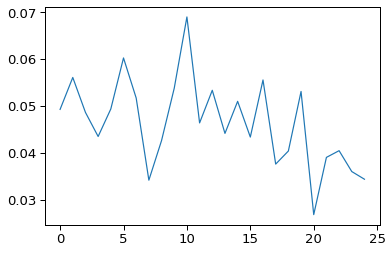

In [19]:
plt.plot(all_losses)

In [20]:
best_idx = np.argmin(all_losses)
best_idx

20

In [21]:
all_cv_scores[best_idx]

{'train_r2': array([0.83538106, 0.88181586, 0.93558888, 0.8590472 , 0.70439921]),
 'validate_r2': array([0.96052498, 0.84433915, 0.89979165, 0.93691058, 0.97993011]),
 'train_rmsd': array([0.03620152, 0.03559456, 0.05317106, 0.042977  , 0.04281262]),
 'validate_rmsd': array([0.01639119, 0.02478155, 0.0367455 , 0.04197238, 0.01433172])}

In [22]:
best_emulator = all_emulators[best_idx]
best_emulator

In [25]:
best_emulator.train(retrain=True)

[INFO] >>> Training model on 80% of the dataset, testing on 20%...
[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0          0.751          0.118          0.895          0.034 *
[INFO]             100          0.772          0.113          0.879          0.036
[INFO]             200          0.740          0.120          0.877          0.036
[INFO]             300          0.750          0.118          0.908          0.031 *
[INFO]             400          0.741          0.120          0.877          0.036
[INFO]             500          0.763          0.115          0.879          0.036
[INFO]             600          0.734          0.122          0.904          0.032
[INFO]             700          0.712          0.127          0.881          0.036
[INFO]          

[INFO]            8400          0.755          0.117          0.855          0.039
[INFO]            8500          0.684          0.133          0.874          0.037
[INFO]            8600          0.710          0.127          0.909          0.031 *
[INFO]            8700          0.717          0.126          0.904          0.032
[INFO]            8800          0.735          0.122          0.897          0.033
[INFO]            8900          0.756          0.117          0.851          0.040
[INFO]            9000          0.737          0.121          0.895          0.034
[INFO]            9100          0.737          0.121          0.887          0.035
[INFO]            9200          0.754          0.117          0.883          0.035
[INFO]            9300          0.719          0.125          0.897          0.033
[INFO]            9400          0.730          0.123          0.892          0.034
[INFO]            9500          0.764          0.115          0.851          0.040
[I

[INFO]           17400          0.690          0.131          0.884          0.035
[INFO]           17500          0.721          0.125          0.895          0.034
[INFO]           17600          0.731          0.122          0.865          0.038
[INFO]           17700          0.764          0.115          0.894          0.034
[INFO]           17800          0.729          0.123          0.887          0.035
[INFO]           17900          0.751          0.118          0.857          0.039
[INFO]           18000          0.675          0.135          0.878          0.036
[INFO]           18100          0.714          0.126          0.855          0.040
[INFO]           18200          0.722          0.124          0.870          0.037
[INFO]           18300          0.717          0.126          0.855          0.039
[INFO]           18400          0.715          0.126          0.886          0.035
[INFO]           18500          0.752          0.117          0.865          0.038
[INF

{'train_r2': 0.7675305456393361,
 'test_r2': 0.9198474261705091,
 'train_rmsd': 0.11384994392460232,
 'test_rmsd': 0.02935166801233106}

In [26]:
emulator.save('emulator_oer_plate_3496_BayesNeuralNet')

## `oer_plate_3851`

In [28]:
search_space = {
    'batch_size': hp.quniform('batch_size', 10, 50, 10),
    'hidden_act': hp.choice('hidden_act', ['leaky_relu'] ),
    'hidden_depth': hp.quniform('hidden_depth', 2, 5, 1),
    'hidden_nodes': hp.quniform('hidden_nodes', 28, 64, 4),
    'learning_rate': hp.uniform('learning_rate', 1e-5, 5e-3),
    'reg': hp.uniform('reg', 0.001, 0.1)
}

int_params = ['batch_size', 'hidden_depth', 'hidden_nodes']

all_emulators = []
all_losses = []
all_cv_scores = []
all_params = []

def objective(params):
    ''' average performance over cross-validation folds '''
    # build emualtor
    print(f'PARAMS : {params}')
    for param, val in params.items():
        if param in int_params:
            params[param] = int(val)
    model  = BayesNeuralNet(
        **params, out_act='sigmoid', 
    )
    emulator = Emulator(
        dataset='oer_plate_3851', model=model, 
        feature_transform='identity', target_transform='normalize',
    )

    cv_scores = emulator.cross_validate()
    loss = np.mean(cv_scores['validate_rmsd'])
    
    all_losses.append(loss)
    all_cv_scores.append(cv_scores)
    all_params.append(params)
    all_emulators.append(emulator)
    
    return {'loss': loss, 'status': STATUS_OK}

In [29]:
trials = Trials()

best = fmin(
    fn=objective,
    space=search_space, 
    algo=tpe.suggest, 
    max_evals=25,
    trials=trials
)

print(f"BEST VALUE : {best}")

PARAMS : {'batch_size': 50.0, 'hidden_act': 'leaky_relu', 'hidden_depth': 2.0, 'hidden_nodes': 28.0, 'learning_rate': 0.003446790173300231, 'reg': 0.09426322776484035}         
  0%|                                                                                                                                    | 0/25 [00:00<?, ?trial/s, best loss=?][INFO] >>> Training model on fold #0...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.184          0.158         -0.093          0.164 *
[INFO]             100          0.594          0.092          0.450          0.116 *
[INFO]             200          0.668          0.083          0.480          0.113 *
[INFO]             300          0.697          0.080          0.530          0.108 *
[INFO]             400          0.782          0.068          0.554          0.105 *
[INFO]             500          0.733          0.075          0.575          0.102 *
[INFO]             600          0.771          0.069          0.586          0.101 *
[INFO]             700          0.779          0.068          0.663          0.091 *
[INFO]             800          0.819          0.062          0.677    

[INFO]            8400          0.858          0.055          0.826          0.065
[INFO]            8500          0.859          0.054          0.813          0.068
[INFO]            8600          0.837          0.058          0.807          0.069
[INFO]            8700          0.863          0.054          0.817          0.067
[INFO]            8800          0.855          0.055          0.817          0.067
[INFO]            8900          0.828          0.060          0.801          0.070
[INFO]            9000          0.852          0.056          0.812          0.068
[INFO]            9100          0.864          0.053          0.818          0.067
[INFO]            9200          0.850          0.056          0.815          0.068
[INFO]            9300          0.867          0.053          0.810          0.068
[INFO]            9400          0.854          0.055          0.818          0.067
[INFO]            9500          0.863          0.054          0.819          0.067
[INF

[INFO]           17300          0.856          0.055          0.823          0.066
[INFO]           17400          0.864          0.054          0.822          0.066
[INFO]           17500          0.861          0.054          0.832          0.064
[INFO]           17600          0.857          0.055          0.824          0.066
[INFO]           17700          0.873          0.052          0.817          0.067
[INFO]           17800          0.859          0.054          0.819          0.067
[INFO]           17900          0.868          0.053          0.795          0.071
[INFO]           18000          0.858          0.055          0.804          0.070
[INFO]           18100          0.850          0.056          0.818          0.067
[INFO]           18200          0.877          0.051          0.808          0.069
[INFO]           18300          0.871          0.052          0.821          0.066
[INFO]           18400          0.857          0.055          0.812          0.068
[INF

[INFO]           26300          0.861          0.054          0.827          0.065
[INFO]           26400          0.853          0.056          0.805          0.069
[INFO]           26500          0.865          0.053          0.825          0.066
[INFO]           26600          0.863          0.054          0.821          0.066
[INFO]           26700          0.871          0.052          0.813          0.068
[INFO]           26800          0.865          0.053          0.809          0.069
[INFO]           26900          0.856          0.055          0.811          0.068
[INFO]           27000          0.844          0.057          0.820          0.067
[INFO]           27100          0.878          0.051          0.821          0.066
[INFO]           27200          0.870          0.052          0.823          0.066
[INFO]           27300          0.858          0.055          0.826          0.066
[INFO]           27400          0.855          0.055          0.816          0.067
[INF

[INFO]           35200          0.850          0.056          0.815          0.068
[INFO]           35300          0.853          0.056          0.814          0.068
[INFO]           35400          0.867          0.053          0.828          0.065
[INFO]           35500          0.861          0.054          0.813          0.068
[INFO]           35600          0.854          0.055          0.816          0.067
[INFO]           35700          0.840          0.058          0.803          0.070
[INFO]           35800          0.865          0.053          0.826          0.066
[INFO]           35900          0.848          0.056          0.829          0.065
[INFO]           36000          0.857          0.055          0.821          0.066
[INFO]           36100          0.855          0.055          0.812          0.068
[INFO]           36200          0.867          0.053          0.820          0.067
[INFO]           36300          0.866          0.053          0.800          0.070
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.187          0.176         -0.398          0.163 *
[INFO]             100          0.488          0.116          0.427          0.104 *
[INFO]             200          0.606          0.102          0.477          0.100 *
[INFO]             300          0.634          0.098          0.535          0.094 *
[INFO]             400          0.653          0.095          0.576          0.090 *
[INFO]             500          0.653          0.095          0.635          0.083 *
[INFO]             600          0.739          0.083          0.691          0.077 *
[INFO]             700          0.753          0.080          0.757          0.068 *
[INFO]             800          0.759          0.079          0.701    

[INFO]            8600          0.851          0.062          0.739          0.070
[INFO]            8700          0.851          0.062          0.733          0.071
[INFO]            8800          0.810          0.071          0.708          0.074
[INFO]            8900          0.842          0.064          0.719          0.073
[INFO]            9000          0.823          0.068          0.732          0.071
[INFO]            9100          0.844          0.064          0.742          0.070
[INFO]            9200          0.831          0.067          0.742          0.070
[INFO]            9300          0.812          0.070          0.701          0.075
[INFO]            9400          0.837          0.065          0.697          0.076
[INFO]            9500          0.840          0.065          0.747          0.069
[INFO]            9600          0.853          0.062          0.726          0.072
[INFO]            9700          0.852          0.062          0.742          0.070
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.252          0.205         -0.068          0.186 *
[INFO]             100          0.506          0.129          0.516          0.125 *
[INFO]             200          0.540          0.124          0.585          0.116 *
[INFO]             300          0.626          0.112          0.578          0.117
[INFO]             400          0.685          0.103          0.619          0.111 *
[INFO]             500          0.681          0.103          0.637          0.108 *
[INFO]             600          0.737          0.094          0.667          0.104 *
[INFO]             700          0.745          0.093          0.704          0.098 *
[INFO]             800          0.742          0.093          0.705      

[INFO]            8600          0.828          0.076          0.713          0.096
[INFO]            8700          0.828          0.076          0.705          0.098
[INFO]            8800          0.820          0.078          0.686          0.101
[INFO]            8900          0.814          0.079          0.667          0.104
[INFO]            9000          0.817          0.078          0.685          0.101
[INFO]            9100          0.832          0.075          0.719          0.095
[INFO]            9200          0.812          0.079          0.697          0.099
[INFO]            9300          0.815          0.079          0.674          0.103
[INFO]            9400          0.814          0.079          0.668          0.104
[INFO]            9500          0.829          0.076          0.702          0.098
[INFO]            9600          0.829          0.076          0.692          0.100
[INFO]            9700          0.835          0.074          0.707          0.097
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.181          0.177         -0.442          0.206 *
[INFO]             100          0.393          0.127          0.548          0.115 *
[INFO]             200          0.432          0.123          0.595          0.109 *
[INFO]             300          0.461          0.120          0.665          0.099 *
[INFO]             400          0.559          0.108          0.652          0.101
[INFO]             500          0.598          0.104          0.694          0.095 *
[INFO]             600          0.614          0.101          0.710          0.093 *
[INFO]             700          0.625          0.100          0.741          0.087 *
[INFO]             800          0.669          0.094          0.732      

[INFO]            8500          0.695          0.090          0.740          0.088
[INFO]            8600          0.705          0.089          0.762          0.084
[INFO]            8700          0.705          0.089          0.773          0.082
[INFO]            8800          0.696          0.090          0.764          0.083
[INFO]            8900          0.707          0.088          0.767          0.083
[INFO]            9000          0.704          0.089          0.749          0.086
[INFO]            9100          0.690          0.091          0.770          0.082
[INFO]            9200          0.699          0.090          0.771          0.082
[INFO]            9300          0.699          0.090          0.764          0.083
[INFO]            9400          0.692          0.091          0.741          0.087
[INFO]            9500          0.713          0.088          0.777          0.081
[INFO]            9600          0.706          0.088          0.768          0.083
[INF

[INFO]           17500          0.744          0.083          0.759          0.084
[INFO] Training completed in 14.84 seconds.
[INFO] ===========================================================================

[INFO] >>> Training model on fold #4...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.499          0.143         -0.519          0.146 *
[INFO]             100          0.435          0.088          0.246          0.103 *
[INFO]             200          0.563          0.077          0.315          0.098 *
[INFO]             300          0.620          0.072          0.421          0.090 *
[INFO]             400          0.613          0.073          0.450          0.088 *
[INFO]             500          0.609          0.073          0.444          0.088
[INFO]             600          0.519          0.081          0.370          0.094
[INFO]             700          0.560          0.078          0.346          0.096
[INFO]             800          0.645          0.070          0.539          

[INFO]            8500          0.654          0.069          0.595          0.075
[INFO]            8600          0.652          0.069          0.560          0.079
[INFO]            8700          0.644          0.070          0.563          0.078
[INFO]            8800          0.658          0.069          0.597          0.075
[INFO]            8900          0.661          0.068          0.568          0.078
[INFO]            9000          0.637          0.071          0.571          0.078
[INFO]            9100          0.662          0.068          0.577          0.077
[INFO]            9200          0.652          0.069          0.598          0.075
[INFO]            9300          0.658          0.069          0.584          0.076
[INFO]            9400          0.641          0.070          0.585          0.076
[INFO]            9500          0.659          0.068          0.597          0.075
[INFO]            9600          0.625          0.072          0.537          0.081
[INF

[INFO]           17400          0.644          0.070          0.574          0.077
[INFO]           17500          0.624          0.072          0.556          0.079
[INFO]           17600          0.644          0.070          0.569          0.078
[INFO]           17700          0.644          0.070          0.578          0.077
[INFO]           17800          0.667          0.068          0.595          0.075
[INFO]           17900          0.659          0.068          0.561          0.079
[INFO]           18000          0.672          0.067          0.595          0.075
[INFO]           18100          0.644          0.070          0.556          0.079
[INFO]           18200          0.621          0.072          0.598          0.075
[INFO]           18300          0.629          0.071          0.552          0.079
[INFO]           18400          0.667          0.068          0.598          0.075
[INFO]           18500          0.639          0.070          0.586          0.076
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.176          0.179         -0.325          0.145 *
[INFO]             100          0.250          0.143          0.260          0.108 *
[INFO]             200          0.492          0.118          0.406          0.097 *
[INFO]             300          0.504          0.116          0.437          0.094 *
[INFO]             400          0.497          0.117          0.424          0.095
[INFO]             500          0.507          0.116          0.417          0.096
[INFO]             600          0.501          0.117          0.512          0.088 *
[INFO]             700          0.539          0.112          0.486          0.090
[INFO]             800          0.510          0.116          0.475          

[INFO]            8500          0.484          0.119          0.783          0.059
[INFO]            8600          0.464          0.121          0.776          0.060
[INFO]            8700          0.466          0.121          0.751          0.063
[INFO]            8800          0.476          0.120          0.766          0.061
[INFO]            8900          0.475          0.120          0.775          0.060
[INFO]            9000          0.495          0.118          0.777          0.059
[INFO]            9100          0.473          0.120          0.767          0.061
[INFO]            9200          0.431          0.125          0.782          0.059
[INFO]            9300          0.483          0.119          0.799          0.056 *
[INFO]            9400          0.437          0.124          0.765          0.061
[INFO]            9500          0.463          0.121          0.779          0.059
[INFO]            9600          0.455          0.122          0.771          0.060
[I

[INFO]           17300          0.495          0.118          0.754          0.062
[INFO]           17400          0.500          0.117          0.751          0.063
[INFO]           17500          0.493          0.118          0.758          0.062
[INFO]           17600          0.502          0.117          0.771          0.060
[INFO]           17700          0.484          0.119          0.750          0.063
[INFO]           17800          0.492          0.118          0.772          0.060
[INFO]           17900          0.486          0.119          0.770          0.060
[INFO]           18000          0.490          0.118          0.757          0.062
[INFO]           18100          0.496          0.117          0.755          0.062
[INFO]           18200          0.504          0.116          0.740          0.064
[INFO]           18300          0.487          0.118          0.782          0.059
[INFO]           18400          0.492          0.118          0.767          0.061
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.290          0.173         -0.338          0.200 *
[INFO]             100          0.387          0.120          0.235          0.151 *
[INFO]             200          0.525          0.105          0.401          0.134 *
[INFO]             300          0.540          0.104          0.388          0.135
[INFO]             400          0.517          0.106          0.414          0.132 *
[INFO]             500          0.535          0.104          0.412          0.132
[INFO]             600          0.559          0.101          0.454          0.128 *
[INFO]             700          0.588          0.098          0.362          0.138
[INFO]             800          0.534          0.104          0.357          

[INFO]            8600          0.408          0.117          0.729          0.090 *
[INFO]            8700          0.505          0.107          0.704          0.094
[INFO]            8800          0.472          0.111          0.718          0.092
[INFO]            8900          0.439          0.114          0.736          0.089 *
[INFO]            9000          0.498          0.108          0.710          0.093
[INFO]            9100          0.440          0.114          0.729          0.090
[INFO]            9200          0.468          0.111          0.702          0.094
[INFO]            9300          0.480          0.110          0.725          0.091
[INFO]            9400          0.457          0.113          0.722          0.091
[INFO]            9500          0.495          0.109          0.714          0.092
[INFO]            9600          0.423          0.116          0.719          0.092
[INFO]            9700          0.465          0.112          0.728          0.090


[INFO]           17400          0.411          0.117          0.774          0.082
[INFO]           17500          0.477          0.110          0.752          0.086
[INFO]           17600          0.466          0.112          0.749          0.087
[INFO]           17700          0.495          0.109          0.752          0.086
[INFO]           17800          0.485          0.110          0.752          0.086
[INFO]           17900          0.453          0.113          0.741          0.088
[INFO]           18000          0.402          0.118          0.769          0.083
[INFO]           18100          0.447          0.113          0.760          0.085
[INFO]           18200          0.398          0.118          0.783          0.080 *
[INFO]           18300          0.439          0.114          0.755          0.086
[INFO]           18400          0.423          0.116          0.761          0.084
[INFO]           18500          0.499          0.108          0.751          0.086
[I

[INFO]           26200          0.464          0.112          0.783          0.081
[INFO]           26300          0.488          0.109          0.792          0.079
[INFO]           26400          0.460          0.112          0.769          0.083
[INFO]           26500          0.430          0.115          0.784          0.080
[INFO]           26600          0.433          0.115          0.795          0.078
[INFO]           26700          0.440          0.114          0.780          0.081
[INFO]           26800          0.463          0.112          0.759          0.085
[INFO]           26900          0.442          0.114          0.776          0.082
[INFO]           27000          0.473          0.111          0.771          0.083
[INFO]           27100          0.440          0.114          0.776          0.082
[INFO]           27200          0.434          0.115          0.784          0.080
[INFO]           27300          0.455          0.113          0.791          0.079
[INF

[INFO]           35200          0.392          0.119          0.777          0.082
[INFO]           35300          0.460          0.112          0.775          0.082
[INFO]           35400          0.459          0.112          0.784          0.080
[INFO]           35500          0.452          0.113          0.776          0.082
[INFO]           35600          0.478          0.110          0.763          0.084
[INFO]           35700          0.459          0.112          0.771          0.083
[INFO]           35800          0.485          0.109          0.777          0.082
[INFO]           35900          0.472          0.111          0.752          0.086
[INFO]           36000          0.451          0.113          0.781          0.081
[INFO]           36100          0.464          0.112          0.783          0.080
[INFO]           36200          0.451          0.113          0.793          0.079
[INFO]           36300          0.472          0.111          0.754          0.086
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.050          0.168         -0.122          0.160 *
[INFO]             100          0.496          0.116          0.511          0.105 *
[INFO]             200          0.656          0.096          0.660          0.088 *
[INFO]             300          0.665          0.095          0.667          0.087 *
[INFO]             400          0.654          0.096          0.665          0.087
[INFO]             500          0.690          0.091          0.679          0.085 *
[INFO]             600          0.682          0.092          0.664          0.087
[INFO]             700          0.675          0.094          0.671          0.087
[INFO]             800          0.709          0.088          0.704          

[INFO]            8400          0.754          0.081          0.891          0.050 *
[INFO]            8500          0.791          0.075          0.880          0.052
[INFO]            8600          0.769          0.079          0.849          0.059
[INFO]            8700          0.738          0.084          0.835          0.061
[INFO]            8800          0.796          0.074          0.874          0.053
[INFO]            8900          0.761          0.080          0.869          0.054
[INFO]            9000          0.754          0.081          0.857          0.057
[INFO]            9100          0.772          0.078          0.871          0.054
[INFO]            9200          0.762          0.080          0.880          0.052
[INFO]            9300          0.754          0.081          0.855          0.057
[INFO]            9400          0.767          0.079          0.859          0.057
[INFO]            9500          0.779          0.077          0.882          0.052
[I

[INFO]           17300          0.768          0.079          0.899          0.048
[INFO]           17400          0.761          0.080          0.870          0.054
[INFO]           17500          0.766          0.079          0.895          0.049
[INFO]           17600          0.782          0.076          0.870          0.054
[INFO]           17700          0.765          0.079          0.888          0.051
[INFO]           17800          0.763          0.080          0.902          0.047
[INFO]           17900          0.783          0.076          0.875          0.053
[INFO]           18000          0.781          0.077          0.894          0.049
[INFO]           18100          0.771          0.078          0.877          0.053
[INFO]           18200          0.766          0.079          0.891          0.050
[INFO]           18300          0.767          0.079          0.892          0.050
[INFO]           18400          0.767          0.079          0.905          0.046
[INF

[INFO]           26200          0.772          0.078          0.895          0.049
[INFO]           26300          0.767          0.079          0.889          0.050
[INFO]           26400          0.787          0.076          0.886          0.051
[INFO]           26500          0.777          0.078          0.892          0.050
[INFO]           26600          0.789          0.075          0.882          0.052
[INFO]           26700          0.784          0.076          0.874          0.054
[INFO]           26800          0.776          0.078          0.879          0.053
[INFO]           26900          0.774          0.078          0.884          0.051
[INFO]           27000          0.765          0.079          0.890          0.050
[INFO]           27100          0.759          0.080          0.895          0.049
[INFO]           27200          0.768          0.079          0.874          0.053
[INFO]           27300          0.773          0.078          0.889          0.050
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.382          0.153         -0.075          0.192 *
[INFO]             100          0.320          0.108          0.242          0.161 *
[INFO]             200          0.364          0.104          0.396          0.144 *
[INFO]             300          0.411          0.100          0.450          0.137 *
[INFO]             400          0.360          0.104          0.456          0.136 *
[INFO]             500          0.387          0.102          0.433          0.139
[INFO]             600          0.377          0.103          0.457          0.136 *
[INFO]             700          0.416          0.100          0.490          0.132 *
[INFO]             800          0.430          0.099          0.465      

[INFO]            8400          0.768          0.063          0.608          0.116
[INFO]            8500          0.768          0.063          0.563          0.122
[INFO]            8600          0.773          0.062          0.581          0.120
[INFO]            8700          0.760          0.064          0.579          0.120
[INFO]            8800          0.765          0.063          0.574          0.121
[INFO]            8900          0.800          0.058          0.582          0.120
[INFO]            9000          0.737          0.067          0.581          0.120
[INFO]            9100          0.770          0.063          0.595          0.118
[INFO]            9200          0.768          0.063          0.574          0.121
[INFO]            9300          0.777          0.062          0.607          0.116
[INFO]            9400          0.775          0.062          0.572          0.121
[INFO]            9500          0.779          0.061          0.593          0.118
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.285          0.188         -0.004          0.161 *
[INFO]             100          0.406          0.128          0.352          0.130 *
[INFO]             200          0.435          0.125          0.365          0.128 *
[INFO]             300          0.455          0.123          0.379          0.127 *
[INFO]             400          0.466          0.121          0.403          0.124 *
[INFO]             500          0.437          0.125          0.418          0.123 *
[INFO]             600          0.436          0.125          0.450          0.119 *
[INFO]             700          0.466          0.121          0.445          0.120
[INFO]             800          0.492          0.118          0.506      

[INFO]            8500          0.760          0.081          0.663          0.093
[INFO]            8600          0.787          0.077          0.680          0.091
[INFO]            8700          0.741          0.085          0.639          0.097
[INFO]            8800          0.770          0.080          0.657          0.094
[INFO]            8900          0.778          0.078          0.681          0.091
[INFO]            9000          0.783          0.077          0.687          0.090
[INFO]            9100          0.788          0.076          0.664          0.093
[INFO]            9200          0.774          0.079          0.641          0.096
[INFO]            9300          0.758          0.082          0.666          0.093
[INFO]            9400          0.781          0.078          0.652          0.095
[INFO]            9500          0.747          0.084          0.675          0.092
[INFO]            9600          0.777          0.078          0.689          0.090
[INF

[INFO]           26100          0.811          0.072          0.732          0.083
[INFO]           26200          0.797          0.075          0.717          0.086
[INFO]           26300          0.809          0.072          0.733          0.083
[INFO]           26400          0.802          0.074          0.700          0.088
[INFO]           26500          0.831          0.068          0.714          0.086
[INFO]           26600          0.815          0.072          0.716          0.086
[INFO]           26700          0.820          0.070          0.719          0.085
[INFO]           26800          0.837          0.067          0.705          0.087
[INFO]           26900          0.801          0.074          0.705          0.087
[INFO]           27000          0.805          0.073          0.737          0.083
[INFO]           27100          0.806          0.073          0.751          0.080 *
[INFO]           27200          0.820          0.070          0.746          0.081
[I

[INFO]           35000          0.823          0.070          0.736          0.083
[INFO]           35100          0.829          0.069          0.741          0.082
[INFO]           35200          0.833          0.068          0.739          0.082
[INFO]           35300          0.821          0.070          0.733          0.083
[INFO]           35400          0.812          0.072          0.733          0.083
[INFO]           35500          0.823          0.070          0.756          0.080
[INFO]           35600          0.828          0.069          0.738          0.082
[INFO]           35700          0.830          0.068          0.745          0.081
[INFO]           35800          0.823          0.070          0.741          0.082
[INFO]           35900          0.837          0.067          0.727          0.084
[INFO]           36000          0.809          0.073          0.754          0.080
[INFO]           36100          0.811          0.072          0.739          0.082
[INF

[INFO]           43900          0.813          0.072          0.731          0.083
[INFO]           44000          0.819          0.071          0.735          0.083
[INFO]           44100          0.826          0.069          0.728          0.084
[INFO]           44200          0.814          0.072          0.735          0.083
[INFO]           44300          0.818          0.071          0.733          0.083
[INFO]           44400          0.843          0.066          0.733          0.083
[INFO]           44500          0.806          0.073          0.743          0.082
[INFO]           44600          0.812          0.072          0.737          0.082
[INFO]           44700          0.796          0.075          0.748          0.081
[INFO]           44800          0.826          0.069          0.732          0.083
[INFO]           44900          0.833          0.068          0.744          0.081
[INFO]           45000          0.828          0.069          0.737          0.083
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.062          0.182         -0.917          0.195 *
[INFO]             100         -0.003          0.177         -0.474          0.171 *
[INFO]             200         -0.010          0.178         -0.183          0.153 *
[INFO]             300         -0.095          0.185         -0.029          0.143 *
[INFO]             400         -0.116          0.187          0.003          0.141 *
[INFO]             500         -0.067          0.183          0.045          0.138 *
[INFO]             600          0.019          0.175          0.118          0.132 *
[INFO]             700          0.093          0.169          0.176          0.128 *
[INFO]             800          0.163          0.162          0.280    

[INFO]            8400          0.465          0.129          0.380          0.111
[INFO]            8500          0.477          0.128          0.435          0.106
[INFO]            8600          0.460          0.130          0.465          0.103 *
[INFO]            8700          0.499          0.125          0.437          0.106
[INFO]            8800          0.505          0.125          0.424          0.107
[INFO]            8900          0.501          0.125          0.406          0.109
[INFO]            9000          0.486          0.127          0.431          0.106
[INFO]            9100          0.485          0.127          0.391          0.110
[INFO]            9200          0.492          0.126          0.437          0.106
[INFO]            9300          0.494          0.126          0.423          0.107
[INFO]            9400          0.518          0.123          0.438          0.106
[INFO]            9500          0.491          0.126          0.465          0.103
[I

[INFO]           17100          0.507          0.124          0.519          0.098
[INFO]           17200          0.513          0.123          0.500          0.100
[INFO]           17300          0.528          0.122          0.509          0.099
[INFO]           17400          0.531          0.121          0.456          0.104
[INFO]           17500          0.509          0.124          0.504          0.099
[INFO]           17600          0.575          0.115          0.489          0.101
[INFO]           17700          0.563          0.117          0.488          0.101
[INFO]           17800          0.517          0.123          0.498          0.100
[INFO]           17900          0.548          0.119          0.457          0.104
[INFO]           18000          0.548          0.119          0.474          0.102
[INFO]           18100          0.561          0.117          0.481          0.101
[INFO]           18200          0.554          0.118          0.482          0.101
[INF

[INFO]           25900          0.612          0.110          0.495          0.100
[INFO]           26000          0.537          0.120          0.501          0.099
[INFO]           26100          0.557          0.118          0.474          0.102
[INFO]           26200          0.600          0.112          0.518          0.098
[INFO]           26300          0.563          0.117          0.514          0.098
[INFO]           26400          0.589          0.113          0.504          0.099
[INFO]           26500          0.538          0.120          0.514          0.098
[INFO]           26600          0.577          0.115          0.489          0.101
[INFO]           26700          0.571          0.116          0.492          0.100
[INFO]           26800          0.588          0.114          0.455          0.104
[INFO]           26900          0.563          0.117          0.460          0.103
[INFO]           27000          0.565          0.117          0.427          0.107
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.091          0.201         -0.310          0.184 *
[INFO]             100         -0.730          0.183         -0.163          0.174 *
[INFO]             200         -0.423          0.166         -0.033          0.164 *
[INFO]             300         -0.207          0.153          0.014          0.160 *
[INFO]             400         -0.149          0.149          0.019          0.159 *
[INFO]             500         -0.134          0.148          0.067          0.155 *
[INFO]             600         -0.036          0.142          0.100          0.153 *
[INFO]             700          0.057          0.135          0.154          0.148 *
[INFO]             800          0.095          0.132          0.230    

[INFO]            8400          0.180          0.126          0.518          0.112
[INFO]            8500          0.261          0.120          0.521          0.111
[INFO]            8600          0.205          0.124          0.506          0.113
[INFO]            8700          0.196          0.125          0.503          0.113
[INFO]            8800          0.263          0.120          0.529          0.111
[INFO]            8900          0.237          0.122          0.547          0.108
[INFO]            9000          0.176          0.126          0.554          0.107 *
[INFO]            9100          0.229          0.122          0.519          0.112
[INFO]            9200          0.211          0.124          0.524          0.111
[INFO]            9300          0.244          0.121          0.507          0.113
[INFO]            9400          0.260          0.120          0.550          0.108
[INFO]            9500          0.206          0.124          0.514          0.112
[I

[INFO]           17200          0.296          0.117          0.544          0.109
[INFO]           17300          0.287          0.118          0.592          0.103 *
[INFO]           17400          0.317          0.115          0.534          0.110
[INFO]           17500          0.331          0.114          0.582          0.104
[INFO]           17600          0.312          0.115          0.581          0.104
[INFO]           17700          0.302          0.116          0.576          0.105
[INFO]           17800          0.301          0.116          0.572          0.105
[INFO]           17900          0.297          0.117          0.517          0.112
[INFO]           18000          0.223          0.123          0.572          0.105
[INFO]           18100          0.352          0.112          0.560          0.107
[INFO]           18200          0.371          0.110          0.535          0.110
[INFO]           18300          0.338          0.113          0.555          0.107
[I

[INFO]           26100          0.361          0.111          0.553          0.108
[INFO]           26200          0.330          0.114          0.611          0.100
[INFO]           26300          0.297          0.117          0.594          0.103
[INFO]           26400          0.393          0.108          0.608          0.101
[INFO]           26500          0.328          0.114          0.605          0.101
[INFO]           26600          0.274          0.119          0.583          0.104
[INFO]           26700          0.217          0.123          0.619          0.099
[INFO]           26800          0.354          0.112          0.567          0.106
[INFO]           26900          0.288          0.117          0.573          0.105
[INFO]           27000          0.276          0.118          0.565          0.106
[INFO]           27100          0.246          0.121          0.589          0.103
[INFO]           27200          0.352          0.112          0.570          0.106
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.933          0.202         -1.456          0.202 *
[INFO]             100         -0.594          0.183         -0.947          0.180 *
[INFO]             200         -0.294          0.165         -0.530          0.160 *
[INFO]             300         -0.102          0.152         -0.219          0.143 *
[INFO]             400          0.014          0.144         -0.091          0.135 *
[INFO]             500          0.031          0.143         -0.024          0.131 *
[INFO]             600          0.037          0.142          0.013          0.128 *
[INFO]             700          0.106          0.137          0.055          0.125 *
[INFO]             800          0.129          0.135          0.116    

[INFO]            8400          0.517          0.101          0.361          0.103
[INFO]            8500          0.529          0.100          0.305          0.108
[INFO]            8600          0.560          0.096          0.333          0.105
[INFO]            8700          0.559          0.096          0.315          0.107
[INFO]            8800          0.578          0.094          0.352          0.104
[INFO]            8900          0.580          0.094          0.308          0.107
[INFO]            9000          0.544          0.098          0.293          0.109
[INFO]            9100          0.557          0.097          0.345          0.104
[INFO]            9200          0.543          0.098          0.341          0.105
[INFO]            9300          0.534          0.099          0.329          0.106
[INFO]            9400          0.543          0.098          0.358          0.103
[INFO]            9500          0.568          0.095          0.340          0.105
[INF

[INFO]           17200          0.565          0.096          0.420          0.098
[INFO]           17300          0.569          0.095          0.374          0.102
[INFO]           17400          0.606          0.091          0.336          0.105
[INFO]           17500          0.543          0.098          0.332          0.105
[INFO]           17600          0.562          0.096          0.340          0.105
[INFO]           17700          0.599          0.092          0.393          0.101
[INFO]           17800          0.575          0.095          0.334          0.105
[INFO]           17900          0.527          0.100          0.342          0.105
[INFO]           18000          0.581          0.094          0.392          0.101
[INFO]           18100          0.553          0.097          0.341          0.105
[INFO]           18200          0.566          0.095          0.381          0.102
[INFO]           18300          0.575          0.095          0.372          0.102
[INF

[INFO]           26000          0.558          0.096          0.401          0.100
[INFO]           26100          0.589          0.093          0.408          0.099
[INFO]           26200          0.626          0.089          0.445          0.096
[INFO]           26300          0.616          0.090          0.361          0.103
[INFO]           26400          0.569          0.095          0.433          0.097
[INFO]           26500          0.596          0.092          0.406          0.099
[INFO]           26600          0.578          0.094          0.422          0.098
[INFO]           26700          0.596          0.092          0.364          0.103
[INFO]           26800          0.616          0.090          0.393          0.101
[INFO]           26900          0.627          0.089          0.364          0.103
[INFO]           27000          0.601          0.092          0.393          0.101
[INFO]           27100          0.592          0.093          0.366          0.103
[INF

[INFO]           34800          0.543          0.098          0.363          0.103
[INFO]           34900          0.565          0.096          0.459          0.095
[INFO]           35000          0.534          0.099          0.428          0.098
[INFO]           35100          0.572          0.095          0.388          0.101
[INFO]           35200          0.613          0.090          0.326          0.106
[INFO]           35300          0.563          0.096          0.437          0.097
[INFO]           35400          0.587          0.093          0.380          0.102
[INFO]           35500          0.617          0.090          0.363          0.103
[INFO]           35600          0.521          0.100          0.356          0.104
[INFO]           35700          0.587          0.093          0.417          0.099
[INFO]           35800          0.619          0.090          0.459          0.095
[INFO]           35900          0.596          0.092          0.441          0.097
[INF

[INFO]           43600          0.638          0.087          0.399          0.100
[INFO]           43700          0.630          0.088          0.400          0.100
[INFO]           43800          0.582          0.094          0.442          0.096
[INFO]           43900          0.590          0.093          0.458          0.095
[INFO]           44000          0.636          0.087          0.319          0.107
[INFO]           44100          0.581          0.094          0.316          0.107
[INFO]           44200          0.596          0.092          0.403          0.100
[INFO]           44300          0.637          0.087          0.472          0.094
[INFO]           44400          0.616          0.090          0.443          0.096
[INFO]           44500          0.522          0.100          0.431          0.097
[INFO]           44600          0.623          0.089          0.435          0.097
[INFO]           44700          0.568          0.095          0.431          0.097
[INF

[INFO]           52500          0.654          0.085          0.328          0.106
[INFO]           52600          0.541          0.098          0.404          0.100
[INFO]           52700          0.547          0.098          0.460          0.095
[INFO]           52800          0.607          0.091          0.427          0.098
[INFO]           52900          0.541          0.098          0.311          0.107
[INFO]           53000          0.577          0.094          0.348          0.104
[INFO]           53100          0.669          0.083          0.438          0.097
[INFO]           53200          0.564          0.096          0.431          0.097
[INFO]           53300          0.649          0.086          0.435          0.097
[INFO]           53400          0.601          0.092          0.458          0.095
[INFO]           53500          0.576          0.094          0.424          0.098
[INFO]           53600          0.628          0.089          0.434          0.097
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.233          0.166         -0.083          0.189 *
[INFO]             100         -0.080          0.155         -0.020          0.183 *
[INFO]             200         -0.014          0.150          0.007          0.181 *
[INFO]             300          0.020          0.148          0.000          0.181
[INFO]             400          0.023          0.147         -0.005          0.182
[INFO]             500          0.077          0.143          0.012          0.180 *
[INFO]             600          0.103          0.141          0.060          0.176 *
[INFO]             700          0.177          0.135          0.127          0.169 *
[INFO]             800          0.293          0.125          0.246        

[INFO]            8500          0.596          0.095          0.678          0.103
[INFO]            8600          0.591          0.095          0.666          0.105
[INFO]            8700          0.585          0.096          0.681          0.102
[INFO]            8800          0.598          0.095          0.643          0.108
[INFO]            8900          0.639          0.090          0.650          0.107
[INFO]            9000          0.586          0.096          0.650          0.107
[INFO]            9100          0.569          0.098          0.651          0.107
[INFO]            9200          0.623          0.092          0.674          0.103
[INFO]            9300          0.577          0.097          0.671          0.104
[INFO]            9400          0.596          0.095          0.672          0.104
[INFO]            9500          0.595          0.095          0.635          0.109
[INFO]            9600          0.597          0.095          0.656          0.106
[INF

[INFO]           17300          0.652          0.088          0.674          0.103
[INFO]           17400          0.657          0.087          0.703          0.099
[INFO]           17500          0.666          0.086          0.693          0.100
[INFO]           17600          0.661          0.087          0.670          0.104
[INFO]           17700          0.684          0.084          0.674          0.104
[INFO]           17800          0.638          0.090          0.696          0.100
[INFO]           17900          0.634          0.090          0.679          0.103
[INFO]           18000          0.684          0.084          0.674          0.103
[INFO]           18100          0.679          0.085          0.702          0.099
[INFO]           18200          0.606          0.094          0.687          0.101
[INFO]           18300          0.676          0.085          0.696          0.100
[INFO]           18400          0.661          0.087          0.689          0.101
[INF

[INFO]           26100          0.680          0.084          0.714          0.097
[INFO]           26200          0.684          0.084          0.722          0.096
[INFO]           26300          0.686          0.084          0.708          0.098
[INFO]           26400          0.670          0.086          0.719          0.096
[INFO]           26500          0.687          0.083          0.718          0.096
[INFO]           26600          0.723          0.078          0.687          0.101
[INFO]           26700          0.717          0.079          0.681          0.102
[INFO]           26800          0.704          0.081          0.661          0.106
[INFO]           26900          0.702          0.081          0.738          0.093
[INFO]           27000          0.704          0.081          0.700          0.099
[INFO]           27100          0.726          0.078          0.720          0.096
[INFO]           27200          0.719          0.079          0.756          0.089 *
[I

[INFO]           34900          0.717          0.079          0.729          0.094
[INFO]           35000          0.648          0.089          0.707          0.098
[INFO]           35100          0.661          0.087          0.730          0.094
[INFO]           35200          0.737          0.076          0.690          0.101
[INFO]           35300          0.743          0.076          0.683          0.102
[INFO]           35400          0.764          0.072          0.731          0.094
[INFO]           35500          0.732          0.077          0.712          0.097
[INFO]           35600          0.723          0.079          0.690          0.101
[INFO]           35700          0.675          0.085          0.719          0.096
[INFO]           35800          0.696          0.082          0.707          0.098
[INFO]           35900          0.716          0.080          0.638          0.109
[INFO]           36000          0.741          0.076          0.725          0.095
[INF

[INFO]           43800          0.636          0.090          0.691          0.101
[INFO]           43900          0.676          0.085          0.678          0.103
[INFO]           44000          0.689          0.083          0.671          0.104
[INFO]           44100          0.650          0.088          0.681          0.102
[INFO]           44200          0.751          0.074          0.689          0.101
[INFO]           44300          0.692          0.083          0.747          0.091
[INFO]           44400          0.719          0.079          0.697          0.100
[INFO]           44500          0.728          0.078          0.687          0.101
[INFO]           44600          0.717          0.079          0.727          0.095
[INFO]           44700          0.730          0.078          0.711          0.097
[INFO]           44800          0.724          0.078          0.750          0.091
[INFO]           44900          0.728          0.078          0.688          0.101
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.099          0.137         -0.261          0.190 *
[INFO]             100         -0.025          0.133         -0.171          0.183 *
[INFO]             200          0.023          0.130         -0.116          0.179 *
[INFO]             300          0.053          0.127         -0.084          0.176 *
[INFO]             400          0.092          0.125         -0.033          0.172 *
[INFO]             500          0.176          0.119          0.049          0.165 *
[INFO]             600          0.282          0.111          0.151          0.156 *
[INFO]             700          0.371          0.104          0.254          0.146 *
[INFO]             800          0.428          0.099          0.384    

[INFO]            8600          0.548          0.088          0.489          0.121 *
[INFO]            8700          0.571          0.086          0.446          0.126
[INFO]            8800          0.548          0.088          0.479          0.122
[INFO]            8900          0.569          0.086          0.499          0.120 *
[INFO]            9000          0.559          0.087          0.467          0.123
[INFO]            9100          0.574          0.086          0.491          0.121
[INFO]            9200          0.580          0.085          0.483          0.122
[INFO]            9300          0.562          0.087          0.458          0.124
[INFO]            9400          0.588          0.084          0.483          0.122
[INFO]            9500          0.559          0.087          0.460          0.124
[INFO]            9600          0.576          0.085          0.504          0.119 *
[INFO]            9700          0.571          0.086          0.475          0.12

[INFO]           17300          0.642          0.078          0.560          0.112
[INFO]           17400          0.614          0.081          0.510          0.118
[INFO]           17500          0.600          0.083          0.542          0.114
[INFO]           17600          0.604          0.082          0.556          0.113
[INFO]           17700          0.661          0.076          0.575          0.110
[INFO]           17800          0.658          0.077          0.548          0.114
[INFO]           17900          0.656          0.077          0.537          0.115
[INFO]           18000          0.591          0.084          0.572          0.111
[INFO]           18100          0.627          0.080          0.580          0.110
[INFO]           18200          0.663          0.076          0.528          0.116
[INFO]           18300          0.598          0.083          0.555          0.113
[INFO]           18400          0.667          0.076          0.565          0.112
[INF

[INFO]           26200          0.712          0.070          0.562          0.112
[INFO]           26300          0.690          0.073          0.577          0.110
[INFO]           26400          0.697          0.072          0.622          0.104
[INFO]           26500          0.683          0.074          0.558          0.112
[INFO]           26600          0.645          0.078          0.603          0.107
[INFO]           26700          0.663          0.076          0.611          0.105
[INFO]           26800          0.700          0.072          0.564          0.112
[INFO]           26900          0.689          0.073          0.538          0.115
[INFO]           27000          0.701          0.072          0.622          0.104
[INFO]           27100          0.687          0.073          0.627          0.103
[INFO]           27200          0.647          0.078          0.609          0.106
[INFO]           27300          0.725          0.069          0.585          0.109
[INF

[INFO]           35000          0.662          0.076          0.596          0.107
[INFO]           35100          0.719          0.069          0.640          0.101
[INFO]           35200          0.730          0.068          0.611          0.105
[INFO]           35300          0.672          0.075          0.589          0.108
[INFO]           35400          0.642          0.078          0.601          0.107
[INFO]           35500          0.689          0.073          0.580          0.110
[INFO]           35600          0.736          0.067          0.661          0.098
[INFO]           35700          0.713          0.070          0.614          0.105
[INFO]           35800          0.623          0.080          0.541          0.115
[INFO]           35900          0.716          0.070          0.619          0.104
[INFO]           36000          0.662          0.076          0.543          0.114
[INFO]           36100          0.693          0.073          0.569          0.111
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.013          0.171         -0.104          0.186 *
[INFO]             100         -0.049          0.174          0.020          0.175 *
[INFO]             200          0.314          0.140          0.238          0.155 *
[INFO]             300          0.557          0.113          0.480          0.128 *
[INFO]             400          0.573          0.111          0.486          0.127 *
[INFO]             500          0.528          0.116          0.460          0.130
[INFO]             600          0.592          0.108          0.498          0.126 *
[INFO]             700          0.543          0.115          0.489          0.127
[INFO]             800          0.577          0.110          0.471        

[INFO]            8500          0.568          0.111          0.320          0.146
[INFO]            8600          0.588          0.109          0.466          0.130
[INFO]            8700          0.613          0.105          0.416          0.135
[INFO]            8800          0.572          0.111          0.375          0.140
[INFO]            8900          0.559          0.113          0.431          0.134
[INFO]            9000          0.411          0.130          0.366          0.141
[INFO]            9100          0.537          0.115          0.401          0.137
[INFO]            9200          0.539          0.115          0.422          0.135
[INFO]            9300          0.566          0.112          0.436          0.133
[INFO]            9400          0.508          0.119          0.381          0.139
[INFO]            9500          0.514          0.118          0.394          0.138
[INFO]            9600          0.397          0.132          0.328          0.145
[INF

[INFO]           17400          0.658          0.099          0.569          0.116
[INFO]           17500          0.637          0.102          0.509          0.124
[INFO]           17600          0.639          0.102          0.533          0.121
[INFO]           17700          0.628          0.103          0.527          0.122
[INFO]           17800          0.595          0.108          0.502          0.125
[INFO]           17900          0.630          0.103          0.496          0.126
[INFO]           18000          0.648          0.101          0.538          0.121
[INFO]           18100          0.631          0.103          0.547          0.119
[INFO]           18200          0.597          0.108          0.550          0.119
[INFO]           18300          0.701          0.093          0.478          0.128
[INFO]           18400          0.702          0.092          0.504          0.125
[INFO]           18500          0.673          0.097          0.539          0.120
[INF

[INFO]           26200          0.750          0.085          0.558          0.118
[INFO]           26300          0.729          0.088          0.556          0.118
[INFO]           26400          0.749          0.085          0.580          0.115
[INFO]           26500          0.734          0.087          0.582          0.115
[INFO]           26600          0.736          0.087          0.602          0.112
[INFO]           26700          0.747          0.085          0.593          0.113
[INFO]           26800          0.761          0.083          0.594          0.113
[INFO]           26900          0.764          0.082          0.639          0.107 *
[INFO]           27000          0.758          0.083          0.575          0.116
[INFO]           27100          0.785          0.079          0.570          0.116
[INFO]           27200          0.750          0.085          0.613          0.110
[INFO]           27300          0.740          0.086          0.617          0.110
[I

[INFO]           35000          0.733          0.088          0.670          0.102 *
[INFO]           35100          0.808          0.074          0.651          0.105
[INFO]           35200          0.778          0.080          0.637          0.107
[INFO]           35300          0.774          0.081          0.664          0.103
[INFO]           35400          0.767          0.082          0.619          0.109
[INFO]           35500          0.786          0.078          0.639          0.107
[INFO]           35600          0.759          0.083          0.640          0.106
[INFO]           35700          0.776          0.080          0.657          0.104
[INFO]           35800          0.778          0.080          0.618          0.110
[INFO]           35900          0.807          0.074          0.627          0.108
[INFO]           36000          0.803          0.075          0.658          0.104
[INFO]           36100          0.777          0.080          0.654          0.104
[I

[INFO]           43900          0.797          0.076          0.690          0.099
[INFO]           44000          0.799          0.076          0.703          0.097 *
[INFO]           44100          0.778          0.080          0.680          0.100
[INFO]           44200          0.801          0.076          0.638          0.107
[INFO]           44300          0.793          0.077          0.680          0.100
[INFO]           44400          0.828          0.070          0.662          0.103
[INFO]           44500          0.805          0.075          0.679          0.101
[INFO]           44600          0.796          0.076          0.689          0.099
[INFO]           44700          0.823          0.071          0.667          0.102
[INFO]           44800          0.788          0.078          0.626          0.108
[INFO]           44900          0.802          0.075          0.625          0.109
[INFO]           45000          0.828          0.070          0.668          0.102
[I

[INFO]           52800          0.805          0.075          0.656          0.104
[INFO]           52900          0.819          0.072          0.688          0.099
[INFO]           53000          0.772          0.081          0.670          0.102
[INFO]           53100          0.766          0.082          0.672          0.102
[INFO]           53200          0.804          0.075          0.664          0.103
[INFO]           53300          0.798          0.076          0.658          0.104
[INFO]           53400          0.812          0.074          0.689          0.099
[INFO]           53500          0.822          0.071          0.675          0.101
[INFO]           53600          0.808          0.074          0.694          0.098
[INFO]           53700          0.815          0.073          0.663          0.103
[INFO]           53800          0.822          0.072          0.693          0.098
[INFO]           53900          0.806          0.075          0.687          0.099
[INF

[INFO]           61700          0.802          0.075          0.671          0.102
[INFO]           61800          0.805          0.075          0.699          0.097
[INFO]           61900          0.793          0.077          0.704          0.096
[INFO]           62000          0.802          0.075          0.697          0.098
[INFO]           62100          0.815          0.073          0.653          0.104
[INFO]           62200          0.793          0.077          0.702          0.097
[INFO]           62300          0.816          0.073          0.677          0.101
[INFO]           62400          0.805          0.075          0.659          0.103
[INFO]           62500          0.812          0.073          0.677          0.101
[INFO]           62600          0.797          0.076          0.667          0.102
[INFO]           62700          0.813          0.073          0.672          0.102
[INFO]           62800          0.799          0.076          0.699          0.097
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.484          0.179         -0.156          0.144 *
[INFO]             100          0.092          0.140         -0.064          0.138 *
[INFO]             200          0.424          0.111          0.249          0.116 *
[INFO]             300          0.515          0.102          0.359          0.107 *
[INFO]             400          0.509          0.103          0.302          0.112
[INFO]             500          0.529          0.101          0.428          0.102 *
[INFO]             600          0.504          0.103          0.352          0.108
[INFO]             700          0.475          0.106          0.327          0.110
[INFO]             800          0.486          0.105          0.390          

[INFO]           17200          0.505          0.103          0.474          0.097
[INFO]           17300          0.594          0.093          0.450          0.100
[INFO]           17400          0.619          0.091          0.459          0.099
[INFO]           17500          0.538          0.100          0.469          0.098
[INFO]           17600          0.602          0.093          0.444          0.100
[INFO]           17700          0.511          0.103          0.517          0.093
[INFO]           17800          0.454          0.108          0.533          0.092
[INFO]           17900          0.570          0.096          0.481          0.097
[INFO]           18000          0.626          0.090          0.392          0.105
[INFO]           18100          0.518          0.102          0.469          0.098
[INFO]           18200          0.552          0.098          0.459          0.099
[INFO]           18300          0.543          0.099          0.445          0.100
[INF

[INFO]           26000          0.596          0.093          0.558          0.089
[INFO]           26100          0.638          0.088          0.538          0.091
[INFO]           26200          0.657          0.086          0.604          0.084
[INFO]           26300          0.577          0.095          0.612          0.084
[INFO]           26400          0.622          0.090          0.580          0.087
[INFO]           26500          0.621          0.090          0.509          0.094
[INFO]           26600          0.638          0.088          0.593          0.086
[INFO]           26700          0.601          0.093          0.570          0.088
[INFO]           26800          0.600          0.093          0.566          0.088
[INFO]           26900          0.588          0.094          0.555          0.089
[INFO]           27000          0.638          0.088          0.591          0.086
[INFO]           27100          0.555          0.098          0.599          0.085
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.842          0.182         -0.843          0.195 *
[INFO]             100          0.026          0.107          0.062          0.139 *
[INFO]             200          0.261          0.093          0.271          0.122 *
[INFO]             300          0.306          0.090          0.355          0.115 *
[INFO]             400          0.273          0.092          0.313          0.119
[INFO]             500          0.347          0.087          0.315          0.119
[INFO]             600          0.316          0.090          0.338          0.117
[INFO]             700          0.313          0.090          0.345          0.116
[INFO]             800          0.323          0.089          0.289          0.

[INFO]            8600          0.362          0.086          0.296          0.120
[INFO]            8700          0.302          0.090          0.228          0.126
[INFO]            8800          0.431          0.082          0.085          0.137
[INFO]            8900          0.383          0.085          0.175          0.130
[INFO]            9000          0.339          0.088          0.149          0.132
[INFO]            9100          0.225          0.095          0.226          0.126
[INFO]            9200          0.279          0.092          0.307          0.119
[INFO]            9300          0.378          0.085          0.133          0.134
[INFO]            9400          0.513          0.076          0.135          0.133
[INFO]            9500          0.450          0.080          0.148          0.132
[INFO]            9600          0.393          0.084          0.345          0.116
[INFO]            9700          0.366          0.086          0.176          0.130
[INF

[INFO]           17400          0.360          0.087          0.262          0.123
[INFO]           17500          0.168          0.099          0.295          0.120
[INFO]           17600          0.301          0.091          0.327          0.118
[INFO]           17700          0.304          0.090          0.203          0.128
[INFO]           17800          0.310          0.090          0.301          0.120
[INFO]           17900          0.370          0.086          0.338          0.117
[INFO]           18000          0.460          0.080          0.319          0.118
[INFO]           18100          0.296          0.091          0.197          0.129
[INFO]           18200          0.453          0.080          0.277          0.122
[INFO]           18300          0.397          0.084          0.281          0.122
[INFO]           18400          0.375          0.086          0.241          0.125
[INFO]           18500          0.387          0.085          0.364          0.114
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.033          0.157         -0.434          0.154 *
[INFO]             100          0.018          0.153         -0.005          0.129 *
[INFO]             200          0.348          0.125          0.597          0.081 *
[INFO]             300          0.498          0.110          0.690          0.071 *
[INFO]             400          0.573          0.101          0.741          0.065 *
[INFO]             500          0.609          0.097          0.667          0.074
[INFO]             600          0.534          0.106          0.727          0.067
[INFO]             700          0.449          0.115          0.689          0.072
[INFO]             800          0.541          0.105          0.701          

[INFO]            8600          0.500          0.110          0.688          0.072
[INFO]            8700          0.442          0.116          0.673          0.073
[INFO]            8800          0.604          0.098          0.648          0.076
[INFO]            8900          0.520          0.107          0.658          0.075
[INFO]            9000          0.485          0.111          0.706          0.070
[INFO]            9100          0.511          0.108          0.646          0.076
[INFO]            9200          0.435          0.116          0.667          0.074
[INFO]            9300          0.535          0.106          0.459          0.094
[INFO]            9400          0.429          0.117          0.561          0.085
[INFO]            9500          0.543          0.105          0.612          0.080
[INFO]            9600          0.474          0.112          0.620          0.079
[INFO]            9700          0.541          0.105          0.595          0.082
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.939          0.186         -0.340          0.175 *
[INFO]             100         -0.007          0.134          0.066          0.146 *
[INFO]             200          0.426          0.101          0.444          0.113 *
[INFO]             300          0.570          0.088          0.565          0.100 *
[INFO]             400          0.584          0.086          0.559          0.100
[INFO]             500          0.600          0.085          0.606          0.095 *
[INFO]             600          0.519          0.093          0.589          0.097
[INFO]             700          0.538          0.091          0.585          0.097
[INFO]             800          0.533          0.091          0.581          

[INFO]            8500          0.570          0.088          0.584          0.097
[INFO]            8600          0.428          0.101          0.654          0.089
[INFO]            8700          0.546          0.090          0.626          0.092
[INFO]            8800          0.591          0.086          0.637          0.091
[INFO]            8900          0.498          0.095          0.678          0.086
[INFO]            9000          0.587          0.086          0.587          0.097
[INFO]            9100          0.524          0.092          0.659          0.088
[INFO]            9200          0.525          0.092          0.606          0.095
[INFO]            9300          0.541          0.091          0.601          0.095
[INFO]            9400          0.587          0.086          0.641          0.090
[INFO]            9500          0.666          0.077          0.636          0.091
[INFO]            9600          0.501          0.094          0.605          0.095
[INF

[INFO]           17500          0.630          0.081          0.622          0.093
[INFO]           17600          0.632          0.081          0.590          0.097
[INFO] Training completed in 19.04 seconds.
[INFO] ===========================================================================

[INFO] Performance statistics based on transformed data [identity, normalize]:
[INFO] Validation   R2: 0.6808 +/- 0.0487
[INFO] Validation RSMD: 0.0820 +/- 0.0070
PARAMS : {'batch_size': 40.0, 'hidden_act': 'leaky_relu', 'hidden_depth': 2.0, 'hidden_nodes': 52.0, 'learning_rate': 0.0019726664842492224, 'reg': 0.08134586862852694}        
 16%|████████████████▋                                                                                       | 4/25 [10:29<58:57, 168.46s/trial, best loss: 0.07399093347112512][INFO] >>> Training model on fold #0...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.432          0.186         -0.680          0.182 *
[INFO]             100          0.521          0.107          0.546          0.094 *
[INFO]             200          0.556          0.103          0.548          0.094 *
[INFO]             300          0.558          0.103          0.566          0.092 *
[INFO]             400          0.551          0.104          0.597          0.089 *
[INFO]             500          0.628          0.095          0.586          0.090
[INFO]             600          0.656          0.091          0.574          0.092
[INFO]             700          0.638          0.093          0.595          0.089
[INFO]             800          0.664          0.090          0.584          

[INFO]            8600          0.742          0.079          0.625          0.086
[INFO]            8700          0.724          0.082          0.608          0.088
[INFO]            8800          0.715          0.083          0.598          0.089
[INFO]            8900          0.719          0.082          0.594          0.089
[INFO]            9000          0.699          0.085          0.618          0.087
[INFO]            9100          0.753          0.077          0.647          0.083
[INFO]            9200          0.737          0.080          0.605          0.088
[INFO]            9300          0.739          0.079          0.611          0.088
[INFO]            9400          0.731          0.081          0.604          0.088
[INFO]            9500          0.741          0.079          0.614          0.087
[INFO]            9600          0.731          0.081          0.618          0.087
[INFO]            9700          0.746          0.078          0.627          0.086
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.025          0.185         -0.372          0.217 *
[INFO]             100          0.489          0.093          0.524          0.128 *
[INFO]             200          0.517          0.090          0.587          0.119 *
[INFO]             300          0.569          0.085          0.610          0.116 *
[INFO]             400          0.591          0.083          0.644          0.111 *
[INFO]             500          0.608          0.081          0.703          0.101 *
[INFO]             600          0.657          0.076          0.684          0.104
[INFO]             700          0.668          0.075          0.676          0.106
[INFO]             800          0.670          0.075          0.726        

[INFO]            8600          0.819          0.055          0.843          0.074
[INFO]            8700          0.806          0.057          0.823          0.078
[INFO]            8800          0.816          0.056          0.833          0.076
[INFO]            8900          0.826          0.054          0.819          0.079
[INFO]            9000          0.830          0.053          0.824          0.078
[INFO]            9100          0.814          0.056          0.836          0.075
[INFO]            9200          0.825          0.054          0.816          0.080
[INFO]            9300          0.817          0.056          0.842          0.074
[INFO]            9400          0.821          0.055          0.826          0.077
[INFO]            9500          0.808          0.057          0.849          0.072
[INFO]            9600          0.815          0.056          0.837          0.075
[INFO]            9700          0.831          0.053          0.837          0.075
[INF

[INFO]           17400          0.830          0.054          0.850          0.072
[INFO]           17500          0.831          0.053          0.834          0.076
[INFO]           17600          0.823          0.055          0.848          0.072
[INFO]           17700          0.840          0.052          0.847          0.073
[INFO]           17800          0.836          0.053          0.836          0.075
[INFO]           17900          0.829          0.054          0.847          0.073
[INFO]           18000          0.834          0.053          0.839          0.074
[INFO]           18100          0.835          0.053          0.831          0.076
[INFO]           18200          0.829          0.054          0.835          0.075
[INFO]           18300          0.827          0.054          0.846          0.073
[INFO]           18400          0.841          0.052          0.841          0.074
[INFO]           18500          0.831          0.053          0.843          0.074
[INF

[INFO]           26400          0.835          0.053          0.839          0.075
[INFO]           26500          0.850          0.050          0.811          0.081
[INFO]           26600          0.847          0.051          0.834          0.076
[INFO]           26700          0.847          0.051          0.826          0.077
[INFO]           26800          0.831          0.053          0.832          0.076
[INFO]           26900          0.834          0.053          0.831          0.076
[INFO] Training completed in 23.51 seconds.
[INFO] ===========================================================================

[INFO] >>> Training model on fold #2...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.358          0.156          0.018          0.180 *
[INFO]             100          0.382          0.105          0.354          0.146 *
[INFO]             200          0.443          0.100          0.440          0.136 *
[INFO]             300          0.485          0.096          0.456          0.134 *
[INFO]             400          0.523          0.092          0.541          0.123 *
[INFO]             500          0.627          0.081          0.576          0.118 *
[INFO]             600          0.626          0.082          0.665          0.105 *
[INFO]             700          0.684          0.075          0.708          0.098 *
[INFO]             800          0.704          0.073          0.703    

[INFO]            8500          0.794          0.061          0.809          0.079
[INFO]            8600          0.791          0.061          0.807          0.080
[INFO]            8700          0.783          0.062          0.834          0.074
[INFO]            8800          0.805          0.059          0.818          0.077
[INFO]            8900          0.804          0.059          0.831          0.075
[INFO]            9000          0.811          0.058          0.829          0.075
[INFO]            9100          0.800          0.060          0.813          0.078
[INFO]            9200          0.787          0.062          0.834          0.074
[INFO]            9300          0.755          0.066          0.774          0.086
[INFO]            9400          0.785          0.062          0.825          0.076
[INFO]            9500          0.812          0.058          0.837          0.073
[INFO]            9600          0.783          0.062          0.831          0.075
[INF

[INFO]           17500          0.782          0.062          0.813          0.079
[INFO]           17600          0.783          0.062          0.775          0.086
[INFO]           17700          0.811          0.058          0.818          0.077
[INFO]           17800          0.793          0.061          0.831          0.075
[INFO]           17900          0.811          0.058          0.832          0.074
[INFO]           18000          0.789          0.061          0.821          0.077
[INFO]           18100          0.795          0.060          0.828          0.075
[INFO]           18200          0.792          0.061          0.829          0.075
[INFO]           18300          0.792          0.061          0.815          0.078
[INFO]           18400          0.792          0.061          0.813          0.078
[INFO]           18500          0.775          0.063          0.803          0.080
[INFO]           18600          0.799          0.060          0.819          0.077
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.526          0.166         -0.232          0.161 *
[INFO]             100          0.279          0.114          0.583          0.094 *
[INFO]             200          0.372          0.107          0.627          0.089 *
[INFO]             300          0.375          0.106          0.704          0.079 *
[INFO]             400          0.427          0.102          0.701          0.079
[INFO]             500          0.479          0.097          0.701          0.079
[INFO]             600          0.498          0.095          0.732          0.075 *
[INFO]             700          0.558          0.089          0.736          0.075 *
[INFO]             800          0.571          0.088          0.778        

[INFO]            8500          0.774          0.064          0.813          0.063
[INFO]            8600          0.779          0.063          0.808          0.064
[INFO]            8700          0.790          0.062          0.800          0.065
[INFO]            8800          0.780          0.063          0.818          0.062
[INFO]            8900          0.777          0.063          0.827          0.060
[INFO]            9000          0.772          0.064          0.800          0.065
[INFO]            9100          0.781          0.063          0.811          0.063
[INFO]            9200          0.788          0.062          0.810          0.063
[INFO]            9300          0.787          0.062          0.802          0.065
[INFO]            9400          0.783          0.063          0.815          0.062
[INFO]            9500          0.779          0.063          0.815          0.063
[INFO]            9600          0.780          0.063          0.808          0.064
[INF

[INFO]           17500          0.773          0.064          0.782          0.068
[INFO]           17600          0.769          0.065          0.784          0.068
[INFO]           17700          0.785          0.062          0.797          0.065
[INFO]           17800          0.775          0.064          0.784          0.067
[INFO]           17900          0.770          0.064          0.801          0.065
[INFO]           18000          0.787          0.062          0.785          0.067
[INFO]           18100          0.772          0.064          0.782          0.068
[INFO] Training completed in 16.24 seconds.
[INFO] ===========================================================================

[INFO] >>> Training model on fold #4...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.232          0.153         -0.158          0.139 *
[INFO]             100          0.468          0.100          0.532          0.089 *
[INFO]             200          0.505          0.097          0.523          0.089
[INFO]             300          0.508          0.097          0.547          0.087 *
[INFO]             400          0.561          0.091          0.516          0.090
[INFO]             500          0.553          0.092          0.594          0.083 *
[INFO]             600          0.598          0.087          0.621          0.080 *
[INFO]             700          0.624          0.084          0.526          0.089
[INFO]             800          0.583          0.089          0.585          

[INFO]            8400          0.746          0.069          0.722          0.068
[INFO]            8500          0.791          0.063          0.703          0.071
[INFO]            8600          0.739          0.070          0.709          0.070
[INFO]            8700          0.764          0.067          0.720          0.069
[INFO]            8800          0.764          0.067          0.709          0.070
[INFO]            8900          0.773          0.066          0.687          0.072
[INFO]            9000          0.766          0.067          0.699          0.071
[INFO]            9100          0.759          0.068          0.699          0.071
[INFO]            9200          0.723          0.073          0.727          0.068
[INFO]            9300          0.763          0.067          0.712          0.070
[INFO]            9400          0.743          0.070          0.716          0.069
[INFO]            9500          0.730          0.072          0.692          0.072
[INF

[INFO]           17200          0.753          0.068          0.729          0.067
[INFO]           17300          0.736          0.071          0.735          0.067
[INFO]           17400          0.748          0.069          0.759          0.064 *
[INFO]           17500          0.764          0.067          0.744          0.065
[INFO]           17600          0.764          0.067          0.737          0.066
[INFO]           17700          0.766          0.067          0.763          0.063 *
[INFO]           17800          0.753          0.068          0.739          0.066
[INFO]           17900          0.763          0.067          0.735          0.067
[INFO]           18000          0.774          0.065          0.732          0.067
[INFO]           18100          0.744          0.070          0.741          0.066
[INFO]           18200          0.760          0.067          0.749          0.065
[INFO]           18300          0.790          0.063          0.707          0.070


[INFO]           26100          0.772          0.066          0.734          0.067
[INFO]           26200          0.770          0.066          0.720          0.069
[INFO]           26300          0.764          0.067          0.724          0.068
[INFO]           26400          0.783          0.064          0.743          0.066
[INFO]           26500          0.763          0.067          0.736          0.067
[INFO]           26600          0.778          0.065          0.732          0.067
[INFO]           26700          0.769          0.066          0.747          0.065
[INFO]           26800          0.760          0.068          0.750          0.065
[INFO]           26900          0.755          0.068          0.727          0.068
[INFO]           27000          0.742          0.070          0.738          0.066
[INFO]           27100          0.775          0.065          0.754          0.064
[INFO]           27200          0.765          0.067          0.737          0.066
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.079          0.206         -2.171          0.168 *
[INFO]             100          0.058          0.193         -0.005          0.094 *
[INFO]             200          0.507          0.139          0.284          0.080 *
[INFO]             300          0.565          0.131          0.003          0.094
[INFO]             400          0.580          0.129          0.228          0.083
[INFO]             500          0.550          0.133          0.009          0.094
[INFO]             600          0.558          0.132          0.306          0.078 *
[INFO]             700          0.557          0.132          0.133          0.088
[INFO]             800          0.592          0.127          0.133          0.

[INFO]            8700          0.630          0.121         -0.004          0.094
[INFO]            8800          0.644          0.118         -0.122          0.100
[INFO]            8900          0.630          0.121          0.119          0.088
[INFO]            9000          0.628          0.121          0.135          0.087
[INFO]            9100          0.632          0.120          0.086          0.090
[INFO]            9200          0.610          0.124          0.023          0.093
[INFO]            9300          0.583          0.128         -0.058          0.097
[INFO]            9400          0.608          0.124          0.108          0.089
[INFO]            9500          0.565          0.131          0.108          0.089
[INFO]            9600          0.638          0.119          0.094          0.090
[INFO]            9700          0.623          0.122          0.117          0.088
[INFO]            9800          0.648          0.118         -0.076          0.098
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -3.598          0.223         -2.396          0.257 *
[INFO]             100          0.105          0.098          0.095          0.133 *
[INFO]             200          0.204          0.093          0.414          0.107 *
[INFO]             300          0.151          0.096          0.357          0.112
[INFO]             400          0.153          0.096          0.473          0.101 *
[INFO]             500          0.198          0.093          0.418          0.106
[INFO]             600          0.168          0.095          0.435          0.105
[INFO]             700         -0.019          0.105          0.241          0.121
[INFO]             800          0.139          0.096          0.457          0.

[INFO]           17400          0.648          0.062          0.582          0.090
[INFO]           17500          0.660          0.061          0.629          0.085
[INFO]           17600          0.668          0.060          0.557          0.093
[INFO]           17700          0.618          0.064          0.540          0.095
[INFO]           17800          0.656          0.061          0.602          0.088
[INFO]           17900          0.642          0.062          0.574          0.091
[INFO]           18000          0.707          0.056          0.548          0.094
[INFO]           18100          0.691          0.058          0.596          0.089
[INFO]           18200          0.636          0.063          0.515          0.097
[INFO]           18300          0.662          0.060          0.604          0.088
[INFO]           18400          0.681          0.059          0.569          0.092
[INFO]           18500          0.703          0.057          0.576          0.091
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.064          0.195         -1.417          0.173 *
[INFO]             100          0.025          0.186          0.169          0.101 *
[INFO]             200          0.561          0.125          0.436          0.083 *
[INFO]             300          0.564          0.125          0.484          0.080 *
[INFO]             400          0.576          0.123          0.530          0.076 *
[INFO]             500          0.638          0.114          0.528          0.076
[INFO]             600          0.662          0.110          0.482          0.080
[INFO]             700          0.668          0.109          0.503          0.078
[INFO]             800          0.597          0.120          0.577          

[INFO]            8600          0.765          0.091          0.681          0.063
[INFO]            8700          0.774          0.090          0.591          0.071
[INFO]            8800          0.747          0.095          0.642          0.066
[INFO]            8900          0.721          0.100          0.636          0.067
[INFO]            9000          0.776          0.089          0.629          0.068
[INFO]            9100          0.782          0.088          0.694          0.061
[INFO]            9200          0.787          0.087          0.666          0.064
[INFO]            9300          0.699          0.104          0.710          0.060 *
[INFO]            9400          0.765          0.092          0.696          0.061
[INFO]            9500          0.786          0.087          0.679          0.063
[INFO]            9600          0.831          0.078          0.604          0.070
[INFO]            9700          0.785          0.088          0.679          0.063
[I

[INFO]           17500          0.876          0.067          0.754          0.055
[INFO]           17600          0.847          0.074          0.695          0.061
[INFO]           17700          0.885          0.064          0.731          0.058
[INFO]           17800          0.853          0.072          0.692          0.062
[INFO]           17900          0.829          0.078          0.707          0.060
[INFO]           18000          0.866          0.069          0.715          0.059
[INFO]           18100          0.848          0.074          0.702          0.061
[INFO]           18200          0.852          0.073          0.731          0.058
[INFO]           18300          0.879          0.066          0.700          0.061
[INFO]           18400          0.874          0.067          0.699          0.061
[INFO]           18500          0.853          0.072          0.734          0.057
[INFO]           18600          0.829          0.078          0.732          0.058
[INF

[INFO]           26500          0.856          0.071          0.709          0.060
[INFO]           26600          0.886          0.064          0.718          0.059
[INFO]           26700          0.866          0.069          0.701          0.061
[INFO]           26800          0.868          0.069          0.751          0.055
[INFO]           26900          0.879          0.066          0.692          0.062
[INFO]           27000          0.868          0.068          0.690          0.062
[INFO]           27100          0.872          0.068          0.706          0.060
[INFO]           27200          0.887          0.063          0.718          0.059
[INFO]           27300          0.862          0.070          0.696          0.061
[INFO]           27400          0.871          0.068          0.758          0.055
[INFO]           27500          0.865          0.069          0.752          0.055
[INFO]           27600          0.904          0.058          0.721          0.059
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.279          0.219         -0.854          0.171 *
[INFO]             100          0.085          0.138          0.257          0.108 *
[INFO]             200          0.207          0.129          0.196          0.113
[INFO]             300          0.114          0.136          0.154          0.116
[INFO]             400          0.229          0.127          0.172          0.114
[INFO]             500          0.184          0.131          0.055          0.122
[INFO]             600          0.251          0.125          0.296          0.106 *
[INFO]             700          0.273          0.123          0.151          0.116
[INFO]             800          0.264          0.124          0.065          0.12

[INFO]            8500          0.463          0.106          0.359          0.101
[INFO]            8600          0.441          0.108          0.307          0.105
[INFO]            8700          0.364          0.115          0.408          0.097
[INFO]            8800          0.405          0.112          0.358          0.101
[INFO]            8900          0.455          0.107          0.405          0.097
[INFO]            9000          0.395          0.113          0.258          0.108
[INFO]            9100          0.433          0.109          0.373          0.100
[INFO]            9200          0.410          0.111          0.437          0.094
[INFO]            9300          0.476          0.105          0.404          0.097
[INFO]            9400          0.503          0.102          0.350          0.101
[INFO]            9500          0.482          0.104          0.385          0.099
[INFO]            9600          0.480          0.104          0.412          0.096
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.475          0.166         -0.431          0.177 *
[INFO]             100          0.242          0.119          0.186          0.134 *
[INFO]             200          0.577          0.089          0.191          0.133 *
[INFO]             300          0.536          0.093          0.425          0.112 *
[INFO]             400          0.532          0.094          0.246          0.129
[INFO]             500          0.555          0.091          0.396          0.115
[INFO]             600          0.456          0.101          0.411          0.114
[INFO]             700          0.540          0.093          0.416          0.113
[INFO]             800          0.584          0.088          0.426          0.

[INFO]            8500          0.795          0.062          0.736          0.076
[INFO]            8600          0.801          0.061          0.758          0.073 *
[INFO]            8700          0.824          0.057          0.708          0.080
[INFO]            8800          0.831          0.056          0.715          0.079
[INFO]            8900          0.785          0.064          0.741          0.075
[INFO]            9000          0.843          0.054          0.744          0.075
[INFO]            9100          0.776          0.065          0.721          0.078
[INFO]            9200          0.813          0.059          0.740          0.076
[INFO]            9300          0.835          0.056          0.741          0.075
[INFO]            9400          0.827          0.057          0.725          0.078
[INFO]            9500          0.820          0.058          0.687          0.083
[INFO]            9600          0.830          0.057          0.689          0.083
[I

[INFO]           17300          0.864          0.051          0.717          0.079
[INFO]           17400          0.839          0.055          0.780          0.070
[INFO]           17500          0.847          0.054          0.735          0.076
[INFO]           17600          0.856          0.052          0.744          0.075
[INFO]           17700          0.859          0.051          0.772          0.071
[INFO]           17800          0.819          0.058          0.698          0.081
[INFO]           17900          0.826          0.057          0.774          0.070
[INFO]           18000          0.830          0.056          0.728          0.077
[INFO]           18100          0.861          0.051          0.698          0.082
[INFO]           18200          0.849          0.053          0.735          0.076
[INFO]           18300          0.837          0.055          0.775          0.070
[INFO]           18400          0.821          0.058          0.772          0.071
[INF

[INFO]           26100          0.841          0.055          0.777          0.070
[INFO]           26200          0.792          0.062          0.722          0.078
[INFO]           26300          0.837          0.055          0.771          0.071
[INFO]           26400          0.850          0.053          0.764          0.072
[INFO]           26500          0.829          0.057          0.801          0.066
[INFO]           26600          0.829          0.057          0.814          0.064
[INFO]           26700          0.852          0.053          0.784          0.069
[INFO]           26800          0.867          0.050          0.794          0.067
[INFO]           26900          0.845          0.054          0.795          0.067
[INFO]           27000          0.847          0.054          0.768          0.072
[INFO]           27100          0.849          0.053          0.815          0.064
[INFO]           27200          0.841          0.055          0.793          0.067
[INF

[INFO]           34900          0.842          0.055          0.813          0.064
[INFO]           35000          0.843          0.054          0.777          0.070
[INFO]           35100          0.838          0.055          0.828          0.062
[INFO]           35200          0.839          0.055          0.788          0.068
[INFO]           35300          0.840          0.055          0.819          0.063
[INFO]           35400          0.843          0.054          0.836          0.060
[INFO]           35500          0.823          0.058          0.804          0.066
[INFO]           35600          0.846          0.054          0.822          0.063
[INFO]           35700          0.842          0.054          0.776          0.070
[INFO]           35800          0.822          0.058          0.822          0.063
[INFO]           35900          0.840          0.055          0.848          0.058
[INFO]           36000          0.855          0.052          0.781          0.069
[INF

[INFO]           43700          0.850          0.053          0.794          0.067
[INFO]           43800          0.843          0.054          0.857          0.056
[INFO]           43900          0.837          0.055          0.820          0.063
[INFO]           44000          0.844          0.054          0.832          0.061
[INFO]           44100          0.870          0.049          0.802          0.066
[INFO]           44200          0.854          0.052          0.841          0.059
[INFO]           44300          0.868          0.050          0.834          0.060
[INFO]           44400          0.857          0.052          0.847          0.058
[INFO]           44500          0.855          0.052          0.840          0.059
[INFO]           44600          0.837          0.055          0.851          0.057
[INFO]           44700          0.836          0.055          0.835          0.060
[INFO]           44800          0.854          0.052          0.840          0.059
[INF

[INFO]           52600          0.850          0.053          0.832          0.061
[INFO]           52700          0.876          0.048          0.832          0.061
[INFO]           52800          0.864          0.051          0.845          0.058
[INFO]           52900          0.878          0.048          0.847          0.058
[INFO]           53000          0.867          0.050          0.860          0.056
[INFO]           53100          0.850          0.053          0.819          0.063
[INFO]           53200          0.859          0.051          0.846          0.058
[INFO]           53300          0.847          0.054          0.874          0.053
[INFO]           53400          0.859          0.051          0.814          0.064
[INFO]           53500          0.884          0.047          0.858          0.056
[INFO]           53600          0.865          0.050          0.852          0.057
[INFO]           53700          0.862          0.051          0.843          0.059
[INF

[INFO]           61500          0.878          0.048          0.877          0.052
[INFO]           61600          0.856          0.052          0.872          0.053
[INFO]           61700          0.871          0.049          0.857          0.056
[INFO]           61800          0.859          0.052          0.869          0.054
[INFO]           61900          0.863          0.051          0.859          0.056
[INFO]           62000          0.853          0.053          0.857          0.056
[INFO]           62100          0.851          0.053          0.870          0.053
[INFO]           62200          0.861          0.051          0.860          0.056
[INFO]           62300          0.848          0.053          0.846          0.058
[INFO]           62400          0.874          0.049          0.874          0.053
[INFO]           62500          0.877          0.048          0.844          0.059
[INFO]           62600          0.873          0.049          0.824          0.062
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.420          0.176         -0.284          0.202 *
[INFO]             100          0.531          0.101          0.410          0.137 *
[INFO]             200          0.543          0.100          0.473          0.130 *
[INFO]             300          0.585          0.095          0.516          0.124 *
[INFO]             400          0.542          0.100          0.558          0.119 *
[INFO]             500          0.586          0.095          0.547          0.120
[INFO]             600          0.609          0.092          0.595          0.114 *
[INFO]             700          0.649          0.087          0.618          0.110 *
[INFO]             800          0.682          0.083          0.630      

[INFO]            8500          0.861          0.055          0.717          0.095
[INFO]            8600          0.879          0.051          0.712          0.096
[INFO]            8700          0.882          0.051          0.762          0.087 *
[INFO]            8800          0.879          0.051          0.719          0.095
[INFO]            8900          0.865          0.054          0.701          0.098
[INFO]            9000          0.884          0.050          0.717          0.095
[INFO]            9100          0.902          0.046          0.722          0.094
[INFO]            9200          0.864          0.054          0.744          0.090
[INFO]            9300          0.897          0.047          0.784          0.083 *
[INFO]            9400          0.893          0.048          0.733          0.092
[INFO]            9500          0.871          0.053          0.731          0.093
[INFO]            9600          0.892          0.048          0.722          0.094


[INFO]           17500          0.877          0.052          0.729          0.093
[INFO]           17600          0.883          0.050          0.711          0.096
[INFO]           17700          0.894          0.048          0.770          0.086
[INFO]           17800          0.886          0.050          0.742          0.091
[INFO]           17900          0.878          0.052          0.743          0.091
[INFO]           18000          0.883          0.050          0.721          0.094
[INFO]           18100          0.893          0.048          0.735          0.092
[INFO]           18200          0.893          0.048          0.713          0.096
[INFO]           18300          0.887          0.050          0.711          0.096
[INFO]           18400          0.873          0.052          0.751          0.089
[INFO]           18500          0.889          0.049          0.703          0.097
[INFO]           18600          0.873          0.052          0.739          0.091
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.096          0.126         -0.672          0.160 *
[INFO]             100          0.329          0.099          0.052          0.121 *
[INFO]             200          0.233          0.105         -0.208          0.136
[INFO]             300          0.407          0.093         -0.049          0.127
[INFO]             400          0.353          0.097          0.026          0.122
[INFO]             500          0.326          0.099          0.195          0.111 *
[INFO]             600          0.278          0.102         -0.021          0.125
[INFO]             700          0.461          0.088          0.199          0.111 *
[INFO]             800          0.592          0.077          0.065          0.

[INFO]            8600          0.663          0.070          0.124          0.116
[INFO]            8700          0.651          0.071          0.159          0.114
[INFO]            8800          0.637          0.073          0.144          0.115
[INFO]            8900          0.698          0.066          0.158          0.114
[INFO]            9000          0.648          0.071          0.198          0.111
[INFO]            9100          0.706          0.065          0.186          0.112
[INFO]            9200          0.668          0.069          0.145          0.115
[INFO]            9300          0.662          0.070          0.152          0.114
[INFO]            9400          0.659          0.070          0.188          0.112
[INFO]            9500          0.683          0.068          0.160          0.113
[INFO]            9600          0.698          0.066          0.116          0.116
[INFO]            9700          0.637          0.073          0.145          0.115
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.256          0.162         -0.179          0.179 *
[INFO]             100          0.511          0.101          0.514          0.115 *
[INFO]             200          0.521          0.100          0.540          0.112 *
[INFO]             300          0.590          0.093          0.505          0.116
[INFO]             400          0.579          0.094          0.590          0.106 *
[INFO]             500          0.572          0.095          0.537          0.112
[INFO]             600          0.584          0.093          0.596          0.105 *
[INFO]             700          0.631          0.088          0.590          0.106
[INFO]             800          0.666          0.084          0.584          

[INFO]            8400          0.855          0.055          0.819          0.070
[INFO]            8500          0.841          0.058          0.821          0.070
[INFO]            8600          0.843          0.057          0.825          0.069
[INFO]            8700          0.828          0.060          0.822          0.070
[INFO]            8800          0.830          0.060          0.803          0.073
[INFO]            8900          0.826          0.060          0.818          0.070
[INFO]            9000          0.778          0.068          0.776          0.078
[INFO]            9100          0.831          0.060          0.821          0.070
[INFO]            9200          0.844          0.057          0.829          0.068
[INFO]            9300          0.818          0.062          0.840          0.066 *
[INFO]            9400          0.832          0.059          0.827          0.069
[INFO]            9500          0.832          0.059          0.817          0.071
[I

[INFO]           17400          0.813          0.063          0.806          0.073
[INFO]           17500          0.839          0.058          0.829          0.068
[INFO]           17600          0.867          0.053          0.832          0.068
[INFO]           17700          0.843          0.057          0.835          0.067
[INFO]           17800          0.857          0.055          0.846          0.065
[INFO]           17900          0.860          0.054          0.830          0.068
[INFO]           18000          0.860          0.054          0.820          0.070
[INFO]           18100          0.844          0.057          0.827          0.069
[INFO]           18200          0.849          0.056          0.828          0.068
[INFO]           18300          0.848          0.056          0.836          0.067
[INFO]           18400          0.855          0.055          0.836          0.067
[INFO]           18500          0.851          0.056          0.838          0.066
[INF

[INFO]           26200          0.864          0.053          0.815          0.071
[INFO]           26300          0.856          0.055          0.835          0.067
[INFO]           26400          0.848          0.057          0.812          0.072
[INFO]           26500          0.864          0.053          0.843          0.065
[INFO]           26600          0.846          0.057          0.831          0.068
[INFO]           26700          0.850          0.056          0.817          0.071
[INFO]           26800          0.843          0.057          0.834          0.067
[INFO]           26900          0.868          0.053          0.838          0.067
[INFO]           27000          0.840          0.058          0.825          0.069
[INFO]           27100          0.826          0.060          0.799          0.074
[INFO]           27200          0.839          0.058          0.834          0.067
[INFO]           27300          0.816          0.062          0.821          0.070
[INF

[INFO]           35000          0.870          0.052          0.840          0.066
[INFO]           35100          0.840          0.058          0.852          0.063
[INFO]           35200          0.848          0.056          0.813          0.071
[INFO]           35300          0.856          0.055          0.844          0.065
[INFO]           35400          0.821          0.061          0.800          0.074
[INFO]           35500          0.865          0.053          0.845          0.065
[INFO]           35600          0.851          0.056          0.839          0.066
[INFO]           35700          0.852          0.056          0.838          0.066
[INFO]           35800          0.849          0.056          0.841          0.066
[INFO]           35900          0.835          0.059          0.820          0.070
[INFO]           36000          0.848          0.057          0.822          0.070
[INFO]           36100          0.842          0.058          0.835          0.067
[INF

[INFO]           44000          0.859          0.054          0.832          0.068
[INFO]           44100          0.858          0.055          0.819          0.070
[INFO]           44200          0.841          0.058          0.845          0.065
[INFO]           44300          0.859          0.054          0.847          0.065
[INFO]           44400          0.857          0.055          0.842          0.066
[INFO]           44500          0.872          0.052          0.853          0.063
[INFO]           44600          0.866          0.053          0.823          0.070
[INFO]           44700          0.852          0.056          0.830          0.068
[INFO] Training completed in 46.23 seconds.
[INFO] ===========================================================================

[INFO] >>> Training model on fold #3...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.513          0.160         -0.199          0.178 *
[INFO]             100          0.341          0.106          0.594          0.104 *
[INFO]             200          0.380          0.103          0.647          0.097 *
[INFO]             300          0.436          0.098          0.606          0.102
[INFO]             400          0.426          0.099          0.664          0.094 *
[INFO]             500          0.436          0.098          0.621          0.100
[INFO]             600          0.278          0.111          0.662          0.095
[INFO]             700          0.382          0.102          0.689          0.091 *
[INFO]             800          0.408          0.100          0.665          

[INFO]            8500          0.503          0.092          0.699          0.089
[INFO]            8600          0.544          0.088          0.667          0.094
[INFO]            8700          0.517          0.091          0.701          0.089
[INFO]            8800          0.527          0.090          0.702          0.089
[INFO]            8900          0.521          0.090          0.691          0.090
[INFO]            9000          0.462          0.096          0.684          0.091
[INFO]            9100          0.517          0.091          0.698          0.089
[INFO]            9200          0.524          0.090          0.712          0.087
[INFO]            9300          0.479          0.094          0.693          0.090
[INFO]            9400          0.485          0.094          0.707          0.088
[INFO]            9500          0.524          0.090          0.698          0.089
[INFO]            9600          0.501          0.092          0.679          0.092
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.019          0.135         -0.037          0.157 *
[INFO]             100          0.501          0.095          0.522          0.106 *
[INFO]             200          0.439          0.100          0.487          0.110
[INFO]             300          0.512          0.094          0.540          0.104 *
[INFO]             400          0.580          0.087          0.574          0.101 *
[INFO]             500          0.512          0.094          0.543          0.104
[INFO]             600          0.461          0.098          0.429          0.116
[INFO]             700          0.537          0.091          0.455          0.114
[INFO]             800          0.638          0.081          0.591          0.

[INFO]            8600          0.671          0.077          0.734          0.079
[INFO]            8700          0.746          0.068          0.746          0.078
[INFO]            8800          0.726          0.070          0.748          0.077
[INFO]            8900          0.650          0.079          0.703          0.084
[INFO]            9000          0.724          0.070          0.766          0.074
[INFO]            9100          0.681          0.076          0.744          0.078
[INFO]            9200          0.758          0.066          0.755          0.076
[INFO]            9300          0.638          0.081          0.746          0.078
[INFO]            9400          0.684          0.075          0.723          0.081
[INFO]            9500          0.654          0.079          0.707          0.083
[INFO]            9600          0.677          0.076          0.716          0.082
[INFO]            9700          0.708          0.072          0.739          0.079
[INF

[INFO]           17500          0.715          0.072          0.781          0.072
[INFO]           17600          0.727          0.070          0.784          0.072
[INFO]           17700          0.697          0.074          0.751          0.077
[INFO]           17800          0.735          0.069          0.771          0.074
[INFO]           17900          0.712          0.072          0.759          0.076
[INFO]           18000          0.704          0.073          0.742          0.078
[INFO]           18100          0.690          0.075          0.744          0.078
[INFO]           18200          0.743          0.068          0.760          0.075
[INFO]           18300          0.719          0.071          0.750          0.077
[INFO]           18400          0.710          0.072          0.745          0.078
[INFO]           18500          0.709          0.072          0.733          0.080
[INFO]           18600          0.722          0.071          0.748          0.077
[INF

[INFO]           26400          0.739          0.068          0.753          0.076
[INFO]           26500          0.718          0.071          0.750          0.077
[INFO]           26600          0.731          0.069          0.754          0.076
[INFO]           26700          0.723          0.071          0.737          0.079
[INFO]           26800          0.736          0.069          0.792          0.070
[INFO]           26900          0.725          0.070          0.779          0.072
[INFO]           27000          0.732          0.069          0.738          0.079
[INFO]           27100          0.744          0.068          0.735          0.079
[INFO]           27200          0.701          0.073          0.764          0.075
[INFO]           27300          0.729          0.070          0.750          0.077
[INFO]           27400          0.750          0.067          0.760          0.075
[INFO]           27500          0.715          0.072          0.735          0.079
[INF

[INFO]           35200          0.727          0.070          0.748          0.077
[INFO]           35300          0.728          0.070          0.789          0.071
[INFO]           35400          0.718          0.071          0.778          0.073
[INFO]           35500          0.714          0.072          0.717          0.082
[INFO]           35600          0.700          0.073          0.743          0.078
[INFO]           35700          0.750          0.067          0.794          0.070
[INFO]           35800          0.712          0.072          0.757          0.076
[INFO]           35900          0.743          0.068          0.770          0.074
[INFO]           36000          0.770          0.064          0.784          0.071
[INFO]           36100          0.687          0.075          0.701          0.084
[INFO]           36200          0.723          0.071          0.733          0.080
[INFO]           36300          0.719          0.071          0.707          0.083
[INF

[INFO]           44100          0.727          0.070          0.731          0.080
[INFO]           44200          0.749          0.067          0.775          0.073
[INFO]           44300          0.680          0.076          0.691          0.086
[INFO]           44400          0.738          0.069          0.739          0.079
[INFO]           44500          0.722          0.071          0.750          0.077
[INFO]           44600          0.721          0.071          0.763          0.075
[INFO]           44700          0.696          0.074          0.778          0.073
[INFO]           44800          0.734          0.069          0.772          0.074
[INFO]           44900          0.757          0.066          0.740          0.079
[INFO]           45000          0.737          0.069          0.760          0.075
[INFO]           45100          0.747          0.067          0.763          0.075
[INFO]           45200          0.756          0.066          0.779          0.072
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.517          0.159         -0.673          0.173 *
[INFO]             100          0.051          0.125          0.025          0.132 *
[INFO]             200          0.199          0.115          0.250          0.116 *
[INFO]             300          0.430          0.097          0.520          0.092 *
[INFO]             400          0.423          0.098          0.597          0.085 *
[INFO]             500          0.445          0.096          0.602          0.084 *
[INFO]             600          0.442          0.096          0.588          0.086
[INFO]             700          0.455          0.095          0.592          0.085
[INFO]             800          0.458          0.095          0.584        

[INFO]            8500          0.645          0.077          0.747          0.067 *
[INFO]            8600          0.693          0.071          0.769          0.064 *
[INFO]            8700          0.701          0.070          0.713          0.071
[INFO]            8800          0.671          0.074          0.695          0.074
[INFO]            8900          0.739          0.066          0.697          0.073
[INFO]            9000          0.719          0.068          0.728          0.070
[INFO]            9100          0.672          0.074          0.708          0.072
[INFO]            9200          0.692          0.071          0.692          0.074
[INFO]            9300          0.729          0.067          0.711          0.072
[INFO]            9400          0.712          0.069          0.742          0.068
[INFO]            9500          0.702          0.070          0.751          0.066
[INFO]            9600          0.700          0.071          0.691          0.074


[INFO]           17400          0.772          0.061          0.766          0.065
[INFO]           17500          0.764          0.063          0.744          0.067
[INFO]           17600          0.771          0.062          0.782          0.062
[INFO]           17700          0.781          0.060          0.781          0.062
[INFO]           17800          0.757          0.063          0.776          0.063
[INFO]           17900          0.759          0.063          0.760          0.065
[INFO]           18000          0.762          0.063          0.769          0.064
[INFO]           18100          0.788          0.059          0.773          0.064
[INFO]           18200          0.745          0.065          0.776          0.063
[INFO]           18300          0.775          0.061          0.779          0.063
[INFO]           18400          0.784          0.060          0.758          0.066
[INFO]           18500          0.766          0.062          0.777          0.063
[INF

[INFO]           26200          0.765          0.062          0.769          0.064
[INFO]           26300          0.782          0.060          0.758          0.066
[INFO]           26400          0.779          0.061          0.783          0.062
[INFO]           26500          0.759          0.063          0.764          0.065
[INFO]           26600          0.764          0.063          0.752          0.066
[INFO]           26700          0.770          0.062          0.784          0.062
[INFO]           26800          0.782          0.060          0.754          0.066
[INFO]           26900          0.791          0.059          0.765          0.065
[INFO]           27000          0.765          0.062          0.768          0.064
[INFO]           27100          0.774          0.061          0.744          0.067
[INFO]           27200          0.762          0.063          0.775          0.063
[INFO]           27300          0.780          0.060          0.770          0.064
[INF

[INFO]           35000          0.791          0.059          0.785          0.062
[INFO]           35100          0.782          0.060          0.771          0.064
[INFO]           35200          0.797          0.058          0.781          0.062
[INFO]           35300          0.778          0.061          0.758          0.066
[INFO]           35400          0.796          0.058          0.772          0.064
[INFO]           35500          0.791          0.059          0.776          0.063
[INFO]           35600          0.783          0.060          0.793          0.061
[INFO]           35700          0.775          0.061          0.794          0.061
[INFO]           35800          0.794          0.059          0.780          0.062
[INFO]           35900          0.783          0.060          0.781          0.062
[INFO]           36000          0.789          0.059          0.801          0.060
[INFO]           36100          0.777          0.061          0.796          0.060
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.173          0.162         -0.071          0.162 *
[INFO]             100          0.071          0.144          0.046          0.153 *
[INFO]             200          0.272          0.127          0.356          0.126 *
[INFO]             300          0.321          0.123          0.592          0.100 *
[INFO]             400          0.307          0.124          0.623          0.096 *
[INFO]             500          0.319          0.123          0.631          0.095 *
[INFO]             600          0.311          0.124          0.649          0.093 *
[INFO]             700          0.319          0.123          0.659          0.092 *
[INFO]             800          0.316          0.123          0.658    

[INFO]            8500          0.554          0.100          0.807          0.069
[INFO]            8600          0.556          0.100          0.814          0.068
[INFO]            8700          0.539          0.101          0.838          0.063
[INFO]            8800          0.541          0.101          0.831          0.065
[INFO]            8900          0.507          0.105          0.789          0.072
[INFO]            9000          0.491          0.107          0.848          0.061 *
[INFO]            9100          0.525          0.103          0.798          0.071
[INFO]            9200          0.584          0.096          0.816          0.067
[INFO]            9300          0.512          0.104          0.819          0.067
[INFO]            9400          0.549          0.100          0.830          0.065
[INFO]            9500          0.485          0.107          0.808          0.069
[INFO]            9600          0.538          0.101          0.821          0.066
[I

[INFO]           17400          0.598          0.095          0.848          0.061
[INFO]           17500          0.607          0.094          0.851          0.061
[INFO]           17600          0.618          0.092          0.837          0.063
[INFO]           17700          0.620          0.092          0.850          0.061
[INFO]           17800          0.627          0.091          0.858          0.059
[INFO]           17900          0.608          0.093          0.863          0.058
[INFO]           18000          0.627          0.091          0.850          0.061
[INFO]           18100          0.628          0.091          0.847          0.061
[INFO]           18200          0.590          0.096          0.851          0.061
[INFO]           18300          0.607          0.094          0.835          0.064
[INFO]           18400          0.607          0.094          0.861          0.059
[INFO]           18500          0.605          0.094          0.862          0.058
[INF

[INFO]           26400          0.632          0.091          0.875          0.055
[INFO]           26500          0.656          0.088          0.845          0.062
[INFO]           26600          0.642          0.089          0.850          0.061
[INFO]           26700          0.638          0.090          0.864          0.058
[INFO]           26800          0.650          0.088          0.856          0.060
[INFO]           26900          0.610          0.093          0.867          0.057
[INFO]           27000          0.640          0.090          0.883          0.054 *
[INFO]           27100          0.673          0.085          0.862          0.058
[INFO]           27200          0.653          0.088          0.869          0.057
[INFO]           27300          0.642          0.089          0.860          0.059
[INFO]           27400          0.637          0.090          0.843          0.062
[INFO]           27500          0.627          0.091          0.860          0.059
[I

[INFO]           35300          0.647          0.089          0.867          0.057
[INFO]           35400          0.677          0.085          0.868          0.057
[INFO]           35500          0.674          0.085          0.865          0.058
[INFO]           35600          0.656          0.088          0.871          0.056
[INFO]           35700          0.662          0.087          0.856          0.060
[INFO]           35800          0.670          0.086          0.864          0.058
[INFO]           35900          0.668          0.086          0.866          0.057
[INFO]           36000          0.674          0.085          0.865          0.058
[INFO]           36100          0.647          0.089          0.874          0.056
[INFO]           36200          0.663          0.087          0.863          0.058
[INFO]           36300          0.653          0.088          0.857          0.059
[INFO]           36400          0.649          0.088          0.860          0.059
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.005          0.179         -0.027          0.150 *
[INFO]             100          0.001          0.178          0.022          0.146 *
[INFO]             200          0.149          0.165          0.221          0.130 *
[INFO]             300          0.497          0.127          0.494          0.105 *
[INFO]             400          0.536          0.122          0.529          0.101 *
[INFO]             500          0.522          0.123          0.519          0.103
[INFO]             600          0.532          0.122          0.526          0.102
[INFO]             700          0.552          0.119          0.510          0.104
[INFO]             800          0.531          0.122          0.533          

[INFO]            8600          0.670          0.103          0.611          0.092
[INFO]            8700          0.670          0.103          0.663          0.086
[INFO]            8800          0.676          0.102          0.629          0.090
[INFO]            8900          0.679          0.101          0.628          0.090
[INFO]            9000          0.689          0.100          0.649          0.088
[INFO]            9100          0.665          0.103          0.640          0.089
[INFO]            9200          0.669          0.103          0.641          0.089
[INFO]            9300          0.682          0.101          0.642          0.088
[INFO]            9400          0.684          0.100          0.619          0.091
[INFO]            9500          0.649          0.106          0.615          0.092
[INFO]            9600          0.680          0.101          0.651          0.087
[INFO]            9700          0.664          0.103          0.639          0.089
[INF

[INFO]           26300          0.739          0.091          0.729          0.077
[INFO]           26400          0.750          0.089          0.731          0.077
[INFO]           26500          0.755          0.088          0.722          0.078
[INFO]           26600          0.747          0.090          0.719          0.078
[INFO]           26700          0.740          0.091          0.732          0.077
[INFO]           26800          0.741          0.091          0.722          0.078
[INFO]           26900          0.743          0.090          0.745          0.075
[INFO]           27000          0.749          0.089          0.729          0.077
[INFO]           27100          0.743          0.090          0.739          0.075
[INFO]           27200          0.732          0.092          0.737          0.076
[INFO]           27300          0.741          0.091          0.716          0.079
[INFO]           27400          0.745          0.090          0.731          0.077
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.027          0.132         -0.013          0.117 *
[INFO]             100          0.046          0.128          0.033          0.115 *
[INFO]             200          0.320          0.108          0.277          0.099 *
[INFO]             300          0.364          0.104          0.396          0.091 *
[INFO]             400          0.352          0.105          0.431          0.088 *
[INFO]             500          0.325          0.107          0.431          0.088
[INFO]             600          0.316          0.108          0.396          0.091
[INFO]             700          0.323          0.107          0.420          0.089
[INFO]             800          0.358          0.105          0.413          

[INFO]            8600          0.365          0.104          0.713          0.062
[INFO]            8700          0.360          0.104          0.768          0.056
[INFO]            8800          0.327          0.107          0.735          0.060
[INFO]            8900          0.250          0.113          0.718          0.062
[INFO]            9000          0.335          0.106          0.775          0.055
[INFO]            9100          0.383          0.103          0.760          0.057
[INFO]            9200          0.295          0.110          0.697          0.064
[INFO]            9300          0.334          0.107          0.742          0.059
[INFO]            9400          0.330          0.107          0.735          0.060
[INFO]            9500          0.289          0.110          0.746          0.059
[INFO]            9600          0.314          0.108          0.796          0.053 *
[INFO]            9700          0.354          0.105          0.763          0.057
[I

[INFO]           17600          0.329          0.107          0.803          0.052
[INFO]           17700          0.296          0.110          0.803          0.052
[INFO]           17800          0.331          0.107          0.769          0.056
[INFO]           17900          0.315          0.108          0.760          0.057
[INFO]           18000          0.334          0.107          0.767          0.056
[INFO]           18100          0.346          0.106          0.789          0.054
[INFO]           18200          0.340          0.106          0.782          0.054
[INFO]           18300          0.353          0.105          0.783          0.054
[INFO]           18400          0.361          0.104          0.818          0.050 *
[INFO]           18500          0.320          0.108          0.778          0.055
[INFO]           18600          0.352          0.105          0.767          0.056
[INFO]           18700          0.383          0.103          0.818          0.050
[I

[INFO]           26500          0.315          0.108          0.778          0.055
[INFO]           26600          0.362          0.104          0.786          0.054
[INFO]           26700          0.334          0.107          0.782          0.054
[INFO]           26800          0.361          0.104          0.792          0.053
[INFO]           26900          0.370          0.104          0.805          0.051
[INFO]           27000          0.278          0.111          0.798          0.052
[INFO]           27100          0.340          0.106          0.768          0.056
[INFO]           27200          0.334          0.107          0.790          0.053
[INFO]           27300          0.345          0.106          0.768          0.056
[INFO]           27400          0.352          0.105          0.791          0.053
[INFO]           27500          0.330          0.107          0.774          0.055
[INFO]           27600          0.365          0.104          0.764          0.057
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.347          0.180         -0.260          0.168 *
[INFO]             100          0.008          0.155          0.029          0.147 *
[INFO]             200          0.207          0.138          0.165          0.136 *
[INFO]             300          0.543          0.105          0.464          0.109 *
[INFO]             400          0.589          0.099          0.459          0.110
[INFO]             500          0.599          0.098          0.460          0.110
[INFO]             600          0.617          0.096          0.439          0.112
[INFO]             700          0.606          0.097          0.467          0.109 *
[INFO]             800          0.613          0.097          0.457          

[INFO]            8500          0.726          0.081          0.613          0.093
[INFO]            8600          0.741          0.079          0.577          0.097
[INFO]            8700          0.761          0.076          0.541          0.101
[INFO]            8800          0.737          0.080          0.583          0.096
[INFO]            8900          0.759          0.076          0.581          0.097
[INFO]            9000          0.729          0.081          0.569          0.098
[INFO]            9100          0.711          0.083          0.568          0.098
[INFO]            9200          0.707          0.084          0.576          0.097
[INFO]            9300          0.739          0.079          0.598          0.095
[INFO]            9400          0.752          0.077          0.595          0.095
[INFO]            9500          0.724          0.082          0.565          0.098
[INFO]            9600          0.734          0.080          0.558          0.099
[INF

[INFO]           17400          0.754          0.077          0.626          0.091
[INFO]           17500          0.760          0.076          0.608          0.093
[INFO]           17600          0.769          0.075          0.612          0.093
[INFO]           17700          0.751          0.078          0.623          0.092
[INFO]           17800          0.750          0.078          0.602          0.094
[INFO]           17900          0.762          0.076          0.606          0.094
[INFO]           18000          0.774          0.074          0.607          0.094
[INFO]           18100          0.742          0.079          0.621          0.092
[INFO]           18200          0.757          0.076          0.609          0.093
[INFO]           18300          0.748          0.078          0.626          0.091
[INFO]           18400          0.749          0.078          0.599          0.095
[INFO]           18500          0.770          0.074          0.606          0.094
[INF

[INFO]           26300          0.757          0.077          0.615          0.093
[INFO]           26400          0.767          0.075          0.638          0.090
[INFO]           26500          0.769          0.075          0.655          0.088
[INFO]           26600          0.760          0.076          0.626          0.091
[INFO]           26700          0.760          0.076          0.647          0.089
[INFO]           26800          0.755          0.077          0.635          0.090
[INFO]           26900          0.763          0.076          0.635          0.090
[INFO]           27000          0.769          0.075          0.628          0.091
[INFO]           27100          0.762          0.076          0.633          0.090
[INFO]           27200          0.766          0.075          0.632          0.091
[INFO]           27300          0.770          0.074          0.644          0.089
[INFO]           27400          0.758          0.076          0.631          0.091
[INF

[INFO]           35100          0.774          0.074          0.652          0.088
[INFO]           35200          0.770          0.074          0.652          0.088
[INFO]           35300          0.767          0.075          0.633          0.091
[INFO]           35400          0.770          0.074          0.621          0.092
[INFO]           35500          0.759          0.076          0.637          0.090
[INFO]           35600          0.774          0.074          0.652          0.088
[INFO]           35700          0.768          0.075          0.661          0.087
[INFO]           35800          0.750          0.078          0.658          0.087
[INFO]           35900          0.770          0.074          0.646          0.089
[INFO]           36000          0.765          0.075          0.639          0.090
[INFO]           36100          0.776          0.073          0.635          0.090
[INFO]           36200          0.771          0.074          0.641          0.089
[INF

[INFO]           43900          0.772          0.074          0.640          0.090
[INFO]           44000          0.771          0.074          0.642          0.089
[INFO]           44100          0.782          0.073          0.667          0.086
[INFO]           44200          0.773          0.074          0.645          0.089
[INFO]           44300          0.764          0.075          0.663          0.087
[INFO]           44400          0.777          0.073          0.660          0.087
[INFO]           44500          0.768          0.075          0.644          0.089
[INFO]           44600          0.780          0.073          0.648          0.089
[INFO]           44700          0.787          0.072          0.647          0.089
[INFO]           44800          0.783          0.072          0.662          0.087
[INFO]           44900          0.768          0.075          0.647          0.089
[INFO]           45000          0.780          0.073          0.664          0.087
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.015          0.147         -0.184          0.191 *
[INFO]             100         -0.187          0.159         -0.008          0.176 *
[INFO]             200         -0.140          0.156          0.167          0.160 *
[INFO]             300          0.002          0.146          0.506          0.123 *
[INFO]             400          0.049          0.142          0.580          0.114 *
[INFO]             500         -0.006          0.146          0.682          0.099 *
[INFO]             600          0.104          0.138          0.589          0.112
[INFO]             700          0.026          0.144          0.618          0.108
[INFO]             800          0.137          0.135          0.660        

[INFO]            8500          0.579          0.095          0.733          0.091 *
[INFO]            8600          0.452          0.108          0.720          0.093
[INFO]            8700          0.454          0.108          0.693          0.097
[INFO]            8800          0.485          0.105          0.679          0.099
[INFO]            8900          0.475          0.106          0.686          0.098
[INFO]            9000          0.490          0.104          0.650          0.104
[INFO]            9100          0.467          0.106          0.710          0.094
[INFO]            9200          0.512          0.102          0.736          0.090 *
[INFO]            9300          0.481          0.105          0.742          0.089 *
[INFO]            9400          0.438          0.109          0.695          0.097
[INFO]            9500          0.534          0.099          0.702          0.096
[INFO]            9600          0.535          0.099          0.676          0.10

[INFO]           26100          0.632          0.088          0.786          0.081
[INFO]           26200          0.666          0.084          0.789          0.081
[INFO]           26300          0.612          0.091          0.801          0.078
[INFO]           26400          0.576          0.095          0.786          0.081
[INFO]           26500          0.625          0.089          0.785          0.081
[INFO]           26600          0.664          0.085          0.790          0.080
[INFO]           26700          0.666          0.084          0.768          0.084
[INFO]           26800          0.683          0.082          0.781          0.082
[INFO]           26900          0.664          0.085          0.766          0.085
[INFO]           27000          0.668          0.084          0.793          0.080
[INFO]           27100          0.659          0.085          0.789          0.080
[INFO]           27200          0.644          0.087          0.779          0.082
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.003          0.218         -0.083          0.219 *
[INFO]             100         -0.033          0.221          0.004          0.210 *
[INFO]             200          0.209          0.193          0.238          0.184 *
[INFO]             300          0.593          0.139          0.708          0.114 *
[INFO]             400          0.599          0.138          0.600          0.133
[INFO]             500          0.580          0.141          0.649          0.125
[INFO]             600          0.554          0.145          0.605          0.132
[INFO]             700          0.615          0.135          0.613          0.131
[INFO]             800          0.566          0.143          0.623          0.

[INFO]            8600          0.657          0.127          0.788          0.097
[INFO]            8700          0.775          0.103          0.828          0.087
[INFO]            8800          0.737          0.111          0.853          0.081 *
[INFO]            8900          0.744          0.110          0.808          0.092
[INFO]            9000          0.719          0.115          0.843          0.084
[INFO]            9100          0.808          0.095          0.837          0.085
[INFO]            9200          0.746          0.110          0.845          0.083
[INFO]            9300          0.733          0.112          0.846          0.083
[INFO]            9400          0.721          0.115          0.822          0.089
[INFO]            9500          0.733          0.112          0.838          0.085
[INFO]            9600          0.719          0.115          0.809          0.092
[INFO]            9700          0.773          0.104          0.836          0.085
[I

[INFO]           17300          0.808          0.095          0.931          0.056 *
[INFO]           17400          0.783          0.101          0.924          0.058
[INFO]           17500          0.764          0.106          0.932          0.055 *
[INFO]           17600          0.815          0.093          0.926          0.057
[INFO]           17700          0.777          0.103          0.931          0.055
[INFO]           17800          0.845          0.086          0.924          0.058
[INFO]           17900          0.765          0.105          0.898          0.067
[INFO]           18000          0.802          0.097          0.914          0.062
[INFO]           18100          0.820          0.092          0.929          0.056
[INFO]           18200          0.818          0.093          0.900          0.067
[INFO]           18300          0.816          0.093          0.927          0.057
[INFO]           18400          0.742          0.110          0.900          0.067


[INFO]           26100          0.793          0.099          0.955          0.045
[INFO]           26200          0.840          0.087          0.948          0.048
[INFO]           26300          0.851          0.084          0.956          0.044
[INFO]           26400          0.781          0.102          0.922          0.059
[INFO]           26500          0.851          0.084          0.934          0.054
[INFO]           26600          0.820          0.092          0.931          0.055
[INFO]           26700          0.842          0.086          0.956          0.044
[INFO]           26800          0.845          0.085          0.959          0.043 *
[INFO]           26900          0.852          0.084          0.956          0.044
[INFO]           27000          0.890          0.072          0.967          0.038 *
[INFO]           27100          0.869          0.079          0.958          0.043
[INFO]           27200          0.773          0.104          0.929          0.056


[INFO]           34900          0.859          0.082          0.971          0.036
[INFO]           35000          0.871          0.078          0.966          0.039
[INFO]           35100          0.829          0.090          0.944          0.050
[INFO]           35200          0.831          0.089          0.961          0.042
[INFO]           35300          0.826          0.091          0.967          0.039
[INFO]           35400          0.860          0.081          0.962          0.041
[INFO]           35500          0.846          0.085          0.957          0.044
[INFO]           35600          0.855          0.083          0.950          0.047
[INFO]           35700          0.823          0.091          0.947          0.048
[INFO]           35800          0.832          0.089          0.962          0.041
[INFO]           35900          0.833          0.089          0.959          0.042
[INFO]           36000          0.815          0.094          0.961          0.042
[INF

[INFO]           43900          0.862          0.081          0.951          0.047
[INFO]           44000          0.832          0.089          0.964          0.040
[INFO]           44100          0.846          0.085          0.969          0.037
[INFO]           44200          0.842          0.086          0.954          0.045
[INFO]           44300          0.836          0.088          0.954          0.045
[INFO]           44400          0.875          0.077          0.968          0.038
[INFO]           44500          0.844          0.086          0.956          0.044
[INFO]           44600          0.860          0.081          0.969          0.037
[INFO]           44700          0.856          0.082          0.967          0.038
[INFO]           44800          0.853          0.083          0.971          0.036
[INFO]           44900          0.881          0.075          0.969          0.037
[INFO]           45000          0.872          0.078          0.976          0.033
[INF

[INFO]           52700          0.864          0.080          0.964          0.040
[INFO]           52800          0.824          0.091          0.966          0.039
[INFO]           52900          0.865          0.080          0.965          0.040
[INFO]           53000          0.844          0.086          0.958          0.043
[INFO]           53100          0.857          0.082          0.970          0.036
[INFO]           53200          0.855          0.083          0.952          0.046
[INFO]           53300          0.866          0.079          0.967          0.038
[INFO]           53400          0.877          0.076          0.965          0.039
[INFO]           53500          0.870          0.078          0.959          0.043
[INFO]           53600          0.879          0.076          0.970          0.036
[INFO]           53700          0.863          0.080          0.958          0.043
[INFO]           53800          0.872          0.078          0.967          0.039
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.536          0.191         -0.271          0.196 *
[INFO]             100          0.012          0.153          0.040          0.170 *
[INFO]             200          0.318          0.127          0.388          0.136 *
[INFO]             300          0.407          0.118          0.608          0.109 *
[INFO]             400          0.414          0.118          0.593          0.111
[INFO]             500          0.278          0.131          0.482          0.125
[INFO]             600          0.273          0.131          0.573          0.114
[INFO]             700          0.307          0.128          0.608          0.109 *
[INFO]             800          0.345          0.124          0.592          

[INFO]            8600          0.422          0.117          0.757          0.086
[INFO]            8700          0.489          0.110          0.769          0.084
[INFO]            8800          0.557          0.102          0.771          0.083
[INFO]            8900          0.498          0.109          0.751          0.087
[INFO]            9000          0.473          0.112          0.772          0.083
[INFO]            9100          0.498          0.109          0.725          0.091
[INFO]            9200          0.441          0.115          0.734          0.090
[INFO]            9300          0.561          0.102          0.755          0.086
[INFO]            9400          0.480          0.111          0.758          0.086
[INFO]            9500          0.422          0.117          0.770          0.083
[INFO]            9600          0.390          0.120          0.751          0.087
[INFO]            9700          0.452          0.114          0.699          0.095
[INF

[INFO]           17400          0.518          0.107          0.874          0.062
[INFO]           17500          0.666          0.089          0.869          0.063
[INFO]           17600          0.649          0.091          0.843          0.069
[INFO]           17700          0.614          0.096          0.848          0.068
[INFO]           17800          0.626          0.094          0.844          0.069
[INFO]           17900          0.642          0.092          0.883          0.059 *
[INFO]           18000          0.675          0.088          0.871          0.062
[INFO]           18100          0.593          0.098          0.900          0.055 *
[INFO]           18200          0.632          0.093          0.873          0.062
[INFO]           18300          0.637          0.093          0.875          0.061
[INFO]           18400          0.610          0.096          0.868          0.063
[INFO]           18500          0.683          0.087          0.855          0.066


[INFO]           26300          0.666          0.089          0.884          0.059
[INFO]           26400          0.635          0.093          0.891          0.057
[INFO]           26500          0.650          0.091          0.917          0.050
[INFO]           26600          0.671          0.088          0.907          0.053
[INFO]           26700          0.650          0.091          0.911          0.052
[INFO]           26800          0.684          0.086          0.914          0.051
[INFO]           26900          0.661          0.090          0.921          0.049
[INFO]           27000          0.703          0.084          0.914          0.051
[INFO]           27100          0.709          0.083          0.906          0.053
[INFO]           27200          0.657          0.090          0.903          0.054
[INFO]           27300          0.679          0.087          0.915          0.051
[INFO]           27400          0.702          0.084          0.918          0.050
[INF

[INFO]           35100          0.669          0.089          0.926          0.047
[INFO]           35200          0.614          0.096          0.934          0.045
[INFO]           35300          0.698          0.085          0.920          0.049
[INFO]           35400          0.656          0.090          0.939          0.043
[INFO]           35500          0.681          0.087          0.927          0.047
[INFO]           35600          0.663          0.089          0.935          0.044
[INFO]           35700          0.671          0.088          0.928          0.047
[INFO]           35800          0.683          0.087          0.932          0.045
[INFO]           35900          0.683          0.087          0.927          0.047
[INFO]           36000          0.649          0.091          0.910          0.052
[INFO]           36100          0.637          0.093          0.917          0.050
[INFO]           36200          0.660          0.090          0.940          0.043
[INF

[INFO]           44100          0.687          0.086          0.911          0.052
[INFO]           44200          0.667          0.089          0.942          0.042
[INFO]           44300          0.645          0.092          0.936          0.044
[INFO]           44400          0.629          0.094          0.940          0.042
[INFO]           44500          0.703          0.084          0.924          0.048
[INFO]           44600          0.671          0.088          0.931          0.046
[INFO]           44700          0.711          0.083          0.943          0.041
[INFO]           44800          0.664          0.089          0.917          0.050
[INFO]           44900          0.673          0.088          0.939          0.043
[INFO]           45000          0.671          0.088          0.936          0.044
[INFO]           45100          0.680          0.087          0.922          0.048
[INFO]           45200          0.708          0.083          0.941          0.042
[INF

[INFO]           53000          0.652          0.091          0.930          0.046
[INFO]           53100          0.715          0.082          0.921          0.049
[INFO]           53200          0.700          0.084          0.920          0.049
[INFO]           53300          0.655          0.090          0.932          0.045
[INFO]           53400          0.650          0.091          0.924          0.048
[INFO]           53500          0.681          0.087          0.922          0.049
[INFO]           53600          0.681          0.087          0.928          0.047
[INFO]           53700          0.683          0.087          0.939          0.043
[INFO]           53800          0.660          0.090          0.937          0.044
[INFO]           53900          0.698          0.085          0.940          0.043
[INFO]           54000          0.666          0.089          0.933          0.045
[INFO]           54100          0.700          0.084          0.918          0.050
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.448          0.238         -0.293          0.200 *
[INFO]             100         -0.012          0.199          0.042          0.172 *
[INFO]             200          0.307          0.165          0.281          0.149 *
[INFO]             300          0.596          0.126          0.537          0.120 *
[INFO]             400          0.613          0.123          0.555          0.117 *
[INFO]             500          0.621          0.122          0.569          0.116 *
[INFO]             600          0.653          0.117          0.611          0.110 *
[INFO]             700          0.633          0.120          0.586          0.113
[INFO]             800          0.621          0.122          0.566      

[INFO]            8400          0.738          0.101          0.698          0.097
[INFO]            8500          0.816          0.085          0.693          0.098
[INFO]            8600          0.722          0.104          0.714          0.094
[INFO]            8700          0.763          0.097          0.746          0.089
[INFO]            8800          0.794          0.090          0.733          0.091
[INFO]            8900          0.866          0.073          0.693          0.097
[INFO]            9000          0.752          0.099          0.732          0.091
[INFO]            9100          0.746          0.100          0.709          0.095
[INFO]            9200          0.790          0.091          0.726          0.092
[INFO]            9300          0.768          0.096          0.716          0.094
[INFO]            9400          0.767          0.096          0.684          0.099
[INFO]            9500          0.817          0.085          0.727          0.092
[INF

[INFO]           17200          0.914          0.058          0.747          0.089
[INFO]           17300          0.858          0.075          0.785          0.082
[INFO]           17400          0.904          0.061          0.802          0.078
[INFO]           17500          0.916          0.057          0.816          0.076
[INFO]           17600          0.917          0.057          0.833          0.072 *
[INFO]           17700          0.900          0.063          0.794          0.080
[INFO]           17800          0.904          0.061          0.824          0.074
[INFO]           17900          0.877          0.069          0.822          0.074
[INFO]           18000          0.874          0.070          0.820          0.075
[INFO]           18100          0.873          0.071          0.781          0.082
[INFO]           18200          0.876          0.070          0.819          0.075
[INFO]           18300          0.902          0.062          0.793          0.080
[I

[INFO]           26000          0.911          0.059          0.864          0.065 *
[INFO]           26100          0.923          0.055          0.827          0.073
[INFO]           26200          0.932          0.052          0.859          0.066
[INFO]           26300          0.919          0.056          0.853          0.068
[INFO]           26400          0.922          0.055          0.859          0.066
[INFO]           26500          0.916          0.058          0.830          0.073
[INFO]           26600          0.906          0.061          0.867          0.064 *
[INFO]           26700          0.923          0.055          0.858          0.066
[INFO]           26800          0.922          0.055          0.809          0.077
[INFO]           26900          0.887          0.067          0.837          0.071
[INFO]           27000          0.905          0.061          0.798          0.079
[INFO]           27100          0.913          0.058          0.827          0.073


[INFO]           35000          0.915          0.058          0.853          0.068
[INFO]           35100          0.909          0.060          0.826          0.073
[INFO]           35200          0.923          0.055          0.836          0.071
[INFO]           35300          0.905          0.061          0.848          0.069
[INFO]           35400          0.920          0.056          0.825          0.074
[INFO]           35500          0.912          0.059          0.855          0.067
[INFO]           35600          0.910          0.060          0.842          0.070
[INFO]           35700          0.913          0.059          0.836          0.071
[INFO]           35800          0.917          0.057          0.840          0.071
[INFO]           35900          0.915          0.058          0.857          0.067
[INFO]           36000          0.902          0.062          0.870          0.063
[INFO]           36100          0.901          0.062          0.836          0.071
[INF

[INFO]           43900          0.895          0.064          0.855          0.067
[INFO]           44000          0.905          0.061          0.848          0.069
[INFO]           44100          0.911          0.059          0.852          0.068
[INFO]           44200          0.917          0.057          0.846          0.069
[INFO]           44300          0.918          0.057          0.865          0.065
[INFO]           44400          0.909          0.060          0.835          0.071
[INFO]           44500          0.875          0.070          0.831          0.072
[INFO]           44600          0.869          0.072          0.837          0.071
[INFO]           44700          0.925          0.054          0.873          0.063
[INFO]           44800          0.907          0.061          0.897          0.057 *
[INFO]           44900          0.932          0.052          0.883          0.060
[INFO]           45000          0.913          0.058          0.885          0.060
[I

[INFO]           52800          0.919          0.057          0.844          0.070
[INFO]           52900          0.926          0.054          0.862          0.065
[INFO]           53000          0.905          0.061          0.838          0.071
[INFO]           53100          0.926          0.054          0.836          0.071
[INFO]           53200          0.920          0.056          0.848          0.069
[INFO]           53300          0.939          0.049          0.864          0.065
[INFO]           53400          0.923          0.055          0.852          0.068
[INFO]           53500          0.924          0.055          0.876          0.062
[INFO]           53600          0.925          0.054          0.857          0.066
[INFO]           53700          0.925          0.054          0.864          0.065
[INFO]           53800          0.922          0.055          0.862          0.065
[INFO]           53900          0.900          0.063          0.848          0.069
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.221          0.210         -3.502          0.209 *
[INFO]             100         -0.012          0.191         -1.271          0.148 *
[INFO]             200          0.151          0.175         -0.722          0.129 *
[INFO]             300          0.416          0.145         -0.447          0.118 *
[INFO]             400          0.435          0.143         -0.588          0.124
[INFO]             500          0.445          0.142         -0.420          0.117 *
[INFO]             600          0.395          0.148         -0.687          0.128
[INFO]             700          0.324          0.156         -0.240          0.110 *
[INFO]             800          0.417          0.145         -0.521        

[INFO]            8600          0.639          0.114         -0.494          0.120
[INFO]            8700          0.688          0.106         -0.322          0.113
[INFO]            8800          0.667          0.110         -0.344          0.114
[INFO]            8900          0.598          0.120         -0.212          0.108
[INFO]            9000          0.651          0.112         -0.313          0.113
[INFO]            9100          0.656          0.111         -0.298          0.112
[INFO]            9200          0.656          0.111         -0.126          0.104
[INFO]            9300          0.672          0.109         -0.130          0.105
[INFO]            9400          0.727          0.099         -0.370          0.115
[INFO]            9500          0.690          0.106         -0.315          0.113
[INFO]            9600          0.738          0.097         -0.419          0.117
[INFO]            9700          0.674          0.109         -0.246          0.110
[INF

[INFO]           17600          0.793          0.086         -0.246          0.110
[INFO]           17700          0.790          0.087         -0.429          0.118
[INFO]           17800          0.771          0.091         -0.128          0.105
[INFO]           17900          0.789          0.087         -0.104          0.103
[INFO]           18000          0.761          0.093         -0.174          0.107
[INFO]           18100          0.766          0.092         -0.184          0.107
[INFO]           18200          0.754          0.094         -0.340          0.114
[INFO]           18300          0.788          0.088         -0.286          0.112
[INFO]           18400          0.789          0.087         -0.245          0.110
[INFO]           18500          0.795          0.086         -0.086          0.103
[INFO]           18600          0.777          0.090         -0.352          0.114
[INFO]           18700          0.792          0.087         -0.143          0.105
[INF

[INFO]           26500          0.784          0.088         -0.260          0.110
[INFO]           26600          0.779          0.089          0.099          0.093
[INFO]           26700          0.783          0.089          0.052          0.096
[INFO]           26800          0.800          0.085          0.014          0.098
[INFO]           26900          0.774          0.090         -0.085          0.103
[INFO]           27000          0.794          0.086         -0.259          0.110
[INFO]           27100          0.787          0.088          0.061          0.095
[INFO]           27200          0.777          0.090         -0.038          0.100
[INFO]           27300          0.816          0.081         -0.082          0.102
[INFO]           27400          0.793          0.087          0.071          0.095
[INFO]           27500          0.827          0.079         -0.083          0.102
[INFO]           27600          0.782          0.089         -0.044          0.101
[INF

[INFO]           35300          0.825          0.080          0.088          0.094
[INFO]           35400          0.802          0.085          0.080          0.094
[INFO]           35500          0.797          0.086          0.042          0.096
[INFO]           35600          0.842          0.076          0.058          0.096
[INFO]           35700          0.809          0.083          0.183          0.089
[INFO]           35800          0.839          0.076          0.203          0.088
[INFO]           35900          0.820          0.081          0.036          0.097
[INFO]           36000          0.825          0.080          0.100          0.093
[INFO]           36100          0.826          0.079         -0.026          0.100
[INFO]           36200          0.808          0.083          0.181          0.089
[INFO]           36300          0.817          0.081          0.147          0.091
[INFO]           36400          0.833          0.078          0.120          0.092
[INF

[INFO]           44200          0.791          0.087          0.011          0.098
[INFO]           44300          0.814          0.082          0.096          0.094
[INFO]           44400          0.828          0.079         -0.005          0.099
[INFO]           44500          0.809          0.083          0.130          0.092
[INFO]           44600          0.841          0.076          0.063          0.095
[INFO]           44700          0.811          0.083          0.047          0.096
[INFO]           44800          0.829          0.079          0.105          0.093
[INFO]           44900          0.845          0.075          0.049          0.096
[INFO]           45000          0.824          0.080          0.009          0.098
[INFO]           45100          0.829          0.079          0.048          0.096
[INFO]           45200          0.819          0.081          0.168          0.090
[INFO]           45300          0.822          0.080          0.151          0.091
[INF

PARAMS : {'batch_size': 20.0, 'hidden_act': 'leaky_relu', 'hidden_depth': 3.0, 'hidden_nodes': 44.0, 'learning_rate': 0.0023916786179135857, 'reg': 0.04471926326455808}        
 36%|█████████████████████████████████████▊                                                                   | 9/25 [24:21<50:00, 187.55s/trial, best loss: 0.0567579056499176][INFO] >>> Training model on fold #0...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.120          0.195         -0.828          0.172 *
[INFO]             100          0.527          0.127          0.610          0.080 *
[INFO]             200          0.592          0.118          0.492          0.091
[INFO]             300          0.569          0.121          0.626          0.078 *
[INFO]             400          0.508          0.129          0.635          0.077 *
[INFO]             500          0.595          0.117          0.681          0.072 *
[INFO]             600          0.603          0.116          0.595          0.081
[INFO]             700          0.618          0.114          0.627          0.078
[INFO]             800          0.533          0.126          0.608          

[INFO]            8600          0.893          0.060          0.654          0.075
[INFO]            8700          0.881          0.064          0.672          0.073
[INFO]            8800          0.873          0.066          0.647          0.076
[INFO]            8900          0.874          0.066          0.641          0.076
[INFO]            9000          0.863          0.068          0.640          0.077
[INFO]            9100          0.879          0.064          0.672          0.073
[INFO]            9200          0.890          0.061          0.675          0.073
[INFO]            9300          0.903          0.058          0.643          0.076
[INFO]            9400          0.879          0.064          0.624          0.078
[INFO]            9500          0.876          0.065          0.674          0.073
[INFO]            9600          0.875          0.065          0.648          0.076
[INFO]            9700          0.895          0.060          0.610          0.080
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.001          0.167         -0.003          0.151 *
[INFO]             100          0.649          0.099          0.168          0.137 *
[INFO]             200          0.651          0.099          0.245          0.131 *
[INFO]             300          0.632          0.102          0.279          0.128 *
[INFO]             400          0.549          0.112          0.271          0.129
[INFO]             500          0.692          0.093          0.336          0.123 *
[INFO]             600          0.653          0.099          0.241          0.131
[INFO]             700          0.715          0.089          0.127          0.141
[INFO]             800          0.728          0.087          0.221          

[INFO]            8400          0.798          0.075          0.584          0.097
[INFO]            8500          0.773          0.080          0.484          0.108
[INFO]            8600          0.810          0.073          0.506          0.106
[INFO]            8700          0.803          0.074          0.582          0.097
[INFO]            8800          0.742          0.085          0.603          0.095
[INFO]            8900          0.761          0.082          0.527          0.104
[INFO]            9000          0.781          0.078          0.547          0.101
[INFO]            9100          0.788          0.077          0.595          0.096
[INFO]            9200          0.776          0.079          0.638          0.091 *
[INFO]            9300          0.790          0.077          0.628          0.092
[INFO]            9400          0.800          0.075          0.575          0.098
[INFO]            9500          0.785          0.078          0.605          0.095
[I

[INFO]           17400          0.785          0.078          0.621          0.093
[INFO]           17500          0.833          0.068          0.554          0.101
[INFO]           17600          0.804          0.074          0.595          0.096
[INFO]           17700          0.812          0.073          0.604          0.095
[INFO]           17800          0.783          0.078          0.621          0.093
[INFO]           17900          0.830          0.069          0.563          0.100
[INFO]           18000          0.766          0.081          0.642          0.090
[INFO]           18100          0.781          0.078          0.582          0.097
[INFO]           18200          0.748          0.084          0.649          0.089
[INFO]           18300          0.737          0.086          0.620          0.093
[INFO]           18400          0.806          0.074          0.549          0.101
[INFO]           18500          0.786          0.077          0.593          0.096
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.022          0.132         -0.291          0.145 *
[INFO]             100          0.505          0.092          0.325          0.105 *
[INFO]             200          0.533          0.089          0.297          0.107
[INFO]             300          0.497          0.093          0.403          0.099 *
[INFO]             400          0.527          0.090          0.444          0.095 *
[INFO]             500          0.530          0.089          0.398          0.099
[INFO]             600          0.549          0.088          0.223          0.113
[INFO]             700          0.494          0.093          0.372          0.101
[INFO]             800          0.590          0.083          0.382          0.

[INFO]            8700          0.637          0.079          0.513          0.089
[INFO]            8800          0.696          0.072          0.428          0.097
[INFO]            8900          0.684          0.073          0.458          0.094
[INFO]            9000          0.674          0.074          0.467          0.093
[INFO]            9100          0.690          0.073          0.501          0.090
[INFO]            9200          0.700          0.071          0.434          0.096
[INFO]            9300          0.672          0.075          0.465          0.093
[INFO]            9400          0.707          0.071          0.467          0.093
[INFO]            9500          0.697          0.072          0.472          0.093
[INFO]            9600          0.693          0.072          0.464          0.094
[INFO]            9700          0.644          0.078          0.477          0.092
[INFO]            9800          0.664          0.076          0.453          0.094
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.639          0.193         -0.001          0.188 *
[INFO]             100          0.186          0.107          0.435          0.141 *
[INFO]             200         -0.219          0.131          0.400          0.145
[INFO]             300          0.231          0.104          0.472          0.136 *
[INFO]             400          0.188          0.107          0.488          0.134 *
[INFO]             500          0.297          0.100          0.392          0.146
[INFO]             600          0.412          0.091          0.438          0.141
[INFO]             700          0.314          0.099          0.533          0.128 *
[INFO]             800          0.502          0.084          0.444          

[INFO]            8500          0.788          0.055          0.442          0.140
[INFO]            8600          0.820          0.051          0.448          0.139
[INFO]            8700          0.799          0.053          0.441          0.140
[INFO]            8800          0.787          0.055          0.443          0.140
[INFO]            8900          0.789          0.055          0.461          0.138
[INFO]            9000          0.799          0.053          0.462          0.138
[INFO]            9100          0.824          0.050          0.457          0.138
[INFO]            9200          0.822          0.050          0.485          0.135
[INFO]            9300          0.815          0.051          0.458          0.138
[INFO]            9400          0.820          0.051          0.447          0.140
[INFO]            9500          0.806          0.052          0.436          0.141
[INFO]            9600          0.819          0.051          0.453          0.139
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.455          0.160         -0.184          0.127 *
[INFO]             100          0.498          0.094          0.103          0.111 *
[INFO]             200          0.482          0.096          0.231          0.103 *
[INFO]             300          0.476          0.096          0.020          0.116
[INFO]             400          0.565          0.088          0.046          0.114
[INFO]             500          0.558          0.088          0.237          0.102 *
[INFO]             600          0.494          0.094          0.183          0.106
[INFO]             700          0.443          0.099          0.235          0.102
[INFO]             800          0.439          0.100          0.348          0.

[INFO]            8500          0.802          0.059          0.609          0.073
[INFO]            8600          0.812          0.058          0.642          0.070
[INFO]            8700          0.809          0.058          0.626          0.072
[INFO]            8800          0.800          0.059          0.623          0.072
[INFO]            8900          0.841          0.053          0.655          0.069
[INFO]            9000          0.810          0.058          0.640          0.070
[INFO]            9100          0.791          0.061          0.603          0.074
[INFO]            9200          0.781          0.062          0.609          0.073
[INFO]            9300          0.825          0.056          0.641          0.070
[INFO]            9400          0.780          0.062          0.666          0.068
[INFO]            9500          0.842          0.053          0.650          0.069
[INFO]            9600          0.753          0.066          0.627          0.071
[INF

[INFO]           17300          0.847          0.052          0.711          0.063
[INFO]           17400          0.831          0.055          0.639          0.070
[INFO]           17500          0.812          0.058          0.670          0.067
[INFO]           17600          0.857          0.050          0.707          0.063
[INFO]           17700          0.822          0.056          0.647          0.069
[INFO]           17800          0.823          0.056          0.678          0.066
[INFO]           17900          0.855          0.051          0.699          0.064
[INFO]           18000          0.856          0.050          0.667          0.067
[INFO]           18100          0.847          0.052          0.722          0.062
[INFO]           18200          0.841          0.053          0.707          0.063
[INFO]           18300          0.744          0.067          0.535          0.080
[INFO]           18400          0.805          0.059          0.655          0.069
[INF

[INFO]           26300          0.845          0.052          0.706          0.063
[INFO]           26400          0.863          0.049          0.717          0.062
[INFO]           26500          0.847          0.052          0.664          0.068
[INFO]           26600          0.847          0.052          0.700          0.064
[INFO]           26700          0.851          0.051          0.736          0.060 *
[INFO]           26800          0.847          0.052          0.690          0.065
[INFO]           26900          0.819          0.056          0.638          0.070
[INFO]           27000          0.858          0.050          0.663          0.068
[INFO]           27100          0.814          0.057          0.655          0.069
[INFO]           27200          0.858          0.050          0.705          0.064
[INFO]           27300          0.831          0.055          0.642          0.070
[INFO]           27400          0.886          0.045          0.741          0.059 *


[INFO]           35100          0.807          0.058          0.635          0.071
[INFO]           35200          0.867          0.048          0.716          0.062
[INFO]           35300          0.853          0.051          0.706          0.063
[INFO]           35400          0.861          0.049          0.714          0.062
[INFO]           35500          0.840          0.053          0.721          0.062
[INFO]           35600          0.847          0.052          0.627          0.071
[INFO]           35700          0.864          0.049          0.712          0.063
[INFO]           35800          0.874          0.047          0.682          0.066
[INFO]           35900          0.844          0.052          0.722          0.062
[INFO]           36000          0.861          0.050          0.719          0.062
[INFO]           36100          0.846          0.052          0.688          0.065
[INFO]           36200          0.853          0.051          0.739          0.060
[INF

PARAMS : {'batch_size': 30.0, 'hidden_act': 'leaky_relu', 'hidden_depth': 5.0, 'hidden_nodes': 56.0, 'learning_rate': 0.0030390353526139353, 'reg': 0.07632914907632567}        
 40%|█████████████████████████████████████████▌                                                              | 10/25 [25:54<39:36, 158.43s/trial, best loss: 0.0567579056499176][INFO] >>> Training model on fold #0...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.447          0.190         -0.080          0.150 *
[INFO]             100          0.488          0.113          0.135          0.134 *
[INFO]             200          0.495          0.112          0.341          0.117 *
[INFO]             300          0.427          0.120          0.209          0.128
[INFO]             400          0.612          0.098          0.290          0.121
[INFO]             500          0.588          0.102          0.361          0.115 *
[INFO]             600          0.492          0.113          0.310          0.120
[INFO]             700          0.538          0.107          0.471          0.105 *
[INFO]             800          0.583          0.102          0.312          

[INFO]            8400          0.784          0.074          0.598          0.091
[INFO]            8500          0.704          0.086          0.518          0.100
[INFO]            8600          0.701          0.086          0.589          0.092
[INFO]            8700          0.677          0.090          0.519          0.100
[INFO]            8800          0.785          0.073          0.547          0.097
[INFO]            8900          0.745          0.080          0.537          0.098
[INFO]            9000          0.745          0.080          0.533          0.099
[INFO]            9100          0.755          0.078          0.551          0.097
[INFO]            9200          0.759          0.078          0.564          0.095
[INFO]            9300          0.772          0.075          0.571          0.094
[INFO]            9400          0.768          0.076          0.589          0.092
[INFO]            9500          0.779          0.074          0.584          0.093
[INF

[INFO]           17200          0.774          0.075          0.555          0.096
[INFO]           17300          0.772          0.076          0.561          0.096
[INFO]           17400          0.801          0.071          0.523          0.100
[INFO]           17500          0.793          0.072          0.515          0.100
[INFO]           17600          0.776          0.075          0.573          0.094
[INFO]           17700          0.787          0.073          0.599          0.091
[INFO]           17800          0.778          0.074          0.530          0.099
[INFO]           17900          0.796          0.071          0.601          0.091
[INFO]           18000          0.749          0.079          0.439          0.108
[INFO]           18100          0.768          0.076          0.550          0.097
[INFO]           18200          0.800          0.071          0.595          0.092
[INFO]           18300          0.789          0.073          0.537          0.098
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.328          0.157         -0.017          0.166 *
[INFO]             100          0.563          0.090          0.346          0.133 *
[INFO]             200          0.594          0.087          0.371          0.130 *
[INFO]             300          0.601          0.086          0.367          0.131
[INFO]             400          0.590          0.087          0.445          0.122 *
[INFO]             500          0.600          0.086          0.409          0.126
[INFO]             600          0.629          0.083          0.336          0.134
[INFO]             700          0.676          0.078          0.394          0.128
[INFO]             800          0.502          0.096          0.459          0.

[INFO]            8400          0.806          0.060          0.447          0.122
[INFO]            8500          0.819          0.058          0.428          0.124
[INFO]            8600          0.812          0.059          0.438          0.123
[INFO]            8700          0.814          0.059          0.396          0.128
[INFO]            8800          0.801          0.061          0.398          0.128
[INFO]            8900          0.814          0.059          0.447          0.122
[INFO]            9000          0.796          0.062          0.458          0.121
[INFO]            9100          0.817          0.058          0.466          0.120
[INFO]            9200          0.822          0.058          0.458          0.121
[INFO]            9300          0.815          0.059          0.431          0.124
[INFO]            9400          0.786          0.063          0.431          0.124
[INFO]            9500          0.795          0.062          0.399          0.127
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.146          0.130         -0.010          0.184 *
[INFO]             100          0.554          0.081          0.262          0.157 *
[INFO]             200          0.491          0.086          0.231          0.160
[INFO]             300          0.475          0.088          0.337          0.149 *
[INFO]             400          0.427          0.092          0.384          0.144 *
[INFO]             500          0.689          0.068          0.290          0.154
[INFO]             600          0.464          0.089          0.278          0.155
[INFO]             700          0.593          0.077          0.451          0.135 *
[INFO]             800          0.578          0.079          0.305          

[INFO]            8400          0.685          0.068          0.579          0.119
[INFO]            8500          0.775          0.058          0.642          0.109
[INFO]            8600          0.772          0.058          0.583          0.118
[INFO]            8700          0.721          0.064          0.627          0.112
[INFO]            8800          0.741          0.062          0.630          0.111
[INFO]            8900          0.693          0.067          0.599          0.116
[INFO]            9000          0.779          0.057          0.628          0.112
[INFO]            9100          0.771          0.058          0.626          0.112
[INFO]            9200          0.782          0.057          0.643          0.109
[INFO]            9300          0.714          0.065          0.644          0.109 *
[INFO]            9400          0.767          0.059          0.657          0.107 *
[INFO]            9500          0.764          0.059          0.619          0.113


[INFO]           17300          0.789          0.056          0.624          0.112
[INFO]           17400          0.758          0.060          0.637          0.110
[INFO]           17500          0.728          0.063          0.632          0.111
[INFO]           17600          0.747          0.061          0.640          0.110
[INFO]           17700          0.739          0.062          0.683          0.103 *
[INFO]           17800          0.718          0.064          0.618          0.113
[INFO]           17900          0.773          0.058          0.634          0.111
[INFO]           18000          0.770          0.058          0.673          0.105
[INFO]           18100          0.737          0.062          0.621          0.113
[INFO]           18200          0.739          0.062          0.579          0.119
[INFO]           18300          0.728          0.063          0.653          0.108
[INFO]           18400          0.763          0.059          0.602          0.115
[I

[INFO]           26100          0.745          0.061          0.596          0.116
[INFO]           26200          0.726          0.063          0.657          0.107
[INFO]           26300          0.766          0.059          0.615          0.113
[INFO]           26400          0.757          0.060          0.627          0.112
[INFO]           26500          0.743          0.061          0.622          0.112
[INFO]           26600          0.762          0.059          0.640          0.110
[INFO]           26700          0.731          0.063          0.611          0.114
[INFO]           26800          0.755          0.060          0.614          0.114
[INFO]           26900          0.783          0.056          0.641          0.109
[INFO]           27000          0.762          0.059          0.620          0.113
[INFO]           27100          0.690          0.067          0.591          0.117
[INFO]           27200          0.775          0.057          0.646          0.109
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.041          0.160          0.005          0.168 *
[INFO]             100          0.512          0.109          0.401          0.130 *
[INFO]             200          0.428          0.118          0.259          0.145
[INFO]             300          0.501          0.111          0.443          0.126 *
[INFO]             400          0.474          0.113          0.239          0.147
[INFO]             500          0.537          0.106          0.447          0.125 *
[INFO]             600          0.575          0.102          0.464          0.123 *
[INFO]             700          0.611          0.098          0.499          0.119 *
[INFO]             800          0.640          0.094          0.578        

[INFO]            8400          0.784          0.073          0.602          0.106
[INFO]            8500          0.732          0.081          0.608          0.105
[INFO]            8600          0.772          0.075          0.629          0.102
[INFO]            8700          0.781          0.073          0.624          0.103
[INFO]            8800          0.749          0.078          0.633          0.102
[INFO]            8900          0.789          0.072          0.612          0.105
[INFO]            9000          0.789          0.072          0.599          0.107
[INFO]            9100          0.749          0.078          0.609          0.105
[INFO]            9200          0.776          0.074          0.615          0.104
[INFO]            9300          0.778          0.074          0.647          0.100
[INFO]            9400          0.770          0.075          0.646          0.100
[INFO]            9500          0.779          0.074          0.632          0.102
[INF

[INFO]           17200          0.778          0.074          0.597          0.107
[INFO]           17300          0.790          0.072          0.631          0.102
[INFO]           17400          0.753          0.078          0.579          0.109
[INFO]           17500          0.741          0.080          0.598          0.107
[INFO]           17600          0.768          0.075          0.660          0.098 *
[INFO]           17700          0.781          0.073          0.575          0.110
[INFO]           17800          0.772          0.075          0.594          0.107
[INFO]           17900          0.770          0.075          0.610          0.105
[INFO]           18000          0.770          0.075          0.596          0.107
[INFO]           18100          0.802          0.070          0.601          0.106
[INFO]           18200          0.798          0.070          0.638          0.101
[INFO]           18300          0.755          0.077          0.581          0.109
[I

[INFO]           26000          0.792          0.071          0.601          0.106
[INFO]           26100          0.763          0.076          0.607          0.106
[INFO]           26200          0.773          0.075          0.586          0.108
[INFO]           26300          0.794          0.071          0.597          0.107
[INFO]           26400          0.781          0.073          0.610          0.105
[INFO]           26500          0.768          0.075          0.595          0.107
[INFO]           26600          0.782          0.073          0.589          0.108
[INFO]           26700          0.757          0.077          0.616          0.104
[INFO]           26800          0.765          0.076          0.603          0.106
[INFO]           26900          0.753          0.078          0.583          0.109
[INFO]           27000          0.784          0.073          0.620          0.104
[INFO]           27100          0.777          0.074          0.648          0.100
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.459          0.191         -1.507          0.162 *
[INFO]             100          0.361          0.126          0.227          0.090 *
[INFO]             200          0.424          0.120          0.356          0.082 *
[INFO]             300          0.437          0.119          0.278          0.087
[INFO]             400          0.488          0.113          0.393          0.080 *
[INFO]             500          0.500          0.112          0.406          0.079 *
[INFO]             600          0.421          0.120          0.224          0.090
[INFO]             700          0.532          0.108          0.490          0.073 *
[INFO]             800          0.565          0.104          0.280        

[INFO]            8400          0.735          0.081          0.590          0.066
[INFO]            8500          0.737          0.081          0.626          0.063
[INFO]            8600          0.759          0.078          0.641          0.061
[INFO]            8700          0.746          0.080          0.579          0.067
[INFO]            8800          0.776          0.075          0.529          0.070
[INFO]            8900          0.763          0.077          0.590          0.066
[INFO]            9000          0.775          0.075          0.572          0.067
[INFO]            9100          0.786          0.073          0.508          0.072
[INFO]            9200          0.754          0.078          0.571          0.067
[INFO]            9300          0.753          0.078          0.570          0.067
[INFO]            9400          0.783          0.074          0.582          0.066
[INFO]            9500          0.769          0.076          0.529          0.070
[INF

[INFO]           25900          0.786          0.073          0.594          0.065
[INFO]           26000          0.798          0.071          0.677          0.058
[INFO]           26100          0.796          0.071          0.644          0.061
[INFO]           26200          0.751          0.079          0.521          0.071
[INFO]           26300          0.791          0.072          0.622          0.063
[INFO]           26400          0.768          0.076          0.632          0.062
[INFO] Training completed in 32.55 seconds.
[INFO] ===========================================================================

[INFO] Performance statistics based on transformed data [identity, normalize]:
[INFO] Validation   R2: 0.6413 +/- 0.0345
[INFO] Validation RSMD: 0.0914 +/- 0.0101
PARAMS : {'batch_size': 40.0, 'hidden_act': 'leaky_relu', 'hidden_depth': 3.0, 'hidden_nodes': 48.0, 'learning_rate': 0.0024005576429512424, 'reg': 0.01975295814992586}        
 44%|█████████████████████████████

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.065          0.179         -0.239          0.169 *
[INFO]             100          0.625          0.106          0.532          0.104 *
[INFO]             200          0.625          0.106          0.588          0.097 *
[INFO]             300          0.675          0.099          0.646          0.090 *
[INFO]             400          0.717          0.092          0.709          0.082 *
[INFO]             500          0.702          0.094          0.700          0.083
[INFO]             600          0.785          0.080          0.713          0.081 *
[INFO]             700          0.764          0.084          0.777          0.072 *
[INFO]             800          0.723          0.091          0.743      

[INFO]            8400          0.857          0.065          0.862          0.056
[INFO]            8500          0.843          0.069          0.823          0.064
[INFO]            8600          0.839          0.070          0.836          0.061
[INFO]            8700          0.847          0.068          0.851          0.058
[INFO]            8800          0.831          0.071          0.844          0.060
[INFO]            8900          0.853          0.066          0.859          0.057
[INFO]            9000          0.819          0.074          0.854          0.058
[INFO]            9100          0.849          0.067          0.847          0.059
[INFO]            9200          0.814          0.075          0.833          0.062
[INFO]            9300          0.802          0.077          0.839          0.061
[INFO]            9400          0.800          0.077          0.838          0.061
[INFO]            9500          0.856          0.066          0.815          0.065
[INF

[INFO]           17400          0.855          0.066          0.857          0.057
[INFO]           17500          0.856          0.066          0.855          0.058
[INFO]           17600          0.856          0.066          0.851          0.059
[INFO]           17700          0.848          0.067          0.844          0.060
[INFO]           17800          0.840          0.069          0.835          0.062
[INFO]           17900          0.843          0.069          0.862          0.056
[INFO]           18000          0.818          0.074          0.839          0.061
[INFO]           18100          0.843          0.069          0.851          0.059
[INFO]           18200          0.830          0.071          0.828          0.063
[INFO]           18300          0.858          0.065          0.846          0.060
[INFO]           18400          0.815          0.075          0.834          0.062
[INFO]           18500          0.851          0.067          0.856          0.058
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.058          0.178         -0.364          0.155 *
[INFO]             100          0.629          0.106          0.509          0.093 *
[INFO]             200          0.702          0.095          0.649          0.078 *
[INFO]             300          0.763          0.084          0.605          0.083
[INFO]             400          0.747          0.087          0.450          0.098
[INFO]             500          0.695          0.096          0.683          0.075 *
[INFO]             600          0.771          0.083          0.666          0.076
[INFO]             700          0.809          0.076          0.659          0.077
[INFO]             800          0.773          0.083          0.644          0.

[INFO]            8400          0.861          0.065          0.698          0.073
[INFO]            8500          0.836          0.070          0.731          0.069
[INFO]            8600          0.881          0.060          0.707          0.072
[INFO]            8700          0.872          0.062          0.693          0.073
[INFO]            8800          0.871          0.062          0.706          0.072
[INFO]            8900          0.836          0.070          0.724          0.070
[INFO]            9000          0.882          0.060          0.677          0.075
[INFO]            9100          0.846          0.068          0.738          0.068
[INFO]            9200          0.826          0.072          0.759          0.065 *
[INFO]            9300          0.849          0.067          0.742          0.067
[INFO]            9400          0.867          0.063          0.741          0.067
[INFO]            9500          0.878          0.060          0.723          0.070
[I

[INFO]           17200          0.860          0.065          0.693          0.073
[INFO]           17300          0.863          0.064          0.682          0.075
[INFO]           17400          0.889          0.058          0.689          0.074
[INFO]           17500          0.876          0.061          0.694          0.073
[INFO]           17600          0.835          0.070          0.731          0.069
[INFO]           17700          0.863          0.064          0.717          0.071
[INFO]           17800          0.852          0.067          0.701          0.072
[INFO]           17900          0.892          0.057          0.676          0.075
[INFO]           18000          0.878          0.061          0.671          0.076
[INFO]           18100          0.879          0.060          0.648          0.079
[INFO]           18200          0.894          0.056          0.695          0.073
[INFO]           18300          0.873          0.062          0.717          0.070
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.570          0.192         -1.468          0.212 *
[INFO]             100          0.425          0.116          0.340          0.110 *
[INFO]             200          0.426          0.116          0.338          0.110
[INFO]             300          0.530          0.105          0.554          0.090 *
[INFO]             400          0.600          0.097          0.534          0.092
[INFO]             500          0.587          0.098          0.591          0.086 *
[INFO]             600          0.602          0.097          0.542          0.091
[INFO]             700          0.660          0.089          0.600          0.085 *
[INFO]             800          0.639          0.092          0.619          

[INFO]            8600          0.782          0.071          0.701          0.074
[INFO]            8700          0.777          0.072          0.665          0.078
[INFO]            8800          0.770          0.073          0.637          0.081
[INFO]            8900          0.792          0.070          0.607          0.085
[INFO]            9000          0.786          0.071          0.648          0.080
[INFO]            9100          0.779          0.072          0.653          0.080
[INFO]            9200          0.778          0.072          0.631          0.082
[INFO]            9300          0.768          0.074          0.688          0.076
[INFO]            9400          0.770          0.073          0.627          0.083
[INFO]            9500          0.773          0.073          0.701          0.074
[INFO]            9600          0.783          0.071          0.705          0.073 *
[INFO]            9700          0.802          0.068          0.672          0.077
[I

[INFO]           17500          0.796          0.069          0.673          0.077
[INFO]           17600          0.824          0.064          0.660          0.079
[INFO]           17700          0.833          0.063          0.657          0.079
[INFO]           17800          0.793          0.070          0.672          0.077
[INFO]           17900          0.801          0.068          0.674          0.077
[INFO]           18000          0.808          0.067          0.616          0.084
[INFO]           18100          0.807          0.067          0.695          0.075
[INFO]           18200          0.829          0.063          0.627          0.082
[INFO]           18300          0.825          0.064          0.649          0.080
[INFO]           18400          0.821          0.065          0.620          0.083
[INFO]           18500          0.835          0.062          0.666          0.078
[INFO]           18600          0.826          0.064          0.665          0.078
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.055          0.150          0.004          0.166 *
[INFO]             100          0.466          0.107          0.569          0.109 *
[INFO]             200          0.397          0.113          0.687          0.093 *
[INFO]             300          0.480          0.105          0.683          0.094
[INFO]             400          0.552          0.098          0.715          0.089 *
[INFO]             500          0.515          0.102          0.758          0.082 *
[INFO]             600          0.565          0.096          0.740          0.085
[INFO]             700          0.488          0.104          0.791          0.076 *
[INFO]             800          0.552          0.098          0.690        

[INFO]            8400          0.542          0.099          0.836          0.067
[INFO]            8500          0.620          0.090          0.788          0.077
[INFO]            8600          0.576          0.095          0.775          0.079
[INFO]            8700          0.622          0.090          0.816          0.071
[INFO]            8800          0.588          0.094          0.821          0.070
[INFO]            8900          0.529          0.100          0.828          0.069
[INFO]            9000          0.611          0.091          0.792          0.076
[INFO]            9100          0.530          0.100          0.851          0.064 *
[INFO]            9200          0.584          0.094          0.833          0.068
[INFO]            9300          0.605          0.092          0.816          0.071
[INFO]            9400          0.594          0.093          0.797          0.075
[INFO]            9500          0.588          0.094          0.808          0.073
[I

[INFO]           17300          0.646          0.087          0.780          0.078
[INFO]           17400          0.664          0.085          0.779          0.078
[INFO]           17500          0.694          0.081          0.774          0.079
[INFO]           17600          0.690          0.081          0.752          0.083
[INFO]           17700          0.708          0.079          0.765          0.081
[INFO]           17800          0.641          0.087          0.782          0.078
[INFO]           17900          0.576          0.095          0.803          0.074
[INFO]           18000          0.708          0.079          0.767          0.080
[INFO]           18100          0.701          0.080          0.794          0.076
[INFO]           18200          0.718          0.077          0.751          0.083
[INFO]           18300          0.712          0.078          0.755          0.082
[INFO]           18400          0.686          0.082          0.784          0.077
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.662          0.183         -0.163          0.195 *
[INFO]             100          0.370          0.113          0.493          0.129 *
[INFO]             200          0.432          0.107          0.484          0.130
[INFO]             300          0.473          0.103          0.580          0.117 *
[INFO]             400          0.520          0.098          0.631          0.110 *
[INFO]             500          0.459          0.104          0.682          0.102 *
[INFO]             600          0.514          0.099          0.708          0.098 *
[INFO]             700          0.552          0.095          0.709          0.097 *
[INFO]             800          0.494          0.101          0.712      

[INFO]            8600          0.678          0.081          0.801          0.081
[INFO]            8700          0.695          0.078          0.816          0.078 *
[INFO]            8800          0.674          0.081          0.802          0.080
[INFO]            8900          0.698          0.078          0.786          0.084
[INFO]            9000          0.678          0.080          0.810          0.079
[INFO]            9100          0.673          0.081          0.798          0.081
[INFO]            9200          0.683          0.080          0.789          0.083
[INFO]            9300          0.654          0.083          0.786          0.083
[INFO]            9400          0.672          0.081          0.796          0.082
[INFO]            9500          0.682          0.080          0.813          0.078
[INFO]            9600          0.700          0.078          0.795          0.082
[INFO]            9700          0.694          0.078          0.761          0.088
[I

[INFO]           17400          0.735          0.073          0.780          0.085
[INFO]           17500          0.700          0.078          0.789          0.083
[INFO]           17600          0.738          0.073          0.814          0.078
[INFO]           17700          0.719          0.075          0.782          0.084
[INFO]           17800          0.752          0.071          0.786          0.083
[INFO]           17900          0.710          0.076          0.752          0.090
[INFO]           18000          0.757          0.070          0.788          0.083
[INFO]           18100          0.703          0.077          0.775          0.086
[INFO]           18200          0.738          0.073          0.799          0.081
[INFO]           18300          0.758          0.070          0.797          0.081
[INFO]           18400          0.716          0.076          0.795          0.082
[INFO]           18500          0.758          0.070          0.782          0.084
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -2.162          0.140         -0.039          0.162 *
[INFO]             100          0.158          0.072          0.540          0.108 *
[INFO]             200          0.209          0.070          0.185          0.143
[INFO]             300         -0.117          0.083          0.615          0.099 *
[INFO]             400          0.423          0.060          0.524          0.109
[INFO]             500          0.387          0.061          0.332          0.130
[INFO]             600          0.121          0.074          0.645          0.094 *
[INFO]             700          0.574          0.051          0.290          0.134
[INFO]             800          0.278          0.067          0.321          0.

[INFO]            8500          0.071          0.076          0.594          0.101
[INFO]            8600          0.026          0.077          0.737          0.081
[INFO]            8700          0.030          0.077          0.657          0.093
[INFO]            8800          0.202          0.070          0.672          0.091
[INFO]            8900          0.175          0.071          0.728          0.083
[INFO]            9000         -0.039          0.080          0.854          0.061 *
[INFO]            9100          0.269          0.067          0.696          0.088
[INFO]            9200          0.376          0.062          0.690          0.088
[INFO]            9300          0.193          0.071          0.676          0.090
[INFO]            9400          0.028          0.077          0.653          0.093
[INFO]            9500          0.023          0.078          0.780          0.074
[INFO]            9600          0.162          0.072          0.804          0.070
[I

[INFO]           17400          0.300          0.066          0.726          0.083
[INFO]           17500          0.099          0.075          0.740          0.081
[INFO]           17600          0.249          0.068          0.654          0.093
[INFO]           17700          0.195          0.070          0.712          0.085
[INFO]           17800         -0.315          0.090          0.790          0.073
[INFO]           17900         -0.320          0.090          0.759          0.078
[INFO]           18000          0.281          0.067          0.762          0.077
[INFO]           18100          0.415          0.060          0.701          0.087
[INFO]           18200          0.001          0.079          0.803          0.070
[INFO]           18300          0.333          0.064          0.658          0.093
[INFO]           18400          0.356          0.063          0.663          0.092
[INFO]           18500          0.328          0.064          0.766          0.077
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.479          0.213         -0.176          0.219 *
[INFO]             100          0.706          0.073          0.432          0.152 *
[INFO]             200          0.599          0.086          0.415          0.154
[INFO]             300          0.592          0.086          0.506          0.142 *
[INFO]             400          0.592          0.086          0.462          0.148
[INFO]             500          0.499          0.096          0.374          0.160
[INFO]             600          0.539          0.092          0.434          0.152
[INFO]             700          0.512          0.094          0.378          0.159
[INFO]             800          0.637          0.081          0.371          0.16

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.134          0.192         -0.405          0.169 *
[INFO]             100          0.456          0.133          0.355          0.114 *
[INFO]             200          0.536          0.123          0.277          0.121
[INFO]             300          0.483          0.130          0.268          0.122
[INFO]             400          0.649          0.107          0.173          0.130
[INFO]             500          0.479          0.130          0.428          0.108 *
[INFO]             600          0.415          0.138          0.501          0.101 *
[INFO]             700          0.365          0.144          0.402          0.110
[INFO]             800          0.545          0.122          0.143          0.

[INFO]            8500          0.656          0.106          0.587          0.092
[INFO]            8600          0.644          0.108          0.619          0.088
[INFO]            8700          0.722          0.095          0.559          0.095
[INFO]            8800          0.665          0.104          0.601          0.090
[INFO]            8900          0.676          0.103          0.655          0.084
[INFO]            9000          0.660          0.105          0.604          0.090
[INFO]            9100          0.650          0.107          0.632          0.086
[INFO]            9200          0.614          0.112          0.560          0.094
[INFO]            9300          0.662          0.105          0.649          0.084
[INFO]            9400          0.680          0.102          0.728          0.074 *
[INFO]            9500          0.634          0.109          0.670          0.082
[INFO]            9600          0.564          0.119          0.593          0.091
[I

[INFO]           17500          0.658          0.105          0.656          0.084
[INFO]           17600          0.694          0.100          0.665          0.082
[INFO]           17700          0.704          0.098          0.611          0.089
[INFO]           17800          0.689          0.100          0.556          0.095
[INFO]           17900          0.706          0.098          0.655          0.084
[INFO]           18000          0.738          0.092          0.615          0.088
[INFO]           18100          0.708          0.097          0.603          0.090
[INFO]           18200          0.661          0.105          0.627          0.087
[INFO]           18300          0.714          0.096          0.653          0.084
[INFO]           18400          0.710          0.097          0.698          0.078
[INFO]           18500          0.658          0.105          0.655          0.084
[INFO]           18600          0.647          0.107          0.662          0.083
[INF

[INFO]           26300          0.696          0.099          0.702          0.078
[INFO]           26400          0.756          0.089          0.700          0.078
[INFO]           26500          0.724          0.095          0.668          0.082
[INFO]           26600          0.744          0.091          0.693          0.079
[INFO]           26700          0.715          0.096          0.666          0.082
[INFO]           26800          0.700          0.099          0.664          0.083
[INFO]           26900          0.769          0.087          0.583          0.092
[INFO]           27000          0.671          0.103          0.653          0.084
[INFO]           27100          0.753          0.090          0.640          0.086
[INFO]           27200          0.743          0.091          0.538          0.097
[INFO]           27300          0.658          0.105          0.714          0.076
[INFO]           27400          0.761          0.088          0.666          0.082
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.837          0.209         -0.210          0.138 *
[INFO]             100          0.452          0.114          0.016          0.124 *
[INFO]             200          0.432          0.116          0.599          0.079 *
[INFO]             300          0.545          0.104          0.548          0.084
[INFO]             400          0.556          0.103          0.375          0.099
[INFO]             500          0.510          0.108          0.503          0.088
[INFO]             600          0.510          0.108          0.452          0.093
[INFO]             700          0.413          0.118          0.537          0.085
[INFO]             800          0.446          0.115          0.415          0.09

[INFO]            8600          0.619          0.095          0.560          0.083
[INFO]            8700          0.556          0.103          0.397          0.097
[INFO]            8800          0.501          0.109          0.518          0.087
[INFO]            8900          0.425          0.117          0.449          0.093
[INFO]            9000          0.331          0.126          0.448          0.093
[INFO]            9100          0.463          0.113          0.635          0.075
[INFO]            9200          0.371          0.122          0.538          0.085
[INFO]            9300          0.450          0.114          0.482          0.090
[INFO]            9400          0.403          0.119          0.468          0.091
[INFO]            9500          0.436          0.116          0.509          0.088
[INFO]            9600          0.443          0.115          0.512          0.087
[INFO]            9700          0.498          0.109          0.497          0.089
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -2.350          0.144         -0.429          0.199 *
[INFO]             100         -1.126          0.115          0.328          0.136 *
[INFO]             200         -0.806          0.106          0.341          0.135 *
[INFO]             300         -0.166          0.085          0.431          0.126 *
[INFO]             400         -1.541          0.126          0.402          0.129
[INFO]             500         -0.596          0.100          0.309          0.138
[INFO]             600         -1.104          0.114          0.372          0.132
[INFO]             700         -0.718          0.103          0.301          0.139
[INFO]             800         -0.872          0.108          0.621          0.

[INFO]            8600         -0.527          0.098          0.543          0.113
[INFO]            8700         -0.812          0.106          0.455          0.123
[INFO]            8800         -0.507          0.097          0.445          0.124
[INFO]            8900         -0.457          0.095          0.393          0.130
[INFO]            9000         -0.458          0.095          0.501          0.118
[INFO]            9100         -0.626          0.101          0.537          0.113
[INFO]            9200         -0.425          0.094          0.494          0.118
[INFO]            9300         -0.557          0.098          0.415          0.127
[INFO]            9400         -0.779          0.105          0.481          0.120
[INFO]            9500         -0.707          0.103          0.546          0.112
[INFO]            9600         -0.492          0.096          0.536          0.113
[INFO]            9700         -0.530          0.098          0.503          0.117
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.322          0.133         -0.643          0.161 *
[INFO]             100         -0.015          0.117         -0.199          0.138 *
[INFO]             200          0.709          0.063          0.578          0.082 *
[INFO]             300          0.631          0.070          0.607          0.079 *
[INFO]             400          0.710          0.062          0.580          0.082
[INFO]             500          0.687          0.065          0.577          0.082
[INFO]             600          0.682          0.065          0.524          0.087
[INFO]             700          0.694          0.064          0.592          0.080
[INFO]             800          0.685          0.065          0.563          0.

[INFO]            8600          0.675          0.066          0.790          0.058
[INFO]            8700          0.693          0.064          0.727          0.066
[INFO]            8800          0.639          0.070          0.762          0.061
[INFO]            8900          0.723          0.061          0.795          0.057
[INFO]            9000          0.615          0.072          0.804          0.056
[INFO]            9100          0.678          0.066          0.812          0.055
[INFO]            9200          0.716          0.062          0.786          0.058
[INFO]            9300          0.695          0.064          0.799          0.056
[INFO]            9400          0.735          0.060          0.833          0.051 *
[INFO]            9500          0.698          0.064          0.820          0.053
[INFO]            9600          0.719          0.061          0.811          0.055
[INFO]            9700          0.765          0.056          0.797          0.057
[I

[INFO]           17300          0.752          0.058          0.875          0.045
[INFO]           17400          0.779          0.055          0.861          0.047
[INFO]           17500          0.789          0.053          0.893          0.041
[INFO]           17600          0.784          0.054          0.885          0.043
[INFO]           17700          0.757          0.057          0.881          0.043
[INFO]           17800          0.736          0.060          0.848          0.049
[INFO]           17900          0.734          0.060          0.882          0.043
[INFO]           18000          0.766          0.056          0.878          0.044
[INFO]           18100          0.769          0.056          0.875          0.045
[INFO]           18200          0.796          0.052          0.883          0.043
[INFO]           18300          0.735          0.060          0.875          0.045
[INFO]           18400          0.787          0.054          0.854          0.048
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.013          0.165         -0.512          0.162 *
[INFO]             100         -0.042          0.168          0.048          0.129 *
[INFO]             200          0.399          0.127          0.427          0.100 *
[INFO]             300          0.544          0.111          0.428          0.100 *
[INFO]             400          0.562          0.109          0.484          0.095 *
[INFO]             500          0.504          0.116          0.517          0.092 *
[INFO]             600          0.516          0.114          0.500          0.093
[INFO]             700          0.620          0.101          0.437          0.099
[INFO]             800          0.565          0.108          0.450        

[INFO]            8400          0.782          0.077          0.631          0.080
[INFO]            8500          0.830          0.068          0.622          0.081
[INFO]            8600          0.821          0.070          0.701          0.072 *
[INFO]            8700          0.837          0.066          0.544          0.089
[INFO]            8800          0.821          0.070          0.696          0.073
[INFO]            8900          0.815          0.071          0.544          0.089
[INFO]            9000          0.830          0.068          0.593          0.084
[INFO]            9100          0.805          0.073          0.689          0.073
[INFO]            9200          0.829          0.068          0.660          0.077
[INFO]            9300          0.806          0.072          0.636          0.079
[INFO]            9400          0.795          0.074          0.636          0.079
[INFO]            9500          0.828          0.068          0.578          0.086
[I

[INFO]           17300          0.843          0.065          0.553          0.088
[INFO]           17400          0.845          0.065          0.540          0.089
[INFO]           17500          0.823          0.069          0.546          0.089
[INFO]           17600          0.821          0.070          0.636          0.079
[INFO]           17700          0.843          0.065          0.609          0.082
[INFO]           17800          0.865          0.060          0.536          0.090
[INFO]           17900          0.850          0.064          0.535          0.090
[INFO]           18000          0.847          0.064          0.539          0.089
[INFO]           18100          0.854          0.063          0.620          0.081
[INFO]           18200          0.836          0.067          0.658          0.077
[INFO]           18300          0.849          0.064          0.569          0.087
[INFO]           18400          0.819          0.070          0.614          0.082
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0          0.002          0.183         -0.108          0.130 *
[INFO]             100         -0.019          0.185          0.006          0.123 *
[INFO]             200          0.439          0.137          0.329          0.101 *
[INFO]             300          0.613          0.114          0.265          0.106
[INFO]             400          0.650          0.109          0.249          0.107
[INFO]             500          0.625          0.112          0.221          0.109
[INFO]             600          0.624          0.113          0.148          0.114
[INFO]             700          0.550          0.123          0.217          0.109
[INFO]             800          0.543          0.124          0.263          0.10

[INFO]            8500          0.706          0.100          0.362          0.098
[INFO]            8600          0.716          0.098          0.345          0.100
[INFO]            8700          0.694          0.102          0.280          0.105
[INFO]            8800          0.710          0.099          0.303          0.103
[INFO]            8900          0.704          0.100          0.234          0.108
[INFO]            9000          0.727          0.096          0.295          0.103
[INFO]            9100          0.694          0.101          0.306          0.103
[INFO]            9200          0.754          0.091          0.337          0.100
[INFO]            9300          0.715          0.098          0.216          0.109
[INFO]            9400          0.718          0.097          0.293          0.104
[INFO]            9500          0.721          0.097          0.404          0.095 *
[INFO]            9600          0.708          0.099          0.271          0.105
[I

[INFO]           17400          0.750          0.092          0.356          0.099
[INFO]           17500          0.768          0.088          0.338          0.100
[INFO]           17600          0.769          0.088          0.283          0.104
[INFO]           17700          0.765          0.089          0.273          0.105
[INFO]           17800          0.770          0.088          0.308          0.102
[INFO]           17900          0.777          0.087          0.330          0.101
[INFO]           18000          0.779          0.086          0.302          0.103
[INFO]           18100          0.771          0.088          0.354          0.099
[INFO]           18200          0.766          0.089          0.365          0.098
[INFO]           18300          0.801          0.082          0.293          0.104
[INFO]           18400          0.781          0.086          0.347          0.100
[INFO]           18500          0.801          0.082          0.346          0.100
[INF

[INFO]           26400          0.822          0.078          0.322          0.101
[INFO]           26500          0.818          0.078          0.360          0.099
[INFO]           26600          0.845          0.072          0.250          0.107
[INFO]           26700          0.825          0.077          0.315          0.102
[INFO]           26800          0.827          0.076          0.220          0.109
[INFO]           26900          0.842          0.073          0.283          0.104
[INFO]           27000          0.851          0.071          0.240          0.107
[INFO]           27100          0.847          0.072          0.350          0.099
[INFO]           27200          0.846          0.072          0.247          0.107
[INFO]           27300          0.837          0.074          0.308          0.102
[INFO]           27400          0.856          0.070          0.257          0.106
[INFO]           27500          0.821          0.078          0.299          0.103
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.957          0.161         -0.717          0.201 *
[INFO]             100         -0.041          0.118          0.044          0.150 *
[INFO]             200          0.242          0.100          0.497          0.109 *
[INFO]             300          0.320          0.095          0.556          0.102 *
[INFO]             400          0.338          0.094          0.572          0.101 *
[INFO]             500          0.348          0.093          0.578          0.100 *
[INFO]             600          0.234          0.101          0.578          0.100
[INFO]             700          0.311          0.096          0.610          0.096 *
[INFO]             800          0.296          0.097          0.616      

[INFO]            8400          0.327          0.094          0.662          0.089
[INFO]            8500          0.313          0.095          0.576          0.100
[INFO]            8600          0.320          0.095          0.595          0.098
[INFO]            8700          0.365          0.092          0.620          0.095
[INFO]            8800          0.338          0.094          0.572          0.100
[INFO]            8900          0.372          0.091          0.554          0.103
[INFO]            9000          0.260          0.099          0.564          0.101
[INFO]            9100          0.399          0.089          0.574          0.100
[INFO]            9200          0.358          0.092          0.556          0.102
[INFO]            9300          0.246          0.100          0.625          0.094
[INFO]            9400          0.340          0.094          0.642          0.092
[INFO]            9500          0.435          0.087          0.576          0.100
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.108          0.142         -0.032          0.141 *
[INFO]             100          0.003          0.135         -0.006          0.140 *
[INFO]             200          0.046          0.132          0.017          0.138 *
[INFO]             300          0.745          0.068          0.246          0.121 *
[INFO]             400          0.749          0.068          0.215          0.123
[INFO]             500          0.846          0.053          0.270          0.119 *
[INFO]             600          0.810          0.059          0.250          0.121
[INFO]             700          0.802          0.060          0.208          0.124
[INFO]             800          0.812          0.058          0.243          

[INFO]            8600          0.781          0.063          0.365          0.111
[INFO]            8700          0.821          0.057          0.366          0.111
[INFO]            8800          0.797          0.061          0.372          0.110
[INFO]            8900          0.781          0.063          0.341          0.113
[INFO]            9000          0.794          0.061          0.341          0.113
[INFO]            9100          0.791          0.062          0.351          0.112
[INFO]            9200          0.790          0.062          0.367          0.111
[INFO]            9300          0.770          0.065          0.392          0.109
[INFO]            9400          0.789          0.062          0.334          0.114
[INFO]            9500          0.773          0.064          0.288          0.117
[INFO]            9600          0.784          0.063          0.365          0.111
[INFO]            9700          0.779          0.063          0.383          0.109
[INF

[INFO]           17400          0.805          0.059          0.434          0.105
[INFO]           17500          0.799          0.060          0.423          0.106
[INFO]           17600          0.766          0.065          0.429          0.105
[INFO]           17700          0.794          0.061          0.414          0.107
[INFO]           17800          0.769          0.065          0.381          0.109
[INFO]           17900          0.822          0.057          0.456          0.103
[INFO]           18000          0.774          0.064          0.411          0.107
[INFO]           18100          0.794          0.061          0.412          0.107
[INFO]           18200          0.799          0.060          0.407          0.107
[INFO]           18300          0.778          0.063          0.400          0.108
[INFO]           18400          0.780          0.063          0.420          0.106
[INFO]           18500          0.809          0.059          0.422          0.106
[INF

[INFO]           26400          0.768          0.065          0.414          0.106
[INFO]           26500          0.791          0.062          0.426          0.105
[INFO]           26600          0.762          0.066          0.432          0.105
[INFO]           26700          0.787          0.062          0.405          0.107
[INFO]           26800          0.771          0.064          0.391          0.109
[INFO]           26900          0.789          0.062          0.385          0.109
[INFO]           27000          0.736          0.069          0.361          0.111
[INFO]           27100          0.769          0.065          0.353          0.112
[INFO]           27200          0.782          0.063          0.405          0.107
[INFO]           27300          0.792          0.061          0.419          0.106
[INFO]           27400          0.795          0.061          0.422          0.106
[INFO]           27500          0.783          0.063          0.390          0.109
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.232          0.206         -0.259          0.181 *
[INFO]             100          0.444          0.138          0.502          0.114 *
[INFO]             200          0.649          0.110          0.553          0.108 *
[INFO]             300          0.711          0.100          0.583          0.104 *
[INFO]             400          0.699          0.102          0.588          0.104 *
[INFO]             500          0.691          0.103          0.570          0.106
[INFO]             600          0.714          0.099          0.592          0.103 *
[INFO]             700          0.706          0.100          0.621          0.099 *
[INFO]             800          0.723          0.097          0.613      

[INFO]            8500          0.850          0.072          0.780          0.076
[INFO]            8600          0.851          0.071          0.792          0.073
[INFO]            8700          0.848          0.072          0.794          0.073
[INFO]            8800          0.854          0.071          0.788          0.074
[INFO]            8900          0.866          0.068          0.785          0.075
[INFO]            9000          0.853          0.071          0.842          0.064 *
[INFO]            9100          0.854          0.071          0.797          0.073
[INFO]            9200          0.841          0.074          0.809          0.070
[INFO]            9300          0.845          0.073          0.826          0.067
[INFO]            9400          0.863          0.068          0.814          0.070
[INFO]            9500          0.860          0.069          0.802          0.072
[INFO]            9600          0.841          0.074          0.786          0.075
[I

[INFO]           17300          0.857          0.070          0.794          0.073
[INFO]           17400          0.846          0.073          0.795          0.073
[INFO]           17500          0.856          0.070          0.791          0.074
[INFO]           17600          0.852          0.071          0.786          0.075
[INFO]           17700          0.849          0.072          0.786          0.075
[INFO]           17800          0.843          0.073          0.776          0.076
[INFO]           17900          0.850          0.072          0.779          0.076
[INFO]           18000          0.837          0.075          0.783          0.075
[INFO]           18100          0.851          0.071          0.780          0.076
[INFO]           18200          0.851          0.071          0.798          0.072
[INFO]           18300          0.851          0.071          0.815          0.069
[INFO]           18400          0.847          0.072          0.787          0.074
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.653          0.248         -1.270          0.215 *
[INFO]             100          0.257          0.166          0.256          0.123 *
[INFO]             200          0.441          0.144          0.280          0.121 *
[INFO]             300          0.466          0.141          0.418          0.109 *
[INFO]             400          0.469          0.140          0.477          0.103 *
[INFO]             500          0.499          0.136          0.436          0.107
[INFO]             600          0.538          0.131          0.469          0.104
[INFO]             700          0.523          0.133          0.521          0.099 *
[INFO]             800          0.588          0.124          0.583        

[INFO]            8600          0.804          0.085          0.816          0.061 *
[INFO]            8700          0.783          0.090          0.783          0.066
[INFO]            8800          0.794          0.088          0.818          0.061 *
[INFO]            8900          0.793          0.088          0.812          0.062
[INFO]            9000          0.793          0.088          0.786          0.066
[INFO]            9100          0.801          0.086          0.756          0.070
[INFO]            9200          0.804          0.085          0.763          0.069
[INFO]            9300          0.798          0.086          0.794          0.065
[INFO]            9400          0.792          0.088          0.788          0.066
[INFO]            9500          0.812          0.083          0.773          0.068
[INFO]            9600          0.816          0.083          0.789          0.065
[INFO]            9700          0.802          0.086          0.797          0.064


[INFO]           17500          0.832          0.079          0.765          0.069
[INFO]           17600          0.842          0.077          0.786          0.066
[INFO]           17700          0.837          0.078          0.779          0.067
[INFO]           17800          0.835          0.078          0.779          0.067
[INFO]           17900          0.827          0.080          0.778          0.067
[INFO]           18000          0.833          0.079          0.773          0.068
[INFO]           18100          0.819          0.082          0.773          0.068
[INFO]           18200          0.834          0.079          0.781          0.067
[INFO]           18300          0.844          0.076          0.768          0.069
[INFO]           18400          0.827          0.080          0.777          0.067
[INFO]           18500          0.831          0.079          0.794          0.065
[INFO]           18600          0.836          0.078          0.767          0.069
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.839          0.184         -0.545          0.162 *
[INFO]             100          0.476          0.098          0.463          0.096 *
[INFO]             200          0.542          0.092          0.473          0.095 *
[INFO]             300          0.593          0.087          0.428          0.099
[INFO]             400          0.608          0.085          0.490          0.093 *
[INFO]             500          0.627          0.083          0.501          0.092 *
[INFO]             600          0.500          0.096          0.450          0.097
[INFO]             700          0.548          0.092          0.503          0.092 *
[INFO]             800          0.571          0.089          0.533        

[INFO]            8600          0.707          0.074          0.625          0.080
[INFO]            8700          0.736          0.070          0.587          0.084
[INFO]            8800          0.723          0.072          0.589          0.084
[INFO]            8900          0.725          0.071          0.597          0.083
[INFO]            9000          0.707          0.074          0.590          0.084
[INFO]            9100          0.698          0.075          0.567          0.086
[INFO]            9200          0.685          0.076          0.590          0.083
[INFO]            9300          0.752          0.068          0.614          0.081
[INFO]            9400          0.741          0.069          0.626          0.080
[INFO]            9500          0.730          0.071          0.634          0.079
[INFO]            9600          0.729          0.071          0.627          0.080
[INFO]            9700          0.702          0.074          0.544          0.088
[INF

[INFO]           17600          0.732          0.070          0.584          0.084
[INFO]           17700          0.713          0.073          0.595          0.083
[INFO]           17800          0.738          0.070          0.584          0.084
[INFO] Training completed in 18.85 seconds.
[INFO] ===========================================================================

[INFO] >>> Training model on fold #3...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.132          0.128         -0.099          0.193 *
[INFO]             100          0.292          0.101          0.426          0.139 *
[INFO]             200          0.423          0.091          0.602          0.116 *
[INFO]             300          0.433          0.090          0.622          0.113 *
[INFO]             400          0.455          0.089          0.610          0.115
[INFO]             500          0.410          0.092          0.627          0.112 *
[INFO]             600          0.349          0.097          0.631          0.112 *
[INFO]             700          0.413          0.092          0.649          0.109 *
[INFO]             800          0.373          0.095          0.628      

[INFO]            8500          0.483          0.086          0.755          0.091
[INFO]            8600          0.544          0.081          0.756          0.091
[INFO]            8700          0.533          0.082          0.766          0.089
[INFO]            8800          0.519          0.083          0.764          0.089
[INFO]            8900          0.554          0.080          0.747          0.092
[INFO]            9000          0.524          0.083          0.750          0.092
[INFO]            9100          0.540          0.081          0.769          0.088
[INFO]            9200          0.529          0.082          0.759          0.090
[INFO]            9300          0.514          0.084          0.772          0.088
[INFO]            9400          0.531          0.082          0.761          0.090
[INFO]            9500          0.527          0.083          0.752          0.092
[INFO]            9600          0.583          0.078          0.744          0.093
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.461          0.166         -0.868          0.190 *
[INFO]             100          0.282          0.116          0.250          0.121 *
[INFO]             200          0.334          0.112          0.470          0.101 *
[INFO]             300          0.301          0.115          0.468          0.102
[INFO]             400          0.277          0.116          0.405          0.107
[INFO]             500          0.378          0.108          0.475          0.101 *
[INFO]             600          0.271          0.117          0.487          0.100 *
[INFO]             700          0.303          0.114          0.463          0.102
[INFO]             800          0.392          0.107          0.496          

[INFO]            8400          0.489          0.098          0.672          0.080
[INFO]            8500          0.509          0.096          0.663          0.081
[INFO]            8600          0.503          0.097          0.649          0.083
[INFO]            8700          0.512          0.096          0.645          0.083
[INFO]            8800          0.553          0.092          0.674          0.080
[INFO]            8900          0.520          0.095          0.654          0.082
[INFO]            9000          0.534          0.093          0.676          0.079
[INFO]            9100          0.561          0.091          0.659          0.081
[INFO]            9200          0.540          0.093          0.673          0.080
[INFO]            9300          0.534          0.093          0.674          0.080
[INFO]            9400          0.514          0.095          0.668          0.080
[INFO]            9500          0.514          0.096          0.656          0.082
[INF

[INFO]           17400          0.572          0.090          0.678          0.079
[INFO]           17500          0.579          0.089          0.674          0.080
[INFO]           17600          0.530          0.094          0.659          0.081
[INFO] Training completed in 18.58 seconds.
[INFO] ===========================================================================

[INFO] Performance statistics based on transformed data [identity, normalize]:
[INFO] Validation   R2: 0.7576 +/- 0.0376
[INFO] Validation RSMD: 0.0729 +/- 0.0046
PARAMS : {'batch_size': 30.0, 'hidden_act': 'leaky_relu', 'hidden_depth': 4.0, 'hidden_nodes': 28.0, 'learning_rate': 0.002253345517353469, 'reg': 0.08479027915188227}         
 60%|██████████████████████████████████████████████████████████████▍                                         | 15/25 [35:17<19:13, 115.34s/trial, best loss: 0.0567579056499176][INFO] >>> Training model on fold #0...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.381          0.172         -0.484          0.184 *
[INFO]             100          0.706          0.079          0.350          0.122 *
[INFO]             200          0.741          0.075          0.425          0.115 *
[INFO]             300          0.800          0.066          0.454          0.112 *
[INFO]             400          0.799          0.066          0.430          0.114
[INFO]             500          0.764          0.071          0.484          0.109 *
[INFO]             600          0.816          0.063          0.466          0.111
[INFO]             700          0.785          0.068          0.500          0.107 *
[INFO]             800          0.814          0.063          0.464        

[INFO]            8500          0.854          0.056          0.748          0.076
[INFO]            8600          0.849          0.057          0.764          0.074
[INFO]            8700          0.840          0.059          0.755          0.075
[INFO]            8800          0.831          0.060          0.765          0.073
[INFO]            8900          0.826          0.061          0.768          0.073
[INFO]            9000          0.835          0.060          0.748          0.076
[INFO]            9100          0.844          0.058          0.756          0.075
[INFO]            9200          0.821          0.062          0.763          0.074
[INFO]            9300          0.855          0.056          0.759          0.074
[INFO]            9400          0.847          0.057          0.769          0.073
[INFO]            9500          0.846          0.058          0.751          0.075
[INFO]            9600          0.845          0.058          0.763          0.074
[INF

[INFO]           17300          0.850          0.057          0.781          0.071
[INFO]           17400          0.824          0.062          0.745          0.076
[INFO]           17500          0.864          0.054          0.755          0.075
[INFO]           17600          0.855          0.056          0.772          0.072
[INFO]           17700          0.848          0.057          0.779          0.071
[INFO]           17800          0.854          0.056          0.762          0.074
[INFO]           17900          0.855          0.056          0.757          0.075
[INFO]           18000          0.855          0.056          0.767          0.073
[INFO]           18100          0.866          0.054          0.760          0.074
[INFO]           18200          0.839          0.059          0.783          0.070
[INFO]           18300          0.852          0.056          0.774          0.072
[INFO]           18400          0.858          0.055          0.786          0.070
[INF

[INFO]           26100          0.865          0.054          0.762          0.074
[INFO]           26200          0.871          0.053          0.781          0.071
[INFO]           26300          0.849          0.057          0.786          0.070
[INFO]           26400          0.854          0.056          0.771          0.072
[INFO]           26500          0.834          0.060          0.775          0.072
[INFO]           26600          0.845          0.058          0.772          0.072
[INFO]           26700          0.833          0.060          0.776          0.072
[INFO]           26800          0.852          0.056          0.791          0.069
[INFO]           26900          0.849          0.057          0.781          0.071
[INFO]           27000          0.860          0.055          0.788          0.070
[INFO]           27100          0.880          0.051          0.771          0.072
[INFO]           27200          0.852          0.056          0.770          0.073
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.097          0.179         -1.049          0.214 *
[INFO]             100          0.477          0.123          0.346          0.121 *
[INFO]             200          0.554          0.114          0.459          0.110 *
[INFO]             300          0.511          0.119          0.480          0.108 *
[INFO]             400          0.551          0.114          0.478          0.108
[INFO]             500          0.590          0.109          0.488          0.107 *
[INFO]             600          0.533          0.116          0.556          0.100 *
[INFO]             700          0.427          0.129          0.412          0.115
[INFO]             800          0.643          0.102          0.442        

[INFO]            8400          0.840          0.068          0.627          0.091
[INFO]            8500          0.806          0.075          0.636          0.090
[INFO]            8600          0.812          0.074          0.643          0.090
[INFO]            8700          0.794          0.077          0.656          0.088
[INFO]            8800          0.837          0.069          0.619          0.093
[INFO]            8900          0.814          0.074          0.652          0.088
[INFO]            9000          0.820          0.072          0.633          0.091
[INFO]            9100          0.791          0.078          0.676          0.085
[INFO]            9200          0.827          0.071          0.653          0.088
[INFO]            9300          0.811          0.074          0.653          0.088
[INFO]            9400          0.788          0.079          0.666          0.087
[INFO]            9500          0.826          0.071          0.625          0.092
[INF

[INFO]           17300          0.848          0.066          0.601          0.095
[INFO]           17400          0.840          0.068          0.637          0.090
[INFO]           17500          0.847          0.067          0.623          0.092
[INFO]           17600          0.826          0.071          0.653          0.088
[INFO]           17700          0.826          0.071          0.651          0.089
[INFO]           17800          0.838          0.069          0.611          0.093
[INFO]           17900          0.845          0.067          0.644          0.089
[INFO]           18000          0.832          0.070          0.638          0.090
[INFO]           18100          0.828          0.071          0.612          0.093
[INFO]           18200          0.833          0.070          0.667          0.087
[INFO]           18300          0.824          0.072          0.653          0.088
[INFO]           18400          0.859          0.064          0.652          0.088
[INF

[INFO]           26300          0.852          0.066          0.614          0.093
[INFO]           26400          0.853          0.065          0.662          0.087
[INFO]           26500          0.844          0.067          0.649          0.089
[INFO]           26600          0.844          0.067          0.666          0.087
[INFO]           26700          0.865          0.063          0.648          0.089
[INFO]           26800          0.827          0.071          0.654          0.088
[INFO]           26900          0.858          0.064          0.658          0.088
[INFO]           27000          0.839          0.069          0.650          0.089
[INFO]           27100          0.859          0.064          0.620          0.092
[INFO]           27200          0.847          0.067          0.671          0.086
[INFO]           27300          0.862          0.063          0.634          0.091
[INFO]           27400          0.830          0.070          0.678          0.085
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.241          0.146         -0.302          0.221 *
[INFO]             100          0.086          0.126          0.601          0.122 *
[INFO]             200          0.185          0.119          0.592          0.124
[INFO]             300          0.270          0.112          0.623          0.119 *
[INFO]             400          0.303          0.110          0.674          0.110 *
[INFO]             500          0.203          0.117          0.645          0.115
[INFO]             600          0.277          0.112          0.574          0.126
[INFO]             700          0.300          0.110          0.648          0.115
[INFO]             800          0.250          0.114          0.725          0.

[INFO]            8600          0.598          0.083          0.795          0.088
[INFO]            8700          0.586          0.085          0.827          0.081 *
[INFO]            8800          0.617          0.081          0.811          0.084
[INFO]            8900          0.632          0.080          0.785          0.090
[INFO]            9000          0.594          0.084          0.781          0.091
[INFO]            9100          0.598          0.083          0.802          0.086
[INFO]            9200          0.607          0.082          0.799          0.087
[INFO]            9300          0.586          0.085          0.815          0.083
[INFO]            9400          0.607          0.082          0.774          0.092
[INFO]            9500          0.576          0.086          0.777          0.091
[INFO]            9600          0.588          0.084          0.789          0.089
[INFO]            9700          0.592          0.084          0.793          0.088
[I

[INFO]           17600          0.612          0.082          0.796          0.088
[INFO]           17700          0.628          0.080          0.850          0.075 *
[INFO]           17800          0.584          0.085          0.830          0.080
[INFO]           17900          0.612          0.082          0.800          0.087
[INFO]           18000          0.631          0.080          0.801          0.086
[INFO]           18100          0.634          0.080          0.800          0.087
[INFO]           18200          0.619          0.081          0.812          0.084
[INFO]           18300          0.611          0.082          0.812          0.084
[INFO]           18400          0.609          0.082          0.804          0.086
[INFO]           18500          0.608          0.082          0.803          0.086
[INFO]           18600          0.625          0.080          0.795          0.088
[INFO]           18700          0.608          0.082          0.775          0.092
[I

[INFO]           26500          0.603          0.083          0.826          0.081
[INFO]           26600          0.608          0.082          0.794          0.088
[INFO]           26700          0.604          0.083          0.800          0.087
[INFO]           26800          0.600          0.083          0.790          0.089
[INFO]           26900          0.633          0.080          0.806          0.085
[INFO]           27000          0.606          0.082          0.793          0.088
[INFO]           27100          0.605          0.083          0.803          0.086
[INFO]           27200          0.624          0.081          0.798          0.087
[INFO]           27300          0.603          0.083          0.780          0.091
[INFO]           27400          0.625          0.080          0.799          0.087
[INFO]           27500          0.581          0.085          0.813          0.084
[INFO]           27600          0.587          0.084          0.797          0.087
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.088          0.176         -0.190          0.176 *
[INFO]             100          0.519          0.117          0.655          0.095 *
[INFO]             200          0.654          0.099          0.697          0.089 *
[INFO]             300          0.623          0.103          0.669          0.093
[INFO]             400          0.577          0.109          0.595          0.103
[INFO]             500          0.592          0.107          0.606          0.101
[INFO]             600          0.655          0.099          0.664          0.094
[INFO]             700          0.599          0.107          0.666          0.093
[INFO]             800          0.655          0.099          0.612          0.10

[INFO]            8500          0.865          0.062          0.789          0.074
[INFO]            8600          0.862          0.063          0.791          0.074
[INFO]            8700          0.886          0.057          0.766          0.078
[INFO]            8800          0.888          0.056          0.765          0.078
[INFO]            8900          0.872          0.060          0.781          0.076
[INFO]            9000          0.875          0.060          0.775          0.077
[INFO]            9100          0.864          0.062          0.757          0.080
[INFO]            9200          0.872          0.060          0.758          0.079
[INFO]            9300          0.857          0.064          0.769          0.078
[INFO]            9400          0.883          0.057          0.747          0.081
[INFO]            9500          0.869          0.061          0.789          0.074
[INFO]            9600          0.870          0.061          0.771          0.077
[INF

[INFO]           17500          0.847          0.066          0.785          0.075
[INFO]           17600          0.853          0.065          0.776          0.076
[INFO]           17700          0.882          0.058          0.797          0.073
[INFO]           17800          0.871          0.060          0.782          0.075
[INFO]           17900          0.871          0.060          0.786          0.075
[INFO]           18000          0.877          0.059          0.768          0.078
[INFO]           18100          0.876          0.059          0.811          0.070
[INFO]           18200          0.855          0.064          0.802          0.072
[INFO]           18300          0.863          0.062          0.806          0.071
[INFO]           18400          0.863          0.062          0.793          0.073
[INFO]           18500          0.867          0.061          0.771          0.077
[INFO]           18600          0.865          0.062          0.820          0.068 *
[I

[INFO]           26300          0.896          0.054          0.808          0.071
[INFO]           26400          0.819          0.072          0.801          0.072
[INFO]           26500          0.868          0.061          0.831          0.066 *
[INFO]           26600          0.868          0.061          0.805          0.071
[INFO]           26700          0.887          0.057          0.802          0.072
[INFO]           26800          0.869          0.061          0.809          0.070
[INFO]           26900          0.868          0.061          0.807          0.071
[INFO]           27000          0.859          0.063          0.785          0.075
[INFO]           27100          0.867          0.061          0.785          0.075
[INFO]           27200          0.860          0.063          0.801          0.072
[INFO]           27300          0.847          0.066          0.786          0.075
[INFO]           27400          0.871          0.060          0.793          0.073
[I

[INFO]           35100          0.867          0.061          0.804          0.071
[INFO]           35200          0.860          0.063          0.794          0.073
[INFO]           35300          0.868          0.061          0.776          0.076
[INFO]           35400          0.870          0.061          0.787          0.075
[INFO]           35500          0.854          0.064          0.795          0.073
[INFO]           35600          0.870          0.061          0.776          0.076
[INFO]           35700          0.869          0.061          0.807          0.071
[INFO]           35800          0.871          0.060          0.796          0.073
[INFO]           35900          0.868          0.061          0.784          0.075
[INFO]           36000          0.876          0.059          0.775          0.076
[INFO]           36100          0.860          0.063          0.781          0.076
[INFO]           36200          0.854          0.064          0.792          0.074
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0          0.001          0.141         -0.528          0.135 *
[INFO]             100         -0.006          0.141          0.001          0.109 *
[INFO]             200          0.526          0.097          0.153          0.100 *
[INFO]             300          0.557          0.094          0.091          0.104
[INFO]             400          0.507          0.099          0.205          0.097 *
[INFO]             500          0.610          0.088          0.220          0.096 *
[INFO]             600          0.552          0.094          0.261          0.094 *
[INFO]             700          0.524          0.097          0.328          0.089 *
[INFO]             800          0.544          0.095          0.183      

[INFO]            8600          0.820          0.060          0.576          0.071
[INFO]            8700          0.813          0.061          0.587          0.070
[INFO]            8800          0.826          0.059          0.568          0.072
[INFO]            8900          0.826          0.059          0.525          0.075
[INFO]            9000          0.763          0.069          0.554          0.073
[INFO]            9100          0.829          0.058          0.583          0.070
[INFO]            9200          0.822          0.060          0.575          0.071
[INFO]            9300          0.776          0.067          0.604          0.069
[INFO]            9400          0.832          0.058          0.573          0.071
[INFO]            9500          0.845          0.056          0.563          0.072
[INFO]            9600          0.812          0.061          0.560          0.072
[INFO]            9700          0.830          0.058          0.560          0.072
[INF

[INFO]           17500          0.781          0.066          0.555          0.073
[INFO]           17600          0.787          0.065          0.538          0.074
[INFO]           17700          0.839          0.057          0.535          0.074
[INFO]           17800          0.857          0.053          0.523          0.075
[INFO]           17900          0.828          0.059          0.539          0.074
[INFO]           18000          0.832          0.058          0.558          0.072
[INFO]           18100          0.842          0.056          0.542          0.074
[INFO]           18200          0.772          0.067          0.576          0.071
[INFO]           18300          0.828          0.058          0.543          0.074
[INFO]           18400          0.809          0.062          0.532          0.075
[INFO]           18500          0.843          0.056          0.521          0.075
[INFO]           18600          0.863          0.052          0.503          0.077
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.242          0.166         -0.154          0.157 *
[INFO]             100          0.581          0.097          0.392          0.114 *
[INFO]             200          0.674          0.085          0.451          0.109 *
[INFO]             300          0.683          0.084          0.421          0.111
[INFO]             400          0.704          0.081          0.462          0.107 *
[INFO]             500          0.700          0.082          0.447          0.109
[INFO]             600          0.726          0.078          0.490          0.105 *
[INFO]             700          0.767          0.072          0.497          0.104 *
[INFO]             800          0.797          0.067          0.487        

[INFO]            8400          0.855          0.057          0.634          0.089
[INFO]            8500          0.870          0.054          0.605          0.092
[INFO]            8600          0.865          0.055          0.615          0.091
[INFO]            8700          0.863          0.055          0.613          0.091
[INFO]            8800          0.874          0.053          0.603          0.092
[INFO]            8900          0.858          0.056          0.606          0.092
[INFO]            9000          0.852          0.057          0.625          0.090
[INFO]            9100          0.871          0.054          0.597          0.093
[INFO]            9200          0.856          0.057          0.581          0.095
[INFO]            9300          0.856          0.057          0.638          0.088
[INFO]            9400          0.877          0.052          0.622          0.090
[INFO]            9500          0.856          0.057          0.626          0.090
[INF

[INFO]           17200          0.861          0.056          0.640          0.088
[INFO]           17300          0.861          0.056          0.587          0.094
[INFO]           17400          0.846          0.058          0.612          0.091
[INFO]           17500          0.864          0.055          0.595          0.093
[INFO]           17600          0.862          0.055          0.628          0.089
[INFO]           17700          0.860          0.056          0.625          0.090
[INFO]           17800          0.876          0.052          0.633          0.089
[INFO]           17900          0.870          0.054          0.643          0.087
[INFO]           18000          0.868          0.054          0.636          0.088
[INFO]           18100          0.858          0.056          0.646          0.087
[INFO]           18200          0.864          0.055          0.617          0.091
[INFO]           18300          0.865          0.055          0.577          0.095
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.251          0.164         -0.373          0.135 *
[INFO]             100          0.598          0.093          0.337          0.094 *
[INFO]             200          0.585          0.094          0.463          0.084 *
[INFO]             300          0.616          0.091          0.519          0.080 *
[INFO]             400          0.630          0.089          0.438          0.086
[INFO]             500          0.601          0.093          0.523          0.080 *
[INFO]             600          0.688          0.082          0.340          0.094
[INFO]             700          0.702          0.080          0.457          0.085
[INFO]             800          0.657          0.086          0.570          

[INFO]            8400          0.830          0.061          0.754          0.057
[INFO]            8500          0.809          0.064          0.781          0.054
[INFO]            8600          0.815          0.063          0.805          0.051
[INFO]            8700          0.832          0.060          0.718          0.061
[INFO]            8800          0.842          0.058          0.760          0.056
[INFO]            8900          0.820          0.062          0.800          0.052
[INFO]            9000          0.833          0.060          0.793          0.052
[INFO]            9100          0.807          0.064          0.801          0.051
[INFO]            9200          0.795          0.066          0.822          0.049
[INFO]            9300          0.826          0.061          0.807          0.051
[INFO]            9400          0.810          0.064          0.815          0.050
[INFO]            9500          0.813          0.063          0.820          0.049
[INF

[INFO]           17200          0.843          0.058          0.787          0.053
[INFO]           17300          0.846          0.057          0.789          0.053
[INFO]           17400          0.845          0.058          0.794          0.052
[INFO]           17500          0.843          0.058          0.799          0.052
[INFO]           17600          0.824          0.061          0.802          0.051
[INFO]           17700          0.832          0.060          0.768          0.056
[INFO]           17800          0.821          0.062          0.816          0.050
[INFO]           17900          0.831          0.060          0.818          0.049
[INFO]           18000          0.799          0.066          0.843          0.046 *
[INFO]           18100          0.843          0.058          0.779          0.054
[INFO]           18200          0.832          0.060          0.796          0.052
[INFO]           18300          0.860          0.055          0.746          0.058
[I

[INFO]           26000          0.818          0.063          0.764          0.056
[INFO]           26100          0.843          0.058          0.747          0.058
[INFO]           26200          0.835          0.060          0.775          0.055
[INFO]           26300          0.832          0.060          0.775          0.055
[INFO]           26400          0.816          0.063          0.794          0.052
[INFO]           26500          0.842          0.058          0.786          0.053
[INFO]           26600          0.814          0.063          0.813          0.050
[INFO]           26700          0.837          0.059          0.784          0.054
[INFO]           26800          0.841          0.058          0.760          0.056
[INFO]           26900          0.831          0.060          0.765          0.056
[INFO]           27000          0.827          0.061          0.802          0.051
[INFO]           27100          0.841          0.058          0.744          0.058
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.607          0.184         -0.118          0.179 *
[INFO]             100          0.523          0.079          0.475          0.122 *
[INFO]             200          0.507          0.080          0.589          0.108 *
[INFO]             300          0.551          0.076          0.607          0.106 *
[INFO]             400          0.533          0.078          0.637          0.102 *
[INFO]             500          0.508          0.080          0.669          0.097 *
[INFO]             600          0.589          0.073          0.664          0.098
[INFO]             700          0.591          0.073          0.624          0.104
[INFO]             800          0.523          0.079          0.667        

[INFO]            8500          0.598          0.072          0.798          0.076
[INFO]            8600          0.652          0.067          0.780          0.079
[INFO]            8700          0.587          0.073          0.776          0.080
[INFO]            8800          0.651          0.067          0.778          0.080
[INFO]            8900          0.666          0.066          0.776          0.080
[INFO]            9000          0.577          0.074          0.813          0.073
[INFO]            9100          0.609          0.071          0.831          0.069 *
[INFO]            9200          0.610          0.071          0.818          0.072
[INFO]            9300          0.633          0.069          0.797          0.076
[INFO]            9400          0.608          0.071          0.792          0.077
[INFO]            9500          0.663          0.066          0.775          0.080
[INFO]            9600          0.583          0.074          0.793          0.077
[I

[INFO]           17400          0.680          0.064          0.816          0.072
[INFO]           17500          0.676          0.065          0.799          0.076
[INFO]           17600          0.664          0.066          0.778          0.080
[INFO]           17700          0.638          0.069          0.821          0.071
[INFO]           17800          0.664          0.066          0.785          0.078
[INFO]           17900          0.645          0.068          0.820          0.072
[INFO]           18000          0.618          0.070          0.821          0.071
[INFO]           18100          0.664          0.066          0.777          0.080
[INFO]           18200          0.677          0.065          0.825          0.071
[INFO]           18300          0.652          0.067          0.795          0.076
[INFO]           18400          0.639          0.068          0.817          0.072
[INFO]           18500          0.632          0.069          0.826          0.070
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.262          0.158         -0.317          0.174 *
[INFO]             100          0.510          0.098          0.726          0.079 *
[INFO]             200          0.508          0.099          0.798          0.068 *
[INFO]             300          0.578          0.091          0.761          0.074
[INFO]             400          0.596          0.089          0.736          0.078
[INFO]             500          0.605          0.088          0.808          0.066 *
[INFO]             600          0.663          0.082          0.833          0.062 *
[INFO]             700          0.649          0.083          0.795          0.068
[INFO]             800          0.660          0.082          0.833          

[INFO]           17200          0.736          0.072          0.890          0.050
[INFO]           17300          0.733          0.073          0.910          0.045
[INFO]           17400          0.750          0.070          0.891          0.050
[INFO]           17500          0.746          0.071          0.898          0.048
[INFO]           17600          0.719          0.075          0.896          0.049
[INFO]           17700          0.733          0.073          0.885          0.051
[INFO]           17800          0.731          0.073          0.889          0.050
[INFO]           17900          0.728          0.073          0.885          0.051
[INFO]           18000          0.734          0.072          0.887          0.051
[INFO]           18100          0.720          0.074          0.904          0.047
[INFO]           18200          0.728          0.073          0.883          0.052
[INFO]           18300          0.733          0.073          0.893          0.049
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.013          0.165         -0.016          0.173 *
[INFO]             100          0.326          0.135          0.432          0.129 *
[INFO]             200          0.404          0.127          0.532          0.117 *
[INFO]             300          0.434          0.123          0.577          0.111 *
[INFO]             400          0.467          0.120          0.570          0.112
[INFO]             500          0.508          0.115          0.612          0.107 *
[INFO]             600          0.477          0.119          0.644          0.102 *
[INFO]             700          0.536          0.112          0.604          0.108
[INFO]             800          0.557          0.109          0.639        

[INFO]            8500          0.740          0.084          0.693          0.095
[INFO]            8600          0.760          0.080          0.676          0.098
[INFO]            8700          0.756          0.081          0.680          0.097
[INFO]            8800          0.739          0.084          0.689          0.096
[INFO]            8900          0.716          0.087          0.699          0.094
[INFO]            9000          0.734          0.085          0.702          0.094
[INFO]            9100          0.759          0.080          0.693          0.095
[INFO]            9200          0.765          0.079          0.671          0.098
[INFO]            9300          0.775          0.078          0.684          0.096
[INFO]            9400          0.764          0.080          0.679          0.097
[INFO]            9500          0.760          0.080          0.687          0.096
[INFO]            9600          0.728          0.085          0.677          0.097
[INF

[INFO]           17400          0.764          0.080          0.697          0.094
[INFO]           17500          0.786          0.076          0.684          0.096
[INFO]           17600          0.760          0.080          0.699          0.094
[INFO]           17700          0.767          0.079          0.695          0.095
[INFO]           17800          0.759          0.081          0.709          0.092
[INFO]           17900          0.774          0.078          0.691          0.095
[INFO]           18000          0.756          0.081          0.707          0.093
[INFO]           18100          0.764          0.080          0.699          0.094
[INFO]           18200          0.755          0.081          0.725          0.090
[INFO]           18300          0.779          0.077          0.693          0.095
[INFO]           18400          0.769          0.079          0.688          0.096
[INFO]           18500          0.766          0.079          0.691          0.095
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.742          0.194         -0.034          0.208 *
[INFO]             100          0.152          0.136          0.442          0.153 *
[INFO]             200          0.176          0.134          0.497          0.145 *
[INFO]             300          0.300          0.123          0.437          0.153
[INFO]             400          0.358          0.118          0.416          0.156
[INFO]             500          0.390          0.115          0.470          0.149
[INFO]             600          0.343          0.119          0.387          0.160
[INFO]             700          0.252          0.127          0.379          0.161
[INFO]             800          0.340          0.120          0.313          0.17

[INFO]            8400          0.700          0.081          0.854          0.078
[INFO]            8500          0.746          0.074          0.823          0.086
[INFO]            8600          0.750          0.074          0.814          0.088
[INFO]            8700          0.725          0.077          0.835          0.083
[INFO]            8800          0.747          0.074          0.802          0.091
[INFO]            8900          0.666          0.085          0.829          0.084
[INFO]            9000          0.684          0.083          0.832          0.084
[INFO]            9100          0.705          0.080          0.820          0.087
[INFO]            9200          0.645          0.088          0.827          0.085
[INFO]            9300          0.716          0.078          0.797          0.092
[INFO]            9400          0.725          0.077          0.805          0.090
[INFO]            9500          0.692          0.082          0.790          0.094
[INF

[INFO]           17200          0.748          0.074          0.822          0.086
[INFO]           17300          0.743          0.075          0.825          0.086
[INFO]           17400          0.733          0.076          0.839          0.082
[INFO]           17500          0.690          0.082          0.855          0.078
[INFO]           17600          0.715          0.079          0.788          0.094
[INFO]           17700          0.740          0.075          0.832          0.084
[INFO] Training completed in 20.21 seconds.
[INFO] ===========================================================================

[INFO] >>> Training model on fold #1...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.014          0.151         -0.000          0.194 *
[INFO]             100         -0.073          0.155         -0.092          0.203
[INFO]             200         -0.091          0.156         -0.116          0.205
[INFO]             300         -0.062          0.154         -0.076          0.201
[INFO]             400         -0.115          0.158         -0.128          0.206
[INFO]             500          0.089          0.143          0.057          0.189 *
[INFO]             600          0.231          0.131          0.265          0.167 *
[INFO]             700          0.349          0.121          0.535          0.132 *
[INFO]             800          0.103          0.142          0.293          0.

[INFO]            8400          0.804          0.066          0.727          0.102
[INFO]            8500          0.734          0.077          0.704          0.106
[INFO]            8600          0.722          0.079          0.688          0.109
[INFO]            8700          0.779          0.070          0.738          0.099
[INFO]            8800          0.835          0.061          0.725          0.102
[INFO]            8900          0.789          0.069          0.741          0.099
[INFO]            9000          0.770          0.072          0.725          0.102
[INFO]            9100          0.757          0.074          0.702          0.106
[INFO]            9200          0.794          0.068          0.727          0.102
[INFO]            9300          0.729          0.078          0.685          0.109
[INFO]            9400          0.714          0.080          0.719          0.103
[INFO]            9500          0.717          0.080          0.704          0.106
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.026          0.150         -0.006          0.159 *
[INFO]             100         -0.011          0.149         -0.001          0.158 *
[INFO]             200         -0.070          0.153         -0.019          0.160
[INFO]             300         -0.019          0.149          0.003          0.158 *
[INFO]             400         -0.022          0.150         -0.011          0.159
[INFO]             500         -0.005          0.148         -0.003          0.159
[INFO]             600          0.001          0.148          0.003          0.158
[INFO]             700         -0.001          0.148          0.016          0.157 *
[INFO]             800          0.076          0.142          0.076          0.

[INFO]            8400          0.651          0.087          0.792          0.072
[INFO]            8500          0.674          0.084          0.784          0.074
[INFO]            8600          0.694          0.082          0.764          0.077
[INFO]            8700          0.668          0.085          0.762          0.077
[INFO]            8800          0.735          0.076          0.801          0.071
[INFO]            8900          0.664          0.086          0.770          0.076
[INFO]            9000          0.691          0.082          0.801          0.071
[INFO]            9100          0.659          0.086          0.759          0.078
[INFO]            9200          0.691          0.082          0.778          0.075
[INFO]            9300          0.712          0.079          0.786          0.073
[INFO]            9400          0.727          0.077          0.811          0.069
[INFO]            9500          0.690          0.082          0.767          0.076
[INF

[INFO]           17300          0.700          0.081          0.777          0.075
[INFO]           17400          0.732          0.077          0.783          0.074
[INFO]           17500          0.745          0.075          0.774          0.075
[INFO]           17600          0.656          0.087          0.737          0.081
[INFO]           17700          0.721          0.078          0.777          0.075
[INFO]           17800          0.648          0.088          0.758          0.078
[INFO]           17900          0.705          0.080          0.751          0.079
[INFO]           18000          0.697          0.081          0.738          0.081
[INFO] Training completed in 20.98 seconds.
[INFO] ===========================================================================

[INFO] >>> Training model on fold #3...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.042          0.150         -0.006          0.144 *
[INFO]             100          0.089          0.140         -0.064          0.148
[INFO]             200          0.285          0.124          0.166          0.131 *
[INFO]             300          0.463          0.108          0.345          0.116 *
[INFO]             400          0.489          0.105          0.278          0.122
[INFO]             500          0.371          0.117          0.350          0.116 *
[INFO]             600          0.507          0.103          0.448          0.107 *
[INFO]             700          0.417          0.112          0.262          0.123
[INFO]             800          0.221          0.130         -0.068          

[INFO]            8600          0.784          0.068          0.581          0.093
[INFO]            8700          0.761          0.072          0.431          0.108
[INFO]            8800          0.774          0.070          0.548          0.097
[INFO]            8900          0.795          0.067          0.628          0.088
[INFO]            9000          0.709          0.079          0.494          0.102
[INFO]            9100          0.790          0.067          0.572          0.094
[INFO]            9200          0.774          0.070          0.578          0.093
[INFO]            9300          0.736          0.076          0.481          0.104
[INFO]            9400          0.788          0.068          0.620          0.089
[INFO]            9500          0.807          0.065          0.558          0.096
[INFO]            9600          0.791          0.067          0.569          0.094
[INFO]            9700          0.785          0.068          0.592          0.092
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.534          0.200         -0.976          0.260 *
[INFO]             100          0.422          0.123          0.408          0.142 *
[INFO]             200          0.584          0.104          0.332          0.151
[INFO]             300          0.520          0.112          0.267          0.158
[INFO]             400          0.328          0.132          0.298          0.155
[INFO]             500          0.473          0.117          0.496          0.131 *
[INFO]             600          0.501          0.114          0.470          0.134
[INFO]             700          0.569          0.106          0.372          0.146
[INFO]             800          0.501          0.114          0.470          0.13

[INFO]            8500          0.872          0.058          0.770          0.088
[INFO]            8600          0.896          0.052          0.796          0.083
[INFO]            8700          0.890          0.054          0.774          0.088
[INFO]            8800          0.902          0.051          0.760          0.091
[INFO]            8900          0.847          0.063          0.758          0.091
[INFO]            9000          0.875          0.057          0.768          0.089
[INFO]            9100          0.872          0.058          0.801          0.082 *
[INFO]            9200          0.853          0.062          0.783          0.086
[INFO]            9300          0.871          0.058          0.784          0.086
[INFO]            9400          0.868          0.059          0.789          0.085
[INFO]            9500          0.848          0.063          0.793          0.084
[INFO]            9600          0.847          0.063          0.731          0.096
[I

[INFO]           17300          0.907          0.049          0.771          0.088
[INFO]           17400          0.811          0.070          0.823          0.078
[INFO]           17500          0.899          0.051          0.797          0.083
[INFO]           17600          0.868          0.059          0.780          0.087
[INFO]           17700          0.846          0.063          0.825          0.077
[INFO]           17800          0.858          0.061          0.822          0.078
[INFO]           17900          0.804          0.071          0.790          0.085
[INFO]           18000          0.863          0.060          0.778          0.087
[INFO]           18100          0.900          0.051          0.820          0.078
[INFO]           18200          0.878          0.056          0.779          0.087
[INFO]           18300          0.819          0.069          0.780          0.087
[INFO]           18400          0.800          0.072          0.835          0.075 *
[I

[INFO]           26300          0.873          0.058          0.816          0.079
[INFO]           26400          0.834          0.066          0.829          0.076
[INFO]           26500          0.905          0.050          0.846          0.072
[INFO]           26600          0.899          0.051          0.817          0.079
[INFO]           26700          0.863          0.060          0.804          0.082
[INFO]           26800          0.897          0.052          0.845          0.073
[INFO]           26900          0.882          0.055          0.800          0.083
[INFO]           27000          0.846          0.063          0.845          0.073
[INFO]           27100          0.849          0.063          0.844          0.073
[INFO]           27200          0.886          0.054          0.844          0.073
[INFO]           27300          0.857          0.061          0.839          0.074
[INFO]           27400          0.870          0.058          0.817          0.079
[INF

[INFO]           35200          0.868          0.059          0.837          0.075
[INFO]           35300          0.884          0.055          0.839          0.074
[INFO]           35400          0.906          0.050          0.792          0.084
[INFO]           35500          0.884          0.055          0.837          0.074
[INFO]           35600          0.874          0.057          0.850          0.072
[INFO]           35700          0.838          0.065          0.834          0.075
[INFO]           35800          0.878          0.056          0.845          0.073
[INFO]           35900          0.890          0.054          0.865          0.068 *
[INFO]           36000          0.887          0.054          0.839          0.074
[INFO]           36100          0.899          0.051          0.854          0.071
[INFO]           36200          0.880          0.056          0.827          0.077
[INFO]           36300          0.866          0.059          0.849          0.072
[I

[INFO]           44000          0.806          0.071          0.811          0.080
[INFO]           44100          0.884          0.055          0.818          0.079
[INFO]           44200          0.860          0.060          0.848          0.072
[INFO]           44300          0.888          0.054          0.828          0.077
[INFO]           44400          0.840          0.065          0.826          0.077
[INFO]           44500          0.899          0.051          0.831          0.076
[INFO]           44600          0.842          0.064          0.836          0.075
[INFO]           44700          0.860          0.060          0.837          0.075
[INFO]           44800          0.913          0.048          0.820          0.078
[INFO]           44900          0.903          0.050          0.819          0.078
[INFO]           45000          0.908          0.049          0.836          0.075
[INFO]           45100          0.892          0.053          0.838          0.074
[INF

[INFO]           52900          0.838          0.065          0.820          0.078
[INFO]           53000          0.894          0.053          0.842          0.073
[INFO]           53100          0.883          0.055          0.807          0.081
[INFO]           53200          0.911          0.048          0.824          0.078
[INFO]           53300          0.898          0.052          0.831          0.076
[INFO]           53400          0.894          0.053          0.858          0.070
[INFO]           53500          0.885          0.055          0.848          0.072
[INFO]           53600          0.875          0.057          0.863          0.068
[INFO]           53700          0.859          0.061          0.849          0.072
[INFO]           53800          0.881          0.056          0.837          0.075
[INFO] Training completed in 59.25 seconds.
[INFO] ===========================================================================

[INFO] Performance statistics based on tra

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.122          0.198         -0.232          0.193 *
[INFO]             100          0.470          0.136          0.479          0.126 *
[INFO]             200          0.540          0.127          0.556          0.116 *
[INFO]             300          0.567          0.123          0.636          0.105 *
[INFO]             400          0.532          0.128          0.662          0.101 *
[INFO]             500          0.613          0.116          0.734          0.090 *
[INFO]             600          0.654          0.110          0.733          0.090
[INFO]             700          0.671          0.107          0.819          0.074 *
[INFO]             800          0.706          0.101          0.768      

[INFO]            8400          0.827          0.078          0.849          0.068
[INFO]            8500          0.783          0.087          0.837          0.070
[INFO]            8600          0.790          0.086          0.850          0.067
[INFO]            8700          0.797          0.084          0.836          0.071
[INFO]            8800          0.806          0.082          0.837          0.070
[INFO]            8900          0.807          0.082          0.844          0.069
[INFO]            9000          0.815          0.080          0.845          0.069
[INFO]            9100          0.815          0.081          0.849          0.068
[INFO]            9200          0.799          0.084          0.855          0.066
[INFO]            9300          0.809          0.082          0.853          0.067
[INFO]            9400          0.807          0.082          0.838          0.070
[INFO]            9500          0.836          0.076          0.841          0.069
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.101          0.181         -0.144          0.166 *
[INFO]             100          0.403          0.133          0.345          0.126 *
[INFO]             200          0.458          0.127          0.396          0.121 *
[INFO]             300          0.367          0.137          0.370          0.123
[INFO]             400          0.537          0.118          0.459          0.114 *
[INFO]             500          0.578          0.112          0.463          0.114 *
[INFO]             600          0.499          0.122          0.496          0.110 *
[INFO]             700          0.642          0.103          0.530          0.107 *
[INFO]             800          0.584          0.111          0.507      

[INFO]            8400          0.797          0.078          0.593          0.099
[INFO]            8500          0.809          0.075          0.608          0.097
[INFO]            8600          0.788          0.079          0.554          0.104
[INFO]            8700          0.765          0.084          0.532          0.106
[INFO]            8800          0.767          0.083          0.586          0.100
[INFO]            8900          0.752          0.086          0.592          0.099
[INFO]            9000          0.793          0.079          0.611          0.097
[INFO]            9100          0.796          0.078          0.620          0.096 *
[INFO]            9200          0.809          0.076          0.597          0.099
[INFO]            9300          0.776          0.082          0.575          0.101
[INFO]            9400          0.793          0.079          0.611          0.097
[INFO]            9500          0.768          0.083          0.568          0.102
[I

[INFO]           17400          0.784          0.080          0.618          0.096
[INFO]           17500          0.783          0.080          0.598          0.099
[INFO]           17600          0.803          0.077          0.596          0.099
[INFO]           17700          0.802          0.077          0.622          0.096
[INFO]           17800          0.795          0.078          0.612          0.097
[INFO]           17900          0.814          0.074          0.553          0.104
[INFO]           18000          0.814          0.074          0.613          0.097
[INFO]           18100          0.814          0.074          0.592          0.099
[INFO]           18200          0.816          0.074          0.566          0.102
[INFO]           18300          0.818          0.074          0.574          0.102
[INFO]           18400          0.804          0.076          0.585          0.100
[INFO]           18500          0.804          0.077          0.607          0.097
[INF

[INFO]           26300          0.798          0.078          0.614          0.097
[INFO]           26400          0.796          0.078          0.631          0.094
[INFO]           26500          0.810          0.075          0.559          0.103
[INFO]           26600          0.812          0.075          0.596          0.099
[INFO]           26700          0.787          0.080          0.617          0.096
[INFO]           26800          0.793          0.079          0.632          0.094
[INFO]           26900          0.806          0.076          0.564          0.103
[INFO]           27000          0.812          0.075          0.521          0.108
[INFO]           27100          0.810          0.075          0.591          0.100
[INFO]           27200          0.813          0.075          0.578          0.101
[INFO]           27300          0.787          0.080          0.631          0.094
[INFO]           27400          0.807          0.076          0.608          0.097
[INF

[INFO]           35100          0.816          0.074          0.595          0.099
[INFO]           35200          0.811          0.075          0.623          0.095
[INFO]           35300          0.793          0.079          0.587          0.100
[INFO]           35400          0.764          0.084          0.598          0.099
[INFO]           35500          0.793          0.079          0.613          0.097
[INFO]           35600          0.818          0.074          0.606          0.098
[INFO]           35700          0.782          0.081          0.660          0.091 *
[INFO]           35800          0.806          0.076          0.631          0.094
[INFO]           35900          0.807          0.076          0.608          0.097
[INFO]           36000          0.794          0.078          0.598          0.099
[INFO]           36100          0.805          0.076          0.596          0.099
[INFO]           36200          0.802          0.077          0.599          0.099
[I

[INFO]           44000          0.762          0.084          0.592          0.099
[INFO]           44100          0.794          0.078          0.567          0.102
[INFO]           44200          0.812          0.075          0.621          0.096
[INFO]           44300          0.807          0.076          0.629          0.095
[INFO]           44400          0.791          0.079          0.534          0.106
[INFO]           44500          0.787          0.080          0.625          0.095
[INFO]           44600          0.805          0.076          0.583          0.100
[INFO]           44700          0.805          0.076          0.572          0.102
[INFO]           44800          0.797          0.078          0.582          0.101
[INFO]           44900          0.783          0.080          0.517          0.108
[INFO]           45000          0.827          0.072          0.581          0.101
[INFO]           45100          0.788          0.080          0.625          0.095
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0          0.006          0.175         -0.257          0.138 *
[INFO]             100          0.405          0.135          0.350          0.099 *
[INFO]             200          0.467          0.128          0.395          0.096 *
[INFO]             300          0.512          0.122          0.503          0.087 *
[INFO]             400          0.589          0.112          0.511          0.086 *
[INFO]             500          0.562          0.116          0.459          0.090
[INFO]             600          0.583          0.113          0.472          0.089
[INFO]             700          0.539          0.119          0.458          0.090
[INFO]             800          0.589          0.112          0.554          

[INFO]            8600          0.770          0.084          0.732          0.064
[INFO]            8700          0.812          0.076          0.739          0.063
[INFO]            8800          0.770          0.084          0.688          0.069
[INFO]            8900          0.796          0.079          0.747          0.062
[INFO]            9000          0.802          0.078          0.754          0.061
[INFO]            9100          0.797          0.079          0.700          0.067
[INFO]            9200          0.790          0.080          0.742          0.062
[INFO]            9300          0.755          0.087          0.706          0.067
[INFO]            9400          0.786          0.081          0.770          0.059
[INFO]            9500          0.785          0.081          0.784          0.057
[INFO]            9600          0.809          0.077          0.764          0.060
[INFO]            9700          0.775          0.083          0.701          0.067
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.298          0.178         -0.202          0.209 *
[INFO]             100          0.454          0.116          0.569          0.125 *
[INFO]             200          0.488          0.112          0.610          0.119 *
[INFO]             300          0.602          0.099          0.595          0.122
[INFO]             400          0.604          0.098          0.651          0.113 *
[INFO]             500          0.659          0.091          0.625          0.117
[INFO]             600          0.575          0.102          0.592          0.122
[INFO]             700          0.703          0.085          0.655          0.112 *
[INFO]             800          0.711          0.084          0.721          

[INFO]            8400          0.803          0.069          0.804          0.085
[INFO]            8500          0.818          0.067          0.796          0.086
[INFO]            8600          0.791          0.072          0.792          0.087
[INFO]            8700          0.833          0.064          0.792          0.087
[INFO]            8800          0.812          0.068          0.773          0.091
[INFO]            8900          0.828          0.065          0.786          0.088
[INFO]            9000          0.778          0.074          0.758          0.094
[INFO]            9100          0.807          0.069          0.785          0.089
[INFO]            9200          0.825          0.065          0.795          0.086
[INFO]            9300          0.827          0.065          0.785          0.088
[INFO]            9400          0.829          0.065          0.807          0.084
[INFO]            9500          0.823          0.066          0.786          0.088
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.230          0.176          0.003          0.227 *
[INFO]             100          0.625          0.097          0.428          0.172 *
[INFO]             200          0.672          0.091          0.610          0.142 *
[INFO]             300          0.626          0.097          0.563          0.150
[INFO]             400          0.675          0.090          0.571          0.149
[INFO]             500          0.702          0.086          0.628          0.138 *
[INFO]             600          0.717          0.084          0.663          0.132 *
[INFO]             700          0.728          0.083          0.641          0.136
[INFO]             800          0.775          0.075          0.688          

[INFO]            8600          0.892          0.052          0.804          0.101 *
[INFO]            8700          0.868          0.058          0.734          0.117
[INFO]            8800          0.875          0.056          0.755          0.112
[INFO]            8900          0.874          0.056          0.709          0.122
[INFO]            9000          0.860          0.059          0.760          0.111
[INFO]            9100          0.885          0.054          0.782          0.106
[INFO]            9200          0.864          0.058          0.726          0.119
[INFO]            9300          0.887          0.053          0.747          0.114
[INFO]            9400          0.868          0.057          0.760          0.111
[INFO]            9500          0.880          0.055          0.769          0.109
[INFO]            9600          0.877          0.055          0.759          0.111
[INFO]            9700          0.876          0.056          0.725          0.119
[I

[INFO]           17500          0.869          0.057          0.725          0.119
[INFO]           17600          0.892          0.052          0.778          0.107
[INFO]           17700          0.870          0.057          0.722          0.120
[INFO]           17800          0.873          0.056          0.759          0.111
[INFO]           17900          0.896          0.051          0.790          0.104
[INFO]           18000          0.876          0.056          0.733          0.117
[INFO]           18100          0.889          0.053          0.745          0.114
[INFO]           18200          0.886          0.053          0.708          0.123
[INFO]           18300          0.895          0.051          0.768          0.109
[INFO]           18400          0.889          0.053          0.767          0.110
[INFO]           18500          0.891          0.052          0.779          0.107
[INFO] Training completed in 17.7 seconds.
[INFO] =====================================

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.256          0.167          0.000          0.196 *
[INFO]             100         -0.021          0.151         -0.173          0.212
[INFO]             200         -0.003          0.149         -0.141          0.210
[INFO]             300         -0.009          0.150         -0.232          0.218
[INFO]             400          0.239          0.130          0.163          0.179 *
[INFO]             500          0.370          0.118          0.214          0.174 *
[INFO]             600         -0.033          0.152          0.066          0.190
[INFO]             700          0.182          0.135         -0.055          0.201
[INFO]             800          0.115          0.140         -0.180          0.21

[INFO]            8600         -0.087          0.155         -0.395          0.232
[INFO]            8700          0.003          0.149         -0.142          0.210
[INFO]            8800         -0.034          0.152         -0.299          0.224
[INFO]            8900         -0.002          0.149         -0.153          0.211
[INFO]            9000          0.013          0.148         -0.233          0.218
[INFO]            9100          0.076          0.143          0.009          0.195
[INFO]            9200         -0.145          0.160         -0.274          0.221
[INFO]            9300         -0.019          0.151         -0.155          0.211
[INFO]            9400         -0.219          0.165         -0.397          0.232
[INFO]            9500         -0.084          0.155         -0.320          0.225
[INFO]            9600          0.047          0.146         -0.240          0.218
[INFO]            9700         -0.129          0.158         -0.238          0.218
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.934          0.135         -0.021          0.159 *
[INFO]             100         -0.066          0.100         -0.319          0.181
[INFO]             200         -0.190          0.106         -0.265          0.177
[INFO]             300         -0.632          0.124         -0.075          0.164
[INFO]             400         -0.429          0.116          0.224          0.139 *
[INFO]             500          0.336          0.079          0.149          0.145
[INFO]             600          0.061          0.094         -0.090          0.165
[INFO]             700         -0.666          0.125         -0.084          0.164
[INFO]             800         -0.349          0.113         -0.365          0.184


[INFO]            8600          0.351          0.078         -0.091          0.165
[INFO]            8700          0.109          0.092         -0.311          0.181
[INFO]            8800          0.086          0.093         -0.070          0.163
[INFO]            8900         -0.172          0.105         -0.230          0.175
[INFO]            9000         -0.042          0.099         -0.033          0.160
[INFO]            9100         -0.157          0.104          0.031          0.155
[INFO]            9200          0.161          0.089         -0.189          0.172
[INFO]            9300          0.184          0.088         -0.323          0.181
[INFO]            9400          0.185          0.088         -0.148          0.169
[INFO]            9500         -0.171          0.105         -0.095          0.165
[INFO]            9600          0.013          0.096         -0.232          0.175
[INFO]            9700          0.213          0.086         -0.072          0.163
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.170          0.121         -0.490          0.158 *
[INFO]             100          0.533          0.077          0.174          0.117 *
[INFO]             200          0.527          0.077          0.073          0.124
[INFO]             300          0.316          0.093         -0.143          0.138
[INFO]             400          0.299          0.094          0.204          0.115 *
[INFO]             500          0.381          0.088          0.078          0.124
[INFO]             600         -0.654          0.144         -0.309          0.148
[INFO]             700         -0.087          0.117         -0.094          0.135
[INFO]             800         -0.404          0.133          0.155          0.11

[INFO]            8500         -0.256          0.126         -0.222          0.143
[INFO]            8600         -0.354          0.130          0.012          0.128
[INFO]            8700         -0.406          0.133         -0.165          0.139
[INFO]            8800         -0.288          0.127          0.043          0.126
[INFO]            8900         -0.460          0.135         -0.109          0.136
[INFO]            9000         -0.712          0.147         -0.067          0.133
[INFO]            9100         -0.400          0.133         -0.012          0.130
[INFO]            9200         -0.397          0.132         -0.056          0.133
[INFO]            9300         -0.105          0.118          0.115          0.122
[INFO]            9400         -0.532          0.139         -0.084          0.134
[INFO]            9500         -0.459          0.135         -0.075          0.134
[INFO]            9600          0.041          0.110          0.024          0.128
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.209          0.168         -1.925          0.139 *
[INFO]             100         -0.029          0.155         -0.645          0.104 *
[INFO]             200         -0.041          0.156         -0.717          0.107
[INFO]             300         -0.031          0.155         -0.414          0.097 *
[INFO]             400          0.030          0.151         -0.481          0.099
[INFO]             500         -0.121          0.162         -0.689          0.106
[INFO]             600         -0.134          0.163         -0.600          0.103
[INFO]             700         -0.114          0.162         -0.841          0.110
[INFO]             800         -0.080          0.159         -0.797          0.10

[INFO]           17300          0.159          0.140         -0.288          0.092
[INFO]           17400          0.040          0.150         -0.016          0.082
[INFO]           17500          0.051          0.149         -1.297          0.123
[INFO]           17600          0.242          0.133         -0.323          0.093
[INFO]           17700          0.255          0.132         -0.373          0.095
[INFO]           17800          0.135          0.142         -1.117          0.118
[INFO]           17900          0.005          0.153         -0.831          0.110
[INFO]           18000         -0.212          0.169         -1.331          0.124
[INFO]           18100         -0.119          0.162         -1.771          0.135
[INFO]           18200         -0.141          0.164         -1.467          0.128
[INFO]           18300         -0.060          0.158         -0.652          0.104
[INFO]           18400          0.004          0.153         -0.450          0.098
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.191          0.138         -0.669          0.136 *
[INFO]             100          0.000          0.126         -0.088          0.110 *
[INFO]             200          0.028          0.124         -0.079          0.109 *
[INFO]             300         -0.023          0.128         -0.296          0.120
[INFO]             400         -0.057          0.130         -0.242          0.117
[INFO]             500          0.189          0.114          0.134          0.098 *
[INFO]             600          0.082          0.121         -0.155          0.113
[INFO]             700         -0.225          0.140         -0.109          0.111
[INFO]             800         -0.049          0.129         -0.177          0.

[INFO]            8500         -0.005          0.126          0.128          0.098
[INFO]            8600         -0.136          0.134          0.138          0.098
[INFO]            8700          0.017          0.125         -0.095          0.110
[INFO]            8800          0.163          0.115          0.108          0.099
[INFO]            8900         -0.113          0.133          0.377          0.083 *
[INFO]            9000         -0.006          0.126         -0.103          0.111
[INFO]            9100         -0.096          0.132         -0.043          0.107
[INFO]            9200         -0.143          0.135          0.339          0.086
[INFO]            9300         -0.003          0.126         -0.032          0.107
[INFO]            9400         -0.031          0.128         -0.134          0.112
[INFO]            9500          0.018          0.125         -0.073          0.109
[INFO]            9600          0.010          0.125          0.181          0.095
[I

[INFO]           17500          0.153          0.116         -0.132          0.112
[INFO]           17600         -0.114          0.133          0.024          0.104
[INFO]           17700         -0.077          0.131         -0.216          0.116
[INFO]           17800          0.014          0.125         -0.154          0.113
[INFO]           17900          0.049          0.123         -0.235          0.117
[INFO]           18000         -0.121          0.134         -0.131          0.112
[INFO]           18100          0.021          0.125         -0.079          0.109
[INFO]           18200         -0.015          0.127          0.142          0.097
[INFO]           18300         -0.052          0.129         -0.028          0.107
[INFO]           18400          0.144          0.117         -0.081          0.109
[INFO]           18500         -0.040          0.129         -0.428          0.126
[INFO]           18600         -0.316          0.145         -0.031          0.107
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.022          0.148          0.015          0.158 *
[INFO]             100          0.383          0.115          0.524          0.110 *
[INFO]             200          0.424          0.111          0.551          0.107 *
[INFO]             300          0.438          0.110          0.550          0.107
[INFO]             400          0.487          0.105          0.641          0.096 *
[INFO]             500          0.581          0.095          0.667          0.092 *
[INFO]             600          0.586          0.094          0.687          0.089 *
[INFO]             700          0.608          0.092          0.707          0.086 *
[INFO]             800          0.651          0.086          0.703      

[INFO]            8600          0.845          0.058          0.684          0.090
[INFO]            8700          0.834          0.060          0.662          0.093
[INFO]            8800          0.845          0.058          0.685          0.089
[INFO]            8900          0.840          0.058          0.666          0.092
[INFO]            9000          0.846          0.057          0.684          0.090
[INFO]            9100          0.840          0.058          0.672          0.091
[INFO]            9200          0.843          0.058          0.698          0.088
[INFO]            9300          0.838          0.059          0.683          0.090
[INFO]            9400          0.822          0.062          0.658          0.093
[INFO]            9500          0.848          0.057          0.702          0.087
[INFO]            9600          0.845          0.058          0.670          0.092
[INFO]            9700          0.858          0.055          0.688          0.089
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.030          0.164         -0.051          0.180 *
[INFO]             100          0.417          0.123          0.503          0.124 *
[INFO]             200          0.441          0.121          0.531          0.121 *
[INFO]             300          0.489          0.115          0.559          0.117 *
[INFO]             400          0.594          0.103          0.606          0.111 *
[INFO]             500          0.669          0.093          0.605          0.111
[INFO]             600          0.659          0.094          0.626          0.108 *
[INFO]             700          0.628          0.098          0.632          0.107 *
[INFO]             800          0.663          0.094          0.641      

[INFO]            8400          0.727          0.084          0.656          0.103
[INFO]            8500          0.717          0.086          0.659          0.103
[INFO]            8600          0.729          0.084          0.632          0.107
[INFO]            8700          0.721          0.085          0.634          0.106
[INFO]            8800          0.713          0.087          0.641          0.105
[INFO]            8900          0.714          0.086          0.643          0.105
[INFO]            9000          0.720          0.085          0.646          0.105
[INFO]            9100          0.715          0.086          0.633          0.107
[INFO]            9200          0.716          0.086          0.649          0.104
[INFO]            9300          0.708          0.087          0.640          0.106
[INFO]            9400          0.723          0.085          0.645          0.105
[INFO]            9500          0.706          0.087          0.641          0.105
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0          0.001          0.179          0.008          0.166 *
[INFO]             100          0.505          0.126          0.532          0.114 *
[INFO]             200          0.556          0.119          0.572          0.109 *
[INFO]             300          0.577          0.116          0.596          0.106 *
[INFO]             400          0.617          0.111          0.647          0.099 *
[INFO]             500          0.636          0.108          0.683          0.094 *
[INFO]             600          0.621          0.110          0.691          0.093 *
[INFO]             700          0.625          0.110          0.708          0.090 *
[INFO]             800          0.633          0.108          0.684    

[INFO]            8600          0.712          0.096          0.708          0.090
[INFO]            8700          0.730          0.093          0.717          0.089
[INFO]            8800          0.706          0.097          0.701          0.091
[INFO]            8900          0.717          0.095          0.734          0.086
[INFO]            9000          0.723          0.094          0.707          0.090
[INFO]            9100          0.721          0.094          0.710          0.090
[INFO]            9200          0.718          0.095          0.714          0.089
[INFO]            9300          0.728          0.093          0.716          0.089
[INFO]            9400          0.727          0.093          0.723          0.088
[INFO]            9500          0.743          0.091          0.709          0.090
[INFO]            9600          0.738          0.092          0.714          0.089
[INFO]            9700          0.713          0.096          0.736          0.085
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -2.071          0.171         -0.550          0.186 *
[INFO]             100          0.096          0.093          0.286          0.126 *
[INFO]             200          0.348          0.079          0.329          0.122 *
[INFO]             300          0.370          0.078          0.403          0.116 *
[INFO]             400          0.375          0.077          0.494          0.106 *
[INFO]             500          0.416          0.075          0.530          0.102 *
[INFO]             600          0.475          0.071          0.562          0.099 *
[INFO]             700          0.402          0.076          0.542          0.101
[INFO]             800          0.496          0.069          0.583      

[INFO]            8400          0.656          0.057          0.620          0.092
[INFO]            8500          0.666          0.056          0.613          0.093
[INFO]            8600          0.651          0.058          0.617          0.093
[INFO]            8700          0.638          0.059          0.608          0.094
[INFO]            8800          0.652          0.058          0.622          0.092
[INFO]            8900          0.655          0.057          0.619          0.092
[INFO]            9000          0.645          0.058          0.615          0.093
[INFO]            9100          0.645          0.058          0.621          0.092
[INFO]            9200          0.642          0.058          0.607          0.094
[INFO]            9300          0.661          0.057          0.610          0.093
[INFO]            9400          0.647          0.058          0.601          0.094
[INFO]            9500          0.654          0.057          0.608          0.094
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.073          0.166         -0.224          0.179 *
[INFO]             100          0.442          0.120          0.574          0.106 *
[INFO]             200          0.531          0.110          0.552          0.108
[INFO]             300          0.573          0.105          0.589          0.104 *
[INFO]             400          0.689          0.089          0.592          0.103 *
[INFO]             500          0.710          0.086          0.661          0.094 *
[INFO]             600          0.752          0.080          0.620          0.100
[INFO]             700          0.739          0.082          0.655          0.095
[INFO]             800          0.752          0.080          0.661          

[INFO]            8500          0.818          0.068          0.630          0.098
[INFO]            8600          0.827          0.067          0.634          0.098
[INFO]            8700          0.819          0.068          0.625          0.099
[INFO]            8800          0.819          0.068          0.647          0.096
[INFO]            8900          0.825          0.067          0.630          0.098
[INFO]            9000          0.825          0.067          0.634          0.098
[INFO]            9100          0.800          0.072          0.567          0.107
[INFO]            9200          0.819          0.068          0.611          0.101
[INFO]            9300          0.818          0.068          0.661          0.094
[INFO]            9400          0.802          0.071          0.650          0.096
[INFO]            9500          0.817          0.069          0.656          0.095
[INFO]            9600          0.807          0.070          0.638          0.097
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.399          0.200         -0.185          0.188 *
[INFO]             100         -0.490          0.157         -0.009          0.174 *
[INFO]             200         -0.203          0.141          0.013          0.172 *
[INFO]             300         -0.103          0.135          0.021          0.171 *
[INFO]             400         -0.043          0.132          0.068          0.167 *
[INFO]             500          0.065          0.125          0.211          0.154 *
[INFO]             600          0.315          0.107          0.404          0.134 *
[INFO]             700          0.400          0.100          0.539          0.117 *
[INFO]             800          0.425          0.098          0.579    

[INFO]            8500          0.540          0.087          0.702          0.094
[INFO]            8600          0.552          0.086          0.697          0.095
[INFO]            8700          0.487          0.092          0.720          0.091 *
[INFO]            8800          0.577          0.084          0.721          0.091 *
[INFO]            8900          0.577          0.084          0.710          0.093
[INFO]            9000          0.581          0.083          0.710          0.093
[INFO]            9100          0.583          0.083          0.701          0.095
[INFO]            9200          0.564          0.085          0.698          0.095
[INFO]            9300          0.568          0.085          0.703          0.094
[INFO]            9400          0.553          0.086          0.713          0.093
[INFO]            9500          0.553          0.086          0.701          0.095
[INFO]            9600          0.584          0.083          0.722          0.091 

[INFO]           17300          0.637          0.078          0.695          0.096
[INFO]           17400          0.606          0.081          0.717          0.092
[INFO]           17500          0.582          0.083          0.745          0.087
[INFO]           17600          0.544          0.087          0.753          0.086
[INFO]           17700          0.583          0.083          0.743          0.088
[INFO]           17800          0.575          0.084          0.721          0.091
[INFO]           17900          0.573          0.084          0.750          0.086
[INFO]           18000          0.629          0.078          0.699          0.095
[INFO]           18100          0.600          0.081          0.766          0.084
[INFO]           18200          0.650          0.076          0.731          0.090
[INFO]           18300          0.600          0.082          0.750          0.087
[INFO]           18400          0.565          0.085          0.732          0.089
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.365          0.210         -1.324          0.217 *
[INFO]             100         -0.146          0.193         -0.800          0.191 *
[INFO]             200         -0.019          0.182         -0.365          0.166 *
[INFO]             300          0.009          0.179         -0.097          0.149 *
[INFO]             400          0.046          0.176         -0.029          0.144 *
[INFO]             500          0.073          0.173          0.002          0.142 *
[INFO]             600          0.177          0.163          0.063          0.138 *
[INFO]             700          0.347          0.145          0.192          0.128 *
[INFO]             800          0.518          0.125          0.305    

[INFO]            8400          0.720          0.095          0.430          0.107
[INFO]            8500          0.697          0.099          0.444          0.106
[INFO]            8600          0.695          0.099          0.466          0.104 *
[INFO]            8700          0.715          0.096          0.424          0.108
[INFO]            8800          0.702          0.098          0.456          0.105
[INFO]            8900          0.723          0.095          0.438          0.107
[INFO]            9000          0.716          0.096          0.431          0.107
[INFO]            9100          0.728          0.094          0.402          0.110
[INFO]            9200          0.714          0.096          0.475          0.103 *
[INFO]            9300          0.733          0.093          0.426          0.108
[INFO]            9400          0.729          0.094          0.422          0.108
[INFO]            9500          0.708          0.097          0.493          0.101 

[INFO]           17200          0.757          0.089          0.533          0.097
[INFO]           17300          0.738          0.092          0.503          0.100
[INFO]           17400          0.762          0.088          0.553          0.095
[INFO]           17500          0.781          0.084          0.563          0.094
[INFO]           17600          0.763          0.088          0.538          0.097
[INFO]           17700          0.764          0.088          0.548          0.096
[INFO]           17800          0.732          0.093          0.508          0.100
[INFO]           17900          0.748          0.090          0.555          0.095
[INFO]           18000          0.778          0.085          0.562          0.094
[INFO]           18100          0.750          0.090          0.559          0.094
[INFO]           18200          0.755          0.089          0.536          0.097
[INFO]           18300          0.743          0.091          0.521          0.099
[INF

[INFO]           26000          0.736          0.093          0.490          0.102
[INFO]           26100          0.749          0.090          0.570          0.093
[INFO]           26200          0.773          0.086          0.602          0.090
[INFO]           26300          0.746          0.091          0.523          0.098
[INFO]           26400          0.745          0.091          0.535          0.097
[INFO]           26500          0.756          0.089          0.505          0.100
[INFO]           26600          0.729          0.094          0.548          0.096
[INFO]           26700          0.768          0.087          0.561          0.094
[INFO]           26800          0.767          0.087          0.569          0.093
[INFO]           26900          0.732          0.093          0.521          0.099
[INFO]           27000          0.724          0.095          0.496          0.101
[INFO]           27100          0.747          0.091          0.518          0.099
[INF

[INFO]           34900          0.725          0.094          0.464          0.104
[INFO]           35000          0.679          0.102          0.530          0.098
[INFO]           35100          0.662          0.105          0.502          0.100
[INFO]           35200          0.718          0.096          0.486          0.102
[INFO]           35300          0.653          0.106          0.548          0.096
[INFO]           35400          0.707          0.097          0.431          0.107
[INFO]           35500          0.675          0.103          0.478          0.103
[INFO]           35600          0.640          0.108          0.510          0.100
[INFO]           35700          0.699          0.099          0.543          0.096
[INFO]           35800          0.670          0.103          0.442          0.106
[INFO]           35900          0.695          0.099          0.542          0.096
[INFO]           36000          0.666          0.104          0.469          0.104
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.584          0.184         -0.313          0.189 *
[INFO]             100         -0.856          0.156         -0.105          0.173 *
[INFO]             200         -0.327          0.132          0.002          0.165 *
[INFO]             300         -0.064          0.118          0.031          0.162 *
[INFO]             400          0.015          0.114          0.064          0.160 *
[INFO]             500          0.056          0.111          0.117          0.155 *
[INFO]             600          0.144          0.106          0.220          0.146 *
[INFO]             700          0.200          0.103          0.335          0.134 *
[INFO]             800          0.254          0.099          0.418    

[INFO]            8400          0.381          0.090          0.503          0.116
[INFO]            8500          0.282          0.097          0.544          0.111 *
[INFO]            8600          0.309          0.095          0.549          0.111 *
[INFO]            8700          0.325          0.094          0.542          0.112
[INFO]            8800          0.291          0.097          0.534          0.113
[INFO]            8900          0.319          0.095          0.564          0.109 *
[INFO]            9000          0.335          0.094          0.565          0.109 *
[INFO]            9100          0.343          0.093          0.565          0.109 *
[INFO]            9200          0.340          0.093          0.542          0.112
[INFO]            9300          0.360          0.092          0.516          0.115
[INFO]            9400          0.398          0.089          0.553          0.110
[INFO]            9500          0.304          0.096          0.545          

[INFO]           17200          0.438          0.086          0.629          0.100
[INFO]           17300          0.439          0.086          0.643          0.099
[INFO]           17400          0.389          0.090          0.627          0.101
[INFO]           17500          0.452          0.085          0.654          0.097
[INFO]           17600          0.456          0.085          0.638          0.099
[INFO]           17700          0.495          0.082          0.625          0.101
[INFO]           17800          0.421          0.087          0.649          0.098
[INFO]           17900          0.405          0.089          0.621          0.102
[INFO]           18000          0.460          0.084          0.631          0.100
[INFO]           18100          0.366          0.091          0.634          0.100
[INFO]           18200          0.452          0.085          0.607          0.103
[INFO]           18300          0.501          0.081          0.604          0.104
[INF

[INFO]           26100          0.455          0.085          0.633          0.100
[INFO]           26200          0.442          0.086          0.631          0.100
[INFO]           26300          0.479          0.083          0.678          0.094 *
[INFO]           26400          0.406          0.088          0.652          0.097
[INFO]           26500          0.460          0.084          0.618          0.102
[INFO]           26600          0.437          0.086          0.570          0.108
[INFO]           26700          0.374          0.091          0.637          0.099
[INFO]           26800          0.451          0.085          0.639          0.099
[INFO]           26900          0.482          0.083          0.654          0.097
[INFO]           27000          0.502          0.081          0.652          0.097
[INFO]           27100          0.513          0.080          0.604          0.104
[INFO]           27200          0.450          0.085          0.672          0.094
[I

[INFO]           35000          0.396          0.089          0.618          0.102
[INFO]           35100          0.357          0.092          0.623          0.101
[INFO]           35200          0.355          0.092          0.581          0.107
[INFO]           35300          0.458          0.084          0.592          0.105
[INFO]           35400          0.451          0.085          0.576          0.107
[INFO]           35500          0.403          0.089          0.556          0.110
[INFO]           35600          0.384          0.090          0.628          0.101
[INFO]           35700          0.421          0.087          0.640          0.099
[INFO]           35800          0.417          0.088          0.626          0.101
[INFO]           35900          0.396          0.089          0.655          0.097
[INFO]           36000          0.380          0.090          0.590          0.106
[INFO]           36100          0.417          0.088          0.603          0.104
[INF

[INFO]           43900          0.471          0.083          0.682          0.093
[INFO]           44000          0.478          0.083          0.625          0.101
[INFO]           44100          0.455          0.085          0.582          0.107
[INFO]           44200          0.501          0.081          0.625          0.101
[INFO]           44300          0.480          0.083          0.610          0.103
[INFO]           44400          0.354          0.092          0.665          0.095
[INFO]           44500          0.522          0.079          0.616          0.102
[INFO]           44600          0.405          0.089          0.581          0.107
[INFO]           44700          0.489          0.082          0.600          0.104
[INFO]           44800          0.460          0.084          0.615          0.102
[INFO]           44900          0.504          0.081          0.614          0.102
[INFO]           45000          0.315          0.095          0.639          0.099
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.083          0.149         -0.205          0.171 *
[INFO]             100         -0.006          0.144         -0.009          0.156 *
[INFO]             200         -0.018          0.144          0.005          0.155 *
[INFO]             300         -0.009          0.144          0.032          0.153 *
[INFO]             400          0.064          0.138          0.042          0.152 *
[INFO]             500          0.130          0.133          0.144          0.144 *
[INFO]             600          0.351          0.115          0.303          0.130 *
[INFO]             700          0.488          0.102          0.381          0.122 *
[INFO]             800          0.484          0.103          0.372    

[INFO]            8400          0.616          0.089          0.531          0.106
[INFO]            8500          0.577          0.093          0.521          0.108
[INFO]            8600          0.581          0.093          0.515          0.108
[INFO]            8700          0.616          0.089          0.528          0.107
[INFO]            8800          0.606          0.090          0.543          0.105 *
[INFO]            8900          0.633          0.087          0.559          0.103 *
[INFO]            9000          0.629          0.087          0.536          0.106
[INFO]            9100          0.574          0.093          0.555          0.104
[INFO]            9200          0.608          0.090          0.554          0.104
[INFO]            9300          0.597          0.091          0.512          0.109
[INFO]            9400          0.617          0.089          0.490          0.111
[INFO]            9500          0.614          0.089          0.560          0.103 

[INFO]           17200          0.642          0.086          0.588          0.100
[INFO]           17300          0.594          0.091          0.590          0.099
[INFO]           17400          0.659          0.084          0.552          0.104
[INFO]           17500          0.662          0.083          0.549          0.104
[INFO]           17600          0.655          0.084          0.573          0.102
[INFO]           17700          0.672          0.082          0.594          0.099
[INFO]           17800          0.630          0.087          0.603          0.098
[INFO]           17900          0.607          0.090          0.565          0.102
[INFO]           18000          0.648          0.085          0.550          0.104
[INFO]           18100          0.646          0.085          0.567          0.102
[INFO]           18200          0.670          0.082          0.597          0.099
[INFO]           18300          0.680          0.081          0.546          0.105
[INF

[INFO]           26000          0.626          0.087          0.601          0.098
[INFO]           26100          0.673          0.082          0.585          0.100
[INFO]           26200          0.685          0.080          0.566          0.102
[INFO]           26300          0.683          0.081          0.614          0.097
[INFO]           26400          0.641          0.086          0.584          0.100
[INFO]           26500          0.676          0.081          0.578          0.101
[INFO]           26600          0.629          0.087          0.558          0.103
[INFO]           26700          0.684          0.080          0.550          0.104
[INFO]           26800          0.619          0.088          0.550          0.104
[INFO]           26900          0.639          0.086          0.588          0.100
[INFO]           27000          0.660          0.083          0.536          0.106
[INFO]           27100          0.558          0.095          0.588          0.100
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.564          0.175         -0.290          0.205 *
[INFO]             100         -0.232          0.156         -0.107          0.190 *
[INFO]             200         -0.049          0.144         -0.034          0.184 *
[INFO]             300         -0.054          0.144          0.006          0.180 *
[INFO]             400          0.051          0.137          0.053          0.176 *
[INFO]             500          0.104          0.133          0.119          0.169 *
[INFO]             600          0.264          0.120          0.281          0.153 *
[INFO]             700          0.402          0.108          0.442          0.135 *
[INFO]             800          0.430          0.106          0.518    

[INFO]            8500          0.514          0.098          0.595          0.115
[INFO]            8600          0.557          0.093          0.609          0.113
[INFO]            8700          0.582          0.091          0.621          0.111 *
[INFO]            8800          0.570          0.092          0.611          0.113
[INFO]            8900          0.579          0.091          0.603          0.114
[INFO]            9000          0.589          0.090          0.592          0.115
[INFO]            9100          0.558          0.093          0.598          0.114
[INFO]            9200          0.569          0.092          0.609          0.113
[INFO]            9300          0.530          0.096          0.570          0.118
[INFO]            9400          0.548          0.094          0.612          0.112
[INFO]            9500          0.576          0.091          0.579          0.117
[INFO]            9600          0.576          0.091          0.633          0.109 *


[INFO]           17300          0.569          0.092          0.600          0.114
[INFO]           17400          0.614          0.087          0.612          0.112
[INFO]           17500          0.604          0.088          0.597          0.115
[INFO]           17600          0.607          0.088          0.612          0.112
[INFO]           17700          0.617          0.087          0.636          0.109
[INFO]           17800          0.617          0.087          0.647          0.107
[INFO]           17900          0.636          0.085          0.600          0.114
[INFO]           18000          0.604          0.088          0.624          0.111
[INFO]           18100          0.642          0.084          0.586          0.116
[INFO]           18200          0.637          0.084          0.607          0.113
[INFO]           18300          0.609          0.088          0.577          0.117
[INFO]           18400          0.657          0.082          0.630          0.110
[INF

[INFO]           26200          0.595          0.089          0.620          0.111
[INFO]           26300          0.665          0.081          0.563          0.119
[INFO]           26400          0.573          0.092          0.558          0.120
[INFO]           26500          0.623          0.086          0.584          0.116
[INFO]           26600          0.582          0.091          0.579          0.117
[INFO]           26700          0.658          0.082          0.602          0.114
[INFO]           26800          0.622          0.086          0.532          0.124
[INFO]           26900          0.557          0.093          0.651          0.107
[INFO]           27000          0.595          0.089          0.602          0.114
[INFO]           27100          0.615          0.087          0.557          0.120
[INFO]           27200          0.605          0.088          0.586          0.116
[INFO]           27300          0.615          0.087          0.596          0.115
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.012          0.151         -0.500          0.149 *
[INFO]             100          0.452          0.111          0.520          0.085 *
[INFO]             200          0.484          0.108          0.547          0.082 *
[INFO]             300          0.554          0.100          0.635          0.074 *
[INFO]             400          0.583          0.097          0.610          0.076
[INFO]             500          0.627          0.092          0.691          0.068 *
[INFO]             600          0.683          0.084          0.689          0.068
[INFO]             700          0.685          0.084          0.676          0.069
[INFO]             800          0.659          0.088          0.692          

[INFO]            8400          0.770          0.072          0.765          0.059
[INFO]            8500          0.785          0.070          0.768          0.059
[INFO]            8600          0.787          0.069          0.773          0.058
[INFO]            8700          0.795          0.068          0.793          0.055
[INFO]            8800          0.785          0.070          0.803          0.054
[INFO]            8900          0.784          0.070          0.771          0.058
[INFO]            9000          0.793          0.068          0.807          0.054
[INFO]            9100          0.786          0.069          0.803          0.054
[INFO]            9200          0.787          0.069          0.790          0.056
[INFO]            9300          0.806          0.066          0.805          0.054
[INFO]            9400          0.806          0.066          0.790          0.056
[INFO]            9500          0.780          0.070          0.798          0.055
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.034          0.195         -0.053          0.160 *
[INFO]             100          0.540          0.130          0.595          0.099 *
[INFO]             200          0.570          0.126          0.641          0.093 *
[INFO]             300          0.627          0.117          0.705          0.085 *
[INFO]             400          0.624          0.118          0.642          0.093
[INFO]             500          0.697          0.106          0.731          0.081 *
[INFO]             600          0.699          0.105          0.741          0.079 *
[INFO]             700          0.733          0.099          0.748          0.078 *
[INFO]             800          0.747          0.097          0.755      

[INFO]            8600          0.833          0.078          0.720          0.082
[INFO]            8700          0.871          0.069          0.766          0.075
[INFO]            8800          0.863          0.071          0.766          0.075
[INFO]            8900          0.856          0.073          0.740          0.079
[INFO]            9000          0.848          0.075          0.729          0.081
[INFO]            9100          0.843          0.076          0.732          0.081
[INFO]            9200          0.852          0.074          0.753          0.078
[INFO]            9300          0.845          0.076          0.741          0.079
[INFO]            9400          0.861          0.071          0.753          0.077
[INFO]            9500          0.847          0.075          0.769          0.075
[INFO]            9600          0.853          0.073          0.750          0.078
[INFO]            9700          0.853          0.073          0.776          0.074
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.674          0.205         -0.844          0.181 *
[INFO]             100          0.379          0.125          0.410          0.102 *
[INFO]             200          0.455          0.117          0.570          0.087 *
[INFO]             300          0.462          0.116          0.530          0.092
[INFO]             400          0.507          0.111          0.662          0.078 *
[INFO]             500          0.486          0.114          0.701          0.073 *
[INFO]             600          0.531          0.109          0.731          0.069 *
[INFO]             700          0.601          0.100          0.793          0.061 *
[INFO]             800          0.543          0.107          0.769      

[INFO]            8500          0.789          0.073          0.872          0.048
[INFO]            8600          0.762          0.077          0.845          0.053
[INFO]            8700          0.803          0.070          0.872          0.048
[INFO]            8800          0.794          0.072          0.843          0.053
[INFO]            8900          0.816          0.068          0.872          0.048
[INFO]            9000          0.794          0.072          0.831          0.055
[INFO]            9100          0.804          0.070          0.863          0.049
[INFO]            9200          0.811          0.069          0.857          0.050
[INFO]            9300          0.807          0.070          0.848          0.052
[INFO]            9400          0.785          0.073          0.845          0.053
[INFO]            9500          0.799          0.071          0.862          0.050
[INFO]            9600          0.792          0.072          0.849          0.052
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.053          0.135         -0.098          0.108 *
[INFO]             100          0.520          0.091         -0.016          0.104 *
[INFO]             200          0.507          0.093          0.011          0.102 *
[INFO]             300          0.548          0.089          0.027          0.102 *
[INFO]             400          0.606          0.083          0.153          0.095 *
[INFO]             500          0.621          0.081          0.301          0.086 *
[INFO]             600          0.629          0.080          0.278          0.087
[INFO]             700          0.645          0.079          0.338          0.084 *
[INFO]             800          0.655          0.078          0.431      

[INFO]            8600          0.725          0.069          0.573          0.067
[INFO]            8700          0.728          0.069          0.632          0.062
[INFO]            8800          0.749          0.066          0.667          0.059
[INFO]            8900          0.747          0.066          0.621          0.063
[INFO]            9000          0.734          0.068          0.681          0.058
[INFO]            9100          0.744          0.067          0.682          0.058
[INFO]            9200          0.736          0.068          0.628          0.063
[INFO]            9300          0.730          0.068          0.610          0.064
[INFO]            9400          0.729          0.069          0.606          0.065
[INFO]            9500          0.748          0.066          0.657          0.060
[INFO]            9600          0.752          0.066          0.668          0.059
[INFO]            9700          0.739          0.067          0.656          0.060
[INF

[INFO]           17500          0.796          0.060          0.652          0.061
[INFO]           17600          0.799          0.059          0.683          0.058
[INFO]           17700          0.772          0.063          0.619          0.064
[INFO]           17800          0.779          0.062          0.628          0.063
[INFO]           17900          0.794          0.060          0.699          0.056
[INFO]           18000          0.777          0.062          0.653          0.061
[INFO]           18100          0.773          0.063          0.671          0.059
[INFO]           18200          0.788          0.061          0.697          0.057
[INFO]           18300          0.792          0.060          0.702          0.056
[INFO]           18400          0.786          0.061          0.635          0.062
[INFO]           18500          0.774          0.063          0.633          0.062
[INFO]           18600          0.792          0.060          0.724          0.054 *
[I

[INFO]           26400          0.814          0.057          0.736          0.053
[INFO]           26500          0.812          0.057          0.714          0.055
[INFO]           26600          0.804          0.058          0.686          0.058
[INFO]           26700          0.801          0.059          0.692          0.057
[INFO]           26800          0.813          0.057          0.743          0.052
[INFO]           26900          0.793          0.060          0.758          0.051
[INFO]           27000          0.822          0.056          0.756          0.051
[INFO]           27100          0.811          0.057          0.741          0.052
[INFO]           27200          0.815          0.057          0.736          0.053
[INFO]           27300          0.817          0.056          0.754          0.051
[INFO]           27400          0.831          0.054          0.748          0.052
[INFO]           27500          0.802          0.059          0.719          0.055
[INF

[INFO]           35100          0.833          0.054          0.791          0.047
[INFO]           35200          0.858          0.050          0.825          0.043
[INFO]           35300          0.827          0.055          0.808          0.045
[INFO]           35400          0.837          0.053          0.775          0.049
[INFO]           35500          0.829          0.055          0.771          0.049
[INFO]           35600          0.843          0.052          0.792          0.047
[INFO]           35700          0.854          0.050          0.822          0.043
[INFO]           35800          0.804          0.058          0.743          0.052
[INFO]           35900          0.849          0.051          0.827          0.043
[INFO]           36000          0.832          0.054          0.799          0.046
[INFO]           36100          0.833          0.054          0.829          0.043
[INFO]           36200          0.846          0.052          0.815          0.044
[INF

[INFO]           43900          0.879          0.046          0.792          0.047
[INFO]           44000          0.870          0.047          0.839          0.041
[INFO]           44100          0.882          0.045          0.774          0.049
[INFO]           44200          0.885          0.045          0.792          0.047
[INFO]           44300          0.875          0.047          0.806          0.045
[INFO]           44400          0.874          0.047          0.773          0.049
[INFO]           44500          0.874          0.047          0.816          0.044
[INFO]           44600          0.859          0.050          0.775          0.049
[INFO]           44700          0.877          0.046          0.774          0.049
[INFO]           44800          0.881          0.045          0.774          0.049
[INFO]           44900          0.877          0.046          0.798          0.046
[INFO]           45000          0.862          0.049          0.772          0.049
[INF

[INFO]           52800          0.886          0.045          0.746          0.052
[INFO]           52900          0.869          0.048          0.721          0.054
[INFO]           53000          0.867          0.048          0.769          0.050
[INFO]           53100          0.895          0.043          0.785          0.048
[INFO]           53200          0.881          0.045          0.715          0.055
[INFO]           53300          0.897          0.042          0.771          0.049
[INFO]           53400          0.896          0.043          0.751          0.051
[INFO] Training completed in 51.97 seconds.
[INFO] ===========================================================================

[INFO] >>> Training model on fold #4...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.010          0.193         -0.283          0.160 *
[INFO]             100          0.461          0.141          0.441          0.105 *
[INFO]             200          0.627          0.117          0.507          0.099 *
[INFO]             300          0.650          0.114          0.591          0.090 *
[INFO]             400          0.733          0.099          0.674          0.080 *
[INFO]             500          0.791          0.088          0.706          0.076 *
[INFO]             600          0.734          0.099          0.726          0.074 *
[INFO]             700          0.813          0.083          0.755          0.070 *
[INFO]             800          0.778          0.090          0.795    

[INFO]            8500          0.886          0.065          0.862          0.052
[INFO]            8600          0.890          0.064          0.879          0.049
[INFO]            8700          0.892          0.063          0.891          0.047
[INFO]            8800          0.895          0.062          0.862          0.052
[INFO]            8900          0.882          0.066          0.859          0.053
[INFO]            9000          0.872          0.069          0.858          0.053
[INFO]            9100          0.871          0.069          0.876          0.050
[INFO]            9200          0.858          0.072          0.837          0.057
[INFO]            9300          0.901          0.061          0.889          0.047
[INFO]            9400          0.899          0.061          0.876          0.050
[INFO]            9500          0.887          0.065          0.875          0.050
[INFO]            9600          0.885          0.065          0.870          0.051
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.088          0.166         -0.109          0.162 *
[INFO]             100          0.605          0.100          0.649          0.091 *
[INFO]             200          0.649          0.094          0.664          0.089 *
[INFO]             300          0.663          0.092          0.721          0.082 *
[INFO]             400          0.679          0.090          0.758          0.076 *
[INFO]             500          0.695          0.088          0.802          0.069 *
[INFO]             600          0.699          0.087          0.791          0.070
[INFO]             700          0.675          0.091          0.843          0.061 *
[INFO]             800          0.726          0.083          0.850      

[INFO]            8500          0.831          0.065          0.873          0.055
[INFO]            8600          0.807          0.070          0.872          0.055
[INFO]            8700          0.823          0.067          0.864          0.057
[INFO]            8800          0.821          0.067          0.866          0.056
[INFO]            8900          0.814          0.068          0.885          0.052
[INFO]            9000          0.809          0.069          0.857          0.058
[INFO]            9100          0.808          0.070          0.845          0.061
[INFO]            9200          0.806          0.070          0.862          0.057
[INFO]            9300          0.818          0.068          0.863          0.057
[INFO]            9400          0.822          0.067          0.875          0.054
[INFO]            9500          0.813          0.069          0.862          0.057
[INFO]            9600          0.823          0.067          0.870          0.056
[INF

[INFO]           17500          0.845          0.063          0.846          0.061
[INFO] Training completed in 15.76 seconds.
[INFO] ===========================================================================

[INFO] >>> Training model on fold #1...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.282          0.154         -0.137          0.181 *
[INFO]             100          0.357          0.109          0.406          0.131 *
[INFO]             200          0.392          0.106          0.494          0.121 *
[INFO]             300          0.442          0.102          0.531          0.116 *
[INFO]             400          0.473          0.099          0.585          0.109 *
[INFO]             500          0.554          0.091          0.621          0.104 *
[INFO]             600          0.576          0.088          0.685          0.095 *
[INFO]             700          0.615          0.084          0.657          0.099
[INFO]             800          0.589          0.087          0.704      

[INFO]            8600          0.741          0.069          0.730          0.088
[INFO]            8700          0.756          0.067          0.738          0.087
[INFO]            8800          0.738          0.070          0.732          0.088
[INFO]            8900          0.752          0.068          0.731          0.088
[INFO]            9000          0.754          0.067          0.737          0.087
[INFO]            9100          0.736          0.070          0.748          0.085
[INFO]            9200          0.728          0.071          0.762          0.083 *
[INFO]            9300          0.754          0.067          0.751          0.085
[INFO]            9400          0.745          0.069          0.743          0.086
[INFO]            9500          0.765          0.066          0.736          0.087
[INFO]            9600          0.726          0.071          0.746          0.085
[INFO]            9700          0.738          0.070          0.760          0.083
[I

[INFO]           17500          0.763          0.066          0.743          0.086
[INFO]           17600          0.786          0.063          0.717          0.090
[INFO]           17700          0.773          0.065          0.761          0.083
[INFO]           17800          0.762          0.066          0.755          0.084
[INFO]           17900          0.782          0.063          0.730          0.088
[INFO]           18000          0.775          0.064          0.734          0.087
[INFO]           18100          0.785          0.063          0.728          0.088
[INFO]           18200          0.780          0.064          0.747          0.085
[INFO]           18300          0.777          0.064          0.750          0.085
[INFO]           18400          0.772          0.065          0.742          0.086
[INFO]           18500          0.782          0.063          0.758          0.083
[INFO]           18600          0.780          0.064          0.719          0.090
[INF

[INFO]           26400          0.799          0.061          0.741          0.086
[INFO]           26500          0.770          0.065          0.752          0.084
[INFO]           26600          0.793          0.062          0.731          0.088
[INFO]           26700          0.809          0.059          0.686          0.095
[INFO]           26800          0.792          0.062          0.743          0.086
[INFO]           26900          0.802          0.060          0.704          0.092
[INFO]           27000          0.779          0.064          0.737          0.087
[INFO]           27100          0.803          0.060          0.728          0.088
[INFO]           27200          0.817          0.058          0.673          0.097
[INFO]           27300          0.794          0.062          0.732          0.088
[INFO]           27400          0.792          0.062          0.728          0.088
[INFO]           27500          0.790          0.062          0.743          0.086
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.013          0.145         -0.002          0.156 *
[INFO]             100          0.424          0.110          0.367          0.124 *
[INFO]             200          0.413          0.111          0.425          0.118 *
[INFO]             300          0.446          0.108          0.471          0.113 *
[INFO]             400          0.452          0.107          0.556          0.104 *
[INFO]             500          0.487          0.104          0.612          0.097 *
[INFO]             600          0.459          0.106          0.656          0.091 *
[INFO]             700          0.521          0.100          0.682          0.088 *
[INFO]             800          0.479          0.104          0.685    

[INFO]            8400          0.647          0.086          0.757          0.077
[INFO]            8500          0.641          0.087          0.774          0.074
[INFO]            8600          0.611          0.090          0.739          0.079
[INFO]            8700          0.612          0.090          0.749          0.078
[INFO]            8800          0.645          0.086          0.770          0.075
[INFO]            8900          0.635          0.087          0.778          0.073
[INFO]            9000          0.651          0.085          0.770          0.075
[INFO]            9100          0.648          0.086          0.778          0.073
[INFO]            9200          0.635          0.087          0.770          0.075
[INFO]            9300          0.656          0.085          0.773          0.074
[INFO]            9400          0.649          0.086          0.766          0.075
[INFO]            9500          0.639          0.087          0.775          0.074
[INF

[INFO]           17200          0.688          0.081          0.764          0.076
[INFO]           17300          0.662          0.084          0.747          0.078
[INFO]           17400          0.665          0.084          0.753          0.077
[INFO]           17500          0.683          0.081          0.780          0.073
[INFO]           17600          0.675          0.082          0.780          0.073
[INFO]           17700          0.697          0.080          0.786          0.072
[INFO]           17800          0.684          0.081          0.757          0.077
[INFO]           17900          0.687          0.081          0.780          0.073
[INFO]           18000          0.705          0.078          0.772          0.074
[INFO]           18100          0.682          0.081          0.757          0.077
[INFO]           18200          0.709          0.078          0.773          0.074
[INFO]           18300          0.672          0.083          0.795          0.070 *
[I

[INFO]           26200          0.733          0.075          0.781          0.073
[INFO]           26300          0.731          0.075          0.744          0.079
[INFO]           26400          0.699          0.079          0.751          0.078
[INFO]           26500          0.720          0.076          0.781          0.073
[INFO]           26600          0.713          0.077          0.769          0.075
[INFO]           26700          0.735          0.074          0.762          0.076
[INFO]           26800          0.740          0.074          0.772          0.074
[INFO]           26900          0.748          0.073          0.777          0.073
[INFO]           27000          0.723          0.076          0.768          0.075
[INFO]           27100          0.733          0.075          0.785          0.072
[INFO]           27200          0.732          0.075          0.768          0.075
[INFO]           27300          0.742          0.073          0.774          0.074
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.005          0.154         -0.090          0.133 *
[INFO]             100          0.589          0.099          0.414          0.097 *
[INFO]             200          0.605          0.097          0.489          0.091 *
[INFO]             300          0.667          0.089          0.523          0.088 *
[INFO]             400          0.696          0.085          0.563          0.084 *
[INFO]             500          0.724          0.081          0.628          0.078 *
[INFO]             600          0.742          0.078          0.648          0.075 *
[INFO]             700          0.738          0.079          0.649          0.075 *
[INFO]             800          0.729          0.080          0.601    

[INFO]            8500          0.834          0.063          0.662          0.074
[INFO]            8600          0.848          0.060          0.658          0.074
[INFO]            8700          0.847          0.060          0.654          0.075
[INFO]            8800          0.844          0.061          0.639          0.076
[INFO]            8900          0.847          0.060          0.659          0.074
[INFO]            9000          0.832          0.063          0.643          0.076
[INFO]            9100          0.841          0.061          0.646          0.076
[INFO]            9200          0.844          0.061          0.644          0.076
[INFO]            9300          0.843          0.061          0.661          0.074
[INFO]            9400          0.849          0.060          0.658          0.074
[INFO]            9500          0.835          0.062          0.651          0.075
[INFO]            9600          0.841          0.061          0.659          0.074
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.062          0.174         -0.009          0.179 *
[INFO]             100          0.562          0.111          0.547          0.120 *
[INFO]             200          0.573          0.110          0.573          0.117 *
[INFO]             300          0.634          0.102          0.665          0.103 *
[INFO]             400          0.659          0.098          0.712          0.096 *
[INFO]             500          0.717          0.090          0.716          0.095 *
[INFO]             600          0.755          0.083          0.748          0.090 *
[INFO]             700          0.750          0.084          0.755          0.088 *
[INFO]             800          0.768          0.081          0.803    

[INFO]            8500          0.871          0.061          0.772          0.085
[INFO]            8600          0.879          0.059          0.774          0.085
[INFO]            8700          0.883          0.058          0.805          0.079
[INFO]            8800          0.866          0.062          0.750          0.089
[INFO]            8900          0.880          0.058          0.783          0.083
[INFO]            9000          0.886          0.057          0.796          0.081
[INFO]            9100          0.882          0.058          0.783          0.083
[INFO]            9200          0.886          0.057          0.798          0.080
[INFO]            9300          0.872          0.060          0.792          0.081
[INFO]            9400          0.883          0.058          0.787          0.082
[INFO]            9500          0.879          0.059          0.761          0.087
[INFO]            9600          0.875          0.059          0.794          0.081
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.390          0.168         -0.898          0.158 *
[INFO]             100          0.612          0.089          0.497          0.081 *
[INFO]             200          0.626          0.087          0.450          0.085
[INFO]             300          0.650          0.084          0.432          0.087
[INFO]             400          0.687          0.079          0.528          0.079 *
[INFO]             500          0.728          0.074          0.496          0.082
[INFO]             600          0.748          0.071          0.505          0.081
[INFO]             700          0.746          0.072          0.441          0.086
[INFO]             800          0.797          0.064          0.542          0.07

[INFO]            8500          0.898          0.045          0.397          0.089
[INFO]            8600          0.897          0.046          0.393          0.089
[INFO]            8700          0.894          0.046          0.404          0.089
[INFO]            8800          0.898          0.045          0.381          0.090
[INFO]            8900          0.896          0.046          0.435          0.086
[INFO]            9000          0.879          0.049          0.398          0.089
[INFO]            9100          0.878          0.050          0.474          0.083
[INFO]            9200          0.902          0.045          0.352          0.092
[INFO]            9300          0.897          0.046          0.418          0.088
[INFO]            9400          0.890          0.047          0.346          0.093
[INFO]            9500          0.878          0.050          0.478          0.083
[INFO]            9600          0.900          0.045          0.437          0.086
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.143          0.158         -0.091          0.124 *
[INFO]             100          0.577          0.096          0.457          0.087 *
[INFO]             200          0.632          0.090          0.388          0.093
[INFO]             300          0.622          0.091          0.575          0.077 *
[INFO]             400          0.695          0.081          0.374          0.094
[INFO]             500          0.753          0.073          0.384          0.093
[INFO]             600          0.694          0.082          0.501          0.084
[INFO]             700          0.706          0.080          0.550          0.079
[INFO]             800          0.739          0.075          0.670          0.06

[INFO]            8600          0.798          0.066          0.727          0.062
[INFO]            8700          0.805          0.065          0.660          0.069
[INFO]            8800          0.835          0.060          0.707          0.064
[INFO]            8900          0.806          0.065          0.746          0.060
[INFO]            9000          0.833          0.060          0.740          0.060
[INFO]            9100          0.803          0.066          0.751          0.059
[INFO]            9200          0.810          0.064          0.749          0.059
[INFO]            9300          0.811          0.064          0.733          0.061
[INFO]            9400          0.813          0.064          0.713          0.063
[INFO]            9500          0.816          0.063          0.682          0.067
[INFO]            9600          0.810          0.064          0.727          0.062
[INFO]            9700          0.801          0.066          0.764          0.058 *
[I

[INFO]           17400          0.846          0.058          0.753          0.059
[INFO]           17500          0.833          0.060          0.769          0.057
[INFO]           17600          0.859          0.055          0.719          0.063
[INFO]           17700          0.832          0.061          0.762          0.058
[INFO]           17800          0.848          0.057          0.735          0.061
[INFO]           17900          0.861          0.055          0.687          0.066
[INFO]           18000          0.812          0.064          0.718          0.063
[INFO]           18100          0.829          0.061          0.770          0.057
[INFO]           18200          0.824          0.062          0.712          0.063
[INFO]           18300          0.831          0.061          0.715          0.063
[INFO]           18400          0.822          0.062          0.716          0.063
[INFO]           18500          0.813          0.064          0.703          0.065
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.550          0.181         -0.278          0.186 *
[INFO]             100          0.519          0.101          0.579          0.107 *
[INFO]             200          0.513          0.102          0.611          0.103 *
[INFO]             300          0.497          0.103          0.671          0.094 *
[INFO]             400          0.576          0.095          0.658          0.096
[INFO]             500          0.578          0.094          0.677          0.094 *
[INFO]             600          0.579          0.094          0.703          0.090 *
[INFO]             700          0.605          0.091          0.707          0.089 *
[INFO]             800          0.613          0.090          0.689      

[INFO]            8500          0.666          0.084          0.801          0.073
[INFO]            8600          0.674          0.083          0.791          0.075
[INFO]            8700          0.630          0.088          0.808          0.072
[INFO]            8800          0.633          0.088          0.809          0.072
[INFO]            8900          0.669          0.084          0.792          0.075
[INFO]            9000          0.642          0.087          0.816          0.071
[INFO]            9100          0.674          0.083          0.810          0.072
[INFO]            9200          0.662          0.085          0.797          0.074
[INFO]            9300          0.654          0.086          0.804          0.073
[INFO]            9400          0.650          0.086          0.786          0.076
[INFO]            9500          0.676          0.083          0.792          0.075
[INFO]            9600          0.658          0.085          0.794          0.075
[INF

[INFO]           17300          0.717          0.077          0.800          0.074
[INFO]           17400          0.718          0.077          0.789          0.076
[INFO]           17500          0.727          0.076          0.774          0.078
[INFO]           17600          0.737          0.075          0.758          0.081
[INFO]           17700          0.715          0.078          0.783          0.077
[INFO]           17800          0.693          0.081          0.820          0.070
[INFO]           17900          0.721          0.077          0.814          0.071
[INFO]           18000          0.712          0.078          0.823          0.069
[INFO]           18100          0.666          0.084          0.819          0.070
[INFO]           18200          0.686          0.081          0.797          0.074
[INFO]           18300          0.724          0.076          0.794          0.075
[INFO]           18400          0.736          0.075          0.795          0.075
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.433          0.145         -0.317          0.143 *
[INFO]             100          0.411          0.093          0.441          0.093 *
[INFO]             200          0.437          0.091          0.483          0.090 *
[INFO]             300          0.476          0.088          0.494          0.089 *
[INFO]             400          0.551          0.081          0.558          0.083 *
[INFO]             500          0.503          0.086          0.621          0.077 *
[INFO]             600          0.551          0.081          0.616          0.077
[INFO]             700          0.552          0.081          0.648          0.074 *
[INFO]             800          0.641          0.073          0.703      

[INFO]            8500          0.678          0.069          0.669          0.072
[INFO]            8600          0.672          0.070          0.602          0.079
[INFO]            8700          0.675          0.069          0.665          0.072
[INFO]            8800          0.669          0.070          0.656          0.073
[INFO]            8900          0.682          0.068          0.672          0.071
[INFO]            9000          0.703          0.066          0.666          0.072
[INFO]            9100          0.701          0.066          0.667          0.072
[INFO]            9200          0.657          0.071          0.651          0.074
[INFO]            9300          0.693          0.067          0.669          0.072
[INFO]            9400          0.661          0.071          0.643          0.074
[INFO]            9500          0.696          0.067          0.664          0.072
[INFO]            9600          0.691          0.068          0.668          0.072
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.375          0.172         -0.114          0.179 *
[INFO]             100          0.468          0.107          0.428          0.128 *
[INFO]             200          0.574          0.096          0.523          0.117 *
[INFO]             300          0.679          0.083          0.594          0.108 *
[INFO]             400          0.733          0.076          0.571          0.111
[INFO]             500          0.763          0.071          0.599          0.107 *
[INFO]             600          0.773          0.070          0.661          0.099 *
[INFO]             700          0.812          0.064          0.622          0.104
[INFO]             800          0.811          0.064          0.645        

[INFO]            8600          0.935          0.037          0.628          0.103
[INFO]            8700          0.896          0.047          0.585          0.109
[INFO]            8800          0.912          0.043          0.603          0.107
[INFO]            8900          0.924          0.040          0.628          0.103
[INFO]            9000          0.928          0.039          0.617          0.105
[INFO]            9100          0.929          0.039          0.607          0.106
[INFO]            9200          0.927          0.040          0.614          0.105
[INFO]            9300          0.931          0.038          0.627          0.103
[INFO]            9400          0.929          0.039          0.607          0.106
[INFO]            9500          0.927          0.040          0.620          0.104
[INFO]            9600          0.940          0.036          0.618          0.105
[INFO]            9700          0.921          0.041          0.591          0.108
[INF

In [30]:
best

{'batch_size': 40.0,
 'hidden_act': 0,
 'hidden_depth': 3.0,
 'hidden_nodes': 40.0,
 'learning_rate': 0.0012888528588776709,
 'reg': 0.003386325437916674}

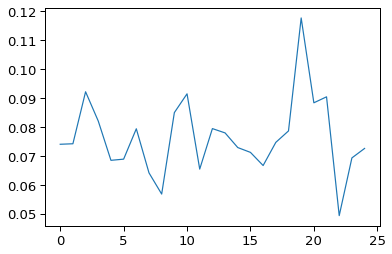

In [31]:
plt.plot(all_losses)

In [32]:
best_idx = np.argmin(all_losses)
best_idx

22

In [33]:
all_cv_scores[best_idx]

{'train_r2': array([0.78937118, 0.82070977, 0.72540279, 0.85575294, 0.91018444]),
 'validate_r2': array([0.81638545, 0.80828389, 0.88378074, 0.85363262, 0.9148122 ]),
 'train_rmsd': array([0.06891101, 0.08122886, 0.0830477 , 0.05008945, 0.05758673]),
 'validate_rmsd': array([0.0522821 , 0.06822576, 0.0454862 , 0.03938327, 0.04111092])}

In [36]:
best_emulator = all_emulators[best_idx]
best_emulator

In [37]:
best_emulator.train(retrain=True)

[INFO] >>> Training model on 80% of the dataset, testing on 20%...
[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0          0.892          0.050          0.652          0.082 *
[INFO]             100          0.870          0.055          0.659          0.081 *
[INFO]             200          0.892          0.050          0.632          0.084
[INFO]             300          0.874          0.054          0.649          0.082
[INFO]             400          0.876          0.054          0.638          0.084
[INFO]             500          0.875          0.054          0.647          0.083
[INFO]             600          0.876          0.054          0.639          0.084
[INFO]             700          0.875          0.054          0.618          0.086
[INFO]          

[INFO]            8400          0.886          0.051          0.607          0.087
[INFO]            8500          0.857          0.058          0.594          0.089
[INFO]            8600          0.865          0.056          0.653          0.082
[INFO]            8700          0.889          0.051          0.647          0.083
[INFO]            8800          0.874          0.054          0.649          0.082
[INFO]            8900          0.862          0.057          0.608          0.087
[INFO]            9000          0.883          0.052          0.608          0.087
[INFO]            9100          0.879          0.053          0.624          0.085
[INFO]            9200          0.885          0.052          0.663          0.081
[INFO]            9300          0.872          0.054          0.591          0.089
[INFO]            9400          0.863          0.056          0.616          0.086
[INFO]            9500          0.861          0.057          0.617          0.086
[INF

{'train_r2': 0.8686820303844761,
 'test_r2': 0.6813914315148911,
 'train_rmsd': 0.055217698811556595,
 'test_rmsd': 0.07848812825013472}

In [38]:
emulator.save('emulator_oer_plate_3851_BayesNeuralNet')

## `oer_plate_3860`

In [40]:
search_space = {
    'batch_size': hp.quniform('batch_size', 10, 50, 10),
    'hidden_act': hp.choice('hidden_act', ['leaky_relu'] ),
    'hidden_depth': hp.quniform('hidden_depth', 2, 5, 1),
    'hidden_nodes': hp.quniform('hidden_nodes', 28, 64, 4),
    'learning_rate': hp.uniform('learning_rate', 1e-5, 5e-3),
    'reg': hp.uniform('reg', 0.001, 0.1)
}

int_params = ['batch_size', 'hidden_depth', 'hidden_nodes']

all_emulators = []
all_losses = []
all_cv_scores = []
all_params = []

def objective(params):
    ''' average performance over cross-validation folds '''
    # build emualtor
    print(f'PARAMS : {params}')
    for param, val in params.items():
        if param in int_params:
            params[param] = int(val)
    model  = BayesNeuralNet(
        **params, out_act='sigmoid', 
    )
    emulator = Emulator(
        dataset='oer_plate_3860', model=model, 
        feature_transform='identity', target_transform='normalize',
    )

    cv_scores = emulator.cross_validate()
    loss = np.mean(cv_scores['validate_rmsd'])
    
    all_losses.append(loss)
    all_cv_scores.append(cv_scores)
    all_params.append(params)
    all_emulators.append(emulator)
    
    return {'loss': loss, 'status': STATUS_OK}

In [41]:
trials = Trials()

best = fmin(
    fn=objective,
    space=search_space, 
    algo=tpe.suggest, 
    max_evals=25,
    trials=trials
)

print(f"BEST VALUE : {best}")

PARAMS : {'batch_size': 40.0, 'hidden_act': 'leaky_relu', 'hidden_depth': 3.0, 'hidden_nodes': 52.0, 'learning_rate': 0.000717946616891949, 'reg': 0.09810357991012329}         
  0%|                                                                                                                                    | 0/25 [00:00<?, ?trial/s, best loss=?][INFO] >>> Training model on fold #0...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.071          0.098         -0.191          0.136 *
[INFO]             100          0.435          0.071          0.557          0.083 *
[INFO]             200          0.658          0.056          0.790          0.057 *
[INFO]             300          0.724          0.050          0.792          0.057 *
[INFO]             400          0.732          0.049          0.819          0.053 *
[INFO]             500          0.738          0.049          0.811          0.054
[INFO]             600          0.758          0.047          0.819          0.053 *
[INFO]             700          0.789          0.044          0.800          0.056
[INFO]             800          0.737          0.049          0.816        

[INFO]            8500          0.856          0.036          0.871          0.045
[INFO]            8600          0.841          0.038          0.876          0.044
[INFO]            8700          0.868          0.035          0.866          0.046
[INFO]            8800          0.868          0.035          0.881          0.043
[INFO]            8900          0.850          0.037          0.871          0.045
[INFO]            9000          0.881          0.033          0.866          0.046
[INFO]            9100          0.868          0.035          0.873          0.044
[INFO]            9200          0.868          0.035          0.880          0.043
[INFO]            9300          0.863          0.035          0.870          0.045
[INFO]            9400          0.861          0.035          0.878          0.044
[INFO]            9500          0.874          0.034          0.877          0.044
[INFO]            9600          0.875          0.034          0.869          0.045
[INF

[INFO]           17200          0.906          0.029          0.897          0.040
[INFO]           17300          0.901          0.030          0.891          0.041
[INFO]           17400          0.901          0.030          0.891          0.041
[INFO]           17500          0.903          0.030          0.893          0.041
[INFO]           17600          0.896          0.031          0.895          0.040
[INFO]           17700          0.910          0.029          0.896          0.040
[INFO]           17800          0.902          0.030          0.904          0.039 *
[INFO]           17900          0.892          0.031          0.897          0.040
[INFO]           18000          0.910          0.029          0.889          0.041
[INFO]           18100          0.895          0.031          0.892          0.041
[INFO]           18200          0.908          0.029          0.888          0.042
[INFO]           18300          0.905          0.029          0.900          0.039
[I

[INFO]           34800          0.943          0.023          0.916          0.036
[INFO]           34900          0.913          0.028          0.912          0.037
[INFO]           35000          0.936          0.024          0.923          0.035 *
[INFO]           35100          0.936          0.024          0.921          0.035
[INFO]           35200          0.927          0.026          0.911          0.037
[INFO]           35300          0.910          0.029          0.906          0.038
[INFO]           35400          0.923          0.026          0.916          0.036
[INFO]           35500          0.918          0.027          0.908          0.038
[INFO]           35600          0.931          0.025          0.917          0.036
[INFO]           35700          0.935          0.024          0.914          0.036
[INFO]           35800          0.912          0.028          0.907          0.038
[INFO]           35900          0.929          0.025          0.911          0.037
[I

[INFO]           43600          0.932          0.025          0.916          0.036
[INFO]           43700          0.932          0.025          0.923          0.035
[INFO]           43800          0.933          0.025          0.919          0.035
[INFO]           43900          0.933          0.025          0.917          0.036
[INFO]           44000          0.935          0.024          0.918          0.036
[INFO]           44100          0.936          0.024          0.917          0.036
[INFO]           44200          0.938          0.024          0.919          0.035
[INFO]           44300          0.933          0.025          0.914          0.037
[INFO]           44400          0.932          0.025          0.923          0.035
[INFO]           44500          0.922          0.027          0.918          0.036
[INFO]           44600          0.935          0.024          0.919          0.035
[INFO]           44700          0.939          0.024          0.912          0.037
[INF

[INFO]           52600          0.929          0.025          0.920          0.035
[INFO]           52700          0.941          0.023          0.920          0.035
[INFO]           52800          0.953          0.021          0.918          0.036
[INFO]           52900          0.943          0.023          0.920          0.035
[INFO]           53000          0.950          0.021          0.917          0.036
[INFO]           53100          0.937          0.024          0.920          0.035
[INFO]           53200          0.942          0.023          0.921          0.035
[INFO]           53300          0.934          0.024          0.921          0.035
[INFO]           53400          0.927          0.026          0.918          0.036
[INFO]           53500          0.941          0.023          0.923          0.035
[INFO]           53600          0.941          0.023          0.920          0.035
[INFO]           53700          0.928          0.026          0.915          0.036
[INF

[INFO]           61600          0.938          0.024          0.921          0.035
[INFO]           61700          0.948          0.022          0.923          0.035
[INFO]           61800          0.949          0.021          0.924          0.034
[INFO]           61900          0.948          0.022          0.926          0.034
[INFO]           62000          0.952          0.021          0.925          0.034
[INFO]           62100          0.946          0.022          0.924          0.034
[INFO]           62200          0.946          0.022          0.921          0.035
[INFO]           62300          0.939          0.024          0.923          0.035
[INFO]           62400          0.933          0.025          0.920          0.035
[INFO]           62500          0.943          0.023          0.917          0.036
[INFO]           62600          0.950          0.021          0.922          0.035
[INFO]           62700          0.946          0.022          0.919          0.035
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.600          0.136         -0.469          0.131 *
[INFO]             100          0.415          0.082          0.521          0.075 *
[INFO]             200          0.673          0.062          0.706          0.059 *
[INFO]             300          0.769          0.052          0.762          0.053 *
[INFO]             400          0.800          0.048          0.790          0.050 *
[INFO]             500          0.805          0.048          0.788          0.050
[INFO]             600          0.808          0.047          0.801          0.048 *
[INFO]             700          0.809          0.047          0.829          0.045 *
[INFO]             800          0.809          0.047          0.819      

[INFO]            8600          0.907          0.033          0.888          0.036 *
[INFO]            8700          0.916          0.031          0.870          0.039
[INFO]            8800          0.912          0.032          0.884          0.037
[INFO]            8900          0.908          0.033          0.878          0.038
[INFO]            9000          0.902          0.034          0.880          0.038
[INFO]            9100          0.909          0.032          0.861          0.040
[INFO]            9200          0.912          0.032          0.870          0.039
[INFO]            9300          0.912          0.032          0.887          0.036
[INFO]            9400          0.915          0.031          0.876          0.038
[INFO]            9500          0.917          0.031          0.869          0.039
[INFO]            9600          0.903          0.034          0.878          0.038
[INFO]            9700          0.911          0.032          0.891          0.036 *


[INFO]           17400          0.913          0.032          0.881          0.037
[INFO]           17500          0.909          0.033          0.890          0.036
[INFO]           17600          0.907          0.033          0.889          0.036
[INFO]           17700          0.916          0.031          0.892          0.036
[INFO]           17800          0.911          0.032          0.882          0.037
[INFO]           17900          0.915          0.031          0.888          0.036
[INFO]           18000          0.916          0.031          0.874          0.039
[INFO]           18100          0.915          0.031          0.888          0.036
[INFO]           18200          0.906          0.033          0.877          0.038
[INFO]           18300          0.917          0.031          0.882          0.037
[INFO]           18400          0.916          0.031          0.890          0.036
[INFO]           18500          0.918          0.031          0.882          0.037
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.275          0.137         -0.257          0.115 *
[INFO]             100          0.648          0.072          0.609          0.064 *
[INFO]             200          0.806          0.053          0.782          0.048 *
[INFO]             300          0.821          0.051          0.849          0.040 *
[INFO]             400          0.848          0.047          0.853          0.039 *
[INFO]             500          0.832          0.050          0.855          0.039 *
[INFO]             600          0.857          0.046          0.863          0.038 *
[INFO]             700          0.839          0.048          0.833          0.042
[INFO]             800          0.844          0.048          0.847      

[INFO]            8600          0.862          0.045          0.889          0.034
[INFO]            8700          0.867          0.044          0.894          0.033
[INFO]            8800          0.860          0.045          0.887          0.035
[INFO]            8900          0.870          0.044          0.890          0.034
[INFO]            9000          0.867          0.044          0.889          0.034
[INFO]            9100          0.868          0.044          0.900          0.033 *
[INFO]            9200          0.870          0.044          0.892          0.034
[INFO]            9300          0.875          0.043          0.872          0.037
[INFO]            9400          0.874          0.043          0.882          0.035
[INFO]            9500          0.868          0.044          0.882          0.035
[INFO]            9600          0.868          0.044          0.892          0.034
[INFO]            9700          0.866          0.044          0.885          0.035
[I

[INFO]           17600          0.889          0.040          0.903          0.032
[INFO]           17700          0.895          0.039          0.901          0.032
[INFO]           17800          0.897          0.039          0.895          0.033
[INFO]           17900          0.898          0.039          0.906          0.032
[INFO]           18000          0.890          0.040          0.894          0.033
[INFO]           18100          0.890          0.040          0.908          0.031
[INFO]           18200          0.898          0.039          0.906          0.032
[INFO]           18300          0.900          0.038          0.906          0.032
[INFO]           18400          0.891          0.040          0.905          0.032
[INFO]           18500          0.896          0.039          0.909          0.031 *
[INFO]           18600          0.899          0.038          0.895          0.033
[INFO]           18700          0.903          0.038          0.898          0.033
[I

[INFO]           26300          0.905          0.037          0.927          0.028
[INFO]           26400          0.904          0.037          0.923          0.028
[INFO]           26500          0.912          0.036          0.925          0.028
[INFO]           26600          0.904          0.038          0.925          0.028
[INFO]           26700          0.903          0.038          0.921          0.029
[INFO]           26800          0.913          0.036          0.915          0.030
[INFO]           26900          0.907          0.037          0.925          0.028
[INFO]           27000          0.906          0.037          0.922          0.029
[INFO]           27100          0.912          0.036          0.919          0.029
[INFO]           27200          0.905          0.037          0.928          0.028
[INFO]           27300          0.905          0.037          0.918          0.029
[INFO]           27400          0.905          0.037          0.928          0.028 *
[I

[INFO]           35300          0.908          0.037          0.923          0.029
[INFO]           35400          0.911          0.036          0.928          0.028
[INFO]           35500          0.911          0.036          0.921          0.029
[INFO]           35600          0.913          0.036          0.924          0.028
[INFO]           35700          0.914          0.035          0.931          0.027
[INFO]           35800          0.910          0.036          0.916          0.030
[INFO]           35900          0.906          0.037          0.928          0.028
[INFO]           36000          0.910          0.036          0.926          0.028
[INFO]           36100          0.910          0.036          0.929          0.027
[INFO]           36200          0.908          0.037          0.928          0.028
[INFO]           36300          0.902          0.038          0.929          0.027
[INFO]           36400          0.906          0.037          0.926          0.028
[INF

[INFO]           44100          0.904          0.038          0.931          0.027
[INFO]           44200          0.911          0.036          0.919          0.029
[INFO]           44300          0.909          0.036          0.929          0.027
[INFO]           44400          0.906          0.037          0.926          0.028
[INFO]           44500          0.907          0.037          0.932          0.027
[INFO]           44600          0.900          0.038          0.931          0.027
[INFO]           44700          0.901          0.038          0.925          0.028
[INFO]           44800          0.908          0.037          0.922          0.029
[INFO]           44900          0.895          0.039          0.925          0.028
[INFO]           45000          0.901          0.038          0.930          0.027
[INFO]           45100          0.906          0.037          0.927          0.028
[INFO]           45200          0.909          0.036          0.923          0.029
[INF

[INFO]           52900          0.907          0.037          0.928          0.028
[INFO]           53000          0.908          0.037          0.934          0.026
[INFO]           53100          0.906          0.037          0.938          0.026
[INFO]           53200          0.912          0.036          0.936          0.026
[INFO]           53300          0.906          0.037          0.932          0.027
[INFO]           53400          0.910          0.036          0.939          0.025
[INFO]           53500          0.907          0.037          0.933          0.027
[INFO]           53600          0.909          0.037          0.935          0.026
[INFO]           53700          0.909          0.037          0.931          0.027
[INFO]           53800          0.904          0.037          0.938          0.026
[INFO]           53900          0.905          0.037          0.929          0.027
[INFO]           54000          0.915          0.035          0.933          0.027
[INF

[INFO]           61800          0.899          0.038          0.945          0.024 *
[INFO]           61900          0.908          0.037          0.941          0.025
[INFO]           62000          0.903          0.038          0.940          0.025
[INFO]           62100          0.902          0.038          0.933          0.027
[INFO]           62200          0.904          0.037          0.941          0.025
[INFO]           62300          0.903          0.038          0.943          0.025
[INFO]           62400          0.906          0.037          0.938          0.026
[INFO]           62500          0.900          0.038          0.942          0.025
[INFO]           62600          0.903          0.038          0.941          0.025
[INFO]           62700          0.905          0.037          0.942          0.025
[INFO]           62800          0.900          0.038          0.936          0.026
[INFO]           62900          0.904          0.038          0.938          0.026
[I

[INFO]           70600          0.903          0.038          0.937          0.026
[INFO]           70700          0.897          0.039          0.945          0.024
[INFO]           70800          0.909          0.037          0.926          0.028
[INFO]           70900          0.907          0.037          0.938          0.026
[INFO]           71000          0.909          0.037          0.936          0.026
[INFO]           71100          0.904          0.038          0.944          0.024
[INFO]           71200          0.904          0.038          0.942          0.025
[INFO]           71300          0.902          0.038          0.940          0.025
[INFO]           71400          0.904          0.037          0.941          0.025
[INFO]           71500          0.903          0.038          0.941          0.025
[INFO]           71600          0.911          0.036          0.938          0.026
[INFO]           71700          0.900          0.038          0.942          0.025
[INF

[INFO]           79400          0.911          0.036          0.945          0.024
[INFO]           79500          0.910          0.036          0.930          0.027
[INFO]           79600          0.902          0.038          0.942          0.025
[INFO]           79700          0.915          0.035          0.941          0.025
[INFO]           79800          0.906          0.037          0.942          0.025
[INFO]           79900          0.903          0.038          0.951          0.023 *
[INFO]           80000          0.904          0.038          0.944          0.024
[INFO]           80100          0.901          0.038          0.942          0.025
[INFO]           80200          0.901          0.038          0.937          0.026
[INFO]           80300          0.905          0.037          0.927          0.028
[INFO]           80400          0.907          0.037          0.941          0.025
[INFO]           80500          0.902          0.038          0.949          0.023
[I

[INFO]           88200          0.907          0.037          0.933          0.027
[INFO]           88300          0.906          0.037          0.941          0.025
[INFO]           88400          0.903          0.038          0.937          0.026
[INFO]           88500          0.906          0.037          0.939          0.025
[INFO]           88600          0.904          0.037          0.944          0.024
[INFO]           88700          0.903          0.038          0.945          0.024
[INFO]           88800          0.910          0.036          0.938          0.026
[INFO]           88900          0.903          0.038          0.935          0.026
[INFO]           89000          0.902          0.038          0.937          0.026
[INFO]           89100          0.903          0.038          0.940          0.025
[INFO]           89200          0.905          0.037          0.943          0.025
[INFO]           89300          0.904          0.038          0.942          0.025
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.371          0.195         -0.686          0.195 *
[INFO]             100          0.480          0.120          0.557          0.100 *
[INFO]             200          0.806          0.073          0.775          0.071 *
[INFO]             300          0.865          0.061          0.812          0.065 *
[INFO]             400          0.833          0.068          0.824          0.063 *
[INFO]             500          0.878          0.058          0.811          0.065
[INFO]             600          0.869          0.060          0.818          0.064
[INFO]             700          0.884          0.057          0.832          0.062 *
[INFO]             800          0.883          0.057          0.819        

[INFO]            8400          0.910          0.050          0.817          0.064
[INFO]            8500          0.901          0.052          0.829          0.062
[INFO]            8600          0.909          0.050          0.816          0.064
[INFO]            8700          0.910          0.050          0.794          0.068
[INFO]            8800          0.902          0.052          0.818          0.064
[INFO]            8900          0.910          0.050          0.832          0.062
[INFO]            9000          0.919          0.047          0.829          0.062
[INFO]            9100          0.920          0.047          0.844          0.059
[INFO]            9200          0.912          0.049          0.821          0.064
[INFO]            9300          0.915          0.048          0.811          0.065
[INFO]            9400          0.912          0.049          0.812          0.065
[INFO]            9500          0.916          0.048          0.828          0.062
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.234          0.146         -0.206          0.149 *
[INFO]             100          0.487          0.094          0.449          0.101 *
[INFO]             200          0.731          0.068          0.631          0.082 *
[INFO]             300          0.777          0.062          0.715          0.072 *
[INFO]             400          0.765          0.064          0.732          0.070 *
[INFO]             500          0.804          0.058          0.769          0.065 *
[INFO]             600          0.832          0.054          0.764          0.066
[INFO]             700          0.810          0.057          0.766          0.066
[INFO]             800          0.804          0.058          0.798        

[INFO]            8600          0.897          0.042          0.868          0.049
[INFO]            8700          0.905          0.040          0.867          0.050
[INFO]            8800          0.907          0.040          0.866          0.050
[INFO]            8900          0.904          0.041          0.882          0.047
[INFO]            9000          0.914          0.039          0.870          0.049
[INFO]            9100          0.908          0.040          0.874          0.048
[INFO]            9200          0.906          0.040          0.857          0.051
[INFO]            9300          0.910          0.040          0.861          0.051
[INFO]            9400          0.913          0.039          0.870          0.049
[INFO]            9500          0.905          0.041          0.879          0.047
[INFO]            9600          0.913          0.039          0.862          0.050
[INFO]            9700          0.905          0.040          0.872          0.049
[INF

[INFO]           26100          0.938          0.033          0.896          0.044
[INFO]           26200          0.933          0.034          0.902          0.042
[INFO]           26300          0.929          0.035          0.902          0.043
[INFO]           26400          0.941          0.032          0.895          0.044
[INFO]           26500          0.935          0.033          0.897          0.043
[INFO]           26600          0.932          0.034          0.897          0.044
[INFO] Training completed in 27.55 seconds.
[INFO] ===========================================================================

[INFO] Performance statistics based on transformed data [identity, normalize]:
[INFO] Validation   R2: 0.9108 +/- 0.0144
[INFO] Validation RSMD: 0.0373 +/- 0.0053
PARAMS : {'batch_size': 30.0, 'hidden_act': 'leaky_relu', 'hidden_depth': 5.0, 'hidden_nodes': 36.0, 'learning_rate': 0.003966468203371264, 'reg': 0.048949359965553295}        
  4%|████                         

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.283          0.237         -0.560          0.222 *
[INFO]             100          0.803          0.093          0.715          0.095 *
[INFO]             200          0.805          0.092          0.820          0.075 *
[INFO]             300          0.855          0.080          0.806          0.078
[INFO]             400          0.741          0.107          0.683          0.100
[INFO]             500          0.801          0.093          0.749          0.089
[INFO]             600          0.736          0.108          0.694          0.098
[INFO]             700          0.843          0.083          0.784          0.083
[INFO]             800          0.892          0.069          0.871          0.06

[INFO]           17200          0.958          0.043          0.892          0.058
[INFO]           17300          0.962          0.041          0.876          0.063
[INFO]           17400          0.953          0.045          0.880          0.062
[INFO]           17500          0.962          0.041          0.906          0.054 *
[INFO]           17600          0.960          0.042          0.900          0.056
[INFO]           17700          0.958          0.043          0.865          0.065
[INFO]           17800          0.955          0.044          0.872          0.064
[INFO]           17900          0.943          0.050          0.851          0.069
[INFO]           18000          0.959          0.042          0.902          0.056
[INFO]           18100          0.962          0.041          0.884          0.061
[INFO]           18200          0.964          0.040          0.893          0.058
[INFO]           18300          0.953          0.046          0.886          0.060
[I

[INFO]           26000          0.958          0.043          0.866          0.065
[INFO]           26100          0.957          0.044          0.865          0.065
[INFO]           26200          0.951          0.046          0.860          0.066
[INFO]           26300          0.956          0.044          0.886          0.060
[INFO]           26400          0.956          0.044          0.880          0.062
[INFO]           26500          0.962          0.041          0.909          0.054
[INFO]           26600          0.962          0.041          0.899          0.057
[INFO]           26700          0.962          0.041          0.898          0.057
[INFO]           26800          0.958          0.043          0.877          0.062
[INFO]           26900          0.963          0.040          0.888          0.059
[INFO]           27000          0.968          0.037          0.912          0.053
[INFO]           27100          0.965          0.039          0.896          0.057
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.209          0.183         -0.462          0.173 *
[INFO]             100          0.760          0.082          0.649          0.085 *
[INFO]             200          0.672          0.095          0.680          0.081 *
[INFO]             300          0.794          0.076          0.747          0.072 *
[INFO]             400          0.694          0.092          0.692          0.079
[INFO]             500          0.748          0.084          0.691          0.080
[INFO]             600          0.836          0.067          0.776          0.068 *
[INFO]             700          0.758          0.082          0.766          0.069
[INFO]             800          0.833          0.068          0.767          

[INFO]            8500          0.918          0.048          0.909          0.043
[INFO]            8600          0.925          0.046          0.894          0.047
[INFO]            8700          0.916          0.048          0.901          0.045
[INFO]            8800          0.897          0.054          0.896          0.046
[INFO]            8900          0.891          0.055          0.898          0.046
[INFO]            9000          0.916          0.048          0.910          0.043
[INFO]            9100          0.915          0.049          0.883          0.049
[INFO]            9200          0.898          0.053          0.903          0.045
[INFO]            9300          0.910          0.050          0.913          0.042
[INFO]            9400          0.928          0.045          0.915          0.042
[INFO]            9500          0.895          0.054          0.891          0.047
[INFO]            9600          0.901          0.052          0.912          0.043
[INF

[INFO]           17300          0.909          0.050          0.893          0.047
[INFO]           17400          0.920          0.047          0.880          0.050
[INFO]           17500          0.912          0.049          0.911          0.043
[INFO]           17600          0.898          0.053          0.913          0.042
[INFO]           17700          0.901          0.052          0.897          0.046
[INFO]           17800          0.904          0.052          0.881          0.049
[INFO]           17900          0.922          0.046          0.894          0.047
[INFO]           18000          0.915          0.049          0.917          0.041
[INFO]           18100          0.911          0.050          0.864          0.053
[INFO]           18200          0.903          0.052          0.922          0.040
[INFO]           18300          0.910          0.050          0.911          0.043
[INFO]           18400          0.899          0.053          0.899          0.046
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.870          0.263         -2.392          0.268 *
[INFO]             100          0.724          0.101          0.749          0.073 *
[INFO]             200          0.849          0.075          0.794          0.066 *
[INFO]             300          0.770          0.092          0.795          0.066 *
[INFO]             400          0.835          0.078          0.788          0.067
[INFO]             500          0.863          0.071          0.804          0.064 *
[INFO]             600          0.880          0.067          0.851          0.056 *
[INFO]             700          0.851          0.074          0.841          0.058
[INFO]             800          0.825          0.081          0.795        

[INFO]            8400          0.959          0.039          0.884          0.050
[INFO]            8500          0.961          0.038          0.906          0.045
[INFO]            8600          0.957          0.040          0.891          0.048
[INFO]            8700          0.964          0.037          0.900          0.046
[INFO]            8800          0.966          0.036          0.900          0.046
[INFO]            8900          0.958          0.039          0.914          0.043
[INFO]            9000          0.961          0.038          0.904          0.045
[INFO]            9100          0.962          0.038          0.884          0.049
[INFO]            9200          0.966          0.035          0.916          0.042
[INFO]            9300          0.963          0.037          0.895          0.047
[INFO]            9400          0.959          0.039          0.858          0.055
[INFO]            9500          0.962          0.038          0.887          0.049
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.577          0.256         -0.227          0.301 *
[INFO]             100          0.755          0.101          0.796          0.123 *
[INFO]             200          0.718          0.108          0.730          0.141
[INFO]             300          0.778          0.096          0.823          0.114 *
[INFO]             400          0.790          0.093          0.851          0.105 *
[INFO]             500          0.720          0.108          0.767          0.131
[INFO]             600          0.793          0.093          0.861          0.101 *
[INFO]             700          0.799          0.092          0.856          0.103
[INFO]             800          0.865          0.075          0.870          

[INFO]            8400          0.936          0.051          0.922          0.076
[INFO]            8500          0.919          0.058          0.880          0.094
[INFO]            8600          0.931          0.054          0.917          0.078
[INFO]            8700          0.941          0.050          0.913          0.080
[INFO]            8800          0.943          0.049          0.907          0.083
[INFO]            8900          0.938          0.051          0.914          0.080
[INFO]            9000          0.930          0.054          0.913          0.080
[INFO]            9100          0.940          0.050          0.926          0.074
[INFO]            9200          0.944          0.048          0.931          0.072
[INFO]            9300          0.944          0.048          0.928          0.073
[INFO]            9400          0.958          0.042          0.925          0.074
[INFO]            9500          0.949          0.046          0.912          0.081
[INF

[INFO]           17200          0.946          0.047          0.928          0.073
[INFO]           17300          0.947          0.047          0.928          0.073
[INFO]           17400          0.947          0.047          0.923          0.076
[INFO]           17500          0.949          0.046          0.930          0.072
[INFO]           17600          0.951          0.045          0.930          0.072
[INFO]           17700          0.941          0.050          0.922          0.076
[INFO]           17800          0.947          0.047          0.924          0.075
[INFO]           17900          0.947          0.047          0.925          0.074
[INFO]           18000          0.954          0.044          0.931          0.071
[INFO]           18100          0.953          0.044          0.924          0.075
[INFO]           18200          0.939          0.050          0.916          0.079
[INFO]           18300          0.957          0.042          0.919          0.077
[INF

[INFO]           26100          0.952          0.045          0.921          0.076
[INFO]           26200          0.959          0.041          0.937          0.068
[INFO]           26300          0.948          0.046          0.928          0.073
[INFO]           26400          0.955          0.043          0.925          0.074
[INFO]           26500          0.932          0.053          0.927          0.073
[INFO]           26600          0.939          0.050          0.922          0.076
[INFO]           26700          0.954          0.044          0.926          0.074
[INFO]           26800          0.963          0.039          0.932          0.071
[INFO]           26900          0.953          0.044          0.937          0.068
[INFO]           27000          0.959          0.041          0.928          0.073
[INFO]           27100          0.948          0.047          0.923          0.075
[INFO]           27200          0.929          0.054          0.912          0.081
[INF

[INFO]           34900          0.953          0.044          0.921          0.076
[INFO]           35000          0.938          0.051          0.910          0.082
[INFO]           35100          0.946          0.047          0.931          0.071
[INFO]           35200          0.946          0.047          0.915          0.079
[INFO]           35300          0.952          0.045          0.933          0.071
[INFO]           35400          0.946          0.048          0.938          0.068
[INFO]           35500          0.953          0.044          0.936          0.069
[INFO]           35600          0.950          0.046          0.923          0.076
[INFO]           35700          0.957          0.042          0.932          0.071
[INFO]           35800          0.955          0.043          0.926          0.074
[INFO]           35900          0.952          0.045          0.928          0.073
[INFO]           36000          0.944          0.048          0.918          0.078
[INF

[INFO]           43700          0.954          0.044          0.940          0.067
[INFO]           43800          0.959          0.041          0.937          0.068
[INFO]           43900          0.938          0.051          0.940          0.067
[INFO]           44000          0.953          0.044          0.925          0.074
[INFO]           44100          0.951          0.045          0.932          0.071
[INFO]           44200          0.941          0.049          0.927          0.073
[INFO]           44300          0.962          0.040          0.935          0.069
[INFO]           44400          0.955          0.043          0.931          0.071
[INFO]           44500          0.952          0.045          0.927          0.073
[INFO]           44600          0.962          0.040          0.936          0.069
[INFO]           44700          0.955          0.043          0.932          0.071
[INFO]           44800          0.955          0.043          0.932          0.071
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.916          0.262         -1.134          0.215 *
[INFO]             100          0.831          0.078          0.711          0.079 *
[INFO]             200          0.869          0.068          0.642          0.088
[INFO]             300          0.879          0.066          0.670          0.085
[INFO]             400          0.891          0.062          0.538          0.100
[INFO]             500          0.832          0.078          0.747          0.074 *
[INFO]             600          0.893          0.062          0.714          0.079
[INFO]             700          0.901          0.060          0.594          0.094
[INFO]             800          0.894          0.062          0.719          0.07

[INFO]            8600          0.966          0.035          0.649          0.087
[INFO]            8700          0.969          0.033          0.651          0.087
[INFO]            8800          0.958          0.039          0.583          0.095
[INFO]            8900          0.966          0.035          0.662          0.086
[INFO]            9000          0.960          0.038          0.702          0.080
[INFO]            9100          0.963          0.036          0.685          0.083
[INFO]            9200          0.964          0.036          0.636          0.089
[INFO]            9300          0.960          0.038          0.662          0.086
[INFO]            9400          0.966          0.035          0.661          0.086
[INFO]            9500          0.964          0.036          0.667          0.085
[INFO]            9600          0.961          0.037          0.588          0.095
[INFO]            9700          0.963          0.036          0.678          0.084
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.080          0.119         -0.032          0.138 *
[INFO]             100         -0.001          0.114         -0.014          0.137 *
[INFO]             200         -0.038          0.116         -0.002          0.136 *
[INFO]             300         -0.010          0.115          0.000          0.136 *
[INFO]             400         -0.017          0.115         -0.007          0.137
[INFO]             500          0.125          0.107          0.080          0.131 *
[INFO]             600          0.636          0.069          0.310          0.113 *
[INFO]             700          0.710          0.062          0.345          0.110 *
[INFO]             800          0.729          0.059          0.392      

[INFO]            8600          0.805          0.050          0.394          0.106
[INFO]            8700          0.817          0.049          0.391          0.106
[INFO]            8800          0.817          0.049          0.374          0.108
[INFO]            8900          0.834          0.047          0.380          0.107
[INFO]            9000          0.822          0.048          0.393          0.106
[INFO]            9100          0.824          0.048          0.367          0.108
[INFO]            9200          0.821          0.048          0.376          0.108
[INFO]            9300          0.798          0.051          0.389          0.106
[INFO]            9400          0.835          0.046          0.397          0.106
[INFO]            9500          0.847          0.045          0.388          0.107
[INFO]            9600          0.810          0.050          0.372          0.108
[INFO]            9700          0.818          0.049          0.401          0.105
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.597          0.201         -1.564          0.227 *
[INFO]             100          0.837          0.064          0.630          0.086 *
[INFO]             200          0.807          0.070          0.696          0.078 *
[INFO]             300          0.822          0.067          0.707          0.077 *
[INFO]             400          0.830          0.066          0.651          0.084
[INFO]             500          0.786          0.073          0.639          0.085
[INFO]             600          0.836          0.064          0.618          0.088
[INFO]             700          0.830          0.065          0.776          0.067 *
[INFO]             800          0.883          0.054          0.643          

[INFO]            8600          0.890          0.053          0.900          0.045
[INFO]            8700          0.885          0.054          0.906          0.043
[INFO]            8800          0.914          0.047          0.911          0.042
[INFO]            8900          0.861          0.059          0.898          0.045
[INFO]            9000          0.893          0.052          0.935          0.036 *
[INFO]            9100          0.898          0.051          0.894          0.046
[INFO]            9200          0.893          0.052          0.910          0.042
[INFO]            9300          0.868          0.058          0.899          0.045
[INFO]            9400          0.906          0.049          0.929          0.038
[INFO]            9500          0.856          0.060          0.908          0.043
[INFO]            9600          0.885          0.054          0.918          0.041
[INFO]            9700          0.915          0.046          0.907          0.043
[I

[INFO]           17500          0.903          0.049          0.940          0.035
[INFO]           17600          0.918          0.045          0.941          0.034
[INFO]           17700          0.886          0.054          0.940          0.035
[INFO]           17800          0.860          0.059          0.942          0.034
[INFO]           17900          0.865          0.058          0.940          0.035
[INFO]           18000          0.899          0.050          0.945          0.033
[INFO]           18100          0.896          0.051          0.936          0.036
[INFO]           18200          0.911          0.047          0.948          0.032
[INFO]           18300          0.867          0.058          0.938          0.035
[INFO]           18400          0.894          0.052          0.948          0.032
[INFO]           18500          0.909          0.048          0.956          0.030
[INFO]           18600          0.894          0.052          0.949          0.032
[INF

[INFO]           26400          0.868          0.058          0.942          0.034
[INFO]           26500          0.889          0.053          0.950          0.032
[INFO]           26600          0.885          0.054          0.957          0.029
[INFO]           26700          0.872          0.057          0.945          0.033
[INFO]           26800          0.890          0.053          0.956          0.030
[INFO]           26900          0.877          0.056          0.941          0.034
[INFO]           27000          0.858          0.060          0.930          0.038
[INFO]           27100          0.865          0.058          0.942          0.034
[INFO]           27200          0.903          0.049          0.953          0.031
[INFO]           27300          0.874          0.056          0.937          0.035
[INFO]           27400          0.869          0.058          0.957          0.029
[INFO]           27500          0.907          0.048          0.946          0.033
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.876          0.131         -0.607          0.156 *
[INFO]             100          0.705          0.052          0.629          0.075 *
[INFO]             200          0.681          0.054          0.672          0.070 *
[INFO]             300          0.669          0.055          0.735          0.063 *
[INFO]             400          0.714          0.051          0.649          0.073
[INFO]             500          0.726          0.050          0.687          0.069
[INFO]             600          0.741          0.049          0.683          0.069
[INFO]             700          0.587          0.061          0.612          0.076
[INFO]             800          0.699          0.052          0.727          0.

[INFO]            8500          0.834          0.039          0.897          0.039 *
[INFO]            8600          0.830          0.039          0.879          0.043
[INFO]            8700          0.865          0.035          0.900          0.039 *
[INFO]            8800          0.862          0.035          0.892          0.040
[INFO]            8900          0.873          0.034          0.906          0.038 *
[INFO]            9000          0.887          0.032          0.894          0.040
[INFO]            9100          0.899          0.030          0.878          0.043
[INFO]            9200          0.881          0.033          0.880          0.043
[INFO]            9300          0.829          0.039          0.893          0.040
[INFO]            9400          0.890          0.032          0.860          0.046
[INFO]            9500          0.845          0.038          0.903          0.038
[INFO]            9600          0.870          0.034          0.897          0.03

[INFO]           17200          0.899          0.030          0.931          0.032
[INFO]           17300          0.936          0.024          0.919          0.035
[INFO]           17400          0.871          0.034          0.925          0.034
[INFO]           17500          0.932          0.025          0.891          0.041
[INFO]           17600          0.922          0.027          0.916          0.036
[INFO]           17700          0.905          0.029          0.926          0.033
[INFO]           17800          0.894          0.031          0.926          0.033
[INFO]           17900          0.921          0.027          0.921          0.035
[INFO]           18000          0.902          0.030          0.939          0.030
[INFO]           18100          0.885          0.032          0.929          0.033
[INFO]           18200          0.866          0.035          0.945          0.029
[INFO]           18300          0.918          0.027          0.923          0.034
[INF

[INFO]           26100          0.897          0.031          0.943          0.029
[INFO]           26200          0.907          0.029          0.926          0.033
[INFO]           26300          0.915          0.028          0.948          0.028
[INFO]           26400          0.885          0.032          0.943          0.029
[INFO]           26500          0.892          0.031          0.947          0.028
[INFO]           26600          0.892          0.031          0.929          0.033
[INFO]           26700          0.889          0.032          0.940          0.030
[INFO]           26800          0.905          0.029          0.941          0.030
[INFO]           26900          0.899          0.030          0.934          0.032
[INFO]           27000          0.912          0.028          0.934          0.032
[INFO]           27100          0.912          0.028          0.936          0.031
[INFO]           27200          0.894          0.031          0.938          0.031
[INF

[INFO]           35000          0.908          0.029          0.928          0.033
[INFO]           35100          0.877          0.033          0.920          0.035
[INFO]           35200          0.892          0.031          0.935          0.031
[INFO]           35300          0.926          0.026          0.941          0.030
[INFO]           35400          0.872          0.034          0.931          0.032
[INFO]           35500          0.912          0.028          0.914          0.036
[INFO]           35600          0.904          0.030          0.930          0.033
[INFO]           35700          0.901          0.030          0.941          0.030
[INFO]           35800          0.896          0.031          0.939          0.030
[INFO]           35900          0.915          0.028          0.943          0.029
[INFO]           36000          0.882          0.033          0.946          0.029
[INFO]           36100          0.892          0.031          0.933          0.032
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.459          0.185         -0.967          0.170 *
[INFO]             100          0.624          0.094          0.678          0.069 *
[INFO]             200          0.764          0.074          0.772          0.058 *
[INFO]             300          0.693          0.085          0.805          0.053 *
[INFO]             400          0.768          0.074          0.776          0.057
[INFO]             500          0.759          0.075          0.771          0.058
[INFO]             600          0.771          0.073          0.777          0.057
[INFO]             700          0.652          0.090          0.667          0.070
[INFO]             800          0.783          0.071          0.767          0.

[INFO]            8600          0.851          0.059          0.900          0.038
[INFO]            8700          0.850          0.059          0.904          0.037
[INFO]            8800          0.848          0.060          0.895          0.039
[INFO]            8900          0.861          0.057          0.893          0.040
[INFO]            9000          0.847          0.060          0.855          0.046
[INFO]            9100          0.837          0.062          0.907          0.037
[INFO]            9200          0.839          0.061          0.905          0.037
[INFO]            9300          0.842          0.061          0.909          0.036
[INFO]            9400          0.872          0.055          0.899          0.039
[INFO]            9500          0.845          0.060          0.895          0.039
[INFO]            9600          0.861          0.057          0.884          0.041
[INFO]            9700          0.850          0.059          0.884          0.041
[INF

[INFO]           17600          0.885          0.052          0.924          0.033
[INFO]           17700          0.875          0.054          0.896          0.039
[INFO]           17800          0.874          0.054          0.903          0.038
[INFO]           17900          0.854          0.058          0.887          0.041
[INFO]           18000          0.861          0.057          0.911          0.036
[INFO]           18100          0.877          0.054          0.909          0.037
[INFO]           18200          0.858          0.058          0.926          0.033 *
[INFO]           18300          0.877          0.054          0.910          0.036
[INFO]           18400          0.845          0.060          0.827          0.050
[INFO]           18500          0.879          0.053          0.927          0.033 *
[INFO]           18600          0.860          0.057          0.890          0.040
[INFO]           18700          0.864          0.056          0.912          0.036


[INFO]           26400          0.904          0.047          0.914          0.036
[INFO]           26500          0.905          0.047          0.914          0.036
[INFO]           26600          0.887          0.051          0.921          0.034
[INFO]           26700          0.908          0.046          0.934          0.031 *
[INFO]           26800          0.895          0.049          0.929          0.032
[INFO]           26900          0.901          0.048          0.915          0.035
[INFO]           27000          0.902          0.048          0.914          0.035
[INFO]           27100          0.882          0.053          0.926          0.033
[INFO]           27200          0.902          0.048          0.927          0.033
[INFO]           27300          0.901          0.048          0.923          0.034
[INFO]           27400          0.898          0.049          0.928          0.032
[INFO]           27500          0.905          0.047          0.914          0.035
[I

[INFO]           35200          0.911          0.046          0.918          0.035
[INFO]           35300          0.911          0.046          0.914          0.035
[INFO]           35400          0.906          0.047          0.916          0.035
[INFO]           35500          0.904          0.047          0.920          0.034
[INFO]           35600          0.914          0.045          0.911          0.036
[INFO]           35700          0.894          0.050          0.924          0.033
[INFO]           35800          0.900          0.048          0.926          0.033
[INFO]           35900          0.912          0.045          0.927          0.033
[INFO]           36000          0.914          0.045          0.903          0.038
[INFO]           36100          0.896          0.049          0.907          0.037
[INFO]           36200          0.894          0.050          0.930          0.032
[INFO]           36300          0.897          0.049          0.924          0.033
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.018          0.092         -0.216          0.158 *
[INFO]             100         -0.056          0.093         -0.060          0.147 *
[INFO]             200          0.002          0.091         -0.131          0.152
[INFO]             300         -0.000          0.091         -0.139          0.153
[INFO]             400         -0.061          0.094         -0.069          0.148
[INFO]             500         -0.032          0.092         -0.079          0.149
[INFO]             600          0.001          0.091         -0.139          0.153
[INFO]             700         -0.052          0.093         -0.042          0.146 *
[INFO]             800          0.249          0.079          0.121          0.13

[INFO]            8400          0.784          0.042          0.874          0.051
[INFO]            8500          0.781          0.042          0.853          0.055
[INFO]            8600          0.774          0.043          0.881          0.049
[INFO]            8700          0.789          0.042          0.894          0.047
[INFO]            8800          0.747          0.046          0.878          0.050
[INFO]            8900          0.777          0.043          0.885          0.048
[INFO]            9000          0.791          0.042          0.877          0.050
[INFO]            9100          0.764          0.044          0.902          0.045 *
[INFO]            9200          0.782          0.042          0.897          0.046
[INFO]            9300          0.785          0.042          0.888          0.048
[INFO]            9400          0.784          0.042          0.902          0.045 *
[INFO]            9500          0.771          0.043          0.889          0.048


[INFO]           17200          0.882          0.031          0.890          0.047
[INFO]           17300          0.882          0.031          0.889          0.048
[INFO]           17400          0.871          0.033          0.899          0.045
[INFO]           17500          0.884          0.031          0.900          0.045
[INFO]           17600          0.860          0.034          0.921          0.040 *
[INFO]           17700          0.868          0.033          0.893          0.047
[INFO]           17800          0.901          0.029          0.921          0.040 *
[INFO]           17900          0.888          0.030          0.917          0.041
[INFO]           18000          0.902          0.028          0.912          0.042
[INFO]           18100          0.849          0.035          0.906          0.044
[INFO]           18200          0.896          0.029          0.913          0.042
[INFO]           18300          0.852          0.035          0.872          0.051


[INFO]           26200          0.871          0.033          0.900          0.045
[INFO]           26300          0.896          0.029          0.912          0.042
[INFO]           26400          0.900          0.029          0.900          0.045
[INFO]           26500          0.896          0.029          0.906          0.044
[INFO]           26600          0.877          0.032          0.908          0.043
[INFO]           26700          0.882          0.031          0.915          0.042
[INFO]           26800          0.894          0.030          0.919          0.041
[INFO]           26900          0.910          0.027          0.911          0.043
[INFO]           27000          0.909          0.027          0.925          0.039
[INFO]           27100          0.853          0.035          0.883          0.049
[INFO]           27200          0.914          0.027          0.919          0.041
[INFO]           27300          0.862          0.034          0.913          0.042
[INF

[INFO]           35100          0.883          0.031          0.941          0.035 *
[INFO]           35200          0.910          0.027          0.935          0.036
[INFO]           35300          0.910          0.027          0.914          0.042
[INFO]           35400          0.905          0.028          0.915          0.042
[INFO]           35500          0.912          0.027          0.927          0.039
[INFO]           35600          0.877          0.032          0.924          0.040
[INFO]           35700          0.912          0.027          0.923          0.040
[INFO]           35800          0.887          0.031          0.883          0.049
[INFO]           35900          0.918          0.026          0.921          0.040
[INFO]           36000          0.891          0.030          0.924          0.039
[INFO]           36100          0.894          0.030          0.927          0.039
[INFO]           36200          0.903          0.028          0.889          0.048
[I

[INFO]           43900          0.920          0.026          0.926          0.039
[INFO]           44000          0.911          0.027          0.920          0.041
[INFO]           44100          0.888          0.030          0.902          0.045
[INFO]           44200          0.911          0.027          0.922          0.040
[INFO]           44300          0.924          0.025          0.906          0.044
[INFO]           44400          0.890          0.030          0.914          0.042
[INFO]           44500          0.915          0.026          0.905          0.044
[INFO]           44600          0.922          0.025          0.914          0.042
[INFO]           44700          0.904          0.028          0.920          0.041
[INFO]           44800          0.908          0.028          0.879          0.050
[INFO]           44900          0.872          0.032          0.901          0.045
[INFO]           45000          0.920          0.026          0.912          0.042
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.105          0.130         -0.201          0.132 *
[INFO]             100          0.668          0.071          0.822          0.051 *
[INFO]             200          0.772          0.059          0.827          0.050 *
[INFO]             300          0.715          0.066          0.800          0.054
[INFO]             400          0.808          0.054          0.865          0.044 *
[INFO]             500          0.803          0.055          0.833          0.049
[INFO]             600          0.818          0.053          0.868          0.044 *
[INFO]             700          0.822          0.052          0.853          0.046
[INFO]             800          0.771          0.059          0.810          

[INFO]            8500          0.951          0.028          0.929          0.032
[INFO]            8600          0.949          0.028          0.927          0.032
[INFO]            8700          0.950          0.028          0.920          0.034
[INFO]            8800          0.956          0.026          0.934          0.031
[INFO]            8900          0.934          0.032          0.929          0.032
[INFO]            9000          0.942          0.030          0.926          0.033
[INFO]            9100          0.955          0.026          0.937          0.030
[INFO]            9200          0.946          0.029          0.926          0.033
[INFO]            9300          0.947          0.029          0.933          0.031
[INFO]            9400          0.958          0.025          0.927          0.032
[INFO]            9500          0.949          0.028          0.926          0.033
[INFO]            9600          0.955          0.026          0.932          0.031
[INF

[INFO]           17300          0.960          0.025          0.934          0.031
[INFO]           17400          0.947          0.029          0.935          0.031
[INFO]           17500          0.957          0.026          0.933          0.031
[INFO]           17600          0.935          0.032          0.929          0.032
[INFO]           17700          0.956          0.026          0.922          0.033
[INFO]           17800          0.957          0.026          0.935          0.031
[INFO]           17900          0.958          0.025          0.925          0.033
[INFO]           18000          0.952          0.027          0.925          0.033
[INFO]           18100          0.957          0.026          0.935          0.031
[INFO]           18200          0.923          0.034          0.906          0.037
[INFO]           18300          0.953          0.027          0.934          0.031
[INFO]           18400          0.948          0.028          0.925          0.033
[INF

[INFO]           26200          0.951          0.027          0.923          0.033
[INFO]           26300          0.955          0.026          0.938          0.030
[INFO]           26400          0.947          0.028          0.926          0.033
[INFO]           26500          0.953          0.027          0.936          0.030
[INFO]           26600          0.957          0.026          0.938          0.030
[INFO]           26700          0.955          0.026          0.927          0.032
[INFO]           26800          0.946          0.029          0.938          0.030
[INFO]           26900          0.954          0.027          0.942          0.029
[INFO]           27000          0.959          0.025          0.938          0.030
[INFO]           27100          0.942          0.030          0.906          0.037
[INFO]           27200          0.953          0.027          0.931          0.031
[INFO]           27300          0.951          0.027          0.935          0.031
[INF

[INFO]           35000          0.954          0.026          0.933          0.031
[INFO]           35100          0.963          0.024          0.935          0.031
[INFO]           35200          0.966          0.023          0.942          0.029
[INFO]           35300          0.962          0.024          0.940          0.029
[INFO]           35400          0.964          0.023          0.932          0.031
[INFO]           35500          0.953          0.027          0.922          0.034
[INFO]           35600          0.955          0.026          0.930          0.032
[INFO]           35700          0.956          0.026          0.937          0.030
[INFO]           35800          0.949          0.028          0.928          0.032
[INFO]           35900          0.968          0.022          0.939          0.030
[INFO] Training completed in 44.84 seconds.
[INFO] ===========================================================================

[INFO] >>> Training model on fold #1...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.375          0.159         -0.136          0.128 *
[INFO]             100          0.709          0.073          0.748          0.060 *
[INFO]             200          0.763          0.066          0.778          0.057 *
[INFO]             300          0.821          0.057          0.825          0.050 *
[INFO]             400          0.801          0.060          0.772          0.057
[INFO]             500          0.840          0.054          0.668          0.069
[INFO]             600          0.824          0.057          0.796          0.054
[INFO]             700          0.839          0.054          0.870          0.043 *
[INFO]             800          0.893          0.044          0.849          

[INFO]            8500          0.940          0.033          0.896          0.039
[INFO]            8600          0.941          0.033          0.886          0.041
[INFO]            8700          0.927          0.037          0.882          0.041
[INFO]            8800          0.952          0.030          0.898          0.038
[INFO]            8900          0.955          0.029          0.899          0.038
[INFO]            9000          0.942          0.033          0.879          0.042
[INFO]            9100          0.955          0.029          0.899          0.038
[INFO]            9200          0.961          0.027          0.894          0.039
[INFO]            9300          0.951          0.030          0.899          0.038
[INFO]            9400          0.934          0.035          0.897          0.039
[INFO]            9500          0.954          0.029          0.900          0.038
[INFO]            9600          0.950          0.030          0.902          0.038
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.696          0.238         -1.586          0.310 *
[INFO]             100          0.846          0.072          0.086          0.184 *
[INFO]             200          0.809          0.080          0.233          0.169 *
[INFO]             300          0.880          0.063          0.222          0.170
[INFO]             400          0.869          0.066          0.195          0.173
[INFO]             500          0.837          0.074          0.099          0.183
[INFO]             600          0.895          0.059          0.223          0.170
[INFO]             700          0.882          0.063          0.164          0.176
[INFO]             800          0.902          0.057          0.267          0.16

[INFO]            8600          0.954          0.039          0.204          0.172
[INFO]            8700          0.958          0.037          0.196          0.173
[INFO]            8800          0.950          0.041          0.236          0.169
[INFO]            8900          0.943          0.043          0.200          0.172
[INFO]            9000          0.948          0.041          0.222          0.170
[INFO]            9100          0.948          0.042          0.230          0.169
[INFO]            9200          0.945          0.043          0.213          0.171
[INFO]            9300          0.950          0.041          0.244          0.168
[INFO]            9400          0.957          0.038          0.243          0.168
[INFO]            9500          0.954          0.039          0.208          0.172
[INFO]            9600          0.950          0.041          0.213          0.171
[INFO]            9700          0.947          0.042          0.232          0.169
[INF

[INFO]           17500          0.953          0.039          0.252          0.167
[INFO]           17600          0.955          0.039          0.209          0.172
[INFO]           17700          0.948          0.041          0.209          0.172
[INFO]           17800          0.956          0.038          0.211          0.171
[INFO]           17900          0.950          0.041          0.218          0.171
[INFO]           18000          0.945          0.043          0.209          0.171
[INFO]           18100          0.946          0.042          0.228          0.169
[INFO]           18200          0.950          0.041          0.229          0.169
[INFO]           18300          0.956          0.038          0.253          0.167
[INFO]           18400          0.952          0.040          0.224          0.170
[INFO]           18500          0.953          0.040          0.257          0.166
[INFO]           18600          0.960          0.037          0.238          0.168
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.480          0.154         -0.816          0.127 *
[INFO]             100          0.784          0.059          0.651          0.055 *
[INFO]             200          0.803          0.056          0.707          0.051 *
[INFO]             300          0.800          0.056          0.715          0.050 *
[INFO]             400          0.796          0.057          0.682          0.053
[INFO]             500          0.835          0.051          0.709          0.051
[INFO]             600          0.869          0.046          0.759          0.046 *
[INFO]             700          0.863          0.047          0.666          0.054
[INFO]             800          0.871          0.045          0.662          

[INFO]            8400          0.951          0.028          0.892          0.031
[INFO]            8500          0.931          0.033          0.872          0.034
[INFO]            8600          0.948          0.029          0.894          0.031
[INFO]            8700          0.937          0.032          0.873          0.033
[INFO]            8800          0.940          0.031          0.879          0.033
[INFO]            8900          0.927          0.034          0.857          0.035
[INFO]            9000          0.935          0.032          0.889          0.031
[INFO]            9100          0.948          0.029          0.889          0.031
[INFO]            9200          0.937          0.032          0.873          0.033
[INFO]            9300          0.939          0.031          0.883          0.032
[INFO]            9400          0.948          0.029          0.876          0.033
[INFO]            9500          0.928          0.034          0.884          0.032
[INF

[INFO]           17300          0.959          0.026          0.904          0.029
[INFO]           17400          0.949          0.028          0.891          0.031
[INFO]           17500          0.940          0.031          0.880          0.033
[INFO]           17600          0.957          0.026          0.905          0.029
[INFO]           17700          0.954          0.027          0.902          0.029
[INFO]           17800          0.945          0.030          0.868          0.034
[INFO]           17900          0.949          0.029          0.900          0.030
[INFO]           18000          0.943          0.030          0.882          0.032
[INFO]           18100          0.947          0.029          0.887          0.032
[INFO]           18200          0.953          0.028          0.901          0.030
[INFO]           18300          0.950          0.028          0.887          0.032
[INFO]           18400          0.954          0.027          0.901          0.030
[INF

[INFO]           26200          0.962          0.025          0.905          0.029
[INFO]           26300          0.953          0.027          0.910          0.028
[INFO]           26400          0.970          0.022          0.910          0.028
[INFO]           26500          0.963          0.024          0.903          0.029
[INFO]           26600          0.951          0.028          0.910          0.028
[INFO]           26700          0.950          0.028          0.914          0.027
[INFO]           26800          0.949          0.029          0.901          0.030
[INFO]           26900          0.964          0.024          0.906          0.029
[INFO]           27000          0.941          0.031          0.880          0.033
[INFO]           27100          0.955          0.027          0.889          0.031
[INFO]           27200          0.955          0.027          0.899          0.030
[INFO]           27300          0.955          0.027          0.896          0.030
[INF

[INFO]           35000          0.966          0.023          0.922          0.026
[INFO]           35100          0.955          0.027          0.899          0.030
[INFO]           35200          0.951          0.028          0.892          0.031
[INFO] Training completed in 43.98 seconds.
[INFO] ===========================================================================

[INFO] >>> Training model on fold #4...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0          0.001          0.112         -0.089          0.126 *
[INFO]             100          0.794          0.051          0.821          0.051 *
[INFO]             200          0.792          0.051          0.843          0.048 *
[INFO]             300          0.805          0.050          0.789          0.055
[INFO]             400          0.732          0.058          0.817          0.052
[INFO]             500          0.803          0.050          0.785          0.056
[INFO]             600          0.627          0.069          0.758          0.059
[INFO]             700          0.806          0.050          0.799          0.054
[INFO]             800          0.843          0.045          0.815          0.05

[INFO]            8500          0.911          0.033          0.896          0.039
[INFO]            8600          0.933          0.029          0.918          0.034
[INFO]            8700          0.925          0.031          0.918          0.035
[INFO]            8800          0.931          0.030          0.921          0.034
[INFO]            8900          0.929          0.030          0.918          0.035
[INFO]            9000          0.906          0.034          0.920          0.034
[INFO]            9100          0.932          0.029          0.925          0.033 *
[INFO]            9200          0.926          0.031          0.924          0.033
[INFO]            9300          0.905          0.035          0.921          0.034
[INFO]            9400          0.926          0.031          0.925          0.033 *
[INFO]            9500          0.930          0.030          0.911          0.036
[INFO]            9600          0.932          0.029          0.893          0.040


[INFO]           17300          0.909          0.034          0.918          0.035
[INFO]           17400          0.914          0.033          0.911          0.036
[INFO]           17500          0.923          0.031          0.934          0.031 *
[INFO]           17600          0.922          0.031          0.922          0.034
[INFO]           17700          0.915          0.033          0.927          0.033
[INFO]           17800          0.912          0.033          0.930          0.032
[INFO]           17900          0.927          0.030          0.928          0.032
[INFO]           18000          0.911          0.033          0.923          0.033
[INFO]           18100          0.910          0.034          0.931          0.032
[INFO]           18200          0.897          0.036          0.919          0.034
[INFO]           18300          0.905          0.035          0.925          0.033
[INFO]           18400          0.905          0.035          0.929          0.032
[I

[INFO]           26100          0.894          0.037          0.912          0.036
[INFO]           26200          0.918          0.032          0.930          0.032
[INFO]           26300          0.890          0.037          0.895          0.039
[INFO]           26400          0.917          0.032          0.933          0.031
[INFO]           26500          0.899          0.036          0.924          0.033
[INFO]           26600          0.928          0.030          0.929          0.032
[INFO]           26700          0.903          0.035          0.933          0.031
[INFO]           26800          0.918          0.032          0.929          0.032
[INFO]           26900          0.922          0.031          0.929          0.032
[INFO]           27000          0.907          0.034          0.891          0.040
[INFO]           27100          0.890          0.037          0.901          0.038
[INFO]           27200          0.901          0.035          0.917          0.035
[INF

[INFO]           35000          0.908          0.034          0.930          0.032
[INFO]           35100          0.890          0.037          0.924          0.033
[INFO]           35200          0.921          0.032          0.929          0.032
[INFO]           35300          0.892          0.037          0.920          0.034
[INFO]           35400          0.899          0.036          0.929          0.032
[INFO]           35500          0.901          0.035          0.931          0.032
[INFO]           35600          0.910          0.034          0.932          0.031
[INFO]           35700          0.906          0.034          0.927          0.033
[INFO]           35800          0.934          0.029          0.920          0.034
[INFO]           35900          0.902          0.035          0.929          0.032
[INFO]           36000          0.913          0.033          0.930          0.032
[INFO]           36100          0.912          0.033          0.939          0.030 *
[I

[INFO]           43900          0.935          0.029          0.924          0.033
[INFO]           44000          0.928          0.030          0.930          0.032
[INFO]           44100          0.912          0.033          0.926          0.033
[INFO]           44200          0.916          0.033          0.921          0.034
[INFO]           44300          0.916          0.033          0.932          0.032
[INFO]           44400          0.907          0.034          0.931          0.032
[INFO]           44500          0.890          0.037          0.930          0.032
[INFO]           44600          0.903          0.035          0.926          0.033
[INFO]           44700          0.924          0.031          0.931          0.032
[INFO]           44800          0.868          0.041          0.924          0.033
[INFO]           44900          0.904          0.035          0.933          0.031
[INFO]           45000          0.914          0.033          0.928          0.032
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.556          0.178         -0.639          0.164 *
[INFO]             100          0.873          0.051          0.681          0.072 *
[INFO]             200          0.874          0.050          0.692          0.071 *
[INFO]             300          0.845          0.056          0.654          0.075
[INFO]             400          0.859          0.053          0.702          0.070 *
[INFO]             500          0.860          0.053          0.680          0.072
[INFO]             600          0.880          0.049          0.678          0.073
[INFO]             700          0.863          0.053          0.675          0.073
[INFO]             800          0.867          0.052          0.637          0.

[INFO]            8600          0.923          0.039          0.816          0.055
[INFO]            8700          0.920          0.040          0.799          0.057
[INFO]            8800          0.927          0.038          0.811          0.056
[INFO]            8900          0.920          0.040          0.806          0.056
[INFO]            9000          0.924          0.039          0.819          0.054 *
[INFO]            9100          0.915          0.041          0.802          0.057
[INFO]            9200          0.925          0.039          0.816          0.055
[INFO]            9300          0.918          0.041          0.810          0.056
[INFO]            9400          0.922          0.040          0.805          0.056
[INFO]            9500          0.898          0.045          0.816          0.055
[INFO]            9600          0.925          0.039          0.814          0.055
[INFO]            9700          0.918          0.041          0.824          0.054 *


[INFO]           17600          0.935          0.036          0.811          0.056
[INFO]           17700          0.930          0.038          0.815          0.055
[INFO]           17800          0.937          0.036          0.817          0.055
[INFO]           17900          0.932          0.037          0.818          0.055
[INFO]           18000          0.931          0.037          0.826          0.053
[INFO]           18100          0.935          0.036          0.820          0.054
[INFO]           18200          0.933          0.037          0.812          0.056
[INFO]           18300          0.930          0.038          0.809          0.056
[INFO]           18400          0.935          0.036          0.816          0.055
[INFO]           18500          0.937          0.036          0.806          0.056
[INFO]           18600          0.933          0.037          0.821          0.054
[INFO]           18700          0.930          0.038          0.817          0.055
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.230          0.127         -0.448          0.162 *
[INFO]             100          0.452          0.085          0.531          0.092 *
[INFO]             200          0.773          0.055          0.851          0.052 *
[INFO]             300          0.773          0.055          0.912          0.040 *
[INFO]             400          0.767          0.055          0.877          0.047
[INFO]             500          0.750          0.057          0.847          0.053
[INFO]             600          0.764          0.056          0.914          0.039 *
[INFO]             700          0.751          0.057          0.896          0.043
[INFO]             800          0.723          0.060          0.817          

[INFO]            8600          0.883          0.039          0.934          0.035
[INFO]            8700          0.853          0.044          0.944          0.032 *
[INFO]            8800          0.859          0.043          0.932          0.035
[INFO]            8900          0.873          0.041          0.940          0.033
[INFO]            9000          0.860          0.043          0.912          0.040
[INFO]            9100          0.886          0.039          0.933          0.035
[INFO]            9200          0.883          0.039          0.943          0.032
[INFO]            9300          0.879          0.040          0.924          0.037
[INFO]            9400          0.876          0.040          0.940          0.033
[INFO]            9500          0.884          0.039          0.933          0.035
[INFO]            9600          0.871          0.041          0.936          0.034
[INFO]            9700          0.859          0.043          0.937          0.034
[I

[INFO]           17500          0.900          0.036          0.927          0.036
[INFO]           17600          0.905          0.035          0.924          0.037
[INFO]           17700          0.907          0.035          0.932          0.035
[INFO]           17800          0.908          0.035          0.931          0.035
[INFO]           17900          0.917          0.033          0.933          0.035
[INFO]           18000          0.907          0.035          0.932          0.035
[INFO]           18100          0.908          0.035          0.933          0.035
[INFO]           18200          0.908          0.035          0.927          0.036
[INFO]           18300          0.913          0.034          0.928          0.036
[INFO]           18400          0.917          0.033          0.936          0.034
[INFO]           18500          0.911          0.034          0.935          0.034
[INFO]           18600          0.911          0.034          0.926          0.037
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.593          0.125         -0.460          0.169 *
[INFO]             100          0.602          0.062          0.674          0.080 *
[INFO]             200          0.687          0.055          0.771          0.067 *
[INFO]             300          0.693          0.055          0.766          0.068
[INFO]             400          0.694          0.055          0.771          0.067 *
[INFO]             500          0.694          0.055          0.806          0.062 *
[INFO]             600          0.723          0.052          0.767          0.068
[INFO]             700          0.654          0.058          0.809          0.061 *
[INFO]             800          0.741          0.050          0.823        

[INFO]            8400          0.851          0.038          0.872          0.050
[INFO]            8500          0.867          0.036          0.878          0.049
[INFO]            8600          0.857          0.037          0.882          0.048
[INFO]            8700          0.856          0.037          0.881          0.048
[INFO]            8800          0.844          0.039          0.875          0.049
[INFO]            8900          0.833          0.040          0.877          0.049
[INFO]            9000          0.863          0.037          0.884          0.048
[INFO]            9100          0.876          0.035          0.888          0.047
[INFO]            9200          0.842          0.039          0.877          0.049
[INFO]            9300          0.878          0.035          0.884          0.048
[INFO]            9400          0.872          0.035          0.894          0.046 *
[INFO]            9500          0.890          0.033          0.900          0.044 *


[INFO]           17100          0.913          0.029          0.906          0.043
[INFO]           17200          0.928          0.026          0.897          0.045
[INFO]           17300          0.932          0.026          0.907          0.043
[INFO]           17400          0.917          0.028          0.899          0.044
[INFO]           17500          0.914          0.029          0.905          0.043
[INFO]           17600          0.908          0.030          0.904          0.043
[INFO]           17700          0.922          0.028          0.899          0.045
[INFO]           17800          0.904          0.031          0.897          0.045
[INFO]           17900          0.909          0.030          0.898          0.045
[INFO]           18000          0.924          0.027          0.907          0.043
[INFO]           18100          0.912          0.029          0.908          0.043
[INFO]           18200          0.906          0.030          0.900          0.044
[INF

[INFO]           26000          0.934          0.025          0.915          0.041
[INFO]           26100          0.935          0.025          0.920          0.040
[INFO]           26200          0.914          0.029          0.910          0.042
[INFO]           26300          0.933          0.026          0.920          0.039
[INFO]           26400          0.920          0.028          0.907          0.043
[INFO]           26500          0.936          0.025          0.917          0.040
[INFO]           26600          0.917          0.028          0.900          0.044
[INFO]           26700          0.918          0.028          0.911          0.042
[INFO]           26800          0.891          0.033          0.899          0.045
[INFO]           26900          0.924          0.027          0.913          0.041
[INFO]           27000          0.935          0.025          0.909          0.042
[INFO]           27100          0.907          0.030          0.904          0.043
[INF

[INFO]           34800          0.918          0.028          0.919          0.040
[INFO]           34900          0.915          0.029          0.915          0.041
[INFO]           35000          0.907          0.030          0.912          0.041
[INFO]           35100          0.945          0.023          0.910          0.042
[INFO]           35200          0.930          0.026          0.915          0.041
[INFO]           35300          0.927          0.027          0.914          0.041
[INFO]           35400          0.944          0.023          0.912          0.042
[INFO]           35500          0.937          0.025          0.916          0.041
[INFO]           35600          0.929          0.026          0.919          0.040
[INFO]           35700          0.910          0.030          0.910          0.042
[INFO]           35800          0.941          0.024          0.920          0.040
[INFO]           35900          0.940          0.024          0.918          0.040
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.030          0.241         -0.225          0.188 *
[INFO]             100          0.683          0.134          0.726          0.089 *
[INFO]             200          0.770          0.114          0.772          0.081 *
[INFO]             300          0.770          0.114          0.802          0.076 *
[INFO]             400          0.769          0.114          0.794          0.077
[INFO]             500          0.873          0.085          0.744          0.086
[INFO]             600          0.771          0.114          0.741          0.086
[INFO]             700          0.783          0.111          0.742          0.086
[INFO]             800          0.804          0.105          0.771          0.

[INFO]            8500          0.922          0.067          0.873          0.061
[INFO]            8600          0.935          0.061          0.868          0.062
[INFO]            8700          0.928          0.064          0.888          0.057
[INFO]            8800          0.940          0.058          0.875          0.060
[INFO]            8900          0.938          0.059          0.879          0.059
[INFO]            9000          0.935          0.061          0.870          0.061
[INFO]            9100          0.929          0.063          0.865          0.062
[INFO]            9200          0.931          0.063          0.874          0.060
[INFO]            9300          0.933          0.062          0.882          0.058
[INFO]            9400          0.936          0.060          0.884          0.058
[INFO]            9500          0.938          0.059          0.883          0.058
[INFO]            9600          0.925          0.065          0.859          0.064
[INF

[INFO]           17400          0.934          0.061          0.884          0.058
[INFO]           17500          0.944          0.056          0.886          0.057
[INFO]           17600          0.950          0.053          0.887          0.057
[INFO]           17700          0.938          0.059          0.887          0.057
[INFO]           17800          0.949          0.054          0.864          0.063
[INFO]           17900          0.933          0.062          0.883          0.058
[INFO]           18000          0.941          0.058          0.892          0.056
[INFO]           18100          0.943          0.057          0.904          0.053
[INFO]           18200          0.941          0.058          0.910          0.051 *
[INFO]           18300          0.946          0.055          0.896          0.055
[INFO]           18400          0.938          0.059          0.881          0.058
[INFO]           18500          0.947          0.055          0.896          0.055
[I

[INFO]           26400          0.945          0.056          0.888          0.057
[INFO]           26500          0.940          0.058          0.894          0.055
[INFO]           26600          0.953          0.052          0.893          0.055
[INFO]           26700          0.948          0.054          0.876          0.060
[INFO]           26800          0.917          0.069          0.893          0.056
[INFO]           26900          0.947          0.055          0.889          0.057
[INFO]           27000          0.948          0.054          0.895          0.055
[INFO]           27100          0.942          0.057          0.897          0.054
[INFO]           27200          0.940          0.058          0.893          0.056
[INFO]           27300          0.941          0.058          0.893          0.056
[INFO]           27400          0.939          0.059          0.902          0.053
[INFO]           27500          0.937          0.060          0.895          0.055
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.625          0.181         -0.308          0.160 *
[INFO]             100          0.859          0.053          0.622          0.086 *
[INFO]             200          0.826          0.059          0.738          0.072 *
[INFO]             300          0.784          0.066          0.672          0.080
[INFO]             400          0.856          0.054          0.728          0.073
[INFO]             500          0.854          0.054          0.775          0.067 *
[INFO]             600          0.834          0.058          0.740          0.071
[INFO]             700          0.854          0.054          0.767          0.068
[INFO]             800          0.827          0.059          0.748          0.

[INFO]            8500          0.895          0.046          0.884          0.048
[INFO]            8600          0.896          0.046          0.892          0.046
[INFO]            8700          0.894          0.046          0.885          0.048
[INFO]            8800          0.885          0.048          0.878          0.049
[INFO]            8900          0.895          0.046          0.877          0.049
[INFO]            9000          0.897          0.046          0.886          0.047
[INFO]            9100          0.884          0.048          0.893          0.046
[INFO]            9200          0.898          0.045          0.881          0.048
[INFO]            9300          0.887          0.048          0.887          0.047
[INFO]            9400          0.895          0.046          0.878          0.049
[INFO]            9500          0.887          0.048          0.889          0.047
[INFO]            9600          0.896          0.046          0.886          0.047
[INF

[INFO]           26000          0.936          0.036          0.931          0.037
[INFO]           26100          0.924          0.039          0.930          0.037
[INFO]           26200          0.926          0.039          0.913          0.041
[INFO]           26300          0.927          0.038          0.922          0.039
[INFO]           26400          0.917          0.041          0.936          0.036 *
[INFO]           26500          0.936          0.036          0.917          0.040
[INFO]           26600          0.914          0.042          0.917          0.040
[INFO]           26700          0.928          0.038          0.943          0.034 *
[INFO]           26800          0.930          0.037          0.926          0.038
[INFO]           26900          0.931          0.037          0.929          0.037
[INFO]           27000          0.927          0.038          0.941          0.034
[INFO]           27100          0.930          0.038          0.928          0.038


[INFO]           35000          0.933          0.037          0.939          0.035
[INFO]           35100          0.930          0.038          0.948          0.032 *
[INFO]           35200          0.937          0.036          0.934          0.036
[INFO]           35300          0.937          0.036          0.936          0.036
[INFO]           35400          0.915          0.041          0.937          0.035
[INFO]           35500          0.928          0.038          0.944          0.033
[INFO]           35600          0.936          0.036          0.953          0.030 *
[INFO]           35700          0.938          0.036          0.945          0.033
[INFO]           35800          0.937          0.036          0.945          0.033
[INFO]           35900          0.940          0.035          0.941          0.034
[INFO]           36000          0.928          0.038          0.936          0.036
[INFO]           36100          0.936          0.036          0.950          0.031


[INFO]           43900          0.929          0.038          0.951          0.031
[INFO]           44000          0.921          0.040          0.931          0.037
[INFO]           44100          0.933          0.037          0.942          0.034
[INFO]           44200          0.925          0.039          0.937          0.035
[INFO]           44300          0.934          0.036          0.944          0.033
[INFO]           44400          0.940          0.035          0.947          0.032
[INFO]           44500          0.936          0.036          0.940          0.034
[INFO]           44600          0.937          0.036          0.945          0.033
[INFO]           44700          0.937          0.036          0.946          0.033
[INFO]           44800          0.929          0.038          0.948          0.032
[INFO]           44900          0.942          0.034          0.937          0.035
[INFO]           45000          0.933          0.037          0.944          0.033
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.411          0.168         -0.901          0.188 *
[INFO]             100          0.829          0.059          0.771          0.065 *
[INFO]             200          0.872          0.051          0.836          0.055 *
[INFO]             300          0.852          0.055          0.817          0.058
[INFO]             400          0.880          0.049          0.825          0.057
[INFO]             500          0.908          0.043          0.869          0.049 *
[INFO]             600          0.901          0.045          0.852          0.053
[INFO]             700          0.913          0.042          0.879          0.048 *
[INFO]             800          0.898          0.045          0.857          

[INFO]            8400          0.964          0.027          0.941          0.033 *
[INFO]            8500          0.959          0.029          0.931          0.036
[INFO]            8600          0.964          0.027          0.938          0.034
[INFO]            8700          0.961          0.028          0.936          0.034
[INFO]            8800          0.966          0.026          0.935          0.035
[INFO]            8900          0.963          0.027          0.936          0.035
[INFO]            9000          0.960          0.028          0.929          0.036
[INFO]            9100          0.963          0.027          0.943          0.033 *
[INFO]            9200          0.949          0.032          0.930          0.036
[INFO]            9300          0.966          0.026          0.935          0.035
[INFO]            9400          0.960          0.028          0.933          0.035
[INFO]            9500          0.967          0.026          0.939          0.034


[INFO]           17100          0.966          0.026          0.941          0.033
[INFO]           17200          0.968          0.025          0.946          0.032
[INFO]           17300          0.965          0.026          0.945          0.032
[INFO]           17400          0.964          0.027          0.940          0.034
[INFO]           17500          0.965          0.027          0.950          0.031
[INFO]           17600          0.965          0.027          0.947          0.031
[INFO]           17700          0.968          0.025          0.947          0.031
[INFO]           17800          0.969          0.025          0.941          0.033
[INFO]           17900          0.964          0.027          0.937          0.034
[INFO]           18000          0.961          0.028          0.944          0.032
[INFO]           18100          0.966          0.026          0.944          0.032
[INFO]           18200          0.962          0.028          0.948          0.031
[INF

[INFO]           26100          0.969          0.025          0.951          0.030
[INFO]           26200          0.966          0.026          0.953          0.030
[INFO]           26300          0.969          0.025          0.949          0.031
[INFO]           26400          0.966          0.026          0.951          0.030
[INFO]           26500          0.969          0.025          0.954          0.029
[INFO]           26600          0.966          0.026          0.933          0.035
[INFO]           26700          0.964          0.027          0.949          0.031
[INFO]           26800          0.966          0.026          0.951          0.030
[INFO]           26900          0.967          0.026          0.945          0.032
[INFO]           27000          0.969          0.025          0.952          0.030
[INFO]           27100          0.962          0.028          0.934          0.035
[INFO]           27200          0.967          0.026          0.952          0.030
[INF

[INFO]           43600          0.970          0.024          0.954          0.029
[INFO]           43700          0.969          0.025          0.952          0.030
[INFO]           43800          0.971          0.024          0.955          0.029
[INFO] Training completed in 48.37 seconds.
[INFO] ===========================================================================

[INFO] >>> Training model on fold #1...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.393          0.128         -0.469          0.144 *
[INFO]             100          0.775          0.051          0.772          0.057 *
[INFO]             200          0.789          0.050          0.801          0.053 *
[INFO]             300          0.829          0.045          0.829          0.049 *
[INFO]             400          0.836          0.044          0.848          0.046 *
[INFO]             500          0.831          0.045          0.865          0.044 *
[INFO]             600          0.849          0.042          0.823          0.050
[INFO]             700          0.825          0.045          0.843          0.047
[INFO]             800          0.854          0.041          0.853        

[INFO]            8400          0.922          0.030          0.940          0.029
[INFO]            8500          0.918          0.031          0.942          0.029
[INFO]            8600          0.932          0.028          0.939          0.029
[INFO]            8700          0.924          0.030          0.934          0.030
[INFO]            8800          0.920          0.031          0.929          0.032
[INFO]            8900          0.923          0.030          0.930          0.031
[INFO]            9000          0.921          0.030          0.930          0.031
[INFO]            9100          0.920          0.031          0.930          0.031
[INFO]            9200          0.930          0.029          0.934          0.030
[INFO]            9300          0.932          0.028          0.936          0.030
[INFO]            9400          0.929          0.029          0.943          0.028
[INFO]            9500          0.932          0.028          0.931          0.031
[INF

[INFO]           25800          0.919          0.031          0.930          0.031
[INFO]           25900          0.940          0.027          0.954          0.025
[INFO]           26000          0.954          0.023          0.955          0.025
[INFO]           26100          0.948          0.025          0.961          0.023 *
[INFO]           26200          0.949          0.024          0.947          0.027
[INFO]           26300          0.940          0.027          0.961          0.023 *
[INFO]           26400          0.923          0.030          0.945          0.028
[INFO]           26500          0.947          0.025          0.952          0.026
[INFO]           26600          0.949          0.025          0.946          0.028
[INFO]           26700          0.946          0.025          0.950          0.026
[INFO]           26800          0.949          0.025          0.962          0.023 *
[INFO]           26900          0.949          0.024          0.952          0.02

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.042          0.115         -0.033          0.118 *
[INFO]             100          0.783          0.052          0.791          0.053 *
[INFO]             200          0.818          0.048          0.805          0.051 *
[INFO]             300          0.819          0.048          0.807          0.051 *
[INFO]             400          0.835          0.046          0.838          0.047 *
[INFO]             500          0.828          0.047          0.792          0.053
[INFO]             600          0.842          0.045          0.808          0.051
[INFO]             700          0.844          0.045          0.791          0.053
[INFO]             800          0.834          0.046          0.846          

[INFO]            8500          0.914          0.033          0.892          0.038
[INFO]            8600          0.920          0.032          0.889          0.039
[INFO]            8700          0.908          0.034          0.875          0.041
[INFO]            8800          0.909          0.034          0.880          0.040
[INFO]            8900          0.916          0.033          0.888          0.039
[INFO]            9000          0.911          0.034          0.894          0.038
[INFO]            9100          0.919          0.032          0.887          0.039
[INFO]            9200          0.909          0.034          0.882          0.040
[INFO]            9300          0.916          0.033          0.883          0.040
[INFO]            9400          0.913          0.033          0.888          0.039
[INFO]            9500          0.909          0.034          0.881          0.040
[INFO]            9600          0.919          0.032          0.891          0.038
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.403          0.197         -0.437          0.216 *
[INFO]             100          0.760          0.081          0.773          0.086 *
[INFO]             200          0.763          0.081          0.761          0.088
[INFO]             300          0.863          0.061          0.804          0.080 *
[INFO]             400          0.837          0.067          0.798          0.081
[INFO]             500          0.861          0.062          0.840          0.072 *
[INFO]             600          0.875          0.059          0.817          0.077
[INFO]             700          0.857          0.063          0.826          0.075
[INFO]             800          0.844          0.066          0.832          0.

[INFO]            8400          0.954          0.036          0.914          0.053
[INFO]            8500          0.955          0.035          0.920          0.051
[INFO]            8600          0.961          0.033          0.926          0.049
[INFO]            8700          0.958          0.034          0.926          0.049
[INFO]            8800          0.953          0.036          0.917          0.052
[INFO]            8900          0.958          0.034          0.925          0.050
[INFO]            9000          0.956          0.035          0.927          0.049
[INFO]            9100          0.962          0.032          0.930          0.048 *
[INFO]            9200          0.961          0.033          0.920          0.051
[INFO]            9300          0.954          0.036          0.920          0.051
[INFO]            9400          0.958          0.034          0.914          0.053
[INFO]            9500          0.959          0.034          0.924          0.050
[I

[INFO]           25900          0.970          0.029          0.927          0.049
[INFO] Training completed in 28.09 seconds.
[INFO] ===========================================================================

[INFO] >>> Training model on fold #4...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0          0.004          0.124         -0.100          0.116 *
[INFO]             100          0.220          0.110          0.750          0.055 *
[INFO]             200          0.153          0.115          0.729          0.058
[INFO]             300          0.150          0.115          0.762          0.054 *
[INFO]             400          0.241          0.108          0.798          0.050 *
[INFO]             500          0.318          0.103          0.809          0.048 *
[INFO]             600          0.229          0.109          0.793          0.050
[INFO]             700          0.295          0.104          0.811          0.048 *
[INFO]             800          0.306          0.104          0.816        

[INFO]            8400          0.401          0.096          0.928          0.030
[INFO]            8500          0.422          0.095          0.932          0.029
[INFO]            8600          0.423          0.095          0.931          0.029
[INFO]            8700          0.440          0.093          0.928          0.030
[INFO]            8800          0.430          0.094          0.933          0.029
[INFO]            8900          0.447          0.093          0.929          0.029
[INFO]            9000          0.434          0.094          0.936          0.028
[INFO]            9100          0.405          0.096          0.930          0.029
[INFO]            9200          0.446          0.093          0.932          0.029
[INFO]            9300          0.415          0.095          0.936          0.028
[INFO]            9400          0.449          0.092          0.935          0.028
[INFO]            9500          0.435          0.094          0.938          0.028 *
[I

[INFO]           17400          0.531          0.085          0.931          0.029
[INFO]           17500          0.510          0.087          0.925          0.030
[INFO]           17600          0.511          0.087          0.926          0.030
[INFO]           17700          0.530          0.085          0.920          0.031
[INFO]           17800          0.524          0.086          0.931          0.029
[INFO]           17900          0.539          0.085          0.912          0.033
[INFO]           18000          0.530          0.085          0.918          0.032
[INFO]           18100          0.534          0.085          0.924          0.030
[INFO]           18200          0.534          0.085          0.928          0.030
[INFO]           18300          0.491          0.089          0.918          0.032
[INFO]           18400          0.473          0.090          0.924          0.030
[INFO]           18500          0.489          0.089          0.918          0.032
[INF

[INFO]           26400          0.592          0.079          0.925          0.030
[INFO] Training completed in 28.3 seconds.
[INFO] ===========================================================================

[INFO] Performance statistics based on transformed data [identity, normalize]:
[INFO] Validation   R2: 0.9426 +/- 0.0110
[INFO] Validation RSMD: 0.0311 +/- 0.0042
PARAMS : {'batch_size': 50.0, 'hidden_act': 'leaky_relu', 'hidden_depth': 3.0, 'hidden_nodes': 36.0, 'learning_rate': 0.000755580004668293, 'reg': 0.06040940820156867}         
 24%|████████████████████████▋                                                                              | 6/25 [17:51<55:01, 173.75s/trial, best loss: 0.031132155684801165][INFO] >>> Training model on fold #0...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.329          0.135         -0.028          0.098 *
[INFO]             100          0.449          0.087          0.367          0.077 *
[INFO]             200          0.745          0.059          0.748          0.048 *
[INFO]             300          0.770          0.056          0.778          0.045 *
[INFO]             400          0.778          0.055          0.802          0.043 *
[INFO]             500          0.802          0.052          0.786          0.045
[INFO]             600          0.794          0.053          0.821          0.041 *
[INFO]             700          0.796          0.053          0.809          0.042
[INFO]             800          0.795          0.053          0.811        

[INFO]            8500          0.867          0.043          0.890          0.032
[INFO]            8600          0.866          0.043          0.888          0.032
[INFO]            8700          0.868          0.042          0.892          0.032
[INFO]            8800          0.867          0.043          0.893          0.032
[INFO]            8900          0.863          0.043          0.885          0.033
[INFO]            9000          0.883          0.040          0.903          0.030 *
[INFO]            9100          0.877          0.041          0.897          0.031
[INFO]            9200          0.873          0.042          0.893          0.032
[INFO]            9300          0.865          0.043          0.897          0.031
[INFO]            9400          0.870          0.042          0.896          0.031
[INFO]            9500          0.874          0.041          0.891          0.032
[INFO]            9600          0.861          0.043          0.896          0.031
[I

[INFO]           17300          0.893          0.038          0.913          0.028
[INFO]           17400          0.896          0.038          0.921          0.027
[INFO]           17500          0.892          0.038          0.915          0.028
[INFO]           17600          0.902          0.037          0.919          0.027
[INFO]           17700          0.901          0.037          0.919          0.027
[INFO]           17800          0.894          0.038          0.925          0.026 *
[INFO]           17900          0.908          0.035          0.917          0.028
[INFO]           18000          0.901          0.037          0.918          0.028
[INFO]           18100          0.896          0.038          0.916          0.028
[INFO]           18200          0.892          0.038          0.917          0.028
[INFO]           18300          0.904          0.036          0.921          0.027
[INFO]           18400          0.896          0.038          0.920          0.027
[I

[INFO]           26200          0.920          0.033          0.935          0.025
[INFO]           26300          0.917          0.034          0.931          0.025
[INFO]           26400          0.912          0.035          0.927          0.026
[INFO]           26500          0.913          0.035          0.927          0.026
[INFO]           26600          0.914          0.034          0.930          0.025
[INFO]           26700          0.920          0.033          0.928          0.026
[INFO]           26800          0.913          0.034          0.925          0.026
[INFO]           26900          0.916          0.034          0.936          0.024 *
[INFO]           27000          0.917          0.034          0.930          0.026
[INFO]           27100          0.915          0.034          0.930          0.026
[INFO]           27200          0.915          0.034          0.926          0.026
[INFO]           27300          0.919          0.033          0.930          0.026
[I

[INFO]           35000          0.917          0.034          0.930          0.025
[INFO]           35100          0.912          0.035          0.934          0.025
[INFO]           35200          0.909          0.035          0.927          0.026
[INFO]           35300          0.918          0.033          0.927          0.026
[INFO]           35400          0.918          0.033          0.931          0.025
[INFO]           35500          0.906          0.036          0.927          0.026
[INFO]           35600          0.917          0.034          0.928          0.026
[INFO]           35700          0.919          0.033          0.928          0.026
[INFO]           35800          0.914          0.034          0.924          0.026
[INFO]           35900          0.910          0.035          0.925          0.026
[INFO]           36000          0.919          0.033          0.930          0.026
[INFO]           36100          0.917          0.034          0.928          0.026
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.914          0.239         -0.774          0.222 *
[INFO]             100          0.246          0.150          0.210          0.148 *
[INFO]             200          0.679          0.098          0.709          0.090 *
[INFO]             300          0.752          0.086          0.737          0.085 *
[INFO]             400          0.794          0.078          0.760          0.082 *
[INFO]             500          0.782          0.081          0.753          0.083
[INFO]             600          0.798          0.078          0.769          0.080 *
[INFO]             700          0.783          0.080          0.793          0.076 *
[INFO]             800          0.807          0.076          0.784      

[INFO]            8500          0.900          0.055          0.866          0.061
[INFO]            8600          0.902          0.054          0.876          0.059
[INFO]            8700          0.896          0.056          0.865          0.061
[INFO]            8800          0.898          0.055          0.867          0.061
[INFO]            8900          0.901          0.054          0.872          0.060
[INFO]            9000          0.897          0.055          0.861          0.062
[INFO]            9100          0.895          0.056          0.866          0.061
[INFO]            9200          0.894          0.056          0.867          0.061
[INFO]            9300          0.893          0.057          0.868          0.061
[INFO]            9400          0.897          0.055          0.866          0.061
[INFO]            9500          0.908          0.052          0.869          0.060
[INFO]            9600          0.898          0.055          0.873          0.059
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0          0.003          0.112          0.008          0.128 *
[INFO]             100          0.617          0.069          0.646          0.076 *
[INFO]             200          0.769          0.054          0.750          0.064 *
[INFO]             300          0.822          0.047          0.774          0.061 *
[INFO]             400          0.841          0.045          0.808          0.056 *
[INFO]             500          0.830          0.046          0.800          0.057
[INFO]             600          0.823          0.047          0.807          0.056
[INFO]             700          0.828          0.046          0.829          0.053 *
[INFO]             800          0.859          0.042          0.841        

[INFO]            8600          0.927          0.030          0.920          0.036
[INFO]            8700          0.933          0.029          0.928          0.034
[INFO]            8800          0.934          0.029          0.921          0.036
[INFO]            8900          0.933          0.029          0.918          0.037
[INFO]            9000          0.934          0.029          0.915          0.037
[INFO]            9100          0.930          0.030          0.925          0.035
[INFO]            9200          0.930          0.030          0.921          0.036
[INFO]            9300          0.931          0.029          0.921          0.036
[INFO]            9400          0.929          0.030          0.924          0.035
[INFO]            9500          0.926          0.030          0.927          0.035
[INFO]            9600          0.931          0.029          0.929          0.034
[INFO]            9700          0.934          0.029          0.920          0.036
[INF

[INFO]           17500          0.943          0.027          0.925          0.035
[INFO]           17600          0.946          0.026          0.927          0.035
[INFO]           17700          0.947          0.026          0.929          0.034
[INFO]           17800          0.951          0.025          0.922          0.036
[INFO]           17900          0.947          0.026          0.924          0.035
[INFO]           18000          0.953          0.024          0.926          0.035
[INFO]           18100          0.949          0.025          0.926          0.035
[INFO]           18200          0.954          0.024          0.930          0.034
[INFO]           18300          0.942          0.027          0.927          0.035
[INFO]           18400          0.943          0.027          0.921          0.036
[INFO]           18500          0.956          0.023          0.931          0.034
[INFO]           18600          0.952          0.025          0.928          0.034
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.625          0.176         -0.814          0.141 *
[INFO]             100          0.153          0.127          0.175          0.095 *
[INFO]             200          0.578          0.090          0.713          0.056 *
[INFO]             300          0.713          0.074          0.760          0.051 *
[INFO]             400          0.740          0.071          0.776          0.050 *
[INFO]             500          0.771          0.066          0.794          0.048 *
[INFO]             600          0.785          0.064          0.804          0.047 *
[INFO]             700          0.787          0.064          0.806          0.046 *
[INFO]             800          0.796          0.062          0.819    

[INFO]            8600          0.889          0.046          0.860          0.039
[INFO]            8700          0.893          0.045          0.869          0.038 *
[INFO]            8800          0.898          0.044          0.872          0.038 *
[INFO]            8900          0.892          0.045          0.868          0.038
[INFO]            9000          0.887          0.047          0.871          0.038
[INFO]            9100          0.893          0.045          0.862          0.039
[INFO]            9200          0.896          0.045          0.865          0.039
[INFO]            9300          0.898          0.044          0.864          0.039
[INFO]            9400          0.897          0.044          0.868          0.038
[INFO]            9500          0.880          0.048          0.867          0.038
[INFO]            9600          0.891          0.046          0.865          0.039
[INFO]            9700          0.890          0.046          0.874          0.037 

[INFO]           17300          0.920          0.039          0.904          0.032
[INFO]           17400          0.926          0.038          0.894          0.034
[INFO]           17500          0.924          0.038          0.900          0.033
[INFO]           17600          0.923          0.038          0.897          0.034
[INFO]           17700          0.923          0.038          0.903          0.033
[INFO]           17800          0.928          0.037          0.894          0.034
[INFO]           17900          0.924          0.038          0.897          0.034
[INFO]           18000          0.932          0.036          0.898          0.034
[INFO]           18100          0.927          0.037          0.886          0.035
[INFO]           18200          0.919          0.039          0.897          0.034
[INFO]           18300          0.918          0.040          0.895          0.034
[INFO]           18400          0.923          0.038          0.899          0.033
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.142          0.129         -0.016          0.129 *
[INFO]             100          0.568          0.079          0.660          0.075 *
[INFO]             200          0.709          0.065          0.781          0.060 *
[INFO]             300          0.731          0.062          0.795          0.058 *
[INFO]             400          0.762          0.059          0.799          0.058 *
[INFO]             500          0.734          0.062          0.793          0.058
[INFO]             600          0.764          0.058          0.797          0.058
[INFO]             700          0.802          0.054          0.808          0.056 *
[INFO]             800          0.795          0.054          0.818        

[INFO]            8500          0.896          0.039          0.869          0.046
[INFO]            8600          0.889          0.040          0.867          0.047
[INFO]            8700          0.897          0.039          0.869          0.047
[INFO]            8800          0.898          0.038          0.858          0.048
[INFO]            8900          0.885          0.041          0.861          0.048
[INFO]            9000          0.889          0.040          0.863          0.047
[INFO]            9100          0.900          0.038          0.853          0.049
[INFO]            9200          0.888          0.040          0.867          0.047
[INFO]            9300          0.883          0.041          0.870          0.046
[INFO]            9400          0.897          0.039          0.867          0.047
[INFO]            9500          0.900          0.038          0.863          0.048
[INFO]            9600          0.901          0.038          0.865          0.047
[INF

[INFO]           17500          0.896          0.039          0.865          0.047
[INFO]           17600          0.903          0.037          0.875          0.045
[INFO]           17700          0.892          0.040          0.873          0.046
[INFO]           17800          0.908          0.037          0.866          0.047
[INFO]           17900          0.905          0.037          0.874          0.046
[INFO]           18000          0.903          0.037          0.875          0.045
[INFO]           18100          0.910          0.036          0.868          0.047
[INFO]           18200          0.914          0.035          0.866          0.047
[INFO]           18300          0.898          0.038          0.870          0.046
[INFO]           18400          0.898          0.038          0.867          0.047
[INFO]           18500          0.901          0.038          0.876          0.045
[INFO]           18600          0.909          0.036          0.869          0.046
[INF

[INFO]           26300          0.916          0.035          0.881          0.044
[INFO]           26400          0.913          0.035          0.885          0.043
[INFO]           26500          0.910          0.036          0.884          0.044
[INFO]           26600          0.902          0.038          0.885          0.044
[INFO]           26700          0.913          0.035          0.882          0.044
[INFO]           26800          0.897          0.039          0.876          0.045
[INFO]           26900          0.905          0.037          0.879          0.045
[INFO]           27000          0.904          0.037          0.880          0.044
[INFO]           27100          0.911          0.036          0.882          0.044
[INFO]           27200          0.907          0.037          0.883          0.044
[INFO]           27300          0.907          0.037          0.882          0.044
[INFO]           27400          0.908          0.036          0.878          0.045
[INF

[INFO]           35200          0.918          0.034          0.881          0.044
[INFO]           35300          0.913          0.036          0.885          0.043
[INFO]           35400          0.916          0.035          0.882          0.044
[INFO]           35500          0.912          0.036          0.889          0.043
[INFO]           35600          0.912          0.036          0.884          0.044
[INFO]           35700          0.918          0.035          0.878          0.045
[INFO]           35800          0.917          0.035          0.884          0.044
[INFO]           35900          0.914          0.035          0.880          0.044
[INFO]           36000          0.920          0.034          0.879          0.045
[INFO]           36100          0.920          0.034          0.881          0.044
[INFO]           36200          0.920          0.034          0.878          0.045
[INFO]           36300          0.918          0.034          0.884          0.044
[INF

[INFO]           44200          0.915          0.035          0.880          0.044
[INFO]           44300          0.907          0.037          0.882          0.044
[INFO]           44400          0.911          0.036          0.877          0.045
[INFO]           44500          0.927          0.033          0.879          0.045
[INFO] Training completed in 42.06 seconds.
[INFO] ===========================================================================

[INFO] Performance statistics based on transformed data [identity, normalize]:
[INFO] Validation   R2: 0.9122 +/- 0.0108
[INFO] Validation RSMD: 0.0372 +/- 0.0054
PARAMS : {'batch_size': 20.0, 'hidden_act': 'leaky_relu', 'hidden_depth': 4.0, 'hidden_nodes': 36.0, 'learning_rate': 0.004167473829783939, 'reg': 0.08378317491246663}         
 28%|████████████████████████████▊                                                                          | 7/25 [20:15<49:14, 164.11s/trial, best loss: 0.031132155684801165][INFO] >>> Training mode

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.310          0.154         -0.585          0.154 *
[INFO]             100          0.882          0.046          0.702          0.067 *
[INFO]             200          0.808          0.059          0.620          0.076
[INFO]             300          0.839          0.054          0.695          0.068
[INFO]             400          0.844          0.053          0.659          0.072
[INFO]             500          0.840          0.054          0.682          0.069
[INFO]             600          0.805          0.060          0.704          0.067 *
[INFO]             700          0.825          0.056          0.676          0.070
[INFO]             800          0.827          0.056          0.669          0.07

[INFO]            8400          0.942          0.033          0.890          0.041 *
[INFO]            8500          0.940          0.033          0.825          0.051
[INFO]            8600          0.921          0.038          0.806          0.054
[INFO]            8700          0.883          0.046          0.859          0.046
[INFO]            8800          0.890          0.045          0.803          0.054
[INFO]            8900          0.889          0.045          0.838          0.049
[INFO]            9000          0.942          0.032          0.867          0.045
[INFO]            9100          0.903          0.042          0.869          0.044
[INFO]            9200          0.941          0.033          0.876          0.043
[INFO]            9300          0.945          0.032          0.845          0.048
[INFO]            9400          0.927          0.036          0.857          0.046
[INFO]            9500          0.952          0.030          0.816          0.053
[I

[INFO]           17200          0.936          0.034          0.881          0.042
[INFO]           17300          0.941          0.033          0.885          0.042
[INFO]           17400          0.947          0.031          0.868          0.045
[INFO]           17500          0.898          0.043          0.864          0.045
[INFO]           17600          0.901          0.042          0.833          0.050
[INFO]           17700          0.914          0.040          0.858          0.046
[INFO]           17800          0.938          0.033          0.851          0.047
[INFO]           17900          0.940          0.033          0.890          0.041
[INFO]           18000          0.920          0.038          0.867          0.045
[INFO]           18100          0.933          0.035          0.845          0.048
[INFO]           18200          0.929          0.036          0.869          0.044
[INFO]           18300          0.941          0.033          0.860          0.046
[INF

[INFO]           26100          0.964          0.026          0.877          0.043
[INFO]           26200          0.959          0.027          0.855          0.047
[INFO]           26300          0.930          0.036          0.903          0.038
[INFO]           26400          0.944          0.032          0.906          0.038
[INFO]           26500          0.945          0.032          0.890          0.041
[INFO]           26600          0.922          0.038          0.931          0.032 *
[INFO]           26700          0.952          0.030          0.880          0.043
[INFO]           26800          0.948          0.031          0.886          0.041
[INFO]           26900          0.936          0.034          0.914          0.036
[INFO]           27000          0.923          0.037          0.886          0.041
[INFO]           27100          0.941          0.033          0.883          0.042
[INFO]           27200          0.919          0.038          0.928          0.033
[I

[INFO]           34900          0.946          0.031          0.908          0.037
[INFO]           35000          0.932          0.035          0.907          0.037
[INFO]           35100          0.955          0.029          0.903          0.038
[INFO]           35200          0.953          0.029          0.915          0.036
[INFO]           35300          0.943          0.032          0.884          0.042
[INFO]           35400          0.859          0.051          0.862          0.045
[INFO]           35500          0.933          0.035          0.920          0.035
[INFO]           35600          0.951          0.030          0.913          0.036
[INFO]           35700          0.939          0.033          0.863          0.045
[INFO]           35800          0.954          0.029          0.902          0.038
[INFO]           35900          0.949          0.030          0.915          0.036
[INFO]           36000          0.934          0.035          0.904          0.038
[INF

[INFO]           43800          0.933          0.035          0.942          0.030
[INFO]           43900          0.931          0.035          0.896          0.040
[INFO]           44000          0.946          0.031          0.924          0.034
[INFO]           44100          0.915          0.039          0.905          0.038
[INFO]           44200          0.953          0.029          0.921          0.034
[INFO]           44300          0.960          0.027          0.866          0.045
[INFO]           44400          0.951          0.030          0.907          0.037
[INFO]           44500          0.951          0.030          0.914          0.036
[INFO]           44600          0.950          0.030          0.892          0.040
[INFO]           44700          0.934          0.035          0.913          0.036
[INFO]           44800          0.937          0.034          0.888          0.041
[INFO]           44900          0.957          0.028          0.893          0.040
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.607          0.266         -0.513          0.211 *
[INFO]             100          0.417          0.126          0.003          0.172 *
[INFO]             200          0.494          0.117          0.115          0.162 *
[INFO]             300          0.514          0.115          0.110          0.162
[INFO]             400          0.640          0.099         -0.043          0.175
[INFO]             500          0.575          0.108          0.056          0.167
[INFO]             600          0.685          0.093          0.124          0.161 *
[INFO]             700          0.550          0.111          0.128          0.160 *
[INFO]             800          0.771          0.079          0.105          

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.047          0.090          0.001          0.109 *
[INFO]             100         -0.036          0.090         -0.004          0.109
[INFO]             200         -0.075          0.092         -0.001          0.109
[INFO]             300         -0.123          0.094          0.002          0.109 *
[INFO]             400          0.138          0.082          0.136          0.101 *
[INFO]             500          0.201          0.079          0.028          0.108
[INFO]             600          0.504          0.062          0.463          0.080 *
[INFO]             700          0.579          0.057          0.498          0.077 *
[INFO]             800          0.691          0.049          0.660          

[INFO]            8600          0.821          0.037          0.819          0.046
[INFO]            8700          0.775          0.042          0.824          0.046
[INFO]            8800          0.783          0.041          0.821          0.046
[INFO]            8900          0.789          0.041          0.830          0.045
[INFO]            9000          0.793          0.040          0.844          0.043
[INFO]            9100          0.810          0.038          0.824          0.046
[INFO]            9200          0.816          0.038          0.813          0.047
[INFO]            9300          0.766          0.043          0.829          0.045
[INFO]            9400          0.800          0.039          0.832          0.045
[INFO]            9500          0.814          0.038          0.826          0.045
[INFO]            9600          0.802          0.039          0.826          0.045
[INFO]            9700          0.767          0.043          0.815          0.047
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.134          0.132         -0.034          0.119 *
[INFO]             100         -0.079          0.128         -0.082          0.122
[INFO]             200         -0.156          0.133         -0.039          0.120
[INFO]             300         -0.099          0.129         -0.077          0.122
[INFO]             400         -0.102          0.130         -0.063          0.121
[INFO]             500          0.082          0.118          0.350          0.095 *
[INFO]             600          0.333          0.101          0.488          0.084 *
[INFO]             700          0.530          0.085          0.615          0.073 *
[INFO]             800          0.614          0.077          0.588          0.

[INFO]            8600          0.897          0.040          0.868          0.043
[INFO]            8700          0.894          0.040          0.866          0.043
[INFO]            8800          0.891          0.041          0.861          0.044
[INFO]            8900          0.922          0.035          0.849          0.046
[INFO]            9000          0.905          0.038          0.874          0.042
[INFO]            9100          0.909          0.037          0.876          0.041
[INFO]            9200          0.901          0.039          0.850          0.045
[INFO]            9300          0.905          0.038          0.870          0.042
[INFO]            9400          0.893          0.040          0.875          0.041
[INFO]            9500          0.899          0.039          0.862          0.044
[INFO]            9600          0.875          0.044          0.822          0.049
[INFO]            9700          0.859          0.046          0.798          0.053
[INF

[INFO]           17600          0.912          0.037          0.853          0.045
[INFO]           17700          0.882          0.043          0.854          0.045
[INFO]           17800          0.901          0.039          0.882          0.040
[INFO]           17900          0.902          0.039          0.858          0.044
[INFO]           18000          0.906          0.038          0.868          0.043
[INFO]           18100          0.900          0.039          0.863          0.043
[INFO]           18200          0.912          0.037          0.878          0.041
[INFO]           18300          0.886          0.042          0.818          0.050
[INFO]           18400          0.894          0.040          0.881          0.041
[INFO]           18500          0.918          0.035          0.874          0.042
[INFO]           18600          0.921          0.035          0.877          0.041
[INFO]           18700          0.892          0.041          0.868          0.043
[INF

[INFO]           26400          0.903          0.038          0.938          0.029
[INFO]           26500          0.895          0.040          0.935          0.030
[INFO]           26600          0.894          0.040          0.905          0.036
[INFO]           26700          0.886          0.042          0.918          0.033
[INFO]           26800          0.890          0.041          0.908          0.036
[INFO]           26900          0.899          0.039          0.940          0.029
[INFO]           27000          0.893          0.040          0.915          0.034
[INFO]           27100          0.912          0.037          0.935          0.030
[INFO]           27200          0.908          0.037          0.926          0.032
[INFO]           27300          0.877          0.043          0.912          0.035
[INFO]           27400          0.888          0.041          0.919          0.033
[INFO]           27500          0.885          0.042          0.921          0.033
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0          0.016          0.114         -0.101          0.140 *
[INFO]             100          0.770          0.055          0.736          0.069 *
[INFO]             200          0.602          0.073          0.631          0.081
[INFO]             300          0.807          0.051          0.866          0.049 *
[INFO]             400          0.701          0.063          0.803          0.059
[INFO]             500          0.706          0.062          0.730          0.069
[INFO]             600          0.765          0.056          0.779          0.063
[INFO]             700          0.756          0.057          0.814          0.058
[INFO]             800          0.821          0.049          0.872          0.04

[INFO]            8500          0.911          0.034          0.917          0.038
[INFO]            8600          0.892          0.038          0.903          0.041
[INFO]            8700          0.893          0.038          0.914          0.039
[INFO]            8800          0.921          0.032          0.919          0.038
[INFO]            8900          0.919          0.033          0.885          0.045
[INFO]            9000          0.906          0.035          0.921          0.038
[INFO]            9100          0.912          0.034          0.915          0.039
[INFO]            9200          0.908          0.035          0.908          0.041
[INFO]            9300          0.908          0.035          0.874          0.047
[INFO]            9400          0.911          0.034          0.911          0.040
[INFO]            9500          0.907          0.035          0.916          0.039
[INFO]            9600          0.931          0.030          0.919          0.038
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.925          0.269         -1.750          0.235 *
[INFO]             100          0.771          0.093          0.697          0.078 *
[INFO]             200          0.775          0.092          0.683          0.080
[INFO]             300          0.797          0.087          0.710          0.076 *
[INFO]             400          0.828          0.080          0.767          0.068 *
[INFO]             500          0.844          0.077          0.758          0.070
[INFO]             600          0.880          0.067          0.788          0.065 *
[INFO]             700          0.845          0.076          0.798          0.064 *
[INFO]             800          0.846          0.076          0.818        

[INFO]            8600          0.951          0.043          0.925          0.039
[INFO]            8700          0.949          0.044          0.922          0.040
[INFO]            8800          0.931          0.051          0.913          0.042
[INFO]            8900          0.937          0.049          0.915          0.041
[INFO]            9000          0.946          0.045          0.924          0.039
[INFO]            9100          0.952          0.043          0.918          0.041
[INFO]            9200          0.959          0.039          0.915          0.041
[INFO]            9300          0.962          0.038          0.900          0.045
[INFO]            9400          0.939          0.048          0.916          0.041
[INFO]            9500          0.953          0.042          0.922          0.040
[INFO]            9600          0.953          0.042          0.922          0.040
[INFO]            9700          0.959          0.039          0.914          0.041
[INF

[INFO]           17400          0.948          0.044          0.935          0.036
[INFO]           17500          0.956          0.041          0.926          0.039
[INFO]           17600          0.952          0.042          0.910          0.043
[INFO]           17700          0.965          0.036          0.918          0.041
[INFO]           17800          0.964          0.037          0.906          0.043
[INFO]           17900          0.955          0.041          0.923          0.039
[INFO]           18000          0.956          0.041          0.925          0.039
[INFO]           18100          0.959          0.039          0.926          0.039
[INFO]           18200          0.954          0.041          0.932          0.037
[INFO]           18300          0.962          0.038          0.913          0.042
[INFO]           18400          0.967          0.035          0.926          0.039
[INFO]           18500          0.966          0.036          0.917          0.041
[INF

[INFO]           26300          0.962          0.038          0.923          0.039
[INFO]           26400          0.972          0.032          0.937          0.036
[INFO]           26500          0.968          0.035          0.933          0.037
[INFO]           26600          0.965          0.036          0.934          0.036
[INFO]           26700          0.959          0.039          0.930          0.037
[INFO]           26800          0.975          0.031          0.919          0.040
[INFO]           26900          0.967          0.035          0.925          0.039
[INFO]           27000          0.965          0.036          0.932          0.037
[INFO]           27100          0.961          0.038          0.941          0.034
[INFO]           27200          0.967          0.035          0.933          0.037
[INFO]           27300          0.947          0.045          0.946          0.033 *
[INFO]           27400          0.967          0.035          0.927          0.038
[I

[INFO]           35100          0.966          0.036          0.932          0.037
[INFO]           35200          0.967          0.035          0.931          0.037
[INFO]           35300          0.967          0.035          0.928          0.038
[INFO]           35400          0.968          0.035          0.927          0.038
[INFO]           35500          0.966          0.036          0.933          0.037
[INFO]           35600          0.971          0.033          0.933          0.037
[INFO]           35700          0.977          0.030          0.920          0.040
[INFO]           35800          0.973          0.032          0.920          0.040
[INFO]           35900          0.967          0.035          0.925          0.039
[INFO]           36000          0.964          0.037          0.940          0.035
[INFO]           36100          0.970          0.033          0.934          0.037
[INFO]           36200          0.960          0.039          0.941          0.034
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.078          0.122         -0.071          0.125 *
[INFO]             100          0.698          0.065          0.775          0.057 *
[INFO]             200          0.709          0.063          0.789          0.055 *
[INFO]             300          0.754          0.058          0.818          0.051 *
[INFO]             400          0.742          0.060          0.773          0.057
[INFO]             500          0.747          0.059          0.821          0.051 *
[INFO]             600          0.738          0.060          0.832          0.049 *
[INFO]             700          0.784          0.055          0.873          0.043 *
[INFO]             800          0.783          0.055          0.855      

[INFO]            8500          0.944          0.028          0.888          0.040
[INFO]            8600          0.943          0.028          0.896          0.039
[INFO]            8700          0.932          0.031          0.893          0.039
[INFO]            8800          0.933          0.031          0.858          0.045
[INFO]            8900          0.944          0.028          0.889          0.040
[INFO]            9000          0.941          0.028          0.874          0.043
[INFO]            9100          0.941          0.029          0.894          0.039
[INFO]            9200          0.948          0.027          0.890          0.040
[INFO]            9300          0.946          0.027          0.892          0.040
[INFO]            9400          0.940          0.029          0.879          0.042
[INFO]            9500          0.942          0.028          0.888          0.040
[INFO]            9600          0.942          0.028          0.884          0.041
[INF

[INFO] >>> Training model on fold #2...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.031          0.131         -0.069          0.111 *
[INFO]             100          0.785          0.060          0.648          0.063 *
[INFO]             200          0.753          0.064          0.696          0.059 *
[INFO]             300          0.782          0.060          0.702          0.058 *
[INFO]             400          0.772          0.061          0.718          0.057 *
[INFO]             500          0.778          0.061          0.714          0.057
[INFO]             600          0.755          0.064          0.691          0.059
[INFO]             700          0.739          0.066          0.721          0.057 *
[INFO]             800          0.810          0.056          0.749        

[INFO]            8400          0.924          0.036          0.911          0.032 *
[INFO]            8500          0.920          0.036          0.894          0.035
[INFO]            8600          0.919          0.037          0.904          0.033
[INFO]            8700          0.925          0.035          0.887          0.036
[INFO]            8800          0.908          0.039          0.856          0.041
[INFO]            8900          0.914          0.038          0.899          0.034
[INFO]            9000          0.909          0.039          0.905          0.033
[INFO]            9100          0.916          0.037          0.884          0.036
[INFO]            9200          0.922          0.036          0.899          0.034
[INFO]            9300          0.913          0.038          0.898          0.034
[INFO]            9400          0.914          0.038          0.905          0.033
[INFO]            9500          0.921          0.036          0.897          0.034
[I

[INFO]           17200          0.927          0.035          0.910          0.032
[INFO]           17300          0.933          0.033          0.885          0.036
[INFO]           17400          0.934          0.033          0.911          0.032
[INFO]           17500          0.918          0.037          0.918          0.031
[INFO]           17600          0.923          0.036          0.901          0.034
[INFO]           17700          0.931          0.034          0.914          0.031
[INFO]           17800          0.930          0.034          0.923          0.030
[INFO]           17900          0.924          0.035          0.884          0.036
[INFO]           18000          0.920          0.036          0.919          0.030
[INFO]           18100          0.922          0.036          0.916          0.031
[INFO]           18200          0.933          0.033          0.920          0.030
[INFO]           18300          0.929          0.034          0.898          0.034
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.087          0.121         -0.050          0.125 *
[INFO]             100          0.782          0.054          0.791          0.056 *
[INFO]             200          0.729          0.061          0.739          0.062
[INFO]             300          0.817          0.050          0.826          0.051 *
[INFO]             400          0.831          0.048          0.849          0.048 *
[INFO]             500          0.789          0.054          0.697          0.067
[INFO]             600          0.885          0.040          0.811          0.053
[INFO]             700          0.849          0.045          0.833          0.050
[INFO]             800          0.906          0.036          0.884          0.

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.652          0.147         -0.571          0.170 *
[INFO]             100          0.799          0.051          0.758          0.067 *
[INFO]             200          0.725          0.060          0.806          0.060 *
[INFO]             300          0.845          0.045          0.777          0.064
[INFO]             400          0.845          0.045          0.835          0.055 *
[INFO]             500          0.829          0.047          0.826          0.056
[INFO]             600          0.853          0.044          0.849          0.053 *
[INFO]             700          0.854          0.044          0.877          0.048 *
[INFO]             800          0.862          0.042          0.881        

[INFO]            8600          0.924          0.031          0.880          0.047
[INFO]            8700          0.932          0.030          0.887          0.046
[INFO]            8800          0.933          0.030          0.895          0.044
[INFO]            8900          0.932          0.030          0.887          0.045
[INFO]            9000          0.935          0.029          0.894          0.044
[INFO]            9100          0.934          0.029          0.899          0.043
[INFO]            9200          0.933          0.030          0.895          0.044
[INFO]            9300          0.925          0.031          0.900          0.043
[INFO]            9400          0.935          0.029          0.884          0.046
[INFO]            9500          0.923          0.032          0.895          0.044
[INFO]            9600          0.923          0.032          0.901          0.043
[INFO]            9700          0.929          0.031          0.885          0.046
[INF

[INFO]           17400          0.921          0.032          0.900          0.043
[INFO]           17500          0.932          0.030          0.899          0.043
[INFO]           17600          0.929          0.031          0.896          0.044
[INFO]           17700          0.932          0.030          0.897          0.043
[INFO]           17800          0.928          0.031          0.894          0.044
[INFO]           17900          0.926          0.031          0.900          0.043
[INFO]           18000          0.930          0.030          0.882          0.047
[INFO]           18100          0.924          0.031          0.882          0.046
[INFO]           18200          0.921          0.032          0.892          0.045
[INFO]           18300          0.937          0.029          0.897          0.044
[INFO]           18400          0.936          0.029          0.900          0.043
[INFO]           18500          0.930          0.030          0.890          0.045
[INF

[INFO]           26400          0.920          0.032          0.897          0.043
[INFO]           26500          0.942          0.028          0.894          0.044
[INFO]           26600          0.937          0.029          0.895          0.044
[INFO]           26700          0.942          0.028          0.901          0.043
[INFO]           26800          0.934          0.029          0.903          0.042
[INFO]           26900          0.929          0.030          0.895          0.044
[INFO]           27000          0.928          0.031          0.908          0.041
[INFO]           27100          0.937          0.029          0.900          0.043
[INFO]           27200          0.935          0.029          0.896          0.044
[INFO]           27300          0.925          0.031          0.904          0.042
[INFO]           27400          0.936          0.029          0.897          0.044
[INFO]           27500          0.940          0.028          0.894          0.044
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.722          0.149         -0.422          0.173 *
[INFO]             100         -0.191          0.124         -0.116          0.153 *
[INFO]             200         -0.213          0.125         -0.117          0.153
[INFO]             300         -0.260          0.128         -0.153          0.156
[INFO]             400         -0.248          0.127         -0.157          0.156
[INFO]             500         -0.287          0.129         -0.178          0.157
[INFO]             600          0.543          0.077          0.430          0.109 *
[INFO]             700          0.799          0.051          0.776          0.069 *
[INFO]             800          0.528          0.078          0.452          0.

[INFO]            8500          0.850          0.044          0.953          0.032 *
[INFO]            8600          0.827          0.047          0.937          0.036
[INFO]            8700          0.867          0.041          0.945          0.034
[INFO]            8800          0.864          0.042          0.940          0.036
[INFO]            8900          0.891          0.038          0.949          0.033
[INFO]            9000          0.903          0.035          0.918          0.042
[INFO]            9100          0.874          0.040          0.939          0.036
[INFO]            9200          0.863          0.042          0.946          0.034
[INFO]            9300          0.900          0.036          0.943          0.035
[INFO]            9400          0.902          0.036          0.916          0.042
[INFO]            9500          0.897          0.036          0.942          0.035
[INFO]            9600          0.857          0.043          0.934          0.037
[I

[INFO]           17300          0.881          0.039          0.919          0.041
[INFO]           17400          0.831          0.047          0.955          0.031
[INFO]           17500          0.871          0.041          0.951          0.032
[INFO]           17600          0.854          0.043          0.953          0.032
[INFO]           17700          0.898          0.036          0.954          0.031
[INFO]           17800          0.892          0.037          0.942          0.035
[INFO]           17900          0.870          0.041          0.946          0.034
[INFO]           18000          0.851          0.044          0.964          0.028
[INFO]           18100          0.897          0.036          0.945          0.034
[INFO]           18200          0.881          0.039          0.943          0.035
[INFO]           18300          0.875          0.040          0.941          0.035
[INFO]           18400          0.870          0.041          0.957          0.030
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.380          0.169         -0.172          0.135 *
[INFO]             100          0.043          0.140          0.106          0.118 *
[INFO]             200          0.835          0.058          0.809          0.054 *
[INFO]             300          0.840          0.057          0.805          0.055
[INFO]             400          0.848          0.056          0.770          0.060
[INFO]             500          0.760          0.070          0.711          0.067
[INFO]             600          0.762          0.070          0.808          0.055
[INFO]             700          0.791          0.066          0.791          0.057
[INFO]             800          0.798          0.064          0.788          0.05

[INFO]            8600          0.912          0.043          0.868          0.045
[INFO]            8700          0.903          0.045          0.891          0.041
[INFO]            8800          0.905          0.044          0.884          0.042
[INFO]            8900          0.887          0.048          0.839          0.050
[INFO]            9000          0.904          0.045          0.887          0.042
[INFO]            9100          0.901          0.045          0.853          0.048
[INFO]            9200          0.903          0.045          0.882          0.043
[INFO]            9300          0.908          0.044          0.867          0.045
[INFO]            9400          0.925          0.039          0.834          0.051
[INFO]            9500          0.903          0.045          0.873          0.044
[INFO]            9600          0.908          0.044          0.864          0.046
[INFO]            9700          0.914          0.042          0.876          0.044
[INF

[INFO]           17400          0.922          0.040          0.920          0.035
[INFO]           17500          0.927          0.039          0.926          0.034
[INFO]           17600          0.905          0.044          0.886          0.042
[INFO]           17700          0.911          0.043          0.946          0.029 *
[INFO]           17800          0.929          0.038          0.926          0.034
[INFO]           17900          0.919          0.041          0.907          0.038
[INFO]           18000          0.920          0.041          0.913          0.037
[INFO]           18100          0.907          0.044          0.880          0.043
[INFO]           18200          0.914          0.042          0.881          0.043
[INFO]           18300          0.933          0.037          0.889          0.042
[INFO]           18400          0.926          0.039          0.899          0.040
[INFO]           18500          0.936          0.036          0.909          0.038
[I

[INFO]           26300          0.910          0.043          0.913          0.037
[INFO]           26400          0.924          0.039          0.933          0.032
[INFO]           26500          0.923          0.040          0.886          0.042
[INFO]           26600          0.929          0.038          0.920          0.035
[INFO]           26700          0.915          0.042          0.894          0.041
[INFO]           26800          0.926          0.039          0.913          0.037
[INFO]           26900          0.925          0.039          0.911          0.037
[INFO]           27000          0.914          0.042          0.892          0.041
[INFO]           27100          0.929          0.038          0.919          0.036
[INFO]           27200          0.929          0.038          0.916          0.036
[INFO]           27300          0.929          0.038          0.910          0.037
[INFO]           27400          0.935          0.036          0.936          0.031
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.101          0.152         -0.037          0.109 *
[INFO]             100          0.004          0.144         -0.046          0.110
[INFO]             200         -0.000          0.145         -0.057          0.110
[INFO]             300         -0.000          0.145         -0.100          0.112
[INFO]             400          0.004          0.144         -0.066          0.111
[INFO]             500         -0.006          0.145         -0.097          0.112
[INFO]             600          0.278          0.123          0.236          0.094 *
[INFO]             700          0.594          0.092          0.497          0.076 *
[INFO]             800          0.876          0.051          0.687          0.06

[INFO]            8500          0.934          0.037          0.905          0.033
[INFO]            8600          0.919          0.041          0.906          0.033
[INFO]            8700          0.938          0.036          0.913          0.032
[INFO]            8800          0.914          0.042          0.890          0.036
[INFO]            8900          0.924          0.040          0.895          0.035
[INFO]            9000          0.932          0.038          0.921          0.030
[INFO]            9100          0.937          0.036          0.925          0.029 *
[INFO]            9200          0.926          0.039          0.925          0.029
[INFO]            9300          0.934          0.037          0.916          0.031
[INFO]            9400          0.935          0.037          0.920          0.030
[INFO]            9500          0.927          0.039          0.918          0.031
[INFO]            9600          0.931          0.038          0.921          0.030
[I

[INFO]           17300          0.944          0.034          0.942          0.026
[INFO]           17400          0.941          0.035          0.943          0.026
[INFO]           17500          0.948          0.033          0.951          0.024 *
[INFO]           17600          0.938          0.036          0.926          0.029
[INFO]           17700          0.942          0.035          0.938          0.027
[INFO]           17800          0.947          0.033          0.953          0.023 *
[INFO]           17900          0.947          0.033          0.954          0.023 *
[INFO]           18000          0.946          0.034          0.942          0.026
[INFO]           18100          0.953          0.032          0.944          0.025
[INFO]           18200          0.939          0.036          0.930          0.028
[INFO]           18300          0.928          0.039          0.909          0.032
[INFO]           18400          0.944          0.034          0.938          0.02

[INFO]           26100          0.948          0.033          0.951          0.024
[INFO]           26200          0.946          0.034          0.954          0.023
[INFO]           26300          0.946          0.034          0.951          0.024
[INFO]           26400          0.939          0.036          0.945          0.025
[INFO]           26500          0.946          0.034          0.943          0.026
[INFO]           26600          0.930          0.038          0.941          0.026
[INFO]           26700          0.945          0.034          0.951          0.024
[INFO]           26800          0.948          0.033          0.952          0.023
[INFO]           26900          0.945          0.034          0.945          0.025
[INFO]           27000          0.938          0.036          0.953          0.023
[INFO]           27100          0.941          0.035          0.949          0.024
[INFO]           27200          0.929          0.039          0.948          0.025
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.432          0.248         -2.368          0.278 *
[INFO]             100          0.745          0.105          0.522          0.105 *
[INFO]             200          0.931          0.054          0.565          0.100 *
[INFO]             300          0.910          0.062          0.631          0.092 *
[INFO]             400          0.864          0.076          0.667          0.087 *
[INFO]             500          0.931          0.054          0.638          0.091
[INFO]             600          0.878          0.072          0.617          0.094
[INFO]             700          0.928          0.056          0.624          0.093
[INFO]             800          0.871          0.075          0.640          

[INFO]            8400          0.961          0.041          0.776          0.072
[INFO]            8500          0.958          0.043          0.779          0.071
[INFO]            8600          0.971          0.035          0.782          0.071
[INFO]            8700          0.958          0.043          0.789          0.069 *
[INFO]            8800          0.970          0.036          0.782          0.071
[INFO]            8900          0.964          0.039          0.798          0.068 *
[INFO]            9000          0.962          0.041          0.759          0.074
[INFO]            9100          0.965          0.039          0.749          0.076
[INFO]            9200          0.967          0.038          0.758          0.074
[INFO]            9300          0.950          0.046          0.784          0.070
[INFO]            9400          0.959          0.042          0.775          0.072
[INFO]            9500          0.959          0.042          0.807          0.066 

[INFO]           17100          0.960          0.042          0.843          0.060
[INFO]           17200          0.960          0.042          0.847          0.059
[INFO]           17300          0.969          0.036          0.851          0.058
[INFO]           17400          0.962          0.041          0.848          0.059
[INFO]           17500          0.955          0.044          0.852          0.058
[INFO]           17600          0.951          0.046          0.845          0.059
[INFO]           17700          0.967          0.038          0.862          0.056
[INFO]           17800          0.961          0.041          0.834          0.062
[INFO]           17900          0.960          0.041          0.857          0.057
[INFO]           18000          0.957          0.043          0.840          0.061
[INFO]           18100          0.958          0.042          0.868          0.055
[INFO]           18200          0.965          0.039          0.835          0.061
[INF

[INFO]           26100          0.964          0.039          0.850          0.059
[INFO]           26200          0.952          0.046          0.838          0.061
[INFO]           26300          0.966          0.038          0.857          0.057
[INFO]           26400          0.961          0.041          0.854          0.058
[INFO]           26500          0.960          0.041          0.864          0.056
[INFO]           26600          0.963          0.040          0.860          0.057
[INFO]           26700          0.947          0.048          0.862          0.056
[INFO]           26800          0.959          0.042          0.851          0.058
[INFO]           26900          0.963          0.040          0.864          0.056
[INFO]           27000          0.960          0.041          0.876          0.053
[INFO]           27100          0.957          0.043          0.863          0.056
[INFO]           27200          0.956          0.043          0.838          0.061
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.297          0.122         -0.255          0.132 *
[INFO]             100         -0.025          0.108          0.000          0.118 *
[INFO]             200         -0.007          0.107         -0.020          0.119
[INFO]             300         -0.026          0.108         -0.020          0.119
[INFO]             400          0.010          0.106         -0.013          0.119
[INFO]             500         -0.034          0.109         -0.033          0.120
[INFO]             600          0.382          0.084          0.315          0.098 *
[INFO]             700          0.634          0.065          0.451          0.088 *
[INFO]             800          0.502          0.075          0.573          0.

[INFO]            8400          0.850          0.041          0.818          0.050
[INFO]            8500          0.842          0.042          0.812          0.051
[INFO]            8600          0.826          0.045          0.823          0.050
[INFO]            8700          0.848          0.042          0.750          0.059
[INFO]            8800          0.833          0.044          0.851          0.046
[INFO]            8900          0.857          0.040          0.850          0.046
[INFO]            9000          0.837          0.043          0.834          0.048
[INFO]            9100          0.840          0.043          0.787          0.055
[INFO]            9200          0.847          0.042          0.833          0.048
[INFO]            9300          0.850          0.041          0.833          0.048
[INFO]            9400          0.799          0.048          0.856          0.045 *
[INFO]            9500          0.840          0.043          0.809          0.052
[I

[INFO]           26000          0.919          0.030          0.871          0.042
[INFO]           26100          0.925          0.029          0.870          0.043
[INFO]           26200          0.915          0.031          0.900          0.037 *
[INFO]           26300          0.878          0.037          0.842          0.047
[INFO]           26400          0.901          0.034          0.876          0.042
[INFO]           26500          0.906          0.033          0.856          0.045
[INFO]           26600          0.911          0.032          0.851          0.046
[INFO]           26700          0.896          0.034          0.834          0.048
[INFO]           26800          0.915          0.031          0.862          0.044
[INFO]           26900          0.928          0.029          0.885          0.040
[INFO]           27000          0.915          0.031          0.887          0.040
[INFO]           27100          0.896          0.034          0.848          0.046
[I

[INFO]           35000          0.918          0.031          0.880          0.041
[INFO]           35100          0.885          0.036          0.877          0.041
[INFO]           35200          0.915          0.031          0.846          0.046
[INFO]           35300          0.872          0.038          0.870          0.043
[INFO]           35400          0.920          0.030          0.864          0.044
[INFO]           35500          0.900          0.034          0.851          0.046
[INFO]           35600          0.890          0.035          0.833          0.048
[INFO]           35700          0.897          0.034          0.838          0.047
[INFO]           35800          0.888          0.036          0.821          0.050
[INFO]           35900          0.897          0.034          0.867          0.043
[INFO]           36000          0.929          0.029          0.887          0.040
[INFO]           36100          0.873          0.038          0.883          0.040
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.039          0.121         -0.121          0.128 *
[INFO]             100          0.051          0.116          0.031          0.119 *
[INFO]             200          0.480          0.086          0.422          0.092 *
[INFO]             300          0.701          0.065          0.622          0.074 *
[INFO]             400          0.755          0.059          0.661          0.071 *
[INFO]             500          0.799          0.053          0.651          0.072
[INFO]             600          0.795          0.054          0.717          0.064 *
[INFO]             700          0.813          0.051          0.704          0.066
[INFO]             800          0.808          0.052          0.698        

[INFO]            8500          0.864          0.044          0.841          0.048
[INFO]            8600          0.842          0.047          0.855          0.046 *
[INFO]            8700          0.855          0.045          0.832          0.050
[INFO]            8800          0.857          0.045          0.836          0.049
[INFO]            8900          0.846          0.047          0.822          0.051
[INFO]            9000          0.864          0.044          0.829          0.050
[INFO]            9100          0.857          0.045          0.823          0.051
[INFO]            9200          0.861          0.044          0.839          0.049
[INFO]            9300          0.858          0.045          0.821          0.051
[INFO]            9400          0.863          0.044          0.838          0.049
[INFO]            9500          0.841          0.047          0.841          0.048
[INFO]            9600          0.841          0.047          0.825          0.051
[I

[INFO]           17300          0.885          0.040          0.893          0.040 *
[INFO]           17400          0.887          0.040          0.880          0.042
[INFO]           17500          0.891          0.039          0.893          0.040 *
[INFO]           17600          0.885          0.040          0.889          0.040
[INFO]           17700          0.897          0.038          0.885          0.041
[INFO]           17800          0.891          0.039          0.891          0.040
[INFO]           17900          0.893          0.039          0.886          0.041
[INFO]           18000          0.891          0.039          0.884          0.041
[INFO]           18100          0.890          0.039          0.891          0.040
[INFO]           18200          0.890          0.039          0.889          0.040
[INFO]           18300          0.892          0.039          0.879          0.042
[INFO]           18400          0.897          0.038          0.892          0.040


[INFO]           26100          0.897          0.038          0.893          0.040
[INFO]           26200          0.899          0.038          0.889          0.040
[INFO]           26300          0.900          0.038          0.899          0.039
[INFO]           26400          0.900          0.038          0.897          0.039
[INFO]           26500          0.905          0.037          0.903          0.038
[INFO]           26600          0.898          0.038          0.900          0.038
[INFO]           26700          0.901          0.037          0.901          0.038
[INFO]           26800          0.905          0.037          0.904          0.037
[INFO]           26900          0.906          0.037          0.904          0.038
[INFO]           27000          0.901          0.037          0.898          0.039
[INFO]           27100          0.899          0.038          0.900          0.038
[INFO]           27200          0.908          0.036          0.900          0.038
[INF

[INFO]           35000          0.920          0.034          0.905          0.037
[INFO]           35100          0.924          0.033          0.920          0.034
[INFO]           35200          0.921          0.033          0.913          0.036
[INFO]           35300          0.919          0.034          0.906          0.037
[INFO]           35400          0.921          0.033          0.913          0.036
[INFO]           35500          0.921          0.033          0.914          0.036
[INFO]           35600          0.926          0.032          0.910          0.036
[INFO]           35700          0.925          0.033          0.916          0.035
[INFO]           35800          0.926          0.032          0.913          0.036
[INFO]           35900          0.923          0.033          0.913          0.036
[INFO]           36000          0.923          0.033          0.914          0.036
[INFO]           36100          0.922          0.033          0.919          0.034
[INF

[INFO]           43900          0.930          0.032          0.924          0.033
[INFO]           44000          0.926          0.032          0.927          0.033 *
[INFO]           44100          0.927          0.032          0.926          0.033
[INFO]           44200          0.928          0.032          0.924          0.033
[INFO]           44300          0.927          0.032          0.925          0.033
[INFO]           44400          0.930          0.031          0.918          0.035
[INFO]           44500          0.925          0.033          0.919          0.034
[INFO]           44600          0.930          0.031          0.924          0.033
[INFO]           44700          0.928          0.032          0.927          0.033 *
[INFO]           44800          0.935          0.030          0.919          0.035
[INFO]           44900          0.926          0.032          0.924          0.033
[INFO]           45000          0.928          0.032          0.923          0.034


[INFO]           52700          0.934          0.031          0.933          0.031
[INFO]           52800          0.931          0.031          0.919          0.034
[INFO]           52900          0.932          0.031          0.930          0.032
[INFO]           53000          0.929          0.032          0.933          0.031
[INFO]           53100          0.931          0.031          0.935          0.031
[INFO]           53200          0.933          0.031          0.941          0.029 *
[INFO]           53300          0.932          0.031          0.936          0.031
[INFO]           53400          0.934          0.031          0.931          0.032
[INFO]           53500          0.932          0.031          0.930          0.032
[INFO]           53600          0.936          0.030          0.936          0.031
[INFO]           53700          0.930          0.031          0.936          0.031
[INFO]           53800          0.929          0.032          0.933          0.031
[I

[INFO]           61600          0.934          0.030          0.938          0.030
[INFO]           61700          0.933          0.031          0.944          0.029
[INFO]           61800          0.931          0.031          0.942          0.029
[INFO]           61900          0.933          0.031          0.942          0.029
[INFO]           62000          0.926          0.032          0.944          0.029
[INFO]           62100          0.930          0.031          0.937          0.030
[INFO]           62200          0.936          0.030          0.945          0.029
[INFO]           62300          0.932          0.031          0.945          0.028
[INFO]           62400          0.932          0.031          0.937          0.031
[INFO]           62500          0.928          0.032          0.943          0.029
[INFO]           62600          0.927          0.032          0.932          0.032
[INFO]           62700          0.928          0.032          0.943          0.029
[INF

[INFO]           70600          0.927          0.032          0.944          0.029
[INFO]           70700          0.931          0.031          0.946          0.028
[INFO]           70800          0.929          0.032          0.940          0.030
[INFO]           70900          0.928          0.032          0.945          0.028
[INFO]           71000          0.927          0.032          0.943          0.029
[INFO]           71100          0.927          0.032          0.934          0.031
[INFO]           71200          0.922          0.033          0.938          0.030
[INFO]           71300          0.927          0.032          0.946          0.028
[INFO]           71400          0.928          0.032          0.946          0.028
[INFO]           71500          0.931          0.031          0.940          0.030
[INFO]           71600          0.930          0.031          0.942          0.029
[INFO]           71700          0.928          0.032          0.948          0.028
[INF

[INFO]           79600          0.931          0.031          0.944          0.029
[INFO]           79700          0.932          0.031          0.942          0.029
[INFO]           79800          0.928          0.032          0.936          0.031
[INFO]           79900          0.930          0.031          0.941          0.030
[INFO]           80000          0.931          0.031          0.943          0.029
[INFO]           80100          0.925          0.033          0.945          0.028
[INFO] Training completed in 73.27 seconds.
[INFO] ===========================================================================

[INFO] >>> Training model on fold #1...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.064          0.110         -0.057          0.110 *
[INFO]             100          0.033          0.105          0.146          0.099 *
[INFO]             200          0.128          0.100          0.684          0.060 *
[INFO]             300          0.214          0.095          0.796          0.048 *
[INFO]             400          0.285          0.090          0.823          0.045 *
[INFO]             500          0.282          0.091          0.849          0.041 *
[INFO]             600          0.317          0.088          0.832          0.044
[INFO]             700          0.332          0.087          0.858          0.040 *
[INFO]             800          0.356          0.086          0.850      

[INFO]            8500          0.351          0.086          0.924          0.029
[INFO]            8600          0.336          0.087          0.909          0.032
[INFO]            8700          0.339          0.087          0.922          0.030
[INFO]            8800          0.329          0.088          0.904          0.033
[INFO]            8900          0.365          0.085          0.915          0.031
[INFO]            9000          0.315          0.089          0.914          0.031
[INFO]            9100          0.372          0.085          0.906          0.033
[INFO]            9200          0.332          0.087          0.922          0.030
[INFO]            9300          0.344          0.087          0.920          0.030
[INFO]            9400          0.323          0.088          0.909          0.032
[INFO]            9500          0.325          0.088          0.918          0.031
[INFO]            9600          0.336          0.087          0.895          0.035
[INF

[INFO]           17400          0.364          0.085          0.934          0.027 *
[INFO]           17500          0.368          0.085          0.934          0.027
[INFO]           17600          0.339          0.087          0.930          0.028
[INFO]           17700          0.368          0.085          0.933          0.028
[INFO]           17800          0.347          0.086          0.933          0.028
[INFO]           17900          0.346          0.086          0.924          0.029
[INFO]           18000          0.346          0.087          0.922          0.030
[INFO]           18100          0.350          0.086          0.938          0.027 *
[INFO]           18200          0.362          0.085          0.927          0.029
[INFO]           18300          0.369          0.085          0.928          0.029
[INFO]           18400          0.359          0.086          0.930          0.028
[INFO]           18500          0.338          0.087          0.929          0.029


[INFO]           26300          0.362          0.085          0.923          0.030
[INFO]           26400          0.359          0.086          0.926          0.029
[INFO]           26500          0.356          0.086          0.924          0.029
[INFO]           26600          0.362          0.085          0.929          0.028
[INFO]           26700          0.372          0.085          0.927          0.029
[INFO]           26800          0.357          0.086          0.927          0.029
[INFO]           26900          0.359          0.086          0.931          0.028
[INFO]           27000          0.376          0.085          0.925          0.029
[INFO]           27100          0.373          0.085          0.919          0.031
[INFO]           27200          0.355          0.086          0.921          0.030
[INFO]           27300          0.371          0.085          0.930          0.028
[INFO]           27400          0.374          0.085          0.918          0.031
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.681          0.183         -0.845          0.169 *
[INFO]             100          0.103          0.134          0.108          0.118 *
[INFO]             200          0.419          0.108          0.487          0.089 *
[INFO]             300          0.718          0.075          0.727          0.065 *
[INFO]             400          0.782          0.066          0.820          0.053 *
[INFO]             500          0.774          0.067          0.820          0.053 *
[INFO]             600          0.819          0.060          0.848          0.049 *
[INFO]             700          0.844          0.056          0.847          0.049
[INFO]             800          0.830          0.058          0.860      

[INFO]            8400          0.880          0.049          0.907          0.038
[INFO]            8500          0.885          0.048          0.904          0.039
[INFO]            8600          0.892          0.046          0.915          0.036
[INFO]            8700          0.892          0.047          0.915          0.036 *
[INFO]            8800          0.885          0.048          0.911          0.037
[INFO]            8900          0.890          0.047          0.903          0.039
[INFO]            9000          0.897          0.045          0.904          0.039
[INFO]            9100          0.899          0.045          0.909          0.038
[INFO]            9200          0.881          0.049          0.909          0.038
[INFO]            9300          0.897          0.045          0.916          0.036 *
[INFO]            9400          0.892          0.046          0.919          0.035 *
[INFO]            9500          0.889          0.047          0.914          0.03

[INFO]           17100          0.917          0.041          0.926          0.034
[INFO]           17200          0.919          0.040          0.929          0.033
[INFO]           17300          0.919          0.040          0.936          0.032
[INFO]           17400          0.914          0.041          0.935          0.032
[INFO]           17500          0.927          0.038          0.928          0.034
[INFO]           17600          0.923          0.039          0.942          0.030 *
[INFO]           17700          0.921          0.040          0.935          0.032
[INFO]           17800          0.919          0.040          0.935          0.032
[INFO]           17900          0.917          0.041          0.936          0.031
[INFO]           18000          0.917          0.041          0.937          0.031
[INFO]           18100          0.916          0.041          0.930          0.033
[INFO]           18200          0.922          0.039          0.932          0.033
[I

[INFO]           26000          0.926          0.038          0.945          0.029
[INFO]           26100          0.925          0.039          0.940          0.031
[INFO]           26200          0.926          0.038          0.944          0.030
[INFO]           26300          0.923          0.039          0.944          0.029
[INFO]           26400          0.931          0.037          0.937          0.031
[INFO]           26500          0.924          0.039          0.942          0.030
[INFO]           26600          0.925          0.039          0.945          0.029
[INFO]           26700          0.929          0.038          0.939          0.031
[INFO]           26800          0.929          0.038          0.943          0.030
[INFO]           26900          0.926          0.038          0.942          0.030
[INFO]           27000          0.922          0.039          0.945          0.029
[INFO]           27100          0.929          0.038          0.946          0.029 *
[I

[INFO]           35000          0.930          0.037          0.944          0.030
[INFO]           35100          0.931          0.037          0.942          0.030
[INFO]           35200          0.929          0.038          0.940          0.030
[INFO]           35300          0.927          0.038          0.939          0.031
[INFO]           35400          0.935          0.036          0.938          0.031
[INFO]           35500          0.931          0.037          0.943          0.030
[INFO]           35600          0.928          0.038          0.941          0.030
[INFO]           35700          0.932          0.037          0.942          0.030
[INFO]           35800          0.929          0.038          0.941          0.030
[INFO]           35900          0.935          0.036          0.942          0.030
[INFO]           36000          0.929          0.038          0.940          0.031
[INFO]           36100          0.932          0.037          0.937          0.031
[INF

[INFO]           43800          0.935          0.036          0.948          0.028
[INFO]           43900          0.937          0.036          0.944          0.030
[INFO]           44000          0.933          0.036          0.947          0.029
[INFO]           44100          0.935          0.036          0.948          0.028
[INFO]           44200          0.934          0.036          0.945          0.029
[INFO]           44300          0.931          0.037          0.942          0.030
[INFO]           44400          0.937          0.035          0.950          0.028
[INFO]           44500          0.939          0.035          0.951          0.028 *
[INFO]           44600          0.937          0.035          0.940          0.031
[INFO]           44700          0.934          0.036          0.948          0.028
[INFO]           44800          0.932          0.037          0.948          0.028
[INFO]           44900          0.935          0.036          0.946          0.029
[I

[INFO]           52600          0.944          0.033          0.948          0.029
[INFO]           52700          0.941          0.034          0.946          0.029
[INFO]           52800          0.940          0.035          0.948          0.028
[INFO]           52900          0.942          0.034          0.944          0.030
[INFO]           53000          0.940          0.035          0.944          0.029
[INFO]           53100          0.942          0.034          0.946          0.029
[INFO]           53200          0.946          0.033          0.948          0.028
[INFO]           53300          0.940          0.035          0.947          0.029
[INFO]           53400          0.942          0.034          0.945          0.029
[INFO]           53500          0.942          0.034          0.947          0.029
[INFO]           53600          0.943          0.034          0.948          0.028
[INFO]           53700          0.940          0.035          0.946          0.029
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.007          0.128          0.022          0.078 *
[INFO]             100          0.083          0.122          0.023          0.078 *
[INFO]             200          0.567          0.084          0.622          0.049 *
[INFO]             300          0.685          0.072          0.673          0.045 *
[INFO]             400          0.708          0.069          0.700          0.043 *
[INFO]             500          0.757          0.063          0.650          0.047
[INFO]             600          0.766          0.062          0.698          0.044
[INFO]             700          0.765          0.062          0.741          0.040 *
[INFO]             800          0.773          0.061          0.710        

[INFO]            8400          0.892          0.042          0.798          0.036
[INFO]            8500          0.861          0.048          0.765          0.038
[INFO]            8600          0.883          0.044          0.780          0.037
[INFO]            8700          0.885          0.043          0.775          0.038
[INFO]            8800          0.885          0.043          0.787          0.037
[INFO]            8900          0.873          0.046          0.778          0.037
[INFO]            9000          0.872          0.046          0.770          0.038
[INFO]            9100          0.881          0.044          0.768          0.038
[INFO]            9200          0.885          0.043          0.766          0.038
[INFO]            9300          0.888          0.043          0.742          0.040
[INFO]            9400          0.878          0.045          0.762          0.039
[INFO]            9500          0.871          0.046          0.756          0.039
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.793          0.246         -1.683          0.266 *
[INFO]             100          0.025          0.181         -0.070          0.168 *
[INFO]             200          0.187          0.166          0.140          0.151 *
[INFO]             300          0.639          0.110          0.432          0.122 *
[INFO]             400          0.751          0.092          0.536          0.111 *
[INFO]             500          0.799          0.082          0.645          0.097 *
[INFO]             600          0.825          0.077          0.651          0.096 *
[INFO]             700          0.832          0.075          0.690          0.090 *
[INFO]             800          0.839          0.074          0.682    

[INFO]            8500          0.871          0.066          0.904          0.050
[INFO]            8600          0.865          0.067          0.909          0.049
[INFO]            8700          0.878          0.064          0.920          0.046
[INFO]            8800          0.879          0.064          0.919          0.046
[INFO]            8900          0.895          0.059          0.905          0.050
[INFO]            9000          0.885          0.062          0.933          0.042 *
[INFO]            9100          0.884          0.063          0.918          0.047
[INFO]            9200          0.877          0.064          0.895          0.053
[INFO]            9300          0.879          0.064          0.914          0.048
[INFO]            9400          0.884          0.062          0.930          0.043
[INFO]            9500          0.887          0.062          0.904          0.050
[INFO]            9600          0.892          0.060          0.905          0.050
[I

[INFO]           17300          0.886          0.062          0.928          0.044
[INFO]           17400          0.890          0.061          0.927          0.044
[INFO]           17500          0.894          0.060          0.912          0.048
[INFO]           17600          0.906          0.056          0.916          0.047
[INFO]           17700          0.886          0.062          0.915          0.047
[INFO]           17800          0.878          0.064          0.930          0.043
[INFO]           17900          0.882          0.063          0.920          0.046
[INFO]           18000          0.891          0.061          0.924          0.045
[INFO]           18100          0.888          0.061          0.925          0.044
[INFO]           18200          0.890          0.061          0.913          0.048
[INFO]           18300          0.897          0.059          0.925          0.044
[INFO]           18400          0.892          0.060          0.915          0.047
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.789          0.209         -0.495          0.216 *
[INFO]             100          0.508          0.110          0.331          0.144 *
[INFO]             200          0.744          0.079          0.474          0.128 *
[INFO]             300          0.776          0.074          0.508          0.124 *
[INFO]             400          0.798          0.070          0.525          0.122 *
[INFO]             500          0.825          0.065          0.495          0.125
[INFO]             600          0.838          0.063          0.531          0.121 *
[INFO]             700          0.870          0.057          0.550          0.118 *
[INFO]             800          0.866          0.057          0.568      

[INFO]            8600          0.949          0.035          0.630          0.107
[INFO]            8700          0.952          0.034          0.622          0.109
[INFO]            8800          0.951          0.035          0.621          0.109
[INFO]            8900          0.949          0.036          0.609          0.110
[INFO]            9000          0.950          0.035          0.639          0.106 *
[INFO]            9100          0.948          0.036          0.646          0.105 *
[INFO]            9200          0.951          0.035          0.612          0.110
[INFO]            9300          0.948          0.036          0.616          0.109
[INFO]            9400          0.955          0.033          0.633          0.107
[INFO]            9500          0.951          0.035          0.632          0.107
[INFO]            9600          0.951          0.035          0.629          0.108
[INFO]            9700          0.949          0.035          0.643          0.105


[INFO]           17400          0.963          0.030          0.616          0.109
[INFO]           17500          0.963          0.030          0.622          0.109
[INFO]           17600          0.963          0.030          0.630          0.107
[INFO]           17700          0.962          0.031          0.630          0.107
[INFO]           17800          0.964          0.030          0.627          0.108
[INFO]           17900          0.961          0.031          0.629          0.107
[INFO]           18000          0.963          0.030          0.631          0.107
[INFO]           18100          0.963          0.030          0.631          0.107
[INFO]           18200          0.966          0.029          0.625          0.108
[INFO]           18300          0.963          0.030          0.624          0.108
[INFO]           18400          0.962          0.031          0.637          0.106
[INFO]           18500          0.966          0.029          0.628          0.108
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.235          0.138         -0.023          0.100 *
[INFO]             100          0.743          0.063          0.637          0.060 *
[INFO]             200          0.826          0.052          0.745          0.050 *
[INFO]             300          0.868          0.045          0.791          0.045 *
[INFO]             400          0.872          0.044          0.821          0.042 *
[INFO]             500          0.888          0.042          0.831          0.041 *
[INFO]             600          0.893          0.041          0.860          0.037 *
[INFO]             700          0.914          0.037          0.860          0.037
[INFO]             800          0.897          0.040          0.864      

[INFO]            8400          0.931          0.033          0.953          0.021
[INFO]            8500          0.929          0.033          0.952          0.022
[INFO]            8600          0.933          0.032          0.954          0.021
[INFO]            8700          0.928          0.033          0.953          0.021
[INFO]            8800          0.931          0.033          0.952          0.022
[INFO]            8900          0.931          0.033          0.950          0.022
[INFO]            9000          0.924          0.034          0.946          0.023
[INFO]            9100          0.931          0.033          0.948          0.023
[INFO]            9200          0.934          0.032          0.952          0.022
[INFO]            9300          0.920          0.035          0.942          0.024
[INFO]            9400          0.925          0.034          0.952          0.022
[INFO]            9500          0.936          0.032          0.957          0.021 *
[I

[INFO]           17300          0.927          0.034          0.950          0.022
[INFO]           17400          0.930          0.033          0.951          0.022
[INFO]           17500          0.930          0.033          0.956          0.021
[INFO]           17600          0.931          0.033          0.941          0.024
[INFO]           17700          0.928          0.033          0.952          0.022
[INFO]           17800          0.929          0.033          0.951          0.022
[INFO]           17900          0.929          0.033          0.954          0.021
[INFO]           18000          0.934          0.032          0.950          0.022
[INFO]           18100          0.925          0.034          0.948          0.023
[INFO]           18200          0.925          0.034          0.949          0.022
[INFO]           18300          0.933          0.032          0.951          0.022
[INFO]           18400          0.934          0.032          0.951          0.022
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.401          0.141         -0.199          0.146 *
[INFO]             100          0.458          0.088          0.659          0.078 *
[INFO]             200          0.545          0.080          0.769          0.064 *
[INFO]             300          0.568          0.078          0.800          0.060 *
[INFO]             400          0.539          0.081          0.824          0.056 *
[INFO]             500          0.577          0.078          0.862          0.050 *
[INFO]             600          0.579          0.077          0.885          0.045 *
[INFO]             700          0.601          0.075          0.882          0.046
[INFO]             800          0.596          0.076          0.889      

[INFO]            8500          0.684          0.067          0.945          0.031
[INFO]            8600          0.667          0.069          0.948          0.030
[INFO]            8700          0.670          0.069          0.948          0.030
[INFO]            8800          0.668          0.069          0.941          0.032
[INFO]            8900          0.676          0.068          0.942          0.032
[INFO]            9000          0.668          0.069          0.949          0.030
[INFO]            9100          0.653          0.070          0.950          0.030
[INFO]            9200          0.655          0.070          0.948          0.030
[INFO]            9300          0.675          0.068          0.947          0.031
[INFO]            9400          0.673          0.068          0.955          0.028 *
[INFO]            9500          0.672          0.068          0.949          0.030
[INFO]            9600          0.668          0.069          0.948          0.030
[I

[INFO]           17500          0.691          0.066          0.948          0.030
[INFO]           17600          0.688          0.067          0.945          0.031
[INFO]           17700          0.683          0.067          0.943          0.032
[INFO]           17800          0.694          0.066          0.940          0.033
[INFO]           17900          0.691          0.066          0.951          0.029
[INFO]           18000          0.689          0.066          0.948          0.031
[INFO]           18100          0.689          0.066          0.951          0.030
[INFO]           18200          0.686          0.067          0.940          0.033
[INFO]           18300          0.687          0.067          0.945          0.031
[INFO]           18400          0.693          0.066          0.949          0.030
[INFO]           18500          0.695          0.066          0.945          0.031
[INFO]           18600          0.682          0.067          0.946          0.031
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.172          0.123         -0.198          0.128 *
[INFO]             100          0.612          0.071          0.674          0.067 *
[INFO]             200          0.689          0.063          0.772          0.056 *
[INFO]             300          0.737          0.058          0.790          0.054 *
[INFO]             400          0.758          0.056          0.823          0.049 *
[INFO]             500          0.817          0.049          0.836          0.047 *
[INFO]             600          0.842          0.045          0.856          0.044 *
[INFO]             700          0.823          0.048          0.863          0.043 *
[INFO]             800          0.852          0.044          0.864    

[INFO]            8600          0.928          0.030          0.942          0.028 *
[INFO]            8700          0.938          0.028          0.933          0.030
[INFO]            8800          0.938          0.028          0.938          0.029
[INFO]            8900          0.937          0.029          0.938          0.029
[INFO]            9000          0.936          0.029          0.940          0.029
[INFO]            9100          0.931          0.030          0.941          0.028
[INFO]            9200          0.937          0.029          0.941          0.028
[INFO]            9300          0.934          0.029          0.940          0.029
[INFO]            9400          0.934          0.029          0.935          0.030
[INFO]            9500          0.933          0.029          0.943          0.028 *
[INFO]            9600          0.931          0.030          0.937          0.029
[INFO]            9700          0.936          0.029          0.943          0.028 

[INFO]           17400          0.939          0.028          0.948          0.027
[INFO]           17500          0.943          0.027          0.945          0.027
[INFO]           17600          0.939          0.028          0.947          0.027
[INFO]           17700          0.937          0.028          0.945          0.028
[INFO]           17800          0.937          0.029          0.944          0.028
[INFO]           17900          0.935          0.029          0.946          0.027
[INFO]           18000          0.940          0.028          0.947          0.027
[INFO]           18100          0.939          0.028          0.947          0.027
[INFO]           18200          0.936          0.029          0.948          0.027
[INFO]           18300          0.936          0.029          0.946          0.027
[INFO]           18400          0.938          0.028          0.943          0.028
[INFO]           18500          0.941          0.028          0.945          0.028
[INF

[INFO]           26400          0.945          0.027          0.949          0.027
[INFO]           26500          0.947          0.026          0.942          0.028
[INFO]           26600          0.944          0.027          0.943          0.028
[INFO]           26700          0.944          0.027          0.942          0.028
[INFO]           26800          0.939          0.028          0.941          0.028
[INFO]           26900          0.949          0.026          0.942          0.028
[INFO]           27000          0.946          0.026          0.944          0.028
[INFO]           27100          0.939          0.028          0.945          0.028
[INFO]           27200          0.940          0.028          0.942          0.028
[INFO]           27300          0.944          0.027          0.942          0.028
[INFO]           27400          0.937          0.028          0.946          0.027
[INFO]           27500          0.945          0.027          0.941          0.029
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.170          0.132         -0.079          0.121 *
[INFO]             100          0.588          0.078          0.595          0.074 *
[INFO]             200          0.699          0.067          0.714          0.062 *
[INFO]             300          0.759          0.060          0.789          0.054 *
[INFO]             400          0.791          0.056          0.798          0.052 *
[INFO]             500          0.788          0.056          0.806          0.051 *
[INFO]             600          0.830          0.050          0.813          0.050 *
[INFO]             700          0.820          0.052          0.840          0.047 *
[INFO]             800          0.844          0.048          0.832    

[INFO]            8600          0.913          0.036          0.893          0.038
[INFO]            8700          0.915          0.036          0.895          0.038
[INFO]            8800          0.912          0.036          0.894          0.038
[INFO]            8900          0.912          0.036          0.898          0.037
[INFO]            9000          0.913          0.036          0.900          0.037
[INFO]            9100          0.918          0.035          0.897          0.037
[INFO]            9200          0.914          0.036          0.899          0.037
[INFO]            9300          0.922          0.034          0.901          0.037
[INFO]            9400          0.916          0.035          0.899          0.037
[INFO]            9500          0.919          0.035          0.899          0.037
[INFO]            9600          0.910          0.037          0.900          0.037
[INFO]            9700          0.916          0.035          0.902          0.037
[INF

[INFO]           17500          0.918          0.035          0.904          0.036
[INFO]           17600          0.927          0.033          0.904          0.036
[INFO]           17700          0.927          0.033          0.908          0.035
[INFO]           17800          0.923          0.034          0.904          0.036
[INFO]           17900          0.924          0.034          0.901          0.037
[INFO]           18000          0.923          0.034          0.899          0.037
[INFO]           18100          0.928          0.033          0.904          0.036
[INFO]           18200          0.928          0.033          0.901          0.037
[INFO]           18300          0.924          0.034          0.903          0.036
[INFO]           18400          0.922          0.034          0.897          0.037
[INFO]           18500          0.926          0.033          0.904          0.036
[INFO]           18600          0.929          0.032          0.906          0.036
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.042          0.231         -1.293          0.311 *
[INFO]             100          0.829          0.067          0.704          0.112 *
[INFO]             200          0.844          0.064          0.777          0.097 *
[INFO]             300          0.846          0.063          0.851          0.079 *
[INFO]             400          0.820          0.068          0.724          0.108
[INFO]             500          0.841          0.064          0.724          0.108
[INFO]             600          0.767          0.078          0.703          0.112
[INFO]             700          0.762          0.079          0.736          0.106
[INFO]             800          0.861          0.060          0.825          0.

[INFO]            8400          0.882          0.055          0.951          0.046
[INFO]            8500          0.812          0.070          0.909          0.062
[INFO]            8600          0.880          0.056          0.923          0.057
[INFO]            8700          0.917          0.047          0.939          0.051
[INFO]            8800          0.905          0.050          0.958          0.042
[INFO]            8900          0.874          0.057          0.934          0.053
[INFO]            9000          0.884          0.055          0.936          0.052
[INFO]            9100          0.880          0.056          0.941          0.050
[INFO]            9200          0.865          0.059          0.937          0.052
[INFO]            9300          0.890          0.054          0.941          0.050
[INFO]            9400          0.898          0.052          0.961          0.040
[INFO]            9500          0.778          0.076          0.947          0.047
[INF

[INFO]           17400          0.841          0.064          0.944          0.049
[INFO]           17500          0.887          0.054          0.952          0.045
[INFO]           17600          0.903          0.050          0.958          0.042
[INFO]           17700          0.884          0.055          0.944          0.049
[INFO]           17800          0.778          0.076          0.958          0.042
[INFO]           17900          0.762          0.079          0.946          0.048
[INFO]           18000          0.870          0.058          0.939          0.051
[INFO]           18100          0.871          0.058          0.947          0.047
[INFO]           18200          0.863          0.060          0.962          0.040
[INFO]           18300          0.803          0.072          0.934          0.053
[INFO]           18400          0.902          0.050          0.915          0.060
[INFO]           18500          0.832          0.066          0.968          0.037
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.032          0.084         -0.316          0.133 *
[INFO]             100          0.729          0.043          0.834          0.047 *
[INFO]             200          0.727          0.043          0.787          0.053
[INFO]             300          0.764          0.040          0.823          0.049
[INFO]             400          0.695          0.045          0.846          0.045 *
[INFO]             500          0.578          0.053          0.754          0.057
[INFO]             600          0.464          0.060          0.753          0.057
[INFO]             700          0.608          0.052          0.681          0.065
[INFO]             800          0.650          0.049          0.677          0.06

[INFO]            8500          0.778          0.039          0.827          0.048
[INFO]            8600          0.859          0.031          0.840          0.046
[INFO]            8700          0.879          0.029          0.850          0.045
[INFO]            8800          0.874          0.029          0.818          0.049
[INFO]            8900          0.894          0.027          0.854          0.044
[INFO]            9000          0.887          0.028          0.857          0.044
[INFO]            9100          0.866          0.030          0.844          0.046
[INFO]            9200          0.722          0.043          0.748          0.058
[INFO]            9300          0.859          0.031          0.854          0.044
[INFO]            9400          0.849          0.032          0.794          0.052
[INFO]            9500          0.871          0.030          0.831          0.047
[INFO]            9600          0.889          0.027          0.839          0.046
[INF

[INFO]           17500          0.880          0.029          0.854          0.044
[INFO]           17600          0.834          0.034          0.829          0.048
[INFO]           17700          0.862          0.031          0.820          0.049
[INFO]           17800          0.866          0.030          0.835          0.047
[INFO]           17900          0.849          0.032          0.851          0.045
[INFO]           18000          0.889          0.027          0.830          0.048
[INFO]           18100          0.914          0.024          0.839          0.046
[INFO]           18200          0.903          0.026          0.848          0.045
[INFO]           18300          0.903          0.026          0.855          0.044
[INFO]           18400          0.894          0.027          0.840          0.046
[INFO]           18500          0.869          0.030          0.865          0.043
[INFO]           18600          0.896          0.027          0.866          0.042
[INF

[INFO]           26300          0.903          0.026          0.845          0.045
[INFO]           26400          0.896          0.027          0.833          0.047
[INFO]           26500          0.856          0.031          0.797          0.052
[INFO]           26600          0.886          0.028          0.789          0.053
[INFO]           26700          0.884          0.028          0.850          0.045
[INFO]           26800          0.869          0.030          0.780          0.054
[INFO]           26900          0.901          0.026          0.836          0.047
[INFO]           27000          0.909          0.025          0.858          0.044
[INFO]           27100          0.902          0.026          0.800          0.052
[INFO]           27200          0.864          0.030          0.829          0.048
[INFO]           27300          0.882          0.028          0.833          0.047
[INFO]           27400          0.897          0.026          0.841          0.046
[INF

[INFO]           35200          0.924          0.023          0.817          0.049
[INFO]           35300          0.882          0.028          0.855          0.044
[INFO]           35400          0.876          0.029          0.833          0.047
[INFO]           35500          0.888          0.028          0.855          0.044
[INFO]           35600          0.860          0.031          0.825          0.048
[INFO]           35700          0.878          0.029          0.828          0.048
[INFO]           35800          0.897          0.026          0.840          0.046
[INFO]           35900          0.906          0.025          0.815          0.050
[INFO]           36000          0.804          0.036          0.743          0.059
[INFO]           36100          0.908          0.025          0.842          0.046
[INFO]           36200          0.909          0.025          0.842          0.046
[INFO]           36300          0.861          0.031          0.713          0.062
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.040          0.089          0.024          0.121 *
[INFO]             100          0.682          0.049          0.369          0.097 *
[INFO]             200          0.764          0.042          0.574          0.080 *
[INFO]             300          0.843          0.035          0.507          0.086
[INFO]             400          0.742          0.044          0.542          0.083
[INFO]             500          0.718          0.046          0.542          0.083
[INFO]             600          0.405          0.067          0.042          0.120
[INFO]             700          0.711          0.047          0.281          0.104
[INFO]             800          0.394          0.068          0.343          0.09

[INFO]            8500          0.903          0.027          0.770          0.059
[INFO]            8600          0.858          0.033          0.699          0.067
[INFO]            8700          0.832          0.036          0.797          0.055
[INFO]            8800          0.908          0.027          0.747          0.062
[INFO]            8900          0.846          0.034          0.740          0.062
[INFO]            9000          0.857          0.033          0.732          0.063
[INFO]            9100          0.887          0.029          0.819          0.052
[INFO]            9200          0.878          0.030          0.787          0.056
[INFO]            9300          0.897          0.028          0.761          0.060
[INFO]            9400          0.865          0.032          0.784          0.057
[INFO]            9500          0.906          0.027          0.823          0.052
[INFO]            9600          0.912          0.026          0.816          0.053
[INF

[INFO]           17400          0.927          0.024          0.844          0.048
[INFO]           17500          0.931          0.023          0.831          0.050
[INFO]           17600          0.864          0.032          0.817          0.052
[INFO]           17700          0.914          0.026          0.769          0.059
[INFO]           17800          0.926          0.024          0.846          0.048
[INFO]           17900          0.907          0.027          0.884          0.042 *
[INFO]           18000          0.830          0.036          0.813          0.053
[INFO]           18100          0.881          0.030          0.795          0.055
[INFO]           18200          0.903          0.027          0.785          0.057
[INFO]           18300          0.927          0.024          0.842          0.049
[INFO]           18400          0.868          0.032          0.750          0.061
[INFO]           18500          0.904          0.027          0.823          0.052
[I

[INFO]           26300          0.858          0.033          0.799          0.055
[INFO]           26400          0.894          0.028          0.814          0.053
[INFO]           26500          0.927          0.024          0.794          0.056
[INFO]           26600          0.914          0.026          0.799          0.055
[INFO]           26700          0.942          0.021          0.846          0.048
[INFO]           26800          0.874          0.031          0.798          0.055
[INFO]           26900          0.905          0.027          0.796          0.055
[INFO]           27000          0.927          0.024          0.810          0.053
[INFO]           27100          0.876          0.031          0.744          0.062
[INFO]           27200          0.941          0.021          0.839          0.049
[INFO]           27300          0.923          0.024          0.846          0.048
[INFO]           27400          0.930          0.023          0.849          0.048
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.205          0.162         -0.724          0.149 *
[INFO]             100          0.726          0.057          0.852          0.044 *
[INFO]             200          0.805          0.048          0.805          0.050
[INFO]             300          0.715          0.058          0.795          0.051
[INFO]             400          0.654          0.064          0.883          0.039 *
[INFO]             500          0.794          0.050          0.858          0.043
[INFO]             600          0.703          0.059          0.969          0.020 *
[INFO]             700          0.691          0.061          0.841          0.045
[INFO]             800          0.489          0.078          0.762          0.

[INFO]            8700          0.901          0.034          0.839          0.046
[INFO]            8800          0.869          0.039          0.869          0.041
[INFO]            8900          0.883          0.037          0.844          0.045
[INFO]            9000          0.878          0.038          0.875          0.040
[INFO]            9100          0.880          0.038          0.783          0.053
[INFO]            9200          0.878          0.038          0.827          0.047
[INFO]            9300          0.931          0.029          0.865          0.042
[INFO]            9400          0.842          0.043          0.847          0.044
[INFO]            9500          0.894          0.035          0.854          0.043
[INFO]            9600          0.870          0.039          0.836          0.046
[INFO]            9700          0.929          0.029          0.892          0.037
[INFO]            9800          0.901          0.034          0.841          0.045
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.249          0.138         -1.410          0.186 *
[INFO]             100          0.790          0.042          0.542          0.081 *
[INFO]             200          0.756          0.045          0.399          0.093
[INFO]             300          0.741          0.047          0.483          0.086
[INFO]             400          0.756          0.045          0.648          0.071 *
[INFO]             500          0.847          0.036          0.767          0.058 *
[INFO]             600          0.740          0.047          0.664          0.070
[INFO]             700          0.787          0.042          0.566          0.079
[INFO]             800          0.745          0.046          0.569          0.

[INFO]            8500          0.886          0.031          0.858          0.045
[INFO]            8600          0.857          0.035          0.908          0.036
[INFO]            8700          0.885          0.031          0.927          0.032
[INFO]            8800          0.886          0.031          0.897          0.039
[INFO]            8900          0.917          0.027          0.898          0.038
[INFO]            9000          0.865          0.034          0.889          0.040
[INFO]            9100          0.924          0.025          0.910          0.036
[INFO]            9200          0.923          0.026          0.883          0.041
[INFO]            9300          0.901          0.029          0.894          0.039
[INFO]            9400          0.900          0.029          0.901          0.038
[INFO]            9500          0.880          0.032          0.941          0.029 *
[INFO]            9600          0.868          0.033          0.898          0.038
[I

[INFO]           17300          0.887          0.031          0.903          0.037
[INFO]           17400          0.922          0.026          0.879          0.042
[INFO]           17500          0.865          0.034          0.932          0.031
[INFO]           17600          0.926          0.025          0.911          0.036
[INFO]           17700          0.878          0.032          0.897          0.039
[INFO]           17800          0.895          0.030          0.937          0.030
[INFO]           17900          0.887          0.031          0.936          0.030
[INFO]           18000          0.926          0.025          0.915          0.035
[INFO]           18100          0.892          0.030          0.915          0.035
[INFO]           18200          0.744          0.046          0.880          0.042
[INFO]           18300          0.882          0.032          0.913          0.035
[INFO]           18400          0.905          0.028          0.900          0.038
[INF

[INFO]           26200          0.880          0.032          0.931          0.031
[INFO]           26300          0.892          0.030          0.918          0.034
[INFO]           26400          0.866          0.034          0.867          0.044
[INFO]           26500          0.904          0.029          0.897          0.039
[INFO]           26600          0.803          0.041          0.904          0.037
[INFO]           26700          0.850          0.036          0.905          0.037
[INFO]           26800          0.901          0.029          0.881          0.041
[INFO]           26900          0.936          0.023          0.889          0.040
[INFO]           27000          0.857          0.035          0.953          0.026 *
[INFO]           27100          0.889          0.031          0.893          0.039
[INFO]           27200          0.904          0.029          0.912          0.036
[INFO]           27300          0.931          0.024          0.902          0.038
[I

[INFO]           35000          0.875          0.033          0.937          0.030
[INFO]           35100          0.916          0.027          0.873          0.043
[INFO]           35200          0.915          0.027          0.876          0.042
[INFO]           35300          0.933          0.024          0.900          0.038
[INFO]           35400          0.901          0.029          0.894          0.039
[INFO]           35500          0.916          0.027          0.902          0.038
[INFO]           35600          0.886          0.031          0.898          0.038
[INFO]           35700          0.918          0.026          0.905          0.037
[INFO]           35800          0.883          0.031          0.884          0.041
[INFO]           35900          0.880          0.032          0.905          0.037
[INFO]           36000          0.905          0.028          0.866          0.044
[INFO]           36100          0.859          0.035          0.910          0.036
[INF

[INFO]           43900          0.801          0.041          0.803          0.053
[INFO]           44000          0.892          0.030          0.933          0.031
[INFO]           44100          0.793          0.042          0.859          0.045
[INFO]           44200          0.873          0.033          0.861          0.045
[INFO]           44300          0.858          0.035          0.929          0.032
[INFO]           44400          0.871          0.033          0.924          0.033
[INFO]           44500          0.907          0.028          0.937          0.030
[INFO]           44600          0.909          0.028          0.918          0.034
[INFO]           44700          0.906          0.028          0.924          0.033
[INFO]           44800          0.889          0.031          0.898          0.038
[INFO]           44900          0.847          0.036          0.850          0.046
[INFO]           45000          0.879          0.032          0.862          0.045
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.214          0.127         -0.501          0.101 *
[INFO]             100          0.792          0.052          0.760          0.041 *
[INFO]             200          0.770          0.055          0.680          0.047
[INFO]             300          0.774          0.055          0.677          0.047
[INFO]             400          0.809          0.050          0.697          0.046
[INFO]             500          0.796          0.052          0.738          0.042
[INFO]             600          0.794          0.052          0.768          0.040 *
[INFO]             700          0.783          0.054          0.797          0.037 *
[INFO]             800          0.815          0.050          0.719          0.

[INFO]            8500          0.918          0.033          0.888          0.028
[INFO]            8600          0.931          0.030          0.853          0.032
[INFO]            8700          0.931          0.030          0.867          0.030
[INFO]            8800          0.924          0.032          0.820          0.035
[INFO]            8900          0.934          0.030          0.858          0.031
[INFO]            9000          0.941          0.028          0.837          0.033
[INFO]            9100          0.933          0.030          0.847          0.032
[INFO]            9200          0.933          0.030          0.753          0.041
[INFO]            9300          0.914          0.034          0.862          0.031
[INFO]            9400          0.937          0.029          0.870          0.030
[INFO]            9500          0.939          0.029          0.867          0.030
[INFO]            9600          0.932          0.030          0.847          0.032
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.311          0.197         -0.605          0.208 *
[INFO]             100          0.782          0.081          0.714          0.088 *
[INFO]             200          0.747          0.087          0.856          0.062 *
[INFO]             300          0.765          0.083          0.843          0.065
[INFO]             400          0.776          0.082          0.908          0.050 *
[INFO]             500          0.803          0.076          0.860          0.062
[INFO]             600          0.817          0.074          0.868          0.060
[INFO]             700          0.792          0.079          0.883          0.056
[INFO]             800          0.811          0.075          0.909          0.

[INFO]            8400          0.925          0.047          0.959          0.033
[INFO]            8500          0.927          0.047          0.941          0.040
[INFO]            8600          0.919          0.049          0.954          0.035
[INFO]            8700          0.903          0.054          0.948          0.038
[INFO]            8800          0.913          0.051          0.953          0.035
[INFO]            8900          0.931          0.045          0.958          0.034
[INFO]            9000          0.920          0.049          0.960          0.033
[INFO]            9100          0.917          0.050          0.949          0.037
[INFO]            9200          0.901          0.054          0.945          0.039
[INFO]            9300          0.928          0.046          0.958          0.033
[INFO]            9400          0.925          0.047          0.960          0.033
[INFO]            9500          0.914          0.051          0.970          0.028 *
[I

[INFO]           17200          0.917          0.050          0.956          0.034
[INFO]           17300          0.916          0.050          0.961          0.033
[INFO]           17400          0.934          0.044          0.968          0.029
[INFO]           17500          0.929          0.046          0.971          0.028
[INFO]           17600          0.930          0.046          0.970          0.028
[INFO]           17700          0.933          0.045          0.962          0.032
[INFO]           17800          0.932          0.045          0.958          0.034
[INFO]           17900          0.924          0.048          0.956          0.034
[INFO]           18000          0.918          0.049          0.963          0.032
[INFO]           18100          0.932          0.045          0.968          0.029
[INFO]           18200          0.930          0.046          0.966          0.030
[INFO]           18300          0.941          0.042          0.966          0.030
[INF

[INFO]           26200          0.935          0.044          0.959          0.033
[INFO]           26300          0.923          0.048          0.965          0.031
[INFO]           26400          0.930          0.046          0.966          0.030
[INFO]           26500          0.938          0.043          0.967          0.030
[INFO]           26600          0.933          0.045          0.961          0.033
[INFO]           26700          0.938          0.043          0.962          0.032
[INFO]           26800          0.943          0.041          0.964          0.031
[INFO]           26900          0.930          0.045          0.966          0.030
[INFO]           27000          0.933          0.045          0.970          0.029
[INFO]           27100          0.933          0.045          0.961          0.032
[INFO]           27200          0.929          0.046          0.959          0.033
[INFO]           27300          0.943          0.041          0.962          0.032
[INF

[INFO]           35200          0.949          0.039          0.949          0.037
[INFO]           35300          0.947          0.040          0.956          0.034
[INFO]           35400          0.952          0.038          0.958          0.034
[INFO]           35500          0.951          0.038          0.959          0.033
[INFO]           35600          0.938          0.043          0.955          0.035
[INFO]           35700          0.919          0.049          0.952          0.036
[INFO]           35800          0.949          0.039          0.953          0.036
[INFO] Training completed in 32.62 seconds.
[INFO] ===========================================================================

[INFO] >>> Training model on fold #2...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.258          0.109         -0.158          0.124 *
[INFO]             100          0.638          0.059          0.628          0.070 *
[INFO]             200          0.717          0.052          0.641          0.069 *
[INFO]             300          0.633          0.059          0.587          0.074
[INFO]             400          0.758          0.048          0.771          0.055 *
[INFO]             500          0.746          0.049          0.746          0.058
[INFO]             600          0.779          0.046          0.773          0.055 *
[INFO]             700          0.798          0.044          0.865          0.042 *
[INFO]             800          0.855          0.037          0.836        

[INFO]            8600          0.921          0.027          0.852          0.044
[INFO]            8700          0.909          0.029          0.867          0.042
[INFO]            8800          0.899          0.031          0.806          0.051
[INFO]            8900          0.908          0.030          0.889          0.038
[INFO]            9000          0.914          0.029          0.869          0.042
[INFO]            9100          0.920          0.028          0.872          0.041
[INFO]            9200          0.917          0.028          0.864          0.043
[INFO]            9300          0.922          0.027          0.855          0.044
[INFO]            9400          0.920          0.028          0.853          0.044
[INFO]            9500          0.920          0.028          0.862          0.043
[INFO]            9600          0.912          0.029          0.858          0.043
[INFO]            9700          0.927          0.026          0.879          0.040
[INF

[INFO]           17400          0.924          0.027          0.842          0.046
[INFO]           17500          0.939          0.024          0.887          0.039
[INFO]           17600          0.947          0.023          0.849          0.045
[INFO]           17700          0.942          0.023          0.860          0.043
[INFO]           17800          0.943          0.023          0.851          0.045
[INFO]           17900          0.935          0.025          0.888          0.039
[INFO]           18000          0.945          0.023          0.906          0.035
[INFO]           18100          0.953          0.021          0.897          0.037
[INFO]           18200          0.929          0.026          0.892          0.038
[INFO]           18300          0.941          0.024          0.910          0.035 *
[INFO]           18400          0.937          0.024          0.887          0.039
[INFO]           18500          0.934          0.025          0.885          0.039
[I

[INFO]           26400          0.926          0.026          0.848          0.045
[INFO]           26500          0.951          0.022          0.882          0.040
[INFO]           26600          0.935          0.025          0.880          0.040
[INFO]           26700          0.930          0.026          0.859          0.043
[INFO]           26800          0.952          0.021          0.871          0.041
[INFO]           26900          0.936          0.025          0.879          0.040
[INFO]           27000          0.941          0.024          0.843          0.046
[INFO]           27100          0.897          0.031          0.892          0.038
[INFO]           27200          0.929          0.026          0.891          0.038
[INFO]           27300          0.920          0.028          0.824          0.048
[INFO]           27400          0.910          0.029          0.872          0.041
[INFO]           27500          0.924          0.027          0.846          0.045
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.237          0.123         -0.267          0.165 *
[INFO]             100          0.572          0.073          0.829          0.061 *
[INFO]             200          0.355          0.089          0.828          0.061
[INFO]             300          0.598          0.070          0.817          0.063
[INFO]             400          0.604          0.070          0.848          0.057 *
[INFO]             500          0.631          0.067          0.838          0.059
[INFO]             600          0.661          0.065          0.831          0.060
[INFO]             700          0.636          0.067          0.812          0.064
[INFO]             800          0.676          0.063          0.859          0.05

[INFO]            8500          0.898          0.035          0.949          0.033
[INFO]            8600          0.908          0.034          0.938          0.036
[INFO]            8700          0.915          0.032          0.950          0.033
[INFO]            8800          0.897          0.036          0.947          0.034
[INFO]            8900          0.896          0.036          0.941          0.036
[INFO]            9000          0.897          0.036          0.937          0.037
[INFO]            9100          0.902          0.035          0.942          0.035
[INFO]            9200          0.915          0.032          0.941          0.036
[INFO]            9300          0.905          0.034          0.942          0.035
[INFO]            9400          0.855          0.042          0.933          0.038
[INFO]            9500          0.892          0.036          0.949          0.033
[INFO]            9600          0.917          0.032          0.950          0.033
[INF

[INFO]           17500          0.927          0.030          0.939          0.036
[INFO]           17600          0.930          0.029          0.947          0.034
[INFO]           17700          0.914          0.033          0.940          0.036
[INFO]           17800          0.915          0.032          0.939          0.036
[INFO]           17900          0.931          0.029          0.943          0.035
[INFO]           18000          0.909          0.034          0.935          0.037
[INFO]           18100          0.907          0.034          0.932          0.038
[INFO]           18200          0.930          0.029          0.948          0.033
[INFO]           18300          0.917          0.032          0.943          0.035
[INFO]           18400          0.925          0.030          0.940          0.036
[INFO]           18500          0.935          0.028          0.942          0.035
[INFO]           18600          0.924          0.031          0.942          0.035
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0          0.010          0.106         -0.047          0.105 *
[INFO]             100          0.899          0.034          0.710          0.055 *
[INFO]             200          0.691          0.059          0.805          0.045 *
[INFO]             300          0.833          0.044          0.832          0.042 *
[INFO]             400          0.791          0.049          0.779          0.048
[INFO]             500          0.865          0.039          0.834          0.042 *
[INFO]             600          0.893          0.035          0.804          0.045
[INFO]             700          0.844          0.042          0.891          0.034 *
[INFO]             800          0.895          0.035          0.855        

[INFO]            8400          0.931          0.028          0.932          0.027
[INFO]            8500          0.900          0.034          0.949          0.023
[INFO]            8600          0.912          0.032          0.918          0.029
[INFO]            8700          0.898          0.034          0.922          0.029
[INFO]            8800          0.908          0.032          0.916          0.030
[INFO]            8900          0.893          0.035          0.935          0.026
[INFO]            9000          0.887          0.036          0.946          0.024
[INFO]            9100          0.904          0.033          0.915          0.030
[INFO]            9200          0.884          0.036          0.925          0.028
[INFO]            9300          0.875          0.038          0.915          0.030
[INFO]            9400          0.876          0.038          0.947          0.024
[INFO]            9500          0.886          0.036          0.924          0.028
[INF

[INFO]           17400          0.896          0.034          0.947          0.024
[INFO]           17500          0.915          0.031          0.930          0.027
[INFO]           17600          0.900          0.034          0.931          0.027
[INFO]           17700          0.850          0.041          0.939          0.025
[INFO]           17800          0.877          0.037          0.957          0.021
[INFO]           17900          0.905          0.033          0.947          0.024
[INFO]           18000          0.913          0.031          0.947          0.024
[INFO]           18100          0.888          0.036          0.877          0.036
[INFO]           18200          0.889          0.036          0.939          0.025
[INFO]           18300          0.842          0.042          0.932          0.027
[INFO]           18400          0.896          0.034          0.929          0.027
[INFO]           18500          0.901          0.034          0.936          0.026
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.259          0.149         -0.304          0.158 *
[INFO]             100          0.858          0.050          0.853          0.053 *
[INFO]             200          0.884          0.045          0.892          0.045 *
[INFO]             300          0.891          0.044          0.895          0.045 *
[INFO]             400          0.893          0.043          0.882          0.047
[INFO]             500          0.809          0.058          0.862          0.051
[INFO]             600          0.900          0.042          0.875          0.049
[INFO]             700          0.895          0.043          0.907          0.042 *
[INFO]             800          0.894          0.043          0.928          

[INFO]            8400          0.956          0.028          0.954          0.030
[INFO]            8500          0.953          0.029          0.961          0.027
[INFO]            8600          0.950          0.030          0.954          0.030
[INFO]            8700          0.947          0.031          0.963          0.027
[INFO]            8800          0.950          0.030          0.947          0.032
[INFO]            8900          0.958          0.027          0.960          0.028
[INFO]            9000          0.931          0.035          0.938          0.034
[INFO]            9100          0.957          0.028          0.963          0.027
[INFO]            9200          0.949          0.030          0.956          0.029
[INFO]            9300          0.965          0.025          0.962          0.027
[INFO]            9400          0.967          0.024          0.953          0.030
[INFO]            9500          0.966          0.024          0.949          0.031
[INF

[INFO]           17300          0.968          0.024          0.950          0.031
[INFO]           17400          0.939          0.033          0.936          0.035
[INFO]           17500          0.949          0.030          0.935          0.035
[INFO]           17600          0.968          0.024          0.948          0.031
[INFO]           17700          0.965          0.025          0.954          0.030
[INFO]           17800          0.969          0.023          0.945          0.033
[INFO]           17900          0.973          0.022          0.955          0.029
[INFO]           18000          0.966          0.024          0.949          0.031
[INFO]           18100          0.966          0.024          0.949          0.031
[INFO]           18200          0.979          0.019          0.939          0.034
[INFO]           18300          0.974          0.021          0.948          0.031
[INFO]           18400          0.974          0.022          0.948          0.032
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.414          0.161         -0.162          0.123 *
[INFO]             100          0.727          0.071          0.796          0.051 *
[INFO]             200          0.873          0.048          0.853          0.044 *
[INFO]             300          0.890          0.045          0.864          0.042 *
[INFO]             400          0.892          0.044          0.895          0.037 *
[INFO]             500          0.845          0.053          0.852          0.044
[INFO]             600          0.899          0.043          0.895          0.037 *
[INFO]             700          0.839          0.054          0.858          0.043
[INFO]             800          0.899          0.043          0.895        

[INFO]            8500          0.949          0.030          0.930          0.030
[INFO]            8600          0.953          0.029          0.944          0.027
[INFO]            8700          0.952          0.029          0.942          0.027
[INFO]            8800          0.946          0.032          0.938          0.028
[INFO]            8900          0.953          0.029          0.944          0.027
[INFO]            9000          0.953          0.029          0.937          0.029
[INFO]            9100          0.951          0.030          0.930          0.030
[INFO]            9200          0.950          0.030          0.944          0.027
[INFO]            9300          0.954          0.029          0.936          0.029
[INFO]            9400          0.954          0.029          0.938          0.028
[INFO]            9500          0.949          0.030          0.936          0.029
[INFO]            9600          0.946          0.031          0.932          0.030
[INF

[INFO]           17400          0.954          0.029          0.943          0.027
[INFO]           17500          0.949          0.031          0.934          0.029
[INFO]           17600          0.949          0.030          0.909          0.034
[INFO]           17700          0.932          0.035          0.948          0.026
[INFO]           17800          0.953          0.029          0.943          0.027
[INFO]           17900          0.953          0.029          0.935          0.029
[INFO]           18000          0.956          0.028          0.942          0.027
[INFO]           18100          0.953          0.029          0.940          0.028
[INFO]           18200          0.952          0.030          0.939          0.028
[INFO]           18300          0.956          0.028          0.942          0.027
[INFO]           18400          0.951          0.030          0.948          0.026
[INFO]           18500          0.953          0.029          0.945          0.027
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.596          0.183         -0.328          0.147 *
[INFO]             100          0.837          0.058          0.834          0.052 *
[INFO]             200          0.866          0.053          0.848          0.050 *
[INFO]             300          0.886          0.049          0.868          0.046 *
[INFO]             400          0.863          0.053          0.864          0.047
[INFO]             500          0.902          0.045          0.885          0.043 *
[INFO]             600          0.906          0.044          0.889          0.042 *
[INFO]             700          0.914          0.042          0.902          0.040 *
[INFO]             800          0.911          0.043          0.902      

[INFO]            8500          0.957          0.030          0.913          0.038
[INFO]            8600          0.961          0.028          0.920          0.036
[INFO]            8700          0.951          0.032          0.894          0.041
[INFO]            8800          0.957          0.030          0.924          0.035
[INFO]            8900          0.957          0.030          0.926          0.034
[INFO]            9000          0.960          0.029          0.921          0.036
[INFO]            9100          0.960          0.029          0.918          0.036
[INFO]            9200          0.959          0.029          0.920          0.036
[INFO]            9300          0.952          0.032          0.906          0.039
[INFO]            9400          0.960          0.029          0.924          0.035
[INFO]            9500          0.959          0.029          0.929          0.034
[INFO]            9600          0.959          0.029          0.924          0.035
[INF

[INFO]           17400          0.966          0.027          0.942          0.031
[INFO]           17500          0.965          0.027          0.943          0.030
[INFO]           17600          0.963          0.028          0.943          0.030
[INFO]           17700          0.965          0.027          0.946          0.030 *
[INFO]           17800          0.964          0.027          0.936          0.032
[INFO]           17900          0.968          0.026          0.945          0.030
[INFO]           18000          0.963          0.028          0.923          0.035
[INFO]           18100          0.962          0.028          0.948          0.029 *
[INFO]           18200          0.962          0.028          0.942          0.031
[INFO]           18300          0.959          0.029          0.925          0.035
[INFO]           18400          0.966          0.027          0.942          0.031
[INFO]           18500          0.962          0.028          0.930          0.034


[INFO]           26400          0.967          0.026          0.934          0.033
[INFO]           26500          0.970          0.025          0.927          0.034
[INFO]           26600          0.965          0.027          0.932          0.033
[INFO]           26700          0.967          0.026          0.934          0.033
[INFO]           26800          0.970          0.025          0.941          0.031
[INFO]           26900          0.969          0.026          0.936          0.032
[INFO]           27000          0.968          0.026          0.940          0.031
[INFO]           27100          0.970          0.025          0.940          0.031
[INFO]           27200          0.971          0.025          0.939          0.031
[INFO]           27300          0.971          0.025          0.939          0.031
[INFO]           27400          0.971          0.025          0.941          0.031
[INFO]           27500          0.972          0.024          0.944          0.030
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.084          0.122         -0.156          0.110 *
[INFO]             100          0.765          0.057          0.807          0.045 *
[INFO]             200          0.704          0.064          0.819          0.044 *
[INFO]             300          0.781          0.055          0.838          0.041 *
[INFO]             400          0.814          0.051          0.824          0.043
[INFO]             500          0.809          0.051          0.831          0.042
[INFO]             600          0.824          0.049          0.879          0.036 *
[INFO]             700          0.848          0.046          0.876          0.036
[INFO]             800          0.861          0.044          0.844          

[INFO]            8400          0.929          0.031          0.927          0.028
[INFO]            8500          0.937          0.029          0.902          0.032
[INFO]            8600          0.956          0.025          0.927          0.028
[INFO]            8700          0.928          0.031          0.917          0.030
[INFO]            8800          0.955          0.025          0.920          0.029
[INFO]            8900          0.943          0.028          0.931          0.027
[INFO]            9000          0.956          0.025          0.920          0.029
[INFO]            9100          0.950          0.026          0.928          0.028
[INFO]            9200          0.953          0.025          0.917          0.029
[INFO]            9300          0.955          0.025          0.923          0.028
[INFO]            9400          0.936          0.030          0.907          0.031
[INFO]            9500          0.949          0.027          0.921          0.029
[INF

[INFO]           17200          0.966          0.022          0.914          0.030
[INFO]           17300          0.976          0.018          0.909          0.031
[INFO]           17400          0.965          0.022          0.924          0.028
[INFO]           17500          0.959          0.024          0.923          0.028
[INFO]           17600          0.955          0.025          0.925          0.028
[INFO]           17700          0.970          0.020          0.925          0.028
[INFO]           17800          0.966          0.022          0.922          0.029
[INFO]           17900          0.970          0.021          0.929          0.027
[INFO]           18000          0.967          0.021          0.918          0.029
[INFO]           18100          0.969          0.021          0.932          0.027
[INFO]           18200          0.965          0.022          0.928          0.028
[INFO]           18300          0.966          0.022          0.933          0.026
[INF

[INFO]           26100          0.964          0.022          0.933          0.027
[INFO]           26200          0.973          0.019          0.932          0.027
[INFO]           26300          0.968          0.021          0.927          0.028
[INFO]           26400          0.953          0.025          0.933          0.027
[INFO]           26500          0.976          0.018          0.927          0.028
[INFO]           26600          0.968          0.021          0.935          0.026
[INFO]           26700          0.972          0.020          0.930          0.027
[INFO]           26800          0.966          0.022          0.932          0.027
[INFO]           26900          0.967          0.021          0.932          0.027
[INFO]           27000          0.970          0.020          0.934          0.026
[INFO]           27100          0.974          0.019          0.916          0.030
[INFO]           27200          0.971          0.020          0.920          0.029
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.022          0.238         -1.103          0.238 *
[INFO]             100          0.783          0.078          0.736          0.084 *
[INFO]             200          0.853          0.064          0.837          0.066 *
[INFO]             300          0.865          0.062          0.864          0.060 *
[INFO]             400          0.837          0.068          0.857          0.062
[INFO]             500          0.860          0.063          0.841          0.065
[INFO]             600          0.898          0.053          0.901          0.052 *
[INFO]             700          0.892          0.055          0.895          0.053
[INFO]             800          0.889          0.056          0.919          

[INFO]            8500          0.942          0.040          0.943          0.039 *
[INFO]            8600          0.949          0.038          0.940          0.040
[INFO]            8700          0.952          0.037          0.935          0.042
[INFO]            8800          0.944          0.040          0.931          0.043
[INFO]            8900          0.945          0.039          0.938          0.041
[INFO]            9000          0.948          0.038          0.934          0.042
[INFO]            9100          0.944          0.040          0.933          0.042
[INFO]            9200          0.934          0.043          0.925          0.045
[INFO]            9300          0.945          0.039          0.928          0.044
[INFO]            9400          0.941          0.041          0.930          0.043
[INFO]            9500          0.937          0.042          0.922          0.046
[INFO]            9600          0.943          0.040          0.939          0.041
[I

[INFO]           17400          0.950          0.037          0.952          0.036
[INFO]           17500          0.954          0.036          0.931          0.043
[INFO]           17600          0.952          0.037          0.942          0.039
[INFO]           17700          0.946          0.039          0.937          0.041
[INFO]           17800          0.957          0.035          0.932          0.043
[INFO]           17900          0.951          0.037          0.949          0.037
[INFO]           18000          0.954          0.036          0.944          0.039
[INFO]           18100          0.955          0.036          0.933          0.043
[INFO]           18200          0.956          0.035          0.926          0.045
[INFO]           18300          0.958          0.034          0.931          0.043
[INFO]           18400          0.955          0.035          0.938          0.041
[INFO]           18500          0.958          0.034          0.943          0.039
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.015          0.105         -0.125          0.127 *
[INFO]             100          0.646          0.062          0.618          0.074 *
[INFO]             200          0.782          0.048          0.755          0.059 *
[INFO]             300          0.833          0.042          0.801          0.053 *
[INFO]             400          0.829          0.043          0.783          0.056
[INFO]             500          0.836          0.042          0.810          0.052 *
[INFO]             600          0.833          0.042          0.784          0.056
[INFO]             700          0.817          0.044          0.754          0.059
[INFO]             800          0.856          0.039          0.801          

[INFO]            8400          0.905          0.032          0.861          0.045
[INFO]            8500          0.904          0.032          0.877          0.042
[INFO]            8600          0.893          0.034          0.868          0.043
[INFO]            8700          0.901          0.033          0.874          0.042
[INFO]            8800          0.903          0.032          0.866          0.044
[INFO]            8900          0.917          0.030          0.872          0.043
[INFO]            9000          0.906          0.032          0.857          0.045
[INFO]            9100          0.908          0.032          0.883          0.041
[INFO]            9200          0.909          0.031          0.878          0.042
[INFO]            9300          0.911          0.031          0.856          0.045
[INFO]            9400          0.911          0.031          0.875          0.042
[INFO]            9500          0.919          0.030          0.880          0.041
[INF

[INFO]           17400          0.918          0.030          0.890          0.040
[INFO]           17500          0.927          0.028          0.899          0.038
[INFO]           17600          0.935          0.027          0.890          0.040
[INFO]           17700          0.926          0.028          0.893          0.039
[INFO]           17800          0.932          0.027          0.896          0.038
[INFO]           17900          0.930          0.028          0.895          0.039
[INFO]           18000          0.934          0.027          0.902          0.037
[INFO]           18100          0.922          0.029          0.904          0.037
[INFO]           18200          0.920          0.029          0.905          0.037 *
[INFO]           18300          0.928          0.028          0.906          0.037 *
[INFO]           18400          0.929          0.028          0.902          0.037
[INFO]           18500          0.926          0.028          0.905          0.037


[INFO]           26200          0.932          0.027          0.915          0.035
[INFO]           26300          0.935          0.027          0.911          0.036
[INFO]           26400          0.933          0.027          0.911          0.036
[INFO]           26500          0.929          0.028          0.912          0.035
[INFO]           26600          0.930          0.027          0.904          0.037
[INFO]           26700          0.931          0.027          0.915          0.035
[INFO]           26800          0.928          0.028          0.898          0.038
[INFO]           26900          0.932          0.027          0.918          0.034 *
[INFO]           27000          0.938          0.026          0.896          0.039
[INFO]           27100          0.930          0.028          0.900          0.038
[INFO]           27200          0.930          0.028          0.903          0.037
[INFO]           27300          0.933          0.027          0.909          0.036
[I

[INFO]           35200          0.940          0.025          0.920          0.034
[INFO]           35300          0.943          0.025          0.922          0.033
[INFO]           35400          0.938          0.026          0.917          0.034
[INFO]           35500          0.938          0.026          0.914          0.035
[INFO]           35600          0.937          0.026          0.915          0.035
[INFO]           35700          0.942          0.025          0.920          0.034
[INFO]           35800          0.939          0.026          0.922          0.033
[INFO]           35900          0.934          0.027          0.927          0.032 *
[INFO]           36000          0.940          0.025          0.913          0.035
[INFO]           36100          0.942          0.025          0.922          0.033
[INFO]           36200          0.939          0.026          0.919          0.034
[INFO]           36300          0.939          0.026          0.921          0.034
[I

[INFO]           44000          0.935          0.026          0.926          0.032
[INFO]           44100          0.935          0.027          0.932          0.031
[INFO]           44200          0.938          0.026          0.924          0.033
[INFO]           44300          0.939          0.026          0.933          0.031 *
[INFO]           44400          0.939          0.026          0.921          0.034
[INFO]           44500          0.939          0.026          0.931          0.031
[INFO]           44600          0.928          0.028          0.925          0.033
[INFO]           44700          0.936          0.026          0.929          0.032
[INFO]           44800          0.935          0.026          0.925          0.033
[INFO]           44900          0.937          0.026          0.930          0.032
[INFO]           45000          0.940          0.026          0.923          0.033
[INFO]           45100          0.936          0.026          0.920          0.034
[I

[INFO]           52900          0.939          0.026          0.924          0.033
[INFO]           53000          0.938          0.026          0.928          0.032
[INFO]           53100          0.936          0.026          0.927          0.032
[INFO]           53200          0.934          0.027          0.923          0.033
[INFO]           53300          0.936          0.026          0.926          0.032
[INFO]           53400          0.941          0.025          0.934          0.031
[INFO]           53500          0.934          0.027          0.927          0.032
[INFO]           53600          0.937          0.026          0.926          0.032
[INFO]           53700          0.934          0.027          0.924          0.033
[INFO]           53800          0.939          0.026          0.931          0.031
[INFO]           53900          0.937          0.026          0.919          0.034
[INFO]           54000          0.939          0.026          0.935          0.030
[INF

[INFO]           61800          0.941          0.025          0.932          0.031
[INFO]           61900          0.938          0.026          0.922          0.033
[INFO]           62000          0.940          0.026          0.927          0.032
[INFO]           62100          0.944          0.024          0.927          0.032
[INFO]           62200          0.943          0.025          0.933          0.031
[INFO]           62300          0.938          0.026          0.926          0.033
[INFO]           62400          0.941          0.025          0.926          0.033
[INFO]           62500          0.941          0.025          0.923          0.033
[INFO]           62600          0.938          0.026          0.934          0.031
[INFO]           62700          0.937          0.026          0.931          0.031
[INFO]           62800          0.940          0.025          0.930          0.032
[INFO]           62900          0.939          0.026          0.935          0.031
[INF

[INFO]           70700          0.940          0.026          0.936          0.030
[INFO]           70800          0.939          0.026          0.923          0.033
[INFO]           70900          0.941          0.025          0.939          0.030
[INFO]           71000          0.937          0.026          0.936          0.030
[INFO]           71100          0.940          0.025          0.928          0.032
[INFO]           71200          0.941          0.025          0.933          0.031
[INFO]           71300          0.941          0.025          0.932          0.031
[INFO]           71400          0.939          0.026          0.933          0.031
[INFO]           71500          0.940          0.025          0.933          0.031
[INFO]           71600          0.942          0.025          0.929          0.032
[INFO]           71700          0.943          0.025          0.933          0.031
[INFO]           71800          0.940          0.025          0.929          0.032
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.121          0.118         -0.016          0.135 *
[INFO]             100          0.587          0.072          0.663          0.078 *
[INFO]             200          0.725          0.058          0.779          0.063 *
[INFO]             300          0.743          0.057          0.856          0.051 *
[INFO]             400          0.775          0.053          0.866          0.049 *
[INFO]             500          0.750          0.056          0.859          0.050
[INFO]             600          0.793          0.051          0.865          0.049
[INFO]             700          0.796          0.050          0.897          0.043 *
[INFO]             800          0.766          0.054          0.863        

[INFO]            8600          0.847          0.044          0.926          0.036
[INFO]            8700          0.849          0.043          0.929          0.036
[INFO]            8800          0.853          0.043          0.921          0.038
[INFO]            8900          0.861          0.042          0.924          0.037
[INFO]            9000          0.869          0.040          0.925          0.037
[INFO]            9100          0.874          0.040          0.918          0.038
[INFO]            9200          0.866          0.041          0.923          0.037
[INFO]            9300          0.866          0.041          0.924          0.037
[INFO]            9400          0.861          0.042          0.927          0.036
[INFO]            9500          0.860          0.042          0.925          0.037
[INFO]            9600          0.860          0.042          0.922          0.037
[INFO]            9700          0.870          0.040          0.920          0.038
[INF

[INFO]           17600          0.893          0.036          0.924          0.037
[INFO]           17700          0.889          0.037          0.937          0.034
[INFO]           17800          0.884          0.038          0.933          0.035
[INFO]           17900          0.896          0.036          0.932          0.035
[INFO]           18000          0.902          0.035          0.940          0.033 *
[INFO]           18100          0.897          0.036          0.934          0.035
[INFO]           18200          0.892          0.037          0.935          0.034
[INFO]           18300          0.886          0.038          0.933          0.035
[INFO]           18400          0.888          0.037          0.938          0.033
[INFO]           18500          0.890          0.037          0.935          0.034
[INFO]           18600          0.900          0.035          0.938          0.033
[INFO]           18700          0.900          0.035          0.936          0.034
[I

[INFO]           26400          0.905          0.034          0.934          0.035
[INFO]           26500          0.901          0.035          0.934          0.034
[INFO]           26600          0.905          0.034          0.932          0.035
[INFO]           26700          0.914          0.033          0.928          0.036
[INFO]           26800          0.908          0.034          0.946          0.031 *
[INFO]           26900          0.910          0.033          0.942          0.032
[INFO]           27000          0.917          0.032          0.938          0.033
[INFO]           27100          0.918          0.032          0.942          0.032
[INFO]           27200          0.915          0.033          0.935          0.034
[INFO]           27300          0.914          0.033          0.936          0.034
[INFO]           27400          0.911          0.033          0.932          0.035
[INFO]           27500          0.919          0.032          0.941          0.033
[I

[INFO]           35300          0.929          0.030          0.932          0.035
[INFO]           35400          0.933          0.029          0.926          0.036
[INFO]           35500          0.930          0.030          0.932          0.035
[INFO]           35600          0.923          0.031          0.938          0.033
[INFO]           35700          0.926          0.030          0.946          0.031
[INFO]           35800          0.920          0.032          0.929          0.036
[INFO]           35900          0.922          0.031          0.943          0.032
[INFO]           36000          0.927          0.030          0.937          0.034
[INFO]           36100          0.926          0.030          0.941          0.033
[INFO]           36200          0.927          0.030          0.939          0.033
[INFO]           36300          0.932          0.029          0.943          0.032
[INFO]           36400          0.921          0.031          0.938          0.033
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.088          0.158         -0.642          0.168 *
[INFO]             100          0.387          0.085          0.398          0.102 *
[INFO]             200          0.682          0.062          0.711          0.070 *
[INFO]             300          0.762          0.053          0.755          0.065 *
[INFO]             400          0.752          0.054          0.809          0.057 *
[INFO]             500          0.782          0.051          0.806          0.058
[INFO]             600          0.782          0.051          0.818          0.056 *
[INFO]             700          0.768          0.053          0.805          0.058
[INFO]             800          0.801          0.049          0.816        

[INFO]            8500          0.860          0.041          0.868          0.047
[INFO]            8600          0.859          0.041          0.873          0.047
[INFO]            8700          0.871          0.039          0.873          0.047
[INFO]            8800          0.891          0.036          0.881          0.045
[INFO]            8900          0.878          0.038          0.879          0.046
[INFO]            9000          0.888          0.037          0.885          0.044
[INFO]            9100          0.840          0.044          0.879          0.046
[INFO]            9200          0.857          0.041          0.869          0.047
[INFO]            9300          0.877          0.038          0.879          0.046
[INFO]            9400          0.872          0.039          0.881          0.045
[INFO]            9500          0.876          0.038          0.878          0.046
[INFO]            9600          0.873          0.039          0.879          0.045
[INF

[INFO]           17500          0.893          0.036          0.890          0.043
[INFO]           17600          0.907          0.033          0.890          0.043
[INFO]           17700          0.905          0.034          0.895          0.042
[INFO]           17800          0.898          0.035          0.890          0.043
[INFO]           17900          0.907          0.033          0.890          0.043
[INFO]           18000          0.896          0.035          0.894          0.043
[INFO]           18100          0.891          0.036          0.885          0.044
[INFO]           18200          0.882          0.038          0.883          0.045
[INFO]           18300          0.894          0.036          0.889          0.044
[INFO]           18400          0.884          0.037          0.887          0.044
[INFO]           18500          0.887          0.037          0.890          0.043
[INFO]           18600          0.892          0.036          0.897          0.042 *
[I

[INFO]           26400          0.899          0.035          0.920          0.037
[INFO]           26500          0.895          0.035          0.927          0.035 *
[INFO]           26600          0.904          0.034          0.915          0.038
[INFO]           26700          0.903          0.034          0.922          0.037
[INFO]           26800          0.901          0.034          0.920          0.037
[INFO]           26900          0.913          0.032          0.915          0.038
[INFO]           27000          0.905          0.034          0.917          0.038
[INFO]           27100          0.917          0.031          0.920          0.037
[INFO]           27200          0.901          0.034          0.919          0.037
[INFO]           27300          0.898          0.035          0.919          0.037
[INFO]           27400          0.902          0.034          0.925          0.036
[INFO]           27500          0.902          0.034          0.921          0.037
[I

[INFO]           35400          0.905          0.034          0.926          0.035
[INFO]           35500          0.911          0.032          0.924          0.036
[INFO]           35600          0.906          0.033          0.927          0.035
[INFO]           35700          0.896          0.035          0.919          0.037
[INFO]           35800          0.900          0.035          0.932          0.034
[INFO]           35900          0.911          0.033          0.930          0.035
[INFO]           36000          0.911          0.033          0.920          0.037
[INFO]           36100          0.892          0.036          0.927          0.035
[INFO]           36200          0.889          0.036          0.927          0.035
[INFO]           36300          0.897          0.035          0.925          0.036
[INFO]           36400          0.899          0.035          0.931          0.034
[INFO]           36500          0.902          0.034          0.925          0.036
[INF

[INFO]           44400          0.905          0.034          0.928          0.035
[INFO]           44500          0.901          0.034          0.925          0.036
[INFO]           44600          0.914          0.032          0.925          0.036
[INFO]           44700          0.896          0.035          0.931          0.034
[INFO]           44800          0.901          0.034          0.927          0.035
[INFO]           44900          0.909          0.033          0.930          0.035
[INFO]           45000          0.897          0.035          0.931          0.034
[INFO]           45100          0.904          0.034          0.930          0.035
[INFO]           45200          0.899          0.035          0.924          0.036
[INFO]           45300          0.883          0.037          0.930          0.035
[INFO]           45400          0.912          0.032          0.926          0.036
[INFO]           45500          0.908          0.033          0.923          0.036
[INF

[INFO]           53300          0.907          0.033          0.932          0.034
[INFO]           53400          0.903          0.034          0.934          0.034
[INFO]           53500          0.907          0.033          0.935          0.033
[INFO]           53600          0.907          0.033          0.931          0.034
[INFO]           53700          0.912          0.032          0.931          0.034
[INFO]           53800          0.914          0.032          0.934          0.034
[INFO]           53900          0.907          0.033          0.935          0.033
[INFO]           54000          0.900          0.035          0.937          0.033 *
[INFO]           54100          0.903          0.034          0.929          0.035
[INFO]           54200          0.903          0.034          0.929          0.035
[INFO]           54300          0.917          0.031          0.926          0.036
[INFO]           54400          0.916          0.032          0.934          0.034
[I

[INFO]           62100          0.913          0.032          0.934          0.034
[INFO]           62200          0.920          0.031          0.931          0.034
[INFO]           62300          0.912          0.032          0.924          0.036
[INFO]           62400          0.922          0.031          0.929          0.035
[INFO]           62500          0.906          0.033          0.937          0.033
[INFO]           62600          0.915          0.032          0.937          0.033
[INFO]           62700          0.912          0.032          0.933          0.034
[INFO]           62800          0.911          0.033          0.934          0.034
[INFO]           62900          0.904          0.034          0.933          0.034
[INFO]           63000          0.913          0.032          0.928          0.035
[INFO]           63100          0.903          0.034          0.934          0.034
[INFO]           63200          0.919          0.031          0.931          0.034
[INF

[INFO]           70900          0.928          0.029          0.932          0.034
[INFO]           71000          0.921          0.031          0.938          0.033
[INFO]           71100          0.923          0.030          0.936          0.033
[INFO]           71200          0.919          0.031          0.935          0.033
[INFO]           71300          0.915          0.032          0.934          0.034
[INFO]           71400          0.914          0.032          0.934          0.034
[INFO]           71500          0.923          0.030          0.936          0.033
[INFO]           71600          0.912          0.032          0.935          0.033
[INFO]           71700          0.924          0.030          0.938          0.033
[INFO]           71800          0.920          0.031          0.938          0.033
[INFO]           71900          0.923          0.030          0.936          0.033
[INFO]           72000          0.926          0.030          0.938          0.033
[INF

[INFO]           79900          0.918          0.031          0.940          0.032
[INFO]           80000          0.921          0.031          0.938          0.033
[INFO]           80100          0.911          0.033          0.940          0.032
[INFO]           80200          0.925          0.030          0.943          0.031
[INFO]           80300          0.919          0.031          0.937          0.033
[INFO]           80400          0.921          0.031          0.939          0.032
[INFO]           80500          0.926          0.030          0.944          0.031
[INFO]           80600          0.932          0.028          0.936          0.033
[INFO]           80700          0.925          0.030          0.940          0.032
[INFO]           80800          0.929          0.029          0.944          0.031
[INFO]           80900          0.914          0.032          0.945          0.031
[INFO]           81000          0.924          0.030          0.941          0.032
[INF

[INFO]           88700          0.933          0.028          0.946          0.030
[INFO]           88800          0.930          0.029          0.939          0.032
[INFO]           88900          0.935          0.028          0.943          0.031
[INFO]           89000          0.931          0.029          0.944          0.031
[INFO]           89100          0.938          0.027          0.947          0.030
[INFO]           89200          0.935          0.028          0.947          0.030
[INFO]           89300          0.929          0.029          0.946          0.031
[INFO]           89400          0.936          0.028          0.945          0.031
[INFO]           89500          0.929          0.029          0.941          0.032
[INFO]           89600          0.919          0.031          0.943          0.031
[INFO]           89700          0.937          0.027          0.944          0.031
[INFO]           89800          0.923          0.030          0.944          0.031
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.490          0.135         -0.280          0.108 *
[INFO]             100          0.599          0.070          0.492          0.068 *
[INFO]             200          0.691          0.062          0.634          0.058 *
[INFO]             300          0.712          0.059          0.698          0.053 *
[INFO]             400          0.745          0.056          0.729          0.050 *
[INFO]             500          0.763          0.054          0.748          0.048 *
[INFO]             600          0.777          0.052          0.749          0.048 *
[INFO]             700          0.793          0.050          0.745          0.048
[INFO]             800          0.783          0.052          0.762      

[INFO]            8400          0.836          0.045          0.848          0.037
[INFO]            8500          0.839          0.044          0.862          0.035
[INFO]            8600          0.839          0.044          0.852          0.037
[INFO]            8700          0.832          0.045          0.867          0.035
[INFO]            8800          0.834          0.045          0.868          0.035
[INFO]            8900          0.861          0.041          0.855          0.036
[INFO]            9000          0.867          0.040          0.859          0.036
[INFO]            9100          0.853          0.042          0.862          0.035
[INFO]            9200          0.857          0.042          0.866          0.035
[INFO]            9300          0.844          0.044          0.873          0.034
[INFO]            9400          0.846          0.043          0.862          0.035
[INFO]            9500          0.855          0.042          0.870          0.034
[INF

[INFO]           26100          0.895          0.036          0.896          0.031
[INFO]           26200          0.892          0.036          0.897          0.031
[INFO]           26300          0.899          0.035          0.893          0.031
[INFO]           26400          0.894          0.036          0.887          0.032
[INFO]           26500          0.901          0.035          0.887          0.032
[INFO]           26600          0.892          0.036          0.899          0.030
[INFO]           26700          0.907          0.034          0.896          0.031
[INFO]           26800          0.900          0.035          0.893          0.031
[INFO]           26900          0.902          0.035          0.893          0.031
[INFO]           27000          0.910          0.033          0.904          0.030
[INFO]           27100          0.878          0.039          0.883          0.033
[INFO]           27200          0.894          0.036          0.894          0.031
[INF

[INFO]           35000          0.923          0.031          0.909          0.029
[INFO]           35100          0.895          0.036          0.906          0.029
[INFO]           35200          0.906          0.034          0.908          0.029
[INFO]           35300          0.906          0.034          0.901          0.030
[INFO]           35400          0.909          0.033          0.902          0.030
[INFO]           35500          0.897          0.036          0.910          0.029
[INFO]           35600          0.907          0.034          0.908          0.029
[INFO]           35700          0.911          0.033          0.915          0.028 *
[INFO]           35800          0.916          0.032          0.903          0.030
[INFO]           35900          0.907          0.034          0.910          0.029
[INFO]           36000          0.919          0.032          0.899          0.030
[INFO]           36100          0.909          0.033          0.909          0.029
[I

[INFO]           43800          0.924          0.030          0.921          0.027
[INFO]           43900          0.919          0.032          0.928          0.026 *
[INFO]           44000          0.914          0.033          0.921          0.027
[INFO]           44100          0.906          0.034          0.923          0.027
[INFO]           44200          0.914          0.032          0.921          0.027
[INFO]           44300          0.916          0.032          0.919          0.027
[INFO]           44400          0.913          0.033          0.920          0.027
[INFO]           44500          0.905          0.034          0.927          0.026
[INFO]           44600          0.925          0.030          0.926          0.026
[INFO]           44700          0.908          0.034          0.915          0.028
[INFO]           44800          0.916          0.032          0.918          0.027
[INFO]           44900          0.910          0.033          0.915          0.028
[I

[INFO]           52600          0.916          0.032          0.931          0.025
[INFO]           52700          0.913          0.033          0.923          0.026
[INFO]           52800          0.929          0.029          0.926          0.026
[INFO]           52900          0.910          0.033          0.921          0.027
[INFO]           53000          0.918          0.032          0.931          0.025
[INFO]           53100          0.930          0.029          0.926          0.026
[INFO]           53200          0.923          0.031          0.930          0.025
[INFO]           53300          0.920          0.031          0.927          0.026
[INFO]           53400          0.922          0.031          0.927          0.026
[INFO]           53500          0.921          0.031          0.922          0.027
[INFO]           53600          0.922          0.031          0.930          0.025
[INFO]           53700          0.919          0.031          0.926          0.026
[INF

[INFO]           61500          0.928          0.030          0.928          0.026
[INFO]           61600          0.934          0.029          0.935          0.024
[INFO]           61700          0.919          0.031          0.930          0.025
[INFO]           61800          0.901          0.035          0.926          0.026
[INFO]           61900          0.920          0.031          0.937          0.024
[INFO]           62000          0.907          0.034          0.930          0.025
[INFO]           62100          0.916          0.032          0.930          0.025
[INFO]           62200          0.926          0.030          0.929          0.025
[INFO]           62300          0.930          0.029          0.937          0.024
[INFO]           62400          0.925          0.030          0.941          0.023 *
[INFO]           62500          0.927          0.030          0.934          0.025
[INFO]           62600          0.929          0.030          0.931          0.025
[I

[INFO]           70300          0.929          0.029          0.938          0.024
[INFO]           70400          0.906          0.034          0.940          0.023
[INFO]           70500          0.915          0.032          0.931          0.025
[INFO]           70600          0.942          0.027          0.933          0.025
[INFO]           70700          0.925          0.030          0.939          0.024
[INFO]           70800          0.927          0.030          0.939          0.024
[INFO]           70900          0.927          0.030          0.933          0.025
[INFO]           71000          0.924          0.030          0.935          0.024
[INFO]           71100          0.930          0.029          0.929          0.026
[INFO]           71200          0.930          0.029          0.935          0.024
[INFO]           71300          0.929          0.029          0.942          0.023 *
[INFO]           71400          0.930          0.029          0.938          0.024
[I

[INFO]           79100          0.945          0.026          0.935          0.024
[INFO]           79200          0.930          0.029          0.935          0.024
[INFO]           79300          0.933          0.029          0.938          0.024
[INFO]           79400          0.934          0.028          0.935          0.024
[INFO]           79500          0.932          0.029          0.944          0.023
[INFO]           79600          0.924          0.031          0.939          0.024
[INFO]           79700          0.928          0.030          0.938          0.024
[INFO]           79800          0.933          0.029          0.938          0.024
[INFO]           79900          0.941          0.027          0.929          0.025
[INFO]           80000          0.929          0.029          0.932          0.025
[INFO]           80100          0.931          0.029          0.934          0.025
[INFO]           80200          0.925          0.030          0.934          0.025
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.745          0.236         -0.575          0.228 *
[INFO]             100          0.409          0.138          0.470          0.132 *
[INFO]             200          0.632          0.109          0.803          0.081 *
[INFO]             300          0.695          0.099          0.826          0.076 *
[INFO]             400          0.737          0.092          0.866          0.067 *
[INFO]             500          0.748          0.090          0.852          0.070
[INFO]             600          0.764          0.087          0.872          0.065 *
[INFO]             700          0.759          0.088          0.864          0.067
[INFO]             800          0.774          0.085          0.863        

[INFO]            8600          0.890          0.059          0.901          0.057
[INFO]            8700          0.897          0.058          0.880          0.063
[INFO]            8800          0.888          0.060          0.888          0.061
[INFO]            8900          0.897          0.058          0.907          0.055
[INFO]            9000          0.896          0.058          0.896          0.059
[INFO]            9100          0.891          0.059          0.900          0.058
[INFO]            9200          0.895          0.058          0.878          0.064
[INFO]            9300          0.895          0.058          0.902          0.057
[INFO]            9400          0.898          0.057          0.893          0.059
[INFO]            9500          0.894          0.058          0.902          0.057
[INFO]            9600          0.904          0.055          0.898          0.058
[INFO]            9700          0.899          0.057          0.915          0.053 *
[I

[INFO]           17400          0.914          0.052          0.915          0.053 *
[INFO]           17500          0.915          0.052          0.908          0.055
[INFO]           17600          0.919          0.051          0.912          0.054
[INFO]           17700          0.915          0.052          0.915          0.053
[INFO]           17800          0.918          0.051          0.908          0.055
[INFO]           17900          0.919          0.051          0.909          0.055
[INFO]           18000          0.910          0.054          0.911          0.054
[INFO]           18100          0.917          0.051          0.909          0.055
[INFO]           18200          0.911          0.053          0.912          0.054
[INFO]           18300          0.918          0.051          0.913          0.054
[INFO]           18400          0.912          0.053          0.915          0.053
[INFO]           18500          0.912          0.053          0.906          0.056
[I

[INFO]           26100          0.933          0.046          0.921          0.051
[INFO]           26200          0.929          0.048          0.923          0.050
[INFO]           26300          0.927          0.048          0.928          0.049
[INFO]           26400          0.927          0.048          0.924          0.050
[INFO]           26500          0.930          0.047          0.919          0.052
[INFO]           26600          0.932          0.047          0.917          0.052
[INFO]           26700          0.931          0.047          0.921          0.051
[INFO]           26800          0.930          0.047          0.921          0.051
[INFO]           26900          0.936          0.045          0.917          0.052
[INFO]           27000          0.934          0.046          0.923          0.051
[INFO]           27100          0.930          0.047          0.923          0.050
[INFO]           27200          0.927          0.048          0.924          0.050
[INF

[INFO]           35100          0.941          0.044          0.932          0.048
[INFO]           35200          0.938          0.044          0.931          0.048
[INFO]           35300          0.942          0.043          0.925          0.050
[INFO]           35400          0.938          0.045          0.924          0.050
[INFO]           35500          0.940          0.044          0.928          0.049
[INFO]           35600          0.937          0.045          0.931          0.048
[INFO]           35700          0.937          0.045          0.925          0.050
[INFO]           35800          0.931          0.047          0.923          0.050
[INFO]           35900          0.941          0.044          0.929          0.048
[INFO]           36000          0.941          0.043          0.923          0.051
[INFO]           36100          0.943          0.043          0.926          0.049
[INFO]           36200          0.938          0.044          0.928          0.049
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.102          0.096         -0.004          0.102 *
[INFO]             100          0.605          0.057          0.728          0.053 *
[INFO]             200          0.653          0.054          0.762          0.050 *
[INFO]             300          0.676          0.052          0.792          0.047 *
[INFO]             400          0.722          0.048          0.762          0.050
[INFO]             500          0.744          0.046          0.785          0.047
[INFO]             600          0.715          0.049          0.770          0.049
[INFO]             700          0.796          0.041          0.795          0.046 *
[INFO]             800          0.794          0.042          0.801          

[INFO]            8400          0.900          0.029          0.874          0.036
[INFO]            8500          0.882          0.031          0.902          0.032
[INFO]            8600          0.870          0.033          0.898          0.033
[INFO]            8700          0.869          0.033          0.899          0.032
[INFO]            8800          0.872          0.033          0.897          0.033
[INFO]            8900          0.887          0.031          0.903          0.032
[INFO]            9000          0.880          0.032          0.899          0.032
[INFO]            9100          0.877          0.032          0.901          0.032
[INFO]            9200          0.907          0.028          0.900          0.032
[INFO]            9300          0.889          0.030          0.909          0.031
[INFO]            9400          0.853          0.035          0.913          0.030
[INFO]            9500          0.875          0.032          0.908          0.031
[INF

[INFO]           17300          0.890          0.030          0.939          0.025 *
[INFO]           17400          0.883          0.031          0.923          0.028
[INFO]           17500          0.889          0.030          0.928          0.027
[INFO]           17600          0.882          0.031          0.936          0.026
[INFO]           17700          0.894          0.030          0.920          0.029
[INFO]           17800          0.893          0.030          0.935          0.026
[INFO]           17900          0.903          0.029          0.907          0.031
[INFO]           18000          0.884          0.031          0.932          0.027
[INFO]           18100          0.897          0.029          0.939          0.025 *
[INFO]           18200          0.899          0.029          0.930          0.027
[INFO]           18300          0.899          0.029          0.924          0.028
[INFO]           18400          0.892          0.030          0.935          0.026


[INFO]           34800          0.910          0.027          0.924          0.028
[INFO]           34900          0.895          0.030          0.936          0.026
[INFO]           35000          0.894          0.030          0.937          0.026
[INFO]           35100          0.916          0.026          0.929          0.027
[INFO]           35200          0.882          0.031          0.946          0.024
[INFO]           35300          0.905          0.028          0.939          0.025
[INFO]           35400          0.898          0.029          0.940          0.025
[INFO]           35500          0.897          0.029          0.934          0.026
[INFO]           35600          0.879          0.032          0.938          0.025
[INFO]           35700          0.922          0.026          0.932          0.027
[INFO]           35800          0.893          0.030          0.935          0.026
[INFO]           35900          0.895          0.030          0.938          0.025
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.358          0.174         -1.959          0.215 *
[INFO]             100          0.643          0.089          0.605          0.078 *
[INFO]             200          0.838          0.060          0.712          0.067 *
[INFO]             300          0.778          0.070          0.763          0.061 *
[INFO]             400          0.834          0.061          0.792          0.057 *
[INFO]             500          0.873          0.053          0.810          0.055 *
[INFO]             600          0.884          0.051          0.811          0.054 *
[INFO]             700          0.901          0.047          0.809          0.055
[INFO]             800          0.864          0.055          0.866      

[INFO]            8400          0.957          0.031          0.907          0.038
[INFO]            8500          0.959          0.030          0.908          0.038
[INFO]            8600          0.956          0.031          0.904          0.039
[INFO]            8700          0.959          0.030          0.908          0.038
[INFO]            8800          0.961          0.030          0.914          0.037
[INFO]            8900          0.957          0.031          0.936          0.032 *
[INFO]            9000          0.953          0.032          0.893          0.041
[INFO]            9100          0.957          0.031          0.905          0.038
[INFO]            9200          0.958          0.031          0.913          0.037
[INFO]            9300          0.961          0.030          0.924          0.035
[INFO]            9400          0.957          0.031          0.905          0.039
[INFO]            9500          0.958          0.031          0.915          0.037
[I

[INFO]           17200          0.967          0.027          0.937          0.031
[INFO]           17300          0.971          0.026          0.931          0.033
[INFO]           17400          0.967          0.027          0.948          0.029 *
[INFO]           17500          0.964          0.028          0.942          0.030
[INFO]           17600          0.969          0.026          0.933          0.032
[INFO]           17700          0.971          0.025          0.939          0.031
[INFO]           17800          0.965          0.028          0.942          0.030
[INFO]           17900          0.963          0.029          0.930          0.033
[INFO]           18000          0.966          0.027          0.947          0.029
[INFO]           18100          0.973          0.025          0.953          0.027 *
[INFO]           18200          0.970          0.026          0.932          0.033
[INFO]           18300          0.973          0.024          0.948          0.029


[INFO]           26000          0.967          0.027          0.936          0.032
[INFO]           26100          0.967          0.027          0.925          0.034
[INFO]           26200          0.965          0.028          0.936          0.032
[INFO]           26300          0.969          0.026          0.936          0.032
[INFO]           26400          0.967          0.027          0.933          0.032
[INFO]           26500          0.978          0.022          0.942          0.030
[INFO]           26600          0.969          0.027          0.947          0.029
[INFO]           26700          0.969          0.026          0.952          0.027
[INFO]           26800          0.969          0.026          0.937          0.031
[INFO]           26900          0.955          0.032          0.947          0.029
[INFO]           27000          0.967          0.027          0.942          0.030
[INFO]           27100          0.972          0.025          0.941          0.030
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.004          0.126          0.006          0.117 *
[INFO]             100          0.827          0.052          0.761          0.057 *
[INFO]             200          0.865          0.046          0.849          0.045 *
[INFO]             300          0.870          0.045          0.834          0.048
[INFO]             400          0.899          0.040          0.842          0.046
[INFO]             500          0.925          0.034          0.851          0.045 *
[INFO]             600          0.889          0.042          0.839          0.047
[INFO]             700          0.907          0.038          0.842          0.047
[INFO]             800          0.906          0.038          0.835          0.

[INFO]            8400          0.960          0.025          0.895          0.038
[INFO]            8500          0.955          0.027          0.903          0.036
[INFO]            8600          0.958          0.026          0.904          0.036
[INFO]            8700          0.959          0.026          0.903          0.036
[INFO]            8800          0.957          0.026          0.897          0.038
[INFO]            8900          0.955          0.027          0.896          0.038
[INFO]            9000          0.965          0.023          0.883          0.040
[INFO]            9100          0.951          0.028          0.902          0.037
[INFO]            9200          0.957          0.026          0.898          0.037
[INFO]            9300          0.947          0.029          0.898          0.037
[INFO]            9400          0.958          0.026          0.898          0.037
[INFO]            9500          0.960          0.025          0.896          0.038
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.188          0.179         -0.157          0.108 *
[INFO]             100          0.746          0.061          0.772          0.048 *
[INFO]             200          0.757          0.060          0.856          0.038 *
[INFO]             300          0.794          0.055          0.866          0.037 *
[INFO]             400          0.829          0.050          0.848          0.039
[INFO]             500          0.806          0.053          0.877          0.035 *
[INFO]             600          0.781          0.057          0.859          0.038
[INFO]             700          0.864          0.045          0.873          0.036
[INFO]             800          0.868          0.044          0.869          

[INFO]            8400          0.854          0.046          0.922          0.028
[INFO]            8500          0.846          0.048          0.930          0.027
[INFO]            8600          0.845          0.048          0.923          0.028
[INFO]            8700          0.853          0.046          0.938          0.025 *
[INFO]            8800          0.839          0.049          0.914          0.029
[INFO]            8900          0.841          0.048          0.913          0.030
[INFO]            9000          0.850          0.047          0.923          0.028
[INFO]            9100          0.858          0.046          0.922          0.028
[INFO]            9200          0.857          0.046          0.924          0.028
[INFO]            9300          0.868          0.044          0.917          0.029
[INFO]            9400          0.840          0.049          0.929          0.027
[INFO]            9500          0.854          0.046          0.922          0.028
[I

[INFO]           17200          0.869          0.044          0.935          0.026
[INFO]           17300          0.887          0.041          0.942          0.024
[INFO]           17400          0.877          0.042          0.944          0.024
[INFO]           17500          0.865          0.044          0.938          0.025
[INFO]           17600          0.878          0.042          0.938          0.025
[INFO]           17700          0.883          0.041          0.941          0.024
[INFO]           17800          0.878          0.042          0.939          0.025
[INFO]           17900          0.879          0.042          0.932          0.026
[INFO]           18000          0.875          0.043          0.921          0.028
[INFO]           18100          0.877          0.042          0.934          0.026
[INFO]           18200          0.879          0.042          0.939          0.025
[INFO]           18300          0.874          0.043          0.926          0.027
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.947          0.155         -0.325          0.135 *
[INFO]             100          0.605          0.070          0.632          0.071 *
[INFO]             200          0.794          0.051          0.862          0.043 *
[INFO]             300          0.844          0.044          0.831          0.048
[INFO]             400          0.839          0.045          0.874          0.042 *
[INFO]             500          0.866          0.041          0.873          0.042
[INFO]             600          0.846          0.044          0.847          0.046
[INFO]             700          0.875          0.039          0.852          0.045
[INFO]             800          0.864          0.041          0.868          0.

[INFO]            8400          0.927          0.030          0.936          0.030
[INFO]            8500          0.930          0.029          0.931          0.031
[INFO]            8600          0.930          0.029          0.925          0.032
[INFO]            8700          0.931          0.029          0.931          0.031
[INFO]            8800          0.929          0.030          0.933          0.030
[INFO]            8900          0.928          0.030          0.937          0.029
[INFO]            9000          0.922          0.031          0.930          0.031
[INFO]            9100          0.922          0.031          0.925          0.032
[INFO]            9200          0.927          0.030          0.927          0.032
[INFO]            9300          0.920          0.032          0.946          0.027 *
[INFO]            9400          0.923          0.031          0.935          0.030
[INFO]            9500          0.938          0.028          0.941          0.029
[I

[INFO]           17300          0.941          0.027          0.930          0.031
[INFO]           17400          0.941          0.027          0.922          0.033
[INFO]           17500          0.942          0.027          0.939          0.029
[INFO]           17600          0.940          0.027          0.933          0.030
[INFO]           17700          0.946          0.026          0.925          0.032
[INFO]           17800          0.927          0.030          0.934          0.030
[INFO]           17900          0.945          0.026          0.925          0.032
[INFO]           18000          0.936          0.028          0.932          0.030
[INFO]           18100          0.946          0.026          0.941          0.028
[INFO]           18200          0.948          0.026          0.936          0.030
[INFO]           18300          0.943          0.027          0.931          0.031
[INFO]           18400          0.938          0.028          0.932          0.031
[INF

[INFO]           26100          0.956          0.023          0.916          0.034
[INFO]           26200          0.946          0.026          0.927          0.032
[INFO]           26300          0.942          0.027          0.931          0.031
[INFO]           26400          0.948          0.025          0.947          0.027
[INFO]           26500          0.954          0.024          0.929          0.031
[INFO]           26600          0.944          0.026          0.922          0.033
[INFO]           26700          0.948          0.025          0.924          0.032
[INFO]           26800          0.940          0.027          0.920          0.033
[INFO]           26900          0.944          0.026          0.915          0.034
[INFO]           27000          0.952          0.024          0.917          0.034
[INFO]           27100          0.930          0.030          0.926          0.032
[INFO]           27200          0.935          0.028          0.939          0.029
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.215          0.110         -0.387          0.131 *
[INFO]             100         -0.019          0.101         -0.124          0.118 *
[INFO]             200          0.008          0.099         -0.011          0.112 *
[INFO]             300          0.046          0.098          0.032          0.109 *
[INFO]             400          0.285          0.084          0.287          0.094 *
[INFO]             500          0.619          0.062          0.653          0.066 *
[INFO]             600          0.690          0.056          0.719          0.059 *
[INFO]             700          0.624          0.061          0.781          0.052 *
[INFO]             800          0.739          0.051          0.799    

[INFO]            8400          0.789          0.046          0.844          0.044
[INFO]            8500          0.816          0.043          0.840          0.045
[INFO]            8600          0.795          0.045          0.837          0.045
[INFO]            8700          0.803          0.044          0.799          0.050
[INFO]            8800          0.811          0.043          0.806          0.049
[INFO]            8900          0.827          0.041          0.849          0.043
[INFO]            9000          0.757          0.049          0.816          0.048
[INFO]            9100          0.771          0.048          0.797          0.050
[INFO]            9200          0.829          0.041          0.802          0.049
[INFO]            9300          0.781          0.047          0.801          0.050
[INFO]            9400          0.810          0.043          0.834          0.045
[INFO]            9500          0.796          0.045          0.813          0.048
[INF

[INFO]           17300          0.787          0.046          0.835          0.045
[INFO]           17400          0.803          0.044          0.799          0.050
[INFO]           17500          0.784          0.046          0.825          0.047
[INFO]           17600          0.801          0.045          0.836          0.045
[INFO]           17700          0.828          0.041          0.840          0.044
[INFO]           17800          0.778          0.047          0.825          0.046
[INFO]           17900          0.805          0.044          0.825          0.047
[INFO]           18000          0.840          0.040          0.835          0.045
[INFO]           18100          0.840          0.040          0.824          0.047
[INFO]           18200          0.834          0.041          0.817          0.048
[INFO]           18300          0.814          0.043          0.811          0.048
[INFO]           18400          0.833          0.041          0.801          0.050
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.500          0.195         -1.149          0.200 *
[INFO]             100         -0.252          0.178         -0.700          0.178 *
[INFO]             200         -0.058          0.164         -0.274          0.154 *
[INFO]             300          0.041          0.156         -0.042          0.139 *
[INFO]             400          0.088          0.152          0.024          0.135 *
[INFO]             500          0.152          0.147          0.112          0.128 *
[INFO]             600          0.329          0.130          0.303          0.114 *
[INFO]             700          0.574          0.104          0.454          0.101 *
[INFO]             800          0.735          0.082          0.583    

[INFO]            8600          0.895          0.052          0.879          0.047
[INFO]            8700          0.901          0.050          0.882          0.047
[INFO]            8800          0.865          0.059          0.876          0.048
[INFO]            8900          0.895          0.052          0.874          0.048
[INFO]            9000          0.888          0.053          0.884          0.047
[INFO]            9100          0.907          0.049          0.828          0.057
[INFO]            9200          0.903          0.049          0.882          0.047
[INFO]            9300          0.899          0.051          0.881          0.047
[INFO]            9400          0.892          0.052          0.887          0.046
[INFO]            9500          0.906          0.049          0.873          0.049
[INFO]            9600          0.898          0.051          0.874          0.048
[INFO]            9700          0.901          0.050          0.865          0.050
[INF

[INFO]           17400          0.903          0.050          0.890          0.045
[INFO]           17500          0.917          0.046          0.901          0.043
[INFO]           17600          0.896          0.051          0.889          0.045
[INFO]           17700          0.942          0.038          0.896          0.044
[INFO]           17800          0.909          0.048          0.869          0.049
[INFO]           17900          0.914          0.047          0.900          0.043
[INFO]           18000          0.915          0.046          0.896          0.044
[INFO]           18100          0.890          0.053          0.910          0.041
[INFO]           18200          0.904          0.049          0.888          0.046
[INFO]           18300          0.911          0.048          0.884          0.046
[INFO]           18400          0.906          0.049          0.887          0.046
[INFO]           18500          0.927          0.043          0.895          0.044
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.195          0.140         -0.025          0.105 *
[INFO]             100         -0.098          0.134          0.004          0.103 *
[INFO]             200         -0.055          0.132         -0.007          0.104
[INFO]             300         -0.050          0.131         -0.007          0.104
[INFO]             400          0.015          0.127          0.014          0.103 *
[INFO]             500          0.239          0.112          0.177          0.094 *
[INFO]             600          0.586          0.082          0.485          0.074 *
[INFO]             700          0.622          0.079          0.588          0.067 *
[INFO]             800          0.667          0.074          0.609        

[INFO]            8400          0.811          0.056          0.821          0.044
[INFO]            8500          0.834          0.052          0.801          0.046
[INFO]            8600          0.812          0.056          0.811          0.045
[INFO]            8700          0.844          0.051          0.789          0.048
[INFO]            8800          0.792          0.058          0.798          0.047
[INFO]            8900          0.826          0.053          0.763          0.050
[INFO]            9000          0.816          0.055          0.818          0.044
[INFO]            9100          0.788          0.059          0.812          0.045
[INFO]            9200          0.823          0.054          0.835          0.042
[INFO]            9300          0.830          0.053          0.796          0.047
[INFO]            9400          0.827          0.053          0.803          0.046
[INFO]            9500          0.796          0.058          0.802          0.046
[INF

[INFO]           17400          0.831          0.053          0.804          0.046
[INFO]           17500          0.835          0.052          0.798          0.047
[INFO]           17600          0.823          0.054          0.813          0.045
[INFO]           17700          0.845          0.050          0.817          0.044
[INFO]           17800          0.836          0.052          0.832          0.042
[INFO]           17900          0.864          0.047          0.833          0.042
[INFO]           18000          0.817          0.055          0.844          0.041
[INFO]           18100          0.849          0.050          0.802          0.046
[INFO]           18200          0.826          0.053          0.829          0.043
[INFO]           18300          0.854          0.049          0.827          0.043
[INFO]           18400          0.842          0.051          0.860          0.039
[INFO]           18500          0.830          0.053          0.834          0.042
[INF

[INFO]           26200          0.851          0.049          0.843          0.041
[INFO]           26300          0.848          0.050          0.809          0.045
[INFO]           26400          0.850          0.050          0.815          0.045
[INFO]           26500          0.831          0.053          0.833          0.042
[INFO]           26600          0.859          0.048          0.807          0.046
[INFO]           26700          0.833          0.052          0.852          0.040
[INFO]           26800          0.856          0.049          0.835          0.042
[INFO]           26900          0.855          0.049          0.842          0.041
[INFO]           27000          0.853          0.049          0.816          0.044
[INFO]           27100          0.852          0.049          0.799          0.046
[INFO]           27200          0.858          0.048          0.830          0.043
[INFO]           27300          0.853          0.049          0.841          0.041
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0          0.005          0.113         -0.053          0.093 *
[INFO]             100         -0.010          0.114         -0.105          0.095
[INFO]             200         -0.004          0.114         -0.073          0.094
[INFO]             300         -0.002          0.113         -0.062          0.093
[INFO]             400          0.083          0.108          0.032          0.089 *
[INFO]             500          0.381          0.089          0.422          0.069 *
[INFO]             600          0.596          0.072          0.636          0.055 *
[INFO]             700          0.650          0.067          0.652          0.053 *
[INFO]             800          0.692          0.063          0.722          

[INFO]            8500          0.711          0.061          0.819          0.039
[INFO]            8600          0.693          0.063          0.830          0.037
[INFO]            8700          0.710          0.061          0.833          0.037
[INFO]            8800          0.707          0.061          0.823          0.038
[INFO]            8900          0.692          0.063          0.821          0.038
[INFO]            9000          0.735          0.058          0.828          0.038
[INFO]            9100          0.683          0.064          0.858          0.034
[INFO]            9200          0.717          0.060          0.835          0.037
[INFO]            9300          0.702          0.062          0.849          0.035
[INFO]            9400          0.699          0.062          0.841          0.036
[INFO]            9500          0.677          0.064          0.844          0.036
[INFO]            9600          0.682          0.064          0.853          0.035
[INF

[INFO]           17300          0.696          0.062          0.878          0.032
[INFO]           17400          0.705          0.062          0.851          0.035
[INFO]           17500          0.684          0.064          0.857          0.034
[INFO]           17600          0.700          0.062          0.854          0.035
[INFO]           17700          0.717          0.060          0.828          0.038
[INFO]           17800          0.710          0.061          0.850          0.035
[INFO]           17900          0.705          0.061          0.869          0.033
[INFO]           18000          0.721          0.060          0.874          0.032
[INFO]           18100          0.714          0.061          0.878          0.032
[INFO]           18200          0.698          0.062          0.877          0.032
[INFO]           18300          0.703          0.062          0.858          0.034
[INFO]           18400          0.694          0.063          0.868          0.033
[INF

[INFO]           26200          0.710          0.061          0.891          0.030
[INFO]           26300          0.667          0.065          0.882          0.031
[INFO]           26400          0.689          0.063          0.877          0.032
[INFO]           26500          0.718          0.060          0.878          0.032
[INFO]           26600          0.724          0.059          0.895          0.029 *
[INFO]           26700          0.746          0.057          0.855          0.035
[INFO]           26800          0.723          0.060          0.867          0.033
[INFO]           26900          0.708          0.061          0.876          0.032
[INFO]           27000          0.723          0.060          0.868          0.033
[INFO]           27100          0.727          0.059          0.886          0.031
[INFO]           27200          0.711          0.061          0.869          0.033
[INFO]           27300          0.699          0.062          0.879          0.031
[I

[INFO]           35200          0.698          0.062          0.907          0.028
[INFO]           35300          0.721          0.060          0.916          0.026
[INFO]           35400          0.720          0.060          0.896          0.029
[INFO]           35500          0.715          0.061          0.909          0.027
[INFO]           35600          0.710          0.061          0.900          0.029
[INFO]           35700          0.712          0.061          0.916          0.026
[INFO]           35800          0.727          0.059          0.898          0.029
[INFO]           35900          0.715          0.061          0.908          0.028
[INFO]           36000          0.740          0.058          0.911          0.027
[INFO]           36100          0.710          0.061          0.900          0.029
[INFO]           36200          0.706          0.061          0.896          0.029
[INFO]           36300          0.732          0.059          0.917          0.026
[INF

[INFO]           44100          0.743          0.057          0.914          0.027
[INFO]           44200          0.746          0.057          0.909          0.027
[INFO]           44300          0.722          0.060          0.916          0.026
[INFO]           44400          0.745          0.057          0.919          0.026
[INFO]           44500          0.745          0.057          0.920          0.026
[INFO]           44600          0.735          0.058          0.934          0.023
[INFO]           44700          0.766          0.055          0.918          0.026
[INFO]           44800          0.718          0.060          0.924          0.025
[INFO]           44900          0.718          0.060          0.917          0.026
[INFO]           45000          0.730          0.059          0.926          0.025
[INFO]           45100          0.731          0.059          0.917          0.026
[INFO]           45200          0.765          0.055          0.935          0.023
[INF

[INFO]           52900          0.767          0.055          0.930          0.024
[INFO]           53000          0.782          0.053          0.921          0.025
[INFO]           53100          0.749          0.057          0.927          0.025
[INFO]           53200          0.764          0.055          0.931          0.024
[INFO]           53300          0.774          0.054          0.938          0.022
[INFO]           53400          0.745          0.057          0.926          0.025
[INFO]           53500          0.756          0.056          0.930          0.024
[INFO]           53600          0.740          0.058          0.934          0.023
[INFO]           53700          0.772          0.054          0.925          0.025
[INFO]           53800          0.770          0.054          0.927          0.024
[INFO]           53900          0.772          0.054          0.929          0.024
[INFO]           54000          0.769          0.054          0.934          0.023
[INF

[INFO]           61800          0.768          0.055          0.923          0.025
[INFO]           61900          0.778          0.053          0.941          0.022
[INFO]           62000          0.794          0.051          0.938          0.023
[INFO]           62100          0.782          0.053          0.929          0.024
[INFO]           62200          0.790          0.052          0.937          0.023
[INFO]           62300          0.765          0.055          0.937          0.023
[INFO]           62400          0.788          0.052          0.939          0.022
[INFO]           62500          0.783          0.053          0.943          0.022
[INFO]           62600          0.782          0.053          0.949          0.020 *
[INFO]           62700          0.787          0.052          0.943          0.022
[INFO]           62800          0.778          0.053          0.930          0.024
[INFO]           62900          0.794          0.051          0.931          0.024
[I

[INFO]           70700          0.802          0.050          0.932          0.024
[INFO]           70800          0.783          0.053          0.937          0.023
[INFO]           70900          0.798          0.051          0.937          0.023
[INFO]           71000          0.812          0.049          0.944          0.021
[INFO]           71100          0.801          0.050          0.946          0.021
[INFO]           71200          0.825          0.047          0.937          0.023
[INFO]           71300          0.814          0.049          0.948          0.021
[INFO]           71400          0.817          0.048          0.930          0.024
[INFO]           71500          0.815          0.049          0.948          0.021
[INFO]           71600          0.815          0.049          0.948          0.021
[INFO]           71700          0.808          0.050          0.951          0.020
[INFO]           71800          0.818          0.048          0.932          0.024
[INF

[INFO]           79500          0.835          0.046          0.944          0.021
[INFO]           79600          0.834          0.046          0.954          0.019
[INFO]           79700          0.827          0.047          0.945          0.021
[INFO]           79800          0.838          0.046          0.940          0.022
[INFO]           79900          0.838          0.046          0.934          0.023
[INFO]           80000          0.838          0.046          0.934          0.023
[INFO]           80100          0.821          0.048          0.952          0.020
[INFO]           80200          0.831          0.047          0.946          0.021
[INFO]           80300          0.846          0.044          0.951          0.020
[INFO]           80400          0.820          0.048          0.940          0.022
[INFO]           80500          0.830          0.047          0.942          0.022
[INFO]           80600          0.824          0.047          0.951          0.020
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.796          0.249         -2.467          0.247 *
[INFO]             100         -0.493          0.227         -1.717          0.219 *
[INFO]             200         -0.106          0.195         -0.642          0.170 *
[INFO]             300          0.033          0.183         -0.045          0.136 *
[INFO]             400          0.108          0.175          0.085          0.127 *
[INFO]             500          0.211          0.165          0.223          0.117 *
[INFO]             600          0.428          0.140          0.611          0.083 *
[INFO]             700          0.505          0.131          0.705          0.072 *
[INFO]             800          0.569          0.122          0.720    

[INFO]            8400          0.818          0.079          0.777          0.063
[INFO]            8500          0.802          0.083          0.748          0.067
[INFO]            8600          0.750          0.093          0.750          0.066
[INFO]            8700          0.800          0.083          0.793          0.060 *
[INFO]            8800          0.746          0.094          0.753          0.066
[INFO]            8900          0.746          0.094          0.758          0.065
[INFO]            9000          0.806          0.082          0.770          0.064
[INFO]            9100          0.772          0.089          0.732          0.069
[INFO]            9200          0.744          0.094          0.748          0.067
[INFO]            9300          0.742          0.094          0.725          0.070
[INFO]            9400          0.799          0.083          0.757          0.066
[INFO]            9500          0.821          0.079          0.765          0.064
[I

[INFO]           17200          0.828          0.077          0.738          0.068
[INFO]           17300          0.826          0.078          0.759          0.065
[INFO]           17400          0.837          0.075          0.711          0.071
[INFO]           17500          0.844          0.073          0.774          0.063
[INFO]           17600          0.829          0.077          0.753          0.066
[INFO]           17700          0.787          0.086          0.780          0.062
[INFO]           17800          0.822          0.078          0.765          0.064
[INFO]           17900          0.830          0.077          0.778          0.063
[INFO]           18000          0.830          0.077          0.771          0.064
[INFO]           18100          0.802          0.083          0.777          0.063
[INFO]           18200          0.856          0.071          0.745          0.067
[INFO]           18300          0.792          0.085          0.796          0.060
[INF

[INFO]           26100          0.836          0.075          0.761          0.065
[INFO]           26200          0.831          0.076          0.760          0.065
[INFO]           26300          0.849          0.072          0.759          0.065
[INFO]           26400          0.834          0.076          0.814          0.057
[INFO]           26500          0.850          0.072          0.788          0.061
[INFO]           26600          0.833          0.076          0.777          0.063
[INFO]           26700          0.850          0.072          0.784          0.062
[INFO]           26800          0.860          0.070          0.754          0.066
[INFO]           26900          0.852          0.071          0.785          0.062
[INFO]           27000          0.816          0.080          0.794          0.060
[INFO]           27100          0.820          0.079          0.769          0.064
[INFO]           27200          0.851          0.072          0.777          0.063
[INF

[INFO]           35000          0.856          0.071          0.792          0.061
[INFO]           35100          0.842          0.074          0.805          0.059
[INFO]           35200          0.856          0.070          0.814          0.057
[INFO]           35300          0.837          0.075          0.810          0.058
[INFO]           35400          0.862          0.069          0.807          0.058
[INFO]           35500          0.825          0.078          0.799          0.060
[INFO]           35600          0.862          0.069          0.812          0.058
[INFO]           35700          0.874          0.066          0.786          0.061
[INFO]           35800          0.834          0.076          0.805          0.059
[INFO]           35900          0.885          0.063          0.791          0.061
[INFO]           36000          0.858          0.070          0.799          0.060
[INFO]           36100          0.829          0.077          0.813          0.057
[INF

[INFO]           43900          0.859          0.070          0.824          0.056
[INFO]           44000          0.883          0.063          0.804          0.059
[INFO]           44100          0.863          0.069          0.826          0.055
[INFO]           44200          0.875          0.066          0.812          0.058
[INFO]           44300          0.854          0.071          0.798          0.060
[INFO]           44400          0.866          0.068          0.798          0.060
[INFO]           44500          0.845          0.073          0.813          0.058
[INFO]           44600          0.867          0.068          0.796          0.060
[INFO]           44700          0.851          0.072          0.802          0.059
[INFO]           44800          0.852          0.071          0.824          0.056
[INFO]           44900          0.878          0.065          0.798          0.060
[INFO]           45000          0.861          0.069          0.821          0.056
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.060          0.127         -0.000          0.101 *
[INFO]             100         -0.028          0.126         -0.019          0.102
[INFO]             200          0.002          0.124          0.001          0.101 *
[INFO]             300         -0.005          0.124         -0.000          0.101
[INFO]             400          0.044          0.121          0.025          0.100 *
[INFO]             500          0.150          0.114          0.145          0.094 *
[INFO]             600          0.399          0.096          0.393          0.079 *
[INFO]             700          0.616          0.077          0.603          0.064 *
[INFO]             800          0.712          0.066          0.662        

[INFO]            8600          0.810          0.054          0.764          0.049
[INFO]            8700          0.820          0.053          0.775          0.048
[INFO]            8800          0.818          0.053          0.745          0.051
[INFO]            8900          0.816          0.053          0.744          0.051
[INFO]            9000          0.811          0.054          0.764          0.049
[INFO]            9100          0.826          0.052          0.739          0.052
[INFO]            9200          0.809          0.054          0.764          0.049
[INFO]            9300          0.826          0.052          0.770          0.049
[INFO]            9400          0.838          0.050          0.783          0.047
[INFO]            9500          0.834          0.050          0.783          0.047
[INFO]            9600          0.811          0.054          0.787          0.047
[INFO]            9700          0.809          0.054          0.747          0.051
[INF

[INFO]           17600          0.806          0.055          0.791          0.046
[INFO]           17700          0.838          0.050          0.818          0.043
[INFO]           17800          0.814          0.053          0.779          0.048
[INFO]           17900          0.803          0.055          0.741          0.052
[INFO]           18000          0.827          0.052          0.776          0.048
[INFO]           18100          0.803          0.055          0.789          0.046
[INFO]           18200          0.803          0.055          0.803          0.045
[INFO]           18300          0.797          0.056          0.785          0.047
[INFO]           18400          0.821          0.052          0.754          0.050
[INFO]           18500          0.791          0.057          0.827          0.042
[INFO]           18600          0.797          0.056          0.795          0.046
[INFO]           18700          0.816          0.053          0.747          0.051
[INF

[INFO]           26500          0.831          0.051          0.774          0.048
[INFO]           26600          0.825          0.052          0.781          0.047
[INFO]           26700          0.834          0.050          0.807          0.044
[INFO]           26800          0.811          0.054          0.837          0.041
[INFO]           26900          0.828          0.051          0.781          0.047
[INFO]           27000          0.838          0.050          0.794          0.046
[INFO]           27100          0.814          0.053          0.799          0.045
[INFO]           27200          0.824          0.052          0.800          0.045
[INFO]           27300          0.807          0.054          0.809          0.044
[INFO]           27400          0.840          0.050          0.826          0.042
[INFO]           27500          0.820          0.053          0.816          0.043
[INFO]           27600          0.814          0.053          0.817          0.043
[INF

[INFO]           35400          0.841          0.049          0.819          0.043
[INFO]           35500          0.839          0.050          0.842          0.040
[INFO]           35600          0.851          0.048          0.811          0.044
[INFO]           35700          0.835          0.050          0.802          0.045
[INFO]           35800          0.838          0.050          0.853          0.039
[INFO]           35900          0.841          0.049          0.829          0.042
[INFO]           36000          0.843          0.049          0.818          0.043
[INFO]           36100          0.852          0.048          0.860          0.038
[INFO]           36200          0.840          0.049          0.808          0.044
[INFO]           36300          0.830          0.051          0.830          0.042
[INFO]           36400          0.835          0.050          0.819          0.043
[INFO]           36500          0.863          0.046          0.862          0.038
[INF

[INFO]           44400          0.872          0.044          0.826          0.042
[INFO]           44500          0.864          0.046          0.860          0.038
[INFO]           44600          0.866          0.045          0.840          0.041
[INFO]           44700          0.868          0.045          0.845          0.040
[INFO]           44800          0.857          0.047          0.838          0.041
[INFO]           44900          0.881          0.043          0.841          0.040
[INFO]           45000          0.860          0.046          0.829          0.042
[INFO]           45100          0.871          0.044          0.849          0.039
[INFO]           45200          0.872          0.044          0.841          0.040
[INFO]           45300          0.872          0.044          0.867          0.037
[INFO]           45400          0.865          0.046          0.867          0.037
[INFO]           45500          0.878          0.043          0.849          0.039
[INF

[INFO]           53300          0.898          0.040          0.853          0.039
[INFO]           53400          0.877          0.043          0.854          0.039
[INFO]           53500          0.882          0.042          0.853          0.039
[INFO]           53600          0.887          0.042          0.851          0.039
[INFO]           53700          0.887          0.042          0.844          0.040
[INFO]           53800          0.886          0.042          0.867          0.037
[INFO]           53900          0.905          0.038          0.858          0.038
[INFO]           54000          0.880          0.043          0.866          0.037
[INFO]           54100          0.880          0.043          0.863          0.038
[INFO]           54200          0.891          0.041          0.849          0.039
[INFO]           54300          0.884          0.042          0.866          0.037
[INFO]           54400          0.868          0.045          0.873          0.036
[INF

[INFO]           62100          0.883          0.042          0.865          0.037
[INFO]           62200          0.892          0.041          0.877          0.035
[INFO]           62300          0.894          0.040          0.876          0.036
[INFO]           62400          0.893          0.041          0.875          0.036
[INFO]           62500          0.878          0.043          0.867          0.037
[INFO]           62600          0.891          0.041          0.859          0.038
[INFO]           62700          0.882          0.043          0.875          0.036
[INFO]           62800          0.886          0.042          0.883          0.035
[INFO]           62900          0.878          0.043          0.879          0.035
[INFO]           63000          0.887          0.042          0.868          0.037
[INFO]           63100          0.888          0.041          0.860          0.038
[INFO]           63200          0.886          0.042          0.871          0.036
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.807          0.184         -0.787          0.161 *
[INFO]             100         -0.574          0.171         -0.531          0.149 *
[INFO]             200         -0.246          0.153         -0.222          0.133 *
[INFO]             300          0.004          0.136          0.026          0.119 *
[INFO]             400          0.053          0.133          0.097          0.114 *
[INFO]             500          0.132          0.127          0.181          0.109 *
[INFO]             600          0.190          0.123          0.287          0.101 *
[INFO]             700          0.286          0.115          0.432          0.091 *
[INFO]             800          0.450          0.101          0.539    

[INFO]            8500          0.830          0.056          0.788          0.055
[INFO]            8600          0.850          0.053          0.825          0.050
[INFO]            8700          0.850          0.053          0.839          0.048
[INFO]            8800          0.805          0.060          0.827          0.050
[INFO]            8900          0.827          0.057          0.783          0.056
[INFO]            9000          0.844          0.054          0.838          0.048
[INFO]            9100          0.816          0.059          0.815          0.052
[INFO]            9200          0.834          0.056          0.822          0.051
[INFO]            9300          0.832          0.056          0.802          0.053
[INFO]            9400          0.855          0.052          0.808          0.053
[INFO]            9500          0.840          0.055          0.849          0.047 *
[INFO]            9600          0.857          0.052          0.838          0.048
[I

[INFO]           17500          0.822          0.058          0.829          0.050
[INFO]           17600          0.859          0.051          0.795          0.054
[INFO]           17700          0.842          0.054          0.774          0.057
[INFO]           17800          0.795          0.062          0.829          0.050
[INFO]           17900          0.818          0.058          0.821          0.051
[INFO]           18000          0.848          0.053          0.781          0.056
[INFO]           18100          0.817          0.059          0.821          0.051
[INFO]           18200          0.819          0.058          0.823          0.051
[INFO]           18300          0.839          0.055          0.807          0.053
[INFO]           18400          0.785          0.063          0.820          0.051
[INFO]           18500          0.795          0.062          0.797          0.054
[INFO]           18600          0.838          0.055          0.829          0.050
[INF

[INFO]           26400          0.830          0.056          0.817          0.051
[INFO]           26500          0.849          0.053          0.799          0.054
[INFO]           26600          0.838          0.055          0.786          0.056
[INFO]           26700          0.839          0.055          0.834          0.049
[INFO]           26800          0.816          0.059          0.834          0.049
[INFO]           26900          0.826          0.057          0.795          0.054
[INFO]           27000          0.814          0.059          0.818          0.051
[INFO]           27100          0.849          0.053          0.840          0.048
[INFO]           27200          0.854          0.052          0.824          0.050
[INFO]           27300          0.824          0.057          0.856          0.046
[INFO]           27400          0.824          0.057          0.867          0.044 *
[INFO]           27500          0.795          0.062          0.831          0.049
[I

[INFO]           35300          0.851          0.053          0.833          0.049
[INFO]           35400          0.851          0.053          0.846          0.047
[INFO]           35500          0.847          0.053          0.816          0.052
[INFO]           35600          0.826          0.057          0.834          0.049
[INFO]           35700          0.873          0.049          0.834          0.049
[INFO]           35800          0.827          0.057          0.846          0.047
[INFO]           35900          0.840          0.055          0.851          0.046
[INFO]           36000          0.825          0.057          0.846          0.047
[INFO]           36100          0.833          0.056          0.854          0.046
[INFO]           36200          0.839          0.055          0.865          0.044
[INFO]           36300          0.841          0.055          0.857          0.045
[INFO]           36400          0.819          0.058          0.854          0.046
[INF

[INFO]           44200          0.860          0.051          0.859          0.045
[INFO]           44300          0.825          0.057          0.854          0.046
[INFO]           44400          0.844          0.054          0.840          0.048
[INFO]           44500          0.847          0.053          0.844          0.047
[INFO]           44600          0.865          0.050          0.865          0.044
[INFO]           44700          0.848          0.053          0.856          0.046
[INFO]           44800          0.827          0.057          0.867          0.044
[INFO]           44900          0.864          0.050          0.844          0.048
[INFO]           45000          0.835          0.056          0.856          0.046
[INFO]           45100          0.846          0.054          0.854          0.046
[INFO]           45200          0.815          0.059          0.845          0.047
[INFO]           45300          0.843          0.054          0.870          0.043
[INF

[INFO]           53200          0.845          0.054          0.870          0.043
[INFO]           53300          0.853          0.052          0.859          0.045
[INFO]           53400          0.873          0.049          0.870          0.043
[INFO]           53500          0.873          0.049          0.872          0.043
[INFO]           53600          0.854          0.052          0.865          0.044
[INFO]           53700          0.846          0.054          0.879          0.042
[INFO]           53800          0.855          0.052          0.859          0.045
[INFO]           53900          0.860          0.051          0.883          0.041
[INFO]           54000          0.861          0.051          0.871          0.043
[INFO]           54100          0.861          0.051          0.872          0.043
[INFO]           54200          0.868          0.050          0.877          0.042
[INFO]           54300          0.858          0.051          0.860          0.045
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.322          0.148         -0.156          0.133 *
[INFO]             100         -0.130          0.137         -0.047          0.126 *
[INFO]             200         -0.047          0.132          0.022          0.122 *
[INFO]             300          0.036          0.127          0.038          0.121 *
[INFO]             400          0.084          0.123          0.088          0.118 *
[INFO]             500          0.173          0.117          0.202          0.110 *
[INFO]             600          0.356          0.103          0.355          0.099 *
[INFO]             700          0.569          0.085          0.547          0.083 *
[INFO]             800          0.682          0.073          0.632    

[INFO]            8500          0.924          0.035          0.732          0.064
[INFO]            8600          0.925          0.035          0.750          0.062
[INFO]            8700          0.943          0.031          0.681          0.070
[INFO]            8800          0.913          0.038          0.712          0.066
[INFO]            8900          0.912          0.038          0.761          0.060
[INFO]            9000          0.911          0.038          0.693          0.068
[INFO]            9100          0.912          0.038          0.692          0.069
[INFO]            9200          0.902          0.040          0.667          0.071
[INFO]            9300          0.919          0.037          0.724          0.065
[INFO]            9400          0.929          0.034          0.700          0.068
[INFO]            9500          0.911          0.038          0.769          0.059 *
[INFO]            9600          0.923          0.036          0.691          0.069
[I

[INFO]           17300          0.897          0.041          0.748          0.062
[INFO]           17400          0.924          0.036          0.684          0.069
[INFO]           17500          0.930          0.034          0.739          0.063
[INFO]           17600          0.917          0.037          0.709          0.067
[INFO]           17700          0.937          0.032          0.706          0.067
[INFO]           17800          0.925          0.035          0.737          0.063
[INFO]           17900          0.931          0.034          0.732          0.064
[INFO]           18000          0.935          0.033          0.730          0.064
[INFO]           18100          0.942          0.031          0.703          0.067
[INFO]           18200          0.933          0.033          0.725          0.065
[INFO]           18300          0.925          0.035          0.724          0.065
[INFO]           18400          0.932          0.034          0.689          0.069
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.179          0.126         -0.035          0.107 *
[INFO]             100         -0.058          0.119          0.009          0.104 *
[INFO]             200          0.005          0.116         -0.021          0.106
[INFO]             300          0.043          0.113         -0.020          0.106
[INFO]             400          0.116          0.109          0.057          0.102 *
[INFO]             500          0.261          0.100          0.250          0.091 *
[INFO]             600          0.528          0.080          0.541          0.071 *
[INFO]             700          0.715          0.062          0.687          0.059 *
[INFO]             800          0.763          0.056          0.764        

[INFO]            8400          0.849          0.045          0.868          0.038
[INFO]            8500          0.868          0.042          0.884          0.036 *
[INFO]            8600          0.851          0.045          0.867          0.038
[INFO]            8700          0.833          0.047          0.858          0.040
[INFO]            8800          0.854          0.044          0.864          0.039
[INFO]            8900          0.886          0.039          0.855          0.040
[INFO]            9000          0.869          0.042          0.839          0.042
[INFO]            9100          0.837          0.047          0.852          0.040
[INFO]            9200          0.855          0.044          0.869          0.038
[INFO]            9300          0.843          0.046          0.845          0.041
[INFO]            9400          0.841          0.046          0.845          0.041
[INFO]            9500          0.849          0.045          0.870          0.038
[I

[INFO]           17400          0.870          0.042          0.886          0.035
[INFO]           17500          0.848          0.045          0.875          0.037
[INFO]           17600          0.852          0.045          0.868          0.038
[INFO]           17700          0.852          0.045          0.867          0.038
[INFO]           17800          0.849          0.045          0.875          0.037
[INFO]           17900          0.865          0.043          0.860          0.039
[INFO]           18000          0.849          0.045          0.867          0.038
[INFO]           18100          0.837          0.047          0.879          0.037
[INFO]           18200          0.847          0.045          0.871          0.038
[INFO]           18300          0.840          0.046          0.851          0.040
[INFO]           18400          0.853          0.045          0.855          0.040
[INFO]           18500          0.825          0.048          0.851          0.041
[INF

[INFO]           26300          0.854          0.044          0.866          0.038
[INFO]           26400          0.841          0.046          0.861          0.039
[INFO]           26500          0.873          0.041          0.865          0.038
[INFO]           26600          0.851          0.045          0.878          0.037
[INFO]           26700          0.875          0.041          0.863          0.039
[INFO]           26800          0.865          0.043          0.875          0.037
[INFO]           26900          0.871          0.042          0.846          0.041
[INFO]           27000          0.854          0.044          0.893          0.034
[INFO]           27100          0.850          0.045          0.874          0.037
[INFO]           27200          0.823          0.049          0.863          0.039
[INFO]           27300          0.846          0.046          0.870          0.038
[INFO]           27400          0.875          0.041          0.854          0.040
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.044          0.249         -2.808          0.239 *
[INFO]             100         -0.008          0.244         -2.273          0.221 *
[INFO]             200          0.000          0.243         -1.497          0.193 *
[INFO]             300         -0.052          0.250         -0.624          0.156 *
[INFO]             400         -0.130          0.259         -0.160          0.132 *
[INFO]             500         -0.105          0.256         -0.125          0.130 *
[INFO]             600         -0.006          0.244         -0.087          0.127 *
[INFO]             700          0.090          0.232         -0.003          0.122 *
[INFO]             800          0.268          0.208          0.103    

[INFO]            8500          0.886          0.082          0.635          0.074
[INFO]            8600          0.873          0.087          0.619          0.075
[INFO]            8700          0.879          0.085          0.666          0.071 *
[INFO]            8800          0.880          0.084          0.639          0.073
[INFO]            8900          0.888          0.081          0.620          0.075
[INFO]            9000          0.880          0.084          0.645          0.073
[INFO]            9100          0.874          0.086          0.677          0.069 *
[INFO]            9200          0.862          0.090          0.658          0.072
[INFO]            9300          0.875          0.086          0.624          0.075
[INFO]            9400          0.875          0.086          0.618          0.076
[INFO]            9500          0.879          0.085          0.630          0.074
[INFO]            9600          0.880          0.084          0.668          0.070


[INFO]           17500          0.892          0.080          0.647          0.073
[INFO]           17600          0.906          0.075          0.677          0.069
[INFO]           17700          0.896          0.078          0.637          0.074
[INFO]           17800          0.890          0.081          0.695          0.068
[INFO]           17900          0.875          0.086          0.697          0.067
[INFO]           18000          0.894          0.079          0.668          0.070
[INFO]           18100          0.892          0.080          0.690          0.068
[INFO]           18200          0.879          0.085          0.695          0.067
[INFO]           18300          0.930          0.064          0.673          0.070
[INFO]           18400          0.872          0.087          0.678          0.069
[INFO]           18500          0.899          0.077          0.656          0.072
[INFO]           18600          0.886          0.082          0.689          0.068
[INF

[INFO]           26400          0.904          0.076          0.738          0.063
[INFO]           26500          0.895          0.079          0.765          0.059 *
[INFO]           26600          0.908          0.074          0.707          0.066
[INFO]           26700          0.916          0.070          0.769          0.059 *
[INFO]           26800          0.897          0.078          0.738          0.063
[INFO]           26900          0.915          0.071          0.770          0.059 *
[INFO]           27000          0.908          0.074          0.755          0.060
[INFO]           27100          0.910          0.073          0.723          0.064
[INFO]           27200          0.916          0.070          0.758          0.060
[INFO]           27300          0.901          0.077          0.774          0.058 *
[INFO]           27400          0.898          0.078          0.740          0.062
[INFO]           27500          0.884          0.083          0.737          0.

[INFO]           35100          0.923          0.068          0.791          0.056
[INFO]           35200          0.902          0.076          0.780          0.057
[INFO]           35300          0.898          0.078          0.773          0.058
[INFO]           35400          0.919          0.069          0.790          0.056
[INFO]           35500          0.930          0.064          0.795          0.055
[INFO]           35600          0.927          0.066          0.789          0.056
[INFO]           35700          0.914          0.071          0.798          0.055
[INFO]           35800          0.900          0.077          0.806          0.054
[INFO]           35900          0.914          0.071          0.804          0.054
[INFO]           36000          0.912          0.072          0.802          0.054
[INFO]           36100          0.903          0.076          0.799          0.055
[INFO]           36200          0.906          0.074          0.820          0.052 *
[I

[INFO]           44000          0.934          0.063          0.847          0.048
[INFO]           44100          0.939          0.060          0.816          0.052
[INFO]           44200          0.905          0.075          0.831          0.050
[INFO]           44300          0.921          0.068          0.822          0.052
[INFO]           44400          0.917          0.070          0.823          0.051
[INFO]           44500          0.918          0.070          0.817          0.052
[INFO]           44600          0.916          0.070          0.827          0.051
[INFO]           44700          0.923          0.068          0.805          0.054
[INFO]           44800          0.914          0.071          0.821          0.052
[INFO]           44900          0.918          0.070          0.815          0.053
[INFO]           45000          0.919          0.069          0.848          0.048
[INFO]           45100          0.912          0.072          0.818          0.052
[INF

[INFO]           52900          0.928          0.065          0.839          0.049
[INFO]           53000          0.921          0.068          0.876          0.043 *
[INFO]           53100          0.927          0.066          0.843          0.048
[INFO]           53200          0.923          0.067          0.844          0.048
[INFO]           53300          0.939          0.060          0.851          0.047
[INFO]           53400          0.933          0.063          0.848          0.048
[INFO]           53500          0.920          0.069          0.849          0.047
[INFO]           53600          0.922          0.068          0.835          0.050
[INFO]           53700          0.913          0.072          0.840          0.049
[INFO]           53800          0.915          0.071          0.846          0.048
[INFO]           53900          0.919          0.069          0.853          0.047
[INFO]           54000          0.921          0.068          0.845          0.048
[I

[INFO]           61800          0.926          0.066          0.870          0.044
[INFO]           61900          0.921          0.069          0.871          0.044
[INFO]           62000          0.930          0.065          0.869          0.044
[INFO]           62100          0.924          0.067          0.854          0.047
[INFO]           62200          0.923          0.068          0.870          0.044
[INFO]           62300          0.929          0.065          0.867          0.045
[INFO]           62400          0.927          0.066          0.871          0.044
[INFO]           62500          0.925          0.067          0.875          0.043
[INFO]           62600          0.932          0.063          0.863          0.045
[INFO]           62700          0.924          0.067          0.850          0.047
[INFO]           62800          0.929          0.065          0.860          0.046
[INFO]           62900          0.917          0.070          0.879          0.043
[INF

[INFO]           70600          0.931          0.064          0.888          0.041
[INFO]           70700          0.924          0.067          0.891          0.040
[INFO]           70800          0.922          0.068          0.890          0.041
[INFO]           70900          0.923          0.068          0.887          0.041
[INFO]           71000          0.931          0.064          0.884          0.042
[INFO]           71100          0.935          0.062          0.884          0.042
[INFO]           71200          0.932          0.064          0.884          0.042
[INFO]           71300          0.925          0.067          0.887          0.041
[INFO]           71400          0.930          0.065          0.889          0.041
[INFO]           71500          0.938          0.061          0.907          0.037 *
[INFO]           71600          0.934          0.062          0.883          0.042
[INFO]           71700          0.926          0.066          0.892          0.040
[I

[INFO]           79500          0.930          0.065          0.901          0.039
[INFO]           79600          0.937          0.061          0.902          0.038
[INFO]           79700          0.935          0.062          0.902          0.038
[INFO]           79800          0.934          0.063          0.890          0.041
[INFO]           79900          0.936          0.062          0.902          0.038
[INFO]           80000          0.940          0.060          0.903          0.038
[INFO]           80100          0.936          0.062          0.901          0.038
[INFO]           80200          0.927          0.066          0.891          0.040
[INFO]           80300          0.934          0.062          0.908          0.037
[INFO]           80400          0.937          0.061          0.896          0.039
[INFO]           80500          0.932          0.063          0.898          0.039
[INFO]           80600          0.938          0.061          0.892          0.040
[INF

[INFO]           88500          0.937          0.061          0.902          0.038
[INFO]           88600          0.934          0.063          0.903          0.038
[INFO]           88700          0.930          0.064          0.908          0.037
[INFO]           88800          0.929          0.065          0.906          0.037
[INFO]           88900          0.928          0.065          0.906          0.037
[INFO]           89000          0.940          0.059          0.902          0.038
[INFO]           89100          0.933          0.063          0.912          0.036
[INFO]           89200          0.932          0.064          0.898          0.039
[INFO]           89300          0.938          0.061          0.899          0.039
[INFO]           89400          0.926          0.066          0.903          0.038
[INFO]           89500          0.935          0.062          0.903          0.038
[INFO]           89600          0.930          0.065          0.897          0.039
[INF

[INFO]           97400          0.937          0.061          0.913          0.036
[INFO]           97500          0.938          0.061          0.915          0.036
[INFO]           97600          0.939          0.060          0.918          0.035
[INFO]           97700          0.941          0.059          0.915          0.036
[INFO]           97800          0.933          0.063          0.914          0.036
[INFO]           97900          0.942          0.058          0.915          0.036
[INFO]           98000          0.935          0.062          0.912          0.036
[INFO]           98100          0.940          0.060          0.915          0.036
[INFO]           98200          0.935          0.062          0.913          0.036
[INFO]           98300          0.939          0.060          0.908          0.037
[INFO]           98400          0.934          0.063          0.909          0.037
[INFO]           98500          0.933          0.063          0.915          0.036
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.031          0.105         -0.027          0.134 *
[INFO]             100          0.652          0.061          0.809          0.058 *
[INFO]             200          0.711          0.056          0.826          0.055 *
[INFO]             300          0.736          0.053          0.862          0.049 *
[INFO]             400          0.733          0.053          0.820          0.056
[INFO]             500          0.715          0.055          0.891          0.044 *
[INFO]             600          0.787          0.048          0.868          0.048
[INFO]             700          0.743          0.052          0.870          0.048
[INFO]             800          0.753          0.051          0.878          

[INFO]            8400          0.896          0.033          0.926          0.036
[INFO]            8500          0.898          0.033          0.924          0.036
[INFO]            8600          0.912          0.031          0.925          0.036
[INFO]            8700          0.906          0.032          0.926          0.036
[INFO]            8800          0.905          0.032          0.921          0.037
[INFO]            8900          0.895          0.034          0.932          0.035 *
[INFO]            9000          0.904          0.032          0.928          0.035
[INFO]            9100          0.909          0.031          0.922          0.037
[INFO]            9200          0.904          0.032          0.925          0.036
[INFO]            9300          0.914          0.030          0.926          0.036
[INFO]            9400          0.906          0.032          0.926          0.036
[INFO]            9500          0.903          0.032          0.932          0.034 *


[INFO]           17200          0.915          0.030          0.936          0.034
[INFO]           17300          0.922          0.029          0.932          0.035
[INFO]           17400          0.927          0.028          0.938          0.033
[INFO]           17500          0.924          0.029          0.943          0.032 *
[INFO]           17600          0.921          0.029          0.943          0.032 *
[INFO]           17700          0.923          0.029          0.939          0.033
[INFO]           17800          0.921          0.029          0.934          0.034
[INFO]           17900          0.919          0.029          0.928          0.035
[INFO]           18000          0.924          0.028          0.938          0.033
[INFO]           18100          0.927          0.028          0.934          0.034
[INFO]           18200          0.929          0.028          0.921          0.037
[INFO]           18300          0.923          0.029          0.938          0.033


[INFO]           26100          0.917          0.030          0.934          0.034
[INFO]           26200          0.927          0.028          0.941          0.032
[INFO]           26300          0.926          0.028          0.944          0.031
[INFO]           26400          0.921          0.029          0.940          0.032
[INFO]           26500          0.915          0.030          0.940          0.032
[INFO]           26600          0.916          0.030          0.944          0.031
[INFO]           26700          0.926          0.028          0.937          0.033
[INFO]           26800          0.927          0.028          0.930          0.035
[INFO]           26900          0.929          0.028          0.935          0.034
[INFO]           27000          0.916          0.030          0.941          0.032
[INFO]           27100          0.925          0.028          0.928          0.036
[INFO]           27200          0.917          0.030          0.938          0.033
[INF

[INFO]           34900          0.916          0.030          0.939          0.033
[INFO]           35000          0.918          0.030          0.940          0.032
[INFO]           35100          0.913          0.031          0.937          0.033
[INFO]           35200          0.922          0.029          0.942          0.032
[INFO]           35300          0.922          0.029          0.917          0.038
[INFO]           35400          0.912          0.031          0.925          0.036
[INFO]           35500          0.913          0.031          0.937          0.033
[INFO]           35600          0.916          0.030          0.940          0.032
[INFO]           35700          0.919          0.029          0.941          0.032
[INFO]           35800          0.907          0.032          0.936          0.033
[INFO]           35900          0.924          0.028          0.933          0.034
[INFO]           36000          0.913          0.031          0.938          0.033
[INF

[INFO]           43700          0.915          0.030          0.933          0.034
[INFO]           43800          0.906          0.032          0.936          0.034
[INFO]           43900          0.915          0.030          0.937          0.033
[INFO]           44000          0.922          0.029          0.940          0.032
[INFO]           44100          0.920          0.029          0.938          0.033
[INFO]           44200          0.924          0.028          0.929          0.035
[INFO]           44300          0.917          0.030          0.940          0.032
[INFO]           44400          0.912          0.031          0.943          0.032
[INFO]           44500          0.921          0.029          0.931          0.035
[INFO]           44600          0.901          0.033          0.947          0.031
[INFO]           44700          0.909          0.031          0.936          0.033
[INFO]           44800          0.913          0.030          0.939          0.033
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.322          0.228         -0.894          0.174 *
[INFO]             100          0.641          0.089          0.486          0.091 *
[INFO]             200          0.784          0.069          0.703          0.069 *
[INFO]             300          0.779          0.070          0.720          0.067 *
[INFO]             400          0.841          0.059          0.790          0.058 *
[INFO]             500          0.788          0.069          0.760          0.062
[INFO]             600          0.839          0.060          0.747          0.064
[INFO]             700          0.853          0.057          0.775          0.060
[INFO]             800          0.869          0.054          0.772          

[INFO]            8400          0.909          0.045          0.870          0.046
[INFO]            8500          0.892          0.049          0.871          0.046
[INFO]            8600          0.892          0.049          0.881          0.044
[INFO]            8700          0.896          0.048          0.878          0.044
[INFO]            8800          0.891          0.049          0.878          0.044
[INFO]            8900          0.890          0.050          0.888          0.042
[INFO]            9000          0.897          0.048          0.901          0.040
[INFO]            9100          0.888          0.050          0.884          0.043
[INFO]            9200          0.899          0.048          0.885          0.043
[INFO]            9300          0.888          0.050          0.888          0.042
[INFO]            9400          0.886          0.050          0.886          0.043
[INFO]            9500          0.879          0.052          0.883          0.043
[INF

[INFO]           17200          0.898          0.048          0.906          0.039
[INFO]           17300          0.885          0.051          0.886          0.043
[INFO]           17400          0.905          0.046          0.906          0.039
[INFO]           17500          0.912          0.044          0.906          0.039
[INFO]           17600          0.901          0.047          0.903          0.039
[INFO]           17700          0.909          0.045          0.900          0.040
[INFO]           17800          0.919          0.043          0.913          0.037 *
[INFO]           17900          0.914          0.044          0.905          0.039
[INFO]           18000          0.892          0.049          0.908          0.038
[INFO]           18100          0.908          0.045          0.910          0.038
[INFO]           18200          0.906          0.046          0.909          0.038
[INFO]           18300          0.898          0.048          0.906          0.039
[I

[INFO]           26000          0.930          0.040          0.910          0.038
[INFO]           26100          0.909          0.045          0.887          0.043
[INFO]           26200          0.924          0.041          0.897          0.041
[INFO]           26300          0.920          0.042          0.898          0.041
[INFO]           26400          0.916          0.043          0.899          0.040
[INFO]           26500          0.927          0.040          0.905          0.039
[INFO]           26600          0.916          0.043          0.904          0.039
[INFO]           26700          0.924          0.041          0.909          0.038
[INFO]           26800          0.932          0.039          0.910          0.038
[INFO]           26900          0.925          0.041          0.899          0.040
[INFO]           27000          0.909          0.045          0.880          0.044
[INFO]           27100          0.922          0.042          0.906          0.039
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.084          0.214         -0.766          0.173 *
[INFO]             100          0.684          0.083          0.713          0.070 *
[INFO]             200          0.852          0.057          0.810          0.057 *
[INFO]             300          0.844          0.059          0.835          0.053 *
[INFO]             400          0.877          0.052          0.855          0.050 *
[INFO]             500          0.844          0.058          0.851          0.050
[INFO]             600          0.884          0.050          0.871          0.047 *
[INFO]             700          0.891          0.049          0.869          0.047
[INFO]             800          0.908          0.045          0.864        

[INFO]            8400          0.937          0.037          0.928          0.035
[INFO]            8500          0.936          0.038          0.925          0.036
[INFO]            8600          0.922          0.041          0.918          0.037
[INFO]            8700          0.933          0.038          0.924          0.036
[INFO]            8800          0.932          0.039          0.916          0.038
[INFO]            8900          0.928          0.040          0.916          0.038
[INFO]            9000          0.930          0.039          0.925          0.036
[INFO]            9100          0.933          0.038          0.918          0.037
[INFO]            9200          0.932          0.039          0.914          0.038
[INFO]            9300          0.940          0.036          0.924          0.036
[INFO]            9400          0.938          0.037          0.925          0.036
[INFO]            9500          0.941          0.036          0.925          0.036
[INF

[INFO]           17200          0.939          0.037          0.930          0.034
[INFO]           17300          0.937          0.037          0.940          0.032
[INFO]           17400          0.945          0.035          0.943          0.031
[INFO]           17500          0.942          0.036          0.936          0.033
[INFO]           17600          0.941          0.036          0.949          0.029 *
[INFO]           17700          0.943          0.035          0.942          0.031
[INFO]           17800          0.944          0.035          0.943          0.031
[INFO]           17900          0.949          0.033          0.943          0.031
[INFO]           18000          0.940          0.036          0.946          0.030
[INFO]           18100          0.945          0.035          0.941          0.032
[INFO]           18200          0.945          0.035          0.945          0.031
[INFO]           18300          0.945          0.035          0.948          0.030
[I

[INFO]           26000          0.946          0.034          0.944          0.031
[INFO]           26100          0.951          0.033          0.953          0.028
[INFO]           26200          0.946          0.034          0.950          0.029
[INFO]           26300          0.952          0.033          0.953          0.028
[INFO]           26400          0.950          0.033          0.953          0.028
[INFO]           26500          0.950          0.033          0.949          0.029
[INFO]           26600          0.951          0.033          0.948          0.030
[INFO]           26700          0.948          0.034          0.951          0.029
[INFO]           26800          0.953          0.032          0.955          0.028 *
[INFO]           26900          0.946          0.035          0.940          0.032
[INFO]           27000          0.944          0.035          0.945          0.030
[INFO]           27100          0.946          0.034          0.952          0.028
[I

[INFO]           34800          0.950          0.033          0.953          0.028
[INFO]           34900          0.951          0.033          0.954          0.028
[INFO]           35000          0.949          0.033          0.953          0.028
[INFO]           35100          0.952          0.032          0.955          0.028
[INFO]           35200          0.955          0.032          0.953          0.028
[INFO]           35300          0.952          0.033          0.952          0.028
[INFO]           35400          0.947          0.034          0.952          0.028
[INFO]           35500          0.944          0.035          0.950          0.029
[INFO]           35600          0.949          0.033          0.953          0.028
[INFO]           35700          0.947          0.034          0.960          0.026
[INFO]           35800          0.945          0.035          0.947          0.030
[INFO]           35900          0.952          0.032          0.952          0.028
[INF

[INFO]           43600          0.951          0.033          0.957          0.027
[INFO]           43700          0.952          0.032          0.959          0.026
[INFO]           43800          0.952          0.032          0.957          0.027
[INFO]           43900          0.951          0.033          0.963          0.025
[INFO]           44000          0.954          0.032          0.964          0.025
[INFO]           44100          0.952          0.032          0.960          0.026
[INFO]           44200          0.950          0.033          0.958          0.027
[INFO]           44300          0.953          0.032          0.966          0.024 *
[INFO]           44400          0.952          0.032          0.969          0.023 *
[INFO]           44500          0.952          0.033          0.961          0.026
[INFO]           44600          0.954          0.032          0.962          0.026
[INFO]           44700          0.944          0.035          0.953          0.028


[INFO]           52400          0.956          0.031          0.960          0.026
[INFO]           52500          0.954          0.032          0.966          0.024
[INFO]           52600          0.955          0.031          0.966          0.024
[INFO]           52700          0.952          0.032          0.966          0.024
[INFO]           52800          0.955          0.031          0.968          0.023
[INFO]           52900          0.954          0.032          0.963          0.025
[INFO]           53000          0.944          0.035          0.957          0.027
[INFO]           53100          0.954          0.032          0.964          0.025
[INFO]           53200          0.954          0.032          0.962          0.025
[INFO]           53300          0.956          0.031          0.966          0.024
[INFO]           53400          0.951          0.033          0.959          0.026
[INFO]           53500          0.955          0.032          0.965          0.024
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.092          0.104         -0.314          0.128 *
[INFO]             100          0.614          0.062          0.750          0.056 *
[INFO]             200          0.688          0.056          0.795          0.051 *
[INFO]             300          0.712          0.053          0.820          0.047 *
[INFO]             400          0.771          0.048          0.784          0.052
[INFO]             500          0.741          0.051          0.851          0.043 *
[INFO]             600          0.769          0.048          0.834          0.046
[INFO]             700          0.774          0.047          0.845          0.044
[INFO]             800          0.758          0.049          0.829          

[INFO]            8400          0.885          0.034          0.909          0.034
[INFO]            8500          0.889          0.033          0.920          0.032
[INFO]            8600          0.885          0.034          0.933          0.029
[INFO]            8700          0.879          0.035          0.930          0.030
[INFO]            8800          0.886          0.034          0.931          0.029
[INFO]            8900          0.886          0.034          0.918          0.032
[INFO]            9000          0.894          0.032          0.928          0.030
[INFO]            9100          0.881          0.034          0.917          0.032
[INFO]            9200          0.884          0.034          0.925          0.031
[INFO]            9300          0.889          0.033          0.934          0.029
[INFO]            9400          0.882          0.034          0.920          0.032
[INFO]            9500          0.883          0.034          0.935          0.029
[INF

[INFO]           17200          0.905          0.031          0.923          0.031
[INFO]           17300          0.916          0.029          0.916          0.032
[INFO]           17400          0.898          0.032          0.917          0.032
[INFO]           17500          0.906          0.031          0.912          0.033
[INFO]           17600          0.905          0.031          0.928          0.030
[INFO]           17700          0.904          0.031          0.927          0.030
[INFO]           17800          0.910          0.030          0.925          0.031
[INFO]           17900          0.903          0.031          0.934          0.029
[INFO]           18000          0.922          0.028          0.916          0.032
[INFO]           18100          0.908          0.030          0.923          0.031
[INFO]           18200          0.905          0.031          0.934          0.029
[INFO]           18300          0.905          0.031          0.929          0.030
[INF

[INFO]           26000          0.928          0.027          0.933          0.029
[INFO]           26100          0.923          0.028          0.931          0.029
[INFO]           26200          0.933          0.026          0.928          0.030
[INFO]           26300          0.933          0.026          0.925          0.031
[INFO]           26400          0.931          0.026          0.935          0.029
[INFO]           26500          0.940          0.024          0.927          0.030
[INFO]           26600          0.929          0.026          0.928          0.030
[INFO]           26700          0.933          0.026          0.922          0.031
[INFO]           26800          0.931          0.026          0.925          0.031
[INFO]           26900          0.937          0.025          0.930          0.030
[INFO]           27000          0.933          0.026          0.935          0.028
[INFO]           27100          0.931          0.026          0.930          0.030
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.165          0.113         -0.217          0.128 *
[INFO]             100          0.736          0.054          0.694          0.064 *
[INFO]             200          0.764          0.051          0.768          0.056 *
[INFO]             300          0.789          0.048          0.805          0.051 *
[INFO]             400          0.785          0.049          0.779          0.054
[INFO]             500          0.785          0.049          0.817          0.050 *
[INFO]             600          0.758          0.052          0.781          0.054
[INFO]             700          0.763          0.051          0.753          0.058
[INFO]             800          0.770          0.050          0.781          

[INFO]            8400          0.884          0.036          0.888          0.039
[INFO]            8500          0.880          0.036          0.917          0.033 *
[INFO]            8600          0.878          0.037          0.902          0.036
[INFO]            8700          0.874          0.037          0.909          0.035
[INFO]            8800          0.893          0.034          0.908          0.035
[INFO]            8900          0.895          0.034          0.903          0.036
[INFO]            9000          0.886          0.035          0.908          0.035
[INFO]            9100          0.872          0.038          0.894          0.038
[INFO]            9200          0.882          0.036          0.905          0.036
[INFO]            9300          0.900          0.033          0.913          0.034
[INFO]            9400          0.894          0.034          0.919          0.033 *
[INFO]            9500          0.890          0.035          0.916          0.034


[INFO]           17200          0.911          0.031          0.910          0.035
[INFO]           17300          0.916          0.030          0.905          0.036
[INFO]           17400          0.909          0.032          0.922          0.032
[INFO]           17500          0.907          0.032          0.922          0.032
[INFO]           17600          0.913          0.031          0.908          0.035
[INFO]           17700          0.908          0.032          0.917          0.033
[INFO]           17800          0.915          0.031          0.915          0.034
[INFO]           17900          0.910          0.031          0.921          0.033
[INFO]           18000          0.903          0.033          0.922          0.032
[INFO]           18100          0.910          0.032          0.917          0.033
[INFO]           18200          0.918          0.030          0.916          0.034
[INFO]           18300          0.918          0.030          0.917          0.033
[INF

[INFO]           26000          0.943          0.025          0.921          0.033
[INFO]           26100          0.941          0.025          0.916          0.034
[INFO]           26200          0.946          0.024          0.921          0.033
[INFO]           26300          0.942          0.025          0.910          0.035
[INFO]           26400          0.943          0.025          0.920          0.033
[INFO]           26500          0.939          0.026          0.925          0.032
[INFO]           26600          0.942          0.025          0.918          0.033
[INFO]           26700          0.938          0.026          0.917          0.033
[INFO]           26800          0.943          0.025          0.916          0.034
[INFO]           26900          0.938          0.026          0.915          0.034
[INFO]           27000          0.948          0.024          0.920          0.033
[INFO]           27100          0.936          0.026          0.917          0.033
[INF

[INFO]           34800          0.958          0.021          0.919          0.033
[INFO]           34900          0.958          0.021          0.918          0.033
[INFO]           35000          0.948          0.024          0.923          0.032
[INFO]           35100          0.957          0.022          0.921          0.033
[INFO]           35200          0.951          0.023          0.923          0.032
[INFO]           35300          0.954          0.022          0.926          0.031
[INFO]           35400          0.959          0.021          0.920          0.033
[INFO]           35500          0.951          0.023          0.919          0.033
[INFO]           35600          0.954          0.022          0.919          0.033
[INFO]           35700          0.955          0.022          0.917          0.033
[INFO]           35800          0.946          0.024          0.919          0.033
[INFO]           35900          0.960          0.021          0.919          0.033
[INF

[INFO]           43600          0.954          0.023          0.923          0.032
[INFO]           43700          0.963          0.020          0.921          0.033
[INFO]           43800          0.961          0.021          0.925          0.032
[INFO]           43900          0.953          0.023          0.921          0.033
[INFO]           44000          0.956          0.022          0.922          0.032
[INFO]           44100          0.959          0.021          0.913          0.034
[INFO]           44200          0.962          0.020          0.924          0.032
[INFO]           44300          0.957          0.022          0.921          0.033
[INFO]           44400          0.962          0.021          0.919          0.033
[INFO]           44500          0.958          0.022          0.915          0.034
[INFO]           44600          0.965          0.020          0.914          0.034
[INFO]           44700          0.961          0.021          0.909          0.035
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.494          0.221         -1.704          0.255 *
[INFO]             100          0.726          0.095          0.626          0.095 *
[INFO]             200          0.811          0.079          0.719          0.082 *
[INFO]             300          0.827          0.075          0.707          0.084
[INFO]             400          0.860          0.068          0.785          0.072 *
[INFO]             500          0.853          0.069          0.769          0.075
[INFO]             600          0.870          0.065          0.794          0.070 *
[INFO]             700          0.874          0.064          0.759          0.076
[INFO]             800          0.897          0.058          0.775          

[INFO]            8500          0.939          0.045          0.832          0.064
[INFO]            8600          0.931          0.048          0.803          0.069
[INFO]            8700          0.937          0.045          0.837          0.063
[INFO]            8800          0.940          0.044          0.802          0.069
[INFO]            8900          0.948          0.041          0.809          0.068
[INFO]            9000          0.948          0.041          0.803          0.069
[INFO]            9100          0.932          0.047          0.846          0.061
[INFO]            9200          0.932          0.047          0.775          0.074
[INFO]            9300          0.936          0.046          0.787          0.072
[INFO]            9400          0.930          0.048          0.849          0.060
[INFO]            9500          0.943          0.043          0.831          0.064
[INFO]            9600          0.937          0.045          0.832          0.064
[INF

[INFO]           17500          0.922          0.050          0.885          0.053 *
[INFO]           17600          0.935          0.046          0.853          0.059
[INFO]           17700          0.938          0.045          0.807          0.068
[INFO]           17800          0.935          0.046          0.868          0.056
[INFO]           17900          0.938          0.045          0.838          0.062
[INFO]           18000          0.933          0.047          0.822          0.066
[INFO]           18100          0.936          0.046          0.865          0.057
[INFO]           18200          0.941          0.044          0.813          0.067
[INFO]           18300          0.938          0.045          0.843          0.061
[INFO]           18400          0.931          0.048          0.820          0.066
[INFO]           18500          0.940          0.044          0.821          0.066
[INFO]           18600          0.937          0.045          0.808          0.068
[I

[INFO]           26500          0.937          0.045          0.877          0.054
[INFO]           26600          0.932          0.047          0.852          0.060
[INFO]           26700          0.929          0.048          0.869          0.056
[INFO]           26800          0.933          0.047          0.875          0.055
[INFO]           26900          0.944          0.043          0.749          0.078
[INFO]           27000          0.933          0.047          0.864          0.057
[INFO]           27100          0.929          0.048          0.854          0.059
[INFO]           27200          0.934          0.046          0.854          0.059
[INFO]           27300          0.926          0.049          0.827          0.065
[INFO]           27400          0.931          0.047          0.859          0.058
[INFO] Training completed in 21.97 seconds.
[INFO] ===========================================================================

[INFO] >>> Training model on fold #1...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.232          0.119         -0.077          0.075 *
[INFO]             100          0.567          0.070          0.757          0.035 *
[INFO]             200          0.457          0.079          0.746          0.036
[INFO]             300          0.630          0.065          0.823          0.030 *
[INFO]             400          0.801          0.048          0.709          0.039
[INFO]             500          0.687          0.060          0.821          0.030
[INFO]             600          0.764          0.052          0.777          0.034
[INFO]             700          0.793          0.049          0.680          0.041
[INFO]             800          0.816          0.046          0.689          0.04

[INFO]            8400          0.921          0.030          0.933          0.019
[INFO]            8500          0.892          0.035          0.908          0.022
[INFO]            8600          0.910          0.032          0.931          0.019
[INFO]            8700          0.919          0.030          0.933          0.019
[INFO]            8800          0.914          0.031          0.961          0.014 *
[INFO]            8900          0.938          0.027          0.943          0.017
[INFO]            9000          0.915          0.031          0.926          0.020
[INFO]            9100          0.908          0.032          0.930          0.019
[INFO]            9200          0.933          0.028          0.935          0.018
[INFO]            9300          0.907          0.033          0.912          0.021
[INFO]            9400          0.919          0.030          0.909          0.022
[INFO]            9500          0.915          0.031          0.937          0.018
[I

[INFO]           17200          0.926          0.029          0.928          0.019
[INFO]           17300          0.928          0.029          0.901          0.023
[INFO]           17400          0.938          0.027          0.915          0.021
[INFO]           17500          0.934          0.027          0.922          0.020
[INFO]           17600          0.924          0.029          0.874          0.026
[INFO]           17700          0.929          0.028          0.903          0.022
[INFO]           17800          0.916          0.031          0.929          0.019
[INFO]           17900          0.945          0.025          0.951          0.016
[INFO]           18000          0.939          0.026          0.936          0.018
[INFO]           18100          0.950          0.024          0.938          0.018
[INFO]           18200          0.905          0.033          0.938          0.018
[INFO]           18300          0.935          0.027          0.884          0.025
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -3.354          0.221         -1.158          0.180 *
[INFO]             100          0.345          0.086          0.380          0.096 *
[INFO]             200          0.522          0.073          0.625          0.075 *
[INFO]             300          0.527          0.073          0.717          0.065 *
[INFO]             400          0.568          0.070          0.806          0.054 *
[INFO]             500          0.528          0.073          0.852          0.047 *
[INFO]             600          0.490          0.076          0.879          0.043 *
[INFO]             700          0.568          0.070          0.904          0.038 *
[INFO]             800          0.484          0.076          0.870    

[INFO]            8500          0.692          0.059          0.940          0.030
[INFO]            8600          0.742          0.054          0.938          0.030
[INFO]            8700          0.692          0.059          0.936          0.031
[INFO]            8800          0.595          0.067          0.934          0.031
[INFO]            8900          0.715          0.057          0.953          0.026
[INFO]            9000          0.715          0.057          0.956          0.026
[INFO]            9100          0.799          0.047          0.940          0.030
[INFO]            9200          0.738          0.054          0.947          0.028
[INFO]            9300          0.737          0.054          0.955          0.026
[INFO]            9400          0.824          0.045          0.947          0.028
[INFO]            9500          0.665          0.061          0.954          0.026
[INFO]            9600          0.813          0.046          0.976          0.019 *
[I

[INFO]           17300          0.803          0.047          0.954          0.026
[INFO]           17400          0.791          0.048          0.936          0.031
[INFO]           17500          0.855          0.040          0.976          0.019
[INFO]           17600          0.851          0.041          0.958          0.025
[INFO]           17700          0.851          0.041          0.970          0.021
[INFO]           17800          0.817          0.045          0.947          0.028
[INFO]           17900          0.841          0.042          0.957          0.025
[INFO]           18000          0.807          0.047          0.958          0.025
[INFO]           18100          0.883          0.036          0.950          0.027
[INFO]           18200          0.856          0.040          0.963          0.024
[INFO]           18300          0.822          0.045          0.966          0.022
[INFO]           18400          0.853          0.041          0.959          0.025
[INF

[INFO]           26300          0.888          0.036          0.964          0.023
[INFO]           26400          0.874          0.038          0.976          0.019
[INFO]           26500          0.861          0.040          0.968          0.022
[INFO]           26600          0.834          0.043          0.948          0.028
[INFO]           26700          0.863          0.039          0.967          0.022
[INFO]           26800          0.873          0.038          0.960          0.025
[INFO]           26900          0.886          0.036          0.950          0.027
[INFO] Training completed in 22.0 seconds.
[INFO] ===========================================================================

[INFO] >>> Training model on fold #3...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.381          0.182         -1.241          0.170 *
[INFO]             100          0.773          0.056          0.750          0.057 *
[INFO]             200          0.831          0.048          0.865          0.042 *
[INFO]             300          0.871          0.042          0.880          0.039 *
[INFO]             400          0.846          0.046          0.891          0.037 *
[INFO]             500          0.899          0.037          0.905          0.035 *
[INFO]             600          0.849          0.046          0.908          0.035 *
[INFO]             700          0.939          0.029          0.829          0.047
[INFO]             800          0.929          0.031          0.836      

[INFO]            8600          0.927          0.032          0.877          0.040
[INFO]            8700          0.937          0.030          0.895          0.037
[INFO]            8800          0.921          0.033          0.923          0.031
[INFO]            8900          0.937          0.030          0.852          0.044
[INFO]            9000          0.947          0.027          0.864          0.042
[INFO]            9100          0.876          0.042          0.879          0.040
[INFO]            9200          0.897          0.038          0.902          0.036
[INFO]            9300          0.949          0.027          0.876          0.040
[INFO]            9400          0.927          0.032          0.866          0.042
[INFO]            9500          0.948          0.027          0.885          0.038
[INFO]            9600          0.947          0.027          0.888          0.038
[INFO]            9700          0.935          0.030          0.897          0.036
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.433          0.217         -5.052          0.186 *
[INFO]             100          0.488          0.099         -0.110          0.080 *
[INFO]             200          0.715          0.074          0.441          0.057 *
[INFO]             300          0.726          0.073          0.504          0.053 *
[INFO]             400          0.565          0.092         -0.180          0.082
[INFO]             500          0.723          0.073          0.052          0.074
[INFO]             600          0.739          0.071          0.093          0.072
[INFO]             700          0.788          0.064          0.494          0.054
[INFO]             800          0.839          0.056          0.483          0.

[INFO]            8600          0.927          0.038          0.664          0.044
[INFO]            8700          0.934          0.036          0.780          0.036
[INFO]            8800          0.908          0.042          0.743          0.038
[INFO]            8900          0.912          0.041          0.718          0.040
[INFO]            9000          0.920          0.039          0.760          0.037
[INFO]            9100          0.890          0.046          0.716          0.040
[INFO]            9200          0.871          0.050          0.609          0.047
[INFO]            9300          0.900          0.044          0.737          0.039
[INFO]            9400          0.878          0.049          0.756          0.037
[INFO]            9500          0.897          0.045          0.753          0.038
[INFO]            9600          0.907          0.042          0.847          0.030 *
[INFO]            9700          0.899          0.044          0.744          0.038
[I

[INFO]           17500          0.880          0.048          0.704          0.041
[INFO]           17600          0.904          0.043          0.783          0.035
[INFO]           17700          0.949          0.031          0.771          0.036
[INFO]           17800          0.927          0.038          0.832          0.031
[INFO]           17900          0.925          0.038          0.801          0.034
[INFO]           18000          0.924          0.038          0.801          0.034
[INFO]           18100          0.923          0.039          0.823          0.032
[INFO]           18200          0.908          0.042          0.794          0.034
[INFO]           18300          0.927          0.037          0.830          0.031
[INFO]           18400          0.904          0.043          0.755          0.037
[INFO]           18500          0.926          0.038          0.776          0.036
[INFO]           18600          0.918          0.040          0.845          0.030
[INF

[INFO]           26500          0.894          0.045          0.853          0.029
[INFO]           26600          0.929          0.037          0.829          0.031
[INFO]           26700          0.941          0.034          0.830          0.031
[INFO]           26800          0.926          0.038          0.754          0.038
[INFO]           26900          0.912          0.041          0.854          0.029
[INFO]           27000          0.918          0.040          0.791          0.035
[INFO]           27100          0.944          0.033          0.720          0.040
[INFO]           27200          0.933          0.036          0.777          0.036
[INFO]           27300          0.929          0.037          0.771          0.036
[INFO]           27400          0.952          0.030          0.753          0.038
[INFO]           27500          0.920          0.039          0.687          0.042
[INFO]           27600          0.950          0.031          0.765          0.037
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.040          0.079         -0.108          0.110 *
[INFO]             100          0.178          0.070          0.718          0.056 *
[INFO]             200          0.308          0.064          0.782          0.049 *
[INFO]             300          0.729          0.040          0.760          0.051
[INFO]             400          0.639          0.046          0.850          0.041 *
[INFO]             500          0.794          0.035          0.710          0.056
[INFO]             600          0.844          0.031          0.750          0.052
[INFO]             700          0.743          0.039          0.866          0.038 *
[INFO]             800          0.668          0.045          0.810          

[INFO]            8400          0.887          0.026          0.914          0.031
[INFO]            8500          0.922          0.022          0.886          0.035
[INFO]            8600          0.926          0.021          0.914          0.031
[INFO]            8700          0.918          0.022          0.917          0.030
[INFO]            8800          0.930          0.020          0.891          0.035
[INFO]            8900          0.910          0.023          0.863          0.039
[INFO]            9000          0.910          0.023          0.907          0.032
[INFO]            9100          0.849          0.030          0.938          0.026 *
[INFO]            9200          0.901          0.024          0.908          0.032
[INFO]            9300          0.934          0.020          0.873          0.037
[INFO]            9400          0.903          0.024          0.893          0.034
[INFO]            9500          0.888          0.026          0.908          0.032
[I

[INFO]           17200          0.874          0.027          0.941          0.025
[INFO]           17300          0.902          0.024          0.899          0.033
[INFO]           17400          0.910          0.023          0.911          0.031
[INFO]           17500          0.891          0.026          0.927          0.028
[INFO]           17600          0.871          0.028          0.943          0.025
[INFO]           17700          0.942          0.019          0.914          0.031
[INFO]           17800          0.913          0.023          0.937          0.026
[INFO]           17900          0.920          0.022          0.914          0.031
[INFO]           18000          0.939          0.019          0.901          0.033
[INFO]           18100          0.879          0.027          0.944          0.025
[INFO]           18200          0.927          0.021          0.916          0.030
[INFO]           18300          0.888          0.026          0.955          0.022
[INF

[INFO]           26200          0.906          0.024          0.940          0.026
[INFO]           26300          0.870          0.028          0.940          0.026
[INFO]           26400          0.848          0.030          0.942          0.025
[INFO]           26500          0.915          0.022          0.934          0.027
[INFO]           26600          0.949          0.017          0.916          0.030
[INFO]           26700          0.927          0.021          0.939          0.026
[INFO]           26800          0.956          0.016          0.909          0.032
[INFO] Training completed in 21.83 seconds.
[INFO] ===========================================================================

[INFO] >>> Training model on fold #1...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.139          0.154         -0.317          0.130 *
[INFO]             100          0.837          0.043          0.542          0.077 *
[INFO]             200          0.850          0.041          0.612          0.071 *
[INFO]             300          0.856          0.040          0.657          0.066 *
[INFO]             400          0.771          0.050          0.654          0.067
[INFO]             500          0.847          0.041          0.671          0.065 *
[INFO]             600          0.843          0.042          0.703          0.062 *
[INFO]             700          0.814          0.046          0.673          0.065
[INFO]             800          0.782          0.049          0.650        

[INFO]            8400          0.911          0.032          0.813          0.049
[INFO]            8500          0.908          0.032          0.789          0.052
[INFO]            8600          0.871          0.038          0.803          0.050
[INFO]            8700          0.906          0.032          0.791          0.052
[INFO]            8800          0.907          0.032          0.813          0.049
[INFO]            8900          0.893          0.034          0.800          0.051
[INFO]            9000          0.893          0.034          0.825          0.047
[INFO]            9100          0.884          0.036          0.800          0.051
[INFO]            9200          0.872          0.038          0.752          0.056
[INFO]            9300          0.892          0.035          0.780          0.053
[INFO]            9400          0.903          0.033          0.801          0.051
[INFO]            9500          0.899          0.033          0.810          0.049
[INF

[INFO]           17200          0.914          0.031          0.905          0.035
[INFO]           17300          0.905          0.033          0.902          0.036
[INFO]           17400          0.888          0.035          0.901          0.036
[INFO]           17500          0.870          0.038          0.882          0.039
[INFO]           17600          0.905          0.033          0.892          0.037
[INFO]           17700          0.899          0.033          0.906          0.035
[INFO]           17800          0.901          0.033          0.897          0.036
[INFO]           17900          0.877          0.037          0.874          0.040
[INFO]           18000          0.908          0.032          0.897          0.036
[INFO]           18100          0.884          0.036          0.885          0.038
[INFO]           18200          0.905          0.032          0.914          0.033
[INFO]           18300          0.913          0.031          0.881          0.039
[INF

[INFO]           34800          0.893          0.035          0.941          0.028
[INFO]           34900          0.876          0.037          0.942          0.027
[INFO]           35000          0.842          0.042          0.887          0.038
[INFO]           35100          0.885          0.036          0.948          0.026
[INFO]           35200          0.874          0.037          0.944          0.027
[INFO]           35300          0.888          0.035          0.948          0.026
[INFO]           35400          0.894          0.034          0.964          0.022
[INFO]           35500          0.902          0.033          0.951          0.025
[INFO]           35600          0.895          0.034          0.939          0.028
[INFO]           35700          0.887          0.035          0.946          0.026
[INFO]           35800          0.883          0.036          0.937          0.028
[INFO]           35900          0.896          0.034          0.961          0.022
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.376          0.134         -0.029          0.087 *
[INFO]             100          0.725          0.060          0.202          0.077 *
[INFO]             200          0.823          0.048          0.547          0.058 *
[INFO]             300          0.611          0.071          0.559          0.057 *
[INFO]             400          0.835          0.046          0.657          0.050 *
[INFO]             500          0.851          0.044          0.549          0.058
[INFO]             600          0.804          0.051          0.705          0.047 *
[INFO]             700          0.805          0.050          0.608          0.054
[INFO]             800          0.725          0.060          0.704        

[INFO]            8400          0.927          0.031          0.719          0.046
[INFO]            8500          0.884          0.039          0.802          0.038
[INFO]            8600          0.900          0.036          0.756          0.043
[INFO]            8700          0.901          0.036          0.736          0.044
[INFO]            8800          0.904          0.035          0.735          0.044
[INFO]            8900          0.902          0.036          0.766          0.042
[INFO]            9000          0.918          0.033          0.737          0.044
[INFO]            9100          0.914          0.034          0.769          0.041
[INFO]            9200          0.890          0.038          0.742          0.044
[INFO]            9300          0.919          0.033          0.780          0.040
[INFO]            9400          0.902          0.036          0.746          0.043
[INFO]            9500          0.915          0.033          0.748          0.043
[INF

[INFO]           17300          0.915          0.033          0.776          0.041
[INFO]           17400          0.923          0.032          0.795          0.039
[INFO]           17500          0.932          0.030          0.764          0.042
[INFO]           17600          0.901          0.036          0.765          0.042
[INFO]           17700          0.916          0.033          0.758          0.042
[INFO]           17800          0.915          0.033          0.778          0.041
[INFO]           17900          0.918          0.033          0.781          0.040
[INFO]           18000          0.928          0.031          0.775          0.041
[INFO]           18100          0.931          0.030          0.767          0.042
[INFO]           18200          0.904          0.035          0.808          0.038
[INFO]           18300          0.906          0.035          0.767          0.042
[INFO]           18400          0.923          0.032          0.809          0.038
[INF

[INFO]           26300          0.903          0.036          0.801          0.038
[INFO]           26400          0.915          0.033          0.783          0.040
[INFO]           26500          0.900          0.036          0.801          0.038
[INFO]           26600          0.923          0.032          0.769          0.041
[INFO]           26700          0.920          0.032          0.829          0.036
[INFO]           26800          0.908          0.035          0.771          0.041
[INFO]           26900          0.905          0.035          0.771          0.041
[INFO]           27000          0.915          0.033          0.780          0.040
[INFO]           27100          0.921          0.032          0.794          0.039
[INFO]           27200          0.935          0.029          0.787          0.040
[INFO]           27300          0.894          0.037          0.789          0.040
[INFO]           27400          0.912          0.034          0.801          0.038
[INF

[INFO]           35300          0.915          0.033          0.809          0.038
[INFO]           35400          0.916          0.033          0.785          0.040
[INFO]           35500          0.914          0.034          0.826          0.036
[INFO]           35600          0.913          0.034          0.788          0.040
[INFO]           35700          0.896          0.037          0.780          0.040
[INFO]           35800          0.892          0.037          0.821          0.036
[INFO]           35900          0.921          0.032          0.770          0.041
[INFO]           36000          0.905          0.035          0.837          0.035
[INFO]           36100          0.912          0.034          0.819          0.037
[INFO]           36200          0.901          0.036          0.848          0.034
[INFO]           36300          0.916          0.033          0.839          0.035
[INFO]           36400          0.920          0.032          0.828          0.036
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0          0.022          0.080         -1.918          0.188 *
[INFO]             100         -0.190          0.089          0.565          0.073 *
[INFO]             200          0.040          0.080          0.679          0.062 *
[INFO]             300          0.158          0.075          0.713          0.059 *
[INFO]             400          0.165          0.074          0.756          0.054 *
[INFO]             500          0.296          0.068          0.784          0.051 *
[INFO]             600          0.525          0.056          0.726          0.058
[INFO]             700          0.507          0.057          0.795          0.050 *
[INFO]             800          0.499          0.058          0.790      

[INFO]            8500          0.720          0.043          0.828          0.046
[INFO]            8600          0.734          0.042          0.884          0.038
[INFO]            8700          0.730          0.042          0.863          0.041
[INFO]            8800          0.719          0.043          0.868          0.040
[INFO]            8900          0.676          0.046          0.844          0.044
[INFO]            9000          0.700          0.045          0.812          0.048
[INFO]            9100          0.666          0.047          0.817          0.047
[INFO]            9200          0.712          0.044          0.845          0.043
[INFO]            9300          0.710          0.044          0.859          0.041
[INFO]            9400          0.733          0.042          0.861          0.041
[INFO]            9500          0.716          0.043          0.867          0.040
[INFO]            9600          0.676          0.046          0.869          0.040
[INF

[INFO]           17500          0.743          0.041          0.893          0.036
[INFO]           17600          0.749          0.041          0.863          0.041
[INFO]           17700          0.705          0.044          0.882          0.038
[INFO]           17800          0.744          0.041          0.871          0.040
[INFO]           17900          0.733          0.042          0.868          0.040
[INFO]           18000          0.725          0.043          0.887          0.037
[INFO]           18100          0.709          0.044          0.893          0.036
[INFO]           18200          0.720          0.043          0.875          0.039
[INFO]           18300          0.596          0.052          0.872          0.039
[INFO]           18400          0.770          0.039          0.888          0.037
[INFO]           18500          0.754          0.040          0.879          0.038
[INFO]           18600          0.725          0.043          0.870          0.040
[INF

[INFO]           26500          0.748          0.041          0.887          0.037
[INFO]           26600          0.708          0.044          0.846          0.043
[INFO]           26700          0.754          0.040          0.901          0.035
[INFO]           26800          0.731          0.042          0.876          0.039
[INFO]           26900          0.745          0.041          0.881          0.038
[INFO]           27000          0.726          0.043          0.889          0.037
[INFO]           27100          0.715          0.043          0.864          0.041
[INFO]           27200          0.738          0.042          0.882          0.038
[INFO]           27300          0.749          0.041          0.844          0.043
[INFO]           27400          0.741          0.041          0.873          0.039
[INFO]           27500          0.745          0.041          0.900          0.035
[INFO]           27600          0.746          0.041          0.898          0.035
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.068          0.261         -0.369          0.227 *
[INFO]             100          0.618          0.156          0.899          0.062 *
[INFO]             200          0.796          0.114          0.919          0.055 *
[INFO]             300          0.829          0.105          0.850          0.075
[INFO]             400          0.834          0.103          0.867          0.071
[INFO]             500          0.900          0.080          0.886          0.066
[INFO]             600          0.917          0.073          0.889          0.065
[INFO]             700          0.910          0.076          0.908          0.059
[INFO]             800          0.904          0.078          0.780          0.09

[INFO]            8600          0.966          0.047          0.881          0.067
[INFO]            8700          0.959          0.051          0.928          0.052 *
[INFO]            8800          0.955          0.054          0.890          0.064
[INFO]            8900          0.951          0.056          0.921          0.055
[INFO]            9000          0.959          0.051          0.897          0.062
[INFO]            9100          0.942          0.061          0.924          0.054
[INFO]            9200          0.951          0.056          0.918          0.056
[INFO]            9300          0.954          0.054          0.907          0.059
[INFO]            9400          0.963          0.049          0.898          0.062
[INFO]            9500          0.955          0.053          0.911          0.058
[INFO]            9600          0.966          0.047          0.916          0.056
[INFO]            9700          0.947          0.058          0.903          0.061
[I

[INFO]           17500          0.968          0.045          0.922          0.054
[INFO]           17600          0.969          0.045          0.924          0.053
[INFO]           17700          0.972          0.042          0.927          0.052
[INFO]           17800          0.964          0.048          0.926          0.053
[INFO]           17900          0.977          0.038          0.936          0.049
[INFO]           18000          0.975          0.040          0.912          0.058
[INFO]           18100          0.971          0.043          0.925          0.053
[INFO]           18200          0.970          0.044          0.918          0.056
[INFO]           18300          0.969          0.044          0.935          0.050
[INFO]           18400          0.979          0.037          0.894          0.063
[INFO]           18500          0.975          0.040          0.931          0.051
[INFO]           18600          0.972          0.042          0.929          0.052
[INF

[INFO]           26500          0.972          0.043          0.882          0.067
[INFO]           26600          0.973          0.041          0.919          0.055
[INFO]           26700          0.979          0.037          0.848          0.076
[INFO]           26800          0.977          0.038          0.900          0.062
[INFO] Training completed in 21.14 seconds.
[INFO] ===========================================================================

[INFO] Performance statistics based on transformed data [identity, normalize]:
[INFO] Validation   R2: 0.9313 +/- 0.0170
[INFO] Validation RSMD: 0.0303 +/- 0.0049
PARAMS : {'batch_size': 10.0, 'hidden_act': 'leaky_relu', 'hidden_depth': 2.0, 'hidden_nodes': 60.0, 'learning_rate': 0.0020301974544411246, 'reg': 0.007699641729866559}       
 88%|████████████████████████████████████████████████████████████████████████████████████████▉            | 22/25 [1:04:00<08:54, 178.15s/trial, best loss: 0.02627638940567608][INFO] >>> Training mode

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.176          0.277         -0.139          0.217 *
[INFO]             100          0.657          0.110          0.521          0.140 *
[INFO]             200          0.683          0.106          0.624          0.124 *
[INFO]             300          0.680          0.106          0.821          0.086 *
[INFO]             400          0.656          0.110          0.746          0.102
[INFO]             500          0.682          0.106          0.825          0.085 *
[INFO]             600          0.753          0.094          0.783          0.095
[INFO]             700          0.814          0.081          0.787          0.094
[INFO]             800          0.833          0.077          0.846          

[INFO]            8500          0.899          0.060          0.879          0.070
[INFO]            8600          0.905          0.058          0.865          0.075
[INFO]            8700          0.888          0.063          0.892          0.067
[INFO]            8800          0.913          0.055          0.893          0.066
[INFO]            8900          0.911          0.056          0.875          0.072
[INFO]            9000          0.912          0.056          0.893          0.066
[INFO]            9100          0.904          0.058          0.896          0.066
[INFO]            9200          0.909          0.057          0.898          0.065
[INFO]            9300          0.920          0.053          0.887          0.068
[INFO]            9400          0.897          0.060          0.906          0.062 *
[INFO]            9500          0.898          0.060          0.903          0.063
[INFO]            9600          0.902          0.059          0.885          0.069
[I

[INFO]           17300          0.936          0.048          0.886          0.068
[INFO]           17400          0.925          0.052          0.897          0.065
[INFO]           17500          0.923          0.052          0.922          0.057
[INFO]           17600          0.938          0.047          0.907          0.062
[INFO]           17700          0.943          0.045          0.896          0.066
[INFO]           17800          0.935          0.048          0.909          0.061
[INFO]           17900          0.923          0.052          0.921          0.057
[INFO]           18000          0.925          0.052          0.913          0.060
[INFO]           18100          0.934          0.048          0.895          0.066
[INFO]           18200          0.923          0.052          0.916          0.059
[INFO]           18300          0.936          0.048          0.901          0.064
[INFO]           18400          0.911          0.056          0.913          0.060
[INF

[INFO]           26300          0.950          0.042          0.885          0.069
[INFO]           26400          0.932          0.049          0.913          0.060
[INFO]           26500          0.915          0.055          0.907          0.062
[INFO]           26600          0.953          0.041          0.893          0.066
[INFO]           26700          0.936          0.048          0.909          0.061
[INFO]           26800          0.937          0.047          0.909          0.061
[INFO]           26900          0.944          0.045          0.885          0.069
[INFO]           27000          0.933          0.049          0.912          0.060
[INFO]           27100          0.929          0.050          0.900          0.064
[INFO]           27200          0.926          0.051          0.907          0.062
[INFO]           27300          0.932          0.049          0.912          0.060
[INFO]           27400          0.944          0.044          0.896          0.065
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.494          0.189         -0.378          0.155 *
[INFO]             100          0.738          0.079          0.722          0.070 *
[INFO]             200          0.788          0.071          0.814          0.057 *
[INFO]             300          0.839          0.062          0.845          0.052 *
[INFO]             400          0.838          0.062          0.723          0.070
[INFO]             500          0.817          0.066          0.844          0.052
[INFO]             600          0.895          0.050          0.750          0.066
[INFO]             700          0.856          0.059          0.893          0.043 *
[INFO]             800          0.814          0.067          0.857          

[INFO]            8400          0.962          0.030          0.874          0.047
[INFO]            8500          0.971          0.026          0.939          0.033
[INFO]            8600          0.962          0.030          0.927          0.036
[INFO]            8700          0.976          0.024          0.887          0.044
[INFO]            8800          0.972          0.026          0.892          0.043
[INFO]            8900          0.984          0.020          0.921          0.037
[INFO]            9000          0.970          0.027          0.919          0.038
[INFO]            9100          0.964          0.029          0.908          0.040
[INFO]            9200          0.976          0.024          0.919          0.038
[INFO]            9300          0.978          0.023          0.913          0.039
[INFO]            9400          0.973          0.025          0.908          0.040
[INFO]            9500          0.979          0.022          0.917          0.038
[INF

[INFO]           17300          0.973          0.025          0.950          0.030
[INFO]           17400          0.976          0.024          0.945          0.031
[INFO]           17500          0.973          0.025          0.958          0.027 *
[INFO]           17600          0.976          0.024          0.964          0.025 *
[INFO]           17700          0.967          0.028          0.967          0.024 *
[INFO]           17800          0.954          0.033          0.930          0.035
[INFO]           17900          0.966          0.029          0.954          0.028
[INFO]           18000          0.956          0.033          0.953          0.029
[INFO]           18100          0.957          0.032          0.947          0.030
[INFO]           18200          0.967          0.028          0.946          0.031
[INFO]           18300          0.973          0.025          0.945          0.031
[INFO]           18400          0.973          0.025          0.950          0.03

[INFO]           26100          0.967          0.028          0.973          0.022
[INFO]           26200          0.968          0.028          0.961          0.026
[INFO]           26300          0.971          0.026          0.964          0.025
[INFO]           26400          0.962          0.030          0.966          0.025
[INFO]           26500          0.950          0.035          0.957          0.027
[INFO]           26600          0.972          0.026          0.968          0.024
[INFO]           26700          0.973          0.026          0.973          0.022
[INFO]           26800          0.964          0.029          0.969          0.023
[INFO]           26900          0.966          0.029          0.954          0.028
[INFO]           27000          0.964          0.029          0.965          0.025
[INFO]           27100          0.963          0.030          0.965          0.025
[INFO]           27200          0.974          0.025          0.971          0.023
[INF

[INFO]           35100          0.964          0.029          0.965          0.025
[INFO]           35200          0.965          0.029          0.968          0.024
[INFO]           35300          0.972          0.026          0.974          0.021
[INFO]           35400          0.968          0.028          0.968          0.024
[INFO]           35500          0.951          0.034          0.957          0.028
[INFO]           35600          0.977          0.024          0.963          0.026
[INFO]           35700          0.976          0.024          0.968          0.024
[INFO]           35800          0.970          0.027          0.965          0.025
[INFO]           35900          0.972          0.026          0.975          0.021
[INFO]           36000          0.968          0.027          0.959          0.027
[INFO]           36100          0.955          0.033          0.976          0.020
[INFO]           36200          0.958          0.031          0.968          0.024
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.607          0.137         -0.366          0.185 *
[INFO]             100          0.608          0.068          0.478          0.114 *
[INFO]             200          0.580          0.070          0.684          0.089 *
[INFO]             300          0.640          0.065          0.800          0.071 *
[INFO]             400          0.640          0.065          0.781          0.074
[INFO]             500          0.662          0.063          0.796          0.072
[INFO]             600          0.758          0.053          0.857          0.060 *
[INFO]             700          0.664          0.063          0.786          0.073
[INFO]             800          0.686          0.060          0.835          

[INFO]            8600          0.753          0.054          0.916          0.046
[INFO]            8700          0.791          0.049          0.937          0.040
[INFO]            8800          0.694          0.060          0.931          0.041
[INFO]            8900          0.842          0.043          0.938          0.039
[INFO]            9000          0.782          0.050          0.929          0.042
[INFO]            9100          0.857          0.041          0.928          0.043
[INFO]            9200          0.720          0.057          0.927          0.043
[INFO]            9300          0.669          0.062          0.889          0.053
[INFO]            9400          0.829          0.045          0.940          0.039
[INFO]            9500          0.828          0.045          0.936          0.040
[INFO]            9600          0.825          0.045          0.942          0.038
[INFO]            9700          0.776          0.051          0.940          0.039
[INF

[INFO]           17500          0.791          0.049          0.941          0.038
[INFO]           17600          0.784          0.050          0.952          0.035 *
[INFO]           17700          0.764          0.052          0.935          0.040
[INFO]           17800          0.761          0.053          0.938          0.040
[INFO]           17900          0.793          0.049          0.948          0.036
[INFO]           18000          0.792          0.049          0.941          0.038
[INFO]           18100          0.749          0.054          0.939          0.039
[INFO]           18200          0.719          0.057          0.927          0.043
[INFO]           18300          0.774          0.051          0.932          0.041
[INFO]           18400          0.827          0.045          0.933          0.041
[INFO]           18500          0.744          0.055          0.938          0.040
[INFO]           18600          0.647          0.064          0.939          0.039
[I

[INFO]           26400          0.691          0.060          0.949          0.036
[INFO]           26500          0.766          0.052          0.951          0.035
[INFO]           26600          0.761          0.053          0.950          0.035
[INFO]           26700          0.794          0.049          0.957          0.033
[INFO]           26800          0.722          0.057          0.960          0.032
[INFO]           26900          0.752          0.054          0.955          0.034
[INFO]           27000          0.757          0.053          0.952          0.035
[INFO]           27100          0.796          0.049          0.954          0.034
[INFO]           27200          0.800          0.048          0.945          0.037
[INFO]           27300          0.737          0.055          0.946          0.037
[INFO]           27400          0.780          0.051          0.947          0.036
[INFO]           27500          0.762          0.053          0.953          0.034
[INF

[INFO]           35300          0.794          0.049          0.954          0.034
[INFO]           35400          0.823          0.045          0.959          0.032
[INFO]           35500          0.776          0.051          0.951          0.035
[INFO]           35600          0.812          0.047          0.959          0.032
[INFO]           35700          0.723          0.057          0.949          0.036
[INFO]           35800          0.869          0.039          0.952          0.035
[INFO]           35900          0.808          0.047          0.948          0.036
[INFO]           36000          0.822          0.045          0.943          0.038
[INFO]           36100          0.784          0.050          0.954          0.034
[INFO]           36200          0.716          0.058          0.946          0.037
[INFO]           36300          0.797          0.049          0.947          0.037
[INFO]           36400          0.804          0.048          0.950          0.035
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.212          0.173         -0.122          0.161 *
[INFO]             100          0.662          0.091          0.534          0.104 *
[INFO]             200          0.806          0.069          0.756          0.075 *
[INFO]             300          0.878          0.055          0.799          0.068 *
[INFO]             400          0.818          0.067          0.783          0.071
[INFO]             500          0.888          0.052          0.813          0.066 *
[INFO]             600          0.891          0.052          0.838          0.061 *
[INFO]             700          0.857          0.059          0.697          0.084
[INFO]             800          0.782          0.073          0.606        

[INFO]            8400          0.907          0.048          0.915          0.044
[INFO]            8500          0.902          0.049          0.902          0.048
[INFO]            8600          0.907          0.048          0.912          0.045
[INFO]            8700          0.905          0.048          0.889          0.051
[INFO]            8800          0.919          0.045          0.926          0.041
[INFO]            8900          0.894          0.051          0.910          0.046
[INFO]            9000          0.907          0.048          0.924          0.042
[INFO]            9100          0.902          0.049          0.917          0.044
[INFO]            9200          0.897          0.050          0.907          0.046
[INFO]            9300          0.910          0.047          0.922          0.042
[INFO]            9400          0.915          0.046          0.928          0.041
[INFO]            9500          0.917          0.045          0.909          0.046
[INF

[INFO]           17400          0.915          0.046          0.900          0.048
[INFO]           17500          0.926          0.043          0.931          0.040
[INFO]           17600          0.915          0.046          0.902          0.048
[INFO]           17700          0.902          0.049          0.873          0.054
[INFO]           17800          0.923          0.044          0.940          0.037
[INFO]           17900          0.916          0.045          0.918          0.044
[INFO]           18000          0.910          0.047          0.888          0.051
[INFO]           18100          0.928          0.042          0.922          0.042
[INFO]           18200          0.924          0.043          0.919          0.043
[INFO]           18300          0.928          0.042          0.927          0.041
[INFO]           18400          0.926          0.043          0.926          0.041
[INFO]           18500          0.923          0.044          0.922          0.042
[INF

[INFO]           26300          0.931          0.041          0.927          0.041
[INFO]           26400          0.944          0.037          0.939          0.038
[INFO]           26500          0.942          0.038          0.925          0.042
[INFO]           26600          0.927          0.042          0.934          0.039
[INFO]           26700          0.939          0.039          0.943          0.036
[INFO]           26800          0.945          0.037          0.928          0.041
[INFO]           26900          0.940          0.038          0.926          0.041
[INFO]           27000          0.944          0.037          0.916          0.044
[INFO]           27100          0.937          0.039          0.937          0.038
[INFO]           27200          0.939          0.039          0.905          0.047
[INFO]           27300          0.938          0.039          0.939          0.037
[INFO]           27400          0.930          0.041          0.922          0.042
[INF

[INFO]           35300          0.954          0.034          0.943          0.036
[INFO]           35400          0.945          0.037          0.961          0.030
[INFO]           35500          0.947          0.036          0.939          0.038
[INFO]           35600          0.943          0.037          0.932          0.040
[INFO]           35700          0.950          0.035          0.933          0.039
[INFO]           35800          0.955          0.033          0.930          0.040
[INFO]           35900          0.952          0.035          0.936          0.038
[INFO]           36000          0.949          0.035          0.947          0.035
[INFO]           36100          0.879          0.055          0.805          0.067
[INFO]           36200          0.953          0.034          0.949          0.034
[INFO]           36300          0.953          0.034          0.949          0.034
[INFO]           36400          0.958          0.032          0.927          0.041
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.124          0.112          0.081          0.108 *
[INFO]             100          0.725          0.055          0.680          0.063 *
[INFO]             200          0.757          0.052          0.790          0.051 *
[INFO]             300          0.808          0.046          0.788          0.052
[INFO]             400          0.803          0.047          0.872          0.040 *
[INFO]             500          0.821          0.045          0.879          0.039 *
[INFO]             600          0.805          0.047          0.875          0.040
[INFO]             700          0.803          0.047          0.860          0.042
[INFO]             800          0.838          0.042          0.816          

[INFO]            8500          0.975          0.017          0.948          0.026
[INFO]            8600          0.957          0.022          0.944          0.026
[INFO]            8700          0.965          0.020          0.945          0.026
[INFO]            8800          0.961          0.021          0.937          0.028
[INFO]            8900          0.945          0.025          0.938          0.028
[INFO]            9000          0.957          0.022          0.939          0.028
[INFO]            9100          0.943          0.025          0.917          0.032
[INFO]            9200          0.979          0.015          0.945          0.026
[INFO]            9300          0.961          0.021          0.945          0.026
[INFO]            9400          0.961          0.021          0.956          0.024
[INFO]            9500          0.971          0.018          0.941          0.027
[INFO]            9600          0.976          0.016          0.947          0.026
[INF

[INFO]           17300          0.958          0.022          0.967          0.021
[INFO]           17400          0.954          0.023          0.964          0.021
[INFO]           17500          0.955          0.022          0.972          0.019
[INFO]           17600          0.944          0.025          0.951          0.025
[INFO]           17700          0.956          0.022          0.964          0.021
[INFO]           17800          0.967          0.019          0.972          0.019
[INFO]           17900          0.974          0.017          0.969          0.020
[INFO]           18000          0.957          0.022          0.972          0.019
[INFO]           18100          0.945          0.025          0.948          0.026
[INFO]           18200          0.934          0.027          0.924          0.031
[INFO]           18300          0.946          0.024          0.947          0.026
[INFO]           18400          0.957          0.022          0.961          0.022
[INF

[INFO]           26200          0.928          0.028          0.954          0.024
[INFO]           26300          0.966          0.020          0.968          0.020
[INFO]           26400          0.958          0.022          0.970          0.019
[INFO]           26500          0.962          0.021          0.975          0.018
[INFO]           26600          0.946          0.025          0.953          0.024
[INFO]           26700          0.959          0.021          0.971          0.019
[INFO]           26800          0.934          0.027          0.934          0.029
[INFO]           26900          0.971          0.018          0.966          0.021
[INFO]           27000          0.943          0.025          0.955          0.024
[INFO]           27100          0.966          0.019          0.967          0.020
[INFO]           27200          0.973          0.017          0.968          0.020
[INFO]           27300          0.959          0.021          0.968          0.020
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0          0.029          0.109         -0.025          0.111 *
[INFO]             100          0.626          0.068          0.710          0.059 *
[INFO]             200          0.724          0.058          0.752          0.055 *
[INFO]             300          0.755          0.055          0.777          0.052 *
[INFO]             400          0.791          0.051          0.804          0.049 *
[INFO]             500          0.788          0.051          0.821          0.046 *
[INFO]             600          0.815          0.048          0.813          0.047
[INFO]             700          0.810          0.048          0.828          0.046 *
[INFO]             800          0.820          0.047          0.836      

[INFO]            8500          0.897          0.036          0.924          0.030
[INFO]            8600          0.899          0.035          0.936          0.028
[INFO]            8700          0.904          0.034          0.940          0.027 *
[INFO]            8800          0.910          0.033          0.929          0.029
[INFO]            8900          0.908          0.034          0.934          0.028
[INFO]            9000          0.899          0.035          0.933          0.028
[INFO]            9100          0.904          0.034          0.929          0.029
[INFO]            9200          0.904          0.034          0.934          0.028
[INFO]            9300          0.908          0.034          0.932          0.029
[INFO]            9400          0.910          0.033          0.931          0.029
[INFO]            9500          0.902          0.035          0.942          0.027 *
[INFO]            9600          0.896          0.036          0.929          0.029


[INFO]           17200          0.957          0.023          0.941          0.027
[INFO]           17300          0.956          0.023          0.944          0.026
[INFO]           17400          0.951          0.024          0.947          0.025
[INFO]           17500          0.956          0.023          0.944          0.026
[INFO]           17600          0.958          0.023          0.945          0.026
[INFO]           17700          0.961          0.022          0.940          0.027
[INFO]           17800          0.951          0.025          0.941          0.027
[INFO]           17900          0.950          0.025          0.945          0.026
[INFO]           18000          0.958          0.023          0.946          0.025
[INFO]           18100          0.953          0.024          0.943          0.026
[INFO]           18200          0.962          0.022          0.939          0.027
[INFO]           18300          0.952          0.024          0.948          0.025
[INF

[INFO]           26000          0.965          0.021          0.949          0.025
[INFO]           26100          0.959          0.023          0.924          0.030
[INFO]           26200          0.967          0.020          0.947          0.025
[INFO]           26300          0.966          0.021          0.943          0.026
[INFO]           26400          0.972          0.019          0.950          0.025
[INFO]           26500          0.963          0.021          0.951          0.024
[INFO]           26600          0.966          0.020          0.951          0.024
[INFO]           26700          0.961          0.022          0.936          0.028
[INFO]           26800          0.959          0.023          0.937          0.028
[INFO]           26900          0.970          0.019          0.953          0.024
[INFO]           27000          0.971          0.019          0.950          0.024
[INFO]           27100          0.971          0.019          0.945          0.026
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.157          0.158         -0.349          0.150 *
[INFO]             100          0.662          0.085          0.597          0.082 *
[INFO]             200          0.755          0.073          0.746          0.065 *
[INFO]             300          0.799          0.066          0.811          0.056 *
[INFO]             400          0.831          0.060          0.811          0.056 *
[INFO]             500          0.842          0.058          0.875          0.046 *
[INFO]             600          0.848          0.057          0.872          0.046
[INFO]             700          0.870          0.053          0.884          0.044 *
[INFO]             800          0.829          0.061          0.855      

[INFO]            8600          0.931          0.039          0.925          0.035 *
[INFO]            8700          0.930          0.039          0.910          0.039
[INFO]            8800          0.929          0.039          0.917          0.037
[INFO]            8900          0.935          0.038          0.912          0.038
[INFO]            9000          0.934          0.038          0.910          0.039
[INFO]            9100          0.931          0.039          0.899          0.041
[INFO]            9200          0.932          0.038          0.888          0.043
[INFO]            9300          0.934          0.038          0.900          0.041
[INFO]            9400          0.933          0.038          0.909          0.039
[INFO]            9500          0.932          0.038          0.887          0.043
[INFO]            9600          0.937          0.037          0.910          0.039
[INFO]            9700          0.943          0.035          0.917          0.037
[I

[INFO]           17600          0.945          0.034          0.923          0.036
[INFO]           17700          0.939          0.036          0.920          0.037
[INFO]           17800          0.936          0.037          0.928          0.035 *
[INFO]           17900          0.947          0.034          0.909          0.039
[INFO]           18000          0.942          0.035          0.916          0.037
[INFO]           18100          0.941          0.036          0.900          0.041
[INFO]           18200          0.942          0.035          0.916          0.037
[INFO]           18300          0.946          0.034          0.919          0.037
[INFO]           18400          0.943          0.035          0.925          0.035
[INFO]           18500          0.941          0.036          0.898          0.041
[INFO]           18600          0.940          0.036          0.913          0.038
[INFO]           18700          0.938          0.037          0.878          0.045
[I

[INFO]           26400          0.946          0.034          0.909          0.039
[INFO]           26500          0.943          0.035          0.917          0.037
[INFO]           26600          0.944          0.035          0.904          0.040
[INFO]           26700          0.943          0.035          0.927          0.035
[INFO]           26800          0.944          0.035          0.909          0.039
[INFO]           26900          0.946          0.034          0.919          0.037
[INFO]           27000          0.934          0.038          0.925          0.035
[INFO]           27100          0.940          0.036          0.891          0.043
[INFO]           27200          0.949          0.033          0.932          0.034
[INFO]           27300          0.941          0.036          0.923          0.036
[INFO]           27400          0.945          0.035          0.939          0.032 *
[INFO]           27500          0.942          0.035          0.908          0.039
[I

[INFO]           35300          0.939          0.036          0.895          0.042
[INFO]           35400          0.935          0.037          0.920          0.036
[INFO]           35500          0.946          0.034          0.904          0.040
[INFO]           35600          0.941          0.036          0.924          0.036
[INFO]           35700          0.936          0.037          0.841          0.051
[INFO]           35800          0.933          0.038          0.939          0.032
[INFO]           35900          0.945          0.035          0.920          0.037
[INFO]           36000          0.941          0.036          0.897          0.041
[INFO]           36100          0.944          0.035          0.909          0.039
[INFO]           36200          0.946          0.034          0.919          0.037
[INFO]           36300          0.943          0.035          0.884          0.044
[INFO]           36400          0.942          0.035          0.903          0.040
[INF

[INFO]           44300          0.944          0.035          0.907          0.039
[INFO]           44400          0.942          0.036          0.924          0.036
[INFO]           44500          0.942          0.035          0.929          0.034
[INFO]           44600          0.940          0.036          0.895          0.042
[INFO]           44700          0.948          0.033          0.887          0.043
[INFO]           44800          0.940          0.036          0.902          0.041
[INFO]           44900          0.940          0.036          0.942          0.031
[INFO]           45000          0.937          0.037          0.940          0.032
[INFO]           45100          0.940          0.036          0.923          0.036
[INFO]           45200          0.931          0.039          0.939          0.032
[INFO]           45300          0.926          0.040          0.920          0.036
[INFO]           45400          0.950          0.033          0.895          0.042
[INF

[INFO]           53100          0.941          0.036          0.926          0.035
[INFO]           53200          0.949          0.033          0.875          0.046
[INFO]           53300          0.945          0.035          0.926          0.035
[INFO]           53400          0.944          0.035          0.947          0.030
[INFO]           53500          0.946          0.034          0.916          0.037
[INFO]           53600          0.943          0.035          0.930          0.034
[INFO]           53700          0.948          0.033          0.921          0.036
[INFO]           53800          0.943          0.035          0.937          0.033
[INFO]           53900          0.951          0.033          0.924          0.036
[INFO]           54000          0.931          0.039          0.935          0.033
[INFO]           54100          0.936          0.037          0.932          0.034
[INFO]           54200          0.930          0.039          0.944          0.031
[INF

[INFO]           62100          0.954          0.031          0.915          0.038
[INFO]           62200          0.950          0.033          0.929          0.034
[INFO]           62300          0.949          0.033          0.933          0.033
[INFO]           62400          0.944          0.035          0.949          0.029
[INFO]           62500          0.954          0.031          0.934          0.033
[INFO]           62600          0.948          0.033          0.942          0.031
[INFO]           62700          0.954          0.031          0.889          0.043
[INFO]           62800          0.942          0.035          0.942          0.031
[INFO]           62900          0.946          0.034          0.938          0.032
[INFO]           63000          0.947          0.034          0.933          0.033
[INFO]           63100          0.949          0.033          0.951          0.029
[INFO]           63200          0.954          0.032          0.934          0.033
[INF

[INFO]           71100          0.959          0.030          0.934          0.033
[INFO] Training completed in 60.76 seconds.
[INFO] ===========================================================================

[INFO] >>> Training model on fold #2...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.279          0.204         -0.827          0.237 *
[INFO]             100          0.637          0.109          0.507          0.123 *
[INFO]             200          0.738          0.092          0.595          0.111 *
[INFO]             300          0.712          0.097          0.692          0.097 *
[INFO]             400          0.806          0.080          0.749          0.088 *
[INFO]             500          0.805          0.080          0.767          0.085 *
[INFO]             600          0.855          0.069          0.761          0.086
[INFO]             700          0.871          0.065          0.795          0.079 *
[INFO]             800          0.879          0.063          0.763      

[INFO]            8600          0.953          0.039          0.910          0.052
[INFO]            8700          0.934          0.046          0.914          0.051
[INFO]            8800          0.931          0.047          0.916          0.051
[INFO]            8900          0.939          0.045          0.923          0.049 *
[INFO]            9000          0.950          0.040          0.891          0.058
[INFO]            9100          0.944          0.043          0.898          0.056
[INFO]            9200          0.939          0.045          0.922          0.049
[INFO]            9300          0.939          0.045          0.910          0.052
[INFO]            9400          0.948          0.041          0.895          0.057
[INFO]            9500          0.942          0.044          0.907          0.054
[INFO]            9600          0.951          0.040          0.909          0.053
[INFO]            9700          0.942          0.043          0.915          0.051
[I

[INFO]           17500          0.944          0.043          0.907          0.053
[INFO]           17600          0.943          0.043          0.914          0.051
[INFO]           17700          0.930          0.048          0.889          0.058
[INFO]           17800          0.953          0.039          0.915          0.051
[INFO]           17900          0.946          0.042          0.910          0.053
[INFO]           18000          0.948          0.041          0.892          0.057
[INFO]           18100          0.939          0.045          0.911          0.052
[INFO]           18200          0.955          0.038          0.916          0.051
[INFO]           18300          0.933          0.047          0.920          0.049
[INFO]           18400          0.957          0.038          0.931          0.046
[INFO]           18500          0.937          0.046          0.919          0.050
[INFO]           18600          0.948          0.041          0.913          0.052
[INF

[INFO]           26500          0.959          0.037          0.929          0.047
[INFO]           26600          0.955          0.038          0.921          0.049
[INFO]           26700          0.956          0.038          0.928          0.047
[INFO]           26800          0.960          0.036          0.919          0.050
[INFO]           26900          0.953          0.039          0.909          0.053
[INFO]           27000          0.944          0.043          0.924          0.048
[INFO]           27100          0.959          0.037          0.912          0.052
[INFO]           27200          0.952          0.040          0.927          0.047
[INFO]           27300          0.956          0.038          0.932          0.046
[INFO]           27400          0.952          0.040          0.930          0.046
[INFO]           27500          0.950          0.041          0.924          0.048
[INFO]           27600          0.956          0.038          0.931          0.046
[INF

[INFO]           35500          0.955          0.039          0.918          0.050
[INFO]           35600          0.959          0.036          0.919          0.050
[INFO]           35700          0.959          0.036          0.918          0.050
[INFO]           35800          0.961          0.036          0.912          0.052
[INFO]           35900          0.962          0.035          0.901          0.055
[INFO]           36000          0.960          0.036          0.917          0.051
[INFO]           36100          0.959          0.037          0.905          0.054
[INFO]           36200          0.954          0.039          0.917          0.050
[INFO]           36300          0.955          0.038          0.931          0.046
[INFO]           36400          0.945          0.042          0.902          0.055
[INFO]           36500          0.951          0.040          0.910          0.053
[INFO]           36600          0.959          0.037          0.914          0.051
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.123          0.099         -0.462          0.130 *
[INFO]             100          0.593          0.060          0.501          0.076 *
[INFO]             200          0.618          0.058          0.625          0.066 *
[INFO]             300          0.784          0.043          0.735          0.055 *
[INFO]             400          0.848          0.036          0.786          0.050 *
[INFO]             500          0.809          0.041          0.794          0.049 *
[INFO]             600          0.828          0.039          0.831          0.044 *
[INFO]             700          0.812          0.040          0.822          0.045
[INFO]             800          0.840          0.037          0.857      

[INFO]            8400          0.908          0.028          0.896          0.035
[INFO]            8500          0.917          0.027          0.898          0.034
[INFO]            8600          0.918          0.027          0.888          0.036
[INFO]            8700          0.919          0.026          0.898          0.034
[INFO]            8800          0.923          0.026          0.895          0.035
[INFO]            8900          0.906          0.029          0.903          0.033 *
[INFO]            9000          0.907          0.028          0.896          0.035
[INFO]            9100          0.922          0.026          0.902          0.034
[INFO]            9200          0.918          0.027          0.897          0.034
[INFO]            9300          0.914          0.027          0.897          0.034
[INFO]            9400          0.916          0.027          0.894          0.035
[INFO]            9500          0.928          0.025          0.903          0.033 *


[INFO]           17200          0.918          0.027          0.909          0.032
[INFO]           17300          0.913          0.027          0.910          0.032
[INFO]           17400          0.931          0.025          0.921          0.030
[INFO]           17500          0.918          0.027          0.914          0.031
[INFO]           17600          0.923          0.026          0.917          0.031
[INFO]           17700          0.933          0.024          0.907          0.033
[INFO]           17800          0.927          0.025          0.918          0.031
[INFO]           17900          0.928          0.025          0.911          0.032
[INFO]           18000          0.922          0.026          0.903          0.033
[INFO]           18100          0.923          0.026          0.911          0.032
[INFO]           18200          0.929          0.025          0.911          0.032
[INFO]           18300          0.925          0.026          0.911          0.032
[INF

[INFO]           26100          0.933          0.024          0.909          0.032
[INFO]           26200          0.930          0.025          0.912          0.032
[INFO]           26300          0.933          0.024          0.911          0.032
[INFO]           26400          0.941          0.023          0.918          0.031
[INFO]           26500          0.923          0.026          0.913          0.032
[INFO]           26600          0.931          0.024          0.909          0.032
[INFO]           26700          0.938          0.023          0.921          0.030
[INFO]           26800          0.912          0.028          0.910          0.032
[INFO]           26900          0.935          0.024          0.909          0.032
[INFO]           27000          0.931          0.025          0.917          0.031
[INFO]           27100          0.928          0.025          0.920          0.030
[INFO]           27200          0.915          0.027          0.915          0.031
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.277          0.137         -0.133          0.139 *
[INFO]             100          0.687          0.068          0.780          0.061 *
[INFO]             200          0.768          0.058          0.840          0.052 *
[INFO]             300          0.827          0.050          0.867          0.048 *
[INFO]             400          0.834          0.049          0.845          0.051
[INFO]             500          0.818          0.052          0.878          0.046 *
[INFO]             600          0.843          0.048          0.914          0.038 *
[INFO]             700          0.837          0.049          0.906          0.040
[INFO]             800          0.825          0.051          0.908        

[INFO]            8600          0.924          0.033          0.955          0.028
[INFO]            8700          0.930          0.032          0.959          0.026
[INFO]            8800          0.939          0.030          0.960          0.026
[INFO]            8900          0.928          0.032          0.957          0.027
[INFO]            9000          0.933          0.031          0.951          0.029
[INFO]            9100          0.934          0.031          0.946          0.030
[INFO]            9200          0.941          0.029          0.959          0.027
[INFO]            9300          0.939          0.030          0.953          0.028
[INFO]            9400          0.934          0.031          0.953          0.028
[INFO]            9500          0.939          0.030          0.957          0.027
[INFO]            9600          0.941          0.029          0.949          0.029
[INFO]            9700          0.942          0.029          0.951          0.029
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.022          0.113         -0.020          0.138 *
[INFO]             100          0.821          0.047          0.830          0.056 *
[INFO]             200          0.883          0.038          0.873          0.049 *
[INFO]             300          0.831          0.046          0.845          0.054
[INFO]             400          0.888          0.037          0.918          0.039 *
[INFO]             500          0.797          0.050          0.851          0.053
[INFO]             600          0.852          0.043          0.860          0.051
[INFO]             700          0.890          0.037          0.909          0.041
[INFO]             800          0.864          0.041          0.927          0.

[INFO]            8500          0.963          0.021          0.954          0.030
[INFO]            8600          0.961          0.022          0.945          0.032
[INFO]            8700          0.957          0.023          0.927          0.037
[INFO]            8800          0.977          0.017          0.952          0.030
[INFO]            8900          0.962          0.022          0.946          0.032
[INFO]            9000          0.964          0.021          0.953          0.030
[INFO]            9100          0.967          0.020          0.951          0.030
[INFO]            9200          0.970          0.019          0.948          0.031
[INFO]            9300          0.958          0.023          0.933          0.035
[INFO]            9400          0.957          0.023          0.935          0.035
[INFO]            9500          0.967          0.020          0.939          0.034
[INFO]            9600          0.963          0.021          0.944          0.033
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.499          0.281         -0.638          0.199 *
[INFO]             100          0.784          0.083          0.794          0.070 *
[INFO]             200          0.880          0.062          0.846          0.061 *
[INFO]             300          0.902          0.056          0.842          0.062
[INFO]             400          0.940          0.043          0.889          0.052 *
[INFO]             500          0.888          0.059          0.891          0.051 *
[INFO]             600          0.890          0.059          0.896          0.050 *
[INFO]             700          0.925          0.049          0.885          0.053
[INFO]             800          0.949          0.040          0.890        

[INFO]            8400          0.961          0.035          0.943          0.037
[INFO]            8500          0.950          0.040          0.932          0.041
[INFO]            8600          0.975          0.028          0.924          0.043
[INFO]            8700          0.943          0.043          0.927          0.042
[INFO]            8800          0.969          0.031          0.911          0.046
[INFO]            8900          0.938          0.044          0.920          0.044
[INFO]            9000          0.909          0.054          0.839          0.062
[INFO]            9100          0.968          0.032          0.935          0.040
[INFO]            9200          0.975          0.028          0.940          0.038
[INFO]            9300          0.971          0.030          0.925          0.043
[INFO]            9400          0.976          0.028          0.919          0.044
[INFO]            9500          0.967          0.033          0.917          0.045
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.482          0.135          0.015          0.059 *
[INFO]             100          0.665          0.064          0.434          0.045 *
[INFO]             200          0.735          0.057          0.184          0.054
[INFO]             300          0.743          0.056          0.314          0.049
[INFO]             400          0.680          0.063          0.062          0.058
[INFO]             500          0.792          0.051          0.751          0.030 *
[INFO]             600          0.728          0.058          0.696          0.033
[INFO]             700          0.656          0.065          0.776          0.028 *
[INFO]             800          0.844          0.044          0.714          0.

[INFO]            8400          0.932          0.029          0.826          0.025
[INFO]            8500          0.944          0.026          0.847          0.023
[INFO]            8600          0.960          0.022          0.763          0.029
[INFO]            8700          0.955          0.024          0.829          0.025
[INFO]            8800          0.931          0.029          0.871          0.021
[INFO]            8900          0.915          0.033          0.760          0.029
[INFO]            9000          0.933          0.029          0.786          0.027
[INFO]            9100          0.956          0.023          0.855          0.023
[INFO]            9200          0.947          0.026          0.837          0.024
[INFO]            9300          0.959          0.023          0.771          0.028
[INFO]            9400          0.912          0.033          0.754          0.029
[INFO]            9500          0.932          0.029          0.768          0.029
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.385          0.144         -1.055          0.073 *
[INFO]             100          0.630          0.074         -0.813          0.068 *
[INFO]             200          0.818          0.052         -0.518          0.062 *
[INFO]             300          0.766          0.059         -0.148          0.054 *
[INFO]             400          0.882          0.042         -0.020          0.051 *
[INFO]             500          0.795          0.055          0.063          0.049 *
[INFO]             600          0.880          0.042          0.063          0.049 *
[INFO]             700          0.881          0.042         -0.025          0.051
[INFO]             800          0.846          0.048          0.207      

[INFO]            8500          0.884          0.042          0.756          0.025 *
[INFO]            8600          0.917          0.035          0.659          0.030
[INFO]            8700          0.912          0.036          0.609          0.032
[INFO]            8800          0.874          0.043          0.728          0.026
[INFO]            8900          0.924          0.034          0.712          0.027
[INFO]            9000          0.925          0.034          0.714          0.027
[INFO]            9100          0.922          0.034          0.526          0.035
[INFO]            9200          0.931          0.032          0.579          0.033
[INFO]            9300          0.925          0.033          0.604          0.032
[INFO]            9400          0.931          0.032          0.684          0.028
[INFO]            9500          0.924          0.034          0.464          0.037
[INFO]            9600          0.905          0.038          0.657          0.030
[I

[INFO]           17300          0.863          0.045          0.849          0.020
[INFO]           17400          0.876          0.043          0.822          0.021
[INFO]           17500          0.884          0.042          0.885          0.017 *
[INFO]           17600          0.901          0.039          0.860          0.019
[INFO]           17700          0.895          0.040          0.829          0.021
[INFO]           17800          0.933          0.032          0.767          0.024
[INFO]           17900          0.876          0.043          0.848          0.020
[INFO]           18000          0.897          0.039          0.701          0.028
[INFO]           18100          0.936          0.031          0.770          0.024
[INFO]           18200          0.911          0.037          0.771          0.024
[INFO]           18300          0.910          0.037          0.829          0.021
[INFO]           18400          0.896          0.039          0.716          0.027
[I

[INFO]           26200          0.883          0.042          0.856          0.019
[INFO]           26300          0.892          0.040          0.793          0.023
[INFO]           26400          0.926          0.033          0.811          0.022
[INFO]           26500          0.890          0.041          0.867          0.018
[INFO]           26600          0.905          0.038          0.870          0.018
[INFO]           26700          0.884          0.042          0.811          0.022
[INFO]           26800          0.890          0.040          0.777          0.024
[INFO]           26900          0.907          0.037          0.791          0.023
[INFO]           27000          0.890          0.040          0.791          0.023
[INFO]           27100          0.902          0.038          0.857          0.019
[INFO]           27200          0.914          0.036          0.749          0.025
[INFO]           27300          0.883          0.042          0.851          0.020
[INF

[INFO]           35100          0.884          0.042          0.833          0.021
[INFO]           35200          0.904          0.038          0.880          0.018
[INFO]           35300          0.776          0.058          0.755          0.025
[INFO]           35400          0.888          0.041          0.781          0.024
[INFO]           35500          0.809          0.053          0.836          0.020
[INFO]           35600          0.877          0.043          0.902          0.016
[INFO]           35700          0.902          0.038          0.757          0.025
[INFO]           35800          0.915          0.036          0.798          0.023
[INFO]           35900          0.901          0.039          0.787          0.023
[INFO]           36000          0.912          0.036          0.854          0.019
[INFO]           36100          0.909          0.037          0.857          0.019
[INFO]           36200          0.894          0.040          0.782          0.024
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.017          0.094         -0.020          0.134 *
[INFO]             100          0.784          0.043          0.709          0.072 *
[INFO]             200          0.908          0.028          0.845          0.052 *
[INFO]             300          0.906          0.029          0.757          0.066
[INFO]             400          0.919          0.027          0.864          0.049 *
[INFO]             500          0.896          0.030          0.833          0.054
[INFO]             600          0.932          0.024          0.849          0.052
[INFO]             700          0.934          0.024          0.889          0.044 *
[INFO]             800          0.948          0.021          0.890          

[INFO]            8500          0.890          0.031          0.953          0.029
[INFO]            8600          0.894          0.031          0.960          0.026
[INFO]            8700          0.946          0.022          0.931          0.035
[INFO]            8800          0.911          0.028          0.937          0.033
[INFO]            8900          0.917          0.027          0.952          0.029
[INFO]            9000          0.931          0.025          0.939          0.033
[INFO]            9100          0.923          0.026          0.952          0.029
[INFO]            9200          0.908          0.028          0.939          0.033
[INFO]            9300          0.916          0.027          0.948          0.030
[INFO]            9400          0.916          0.027          0.968          0.024
[INFO]            9500          0.897          0.030          0.953          0.029
[INFO]            9600          0.852          0.036          0.949          0.030
[INF

[INFO]           17500          0.926          0.025          0.907          0.041
[INFO]           17600          0.875          0.033          0.965          0.025
[INFO]           17700          0.917          0.027          0.948          0.030
[INFO]           17800          0.933          0.024          0.949          0.030
[INFO]           17900          0.935          0.024          0.931          0.035
[INFO]           18000          0.888          0.031          0.956          0.028
[INFO]           18100          0.937          0.023          0.944          0.032
[INFO]           18200          0.937          0.023          0.937          0.033
[INFO]           18300          0.883          0.032          0.954          0.029
[INFO]           18400          0.923          0.026          0.955          0.028
[INFO]           18500          0.880          0.032          0.958          0.027
[INFO]           18600          0.859          0.035          0.959          0.027
[INF

In [42]:
best

{'batch_size': 10.0,
 'hidden_act': 0,
 'hidden_depth': 2.0,
 'hidden_nodes': 56.0,
 'learning_rate': 0.002193272477596337,
 'reg': 0.001020538759696283}

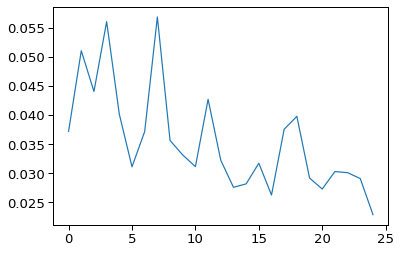

In [43]:
plt.plot(all_losses)

In [44]:
best_idx = np.argmin(all_losses)
best_idx

24

In [45]:
all_cv_scores[best_idx]

{'train_r2': array([0.93827453, 0.96103736, 0.92434685, 0.85257885, 0.8766332 ]),
 'validate_r2': array([0.96245502, 0.95561378, 0.91393516, 0.91071021, 0.97091565]),
 'train_rmsd': array([0.02770004, 0.03508828, 0.03059437, 0.04693677, 0.03282894]),
 'validate_rmsd': array([0.02655531, 0.0327104 , 0.01743878, 0.0151146 , 0.02269157])}

In [46]:
best_emulator = all_emulators[best_idx]
best_emulator

In [47]:
best_emulator.train(retrain=True)

[INFO] >>> Training model on 80% of the dataset, testing on 20%...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)
/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)


[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.187          0.131          0.033          0.096 *
[INFO]             100          0.564          0.080          0.549          0.066 *
[INFO]             200          0.733          0.062          0.635          0.059 *
[INFO]             300          0.765          0.058          0.551          0.066
[INFO]             400          0.874          0.043          0.646          0.058 *
[INFO]             500          0.776          0.057          0.641          0.059
[INFO]             600          0.921          0.034          0.611          0.061
[INFO]             700          0.686          0.068          0.537          0.067
[INFO]             800          0.763          0.059          0.617          0.

[INFO]            8500          0.935          0.031          0.743          0.050
[INFO]            8600          0.939          0.030          0.762          0.048
[INFO]            8700          0.935          0.031          0.822          0.041 *
[INFO]            8800          0.943          0.029          0.672          0.056
[INFO]            8900          0.931          0.032          0.763          0.048
[INFO]            9000          0.930          0.032          0.708          0.053
[INFO]            9100          0.938          0.030          0.746          0.049
[INFO]            9200          0.930          0.032          0.618          0.060
[INFO]            9300          0.933          0.031          0.814          0.042
[INFO]            9400          0.949          0.027          0.676          0.056
[INFO]            9500          0.959          0.024          0.742          0.050
[INFO]            9600          0.934          0.031          0.718          0.052
[I

[INFO]           17400          0.939          0.030          0.706          0.053
[INFO]           17500          0.958          0.025          0.697          0.054
[INFO]           17600          0.954          0.026          0.787          0.045
[INFO]           17700          0.896          0.039          0.687          0.055
[INFO]           17800          0.956          0.025          0.752          0.049
[INFO]           17900          0.966          0.022          0.773          0.047
[INFO]           18000          0.946          0.028          0.737          0.050
[INFO]           18100          0.953          0.026          0.769          0.047
[INFO]           18200          0.957          0.025          0.772          0.047
[INFO]           18300          0.950          0.027          0.760          0.048
[INFO]           18400          0.959          0.025          0.773          0.047
[INFO]           18500          0.957          0.025          0.796          0.044
[INF

[INFO]           26300          0.935          0.031          0.746          0.049
[INFO]           26400          0.938          0.030          0.599          0.062
[INFO]           26500          0.952          0.026          0.729          0.051
[INFO]           26600          0.946          0.028          0.819          0.042
[INFO]           26700          0.962          0.023          0.713          0.052
[INFO]           26800          0.969          0.021          0.712          0.052
[INFO]           26900          0.960          0.024          0.758          0.048
[INFO]           27000          0.927          0.033          0.608          0.061
[INFO]           27100          0.941          0.029          0.718          0.052
[INFO]           27200          0.961          0.024          0.749          0.049
[INFO]           27300          0.942          0.029          0.843          0.039
[INFO]           27400          0.950          0.027          0.791          0.045
[INF

[INFO]           35300          0.962          0.024          0.645          0.058
[INFO]           35400          0.950          0.027          0.555          0.065
[INFO]           35500          0.966          0.022          0.682          0.055
[INFO]           35600          0.930          0.032          0.756          0.048
[INFO]           35700          0.927          0.033          0.690          0.054
[INFO]           35800          0.922          0.034          0.641          0.059
[INFO]           35900          0.961          0.024          0.771          0.047
[INFO] Training completed in 28.98 seconds.
[INFO] ===========================================================================

[INFO] Performance statistics based on transformed data [identity, normalize]:
[INFO] Train R2   Score: 0.9407
[INFO] Test  R2   Score: 0.8575
[INFO] Train RMSD Score: 0.0293
[INFO] Test  RMSD Score: 0.0369

[INFO] Performance statistics based on original data:
[INFO] Train R2   Score: 0.91

{'train_r2': 0.9407139736078802,
 'test_r2': 0.8574806523066281,
 'train_rmsd': 0.029341400463612517,
 'test_rmsd': 0.03688882563765366}

In [48]:
emulator.save('emulator_oer_plate_3860_BayesNeuralNet')

## `oer_plate_4098`

In [50]:
search_space = {
    'batch_size': hp.quniform('batch_size', 10, 50, 10),
    'hidden_act': hp.choice('hidden_act', ['leaky_relu'] ),
    'hidden_depth': hp.quniform('hidden_depth', 2, 5, 1),
    'hidden_nodes': hp.quniform('hidden_nodes', 28, 64, 4),
    'learning_rate': hp.uniform('learning_rate', 1e-5, 5e-3),
    'reg': hp.uniform('reg', 0.001, 0.1)
}

int_params = ['batch_size', 'hidden_depth', 'hidden_nodes']

all_emulators = []
all_losses = []
all_cv_scores = []
all_params = []

def objective(params):
    ''' average performance over cross-validation folds '''
    # build emualtor
    print(f'PARAMS : {params}')
    for param, val in params.items():
        if param in int_params:
            params[param] = int(val)
    model  = BayesNeuralNet(
        **params, out_act='sigmoid', 
    )
    emulator = Emulator(
        dataset='oer_plate_4098', model=model, 
        feature_transform='identity', target_transform='normalize',
    )

    cv_scores = emulator.cross_validate()
    loss = np.mean(cv_scores['validate_rmsd'])
    
    all_losses.append(loss)
    all_cv_scores.append(cv_scores)
    all_params.append(params)
    all_emulators.append(emulator)
    
    return {'loss': loss, 'status': STATUS_OK}

In [51]:
trials = Trials()

best = fmin(
    fn=objective,
    space=search_space, 
    algo=tpe.suggest, 
    max_evals=25,
    trials=trials
)

print(f"BEST VALUE : {best}")

PARAMS : {'batch_size': 10.0, 'hidden_act': 'leaky_relu', 'hidden_depth': 4.0, 'hidden_nodes': 60.0, 'learning_rate': 0.0038633296677462996, 'reg': 0.0980727167046134}         
  0%|                                                                                                                                    | 0/25 [00:00<?, ?trial/s, best loss=?][INFO] >>> Training model on fold #0...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -4.893          0.300         -2.806          0.287 *
[INFO]             100          0.474          0.089          0.241          0.128 *
[INFO]             200          0.746          0.062          0.580          0.095 *
[INFO]             300          0.586          0.079          0.404          0.114
[INFO]             400          0.679          0.070          0.556          0.098
[INFO]             500          0.758          0.061          0.427          0.111
[INFO]             600          0.179          0.112          0.398          0.114
[INFO]             700          0.092          0.118          0.355          0.118
[INFO]             800          0.514          0.086          0.578          0.09

[INFO]            8600          0.710          0.066          0.491          0.105
[INFO]            8700          0.665          0.071          0.677          0.084
[INFO]            8800          0.764          0.060          0.686          0.082
[INFO]            8900          0.659          0.072          0.485          0.106
[INFO]            9000          0.323          0.102          0.402          0.114
[INFO]            9100          0.412          0.095          0.680          0.083
[INFO]            9200          0.474          0.090          0.476          0.106
[INFO]            9300          0.713          0.066          0.666          0.085
[INFO]            9400          0.636          0.074          0.600          0.093
[INFO]            9500          0.736          0.063          0.475          0.107
[INFO]            9600          0.658          0.072          0.596          0.093
[INFO]            9700          0.700          0.068          0.632          0.089
[INF

[INFO]           17600          0.538          0.084          0.349          0.119
[INFO]           17700          0.761          0.060          0.537          0.100
[INFO]           17800          0.600          0.078          0.740          0.075
[INFO] Training completed in 18.27 seconds.
[INFO] ===========================================================================

[INFO] >>> Training model on fold #1...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -6.136          0.259         -1.265          0.159 *
[INFO]             100         -1.006          0.138          0.000          0.106 *
[INFO]             200         -1.839          0.164         -0.014          0.106
[INFO]             300         -1.930          0.166          0.005          0.105 *
[INFO]             400         -0.114          0.103          0.354          0.085 *
[INFO]             500         -0.541          0.121          0.656          0.062 *
[INFO]             600         -0.288          0.110          0.455          0.078
[INFO]             700         -1.119          0.141          0.533          0.072
[INFO]             800         -1.361          0.149          0.380          

[INFO]            8700         -0.335          0.112          0.374          0.084
[INFO]            8800         -0.482          0.118          0.321          0.087
[INFO]            8900         -0.615          0.123          0.320          0.087
[INFO]            9000         -0.888          0.133          0.247          0.092
[INFO]            9100         -1.191          0.144          0.241          0.092
[INFO]            9200          0.063          0.094          0.391          0.082
[INFO]            9300         -0.380          0.114          0.447          0.079
[INFO]            9400         -0.062          0.100          0.569          0.069
[INFO]            9500         -0.025          0.098          0.386          0.083
[INFO]            9600         -0.364          0.113          0.158          0.097
[INFO]            9700         -0.243          0.108          0.325          0.087
[INFO]            9800         -0.972          0.136          0.542          0.072
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.204          0.191         -1.357          0.244 *
[INFO]             100         -0.289          0.146          0.007          0.158 *
[INFO]             200         -0.187          0.140         -0.004          0.159
[INFO]             300         -0.413          0.153         -0.049          0.163
[INFO]             400          0.179          0.117          0.468          0.116 *
[INFO]             500          0.018          0.127          0.433          0.120
[INFO]             600         -0.118          0.136          0.264          0.136
[INFO]             700          0.252          0.111         -0.020          0.160
[INFO]             800         -0.348          0.149          0.619          0.09

[INFO]            8500         -0.190          0.140          0.363          0.127
[INFO]            8600          0.087          0.123          0.225          0.140
[INFO]            8700          0.140          0.119          0.510          0.111
[INFO]            8800          0.215          0.114          0.362          0.127
[INFO]            8900         -0.126          0.136          0.359          0.127
[INFO]            9000         -0.161          0.139          0.332          0.130
[INFO]            9100          0.051          0.125          0.267          0.136
[INFO]            9200          0.159          0.118          0.158          0.146
[INFO]            9300         -0.175          0.139         -0.072          0.164
[INFO]            9400         -0.008          0.129          0.349          0.128
[INFO]            9500          0.228          0.113          0.419          0.121
[INFO]            9600         -0.257          0.144          0.546          0.107
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.445          0.175         -1.389          0.264 *
[INFO]             100         -0.268          0.164         -0.018          0.172 *
[INFO]             200         -0.129          0.154         -0.109          0.180
[INFO]             300         -0.011          0.146         -0.208          0.188
[INFO]             400         -0.128          0.154         -0.073          0.177
[INFO]             500          0.114          0.137          0.327          0.140 *
[INFO]             600          0.328          0.119          0.209          0.152
[INFO]             700         -0.011          0.146          0.192          0.154
[INFO]             800         -0.013          0.146          0.361          0.13

[INFO]            8700          0.080          0.139          0.174          0.155
[INFO]            8800          0.104          0.138          0.113          0.161
[INFO]            8900          0.227          0.128          0.312          0.142
[INFO]            9000          0.175          0.132          0.164          0.156
[INFO]            9100          0.213          0.129          0.318          0.141
[INFO]            9200          0.111          0.137          0.251          0.148
[INFO]            9300         -0.136          0.155          0.251          0.148
[INFO]            9400          0.058          0.141          0.232          0.150
[INFO]            9500          0.339          0.118          0.236          0.149
[INFO]            9600          0.210          0.129          0.390          0.133
[INFO]            9700          0.147          0.134          0.292          0.144
[INFO]            9800          0.260          0.125          0.343          0.138
[INF

[INFO]           17700         -0.077          0.151          0.159          0.157
[INFO]           17800          0.123          0.136          0.335          0.139
[INFO]           17900          0.138          0.135          0.490          0.122
[INFO]           18000          0.316          0.120          0.166          0.156
[INFO]           18100          0.233          0.127          0.359          0.137
[INFO]           18200          0.203          0.130          0.283          0.145
[INFO]           18300          0.337          0.118          0.397          0.133
[INFO]           18400          0.044          0.142          0.329          0.140
[INFO]           18500         -0.300          0.166          0.267          0.146
[INFO]           18600          0.122          0.136          0.192          0.154
[INFO]           18700         -0.134          0.155          0.350          0.138
[INFO]           18800          0.252          0.126          0.420          0.130
[INF

[INFO]           26500          0.076          0.140          0.230          0.150
[INFO]           26600          0.009          0.145          0.463          0.125
[INFO]           26700         -0.053          0.149          0.250          0.148
[INFO]           26800          0.465          0.106          0.254          0.148
[INFO]           26900          0.135          0.135          0.254          0.148
[INFO]           27000          0.223          0.128          0.541          0.116
[INFO]           27100          0.418          0.111          0.369          0.136
[INFO]           27200          0.159          0.133          0.459          0.126
[INFO]           27300         -0.088          0.152          0.188          0.154
[INFO]           27400          0.236          0.127          0.346          0.138
[INFO]           27500         -0.012          0.146          0.168          0.156
[INFO]           27600          0.230          0.127          0.279          0.145
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.694          0.199         -5.451          0.305 *
[INFO]             100         -0.012          0.122         -1.456          0.188 *
[INFO]             200         -0.013          0.122         -0.943          0.167 *
[INFO]             300          0.026          0.119         -1.133          0.175
[INFO]             400         -0.148          0.130         -1.470          0.189
[INFO]             500          0.202          0.108          0.315          0.099 *
[INFO]             600          0.127          0.113         -0.793          0.161
[INFO]             700          0.070          0.117         -0.195          0.131
[INFO]             800          0.322          0.100         -0.712          0.

[INFO]            8600          0.330          0.099         -0.361          0.140
[INFO]            8700          0.288          0.102          0.412          0.092
[INFO]            8800          0.283          0.102          0.129          0.112
[INFO]            8900          0.392          0.094          0.703          0.065 *
[INFO]            9000          0.543          0.082         -0.211          0.132
[INFO]            9100          0.470          0.088          0.149          0.111
[INFO]            9200          0.401          0.094         -0.188          0.131
[INFO]            9300          0.335          0.099          0.263          0.103
[INFO]            9400          0.481          0.087          0.094          0.114
[INFO]            9500          0.469          0.088          0.402          0.093
[INFO]            9600          0.268          0.104         -0.275          0.136
[INFO]            9700          0.561          0.080          0.219          0.106
[I

[INFO]           17500          0.592          0.077         -0.036          0.122
[INFO]           17600          0.426          0.092          0.330          0.098
[INFO]           17700          0.447          0.090          0.148          0.111
[INFO]           17800          0.442          0.090          0.436          0.090
[INFO]           17900          0.442          0.090          0.547          0.081
[INFO]           18000          0.542          0.082         -0.329          0.138
[INFO]           18100          0.341          0.098          0.144          0.111
[INFO]           18200          0.323          0.100          0.059          0.116
[INFO]           18300          0.492          0.086          0.582          0.078
[INFO]           18400          0.463          0.089          0.067          0.116
[INFO]           18500          0.566          0.080          0.206          0.107
[INFO]           18600          0.513          0.084          0.195          0.108
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.146          0.231         -1.958          0.203 *
[INFO]             100          0.209          0.140          0.207          0.105 *
[INFO]             200          0.640          0.095          0.528          0.081 *
[INFO]             300          0.669          0.091          0.554          0.079 *
[INFO]             400          0.692          0.088          0.596          0.075 *
[INFO]             500          0.687          0.088          0.601          0.075 *
[INFO]             600          0.683          0.089          0.609          0.074 *
[INFO]             700          0.699          0.087          0.627          0.072 *
[INFO]             800          0.699          0.087          0.669    

[INFO]            8400          0.766          0.076          0.713          0.063
[INFO]            8500          0.768          0.076          0.731          0.061
[INFO]            8600          0.755          0.078          0.728          0.062
[INFO]            8700          0.774          0.075          0.731          0.061
[INFO]            8800          0.770          0.076          0.735          0.061
[INFO]            8900          0.748          0.079          0.720          0.063
[INFO]            9000          0.756          0.078          0.729          0.062
[INFO]            9100          0.777          0.075          0.746          0.060
[INFO]            9200          0.762          0.077          0.724          0.062
[INFO]            9300          0.757          0.078          0.743          0.060
[INFO]            9400          0.742          0.080          0.728          0.062
[INFO]            9500          0.789          0.073          0.728          0.062
[INF

[INFO]           17200          0.774          0.075          0.734          0.061
[INFO]           17300          0.785          0.073          0.735          0.061
[INFO]           17400          0.784          0.073          0.728          0.062
[INFO]           17500          0.796          0.071          0.746          0.060
[INFO]           17600          0.782          0.074          0.735          0.061
[INFO]           17700          0.787          0.073          0.727          0.062
[INFO]           17800          0.781          0.074          0.730          0.061
[INFO]           17900          0.798          0.071          0.730          0.061
[INFO]           18000          0.792          0.072          0.740          0.060
[INFO]           18100          0.808          0.069          0.738          0.060
[INFO]           18200          0.783          0.073          0.749          0.059
[INFO]           18300          0.779          0.074          0.733          0.061
[INF

[INFO]           26000          0.801          0.070          0.747          0.059
[INFO]           26100          0.799          0.071          0.746          0.060
[INFO]           26200          0.803          0.070          0.753          0.059
[INFO]           26300          0.804          0.070          0.749          0.059
[INFO]           26400          0.808          0.069          0.751          0.059
[INFO]           26500          0.799          0.071          0.751          0.059
[INFO]           26600          0.805          0.070          0.751          0.059
[INFO]           26700          0.801          0.070          0.746          0.060
[INFO]           26800          0.806          0.070          0.742          0.060
[INFO]           26900          0.804          0.070          0.743          0.060
[INFO]           27000          0.816          0.068          0.736          0.061
[INFO]           27100          0.803          0.070          0.760          0.058
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.531          0.253         -1.638          0.255 *
[INFO]             100          0.076          0.153          0.112          0.148 *
[INFO]             200          0.413          0.122          0.686          0.088 *
[INFO]             300          0.436          0.119          0.719          0.083 *
[INFO]             400          0.436          0.119          0.711          0.084
[INFO]             500          0.435          0.119          0.729          0.082 *
[INFO]             600          0.441          0.119          0.751          0.078 *
[INFO]             700          0.452          0.118          0.754          0.078 *
[INFO]             800          0.467          0.116          0.757      

[INFO]            8400          0.551          0.106          0.806          0.069
[INFO]            8500          0.538          0.108          0.808          0.069
[INFO]            8600          0.565          0.105          0.817          0.067
[INFO]            8700          0.570          0.104          0.813          0.068
[INFO]            8800          0.579          0.103          0.811          0.068
[INFO]            8900          0.586          0.102          0.827          0.065 *
[INFO]            9000          0.566          0.105          0.800          0.070
[INFO]            9100          0.578          0.103          0.814          0.068
[INFO]            9200          0.574          0.104          0.825          0.066
[INFO]            9300          0.567          0.105          0.813          0.068
[INFO]            9400          0.572          0.104          0.805          0.069
[INFO]            9500          0.537          0.108          0.786          0.073
[I

[INFO]           17200          0.623          0.098          0.844          0.062
[INFO]           17300          0.610          0.099          0.845          0.062
[INFO]           17400          0.618          0.098          0.841          0.063
[INFO]           17500          0.605          0.100          0.837          0.063
[INFO]           17600          0.610          0.099          0.842          0.062
[INFO]           17700          0.620          0.098          0.839          0.063
[INFO]           17800          0.619          0.098          0.852          0.060 *
[INFO]           17900          0.613          0.099          0.825          0.066
[INFO]           18000          0.611          0.099          0.838          0.063
[INFO]           18100          0.613          0.099          0.840          0.063
[INFO]           18200          0.622          0.098          0.850          0.061
[INFO]           18300          0.609          0.099          0.841          0.063
[I

[INFO]           26000          0.611          0.099          0.839          0.063
[INFO]           26100          0.622          0.098          0.848          0.061
[INFO]           26200          0.608          0.099          0.847          0.062
[INFO]           26300          0.630          0.097          0.845          0.062
[INFO]           26400          0.630          0.097          0.851          0.061
[INFO]           26500          0.628          0.097          0.854          0.060
[INFO]           26600          0.617          0.098          0.852          0.061
[INFO]           26700          0.637          0.096          0.849          0.061
[INFO]           26800          0.619          0.098          0.843          0.062
[INFO]           26900          0.628          0.097          0.850          0.061
[INFO]           27000          0.621          0.098          0.848          0.061
[INFO]           27100          0.628          0.097          0.849          0.061
[INF

[INFO]           34800          0.642          0.095          0.847          0.061
[INFO]           34900          0.622          0.098          0.856          0.060
[INFO]           35000          0.636          0.096          0.855          0.060
[INFO]           35100          0.642          0.095          0.852          0.060
[INFO]           35200          0.635          0.096          0.854          0.060
[INFO]           35300          0.628          0.097          0.849          0.061
[INFO]           35400          0.638          0.096          0.854          0.060
[INFO]           35500          0.642          0.095          0.856          0.060
[INFO]           35600          0.630          0.097          0.852          0.060
[INFO]           35700          0.639          0.095          0.855          0.060
[INFO]           35800          0.634          0.096          0.843          0.062
[INFO]           35900          0.627          0.097          0.846          0.062
[INF

[INFO]           43600          0.641          0.095          0.859          0.059
[INFO]           43700          0.645          0.095          0.855          0.060
[INFO]           43800          0.653          0.094          0.859          0.059
[INFO]           43900          0.650          0.094          0.859          0.059
[INFO]           44000          0.636          0.096          0.850          0.061
[INFO]           44100          0.626          0.097          0.846          0.062
[INFO]           44200          0.647          0.094          0.853          0.060
[INFO]           44300          0.646          0.094          0.860          0.059
[INFO]           44400          0.638          0.096          0.852          0.060
[INFO]           44500          0.647          0.094          0.853          0.060
[INFO]           44600          0.644          0.095          0.853          0.060
[INFO]           44700          0.642          0.095          0.855          0.060
[INF

[INFO]           52400          0.634          0.096          0.855          0.060
[INFO]           52500          0.642          0.095          0.855          0.060
[INFO]           52600          0.650          0.094          0.858          0.059
[INFO]           52700          0.645          0.095          0.853          0.060
[INFO]           52800          0.646          0.094          0.861          0.058
[INFO]           52900          0.654          0.093          0.865          0.058
[INFO]           53000          0.646          0.095          0.855          0.060
[INFO]           53100          0.644          0.095          0.854          0.060
[INFO]           53200          0.649          0.094          0.853          0.060
[INFO]           53300          0.645          0.095          0.846          0.062
[INFO]           53400          0.657          0.093          0.854          0.060
[INFO]           53500          0.648          0.094          0.857          0.059
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.261          0.229         -1.275          0.208 *
[INFO]             100          0.308          0.126          0.305          0.115 *
[INFO]             200          0.598          0.096          0.559          0.091 *
[INFO]             300          0.607          0.095          0.565          0.091 *
[INFO]             400          0.637          0.092          0.560          0.091
[INFO]             500          0.612          0.095          0.538          0.093
[INFO]             600          0.649          0.090          0.589          0.088 *
[INFO]             700          0.651          0.090          0.578          0.089
[INFO]             800          0.678          0.086          0.566          

[INFO]            8400          0.779          0.071          0.573          0.090
[INFO]            8500          0.791          0.070          0.572          0.090
[INFO]            8600          0.780          0.071          0.592          0.088
[INFO]            8700          0.783          0.071          0.590          0.088
[INFO]            8800          0.790          0.070          0.592          0.088
[INFO]            8900          0.788          0.070          0.568          0.090
[INFO]            9000          0.785          0.071          0.573          0.090
[INFO]            9100          0.787          0.070          0.591          0.088
[INFO]            9200          0.777          0.072          0.572          0.090
[INFO]            9300          0.792          0.069          0.592          0.088
[INFO]            9400          0.773          0.072          0.570          0.090
[INFO]            9500          0.781          0.071          0.574          0.090
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.625          0.184         -0.397          0.216 *
[INFO]             100          0.241          0.126          0.290          0.154 *
[INFO]             200          0.476          0.104          0.739          0.093 *
[INFO]             300          0.533          0.098          0.736          0.094
[INFO]             400          0.543          0.097          0.718          0.097
[INFO]             500          0.553          0.096          0.768          0.088 *
[INFO]             600          0.561          0.095          0.746          0.092
[INFO]             700          0.581          0.093          0.764          0.089
[INFO]             800          0.581          0.093          0.747          0.

[INFO]            8400          0.624          0.088          0.790          0.084
[INFO]            8500          0.636          0.087          0.801          0.081
[INFO]            8600          0.620          0.089          0.797          0.082
[INFO]            8700          0.628          0.088          0.795          0.083
[INFO]            8800          0.626          0.088          0.799          0.082
[INFO]            8900          0.641          0.086          0.799          0.082
[INFO]            9000          0.636          0.087          0.814          0.079
[INFO]            9100          0.638          0.087          0.797          0.082
[INFO]            9200          0.619          0.089          0.816          0.078
[INFO]            9300          0.630          0.088          0.804          0.081
[INFO]            9400          0.625          0.088          0.821          0.077
[INFO]            9500          0.637          0.087          0.809          0.080
[INF

[INFO]           17200          0.696          0.079          0.808          0.080
[INFO]           17300          0.694          0.080          0.797          0.082
[INFO]           17400          0.707          0.078          0.798          0.082
[INFO]           17500          0.689          0.080          0.802          0.081
[INFO]           17600          0.699          0.079          0.799          0.082
[INFO]           17700          0.698          0.079          0.797          0.082
[INFO]           17800          0.685          0.081          0.808          0.080
[INFO]           17900          0.684          0.081          0.806          0.080
[INFO]           18000          0.697          0.079          0.808          0.080
[INFO]           18100          0.696          0.079          0.809          0.080
[INFO]           18200          0.708          0.078          0.779          0.086
[INFO]           18300          0.704          0.078          0.801          0.081
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.436          0.263         -1.963          0.271 *
[INFO]             100          0.152          0.155          0.147          0.146 *
[INFO]             200          0.697          0.093          0.597          0.100 *
[INFO]             300          0.684          0.095          0.589          0.101
[INFO]             400          0.685          0.095          0.617          0.098 *
[INFO]             500          0.684          0.095          0.565          0.104
[INFO]             600          0.712          0.090          0.572          0.103
[INFO]             700          0.729          0.088          0.629          0.096 *
[INFO]             800          0.723          0.089          0.634          

[INFO]            8500          0.753          0.084          0.723          0.083
[INFO]            8600          0.753          0.084          0.736          0.081 *
[INFO]            8700          0.756          0.083          0.727          0.082
[INFO]            8800          0.753          0.084          0.720          0.083
[INFO]            8900          0.760          0.082          0.717          0.084
[INFO]            9000          0.761          0.082          0.734          0.081
[INFO]            9100          0.761          0.082          0.719          0.084
[INFO]            9200          0.755          0.083          0.739          0.081 *
[INFO]            9300          0.764          0.082          0.720          0.083
[INFO]            9400          0.761          0.082          0.705          0.086
[INFO]            9500          0.751          0.084          0.713          0.084
[INFO]            9600          0.762          0.082          0.727          0.082


[INFO]           26000          0.781          0.079          0.754          0.078
[INFO]           26100          0.782          0.079          0.748          0.079
[INFO]           26200          0.783          0.079          0.737          0.081
[INFO]           26300          0.779          0.079          0.749          0.079
[INFO]           26400          0.780          0.079          0.745          0.080
[INFO]           26500          0.778          0.079          0.747          0.079
[INFO]           26600          0.782          0.079          0.749          0.079
[INFO]           26700          0.777          0.080          0.740          0.080
[INFO]           26800          0.781          0.079          0.740          0.080
[INFO]           26900          0.781          0.079          0.744          0.080
[INFO]           27000          0.778          0.079          0.735          0.081
[INFO]           27100          0.776          0.080          0.728          0.082
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -3.906          0.269         -2.101          0.243 *
[INFO]             100          0.655          0.071          0.621          0.085 *
[INFO]             200          0.603          0.076          0.632          0.084 *
[INFO]             300          0.690          0.067          0.669          0.080 *
[INFO]             400          0.502          0.086          0.568          0.091
[INFO]             500          0.615          0.075          0.652          0.082
[INFO]             600          0.693          0.067          0.632          0.084
[INFO]             700          0.702          0.066          0.654          0.081
[INFO]             800          0.626          0.074          0.638          0.

[INFO]            8600          0.781          0.057          0.750          0.069
[INFO]            8700          0.778          0.057          0.763          0.067
[INFO]            8800          0.748          0.061          0.744          0.070
[INFO]            8900          0.804          0.054          0.750          0.069
[INFO]            9000          0.757          0.060          0.737          0.071
[INFO]            9100          0.758          0.060          0.774          0.066
[INFO]            9200          0.765          0.059          0.741          0.070
[INFO]            9300          0.750          0.061          0.770          0.066
[INFO]            9400          0.773          0.058          0.774          0.066
[INFO]            9500          0.756          0.060          0.772          0.066
[INFO]            9600          0.770          0.058          0.758          0.068
[INFO]            9700          0.705          0.066          0.761          0.068
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.902          0.197         -0.662          0.222 *
[INFO]             100          0.395          0.111          0.508          0.121 *
[INFO]             200          0.456          0.105          0.615          0.107 *
[INFO]             300          0.445          0.107          0.603          0.108
[INFO]             400          0.501          0.101          0.640          0.103 *
[INFO]             500          0.526          0.098          0.638          0.104
[INFO]             600          0.350          0.115          0.658          0.101 *
[INFO]             700          0.443          0.107          0.638          0.104
[INFO]             800          0.520          0.099          0.666          

[INFO]            8500          0.617          0.088          0.723          0.091
[INFO]            8600          0.617          0.088          0.707          0.093
[INFO]            8700          0.613          0.089          0.720          0.091
[INFO]            8800          0.605          0.090          0.711          0.092
[INFO]            8900          0.599          0.091          0.663          0.100
[INFO]            9000          0.607          0.090          0.694          0.095
[INFO]            9100          0.599          0.091          0.702          0.094
[INFO]            9200          0.585          0.092          0.688          0.096
[INFO]            9300          0.623          0.088          0.715          0.092
[INFO]            9400          0.587          0.092          0.696          0.095
[INFO]            9500          0.608          0.090          0.721          0.091
[INFO]            9600          0.611          0.089          0.730          0.089
[INF

[INFO]           17300          0.605          0.090          0.697          0.095
[INFO]           17400          0.617          0.089          0.703          0.094
[INFO]           17500          0.612          0.089          0.723          0.090
[INFO]           17600          0.587          0.092          0.748          0.086
[INFO]           17700          0.590          0.092          0.741          0.088
[INFO]           17800          0.600          0.090          0.709          0.093
[INFO]           17900          0.600          0.090          0.706          0.093
[INFO]           18000          0.591          0.091          0.735          0.089
[INFO]           18100          0.609          0.089          0.685          0.097
[INFO]           18200          0.600          0.091          0.674          0.098
[INFO]           18300          0.601          0.090          0.730          0.089
[INFO]           18400          0.612          0.089          0.698          0.095
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.302          0.241         -7.563          0.273 *
[INFO]             100          0.605          0.100          0.019          0.092 *
[INFO]             200          0.608          0.099          0.256          0.081 *
[INFO]             300          0.659          0.093          0.292          0.079 *
[INFO]             400          0.680          0.090          0.189          0.084
[INFO]             500          0.655          0.093          0.047          0.091
[INFO]             600          0.568          0.104          0.348          0.075 *
[INFO]             700          0.731          0.082          0.006          0.093
[INFO]             800          0.552          0.106          0.417          

[INFO]            8500          0.790          0.073          0.015          0.093
[INFO]            8600          0.785          0.074          0.142          0.086
[INFO]            8700          0.758          0.078          0.204          0.083
[INFO]            8800          0.775          0.075          0.237          0.082
[INFO]            8900          0.800          0.071          0.202          0.083
[INFO]            9000          0.765          0.077          0.259          0.080
[INFO]            9100          0.771          0.076          0.100          0.089
[INFO]            9200          0.783          0.074          0.273          0.080
[INFO]            9300          0.787          0.073          0.216          0.083
[INFO]            9400          0.776          0.075          0.162          0.085
[INFO]            9500          0.766          0.077          0.335          0.076
[INFO]            9600          0.788          0.073          0.283          0.079
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.389          0.170         -0.095          0.207 *
[INFO]             100          0.524          0.100          0.557          0.132 *
[INFO]             200          0.604          0.091          0.571          0.130 *
[INFO]             300          0.612          0.090          0.552          0.133
[INFO]             400          0.570          0.095          0.595          0.126 *
[INFO]             500          0.579          0.094          0.575          0.129
[INFO]             600          0.622          0.089          0.596          0.126 *
[INFO]             700          0.638          0.087          0.594          0.126
[INFO]             800          0.664          0.084          0.676          

[INFO]            8400          0.658          0.084          0.765          0.096
[INFO]            8500          0.696          0.080          0.760          0.097
[INFO]            8600          0.662          0.084          0.802          0.088 *
[INFO]            8700          0.692          0.080          0.805          0.088 *
[INFO]            8800          0.638          0.087          0.768          0.096
[INFO]            8900          0.632          0.088          0.781          0.093
[INFO]            9000          0.705          0.078          0.781          0.093
[INFO]            9100          0.658          0.084          0.788          0.091
[INFO]            9200          0.668          0.083          0.803          0.088
[INFO]            9300          0.636          0.087          0.804          0.088
[INFO]            9400          0.681          0.082          0.769          0.095
[INFO]            9500          0.674          0.082          0.781          0.093


[INFO]           17300          0.698          0.079          0.807          0.087
[INFO]           17400          0.704          0.079          0.807          0.087
[INFO]           17500          0.716          0.077          0.798          0.089
[INFO]           17600          0.709          0.078          0.802          0.088
[INFO]           17700          0.700          0.079          0.792          0.091
[INFO]           17800          0.733          0.075          0.800          0.089
[INFO]           17900          0.711          0.078          0.823          0.083
[INFO]           18000          0.703          0.079          0.802          0.088
[INFO]           18100          0.739          0.074          0.795          0.090
[INFO]           18200          0.695          0.080          0.804          0.088
[INFO]           18300          0.707          0.078          0.790          0.091
[INFO]           18400          0.697          0.079          0.786          0.092
[INF

[INFO]           26300          0.732          0.075          0.836          0.080 *
[INFO]           26400          0.690          0.080          0.822          0.084
[INFO]           26500          0.691          0.080          0.809          0.087
[INFO]           26600          0.708          0.078          0.809          0.087
[INFO]           26700          0.697          0.079          0.807          0.087
[INFO]           26800          0.714          0.077          0.831          0.082
[INFO]           26900          0.653          0.085          0.796          0.090
[INFO]           27000          0.703          0.079          0.818          0.085
[INFO]           27100          0.703          0.079          0.818          0.085
[INFO]           27200          0.715          0.077          0.808          0.087
[INFO]           27300          0.718          0.077          0.801          0.089
[INFO]           27400          0.705          0.078          0.815          0.085
[I

[INFO]           35100          0.704          0.079          0.820          0.084
[INFO]           35200          0.651          0.085          0.818          0.085
[INFO]           35300          0.726          0.076          0.808          0.087
[INFO]           35400          0.697          0.080          0.804          0.088
[INFO]           35500          0.679          0.082          0.805          0.088
[INFO]           35600          0.699          0.079          0.761          0.097
[INFO]           35700          0.689          0.081          0.793          0.090
[INFO]           35800          0.704          0.079          0.818          0.085
[INFO]           35900          0.712          0.077          0.821          0.084
[INFO]           36000          0.679          0.082          0.840          0.079
[INFO]           36100          0.699          0.079          0.821          0.084
[INFO]           36200          0.702          0.079          0.826          0.083
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.648          0.184         -1.379          0.169 *
[INFO]             100          0.544          0.097          0.374          0.087 *
[INFO]             200          0.305          0.120          0.546          0.074 *
[INFO]             300          0.563          0.095          0.664          0.064 *
[INFO]             400          0.607          0.090          0.643          0.065
[INFO]             500          0.491          0.102          0.681          0.062 *
[INFO]             600          0.396          0.111          0.641          0.066
[INFO]             700          0.539          0.097          0.688          0.061 *
[INFO]             800          0.583          0.093          0.689        

[INFO]            8400          0.597          0.091          0.747          0.055
[INFO]            8500          0.646          0.085          0.781          0.051
[INFO]            8600          0.606          0.090          0.790          0.050
[INFO]            8700          0.550          0.096          0.744          0.056
[INFO]            8800          0.615          0.089          0.758          0.054
[INFO]            8900          0.649          0.085          0.772          0.052
[INFO]            9000          0.623          0.088          0.716          0.058
[INFO]            9100          0.648          0.085          0.751          0.055
[INFO]            9200          0.670          0.082          0.759          0.054
[INFO]            9300          0.673          0.082          0.748          0.055
[INFO]            9400          0.584          0.092          0.722          0.058
[INFO]            9500          0.616          0.089          0.752          0.055
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.262          0.242         -0.406          0.208 *
[INFO]             100          0.696          0.089          0.543          0.119 *
[INFO]             200          0.631          0.098          0.684          0.099 *
[INFO]             300          0.722          0.085          0.677          0.100
[INFO]             400          0.773          0.077          0.672          0.101
[INFO]             500          0.775          0.076          0.640          0.105
[INFO]             600          0.777          0.076          0.668          0.101
[INFO]             700          0.785          0.075          0.678          0.100
[INFO]             800          0.773          0.077          0.683          0.09

[INFO]            8500          0.827          0.067          0.739          0.090
[INFO]            8600          0.838          0.065          0.678          0.100
[INFO]            8700          0.831          0.066          0.715          0.094
[INFO]            8800          0.828          0.067          0.708          0.095
[INFO]            8900          0.812          0.070          0.720          0.093
[INFO]            9000          0.839          0.065          0.733          0.091
[INFO]            9100          0.825          0.067          0.711          0.094
[INFO]            9200          0.839          0.065          0.705          0.095
[INFO]            9300          0.829          0.067          0.708          0.095
[INFO]            9400          0.833          0.066          0.712          0.094
[INFO]            9500          0.806          0.071          0.731          0.091
[INFO]            9600          0.822          0.068          0.721          0.093
[INF

[INFO]           17300          0.862          0.060          0.680          0.099
[INFO]           17400          0.866          0.059          0.726          0.092
[INFO]           17500          0.875          0.057          0.732          0.091
[INFO]           17600          0.849          0.062          0.714          0.094
[INFO]           17700          0.842          0.064          0.710          0.095
[INFO]           17800          0.869          0.058          0.712          0.094
[INFO]           17900          0.874          0.057          0.687          0.098
[INFO]           18000          0.886          0.054          0.740          0.090
[INFO]           18100          0.888          0.054          0.720          0.093
[INFO]           18200          0.879          0.056          0.685          0.099
[INFO]           18300          0.869          0.058          0.703          0.096
[INFO]           18400          0.867          0.059          0.704          0.096
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.104          0.201         -0.246          0.228 *
[INFO]             100          0.617          0.119          0.543          0.138 *
[INFO]             200          0.664          0.111          0.598          0.130 *
[INFO]             300          0.623          0.118          0.601          0.129 *
[INFO]             400          0.686          0.107          0.602          0.129 *
[INFO]             500          0.559          0.127          0.548          0.137
[INFO]             600          0.637          0.115          0.622          0.126 *
[INFO]             700          0.647          0.114          0.604          0.129
[INFO]             800          0.675          0.109          0.622        

[INFO]            8400          0.739          0.098          0.570          0.134
[INFO]            8500          0.764          0.093          0.609          0.128
[INFO]            8600          0.725          0.100          0.598          0.129
[INFO]            8700          0.713          0.103          0.557          0.136
[INFO]            8800          0.714          0.103          0.563          0.135
[INFO]            8900          0.705          0.104          0.573          0.133
[INFO]            9000          0.733          0.099          0.592          0.130
[INFO]            9100          0.760          0.094          0.599          0.129
[INFO]            9200          0.712          0.103          0.569          0.134
[INFO]            9300          0.758          0.094          0.594          0.130
[INFO]            9400          0.757          0.094          0.601          0.129
[INFO]            9500          0.669          0.110          0.574          0.133
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.940          0.237         -2.126          0.208 *
[INFO]             100          0.712          0.091          0.383          0.092 *
[INFO]             200          0.786          0.079          0.478          0.085 *
[INFO]             300          0.805          0.075          0.488          0.084 *
[INFO]             400          0.767          0.082          0.553          0.079 *
[INFO]             500          0.792          0.078          0.485          0.084
[INFO]             600          0.818          0.073          0.504          0.083
[INFO]             700          0.817          0.073          0.546          0.079
[INFO]             800          0.834          0.069          0.435          

[INFO]            8400          0.873          0.061          0.626          0.072
[INFO]            8500          0.868          0.062          0.708          0.063
[INFO]            8600          0.885          0.058          0.674          0.067
[INFO]            8700          0.859          0.064          0.668          0.068
[INFO]            8800          0.865          0.063          0.703          0.064
[INFO]            8900          0.879          0.059          0.648          0.070
[INFO]            9000          0.875          0.060          0.692          0.065
[INFO]            9100          0.840          0.068          0.622          0.072
[INFO]            9200          0.878          0.059          0.684          0.066
[INFO]            9300          0.861          0.064          0.690          0.065
[INFO]            9400          0.873          0.061          0.678          0.067
[INFO]            9500          0.889          0.057          0.652          0.069
[INF

[INFO] >>> Training model on fold #3...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.888          0.195         -1.013          0.210 *
[INFO]             100          0.685          0.080          0.539          0.101 *
[INFO]             200          0.675          0.081          0.663          0.086 *
[INFO]             300          0.649          0.084          0.699          0.081 *
[INFO]             400          0.709          0.077          0.672          0.085
[INFO]             500          0.704          0.077          0.641          0.089
[INFO]             600          0.707          0.077          0.752          0.074 *
[INFO]             700          0.633          0.086          0.500          0.105
[INFO]             800          0.715          0.076          0.707          

[INFO]            8700          0.809          0.062          0.737          0.076
[INFO]            8800          0.800          0.064          0.684          0.083
[INFO]            8900          0.743          0.072          0.684          0.083
[INFO]            9000          0.778          0.067          0.643          0.089
[INFO]            9100          0.813          0.062          0.681          0.084
[INFO]            9200          0.768          0.068          0.676          0.084
[INFO]            9300          0.825          0.060          0.738          0.076
[INFO]            9400          0.817          0.061          0.664          0.086
[INFO]            9500          0.796          0.064          0.636          0.089
[INFO]            9600          0.808          0.062          0.732          0.077
[INFO]            9700          0.810          0.062          0.706          0.080
[INFO]            9800          0.814          0.061          0.706          0.080
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.565          0.187         -0.415          0.194 *
[INFO]             100          0.603          0.094          0.642          0.098 *
[INFO]             200          0.609          0.093          0.655          0.096 *
[INFO]             300          0.624          0.092          0.639          0.098
[INFO]             400          0.605          0.094          0.650          0.097
[INFO]             500          0.657          0.088          0.678          0.093 *
[INFO]             600          0.617          0.092          0.692          0.091 *
[INFO]             700          0.633          0.091          0.675          0.093
[INFO]             800          0.631          0.091          0.662          

[INFO]            8500          0.667          0.086          0.646          0.097
[INFO]            8600          0.666          0.086          0.655          0.096
[INFO]            8700          0.703          0.081          0.655          0.096
[INFO]            8800          0.691          0.083          0.677          0.093
[INFO]            8900          0.672          0.086          0.658          0.095
[INFO]            9000          0.686          0.084          0.665          0.095
[INFO]            9100          0.691          0.083          0.671          0.094
[INFO]            9200          0.671          0.086          0.654          0.096
[INFO]            9300          0.716          0.080          0.651          0.097
[INFO]            9400          0.690          0.083          0.670          0.094
[INFO]            9500          0.696          0.082          0.660          0.095
[INFO]            9600          0.682          0.084          0.660          0.095
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.042          0.193         -1.057          0.147 *
[INFO]             100          0.545          0.091          0.103          0.097 *
[INFO]             200          0.631          0.082          0.380          0.081 *
[INFO]             300          0.635          0.082          0.447          0.076 *
[INFO]             400          0.661          0.079          0.559          0.068 *
[INFO]             500          0.632          0.082          0.312          0.085
[INFO]             600          0.684          0.076          0.470          0.075
[INFO]             700          0.755          0.067          0.555          0.068
[INFO]             800          0.698          0.074          0.449          

[INFO]            8500          0.849          0.053          0.634          0.062
[INFO]            8600          0.867          0.049          0.576          0.067
[INFO]            8700          0.825          0.057          0.554          0.068
[INFO]            8800          0.858          0.051          0.580          0.066
[INFO]            8900          0.865          0.050          0.599          0.065
[INFO]            9000          0.863          0.050          0.602          0.065
[INFO]            9100          0.857          0.051          0.582          0.066
[INFO]            9200          0.858          0.051          0.651          0.060
[INFO]            9300          0.855          0.051          0.622          0.063
[INFO]            9400          0.854          0.052          0.596          0.065
[INFO]            9500          0.842          0.054          0.588          0.066
[INFO]            9600          0.844          0.053          0.557          0.068
[INF

[INFO]           17300          0.869          0.049          0.650          0.061
[INFO]           17400          0.862          0.050          0.666          0.059
[INFO]           17500          0.832          0.055          0.625          0.063
[INFO]           17600          0.857          0.051          0.646          0.061
[INFO]           17700          0.853          0.052          0.646          0.061
[INFO]           17800          0.836          0.055          0.597          0.065
[INFO]           17900          0.838          0.054          0.608          0.064
[INFO]           18000          0.867          0.049          0.635          0.062
[INFO]           18100          0.854          0.052          0.669          0.059
[INFO]           18200          0.869          0.049          0.589          0.066
[INFO]           18300          0.873          0.048          0.610          0.064
[INFO]           18400          0.847          0.053          0.688          0.057
[INF

[INFO]           26300          0.839          0.054          0.572          0.067
[INFO] Training completed in 21.22 seconds.
[INFO] ===========================================================================

[INFO] >>> Training model on fold #1...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.357          0.236         -2.677          0.226 *
[INFO]             100          0.576          0.132         -0.113          0.124 *
[INFO]             200          0.650          0.120          0.533          0.081 *
[INFO]             300          0.658          0.118          0.656          0.069 *
[INFO]             400          0.669          0.116          0.379          0.093
[INFO]             500          0.697          0.111          0.635          0.071
[INFO]             600          0.716          0.108          0.560          0.078
[INFO]             700          0.668          0.117          0.638          0.071
[INFO]             800          0.709          0.109          0.583          0.

[INFO]            8600          0.760          0.099          0.471          0.086
[INFO]            8700          0.758          0.100          0.572          0.077
[INFO]            8800          0.762          0.099          0.519          0.082
[INFO]            8900          0.754          0.100          0.513          0.082
[INFO]            9000          0.747          0.102          0.545          0.079
[INFO]            9100          0.765          0.098          0.542          0.080
[INFO]            9200          0.751          0.101          0.557          0.078
[INFO]            9300          0.756          0.100          0.495          0.084
[INFO]            9400          0.739          0.103          0.559          0.078
[INFO]            9500          0.763          0.098          0.410          0.091
[INFO]            9600          0.747          0.102          0.527          0.081
[INFO]            9700          0.742          0.103          0.478          0.085
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.960          0.258         -4.062          0.284 *
[INFO]             100          0.674          0.105          0.153          0.116 *
[INFO]             200          0.668          0.106          0.237          0.110 *
[INFO]             300          0.724          0.097          0.351          0.102 *
[INFO]             400          0.736          0.095          0.356          0.101 *
[INFO]             500          0.730          0.096          0.334          0.103
[INFO]             600          0.741          0.094          0.444          0.094 *
[INFO]             700          0.784          0.086          0.477          0.091 *
[INFO]             800          0.792          0.084          0.381      

[INFO]            8600          0.832          0.076          0.441          0.094
[INFO]            8700          0.814          0.080          0.523          0.087
[INFO]            8800          0.842          0.073          0.379          0.099
[INFO]            8900          0.838          0.074          0.406          0.097
[INFO]            9000          0.830          0.076          0.417          0.096
[INFO]            9100          0.817          0.079          0.493          0.090
[INFO]            9200          0.833          0.075          0.421          0.096
[INFO]            9300          0.848          0.072          0.380          0.099
[INFO]            9400          0.865          0.068          0.365          0.101
[INFO]            9500          0.843          0.073          0.447          0.094
[INFO]            9600          0.841          0.074          0.433          0.095
[INFO]            9700          0.829          0.076          0.459          0.093
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.366          0.160         -0.025          0.189 *
[INFO]             100          0.538          0.093          0.475          0.135 *
[INFO]             200          0.687          0.077          0.495          0.133 *
[INFO]             300          0.647          0.081          0.431          0.141
[INFO]             400          0.676          0.078          0.528          0.129 *
[INFO]             500          0.501          0.097          0.586          0.120 *
[INFO]             600          0.800          0.061          0.549          0.126
[INFO]             700          0.742          0.070          0.582          0.121
[INFO]             800          0.646          0.082          0.504          

[INFO]            8600          0.731          0.071          0.583          0.121
[INFO]            8700          0.763          0.067          0.509          0.131
[INFO]            8800          0.729          0.071          0.607          0.117
[INFO]            8900          0.784          0.064          0.597          0.119
[INFO]            9000          0.588          0.088          0.609          0.117
[INFO]            9100          0.734          0.071          0.559          0.124
[INFO]            9200          0.748          0.069          0.559          0.124
[INFO]            9300          0.781          0.064          0.576          0.122
[INFO]            9400          0.766          0.066          0.543          0.126
[INFO]            9500          0.782          0.064          0.575          0.122
[INFO]            9600          0.646          0.082          0.596          0.119
[INFO]            9700          0.784          0.064          0.550          0.125
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.985          0.246         -1.247          0.226 *
[INFO]             100          0.552          0.117          0.766          0.073 *
[INFO]             200          0.606          0.109          0.790          0.069 *
[INFO]             300          0.630          0.106          0.753          0.075
[INFO]             400          0.670          0.100          0.737          0.077
[INFO]             500          0.702          0.095          0.682          0.085
[INFO]             600          0.678          0.099          0.787          0.069
[INFO]             700          0.675          0.099          0.710          0.081
[INFO]             800          0.735          0.090          0.705          0.08

[INFO]            8600          0.747          0.088          0.839          0.060
[INFO]            8700          0.775          0.083          0.769          0.072
[INFO]            8800          0.771          0.084          0.833          0.062
[INFO]            8900          0.759          0.086          0.822          0.064
[INFO]            9000          0.792          0.080          0.804          0.067
[INFO]            9100          0.769          0.084          0.828          0.062
[INFO]            9200          0.751          0.087          0.804          0.067
[INFO]            9300          0.765          0.085          0.833          0.061
[INFO]            9400          0.779          0.082          0.811          0.066
[INFO]            9500          0.759          0.086          0.813          0.065
[INFO]            9600          0.790          0.080          0.816          0.065
[INFO]            9700          0.725          0.091          0.849          0.059 *
[I

[INFO]           17500          0.760          0.085          0.840          0.060
[INFO]           17600          0.794          0.079          0.825          0.063
[INFO]           17700          0.803          0.077          0.846          0.059
[INFO]           17800          0.822          0.074          0.842          0.060
[INFO]           17900          0.794          0.079          0.826          0.063
[INFO]           18000          0.759          0.086          0.821          0.064
[INFO]           18100          0.790          0.080          0.821          0.064
[INFO]           18200          0.780          0.082          0.837          0.061
[INFO]           18300          0.800          0.078          0.852          0.058
[INFO]           18400          0.794          0.079          0.835          0.061
[INFO]           18500          0.824          0.073          0.783          0.070
[INFO]           18600          0.842          0.069          0.815          0.065
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.117          0.214         -0.124          0.186 *
[INFO]             100         -0.095          0.212         -0.103          0.184 *
[INFO]             200         -0.082          0.211         -0.083          0.183 *
[INFO]             300         -0.066          0.209         -0.060          0.181 *
[INFO]             400         -0.052          0.208         -0.047          0.180 *
[INFO]             500         -0.040          0.207         -0.034          0.178 *
[INFO]             600         -0.030          0.206         -0.020          0.177 *
[INFO]             700         -0.010          0.204         -0.005          0.176 *
[INFO]             800          0.002          0.202          0.007    

[INFO]            8400          0.658          0.118          0.498          0.124
[INFO]            8500          0.666          0.117          0.510          0.123
[INFO]            8600          0.674          0.116          0.498          0.124
[INFO]            8700          0.653          0.119          0.493          0.125
[INFO]            8800          0.667          0.117          0.513          0.122 *
[INFO]            8900          0.676          0.115          0.488          0.126
[INFO]            9000          0.662          0.118          0.509          0.123
[INFO]            9100          0.662          0.118          0.505          0.123
[INFO]            9200          0.663          0.118          0.507          0.123
[INFO]            9300          0.675          0.116          0.498          0.124
[INFO]            9400          0.659          0.118          0.503          0.124
[INFO]            9500          0.661          0.118          0.497          0.124
[I

[INFO]           17300          0.686          0.113          0.534          0.120
[INFO]           17400          0.701          0.111          0.543          0.119
[INFO]           17500          0.686          0.114          0.549          0.118
[INFO]           17600          0.680          0.115          0.524          0.121
[INFO]           17700          0.700          0.111          0.540          0.119
[INFO]           17800          0.701          0.111          0.549          0.118
[INFO]           17900          0.704          0.110          0.543          0.119
[INFO]           18000          0.688          0.113          0.555          0.117
[INFO]           18100          0.703          0.110          0.555          0.117
[INFO]           18200          0.705          0.110          0.541          0.119
[INFO]           18300          0.714          0.108          0.544          0.118
[INFO]           18400          0.692          0.112          0.572          0.115 *
[I

[INFO]           26300          0.710          0.109          0.578          0.114
[INFO]           26400          0.721          0.107          0.570          0.115
[INFO]           26500          0.726          0.106          0.576          0.114
[INFO]           26600          0.710          0.109          0.587          0.113
[INFO]           26700          0.720          0.107          0.560          0.116
[INFO]           26800          0.710          0.109          0.565          0.116
[INFO]           26900          0.732          0.105          0.587          0.113
[INFO]           27000          0.714          0.108          0.569          0.115
[INFO]           27100          0.732          0.105          0.585          0.113
[INFO]           27200          0.714          0.108          0.582          0.113
[INFO]           27300          0.717          0.108          0.569          0.115
[INFO]           27400          0.727          0.106          0.554          0.117
[INF

[INFO]           35300          0.707          0.110          0.597          0.111
[INFO]           35400          0.731          0.105          0.587          0.113
[INFO]           35500          0.732          0.105          0.584          0.113
[INFO]           35600          0.737          0.104          0.606          0.110
[INFO]           35700          0.722          0.107          0.589          0.112
[INFO]           35800          0.722          0.107          0.596          0.111
[INFO]           35900          0.741          0.103          0.573          0.115
[INFO]           36000          0.719          0.107          0.586          0.113
[INFO]           36100          0.707          0.110          0.591          0.112
[INFO]           36200          0.727          0.106          0.588          0.113
[INFO]           36300          0.719          0.107          0.589          0.113
[INFO]           36400          0.730          0.105          0.572          0.115
[INF

[INFO]           44100          0.740          0.103          0.606          0.110
[INFO]           44200          0.714          0.108          0.569          0.115
[INFO]           44300          0.734          0.104          0.584          0.113
[INFO]           44400          0.743          0.103          0.567          0.115
[INFO]           44500          0.750          0.101          0.592          0.112
[INFO]           44600          0.731          0.105          0.587          0.113
[INFO]           44700          0.738          0.104          0.582          0.113
[INFO]           44800          0.739          0.104          0.597          0.111
[INFO]           44900          0.732          0.105          0.574          0.114
[INFO]           45000          0.736          0.104          0.570          0.115
[INFO]           45100          0.732          0.105          0.590          0.112
[INFO]           45200          0.743          0.103          0.589          0.112
[INF

[INFO]           53000          0.736          0.104          0.577          0.114
[INFO]           53100          0.746          0.102          0.599          0.111
[INFO]           53200          0.746          0.102          0.558          0.117
[INFO]           53300          0.750          0.101          0.596          0.111
[INFO]           53400          0.740          0.103          0.566          0.116
[INFO]           53500          0.737          0.104          0.589          0.113
[INFO]           53600          0.742          0.103          0.600          0.111
[INFO]           53700          0.738          0.104          0.587          0.113
[INFO]           53800          0.732          0.105          0.575          0.114
[INFO]           53900          0.741          0.103          0.585          0.113
[INFO]           54000          0.729          0.106          0.577          0.114
[INFO]           54100          0.755          0.100          0.588          0.113
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -2.195          0.231         -1.366          0.238 *
[INFO]             100         -2.039          0.226         -1.267          0.233 *
[INFO]             200         -1.897          0.220         -1.164          0.227 *
[INFO]             300         -1.747          0.215         -1.064          0.222 *
[INFO]             400         -1.582          0.208         -0.966          0.217 *
[INFO]             500         -1.435          0.202         -0.868          0.211 *
[INFO]             600         -1.230          0.193         -0.756          0.205 *
[INFO]             700         -1.080          0.187         -0.637          0.198 *
[INFO]             800         -0.890          0.178         -0.511    

[INFO]            8500          0.600          0.082          0.591          0.099
[INFO]            8600          0.601          0.082          0.590          0.099
[INFO]            8700          0.591          0.083          0.589          0.099
[INFO]            8800          0.600          0.082          0.589          0.099
[INFO]            8900          0.606          0.081          0.585          0.100
[INFO]            9000          0.580          0.084          0.578          0.100
[INFO]            9100          0.611          0.081          0.584          0.100
[INFO]            9200          0.610          0.081          0.569          0.101
[INFO]            9300          0.607          0.081          0.568          0.101
[INFO]            9400          0.593          0.083          0.578          0.100
[INFO]            9500          0.602          0.082          0.579          0.100
[INFO]            9600          0.597          0.082          0.581          0.100
[INF

[INFO]           17400          0.631          0.079          0.591          0.099
[INFO]           17500          0.657          0.076          0.588          0.099
[INFO]           17600          0.638          0.078          0.574          0.101
[INFO]           17700          0.668          0.075          0.600          0.098
[INFO]           17800          0.647          0.077          0.616          0.096 *
[INFO]           17900          0.632          0.078          0.578          0.100
[INFO]           18000          0.656          0.076          0.608          0.097
[INFO]           18100          0.633          0.078          0.595          0.098
[INFO]           18200          0.656          0.076          0.605          0.097
[INFO]           18300          0.666          0.075          0.607          0.097
[INFO]           18400          0.667          0.075          0.599          0.098
[INFO]           18500          0.641          0.078          0.602          0.097
[I

[INFO]           26200          0.675          0.074          0.602          0.097
[INFO]           26300          0.662          0.075          0.607          0.097
[INFO]           26400          0.703          0.071          0.603          0.097
[INFO]           26500          0.675          0.074          0.615          0.096
[INFO]           26600          0.665          0.075          0.625          0.095
[INFO]           26700          0.676          0.074          0.629          0.094
[INFO]           26800          0.676          0.074          0.600          0.098
[INFO]           26900          0.668          0.075          0.598          0.098
[INFO]           27000          0.661          0.075          0.622          0.095
[INFO]           27100          0.676          0.074          0.624          0.095
[INFO]           27200          0.692          0.072          0.637          0.093
[INFO]           27300          0.669          0.074          0.617          0.096
[INF

[INFO]           35100          0.704          0.070          0.644          0.092
[INFO]           35200          0.694          0.072          0.628          0.094
[INFO]           35300          0.726          0.068          0.611          0.096
[INFO]           35400          0.692          0.072          0.603          0.097
[INFO]           35500          0.701          0.071          0.624          0.095
[INFO]           35600          0.700          0.071          0.615          0.096
[INFO]           35700          0.700          0.071          0.646          0.092
[INFO]           35800          0.703          0.071          0.642          0.092
[INFO]           35900          0.719          0.069          0.647          0.092
[INFO]           36000          0.716          0.069          0.608          0.097
[INFO]           36100          0.711          0.070          0.614          0.096
[INFO]           36200          0.726          0.068          0.594          0.098
[INF

[INFO]           43900          0.701          0.071          0.599          0.098
[INFO]           44000          0.700          0.071          0.604          0.097
[INFO]           44100          0.714          0.069          0.590          0.099
[INFO]           44200          0.705          0.070          0.617          0.096
[INFO]           44300          0.689          0.072          0.658          0.090
[INFO]           44400          0.738          0.066          0.628          0.094
[INFO]           44500          0.703          0.071          0.625          0.095
[INFO]           44600          0.709          0.070          0.588          0.099
[INFO]           44700          0.715          0.069          0.642          0.092
[INFO]           44800          0.704          0.070          0.633          0.094
[INFO]           44900          0.720          0.069          0.627          0.094
[INFO]           45000          0.709          0.070          0.635          0.093
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.074          0.242         -1.525          0.233 *
[INFO]             100         -1.016          0.239         -1.432          0.228 *
[INFO]             200         -0.945          0.234         -1.350          0.224 *
[INFO]             300         -0.873          0.230         -1.254          0.220 *
[INFO]             400         -0.802          0.226         -1.134          0.214 *
[INFO]             500         -0.707          0.220         -1.003          0.207 *
[INFO]             600         -0.608          0.213         -0.868          0.200 *
[INFO]             700         -0.510          0.207         -0.725          0.192 *
[INFO]             800         -0.383          0.198         -0.561    

[INFO]            8500          0.594          0.107          0.667          0.084
[INFO]            8600          0.578          0.109          0.663          0.085
[INFO]            8700          0.596          0.107          0.680          0.083
[INFO]            8800          0.605          0.106          0.672          0.084
[INFO]            8900          0.598          0.107          0.650          0.087
[INFO]            9000          0.591          0.107          0.638          0.088
[INFO]            9100          0.612          0.105          0.656          0.086
[INFO]            9200          0.606          0.106          0.666          0.085
[INFO]            9300          0.585          0.108          0.667          0.084
[INFO]            9400          0.592          0.107          0.674          0.084
[INFO]            9500          0.598          0.107          0.662          0.085
[INFO]            9600          0.592          0.107          0.677          0.083
[INF

[INFO]           17500          0.622          0.103          0.657          0.086
[INFO]           17600          0.628          0.102          0.661          0.085
[INFO]           17700          0.626          0.103          0.684          0.082
[INFO]           17800          0.610          0.105          0.675          0.083
[INFO]           17900          0.633          0.102          0.676          0.083
[INFO]           18000          0.639          0.101          0.666          0.085
[INFO]           18100          0.646          0.100          0.676          0.083
[INFO]           18200          0.642          0.101          0.666          0.085
[INFO]           18300          0.620          0.104          0.658          0.086
[INFO]           18400          0.655          0.099          0.678          0.083
[INFO]           18500          0.620          0.104          0.657          0.086
[INFO]           18600          0.646          0.100          0.681          0.083
[INF

[INFO]           26400          0.649          0.100          0.717          0.078 *
[INFO]           26500          0.651          0.099          0.692          0.081
[INFO]           26600          0.658          0.098          0.675          0.083
[INFO]           26700          0.655          0.099          0.695          0.081
[INFO]           26800          0.636          0.101          0.678          0.083
[INFO]           26900          0.655          0.099          0.659          0.085
[INFO]           27000          0.660          0.098          0.683          0.082
[INFO]           27100          0.675          0.096          0.679          0.083
[INFO]           27200          0.651          0.099          0.687          0.082
[INFO]           27300          0.643          0.101          0.687          0.082
[INFO]           27400          0.654          0.099          0.689          0.082
[INFO]           27500          0.640          0.101          0.685          0.082
[I

[INFO]           35400          0.677          0.096          0.699          0.080
[INFO]           35500          0.673          0.096          0.689          0.082
[INFO]           35600          0.657          0.098          0.687          0.082
[INFO]           35700          0.658          0.098          0.703          0.080
[INFO]           35800          0.682          0.095          0.684          0.082
[INFO]           35900          0.668          0.097          0.694          0.081
[INFO]           36000          0.663          0.098          0.690          0.081
[INFO]           36100          0.654          0.099          0.697          0.081
[INFO]           36200          0.687          0.094          0.663          0.085
[INFO]           36300          0.673          0.096          0.715          0.078
[INFO]           36400          0.661          0.098          0.659          0.085
[INFO]           36500          0.680          0.095          0.685          0.082
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.641          0.244         -2.990          0.258 *
[INFO]             100         -1.532          0.239         -2.827          0.253 *
[INFO]             200         -1.427          0.234         -2.656          0.247 *
[INFO]             300         -1.316          0.228         -2.484          0.241 *
[INFO]             400         -1.172          0.221         -2.235          0.233 *
[INFO]             500         -1.029          0.214         -2.003          0.224 *
[INFO]             600         -0.850          0.204         -1.722          0.213 *
[INFO]             700         -0.681          0.194         -1.464          0.203 *
[INFO]             800         -0.541          0.186         -1.188    

[INFO]            8400          0.684          0.084          0.612          0.081
[INFO]            8500          0.675          0.086          0.589          0.083
[INFO]            8600          0.678          0.085          0.611          0.081
[INFO]            8700          0.683          0.084          0.587          0.083
[INFO]            8800          0.699          0.082          0.569          0.085
[INFO]            8900          0.662          0.087          0.595          0.082
[INFO]            9000          0.678          0.085          0.599          0.082
[INFO]            9100          0.693          0.083          0.608          0.081
[INFO]            9200          0.690          0.084          0.600          0.082
[INFO]            9300          0.678          0.085          0.612          0.081
[INFO]            9400          0.696          0.083          0.629          0.079 *
[INFO]            9500          0.669          0.086          0.605          0.081
[I

[INFO]           17200          0.703          0.082          0.620          0.080
[INFO]           17300          0.691          0.083          0.624          0.079
[INFO]           17400          0.688          0.084          0.622          0.079
[INFO]           17500          0.695          0.083          0.607          0.081
[INFO]           17600          0.674          0.086          0.621          0.080
[INFO]           17700          0.694          0.083          0.615          0.080
[INFO]           17800          0.698          0.082          0.614          0.080
[INFO]           17900          0.699          0.082          0.624          0.079
[INFO]           18000          0.692          0.083          0.616          0.080
[INFO]           18100          0.701          0.082          0.636          0.078
[INFO]           18200          0.676          0.085          0.604          0.081
[INFO]           18300          0.703          0.082          0.634          0.078
[INF

[INFO]           26200          0.710          0.081          0.662          0.075
[INFO]           26300          0.716          0.080          0.641          0.078
[INFO]           26400          0.707          0.081          0.630          0.079
[INFO]           26500          0.719          0.079          0.664          0.075
[INFO]           26600          0.730          0.078          0.657          0.076
[INFO]           26700          0.718          0.080          0.689          0.072 *
[INFO]           26800          0.716          0.080          0.624          0.079
[INFO]           26900          0.715          0.080          0.640          0.078
[INFO]           27000          0.723          0.079          0.648          0.077
[INFO]           27100          0.723          0.079          0.659          0.076
[INFO]           27200          0.722          0.079          0.659          0.075
[INFO]           27300          0.724          0.079          0.643          0.077
[I

[INFO]           35000          0.725          0.079          0.669          0.074
[INFO]           35100          0.727          0.078          0.682          0.073
[INFO]           35200          0.755          0.074          0.662          0.075
[INFO]           35300          0.744          0.076          0.681          0.073
[INFO]           35400          0.721          0.079          0.682          0.073
[INFO]           35500          0.729          0.078          0.687          0.072
[INFO]           35600          0.723          0.079          0.678          0.073
[INFO]           35700          0.731          0.078          0.703          0.070
[INFO]           35800          0.713          0.080          0.666          0.075
[INFO]           35900          0.745          0.076          0.660          0.075
[INFO]           36000          0.726          0.079          0.653          0.076
[INFO]           36100          0.721          0.079          0.662          0.075
[INF

[INFO]           43800          0.750          0.075          0.676          0.074
[INFO]           43900          0.750          0.075          0.709          0.070 *
[INFO]           44000          0.744          0.076          0.664          0.075
[INFO]           44100          0.752          0.075          0.650          0.077
[INFO]           44200          0.755          0.074          0.674          0.074
[INFO]           44300          0.740          0.077          0.700          0.071
[INFO]           44400          0.725          0.079          0.683          0.073
[INFO]           44500          0.746          0.076          0.688          0.072
[INFO]           44600          0.742          0.076          0.693          0.072
[INFO]           44700          0.730          0.078          0.694          0.072
[INFO]           44800          0.753          0.074          0.687          0.072
[INFO]           44900          0.739          0.077          0.691          0.072
[I

[INFO]           52800          0.770          0.072          0.687          0.072
[INFO]           52900          0.743          0.076          0.676          0.074
[INFO]           53000          0.755          0.074          0.709          0.070
[INFO]           53100          0.747          0.075          0.693          0.072
[INFO]           53200          0.762          0.073          0.659          0.076
[INFO]           53300          0.762          0.073          0.691          0.072
[INFO]           53400          0.732          0.078          0.693          0.072
[INFO]           53500          0.744          0.076          0.694          0.072
[INFO]           53600          0.761          0.073          0.686          0.073
[INFO]           53700          0.726          0.078          0.715          0.069
[INFO]           53800          0.745          0.076          0.667          0.075
[INFO]           53900          0.747          0.076          0.719          0.069
[INF

[INFO]           61700          0.757          0.074          0.703          0.071
[INFO]           61800          0.740          0.077          0.694          0.072
[INFO]           61900          0.752          0.075          0.721          0.068
[INFO]           62000          0.729          0.078          0.716          0.069
[INFO]           62100          0.760          0.074          0.709          0.070
[INFO]           62200          0.749          0.075          0.702          0.071
[INFO] Training completed in 65.95 seconds.
[INFO] ===========================================================================

[INFO] >>> Training model on fold #4...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.850          0.249         -1.683          0.236 *
[INFO]             100         -1.707          0.243         -1.556          0.231 *
[INFO]             200         -1.563          0.236         -1.418          0.224 *
[INFO]             300         -1.414          0.229         -1.289          0.218 *
[INFO]             400         -1.273          0.222         -1.137          0.211 *
[INFO]             500         -1.133          0.215         -0.992          0.203 *
[INFO]             600         -0.966          0.207         -0.823          0.195 *
[INFO]             700         -0.803          0.198         -0.690          0.187 *
[INFO]             800         -0.626          0.188         -0.533    

[INFO]            8500          0.672          0.084          0.601          0.091
[INFO]            8600          0.640          0.089          0.630          0.088
[INFO]            8700          0.670          0.085          0.624          0.088
[INFO]            8800          0.668          0.085          0.638          0.087
[INFO]            8900          0.657          0.086          0.627          0.088
[INFO]            9000          0.664          0.086          0.608          0.090
[INFO]            9100          0.642          0.088          0.605          0.091
[INFO]            9200          0.653          0.087          0.614          0.090
[INFO]            9300          0.662          0.086          0.619          0.089
[INFO]            9400          0.663          0.086          0.618          0.089
[INFO]            9500          0.650          0.087          0.616          0.089
[INFO]            9600          0.649          0.087          0.616          0.089
[INF

[INFO]           17500          0.690          0.082          0.642          0.086
[INFO]           17600          0.686          0.083          0.638          0.087
[INFO]           17700          0.666          0.085          0.645          0.086
[INFO]           17800          0.667          0.085          0.666          0.083
[INFO]           17900          0.703          0.080          0.633          0.087
[INFO]           18000          0.671          0.085          0.629          0.088
[INFO]           18100          0.679          0.083          0.643          0.086
[INFO]           18200          0.671          0.085          0.652          0.085
[INFO]           18300          0.680          0.083          0.640          0.087
[INFO]           18400          0.670          0.085          0.645          0.086
[INFO]           18500          0.670          0.085          0.656          0.085
[INFO]           18600          0.676          0.084          0.669          0.083
[INF

[INFO]           35100          0.736          0.076          0.691          0.080
[INFO]           35200          0.705          0.080          0.717          0.077 *
[INFO]           35300          0.722          0.078          0.696          0.080
[INFO]           35400          0.691          0.082          0.697          0.079
[INFO]           35500          0.699          0.081          0.691          0.080
[INFO]           35600          0.684          0.083          0.707          0.078
[INFO]           35700          0.693          0.082          0.709          0.078
[INFO]           35800          0.721          0.078          0.701          0.079
[INFO]           35900          0.723          0.078          0.696          0.080
[INFO]           36000          0.708          0.080          0.687          0.081
[INFO]           36100          0.703          0.080          0.685          0.081
[INFO]           36200          0.708          0.080          0.653          0.085
[I

[INFO]           43900          0.701          0.081          0.684          0.081
[INFO]           44000          0.722          0.078          0.694          0.080
[INFO]           44100          0.715          0.079          0.701          0.079
[INFO]           44200          0.697          0.081          0.690          0.080
[INFO]           44300          0.710          0.079          0.684          0.081
[INFO]           44400          0.721          0.078          0.703          0.079
[INFO]           44500          0.717          0.078          0.701          0.079
[INFO]           44600          0.724          0.077          0.688          0.081
[INFO]           44700          0.705          0.080          0.681          0.081
[INFO]           44800          0.724          0.077          0.702          0.079
[INFO]           44900          0.715          0.079          0.692          0.080
[INFO]           45000          0.714          0.079          0.697          0.079
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.620          0.273         -1.124          0.220 *
[INFO]             100          0.713          0.090          0.574          0.098 *
[INFO]             200          0.733          0.087          0.604          0.095 *
[INFO]             300          0.689          0.094          0.527          0.104
[INFO]             400          0.759          0.083          0.663          0.087 *
[INFO]             500          0.801          0.075          0.617          0.093
[INFO]             600          0.708          0.091          0.666          0.087 *
[INFO]             700          0.778          0.079          0.717          0.080 *
[INFO]             800          0.742          0.086          0.708        

[INFO]            8500          0.828          0.070          0.737          0.077
[INFO]            8600          0.850          0.065          0.715          0.080
[INFO]            8700          0.854          0.064          0.722          0.079
[INFO]            8800          0.855          0.064          0.726          0.079
[INFO]            8900          0.848          0.066          0.719          0.080
[INFO]            9000          0.851          0.065          0.726          0.079
[INFO]            9100          0.836          0.068          0.740          0.077
[INFO]            9200          0.828          0.070          0.718          0.080
[INFO]            9300          0.824          0.071          0.725          0.079
[INFO]            9400          0.838          0.068          0.708          0.081
[INFO]            9500          0.825          0.071          0.691          0.084
[INFO]            9600          0.821          0.071          0.729          0.078
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.048          0.213         -2.145          0.245 *
[INFO]             100          0.597          0.094          0.656          0.081 *
[INFO]             200          0.626          0.091          0.606          0.087
[INFO]             300          0.630          0.090          0.631          0.084
[INFO]             400          0.630          0.090          0.578          0.090
[INFO]             500          0.673          0.085          0.588          0.089
[INFO]             600          0.697          0.082          0.633          0.084
[INFO]             700          0.696          0.082          0.633          0.084
[INFO]             800          0.699          0.082          0.627          0.085


[INFO]            8700          0.742          0.076          0.688          0.077
[INFO]            8800          0.749          0.075          0.661          0.081
[INFO]            8900          0.752          0.074          0.682          0.078
[INFO]            9000          0.746          0.075          0.668          0.080
[INFO]            9100          0.756          0.073          0.682          0.078
[INFO]            9200          0.744          0.075          0.702          0.076 *
[INFO]            9300          0.733          0.077          0.684          0.078
[INFO]            9400          0.749          0.075          0.674          0.079
[INFO]            9500          0.730          0.077          0.691          0.077
[INFO]            9600          0.735          0.077          0.669          0.080
[INFO]            9700          0.737          0.076          0.677          0.079
[INFO]            9800          0.751          0.074          0.676          0.079
[I

[INFO]           17600          0.747          0.075          0.689          0.077
[INFO]           17700          0.748          0.075          0.677          0.079
[INFO]           17800          0.739          0.076          0.692          0.077
[INFO]           17900          0.756          0.074          0.698          0.076
[INFO]           18000          0.749          0.075          0.692          0.077
[INFO]           18100          0.752          0.074          0.705          0.075
[INFO]           18200          0.750          0.074          0.660          0.081
[INFO]           18300          0.731          0.077          0.689          0.077
[INFO]           18400          0.765          0.072          0.671          0.079
[INFO]           18500          0.769          0.072          0.712          0.074
[INFO]           18600          0.749          0.075          0.684          0.078
[INFO]           18700          0.752          0.074          0.705          0.075
[INF

[INFO]           26600          0.754          0.074          0.699          0.076
[INFO]           26700          0.759          0.073          0.670          0.079
[INFO]           26800          0.767          0.072          0.693          0.077
[INFO]           26900          0.763          0.073          0.683          0.078
[INFO]           27000          0.768          0.072          0.680          0.078
[INFO]           27100          0.773          0.071          0.687          0.077
[INFO]           27200          0.753          0.074          0.682          0.078
[INFO]           27300          0.750          0.074          0.686          0.078
[INFO]           27400          0.758          0.073          0.701          0.076
[INFO]           27500          0.759          0.073          0.682          0.078
[INFO]           27600          0.770          0.071          0.675          0.079
[INFO]           27700          0.762          0.073          0.708          0.075
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -2.074          0.294         -1.283          0.218 *
[INFO]             100          0.619          0.103          0.590          0.092 *
[INFO]             200          0.692          0.093          0.618          0.089 *
[INFO]             300          0.694          0.093          0.621          0.089 *
[INFO]             400          0.657          0.098          0.535          0.098
[INFO]             500          0.718          0.089          0.608          0.090
[INFO]             600          0.669          0.096          0.655          0.085 *
[INFO]             700          0.695          0.092          0.614          0.090
[INFO]             800          0.692          0.093          0.644          

[INFO]            8400          0.738          0.086          0.631          0.088
[INFO]            8500          0.743          0.085          0.671          0.083
[INFO]            8600          0.731          0.087          0.678          0.082
[INFO]            8700          0.728          0.087          0.692          0.080
[INFO]            8800          0.742          0.085          0.663          0.084
[INFO]            8900          0.736          0.086          0.652          0.085
[INFO]            9000          0.729          0.087          0.685          0.081
[INFO]            9100          0.745          0.085          0.683          0.081
[INFO]            9200          0.750          0.084          0.684          0.081
[INFO]            9300          0.733          0.087          0.661          0.084
[INFO]            9400          0.729          0.087          0.696          0.080
[INFO]            9500          0.732          0.087          0.648          0.086
[INF

[INFO]           17300          0.734          0.086          0.691          0.080
[INFO]           17400          0.724          0.088          0.631          0.088
[INFO]           17500          0.729          0.087          0.672          0.083
[INFO]           17600          0.743          0.085          0.696          0.080
[INFO]           17700          0.728          0.087          0.648          0.086
[INFO]           17800          0.731          0.087          0.677          0.082
[INFO]           17900          0.721          0.088          0.681          0.082
[INFO]           18000          0.738          0.086          0.647          0.086
[INFO]           18100          0.725          0.088          0.626          0.088
[INFO]           18200          0.740          0.085          0.631          0.088
[INFO]           18300          0.748          0.084          0.688          0.081
[INFO]           18400          0.704          0.091          0.643          0.086
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.573          0.199         -0.413          0.160 *
[INFO]             100          0.549          0.107          0.571          0.088 *
[INFO]             200          0.650          0.094          0.621          0.083 *
[INFO]             300          0.681          0.090          0.685          0.076 *
[INFO]             400          0.644          0.095          0.572          0.088
[INFO]             500          0.642          0.095          0.662          0.078
[INFO]             600          0.733          0.082          0.695          0.074 *
[INFO]             700          0.707          0.086          0.687          0.075
[INFO]             800          0.699          0.087          0.663          

[INFO]           17300          0.776          0.075          0.748          0.068
[INFO]           17400          0.755          0.079          0.769          0.065
[INFO]           17500          0.810          0.069          0.762          0.066
[INFO]           17600          0.784          0.074          0.749          0.068
[INFO]           17700          0.770          0.076          0.754          0.067
[INFO]           17800          0.771          0.076          0.726          0.071
[INFO]           17900          0.754          0.079          0.757          0.066
[INFO]           18000          0.771          0.076          0.768          0.065
[INFO]           18100          0.796          0.072          0.716          0.072
[INFO]           18200          0.771          0.076          0.743          0.068
[INFO]           18300          0.791          0.073          0.754          0.067
[INFO]           18400          0.789          0.073          0.767          0.065
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.806          0.209         -1.906          0.229 *
[INFO]             100          0.575          0.101          0.528          0.092 *
[INFO]             200          0.565          0.102          0.460          0.099
[INFO]             300          0.620          0.096          0.694          0.074 *
[INFO]             400          0.651          0.092          0.641          0.081
[INFO]             500          0.674          0.089          0.668          0.077
[INFO]             600          0.708          0.084          0.688          0.075
[INFO]             700          0.669          0.089          0.604          0.085
[INFO]             800          0.658          0.091          0.654          0.07

[INFO]            8400          0.800          0.070          0.834          0.055
[INFO]            8500          0.780          0.073          0.828          0.056
[INFO]            8600          0.817          0.066          0.818          0.057
[INFO]            8700          0.783          0.072          0.837          0.054
[INFO]            8800          0.819          0.066          0.833          0.055
[INFO]            8900          0.803          0.069          0.852          0.052 *
[INFO]            9000          0.803          0.069          0.833          0.055
[INFO]            9100          0.790          0.071          0.829          0.056
[INFO]            9200          0.819          0.066          0.816          0.058
[INFO]            9300          0.788          0.072          0.841          0.054
[INFO]            9400          0.818          0.066          0.825          0.056
[INFO]            9500          0.821          0.066          0.844          0.053
[I

[INFO]           17200          0.858          0.058          0.867          0.049
[INFO]           17300          0.835          0.063          0.816          0.058
[INFO]           17400          0.851          0.060          0.849          0.052
[INFO]           17500          0.829          0.064          0.853          0.052
[INFO]           17600          0.836          0.063          0.835          0.055
[INFO]           17700          0.857          0.059          0.863          0.050
[INFO]           17800          0.855          0.059          0.842          0.054
[INFO]           17900          0.836          0.063          0.839          0.054
[INFO]           18000          0.848          0.061          0.840          0.054
[INFO]           18100          0.850          0.060          0.826          0.056
[INFO]           18200          0.851          0.060          0.848          0.052
[INFO]           18300          0.834          0.063          0.843          0.053
[INF

[INFO]           26000          0.860          0.058          0.859          0.050
[INFO]           26100          0.828          0.064          0.855          0.051
[INFO]           26200          0.838          0.062          0.818          0.057
[INFO]           26300          0.853          0.059          0.852          0.052
[INFO]           26400          0.864          0.057          0.808          0.059
[INFO]           26500          0.863          0.058          0.859          0.051
[INFO]           26600          0.863          0.057          0.804          0.059
[INFO]           26700          0.850          0.060          0.839          0.054
[INFO]           26800          0.882          0.053          0.863          0.050
[INFO]           26900          0.868          0.056          0.865          0.049
[INFO]           27000          0.868          0.056          0.847          0.053
[INFO]           27100          0.864          0.057          0.824          0.056
[INF

PARAMS : {'batch_size': 40.0, 'hidden_act': 'leaky_relu', 'hidden_depth': 5.0, 'hidden_nodes': 28.0, 'learning_rate': 0.0008770982162975712, 'reg': 0.021050745191257957}       
 28%|█████████████████████████████                                                                           | 7/25 [16:04<44:57, 149.88s/trial, best loss: 0.06631501077875412][INFO] >>> Training model on fold #0...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -2.652          0.249         -1.256          0.258 *
[INFO]             100          0.058          0.126          0.117          0.162 *
[INFO]             200          0.582          0.084          0.552          0.115 *
[INFO]             300          0.581          0.084          0.564          0.113 *
[INFO]             400          0.605          0.082          0.588          0.110 *
[INFO]             500          0.591          0.083          0.624          0.105 *
[INFO]             600          0.614          0.081          0.612          0.107
[INFO]             700          0.641          0.078          0.609          0.108
[INFO]             800          0.653          0.077          0.634        

[INFO]            8400          0.771          0.062          0.708          0.093
[INFO]            8500          0.778          0.061          0.700          0.094
[INFO]            8600          0.773          0.062          0.697          0.095
[INFO]            8700          0.775          0.062          0.713          0.092 *
[INFO]            8800          0.776          0.061          0.704          0.093
[INFO]            8900          0.775          0.062          0.697          0.095
[INFO]            9000          0.771          0.062          0.710          0.093
[INFO]            9100          0.774          0.062          0.699          0.094
[INFO]            9200          0.765          0.063          0.711          0.092
[INFO]            9300          0.766          0.063          0.690          0.096
[INFO]            9400          0.770          0.062          0.695          0.095
[INFO]            9500          0.775          0.062          0.707          0.093
[I

[INFO]           17200          0.797          0.059          0.719          0.091
[INFO]           17300          0.796          0.059          0.716          0.092
[INFO]           17400          0.794          0.059          0.717          0.091
[INFO]           17500          0.796          0.059          0.714          0.092
[INFO]           17600          0.798          0.058          0.725          0.090
[INFO]           17700          0.799          0.058          0.719          0.091
[INFO]           17800          0.796          0.059          0.703          0.094
[INFO]           17900          0.801          0.058          0.703          0.094
[INFO]           18000          0.789          0.060          0.717          0.091
[INFO]           18100          0.798          0.058          0.712          0.092
[INFO]           18200          0.798          0.059          0.709          0.093
[INFO]           18300          0.793          0.059          0.721          0.091
[INF

[INFO]           26000          0.808          0.057          0.724          0.090
[INFO]           26100          0.796          0.059          0.726          0.090
[INFO]           26200          0.801          0.058          0.719          0.091
[INFO]           26300          0.810          0.057          0.713          0.092
[INFO]           26400          0.808          0.057          0.725          0.090
[INFO]           26500          0.802          0.058          0.721          0.091
[INFO]           26600          0.810          0.057          0.722          0.091
[INFO]           26700          0.803          0.058          0.734          0.089
[INFO]           26800          0.806          0.057          0.733          0.089
[INFO]           26900          0.803          0.058          0.727          0.090
[INFO]           27000          0.805          0.057          0.721          0.091
[INFO]           27100          0.802          0.058          0.717          0.092
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.595          0.232         -1.785          0.221 *
[INFO]             100          0.060          0.178          0.129          0.123 *
[INFO]             200          0.576          0.120          0.610          0.083 *
[INFO]             300          0.592          0.117          0.721          0.070 *
[INFO]             400          0.601          0.116          0.715          0.071
[INFO]             500          0.616          0.114          0.737          0.068 *
[INFO]             600          0.591          0.118          0.750          0.066 *
[INFO]             700          0.618          0.114          0.709          0.071
[INFO]             800          0.623          0.113          0.753        

[INFO]            8600          0.708          0.099          0.815          0.057
[INFO]            8700          0.702          0.100          0.814          0.057
[INFO]            8800          0.690          0.102          0.827          0.055
[INFO]            8900          0.707          0.100          0.813          0.057
[INFO]            9000          0.704          0.100          0.819          0.056
[INFO]            9100          0.692          0.102          0.824          0.055
[INFO]            9200          0.684          0.103          0.820          0.056
[INFO]            9300          0.674          0.105          0.819          0.056
[INFO]            9400          0.673          0.105          0.823          0.056
[INFO]            9500          0.698          0.101          0.816          0.057
[INFO]            9600          0.693          0.102          0.818          0.056
[INFO]            9700          0.695          0.102          0.817          0.057
[INF

[INFO]           17400          0.708          0.099          0.822          0.056
[INFO]           17500          0.713          0.099          0.824          0.056
[INFO]           17600          0.701          0.101          0.827          0.055
[INFO]           17700          0.709          0.099          0.827          0.055
[INFO]           17800          0.708          0.099          0.820          0.056
[INFO]           17900          0.702          0.100          0.838          0.053
[INFO]           18000          0.709          0.099          0.826          0.055
[INFO]           18100          0.701          0.101          0.830          0.055
[INFO]           18200          0.709          0.099          0.823          0.056
[INFO]           18300          0.707          0.100          0.828          0.055
[INFO]           18400          0.706          0.100          0.828          0.055
[INFO]           18500          0.699          0.101          0.837          0.053
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.121          0.268         -1.185          0.246 *
[INFO]             100          0.066          0.178          0.063          0.161 *
[INFO]             200          0.639          0.110          0.600          0.105 *
[INFO]             300          0.684          0.103          0.607          0.104 *
[INFO]             400          0.654          0.108          0.616          0.103 *
[INFO]             500          0.695          0.102          0.651          0.098 *
[INFO]             600          0.666          0.106          0.643          0.100
[INFO]             700          0.710          0.099          0.687          0.093 *
[INFO]             800          0.670          0.106          0.667      

[INFO]            8500          0.748          0.092          0.785          0.077
[INFO]            8600          0.738          0.094          0.779          0.078
[INFO]            8700          0.760          0.090          0.771          0.080
[INFO]            8800          0.763          0.089          0.801          0.074 *
[INFO]            8900          0.750          0.092          0.775          0.079
[INFO]            9000          0.746          0.093          0.770          0.080
[INFO]            9100          0.764          0.089          0.785          0.077
[INFO]            9200          0.754          0.091          0.760          0.082
[INFO]            9300          0.766          0.089          0.777          0.079
[INFO]            9400          0.775          0.087          0.784          0.077
[INFO]            9500          0.752          0.092          0.772          0.080
[INFO]            9600          0.763          0.089          0.788          0.077
[I

[INFO]           17300          0.765          0.089          0.779          0.078
[INFO]           17400          0.750          0.092          0.772          0.080
[INFO]           17500          0.745          0.093          0.743          0.084
[INFO]           17600          0.763          0.089          0.779          0.078
[INFO]           17700          0.756          0.091          0.769          0.080
[INFO]           17800          0.777          0.087          0.764          0.081
[INFO]           17900          0.757          0.091          0.776          0.079
[INFO]           18000          0.763          0.089          0.762          0.081
[INFO]           18100          0.776          0.087          0.777          0.079
[INFO]           18200          0.776          0.087          0.772          0.080
[INFO]           18300          0.757          0.091          0.770          0.080
[INFO]           18400          0.753          0.091          0.766          0.081
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -2.468          0.285         -3.721          0.229 *
[INFO]             100          0.013          0.152          0.096          0.100 *
[INFO]             200          0.659          0.089          0.290          0.089 *
[INFO]             300          0.663          0.089          0.280          0.090
[INFO]             400          0.668          0.088          0.275          0.090
[INFO]             500          0.727          0.080          0.324          0.087 *
[INFO]             600          0.702          0.084          0.385          0.083 *
[INFO]             700          0.704          0.083          0.305          0.088
[INFO]             800          0.749          0.077          0.314          

[INFO]            8400          0.862          0.057          0.490          0.075
[INFO]            8500          0.861          0.057          0.527          0.073
[INFO]            8600          0.854          0.058          0.490          0.075
[INFO]            8700          0.868          0.056          0.506          0.074
[INFO]            8800          0.858          0.058          0.511          0.074
[INFO]            8900          0.845          0.060          0.529          0.072
[INFO]            9000          0.858          0.058          0.492          0.075
[INFO]            9100          0.861          0.057          0.530          0.072
[INFO]            9200          0.869          0.055          0.457          0.078
[INFO]            9300          0.862          0.057          0.485          0.076
[INFO]            9400          0.858          0.058          0.525          0.073
[INFO]            9500          0.862          0.057          0.500          0.075
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.916          0.210         -0.692          0.214 *
[INFO]             100          0.176          0.138          0.212          0.146 *
[INFO]             200          0.391          0.118          0.647          0.098 *
[INFO]             300          0.449          0.113          0.684          0.092 *
[INFO]             400          0.484          0.109          0.707          0.089 *
[INFO]             500          0.488          0.109          0.713          0.088 *
[INFO]             600          0.504          0.107          0.716          0.087 *
[INFO]             700          0.557          0.101          0.728          0.086 *
[INFO]             800          0.583          0.098          0.725    

[INFO]            8400          0.674          0.087          0.775          0.078
[INFO]            8500          0.685          0.085          0.781          0.077
[INFO]            8600          0.691          0.084          0.788          0.076 *
[INFO]            8700          0.675          0.086          0.775          0.078
[INFO]            8800          0.662          0.088          0.779          0.077
[INFO]            8900          0.666          0.088          0.774          0.078
[INFO]            9000          0.688          0.085          0.770          0.079
[INFO]            9100          0.670          0.087          0.766          0.079
[INFO]            9200          0.671          0.087          0.778          0.077
[INFO]            9300          0.675          0.087          0.776          0.078
[INFO]            9400          0.693          0.084          0.786          0.076
[INFO]            9500          0.670          0.087          0.782          0.077
[I

[INFO]           17200          0.696          0.084          0.773          0.078
[INFO]           17300          0.682          0.086          0.759          0.081
[INFO]           17400          0.697          0.084          0.768          0.079
[INFO]           17500          0.687          0.085          0.772          0.078
[INFO]           17600          0.689          0.085          0.767          0.079
[INFO]           17700          0.692          0.084          0.771          0.079
[INFO]           17800          0.721          0.080          0.777          0.077
[INFO]           17900          0.704          0.083          0.773          0.078
[INFO]           18000          0.658          0.089          0.736          0.084
[INFO]           18100          0.719          0.080          0.776          0.078
[INFO]           18200          0.700          0.083          0.769          0.079
[INFO]           18300          0.684          0.085          0.770          0.079
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.470          0.191         -2.043          0.166 *
[INFO]             100          0.286          0.103         -0.334          0.110 *
[INFO]             200          0.559          0.081         -0.685          0.124
[INFO]             300          0.541          0.082         -0.353          0.111
[INFO]             400          0.559          0.081         -0.770          0.127
[INFO]             500          0.452          0.090         -0.571          0.119
[INFO]             600          0.597          0.077          0.313          0.079 *
[INFO]             700          0.571          0.080         -0.003          0.095
[INFO]             800          0.579          0.079         -0.470          0.11

[INFO]            8500          0.750          0.061         -0.231          0.106
[INFO]            8600          0.599          0.077         -0.275          0.108
[INFO]            8700          0.703          0.066          0.069          0.092
[INFO]            8800          0.772          0.058         -0.376          0.112
[INFO]            8900          0.706          0.066         -0.144          0.102
[INFO]            9000          0.593          0.078         -0.002          0.095
[INFO]            9100          0.679          0.069         -0.168          0.103
[INFO]            9200          0.733          0.063         -0.277          0.108
[INFO]            9300          0.675          0.069         -0.220          0.105
[INFO]            9400          0.737          0.062         -0.147          0.102
[INFO]            9500          0.696          0.067         -0.172          0.103
[INFO]            9600          0.740          0.062          0.039          0.093
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.734          0.237         -4.312          0.323 *
[INFO]             100          0.249          0.124          0.590          0.090 *
[INFO]             200          0.231          0.126          0.694          0.077 *
[INFO]             300          0.307          0.119          0.611          0.087
[INFO]             400          0.432          0.108          0.555          0.093
[INFO]             500          0.383          0.113          0.670          0.080
[INFO]             600          0.414          0.110          0.716          0.075 *
[INFO]             700          0.652          0.085          0.588          0.090
[INFO]             800          0.374          0.113          0.654          0.

[INFO]            8700          0.638          0.086          0.618          0.086
[INFO]            8800          0.766          0.069          0.685          0.079
[INFO]            8900          0.721          0.076          0.681          0.079
[INFO]            9000          0.772          0.068          0.724          0.073
[INFO]            9100          0.781          0.067          0.690          0.078
[INFO]            9200          0.610          0.090          0.627          0.085
[INFO]            9300          0.718          0.076          0.618          0.086
[INFO]            9400          0.590          0.092          0.655          0.082
[INFO]            9500          0.668          0.083          0.766          0.068 *
[INFO]            9600          0.738          0.073          0.624          0.086
[INFO]            9700          0.662          0.083          0.682          0.079
[INFO]            9800          0.660          0.084          0.652          0.083
[I

[INFO]           17600          0.708          0.077          0.657          0.082
[INFO]           17700          0.811          0.062          0.668          0.081
[INFO]           17800          0.738          0.073          0.695          0.077
[INFO]           17900          0.722          0.076          0.587          0.090
[INFO]           18000          0.602          0.090          0.689          0.078
[INFO]           18100          0.612          0.089          0.658          0.082
[INFO]           18200          0.604          0.090          0.630          0.085
[INFO]           18300          0.663          0.083          0.660          0.082
[INFO]           18400          0.739          0.073          0.737          0.072
[INFO]           18500          0.681          0.081          0.614          0.087
[INFO]           18600          0.635          0.087          0.581          0.091
[INFO]           18700          0.664          0.083          0.617          0.087
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.934          0.222         -0.473          0.182 *
[INFO]             100          0.687          0.089          0.668          0.086 *
[INFO]             200          0.757          0.079          0.604          0.094
[INFO]             300          0.784          0.074          0.806          0.066 *
[INFO]             400          0.736          0.082          0.773          0.071
[INFO]             500          0.766          0.077          0.833          0.061 *
[INFO]             600          0.701          0.087          0.713          0.080
[INFO]             700          0.769          0.077          0.748          0.075
[INFO]             800          0.719          0.084          0.746          0.

[INFO]            8500          0.861          0.059          0.775          0.071
[INFO]            8600          0.895          0.052          0.781          0.070
[INFO]            8700          0.904          0.049          0.808          0.066
[INFO]            8800          0.927          0.043          0.767          0.072
[INFO]            8900          0.893          0.052          0.808          0.066
[INFO]            9000          0.918          0.046          0.860          0.056
[INFO]            9100          0.923          0.044          0.851          0.058
[INFO]            9200          0.889          0.053          0.810          0.065
[INFO]            9300          0.848          0.062          0.833          0.061
[INFO]            9400          0.852          0.061          0.795          0.068
[INFO]            9500          0.897          0.051          0.780          0.070
[INFO]            9600          0.931          0.042          0.800          0.067
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.309          0.194         -2.458          0.185 *
[INFO]             100          0.563          0.112         -0.616          0.127 *
[INFO]             200          0.623          0.104         -0.262          0.112 *
[INFO]             300          0.723          0.089         -0.141          0.106 *
[INFO]             400          0.664          0.098          0.242          0.087 *
[INFO]             500          0.744          0.086         -0.236          0.111
[INFO]             600          0.676          0.097          0.053          0.097
[INFO]             700          0.755          0.084         -0.534          0.123
[INFO]             800          0.684          0.095         -0.540          

[INFO]           17300          0.714          0.091          0.134          0.093
[INFO]           17400          0.731          0.088          0.262          0.086
[INFO]           17500          0.769          0.082          0.262          0.086
[INFO]           17600          0.753          0.084          0.334          0.081
[INFO]           17700          0.680          0.096          0.287          0.084
[INFO]           17800          0.746          0.086          0.322          0.082
[INFO]           17900          0.733          0.088          0.139          0.092
[INFO]           18000          0.753          0.084          0.172          0.091
[INFO]           18100          0.723          0.089          0.251          0.086
[INFO]           18200          0.704          0.092          0.192          0.090
[INFO]           18300          0.731          0.088          0.207          0.089
[INFO]           18400          0.730          0.088          0.385          0.078
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -6.221          0.234         -0.097          0.191 *
[INFO]             100          0.214          0.077          0.464          0.134 *
[INFO]             200          0.574          0.057          0.385          0.143
[INFO]             300          0.104          0.083          0.673          0.104 *
[INFO]             400          0.333          0.071          0.538          0.124
[INFO]             500          0.500          0.062          0.456          0.135
[INFO]             600          0.752          0.043          0.347          0.148
[INFO]             700          0.366          0.069          0.616          0.113
[INFO]             800          0.535          0.059          0.410          0.14

[INFO]            8500          0.719          0.046          0.547          0.123
[INFO]            8600          0.660          0.051          0.560          0.121
[INFO]            8700          0.625          0.053          0.512          0.128
[INFO]            8800          0.526          0.060          0.568          0.120
[INFO]            8900          0.561          0.058          0.567          0.120
[INFO]            9000          0.570          0.057          0.544          0.123
[INFO]            9100          0.541          0.059          0.540          0.124
[INFO]            9200          0.636          0.053          0.545          0.123
[INFO]            9300          0.678          0.049          0.561          0.121
[INFO]            9400          0.402          0.067          0.582          0.118
[INFO]            9500          0.728          0.045          0.534          0.125
[INFO]            9600          0.605          0.055          0.543          0.124
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.105          0.197         -0.416          0.191 *
[INFO]             100          0.589          0.120          0.719          0.085 *
[INFO]             200          0.640          0.112          0.740          0.082 *
[INFO]             300          0.558          0.124          0.626          0.098
[INFO]             400          0.555          0.125          0.747          0.081 *
[INFO]             500          0.639          0.112          0.675          0.091
[INFO]             600          0.595          0.119          0.714          0.086
[INFO]             700          0.655          0.110          0.728          0.084
[INFO]             800          0.577          0.122          0.738          0.

[INFO]            8500          0.711          0.101          0.810          0.070 *
[INFO]            8600          0.731          0.097          0.764          0.078
[INFO]            8700          0.731          0.097          0.779          0.075
[INFO]            8800          0.739          0.096          0.778          0.075
[INFO]            8900          0.723          0.098          0.753          0.080
[INFO]            9000          0.725          0.098          0.777          0.076
[INFO]            9100          0.744          0.095          0.773          0.076
[INFO]            9200          0.729          0.097          0.787          0.074
[INFO]            9300          0.737          0.096          0.771          0.077
[INFO]            9400          0.709          0.101          0.793          0.073
[INFO]            9500          0.728          0.098          0.736          0.082
[INFO]            9600          0.729          0.097          0.782          0.075
[I

[INFO]           17500          0.715          0.100          0.742          0.081
[INFO]           17600          0.693          0.104          0.739          0.082
[INFO]           17700          0.728          0.098          0.794          0.073
[INFO]           17800          0.754          0.093          0.776          0.076
[INFO]           17900          0.738          0.096          0.760          0.079
[INFO]           18000          0.758          0.092          0.768          0.077
[INFO]           18100          0.728          0.098          0.741          0.082
[INFO]           18200          0.721          0.099          0.779          0.075
[INFO]           18300          0.736          0.096          0.793          0.073
[INFO]           18400          0.735          0.096          0.777          0.076
[INFO]           18500          0.759          0.092          0.746          0.081
[INFO]           18600          0.731          0.097          0.782          0.075
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.239          0.204         -0.153          0.228 *
[INFO]             100          0.485          0.098          0.503          0.150 *
[INFO]             200          0.514          0.095          0.543          0.144 *
[INFO]             300          0.428          0.103          0.632          0.129 *
[INFO]             400          0.688          0.076          0.472          0.154
[INFO]             500          0.459          0.100          0.602          0.134
[INFO]             600          0.336          0.111          0.710          0.114 *
[INFO]             700          0.726          0.071          0.553          0.142
[INFO]             800          0.639          0.082          0.595          

[INFO]           17100          0.720          0.072          0.767          0.102 *
[INFO]           17200          0.752          0.068          0.737          0.109
[INFO]           17300          0.763          0.066          0.677          0.121
[INFO]           17400          0.693          0.076          0.739          0.108
[INFO]           17500          0.728          0.071          0.725          0.111
[INFO]           17600          0.704          0.074          0.736          0.109
[INFO]           17700          0.663          0.079          0.744          0.108
[INFO]           17800          0.729          0.071          0.719          0.113
[INFO]           17900          0.664          0.079          0.686          0.119
[INFO]           18000          0.718          0.073          0.732          0.110
[INFO]           18100          0.741          0.070          0.712          0.114
[INFO]           18200          0.723          0.072          0.748          0.107
[I

[INFO]           26000          0.782          0.064          0.717          0.113
[INFO]           26100          0.728          0.071          0.721          0.112
[INFO]           26200          0.668          0.079          0.759          0.104
[INFO]           26300          0.754          0.068          0.728          0.111
[INFO]           26400          0.728          0.071          0.729          0.111
[INFO]           26500          0.720          0.072          0.733          0.110
[INFO]           26600          0.693          0.076          0.759          0.104
[INFO]           26700          0.714          0.073          0.746          0.107
[INFO]           26800          0.702          0.075          0.746          0.107
[INFO]           26900          0.736          0.070          0.690          0.118
[INFO]           27000          0.756          0.067          0.702          0.116
[INFO]           27100          0.720          0.072          0.684          0.119
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -2.093          0.280         -1.057          0.255 *
[INFO]             100          0.658          0.093          0.593          0.113 *
[INFO]             200          0.725          0.083          0.723          0.094 *
[INFO]             300          0.698          0.087          0.758          0.087 *
[INFO]             400          0.717          0.085          0.728          0.093
[INFO]             500          0.742          0.081          0.699          0.098
[INFO]             600          0.739          0.081          0.755          0.088
[INFO]             700          0.691          0.089          0.767          0.086 *
[INFO]             800          0.653          0.094          0.720          

[INFO]            8600          0.730          0.083          0.751          0.089
[INFO]            8700          0.696          0.088          0.785          0.082
[INFO]            8800          0.730          0.083          0.739          0.091
[INFO]            8900          0.767          0.077          0.717          0.095
[INFO]            9000          0.720          0.084          0.759          0.087
[INFO]            9100          0.718          0.084          0.788          0.082
[INFO]            9200          0.737          0.082          0.770          0.085
[INFO]            9300          0.716          0.085          0.730          0.092
[INFO]            9400          0.716          0.085          0.775          0.084
[INFO]            9500          0.697          0.088          0.752          0.089
[INFO]            9600          0.720          0.084          0.737          0.091
[INFO]            9700          0.749          0.080          0.730          0.092
[INF

[INFO]           17600          0.737          0.082          0.747          0.089
[INFO]           17700          0.751          0.079          0.782          0.083
[INFO]           17800          0.707          0.086          0.765          0.086
[INFO]           17900          0.717          0.085          0.779          0.084
[INFO]           18000          0.766          0.077          0.764          0.086
[INFO]           18100          0.725          0.083          0.728          0.093
[INFO]           18200          0.760          0.078          0.737          0.091
[INFO] Training completed in 18.71 seconds.
[INFO] ===========================================================================

[INFO] >>> Training model on fold #3...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.541          0.234         -0.631          0.218 *
[INFO]             100          0.720          0.100          0.509          0.120 *
[INFO]             200          0.742          0.096          0.498          0.121
[INFO]             300          0.728          0.098          0.533          0.117 *
[INFO]             400          0.832          0.077          0.483          0.123
[INFO]             500          0.824          0.079          0.529          0.117
[INFO]             600          0.800          0.085          0.577          0.111 *
[INFO]             700          0.798          0.085          0.564          0.113
[INFO]             800          0.720          0.100          0.510          0.

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.087          0.151         -0.318          0.202 *
[INFO]             100          0.676          0.083          0.665          0.102 *
[INFO]             200          0.709          0.078          0.705          0.096 *
[INFO]             300          0.740          0.074          0.714          0.094 *
[INFO]             400          0.738          0.074          0.759          0.086 *
[INFO]             500          0.803          0.064          0.769          0.085 *
[INFO]             600          0.676          0.083          0.738          0.090
[INFO]             700          0.739          0.074          0.788          0.081 *
[INFO]             800          0.775          0.069          0.754      

[INFO]            8600          0.745          0.073          0.809          0.077
[INFO]            8700          0.724          0.076          0.798          0.079
[INFO]            8800          0.765          0.070          0.828          0.073
[INFO]            8900          0.699          0.080          0.780          0.082
[INFO]            9000          0.772          0.069          0.821          0.075
[INFO]            9100          0.705          0.079          0.776          0.083
[INFO]            9200          0.757          0.072          0.836          0.071
[INFO]            9300          0.783          0.068          0.809          0.077
[INFO]            9400          0.731          0.075          0.808          0.077
[INFO]            9500          0.704          0.079          0.821          0.074
[INFO]            9600          0.725          0.076          0.791          0.080
[INFO]            9700          0.742          0.074          0.801          0.078
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.936          0.222         -0.352          0.218 *
[INFO]             100          0.211          0.142          0.162          0.172 *
[INFO]             200          0.566          0.105          0.533          0.128 *
[INFO]             300          0.628          0.097          0.546          0.127 *
[INFO]             400          0.615          0.099          0.538          0.128
[INFO]             500          0.623          0.098          0.541          0.127
[INFO]             600          0.656          0.094          0.557          0.125 *
[INFO]             700          0.677          0.091          0.577          0.122 *
[INFO]             800          0.669          0.092          0.580        

[INFO]            8400          0.717          0.085          0.682          0.106
[INFO]            8500          0.758          0.078          0.657          0.110
[INFO]            8600          0.742          0.081          0.670          0.108
[INFO]            8700          0.702          0.087          0.662          0.109
[INFO]            8800          0.762          0.078          0.673          0.107
[INFO]            8900          0.743          0.081          0.609          0.117
[INFO]            9000          0.727          0.083          0.685          0.105
[INFO]            9100          0.729          0.083          0.626          0.115
[INFO]            9200          0.732          0.083          0.669          0.108
[INFO]            9300          0.757          0.079          0.636          0.113
[INFO]            9400          0.719          0.085          0.665          0.109
[INFO]            9500          0.727          0.083          0.684          0.105
[INF

[INFO]           17200          0.779          0.075          0.685          0.105
[INFO]           17300          0.788          0.073          0.711          0.101
[INFO]           17400          0.782          0.075          0.707          0.102
[INFO]           17500          0.787          0.074          0.682          0.106
[INFO]           17600          0.779          0.075          0.694          0.104
[INFO]           17700          0.775          0.076          0.711          0.101
[INFO]           17800          0.730          0.083          0.705          0.102
[INFO]           17900          0.785          0.074          0.665          0.109
[INFO]           18000          0.791          0.073          0.692          0.104
[INFO]           18100          0.770          0.077          0.676          0.107
[INFO]           18200          0.748          0.080          0.693          0.104
[INFO]           18300          0.774          0.076          0.682          0.106
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.864          0.217         -2.539          0.256 *
[INFO]             100          0.135          0.148          0.242          0.118 *
[INFO]             200          0.549          0.107          0.474          0.099 *
[INFO]             300          0.622          0.098          0.493          0.097 *
[INFO]             400          0.622          0.098          0.533          0.093 *
[INFO]             500          0.669          0.092          0.506          0.096
[INFO]             600          0.656          0.093          0.543          0.092 *
[INFO]             700          0.673          0.091          0.534          0.093
[INFO]             800          0.643          0.095          0.540        

[INFO]            8600          0.731          0.083          0.620          0.084
[INFO]            8700          0.727          0.083          0.618          0.084
[INFO]            8800          0.715          0.085          0.607          0.085
[INFO]            8900          0.736          0.082          0.629          0.083
[INFO]            9000          0.754          0.079          0.632          0.083
[INFO]            9100          0.771          0.076          0.627          0.083
[INFO]            9200          0.731          0.082          0.624          0.083
[INFO]            9300          0.736          0.082          0.648          0.081
[INFO]            9400          0.753          0.079          0.588          0.087
[INFO]            9500          0.740          0.081          0.621          0.084
[INFO]            9600          0.746          0.080          0.595          0.087
[INFO]            9700          0.749          0.080          0.652          0.080
[INF

[INFO]           17400          0.756          0.079          0.675          0.077
[INFO]           17500          0.779          0.075          0.685          0.076
[INFO]           17600          0.781          0.074          0.706          0.074
[INFO]           17700          0.781          0.074          0.656          0.080
[INFO]           17800          0.737          0.082          0.671          0.078
[INFO]           17900          0.779          0.075          0.681          0.077
[INFO]           18000          0.764          0.077          0.674          0.078
[INFO]           18100          0.766          0.077          0.712          0.073 *
[INFO]           18200          0.755          0.079          0.665          0.079
[INFO]           18300          0.783          0.074          0.658          0.079
[INFO]           18400          0.775          0.076          0.671          0.078
[INFO]           18500          0.757          0.079          0.658          0.080
[I

[INFO]           26300          0.791          0.073          0.674          0.078
[INFO]           26400          0.793          0.072          0.713          0.073
[INFO]           26500          0.778          0.075          0.702          0.074
[INFO]           26600          0.782          0.074          0.698          0.075
[INFO]           26700          0.790          0.073          0.716          0.072
[INFO]           26800          0.802          0.071          0.682          0.077
[INFO]           26900          0.784          0.074          0.695          0.075
[INFO]           27000          0.781          0.075          0.716          0.072
[INFO]           27100          0.802          0.071          0.679          0.077
[INFO]           27200          0.784          0.074          0.682          0.077
[INFO]           27300          0.792          0.073          0.681          0.077
[INFO]           27400          0.803          0.071          0.678          0.077
[INF

[INFO]           35200          0.799          0.071          0.705          0.074
[INFO]           35300          0.799          0.071          0.704          0.074
[INFO]           35400          0.826          0.066          0.718          0.072
[INFO]           35500          0.819          0.068          0.740          0.069 *
[INFO]           35600          0.799          0.071          0.702          0.074
[INFO]           35700          0.801          0.071          0.724          0.071
[INFO]           35800          0.801          0.071          0.725          0.071
[INFO]           35900          0.798          0.071          0.717          0.072
[INFO]           36000          0.787          0.073          0.705          0.074
[INFO]           36100          0.798          0.071          0.699          0.075
[INFO]           36200          0.822          0.067          0.698          0.075
[INFO]           36300          0.813          0.069          0.745          0.069 *


[INFO]           44100          0.805          0.070          0.716          0.072
[INFO]           44200          0.802          0.071          0.737          0.070
[INFO]           44300          0.815          0.068          0.718          0.072
[INFO]           44400          0.805          0.070          0.738          0.070
[INFO]           44500          0.808          0.070          0.716          0.072
[INFO]           44600          0.803          0.071          0.741          0.069
[INFO]           44700          0.799          0.071          0.727          0.071
[INFO]           44800          0.799          0.071          0.689          0.076
[INFO]           44900          0.821          0.067          0.694          0.075
[INFO]           45000          0.818          0.068          0.720          0.072
[INFO]           45100          0.807          0.070          0.740          0.069
[INFO]           45200          0.811          0.069          0.734          0.070
[INF

[INFO]           53000          0.825          0.067          0.731          0.070
[INFO]           53100          0.824          0.067          0.728          0.071
[INFO]           53200          0.802          0.071          0.713          0.073
[INFO]           53300          0.800          0.071          0.714          0.073
[INFO]           53400          0.819          0.068          0.714          0.073
[INFO]           53500          0.807          0.070          0.731          0.071
[INFO]           53600          0.811          0.069          0.726          0.071
[INFO]           53700          0.818          0.068          0.723          0.072
[INFO]           53800          0.811          0.069          0.705          0.074
[INFO]           53900          0.831          0.066          0.724          0.071
[INFO]           54000          0.812          0.069          0.740          0.069
[INFO]           54100          0.811          0.069          0.707          0.074
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.508          0.229         -2.286          0.271 *
[INFO]             100          0.184          0.168          0.153          0.138 *
[INFO]             200          0.569          0.122          0.647          0.089 *
[INFO]             300          0.634          0.113          0.631          0.091
[INFO]             400          0.642          0.111          0.660          0.087 *
[INFO]             500          0.634          0.113          0.718          0.079 *
[INFO]             600          0.640          0.112          0.663          0.087
[INFO]             700          0.656          0.109          0.625          0.092
[INFO]             800          0.654          0.110          0.713          

[INFO]            8400          0.663          0.108          0.777          0.071
[INFO]            8500          0.661          0.108          0.766          0.072
[INFO]            8600          0.665          0.108          0.730          0.078
[INFO]            8700          0.680          0.105          0.763          0.073
[INFO]            8800          0.691          0.104          0.776          0.071
[INFO]            8900          0.699          0.102          0.751          0.075
[INFO]            9000          0.717          0.099          0.763          0.073
[INFO]            9100          0.697          0.102          0.754          0.074
[INFO]            9200          0.709          0.100          0.785          0.069
[INFO]            9300          0.695          0.103          0.784          0.070
[INFO]            9400          0.699          0.102          0.739          0.076
[INFO]            9500          0.689          0.104          0.766          0.072
[INF

[INFO]           17300          0.764          0.090          0.808          0.066
[INFO]           17400          0.754          0.092          0.834          0.061 *
[INFO]           17500          0.750          0.093          0.822          0.063
[INFO]           17600          0.766          0.090          0.817          0.064
[INFO]           17700          0.772          0.089          0.805          0.066
[INFO]           17800          0.767          0.090          0.810          0.065
[INFO]           17900          0.744          0.094          0.810          0.065
[INFO]           18000          0.752          0.093          0.800          0.067
[INFO]           18100          0.745          0.094          0.828          0.062
[INFO]           18200          0.763          0.091          0.799          0.067
[INFO]           18300          0.752          0.093          0.813          0.065
[INFO]           18400          0.729          0.097          0.825          0.063
[I

[INFO]           26100          0.753          0.092          0.804          0.066
[INFO]           26200          0.786          0.086          0.781          0.070
[INFO]           26300          0.780          0.087          0.819          0.064
[INFO]           26400          0.777          0.088          0.829          0.062
[INFO]           26500          0.774          0.088          0.790          0.069
[INFO]           26600          0.772          0.089          0.789          0.069
[INFO]           26700          0.781          0.087          0.809          0.065
[INFO]           26800          0.778          0.088          0.813          0.065
[INFO]           26900          0.784          0.086          0.800          0.067
[INFO]           27000          0.768          0.090          0.822          0.063
[INFO]           27100          0.775          0.088          0.793          0.068
[INFO]           27200          0.780          0.087          0.800          0.067
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -3.304          0.217         -1.357          0.273 *
[INFO]             100          0.087          0.100          0.184          0.161 *
[INFO]             200          0.360          0.084          0.634          0.107 *
[INFO]             300          0.446          0.078          0.603          0.112
[INFO]             400          0.425          0.079          0.558          0.118
[INFO]             500          0.397          0.081          0.636          0.107 *
[INFO]             600          0.477          0.076          0.647          0.106 *
[INFO]             700          0.491          0.075          0.654          0.105 *
[INFO]             800          0.500          0.074          0.648        

[INFO]            8400          0.494          0.074          0.696          0.098
[INFO]            8500          0.604          0.066          0.667          0.103
[INFO]            8600          0.598          0.066          0.696          0.098
[INFO]            8700          0.571          0.068          0.674          0.101
[INFO]            8800          0.444          0.078          0.714          0.095
[INFO]            8900          0.557          0.070          0.712          0.095
[INFO]            9000          0.610          0.065          0.636          0.107
[INFO]            9100          0.557          0.070          0.704          0.097
[INFO]            9200          0.584          0.067          0.673          0.102
[INFO]            9300          0.564          0.069          0.685          0.100
[INFO]            9400          0.569          0.069          0.685          0.100
[INFO]            9500          0.608          0.065          0.684          0.100
[INF

[INFO]           17200          0.582          0.068          0.709          0.096
[INFO]           17300          0.547          0.070          0.723          0.094
[INFO]           17400          0.592          0.067          0.730          0.092
[INFO]           17500          0.639          0.063          0.722          0.094
[INFO]           17600          0.570          0.069          0.753          0.088 *
[INFO]           17700          0.615          0.065          0.735          0.091
[INFO]           17800          0.616          0.065          0.713          0.095
[INFO]           17900          0.607          0.066          0.717          0.094
[INFO]           18000          0.583          0.067          0.748          0.089
[INFO]           18100          0.608          0.065          0.726          0.093
[INFO]           18200          0.587          0.067          0.700          0.097
[INFO]           18300          0.588          0.067          0.754          0.088 *


[INFO]           26100          0.605          0.066          0.728          0.093
[INFO]           26200          0.615          0.065          0.724          0.093
[INFO]           26300          0.585          0.067          0.762          0.087
[INFO]           26400          0.604          0.066          0.741          0.090
[INFO]           26500          0.633          0.063          0.735          0.092
[INFO]           26600          0.592          0.067          0.740          0.091
[INFO]           26700          0.615          0.065          0.742          0.090
[INFO]           26800          0.628          0.064          0.757          0.088
[INFO]           26900          0.631          0.063          0.745          0.090
[INFO]           27000          0.606          0.066          0.738          0.091
[INFO]           27100          0.598          0.066          0.755          0.088
[INFO]           27200          0.618          0.065          0.733          0.092
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.016          0.214         -1.608          0.264 *
[INFO]             100          0.227          0.132          0.252          0.141 *
[INFO]             200          0.647          0.090          0.693          0.091 *
[INFO]             300          0.656          0.088          0.700          0.090 *
[INFO]             400          0.693          0.084          0.733          0.085 *
[INFO]             500          0.688          0.084          0.731          0.085
[INFO]             600          0.696          0.083          0.731          0.085
[INFO]             700          0.681          0.085          0.718          0.087
[INFO]             800          0.729          0.078          0.769          

[INFO]            8400          0.775          0.072          0.819          0.070
[INFO]            8500          0.762          0.074          0.776          0.077
[INFO]            8600          0.747          0.076          0.787          0.075
[INFO]            8700          0.731          0.078          0.751          0.082
[INFO]            8800          0.767          0.073          0.769          0.079
[INFO]            8900          0.738          0.077          0.796          0.074
[INFO]            9000          0.750          0.075          0.781          0.077
[INFO]            9100          0.754          0.075          0.774          0.078
[INFO]            9200          0.762          0.074          0.807          0.072
[INFO]            9300          0.735          0.078          0.816          0.070
[INFO]            9400          0.740          0.077          0.785          0.076
[INFO]            9500          0.758          0.074          0.783          0.076
[INF

[INFO]           17200          0.763          0.073          0.817          0.070
[INFO]           17300          0.781          0.070          0.838          0.066
[INFO]           17400          0.762          0.074          0.842          0.065
[INFO]           17500          0.758          0.074          0.827          0.068
[INFO]           17600          0.769          0.072          0.836          0.066
[INFO]           17700          0.771          0.072          0.829          0.068
[INFO]           17800          0.758          0.074          0.839          0.066
[INFO]           17900          0.792          0.069          0.834          0.067
[INFO]           18000          0.785          0.070          0.838          0.066
[INFO]           18100          0.766          0.073          0.828          0.068
[INFO]           18200          0.755          0.075          0.839          0.066
[INFO]           18300          0.761          0.074          0.811          0.071
[INF

[INFO]           26000          0.773          0.072          0.832          0.067
[INFO]           26100          0.771          0.072          0.839          0.066
[INFO]           26200          0.770          0.072          0.840          0.065
[INFO]           26300          0.775          0.072          0.847          0.064
[INFO]           26400          0.766          0.073          0.829          0.068
[INFO]           26500          0.767          0.073          0.834          0.067
[INFO]           26600          0.774          0.072          0.836          0.066
[INFO]           26700          0.769          0.072          0.834          0.067
[INFO]           26800          0.765          0.073          0.837          0.066
[INFO]           26900          0.783          0.070          0.836          0.066
[INFO]           27000          0.780          0.071          0.840          0.065
[INFO]           27100          0.765          0.073          0.840          0.065
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.567          0.249         -1.509          0.206 *
[INFO]             100          0.517          0.138          0.312          0.108 *
[INFO]             200          0.524          0.137          0.436          0.098 *
[INFO]             300          0.497          0.141          0.486          0.093 *
[INFO]             400          0.534          0.136          0.440          0.098
[INFO]             500          0.539          0.135          0.499          0.092 *
[INFO]             600          0.585          0.128          0.506          0.092 *
[INFO]             700          0.529          0.137          0.456          0.096
[INFO]             800          0.562          0.132          0.426        

[INFO]            8400          0.687          0.111          0.650          0.077
[INFO]            8500          0.691          0.111          0.645          0.078
[INFO]            8600          0.679          0.113          0.658          0.076
[INFO]            8700          0.697          0.110          0.648          0.077
[INFO]            8800          0.682          0.112          0.676          0.074
[INFO]            8900          0.685          0.112          0.676          0.074
[INFO]            9000          0.683          0.112          0.647          0.077
[INFO]            9100          0.669          0.115          0.686          0.073
[INFO]            9200          0.679          0.113          0.669          0.075
[INFO]            9300          0.678          0.113          0.664          0.076
[INFO]            9400          0.689          0.111          0.691          0.072
[INFO]            9500          0.679          0.113          0.660          0.076
[INF

[INFO]           17200          0.681          0.112          0.662          0.076
[INFO]           17300          0.682          0.112          0.655          0.077
[INFO]           17400          0.702          0.109          0.563          0.086
[INFO]           17500          0.689          0.111          0.655          0.077
[INFO]           17600          0.716          0.106          0.632          0.079
[INFO]           17700          0.717          0.106          0.638          0.078
[INFO]           17800          0.718          0.106          0.647          0.077
[INFO]           17900          0.701          0.109          0.653          0.077
[INFO]           18000          0.710          0.107          0.590          0.083
[INFO]           18100          0.695          0.110          0.636          0.079
[INFO]           18200          0.694          0.110          0.624          0.080
[INFO]           18300          0.711          0.107          0.643          0.078
[INF

[INFO]           26000          0.714          0.106          0.629          0.079
[INFO]           26100          0.710          0.107          0.636          0.079
[INFO]           26200          0.748          0.100          0.603          0.082
[INFO]           26300          0.704          0.108          0.662          0.076
[INFO]           26400          0.712          0.107          0.673          0.075
[INFO]           26500          0.719          0.106          0.598          0.083
[INFO]           26600          0.725          0.104          0.611          0.081
[INFO]           26700          0.718          0.106          0.611          0.081
[INFO]           26800          0.743          0.101          0.622          0.080
[INFO]           26900          0.714          0.106          0.605          0.082
[INFO] Training completed in 33.29 seconds.
[INFO] ===========================================================================

[INFO] >>> Training model on fold #1...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.210          0.188         -0.846          0.218 *
[INFO]             100          0.617          0.078          0.714          0.086 *
[INFO]             200          0.723          0.066          0.688          0.090
[INFO]             300          0.724          0.066          0.668          0.092
[INFO]             400          0.723          0.066          0.725          0.084 *
[INFO]             500          0.660          0.074          0.693          0.089
[INFO]             600          0.719          0.067          0.747          0.081 *
[INFO]             700          0.705          0.069          0.707          0.087
[INFO]             800          0.697          0.070          0.636          0.

[INFO]            8500          0.812          0.055          0.796          0.072
[INFO]            8600          0.796          0.057          0.810          0.070
[INFO]            8700          0.780          0.059          0.798          0.072
[INFO]            8800          0.790          0.058          0.799          0.072
[INFO]            8900          0.807          0.056          0.817          0.069
[INFO]            9000          0.812          0.055          0.789          0.074
[INFO]            9100          0.750          0.063          0.805          0.071
[INFO]            9200          0.792          0.058          0.797          0.072
[INFO]            9300          0.801          0.056          0.813          0.069
[INFO]            9400          0.760          0.062          0.798          0.072
[INFO]            9500          0.808          0.055          0.802          0.071
[INFO]            9600          0.772          0.060          0.805          0.071
[INF

[INFO]           17300          0.775          0.060          0.823          0.067 *
[INFO]           17400          0.826          0.053          0.801          0.072
[INFO]           17500          0.806          0.056          0.786          0.074
[INFO]           17600          0.806          0.056          0.819          0.068
[INFO]           17700          0.816          0.054          0.821          0.068
[INFO]           17800          0.815          0.054          0.809          0.070
[INFO]           17900          0.784          0.059          0.818          0.068
[INFO]           18000          0.819          0.054          0.800          0.072
[INFO]           18100          0.834          0.052          0.810          0.070
[INFO]           18200          0.788          0.058          0.809          0.070
[INFO]           18300          0.776          0.060          0.812          0.069
[INFO]           18400          0.790          0.058          0.819          0.068
[I

[INFO]           26100          0.787          0.058          0.805          0.071
[INFO]           26200          0.800          0.056          0.819          0.068
[INFO]           26300          0.809          0.055          0.806          0.071
[INFO]           26400          0.810          0.055          0.799          0.072
[INFO]           26500          0.793          0.057          0.795          0.073
[INFO]           26600          0.816          0.054          0.811          0.070
[INFO]           26700          0.800          0.056          0.813          0.069
[INFO]           26800          0.829          0.052          0.820          0.068
[INFO]           26900          0.805          0.056          0.813          0.069
[INFO]           27000          0.826          0.053          0.815          0.069
[INFO]           27100          0.833          0.052          0.806          0.071
[INFO]           27200          0.795          0.057          0.814          0.069
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -2.111          0.270         -3.402          0.267 *
[INFO]             100          0.627          0.093          0.506          0.090 *
[INFO]             200          0.629          0.093          0.569          0.084 *
[INFO]             300          0.687          0.086          0.573          0.083 *
[INFO]             400          0.672          0.088          0.567          0.084
[INFO]             500          0.716          0.082          0.615          0.079 *
[INFO]             600          0.716          0.082          0.613          0.079
[INFO]             700          0.705          0.083          0.601          0.081
[INFO]             800          0.716          0.082          0.586          

[INFO]            8400          0.805          0.068          0.675          0.073
[INFO]            8500          0.811          0.067          0.682          0.072
[INFO]            8600          0.802          0.068          0.663          0.074
[INFO]            8700          0.805          0.068          0.663          0.074
[INFO]            8800          0.789          0.070          0.669          0.073
[INFO]            8900          0.811          0.066          0.649          0.076
[INFO]            9000          0.799          0.069          0.659          0.074
[INFO]            9100          0.799          0.069          0.624          0.078
[INFO]            9200          0.807          0.067          0.668          0.073
[INFO]            9300          0.774          0.073          0.588          0.082
[INFO]            9400          0.798          0.069          0.681          0.072
[INFO]            9500          0.796          0.069          0.616          0.079
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.916          0.239         -0.867          0.198 *
[INFO]             100          0.650          0.102          0.666          0.084 *
[INFO]             200          0.687          0.097          0.716          0.077 *
[INFO]             300          0.730          0.090          0.745          0.073 *
[INFO]             400          0.719          0.092          0.740          0.074
[INFO]             500          0.721          0.091          0.794          0.066 *
[INFO]             600          0.732          0.089          0.772          0.069
[INFO]             700          0.700          0.095          0.744          0.073
[INFO]             800          0.743          0.088          0.781          

[INFO]            8400          0.793          0.079          0.831          0.060
[INFO]            8500          0.783          0.081          0.820          0.062
[INFO]            8600          0.816          0.074          0.852          0.056
[INFO]            8700          0.819          0.074          0.816          0.062
[INFO]            8800          0.798          0.078          0.836          0.059
[INFO]            8900          0.807          0.076          0.819          0.062
[INFO]            9000          0.794          0.078          0.838          0.058
[INFO]            9100          0.803          0.077          0.825          0.061
[INFO]            9200          0.822          0.073          0.837          0.059
[INFO]            9300          0.818          0.074          0.832          0.059
[INFO]            9400          0.783          0.081          0.817          0.062
[INFO]            9500          0.801          0.077          0.818          0.062
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -2.241          0.236         -2.622          0.238 *
[INFO]             100          0.646          0.078          0.484          0.090 *
[INFO]             200          0.668          0.075          0.618          0.077 *
[INFO]             300          0.738          0.067          0.582          0.081
[INFO]             400          0.698          0.072          0.412          0.096
[INFO]             500          0.714          0.070          0.610          0.078
[INFO]             600          0.710          0.071          0.549          0.084
[INFO]             700          0.740          0.067          0.612          0.078
[INFO]             800          0.669          0.075          0.417          0.09

[INFO]            8500          0.809          0.057          0.693          0.069
[INFO]            8600          0.824          0.055          0.768          0.060
[INFO]            8700          0.821          0.055          0.726          0.065
[INFO]            8800          0.832          0.054          0.737          0.064
[INFO]            8900          0.827          0.054          0.731          0.065
[INFO]            9000          0.827          0.054          0.729          0.065
[INFO]            9100          0.817          0.056          0.746          0.063
[INFO]            9200          0.823          0.055          0.738          0.064
[INFO]            9300          0.839          0.053          0.707          0.068
[INFO]            9400          0.828          0.054          0.725          0.066
[INFO]            9500          0.823          0.055          0.729          0.065
[INFO]            9600          0.821          0.055          0.703          0.068
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.071          0.252         -0.368          0.242 *
[INFO]             100          0.530          0.120          0.449          0.153 *
[INFO]             200          0.528          0.120          0.465          0.151 *
[INFO]             300          0.566          0.115          0.465          0.151 *
[INFO]             400          0.553          0.117          0.492          0.147 *
[INFO]             500          0.553          0.117          0.447          0.154
[INFO]             600          0.570          0.115          0.483          0.149
[INFO]             700          0.560          0.116          0.535          0.141 *
[INFO]             800          0.582          0.113          0.508        

[INFO]            8600          0.721          0.092          0.581          0.134
[INFO]            8700          0.716          0.093          0.594          0.132 *
[INFO]            8800          0.709          0.094          0.566          0.136
[INFO]            8900          0.712          0.094          0.584          0.133
[INFO]            9000          0.701          0.096          0.582          0.134
[INFO]            9100          0.719          0.093          0.573          0.135
[INFO]            9200          0.720          0.093          0.587          0.133
[INFO]            9300          0.720          0.092          0.586          0.133
[INFO]            9400          0.715          0.093          0.579          0.134
[INFO]            9500          0.725          0.092          0.573          0.135
[INFO]            9600          0.717          0.093          0.581          0.134
[INFO]            9700          0.705          0.095          0.569          0.136
[I

[INFO]           17600          0.717          0.093          0.570          0.136
[INFO]           17700          0.748          0.088          0.584          0.133
[INFO]           17800          0.724          0.092          0.591          0.132
[INFO]           17900          0.729          0.091          0.572          0.135
[INFO]           18000          0.723          0.092          0.596          0.131
[INFO]           18100          0.730          0.091          0.594          0.132
[INFO]           18200          0.732          0.090          0.602          0.130
[INFO]           18300          0.728          0.091          0.591          0.132
[INFO]           18400          0.716          0.093          0.608          0.129
[INFO]           18500          0.736          0.090          0.593          0.132
[INFO]           18600          0.731          0.091          0.603          0.130
[INFO]           18700          0.723          0.092          0.592          0.132
[INF

[INFO]           26500          0.724          0.092          0.583          0.133
[INFO]           26600          0.730          0.091          0.583          0.133
[INFO]           26700          0.751          0.087          0.595          0.132
[INFO]           26800          0.731          0.091          0.613          0.129
[INFO]           26900          0.737          0.090          0.619          0.128
[INFO]           27000          0.741          0.089          0.598          0.131
[INFO]           27100          0.746          0.088          0.613          0.129
[INFO]           27200          0.730          0.091          0.618          0.128
[INFO]           27300          0.737          0.090          0.609          0.129
[INFO]           27400          0.740          0.089          0.615          0.128
[INFO]           27500          0.740          0.089          0.613          0.129
[INFO]           27600          0.732          0.091          0.606          0.130
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -2.487          0.242         -1.917          0.242 *
[INFO]             100          0.524          0.089          0.618          0.087 *
[INFO]             200          0.525          0.089          0.626          0.086 *
[INFO]             300          0.457          0.095          0.527          0.097
[INFO]             400          0.502          0.091          0.631          0.086 *
[INFO]             500          0.598          0.082          0.700          0.077 *
[INFO]             600          0.590          0.083          0.699          0.078
[INFO]             700          0.602          0.082          0.733          0.073 *
[INFO]             800          0.570          0.085          0.730        

[INFO]            8600          0.681          0.073          0.756          0.070
[INFO]            8700          0.663          0.075          0.759          0.069
[INFO]            8800          0.667          0.075          0.760          0.069
[INFO]            8900          0.669          0.075          0.768          0.068
[INFO]            9000          0.677          0.074          0.760          0.069
[INFO]            9100          0.683          0.073          0.759          0.069
[INFO]            9200          0.666          0.075          0.764          0.069
[INFO]            9300          0.668          0.075          0.763          0.069
[INFO]            9400          0.673          0.074          0.756          0.070
[INFO]            9500          0.654          0.076          0.765          0.069
[INFO]            9600          0.668          0.075          0.762          0.069
[INFO]            9700          0.670          0.074          0.760          0.069
[INF

[INFO]           17500          0.699          0.071          0.763          0.069
[INFO]           17600          0.691          0.072          0.767          0.068
[INFO]           17700          0.719          0.069          0.757          0.070
[INFO]           17800          0.713          0.069          0.750          0.071
[INFO]           17900          0.691          0.072          0.750          0.071
[INFO]           18000          0.685          0.073          0.765          0.068
[INFO]           18100          0.712          0.069          0.758          0.070
[INFO]           18200          0.697          0.071          0.772          0.068
[INFO]           18300          0.701          0.071          0.751          0.071
[INFO]           18400          0.697          0.071          0.751          0.071
[INFO]           18500          0.686          0.073          0.772          0.068
[INFO]           18600          0.680          0.073          0.774          0.067
[INF

[INFO]           26400          0.694          0.072          0.768          0.068
[INFO]           26500          0.703          0.071          0.774          0.067
[INFO]           26600          0.714          0.069          0.766          0.068
[INFO]           26700          0.710          0.070          0.765          0.069
[INFO]           26800          0.704          0.070          0.776          0.067
[INFO]           26900          0.682          0.073          0.771          0.068
[INFO]           27000          0.700          0.071          0.769          0.068
[INFO]           27100          0.678          0.073          0.761          0.069
[INFO]           27200          0.701          0.071          0.767          0.068
[INFO]           27300          0.705          0.070          0.766          0.068
[INFO]           27400          0.679          0.073          0.779          0.066
[INFO]           27500          0.696          0.071          0.770          0.068
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.225          0.206         -2.303          0.210 *
[INFO]             100          0.525          0.128          0.564          0.076 *
[INFO]             200          0.526          0.128          0.526          0.080
[INFO]             300          0.564          0.123          0.568          0.076 *
[INFO]             400          0.540          0.126          0.568          0.076 *
[INFO]             500          0.567          0.123          0.580          0.075 *
[INFO]             600          0.518          0.129          0.538          0.079
[INFO]             700          0.549          0.125          0.576          0.075
[INFO]             800          0.524          0.129          0.606          

[INFO]            8600          0.619          0.115          0.638          0.070
[INFO]            8700          0.609          0.116          0.631          0.070
[INFO]            8800          0.617          0.115          0.634          0.070
[INFO]            8900          0.609          0.117          0.662          0.067
[INFO]            9000          0.622          0.115          0.615          0.072
[INFO]            9100          0.616          0.115          0.594          0.074
[INFO]            9200          0.614          0.116          0.680          0.065
[INFO]            9300          0.612          0.116          0.677          0.066
[INFO]            9400          0.611          0.116          0.655          0.068
[INFO]            9500          0.610          0.116          0.689          0.064
[INFO]            9600          0.601          0.118          0.701          0.063
[INFO]            9700          0.605          0.117          0.702          0.063 *
[I

[INFO]           17400          0.622          0.115          0.696          0.064
[INFO]           17500          0.626          0.114          0.647          0.069
[INFO]           17600          0.622          0.114          0.706          0.063
[INFO]           17700          0.628          0.114          0.694          0.064
[INFO]           17800          0.626          0.114          0.673          0.066
[INFO]           17900          0.631          0.113          0.692          0.064
[INFO]           18000          0.636          0.112          0.672          0.066
[INFO]           18100          0.620          0.115          0.724          0.061
[INFO]           18200          0.628          0.114          0.645          0.069
[INFO]           18300          0.627          0.114          0.695          0.064
[INFO]           18400          0.630          0.113          0.714          0.062
[INFO]           18500          0.619          0.115          0.712          0.062
[INF

[INFO]           26300          0.625          0.114          0.708          0.062
[INFO]           26400          0.629          0.114          0.681          0.065
[INFO]           26500          0.632          0.113          0.707          0.063
[INFO]           26600          0.645          0.111          0.697          0.064
[INFO]           26700          0.642          0.111          0.681          0.065
[INFO]           26800          0.628          0.114          0.718          0.061
[INFO]           26900          0.637          0.112          0.706          0.063
[INFO]           27000          0.627          0.114          0.727          0.060
[INFO]           27100          0.639          0.112          0.739          0.059
[INFO]           27200          0.638          0.112          0.720          0.061
[INFO]           27300          0.638          0.112          0.707          0.063
[INFO]           27400          0.631          0.113          0.730          0.060
[INF

[INFO]           35200          0.662          0.108          0.683          0.065
[INFO]           35300          0.651          0.110          0.691          0.064
[INFO]           35400          0.655          0.109          0.687          0.065
[INFO]           35500          0.661          0.109          0.673          0.066
[INFO]           35600          0.663          0.108          0.680          0.065
[INFO]           35700          0.649          0.110          0.670          0.066
[INFO]           35800          0.662          0.108          0.685          0.065
[INFO]           35900          0.664          0.108          0.691          0.064
[INFO]           36000          0.657          0.109          0.716          0.062
[INFO]           36100          0.655          0.109          0.687          0.065
[INFO]           36200          0.673          0.107          0.715          0.062
[INFO]           36300          0.666          0.108          0.692          0.064
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.758          0.200         -1.412          0.229 *
[INFO]             100          0.661          0.088          0.553          0.098 *
[INFO]             200          0.704          0.082          0.612          0.092 *
[INFO]             300          0.690          0.084          0.624          0.090 *
[INFO]             400          0.697          0.083          0.614          0.091
[INFO]             500          0.726          0.079          0.639          0.088 *
[INFO]             600          0.737          0.077          0.596          0.094
[INFO]             700          0.667          0.087          0.614          0.091
[INFO]             800          0.655          0.089          0.605          

[INFO]            8600          0.704          0.082          0.796          0.067
[INFO]            8700          0.700          0.083          0.786          0.068
[INFO]            8800          0.690          0.084          0.777          0.069
[INFO]            8900          0.698          0.083          0.795          0.067
[INFO]            9000          0.698          0.083          0.804          0.065
[INFO]            9100          0.694          0.084          0.787          0.068
[INFO]            9200          0.709          0.081          0.789          0.068
[INFO]            9300          0.713          0.081          0.785          0.068
[INFO]            9400          0.711          0.081          0.807          0.065
[INFO]            9500          0.699          0.083          0.803          0.065
[INFO]            9600          0.705          0.082          0.795          0.067
[INFO]            9700          0.705          0.082          0.811          0.064
[INF

[INFO]           17500          0.730          0.079          0.804          0.065
[INFO]           17600          0.719          0.080          0.812          0.064
[INFO]           17700          0.725          0.079          0.823          0.062
[INFO]           17800          0.719          0.080          0.810          0.064
[INFO]           17900          0.724          0.079          0.816          0.063
[INFO]           18000          0.732          0.078          0.809          0.064
[INFO]           18100          0.736          0.078          0.820          0.063
[INFO]           18200          0.712          0.081          0.821          0.062
[INFO]           18300          0.726          0.079          0.804          0.065
[INFO]           18400          0.722          0.080          0.802          0.066
[INFO]           18500          0.720          0.080          0.812          0.064
[INFO]           18600          0.717          0.080          0.793          0.067
[INF

[INFO] Training completed in 21.65 seconds.
[INFO] ===========================================================================

[INFO] >>> Training model on fold #4...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -3.275          0.271         -1.287          0.256 *
[INFO]             100          0.513          0.092          0.621          0.104 *
[INFO]             200          0.576          0.085          0.683          0.095 *
[INFO]             300          0.611          0.082          0.703          0.092 *
[INFO]             400          0.591          0.084          0.705          0.092 *
[INFO]             500          0.706          0.071          0.756          0.084 *
[INFO]             600          0.695          0.073          0.723          0.089
[INFO]             700          0.697          0.072          0.764          0.082 *
[INFO]             800          0.716          0.070          0.747      

[INFO]            8400          0.762          0.064          0.829          0.070
[INFO]            8500          0.745          0.066          0.845          0.067
[INFO]            8600          0.750          0.066          0.822          0.071
[INFO]            8700          0.763          0.064          0.842          0.067
[INFO]            8800          0.755          0.065          0.846          0.066
[INFO]            8900          0.765          0.064          0.850          0.066
[INFO]            9000          0.761          0.064          0.806          0.074
[INFO]            9100          0.765          0.064          0.846          0.066
[INFO]            9200          0.765          0.064          0.838          0.068
[INFO]            9300          0.765          0.064          0.827          0.070
[INFO]            9400          0.765          0.064          0.843          0.067
[INFO]            9500          0.775          0.062          0.843          0.067
[INF

[INFO]           17200          0.781          0.061          0.864          0.062
[INFO]           17300          0.776          0.062          0.834          0.069
[INFO]           17400          0.785          0.061          0.857          0.064
[INFO]           17500          0.783          0.061          0.849          0.066
[INFO]           17600          0.780          0.062          0.845          0.067
[INFO]           17700          0.786          0.061          0.844          0.067
[INFO]           17800          0.773          0.063          0.844          0.067
[INFO]           17900          0.796          0.059          0.843          0.067
[INFO]           18000          0.773          0.063          0.863          0.063
[INFO]           18100          0.760          0.064          0.859          0.063
[INFO]           18200          0.791          0.060          0.835          0.069
[INFO]           18300          0.780          0.062          0.857          0.064
[INF

[INFO]           26100          0.804          0.058          0.841          0.067
[INFO]           26200          0.777          0.062          0.865          0.062
[INFO]           26300          0.785          0.061          0.834          0.069
[INFO]           26400          0.791          0.060          0.847          0.066
[INFO]           26500          0.780          0.062          0.857          0.064
[INFO]           26600          0.769          0.063          0.858          0.064
[INFO]           26700          0.777          0.062          0.854          0.065
[INFO]           26800          0.778          0.062          0.863          0.062
[INFO]           26900          0.790          0.060          0.848          0.066
[INFO]           27000          0.793          0.060          0.852          0.065
[INFO]           27100          0.773          0.063          0.857          0.064
[INFO]           27200          0.791          0.060          0.848          0.066
[INF

[INFO]           35100          0.801          0.059          0.851          0.065
[INFO]           35200          0.795          0.059          0.839          0.068
[INFO]           35300          0.805          0.058          0.846          0.066
[INFO]           35400          0.797          0.059          0.852          0.065
[INFO]           35500          0.776          0.062          0.853          0.065
[INFO]           35600          0.800          0.059          0.842          0.067
[INFO]           35700          0.795          0.059          0.850          0.065
[INFO] Training completed in 28.7 seconds.
[INFO] ===========================================================================

[INFO] Performance statistics based on transformed data [identity, normalize]:
[INFO] Validation   R2: 0.7762 +/- 0.0434
[INFO] Validation RSMD: 0.0734 +/- 0.0132
PARAMS : {'batch_size': 40.0, 'hidden_act': 'leaky_relu', 'hidden_depth': 4.0, 'hidden_nodes': 44.0, 'learning_rate': 0.000151851

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.357          0.221         -2.111          0.235 *
[INFO]             100         -0.034          0.193         -0.825          0.180 *
[INFO]             200         -0.083          0.197          0.084          0.127 *
[INFO]             300          0.040          0.186          0.205          0.119 *
[INFO]             400          0.268          0.162          0.397          0.103 *
[INFO]             500          0.579          0.123          0.610          0.083 *
[INFO]             600          0.665          0.110          0.665          0.077 *
[INFO]             700          0.668          0.109          0.677          0.076 *
[INFO]             800          0.685          0.106          0.652    

[INFO]            8500          0.755          0.094          0.816          0.057
[INFO]            8600          0.751          0.095          0.793          0.061
[INFO]            8700          0.765          0.092          0.803          0.059
[INFO]            8800          0.762          0.092          0.793          0.060
[INFO]            8900          0.780          0.089          0.805          0.059
[INFO]            9000          0.755          0.094          0.802          0.059
[INFO]            9100          0.763          0.092          0.803          0.059
[INFO]            9200          0.780          0.089          0.794          0.060
[INFO]            9300          0.772          0.091          0.798          0.060
[INFO]            9400          0.783          0.088          0.811          0.058
[INFO]            9500          0.765          0.092          0.801          0.059
[INFO]            9600          0.743          0.096          0.802          0.059
[INF

[INFO]           17400          0.774          0.090          0.816          0.057
[INFO]           17500          0.768          0.091          0.807          0.059
[INFO]           17600          0.778          0.089          0.807          0.058
[INFO]           17700          0.786          0.088          0.807          0.058
[INFO]           17800          0.789          0.087          0.825          0.056
[INFO]           17900          0.791          0.087          0.813          0.058
[INFO]           18000          0.796          0.086          0.797          0.060
[INFO]           18100          0.777          0.089          0.816          0.057
[INFO]           18200          0.783          0.088          0.819          0.057
[INFO]           18300          0.785          0.088          0.823          0.056
[INFO]           18400          0.782          0.088          0.798          0.060
[INFO]           18500          0.798          0.085          0.806          0.059
[INF

[INFO]           26300          0.775          0.090          0.813          0.057
[INFO]           26400          0.799          0.085          0.815          0.057
[INFO]           26500          0.798          0.085          0.827          0.055
[INFO]           26600          0.807          0.083          0.803          0.059
[INFO]           26700          0.801          0.084          0.824          0.056
[INFO]           26800          0.802          0.084          0.814          0.057
[INFO]           26900          0.800          0.085          0.828          0.055
[INFO]           27000          0.791          0.087          0.816          0.057
[INFO]           27100          0.805          0.084          0.808          0.058
[INFO]           27200          0.779          0.089          0.816          0.057
[INFO]           27300          0.789          0.087          0.822          0.056
[INFO]           27400          0.808          0.083          0.817          0.057
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.899          0.238         -0.986          0.264 *
[INFO]             100         -0.617          0.178         -0.315          0.215 *
[INFO]             200          0.041          0.137          0.035          0.184 *
[INFO]             300          0.168          0.128          0.207          0.167 *
[INFO]             400          0.445          0.104          0.453          0.139 *
[INFO]             500          0.554          0.093          0.611          0.117 *
[INFO]             600          0.567          0.092          0.652          0.111 *
[INFO]             700          0.557          0.093          0.661          0.109 *
[INFO]             800          0.576          0.091          0.659    

[INFO]            8500          0.631          0.085          0.728          0.098
[INFO]            8600          0.625          0.086          0.747          0.094
[INFO]            8700          0.652          0.082          0.743          0.095
[INFO]            8800          0.645          0.083          0.727          0.098
[INFO]            8900          0.631          0.085          0.738          0.096
[INFO]            9000          0.635          0.085          0.733          0.097
[INFO]            9100          0.653          0.082          0.728          0.098
[INFO]            9200          0.617          0.087          0.733          0.097
[INFO]            9300          0.621          0.086          0.719          0.099
[INFO]            9400          0.628          0.085          0.737          0.096
[INFO]            9500          0.630          0.085          0.740          0.096
[INFO]            9600          0.629          0.085          0.739          0.096
[INF

[INFO]           17300          0.640          0.084          0.761          0.092
[INFO]           17400          0.632          0.085          0.750          0.094
[INFO]           17500          0.640          0.084          0.756          0.093
[INFO]           17600          0.615          0.087          0.754          0.093
[INFO]           17700          0.633          0.085          0.747          0.094
[INFO]           17800          0.625          0.086          0.757          0.093
[INFO]           17900          0.589          0.090          0.758          0.092
[INFO]           18000          0.625          0.086          0.776          0.089 *
[INFO]           18100          0.624          0.086          0.747          0.094
[INFO]           18200          0.626          0.086          0.774          0.089
[INFO]           18300          0.632          0.085          0.769          0.090
[INFO]           18400          0.653          0.082          0.759          0.092
[I

[INFO]           26100          0.653          0.082          0.745          0.095
[INFO]           26200          0.648          0.083          0.759          0.092
[INFO]           26300          0.659          0.082          0.767          0.091
[INFO]           26400          0.657          0.082          0.778          0.088 *
[INFO]           26500          0.663          0.081          0.766          0.091
[INFO]           26600          0.658          0.082          0.765          0.091
[INFO]           26700          0.646          0.083          0.770          0.090
[INFO]           26800          0.637          0.084          0.753          0.093
[INFO]           26900          0.652          0.083          0.770          0.090
[INFO]           27000          0.637          0.084          0.747          0.094
[INFO]           27100          0.657          0.082          0.762          0.092
[INFO]           27200          0.655          0.082          0.761          0.092
[I

[INFO]           34900          0.660          0.082          0.773          0.089
[INFO]           35000          0.673          0.080          0.761          0.092
[INFO]           35100          0.676          0.080          0.760          0.092
[INFO]           35200          0.671          0.080          0.768          0.090
[INFO]           35300          0.663          0.081          0.778          0.088
[INFO]           35400          0.661          0.081          0.768          0.090
[INFO]           35500          0.667          0.081          0.773          0.089
[INFO]           35600          0.667          0.081          0.764          0.091
[INFO]           35700          0.689          0.078          0.769          0.090
[INFO]           35800          0.663          0.081          0.761          0.092
[INFO]           35900          0.665          0.081          0.757          0.092
[INFO]           36000          0.667          0.081          0.763          0.091
[INF

[INFO]           43800          0.685          0.079          0.774          0.089
[INFO]           43900          0.690          0.078          0.767          0.091
[INFO]           44000          0.695          0.077          0.772          0.090
[INFO]           44100          0.695          0.077          0.780          0.088
[INFO]           44200          0.694          0.077          0.772          0.090
[INFO]           44300          0.688          0.078          0.770          0.090
[INFO]           44400          0.683          0.079          0.776          0.089
[INFO]           44500          0.703          0.076          0.771          0.090
[INFO]           44600          0.692          0.078          0.773          0.089
[INFO]           44700          0.695          0.077          0.781          0.088
[INFO]           44800          0.693          0.077          0.774          0.089
[INFO]           44900          0.686          0.078          0.772          0.090
[INF

[INFO]           52600          0.694          0.077          0.779          0.088
[INFO]           52700          0.706          0.076          0.778          0.088
[INFO]           52800          0.691          0.078          0.786          0.087
[INFO]           52900          0.704          0.076          0.777          0.089
[INFO]           53000          0.688          0.078          0.775          0.089
[INFO]           53100          0.710          0.075          0.773          0.089
[INFO]           53200          0.709          0.076          0.780          0.088
[INFO]           53300          0.707          0.076          0.781          0.088
[INFO]           53400          0.708          0.076          0.773          0.089
[INFO]           53500          0.709          0.076          0.781          0.088
[INFO]           53600          0.710          0.075          0.778          0.088
[INFO]           53700          0.710          0.075          0.779          0.088
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.494          0.202         -1.188          0.217 *
[INFO]             100         -0.379          0.150         -0.290          0.167 *
[INFO]             200          0.091          0.122          0.065          0.142 *
[INFO]             300          0.188          0.115          0.173          0.133 *
[INFO]             400          0.423          0.097          0.385          0.115 *
[INFO]             500          0.555          0.085          0.477          0.106 *
[INFO]             600          0.605          0.081          0.482          0.106 *
[INFO]             700          0.616          0.079          0.523          0.101 *
[INFO]             800          0.633          0.078          0.503    

[INFO]            8400          0.772          0.061          0.629          0.089 *
[INFO]            8500          0.768          0.062          0.591          0.094
[INFO]            8600          0.754          0.064          0.593          0.094
[INFO]            8700          0.762          0.062          0.575          0.096
[INFO]            8800          0.764          0.062          0.563          0.097
[INFO]            8900          0.752          0.064          0.621          0.090
[INFO]            9000          0.767          0.062          0.603          0.092
[INFO]            9100          0.756          0.063          0.534          0.100
[INFO]            9200          0.759          0.063          0.600          0.093
[INFO]            9300          0.779          0.060          0.579          0.095
[INFO]            9400          0.788          0.059          0.586          0.094
[INFO]            9500          0.784          0.059          0.564          0.097
[I

[INFO]           17300          0.795          0.058          0.656          0.086 *
[INFO]           17400          0.779          0.060          0.626          0.090
[INFO]           17500          0.781          0.060          0.617          0.091
[INFO]           17600          0.786          0.059          0.630          0.089
[INFO]           17700          0.765          0.062          0.608          0.092
[INFO]           17800          0.786          0.059          0.618          0.091
[INFO]           17900          0.768          0.062          0.614          0.091
[INFO]           18000          0.782          0.060          0.630          0.089
[INFO]           18100          0.787          0.059          0.644          0.087
[INFO]           18200          0.792          0.058          0.650          0.087
[INFO]           18300          0.786          0.059          0.639          0.088
[INFO]           18400          0.781          0.060          0.612          0.091
[I

[INFO]           26100          0.790          0.059          0.639          0.088
[INFO]           26200          0.811          0.056          0.659          0.086
[INFO]           26300          0.802          0.057          0.648          0.087
[INFO]           26400          0.805          0.057          0.647          0.087
[INFO]           26500          0.811          0.056          0.639          0.088
[INFO]           26600          0.811          0.056          0.651          0.087
[INFO]           26700          0.795          0.058          0.661          0.085
[INFO]           26800          0.808          0.056          0.645          0.087
[INFO]           26900          0.807          0.056          0.658          0.086
[INFO]           27000          0.806          0.056          0.633          0.089
[INFO]           27100          0.801          0.057          0.632          0.089
[INFO]           27200          0.797          0.058          0.643          0.088
[INF

[INFO]           35000          0.798          0.058          0.657          0.086
[INFO]           35100          0.798          0.058          0.655          0.086
[INFO]           35200          0.805          0.057          0.644          0.088
[INFO]           35300          0.802          0.057          0.644          0.088
[INFO]           35400          0.812          0.055          0.650          0.087
[INFO]           35500          0.820          0.054          0.643          0.088
[INFO]           35600          0.808          0.056          0.637          0.088
[INFO]           35700          0.811          0.056          0.653          0.086
[INFO]           35800          0.806          0.056          0.640          0.088
[INFO]           35900          0.799          0.057          0.639          0.088
[INFO]           36000          0.824          0.054          0.643          0.088
[INFO]           36100          0.815          0.055          0.653          0.086
[INF

[INFO]           43900          0.808          0.056          0.653          0.086
[INFO]           44000          0.808          0.056          0.673          0.084
[INFO]           44100          0.812          0.055          0.674          0.084
[INFO]           44200          0.816          0.055          0.660          0.085
[INFO]           44300          0.803          0.057          0.647          0.087
[INFO]           44400          0.803          0.057          0.663          0.085
[INFO]           44500          0.810          0.056          0.648          0.087
[INFO]           44600          0.826          0.053          0.668          0.085
[INFO]           44700          0.823          0.054          0.668          0.085
[INFO]           44800          0.817          0.055          0.689          0.082 *
[INFO]           44900          0.816          0.055          0.669          0.084
[INFO]           45000          0.795          0.058          0.660          0.085
[I

[INFO]           52800          0.821          0.054          0.658          0.086
[INFO]           52900          0.829          0.053          0.668          0.085
[INFO]           53000          0.816          0.055          0.673          0.084
[INFO]           53100          0.811          0.056          0.664          0.085
[INFO]           53200          0.822          0.054          0.670          0.084
[INFO]           53300          0.823          0.054          0.663          0.085
[INFO]           53400          0.825          0.054          0.675          0.084
[INFO]           53500          0.828          0.053          0.680          0.083
[INFO]           53600          0.831          0.053          0.667          0.085
[INFO]           53700          0.829          0.053          0.668          0.085
[INFO]           53800          0.821          0.054          0.670          0.084
[INFO]           53900          0.821          0.054          0.648          0.087
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.092          0.190         -1.274          0.228 *
[INFO]             100         -0.262          0.147         -0.419          0.180 *
[INFO]             200          0.071          0.126          0.084          0.144 *
[INFO]             300          0.265          0.112          0.266          0.129 *
[INFO]             400          0.569          0.086          0.558          0.100 *
[INFO]             500          0.647          0.078          0.664          0.087 *
[INFO]             600          0.649          0.078          0.672          0.086 *
[INFO]             700          0.647          0.078          0.683          0.085 *
[INFO]             800          0.664          0.076          0.661    

[INFO]            8500          0.712          0.070          0.792          0.069
[INFO]            8600          0.729          0.068          0.766          0.073
[INFO]            8700          0.716          0.070          0.790          0.069
[INFO]            8800          0.737          0.067          0.792          0.069
[INFO]            8900          0.717          0.070          0.788          0.069
[INFO]            9000          0.681          0.074          0.775          0.072
[INFO]            9100          0.714          0.070          0.776          0.071
[INFO]            9200          0.733          0.068          0.792          0.069
[INFO]            9300          0.734          0.068          0.773          0.072
[INFO]            9400          0.714          0.070          0.789          0.069
[INFO]            9500          0.745          0.066          0.795          0.068
[INFO]            9600          0.721          0.069          0.792          0.069
[INF

[INFO]           17400          0.726          0.069          0.790          0.069
[INFO]           17500          0.748          0.066          0.791          0.069
[INFO]           17600          0.735          0.068          0.780          0.071
[INFO]           17700          0.745          0.066          0.798          0.068
[INFO]           17800          0.726          0.069          0.779          0.071
[INFO]           17900          0.735          0.068          0.784          0.070
[INFO]           18000          0.739          0.067          0.779          0.071
[INFO]           18100          0.737          0.067          0.778          0.071
[INFO]           18200          0.712          0.070          0.787          0.070
[INFO]           18300          0.715          0.070          0.787          0.070
[INFO]           18400          0.723          0.069          0.790          0.069
[INFO]           18500          0.732          0.068          0.764          0.073
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.905          0.194         -1.239          0.212 *
[INFO]             100         -0.140          0.150         -0.311          0.163 *
[INFO]             200          0.017          0.139          0.062          0.138 *
[INFO]             300          0.133          0.131          0.179          0.129 *
[INFO]             400          0.387          0.110          0.421          0.108 *
[INFO]             500          0.571          0.092          0.550          0.095 *
[INFO]             600          0.616          0.087          0.575          0.093 *
[INFO]             700          0.610          0.088          0.562          0.094
[INFO]             800          0.640          0.084          0.583      

[INFO]            8500          0.703          0.076          0.683          0.080
[INFO]            8600          0.707          0.076          0.677          0.081
[INFO]            8700          0.710          0.076          0.672          0.081
[INFO]            8800          0.724          0.074          0.701          0.078
[INFO]            8900          0.725          0.073          0.706          0.077
[INFO]            9000          0.741          0.071          0.685          0.080
[INFO]            9100          0.716          0.075          0.701          0.078
[INFO]            9200          0.723          0.074          0.707          0.077
[INFO]            9300          0.729          0.073          0.665          0.082
[INFO]            9400          0.733          0.072          0.690          0.079
[INFO]            9500          0.727          0.073          0.698          0.078
[INFO]            9600          0.735          0.072          0.692          0.079
[INF

[INFO]           26000          0.748          0.070          0.752          0.071
[INFO]           26100          0.745          0.071          0.750          0.071
[INFO]           26200          0.748          0.070          0.737          0.073
[INFO]           26300          0.747          0.071          0.766          0.069
[INFO]           26400          0.732          0.073          0.754          0.070
[INFO]           26500          0.747          0.071          0.755          0.070
[INFO]           26600          0.748          0.070          0.774          0.068 *
[INFO]           26700          0.750          0.070          0.766          0.069
[INFO]           26800          0.746          0.071          0.754          0.070
[INFO]           26900          0.757          0.069          0.755          0.070
[INFO]           27000          0.738          0.072          0.756          0.070
[INFO]           27100          0.737          0.072          0.737          0.073
[I

[INFO]           34800          0.759          0.069          0.793          0.065
[INFO]           34900          0.752          0.070          0.781          0.066
[INFO]           35000          0.767          0.068          0.781          0.066
[INFO]           35100          0.753          0.070          0.775          0.067
[INFO]           35200          0.756          0.069          0.784          0.066
[INFO]           35300          0.753          0.070          0.786          0.066
[INFO]           35400          0.759          0.069          0.765          0.069
[INFO]           35500          0.759          0.069          0.785          0.066
[INFO]           35600          0.759          0.069          0.783          0.066
[INFO]           35700          0.742          0.071          0.794          0.064
[INFO]           35800          0.751          0.070          0.785          0.066
[INFO]           35900          0.756          0.069          0.786          0.066
[INF

[INFO]           43600          0.764          0.068          0.786          0.066
[INFO]           43700          0.767          0.068          0.794          0.064
[INFO]           43800          0.762          0.068          0.763          0.069
[INFO]           43900          0.759          0.069          0.784          0.066
[INFO]           44000          0.761          0.069          0.787          0.065
[INFO]           44100          0.767          0.068          0.773          0.068
[INFO]           44200          0.759          0.069          0.790          0.065
[INFO]           44300          0.761          0.069          0.799          0.064 *
[INFO]           44400          0.765          0.068          0.789          0.065
[INFO]           44500          0.761          0.069          0.789          0.065
[INFO]           44600          0.771          0.067          0.792          0.065
[INFO]           44700          0.763          0.068          0.795          0.064
[I

[INFO]           52500          0.765          0.068          0.788          0.065
[INFO]           52600          0.760          0.069          0.790          0.065
[INFO]           52700          0.751          0.070          0.785          0.066
[INFO]           52800          0.763          0.068          0.776          0.067
[INFO]           52900          0.758          0.069          0.790          0.065
[INFO]           53000          0.767          0.068          0.783          0.066
[INFO]           53100          0.754          0.070          0.784          0.066
[INFO]           53200          0.759          0.069          0.792          0.065
[INFO]           53300          0.772          0.067          0.788          0.065
[INFO]           53400          0.758          0.069          0.796          0.064
[INFO]           53500          0.760          0.069          0.796          0.064
[INFO]           53600          0.752          0.070          0.793          0.065
[INF

[INFO]           61300          0.769          0.067          0.788          0.065
[INFO]           61400          0.766          0.068          0.802          0.063
[INFO]           61500          0.769          0.067          0.789          0.065
[INFO]           61600          0.769          0.067          0.793          0.065
[INFO]           61700          0.767          0.068          0.792          0.065
[INFO]           61800          0.769          0.067          0.788          0.065
[INFO]           61900          0.780          0.066          0.795          0.064
[INFO]           62000          0.768          0.068          0.789          0.065
[INFO]           62100          0.768          0.068          0.796          0.064
[INFO]           62200          0.764          0.068          0.791          0.065
[INFO]           62300          0.762          0.068          0.796          0.064
[INFO]           62400          0.765          0.068          0.789          0.065
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -3.740          0.266         -0.139          0.184 *
[INFO]             100         -0.132          0.130         -0.477          0.210
[INFO]             200         -0.899          0.169         -0.105          0.181 *
[INFO]             300         -0.614          0.155         -0.173          0.187
[INFO]             400         -0.399          0.145         -0.327          0.199
[INFO]             500         -0.667          0.158         -0.167          0.186
[INFO]             600         -0.468          0.148         -0.272          0.195
[INFO]             700         -0.563          0.153         -0.218          0.190
[INFO]             800          0.597          0.078          0.165          0.158 

[INFO]            8600          0.276          0.104          0.213          0.153
[INFO]            8700          0.266          0.105          0.227          0.152
[INFO]            8800          0.145          0.113          0.268          0.148
[INFO]            8900          0.528          0.084          0.078          0.166
[INFO]            9000          0.148          0.113         -0.050          0.177
[INFO]            9100          0.442          0.091          0.263          0.148
[INFO]            9200          0.337          0.100          0.330          0.141
[INFO]            9300          0.332          0.100          0.505          0.121 *
[INFO]            9400          0.209          0.109          0.119          0.162
[INFO]            9500          0.220          0.108          0.233          0.151
[INFO]            9600          0.331          0.100          0.323          0.142
[INFO]            9700          0.378          0.096          0.154          0.159
[I

[INFO]           17500          0.208          0.109          0.296          0.145
[INFO]           17600          0.470          0.089          0.214          0.153
[INFO]           17700          0.280          0.104          0.198          0.154
[INFO]           17800          0.294          0.103          0.387          0.135
[INFO]           17900          0.397          0.095          0.379          0.136
[INFO]           18000          0.092          0.117          0.572          0.113 *
[INFO]           18100          0.429          0.092          0.243          0.150
[INFO]           18200          0.278          0.104          0.117          0.162
[INFO]           18300          0.388          0.096          0.342          0.140
[INFO]           18400          0.269          0.105          0.321          0.142
[INFO]           18500          0.407          0.094          0.301          0.144
[INFO]           18600          0.234          0.107          0.185          0.156
[I

[INFO]           26400          0.432          0.092          0.357          0.138
[INFO]           26500          0.139          0.114          0.483          0.124
[INFO]           26600          0.184          0.110          0.406          0.133
[INFO]           26700          0.225          0.108          0.408          0.133
[INFO]           26800          0.327          0.100          0.220          0.152
[INFO]           26900          0.487          0.088          0.393          0.134
[INFO]           27000          0.267          0.105          0.493          0.123
[INFO]           27100          0.312          0.101          0.325          0.142
[INFO]           27200          0.442          0.091          0.312          0.143
[INFO]           27300         -0.056          0.126          0.266          0.148
[INFO]           27400          0.386          0.096          0.189          0.155
[INFO]           27500          0.656          0.072          0.284          0.146
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.627          0.225         -1.384          0.234 *
[INFO]             100         -0.004          0.139         -0.041          0.155 *
[INFO]             200          0.022          0.137          0.037          0.149 *
[INFO]             300         -0.010          0.139          0.023          0.150
[INFO]             400          0.009          0.138         -0.013          0.153
[INFO]             500         -0.037          0.141         -0.001          0.152
[INFO]             600          0.008          0.138          0.038          0.149 *
[INFO]             700          0.073          0.134         -0.062          0.156
[INFO]             800          0.080          0.133         -0.013          0.

[INFO]            8500          0.054          0.135          0.200          0.136
[INFO]            8600         -0.066          0.143          0.219          0.134
[INFO]            8700         -0.088          0.145          0.437          0.114 *
[INFO]            8800         -0.046          0.142          0.457          0.112 *
[INFO]            8900         -0.178          0.151          0.571          0.099 *
[INFO]            9000          0.181          0.126          0.416          0.116
[INFO]            9100         -0.207          0.152          0.609          0.095 *
[INFO]            9200          0.106          0.131          0.471          0.110
[INFO]            9300          0.089          0.132          0.509          0.106
[INFO]            9400          0.142          0.128          0.466          0.111
[INFO]            9500          0.297          0.116          0.431          0.114
[INFO]            9600          0.186          0.125          0.533          0.

[INFO]           17300          0.170          0.126          0.546          0.102
[INFO]           17400          0.100          0.132          0.507          0.106
[INFO]           17500          0.113          0.131          0.415          0.116
[INFO]           17600          0.072          0.134          0.551          0.102
[INFO]           17700          0.093          0.132          0.433          0.114
[INFO]           17800          0.120          0.130          0.599          0.096
[INFO]           17900          0.225          0.122          0.567          0.100
[INFO]           18000          0.099          0.132          0.452          0.112
[INFO]           18100          0.288          0.117          0.464          0.111
[INFO]           18200          0.032          0.136          0.515          0.106
[INFO]           18300          0.043          0.136          0.575          0.099
[INFO]           18400          0.252          0.120          0.494          0.108
[INF

[INFO]           26200          0.081          0.133          0.532          0.104
[INFO]           26300          0.248          0.120          0.447          0.113
[INFO]           26400          0.178          0.126          0.411          0.116
[INFO]           26500          0.339          0.113          0.504          0.107
[INFO]           26600          0.256          0.120          0.408          0.117
[INFO]           26700          0.240          0.121          0.442          0.113
[INFO]           26800          0.283          0.117          0.601          0.096
[INFO]           26900          0.052          0.135          0.541          0.103
[INFO]           27000          0.184          0.125          0.565          0.100
[INFO]           27100          0.145          0.128          0.596          0.096
[INFO]           27200         -0.001          0.139          0.695          0.084
[INFO]           27300          0.174          0.126          0.341          0.123
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0          0.018          0.165         -4.297          0.230 *
[INFO]             100         -0.775          0.221         -0.129          0.106 *
[INFO]             200         -0.639          0.213         -0.376          0.117
[INFO]             300         -0.755          0.220         -0.196          0.109
[INFO]             400         -0.494          0.203         -0.426          0.119
[INFO]             500         -0.838          0.225         -0.166          0.108
[INFO]             600         -0.691          0.216         -0.187          0.109
[INFO]             700         -0.674          0.215         -0.186          0.109
[INFO]             800         -0.763          0.221         -0.342          0.116


[INFO]           17200          0.052          0.162          0.442          0.075
[INFO]           17300         -0.053          0.170          0.309          0.083
[INFO]           17400          0.061          0.161          0.347          0.081
[INFO]           17500          0.005          0.166          0.177          0.091
[INFO]           17600         -0.243          0.185          0.629          0.061
[INFO]           17700         -0.139          0.177          0.371          0.079
[INFO]           17800         -0.122          0.176          0.596          0.063
[INFO]           17900         -0.128          0.176          0.534          0.068
[INFO]           18000         -0.130          0.177          0.627          0.061
[INFO]           18100         -0.075          0.172          0.531          0.068
[INFO]           18200          0.014          0.165          0.485          0.072
[INFO]           18300         -0.084          0.173          0.084          0.095
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.577          0.191         -0.555          0.177 *
[INFO]             100         -0.001          0.119         -0.007          0.142 *
[INFO]             200         -0.079          0.123         -0.012          0.142
[INFO]             300         -0.035          0.121         -0.014          0.143
[INFO]             400          0.004          0.119         -0.061          0.146
[INFO]             500         -0.091          0.124          0.013          0.141 *
[INFO]             600         -0.134          0.126         -0.071          0.147
[INFO]             700         -0.087          0.124          0.028          0.140 *
[INFO]             800         -0.078          0.123          0.057          0.

[INFO]            8600         -0.208          0.130          0.470          0.103
[INFO]            8700         -0.297          0.135          0.325          0.116
[INFO]            8800         -0.300          0.135          0.478          0.102 *
[INFO]            8900         -0.589          0.150          0.264          0.121
[INFO]            9000         -0.341          0.138          0.366          0.113
[INFO]            9100          0.133          0.111          0.215          0.125
[INFO]            9200         -0.324          0.137          0.134          0.132
[INFO]            9300         -0.352          0.138          0.437          0.106
[INFO]            9400         -0.608          0.151          0.549          0.095 *
[INFO]            9500         -0.769          0.158          0.239          0.124
[INFO]            9600         -0.266          0.134          0.269          0.121
[INFO]            9700         -0.140          0.127          0.431          0.107


[INFO]           17400         -0.411          0.141          0.488          0.101
[INFO]           17500         -0.077          0.123          0.361          0.113
[INFO]           17600         -0.167          0.128          0.344          0.115
[INFO]           17700         -0.064          0.122          0.466          0.103
[INFO]           17800         -0.468          0.144          0.231          0.124
[INFO]           17900         -0.227          0.132          0.152          0.130
[INFO]           18000         -0.260          0.133          0.358          0.113
[INFO]           18100         -0.085          0.124          0.163          0.130
[INFO]           18200         -0.105          0.125          0.552          0.095
[INFO]           18300         -0.231          0.132          0.237          0.124
[INFO]           18400         -0.182          0.129          0.469          0.103
[INFO]           18500         -0.034          0.121          0.402          0.109
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.595          0.202         -0.460          0.193 *
[INFO]             100         -0.029          0.162          0.002          0.159 *
[INFO]             200          0.014          0.159         -0.004          0.160
[INFO]             300         -0.115          0.169         -0.062          0.164
[INFO]             400         -0.001          0.160         -0.032          0.162
[INFO]             500         -0.033          0.163         -0.017          0.161
[INFO]             600          0.027          0.158          0.016          0.158 *
[INFO]             700          0.001          0.160         -0.016          0.161
[INFO]             800         -0.071          0.166         -0.019          0.16

[INFO]           17100          0.640          0.096          0.600          0.101
[INFO]           17200          0.538          0.109          0.501          0.113
[INFO]           17300          0.532          0.110          0.417          0.122
[INFO]           17400          0.576          0.104          0.555          0.106
[INFO]           17500          0.685          0.090          0.527          0.110
[INFO]           17600          0.588          0.103          0.450          0.118
[INFO]           17700          0.323          0.132          0.537          0.109
[INFO]           17800          0.537          0.109          0.428          0.121
[INFO]           17900          0.480          0.115          0.439          0.120
[INFO]           18000          0.633          0.097          0.452          0.118
[INFO]           18100          0.503          0.113          0.529          0.109
[INFO]           18200          0.511          0.112          0.549          0.107
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.645          0.249         -1.887          0.223 *
[INFO]             100          0.132          0.181          0.115          0.123 *
[INFO]             200          0.573          0.127          0.793          0.060 *
[INFO]             300          0.524          0.134          0.750          0.066
[INFO]             400          0.495          0.138          0.790          0.060
[INFO]             500          0.568          0.128          0.767          0.063
[INFO]             600          0.464          0.142          0.583          0.085
[INFO]             700          0.436          0.146          0.796          0.059 *
[INFO]             800          0.537          0.132          0.754          0.

[INFO]           17400          0.637          0.117          0.753          0.065
[INFO]           17500          0.656          0.114          0.871          0.047
[INFO]           17600          0.675          0.111          0.782          0.061
[INFO]           17700          0.660          0.113          0.760          0.064
[INFO]           17800          0.614          0.121          0.819          0.056
[INFO]           17900          0.588          0.125          0.799          0.059
[INFO]           18000          0.639          0.117          0.813          0.057
[INFO]           18100          0.647          0.116          0.822          0.055
[INFO]           18200          0.664          0.113          0.725          0.069
[INFO]           18300          0.659          0.114          0.738          0.067
[INFO]           18400          0.622          0.119          0.778          0.062
[INFO]           18500          0.624          0.119          0.791          0.060
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -2.799          0.256         -3.295          0.232 *
[INFO]             100          0.803          0.058          0.506          0.079 *
[INFO]             200          0.753          0.065          0.406          0.086
[INFO]             300          0.755          0.065          0.420          0.085
[INFO]             400          0.559          0.087          0.230          0.098
[INFO]             500          0.693          0.073          0.211          0.100
[INFO]             600          0.795          0.060          0.252          0.097
[INFO]             700          0.561          0.087          0.474          0.081
[INFO]             800          0.676          0.075          0.793          0.051 

[INFO]            8600          0.756          0.065          0.494          0.080
[INFO]            8700          0.807          0.058          0.469          0.082
[INFO]            8800          0.787          0.061          0.532          0.077
[INFO]            8900          0.737          0.067          0.609          0.070
[INFO]            9000          0.713          0.070          0.585          0.072
[INFO]            9100          0.750          0.066          0.472          0.082
[INFO]            9200          0.633          0.080          0.545          0.076
[INFO]            9300          0.793          0.060          0.687          0.063
[INFO]            9400          0.799          0.059          0.709          0.061
[INFO]            9500          0.771          0.063          0.543          0.076
[INFO]            9600          0.817          0.056          0.639          0.067
[INFO]            9700          0.803          0.058          0.540          0.076
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.127          0.184         -2.213          0.100 *
[INFO]             100          0.453          0.128         -1.182          0.082 *
[INFO]             200          0.581          0.112         -1.948          0.096
[INFO]             300          0.556          0.116         -2.158          0.099
[INFO]             400          0.509          0.122         -2.750          0.108
[INFO]             500          0.363          0.138         -1.684          0.091
[INFO]             600          0.502          0.122         -0.558          0.070 *
[INFO]             700          0.508          0.122         -1.836          0.094
[INFO]             800          0.510          0.122         -1.497          0.08

[INFO]            8500          0.697          0.095         -2.908          0.110
[INFO]            8600          0.650          0.103         -1.614          0.090
[INFO]            8700          0.536          0.118         -1.952          0.096
[INFO]            8800          0.691          0.097         -2.972          0.111
[INFO]            8900          0.742          0.088         -2.030          0.097
[INFO]            9000          0.570          0.114         -1.931          0.095
[INFO]            9100          0.543          0.117         -1.643          0.091
[INFO]            9200          0.636          0.105         -1.924          0.095
[INFO]            9300          0.676          0.099         -2.370          0.102
[INFO]            9400          0.629          0.106         -2.157          0.099
[INFO]            9500          0.626          0.106         -1.155          0.082
[INFO]            9600          0.628          0.106         -2.721          0.108
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -2.217          0.293         -1.942          0.273 *
[INFO]             100          0.469          0.119          0.259          0.137 *
[INFO]             200          0.679          0.093          0.190          0.143
[INFO]             300          0.670          0.094          0.495          0.113 *
[INFO]             400          0.688          0.091          0.337          0.129
[INFO]             500          0.529          0.112          0.056          0.154
[INFO]             600          0.518          0.113          0.321          0.131
[INFO]             700          0.528          0.112          0.337          0.129
[INFO]             800          0.581          0.106          0.237          0.13

[INFO]            8500          0.781          0.077          0.205          0.142
[INFO]            8600          0.677          0.093          0.092          0.151
[INFO]            8700          0.739          0.084          0.055          0.155
[INFO]            8800          0.701          0.089          0.067          0.154
[INFO]            8900          0.830          0.067          0.207          0.142
[INFO]            9000          0.718          0.087          0.163          0.145
[INFO]            9100          0.695          0.090          0.182          0.144
[INFO]            9200          0.646          0.097          0.203          0.142
[INFO]            9300          0.771          0.078          0.244          0.138
[INFO]            9400          0.792          0.075          0.252          0.137
[INFO]            9500          0.608          0.102          0.055          0.155
[INFO]            9600          0.750          0.082          0.155          0.146
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.089          0.218         -2.212          0.243 *
[INFO]             100          0.017          0.208         -0.181          0.147 *
[INFO]             200          0.574          0.137          0.588          0.087 *
[INFO]             300          0.605          0.132          0.586          0.087
[INFO]             400          0.584          0.135          0.444          0.101
[INFO]             500          0.659          0.122          0.587          0.087
[INFO]             600          0.333          0.171          0.607          0.085 *
[INFO]             700          0.537          0.142          0.736          0.070 *
[INFO]             800          0.604          0.132          0.691          

[INFO]            8700          0.782          0.098          0.438          0.102
[INFO]            8800          0.709          0.113          0.675          0.077
[INFO]            8900          0.763          0.102          0.545          0.091
[INFO]            9000          0.680          0.119          0.682          0.076
[INFO]            9100          0.608          0.131          0.670          0.078
[INFO]            9200          0.652          0.123          0.624          0.083
[INFO]            9300          0.646          0.125          0.685          0.076
[INFO]            9400          0.671          0.120          0.731          0.070
[INFO]            9500          0.673          0.120          0.570          0.089
[INFO]            9600          0.735          0.108          0.606          0.085
[INFO]            9700          0.649          0.124          0.722          0.071
[INFO]            9800          0.705          0.114          0.671          0.078
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -2.337          0.274         -1.429          0.279 *
[INFO]             100          0.757          0.074          0.734          0.092 *
[INFO]             200          0.801          0.067          0.738          0.091 *
[INFO]             300          0.808          0.066          0.743          0.091 *
[INFO]             400          0.795          0.068          0.734          0.092
[INFO]             500          0.803          0.066          0.731          0.093
[INFO]             600          0.810          0.065          0.727          0.093
[INFO]             700          0.767          0.072          0.690          0.100
[INFO]             800          0.748          0.075          0.719          0.

[INFO]            8400          0.778          0.071          0.848          0.070
[INFO]            8500          0.818          0.064          0.828          0.074
[INFO]            8600          0.813          0.065          0.814          0.077
[INFO]            8700          0.829          0.062          0.840          0.071
[INFO]            8800          0.810          0.065          0.842          0.071
[INFO]            8900          0.822          0.063          0.795          0.081
[INFO]            9000          0.826          0.063          0.832          0.073
[INFO]            9100          0.818          0.064          0.834          0.073
[INFO]            9200          0.812          0.065          0.781          0.084
[INFO]            9300          0.828          0.062          0.813          0.077
[INFO]            9400          0.845          0.059          0.809          0.078
[INFO]            9500          0.832          0.061          0.798          0.080
[INF

[INFO]           17400          0.844          0.059          0.812          0.078
[INFO]           17500          0.816          0.064          0.804          0.079
[INFO]           17600          0.826          0.063          0.834          0.073
[INFO]           17700          0.864          0.055          0.799          0.080
[INFO] Training completed in 16.71 seconds.
[INFO] ===========================================================================

[INFO] >>> Training model on fold #1...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.753          0.199         -0.154          0.150 *
[INFO]             100          0.636          0.091          0.410          0.107 *
[INFO]             200          0.681          0.085          0.464          0.102 *
[INFO]             300          0.689          0.084          0.348          0.112
[INFO]             400          0.697          0.083          0.435          0.105
[INFO]             500          0.688          0.084          0.453          0.103
[INFO]             600          0.668          0.087          0.365          0.111
[INFO]             700          0.670          0.086          0.405          0.107
[INFO]             800          0.673          0.086          0.421          0.10

[INFO]            8500          0.778          0.071          0.666          0.080
[INFO]            8600          0.779          0.071          0.643          0.083
[INFO]            8700          0.749          0.075          0.674          0.080
[INFO]            8800          0.778          0.071          0.618          0.086
[INFO]            8900          0.774          0.072          0.679          0.079
[INFO]            9000          0.746          0.076          0.669          0.080
[INFO]            9100          0.770          0.072          0.667          0.080
[INFO]            9200          0.771          0.072          0.709          0.075
[INFO]            9300          0.783          0.070          0.693          0.077
[INFO]            9400          0.803          0.067          0.681          0.079
[INFO]            9500          0.761          0.074          0.694          0.077
[INFO]            9600          0.771          0.072          0.689          0.078
[INF

[INFO]           17500          0.784          0.070          0.641          0.083
[INFO]           17600          0.787          0.069          0.651          0.082
[INFO]           17700          0.786          0.070          0.671          0.080
[INFO]           17800          0.764          0.073          0.652          0.082
[INFO]           17900          0.786          0.070          0.667          0.080
[INFO]           18000          0.792          0.069          0.682          0.079
[INFO]           18100          0.801          0.067          0.634          0.084
[INFO]           18200          0.796          0.068          0.675          0.079
[INFO]           18300          0.782          0.070          0.656          0.082
[INFO]           18400          0.800          0.067          0.641          0.083
[INFO]           18500          0.763          0.073          0.642          0.083
[INFO]           18600          0.784          0.070          0.642          0.083
[INF

[INFO]           26400          0.788          0.069          0.699          0.076
[INFO]           26500          0.792          0.069          0.635          0.084
[INFO]           26600          0.800          0.067          0.613          0.087
[INFO]           26700          0.770          0.072          0.651          0.082
[INFO]           26800          0.781          0.070          0.679          0.079
[INFO]           26900          0.793          0.068          0.646          0.083
[INFO]           27000          0.779          0.071          0.626          0.085
[INFO]           27100          0.775          0.071          0.642          0.083
[INFO]           27200          0.800          0.067          0.673          0.080
[INFO]           27300          0.773          0.072          0.653          0.082
[INFO]           27400          0.773          0.072          0.662          0.081
[INFO]           27500          0.773          0.072          0.652          0.082
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.358          0.208         -0.699          0.189 *
[INFO]             100          0.411          0.137          0.685          0.081 *
[INFO]             200          0.455          0.132          0.681          0.082
[INFO]             300          0.471          0.130          0.704          0.079 *
[INFO]             400          0.480          0.129          0.695          0.080
[INFO]             500          0.506          0.125          0.743          0.074 *
[INFO]             600          0.475          0.129          0.582          0.094
[INFO]             700          0.407          0.137          0.638          0.087
[INFO]             800          0.466          0.130          0.662          0.

[INFO]            8500          0.622          0.110          0.702          0.079
[INFO]            8600          0.625          0.109          0.731          0.075
[INFO]            8700          0.586          0.115          0.709          0.078
[INFO]            8800          0.585          0.115          0.702          0.079
[INFO]            8900          0.608          0.112          0.715          0.077
[INFO]            9000          0.587          0.115          0.722          0.077
[INFO]            9100          0.604          0.112          0.710          0.078
[INFO]            9200          0.610          0.111          0.741          0.074
[INFO]            9300          0.645          0.106          0.715          0.077
[INFO]            9400          0.599          0.113          0.706          0.079
[INFO]            9500          0.624          0.109          0.756          0.072
[INFO]            9600          0.608          0.112          0.715          0.077
[INF

[INFO]           17500          0.598          0.113          0.733          0.075
[INFO]           17600          0.642          0.107          0.736          0.075
[INFO]           17700          0.632          0.108          0.734          0.075
[INFO]           17800          0.601          0.113          0.772          0.069
[INFO]           17900          0.608          0.112          0.734          0.075
[INFO]           18000          0.619          0.110          0.721          0.077
[INFO]           18100          0.572          0.117          0.736          0.074
[INFO]           18200          0.606          0.112          0.704          0.079
[INFO]           18300          0.623          0.109          0.742          0.074
[INFO]           18400          0.693          0.099          0.744          0.073
[INFO]           18500          0.591          0.114          0.746          0.073
[INFO]           18600          0.694          0.099          0.742          0.074
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.045          0.213         -1.356          0.210 *
[INFO]             100          0.581          0.096          0.702          0.075 *
[INFO]             200          0.584          0.096          0.658          0.080
[INFO]             300          0.579          0.097          0.693          0.076
[INFO]             400          0.607          0.093          0.729          0.071 *
[INFO]             500          0.679          0.085          0.635          0.083
[INFO]             600          0.528          0.102          0.627          0.084
[INFO]             700          0.619          0.092          0.705          0.074
[INFO]             800          0.644          0.089          0.722          0.07

[INFO]            8400          0.627          0.091          0.843          0.054
[INFO]            8500          0.621          0.092          0.831          0.056
[INFO]            8600          0.642          0.089          0.821          0.058
[INFO]            8700          0.664          0.086          0.843          0.054
[INFO]            8800          0.681          0.084          0.846          0.054
[INFO]            8900          0.632          0.090          0.821          0.058
[INFO]            9000          0.657          0.087          0.844          0.054
[INFO]            9100          0.673          0.085          0.850          0.053
[INFO]            9200          0.675          0.085          0.826          0.057
[INFO]            9300          0.675          0.085          0.840          0.055
[INFO]            9400          0.605          0.094          0.824          0.058
[INFO]            9500          0.629          0.091          0.859          0.051
[INF

[INFO]           17300          0.653          0.088          0.824          0.057
[INFO]           17400          0.697          0.082          0.853          0.053
[INFO]           17500          0.662          0.087          0.858          0.052
[INFO]           17600          0.656          0.087          0.855          0.052
[INFO]           17700          0.679          0.084          0.830          0.056
[INFO]           17800          0.669          0.086          0.852          0.053
[INFO]           17900          0.663          0.087          0.825          0.057
[INFO]           18000          0.660          0.087          0.829          0.057
[INFO]           18100          0.677          0.085          0.837          0.055
[INFO]           18200          0.672          0.085          0.848          0.053
[INFO]           18300          0.645          0.089          0.834          0.056
[INFO]           18400          0.669          0.086          0.848          0.053
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.744          0.229         -0.150          0.222 *
[INFO]             100          0.646          0.103          0.478          0.149 *
[INFO]             200          0.598          0.110          0.513          0.144 *
[INFO]             300          0.671          0.099          0.590          0.132 *
[INFO]             400          0.660          0.101          0.573          0.135
[INFO]             500          0.659          0.101          0.544          0.140
[INFO]             600          0.601          0.109          0.470          0.151
[INFO]             700          0.602          0.109          0.505          0.146
[INFO]             800          0.660          0.101          0.449          0.

[INFO]            8500          0.742          0.088          0.663          0.120
[INFO]            8600          0.766          0.084          0.622          0.127
[INFO]            8700          0.721          0.091          0.679          0.117
[INFO]            8800          0.731          0.090          0.678          0.117
[INFO]            8900          0.757          0.085          0.679          0.117
[INFO]            9000          0.753          0.086          0.639          0.124
[INFO]            9100          0.750          0.087          0.632          0.125
[INFO]            9200          0.765          0.084          0.669          0.119
[INFO]            9300          0.716          0.092          0.681          0.117
[INFO]            9400          0.749          0.087          0.644          0.123
[INFO]            9500          0.727          0.090          0.649          0.123
[INFO]            9600          0.750          0.087          0.632          0.125
[INF

[INFO]           17400          0.745          0.087          0.662          0.120
[INFO]           17500          0.730          0.090          0.690          0.115
[INFO]           17600          0.748          0.087          0.663          0.120
[INFO]           17700          0.731          0.090          0.678          0.117
[INFO]           17800          0.748          0.087          0.634          0.125
[INFO]           17900          0.768          0.083          0.660          0.121
[INFO]           18000          0.742          0.088          0.667          0.119
[INFO]           18100          0.737          0.089          0.621          0.127
[INFO]           18200          0.753          0.086          0.668          0.119
[INFO]           18300          0.739          0.088          0.648          0.123
[INFO]           18400          0.735          0.089          0.672          0.119
[INFO]           18500          0.711          0.093          0.659          0.121
[INF

[INFO]           26400          0.729          0.090          0.681          0.117
[INFO]           26500          0.736          0.089          0.685          0.116
[INFO]           26600          0.734          0.089          0.650          0.122
[INFO]           26700          0.733          0.090          0.676          0.118
[INFO]           26800          0.745          0.087          0.636          0.125
[INFO]           26900          0.720          0.092          0.657          0.121
[INFO]           27000          0.723          0.091          0.670          0.119
[INFO]           27100          0.718          0.092          0.682          0.117
[INFO]           27200          0.737          0.089          0.661          0.120
[INFO]           27300          0.741          0.088          0.700          0.113
[INFO]           27400          0.715          0.092          0.683          0.117
[INFO]           27500          0.732          0.090          0.674          0.118
[INF

[INFO]           35400          0.728          0.090          0.677          0.118
[INFO]           35500          0.732          0.090          0.680          0.117
[INFO]           35600          0.722          0.091          0.682          0.117
[INFO]           35700          0.747          0.087          0.700          0.113
[INFO] Training completed in 32.56 seconds.
[INFO] ===========================================================================

[INFO] Performance statistics based on transformed data [identity, normalize]:
[INFO] Validation   R2: 0.7961 +/- 0.0321
[INFO] Validation RSMD: 0.0726 +/- 0.0103
PARAMS : {'batch_size': 40.0, 'hidden_act': 'leaky_relu', 'hidden_depth': 4.0, 'hidden_nodes': 44.0, 'learning_rate': 0.0002864741538794809, 'reg': 0.06354293307175626}        
 68%|██████████████████████████████████████████████████████████████████████                                 | 17/25 [38:29<17:21, 130.16s/trial, best loss: 0.06428310090301864][INFO] >>> Training mode

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -2.830          0.312         -3.253          0.270 *
[INFO]             100          0.006          0.159         -0.010          0.132 *
[INFO]             200          0.117          0.150          0.087          0.125 *
[INFO]             300          0.384          0.125          0.330          0.107 *
[INFO]             400          0.586          0.103          0.527          0.090 *
[INFO]             500          0.626          0.097          0.514          0.091
[INFO]             600          0.650          0.094          0.547          0.088 *
[INFO]             700          0.633          0.097          0.532          0.090
[INFO]             800          0.629          0.097          0.554        

[INFO]            8600          0.705          0.087          0.673          0.075
[INFO]            8700          0.707          0.086          0.687          0.073
[INFO]            8800          0.705          0.087          0.687          0.073
[INFO]            8900          0.714          0.085          0.687          0.073
[INFO]            9000          0.696          0.088          0.698          0.072
[INFO]            9100          0.717          0.085          0.680          0.074
[INFO]            9200          0.705          0.087          0.688          0.073
[INFO]            9300          0.728          0.083          0.684          0.074
[INFO]            9400          0.726          0.083          0.698          0.072
[INFO]            9500          0.707          0.086          0.662          0.076
[INFO]            9600          0.726          0.083          0.709          0.071
[INFO]            9700          0.690          0.089          0.667          0.076
[INF

[INFO]           17500          0.731          0.083          0.710          0.071
[INFO]           17600          0.735          0.082          0.707          0.071
[INFO]           17700          0.718          0.085          0.701          0.072
[INFO]           17800          0.748          0.080          0.691          0.073
[INFO]           17900          0.724          0.084          0.694          0.072
[INFO]           18000          0.730          0.083          0.690          0.073
[INFO]           18100          0.749          0.080          0.700          0.072
[INFO]           18200          0.740          0.081          0.723          0.069
[INFO]           18300          0.736          0.082          0.700          0.072
[INFO]           18400          0.758          0.078          0.692          0.073
[INFO]           18500          0.725          0.084          0.709          0.071
[INFO]           18600          0.721          0.084          0.727          0.069
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.925          0.241         -1.368          0.251 *
[INFO]             100          0.031          0.171         -0.054          0.168 *
[INFO]             200          0.165          0.158          0.151          0.151 *
[INFO]             300          0.456          0.128          0.430          0.123 *
[INFO]             400          0.562          0.115          0.521          0.113 *
[INFO]             500          0.575          0.113          0.539          0.111 *
[INFO]             600          0.582          0.112          0.538          0.111
[INFO]             700          0.610          0.108          0.553          0.109 *
[INFO]             800          0.613          0.108          0.567      

[INFO]            8500          0.695          0.096          0.630          0.099
[INFO]            8600          0.702          0.095          0.678          0.093 *
[INFO]            8700          0.655          0.102          0.642          0.098
[INFO]            8800          0.690          0.097          0.662          0.095
[INFO]            8900          0.697          0.095          0.661          0.095
[INFO]            9000          0.669          0.100          0.647          0.097
[INFO]            9100          0.676          0.099          0.615          0.101
[INFO]            9200          0.702          0.095          0.670          0.094
[INFO]            9300          0.646          0.103          0.650          0.097
[INFO]            9400          0.669          0.100          0.636          0.099
[INFO]            9500          0.668          0.100          0.633          0.099
[INFO]            9600          0.686          0.097          0.669          0.094
[I

[INFO]           17300          0.699          0.095          0.702          0.089
[INFO]           17400          0.670          0.100          0.704          0.089
[INFO]           17500          0.711          0.093          0.705          0.089
[INFO]           17600          0.711          0.093          0.716          0.087 *
[INFO]           17700          0.698          0.095          0.694          0.090
[INFO]           17800          0.704          0.094          0.682          0.092
[INFO]           17900          0.718          0.092          0.688          0.091
[INFO]           18000          0.696          0.096          0.695          0.090
[INFO]           18100          0.698          0.095          0.699          0.090
[INFO]           18200          0.688          0.097          0.693          0.091
[INFO]           18300          0.699          0.095          0.709          0.088
[INFO]           18400          0.694          0.096          0.685          0.092
[I

[INFO]           35000          0.697          0.095          0.728          0.085
[INFO]           35100          0.718          0.092          0.722          0.086
[INFO]           35200          0.720          0.092          0.731          0.085
[INFO]           35300          0.715          0.093          0.729          0.085
[INFO]           35400          0.733          0.090          0.737          0.084
[INFO]           35500          0.707          0.094          0.726          0.086
[INFO]           35600          0.719          0.092          0.736          0.084
[INFO]           35700          0.714          0.093          0.735          0.084
[INFO]           35800          0.712          0.093          0.734          0.084
[INFO]           35900          0.718          0.092          0.739          0.083
[INFO]           36000          0.719          0.092          0.732          0.085
[INFO]           36100          0.729          0.090          0.738          0.084
[INF

[INFO]           43900          0.720          0.092          0.729          0.085
[INFO]           44000          0.718          0.092          0.735          0.084
[INFO]           44100          0.716          0.092          0.738          0.084
[INFO]           44200          0.716          0.092          0.754          0.081
[INFO]           44300          0.715          0.093          0.733          0.084
[INFO]           44400          0.719          0.092          0.738          0.084
[INFO]           44500          0.717          0.092          0.731          0.085
[INFO]           44600          0.713          0.093          0.736          0.084
[INFO]           44700          0.715          0.093          0.734          0.084
[INFO]           44800          0.726          0.091          0.731          0.085
[INFO]           44900          0.731          0.090          0.740          0.083
[INFO]           45000          0.729          0.090          0.742          0.083
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.410          0.199         -0.873          0.173 *
[INFO]             100          0.022          0.166         -0.005          0.126 *
[INFO]             200          0.398          0.130          0.407          0.097 *
[INFO]             300          0.606          0.105          0.620          0.078 *
[INFO]             400          0.659          0.098          0.604          0.079
[INFO]             500          0.650          0.099          0.628          0.077 *
[INFO]             600          0.663          0.097          0.606          0.079
[INFO]             700          0.656          0.098          0.607          0.079
[INFO]             800          0.682          0.094          0.595          

[INFO]            8400          0.692          0.093          0.713          0.068
[INFO]            8500          0.719          0.089          0.695          0.070
[INFO]            8600          0.691          0.093          0.674          0.072
[INFO]            8700          0.719          0.089          0.715          0.067
[INFO]            8800          0.712          0.090          0.695          0.070
[INFO]            8900          0.747          0.084          0.695          0.070
[INFO]            9000          0.723          0.088          0.713          0.068
[INFO]            9100          0.740          0.085          0.671          0.072
[INFO]            9200          0.707          0.091          0.701          0.069
[INFO]            9300          0.709          0.090          0.720          0.067
[INFO]            9400          0.717          0.089          0.724          0.066
[INFO]            9500          0.715          0.089          0.733          0.065
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.700          0.288         -2.440          0.284 *
[INFO]             100         -0.022          0.177         -0.008          0.154 *
[INFO]             200          0.119          0.164          0.135          0.142 *
[INFO]             300          0.407          0.135          0.400          0.119 *
[INFO]             400          0.591          0.112          0.553          0.102 *
[INFO]             500          0.591          0.112          0.561          0.101 *
[INFO]             600          0.591          0.112          0.595          0.097 *
[INFO]             700          0.599          0.111          0.598          0.097 *
[INFO]             800          0.588          0.112          0.601    

[INFO]            8400          0.676          0.100          0.661          0.089
[INFO]            8500          0.667          0.101          0.619          0.094
[INFO]            8600          0.652          0.103          0.614          0.095
[INFO]            8700          0.665          0.101          0.636          0.092
[INFO]            8800          0.683          0.099          0.645          0.091
[INFO]            8900          0.672          0.100          0.658          0.089
[INFO]            9000          0.673          0.100          0.620          0.094
[INFO]            9100          0.661          0.102          0.641          0.092
[INFO]            9200          0.699          0.096          0.664          0.089
[INFO]            9300          0.650          0.104          0.633          0.093
[INFO]            9400          0.672          0.100          0.633          0.093
[INFO]            9500          0.684          0.098          0.646          0.091
[INF

[INFO]           17200          0.711          0.094          0.702          0.083 *
[INFO]           17300          0.709          0.094          0.695          0.084
[INFO]           17400          0.706          0.095          0.703          0.083 *
[INFO]           17500          0.725          0.092          0.689          0.085
[INFO]           17600          0.708          0.095          0.689          0.085
[INFO]           17700          0.708          0.095          0.705          0.083 *
[INFO]           17800          0.732          0.091          0.682          0.086
[INFO]           17900          0.716          0.093          0.706          0.083 *
[INFO]           18000          0.706          0.095          0.701          0.084
[INFO]           18100          0.731          0.091          0.698          0.084
[INFO]           18200          0.724          0.092          0.674          0.087
[INFO]           18300          0.720          0.093          0.698          0.

[INFO]           25900          0.731          0.091          0.724          0.080
[INFO]           26000          0.730          0.091          0.721          0.081
[INFO]           26100          0.737          0.090          0.716          0.082
[INFO]           26200          0.705          0.095          0.717          0.081
[INFO]           26300          0.712          0.094          0.729          0.080
[INFO]           26400          0.726          0.092          0.704          0.083
[INFO]           26500          0.719          0.093          0.728          0.080
[INFO]           26600          0.724          0.092          0.725          0.080
[INFO]           26700          0.716          0.093          0.734          0.079
[INFO]           26800          0.718          0.093          0.728          0.080
[INFO]           26900          0.719          0.093          0.714          0.082
[INFO]           27000          0.735          0.090          0.724          0.080
[INF

[INFO]           34700          0.743          0.089          0.753          0.076 *
[INFO]           34800          0.725          0.092          0.733          0.079
[INFO]           34900          0.728          0.091          0.747          0.077
[INFO]           35000          0.721          0.092          0.730          0.079
[INFO]           35100          0.729          0.091          0.750          0.077
[INFO]           35200          0.741          0.089          0.736          0.079
[INFO]           35300          0.729          0.091          0.735          0.079
[INFO]           35400          0.744          0.089          0.747          0.077
[INFO]           35500          0.744          0.089          0.743          0.078
[INFO]           35600          0.740          0.089          0.741          0.078
[INFO]           35700          0.751          0.087          0.735          0.079
[INFO]           35800          0.728          0.091          0.745          0.077
[I

[INFO]           43500          0.722          0.092          0.752          0.076
[INFO]           43600          0.725          0.092          0.758          0.075
[INFO]           43700          0.728          0.091          0.762          0.075
[INFO]           43800          0.727          0.092          0.759          0.075
[INFO]           43900          0.737          0.090          0.746          0.077
[INFO]           44000          0.727          0.091          0.754          0.076
[INFO]           44100          0.736          0.090          0.736          0.079
[INFO]           44200          0.721          0.093          0.758          0.075
[INFO]           44300          0.742          0.089          0.757          0.075
[INFO]           44400          0.726          0.092          0.757          0.075
[INFO]           44500          0.736          0.090          0.753          0.076
[INFO]           44600          0.740          0.089          0.758          0.075
[INF

[INFO]           52300          0.731          0.091          0.765          0.074
[INFO]           52400          0.730          0.091          0.761          0.075
[INFO]           52500          0.728          0.091          0.762          0.075
[INFO]           52600          0.727          0.091          0.758          0.075
[INFO]           52700          0.724          0.092          0.754          0.076
[INFO]           52800          0.724          0.092          0.763          0.074
[INFO]           52900          0.727          0.092          0.758          0.075
[INFO]           53000          0.728          0.091          0.762          0.075
[INFO]           53100          0.720          0.093          0.765          0.074
[INFO]           53200          0.730          0.091          0.748          0.077
[INFO]           53300          0.735          0.090          0.756          0.076
[INFO]           53400          0.734          0.090          0.757          0.075
[INF

[INFO]           61100          0.738          0.090          0.764          0.074
[INFO]           61200          0.735          0.090          0.755          0.076
[INFO]           61300          0.729          0.091          0.764          0.074
[INFO]           61400          0.736          0.090          0.764          0.074
[INFO]           61500          0.726          0.092          0.754          0.076
[INFO]           61600          0.733          0.090          0.758          0.075
[INFO]           61700          0.728          0.091          0.759          0.075
[INFO]           61800          0.723          0.092          0.755          0.076
[INFO]           61900          0.726          0.092          0.767          0.074
[INFO]           62000          0.728          0.091          0.767          0.074
[INFO]           62100          0.735          0.090          0.771          0.073 *
[INFO]           62200          0.734          0.090          0.764          0.074
[I

[INFO]           69900          0.728          0.091          0.755          0.076
[INFO]           70000          0.722          0.092          0.758          0.075
[INFO]           70100          0.734          0.090          0.768          0.074
[INFO]           70200          0.735          0.090          0.765          0.074
[INFO]           70300          0.727          0.092          0.759          0.075
[INFO]           70400          0.722          0.092          0.763          0.074
[INFO]           70500          0.727          0.092          0.771          0.073
[INFO]           70600          0.736          0.090          0.773          0.073
[INFO]           70700          0.731          0.091          0.759          0.075
[INFO]           70800          0.731          0.091          0.765          0.074
[INFO]           70900          0.735          0.090          0.760          0.075
[INFO]           71000          0.732          0.091          0.762          0.075
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -3.063          0.251         -1.476          0.278 *
[INFO]             100         -0.064          0.128         -0.008          0.177 *
[INFO]             200          0.225          0.110          0.169          0.161 *
[INFO]             300          0.477          0.090          0.501          0.125 *
[INFO]             400          0.427          0.094          0.648          0.105 *
[INFO]             500          0.385          0.098          0.626          0.108
[INFO]             600          0.442          0.093          0.657          0.103 *
[INFO]             700          0.458          0.092          0.663          0.103 *
[INFO]             800          0.447          0.092          0.664      

[INFO]            8400          0.620          0.077          0.724          0.093
[INFO]            8500          0.578          0.081          0.721          0.093
[INFO]            8600          0.617          0.077          0.730          0.092
[INFO]            8700          0.579          0.081          0.736          0.091
[INFO]            8800          0.629          0.076          0.764          0.086 *
[INFO]            8900          0.582          0.080          0.719          0.094
[INFO]            9000          0.649          0.074          0.714          0.094
[INFO]            9100          0.595          0.079          0.721          0.093
[INFO]            9200          0.580          0.081          0.764          0.086 *
[INFO]            9300          0.623          0.076          0.738          0.090
[INFO]            9400          0.623          0.076          0.718          0.094
[INFO]            9500          0.579          0.081          0.734          0.091


[INFO]           17300          0.634          0.075          0.765          0.086
[INFO]           17400          0.636          0.075          0.775          0.084
[INFO]           17500          0.555          0.083          0.760          0.086
[INFO]           17600          0.610          0.078          0.760          0.086
[INFO]           17700          0.649          0.074          0.766          0.086
[INFO]           17800          0.646          0.074          0.775          0.084
[INFO]           17900          0.621          0.077          0.770          0.085
[INFO]           18000          0.627          0.076          0.771          0.085
[INFO]           18100          0.636          0.075          0.769          0.085
[INFO]           18200          0.651          0.073          0.780          0.083
[INFO]           18300          0.591          0.080          0.778          0.083
[INFO]           18400          0.610          0.078          0.782          0.083
[INF

[INFO]           34800          0.638          0.075          0.791          0.081
[INFO]           34900          0.648          0.074          0.807          0.078
[INFO]           35000          0.628          0.076          0.799          0.079
[INFO]           35100          0.650          0.074          0.800          0.079
[INFO]           35200          0.619          0.077          0.799          0.079
[INFO]           35300          0.613          0.077          0.801          0.079
[INFO]           35400          0.620          0.077          0.803          0.078
[INFO]           35500          0.642          0.074          0.789          0.081
[INFO]           35600          0.620          0.077          0.793          0.080
[INFO]           35700          0.623          0.076          0.804          0.078
[INFO]           35800          0.621          0.077          0.788          0.081
[INFO]           35900          0.621          0.077          0.799          0.079
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.876          0.180         -0.381          0.169 *
[INFO]             100          0.427          0.100          0.411          0.111 *
[INFO]             200          0.652          0.078          0.426          0.109 *
[INFO]             300          0.627          0.080          0.507          0.101 *
[INFO]             400          0.705          0.071          0.558          0.096 *
[INFO]             500          0.730          0.068          0.559          0.096 *
[INFO]             600          0.714          0.070          0.594          0.092 *
[INFO]             700          0.681          0.074          0.544          0.097
[INFO]             800          0.637          0.079          0.555      

[INFO]            8400          0.700          0.072          0.530          0.099
[INFO]            8500          0.769          0.063          0.584          0.093
[INFO]            8600          0.727          0.069          0.501          0.102
[INFO]            8700          0.772          0.063          0.639          0.087
[INFO]            8800          0.764          0.064          0.645          0.086
[INFO]            8900          0.797          0.059          0.659          0.084
[INFO]            9000          0.718          0.070          0.603          0.091
[INFO]            9100          0.766          0.064          0.606          0.090
[INFO]            9200          0.753          0.065          0.621          0.089
[INFO]            9300          0.689          0.073          0.520          0.100
[INFO]            9400          0.712          0.071          0.552          0.096
[INFO]            9500          0.782          0.061          0.668          0.083
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.851          0.186         -1.082          0.221 *
[INFO]             100          0.415          0.105          0.598          0.097 *
[INFO]             200          0.429          0.103          0.591          0.098
[INFO]             300          0.542          0.093          0.567          0.101
[INFO]             400          0.481          0.099          0.686          0.086 *
[INFO]             500          0.472          0.099          0.658          0.090
[INFO]             600          0.542          0.093          0.657          0.090
[INFO]             700          0.582          0.088          0.631          0.093
[INFO]             800          0.547          0.092          0.744          0.07

[INFO]            8600          0.621          0.084          0.751          0.077
[INFO]            8700          0.655          0.080          0.738          0.078
[INFO]            8800          0.621          0.084          0.748          0.077
[INFO]            8900          0.643          0.082          0.750          0.077
[INFO]            9000          0.598          0.087          0.716          0.082
[INFO]            9100          0.646          0.081          0.726          0.080
[INFO]            9200          0.637          0.082          0.741          0.078
[INFO]            9300          0.606          0.086          0.732          0.079
[INFO]            9400          0.638          0.082          0.737          0.079
[INFO]            9500          0.625          0.084          0.758          0.075
[INFO]            9600          0.620          0.084          0.762          0.075
[INFO]            9700          0.620          0.084          0.758          0.075
[INF

[INFO]           17400          0.599          0.087          0.771          0.073
[INFO]           17500          0.594          0.087          0.732          0.079
[INFO]           17600          0.591          0.087          0.752          0.076
[INFO]           17700          0.629          0.083          0.773          0.073
[INFO]           17800          0.618          0.085          0.747          0.077
[INFO]           17900          0.594          0.087          0.748          0.077
[INFO]           18000          0.625          0.084          0.778          0.072
[INFO]           18100          0.566          0.090          0.759          0.075
[INFO]           18200          0.629          0.083          0.739          0.078
[INFO]           18300          0.600          0.086          0.770          0.074
[INFO]           18400          0.603          0.086          0.767          0.074
[INFO]           18500          0.620          0.084          0.744          0.078
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.871          0.232         -0.892          0.173 *
[INFO]             100          0.456          0.101          0.157          0.116 *
[INFO]             200          0.492          0.097          0.534          0.086 *
[INFO]             300          0.609          0.086          0.679          0.071 *
[INFO]             400          0.617          0.085          0.479          0.091
[INFO]             500          0.611          0.085          0.665          0.073
[INFO]             600          0.613          0.085          0.627          0.077
[INFO]             700          0.661          0.080          0.726          0.066 *
[INFO]             800          0.564          0.090          0.549          

[INFO]            8500          0.632          0.083          0.818          0.054
[INFO]            8600          0.666          0.079          0.812          0.055
[INFO]            8700          0.645          0.082          0.833          0.052
[INFO]            8800          0.696          0.075          0.816          0.054
[INFO]            8900          0.669          0.079          0.855          0.048 *
[INFO]            9000          0.685          0.077          0.784          0.059
[INFO]            9100          0.678          0.078          0.788          0.058
[INFO]            9200          0.611          0.085          0.840          0.050
[INFO]            9300          0.637          0.082          0.837          0.051
[INFO]            9400          0.674          0.078          0.795          0.057
[INFO]            9500          0.618          0.085          0.834          0.051
[INFO]            9600          0.692          0.076          0.794          0.057
[I

[INFO]           17300          0.688          0.076          0.815          0.054
[INFO]           17400          0.703          0.075          0.801          0.056
[INFO]           17500          0.628          0.083          0.839          0.051
[INFO]           17600          0.668          0.079          0.784          0.059
[INFO]           17700          0.667          0.079          0.815          0.054
[INFO]           17800          0.724          0.072          0.764          0.061
[INFO]           17900          0.647          0.081          0.835          0.051
[INFO]           18000          0.723          0.072          0.780          0.059
[INFO]           18100          0.585          0.088          0.827          0.052
[INFO]           18200          0.695          0.076          0.772          0.060
[INFO]           18300          0.715          0.073          0.791          0.058
[INFO]           18400          0.604          0.086          0.828          0.052
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -2.326          0.202         -1.999          0.249 *
[INFO]             100          0.349          0.089          0.706          0.078 *
[INFO]             200          0.443          0.083          0.729          0.075 *
[INFO]             300          0.539          0.075          0.774          0.068 *
[INFO]             400          0.509          0.078          0.728          0.075
[INFO]             500          0.616          0.069          0.669          0.083
[INFO]             600          0.539          0.075          0.722          0.076
[INFO]             700          0.574          0.072          0.735          0.074
[INFO]             800          0.465          0.081          0.781          0.

[INFO]            8400          0.590          0.071          0.829          0.059
[INFO]            8500          0.598          0.070          0.839          0.058
[INFO]            8600          0.583          0.072          0.829          0.059
[INFO]            8700          0.657          0.065          0.820          0.061
[INFO]            8800          0.583          0.072          0.835          0.058
[INFO]            8900          0.671          0.064          0.811          0.062
[INFO]            9000          0.589          0.071          0.816          0.062
[INFO]            9100          0.638          0.067          0.826          0.060
[INFO]            9200          0.677          0.063          0.811          0.062
[INFO]            9300          0.612          0.069          0.840          0.057
[INFO]            9400          0.607          0.069          0.853          0.055
[INFO]            9500          0.590          0.071          0.840          0.057
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.898          0.199         -1.314          0.192 *
[INFO]             100          0.573          0.094          0.208          0.112 *
[INFO]             200          0.571          0.095          0.201          0.113
[INFO]             300          0.591          0.092          0.322          0.104 *
[INFO]             400          0.746          0.073          0.298          0.106
[INFO]             500          0.623          0.089          0.454          0.093 *
[INFO]             600          0.679          0.082          0.289          0.107
[INFO]             700          0.696          0.080          0.454          0.093 *
[INFO]             800          0.738          0.074          0.438          

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.860          0.210         -1.605          0.210 *
[INFO]             100          0.097          0.146          0.152          0.120 *
[INFO]             200          0.558          0.102          0.478          0.094 *
[INFO]             300          0.560          0.102          0.460          0.096
[INFO]             400          0.561          0.102          0.436          0.098
[INFO]             500          0.553          0.103          0.506          0.092 *
[INFO]             600          0.579          0.100          0.489          0.093
[INFO]             700          0.607          0.097          0.462          0.096
[INFO]             800          0.556          0.103          0.487          0.

[INFO]            8500          0.637          0.093          0.643          0.078 *
[INFO]            8600          0.651          0.091          0.652          0.077 *
[INFO]            8700          0.637          0.093          0.619          0.080
[INFO]            8800          0.639          0.093          0.620          0.080
[INFO]            8900          0.654          0.091          0.620          0.080
[INFO]            9000          0.629          0.094          0.623          0.080
[INFO]            9100          0.653          0.091          0.619          0.080
[INFO]            9200          0.652          0.091          0.625          0.080
[INFO]            9300          0.650          0.091          0.636          0.079
[INFO]            9400          0.663          0.089          0.613          0.081
[INFO]            9500          0.656          0.090          0.642          0.078
[INFO]            9600          0.657          0.090          0.635          0.079


[INFO]           17400          0.679          0.087          0.656          0.076
[INFO]           17500          0.669          0.089          0.670          0.075
[INFO]           17600          0.664          0.089          0.659          0.076
[INFO]           17700          0.676          0.088          0.667          0.075
[INFO]           17800          0.665          0.089          0.662          0.076
[INFO]           17900          0.667          0.089          0.652          0.077
[INFO]           18000          0.683          0.087          0.662          0.076
[INFO]           18100          0.678          0.087          0.651          0.077
[INFO]           18200          0.683          0.087          0.667          0.075
[INFO]           18300          0.682          0.087          0.646          0.078
[INFO]           18400          0.677          0.088          0.667          0.075
[INFO]           18500          0.669          0.089          0.677          0.074
[INF

[INFO]           26200          0.675          0.088          0.660          0.076
[INFO]           26300          0.676          0.088          0.669          0.075
[INFO]           26400          0.685          0.086          0.682          0.073
[INFO]           26500          0.680          0.087          0.660          0.076
[INFO]           26600          0.679          0.087          0.686          0.073
[INFO]           26700          0.667          0.089          0.691          0.072
[INFO]           26800          0.690          0.086          0.668          0.075
[INFO]           26900          0.689          0.086          0.678          0.074
[INFO]           27000          0.694          0.085          0.686          0.073
[INFO]           27100          0.689          0.086          0.687          0.073
[INFO]           27200          0.676          0.088          0.666          0.075
[INFO]           27300          0.676          0.088          0.687          0.073
[INF

[INFO]           35000          0.684          0.087          0.693          0.072
[INFO]           35100          0.695          0.085          0.708          0.070
[INFO]           35200          0.694          0.085          0.697          0.072
[INFO]           35300          0.689          0.086          0.691          0.072
[INFO]           35400          0.694          0.085          0.697          0.072
[INFO]           35500          0.702          0.084          0.712          0.070
[INFO]           35600          0.701          0.084          0.707          0.071
[INFO]           35700          0.705          0.084          0.695          0.072
[INFO]           35800          0.698          0.085          0.694          0.072
[INFO]           35900          0.707          0.083          0.697          0.072
[INFO]           36000          0.691          0.086          0.685          0.073
[INFO]           36100          0.705          0.084          0.697          0.072
[INF

[INFO]           43800          0.715          0.082          0.720          0.069
[INFO]           43900          0.719          0.082          0.703          0.071
[INFO]           44000          0.711          0.083          0.706          0.071
[INFO]           44100          0.717          0.082          0.710          0.070
[INFO]           44200          0.717          0.082          0.711          0.070
[INFO]           44300          0.712          0.083          0.713          0.070
[INFO]           44400          0.717          0.082          0.702          0.071
[INFO]           44500          0.706          0.084          0.716          0.069
[INFO]           44600          0.726          0.081          0.716          0.069
[INFO]           44700          0.712          0.083          0.707          0.071
[INFO]           44800          0.723          0.081          0.722          0.069
[INFO]           44900          0.718          0.082          0.728          0.068
[INF

[INFO]           52700          0.718          0.082          0.703          0.071
[INFO]           52800          0.733          0.080          0.707          0.071
[INFO]           52900          0.730          0.080          0.708          0.070
[INFO]           53000          0.726          0.081          0.716          0.069
[INFO]           53100          0.727          0.080          0.712          0.070
[INFO]           53200          0.731          0.080          0.710          0.070
[INFO]           53300          0.723          0.081          0.705          0.071
[INFO]           53400          0.724          0.081          0.724          0.068
[INFO]           53500          0.719          0.082          0.732          0.067
[INFO]           53600          0.732          0.080          0.714          0.070
[INFO]           53700          0.721          0.081          0.711          0.070
[INFO]           53800          0.734          0.079          0.700          0.071
[INF

[INFO]           61500          0.718          0.082          0.714          0.070
[INFO]           61600          0.734          0.079          0.711          0.070
[INFO]           61700          0.737          0.079          0.726          0.068
[INFO]           61800          0.726          0.081          0.713          0.070
[INFO]           61900          0.736          0.079          0.703          0.071
[INFO]           62000          0.733          0.080          0.707          0.071
[INFO]           62100          0.724          0.081          0.702          0.071
[INFO]           62200          0.729          0.080          0.714          0.070
[INFO]           62300          0.737          0.079          0.714          0.070
[INFO]           62400          0.728          0.080          0.697          0.072
[INFO]           62500          0.738          0.079          0.726          0.068
[INFO]           62600          0.738          0.079          0.711          0.070
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -2.770          0.235         -2.007          0.230 *
[INFO]             100          0.115          0.114          0.069          0.128 *
[INFO]             200          0.580          0.078          0.542          0.090 *
[INFO]             300          0.683          0.068          0.611          0.083 *
[INFO]             400          0.671          0.069          0.559          0.088
[INFO]             500          0.715          0.065          0.571          0.087
[INFO]             600          0.700          0.066          0.587          0.085
[INFO]             700          0.700          0.066          0.604          0.084
[INFO]             800          0.728          0.063          0.641          0.

[INFO]            8600          0.750          0.060          0.708          0.072
[INFO]            8700          0.739          0.062          0.712          0.071
[INFO]            8800          0.754          0.060          0.701          0.073
[INFO]            8900          0.752          0.060          0.683          0.075
[INFO]            9000          0.749          0.061          0.684          0.075
[INFO]            9100          0.759          0.059          0.708          0.072
[INFO]            9200          0.731          0.063          0.706          0.072
[INFO]            9300          0.747          0.061          0.703          0.072
[INFO]            9400          0.728          0.063          0.664          0.077
[INFO]            9500          0.746          0.061          0.695          0.073
[INFO]            9600          0.750          0.060          0.688          0.074
[INFO]            9700          0.748          0.061          0.704          0.072
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.786          0.194         -1.058          0.203 *
[INFO]             100          0.088          0.111          0.109          0.134 *
[INFO]             200          0.485          0.083          0.587          0.091 *
[INFO]             300          0.475          0.084          0.622          0.087 *
[INFO]             400          0.513          0.081          0.618          0.087
[INFO]             500          0.509          0.081          0.650          0.084 *
[INFO]             600          0.524          0.080          0.638          0.085
[INFO]             700          0.542          0.079          0.668          0.082 *
[INFO]             800          0.583          0.075          0.664        

[INFO]            8500          0.735          0.060          0.766          0.068
[INFO]            8600          0.724          0.061          0.759          0.069
[INFO]            8700          0.732          0.060          0.772          0.068
[INFO]            8800          0.717          0.062          0.770          0.068
[INFO]            8900          0.719          0.062          0.746          0.071
[INFO]            9000          0.741          0.059          0.764          0.069
[INFO]            9100          0.726          0.061          0.774          0.067
[INFO]            9200          0.740          0.059          0.773          0.067
[INFO]            9300          0.720          0.062          0.774          0.067
[INFO]            9400          0.730          0.060          0.755          0.070
[INFO]            9500          0.719          0.062          0.778          0.067
[INFO]            9600          0.749          0.058          0.756          0.070
[INF

[INFO]           17300          0.740          0.059          0.773          0.067
[INFO]           17400          0.743          0.059          0.788          0.065
[INFO]           17500          0.746          0.059          0.777          0.067
[INFO]           17600          0.760          0.057          0.789          0.065
[INFO]           17700          0.741          0.059          0.787          0.065
[INFO]           17800          0.757          0.057          0.786          0.065
[INFO]           17900          0.747          0.059          0.783          0.066
[INFO]           18000          0.755          0.058          0.790          0.065
[INFO]           18100          0.765          0.056          0.788          0.065
[INFO]           18200          0.763          0.057          0.795          0.064
[INFO]           18300          0.765          0.056          0.786          0.065
[INFO]           18400          0.755          0.058          0.781          0.066
[INF

[INFO]           26200          0.752          0.058          0.802          0.063
[INFO]           26300          0.740          0.059          0.789          0.065
[INFO]           26400          0.734          0.060          0.796          0.064
[INFO]           26500          0.746          0.059          0.789          0.065
[INFO]           26600          0.748          0.058          0.792          0.065
[INFO]           26700          0.735          0.060          0.795          0.064
[INFO]           26800          0.759          0.057          0.789          0.065
[INFO]           26900          0.737          0.060          0.797          0.064
[INFO]           27000          0.741          0.059          0.796          0.064
[INFO]           27100          0.755          0.058          0.790          0.065
[INFO]           27200          0.752          0.058          0.799          0.063
[INFO]           27300          0.752          0.058          0.796          0.064
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.531          0.193         -0.669          0.247 *
[INFO]             100          0.109          0.147          0.139          0.177 *
[INFO]             200          0.543          0.105          0.441          0.143 *
[INFO]             300          0.597          0.099          0.489          0.137 *
[INFO]             400          0.623          0.096          0.486          0.137
[INFO]             500          0.611          0.097          0.480          0.138
[INFO]             600          0.631          0.095          0.483          0.137
[INFO]             700          0.643          0.093          0.486          0.137
[INFO]             800          0.630          0.095          0.501          0.

[INFO]            8400          0.696          0.086          0.551          0.128
[INFO]            8500          0.685          0.088          0.552          0.128
[INFO]            8600          0.681          0.088          0.549          0.128
[INFO]            8700          0.696          0.086          0.544          0.129
[INFO]            8800          0.679          0.088          0.540          0.130
[INFO]            8900          0.695          0.086          0.539          0.130
[INFO]            9000          0.711          0.084          0.543          0.129
[INFO]            9100          0.690          0.087          0.538          0.130
[INFO]            9200          0.708          0.084          0.563          0.126 *
[INFO]            9300          0.676          0.089          0.546          0.129
[INFO]            9400          0.691          0.087          0.548          0.128
[INFO]            9500          0.695          0.086          0.561          0.127
[I

[INFO]           17400          0.714          0.083          0.557          0.127
[INFO]           17500          0.714          0.083          0.550          0.128
[INFO]           17600          0.723          0.082          0.565          0.126
[INFO]           17700          0.713          0.083          0.569          0.125
[INFO]           17800          0.692          0.086          0.557          0.127
[INFO]           17900          0.717          0.083          0.563          0.126
[INFO]           18000          0.723          0.082          0.558          0.127
[INFO]           18100          0.709          0.084          0.556          0.127
[INFO]           18200          0.702          0.085          0.567          0.126
[INFO]           18300          0.708          0.084          0.573          0.125 *
[INFO]           18400          0.705          0.085          0.579          0.124 *
[INFO]           18500          0.724          0.082          0.566          0.126


[INFO]           26300          0.730          0.081          0.565          0.126
[INFO]           26400          0.730          0.081          0.563          0.126
[INFO]           26500          0.735          0.080          0.565          0.126
[INFO]           26600          0.732          0.081          0.564          0.126
[INFO]           26700          0.728          0.081          0.558          0.127
[INFO]           26800          0.733          0.081          0.557          0.127
[INFO]           26900          0.736          0.080          0.558          0.127
[INFO]           27000          0.738          0.080          0.574          0.125
[INFO]           27100          0.729          0.081          0.574          0.125
[INFO]           27200          0.733          0.081          0.569          0.125
[INFO]           27300          0.725          0.082          0.566          0.126
[INFO]           27400          0.736          0.080          0.561          0.127
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.606          0.270         -0.736          0.270 *
[INFO]             100          0.177          0.152          0.134          0.191 *
[INFO]             200          0.597          0.106          0.601          0.129 *
[INFO]             300          0.614          0.104          0.638          0.123 *
[INFO]             400          0.642          0.100          0.673          0.117 *
[INFO]             500          0.637          0.101          0.704          0.111 *
[INFO]             600          0.649          0.099          0.672          0.117
[INFO]             700          0.662          0.097          0.682          0.116
[INFO]             800          0.655          0.098          0.673        

[INFO]            8600          0.753          0.083          0.740          0.104
[INFO]            8700          0.754          0.083          0.749          0.103 *
[INFO]            8800          0.745          0.084          0.732          0.106
[INFO]            8900          0.759          0.082          0.750          0.102 *
[INFO]            9000          0.756          0.083          0.745          0.103
[INFO]            9100          0.748          0.084          0.728          0.107
[INFO]            9200          0.768          0.081          0.749          0.103
[INFO]            9300          0.766          0.081          0.750          0.102
[INFO]            9400          0.764          0.081          0.724          0.108
[INFO]            9500          0.750          0.084          0.726          0.107
[INFO]            9600          0.761          0.082          0.732          0.106
[INFO]            9700          0.761          0.082          0.728          0.107


[INFO]           17600          0.776          0.079          0.738          0.105
[INFO]           17700          0.772          0.080          0.752          0.102
[INFO]           17800          0.782          0.078          0.737          0.105
[INFO]           17900          0.779          0.079          0.763          0.100 *
[INFO]           18000          0.773          0.080          0.753          0.102
[INFO]           18100          0.786          0.077          0.750          0.102
[INFO]           18200          0.777          0.079          0.738          0.105
[INFO]           18300          0.771          0.080          0.747          0.103
[INFO]           18400          0.770          0.080          0.731          0.106
[INFO]           18500          0.769          0.080          0.732          0.106
[INFO]           18600          0.774          0.079          0.761          0.100
[INFO]           18700          0.772          0.080          0.752          0.102
[I

[INFO]           26600          0.777          0.079          0.752          0.102
[INFO]           26700          0.774          0.080          0.760          0.100
[INFO]           26800          0.773          0.080          0.743          0.104
[INFO]           26900          0.772          0.080          0.749          0.103
[INFO]           27000          0.769          0.080          0.732          0.106
[INFO]           27100          0.776          0.079          0.737          0.105
[INFO]           27200          0.775          0.079          0.745          0.103
[INFO]           27300          0.772          0.080          0.738          0.105
[INFO]           27400          0.774          0.080          0.745          0.103
[INFO]           27500          0.768          0.081          0.750          0.102
[INFO]           27600          0.772          0.080          0.745          0.103
[INFO]           27700          0.772          0.080          0.743          0.104
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -2.447          0.247         -1.169          0.196 *
[INFO]             100          0.677          0.076          0.669          0.077 *
[INFO]             200          0.655          0.078          0.691          0.074 *
[INFO]             300          0.597          0.085          0.659          0.078
[INFO]             400          0.706          0.072          0.690          0.074
[INFO]             500          0.731          0.069          0.720          0.070 *
[INFO]             600          0.753          0.066          0.746          0.067 *
[INFO]             700          0.747          0.067          0.753          0.066 *
[INFO]             800          0.751          0.066          0.780        

[INFO]            8400          0.889          0.044          0.784          0.062
[INFO]            8500          0.900          0.042          0.739          0.068
[INFO]            8600          0.890          0.044          0.795          0.060
[INFO]            8700          0.880          0.046          0.799          0.060
[INFO]            8800          0.871          0.048          0.783          0.062
[INFO]            8900          0.907          0.041          0.741          0.068
[INFO]            9000          0.906          0.041          0.763          0.065
[INFO]            9100          0.899          0.042          0.763          0.065
[INFO]            9200          0.904          0.041          0.789          0.061
[INFO]            9300          0.920          0.038          0.720          0.071
[INFO]            9400          0.862          0.049          0.771          0.064
[INFO]            9500          0.888          0.045          0.767          0.064
[INF

[INFO]           17200          0.912          0.040          0.715          0.071
[INFO]           17300          0.892          0.044          0.750          0.067
[INFO]           17400          0.907          0.041          0.790          0.061
[INFO]           17500          0.901          0.042          0.790          0.061
[INFO]           17600          0.897          0.043          0.781          0.062
[INFO]           17700          0.919          0.038          0.759          0.065
[INFO]           17800          0.908          0.040          0.773          0.063
[INFO]           17900          0.906          0.041          0.750          0.067
[INFO]           18000          0.883          0.046          0.746          0.067
[INFO]           18100          0.914          0.039          0.723          0.070
[INFO]           18200          0.894          0.043          0.767          0.064
[INFO]           18300          0.923          0.037          0.786          0.062
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.125          0.214         -2.625          0.283 *
[INFO]             100          0.439          0.151          0.652          0.088 *
[INFO]             200          0.474          0.146          0.526          0.102
[INFO]             300          0.581          0.130          0.595          0.095
[INFO]             400          0.528          0.138          0.612          0.093
[INFO]             500          0.541          0.137          0.616          0.092
[INFO]             600          0.511          0.141          0.544          0.100
[INFO]             700          0.479          0.145          0.439          0.111
[INFO]             800          0.481          0.145          0.656          0.087 

[INFO]            8600          0.664          0.117          0.641          0.089
[INFO]            8700          0.676          0.115          0.637          0.090
[INFO]            8800          0.691          0.112          0.611          0.093
[INFO]            8900          0.648          0.120          0.630          0.090
[INFO]            9000          0.655          0.118          0.551          0.100
[INFO]            9100          0.691          0.112          0.653          0.088
[INFO]            9200          0.675          0.115          0.547          0.100
[INFO]            9300          0.674          0.115          0.617          0.092
[INFO]            9400          0.659          0.118          0.573          0.097
[INFO]            9500          0.653          0.119          0.637          0.089
[INFO]            9600          0.678          0.114          0.606          0.093
[INFO]            9700          0.620          0.124          0.587          0.095
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.072          0.173         -0.001          0.245 *
[INFO]             100          0.324          0.137          0.393          0.191 *
[INFO]             200          0.335          0.136          0.484          0.176 *
[INFO]             300          0.334          0.136          0.582          0.158 *
[INFO]             400          0.384          0.131          0.514          0.170
[INFO]             500          0.450          0.124          0.352          0.197
[INFO]             600          0.547          0.112          0.460          0.180
[INFO]             700          0.539          0.113          0.537          0.167
[INFO]             800          0.491          0.119          0.474          0.

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.750          0.224         -1.525          0.202 *
[INFO]             100          0.538          0.115          0.641          0.076 *
[INFO]             200          0.529          0.116          0.415          0.097
[INFO]             300          0.544          0.114          0.708          0.069 *
[INFO]             400          0.532          0.116          0.685          0.071
[INFO]             500          0.556          0.113          0.773          0.061 *
[INFO]             600          0.651          0.100          0.720          0.067
[INFO]             700          0.637          0.102          0.655          0.075
[INFO]             800          0.584          0.109          0.766          0.

[INFO]            8400          0.759          0.083          0.769          0.061
[INFO]            8500          0.748          0.085          0.737          0.065
[INFO]            8600          0.740          0.086          0.753          0.063
[INFO]            8700          0.723          0.089          0.813          0.055
[INFO]            8800          0.698          0.093          0.808          0.056
[INFO]            8900          0.736          0.087          0.821          0.054
[INFO]            9000          0.720          0.089          0.817          0.055
[INFO]            9100          0.741          0.086          0.777          0.060
[INFO]            9200          0.781          0.079          0.771          0.061
[INFO]            9300          0.737          0.087          0.806          0.056
[INFO]            9400          0.765          0.082          0.802          0.057
[INFO]            9500          0.714          0.090          0.777          0.060
[INF

[INFO]           17200          0.761          0.083          0.842          0.051
[INFO]           17300          0.698          0.093          0.744          0.065
[INFO]           17400          0.754          0.084          0.833          0.052
[INFO]           17500          0.741          0.086          0.808          0.056
[INFO]           17600          0.676          0.096          0.807          0.056
[INFO]           17700          0.707          0.092          0.839          0.051
[INFO]           17800          0.742          0.086          0.838          0.051
[INFO]           17900          0.778          0.080          0.796          0.058
[INFO]           18000          0.787          0.078          0.816          0.055
[INFO]           18100          0.751          0.084          0.758          0.063
[INFO]           18200          0.755          0.084          0.789          0.059
[INFO]           18300          0.749          0.085          0.844          0.050
[INF

[INFO]           26000          0.746          0.085          0.867          0.047
[INFO]           26100          0.737          0.087          0.832          0.052
[INFO]           26200          0.751          0.084          0.797          0.057
[INFO]           26300          0.759          0.083          0.826          0.053
[INFO] Training completed in 30.1 seconds.
[INFO] ===========================================================================

[INFO] >>> Training model on fold #4...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.235          0.189         -0.782          0.185 *
[INFO]             100          0.546          0.114          0.619          0.086 *
[INFO]             200          0.596          0.108          0.631          0.084 *
[INFO]             300          0.662          0.099          0.588          0.089
[INFO]             400          0.619          0.105          0.606          0.087
[INFO]             500          0.589          0.109          0.679          0.079 *
[INFO]             600          0.646          0.101          0.701          0.076 *
[INFO]             700          0.671          0.097          0.687          0.078
[INFO]             800          0.569          0.111          0.664          

[INFO]            8400          0.696          0.094          0.756          0.069
[INFO]            8500          0.662          0.099          0.723          0.073
[INFO]            8600          0.664          0.098          0.737          0.071
[INFO]            8700          0.707          0.092          0.726          0.073
[INFO]            8800          0.607          0.106          0.774          0.066
[INFO]            8900          0.725          0.089          0.746          0.070
[INFO]            9000          0.697          0.094          0.755          0.069
[INFO]            9100          0.701          0.093          0.715          0.074
[INFO]            9200          0.726          0.089          0.729          0.072
[INFO]            9300          0.701          0.093          0.750          0.069
[INFO]            9400          0.727          0.089          0.749          0.070
[INFO]            9500          0.672          0.097          0.751          0.069
[INF

[INFO]           17200          0.700          0.093          0.736          0.071
[INFO]           17300          0.706          0.092          0.797          0.062
[INFO]           17400          0.701          0.093          0.742          0.070
[INFO]           17500          0.710          0.091          0.661          0.081
[INFO]           17600          0.655          0.100          0.749          0.069
[INFO]           17700          0.706          0.092          0.777          0.066
[INFO]           17800          0.699          0.093          0.787          0.064
[INFO]           17900          0.700          0.093          0.731          0.072
[INFO]           18000          0.665          0.098          0.794          0.063
[INFO]           18100          0.698          0.093          0.796          0.063
[INFO]           18200          0.693          0.094          0.812          0.060
[INFO]           18300          0.711          0.091          0.802          0.062
[INF

[INFO]           26000          0.690          0.095          0.790          0.064
[INFO]           26100          0.707          0.092          0.712          0.074
[INFO]           26200          0.699          0.093          0.754          0.069
[INFO]           26300          0.742          0.086          0.759          0.068
[INFO]           26400          0.692          0.094          0.736          0.071
[INFO]           26500          0.675          0.097          0.714          0.074
[INFO]           26600          0.709          0.092          0.804          0.061
[INFO]           26700          0.629          0.103          0.733          0.072
[INFO]           26800          0.694          0.094          0.807          0.061
[INFO]           26900          0.682          0.096          0.783          0.065
[INFO]           27000          0.717          0.090          0.767          0.067
[INFO]           27100          0.702          0.093          0.781          0.065
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.474          0.223         -3.578          0.279 *
[INFO]             100          0.330          0.116          0.493          0.093 *
[INFO]             200          0.356          0.114          0.542          0.088 *
[INFO]             300          0.400          0.110          0.560          0.086 *
[INFO]             400          0.397          0.110          0.539          0.088
[INFO]             500          0.364          0.113          0.632          0.079 *
[INFO]             600          0.411          0.109          0.585          0.084
[INFO]             700          0.435          0.106          0.410          0.100
[INFO]             800          0.482          0.102          0.580          

[INFO]            8500          0.419          0.108          0.539          0.089
[INFO]            8600          0.473          0.103          0.678          0.074
[INFO]            8700          0.523          0.098          0.629          0.079
[INFO]            8800          0.548          0.095          0.677          0.074
[INFO]            8900          0.590          0.091          0.642          0.078
[INFO]            9000          0.499          0.100          0.702          0.071 *
[INFO]            9100          0.564          0.093          0.586          0.084
[INFO]            9200          0.537          0.096          0.616          0.081
[INFO]            9300          0.585          0.091          0.670          0.075
[INFO]            9400          0.319          0.117          0.650          0.077
[INFO]            9500          0.536          0.096          0.730          0.068 *
[INFO]            9600          0.537          0.096          0.699          0.071


[INFO]           17300          0.492          0.101          0.652          0.077
[INFO]           17400          0.426          0.107          0.688          0.073
[INFO]           17500          0.472          0.103          0.667          0.075
[INFO]           17600          0.545          0.095          0.674          0.074
[INFO]           17700          0.455          0.105          0.569          0.086
[INFO]           17800          0.549          0.095          0.684          0.073
[INFO]           17900          0.418          0.108          0.701          0.071
[INFO]           18000          0.464          0.104          0.610          0.081
[INFO]           18100          0.444          0.106          0.716          0.069
[INFO]           18200          0.507          0.099          0.651          0.077
[INFO]           18300          0.560          0.094          0.623          0.080
[INFO]           18400          0.538          0.096          0.678          0.074
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.557          0.208         -0.791          0.219 *
[INFO]             100          0.551          0.112          0.537          0.111 *
[INFO]             200          0.604          0.105          0.564          0.108 *
[INFO]             300          0.554          0.111          0.645          0.098 *
[INFO]             400          0.584          0.107          0.639          0.099
[INFO]             500          0.562          0.110          0.584          0.106
[INFO]             600          0.573          0.109          0.590          0.105
[INFO]             700          0.541          0.113          0.525          0.113
[INFO]             800          0.513          0.116          0.638          0.

[INFO]            8400          0.623          0.102          0.756          0.081
[INFO]            8500          0.587          0.107          0.746          0.083
[INFO]            8600          0.586          0.107          0.787          0.076
[INFO]            8700          0.611          0.104          0.718          0.087
[INFO]            8800          0.597          0.106          0.740          0.084
[INFO]            8900          0.643          0.100          0.800          0.073
[INFO]            9000          0.607          0.104          0.714          0.088
[INFO]            9100          0.628          0.102          0.732          0.085
[INFO]            9200          0.600          0.105          0.750          0.082
[INFO]            9300          0.600          0.105          0.761          0.080
[INFO]            9400          0.571          0.109          0.777          0.077
[INFO]            9500          0.559          0.111          0.746          0.083
[INF

[INFO]           17200          0.576          0.109          0.748          0.082
[INFO]           17300          0.579          0.108          0.779          0.077
[INFO]           17400          0.600          0.105          0.777          0.077
[INFO]           17500          0.626          0.102          0.814          0.071
[INFO]           17600          0.589          0.107          0.772          0.078
[INFO]           17700          0.613          0.104          0.784          0.076
[INFO]           17800          0.596          0.106          0.749          0.082
[INFO]           17900          0.624          0.102          0.816          0.070
[INFO]           18000          0.623          0.102          0.768          0.079
[INFO]           18100          0.634          0.101          0.787          0.076
[INFO]           18200          0.609          0.104          0.771          0.078
[INFO]           18300          0.643          0.100          0.770          0.079
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.720          0.194         -1.311          0.191 *
[INFO]             100          0.608          0.093          0.729          0.066 *
[INFO]             200          0.600          0.094          0.609          0.079
[INFO]             300          0.645          0.088          0.745          0.064 *
[INFO]             400          0.641          0.089          0.736          0.065
[INFO]             500          0.571          0.097          0.537          0.086
[INFO]             600          0.636          0.089          0.731          0.065
[INFO]             700          0.709          0.080          0.766          0.061 *
[INFO]             800          0.724          0.078          0.709          0.

[INFO]            8600          0.702          0.081          0.709          0.068
[INFO]            8700          0.726          0.078          0.709          0.068
[INFO]            8800          0.737          0.076          0.764          0.061
[INFO]            8900          0.671          0.085          0.583          0.081
[INFO]            9000          0.724          0.078          0.658          0.073
[INFO]            9100          0.655          0.087          0.608          0.079
[INFO]            9200          0.699          0.081          0.694          0.070
[INFO]            9300          0.667          0.086          0.656          0.074
[INFO]            9400          0.651          0.088          0.673          0.072
[INFO]            9500          0.729          0.077          0.726          0.066
[INFO]            9600          0.688          0.083          0.657          0.074
[INFO]            9700          0.713          0.079          0.674          0.072
[INF

[INFO]           17400          0.756          0.073          0.725          0.066
[INFO]           17500          0.732          0.077          0.709          0.068
[INFO]           17600          0.708          0.080          0.611          0.078
[INFO]           17700          0.738          0.076          0.741          0.064
[INFO]           17800          0.770          0.071          0.779          0.059
[INFO]           17900          0.708          0.080          0.657          0.074
[INFO]           18000          0.792          0.068          0.769          0.060
[INFO]           18100          0.742          0.075          0.784          0.058
[INFO]           18200          0.735          0.076          0.793          0.057
[INFO]           18300          0.771          0.071          0.713          0.067
[INFO]           18400          0.721          0.078          0.667          0.073
[INFO]           18500          0.723          0.078          0.793          0.057
[INF

[INFO]           26200          0.753          0.074          0.732          0.065
[INFO]           26300          0.767          0.072          0.740          0.064
[INFO]           26400          0.714          0.079          0.582          0.081
[INFO]           26500          0.806          0.065          0.797          0.057
[INFO]           26600          0.730          0.077          0.728          0.066
[INFO]           26700          0.718          0.079          0.784          0.058
[INFO]           26800          0.726          0.078          0.776          0.060
[INFO]           26900          0.780          0.069          0.784          0.058
[INFO]           27000          0.687          0.083          0.660          0.073
[INFO]           27100          0.731          0.077          0.746          0.063
[INFO]           27200          0.770          0.071          0.791          0.058
[INFO]           27300          0.773          0.071          0.736          0.065
[INF

[INFO]           35000          0.753          0.074          0.748          0.063
[INFO]           35100          0.746          0.075          0.660          0.073
[INFO]           35200          0.752          0.074          0.741          0.064
[INFO]           35300          0.766          0.072          0.769          0.060
[INFO]           35400          0.802          0.066          0.762          0.061
[INFO]           35500          0.770          0.071          0.751          0.063
[INFO]           35600          0.659          0.087          0.544          0.085
[INFO]           35700          0.735          0.076          0.651          0.074
[INFO]           35800          0.796          0.067          0.761          0.062
[INFO]           35900          0.690          0.082          0.613          0.078
[INFO]           36000          0.726          0.077          0.641          0.075
[INFO]           36100          0.777          0.070          0.642          0.075
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.234          0.150         -0.684          0.181 *
[INFO]             100          0.482          0.097          0.318          0.115 *
[INFO]             200          0.460          0.099          0.466          0.102 *
[INFO]             300          0.251          0.117          0.500          0.099 *
[INFO]             400          0.476          0.098          0.418          0.107
[INFO]             500          0.453          0.100          0.524          0.096 *
[INFO]             600          0.352          0.109          0.563          0.092 *
[INFO]             700          0.402          0.105          0.518          0.097
[INFO]             800          0.432          0.102          0.498        

[INFO]            8500          0.488          0.097          0.749          0.070
[INFO]            8600          0.523          0.093          0.777          0.066
[INFO]            8700          0.457          0.100          0.738          0.071
[INFO]            8800          0.497          0.096          0.772          0.067
[INFO]            8900          0.452          0.100          0.746          0.070
[INFO]            9000          0.497          0.096          0.809          0.061 *
[INFO]            9100          0.463          0.099          0.715          0.075
[INFO]            9200          0.491          0.096          0.733          0.072
[INFO]            9300          0.513          0.094          0.780          0.065
[INFO]            9400          0.496          0.096          0.769          0.067
[INFO]            9500          0.518          0.094          0.785          0.065
[INFO]            9600          0.512          0.094          0.773          0.066
[I

[INFO]           17400          0.496          0.096          0.798          0.063
[INFO]           17500          0.560          0.090          0.806          0.061
[INFO]           17600          0.521          0.094          0.788          0.064
[INFO]           17700          0.538          0.092          0.807          0.061
[INFO]           17800          0.542          0.092          0.803          0.062
[INFO]           17900          0.599          0.086          0.792          0.064
[INFO]           18000          0.590          0.087          0.792          0.064
[INFO]           18100          0.516          0.094          0.805          0.062
[INFO]           18200          0.492          0.096          0.749          0.070
[INFO]           18300          0.542          0.091          0.755          0.069
[INFO]           18400          0.547          0.091          0.802          0.062
[INFO]           18500          0.516          0.094          0.778          0.066
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.951          0.187         -1.843          0.260 *
[INFO]             100          0.528          0.092          0.661          0.090 *
[INFO]             200          0.562          0.089          0.682          0.087 *
[INFO]             300          0.507          0.094          0.709          0.083 *
[INFO]             400          0.570          0.088          0.722          0.081 *
[INFO]             500          0.481          0.097          0.660          0.090
[INFO]             600          0.511          0.094          0.720          0.082
[INFO]             700          0.518          0.093          0.705          0.084
[INFO]             800          0.519          0.093          0.699          

[INFO]            8500          0.644          0.080          0.716          0.082
[INFO]            8600          0.504          0.095          0.716          0.082
[INFO]            8700          0.563          0.089          0.775          0.073
[INFO]            8800          0.607          0.084          0.775          0.073
[INFO]            8900          0.533          0.092          0.822          0.065
[INFO]            9000          0.562          0.089          0.774          0.073
[INFO]            9100          0.659          0.078          0.751          0.077
[INFO]            9200          0.565          0.089          0.822          0.065
[INFO]            9300          0.606          0.084          0.809          0.067
[INFO]            9400          0.519          0.093          0.802          0.069
[INFO]            9500          0.586          0.086          0.793          0.070
[INFO]            9600          0.604          0.084          0.784          0.072
[INF

[INFO]           17300          0.617          0.083          0.796          0.070
[INFO]           17400          0.538          0.091          0.783          0.072
[INFO]           17500          0.537          0.091          0.775          0.073
[INFO]           17600          0.559          0.089          0.791          0.071
[INFO]           17700          0.573          0.088          0.831          0.063
[INFO]           17800          0.598          0.085          0.833          0.063
[INFO]           17900          0.555          0.090          0.790          0.071
[INFO]           18000          0.528          0.092          0.786          0.071
[INFO]           18100          0.591          0.086          0.830          0.064
[INFO]           18200          0.631          0.082          0.824          0.065
[INFO]           18300          0.552          0.090          0.812          0.067
[INFO]           18400          0.617          0.083          0.805          0.068
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -2.300          0.247         -2.773          0.273 *
[INFO]             100          0.646          0.081          0.501          0.099 *
[INFO]             200          0.646          0.081          0.532          0.096 *
[INFO]             300          0.678          0.077          0.553          0.094 *
[INFO]             400          0.712          0.073          0.646          0.083 *
[INFO]             500          0.716          0.073          0.645          0.084
[INFO]             600          0.735          0.070          0.640          0.084
[INFO]             700          0.730          0.071          0.620          0.087
[INFO]             800          0.734          0.070          0.663          

[INFO]            8400          0.779          0.064          0.661          0.082
[INFO]            8500          0.796          0.062          0.633          0.085
[INFO]            8600          0.754          0.068          0.654          0.083
[INFO]            8700          0.797          0.061          0.654          0.083
[INFO]            8800          0.792          0.062          0.636          0.085
[INFO]            8900          0.764          0.066          0.600          0.089
[INFO]            9000          0.793          0.062          0.619          0.087
[INFO]            9100          0.788          0.063          0.676          0.080
[INFO]            9200          0.771          0.065          0.676          0.080
[INFO]            9300          0.789          0.063          0.654          0.083
[INFO]            9400          0.772          0.065          0.675          0.080
[INFO]            9500          0.761          0.067          0.674          0.080
[INF

[INFO]           17200          0.798          0.061          0.620          0.087
[INFO]           17300          0.791          0.062          0.646          0.084
[INFO] Training completed in 23.15 seconds.
[INFO] ===========================================================================

[INFO] >>> Training model on fold #1...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.982          0.200         -0.798          0.172 *
[INFO]             100          0.573          0.093          0.632          0.078 *
[INFO]             200          0.601          0.090          0.644          0.077 *
[INFO]             300          0.657          0.083          0.686          0.072 *
[INFO]             400          0.662          0.082          0.688          0.072 *
[INFO]             500          0.631          0.086          0.611          0.080
[INFO]             600          0.640          0.085          0.678          0.073
[INFO]             700          0.636          0.086          0.689          0.072 *
[INFO]             800          0.630          0.086          0.685        

[INFO]            8400          0.710          0.076          0.675          0.073
[INFO]            8500          0.723          0.075          0.712          0.069
[INFO]            8600          0.708          0.077          0.675          0.073
[INFO]            8700          0.711          0.076          0.710          0.069
[INFO]            8800          0.713          0.076          0.695          0.071
[INFO]            8900          0.731          0.074          0.697          0.071
[INFO]            9000          0.707          0.077          0.712          0.069
[INFO]            9100          0.734          0.073          0.668          0.074
[INFO]            9200          0.732          0.073          0.707          0.070
[INFO]            9300          0.724          0.074          0.690          0.072
[INFO]            9400          0.733          0.073          0.710          0.069
[INFO]            9500          0.711          0.076          0.684          0.072
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.104          0.218         -1.033          0.230 *
[INFO]             100          0.527          0.104          0.615          0.100 *
[INFO]             200          0.575          0.098          0.657          0.095 *
[INFO]             300          0.571          0.099          0.647          0.096
[INFO]             400          0.544          0.102          0.683          0.091 *
[INFO]             500          0.602          0.095          0.737          0.083 *
[INFO]             600          0.588          0.097          0.760          0.079 *
[INFO]             700          0.607          0.094          0.718          0.086
[INFO]             800          0.618          0.093          0.726        

[INFO]            8500          0.652          0.089          0.785          0.075
[INFO]            8600          0.629          0.092          0.794          0.073
[INFO]            8700          0.642          0.090          0.790          0.074
[INFO]            8800          0.647          0.089          0.793          0.073
[INFO]            8900          0.659          0.088          0.780          0.076
[INFO]            9000          0.642          0.090          0.793          0.073
[INFO]            9100          0.660          0.088          0.780          0.076
[INFO]            9200          0.638          0.091          0.783          0.075
[INFO]            9300          0.633          0.091          0.787          0.075
[INFO]            9400          0.660          0.088          0.780          0.076
[INFO]            9500          0.654          0.089          0.769          0.078
[INFO]            9600          0.641          0.090          0.795          0.073
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.252          0.252         -1.201          0.273 *
[INFO]             100          0.573          0.110          0.528          0.126 *
[INFO]             200          0.612          0.105          0.565          0.121 *
[INFO]             300          0.612          0.105          0.584          0.119 *
[INFO]             400          0.643          0.100          0.652          0.109 *
[INFO]             500          0.610          0.105          0.658          0.108 *
[INFO]             600          0.641          0.101          0.633          0.111
[INFO]             700          0.616          0.104          0.652          0.109
[INFO]             800          0.648          0.100          0.676        

[INFO]            8500          0.634          0.102          0.720          0.097
[INFO]            8600          0.641          0.101          0.747          0.093
[INFO]            8700          0.642          0.100          0.715          0.098
[INFO]            8800          0.642          0.101          0.736          0.095
[INFO]            8900          0.636          0.101          0.730          0.096
[INFO]            9000          0.649          0.099          0.724          0.097
[INFO]            9100          0.659          0.098          0.723          0.097
[INFO]            9200          0.646          0.100          0.705          0.100
[INFO]            9300          0.645          0.100          0.721          0.097
[INFO]            9400          0.654          0.099          0.717          0.098
[INFO]            9500          0.639          0.101          0.703          0.100
[INFO]            9600          0.633          0.102          0.726          0.096
[INF

[INFO]           17400          0.648          0.100          0.737          0.094
[INFO]           17500          0.643          0.100          0.769          0.088 *
[INFO]           17600          0.654          0.099          0.713          0.099
[INFO]           17700          0.661          0.098          0.732          0.095
[INFO]           17800          0.648          0.100          0.757          0.091
[INFO]           17900          0.658          0.098          0.730          0.096
[INFO]           18000          0.632          0.102          0.736          0.095
[INFO]           18100          0.646          0.100          0.718          0.098
[INFO]           18200          0.623          0.103          0.757          0.091
[INFO]           18300          0.651          0.099          0.721          0.097
[INFO]           18400          0.643          0.100          0.751          0.092
[INFO]           18500          0.638          0.101          0.744          0.093
[I

[INFO]           26300          0.663          0.097          0.743          0.093
[INFO]           26400          0.631          0.102          0.765          0.089
[INFO]           26500          0.647          0.100          0.709          0.099
[INFO]           26600          0.654          0.099          0.756          0.091
[INFO]           26700          0.650          0.099          0.752          0.092
[INFO]           26800          0.632          0.102          0.764          0.089
[INFO]           26900          0.654          0.099          0.721          0.097
[INFO]           27000          0.644          0.100          0.740          0.094
[INFO]           27100          0.655          0.099          0.748          0.092
[INFO]           27200          0.645          0.100          0.743          0.093
[INFO]           27300          0.638          0.101          0.741          0.094
[INFO]           27400          0.650          0.099          0.746          0.093
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.718          0.226         -0.669          0.209 *
[INFO]             100          0.622          0.106          0.517          0.112 *
[INFO]             200          0.669          0.099          0.611          0.101 *
[INFO]             300          0.722          0.091          0.664          0.094 *
[INFO]             400          0.740          0.088          0.695          0.089 *
[INFO]             500          0.738          0.088          0.682          0.091
[INFO]             600          0.741          0.088          0.679          0.092
[INFO]             700          0.698          0.095          0.653          0.095
[INFO]             800          0.748          0.087          0.676          

[INFO]            8400          0.774          0.082          0.720          0.086
[INFO]            8500          0.765          0.084          0.734          0.084
[INFO]            8600          0.788          0.079          0.741          0.082
[INFO]            8700          0.784          0.080          0.738          0.083
[INFO]            8800          0.777          0.082          0.732          0.084
[INFO]            8900          0.786          0.080          0.734          0.083
[INFO]            9000          0.775          0.082          0.729          0.084
[INFO]            9100          0.794          0.078          0.727          0.085
[INFO]            9200          0.783          0.081          0.732          0.084
[INFO]            9300          0.782          0.081          0.739          0.083
[INFO]            9400          0.777          0.082          0.733          0.084
[INFO]            9500          0.766          0.084          0.738          0.083
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.524          0.208         -1.476          0.222 *
[INFO]             100          0.662          0.098          0.635          0.085 *
[INFO]             200          0.677          0.096          0.661          0.082 *
[INFO]             300          0.730          0.088          0.680          0.080 *
[INFO]             400          0.680          0.095          0.652          0.083
[INFO]             500          0.669          0.097          0.637          0.085
[INFO]             600          0.717          0.090          0.586          0.091
[INFO]             700          0.664          0.098          0.559          0.094
[INFO]             800          0.735          0.087          0.676          0.

[INFO]           17200          0.795          0.076          0.768          0.068
[INFO]           17300          0.774          0.080          0.725          0.074
[INFO]           17400          0.785          0.078          0.771          0.067
[INFO]           17500          0.781          0.079          0.776          0.067
[INFO]           17600          0.783          0.078          0.730          0.073
[INFO]           17700          0.791          0.077          0.753          0.070
[INFO]           17800          0.784          0.078          0.749          0.071
[INFO]           17900          0.765          0.082          0.725          0.074
[INFO]           18000          0.793          0.077          0.721          0.074
[INFO]           18100          0.758          0.083          0.753          0.070
[INFO]           18200          0.792          0.077          0.722          0.074
[INFO]           18300          0.795          0.076          0.753          0.070
[INF

[INFO]           26100          0.789          0.077          0.777          0.067
[INFO]           26200          0.779          0.079          0.723          0.074
[INFO]           26300          0.764          0.082          0.701          0.077
[INFO]           26400          0.763          0.082          0.693          0.078
[INFO]           26500          0.788          0.077          0.784          0.066 *
[INFO]           26600          0.752          0.084          0.733          0.073
[INFO]           26700          0.790          0.077          0.764          0.068
[INFO]           26800          0.764          0.082          0.755          0.070
[INFO]           26900          0.757          0.083          0.746          0.071
[INFO]           27000          0.773          0.080          0.766          0.068
[INFO]           27100          0.792          0.077          0.737          0.072
[INFO]           27200          0.767          0.081          0.742          0.072
[I

[INFO]           34900          0.757          0.083          0.745          0.071
[INFO]           35000          0.773          0.080          0.750          0.070
[INFO]           35100          0.769          0.081          0.740          0.072
[INFO]           35200          0.783          0.078          0.768          0.068
[INFO]           35300          0.771          0.081          0.741          0.072
[INFO]           35400          0.759          0.083          0.752          0.070
[INFO]           35500          0.772          0.080          0.704          0.077
[INFO]           35600          0.774          0.080          0.711          0.076
[INFO]           35700          0.783          0.078          0.763          0.069
[INFO]           35800          0.765          0.082          0.721          0.074
[INFO]           35900          0.781          0.079          0.737          0.072
[INFO]           36000          0.787          0.078          0.761          0.069
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.239          0.205         -1.610          0.230 *
[INFO]             100          0.490          0.132          0.571          0.093 *
[INFO]             200          0.536          0.126          0.547          0.096
[INFO]             300          0.502          0.130          0.585          0.092 *
[INFO]             400          0.563          0.122          0.604          0.090 *
[INFO]             500          0.469          0.134          0.560          0.095
[INFO]             600          0.499          0.131          0.586          0.092
[INFO]             700          0.459          0.136          0.587          0.092
[INFO]             800          0.545          0.124          0.528          0.

[INFO]            8500          0.576          0.120          0.601          0.090
[INFO]            8600          0.654          0.108          0.557          0.095
[INFO]            8700          0.594          0.117          0.571          0.093
[INFO]            8800          0.589          0.118          0.572          0.093
[INFO]            8900          0.492          0.131          0.538          0.097
[INFO]            9000          0.603          0.116          0.580          0.092
[INFO]            9100          0.616          0.114          0.594          0.091
[INFO]            9200          0.623          0.113          0.574          0.093
[INFO]            9300          0.574          0.120          0.567          0.094
[INFO]            9400          0.592          0.118          0.588          0.091
[INFO]            9500          0.581          0.119          0.616          0.088
[INFO]            9600          0.602          0.116          0.565          0.094
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.678          0.202         -1.193          0.232 *
[INFO]             100          0.462          0.114          0.624          0.096 *
[INFO]             200          0.518          0.108          0.634          0.095 *
[INFO]             300          0.506          0.110          0.663          0.091 *
[INFO]             400          0.574          0.102          0.665          0.091 *
[INFO]             500          0.521          0.108          0.645          0.093
[INFO]             600          0.536          0.106          0.548          0.105
[INFO]             700          0.471          0.114          0.560          0.104
[INFO]             800          0.567          0.103          0.583          

[INFO]            8400          0.642          0.093          0.785          0.073
[INFO]            8500          0.666          0.090          0.793          0.071
[INFO]            8600          0.666          0.090          0.796          0.071
[INFO]            8700          0.659          0.091          0.779          0.074
[INFO]            8800          0.696          0.086          0.793          0.071
[INFO]            8900          0.650          0.092          0.800          0.070
[INFO]            9000          0.643          0.093          0.800          0.070
[INFO]            9100          0.641          0.093          0.787          0.072
[INFO]            9200          0.642          0.093          0.779          0.074
[INFO]            9300          0.670          0.090          0.806          0.069 *
[INFO]            9400          0.673          0.089          0.814          0.068 *
[INFO]            9500          0.638          0.094          0.765          0.076


[INFO]           17300          0.642          0.093          0.802          0.070
[INFO]           17400          0.658          0.091          0.807          0.069
[INFO]           17500          0.633          0.095          0.769          0.075
[INFO]           17600          0.638          0.094          0.779          0.074
[INFO]           17700          0.631          0.095          0.794          0.071
[INFO]           17800          0.634          0.094          0.785          0.073
[INFO]           17900          0.670          0.090          0.804          0.069
[INFO]           18000          0.663          0.091          0.783          0.073
[INFO]           18100          0.617          0.097          0.779          0.074
[INFO]           18200          0.656          0.091          0.798          0.070
[INFO]           18300          0.653          0.092          0.783          0.073
[INFO]           18400          0.645          0.093          0.757          0.077
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.112          0.207         -0.435          0.197 *
[INFO]             100          0.580          0.127          0.590          0.106 *
[INFO]             200          0.631          0.119          0.612          0.103 *
[INFO]             300          0.582          0.127          0.617          0.102 *
[INFO]             400          0.649          0.116          0.644          0.098 *
[INFO]             500          0.628          0.120          0.680          0.093 *
[INFO]             600          0.677          0.112          0.643          0.098
[INFO]             700          0.507          0.138          0.595          0.105
[INFO]             800          0.574          0.128          0.601        

[INFO]            8500          0.705          0.107          0.745          0.083
[INFO]            8600          0.714          0.105          0.747          0.083
[INFO]            8700          0.697          0.108          0.733          0.085
[INFO]            8800          0.687          0.110          0.751          0.082
[INFO]            8900          0.699          0.108          0.716          0.088
[INFO]            9000          0.704          0.107          0.753          0.082
[INFO]            9100          0.683          0.111          0.713          0.088
[INFO]            9200          0.702          0.107          0.764          0.080 *
[INFO]            9300          0.699          0.108          0.748          0.083
[INFO]            9400          0.696          0.108          0.731          0.085
[INFO]            9500          0.704          0.107          0.763          0.080
[INFO]            9600          0.682          0.111          0.728          0.086
[I

[INFO]           17300          0.717          0.105          0.775          0.078
[INFO]           17400          0.753          0.098          0.748          0.083
[INFO]           17500          0.741          0.100          0.780          0.077
[INFO]           17600          0.687          0.110          0.686          0.092
[INFO]           17700          0.746          0.099          0.732          0.085
[INFO]           17800          0.732          0.102          0.757          0.081
[INFO]           17900          0.708          0.106          0.751          0.082
[INFO]           18000          0.727          0.103          0.768          0.079
[INFO]           18100          0.711          0.106          0.768          0.079
[INFO]           18200          0.694          0.109          0.759          0.081
[INFO]           18300          0.731          0.102          0.742          0.084
[INFO]           18400          0.738          0.101          0.770          0.079
[INF

[INFO]           26100          0.735          0.101          0.753          0.082
[INFO]           26200          0.756          0.097          0.760          0.081
[INFO]           26300          0.738          0.101          0.738          0.084
[INFO]           26400          0.728          0.103          0.746          0.083
[INFO]           26500          0.703          0.107          0.808          0.072
[INFO]           26600          0.729          0.102          0.795          0.075
[INFO]           26700          0.736          0.101          0.760          0.081
[INFO]           26800          0.729          0.102          0.747          0.083
[INFO]           26900          0.729          0.102          0.752          0.082
[INFO]           27000          0.736          0.101          0.759          0.081
[INFO]           27100          0.747          0.099          0.758          0.081
[INFO]           27200          0.733          0.102          0.770          0.079
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.643          0.214         -1.328          0.246 *
[INFO]             100          0.540          0.113          0.516          0.112 *
[INFO]             200          0.479          0.121          0.457          0.119
[INFO]             300          0.532          0.114          0.481          0.116
[INFO]             400          0.592          0.107          0.521          0.111 *
[INFO]             500          0.519          0.116          0.438          0.121
[INFO]             600          0.544          0.113          0.437          0.121
[INFO]             700          0.502          0.118          0.401          0.125
[INFO]             800          0.519          0.116          0.526          0.11

[INFO]            8500          0.633          0.101          0.573          0.105
[INFO]            8600          0.631          0.101          0.572          0.105
[INFO]            8700          0.600          0.106          0.578          0.105
[INFO]            8800          0.611          0.104          0.566          0.106
[INFO]            8900          0.565          0.110          0.563          0.106
[INFO]            9000          0.600          0.106          0.622          0.099
[INFO]            9100          0.615          0.104          0.559          0.107
[INFO]            9200          0.631          0.101          0.553          0.108
[INFO]            9300          0.619          0.103          0.576          0.105
[INFO]            9400          0.626          0.102          0.569          0.106
[INFO]            9500          0.605          0.105          0.542          0.109
[INFO]            9600          0.601          0.105          0.611          0.100
[INF

[INFO]           17400          0.609          0.104          0.587          0.103
[INFO]           17500          0.593          0.107          0.561          0.107
[INFO]           17600          0.620          0.103          0.571          0.105
[INFO]           17700          0.614          0.104          0.616          0.100
[INFO]           17800          0.637          0.101          0.525          0.111
[INFO]           17900          0.626          0.102          0.612          0.100
[INFO]           18000          0.636          0.101          0.596          0.102
[INFO]           18100          0.582          0.108          0.609          0.101
[INFO]           18200          0.608          0.105          0.578          0.104
[INFO]           18300          0.629          0.102          0.579          0.104
[INFO]           18400          0.604          0.105          0.567          0.106
[INFO]           18500          0.579          0.108          0.618          0.099
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -6.686          0.294         -1.370          0.270 *
[INFO]             100          0.429          0.080          0.622          0.108 *
[INFO]             200          0.510          0.074          0.591          0.112
[INFO]             300          0.095          0.101          0.627          0.107 *
[INFO]             400          0.299          0.089          0.656          0.103 *
[INFO]             500          0.263          0.091          0.656          0.103
[INFO]             600          0.359          0.085          0.622          0.108
[INFO]             700          0.468          0.077          0.601          0.111
[INFO]             800          0.523          0.073          0.564          0.

[INFO]           17200          0.433          0.080          0.782          0.082
[INFO]           17300          0.375          0.084          0.773          0.084
[INFO]           17400          0.416          0.081          0.771          0.084
[INFO]           17500          0.306          0.088          0.747          0.088
[INFO]           17600          0.235          0.093          0.801          0.078 *
[INFO]           17700          0.367          0.084          0.788          0.081
[INFO]           17800          0.544          0.072          0.728          0.092
[INFO]           17900          0.280          0.090          0.799          0.079
[INFO]           18000          0.392          0.083          0.778          0.083
[INFO]           18100          0.415          0.081          0.729          0.091
[INFO]           18200          0.265          0.091          0.784          0.082
[INFO]           18300          0.352          0.085          0.743          0.089
[I

[INFO]           26000          0.418          0.081          0.776          0.083
[INFO]           26100          0.316          0.088          0.807          0.077
[INFO]           26200          0.572          0.069          0.752          0.088
[INFO]           26300          0.289          0.090          0.778          0.083
[INFO]           26400          0.496          0.075          0.740          0.090
[INFO]           26500          0.405          0.082          0.801          0.078
[INFO]           26600          0.356          0.085          0.727          0.092
[INFO]           26700          0.489          0.076          0.775          0.083
[INFO]           26800          0.353          0.085          0.758          0.086
[INFO]           26900          0.395          0.083          0.744          0.089
[INFO]           27000          0.532          0.073          0.744          0.089
[INFO]           27100          0.442          0.079          0.773          0.084
[INF

[INFO]           34800          0.546          0.072          0.753          0.087
[INFO]           34900          0.305          0.089          0.773          0.084
[INFO]           35000          0.449          0.079          0.766          0.085
[INFO]           35100          0.407          0.082          0.778          0.083
[INFO]           35200          0.297          0.089          0.804          0.078
[INFO]           35300          0.217          0.094          0.746          0.089
[INFO]           35400          0.340          0.086          0.805          0.078
[INFO]           35500          0.303          0.089          0.815          0.076
[INFO]           35600          0.476          0.077          0.775          0.083
[INFO]           35700          0.334          0.087          0.792          0.080
[INFO]           35800          0.562          0.070          0.696          0.097
[INFO]           35900          0.512          0.074          0.730          0.091
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.161          0.171         -0.106          0.247 *
[INFO]             100          0.583          0.103          0.642          0.140 *
[INFO]             200          0.614          0.099          0.588          0.151
[INFO]             300          0.631          0.097          0.626          0.143
[INFO]             400          0.668          0.092          0.664          0.136 *
[INFO]             500          0.609          0.099          0.725          0.123 *
[INFO]             600          0.681          0.090          0.657          0.137
[INFO]             700          0.533          0.109          0.654          0.138
[INFO]             800          0.579          0.103          0.665          0.

[INFO]            8600          0.715          0.085          0.733          0.121
[INFO]            8700          0.687          0.089          0.741          0.120
[INFO]            8800          0.668          0.092          0.735          0.121
[INFO]            8900          0.733          0.082          0.748          0.118
[INFO]            9000          0.735          0.082          0.738          0.120
[INFO]            9100          0.730          0.083          0.718          0.125
[INFO]            9200          0.766          0.077          0.750          0.117 *
[INFO]            9300          0.691          0.088          0.716          0.125
[INFO]            9400          0.748          0.080          0.720          0.124
[INFO]            9500          0.722          0.084          0.693          0.130
[INFO]            9600          0.701          0.087          0.747          0.118
[INFO]            9700          0.722          0.084          0.713          0.126
[I

[INFO]           17400          0.764          0.077          0.744          0.119
[INFO]           17500          0.728          0.083          0.749          0.118
[INFO]           17600          0.775          0.075          0.751          0.117
[INFO]           17700          0.683          0.090          0.756          0.116
[INFO]           17800          0.702          0.087          0.742          0.119
[INFO]           17900          0.792          0.073          0.745          0.118
[INFO]           18000          0.733          0.082          0.757          0.116
[INFO]           18100          0.705          0.086          0.780          0.110 *
[INFO]           18200          0.704          0.087          0.741          0.119
[INFO]           18300          0.703          0.087          0.749          0.117
[INFO]           18400          0.747          0.080          0.747          0.118
[INFO]           18500          0.737          0.082          0.746          0.118
[I

[INFO]           26200          0.703          0.087          0.764          0.114
[INFO]           26300          0.722          0.084          0.755          0.116
[INFO]           26400          0.766          0.077          0.759          0.115
[INFO]           26500          0.734          0.082          0.771          0.112
[INFO]           26600          0.792          0.073          0.758          0.116
[INFO]           26700          0.778          0.075          0.762          0.114
[INFO]           26800          0.697          0.088          0.748          0.118
[INFO]           26900          0.756          0.079          0.759          0.115
[INFO]           27000          0.758          0.078          0.755          0.116
[INFO]           27100          0.791          0.073          0.760          0.115
[INFO]           27200          0.755          0.079          0.748          0.118
[INFO]           27300          0.763          0.077          0.732          0.121
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.512          0.220         -0.342          0.161 *
[INFO]             100          0.616          0.086          0.146          0.129 *
[INFO]             200          0.602          0.087          0.161          0.128 *
[INFO]             300          0.657          0.081          0.082          0.133
[INFO]             400          0.614          0.086          0.138          0.129
[INFO]             500          0.614          0.086          0.150          0.128
[INFO]             600          0.579          0.090          0.190          0.125 *
[INFO]             700          0.636          0.084          0.242          0.121 *
[INFO]             800          0.565          0.091          0.188          

[INFO]           17200          0.657          0.081          0.356          0.112
[INFO]           17300          0.726          0.072          0.415          0.107
[INFO]           17400          0.687          0.078          0.449          0.103
[INFO]           17500          0.716          0.074          0.489          0.100
[INFO]           17600          0.717          0.074          0.355          0.112
[INFO]           17700          0.711          0.074          0.452          0.103
[INFO]           17800          0.721          0.073          0.413          0.107
[INFO]           17900          0.703          0.076          0.426          0.106
[INFO]           18000          0.678          0.079          0.409          0.107
[INFO]           18100          0.683          0.078          0.397          0.108
[INFO]           18200          0.722          0.073          0.403          0.108
[INFO]           18300          0.708          0.075          0.472          0.101
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -2.565          0.189         -0.730          0.189 *
[INFO]             100          0.497          0.071          0.527          0.099 *
[INFO]             200          0.546          0.067          0.542          0.097 *
[INFO]             300          0.410          0.077          0.590          0.092 *
[INFO]             400          0.563          0.066          0.594          0.092 *
[INFO]             500          0.415          0.076          0.534          0.098
[INFO]             600          0.594          0.064          0.574          0.094
[INFO]             700          0.348          0.081          0.520          0.100
[INFO]             800          0.629          0.061          0.536          

[INFO]            8400          0.638          0.060          0.720          0.076
[INFO]            8500          0.623          0.061          0.733          0.074 *
[INFO]            8600          0.623          0.061          0.724          0.076
[INFO]            8700          0.692          0.055          0.704          0.078
[INFO]            8800          0.660          0.058          0.695          0.079
[INFO]            8900          0.733          0.052          0.676          0.082
[INFO]            9000          0.715          0.053          0.689          0.080
[INFO]            9100          0.498          0.071          0.683          0.081
[INFO]            9200          0.602          0.063          0.730          0.075
[INFO]            9300          0.693          0.055          0.735          0.074 *
[INFO]            9400          0.627          0.061          0.664          0.083
[INFO]            9500          0.693          0.055          0.661          0.084


[INFO]           17200          0.461          0.073          0.617          0.089
[INFO]           17300          0.317          0.083          0.679          0.081
[INFO]           17400          0.494          0.071          0.711          0.077
[INFO]           17500          0.639          0.060          0.763          0.070
[INFO]           17600          0.569          0.066          0.738          0.074
[INFO]           17700          0.630          0.061          0.718          0.076
[INFO]           17800          0.732          0.052          0.778          0.068
[INFO]           17900          0.749          0.050          0.735          0.074
[INFO]           18000          0.716          0.053          0.752          0.072
[INFO]           18100          0.778          0.047          0.743          0.073
[INFO]           18200          0.644          0.060          0.725          0.075
[INFO]           18300          0.750          0.050          0.692          0.080
[INF

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)

/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)



[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -0.244          0.216         -0.699          0.159 *
[INFO]             100          0.530          0.132          0.410          0.094 *
[INFO]             200          0.637          0.116          0.387          0.095
[INFO]             300          0.545          0.130          0.253          0.105
[INFO]             400          0.695          0.107          0.321          0.100
[INFO]             500          0.710          0.104          0.344          0.099
[INFO]             600          0.644          0.115          0.239          0.106
[INFO]             700          0.503          0.136          0.563          0.081 *
[INFO]             800          0.482          0.139          0.195          0.10

[INFO]            8600          0.712          0.104          0.451          0.090
[INFO]            8700          0.746          0.097          0.362          0.097
[INFO]            8800          0.783          0.090          0.480          0.088
[INFO]            8900          0.698          0.106          0.294          0.102
[INFO]            9000          0.744          0.098          0.320          0.101
[INFO]            9100          0.721          0.102          0.486          0.087
[INFO]            9200          0.750          0.097          0.495          0.087
[INFO]            9300          0.737          0.099          0.394          0.095
[INFO]            9400          0.721          0.102          0.407          0.094
[INFO]            9500          0.758          0.095          0.391          0.095
[INFO]            9600          0.742          0.098          0.375          0.096
[INFO]            9700          0.746          0.097          0.446          0.091
[INF

[INFO]           17400          0.741          0.098          0.392          0.095
[INFO]           17500          0.718          0.103          0.232          0.107
[INFO]           17600          0.768          0.093          0.430          0.092
[INFO]           17700          0.764          0.094          0.444          0.091
[INFO]           17800          0.757          0.095          0.528          0.084
[INFO]           17900          0.792          0.088          0.503          0.086
[INFO] Training completed in 19.91 seconds.
[INFO] ===========================================================================

[INFO] Performance statistics based on transformed data [identity, normalize]:
[INFO] Validation   R2: 0.7066 +/- 0.0609
[INFO] Validation RSMD: 0.0838 +/- 0.0082
100%|██████████████████████████████████████████████████████████████████████████████████████████████████████| 25/25 [58:53<00:00, 141.33s/trial, best loss: 0.059204959609214056]
BEST VALUE : {'batch_size': 20.0, 

In [52]:
best

{'batch_size': 20.0,
 'hidden_act': 0,
 'hidden_depth': 5.0,
 'hidden_nodes': 60.0,
 'learning_rate': 0.0018690305629942405,
 'reg': 0.08709921420585023}

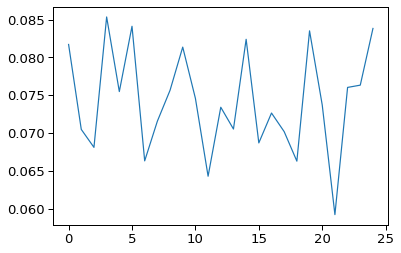

In [53]:
plt.plot(all_losses)

In [54]:
all_cv_scores[best_idx]

{'train_r2': array([0.20448306, 0.70470352, 0.70786033, 0.71487102, 0.75510352]),
 'validate_r2': array([0.84102359, 0.78043392, 0.54250501, 0.79114208, 0.5777513 ]),
 'train_rmsd': array([0.09466899, 0.0864754 , 0.07488359, 0.05335619, 0.09561308]),
 'validate_rmsd': array([0.07004704, 0.10994397, 0.09422512, 0.06572689, 0.07923241])}

In [55]:
best_emulator = all_emulators[best_idx]
best_emulator

In [56]:
best_emulator.train(retrain=True)

[INFO] >>> Training model on 80% of the dataset, testing on 20%...


/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:102: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)
/home/riley/Software/anaconda3/envs/olympus/lib/python3.7/site-packages/tensorflow_probability/python/layers/util.py:112: UserWarning: `layer.add_variable` is deprecated and will be removed in a future version. Please use the `layer.add_weight()` method instead.
  trainable=trainable)


[INFO]     =======================================================================
[INFO]           Epoch       Train R2     Train RMSD        Test R2      Test RMSD
[INFO]     =======================================================================
[INFO]               0         -1.849          0.202         -0.731          0.232 *
[INFO]             100          0.418          0.091          0.675          0.100 *
[INFO]             200          0.305          0.100          0.638          0.106
[INFO]             300          0.389          0.093          0.723          0.093 *
[INFO]             400          0.333          0.098          0.671          0.101
[INFO]             500          0.310          0.099          0.586          0.113
[INFO]             600          0.240          0.104          0.714          0.094
[INFO]             700          0.431          0.090          0.667          0.102
[INFO]             800          0.472          0.087          0.723          0.09

[INFO]            8500          0.700          0.065          0.750          0.088
[INFO]            8600          0.747          0.060          0.777          0.083
[INFO]            8700          0.679          0.068          0.710          0.095
[INFO]            8800          0.724          0.063          0.754          0.087
[INFO]            8900          0.696          0.066          0.732          0.091
[INFO]            9000          0.778          0.056          0.759          0.086
[INFO]            9100          0.720          0.063          0.783          0.082
[INFO]            9200          0.750          0.060          0.721          0.093
[INFO]            9300          0.701          0.065          0.778          0.083
[INFO]            9400          0.735          0.061          0.800          0.079
[INFO]            9500          0.742          0.061          0.752          0.088
[INFO]            9600          0.634          0.072          0.740          0.090
[INF

[INFO]           17300          0.604          0.075          0.770          0.084
[INFO]           17400          0.731          0.062          0.776          0.083
[INFO]           17500          0.736          0.061          0.793          0.080
[INFO]           17600          0.766          0.058          0.804          0.078
[INFO]           17700          0.731          0.062          0.794          0.080
[INFO]           17800          0.671          0.069          0.788          0.081
[INFO] Training completed in 21.07 seconds.
[INFO] ===========================================================================

[INFO] Performance statistics based on transformed data [identity, normalize]:
[INFO] Train R2   Score: 0.6571
[INFO] Test  R2   Score: 0.8044
[INFO] Train RMSD Score: 0.0700
[INFO] Test  RMSD Score: 0.0779

[INFO] Performance statistics based on original data:
[INFO] Train R2   Score: 0.7004
[INFO] Test  R2   Score: 0.6921
[INFO] Train RMSD Score: 0.0216
[INFO] Test  RMS

{'train_r2': 0.6571024753875614,
 'test_r2': 0.8044367364876658,
 'train_rmsd': 0.0699720953615391,
 'test_rmsd': 0.07788913645593738}

In [57]:
emulator.save('emulator_oer_plate_4098_BayesNeuralNet')